In [1]:
import netCDF4 as nc
import numpy as np
import matplotlib.pyplot as plt
from salishsea_tools import geo_tools, nc_tools, tidetools
import xarray as xr
import glob
import datetime

%matplotlib inline

In [2]:
from matplotlib.colors import LogNorm

In [147]:
grid = nc.Dataset('/home/sallen/MEOPAR/grid/bathymetry_201702.nc')
bathy, X, Y = tidetools.get_bathy_data(grid)
#grid.close()
ferry_data = 'https://salishsea.eos.ubc.ca/erddap/tabledap/ubcONCTWDP1mV18-01'
grid = nc.Dataset('/home/sallen/MEOPAR/sea_initial/bathymetry_201803b.nc')
bathyv18, Xv18, Yv18 = tidetools.get_bathy_data(grid)
#grid.close()
ferry = nc.Dataset(ferry_data)

In [4]:
threemonthsbase = sorted(glob.glob('/data/vdo/MEOPAR/completed-runs/threemonthbase/test*/*1h*grid_T*'))

In [5]:
threemonthv1803 = sorted(glob.glob('/data/sallen/results/MEOPAR/test_this_bathy/*/*1h*grid_T*'))

In [42]:
mesh_mask = nc.Dataset('/home/sallen/MEOPAR/grid/mesh_mask201702.nc')
tmask = mesh_mask.variables['tmask'][:]
mesh_mask.close()
mesh_mask = nc.Dataset('/home/sallen/MEOPAR/sea_initial/mesh_mask201803b.nc')
tmaskv18 = mesh_mask.variables['tmask'][:]
mesh_mask.close()

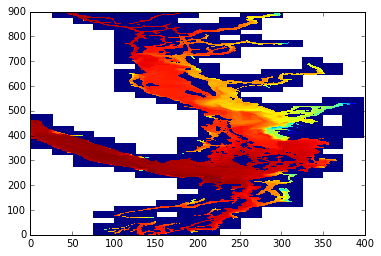

In [7]:
tester = nc.Dataset('/data/sallen/results/MEOPAR/test_this_bathy/part1_07mar17/SalishSea_1h_20170307_20170405_grid_T_20170307-20170307.nc')
pretty_sal = tester.variables['vosaline'][0, 0]
plt.pcolormesh(pretty_sal)
tester.close()

In [8]:
nc.num2date(ferry.variables['s.time'][135000], ferry.variables['s.time'].units)

datetime.datetime(2012, 5, 10, 0, 0)

In [9]:
with nc_tools.scDataset(threemonthsbase) as f:
    threemonthsbase_sal = f.variables['vosaline'][:,1,...]
    print('salinity is done')
    threemonthsbase_temp = f.variables['votemper'][:,1,...]
    print('temperature is done')
    timesbase = f.variables['time_counter'][:]
    print('time is done')

salinity is done
temperature is done
time is done


In [10]:
with nc_tools.scDataset(threemonthv1803) as f:
    threemonthv1803_sal = f.variables['vosaline'][:,1,...]
    print('salinity is done')
    threemonthv1803_temp = f.variables['votemper'][:,1,...]
    print('temperature is done')
    timev1803 = f.variables['time_counter'][:]
    print('time is done')

salinity is done
temperature is done
time is done


31.8029


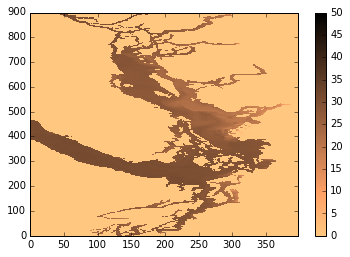

In [44]:
imin, imax = 0, 898
jmin, jmax = 0, 398
plt.pcolormesh(threemonthv1803_sal[0]*tmaskv18[0, 1], cmap='copper_r', vmax=50)
plt.colorbar()
plt.xlim((jmin, jmax))
plt.ylim((imin, imax))
print(np.max(threemonthv1803_sal[0, imin:imax, jmin:jmax]*tmaskv18[0,1, imin:imax, jmin:jmax]))

In [11]:
h = nc.Dataset('/data/vdo/MEOPAR/completed-runs/threemonthbase/testA/SalishSea_1h_20170307_20170316_grid_U_20170313-20170313.nc')

In [12]:
converted_timesbase = nc.num2date(timesbase, h.variables['time_counter'].units)
converted_timev1803 = nc.num2date(timev1803, h.variables['time_counter'].units)

In [151]:
list_of_modelbase_sals = np.array([])
list_of_modelbase_temps = np.array([])
list_of_modelv18_sals = np.array([])
list_of_modelv18_temps = np.array([])
list_of_ferrybase_sals = np.array([])
list_of_ferrybase_temps = np.array([])
unit = ferry.variables['s.time'].units
# for n in range(14500,135000):

In [135]:
ferry_times = nc.num2date(ferry.variables['s.time'][:], unit)

In [136]:
print (ferry_times)

[datetime.datetime(2012, 5, 10, 0, 0) datetime.datetime(2012, 5, 10, 0, 1)
 datetime.datetime(2012, 5, 10, 0, 2) ...,
 datetime.datetime(2018, 3, 22, 23, 57)
 datetime.datetime(2018, 3, 22, 23, 58)
 datetime.datetime(2018, 3, 22, 23, 59)]


In [137]:
istart, iend = 2179329, 2308867

In [182]:
istart = iend
iend = 2308867
print (istart, iend)

2179609 2308867


In [181]:
np.savetxt('base', list_of_modelbase_sals)
np.savetxt('v18', list_of_modelv18_sals)
np.savetxt('ferry', list_of_ferrybase_sals)

In [ ]:
for n in range(istart, iend):
    print (n)
    date = ferry_times[n]
    print (n, date, date.minute)
    print (ferry.variables['s.longitude'][n], ferry.variables['s.latitude'][n], ferry.variables['s.salinity'][n])
    if ((ferry.variables['s.latitude'][n].mask == False) 
        and (ferry.variables['s.salinity'][n].mask == False)):
        
        Yind, Xind = geo_tools.find_closest_model_point(ferry.variables['s.longitude'][n], 
                                                        ferry.variables['s.latitude'][n], 
                                                        X, Y, land_mask = bathy.mask)
        Yv18i, Xv18i = geo_tools.find_closest_model_point(ferry.variables['s.longitude'][n], 
                                                        ferry.variables['s.latitude'][n], 
                                                        Xv18, Yv18, land_mask = bathyv18.mask) 
        print (Yind, Xind, Yv18i, Xv18i)
        if date.minute <= 30:
            print (n, 'before')
            before = datetime.datetime(year = date.year, month = date.month, day = date.day, 
                               hour = (date.hour), minute = 30) - datetime.timedelta(hours=1)
            index = np.argmin(np.abs(converted_timesbase - date))
            print (index, 'base')
            delta = (date - before).seconds / 3600
            s_val = ((delta * (threemonthsbase_sal[index-1, Yind, Xind])) + 
                   (1- delta)*(threemonthsbase_sal[index, Yind, Xind]))
            t_val = ((delta * (threemonthsbase_temp[index-1, Yind, Xind])) + 
                   (1- delta)*(threemonthsbase_temp[index, Yind, Xind]))
            
            index = np.argmin(np.abs(converted_timev1803 - date))
            print (index, 'v18', threemonthv1803_sal[index, Yv18i, Xv18i])
            delta = (date - before).seconds / 3600
            s_val_v18 = ((delta * (threemonthv1803_sal[index-1, Yv18i, Xv18i])) + 
                   (1- delta)*(threemonthv1803_sal[index, Yv18i, Xv18i]))
            t_val_v18 = ((delta * (threemonthv1803_temp[index-1, Yv18i, Xv18i])) + 
                   (1- delta)*(threemonthv1803_temp[index, Yv18i, Xv18i]))
            
            
        elif date.minute > 30:
            print (n, 'after')
            before = datetime.datetime(year = date.year, month = date.month, day = date.day, 
                                   hour = (date.hour), minute = 30)
            index = np.argmin(np.abs(converted_timesbase - date))
            delta = (date - before).seconds / 3600
            s_val = ((delta * (threemonthsbase_sal[index, Yind, Xind])) + 
                   (1- delta)*(threemonthsbase_sal[index+1, Yind, Xind]))
            t_val = ((delta * (threemonthsbase_temp[index, Yind, Xind])) + 
                   (1- delta)*(threemonthsbase_temp[index+1, Yind, Xind]))
        
            index = np.argmin(np.abs(converted_timev1803 - date))
            delta = (date - before).seconds / 3600
            s_val_v18 = ((delta * (threemonthv1803_sal[index, Yv18i, Xv18i])) + 
                   (1- delta)*(threemonthv1803_sal[index+1, Yv18i, Xv18i]))
            t_val_v18 = ((delta * (threemonthv1803_temp[index, Yv18i, Xv18i])) + 
                   (1- delta)*(threemonthv1803_temp[index+1, Yv18i, Xv18i]))
        else:
            print ('bad minute')
        print(s_val, s_val_v18)    
        print(n, ferry.variables['s.salinity'][n])
        list_of_ferrybase_sals = np.append(list_of_ferrybase_sals, 
                                           ferry.variables['s.salinity'][n])
        list_of_ferrybase_temps = np.append(list_of_ferrybase_temps, 
                                            ferry.variables['s.temperature'][n])
        list_of_modelbase_sals = np.append(list_of_modelbase_sals, s_val)
        list_of_modelbase_temps = np.append(list_of_modelbase_temps, t_val)
        
        list_of_modelv18_sals = np.append(list_of_modelv18_sals, s_val_v18)
        list_of_modelv18_temps = np.append(list_of_modelv18_temps, t_val_v18)
    else:
        print ('bad point')
    print (n, date, date.minute, 'end of loop')
    if n % 1000 == 0:
        np.savetxt('base', list_of_modelbase_sals)
        np.savetxt('v18', list_of_modelv18_sals)
        np.savetxt('ferry', list_of_ferrybase_sals)

2179609
2179609 2017-03-07 05:11:00 11
-123.1328 49.0062 --
446 266 446 266
2179609 before
5 base
5 v18 26.2209
27.0491141955 26.260449028
2179609 17.890555703245706
2179609 2017-03-07 05:11:00 11 end of loop
2179610
2179610 2017-03-07 05:12:00 12
-123.1328 49.0062 --
447 266 447 266
2179610 before
5 base
5 v18 25.9886
26.7948606491 26.0708324432
2179610 18.49577618310857
2179610 2017-03-07 05:12:00 12 end of loop
2179611
2179611 2017-03-07 05:13:00 13
-123.1328 49.0062 --
448 265 448 265
2179611 before
5 base
5 v18 25.5409
26.3348136584 25.5398716291
2179611 18.29840486074286
2179611 2017-03-07 05:13:00 13 end of loop
2179612
2179612 2017-03-07 05:14:00 14
-123.1328 49.0062 --
449 264 449 264
2179612 before
5 base
5 v18 25.3945
25.7849819183 25.4312610626
2179612 18.417761704605713
2179612 2017-03-07 05:14:00 14 end of loop
2179613
2179613 2017-03-07 05:15:00 15
-123.1328 49.0062 --
450 264 450 264
2179613 before
5 base
5 v18 25.2363
25.7308473587 25.2711453438
2179613 23.470214368879

2179650 2017-03-07 05:52:00 52 end of loop
2179651
2179651 2017-03-07 05:53:00 53
-123.1328 49.0062 --
484 235 484 235
2179651 after
25.6889037768 26.9064015071
2179651 28.579018172491434
2179651 2017-03-07 05:53:00 53 end of loop
2179652
2179652 2017-03-07 05:54:00 54
-123.1328 49.0062 --
485 234 485 234
2179652 after
25.8711338043 26.9833503723
2179652 28.47595446382858
2179652 2017-03-07 05:54:00 54 end of loop
2179653
2179653 2017-03-07 05:55:00 55
-123.1328 49.0062 --
485 233 485 233
2179653 after
25.8759012222 26.9978734652
2179653 28.575317470662856
2179653 2017-03-07 05:55:00 55 end of loop
2179654
2179654 2017-03-07 05:56:00 56
-123.1328 49.0062 --
486 231 486 231
2179654 after
26.0308848063 26.8081478755
2179654 28.7509953124
2179654 2017-03-07 05:56:00 56 end of loop
2179655
2179655 2017-03-07 05:57:00 57
-123.1328 49.0062 --
486 230 486 230
2179655 after
25.810302639 26.7516710281
2179655 28.777432724377142
2179655 2017-03-07 05:57:00 57 end of loop
2179656
2179656 2017-03-

-123.1328 49.0062 --
481 214 481 214
2179703 after
23.5230436325 26.2448396683
2179703 28.829488705257138
2179703 2017-03-07 06:45:00 45 end of loop
2179704
2179704 2017-03-07 06:46:00 46
-123.1328 49.0062 --
482 214 482 214
2179704 after
23.9472848256 26.6985954285
2179704 28.955049666891412
2179704 2017-03-07 06:46:00 46 end of loop
2179705
2179705 2017-03-07 06:47:00 47
-123.1328 49.0062 --
482 215 482 215
2179705 after
23.7039393425 26.5448258082
2179705 28.743250630971424
2179705 2017-03-07 06:47:00 47 end of loop
2179706
2179706 2017-03-07 06:48:00 48
-123.1328 49.0062 --
483 216 483 216
2179706 after
24.6152124405 26.4225875854
2179706 27.899627925165706
2179706 2017-03-07 06:48:00 48 end of loop
2179707
2179707 2017-03-07 06:49:00 49
-123.1328 49.0062 --
484 217 484 217
2179707 after
24.6932898204 26.2444911639
2179707 27.25224958592
2179707 2017-03-07 06:49:00 49 end of loop
2179708
2179708 2017-03-07 06:50:00 50
-123.1328 49.0062 --
485 218 485 218
2179708 after
25.6710910797

-123.1328 49.0062 --
461 252 461 252
2179744 before
7 base
7 v18 25.3661
24.8123592377 24.9813911438
2179744 28.36112051392
2179744 2017-03-07 07:26:00 26 end of loop
2179745
2179745 2017-03-07 07:27:00 27
-123.1328 49.0062 --
460 252 460 252
2179745 before
7 base
7 v18 25.3553
25.0466994286 25.1046561241
2179745 28.46716655288001
2179745 2017-03-07 07:27:00 27 end of loop
2179746
2179746 2017-03-07 07:28:00 28
-123.1328 49.0062 --
459 253 459 253
2179746 before
7 base
7 v18 25.0479
25.07985967 25.0318578084
2179746 28.495365565908575
2179746 2017-03-07 07:28:00 28 end of loop
2179747
2179747 2017-03-07 07:29:00 29
-123.1328 49.0062 --
458 253 458 253
2179747 before
7 base
7 v18 25.0613
25.0602309227 24.9644391696
2179747 28.44748752668572
2179747 2017-03-07 07:29:00 29 end of loop
2179748
2179748 2017-03-07 07:30:00 30
-123.1328 49.0062 --
457 254 457 254
2179748 before
7 base
7 v18 25.0803
24.9167900085 24.9596862793
2179748 28.395645885097135
2179748 2017-03-07 07:30:00 30 end of lo

2179786 2017-03-07 08:08:00 8 end of loop
2179787
2179787 2017-03-07 08:09:00 9
-123.1328 49.0062 --
415 278 415 278
2179787 before
8 base
8 v18 26.4659
27.7454483986 26.2771022797
2179787 27.571112772434297
2179787 2017-03-07 08:09:00 9 end of loop
2179788
2179788 2017-03-07 08:10:00 10
-123.1328 49.0062 --
414 278 414 278
2179788 before
8 base
8 v18 26.5903
27.7620283763 26.4531116486
2179788 27.613555301188573
2179788 2017-03-07 08:10:00 10 end of loop
2179789
2179789 2017-03-07 08:11:00 11
-123.1328 49.0062 --
413 279 413 279
2179789 before
8 base
8 v18 25.9733
27.7052512487 25.9450263341
2179789 27.65757020958857
2179789 2017-03-07 08:11:00 11 end of loop
2179790
2179790 2017-03-07 08:12:00 12
-123.1328 49.0062 --
412 279 412 279
2179790 before
8 base
8 v18 26.218
27.6052202225 26.1928730011
2179790 27.726726447062852
2179790 2017-03-07 08:12:00 12 end of loop
2179791
2179791 2017-03-07 08:13:00 13
-123.1328 49.0062 --
411 280 411 280
2179791 before
8 base
8 v18 26.0421
27.5337722

-123.13201665999999 49.00566666999999 --
bad point
2179861 2017-03-07 09:23:00 23 end of loop
2179862
2179862 2017-03-07 09:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2179862 2017-03-07 09:24:00 24 end of loop
2179863
2179863 2017-03-07 09:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2179863 2017-03-07 09:25:00 25 end of loop
2179864
2179864 2017-03-07 09:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2179864 2017-03-07 09:26:00 26 end of loop
2179865
2179865 2017-03-07 09:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2179865 2017-03-07 09:27:00 27 end of loop
2179866
2179866 2017-03-07 09:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2179866 2017-03-07 09:28:00 28 end of loop
2179867
2179867 2017-03-07 09:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2179867 2017-03-07 09:29:00 29 end of loop
2179868
2179868 2017-03-07 09:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2179868 2017-03-07

-123.13201665999999 49.00566666999999 --
bad point
2179956 2017-03-07 10:58:00 58 end of loop
2179957
2179957 2017-03-07 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2179957 2017-03-07 10:59:00 59 end of loop
2179958
2179958 2017-03-07 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2179958 2017-03-07 11:00:00 0 end of loop
2179959
2179959 2017-03-07 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2179959 2017-03-07 11:01:00 1 end of loop
2179960
2179960 2017-03-07 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2179960 2017-03-07 11:02:00 2 end of loop
2179961
2179961 2017-03-07 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2179961 2017-03-07 11:03:00 3 end of loop
2179962
2179962 2017-03-07 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2179962 2017-03-07 11:04:00 4 end of loop
2179963
2179963 2017-03-07 11:05:00 5
-123.13204443833332 49.00566666999999 --
bad point
2179963 2017-03-07 11:05:00 5

2180047 2017-03-07 12:29:00 29 end of loop
2180048
2180048 2017-03-07 12:30:00 30
-123.13207221666666 49.00566666999999 --
bad point
2180048 2017-03-07 12:30:00 30 end of loop
2180049
2180049 2017-03-07 12:31:00 31
-123.13218332999999 49.00566666999999 --
bad point
2180049 2017-03-07 12:31:00 31 end of loop
2180050
2180050 2017-03-07 12:32:00 32
-123.13218332999999 49.00566666999999 --
bad point
2180050 2017-03-07 12:32:00 32 end of loop
2180051
2180051 2017-03-07 12:33:00 33
-123.13218332999999 49.00566666999999 --
bad point
2180051 2017-03-07 12:33:00 33 end of loop
2180052
2180052 2017-03-07 12:34:00 34
-123.13204443833332 49.00566666999999 --
bad point
2180052 2017-03-07 12:34:00 34 end of loop
2180053
2180053 2017-03-07 12:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2180053 2017-03-07 12:35:00 35 end of loop
2180054
2180054 2017-03-07 12:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2180054 2017-03-07 12:36:00 36 end of loop
2180055
2180055 2017-03-07

2180102 2017-03-07 13:24:00 24 end of loop
2180103
2180103 2017-03-07 13:25:00 25
-123.1328 49.0062 --
403 295 403 295
2180103 before
13 base
13 v18 25.0686
28.4911330541 25.0323057175
2180103 27.552830300685724
2180103 2017-03-07 13:25:00 25 end of loop
2180104
2180104 2017-03-07 13:26:00 26
-123.1328 49.0062 --
403 294 403 294
2180104 before
13 base
13 v18 25.9652
28.5195992788 25.8676241557
2180104 27.64772064933714
2180104 2017-03-07 13:26:00 26 end of loop
2180105
2180105 2017-03-07 13:27:00 27
-123.1328 49.0062 --
404 293 404 293
2180105 before
13 base
13 v18 26.6942
28.8026141167 26.5890374184
2180105 27.7451947911657
2180105 2017-03-07 13:27:00 27 end of loop
2180106
2180106 2017-03-07 13:28:00 28
-123.1328 49.0062 --
405 292 405 292
2180106 before
13 base
13 v18 26.7939
28.3446590424 26.7588427226
2180106 27.91988801178285
2180106 2017-03-07 13:28:00 28 end of loop
2180107
2180107 2017-03-07 13:29:00 29
-123.1328 49.0062 --
406 291 406 291
2180107 before
13 base
13 v18 27.1587

-123.1328 49.0062 --
443 269 443 269
2180145 before
14 base
14 v18 27.4628
27.8261354129 27.435684967
2180145 27.048315797279997
2180145 2017-03-07 14:07:00 7 end of loop
2180146
2180146 2017-03-07 14:08:00 8
-123.1328 49.0062 --
444 268 444 268
2180146 before
14 base
14 v18 27.3924
27.0700874964 27.3691265106
2180146 27.38431942900571
2180146 2017-03-07 14:08:00 8 end of loop
2180147
2180147 2017-03-07 14:09:00 9
-123.1328 49.0062 --
445 267 445 267
2180147 before
14 base
14 v18 27.1956
26.3625463486 27.2040088654
2180147 27.53373568396571
2180147 2017-03-07 14:09:00 9 end of loop
2180148
2180148 2017-03-07 14:10:00 10
-123.1328 49.0062 --
446 266 446 266
2180148 before
14 base
14 v18 27.0237
25.9376296997 27.0722344716
2180148 27.871601388285725
2180148 2017-03-07 14:10:00 10 end of loop
2180149
2180149 2017-03-07 14:11:00 11
-123.1328 49.0062 --
447 266 447 266
2180149 before
14 base
14 v18 26.7488
25.7202493985 26.806726106
2180149 27.89839882329143
2180149 2017-03-07 14:11:00 11 e

-123.1328 49.0062 --
481 238 481 238
2180186 after
25.4532304764 27.1846628189
2180186 28.890744530411435
2180186 2017-03-07 14:48:00 48 end of loop
2180187
2180187 2017-03-07 14:49:00 49
-123.1328 49.0062 --
482 237 482 237
2180187 after
25.2066456477 27.1451348305
2180187 28.926904238685708
2180187 2017-03-07 14:49:00 49 end of loop
2180188
2180188 2017-03-07 14:50:00 50
-123.1328 49.0062 --
482 236 482 236
2180188 after
25.0240154266 27.1362743378
2180188 28.949434982171436
2180188 2017-03-07 14:50:00 50 end of loop
2180189
2180189 2017-03-07 14:51:00 51
-123.1328 49.0062 --
483 236 483 236
2180189 after
24.856854248 27.1303887367
2180189 28.85663779066284
2180189 2017-03-07 14:51:00 51 end of loop
2180190
2180190 2017-03-07 14:52:00 52
-123.1328 49.0062 --
484 235 484 235
2180190 after
24.7176311493 26.9567016602
2180190 28.79970391637715
2180190 2017-03-07 14:52:00 52 end of loop
2180191
2180191 2017-03-07 14:53:00 53
-123.1328 49.0062 --
485 234 485 234
2180191 after
24.627629947

2180241 2017-03-07 15:43:00 43 end of loop
2180242
2180242 2017-03-07 15:44:00 44
-123.1328 49.0062 --
481 214 481 214
2180242 after
25.5530859629 26.8925238291
2180242 29.062214289028574
2180242 2017-03-07 15:44:00 44 end of loop
2180243
2180243 2017-03-07 15:45:00 45
-123.1328 49.0062 --
481 214 481 214
2180243 after
25.5627813339 26.8887071609
2180243 29.102841631908557
2180243 2017-03-07 15:45:00 45 end of loop
2180244
2180244 2017-03-07 15:46:00 46
-123.1328 49.0062 --
482 215 482 215
2180244 after
25.344138972 26.5547089895
2180244 28.930161191200003
2180244 2017-03-07 15:46:00 46 end of loop
2180245
2180245 2017-03-07 15:47:00 47
-123.1328 49.0062 --
483 215 483 215
2180245 after
25.19888738 26.634551843
2180245 28.455364495645714
2180245 2017-03-07 15:47:00 47 end of loop
2180246
2180246 2017-03-07 15:48:00 48
-123.1328 49.0062 --
484 216 484 216
2180246 after
25.3945720673 26.404312706
2180246 28.018490783942863
2180246 2017-03-07 15:48:00 48 end of loop
2180247
2180247 2017-0

2180282 2017-03-07 16:24:00 24 end of loop
2180283
2180283 2017-03-07 16:25:00 25
-123.1328 49.0062 --
465 249 465 249
2180283 before
16 base
16 v18 27.0176
26.0358026822 26.989871343
2180283 28.44161831405714
2180283 2017-03-07 16:25:00 25 end of loop
2180284
2180284 2017-03-07 16:26:00 26
-123.1328 49.0062 --
464 250 464 250
2180284 before
16 base
16 v18 27.0124
26.5310113271 26.948206838
2180284 28.274154020948576
2180284 2017-03-07 16:26:00 26 end of loop
2180285
2180285 2017-03-07 16:27:00 27
-123.1328 49.0062 --
463 251 463 251
2180285 before
16 base
16 v18 27.15
26.6558117867 27.0813519478
2180285 28.219968043359994
2180285 2017-03-07 16:27:00 27 end of loop
2180286
2180286 2017-03-07 16:28:00 28
-123.1328 49.0062 --
462 251 462 251
2180286 before
16 base
16 v18 27.2132
26.8044328054 27.2081202825
2180286 28.39207579627428
2180286 2017-03-07 16:28:00 28 end of loop
2180287
2180287 2017-03-07 16:29:00 29
-123.1328 49.0062 --
461 252 461 252
2180287 before
16 base
16 v18 27.2827
2

-123.1328 49.0062 --
423 273 423 273
2180325 before
17 base
17 v18 27.4258
26.1821657499 27.2759269079
2180325 28.05140693590857
2180325 2017-03-07 17:07:00 7 end of loop
2180326
2180326 2017-03-07 17:08:00 8
-123.1328 49.0062 --
422 273 422 273
2180326 before
17 base
17 v18 27.5091
25.9824766795 27.3285252253
2180326 27.90188351130286
2180326 2017-03-07 17:08:00 8 end of loop
2180327
2180327 2017-03-07 17:09:00 9
-123.1328 49.0062 --
421 273 421 273
2180327 before
17 base
17 v18 27.5856
26.1167943954 27.3948265076
2180327 27.83639783419428
2180327 2017-03-07 17:09:00 9 end of loop
2180328
2180328 2017-03-07 17:10:00 10
-123.1328 49.0062 --
420 274 420 274
2180328 before
17 base
17 v18 27.5083
26.2478167216 27.3617839813
2180328 27.738985649817156
2180328 2017-03-07 17:10:00 10 end of loop
2180329
2180329 2017-03-07 17:11:00 11
-123.1328 49.0062 --
419 275 419 275
2180329 before
17 base
17 v18 27.2961
26.2561646144 27.1848777771
2180329 27.700168469234278
2180329 2017-03-07 17:11:00 11

-123.1328 49.0062 --
bad point
2180366 2017-03-07 17:48:00 48 end of loop
2180367
2180367 2017-03-07 17:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2180367 2017-03-07 17:49:00 49 end of loop
2180368
2180368 2017-03-07 17:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2180368 2017-03-07 17:50:00 50 end of loop
2180369
2180369 2017-03-07 17:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2180369 2017-03-07 17:51:00 51 end of loop
2180370
2180370 2017-03-07 17:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2180370 2017-03-07 17:52:00 52 end of loop
2180371
2180371 2017-03-07 17:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2180371 2017-03-07 17:53:00 53 end of loop
2180372
2180372 2017-03-07 17:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2180372 2017-03-07 17:54:00 54 end of loop
2180373
2180373 2017-03-07 17:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2180373 2017-03-07 17:55:00 55 end of 

2180416 2017-03-07 18:38:00 38 end of loop
2180417
2180417 2017-03-07 18:39:00 39
-123.1328 49.0062 --
412 286 412 286
2180417 after
28.8146121025 27.6210824013
2180417 28.364292065622855
2180417 2017-03-07 18:39:00 39 end of loop
2180418
2180418 2017-03-07 18:40:00 40
-123.1328 49.0062 --
413 285 413 285
2180418 after
28.6831432978 27.6949208577
2180418 28.357515260057134
2180418 2017-03-07 18:40:00 40 end of loop
2180419
2180419 2017-03-07 18:41:00 41
-123.1328 49.0062 --
414 284 414 284
2180419 after
28.5503152529 27.6856886546
2180419 28.440300462320007
2180419 2017-03-07 18:41:00 41 end of loop
2180420
2180420 2017-03-07 18:42:00 42
-123.1328 49.0062 --
415 283 415 283
2180420 after
28.3525367737 27.6425689697
2180420 28.52345573476571
2180420 2017-03-07 18:42:00 42 end of loop
2180421
2180421 2017-03-07 18:43:00 43
-123.1328 49.0062 --
416 283 416 283
2180421 after
28.3358462334 27.5761995633
2180421 28.570930213291426
2180421 2017-03-07 18:43:00 43 end of loop
2180422
2180422 20

-123.1328 49.0062 --
453 262 453 262
2180458 before
19 base
19 v18 27.3876
26.5391998291 27.2503395081
2180458 28.562448740548575
2180458 2017-03-07 19:20:00 20 end of loop
2180459
2180459 2017-03-07 19:21:00 21
-123.1328 49.0062 --
454 261 454 261
2180459 before
19 base
19 v18 27.1937
26.610468483 27.0730628014
2180459 28.68984833141715
2180459 2017-03-07 19:21:00 21 end of loop
2180460
2180460 2017-03-07 19:22:00 22
-123.1328 49.0062 --
455 260 455 260
2180460 before
19 base
19 v18 27.1817
26.7467849731 27.0722120921
2180460 28.768664907737143
2180460 2017-03-07 19:22:00 22 end of loop
2180461
2180461 2017-03-07 19:23:00 23
-123.1328 49.0062 --
456 259 456 259
2180461 before
19 base
19 v18 27.2424
26.878644975 27.1251015027
2180461 28.85232588694857
2180461 2017-03-07 19:23:00 23 end of loop
2180462
2180462 2017-03-07 19:24:00 24
-123.1328 49.0062 --
457 259 457 259
2180462 before
19 base
19 v18 27.2468
26.966884613 27.132365036
2180462 28.99476774230857
2180462 2017-03-07 19:24:00 2

2180500 2017-03-07 20:02:00 2 end of loop
2180501
2180501 2017-03-07 20:03:00 3
-123.1328 49.0062 --
487 223 487 223
2180501 before
20 base
20 v18 26.2382
26.5534600258 26.204682827
2180501 28.77743774795429
2180501 2017-03-07 20:03:00 3 end of loop
2180502
2180502 2017-03-07 20:04:00 4
-123.1328 49.0062 --
487 221 487 221
2180502 before
20 base
20 v18 26.4389
26.5802756627 26.2838088353
2180502 28.55994532460572
2180502 2017-03-07 20:04:00 4 end of loop
2180503
2180503 2017-03-07 20:05:00 5
-123.1328 49.0062 --
487 220 487 220
2180503 before
20 base
20 v18 26.6422
26.6572004954 26.4708275795
2180503 28.652040889840006
2180503 2017-03-07 20:05:00 5 end of loop
2180504
2180504 2017-03-07 20:06:00 6
-123.1328 49.0062 --
486 219 486 219
2180504 before
20 base
20 v18 26.7804
26.8496089935 26.6878292084
2180504 28.70944028227427
2180504 2017-03-07 20:06:00 6 end of loop
2180505
2180505 2017-03-07 20:07:00 7
-123.1328 49.0062 --
485 218 485 218
2180505 before
20 base
20 v18 26.9725
27.066839

2180553 2017-03-07 20:55:00 55 end of loop
2180554
2180554 2017-03-07 20:56:00 56
-123.1328 49.0062 --
487 224 487 224
2180554 after
26.6245558421 26.3406422933
2180554 28.261891469142864
2180554 2017-03-07 20:56:00 56 end of loop
2180555
2180555 2017-03-07 20:57:00 57
-123.1328 49.0062 --
487 225 487 225
2180555 after
26.3531624794 26.3964598656
2180555 28.10214339052572
2180555 2017-03-07 20:57:00 57 end of loop
2180556
2180556 2017-03-07 20:58:00 58
-123.1328 49.0062 --
486 226 486 226
2180556 after
25.9313985189 26.7600042979
2180556 27.963591458399996
2180556 2017-03-07 20:58:00 58 end of loop
2180557
2180557 2017-03-07 20:59:00 59
-123.1328 49.0062 --
486 227 486 227
2180557 after
26.036420091 26.9011125247
2180557 28.230656540994296
2180557 2017-03-07 20:59:00 59 end of loop
2180558
2180558 2017-03-07 21:00:00 0
-123.1328 49.0062 --
486 229 486 229
2180558 before
20 base
20 v18 26.9057
25.7077150345 26.810749054
2180558 28.229564750228572
2180558 2017-03-07 21:00:00 0 end of loo

2180593 2017-03-07 21:35:00 35 end of loop
2180594
2180594 2017-03-07 21:36:00 36
-123.1328 49.0062 --
454 256 454 256
2180594 after
27.7927021027 27.7943891525
2180594 28.306303240137137
2180594 2017-03-07 21:36:00 36 end of loop
2180595
2180595 2017-03-07 21:37:00 37
-123.1328 49.0062 --
452 257 452 257
2180595 after
27.405746301 27.800917085
2180595 28.228312204994282
2180595 2017-03-07 21:37:00 37 end of loop
2180596
2180596 2017-03-07 21:38:00 38
-123.1328 49.0062 --
451 258 451 258
2180596 after
27.2737032572 27.8799214681
2180596 28.403110920731436
2180596 2017-03-07 21:38:00 38 end of loop
2180597
2180597 2017-03-07 21:39:00 39
-123.1328 49.0062 --
450 258 450 258
2180597 after
27.4105900764 27.9118582726
2180597 28.166490390148574
2180597 2017-03-07 21:39:00 39 end of loop
2180598
2180598 2017-03-07 21:40:00 40
-123.1328 49.0062 --
449 259 449 259
2180598 after
27.4280246099 27.9065291087
2180598 27.916076791257144
2180598 2017-03-07 21:40:00 40 end of loop
2180599
2180599 201

2180635 2017-03-07 22:17:00 17 end of loop
2180636
2180636 2017-03-07 22:18:00 18
-123.1328 49.0062 --
410 281 410 281
2180636 before
22 base
22 v18 27.9265
27.4489398956 27.8782592773
2180636 27.934531739154288
2180636 2017-03-07 22:18:00 18 end of loop
2180637
2180637 2017-03-07 22:19:00 19
-123.1328 49.0062 --
409 281 409 281
2180637 before
22 base
22 v18 27.9331
27.5024119377 27.8880616506
2180637 27.968407394354294
2180637 2017-03-07 22:19:00 19 end of loop
2180638
2180638 2017-03-07 22:20:00 20
-123.1328 49.0062 --
408 282 408 282
2180638 before
22 base
22 v18 27.9123
27.6170438131 27.9227679571
2180638 27.78471192349714
2180638 2017-03-07 22:20:00 20 end of loop
2180639
2180639 2017-03-07 22:21:00 21
-123.1328 49.0062 --
408 283 408 283
2180639 before
22 base
22 v18 27.908
27.679850769 27.9306450844
2180639 27.661282633097137
2180639 2017-03-07 22:21:00 21 end of loop
2180640
2180640 2017-03-07 22:22:00 22
-123.1328 49.0062 --
407 284 407 284
2180640 before
22 base
22 v18 27.935

2180696 2017-03-07 23:18:00 18 end of loop
2180697
2180697 2017-03-07 23:19:00 19
-123.1328 49.0062 --
396 305 396 305
2180697 before
23 base
23 v18 25.5416
28.9711947759 25.7666318576
2180697 28.274892486788577
2180697 2017-03-07 23:19:00 19 end of loop
2180698
2180698 2017-03-07 23:20:00 20
-123.1328 49.0062 --
396 304 396 304
2180698 before
23 base
23 v18 26.0649
29.0132630666 26.8535795212
2180698 28.191974996994283
2180698 2017-03-07 23:20:00 20 end of loop
2180699
2180699 2017-03-07 23:21:00 21
-123.1328 49.0062 --
396 303 396 303
2180699 before
23 base
23 v18 26.4366
28.9943380356 27.0646465302
2180699 27.654398657885704
2180699 2017-03-07 23:21:00 21 end of loop
2180700
2180700 2017-03-07 23:22:00 22
-123.1328 49.0062 --
396 302 396 302
2180700 before
23 base
23 v18 26.8068
29.0458535512 27.2454184214
2180700 27.941345384285714
2180700 2017-03-07 23:22:00 22 end of loop
2180701
2180701 2017-03-07 23:23:00 23
-123.1328 49.0062 --
397 301 397 301
2180701 before
23 base
23 v18 26.

-123.1328 49.0062 --
434 274 434 274
2180739 before
24 base
24 v18 28.1007
28.107696406 28.0074290911
2180739 26.74523166657142
2180739 2017-03-08 00:01:00 1 end of loop
2180740
2180740 2017-03-08 00:02:00 2
-123.1328 49.0062 --
435 274 435 274
2180740 before
24 base
24 v18 28.1564
28.219234848 28.0499617259
2180740 26.181232986217147
2180740 2017-03-08 00:02:00 2 end of loop
2180741
2180741 2017-03-08 00:03:00 3
-123.1328 49.0062 --
436 273 436 273
2180741 before
24 base
24 v18 28.2693
28.2879745483 28.1915772438
2180741 25.907516687485717
2180741 2017-03-08 00:03:00 3 end of loop
2180742
2180742 2017-03-08 00:04:00 4
-123.1328 49.0062 --
437 272 437 272
2180742 before
24 base
24 v18 28.3114
28.2987979253 28.2906003316
2180742 26.078299890559997
2180742 2017-03-08 00:04:00 4 end of loop
2180743
2180743 2017-03-08 00:05:00 5
-123.1328 49.0062 --
438 271 438 271
2180743 before
24 base
24 v18 28.3084
28.3487079938 28.332098643
2180743 26.37434598969143
2180743 2017-03-08 00:05:00 5 end o

2180779 2017-03-08 00:41:00 41 end of loop
2180780
2180780 2017-03-08 00:42:00 42
-123.1328 49.0062 --
474 242 474 242
2180780 after
27.6957481384 28.1944248199
2180780 29.475231032879996
2180780 2017-03-08 00:42:00 42 end of loop
2180781
2180781 2017-03-08 00:43:00 43
-123.1328 49.0062 --
475 241 475 241
2180781 after
27.7342342377 28.2074060758
2180781 29.45004784066286
2180781 2017-03-08 00:43:00 43 end of loop
2180782
2180782 2017-03-08 00:44:00 44
-123.1328 49.0062 --
476 240 476 240
2180782 after
27.6891379038 28.2575285594
2180782 29.460428225565717
2180782 2017-03-08 00:44:00 44 end of loop
2180783
2180783 2017-03-08 00:45:00 45
-123.1328 49.0062 --
477 239 477 239
2180783 after
27.7185544968 28.2898755074
2180783 29.45239887476572
2180783 2017-03-08 00:45:00 45 end of loop
2180784
2180784 2017-03-08 00:46:00 46
-123.1328 49.0062 --
478 239 478 239
2180784 after
27.6789034526 28.2254751841
2180784 29.418414375394278
2180784 2017-03-08 00:46:00 46 end of loop
2180785
2180785 201

2180842 2017-03-08 01:44:00 44 end of loop
2180843
2180843 2017-03-08 01:45:00 45
-123.1328 49.0062 --
481 214 481 214
2180843 after
24.6313481331 28.2090449333
2180843 29.27085516945143
2180843 2017-03-08 01:45:00 45 end of loop
2180844
2180844 2017-03-08 01:46:00 46
-123.1328 49.0062 --
482 215 482 215
2180844 after
25.2152036031 27.9267771403
2180844 28.822745390205714
2180844 2017-03-08 01:46:00 46 end of loop
2180845
2180845 2017-03-08 01:47:00 47
-123.1328 49.0062 --
482 215 482 215
2180845 after
25.226088206 27.9284859022
2180845 28.346580607142858
2180845 2017-03-08 01:47:00 47 end of loop
2180846
2180846 2017-03-08 01:48:00 48
-123.1328 49.0062 --
483 216 483 216
2180846 after
26.4053220749 27.6700603485
2180846 26.597675809679988
2180846 2017-03-08 01:48:00 48 end of loop
2180847
2180847 2017-03-08 01:49:00 49
-123.1328 49.0062 --
484 217 484 217
2180847 after
27.0006432533 27.8352970123
2180847 26.025289430022863
2180847 2017-03-08 01:49:00 49 end of loop
2180848
2180848 201

2180883 2017-03-08 02:25:00 25 end of loop
2180884
2180884 2017-03-08 02:26:00 26
-123.1328 49.0062 --
463 251 463 251
2180884 before
26 base
26 v18 28.0397
28.1958602905 27.8255271912
2180884 28.902739158102868
2180884 2017-03-08 02:26:00 26 end of loop
2180885
2180885 2017-03-08 02:27:00 27
-123.1328 49.0062 --
462 251 462 251
2180885 before
26 base
26 v18 28.2591
28.1875347137 28.0086367607
2180885 28.85207805714287
2180885 2017-03-08 02:27:00 27 end of loop
2180886
2180886 2017-03-08 02:28:00 28
-123.1328 49.0062 --
461 252 461 252
2180886 before
26 base
26 v18 28.4109
27.8963161469 28.2328430812
2180886 28.67933565898286
2180886 2017-03-08 02:28:00 28 end of loop
2180887
2180887 2017-03-08 02:29:00 29
-123.1328 49.0062 --
460 253 460 253
2180887 before
26 base
26 v18 28.3294
27.8510919253 28.1742300987
2180887 28.63004097100573
2180887 2017-03-08 02:29:00 29 end of loop
2180888
2180888 2017-03-08 02:30:00 30
-123.1328 49.0062 --
459 253 459 253
2180888 before
26 base
26 v18 28.397

-123.1328 49.0062 --
420 275 420 275
2180926 before
27 base
27 v18 27.7889
27.4089307149 27.9499949773
2180926 28.33503977592001
2180926 2017-03-08 03:08:00 8 end of loop
2180927
2180927 2017-03-08 03:09:00 9
-123.1328 49.0062 --
419 276 419 276
2180927 before
27 base
27 v18 27.7646
27.2838246346 27.8907196999
2180927 28.34486924186286
2180927 2017-03-08 03:09:00 9 end of loop
2180928
2180928 2017-03-08 03:10:00 10
-123.1328 49.0062 --
418 276 418 276
2180928 before
27 base
27 v18 27.8329
27.2253672282 27.9385884603
2180928 28.38606592348572
2180928 2017-03-08 03:10:00 10 end of loop
2180929
2180929 2017-03-08 03:11:00 11
-123.1328 49.0062 --
417 277 417 277
2180929 before
27 base
27 v18 27.7787
27.1666262627 27.8852981567
2180929 28.374660728845715
2180929 2017-03-08 03:11:00 11 end of loop
2180930
2180930 2017-03-08 03:12:00 12
-123.1328 49.0062 --
416 277 416 277
2180930 before
27 base
27 v18 27.8287
27.1229618073 27.9350790024
2180930 28.257435556217143
2180930 2017-03-08 03:12:00 

2180993 2017-03-08 04:15:00 15 end of loop
2180994
2180994 2017-03-08 04:16:00 16
-123.1328 49.0062 --
396 305 396 305
2180994 before
28 base
28 v18 25.9864
27.6709941228 26.0495305379
2180994 27.85391504769143
2180994 2017-03-08 04:16:00 16 end of loop
2180995
2180995 2017-03-08 04:17:00 17
-123.1328 49.0062 --
396 304 396 304
2180995 before
28 base
28 v18 26.4602
27.637628301 26.2351754506
2180995 27.79725412109715
2180995 2017-03-08 04:17:00 17 end of loop
2180996
2180996 2017-03-08 04:18:00 18
-123.1328 49.0062 --
397 303 397 303
2180996 before
28 base
28 v18 26.3638
27.0693367004 26.1763809204
2180996 27.903514499348567
2180996 2017-03-08 04:18:00 18 end of loop
2180997
2180997 2017-03-08 04:19:00 19
-123.1328 49.0062 --
397 302 397 302
2180997 before
28 base
28 v18 27.1378
27.803007857 26.8776251157
2180997 28.18946655747428
2180997 2017-03-08 04:19:00 19 end of loop
2180998
2180998 2017-03-08 04:20:00 20
-123.1328 49.0062 --
398 301 398 301
2180998 before
28 base
28 v18 26.9611


2181035 2017-03-08 04:57:00 57 end of loop
2181036
2181036 2017-03-08 04:58:00 58
-123.1328 49.0062 --
434 275 434 275
2181036 after
28.3245438894 21.9082649231
2181036 16.073502732788576
2181036 2017-03-08 04:58:00 58 end of loop
2181037
2181037 2017-03-08 04:59:00 59
-123.1328 49.0062 --
435 274 435 274
2181037 after
28.3600055377 22.0810318629
2181037 16.147843301874286
2181037 2017-03-08 04:59:00 59 end of loop
2181038
2181038 2017-03-08 05:00:00 0
-123.1328 49.0062 --
436 273 436 273
2181038 before
28 base
28 v18 23.6365
28.3988218307 25.7322244644
2181038 16.186417676228572
2181038 2017-03-08 05:00:00 0 end of loop
2181039
2181039 2017-03-08 05:01:00 1
-123.1328 49.0062 --
437 273 437 273
2181039 before
29 base
29 v18 22.9461
28.4326190948 23.9455790202
2181039 16.205768495382856
2181039 2017-03-08 05:01:00 1 end of loop
2181040
2181040 2017-03-08 05:02:00 2
-123.1328 49.0062 --
438 272 438 272
2181040 before
29 base
29 v18 25.1238
28.4775918325 25.9061672211
2181040 16.294722650

2181075 2017-03-08 05:37:00 37 end of loop
2181076
2181076 2017-03-08 05:38:00 38
-123.1328 49.0062 --
473 246 473 246
2181076 after
26.4956968943 27.9239293416
2181076 29.471948962480006
2181076 2017-03-08 05:38:00 38 end of loop
2181077
2181077 2017-03-08 05:39:00 39
-123.1328 49.0062 --
474 245 474 245
2181077 after
26.2603259087 27.9597091675
2181077 29.499000925394295
2181077 2017-03-08 05:39:00 39 end of loop
2181078
2181078 2017-03-08 05:40:00 40
-123.1328 49.0062 --
475 244 475 244
2181078 after
26.1361160278 28.0529521306
2181078 29.51114793492572
2181078 2017-03-08 05:40:00 40 end of loop
2181079
2181079 2017-03-08 05:41:00 41
-123.1328 49.0062 --
476 244 476 244
2181079 after
26.0246834119 28.0182460467
2181079 29.480085482925713
2181079 2017-03-08 05:41:00 41 end of loop
2181080
2181080 2017-03-08 05:42:00 42
-123.1328 49.0062 --
477 243 477 243
2181080 after
25.8674114227 28.0778648376
2181080 29.46709786148571
2181080 2017-03-08 05:42:00 42 end of loop
2181081
2181081 201

2181142 2017-03-08 06:44:00 44 end of loop
2181143
2181143 2017-03-08 06:45:00 45
-123.1328 49.0062 --
481 214 481 214
2181143 after
25.8561711311 28.5777859688
2181143 29.203448811348572
2181143 2017-03-08 06:45:00 45 end of loop
2181144
2181144 2017-03-08 06:46:00 46
-123.1328 49.0062 --
482 215 482 215
2181144 after
25.7015858968 28.4989543915
2181144 27.777693986228574
2181144 2017-03-08 06:46:00 46 end of loop
2181145
2181145 2017-03-08 06:47:00 47
-123.1328 49.0062 --
483 215 483 215
2181145 after
26.2977752686 28.5343365669
2181145 27.74061328881144
2181145 2017-03-08 06:47:00 47 end of loop
2181146
2181146 2017-03-08 06:48:00 48
-123.1328 49.0062 --
483 216 483 216
2181146 after
26.2455133438 28.4162330627
2181146 27.97228224685714
2181146 2017-03-08 06:48:00 48 end of loop
2181147
2181147 2017-03-08 06:49:00 49
-123.1328 49.0062 --
484 217 484 217
2181147 after
26.5360448201 28.4035628955
2181147 28.104221476937152
2181147 2017-03-08 06:49:00 49 end of loop
2181148
2181148 201

2181183 2017-03-08 07:25:00 25 end of loop
2181184
2181184 2017-03-08 07:26:00 26
-123.1328 49.0062 --
461 252 461 252
2181184 before
31 base
31 v18 28.7039
27.1945226034 28.7404616038
2181184 28.27835373144
2181184 2017-03-08 07:26:00 26 end of loop
2181185
2181185 2017-03-08 07:27:00 27
-123.1328 49.0062 --
460 253 460 253
2181185 before
31 base
31 v18 28.7205
27.492152977 28.6771605492
2181185 28.35527139560001
2181185 2017-03-08 07:27:00 27 end of loop
2181186
2181186 2017-03-08 07:28:00 28
-123.1328 49.0062 --
459 253 459 253
2181186 before
31 base
31 v18 28.7424
28.1958214442 28.675241216
2181186 28.238461505348575
2181186 2017-03-08 07:28:00 28 end of loop
2181187
2181187 2017-03-08 07:29:00 29
-123.1328 49.0062 --
458 254 458 254
2181187 before
31 base
31 v18 28.6229
28.3605197271 28.5692198435
2181187 28.276982294880003
2181187 2017-03-08 07:29:00 29 end of loop
2181188
2181188 2017-03-08 07:30:00 30
-123.1328 49.0062 --
457 255 457 255
2181188 before
31 base
31 v18 28.493
28.

-123.1328 49.0062 --
415 277 415 277
2181226 before
32 base
32 v18 28.1316
27.3896653493 28.1154824575
2181226 27.926505737405712
2181226 2017-03-08 08:08:00 8 end of loop
2181227
2181227 2017-03-08 08:09:00 9
-123.1328 49.0062 --
414 278 414 278
2181227 before
32 base
32 v18 28.0646
27.3812497139 28.0635764122
2181227 28.340917361177148
2181227 2017-03-08 08:09:00 9 end of loop
2181228
2181228 2017-03-08 08:10:00 10
-123.1328 49.0062 --
413 279 413 279
2181228 before
32 base
32 v18 28.0411
27.4098409017 28.017525355
2181228 28.22987118843428
2181228 2017-03-08 08:10:00 10 end of loop
2181229
2181229 2017-03-08 08:11:00 11
-123.1328 49.0062 --
413 280 413 280
2181229 before
32 base
32 v18 28.0098
27.398747762 27.962699604
2181229 27.85788367363428
2181229 2017-03-08 08:11:00 11 end of loop
2181230
2181230 2017-03-08 08:12:00 12
-123.1328 49.0062 --
412 281 412 281
2181230 before
32 base
32 v18 28.0402
27.3984584808 27.9591575623
2181230 27.729645145382857
2181230 2017-03-08 08:12:00 12

-123.13201665999999 49.00566666999999 --
bad point
2181303 2017-03-08 09:25:00 25 end of loop
2181304
2181304 2017-03-08 09:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2181304 2017-03-08 09:26:00 26 end of loop
2181305
2181305 2017-03-08 09:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2181305 2017-03-08 09:27:00 27 end of loop
2181306
2181306 2017-03-08 09:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2181306 2017-03-08 09:28:00 28 end of loop
2181307
2181307 2017-03-08 09:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2181307 2017-03-08 09:29:00 29 end of loop
2181308
2181308 2017-03-08 09:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2181308 2017-03-08 09:30:00 30 end of loop
2181309
2181309 2017-03-08 09:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2181309 2017-03-08 09:31:00 31 end of loop
2181310
2181310 2017-03-08 09:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2181310 2017-03-08

-123.13201665999999 49.00566666999999 --
bad point
2181393 2017-03-08 10:55:00 55 end of loop
2181394
2181394 2017-03-08 10:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2181394 2017-03-08 10:56:00 56 end of loop
2181395
2181395 2017-03-08 10:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2181395 2017-03-08 10:57:00 57 end of loop
2181396
2181396 2017-03-08 10:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2181396 2017-03-08 10:58:00 58 end of loop
2181397
2181397 2017-03-08 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2181397 2017-03-08 10:59:00 59 end of loop
2181398
2181398 2017-03-08 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2181398 2017-03-08 11:00:00 0 end of loop
2181399
2181399 2017-03-08 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2181399 2017-03-08 11:01:00 1 end of loop
2181400
2181400 2017-03-08 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2181400 2017-03-08 11:0

-123.13201665999999 49.00566666999999 --
bad point
2181480 2017-03-08 12:22:00 22 end of loop
2181481
2181481 2017-03-08 12:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2181481 2017-03-08 12:23:00 23 end of loop
2181482
2181482 2017-03-08 12:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2181482 2017-03-08 12:24:00 24 end of loop
2181483
2181483 2017-03-08 12:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2181483 2017-03-08 12:25:00 25 end of loop
2181484
2181484 2017-03-08 12:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2181484 2017-03-08 12:26:00 26 end of loop
2181485
2181485 2017-03-08 12:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2181485 2017-03-08 12:27:00 27 end of loop
2181486
2181486 2017-03-08 12:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2181486 2017-03-08 12:28:00 28 end of loop
2181487
2181487 2017-03-08 12:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2181487 2017-03-08

-123.1328 49.0062 --
397 300 397 300
2181539 before
37 base
37 v18 28.1138
29.4505016327 28.363312149
2181539 26.376318580982865
2181539 2017-03-08 13:21:00 21 end of loop
2181540
2181540 2017-03-08 13:22:00 22
-123.1328 49.0062 --
398 299 398 299
2181540 before
37 base
37 v18 28.076
29.4402089437 28.5091506958
2181540 23.35878640427428
2181540 2017-03-08 13:22:00 22 end of loop
2181541
2181541 2017-03-08 13:23:00 23
-123.1328 49.0062 --
399 298 399 298
2181541 before
37 base
37 v18 28.483
29.3525723139 28.5028193792
2181541 22.44156996785143
2181541 2017-03-08 13:23:00 23 end of loop
2181542
2181542 2017-03-08 13:24:00 24
-123.1328 49.0062 --
400 298 400 298
2181542 before
37 base
37 v18 28.2981
29.3426994324 28.4547027588
2181542 21.00683131227428
2181542 2017-03-08 13:24:00 24 end of loop
2181543
2181543 2017-03-08 13:25:00 25
-123.1328 49.0062 --
400 297 400 297
2181543 before
37 base
37 v18 28.342
29.3424819311 28.4310166041
2181543 21.33343750569143
2181543 2017-03-08 13:25:00 25

2181581 2017-03-08 14:03:00 3 end of loop
2181582
2181582 2017-03-08 14:04:00 4
-123.1328 49.0062 --
438 270 438 270
2181582 before
38 base
38 v18 26.2592
26.6623558044 26.5722377777
2181582 24.240715560319998
2181582 2017-03-08 14:04:00 4 end of loop
2181583
2181583 2017-03-08 14:05:00 5
-123.1328 49.0062 --
439 270 439 270
2181583 before
38 base
38 v18 26.6868
26.7041128476 26.846924305
2181583 24.528779195371424
2181583 2017-03-08 14:05:00 5 end of loop
2181584
2181584 2017-03-08 14:06:00 6
-123.1328 49.0062 --
441 270 441 270
2181584 before
38 base
38 v18 27.2181
26.7657836914 27.2694347382
2181584 25.459698275714278
2181584 2017-03-08 14:06:00 6 end of loop
2181585
2181585 2017-03-08 14:07:00 7
-123.1328 49.0062 --
442 270 442 270
2181585 before
38 base
38 v18 27.3295
26.7797968229 27.3871757825
2181585 25.92036867234286
2181585 2017-03-08 14:07:00 7 end of loop
2181586
2181586 2017-03-08 14:08:00 8
-123.1328 49.0062 --
443 269 443 269
2181586 before
38 base
38 v18 27.536
26.98020

-123.1328 49.0062 --
476 242 476 242
2181622 after
26.0804112116 27.8126180013
2181622 29.326092749188568
2181622 2017-03-08 14:44:00 44 end of loop
2181623
2181623 2017-03-08 14:45:00 45
-123.1328 49.0062 --
477 241 477 241
2181623 after
26.2870526314 27.8709259033
2181623 29.34327170849143
2181623 2017-03-08 14:45:00 45 end of loop
2181624
2181624 2017-03-08 14:46:00 46
-123.1328 49.0062 --
478 240 478 240
2181624 after
26.3567424774 27.8634332021
2181624 29.34561102091428
2181624 2017-03-08 14:46:00 46 end of loop
2181625
2181625 2017-03-08 14:47:00 47
-123.1328 49.0062 --
479 239 479 239
2181625 after
26.4830637932 27.7981422106
2181625 29.31766151221714
2181625 2017-03-08 14:47:00 47 end of loop
2181626
2181626 2017-03-08 14:48:00 48
-123.1328 49.0062 --
480 239 480 239
2181626 after
26.6325653076 27.6698007584
2181626 29.205679279599998
2181626 2017-03-08 14:48:00 48 end of loop
2181627
2181627 2017-03-08 14:49:00 49
-123.1328 49.0062 --
481 238 481 238
2181627 after
26.808217779

2181682 2017-03-08 15:44:00 44 end of loop
2181683
2181683 2017-03-08 15:45:00 45
-123.1328 49.0062 --
481 214 481 214
2181683 after
26.5946083069 27.8693556786
2181683 29.177562318331425
2181683 2017-03-08 15:45:00 45 end of loop
2181684
2181684 2017-03-08 15:46:00 46
-123.1328 49.0062 --
482 214 482 214
2181684 after
27.3515163422 28.2865830739
2181684 28.921291228491434
2181684 2017-03-08 15:46:00 46 end of loop
2181685
2181685 2017-03-08 15:47:00 47
-123.1328 49.0062 --
482 215 482 215
2181685 after
27.2583167394 27.9362860362
2181685 26.861991321051438
2181685 2017-03-08 15:47:00 47 end of loop
2181686
2181686 2017-03-08 15:48:00 48
-123.1328 49.0062 --
483 216 483 216
2181686 after
27.8250905991 27.8848268509
2181686 24.660077082102852
2181686 2017-03-08 15:48:00 48 end of loop
2181687
2181687 2017-03-08 15:49:00 49
-123.1328 49.0062 --
484 217 484 217
2181687 after
27.8853390058 27.6433485667
2181687 23.690109736628575
2181687 2017-03-08 15:49:00 49 end of loop
2181688
2181688 2

2181723 2017-03-08 16:25:00 25 end of loop
2181724
2181724 2017-03-08 16:26:00 26
-123.1328 49.0062 --
464 250 464 250
2181724 before
40 base
40 v18 27.3359
26.5201755524 27.323137792
2181724 27.872172401554288
2181724 2017-03-08 16:26:00 26 end of loop
2181725
2181725 2017-03-08 16:27:00 27
-123.1328 49.0062 --
463 251 463 251
2181725 before
40 base
40 v18 27.2033
26.5414541245 27.239328289
2181725 27.818875597119998
2181725 2017-03-08 16:27:00 27 end of loop
2181726
2181726 2017-03-08 16:28:00 28
-123.1328 49.0062 --
462 251 462 251
2181726 before
40 base
40 v18 27.1437
26.538038063 27.18172671
2181726 27.871594690182853
2181726 2017-03-08 16:28:00 28 end of loop
2181727
2181727 2017-03-08 16:29:00 29
-123.1328 49.0062 --
461 252 461 252
2181727 before
40 base
40 v18 27.1904
26.5422024091 27.2371096929
2181727 28.078350054651434
2181727 2017-03-08 16:29:00 29 end of loop
2181728
2181728 2017-03-08 16:30:00 30
-123.1328 49.0062 --
460 253 460 253
2181728 before
40 base
40 v18 27.2587


-123.1328 49.0062 --
422 274 422 274
2181766 before
41 base
41 v18 27.2384
27.8702324549 27.3599463781
2181766 22.09846299804571
2181766 2017-03-08 17:08:00 8 end of loop
2181767
2181767 2017-03-08 17:09:00 9
-123.1328 49.0062 --
421 275 421 275
2181767 before
41 base
41 v18 27.658
27.9575155258 27.6982192993
2181767 22.48212530612572
2181767 2017-03-08 17:09:00 9 end of loop
2181768
2181768 2017-03-08 17:10:00 10
-123.1328 49.0062 --
420 275 420 275
2181768 before
41 base
41 v18 27.8733
27.8625958761 27.8683427175
2181768 22.805148014514277
2181768 2017-03-08 17:10:00 10 end of loop
2181769
2181769 2017-03-08 17:11:00 11
-123.1328 49.0062 --
419 276 419 276
2181769 before
41 base
41 v18 27.9484
27.5390728951 27.9289580027
2181769 23.831374400411427
2181769 2017-03-08 17:11:00 11 end of loop
2181770
2181770 2017-03-08 17:12:00 12
-123.1328 49.0062 --
418 276 418 276
2181770 before
41 base
41 v18 27.9832
27.4777952194 27.9614738464
2181770 24.936300145828568
2181770 2017-03-08 17:12:00 

2181831 2017-03-08 18:13:00 13 end of loop
2181832
2181832 2017-03-08 18:14:00 14
-123.1328 49.0062 --
396 305 396 305
2181832 before
42 base
42 v18 27.3768
28.7850463867 27.2427817027
2181832 29.06370294238856
2181832 2017-03-08 18:14:00 14 end of loop
2181833
2181833 2017-03-08 18:15:00 15
-123.1328 49.0062 --
396 304 396 304
2181833 before
42 base
42 v18 28.5781
28.896900177 27.8030805588
2181833 29.122055139954284
2181833 2017-03-08 18:15:00 15 end of loop
2181834
2181834 2017-03-08 18:16:00 16
-123.1328 49.0062 --
396 303 396 303
2181834 before
42 base
42 v18 28.3997
28.9622180939 28.7460211436
2181834 26.720812058079996
2181834 2017-03-08 18:16:00 16 end of loop
2181835
2181835 2017-03-08 18:17:00 17
-123.1328 49.0062 --
397 302 397 302
2181835 before
42 base
42 v18 29.0387
29.4293499629 29.349232165
2181835 26.20221479341713
2181835 2017-03-08 18:17:00 17 end of loop
2181836
2181836 2017-03-08 18:18:00 18
-123.1328 49.0062 --
398 301 398 301
2181836 before
42 base
42 v18 28.9779

2181873 2017-03-08 18:55:00 55 end of loop
2181874
2181874 2017-03-08 18:56:00 56
-123.1328 49.0062 --
432 276 432 276
2181874 after
26.7233703613 26.3193703334
2181874 22.30858415919999
2181874 2017-03-08 18:56:00 56 end of loop
2181875
2181875 2017-03-08 18:57:00 57
-123.1328 49.0062 --
433 275 433 275
2181875 after
26.3962640762 26.2792086601
2181875 22.581312487759998
2181875 2017-03-08 18:57:00 57 end of loop
2181876
2181876 2017-03-08 18:58:00 58
-123.1328 49.0062 --
434 274 434 274
2181876 after
26.0936515808 25.3854175568
2181876 22.711123395657157
2181876 2017-03-08 18:58:00 58 end of loop
2181877
2181877 2017-03-08 18:59:00 59
-123.1328 49.0062 --
435 274 435 274
2181877 after
26.1110665321 25.2866777738
2181877 22.770254247680008
2181877 2017-03-08 18:59:00 59 end of loop
2181878
2181878 2017-03-08 19:00:00 0
-123.1328 49.0062 --
436 273 436 273
2181878 before
42 base
42 v18 25.1753
26.1150894165 23.8648834229
2181878 22.795191284617143
2181878 2017-03-08 19:00:00 0 end of l

2181913 2017-03-08 19:35:00 35 end of loop
2181914
2181914 2017-03-08 19:36:00 36
-123.1328 49.0062 --
469 247 469 247
2181914 after
26.3265640259 27.3702762604
2181914 28.717838028731435
2181914 2017-03-08 19:36:00 36 end of loop
2181915
2181915 2017-03-08 19:37:00 37
-123.1328 49.0062 --
470 246 470 246
2181915 after
26.1373342514 27.3067889214
2181915 28.767392268194293
2181915 2017-03-08 19:37:00 37 end of loop
2181916
2181916 2017-03-08 19:38:00 38
-123.1328 49.0062 --
471 246 471 246
2181916 after
26.1553146362 27.3065442403
2181916 28.95162191275428
2181916 2017-03-08 19:38:00 38 end of loop
2181917
2181917 2017-03-08 19:39:00 39
-123.1328 49.0062 --
472 245 472 245
2181917 after
26.1308672905 27.3388327599
2181917 28.989394189291435
2181917 2017-03-08 19:39:00 39 end of loop
2181918
2181918 2017-03-08 19:40:00 40
-123.1328 49.0062 --
472 244 472 244
2181918 after
26.0497207642 27.3845691681
2181918 29.06393402693714
2181918 2017-03-08 19:40:00 40 end of loop
2181919
2181919 201

2181983 2017-03-08 20:45:00 45 end of loop
2181984
2181984 2017-03-08 20:46:00 46
-123.1328 49.0062 --
481 214 481 214
2181984 after
27.1569493612 27.8035662333
2181984 29.190613571748575
2181984 2017-03-08 20:46:00 46 end of loop
2181985
2181985 2017-03-08 20:47:00 47
-123.1328 49.0062 --
482 215 482 215
2181985 after
27.5840795835 27.8007044156
2181985 28.889548919051435
2181985 2017-03-08 20:47:00 47 end of loop
2181986
2181986 2017-03-08 20:48:00 48
-123.1328 49.0062 --
483 215 483 215
2181986 after
27.6232452393 27.9160655975
2181986 28.149385109977143
2181986 2017-03-08 20:48:00 48 end of loop
2181987
2181987 2017-03-08 20:49:00 49
-123.1328 49.0062 --
483 216 483 216
2181987 after
27.5088908513 27.7148763975
2181987 26.2400959141257
2181987 2017-03-08 20:49:00 49 end of loop
2181988
2181988 2017-03-08 20:50:00 50
-123.1328 49.0062 --
484 217 484 217
2181988 after
27.4711462657 27.5273977915
2181988 25.52468661868572
2181988 2017-03-08 20:50:00 50 end of loop
2181989
2181989 2017

2182024 2017-03-08 21:26:00 26 end of loop
2182025
2182025 2017-03-08 21:27:00 27
-123.1328 49.0062 --
463 251 463 251
2182025 before
45 base
45 v18 27.2009
26.5227570534 27.0488507271
2182025 27.151386204045703
2182025 2017-03-08 21:27:00 27 end of loop
2182026
2182026 2017-03-08 21:28:00 28
-123.1328 49.0062 --
462 252 462 252
2182026 before
45 base
45 v18 26.9564
26.5421357473 27.0015544256
2182026 26.57440325130285
2182026 2017-03-08 21:28:00 28 end of loop
2182027
2182027 2017-03-08 21:29:00 29
-123.1328 49.0062 --
461 252 461 252
2182027 before
45 base
45 v18 27.259
26.5142995834 27.1514979045
2182027 26.215291164720004
2182027 2017-03-08 21:29:00 29 end of loop
2182028
2182028 2017-03-08 21:30:00 30
-123.1328 49.0062 --
460 253 460 253
2182028 before
45 base
45 v18 27.0403
26.5504608154 27.2598876953
2182028 25.24446981113143
2182028 2017-03-08 21:30:00 30 end of loop
2182029
2182029 2017-03-08 21:31:00 31
-123.1328 49.0062 --
459 254 459 254
2182029 after
26.5646764119 27.51198

-123.1328 49.0062 --
420 276 420 276
2182067 before
46 base
46 v18 28.004
27.6624635696 28.0077400208
2182067 25.622668141805722
2182067 2017-03-08 22:09:00 9 end of loop
2182068
2182068 2017-03-08 22:10:00 10
-123.1328 49.0062 --
419 277 419 277
2182068 before
46 base
46 v18 28.0066
27.5794258118 28.0085760752
2182068 26.04110197634287
2182068 2017-03-08 22:10:00 10 end of loop
2182069
2182069 2017-03-08 22:11:00 11
-123.1328 49.0062 --
418 278 418 278
2182069 before
46 base
46 v18 28.0542
27.4530751864 28.0630461375
2182069 25.880546776331425
2182069 2017-03-08 22:11:00 11 end of loop
2182070
2182070 2017-03-08 22:12:00 12
-123.1328 49.0062 --
417 278 417 278
2182070 before
46 base
46 v18 28.0716
27.414153862 28.0751203537
2182070 26.10893366397714
2182070 2017-03-08 22:12:00 12 end of loop
2182071
2182071 2017-03-08 22:13:00 13
-123.1328 49.0062 --
416 279 416 279
2182071 before
46 base
46 v18 28.0546
27.4378939946 28.0567944209
2182071 26.681085610034287
2182071 2017-03-08 22:13:00

2182134 2017-03-08 23:16:00 16 end of loop
2182135
2182135 2017-03-08 23:17:00 17
-123.1328 49.0062 --
396 305 396 305
2182135 before
47 base
47 v18 27.777
25.814434433 28.2379198074
2182135 28.156975735039982
2182135 2017-03-08 23:17:00 17 end of loop
2182136
2182136 2017-03-08 23:18:00 18
-123.1328 49.0062 --
396 303 396 303
2182136 before
47 base
47 v18 28.1832
28.1595355988 28.4512062073
2182136 27.26983378044571
2182136 2017-03-08 23:18:00 18 end of loop
2182137
2182137 2017-03-08 23:19:00 19
-123.1328 49.0062 --
396 302 396 302
2182137 before
47 base
47 v18 28.285
28.4581110319 28.6583478292
2182137 27.33958112549714
2182137 2017-03-08 23:19:00 19 end of loop
2182138
2182138 2017-03-08 23:20:00 20
-123.1328 49.0062 --
397 301 397 301
2182138 before
47 base
47 v18 27.7459
28.1010284424 28.1918023427
2182138 27.36254892019429
2182138 2017-03-08 23:20:00 20 end of loop
2182139
2182139 2017-03-08 23:21:00 21
-123.1328 49.0062 --
397 300 397 300
2182139 before
47 base
47 v18 27.7994
2

2182176 2017-03-08 23:58:00 58 end of loop
2182177
2182177 2017-03-08 23:59:00 59
-123.1328 49.0062 --
434 275 434 275
2182177 after
25.7309534709 24.9569496155
2182177 21.95652684945143
2182177 2017-03-08 23:59:00 59 end of loop
2182178
2182178 2017-03-09 00:00:00 0
-123.1328 49.0062 --
435 274 435 274
2182178 before
47 base
47 v18 24.5981
26.1736545563 24.8463382721
2182178 21.676110773337143
2182178 2017-03-09 00:00:00 0 end of loop
2182179
2182179 2017-03-09 00:01:00 1
-123.1328 49.0062 --
436 273 436 273
2182179 before
48 base
48 v18 25.0461
26.9747496287 25.0473099709
2182179 22.16088596762285
2182179 2017-03-09 00:01:00 1 end of loop
2182180
2182180 2017-03-09 00:02:00 2
-123.1328 49.0062 --
437 272 437 272
2182180 before
48 base
48 v18 24.7781
27.1247917175 24.827852122
2182180 22.398755694388573
2182180 2017-03-09 00:02:00 2 end of loop
2182181
2182181 2017-03-09 00:03:00 3
-123.1328 49.0062 --
438 272 438 272
2182181 before
48 base
48 v18 24.783
26.9799607277 24.8418990135
21

2182216 2017-03-09 00:38:00 38 end of loop
2182217
2182217 2017-03-09 00:39:00 39
-123.1328 49.0062 --
473 245 473 245
2182217 after
26.3100352287 27.6862174988
2182217 29.30023472310857
2182217 2017-03-09 00:39:00 39 end of loop
2182218
2182218 2017-03-09 00:40:00 40
-123.1328 49.0062 --
474 244 474 244
2182218 after
26.4079039892 27.6883306503
2182218 29.294886287977146
2182218 2017-03-09 00:40:00 40 end of loop
2182219
2182219 2017-03-09 00:41:00 41
-123.1328 49.0062 --
475 244 475 244
2182219 after
26.3908055941 27.642301623
2182219 29.329512130697154
2182219 2017-03-09 00:41:00 41 end of loop
2182220
2182220 2017-03-09 00:42:00 42
-123.1328 49.0062 --
476 243 476 243
2182220 after
26.4466030121 27.6216640472
2182220 29.358293878674292
2182220 2017-03-09 00:42:00 42 end of loop
2182221
2182221 2017-03-09 00:43:00 43
-123.1328 49.0062 --
477 242 477 242
2182221 after
26.568577226 27.6407851537
2182221 29.39518535468572
2182221 2017-03-09 00:43:00 43 end of loop
2182222
2182222 2017-

2182283 2017-03-09 01:45:00 45 end of loop
2182284
2182284 2017-03-09 01:46:00 46
-123.1328 49.0062 --
bad point
2182284 2017-03-09 01:46:00 46 end of loop
2182285
2182285 2017-03-09 01:47:00 47
-123.889099995 49.170361113333335 28.885568571428564
482 215 482 215
2182285 after
25.5286342939 27.8334138552
2182285 28.885568571428564
2182285 2017-03-09 01:47:00 47 end of loop
2182286
2182286 2017-03-09 01:48:00 48
-123.1328 49.0062 --
483 215 483 215
2182286 after
25.9327510834 27.9210861206
2182286 27.853744246068583
2182286 2017-03-09 01:48:00 48 end of loop
2182287
2182287 2017-03-09 01:49:00 49
-123.1328 49.0062 --
484 216 484 216
2182287 after
26.6404086431 27.7598687172
2182287 27.12737852888
2182287 2017-03-09 01:49:00 49 end of loop
2182288
2182288 2017-03-09 01:50:00 50
-123.1328 49.0062 --
485 217 485 217
2182288 after
27.1812801361 27.5342057546
2182288 27.098320484160006
2182288 2017-03-09 01:50:00 50 end of loop
2182289
2182289 2017-03-09 01:51:00 51
-123.1328 49.0062 --
486 

2182324 2017-03-09 02:26:00 26 end of loop
2182325
2182325 2017-03-09 02:27:00 27
-123.1328 49.0062 --
462 251 462 251
2182325 before
50 base
50 v18 27.3875
26.5035531044 27.3378336906
2182325 28.173481535005713
2182325 2017-03-09 02:27:00 27 end of loop
2182326
2182326 2017-03-09 02:28:00 28
-123.1328 49.0062 --
461 252 461 252
2182326 before
50 base
50 v18 27.4351
26.5989780426 27.2748799006
2182326 27.557939278639996
2182326 2017-03-09 02:28:00 28 end of loop
2182327
2182327 2017-03-09 02:29:00 29
-123.1328 49.0062 --
460 252 460 252
2182327 before
50 base
50 v18 27.7398
26.5940791766 27.4673686345
2182327 27.23024296898286
2182327 2017-03-09 02:29:00 29 end of loop
2182328
2182328 2017-03-09 02:30:00 30
-123.1328 49.0062 --
459 253 459 253
2182328 before
50 base
50 v18 27.8248
26.5736122131 27.7069473267
2182328 27.073591088411423
2182328 2017-03-09 02:30:00 30 end of loop
2182329
2182329 2017-03-09 02:31:00 31
-123.1328 49.0062 --
458 254 458 254
2182329 after
26.6294291496 27.972

-123.1328 49.0062 --
418 275 418 275
2182367 before
51 base
51 v18 27.2142
27.5249596596 27.5109956741
2182367 28.39115145808
2182367 2017-03-09 03:09:00 9 end of loop
2182368
2182368 2017-03-09 03:10:00 10
-123.1328 49.0062 --
417 276 417 276
2182368 before
51 base
51 v18 27.518
27.7020861308 27.7426401774
2182368 28.429665549508577
2182368 2017-03-09 03:10:00 10 end of loop
2182369
2182369 2017-03-09 03:11:00 11
-123.1328 49.0062 --
416 276 416 276
2182369 before
51 base
51 v18 27.667
27.6875956853 27.8488617897
2182369 28.44026697180572
2182369 2017-03-09 03:11:00 11 end of loop
2182370
2182370 2017-03-09 03:12:00 12
-123.1328 49.0062 --
415 277 415 277
2182370 before
51 base
51 v18 27.8177
27.7516061783 27.9340812683
2182370 28.459297956548582
2182370 2017-03-09 03:12:00 12 end of loop
2182371
2182371 2017-03-09 03:13:00 13
-123.1328 49.0062 --
414 278 414 278
2182371 before
51 base
51 v18 27.9125
27.7127536456 27.9765243848
2182371 28.563086734845715
2182371 2017-03-09 03:13:00 13

2182433 2017-03-09 04:15:00 15 end of loop
2182434
2182434 2017-03-09 04:16:00 16
-123.1328 49.0062 --
bad point
2182434 2017-03-09 04:16:00 16 end of loop
2182435
2182435 2017-03-09 04:17:00 17
-123.14048888666666 49.00188889166666 24.419817807142852
396 303 396 303
2182435 before
52 base
52 v18 28.6147
24.4266265551 28.0063128153
2182435 24.419817807142852
2182435 2017-03-09 04:17:00 17 end of loop
2182436
2182436 2017-03-09 04:18:00 18
-123.1328 49.0062 --
397 302 397 302
2182436 before
52 base
52 v18 27.8889
22.6262329102 28.2655105591
2182436 24.263959651760008
2182436 2017-03-09 04:18:00 18 end of loop
2182437
2182437 2017-03-09 04:19:00 19
-123.1328 49.0062 --
397 301 397 301
2182437 before
52 base
52 v18 27.5753
23.4753707568 27.3596627553
2182437 24.129453373760008
2182437 2017-03-09 04:19:00 19 end of loop
2182438
2182438 2017-03-09 04:20:00 20
-123.1328 49.0062 --
398 300 398 300
2182438 before
52 base
52 v18 27.6379
20.8594532013 27.2998714447
2182438 24.34842942689142
2182

-123.1328 49.0062 --
434 275 434 275
2182476 after
26.9705588023 22.9426298777
2182476 17.140398324708578
2182476 2017-03-09 04:58:00 58 end of loop
2182477
2182477 2017-03-09 04:59:00 59
-123.1328 49.0062 --
435 274 435 274
2182477 after
27.2361479123 23.7319769541
2182477 17.555119735737147
2182477 2017-03-09 04:59:00 59 end of loop
2182478
2182478 2017-03-09 05:00:00 0
-123.1328 49.0062 --
436 273 436 273
2182478 before
52 base
52 v18 24.5502
27.3432235718 24.6644802094
2182478 18.072067592571432
2182478 2017-03-09 05:00:00 0 end of loop
2182479
2182479 2017-03-09 05:01:00 1
-123.1328 49.0062 --
437 272 437 272
2182479 before
53 base
53 v18 24.5265
27.4019895871 24.6761019707
2182479 17.92712901937143
2182479 2017-03-09 05:01:00 1 end of loop
2182480
2182480 2017-03-09 05:02:00 2
-123.1328 49.0062 --
438 272 438 272
2182480 before
53 base
53 v18 24.5241
27.3637162526 24.6537899017
2182480 18.240804525222856
2182480 2017-03-09 05:02:00 2 end of loop
2182481
2182481 2017-03-09 05:03:0

-123.1328 49.0062 --
473 246 473 246
2182516 after
26.5718945821 27.7119946798
2182516 29.36428030810286
2182516 2017-03-09 05:38:00 38 end of loop
2182517
2182517 2017-03-09 05:39:00 39
-123.1328 49.0062 --
474 246 474 246
2182517 after
26.6570113182 27.6831425667
2182517 29.37423871252571
2182517 2017-03-09 05:39:00 39 end of loop
2182518
2182518 2017-03-09 05:40:00 40
-123.1328 49.0062 --
475 245 475 245
2182518 after
26.7386258443 27.7371168137
2182518 29.387166051040005
2182518 2017-03-09 05:40:00 40 end of loop
2182519
2182519 2017-03-09 05:41:00 41
-123.1328 49.0062 --
475 244 475 244
2182519 after
26.8235034943 27.7844451904
2182519 29.41956979813713
2182519 2017-03-09 05:41:00 41 end of loop
2182520
2182520 2017-03-09 05:42:00 42
-123.1328 49.0062 --
476 243 476 243
2182520 after
26.9665740967 27.8578578949
2182520 29.41899878486857
2182520 2017-03-09 05:42:00 42 end of loop
2182521
2182521 2017-03-09 05:43:00 43
-123.1328 49.0062 --
477 242 477 242
2182521 after
27.1379271189

2182583 2017-03-09 06:45:00 45 end of loop
2182584
2182584 2017-03-09 06:46:00 46
-123.1328 49.0062 --
481 214 481 214
2182584 after
26.3247006734 28.2046658834
2182584 29.148179415622852
2182584 2017-03-09 06:46:00 46 end of loop
2182585
2182585 2017-03-09 06:47:00 47
-123.1328 49.0062 --
482 214 482 214
2182585 after
26.7463078817 28.2168694496
2182585 28.854035577702856
2182585 2017-03-09 06:47:00 47 end of loop
2182586
2182586 2017-03-09 06:48:00 48
-123.1328 49.0062 --
482 215 482 215
2182586 after
27.1261749268 28.1040988922
2182586 27.807728279440006
2182586 2017-03-09 06:48:00 48 end of loop
2182587
2182587 2017-03-09 06:49:00 49
-123.1328 49.0062 --
483 216 483 216
2182587 after
26.9044751485 28.08050855
2182587 27.621999934365714
2182587 2017-03-09 06:49:00 49 end of loop
2182588
2182588 2017-03-09 06:50:00 50
-123.1328 49.0062 --
484 217 484 217
2182588 after
26.4971720378 27.9246056875
2182588 27.687929360788583
2182588 2017-03-09 06:50:00 50 end of loop
2182589
2182589 201

2182624 2017-03-09 07:26:00 26 end of loop
2182625
2182625 2017-03-09 07:27:00 27
-123.1328 49.0062 --
461 252 461 252
2182625 before
55 base
55 v18 28.1193
26.8832590103 28.1015349388
2182625 28.36770642355429
2182625 2017-03-09 07:27:00 27 end of loop
2182626
2182626 2017-03-09 07:28:00 28
-123.1328 49.0062 --
460 253 460 253
2182626 before
55 base
55 v18 28.1094
26.7371255239 28.1196727753
2182626 28.34708129033142
2182626 2017-03-09 07:28:00 28 end of loop
2182627
2182627 2017-03-09 07:29:00 29
-123.1328 49.0062 --
459 253 459 253
2182627 before
55 base
55 v18 28.3528
26.722567304 28.2339251518
2182627 28.27516208542858
2182627 2017-03-09 07:29:00 29 end of loop
2182628
2182628 2017-03-09 07:30:00 30
-123.1328 49.0062 --
457 254 457 254
2182628 before
55 base
55 v18 28.5851
26.7223358154 28.4928016663
2182628 28.151104847885716
2182628 2017-03-09 07:30:00 30 end of loop
2182629
2182629 2017-03-09 07:31:00 31
-123.1328 49.0062 --
456 255 456 255
2182629 after
26.8517552694 28.339133

-123.1328 49.0062 --
416 276 416 276
2182667 before
56 base
56 v18 27.7958
26.7422510147 27.4784442902
2182667 26.18053638352
2182667 2017-03-09 08:09:00 9 end of loop
2182668
2182668 2017-03-09 08:10:00 10
-123.1328 49.0062 --
415 277 415 277
2182668 before
56 base
56 v18 27.9433
27.2370669047 27.7438729604
2182668 26.644331445131442
2182668 2017-03-09 08:10:00 10 end of loop
2182669
2182669 2017-03-09 08:11:00 11
-123.1328 49.0062 --
414 278 414 278
2182669 before
56 base
56 v18 28.0165
27.4923364321 27.9091142019
2182669 27.179797881840003
2182669 2017-03-09 08:11:00 11 end of loop
2182670
2182670 2017-03-09 08:12:00 12
-123.1328 49.0062 --
413 278 413 278
2182670 before
56 base
56 v18 28.0043
27.5172380447 27.9544776917
2182670 27.197986580148566
2182670 2017-03-09 08:12:00 12 end of loop
2182671
2182671 2017-03-09 08:13:00 13
-123.1328 49.0062 --
412 279 412 279
2182671 before
56 base
56 v18 28.0247
27.5169801394 27.9986282667
2182671 27.50495393598857
2182671 2017-03-09 08:13:00 

-123.13201665999999 49.00566666999999 --
bad point
2182743 2017-03-09 09:25:00 25 end of loop
2182744
2182744 2017-03-09 09:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2182744 2017-03-09 09:26:00 26 end of loop
2182745
2182745 2017-03-09 09:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2182745 2017-03-09 09:27:00 27 end of loop
2182746
2182746 2017-03-09 09:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2182746 2017-03-09 09:28:00 28 end of loop
2182747
2182747 2017-03-09 09:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2182747 2017-03-09 09:29:00 29 end of loop
2182748
2182748 2017-03-09 09:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2182748 2017-03-09 09:30:00 30 end of loop
2182749
2182749 2017-03-09 09:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2182749 2017-03-09 09:31:00 31 end of loop
2182750
2182750 2017-03-09 09:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2182750 2017-03-09

bad point
2182830 2017-03-09 10:52:00 52 end of loop
2182831
2182831 2017-03-09 10:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2182831 2017-03-09 10:53:00 53 end of loop
2182832
2182832 2017-03-09 10:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2182832 2017-03-09 10:54:00 54 end of loop
2182833
2182833 2017-03-09 10:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2182833 2017-03-09 10:55:00 55 end of loop
2182834
2182834 2017-03-09 10:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2182834 2017-03-09 10:56:00 56 end of loop
2182835
2182835 2017-03-09 10:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2182835 2017-03-09 10:57:00 57 end of loop
2182836
2182836 2017-03-09 10:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2182836 2017-03-09 10:58:00 58 end of loop
2182837
2182837 2017-03-09 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2182837 2017-03-09 10:59:00 59 end of loop
2182838
2182838 

2182918 2017-03-09 12:20:00 20 end of loop
2182919
2182919 2017-03-09 12:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2182919 2017-03-09 12:21:00 21 end of loop
2182920
2182920 2017-03-09 12:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2182920 2017-03-09 12:22:00 22 end of loop
2182921
2182921 2017-03-09 12:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2182921 2017-03-09 12:23:00 23 end of loop
2182922
2182922 2017-03-09 12:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2182922 2017-03-09 12:24:00 24 end of loop
2182923
2182923 2017-03-09 12:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2182923 2017-03-09 12:25:00 25 end of loop
2182924
2182924 2017-03-09 12:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2182924 2017-03-09 12:26:00 26 end of loop
2182925
2182925 2017-03-09 12:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2182925 2017-03-09 12:27:00 27 end of loop
2182926
2182926 2017-03-09

2182976 2017-03-09 13:18:00 18 end of loop
2182977
2182977 2017-03-09 13:19:00 19
-123.1328 49.0062 --
398 300 398 300
2182977 before
61 base
61 v18 28.9113
28.7230217616 28.9660472234
2182977 28.18659976945143
2182977 2017-03-09 13:19:00 19 end of loop
2182978
2182978 2017-03-09 13:20:00 20
-123.1328 49.0062 --
398 299 398 299
2182978 before
61 base
61 v18 28.7111
28.5527944565 28.9128433863
2182978 28.35678349232001
2182978 2017-03-09 13:20:00 20 end of loop
2182979
2182979 2017-03-09 13:21:00 21
-123.1328 49.0062 --
399 298 399 298
2182979 before
61 base
61 v18 28.6287
28.6374580383 28.7764499664
2182979 28.336550198114292
2182979 2017-03-09 13:21:00 21 end of loop
2182980
2182980 2017-03-09 13:22:00 22
-123.1328 49.0062 --
400 298 400 298
2182980 before
61 base
61 v18 28.6013
28.365454483 28.6246598562
2182980 28.225087068468575
2182980 2017-03-09 13:22:00 22 end of loop
2182981
2182981 2017-03-09 13:23:00 23
-123.1328 49.0062 --
401 297 401 297
2182981 before
61 base
61 v18 28.718

-123.1328 49.0062 --
437 272 437 272
2183019 before
62 base
62 v18 25.0524
26.1748123169 25.023607858
2183019 22.91099980849142
2183019 2017-03-09 14:01:00 1 end of loop
2183020
2183020 2017-03-09 14:02:00 2
-123.1328 49.0062 --
438 272 438 272
2183020 before
62 base
62 v18 25.0085
26.1928328196 24.8709437052
2183020 22.864692474388573
2183020 2017-03-09 14:02:00 2 end of loop
2183021
2183021 2017-03-09 14:03:00 3
-123.1328 49.0062 --
439 271 439 271
2183021 before
62 base
62 v18 24.567
26.7433990479 24.4959749222
2183021 22.812968049600002
2183021 2017-03-09 14:03:00 3 end of loop
2183022
2183022 2017-03-09 14:04:00 4
-123.1328 49.0062 --
440 270 440 270
2183022 before
62 base
62 v18 24.1296
26.3781401952 24.0630152384
2183022 22.82499114422857
2183022 2017-03-09 14:04:00 4 end of loop
2183023
2183023 2017-03-09 14:05:00 5
-123.1328 49.0062 --
441 270 441 270
2183023 before
62 base
62 v18 23.9332
26.2056512833 23.8591505686
2183023 23.086307580045716
2183023 2017-03-09 14:05:00 5 end 

2183059 2017-03-09 14:41:00 41 end of loop
2183060
2183060 2017-03-09 14:42:00 42
-123.1328 49.0062 --
475 242 475 242
2183060 after
26.8652690887 27.814465332
2183060 29.15453256618286
2183060 2017-03-09 14:42:00 42 end of loop
2183061
2183061 2017-03-09 14:43:00 43
-123.1328 49.0062 --
476 241 476 241
2183061 after
26.9308029175 27.70139033
2183061 29.104414011554287
2183061 2017-03-09 14:43:00 43 end of loop
2183062
2183062 2017-03-09 14:44:00 44
-123.1328 49.0062 --
477 241 477 241
2183062 after
26.9700592041 27.6558645884
2183062 29.027628634925716
2183062 2017-03-09 14:44:00 44 end of loop
2183063
2183063 2017-03-09 14:45:00 45
-123.1328 49.0062 --
478 240 478 240
2183063 after
26.8119492531 27.6870937347
2183063 29.03361171530285
2183063 2017-03-09 14:45:00 45 end of loop
2183064
2183064 2017-03-09 14:46:00 46
-123.1328 49.0062 --
479 239 479 239
2183064 after
26.5826482137 27.777696228
2183064 29.033648554868577
2183064 2017-03-09 14:46:00 46 end of loop
2183065
2183065 2017-03

2183121 2017-03-09 15:43:00 43 end of loop
2183122
2183122 2017-03-09 15:44:00 44
-123.1328 49.0062 --
481 214 481 214
2183122 after
25.2224510193 28.1492258072
2183122 28.785371650788573
2183122 2017-03-09 15:44:00 44 end of loop
2183123
2183123 2017-03-09 15:45:00 45
-123.1328 49.0062 --
481 214 481 214
2183123 after
25.2236404419 28.1494174004
2183123 29.046523983085724
2183123 2017-03-09 15:45:00 45 end of loop
2183124
2183124 2017-03-09 15:46:00 46
-123.1328 49.0062 --
482 215 482 215
2183124 after
25.2161465963 28.1040120443
2183124 28.51350905202285
2183124 2017-03-09 15:46:00 46 end of loop
2183125
2183125 2017-03-09 15:47:00 47
-123.1328 49.0062 --
483 215 483 215
2183125 after
25.2145830472 28.1110297839
2183125 28.611272886799995
2183125 2017-03-09 15:47:00 47 end of loop
2183126
2183126 2017-03-09 15:48:00 48
-123.1328 49.0062 --
484 216 484 216
2183126 after
25.3988296509 27.9054452896
2183126 28.65744793337143
2183126 2017-03-09 15:48:00 48 end of loop
2183127
2183127 201

2183162 2017-03-09 16:24:00 24 end of loop
2183163
2183163 2017-03-09 16:25:00 25
-123.1328 49.0062 --
465 249 465 249
2183163 before
64 base
64 v18 27.1646
26.3951430321 27.1129744848
2183163 29.131105951440002
2183163 2017-03-09 16:25:00 25 end of loop
2183164
2183164 2017-03-09 16:26:00 26
-123.1328 49.0062 --
464 250 464 250
2183164 before
64 base
64 v18 27.1878
26.3769804637 27.1241840363
2183164 29.132631444365707
2183164 2017-03-09 16:26:00 26 end of loop
2183165
2183165 2017-03-09 16:27:00 27
-123.1328 49.0062 --
463 251 463 251
2183165 before
64 base
64 v18 27.3645
26.3895626068 27.2539674759
2183165 28.332687067291427
2183165 2017-03-09 16:27:00 27 end of loop
2183166
2183166 2017-03-09 16:28:00 28
-123.1328 49.0062 --
462 251 462 251
2183166 before
64 base
64 v18 27.7617
26.4091271718 27.6632436117
2183166 27.625414292297144
2183166 2017-03-09 16:28:00 28 end of loop
2183167
2183167 2017-03-09 16:29:00 29
-123.1328 49.0062 --
461 252 461 252
2183167 before
64 base
64 v18 27.

-123.1328 49.0062 --
423 273 423 273
2183205 before
65 base
65 v18 27.7817
26.6136631966 27.8121125857
2183205 24.14537308972571
2183205 2017-03-09 17:07:00 7 end of loop
2183206
2183206 2017-03-09 17:08:00 8
-123.1328 49.0062 --
422 274 422 274
2183206 before
65 base
65 v18 27.6378
26.5820244471 27.6206769307
2183206 24.028603388091433
2183206 2017-03-09 17:08:00 8 end of loop
2183207
2183207 2017-03-09 17:09:00 9
-123.1328 49.0062 --
421 275 421 275
2183207 before
65 base
65 v18 27.6496
26.6704919815 27.7161664009
2183207 23.80935941084572
2183207 2017-03-09 17:09:00 9 end of loop
2183208
2183208 2017-03-09 17:10:00 10
-123.1328 49.0062 --
420 275 420 275
2183208 before
65 base
65 v18 27.5898
26.5989487966 27.545018514
2183208 23.351508915520007
2183208 2017-03-09 17:10:00 10 end of loop
2183209
2183209 2017-03-09 17:11:00 11
-123.1328 49.0062 --
419 276 419 276
2183209 before
65 base
65 v18 27.7797
26.7171770096 27.643923982
2183209 23.253740057165714
2183209 2017-03-09 17:11:00 11 

2183273 2017-03-09 18:15:00 15 end of loop
2183274
2183274 2017-03-09 18:16:00 16
-123.1328 49.0062 --
396 305 396 305
2183274 before
66 base
66 v18 29.0407
27.6239707311 29.0912643433
2183274 29.079788436399998
2183274 2017-03-09 18:16:00 16 end of loop
2183275
2183275 2017-03-09 18:17:00 17
-123.1328 49.0062 --
396 304 396 304
2183275 before
66 base
66 v18 29.042
28.6078129133 29.0401172638
2183275 29.152652073805708
2183275 2017-03-09 18:17:00 17 end of loop
2183276
2183276 2017-03-09 18:18:00 18
-123.1328 49.0062 --
397 303 397 303
2183276 before
66 base
66 v18 29.1492
26.5048679352 29.1665435791
2183276 28.63508966603429
2183276 2017-03-09 18:18:00 18 end of loop
2183277
2183277 2017-03-09 18:19:00 19
-123.1328 49.0062 --
397 302 397 302
2183277 before
66 base
66 v18 29.1497
27.5875548999 29.187556839
2183277 28.551154064605715
2183277 2017-03-09 18:19:00 19 end of loop
2183278
2183278 2017-03-09 18:20:00 20
-123.1328 49.0062 --
398 300 398 300
2183278 before
66 base
66 v18 29.219

2183315 2017-03-09 18:57:00 57 end of loop
2183316
2183316 2017-03-09 18:58:00 58
-123.1328 49.0062 --
433 276 433 276
2183316 after
25.9135747274 23.8756154378
2183316 24.053131840754286
2183316 2017-03-09 18:58:00 58 end of loop
2183317
2183317 2017-03-09 18:59:00 59
-123.1328 49.0062 --
434 276 434 276
2183317 after
25.7033521334 23.9317855835
2183317 23.86395229818285
2183317 2017-03-09 18:59:00 59 end of loop
2183318
2183318 2017-03-09 19:00:00 0
-123.1328 49.0062 --
435 275 435 275
2183318 before
66 base
66 v18 23.1015
25.9420671463 23.1844825745
2183318 23.411341393817146
2183318 2017-03-09 19:00:00 0 end of loop
2183319
2183319 2017-03-09 19:01:00 1
-123.1328 49.0062 --
436 275 436 275
2183319 before
67 base
67 v18 24.0296
25.6154270172 23.4332974116
2183319 23.15837749226285
2183319 2017-03-09 19:01:00 1 end of loop
2183320
2183320 2017-03-09 19:02:00 2
-123.1328 49.0062 --
437 274 437 274
2183320 before
67 base
67 v18 23.9829
25.8801237742 23.3908735911
2183320 23.30169679909

2183355 2017-03-09 19:37:00 37 end of loop
2183356
2183356 2017-03-09 19:38:00 38
-123.1328 49.0062 --
470 247 470 247
2183356 after
26.5965609233 27.4604717255
2183356 29.152260234788578
2183356 2017-03-09 19:38:00 38 end of loop
2183357
2183357 2017-03-09 19:39:00 39
-123.1328 49.0062 --
470 246 470 246
2183357 after
26.6008817673 27.5781117439
2183357 29.141747562354283
2183357 2017-03-09 19:39:00 39 end of loop
2183358
2183358 2017-03-09 19:40:00 40
-123.1328 49.0062 --
471 246 471 246
2183358 after
26.7145582835 27.4136063258
2183358 29.20473317257143
2183358 2017-03-09 19:40:00 40 end of loop
2183359
2183359 2017-03-09 19:41:00 41
-123.1328 49.0062 --
472 245 472 245
2183359 after
26.8593855222 27.3905089696
2183359 29.176266235428578
2183359 2017-03-09 19:41:00 41 end of loop
2183360
2183360 2017-03-09 19:42:00 42
-123.1328 49.0062 --
473 244 473 244
2183360 after
26.9313430786 27.5768630981
2183360 29.10725233263999
2183360 2017-03-09 19:42:00 42 end of loop
2183361
2183361 201

2183425 2017-03-09 20:47:00 47 end of loop
2183426
2183426 2017-03-09 20:48:00 48
-123.1328 49.0062 --
481 214 481 214
2183426 after
25.6825691223 28.0477014542
2183426 28.69075927340572
2183426 2017-03-09 20:48:00 48 end of loop
2183427
2183427 2017-03-09 20:49:00 49
-123.1328 49.0062 --
481 214 481 214
2183427 after
25.6807010651 28.0480651538
2183427 28.602649079371425
2183427 2017-03-09 20:49:00 49 end of loop
2183428
2183428 2017-03-09 20:50:00 50
-123.1328 49.0062 --
482 215 482 215
2183428 after
26.2895406087 28.0305887858
2183428 27.665023523542853
2183428 2017-03-09 20:50:00 50 end of loop
2183429
2183429 2017-03-09 20:51:00 51
-123.1328 49.0062 --
483 216 483 216
2183429 after
26.0862808228 28.0256760597
2183429 27.88166528782856
2183429 2017-03-09 20:51:00 51 end of loop
2183430
2183430 2017-03-09 20:52:00 52
-123.1328 49.0062 --
484 217 484 217
2183430 after
26.1836158752 27.8777336756
2183430 28.32009630844572
2183430 2017-03-09 20:52:00 52 end of loop
2183431
2183431 2017

-123.1328 49.0062 --
463 251 463 251
2183466 before
69 base
69 v18 27.5608
26.4013296127 27.3577347438
2183466 26.21602628150857
2183466 2017-03-09 21:28:00 28 end of loop
2183467
2183467 2017-03-09 21:29:00 29
-123.1328 49.0062 --
462 251 462 251
2183467 before
69 base
69 v18 27.6435
26.4282143275 27.5131426811
2183467 25.105715261394284
2183467 2017-03-09 21:29:00 29 end of loop
2183468
2183468 2017-03-09 21:30:00 30
-123.1328 49.0062 --
461 252 461 252
2183468 before
69 base
69 v18 27.5146
26.440202713 27.1832065582
2183468 24.68536744396571
2183468 2017-03-09 21:30:00 30 end of loop
2183469
2183469 2017-03-09 21:31:00 31
-123.1328 49.0062 --
460 253 460 253
2183469 after
26.4577746073 27.7257136027
2183469 24.99130496649143
2183469 2017-03-09 21:31:00 31 end of loop
2183470
2183470 2017-03-09 21:32:00 32
-123.1328 49.0062 --
459 253 459 253
2183470 after
26.532442983 27.5417737961
2183470 25.175936497222853
2183470 2017-03-09 21:32:00 32 end of loop
2183471
2183471 2017-03-09 21:33

2183508 2017-03-09 22:10:00 10 end of loop
2183509
2183509 2017-03-09 22:11:00 11
-123.1328 49.0062 --
419 277 419 277
2183509 before
70 base
70 v18 27.4763
25.7461559931 27.6047514915
2183509 23.107947475851425
2183509 2017-03-09 22:11:00 11 end of loop
2183510
2183510 2017-03-09 22:12:00 12
-123.1328 49.0062 --
417 278 417 278
2183510 before
70 base
70 v18 27.3206
24.923723793 27.2819021225
2183510 23.519609528399997
2183510 2017-03-09 22:12:00 12 end of loop
2183511
2183511 2017-03-09 22:13:00 13
-123.1328 49.0062 --
416 278 416 278
2183511 before
70 base
70 v18 27.5663
25.6463951747 27.5039669673
2183511 22.862820354640004
2183511 2017-03-09 22:13:00 13 end of loop
2183512
2183512 2017-03-09 22:14:00 14
-123.1328 49.0062 --
415 279 415 279
2183512 before
70 base
70 v18 27.8162
26.601276652 27.8466684977
2183512 23.006447774205707
2183512 2017-03-09 22:14:00 14 end of loop
2183513
2183513 2017-03-09 22:15:00 15
-123.1328 49.0062 --
414 280 414 280
2183513 before
70 base
70 v18 27.91

2183574 2017-03-09 23:16:00 16 end of loop
2183575
2183575 2017-03-09 23:17:00 17
-123.1328 49.0062 --
396 304 396 304
2183575 before
71 base
71 v18 28.8494
29.2223261515 28.9118210793
2183575 29.425001959554287
2183575 2017-03-09 23:17:00 17 end of loop
2183576
2183576 2017-03-09 23:18:00 18
-123.1328 49.0062 --
396 303 396 303
2183576 before
71 base
71 v18 28.8489
29.2692058563 29.0203712463
2183576 29.051401876491425
2183576 2017-03-09 23:18:00 18 end of loop
2183577
2183577 2017-03-09 23:19:00 19
-123.1328 49.0062 --
397 302 397 302
2183577 before
71 base
71 v18 28.7734
29.1560117722 29.0201498985
2183577 28.944426475759997
2183577 2017-03-09 23:19:00 19 end of loop
2183578
2183578 2017-03-09 23:20:00 20
-123.1328 49.0062 --
397 301 397 301
2183578 before
71 base
71 v18 28.6858
28.9123446147 28.9249604543
2183578 29.00116777958857
2183578 2017-03-09 23:20:00 20 end of loop
2183579
2183579 2017-03-09 23:21:00 21
-123.1328 49.0062 --
398 300 398 300
2183579 before
71 base
71 v18 28.6

2183616 2017-03-09 23:58:00 58 end of loop
2183617
2183617 2017-03-09 23:59:00 59
-123.1328 49.0062 --
435 274 435 274
2183617 after
26.9163467407 25.3005340894
2183617 19.28366564956572
2183617 2017-03-09 23:59:00 59 end of loop
2183618
2183618 2017-03-10 00:00:00 0
-123.1328 49.0062 --
436 273 436 273
2183618 before
71 base
71 v18 25.0397
26.8269786835 25.111623764
2183618 19.884286207291428
2183618 2017-03-10 00:00:00 0 end of loop
2183619
2183619 2017-03-10 00:01:00 1
-123.1328 49.0062 --
437 272 437 272
2183619 before
72 base
72 v18 24.8014
26.8805343628 24.9429866155
2183619 19.981160868914284
2183619 2017-03-10 00:01:00 1 end of loop
2183620
2183620 2017-03-10 00:02:00 2
-123.1328 49.0062 --
438 272 438 272
2183620 before
72 base
72 v18 24.4495
26.5158882141 24.52236468
2183620 19.768268367702856
2183620 2017-03-10 00:02:00 2 end of loop
2183621
2183621 2017-03-10 00:03:00 3
-123.1328 49.0062 --
439 271 439 271
2183621 before
72 base
72 v18 24.4519
27.2135445595 24.6571784973
21

2183656 2017-03-10 00:38:00 38 end of loop
2183657
2183657 2017-03-10 00:39:00 39
-123.1328 49.0062 --
474 244 474 244
2183657 after
27.3765753746 27.9388275146
2183657 29.212302028800003
2183657 2017-03-10 00:39:00 39 end of loop
2183658
2183658 2017-03-10 00:40:00 40
-123.1328 49.0062 --
475 243 475 243
2183658 after
27.3407303492 27.7511672974
2183658 29.10723223833143
2183658 2017-03-10 00:40:00 40 end of loop
2183659
2183659 2017-03-10 00:41:00 41
-123.1328 49.0062 --
476 243 476 243
2183659 after
27.087303861 27.7130033811
2183659 29.036736380285728
2183659 2017-03-10 00:41:00 41 end of loop
2183660
2183660 2017-03-10 00:42:00 42
-123.1328 49.0062 --
477 242 477 242
2183660 after
26.8992332458 27.708902359
2183660 28.96295677731429
2183660 2017-03-10 00:42:00 42 end of loop
2183661
2183661 2017-03-10 00:43:00 43
-123.1328 49.0062 --
478 241 478 241
2183661 after
26.6915450096 27.7274062792
2183661 28.94149773028571
2183661 2017-03-10 00:43:00 43 end of loop
2183662
2183662 2017-0

2183725 after
24.5852521896 28.1562351545
2183725 28.562745968862856
2183725 2017-03-10 01:47:00 47 end of loop
2183726
2183726 2017-03-10 01:48:00 48
-123.1328 49.0062 --
481 214 481 214
2183726 after
24.6030040741 28.1559404373
2183726 28.833048746925723
2183726 2017-03-10 01:48:00 48 end of loop
2183727
2183727 2017-03-10 01:49:00 49
-123.1328 49.0062 --
482 215 482 215
2183727 after
24.7552981695 28.0363053958
2183727 26.936897879828564
2183727 2017-03-10 01:49:00 49 end of loop
2183728
2183728 2017-03-10 01:50:00 50
-123.1328 49.0062 --
482 215 482 215
2183728 after
24.750073115 28.0360425313
2183728 25.33297351870857
2183728 2017-03-10 01:50:00 50 end of loop
2183729
2183729 2017-03-10 01:51:00 51
-123.1328 49.0062 --
483 216 483 216
2183729 after
25.3389444351 28.0237506866
2183729 27.418399376342855
2183729 2017-03-10 01:51:00 51 end of loop
2183730
2183730 2017-03-10 01:52:00 52
-123.1328 49.0062 --
484 217 484 217
2183730 after
25.2977624257 28.033255895
2183730 28.1283731613

2183765 2017-03-10 02:27:00 27 end of loop
2183766
2183766 2017-03-10 02:28:00 28
-123.1328 49.0062 --
463 251 463 251
2183766 before
74 base
74 v18 27.5587
26.590800794 27.5819951375
2183766 26.60211665187428
2183766 2017-03-10 02:28:00 28 end of loop
2183767
2183767 2017-03-10 02:29:00 29
-123.1328 49.0062 --
462 251 462 251
2183767 before
74 base
74 v18 27.6275
26.507848835 27.6366206805
2183767 25.782643955919994
2183767 2017-03-10 02:29:00 29 end of loop
2183768
2183768 2017-03-10 02:30:00 30
-123.1328 49.0062 --
461 252 461 252
2183768 before
74 base
74 v18 27.4874
26.4408473969 27.4533843994
2183768 25.20312409672
2183768 2017-03-10 02:30:00 30 end of loop
2183769
2183769 2017-03-10 02:31:00 31
-123.1328 49.0062 --
460 252 460 252
2183769 after
26.5428371747 27.5800957044
2183769 24.956280586651424
2183769 2017-03-10 02:31:00 31 end of loop
2183770
2183770 2017-03-10 02:32:00 32
-123.1328 49.0062 --
459 253 459 253
2183770 after
26.4968940099 27.2872566223
2183770 24.59383786842

-123.1328 49.0062 --
418 275 418 275
2183808 before
75 base
75 v18 27.705
28.0351448059 27.6951402028
2183808 20.387631891748576
2183808 2017-03-10 03:10:00 10 end of loop
2183809
2183809 2017-03-10 03:11:00 11
-123.1328 49.0062 --
417 275 417 275
2183809 before
75 base
75 v18 27.737
28.1144623756 27.7244161924
2183809 20.422277828777144
2183809 2017-03-10 03:11:00 11 end of loop
2183810
2183810 2017-03-10 03:12:00 12
-123.1328 49.0062 --
416 276 416 276
2183810 before
75 base
75 v18 27.7483
27.9956129074 27.7485841751
2183810 20.335798622788577
2183810 2017-03-10 03:12:00 12 end of loop
2183811
2183811 2017-03-10 03:13:00 13
-123.1328 49.0062 --
415 276 415 276
2183811 before
75 base
75 v18 27.7494
28.1102104823 27.7200698217
2183811 20.479404273520007
2183811 2017-03-10 03:13:00 13 end of loop
2183812
2183812 2017-03-10 03:14:00 14
-123.1328 49.0062 --
414 277 414 277
2183812 before
75 base
75 v18 27.5899
27.6492485046 27.6659609477
2183812 21.019190986571427
2183812 2017-03-10 03:14

2183874 2017-03-10 04:16:00 16 end of loop
2183875
2183875 2017-03-10 04:17:00 17
-123.1328 49.0062 --
bad point
2183875 2017-03-10 04:17:00 17 end of loop
2183876
2183876 2017-03-10 04:18:00 18
-123.14104444166666 49.00219444666667 28.54787199420571
396 303 396 303
2183876 before
76 base
76 v18 29.0407
28.2676189423 29.0247497559
2183876 28.54787199420571
2183876 2017-03-10 04:18:00 18 end of loop
2183877
2183877 2017-03-10 04:19:00 19
-123.1328 49.0062 --
397 302 397 302
2183877 before
76 base
76 v18 29.12
26.7662519137 29.067666626
2183877 27.01340695971428
2183877 2017-03-10 04:19:00 19 end of loop
2183878
2183878 2017-03-10 04:20:00 20
-123.1328 49.0062 --
397 301 397 301
2183878 before
76 base
76 v18 29.0733
26.8105452855 29.0141137441
2183878 26.72229903691429
2183878 2017-03-10 04:20:00 20 end of loop
2183879
2183879 2017-03-10 04:21:00 21
-123.1328 49.0062 --
398 300 398 300
2183879 before
76 base
76 v18 29.1438
24.5802461624 29.0814653397
2183879 26.225792115474295
2183879 20

-123.1328 49.0062 --
435 274 435 274
2183917 after
26.3607949257 21.3983090083
2183917 22.09270597864
2183917 2017-03-10 04:59:00 59 end of loop
2183918
2183918 2017-03-10 05:00:00 0
-123.1328 49.0062 --
436 273 436 273
2183918 before
76 base
76 v18 21.6514
26.6030597687 21.6775283813
2183918 23.873873863039996
2183918 2017-03-10 05:00:00 0 end of loop
2183919
2183919 2017-03-10 05:01:00 1
-123.1328 49.0062 --
437 272 437 272
2183919 before
77 base
77 v18 21.3685
26.4090692202 21.6987373988
2183919 23.802574232651427
2183919 2017-03-10 05:01:00 1 end of loop
2183920
2183920 2017-03-10 05:02:00 2
-123.1328 49.0062 --
438 272 438 272
2183920 before
77 base
77 v18 21.4695
26.2555549622 21.7215634664
2183920 23.855494268799994
2183920 2017-03-10 05:02:00 2 end of loop
2183921
2183921 2017-03-10 05:03:00 3
-123.1328 49.0062 --
439 271 439 271
2183921 before
77 base
77 v18 21.8478
26.4929964066 22.0730391502
2183921 23.86551630519999
2183921 2017-03-10 05:03:00 3 end of loop
2183922
2183922 

-123.1328 49.0062 --
474 245 474 245
2183957 after
26.2634608269 27.7660496712
2183957 29.038154703565702
2183957 2017-03-10 05:39:00 39 end of loop
2183958
2183958 2017-03-10 05:40:00 40
-123.1328 49.0062 --
475 244 475 244
2183958 after
26.2142305374 27.785949707
2183958 28.974433976559997
2183958 2017-03-10 05:40:00 40 end of loop
2183959
2183959 2017-03-10 05:41:00 41
-123.1328 49.0062 --
476 243 476 243
2183959 after
26.2922671318 27.8381958326
2183959 28.947249726114293
2183959 2017-03-10 05:41:00 41 end of loop
2183960
2183960 2017-03-10 05:42:00 42
-123.1328 49.0062 --
477 243 477 243
2183960 after
26.3666816711 27.8290706635
2183960 28.963986610628567
2183960 2017-03-10 05:42:00 42 end of loop
2183961
2183961 2017-03-10 05:43:00 43
-123.1328 49.0062 --
478 242 478 242
2183961 after
26.3506135941 27.9112717311
2183961 28.999431296422866
2183961 2017-03-10 05:43:00 43 end of loop
2183962
2183962 2017-03-10 05:44:00 44
-123.1328 49.0062 --
479 241 479 241
2183962 after
26.3194892

2184021 2017-03-10 06:43:00 43 end of loop
2184022
2184022 2017-03-10 06:44:00 44
-123.1328 49.0062 --
481 214 481 214
2184022 after
24.7291433334 28.2597934087
2184022 28.866214403222855
2184022 2017-03-10 06:44:00 44 end of loop
2184023
2184023 2017-03-10 06:45:00 45
-123.1328 49.0062 --
482 215 482 215
2184023 after
24.9208230972 28.1996774673
2184023 28.189287383222858
2184023 2017-03-10 06:45:00 45 end of loop
2184024
2184024 2017-03-10 06:46:00 46
-123.1328 49.0062 --
483 215 483 215
2184024 after
25.5001084646 28.1837504069
2184024 26.986435374034283
2184024 2017-03-10 06:46:00 46 end of loop
2184025
2184025 2017-03-10 06:47:00 47
-123.1328 49.0062 --
484 216 484 216
2184025 after
24.7665184975 28.1570550919
2184025 26.60601662226285
2184025 2017-03-10 06:47:00 47 end of loop
2184026
2184026 2017-03-10 06:48:00 48
-123.1328 49.0062 --
484 217 484 217
2184026 after
24.7534727097 28.1500886917
2184026 26.941266717417154
2184026 2017-03-10 06:48:00 48 end of loop
2184027
2184027 20

2184062 2017-03-10 07:24:00 24 end of loop
2184063
2184063 2017-03-10 07:25:00 25
-123.1328 49.0062 --
461 252 461 252
2184063 before
79 base
79 v18 27.7975
26.6585621834 27.7037727038
2184063 26.070057874994284
2184063 2017-03-10 07:25:00 25 end of loop
2184064
2184064 2017-03-10 07:26:00 26
-123.1328 49.0062 --
460 253 460 253
2184064 before
79 base
79 v18 27.5448
26.6089853923 27.4025887807
2184064 25.40107145593142
2184064 2017-03-10 07:26:00 26 end of loop
2184065
2184065 2017-03-10 07:27:00 27
-123.1328 49.0062 --
459 253 459 253
2184065 before
79 base
79 v18 27.6506
26.621353054 27.3510873795
2184065 25.22644354181715
2184065 2017-03-10 07:27:00 27 end of loop
2184066
2184066 2017-03-10 07:28:00 28
-123.1328 49.0062 --
458 254 458 254
2184066 before
79 base
79 v18 27.3636
26.6223499934 27.3228240331
2184066 24.924365801062866
2184066 2017-03-10 07:28:00 28 end of loop
2184067
2184067 2017-03-10 07:29:00 29
-123.1328 49.0062 --
457 254 457 254
2184067 before
79 base
79 v18 27.332

-123.1328 49.0062 --
417 277 417 277
2184105 before
80 base
80 v18 27.9537
28.0271115939 27.8427223841
2184105 22.953472478708573
2184105 2017-03-10 08:07:00 7 end of loop
2184106
2184106 2017-03-10 08:08:00 8
-123.1328 49.0062 --
416 278 416 278
2184106 before
80 base
80 v18 27.9218
27.8396874746 27.7982155482
2184106 23.674935184605715
2184106 2017-03-10 08:08:00 8 end of loop
2184107
2184107 2017-03-10 08:09:00 9
-123.1328 49.0062 --
415 278 415 278
2184107 before
80 base
80 v18 27.9961
27.9029053688 27.8992023468
2184107 24.174911723325717
2184107 2017-03-10 08:09:00 9 end of loop
2184108
2184108 2017-03-10 08:10:00 10
-123.1328 49.0062 --
414 279 414 279
2184108 before
80 base
80 v18 27.925
27.6728439331 27.8465506236
2184108 24.989694072754286
2184108 2017-03-10 08:10:00 10 end of loop
2184109
2184109 2017-03-10 08:11:00 11
-123.1328 49.0062 --
413 280 413 280
2184109 before
80 base
80 v18 27.943
27.6488123576 27.8512543996
2184109 25.07290962812572
2184109 2017-03-10 08:11:00 11

2184186 2017-03-10 09:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2184186 2017-03-10 09:28:00 28 end of loop
2184187
2184187 2017-03-10 09:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2184187 2017-03-10 09:29:00 29 end of loop
2184188
2184188 2017-03-10 09:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2184188 2017-03-10 09:30:00 30 end of loop
2184189
2184189 2017-03-10 09:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2184189 2017-03-10 09:31:00 31 end of loop
2184190
2184190 2017-03-10 09:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2184190 2017-03-10 09:32:00 32 end of loop
2184191
2184191 2017-03-10 09:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2184191 2017-03-10 09:33:00 33 end of loop
2184192
2184192 2017-03-10 09:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2184192 2017-03-10 09:34:00 34 end of loop
2184193
2184193 2017-03-10 09:35:00 35
-123.13201665999999 49.00566666999999 

2184277 2017-03-10 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2184277 2017-03-10 10:59:00 59 end of loop
2184278
2184278 2017-03-10 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2184278 2017-03-10 11:00:00 0 end of loop
2184279
2184279 2017-03-10 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2184279 2017-03-10 11:01:00 1 end of loop
2184280
2184280 2017-03-10 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2184280 2017-03-10 11:02:00 2 end of loop
2184281
2184281 2017-03-10 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2184281 2017-03-10 11:03:00 3 end of loop
2184282
2184282 2017-03-10 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2184282 2017-03-10 11:04:00 4 end of loop
2184283
2184283 2017-03-10 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2184283 2017-03-10 11:05:00 5 end of loop
2184284
2184284 2017-03-10 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point


-123.13201665999999 49.00566666999999 --
bad point
2184362 2017-03-10 12:24:00 24 end of loop
2184363
2184363 2017-03-10 12:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2184363 2017-03-10 12:25:00 25 end of loop
2184364
2184364 2017-03-10 12:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2184364 2017-03-10 12:26:00 26 end of loop
2184365
2184365 2017-03-10 12:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2184365 2017-03-10 12:27:00 27 end of loop
2184366
2184366 2017-03-10 12:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2184366 2017-03-10 12:28:00 28 end of loop
2184367
2184367 2017-03-10 12:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2184367 2017-03-10 12:29:00 29 end of loop
2184368
2184368 2017-03-10 12:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2184368 2017-03-10 12:30:00 30 end of loop
2184369
2184369 2017-03-10 12:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2184369 2017-03-10

2184419 2017-03-10 13:21:00 21 end of loop
2184420
2184420 2017-03-10 13:22:00 22
-123.1328 49.0062 --
400 297 400 297
2184420 before
85 base
85 v18 28.4603
28.3336460114 28.4431296031
2184420 28.609543101737138
2184420 2017-03-10 13:22:00 22 end of loop
2184421
2184421 2017-03-10 13:23:00 23
-123.1328 49.0062 --
401 296 401 296
2184421 before
85 base
85 v18 28.4672
28.2069525719 28.445184803
2184421 28.613367718468574
2184421 2017-03-10 13:23:00 23 end of loop
2184422
2184422 2017-03-10 13:24:00 24
-123.1328 49.0062 --
401 296 401 296
2184422 before
85 base
85 v18 28.4672
28.2088041306 28.4447687149
2184422 28.551252861622856
2184422 2017-03-10 13:24:00 24 end of loop
2184423
2184423 2017-03-10 13:25:00 25
-123.1328 49.0062 --
402 295 402 295
2184423 before
85 base
85 v18 28.5162
28.158961455 28.4633205732
2184423 28.76673920316571
2184423 2017-03-10 13:25:00 25 end of loop
2184424
2184424 2017-03-10 13:26:00 26
-123.1328 49.0062 --
403 294 403 294
2184424 before
85 base
85 v18 28.518

-123.1328 49.0062 --
440 270 440 270
2184462 before
86 base
86 v18 27.3343
27.8134943008 27.3825666428
2184462 22.042309452742856
2184462 2017-03-10 14:04:00 4 end of loop
2184463
2184463 2017-03-10 14:05:00 5
-123.1328 49.0062 --
441 270 441 270
2184463 before
86 base
86 v18 27.3164
27.6290807724 27.3713750839
2184463 22.223324007931424
2184463 2017-03-10 14:05:00 5 end of loop
2184464
2184464 2017-03-10 14:06:00 6
-123.1328 49.0062 --
442 269 442 269
2184464 before
86 base
86 v18 27.2096
27.065883255 27.2231754303
2184464 22.48514447598858
2184464 2017-03-10 14:06:00 6 end of loop
2184465
2184465 2017-03-10 14:07:00 7
-123.1328 49.0062 --
443 268 443 268
2184465 before
86 base
86 v18 27.1115
26.8840915044 27.214661026
2184465 22.875317340045708
2184465 2017-03-10 14:07:00 7 end of loop
2184466
2184466 2017-03-10 14:08:00 8
-123.1328 49.0062 --
444 268 444 268
2184466 before
86 base
86 v18 27.0852
26.868627739 27.1192338943
2184466 22.669183224617147
2184466 2017-03-10 14:08:00 8 end 

2184502 2017-03-10 14:44:00 44 end of loop
2184503
2184503 2017-03-10 14:45:00 45
-123.1328 49.0062 --
478 240 478 240
2184503 after
26.7851061821 28.0016222
2184503 28.87956037316572
2184503 2017-03-10 14:45:00 45 end of loop
2184504
2184504 2017-03-10 14:46:00 46
-123.1328 49.0062 --
479 239 479 239
2184504 after
26.7187314351 28.0203632355
2184504 28.859241678148575
2184504 2017-03-10 14:46:00 46 end of loop
2184505
2184505 2017-03-10 14:47:00 47
-123.1328 49.0062 --
480 239 480 239
2184505 after
26.6421280225 27.9634174665
2184505 28.85023607885715
2184505 2017-03-10 14:47:00 47 end of loop
2184506
2184506 2017-03-10 14:48:00 48
-123.1328 49.0062 --
481 238 481 238
2184506 after
26.6013177872 28.0010028839
2184506 28.83425775449143
2184506 2017-03-10 14:48:00 48 end of loop
2184507
2184507 2017-03-10 14:49:00 49
-123.1328 49.0062 --
481 237 481 237
2184507 after
26.6319278081 28.0366629918
2184507 28.842397623988575
2184507 2017-03-10 14:49:00 49 end of loop
2184508
2184508 2017-03

2184562 2017-03-10 15:44:00 44 end of loop
2184563
2184563 2017-03-10 15:45:00 45
-123.1328 49.0062 --
481 214 481 214
2184563 after
24.5865445137 28.4018950462
2184563 28.408636855588572
2184563 2017-03-10 15:45:00 45 end of loop
2184564
2184564 2017-03-10 15:46:00 46
-123.1328 49.0062 --
481 214 481 214
2184564 after
24.6004229228 28.4021202087
2184564 28.20201377865142
2184564 2017-03-10 15:46:00 46 end of loop
2184565
2184565 2017-03-10 15:47:00 47
-123.1328 49.0062 --
482 215 482 215
2184565 after
25.1267520269 28.3358046532
2184565 27.558511966434274
2184565 2017-03-10 15:47:00 47 end of loop
2184566
2184566 2017-03-10 15:48:00 48
-123.1328 49.0062 --
483 216 483 216
2184566 after
24.8957759857 28.2665876389
2184566 27.578020191005713
2184566 2017-03-10 15:48:00 48 end of loop
2184567
2184567 2017-03-10 15:49:00 49
-123.1328 49.0062 --
484 216 484 216
2184567 after
25.0601230621 28.2985013008
2184567 27.440456229051435
2184567 2017-03-10 15:49:00 49 end of loop
2184568
2184568 20

2184603 2017-03-10 16:25:00 25 end of loop
2184604
2184604 2017-03-10 16:26:00 26
-123.1328 49.0062 --
464 250 464 250
2184604 before
88 base
88 v18 28.4946
28.1210049947 28.5476243337
2184604 28.40735416889142
2184604 2017-03-10 16:26:00 26 end of loop
2184605
2184605 2017-03-10 16:27:00 27
-123.1328 49.0062 --
463 251 463 251
2184605 before
88 base
88 v18 28.3439
28.107786274 28.4126623154
2184605 27.57373005612572
2184605 2017-03-10 16:27:00 27 end of loop
2184606
2184606 2017-03-10 16:28:00 28
-123.1328 49.0062 --
462 251 462 251
2184606 before
88 base
88 v18 28.3975
28.1258972804 28.4621074677
2184606 27.70584176235428
2184606 2017-03-10 16:28:00 28 end of loop
2184607
2184607 2017-03-10 16:29:00 29
-123.1328 49.0062 --
461 252 461 252
2184607 before
88 base
88 v18 28.2866
27.9733212153 28.2822339376
2184607 27.771015977680005
2184607 2017-03-10 16:29:00 29 end of loop
2184608
2184608 2017-03-10 16:30:00 30
-123.1328 49.0062 --
460 253 460 253
2184608 before
88 base
88 v18 28.164


-123.1328 49.0062 --
422 273 422 273
2184646 before
89 base
89 v18 27.6963
28.3833826701 27.6598026276
2184646 21.815382751520005
2184646 2017-03-10 17:08:00 8 end of loop
2184647
2184647 2017-03-10 17:09:00 9
-123.1328 49.0062 --
421 274 421 274
2184647 before
89 base
89 v18 27.747
28.3554233551 27.731626606
2184647 21.91046399610286
2184647 2017-03-10 17:09:00 9 end of loop
2184648
2184648 2017-03-10 17:10:00 10
-123.1328 49.0062 --
420 274 420 274
2184648 before
89 base
89 v18 27.8239
28.343744278 27.754983902
2184648 22.09357673201142
2184648 2017-03-10 17:10:00 10 end of loop
2184649
2184649 2017-03-10 17:11:00 11
-123.1328 49.0062 --
419 275 419 275
2184649 before
89 base
89 v18 27.9583
28.3149962107 27.9135876656
2184649 22.551050459051428
2184649 2017-03-10 17:11:00 11 end of loop
2184650
2184650 2017-03-10 17:12:00 12
-123.1328 49.0062 --
417 275 417 275
2184650 before
89 base
89 v18 28.0607
28.3205318451 28.0215913773
2184650 23.38180778379428
2184650 2017-03-10 17:12:00 12 e

2184714 2017-03-10 18:16:00 16 end of loop
2184715
2184715 2017-03-10 18:17:00 17
-123.1328 49.0062 --
bad point
2184715 2017-03-10 18:17:00 17 end of loop
2184716
2184716 2017-03-10 18:18:00 18
-123.14112777333334 49.00230555833334 28.84170939392
396 303 396 303
2184716 before
90 base
90 v18 29.1632
25.1892173767 29.0977676392
2184716 28.84170939392
2184716 2017-03-10 18:18:00 18 end of loop
2184717
2184717 2017-03-10 18:19:00 19
-123.1328 49.0062 --
397 302 397 302
2184717 before
90 base
90 v18 29.0363
26.105279541 28.920937252
2184717 28.586546840102866
2184717 2017-03-10 18:19:00 19 end of loop
2184718
2184718 2017-03-10 18:20:00 20
-123.1328 49.0062 --
397 301 397 301
2184718 before
90 base
90 v18 28.8922
25.9395958583 28.7993087769
2184718 27.91074677590856
2184718 2017-03-10 18:20:00 20 end of loop
2184719
2184719 2017-03-10 18:21:00 21
-123.1328 49.0062 --
398 300 398 300
2184719 before
90 base
90 v18 29.0555
26.2918962479 28.941851902
2184719 27.532590308377134
2184719 2017-03

-123.1328 49.0062 --
435 274 435 274
2184757 after
27.4393863042 22.1375480652
2184757 22.542957476274285
2184757 2017-03-10 18:59:00 59 end of loop
2184758
2184758 2017-03-10 19:00:00 0
-123.1328 49.0062 --
436 273 436 273
2184758 before
90 base
90 v18 23.6371
27.4976119995 24.1738681793
2184758 22.877860944605708
2184758 2017-03-10 19:00:00 0 end of loop
2184759
2184759 2017-03-10 19:01:00 1
-123.1328 49.0062 --
437 273 437 273
2184759 before
91 base
91 v18 21.7414
27.1218930562 22.7319821676
2184759 22.238587309817156
2184759 2017-03-10 19:01:00 1 end of loop
2184760
2184760 2017-03-10 19:02:00 2
-123.1328 49.0062 --
438 272 438 272
2184760 before
91 base
91 v18 22.2766
26.9431582133 23.1533330282
2184760 21.078236437782852
2184760 2017-03-10 19:02:00 2 end of loop
2184761
2184761 2017-03-10 19:03:00 3
-123.1328 49.0062 --
439 271 439 271
2184761 before
91 base
91 v18 22.9437
26.7885869026 23.5979891777
2184761 21.223617085771426
2184761 2017-03-10 19:03:00 3 end of loop
2184762
218

-123.1328 49.0062 --
474 246 474 246
2184797 after
26.6261950493 27.8622904778
2184797 28.85769106733714
2184797 2017-03-10 19:39:00 39 end of loop
2184798
2184798 2017-03-10 19:40:00 40
-123.1328 49.0062 --
475 245 475 245
2184798 after
26.5742136637 27.6528727214
2184798 28.82172727857143
2184798 2017-03-10 19:40:00 40 end of loop
2184799
2184799 2017-03-10 19:41:00 41
-123.1328 49.0062 --
475 244 475 244
2184799 after
26.5230617523 27.6301381111
2184799 28.359613440777142
2184799 2017-03-10 19:41:00 41 end of loop
2184800
2184800 2017-03-10 19:42:00 42
-123.1328 49.0062 --
476 243 476 243
2184800 after
26.538715744 27.6546627045
2184800 28.166088503977143
2184800 2017-03-10 19:42:00 42 end of loop
2184801
2184801 2017-03-10 19:43:00 43
-123.1328 49.0062 --
477 242 477 242
2184801 after
26.5838894208 27.6620447795
2184801 28.219276464240007
2184801 2017-03-10 19:43:00 43 end of loop
2184802
2184802 2017-03-10 19:44:00 44
-123.1328 49.0062 --
478 241 478 241
2184802 after
26.574582036

2184863 2017-03-10 20:45:00 45 end of loop
2184864
2184864 2017-03-10 20:46:00 46
-123.1328 49.0062 --
481 214 481 214
2184864 after
25.8880134583 28.3720993042
2184864 28.116318250697145
2184864 2017-03-10 20:46:00 46 end of loop
2184865
2184865 2017-03-10 20:47:00 47
-123.1328 49.0062 --
481 214 481 214
2184865 after
25.8796002388 28.3718231201
2184865 28.502545932171426
2184865 2017-03-10 20:47:00 47 end of loop
2184866
2184866 2017-03-10 20:48:00 48
-123.1328 49.0062 --
482 215 482 215
2184866 after
26.6726997375 28.3200263977
2184866 26.827087507062856
2184866 2017-03-10 20:48:00 48 end of loop
2184867
2184867 2017-03-10 20:49:00 49
-123.1328 49.0062 --
483 215 483 215
2184867 after
26.284512043 28.2606570562
2184867 26.661713022045713
2184867 2017-03-10 20:49:00 49 end of loop
2184868
2184868 2017-03-10 20:50:00 50
-123.1328 49.0062 --
484 216 484 216
2184868 after
25.135796229 28.2615299225
2184868 26.727438156331434
2184868 2017-03-10 20:50:00 50 end of loop
2184869
2184869 201

2184904 2017-03-10 21:26:00 26 end of loop
2184905
2184905 2017-03-10 21:27:00 27
-123.1328 49.0062 --
463 250 463 250
2184905 before
93 base
93 v18 27.2997
26.8728112221 28.0088833809
2184905 28.14184304615999
2184905 2017-03-10 21:27:00 27 end of loop
2184906
2184906 2017-03-10 21:28:00 28
-123.1328 49.0062 --
462 251 462 251
2184906 before
93 base
93 v18 27.0052
26.8344144185 27.5978140513
2184906 28.217277080537134
2184906 2017-03-10 21:28:00 28 end of loop
2184907
2184907 2017-03-10 21:29:00 29
-123.1328 49.0062 --
462 252 462 252
2184907 before
93 base
93 v18 26.9335
26.9124219259 27.3888454119
2184907 27.936003647257145
2184907 2017-03-10 21:29:00 29 end of loop
2184908
2184908 2017-03-10 21:30:00 30
-123.1328 49.0062 --
461 253 461 253
2184908 before
93 base
93 v18 26.7164
26.943529129 27.1133766174
2184908 27.469038708468574
2184908 2017-03-10 21:30:00 30 end of loop
2184909
2184909 2017-03-10 21:31:00 31
-123.1328 49.0062 --
460 253 460 253
2184909 after
26.9497377396 26.3949

-123.1328 49.0062 --
420 276 420 276
2184947 before
94 base
94 v18 28.0645
28.3465341568 28.0045271873
2184947 23.061591580502856
2184947 2017-03-10 22:09:00 9 end of loop
2184948
2184948 2017-03-10 22:10:00 10
-123.1328 49.0062 --
419 276 419 276
2184948 before
94 base
94 v18 28.0858
28.3322900136 28.0093167623
2184948 24.054590352651427
2184948 2017-03-10 22:10:00 10 end of loop
2184949
2184949 2017-03-10 22:11:00 11
-123.1328 49.0062 --
418 277 418 277
2184949 before
94 base
94 v18 28.1617
28.3781285286 28.1218471527
2184949 25.226083518788567
2184949 2017-03-10 22:11:00 11 end of loop
2184950
2184950 2017-03-10 22:12:00 12
-123.1328 49.0062 --
417 278 417 278
2184950 before
94 base
94 v18 28.1705
28.3387376785 28.1757806778
2184950 26.237349691954293
2184950 2017-03-10 22:12:00 12 end of loop
2184951
2184951 2017-03-10 22:13:00 13
-123.1328 49.0062 --
416 279 416 279
2184951 before
94 base
94 v18 28.2065
28.0837435404 28.2314938545
2184951 26.81675400888
2184951 2017-03-10 22:13:00

2185005 2017-03-10 23:07:00 7 end of loop
2185006
2185006 2017-03-10 23:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2185006 2017-03-10 23:08:00 8 end of loop
2185007
2185007 2017-03-10 23:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2185007 2017-03-10 23:09:00 9 end of loop
2185008
2185008 2017-03-10 23:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2185008 2017-03-10 23:10:00 10 end of loop
2185009
2185009 2017-03-10 23:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2185009 2017-03-10 23:11:00 11 end of loop
2185010
2185010 2017-03-10 23:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2185010 2017-03-10 23:12:00 12 end of loop
2185011
2185011 2017-03-10 23:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2185011 2017-03-10 23:13:00 13 end of loop
2185012
2185012 2017-03-10 23:14:00 14
-123.13201666 49.00566667 --
bad point
2185012 2017-03-10 23:14:00 14 end of loop
2185013
2185013 2017-03-10 23:15:00 15
-123

-123.1328 49.0062 --
428 279 428 279
2185050 after
28.3086748759 27.9739795049
2185050 20.916432041588575
2185050 2017-03-10 23:52:00 52 end of loop
2185051
2185051 2017-03-10 23:53:00 53
-123.1328 49.0062 --
429 279 429 279
2185051 after
28.2537290891 27.8377560298
2185051 22.501367281108575
2185051 2017-03-10 23:53:00 53 end of loop
2185052
2185052 2017-03-10 23:54:00 54
-123.1328 49.0062 --
430 278 430 278
2185052 after
28.1581871033 27.1810741425
2185052 23.190504942617157
2185052 2017-03-10 23:54:00 54 end of loop
2185053
2185053 2017-03-10 23:55:00 55
-123.1328 49.0062 --
431 277 431 277
2185053 after
28.4060335159 27.1287253698
2185053 24.07597572054858
2185053 2017-03-10 23:55:00 55 end of loop
2185054
2185054 2017-03-10 23:56:00 56
-123.1328 49.0062 --
432 276 432 276
2185054 after
28.2145061493 27.5430615743
2185054 23.604005624400006
2185054 2017-03-10 23:56:00 56 end of loop
2185055
2185055 2017-03-10 23:57:00 57
-123.1328 49.0062 --
433 276 433 276
2185055 after
28.1269578

-123.1328 49.0062 --
467 249 467 249
2185090 after
26.8173159281 26.5431880315
2185090 28.639287702
2185090 2017-03-11 00:32:00 32 end of loop
2185091
2185091 2017-03-11 00:33:00 33
-123.1328 49.0062 --
468 249 468 249
2185091 after
26.6575076103 26.624445343
2185091 28.68336456785142
2185091 2017-03-11 00:33:00 33 end of loop
2185092
2185092 2017-03-11 00:34:00 34
-123.1328 49.0062 --
469 248 469 248
2185092 after
26.4872714996 26.7049427032
2185092 28.670571191394284
2185092 2017-03-11 00:34:00 34 end of loop
2185093
2185093 2017-03-11 00:35:00 35
-123.1328 49.0062 --
470 247 470 247
2185093 after
26.482676506 26.8797744115
2185093 28.579771709062857
2185093 2017-03-11 00:35:00 35 end of loop
2185094
2185094 2017-03-11 00:36:00 36
-123.1328 49.0062 --
471 246 471 246
2185094 after
26.5109313965 27.4018827438
2185094 28.514167140628558
2185094 2017-03-11 00:36:00 36 end of loop
2185095
2185095 2017-03-11 00:37:00 37
-123.1328 49.0062 --
472 245 472 245
2185095 after
26.5041763306 27.9

2185162 2017-03-11 01:44:00 44 end of loop
2185163
2185163 2017-03-11 01:45:00 45
-123.1328 49.0062 --
481 214 481 214
2185163 after
25.5044288635 28.4247055054
2185163 28.520366234822863
2185163 2017-03-11 01:45:00 45 end of loop
2185164
2185164 2017-03-11 01:46:00 46
-123.1328 49.0062 --
482 215 482 215
2185164 after
25.9760540009 28.4233531952
2185164 28.170217884388585
2185164 2017-03-11 01:46:00 46 end of loop
2185165
2185165 2017-03-11 01:47:00 47
-123.1328 49.0062 --
482 215 482 215
2185165 after
25.9748531342 28.4234952927
2185165 28.320009233108564
2185165 2017-03-11 01:47:00 47 end of loop
2185166
2185166 2017-03-11 01:48:00 48
-123.1328 49.0062 --
483 216 483 216
2185166 after
26.2972230911 28.3467195511
2185166 28.152116261417138
2185166 2017-03-11 01:48:00 48 end of loop
2185167
2185167 2017-03-11 01:49:00 49
-123.1328 49.0062 --
484 217 484 217
2185167 after
26.753973039 28.2811956406
2185167 28.223975183394295
2185167 2017-03-11 01:49:00 49 end of loop
2185168
2185168 20

2185203 2017-03-11 02:25:00 25 end of loop
2185204
2185204 2017-03-11 02:26:00 26
-123.1328 49.0062 --
462 251 462 251
2185204 before
98 base
98 v18 25.5135
27.1517800649 24.83501091
2185204 25.608292338548573
2185204 2017-03-11 02:26:00 26 end of loop
2185205
2185205 2017-03-11 02:27:00 27
-123.1328 49.0062 --
461 252 461 252
2185205 before
98 base
98 v18 25.4676
27.0363231659 24.4683117867
2185205 24.86506414741714
2185205 2017-03-11 02:27:00 27 end of loop
2185206
2185206 2017-03-11 02:28:00 28
-123.1328 49.0062 --
460 253 460 253
2185206 before
98 base
98 v18 25.9146
26.8823944092 24.9937505722
2185206 24.306814113840005
2185206 2017-03-11 02:28:00 28 end of loop
2185207
2185207 2017-03-11 02:29:00 29
-123.1328 49.0062 --
459 253 459 253
2185207 before
98 base
98 v18 25.8006
26.7785041491 25.3460871379
2185207 23.92226263260571
2185207 2017-03-11 02:29:00 29 end of loop
2185208
2185208 2017-03-11 02:30:00 30
-123.1328 49.0062 --
458 254 458 254
2185208 before
98 base
98 v18 25.4928

-123.1328 49.0062 --
418 276 418 276
2185246 before
99 base
99 v18 28.0762
28.3953281403 28.1256394068
2185246 19.026620928845723
2185246 2017-03-11 03:08:00 8 end of loop
2185247
2185247 2017-03-11 03:09:00 9
-123.1328 49.0062 --
418 277 418 277
2185247 before
99 base
99 v18 27.9089
28.3510029793 28.0294800758
2185247 16.124083456514285
2185247 2017-03-11 03:09:00 9 end of loop
2185248
2185248 2017-03-11 03:10:00 10
-123.1328 49.0062 --
417 278 417 278
2185248 before
99 base
99 v18 27.9489
28.3785120646 28.0549564362
2185248 15.662225821154284
2185248 2017-03-11 03:10:00 10 end of loop
2185249
2185249 2017-03-11 03:11:00 11
-123.1328 49.0062 --
416 279 416 279
2185249 before
99 base
99 v18 28.0294
28.3199773153 28.0901789665
2185249 14.523784443565711
2185249 2017-03-11 03:11:00 11 end of loop
2185250
2185250 2017-03-11 03:12:00 12
-123.1328 49.0062 --
415 280 415 280
2185250 before
99 base
99 v18 28.1515
28.3518583298 28.1501506805
2185250 14.613061782022859
2185250 2017-03-11 03:12:

2185312 2017-03-11 04:14:00 14 end of loop
2185313
2185313 2017-03-11 04:15:00 15
-123.1328 49.0062 --
396 305 396 305
2185313 before
100 base
100 v18 29.0473
24.8142876625 29.0410571098
2185313 28.73264083604572
2185313 2017-03-11 04:15:00 15 end of loop
2185314
2185314 2017-03-11 04:16:00 16
-123.1328 49.0062 --
396 304 396 304
2185314 before
100 base
100 v18 29.084
25.1674658457 29.0506648382
2185314 28.467504807074285
2185314 2017-03-11 04:16:00 16 end of loop
2185315
2185315 2017-03-11 04:17:00 17
-123.1328 49.0062 --
396 303 396 303
2185315 before
100 base
100 v18 29.0243
24.3742021561 28.9979770343
2185315 26.521545172605716
2185315 2017-03-11 04:17:00 17 end of loop
2185316
2185316 2017-03-11 04:18:00 18
-123.1328 49.0062 --
397 302 397 302
2185316 before
100 base
100 v18 28.9462
24.3999519348 29.0081459045
2185316 26.409099096365708
2185316 2017-03-11 04:18:00 18 end of loop
2185317
2185317 2017-03-11 04:19:00 19
-123.1328 49.0062 --
397 301 397 301
2185317 before
100 base
100

2185354 2017-03-11 04:56:00 56 end of loop
2185355
2185355 2017-03-11 04:57:00 57
-123.1328 49.0062 --
433 274 433 274
2185355 after
28.0598052979 20.0241670609
2185355 24.37626841689143
2185355 2017-03-11 04:57:00 57 end of loop
2185356
2185356 2017-03-11 04:58:00 58
-123.1328 49.0062 --
434 274 434 274
2185356 after
27.8922136943 20.475797526
2185356 24.046957864445712
2185356 2017-03-11 04:58:00 58 end of loop
2185357
2185357 2017-03-11 04:59:00 59
-123.1328 49.0062 --
435 273 435 273
2185357 after
27.7536753337 22.1236120224
2185357 23.808503728205714
2185357 2017-03-11 04:59:00 59 end of loop
2185358
2185358 2017-03-11 05:00:00 0
-123.1328 49.0062 --
436 272 436 272
2185358 before
100 base
100 v18 21.7884
28.0109863281 22.6327848434
2185358 23.717990589771436
2185358 2017-03-11 05:00:00 0 end of loop
2185359
2185359 2017-03-11 05:01:00 1
-123.1328 49.0062 --
437 272 437 272
2185359 before
101 base
101 v18 22.0888
27.2393139203 21.9819119136
2185359 23.57934320968
2185359 2017-03-1

2185394 2017-03-11 05:36:00 36 end of loop
2185395
2185395 2017-03-11 05:37:00 37
-123.1328 49.0062 --
472 246 472 246
2185395 after
26.5695886612 28.0339170456
2185395 28.530738247097144
2185395 2017-03-11 05:37:00 37 end of loop
2185396
2185396 2017-03-11 05:38:00 38
-123.1328 49.0062 --
473 245 473 245
2185396 after
26.6309660594 27.8765286764
2185396 28.33321286836571
2185396 2017-03-11 05:38:00 38 end of loop
2185397
2185397 2017-03-11 05:39:00 39
-123.1328 49.0062 --
474 244 474 244
2185397 after
26.7070631027 27.9161281586
2185397 28.218439201382857
2185397 2017-03-11 05:39:00 39 end of loop
2185398
2185398 2017-03-11 05:40:00 40
-123.1328 49.0062 --
475 244 475 244
2185398 after
26.7139237722 27.8329693476
2185398 28.237671129211428
2185398 2017-03-11 05:40:00 40 end of loop
2185399
2185399 2017-03-11 05:41:00 41
-123.1328 49.0062 --
476 243 476 243
2185399 after
26.7321896553 27.8436783791
2185399 28.105951262
2185399 2017-03-11 05:41:00 41 end of loop
2185400
2185400 2017-03-

2185461 2017-03-11 06:43:00 43 end of loop
2185462
2185462 2017-03-11 06:44:00 44
-123.1328 49.0062 --
481 214 481 214
2185462 after
26.2026973089 28.2201955795
2185462 28.31757614724571
2185462 2017-03-11 06:44:00 44 end of loop
2185463
2185463 2017-03-11 06:45:00 45
-123.1328 49.0062 --
482 214 482 214
2185463 after
26.438325882 28.158780098
2185463 27.949667777085722
2185463 2017-03-11 06:45:00 45 end of loop
2185464
2185464 2017-03-11 06:46:00 46
-123.1328 49.0062 --
482 215 482 215
2185464 after
25.8176480611 28.198102951
2185464 25.227203776491425
2185464 2017-03-11 06:46:00 46 end of loop
2185465
2185465 2017-03-11 06:47:00 47
-123.1328 49.0062 --
483 216 483 216
2185465 after
25.8460976601 28.2639415105
2185465 25.654065498948572
2185465 2017-03-11 06:47:00 47 end of loop
2185466
2185466 2017-03-11 06:48:00 48
-123.1328 49.0062 --
483 216 483 216
2185466 after
25.8514116287 28.2635875702
2185466 24.88143933437715
2185466 2017-03-11 06:48:00 48 end of loop
2185467
2185467 2017-0

2185502 2017-03-11 07:24:00 24 end of loop
2185503
2185503 2017-03-11 07:25:00 25
-123.1328 49.0062 --
462 251 462 251
2185503 before
103 base
103 v18 28.1956
26.453177611 27.9485608737
2185503 24.715453647474288
2185503 2017-03-11 07:25:00 25 end of loop
2185504
2185504 2017-03-11 07:26:00 26
-123.1328 49.0062 --
461 251 461 251
2185504 before
103 base
103 v18 28.3106
26.4506146749 28.1408803304
2185504 24.566203170560012
2185504 2017-03-11 07:26:00 26 end of loop
2185505
2185505 2017-03-11 07:27:00 27
-123.1328 49.0062 --
460 252 460 252
2185505 before
103 base
103 v18 27.9473
26.4740962982 28.010187912
2185505 24.35134142710856
2185505 2017-03-11 07:27:00 27 end of loop
2185506
2185506 2017-03-11 07:28:00 28
-123.1328 49.0062 --
459 253 459 253
2185506 before
103 base
103 v18 27.5468
26.4560654958 27.8147918065
2185506 23.385798178571427
2185506 2017-03-11 07:28:00 28 end of loop
2185507
2185507 2017-03-11 07:29:00 29
-123.1328 49.0062 --
458 253 458 253
2185507 before
103 base
103 

-123.1328 49.0062 --
416 276 416 276
2185545 before
104 base
104 v18 27.4663
27.9555687904 27.68604695
2185545 15.259604532937148
2185545 2017-03-11 08:07:00 7 end of loop
2185546
2185546 2017-03-11 08:08:00 8
-123.1328 49.0062 --
415 277 415 277
2185546 before
104 base
104 v18 27.4239
27.9226057053 27.329937617
2185546 17.146409872022858
2185546 2017-03-11 08:08:00 8 end of loop
2185547
2185547 2017-03-11 08:09:00 9
-123.1328 49.0062 --
414 278 414 278
2185547 before
104 base
104 v18 27.7279
27.9637352943 27.6983133316
2185547 16.858023053508575
2185547 2017-03-11 08:09:00 9 end of loop
2185548
2185548 2017-03-11 08:10:00 10
-123.1328 49.0062 --
413 278 413 278
2185548 before
104 base
104 v18 27.8315
28.0194676717 27.8003266652
2185548 18.49749089744
2185548 2017-03-11 08:10:00 10 end of loop
2185549
2185549 2017-03-11 08:11:00 11
-123.1328 49.0062 --
412 279 412 279
2185549 before
104 base
104 v18 27.6913
28.0322389603 27.7840964317
2185549 18.338273643474285
2185549 2017-03-11 08:11

2185620 2017-03-11 09:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2185620 2017-03-11 09:22:00 22 end of loop
2185621
2185621 2017-03-11 09:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2185621 2017-03-11 09:23:00 23 end of loop
2185622
2185622 2017-03-11 09:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2185622 2017-03-11 09:24:00 24 end of loop
2185623
2185623 2017-03-11 09:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2185623 2017-03-11 09:25:00 25 end of loop
2185624
2185624 2017-03-11 09:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2185624 2017-03-11 09:26:00 26 end of loop
2185625
2185625 2017-03-11 09:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2185625 2017-03-11 09:27:00 27 end of loop
2185626
2185626 2017-03-11 09:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2185626 2017-03-11 09:28:00 28 end of loop
2185627
2185627 2017-03-11 09:29:00 29
-123.13201665999999 49.00566666999999 

2185710 2017-03-11 10:52:00 52
-123.13201666 49.00566667 --
bad point
2185710 2017-03-11 10:52:00 52 end of loop
2185711
2185711 2017-03-11 10:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2185711 2017-03-11 10:53:00 53 end of loop
2185712
2185712 2017-03-11 10:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2185712 2017-03-11 10:54:00 54 end of loop
2185713
2185713 2017-03-11 10:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2185713 2017-03-11 10:55:00 55 end of loop
2185714
2185714 2017-03-11 10:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2185714 2017-03-11 10:56:00 56 end of loop
2185715
2185715 2017-03-11 10:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2185715 2017-03-11 10:57:00 57 end of loop
2185716
2185716 2017-03-11 10:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2185716 2017-03-11 10:58:00 58 end of loop
2185717
2185717 2017-03-11 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point

-123.13201665999999 49.00566666999999 --
bad point
2185796 2017-03-11 12:18:00 18 end of loop
2185797
2185797 2017-03-11 12:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2185797 2017-03-11 12:19:00 19 end of loop
2185798
2185798 2017-03-11 12:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2185798 2017-03-11 12:20:00 20 end of loop
2185799
2185799 2017-03-11 12:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2185799 2017-03-11 12:21:00 21 end of loop
2185800
2185800 2017-03-11 12:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2185800 2017-03-11 12:22:00 22 end of loop
2185801
2185801 2017-03-11 12:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2185801 2017-03-11 12:23:00 23 end of loop
2185802
2185802 2017-03-11 12:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2185802 2017-03-11 12:24:00 24 end of loop
2185803
2185803 2017-03-11 12:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2185803 2017-03-11

2185856 2017-03-11 13:18:00 18 end of loop
2185857
2185857 2017-03-11 13:19:00 19
-123.1328 49.0062 --
396 303 396 303
2185857 before
109 base
109 v18 29.2417
28.9965953191 29.2662789663
2185857 29.15715319892571
2185857 2017-03-11 13:19:00 19 end of loop
2185858
2185858 2017-03-11 13:20:00 20
-123.1328 49.0062 --
397 302 397 302
2185858 before
109 base
109 v18 29.1254
28.8189633687 29.2323029836
2185858 29.027826228960002
2185858 2017-03-11 13:20:00 20 end of loop
2185859
2185859 2017-03-11 13:21:00 21
-123.1328 49.0062 --
398 301 398 301
2185859 before
109 base
109 v18 29.1405
28.4480581284 29.257345295
2185859 28.860726982457138
2185859 2017-03-11 13:21:00 21 end of loop
2185860
2185860 2017-03-11 13:22:00 22
-123.1328 49.0062 --
398 300 398 300
2185860 before
109 base
109 v18 28.9694
28.3297952016 29.27970047
2185860 28.421413486788577
2185860 2017-03-11 13:22:00 22 end of loop
2185861
2185861 2017-03-11 13:23:00 23
-123.1328 49.0062 --
399 299 399 299
2185861 before
109 base
109 v

2185898 2017-03-11 14:00:00 0 end of loop
2185899
2185899 2017-03-11 14:01:00 1
-123.1328 49.0062 --
436 273 436 273
2185899 before
110 base
110 v18 25.135
27.3292937597 24.6904509862
2185899 22.08601624841143
2185899 2017-03-11 14:01:00 1 end of loop
2185900
2185900 2017-03-11 14:02:00 2
-123.1328 49.0062 --
437 272 437 272
2185900 before
110 base
110 v18 24.5942
27.3492450714 24.2510379791
2185900 21.576950384114287
2185900 2017-03-11 14:02:00 2 end of loop
2185901
2185901 2017-03-11 14:03:00 3
-123.1328 49.0062 --
438 271 438 271
2185901 before
110 base
110 v18 24.0751
27.4801133156 23.584967804
2185901 21.187338486171427
2185901 2017-03-11 14:03:00 3 end of loop
2185902
2185902 2017-03-11 14:04:00 4
-123.1328 49.0062 --
439 271 439 271
2185902 before
110 base
110 v18 23.5773
27.771231842 23.0592171987
2185902 20.92776188257144
2185902 2017-03-11 14:04:00 4 end of loop
2185903
2185903 2017-03-11 14:05:00 5
-123.1328 49.0062 --
440 270 440 270
2185903 before
110 base
110 v18 23.0727


2185938 2017-03-11 14:40:00 40 end of loop
2185939
2185939 2017-03-11 14:41:00 41
-123.1328 49.0062 --
474 243 474 243
2185939 after
26.710873572 27.8799866676
2185939 28.639265933165728
2185939 2017-03-11 14:41:00 41 end of loop
2185940
2185940 2017-03-11 14:42:00 42
-123.1328 49.0062 --
475 242 475 242
2185940 after
26.7018447876 28.1121192932
2185940 28.555834363977148
2185940 2017-03-11 14:42:00 42 end of loop
2185941
2185941 2017-03-11 14:43:00 43
-123.1328 49.0062 --
475 241 475 241
2185941 after
26.7188665708 28.1299238523
2185941 28.45788633137143
2185941 2017-03-11 14:43:00 43 end of loop
2185942
2185942 2017-03-11 14:44:00 44
-123.1328 49.0062 --
476 240 476 240
2185942 after
26.7618028641 28.0351032893
2185942 28.337772601885725
2185942 2017-03-11 14:44:00 44 end of loop
2185943
2185943 2017-03-11 14:45:00 45
-123.1328 49.0062 --
477 240 477 240
2185943 after
26.8056974411 27.9215612411
2185943 28.285249428331436
2185943 2017-03-11 14:45:00 45 end of loop
2185944
2185944 201

2186001
2186001 2017-03-11 15:43:00 43
-123.89085 49.16333334 --
bad point
2186001 2017-03-11 15:43:00 43 end of loop
2186002
2186002 2017-03-11 15:44:00 44
-123.89085 49.16333334 --
bad point
2186002 2017-03-11 15:44:00 44 end of loop
2186003
2186003 2017-03-11 15:45:00 45
-123.89085 49.16333334 --
bad point
2186003 2017-03-11 15:45:00 45 end of loop
2186004
2186004 2017-03-11 15:46:00 46
-123.89082222166667 49.16333334 --
bad point
2186004 2017-03-11 15:46:00 46 end of loop
2186005
2186005 2017-03-11 15:47:00 47
-123.89057221833333 49.163500005 28.246914420639392
481 214 481 214
2186005 after
24.3340540568 28.0003676097
2186005 28.246914420639392
2186005 2017-03-11 15:47:00 47 end of loop
2186006
2186006 2017-03-11 15:48:00 48
-123.1328 49.0062 --
481 214 481 214
2186006 after
24.3515869141 28.0003959656
2186006 28.261293663462858
2186006 2017-03-11 15:48:00 48 end of loop
2186007
2186007 2017-03-11 15:49:00 49
-123.1328 49.0062 --
481 214 481 214
2186007 after
24.3691197713 28.00042

2186042 2017-03-11 16:24:00 24 end of loop
2186043
2186043 2017-03-11 16:25:00 25
-123.1328 49.0062 --
466 248 466 248
2186043 before
112 base
112 v18 25.7078
26.6437629064 25.6190303167
2186043 27.398648345542863
2186043 2017-03-11 16:25:00 25 end of loop
2186044
2186044 2017-03-11 16:26:00 26
-123.1328 49.0062 --
465 249 465 249
2186044 before
112 base
112 v18 24.5401
26.6993907928 24.5671607971
2186044 27.240372175028572
2186044 2017-03-11 16:26:00 26 end of loop
2186045
2186045 2017-03-11 16:27:00 27
-123.1328 49.0062 --
464 249 464 249
2186045 before
112 base
112 v18 25.1713
26.6436067581 24.3797131538
2186045 26.31581796692571
2186045 2017-03-11 16:27:00 27 end of loop
2186046
2186046 2017-03-11 16:28:00 28
-123.1328 49.0062 --
463 250 463 250
2186046 before
112 base
112 v18 24.4127
26.6432016373 24.4492465337
2186046 25.68541764389714
2186046 2017-03-11 16:28:00 28 end of loop
2186047
2186047 2017-03-11 16:29:00 29
-123.1328 49.0062 --
462 251 462 251
2186047 before
112 base
112

-123.1328 49.0062 --
425 277 425 277
2186085 before
113 base
113 v18 27.0188
28.0149110158 26.9812535604
2186085 21.325592352719998
2186085 2017-03-11 17:07:00 7 end of loop
2186086
2186086 2017-03-11 17:08:00 8
-123.1328 49.0062 --
423 278 423 278
2186086 before
113 base
113 v18 27.2594
28.2026044846 27.3054798126
2186086 21.29239488043429
2186086 2017-03-11 17:08:00 8 end of loop
2186087
2186087 2017-03-11 17:09:00 9
-123.1328 49.0062 --
422 278 422 278
2186087 before
113 base
113 v18 27.4255
28.3558649063 27.4392380714
2186087 22.129436700182847
2186087 2017-03-11 17:09:00 9 end of loop
2186088
2186088 2017-03-11 17:10:00 10
-123.1328 49.0062 --
421 279 421 279
2186088 before
113 base
113 v18 27.476
28.0133082072 27.6768906911
2186088 22.189257456800004
2186088 2017-03-11 17:10:00 10 end of loop
2186089
2186089 2017-03-11 17:11:00 11
-123.1328 49.0062 --
420 279 420 279
2186089 before
113 base
113 v18 27.6412
27.8637581189 27.7387975375
2186089 22.388559507314287
2186089 2017-03-11 

2186154 2017-03-11 18:16:00 16 end of loop
2186155
2186155 2017-03-11 18:17:00 17
-123.1328 49.0062 --
396 305 396 305
2186155 before
114 base
114 v18 29.2315
28.9571790695 29.1824807803
2186155 28.77791498778286
2186155 2017-03-11 18:17:00 17 end of loop
2186156
2186156 2017-03-11 18:18:00 18
-123.1328 49.0062 --
396 304 396 304
2186156 before
114 base
114 v18 29.1986
29.0871276855 29.2171367645
2186156 28.84120703620571
2186156 2017-03-11 18:18:00 18 end of loop
2186157
2186157 2017-03-11 18:19:00 19
-123.1328 49.0062 --
396 303 396 303
2186157 before
114 base
114 v18 29.3083
28.2721328735 29.2740952492
2186157 28.424903198377134
2186157 2017-03-11 18:19:00 19 end of loop
2186158
2186158 2017-03-11 18:20:00 20
-123.1328 49.0062 --
397 302 397 302
2186158 before
114 base
114 v18 29.2685
27.4251397451 29.2493867874
2186158 28.012755533371426
2186158 2017-03-11 18:20:00 20 end of loop
2186159
2186159 2017-03-11 18:21:00 21
-123.1328 49.0062 --
397 301 397 301
2186159 before
114 base
114

2186196 2017-03-11 18:58:00 58 end of loop
2186197
2186197 2017-03-11 18:59:00 59
-123.1328 49.0062 --
433 274 433 274
2186197 after
27.3257522901 25.0780768712
2186197 21.676296645691423
2186197 2017-03-11 18:59:00 59 end of loop
2186198
2186198 2017-03-11 19:00:00 0
-123.1328 49.0062 --
434 273 434 273
2186198 before
114 base
114 v18 24.9268
27.2821216583 25.249253273
2186198 21.540943057679996
2186198 2017-03-11 19:00:00 0 end of loop
2186199
2186199 2017-03-11 19:01:00 1
-123.1328 49.0062 --
435 273 435 273
2186199 before
115 base
115 v18 23.6601
27.3557992935 23.9047902107
2186199 21.49357742332572
2186199 2017-03-11 19:01:00 1 end of loop
2186200
2186200 2017-03-11 19:02:00 2
-123.1328 49.0062 --
436 272 436 272
2186200 before
115 base
115 v18 21.8125
27.6152796427 22.8608732859
2186200 21.238486874114276
2186200 2017-03-11 19:02:00 2 end of loop
2186201
2186201 2017-03-11 19:03:00 3
-123.1328 49.0062 --
437 271 437 271
2186201 before
115 base
115 v18 22.5235
27.6049912453 23.357

2186236 2017-03-11 19:38:00 38 end of loop
2186237
2186237 2017-03-11 19:39:00 39
-123.1328 49.0062 --
471 245 471 245
2186237 after
26.8867380142 28.2065005302
2186237 28.660559202148576
2186237 2017-03-11 19:39:00 39 end of loop
2186238
2186238 2017-03-11 19:40:00 40
-123.1328 49.0062 --
472 244 472 244
2186238 after
26.9800834656 28.0817200343
2186238 28.688878781028567
2186238 2017-03-11 19:40:00 40 end of loop
2186239
2186239 2017-03-11 19:41:00 41
-123.1328 49.0062 --
473 244 473 244
2186239 after
26.9261494637 28.010043335
2186239 28.670942936102854
2186239 2017-03-11 19:41:00 41 end of loop
2186240
2186240 2017-03-11 19:42:00 42
-123.1328 49.0062 --
474 243 474 243
2186240 after
27.0010848999 28.007995224
2186240 28.640580435851437
2186240 2017-03-11 19:42:00 42 end of loop
2186241
2186241 2017-03-11 19:43:00 43
-123.1328 49.0062 --
475 242 475 242
2186241 after
26.9687351227 27.9114361763
2186241 28.62389043805714
2186241 2017-03-11 19:43:00 43 end of loop
2186242
2186242 2017

2186305 2017-03-11 20:47:00 47 end of loop
2186306
2186306 2017-03-11 20:48:00 48
-123.1328 49.0062 --
481 214 481 214
2186306 after
26.1212722778 28.3091430664
2186306 28.23737976173714
2186306 2017-03-11 20:48:00 48 end of loop
2186307
2186307 2017-03-11 20:49:00 49
-123.1328 49.0062 --
482 214 482 214
2186307 after
25.9091785431 28.2534287771
2186307 28.305079161840005
2186307 2017-03-11 20:49:00 49 end of loop
2186308
2186308 2017-03-11 20:50:00 50
-123.1328 49.0062 --
482 215 482 215
2186308 after
26.2183704376 28.1611595154
2186308 27.99066686467429
2186308 2017-03-11 20:50:00 50 end of loop
2186309
2186309 2017-03-11 20:51:00 51
-123.1328 49.0062 --
483 216 483 216
2186309 after
25.2356528282 28.1782643318
2186309 27.681115715657153
2186309 2017-03-11 20:51:00 51 end of loop
2186310
2186310 2017-03-11 20:52:00 52
-123.1328 49.0062 --
484 216 484 216
2186310 after
24.5736715953 28.172941335
2186310 27.052118645177142
2186310 2017-03-11 20:52:00 52 end of loop
2186311
2186311 2017

2186345 2017-03-11 21:27:00 27 end of loop
2186346
2186346 2017-03-11 21:28:00 28
-123.1328 49.0062 --
464 250 464 250
2186346 before
117 base
117 v18 27.2777
26.7674091975 27.1788895289
2186346 25.10643698197715
2186346 2017-03-11 21:28:00 28 end of loop
2186347
2186347 2017-03-11 21:29:00 29
-123.1328 49.0062 --
463 251 463 251
2186347 before
117 base
117 v18 26.1845
26.7799337705 27.0147719065
2186347 24.786070071371434
2186347 2017-03-11 21:29:00 29 end of loop
2186348
2186348 2017-03-11 21:30:00 30
-123.1328 49.0062 --
462 251 462 251
2186348 before
117 base
117 v18 25.4963
26.7832508087 26.5698337555
2186348 24.517814400994276
2186348 2017-03-11 21:30:00 30 end of loop
2186349
2186349 2017-03-11 21:31:00 31
-123.1328 49.0062 --
461 252 461 252
2186349 after
26.8759064039 25.6071331024
2186349 24.51485551405714
2186349 2017-03-11 21:31:00 31 end of loop
2186350
2186350 2017-03-11 21:32:00 32
-123.1328 49.0062 --
460 253 460 253
2186350 after
26.8853527069 25.5595183055
2186350 24.

-123.1328 49.0062 --
420 275 420 275
2186388 before
118 base
118 v18 27.9982
28.4848556519 27.9539960225
2186388 21.764254457885713
2186388 2017-03-11 22:10:00 10 end of loop
2186389
2186389 2017-03-11 22:11:00 11
-123.1328 49.0062 --
419 275 419 275
2186389 before
118 base
118 v18 28.0436
28.4578344027 27.9796698888
2186389 21.68795636824
2186389 2017-03-11 22:11:00 11 end of loop
2186390
2186390 2017-03-11 22:12:00 12
-123.1328 49.0062 --
418 276 418 276
2186390 before
118 base
118 v18 28.0484
28.4238386154 28.045384407
2186390 22.318003366342865
2186390 2017-03-11 22:12:00 12 end of loop
2186391
2186391 2017-03-11 22:13:00 13
-123.1328 49.0062 --
417 277 417 277
2186391 before
118 base
118 v18 28.0427
28.3664184888 28.0286948204
2186391 23.176721921462864
2186391 2017-03-11 22:13:00 13 end of loop
2186392
2186392 2017-03-11 22:14:00 14
-123.1328 49.0062 --
416 278 416 278
2186392 before
118 base
118 v18 28.1052
28.3819526672 28.0821028392
2186392 23.628673062697153
2186392 2017-03-1

2186453 2017-03-11 23:15:00 15 end of loop
2186454
2186454 2017-03-11 23:16:00 16
-123.1328 49.0062 --
396 305 396 305
2186454 before
119 base
119 v18 29.3244
29.0949507395 29.2980056127
2186454 29.006561426914285
2186454 2017-03-11 23:16:00 16 end of loop
2186455
2186455 2017-03-11 23:17:00 17
-123.1328 49.0062 --
396 304 396 304
2186455 before
119 base
119 v18 29.2912
29.0109654109 29.2508493741
2186455 29.14492413763429
2186455 2017-03-11 23:17:00 17 end of loop
2186456
2186456 2017-03-11 23:18:00 18
-123.1328 49.0062 --
396 303 396 303
2186456 before
119 base
119 v18 29.2855
29.1392337799 29.2384918213
2186456 29.31394406513143
2186456 2017-03-11 23:18:00 18 end of loop
2186457
2186457 2017-03-11 23:19:00 19
-123.1328 49.0062 --
397 302 397 302
2186457 before
119 base
119 v18 29.2504
29.220663166 29.2316077868
2186457 29.342633714194285
2186457 2017-03-11 23:19:00 19 end of loop
2186458
2186458 2017-03-11 23:20:00 20
-123.1328 49.0062 --
397 301 397 301
2186458 before
119 base
119 

2186495 2017-03-11 23:57:00 57 end of loop
2186496
2186496 2017-03-11 23:58:00 58
-123.1328 49.0062 --
432 275 432 275
2186496 after
27.3214715322 27.0777516683
2186496 24.250280451200013
2186496 2017-03-11 23:58:00 58 end of loop
2186497
2186497 2017-03-11 23:59:00 59
-123.1328 49.0062 --
433 274 433 274
2186497 after
27.3100274086 27.3482442538
2186497 23.345348335417142
2186497 2017-03-11 23:59:00 59 end of loop
2186498
2186498 2017-03-12 00:00:00 0
-123.1328 49.0062 --
435 273 435 273
2186498 before
119 base
119 v18 26.5318
27.3417015076 25.8717164993
2186498 22.290484210754283
2186498 2017-03-12 00:00:00 0 end of loop
2186499
2186499 2017-03-12 00:01:00 1
-123.1328 49.0062 --
435 273 435 273
2186499 before
120 base
120 v18 27.6733
27.3515244166 27.0835212072
2186499 21.534692053188568
2186499 2017-03-12 00:01:00 1 end of loop
2186500
2186500 2017-03-12 00:02:00 2
-123.1328 49.0062 --
436 272 436 272
2186500 before
120 base
120 v18 27.3701
27.4509207408 26.8371330261
2186500 21.374

2186535 2017-03-12 00:37:00 37 end of loop
2186536
2186536 2017-03-12 00:38:00 38
-123.1328 49.0062 --
470 247 470 247
2186536 after
26.8884857178 28.2553796132
2186536 26.796818780251424
2186536 2017-03-12 00:38:00 38 end of loop
2186537
2186537 2017-03-12 00:39:00 39
-123.1328 49.0062 --
471 247 471 247
2186537 after
26.8823628426 28.3400139809
2186537 27.077266672354295
2186537 2017-03-12 00:39:00 39 end of loop
2186538
2186538 2017-03-12 00:40:00 40
-123.1328 49.0062 --
472 246 472 246
2186538 after
26.869503657 28.2825902303
2186538 27.464932771417136
2186538 2017-03-12 00:40:00 40 end of loop
2186539
2186539 2017-03-12 00:41:00 41
-123.1328 49.0062 --
473 245 473 245
2186539 after
26.9044770559 28.2260578156
2186539 27.749062945565708
2186539 2017-03-12 00:41:00 41 end of loop
2186540
2186540 2017-03-12 00:42:00 42
-123.1328 49.0062 --
473 245 473 245
2186540 after
26.9040042877 28.2247959137
2186540 28.417850096068562
2186540 2017-03-12 00:42:00 42 end of loop
2186541
2186541 20

2186602 2017-03-12 01:44:00 44 end of loop
2186603
2186603 2017-03-12 01:45:00 45
-123.1328 49.0062 --
481 214 481 214
2186603 after
27.3273978233 28.6169214249
2186603 28.474614843257147
2186603 2017-03-12 01:45:00 45 end of loop
2186604
2186604 2017-03-12 01:46:00 46
-123.1328 49.0062 --
482 215 482 215
2186604 after
27.2246715546 28.4821818034
2186604 28.43557829980572
2186604 2017-03-12 01:46:00 46 end of loop
2186605
2186605 2017-03-12 01:47:00 47
-123.1328 49.0062 --
482 215 482 215
2186605 after
27.2219709396 28.4825029691
2186605 28.37810187918857
2186605 2017-03-12 01:47:00 47 end of loop
2186606
2186606 2017-03-12 01:48:00 48
-123.1328 49.0062 --
483 216 483 216
2186606 after
27.3919752121 28.4875585556
2186606 28.302550628011424
2186606 2017-03-12 01:48:00 48 end of loop
2186607
2186607 2017-03-12 01:49:00 49
-123.1328 49.0062 --
484 217 484 217
2186607 after
27.2460676193 28.3513217608
2186607 28.255146479565717
2186607 2017-03-12 01:49:00 49 end of loop
2186608
2186608 201

-123.1328 49.0062 --
465 250 465 250
2186643 before
122 base
122 v18 27.0094
26.8537739118 27.0797932943
2186643 26.031066543737143
2186643 2017-03-12 02:25:00 25 end of loop
2186644
2186644 2017-03-12 02:26:00 26
-123.1328 49.0062 --
464 251 464 251
2186644 before
122 base
122 v18 26.6162
26.8806194305 26.8074877421
2186644 25.824662829668576
2186644 2017-03-12 02:26:00 26 end of loop
2186645
2186645 2017-03-12 02:27:00 27
-123.1328 49.0062 --
463 251 463 251
2186645 before
122 base
122 v18 26.6224
26.9391360283 26.7317050934
2186645 25.564801556697137
2186645 2017-03-12 02:27:00 27 end of loop
2186646
2186646 2017-03-12 02:28:00 28
-123.1328 49.0062 --
462 252 462 252
2186646 before
122 base
122 v18 25.9325
26.9856225967 26.445622317
2186646 25.66888170246858
2186646 2017-03-12 02:28:00 28 end of loop
2186647
2186647 2017-03-12 02:29:00 29
-123.1328 49.0062 --
461 252 461 252
2186647 before
122 base
122 v18 25.9113
27.0678470612 26.1316451708
2186647 25.519115471634287
2186647 2017-0

-123.1328 49.0062 --
423 273 423 273
2186685 before
123 base
123 v18 28.6973
27.4891319275 28.6214911143
2186685 24.14907211702858
2186685 2017-03-12 03:07:00 7 end of loop
2186686
2186686 2017-03-12 03:08:00 8
-123.1328 49.0062 --
422 274 422 274
2186686 before
123 base
123 v18 28.5819
27.8131111781 28.4913170497
2186686 24.463251655119993
2186686 2017-03-12 03:08:00 8 end of loop
2186687
2186687 2017-03-12 03:09:00 9
-123.1328 49.0062 --
421 274 421 274
2186687 before
123 base
123 v18 28.6215
28.0983998299 28.4806328773
2186687 24.193547520000006
2186687 2017-03-12 03:09:00 9 end of loop
2186688
2186688 2017-03-12 03:10:00 10
-123.1328 49.0062 --
420 275 420 275
2186688 before
123 base
123 v18 28.4308
28.3097197215 28.3022912343
2186688 24.241181078468568
2186688 2017-03-12 03:10:00 10 end of loop
2186689
2186689 2017-03-12 03:11:00 11
-123.1328 49.0062 --
419 275 419 275
2186689 before
123 base
123 v18 28.3759
28.3924665769 28.2715654691
2186689 24.73477432516571
2186689 2017-03-12 

2186772 2017-03-12 04:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2186772 2017-03-12 04:34:00 34 end of loop
2186773
2186773 2017-03-12 04:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2186773 2017-03-12 04:35:00 35 end of loop
2186774
2186774 2017-03-12 04:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2186774 2017-03-12 04:36:00 36 end of loop
2186775
2186775 2017-03-12 04:37:00 37
-123.13215555166666 49.00566666999999 --
bad point
2186775 2017-03-12 04:37:00 37 end of loop
2186776
2186776 2017-03-12 04:38:00 38
-123.13204443833332 49.00566666999999 --
bad point
2186776 2017-03-12 04:38:00 38 end of loop
2186777
2186777 2017-03-12 04:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2186777 2017-03-12 04:39:00 39 end of loop
2186778
2186778 2017-03-12 04:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2186778 2017-03-12 04:40:00 40 end of loop
2186779
2186779 2017-03-12 04:41:00 41
-123.13201665999999 49.00566666999999 

-123.13201665999999 49.00566666999999 --
bad point
2186862 2017-03-12 06:04:00 4 end of loop
2186863
2186863 2017-03-12 06:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2186863 2017-03-12 06:05:00 5 end of loop
2186864
2186864 2017-03-12 06:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2186864 2017-03-12 06:06:00 6 end of loop
2186865
2186865 2017-03-12 06:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2186865 2017-03-12 06:07:00 7 end of loop
2186866
2186866 2017-03-12 06:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2186866 2017-03-12 06:08:00 8 end of loop
2186867
2186867 2017-03-12 06:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2186867 2017-03-12 06:09:00 9 end of loop
2186868
2186868 2017-03-12 06:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2186868 2017-03-12 06:10:00 10 end of loop
2186869
2186869 2017-03-12 06:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2186869 2017-03-12 06:11:00 1

2186950
2186950 2017-03-12 07:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2186950 2017-03-12 07:32:00 32 end of loop
2186951
2186951 2017-03-12 07:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2186951 2017-03-12 07:33:00 33 end of loop
2186952
2186952 2017-03-12 07:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2186952 2017-03-12 07:34:00 34 end of loop
2186953
2186953 2017-03-12 07:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2186953 2017-03-12 07:35:00 35 end of loop
2186954
2186954 2017-03-12 07:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2186954 2017-03-12 07:36:00 36 end of loop
2186955
2186955 2017-03-12 07:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2186955 2017-03-12 07:37:00 37 end of loop
2186956
2186956 2017-03-12 07:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2186956 2017-03-12 07:38:00 38 end of loop
2186957
2186957 2017-03-12 07:39:00 39
-123.13201665999999 49.0056666

-123.13201665999999 49.00566666999999 --
bad point
2187052 2017-03-12 09:14:00 14 end of loop
2187053
2187053 2017-03-12 09:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2187053 2017-03-12 09:15:00 15 end of loop
2187054
2187054 2017-03-12 09:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2187054 2017-03-12 09:16:00 16 end of loop
2187055
2187055 2017-03-12 09:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2187055 2017-03-12 09:17:00 17 end of loop
2187056
2187056 2017-03-12 09:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2187056 2017-03-12 09:18:00 18 end of loop
2187057
2187057 2017-03-12 09:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2187057 2017-03-12 09:19:00 19 end of loop
2187058
2187058 2017-03-12 09:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2187058 2017-03-12 09:20:00 20 end of loop
2187059
2187059 2017-03-12 09:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2187059 2017-03-12

-123.13201665999999 49.00566666999999 --
bad point
2187139 2017-03-12 10:41:00 41 end of loop
2187140
2187140 2017-03-12 10:42:00 42
-123.13201666 49.00566667 --
bad point
2187140 2017-03-12 10:42:00 42 end of loop
2187141
2187141 2017-03-12 10:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2187141 2017-03-12 10:43:00 43 end of loop
2187142
2187142 2017-03-12 10:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2187142 2017-03-12 10:44:00 44 end of loop
2187143
2187143 2017-03-12 10:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2187143 2017-03-12 10:45:00 45 end of loop
2187144
2187144 2017-03-12 10:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2187144 2017-03-12 10:46:00 46 end of loop
2187145
2187145 2017-03-12 10:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2187145 2017-03-12 10:47:00 47 end of loop
2187146
2187146 2017-03-12 10:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2187146 2017-03-12 10:48:00 48

-123.13201665999999 49.00566666999999 --
bad point
2187232 2017-03-12 12:14:00 14 end of loop
2187233
2187233 2017-03-12 12:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2187233 2017-03-12 12:15:00 15 end of loop
2187234
2187234 2017-03-12 12:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2187234 2017-03-12 12:16:00 16 end of loop
2187235
2187235 2017-03-12 12:17:00 17
-123.13212777333332 49.00566666999999 --
bad point
2187235 2017-03-12 12:17:00 17 end of loop
2187236
2187236 2017-03-12 12:18:00 18
-123.13209999499999 49.00566666999999 --
bad point
2187236 2017-03-12 12:18:00 18 end of loop
2187237
2187237 2017-03-12 12:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2187237 2017-03-12 12:19:00 19 end of loop
2187238
2187238 2017-03-12 12:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2187238 2017-03-12 12:20:00 20 end of loop
2187239
2187239 2017-03-12 12:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2187239 2017-03-12

-123.13201665999999 49.00566666999999 --
bad point
2187321 2017-03-12 13:43:00 43 end of loop
2187322
2187322 2017-03-12 13:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2187322 2017-03-12 13:44:00 44 end of loop
2187323
2187323 2017-03-12 13:45:00 45
-123.13201666 49.00566667 --
bad point
2187323 2017-03-12 13:45:00 45 end of loop
2187324
2187324 2017-03-12 13:46:00 46
-123.13207221666666 49.00566666999999 --
bad point
2187324 2017-03-12 13:46:00 46 end of loop
2187325
2187325 2017-03-12 13:47:00 47
-123.13218332999999 49.00566666999999 --
bad point
2187325 2017-03-12 13:47:00 47 end of loop
2187326
2187326 2017-03-12 13:48:00 48
-123.13218332999999 49.00566666999999 --
bad point
2187326 2017-03-12 13:48:00 48 end of loop
2187327
2187327 2017-03-12 13:49:00 49
-123.13218332999999 49.00566666999999 --
bad point
2187327 2017-03-12 13:49:00 49 end of loop
2187328
2187328 2017-03-12 13:50:00 50
-123.13204443833332 49.00566666999999 --
bad point
2187328 2017-03-12 13:50:00 50

2187407 2017-03-12 15:09:00 9 end of loop
2187408
2187408 2017-03-12 15:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2187408 2017-03-12 15:10:00 10 end of loop
2187409
2187409 2017-03-12 15:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2187409 2017-03-12 15:11:00 11 end of loop
2187410
2187410 2017-03-12 15:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2187410 2017-03-12 15:12:00 12 end of loop
2187411
2187411 2017-03-12 15:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2187411 2017-03-12 15:13:00 13 end of loop
2187412
2187412 2017-03-12 15:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2187412 2017-03-12 15:14:00 14 end of loop
2187413
2187413 2017-03-12 15:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2187413 2017-03-12 15:15:00 15 end of loop
2187414
2187414 2017-03-12 15:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2187414 2017-03-12 15:16:00 16 end of loop
2187415
2187415 2017-03-12 

-123.13218332999999 49.00566666999999 --
bad point
2187494 2017-03-12 16:36:00 36 end of loop
2187495
2187495 2017-03-12 16:37:00 37
-123.13218332999999 49.00566666999999 --
bad point
2187495 2017-03-12 16:37:00 37 end of loop
2187496
2187496 2017-03-12 16:38:00 38
-123.13204443833332 49.00566666999999 --
bad point
2187496 2017-03-12 16:38:00 38 end of loop
2187497
2187497 2017-03-12 16:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2187497 2017-03-12 16:39:00 39 end of loop
2187498
2187498 2017-03-12 16:40:00 40
-123.13207221666666 49.00566666999999 --
bad point
2187498 2017-03-12 16:40:00 40 end of loop
2187499
2187499 2017-03-12 16:41:00 41
-123.13218332999999 49.00566666999999 --
bad point
2187499 2017-03-12 16:41:00 41 end of loop
2187500
2187500 2017-03-12 16:42:00 42
-123.13218332999999 49.00566666999999 --
bad point
2187500 2017-03-12 16:42:00 42 end of loop
2187501
2187501 2017-03-12 16:43:00 43
-123.13218332999999 49.00566666999999 --
bad point
2187501 2017-03-12

2187547 2017-03-12 17:29:00 29 end of loop
2187548
2187548 2017-03-12 17:30:00 30
-123.1328 49.0062 --
405 293 405 293
2187548 before
137 base
137 v18 27.9048
28.4076881409 28.4895133972
2187548 23.28561967771428
2187548 2017-03-12 17:30:00 30 end of loop
2187549
2187549 2017-03-12 17:31:00 31
-123.1328 49.0062 --
405 292 405 292
2187549 after
28.2277324994 27.5846212387
2187549 26.021057903542854
2187549 2017-03-12 17:31:00 31 end of loop
2187550
2187550 2017-03-12 17:32:00 32
-123.1328 49.0062 --
406 291 406 291
2187550 after
27.9837505976 27.122633934
2187550 25.610906273188565
2187550 2017-03-12 17:32:00 32 end of loop
2187551
2187551 2017-03-12 17:33:00 33
-123.1328 49.0062 --
407 290 407 290
2187551 after
27.8285892487 26.7615753174
2187551 25.461327589234283
2187551 2017-03-12 17:33:00 33 end of loop
2187552
2187552 2017-03-12 17:34:00 34
-123.1328 49.0062 --
408 289 408 289
2187552 after
27.8469804128 27.1962741852
2187552 25.465798572891448
2187552 2017-03-12 17:34:00 34 end o

-123.1328 49.0062 --
446 267 446 267
2187590 before
138 base
138 v18 22.6916
27.2193994522 22.4946971893
2187590 24.66763756570286
2187590 2017-03-12 18:12:00 12 end of loop
2187591
2187591 2017-03-12 18:13:00 13
-123.1328 49.0062 --
447 266 447 266
2187591 before
138 base
138 v18 22.432
26.9020890236 22.1894539515
2187591 25.509569000537144
2187591 2017-03-12 18:13:00 13 end of loop
2187592
2187592 2017-03-12 18:14:00 14
-123.1328 49.0062 --
448 265 448 265
2187592 before
138 base
138 v18 22.3583
26.9096422831 22.1657993317
2187592 26.34472362980572
2187592 2017-03-12 18:14:00 14 end of loop
2187593
2187593 2017-03-12 18:15:00 15
-123.1328 49.0062 --
449 265 449 265
2187593 before
138 base
138 v18 22.3929
26.8855280876 22.1780815125
2187593 26.511925022377152
2187593 2017-03-12 18:15:00 15 end of loop
2187594
2187594 2017-03-12 18:16:00 16
-123.1328 49.0062 --
450 264 450 264
2187594 before
138 base
138 v18 22.2971
26.8585862478 22.1608622233
2187594 26.87877676681143
2187594 2017-03-

2187631 2017-03-12 18:53:00 53 end of loop
2187632
2187632 2017-03-12 18:54:00 54
-123.1328 49.0062 --
485 234 485 234
2187632 after
27.4845119476 28.3807590485
2187632 28.33683151843429
2187632 2017-03-12 18:54:00 54 end of loop
2187633
2187633 2017-03-12 18:55:00 55
-123.1328 49.0062 --
485 233 485 233
2187633 after
27.5250582695 28.4814600945
2187633 27.842159877177146
2187633 2017-03-12 18:55:00 55 end of loop
2187634
2187634 2017-03-12 18:56:00 56
-123.1328 49.0062 --
486 232 486 232
2187634 after
27.6690774282 28.3951246897
2187634 27.85538193221715
2187634 2017-03-12 18:56:00 56 end of loop
2187635
2187635 2017-03-12 18:57:00 57
-123.1328 49.0062 --
486 230 486 230
2187635 after
27.685725975 28.473014164
2187635 27.882154249337137
2187635 2017-03-12 18:57:00 57 end of loop
2187636
2187636 2017-03-12 18:58:00 58
-123.1328 49.0062 --
486 229 486 229
2187636 after
27.5578041077 28.3645142873
2187636 27.862947439394283
2187636 2017-03-12 18:58:00 58 end of loop
2187637
2187637 2017-

2187686 2017-03-12 19:48:00 48 end of loop
2187687
2187687 2017-03-12 19:49:00 49
-123.1328 49.0062 --
bad point
2187687 2017-03-12 19:49:00 49 end of loop
2187688
2187688 2017-03-12 19:50:00 50
-123.88926666333333 49.17005555833333 28.298886765748577
482 215 482 215
2187688 after
26.906226476 28.5560086568
2187688 28.298886765748577
2187688 2017-03-12 19:50:00 50 end of loop
2187689
2187689 2017-03-12 19:51:00 51
-123.1328 49.0062 --
483 215 483 215
2187689 after
27.1086289406 28.5616545677
2187689 28.06956884180572
2187689 2017-03-12 19:51:00 51 end of loop
2187690
2187690 2017-03-12 19:52:00 52
-123.1328 49.0062 --
484 216 484 216
2187690 after
27.0622205734 28.5647674561
2187690 26.995477812891423
2187690 2017-03-12 19:52:00 52 end of loop
2187691
2187691 2017-03-12 19:53:00 53
-123.1328 49.0062 --
485 217 485 217
2187691 after
26.8315753619 28.55505867
2187691 26.83814774940571
2187691 2017-03-12 19:53:00 53 end of loop
2187692
2187692 2017-03-12 19:54:00 54
-123.1328 49.0062 --
4

-123.1328 49.0062 --
463 251 463 251
2187727 before
140 base
140 v18 26.9623
25.7099696159 27.1636663755
2187727 28.214105528834274
2187727 2017-03-12 20:29:00 29 end of loop
2187728
2187728 2017-03-12 20:30:00 30
-123.1328 49.0062 --
462 252 462 252
2187728 before
140 base
140 v18 26.5357
26.0308151245 26.961397171
2187728 27.786307746502853
2187728 2017-03-12 20:30:00 30 end of loop
2187729
2187729 2017-03-12 20:31:00 31
-123.1328 49.0062 --
461 252 461 252
2187729 after
26.3445607821 27.0689601898
2187729 27.748130234742852
2187729 2017-03-12 20:31:00 31 end of loop
2187730
2187730 2017-03-12 20:32:00 32
-123.1328 49.0062 --
460 253 460 253
2187730 after
26.413019371 26.8058172862
2187730 27.69450019969144
2187730 2017-03-12 20:32:00 32 end of loop
2187731
2187731 2017-03-12 20:33:00 33
-123.1328 49.0062 --
459 254 459 254
2187731 after
26.3841446877 26.264893055
2187731 27.633500576971425
2187731 2017-03-12 20:33:00 33 end of loop
2187732
2187732 2017-03-12 20:34:00 34
-123.1328 49

2187769 2017-03-12 21:11:00 11 end of loop
2187770
2187770 2017-03-12 21:12:00 12
-123.1328 49.0062 --
417 276 417 276
2187770 before
141 base
141 v18 28.714
27.5131616592 28.7440431595
2187770 23.717364317154285
2187770 2017-03-12 21:12:00 12 end of loop
2187771
2187771 2017-03-12 21:13:00 13
-123.1328 49.0062 --
416 277 416 277
2187771 before
141 base
141 v18 28.74
27.5517963727 28.7465622584
2187771 24.014378292148567
2187771 2017-03-12 21:13:00 13 end of loop
2187772
2187772 2017-03-12 21:14:00 14
-123.1328 49.0062 --
415 278 415 278
2187772 before
141 base
141 v18 28.7511
27.5739507039 28.728305308
2187772 24.360531224228577
2187772 2017-03-12 21:14:00 14 end of loop
2187773
2187773 2017-03-12 21:15:00 15
-123.1328 49.0062 --
414 279 414 279
2187773 before
141 base
141 v18 28.6323
27.8726434708 28.6213889122
2187773 24.534355366
2187773 2017-03-12 21:15:00 15 end of loop
2187774
2187774 2017-03-12 21:16:00 16
-123.1328 49.0062 --
413 279 413 279
2187774 before
141 base
141 v18 28.

2187835 2017-03-12 22:17:00 17 end of loop
2187836
2187836 2017-03-12 22:18:00 18
-123.1328 49.0062 --
396 305 396 305
2187836 before
142 base
142 v18 29.2804
29.1983886719 29.2902709961
2187836 28.689781350388568
2187836 2017-03-12 22:18:00 18 end of loop
2187837
2187837 2017-03-12 22:19:00 19
-123.1328 49.0062 --
396 304 396 304
2187837 before
142 base
142 v18 29.1574
28.8028151512 29.189891847
2187837 28.632880966617133
2187837 2017-03-12 22:19:00 19 end of loop
2187838
2187838 2017-03-12 22:20:00 20
-123.1328 49.0062 --
397 303 397 303
2187838 before
142 base
142 v18 29.2246
29.3110450109 29.2371511459
2187838 28.18952181682285
2187838 2017-03-12 22:20:00 20 end of loop
2187839
2187839 2017-03-12 22:21:00 21
-123.1328 49.0062 --
397 302 397 302
2187839 before
142 base
142 v18 29.1639
29.030796814 29.211006546
2187839 26.969698489520002
2187839 2017-03-12 22:21:00 21 end of loop
2187840
2187840 2017-03-12 22:22:00 22
-123.1328 49.0062 --
398 300 398 300
2187840 before
142 base
142 v

2187877 2017-03-12 22:59:00 59 end of loop
2187878
2187878 2017-03-12 23:00:00 0
-123.1328 49.0062 --
434 273 434 273
2187878 before
142 base
142 v18 27.033
26.6392707825 26.6819429398
2187878 16.15677354750857
2187878 2017-03-12 23:00:00 0 end of loop
2187879
2187879 2017-03-12 23:01:00 1
-123.1328 49.0062 --
435 272 435 272
2187879 before
143 base
143 v18 27.7971
26.9009646416 27.2796435356
2187879 16.04450497099429
2187879 2017-03-12 23:01:00 1 end of loop
2187880
2187880 2017-03-12 23:02:00 2
-123.1328 49.0062 --
436 272 436 272
2187880 before
143 base
143 v18 26.745
26.8620635986 26.1260848999
2187880 16.939207409188572
2187880 2017-03-12 23:02:00 2 end of loop
2187881
2187881 2017-03-12 23:03:00 3
-123.1328 49.0062 --
437 271 437 271
2187881 before
143 base
143 v18 26.4213
26.992018795 25.5738919258
2187881 16.476147464365713
2187881 2017-03-12 23:03:00 3 end of loop
2187882
2187882 2017-03-12 23:04:00 4
-123.1328 49.0062 --
438 270 438 270
2187882 before
143 base
143 v18 25.8513

2187917 2017-03-12 23:39:00 39 end of loop
2187918
2187918 2017-03-12 23:40:00 40
-123.1328 49.0062 --
474 245 474 245
2187918 after
26.9179999034 28.3841196696
2187918 28.55715556476572
2187918 2017-03-12 23:40:00 40 end of loop
2187919
2187919 2017-03-12 23:41:00 41
-123.1328 49.0062 --
475 244 475 244
2187919 after
27.0041577657 28.1987995783
2187919 28.674775925462864
2187919 2017-03-12 23:41:00 41 end of loop
2187920
2187920 2017-03-12 23:42:00 42
-123.1328 49.0062 --
475 243 475 243
2187920 after
27.1111030579 28.1921592712
2187920 28.67829912756572
2187920 2017-03-12 23:42:00 42 end of loop
2187921
2187921 2017-03-12 23:43:00 43
-123.1328 49.0062 --
476 242 476 242
2187921 after
27.070294412 28.083628432
2187921 28.70386243712
2187921 2017-03-12 23:43:00 43 end of loop
2187922
2187922 2017-03-12 23:44:00 44
-123.1328 49.0062 --
477 241 477 241
2187922 after
27.0830545425 28.0747694651
2187922 28.740912993074286
2187922 2017-03-12 23:44:00 44 end of loop
2187923
2187923 2017-03-1

2187982 2017-03-13 00:44:00 44 end of loop
2187983
2187983 2017-03-13 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2187983 after
27.3788080215 28.7388424873
2187983 28.70470472355429
2187983 2017-03-13 00:45:00 45 end of loop
2187984
2187984 2017-03-13 00:46:00 46
-123.1328 49.0062 --
482 214 482 214
2187984 after
27.6740631104 28.7097101847
2187984 28.684191783554287
2187984 2017-03-13 00:46:00 46 end of loop
2187985
2187985 2017-03-13 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2187985 after
27.4424186707 28.6917027791
2187985 28.596856894925704
2187985 2017-03-13 00:47:00 47 end of loop
2187986
2187986 2017-03-13 00:48:00 48
-123.1328 49.0062 --
483 216 483 216
2187986 after
27.6835887909 28.5577209473
2187986 28.274927651828566
2187986 2017-03-13 00:48:00 48 end of loop
2187987
2187987 2017-03-13 00:49:00 49
-123.1328 49.0062 --
484 217 484 217
2187987 after
26.9339048386 28.5253406843
2187987 28.46207934376
2187987 2017-03-13 00:49:00 49 end of loop
2187988
2187988 2017-0

-123.1328 49.0062 --
465 250 465 250
2188023 before
145 base
145 v18 28.7024
26.96012942 28.4129694303
2188023 28.42143358109715
2188023 2017-03-13 01:25:00 25 end of loop
2188024
2188024 2017-03-13 01:26:00 26
-123.1328 49.0062 --
464 251 464 251
2188024 before
145 base
145 v18 27.5522
26.8793230693 27.7653995514
2188024 28.473065906971428
2188024 2017-03-13 01:26:00 26 end of loop
2188025
2188025 2017-03-13 01:27:00 27
-123.1328 49.0062 --
463 252 463 252
2188025 before
145 base
145 v18 27.8056
26.7128035545 27.0912089348
2188025 28.36012919469714
2188025 2017-03-13 01:27:00 27 end of loop
2188026
2188026 2017-03-13 01:28:00 28
-123.1328 49.0062 --
462 252 462 252
2188026 before
145 base
145 v18 28.0161
26.5953851064 27.3690718969
2188026 28.426202630331424
2188026 2017-03-13 01:28:00 28 end of loop
2188027
2188027 2017-03-13 01:29:00 29
-123.1328 49.0062 --
461 253 461 253
2188027 before
145 base
145 v18 27.3306
26.8335912069 27.2123116175
2188027 28.355535970662856
2188027 2017-03-

-123.1328 49.0062 --
422 272 422 272
2188065 before
146 base
146 v18 28.0831
27.3058852832 28.1240353902
2188065 23.544734112217146
2188065 2017-03-13 02:07:00 7 end of loop
2188066
2188066 2017-03-13 02:08:00 8
-123.1328 49.0062 --
421 272 421 272
2188066 before
146 base
146 v18 28.0864
27.3949824015 28.129828771
2188066 23.914970073119996
2188066 2017-03-13 02:08:00 8 end of loop
2188067
2188067 2017-03-13 02:09:00 9
-123.1328 49.0062 --
420 273 420 273
2188067 before
146 base
146 v18 28.2318
27.7240098953 28.2827292442
2188067 24.95421087286857
2188067 2017-03-13 02:09:00 9 end of loop
2188068
2188068 2017-03-13 02:10:00 10
-123.1328 49.0062 --
419 273 419 273
2188068 before
146 base
146 v18 28.2057
27.8878326416 28.286075592
2188068 25.05045423829715
2188068 2017-03-13 02:10:00 10 end of loop
2188069
2188069 2017-03-13 02:11:00 11
-123.1328 49.0062 --
418 273 418 273
2188069 before
146 base
146 v18 28.2622
28.0850511551 28.4045152664
2188069 25.14446881000001
2188069 2017-03-13 02:

2188130 2017-03-13 03:12:00 12 end of loop
2188131
2188131 2017-03-13 03:13:00 13
-123.1328 49.0062 --
396 305 396 305
2188131 before
147 base
147 v18 29.1699
29.2442875226 29.244730854
2188131 27.35761911649143
2188131 2017-03-13 03:13:00 13 end of loop
2188132
2188132 2017-03-13 03:14:00 14
-123.1328 49.0062 --
bad point
2188132 2017-03-13 03:14:00 14 end of loop
2188133
2188133 2017-03-13 03:15:00 15
-123.13951666166666 49.00091666833333 26.94445166532571
396 303 396 303
2188133 before
147 base
147 v18 28.2844
28.8141484261 28.5914969444
2188133 26.94445166532571
2188133 2017-03-13 03:15:00 15 end of loop
2188134
2188134 2017-03-13 03:16:00 16
-123.1328 49.0062 --
396 302 396 302
2188134 before
147 base
147 v18 28.2826
28.417098999 28.395107015
2188134 26.839016828251427
2188134 2017-03-13 03:16:00 16 end of loop
2188135
2188135 2017-03-13 03:17:00 17
-123.1328 49.0062 --
396 301 396 301
2188135 before
147 base
147 v18 28.2873
28.2708041509 28.272961839
2188135 26.41546396860571
218

2188172 2017-03-13 03:54:00 54 end of loop
2188173
2188173 2017-03-13 03:55:00 55
-123.1328 49.0062 --
430 276 430 276
2188173 after
26.7749497096 27.5390276909
2188173 18.26308576437714
2188173 2017-03-13 03:55:00 55 end of loop
2188174
2188174 2017-03-13 03:56:00 56
-123.1328 49.0062 --
431 276 431 276
2188174 after
26.8164628347 27.4064263662
2188174 18.16088276193143
2188174 2017-03-13 03:56:00 56 end of loop
2188175
2188175 2017-03-13 03:57:00 57
-123.1328 49.0062 --
432 275 432 275
2188175 after
26.8966974258 27.2900337219
2188175 17.660288323222858
2188175 2017-03-13 03:57:00 57 end of loop
2188176
2188176 2017-03-13 03:58:00 58
-123.1328 49.0062 --
433 274 433 274
2188176 after
26.9527256012 27.0804561615
2188176 17.636694255908576
2188176 2017-03-13 03:58:00 58 end of loop
2188177
2188177 2017-03-13 03:59:00 59
-123.1328 49.0062 --
434 274 434 274
2188177 after
26.8806282361 26.929199028
2188177 19.265495371039997
2188177 2017-03-13 03:59:00 59 end of loop
2188178
2188178 2017

2188212 2017-03-13 04:34:00 34 end of loop
2188213
2188213 2017-03-13 04:35:00 35
-123.1328 49.0062 --
466 249 466 249
2188213 after
25.4579356511 28.011464119
2188213 28.926696597497145
2188213 2017-03-13 04:35:00 35 end of loop
2188214
2188214 2017-03-13 04:36:00 36
-123.1328 49.0062 --
467 248 467 248
2188214 after
26.1633930206 28.5681062698
2188214 28.958052091497134
2188214 2017-03-13 04:36:00 36 end of loop
2188215
2188215 2017-03-13 04:37:00 37
-123.1328 49.0062 --
468 248 468 248
2188215 after
26.2754933039 28.4958342234
2188215 28.990412300925712
2188215 2017-03-13 04:37:00 37 end of loop
2188216
2188216 2017-03-13 04:38:00 38
-123.1328 49.0062 --
469 247 469 247
2188216 after
26.8404986064 28.680983607
2188216 28.975519069222845
2188216 2017-03-13 04:38:00 38 end of loop
2188217
2188217 2017-03-13 04:39:00 39
-123.1328 49.0062 --
470 246 470 246
2188217 after
27.1446316719 28.7129377365
2188217 28.97974557212571
2188217 2017-03-13 04:39:00 39 end of loop
2188218
2188218 2017

2188254 2017-03-13 05:16:00 16 end of loop
2188255
2188255 2017-03-13 05:17:00 17
-123.1328 49.0062 --
481 214 481 214
2188255 before
149 base
149 v18 28.7626
26.7654028575 28.7407330831
2188255 28.799981887645718
2188255 2017-03-13 05:17:00 17 end of loop
2188256
2188256 2017-03-13 05:18:00 18
-123.1328 49.0062 --
481 214 481 214
2188256 before
149 base
149 v18 28.7626
26.7662731171 28.7402671814
2188256 28.770250074670138
2188256 2017-03-13 05:18:00 18 end of loop
2188257
2188257 2017-03-13 05:19:00 19
-123.1328 49.0062 --
bad point
2188257 2017-03-13 05:19:00 19 end of loop
2188258
2188258 2017-03-13 05:20:00 20
-123.89085 49.16333334 --
bad point
2188258 2017-03-13 05:20:00 20 end of loop
2188259
2188259 2017-03-13 05:21:00 21
-123.89085 49.16333334 --
bad point
2188259 2017-03-13 05:21:00 21 end of loop
2188260
2188260 2017-03-13 05:22:00 22
-123.89085 49.16333334 --
bad point
2188260 2017-03-13 05:22:00 22 end of loop
2188261
2188261 2017-03-13 05:23:00 23
-123.89085 49.16333334 

2188306 2017-03-13 06:08:00 8 end of loop
2188307
2188307 2017-03-13 06:09:00 9
-123.1328 49.0062 --
480 239 480 239
2188307 before
150 base
150 v18 28.3353
27.7575803757 28.2585892677
2188307 28.616974646857145
2188307 2017-03-13 06:09:00 9 end of loop
2188308
2188308 2017-03-13 06:10:00 10
-123.1328 49.0062 --
479 239 479 239
2188308 before
150 base
150 v18 28.4024
27.8534755707 28.3340593974
2188308 28.65498972962286
2188308 2017-03-13 06:10:00 10 end of loop
2188309
2188309 2017-03-13 06:11:00 11
-123.1328 49.0062 --
478 240 478 240
2188309 before
150 base
150 v18 28.2754
27.6862888336 28.2213430723
2188309 28.59971196126858
2188309 2017-03-13 06:11:00 11 end of loop
2188310
2188310 2017-03-13 06:12:00 12
-123.1328 49.0062 --
477 241 477 241
2188310 before
150 base
150 v18 28.2563
27.5694168091 28.2147726059
2188310 28.55589129785142
2188310 2017-03-13 06:12:00 12 end of loop
2188311
2188311 2017-03-13 06:13:00 13
-123.1328 49.0062 --
476 241 476 241
2188311 before
150 base
150 v18

2188347 2017-03-13 06:49:00 49 end of loop
2188348
2188348 2017-03-13 06:50:00 50
-123.1328 49.0062 --
436 266 436 266
2188348 after
27.0941505432 24.6906706492
2188348 21.06989395067429
2188348 2017-03-13 06:50:00 50 end of loop
2188349
2188349 2017-03-13 06:51:00 51
-123.1328 49.0062 --
435 266 435 266
2188349 after
27.0456184387 25.4075529099
2188349 21.19924771305142
2188349 2017-03-13 06:51:00 51 end of loop
2188350
2188350 2017-03-13 06:52:00 52
-123.1328 49.0062 --
434 267 434 267
2188350 after
27.0436174393 25.2007445017
2188350 21.26659546275429
2188350 2017-03-13 06:52:00 52 end of loop
2188351
2188351 2017-03-13 06:53:00 53
-123.1328 49.0062 --
433 268 433 268
2188351 after
27.2053431829 25.0064699173
2188351 21.478305748811433
2188351 2017-03-13 06:53:00 53 end of loop
2188352
2188352 2017-03-13 06:54:00 54
-123.1328 49.0062 --
432 268 432 268
2188352 after
27.2977775574 25.6915271759
2188352 21.250714260879995
2188352 2017-03-13 06:54:00 54 end of loop
2188353
2188353 2017

2188387 2017-03-13 07:29:00 29 end of loop
2188388
2188388 2017-03-13 07:30:00 30
-123.1328 49.0062 --
399 299 399 299
2188388 before
151 base
151 v18 28.9846
25.1518859863 28.9938411713
2188388 23.54526661139428
2188388 2017-03-13 07:30:00 30 end of loop
2188389
2188389 2017-03-13 07:31:00 31
-123.1328 49.0062 --
398 300 398 300
2188389 after
24.2209761302 29.0037229538
2188389 24.195967209657145
2188389 2017-03-13 07:31:00 31 end of loop
2188390
2188390 2017-03-13 07:32:00 32
-123.1328 49.0062 --
397 301 397 301
2188390 after
26.1842512767 29.1119867961
2188390 24.774020184331427
2188390 2017-03-13 07:32:00 32 end of loop
2188391
2188391 2017-03-13 07:33:00 33
-123.1328 49.0062 --
397 302 397 302
2188391 after
26.9839515686 29.1275727272
2188391 25.069346237405725
2188391 2017-03-13 07:33:00 33 end of loop
2188392
2188392 2017-03-13 07:34:00 34
-123.1328 49.0062 --
396 303 396 303
2188392 after
29.0374646505 29.0172810872
2188392 25.53602818134857
2188392 2017-03-13 07:34:00 34 end o

2188487 2017-03-13 09:09:00 9 end of loop
2188488
2188488 2017-03-13 09:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2188488 2017-03-13 09:10:00 10 end of loop
2188489
2188489 2017-03-13 09:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2188489 2017-03-13 09:11:00 11 end of loop
2188490
2188490 2017-03-13 09:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2188490 2017-03-13 09:12:00 12 end of loop
2188491
2188491 2017-03-13 09:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2188491 2017-03-13 09:13:00 13 end of loop
2188492
2188492 2017-03-13 09:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2188492 2017-03-13 09:14:00 14 end of loop
2188493
2188493 2017-03-13 09:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2188493 2017-03-13 09:15:00 15 end of loop
2188494
2188494 2017-03-13 09:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2188494 2017-03-13 09:16:00 16 end of loop
2188495
2188495 2017-03-13 

2188581 2017-03-13 10:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2188581 2017-03-13 10:43:00 43 end of loop
2188582
2188582 2017-03-13 10:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2188582 2017-03-13 10:44:00 44 end of loop
2188583
2188583 2017-03-13 10:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2188583 2017-03-13 10:45:00 45 end of loop
2188584
2188584 2017-03-13 10:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2188584 2017-03-13 10:46:00 46 end of loop
2188585
2188585 2017-03-13 10:47:00 47
-123.13201666 49.00566667 --
bad point
2188585 2017-03-13 10:47:00 47 end of loop
2188586
2188586 2017-03-13 10:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2188586 2017-03-13 10:48:00 48 end of loop
2188587
2188587 2017-03-13 10:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2188587 2017-03-13 10:49:00 49 end of loop
2188588
2188588 2017-03-13 10:50:00 50
-123.13201665999999 49.00566666999999 --
bad point

bad point
2188668 2017-03-13 12:10:00 10 end of loop
2188669
2188669 2017-03-13 12:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2188669 2017-03-13 12:11:00 11 end of loop
2188670
2188670 2017-03-13 12:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2188670 2017-03-13 12:12:00 12 end of loop
2188671
2188671 2017-03-13 12:13:00 13
-123.13212777333332 49.00566666999999 --
bad point
2188671 2017-03-13 12:13:00 13 end of loop
2188672
2188672 2017-03-13 12:14:00 14
-123.13215555166666 49.00566666999999 --
bad point
2188672 2017-03-13 12:14:00 14 end of loop
2188673
2188673 2017-03-13 12:15:00 15
-123.13218332999999 49.00555555833333 28.650189794692064
396 305 396 305
2188673 before
156 base
156 v18 29.4138
29.4398064613 29.3418502808
2188673 28.650189794692064
2188673 2017-03-13 12:15:00 15 end of loop
2188674
2188674 2017-03-13 12:16:00 16
-123.1328 49.0062 --
396 305 396 305
2188674 before
156 base
156 v18 29.4138
29.4400790532 29.3402507782
2188674 28.6484172161

2188711 2017-03-13 12:53:00 53 end of loop
2188712
2188712 2017-03-13 12:54:00 54
-123.1328 49.0062 --
429 278 429 278
2188712 after
27.601234436 27.9690711975
2188712 22.45309907739428
2188712 2017-03-13 12:54:00 54 end of loop
2188713
2188713 2017-03-13 12:55:00 55
-123.1328 49.0062 --
430 277 430 277
2188713 after
27.2970684369 28.0664275487
2188713 23.203994921771432
2188713 2017-03-13 12:55:00 55 end of loop
2188714
2188714 2017-03-13 12:56:00 56
-123.1328 49.0062 --
431 277 431 277
2188714 after
27.0809886932 28.0298493703
2188714 22.394651431862858
2188714 2017-03-13 12:56:00 56 end of loop
2188715
2188715 2017-03-13 12:57:00 57
-123.1328 49.0062 --
432 276 432 276
2188715 after
26.9988244057 28.1147650719
2188715 21.993937428434286
2188715 2017-03-13 12:57:00 57 end of loop
2188716
2188716 2017-03-13 12:58:00 58
-123.1328 49.0062 --
433 275 433 275
2188716 after
27.0751628876 28.1153541565
2188716 21.537523676171425
2188716 2017-03-13 12:58:00 58 end of loop
2188717
2188717 201

2188751 2017-03-13 13:33:00 33 end of loop
2188752
2188752 2017-03-13 13:34:00 34
-123.1328 49.0062 --
467 249 467 249
2188752 after
27.0662185669 26.6506265004
2188752 28.420082238845715
2188752 2017-03-13 13:34:00 34 end of loop
2188753
2188753 2017-03-13 13:35:00 35
-123.1328 49.0062 --
468 248 468 248
2188753 after
26.8377113342 27.1667052905
2188753 28.41115031868571
2188753 2017-03-13 13:35:00 35 end of loop
2188754
2188754 2017-03-13 13:36:00 36
-123.1328 49.0062 --
469 247 469 247
2188754 after
26.8062501907 27.5850784302
2188754 28.598089345851427
2188754 2017-03-13 13:36:00 36 end of loop
2188755
2188755 2017-03-13 13:37:00 37
-123.1328 49.0062 --
470 247 470 247
2188755 after
26.470229435 27.7764665604
2188755 29.031644147588565
2188755 2017-03-13 13:37:00 37 end of loop
2188756
2188756 2017-03-13 13:38:00 38
-123.1328 49.0062 --
471 246 471 246
2188756 after
26.8264080048 28.0567206065
2188756 29.06315872153143
2188756 2017-03-13 13:38:00 38 end of loop
2188757
2188757 2017

2188826 2017-03-13 14:48:00 48 end of loop
2188827
2188827 2017-03-13 14:49:00 49
-123.1328 49.0062 --
481 214 481 214
2188827 after
28.2037937482 28.9245314916
2188827 28.89373355881143
2188827 2017-03-13 14:49:00 49 end of loop
2188828
2188828 2017-03-13 14:50:00 50
-123.1328 49.0062 --
482 214 482 214
2188828 after
28.2709312439 28.862344106
2188828 28.828689956491417
2188828 2017-03-13 14:50:00 50 end of loop
2188829
2188829 2017-03-13 14:51:00 51
-123.1328 49.0062 --
482 215 482 215
2188829 after
28.2606363297 28.8275883675
2188829 28.72995657132572
2188829 2017-03-13 14:51:00 51 end of loop
2188830
2188830 2017-03-13 14:52:00 52
-123.1328 49.0062 --
483 216 483 216
2188830 after
28.0952831268 28.8116148631
2188830 28.57857944675429
2188830 2017-03-13 14:52:00 52 end of loop
2188831
2188831 2017-03-13 14:53:00 53
-123.1328 49.0062 --
484 217 484 217
2188831 after
28.1690320015 28.7299161911
2188831 28.286105110971416
2188831 2017-03-13 14:53:00 53 end of loop
2188832
2188832 2017-

2188866 2017-03-13 15:28:00 28 end of loop
2188867
2188867 2017-03-13 15:29:00 29
-123.1328 49.0062 --
464 250 464 250
2188867 before
159 base
159 v18 26.9105
27.4537406921 26.3502779961
2188867 24.295634980171435
2188867 2017-03-13 15:29:00 29 end of loop
2188868
2188868 2017-03-13 15:30:00 30
-123.1328 49.0062 --
463 251 463 251
2188868 before
159 base
159 v18 26.4821
27.3757305145 26.2032222748
2188868 23.278988555885707
2188868 2017-03-13 15:30:00 30 end of loop
2188869
2188869 2017-03-13 15:31:00 31
-123.1328 49.0062 --
462 252 462 252
2188869 after
27.4434342702 26.6619623184
2188869 22.208874525542846
2188869 2017-03-13 15:31:00 31 end of loop
2188870
2188870 2017-03-13 15:32:00 32
-123.1328 49.0062 --
461 252 461 252
2188870 after
27.4055065791 26.5479817708
2188870 21.92765802613714
2188870 2017-03-13 15:32:00 32 end of loop
2188871
2188871 2017-03-13 15:33:00 33
-123.1328 49.0062 --
460 253 460 253
2188871 after
27.4751469612 26.8133332253
2188871 22.058699710434293
2188871 2

2188908 2017-03-13 16:10:00 10 end of loop
2188909
2188909 2017-03-13 16:11:00 11
-123.1328 49.0062 --
419 275 419 275
2188909 before
160 base
160 v18 28.4766
28.1674955368 28.4612065633
2188909 25.830468410319995
2188909 2017-03-13 16:11:00 11 end of loop
2188910
2188910 2017-03-13 16:12:00 12
-123.1328 49.0062 --
418 276 418 276
2188910 before
160 base
160 v18 28.5122
28.3365085602 28.5507047653
2188910 25.903554759645722
2188910 2017-03-13 16:12:00 12 end of loop
2188911
2188911 2017-03-13 16:13:00 13
-123.1328 49.0062 --
417 276 417 276
2188911 before
160 base
160 v18 28.5274
28.4976816495 28.5624257406
2188911 26.029589612057148
2188911 2017-03-13 16:13:00 13 end of loop
2188912
2188912 2017-03-13 16:14:00 14
-123.1328 49.0062 --
416 277 416 277
2188912 before
160 base
160 v18 28.6015
28.5761334737 28.6318921407
2188912 25.963224808948578
2188912 2017-03-13 16:14:00 14 end of loop
2188913
2188913 2017-03-13 16:15:00 15
-123.1328 49.0062 --
415 277 415 277
2188913 before
160 base
1

2188978 2017-03-13 17:20:00 20 end of loop
2188979
2188979 2017-03-13 17:21:00 21
-123.1328 49.0062 --
396 305 396 305
2188979 before
161 base
161 v18 29.1362
29.2589876175 29.0407423019
2188979 29.384932233737135
2188979 2017-03-13 17:21:00 21 end of loop
2188980
2188980 2017-03-13 17:22:00 22
-123.1328 49.0062 --
396 304 396 304
2188980 before
161 base
161 v18 29.1569
29.1486701965 28.9673795064
2188980 29.205677605074275
2188980 2017-03-13 17:22:00 22 end of loop
2188981
2188981 2017-03-13 17:23:00 23
-123.1328 49.0062 --
396 303 396 303
2188981 before
161 base
161 v18 29.0107
28.854278024 28.8560928027
2188981 28.938411579394288
2188981 2017-03-13 17:23:00 23 end of loop
2188982
2188982 2017-03-13 17:24:00 24
-123.1328 49.0062 --
397 302 397 302
2188982 before
161 base
161 v18 29.0863
28.7303066254 28.9869562149
2188982 28.845492147508573
2188982 2017-03-13 17:24:00 24 end of loop
2188983
2188983 2017-03-13 17:25:00 25
-123.1328 49.0062 --
397 301 397 301
2188983 before
161 base
16

2189020 2017-03-13 18:02:00 2 end of loop
2189021
2189021 2017-03-13 18:03:00 3
-123.1328 49.0062 --
434 274 434 274
2189021 before
162 base
162 v18 28.0286
27.1375306129 28.0952225685
2189021 20.74022002614857
2189021 2017-03-13 18:03:00 3 end of loop
2189022
2189022 2017-03-13 18:04:00 4
-123.1328 49.0062 --
435 273 435 273
2189022 before
162 base
162 v18 28.0424
27.176810201 28.0976955414
2189022 20.36175209683429
2189022 2017-03-13 18:04:00 4 end of loop
2189023
2189023 2017-03-13 18:05:00 5
-123.1328 49.0062 --
436 273 436 273
2189023 before
162 base
162 v18 27.8778
27.1781927745 28.0022834142
2189023 20.372792244868563
2189023 2017-03-13 18:05:00 5 end of loop
2189024
2189024 2017-03-13 18:06:00 6
-123.1328 49.0062 --
437 272 437 272
2189024 before
162 base
162 v18 27.7734
27.2836418152 27.9125389099
2189024 20.39090558952
2189024 2017-03-13 18:06:00 6 end of loop
2189025
2189025 2017-03-13 18:07:00 7
-123.1328 49.0062 --
438 271 438 271
2189025 before
162 base
162 v18 27.6388
27

2189060 2017-03-13 18:42:00 42 end of loop
2189061
2189061 2017-03-13 18:43:00 43
-123.1328 49.0062 --
473 244 473 244
2189061 after
27.1702122688 29.0693522135
2189061 29.093251623142855
2189061 2017-03-13 18:43:00 43 end of loop
2189062
2189062 2017-03-13 18:44:00 44
-123.1328 49.0062 --
474 243 474 243
2189062 after
27.6686307271 29.0673696518
2189062 29.08520217803429
2189062 2017-03-13 18:44:00 44 end of loop
2189063
2189063 2017-03-13 18:45:00 45
-123.1328 49.0062 --
475 242 475 242
2189063 after
27.948928833 29.0354728699
2189063 29.089646369279986
2189063 2017-03-13 18:45:00 45 end of loop
2189064
2189064 2017-03-13 18:46:00 46
-123.1328 49.0062 --
476 242 476 242
2189064 after
28.0128972371 28.9807174683
2189064 29.091664172765714
2189064 2017-03-13 18:46:00 46 end of loop
2189065
2189065 2017-03-13 18:47:00 47
-123.1328 49.0062 --
477 241 477 241
2189065 after
28.1140753746 28.9401216507
2189065 29.05667998154286
2189065 2017-03-13 18:47:00 47 end of loop
2189066
2189066 2017

2189128 2017-03-13 19:50:00 50 end of loop
2189129
2189129 2017-03-13 19:51:00 51
-123.1328 49.0062 --
481 214 481 214
2189129 after
27.7471251488 28.9834387779
2189129 28.994374228765714
2189129 2017-03-13 19:51:00 51 end of loop
2189130
2189130 2017-03-13 19:52:00 52
-123.1328 49.0062 --
482 214 482 214
2189130 after
28.3433662415 28.9884703318
2189130 28.906840071577147
2189130 2017-03-13 19:52:00 52 end of loop
2189131
2189131 2017-03-13 19:53:00 53
-123.1328 49.0062 --
482 215 482 215
2189131 after
28.4975824038 28.922105821
2189131 28.63162004875429
2189131 2017-03-13 19:53:00 53 end of loop
2189132
2189132 2017-03-13 19:54:00 54
-123.1328 49.0062 --
483 216 483 216
2189132 after
28.248229599 28.8438831329
2189132 25.493183766422863
2189132 2017-03-13 19:54:00 54 end of loop
2189133
2189133 2017-03-13 19:55:00 55
-123.1328 49.0062 --
484 217 484 217
2189133 after
27.632174015 28.8948922157
2189133 24.306403855039996
2189133 2017-03-13 19:55:00 55 end of loop
2189134
2189134 2017-

2189168 2017-03-13 20:30:00 30 end of loop
2189169
2189169 2017-03-13 20:31:00 31
-123.1328 49.0062 --
463 251 463 251
2189169 after
28.1849067688 27.2342563947
2189169 24.922106865874284
2189169 2017-03-13 20:31:00 31 end of loop
2189170
2189170 2017-03-13 20:32:00 32
-123.1328 49.0062 --
462 252 462 252
2189170 after
28.084772555 27.2323090871
2189170 24.455002941451433
2189170 2017-03-13 20:32:00 32 end of loop
2189171
2189171 2017-03-13 20:33:00 33
-123.1328 49.0062 --
461 253 461 253
2189171 after
27.6187461853 27.5676133156
2189171 24.261755975920007
2189171 2017-03-13 20:33:00 33 end of loop
2189172
2189172 2017-03-13 20:34:00 34
-123.1328 49.0062 --
460 253 460 253
2189172 after
27.6465351105 27.2129793803
2189172 24.041301316582864
2189172 2017-03-13 20:34:00 34 end of loop
2189173
2189173 2017-03-13 20:35:00 35
-123.1328 49.0062 --
459 254 459 254
2189173 after
27.4927514394 26.7994217873
2189173 23.93677574697143
2189173 2017-03-13 20:35:00 35 end of loop
2189174
2189174 201

-123.1328 49.0062 --
418 276 418 276
2189211 before
165 base
165 v18 28.5134
27.6680365562 28.5327062607
2189211 24.78945596236571
2189211 2017-03-13 21:13:00 13 end of loop
2189212
2189212 2017-03-13 21:14:00 14
-123.1328 49.0062 --
417 276 417 276
2189212 before
165 base
165 v18 28.4949
27.6457519531 28.5078936259
2189212 25.587166522137142
2189212 2017-03-13 21:14:00 14 end of loop
2189213
2189213 2017-03-13 21:15:00 15
-123.1328 49.0062 --
416 277 416 277
2189213 before
165 base
165 v18 28.4821
27.6008605957 28.5033540726
2189213 25.84992472459429
2189213 2017-03-13 21:15:00 15 end of loop
2189214
2189214 2017-03-13 21:16:00 16
-123.1328 49.0062 --
415 278 415 278
2189214 before
165 base
165 v18 28.564
27.5983029683 28.5915870031
2189214 24.13786619094857
2189214 2017-03-13 21:16:00 16 end of loop
2189215
2189215 2017-03-13 21:17:00 17
-123.1328 49.0062 --
414 278 414 278
2189215 before
165 base
165 v18 28.5524
27.7068744659 28.5944752693
2189215 22.884525556948574
2189215 2017-03-

bad point
2189288 2017-03-13 22:30:00 30 end of loop
2189289
2189289 2017-03-13 22:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2189289 2017-03-13 22:31:00 31 end of loop
2189290
2189290 2017-03-13 22:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2189290 2017-03-13 22:32:00 32 end of loop
2189291
2189291 2017-03-13 22:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2189291 2017-03-13 22:33:00 33 end of loop
2189292
2189292 2017-03-13 22:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2189292 2017-03-13 22:34:00 34 end of loop
2189293
2189293 2017-03-13 22:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2189293 2017-03-13 22:35:00 35 end of loop
2189294
2189294 2017-03-13 22:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2189294 2017-03-13 22:36:00 36 end of loop
2189295
2189295 2017-03-13 22:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2189295 2017-03-13 22:37:00 37 end of loop
2189296
2189296 

-123.13201665999999 49.00566666999999 --
bad point
2189374 2017-03-13 23:56:00 56 end of loop
2189375
2189375 2017-03-13 23:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2189375 2017-03-13 23:57:00 57 end of loop
2189376
2189376 2017-03-13 23:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2189376 2017-03-13 23:58:00 58 end of loop
2189377
2189377 2017-03-13 23:59:00 59
-123.13201665999999 49.00566666999999 28.038492993600002
396 305 396 305
2189377 after
29.3903095563 29.1870455424
2189377 28.038492993600002
2189377 2017-03-13 23:59:00 59 end of loop
2189378
2189378 2017-03-14 00:00:00 0
-123.1328 49.0062 --
bad point
2189378 2017-03-14 00:00:00 0 end of loop
2189379
2189379 2017-03-14 00:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2189379 2017-03-14 00:01:00 1 end of loop
2189380
2189380 2017-03-14 00:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2189380 2017-03-14 00:02:00 2 end of loop
2189381
2189381 2017-03-14 00:03:00 3
-123.

bad point
2189464 2017-03-14 01:26:00 26 end of loop
2189465
2189465 2017-03-14 01:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2189465 2017-03-14 01:27:00 27 end of loop
2189466
2189466 2017-03-14 01:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2189466 2017-03-14 01:28:00 28 end of loop
2189467
2189467 2017-03-14 01:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2189467 2017-03-14 01:29:00 29 end of loop
2189468
2189468 2017-03-14 01:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2189468 2017-03-14 01:30:00 30 end of loop
2189469
2189469 2017-03-14 01:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2189469 2017-03-14 01:31:00 31 end of loop
2189470
2189470 2017-03-14 01:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2189470 2017-03-14 01:32:00 32 end of loop
2189471
2189471 2017-03-14 01:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2189471 2017-03-14 01:33:00 33 end of loop
2189472
2189472 

-123.13201665999999 49.00566666999999 --
bad point
2189549 2017-03-14 02:51:00 51 end of loop
2189550
2189550 2017-03-14 02:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2189550 2017-03-14 02:52:00 52 end of loop
2189551
2189551 2017-03-14 02:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2189551 2017-03-14 02:53:00 53 end of loop
2189552
2189552 2017-03-14 02:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2189552 2017-03-14 02:54:00 54 end of loop
2189553
2189553 2017-03-14 02:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2189553 2017-03-14 02:55:00 55 end of loop
2189554
2189554 2017-03-14 02:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2189554 2017-03-14 02:56:00 56 end of loop
2189555
2189555 2017-03-14 02:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2189555 2017-03-14 02:57:00 57 end of loop
2189556
2189556 2017-03-14 02:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2189556 2017-03-14

bad point
2189641 2017-03-14 04:23:00 23 end of loop
2189642
2189642 2017-03-14 04:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2189642 2017-03-14 04:24:00 24 end of loop
2189643
2189643 2017-03-14 04:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2189643 2017-03-14 04:25:00 25 end of loop
2189644
2189644 2017-03-14 04:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2189644 2017-03-14 04:26:00 26 end of loop
2189645
2189645 2017-03-14 04:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2189645 2017-03-14 04:27:00 27 end of loop
2189646
2189646 2017-03-14 04:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2189646 2017-03-14 04:28:00 28 end of loop
2189647
2189647 2017-03-14 04:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2189647 2017-03-14 04:29:00 29 end of loop
2189648
2189648 2017-03-14 04:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2189648 2017-03-14 04:30:00 30 end of loop
2189649
2189649 

-123.13201665999999 49.00566666999999 --
bad point
2189733 2017-03-14 05:55:00 55 end of loop
2189734
2189734 2017-03-14 05:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2189734 2017-03-14 05:56:00 56 end of loop
2189735
2189735 2017-03-14 05:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2189735 2017-03-14 05:57:00 57 end of loop
2189736
2189736 2017-03-14 05:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2189736 2017-03-14 05:58:00 58 end of loop
2189737
2189737 2017-03-14 05:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2189737 2017-03-14 05:59:00 59 end of loop
2189738
2189738 2017-03-14 06:00:00 0
-123.13201666 49.00566667 --
bad point
2189738 2017-03-14 06:00:00 0 end of loop
2189739
2189739 2017-03-14 06:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2189739 2017-03-14 06:01:00 1 end of loop
2189740
2189740 2017-03-14 06:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2189740 2017-03-14 06:02:00 2 end o

-123.13201665999999 49.00566666999999 --
bad point
2189821 2017-03-14 07:23:00 23 end of loop
2189822
2189822 2017-03-14 07:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2189822 2017-03-14 07:24:00 24 end of loop
2189823
2189823 2017-03-14 07:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2189823 2017-03-14 07:25:00 25 end of loop
2189824
2189824 2017-03-14 07:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2189824 2017-03-14 07:26:00 26 end of loop
2189825
2189825 2017-03-14 07:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2189825 2017-03-14 07:27:00 27 end of loop
2189826
2189826 2017-03-14 07:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2189826 2017-03-14 07:28:00 28 end of loop
2189827
2189827 2017-03-14 07:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2189827 2017-03-14 07:29:00 29 end of loop
2189828
2189828 2017-03-14 07:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2189828 2017-03-14

-123.13201665999999 49.00566666999999 --
bad point
2189911 2017-03-14 08:53:00 53 end of loop
2189912
2189912 2017-03-14 08:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2189912 2017-03-14 08:54:00 54 end of loop
2189913
2189913 2017-03-14 08:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2189913 2017-03-14 08:55:00 55 end of loop
2189914
2189914 2017-03-14 08:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2189914 2017-03-14 08:56:00 56 end of loop
2189915
2189915 2017-03-14 08:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2189915 2017-03-14 08:57:00 57 end of loop
2189916
2189916 2017-03-14 08:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2189916 2017-03-14 08:58:00 58 end of loop
2189917
2189917 2017-03-14 08:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2189917 2017-03-14 08:59:00 59 end of loop
2189918
2189918 2017-03-14 09:00:00 0
-123.13201666 49.00566667 --
bad point
2189918 2017-03-14 09:00:00 0 e

2189997 2017-03-14 10:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2189997 2017-03-14 10:19:00 19 end of loop
2189998
2189998 2017-03-14 10:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2189998 2017-03-14 10:20:00 20 end of loop
2189999
2189999 2017-03-14 10:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2189999 2017-03-14 10:21:00 21 end of loop
2190000
2190000 2017-03-14 10:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2190000 2017-03-14 10:22:00 22 end of loop
2190001
2190001 2017-03-14 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2190001 2017-03-14 10:23:00 23 end of loop
2190002
2190002 2017-03-14 10:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2190002 2017-03-14 10:24:00 24 end of loop
2190003
2190003 2017-03-14 10:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2190003 2017-03-14 10:25:00 25 end of loop
2190004
2190004 2017-03-14 10:26:00 26
-123.13201665999999 49.00566666999999 

-123.13201666 49.00566667 --
bad point
2190098 2017-03-14 12:00:00 0 end of loop
2190099
2190099 2017-03-14 12:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2190099 2017-03-14 12:01:00 1 end of loop
2190100
2190100 2017-03-14 12:02:00 2
-123.13207221666666 49.00566666999999 --
bad point
2190100 2017-03-14 12:02:00 2 end of loop
2190101
2190101 2017-03-14 12:03:00 3
-123.13218332999999 49.00566666999999 --
bad point
2190101 2017-03-14 12:03:00 3 end of loop
2190102
2190102 2017-03-14 12:04:00 4
-123.13218332999999 49.00566666999999 --
bad point
2190102 2017-03-14 12:04:00 4 end of loop
2190103
2190103 2017-03-14 12:05:00 5
-123.13218332999999 49.00566666999999 --
bad point
2190103 2017-03-14 12:05:00 5 end of loop
2190104
2190104 2017-03-14 12:06:00 6
-123.13204443833332 49.00566666999999 --
bad point
2190104 2017-03-14 12:06:00 6 end of loop
2190105
2190105 2017-03-14 12:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2190105 2017-03-14 12:07:00 7 end of loop
21

2190144 2017-03-14 12:46:00 46 end of loop
2190145
2190145 2017-03-14 12:47:00 47
-123.1328 49.0062 --
422 281 422 281
2190145 after
26.997250843 27.9970589002
2190145 24.08487415019429
2190145 2017-03-14 12:47:00 47 end of loop
2190146
2190146 2017-03-14 12:48:00 48
-123.1328 49.0062 --
423 281 423 281
2190146 after
26.8907857895 27.7597442627
2190146 23.88750785140572
2190146 2017-03-14 12:48:00 48 end of loop
2190147
2190147 2017-03-14 12:49:00 49
-123.1328 49.0062 --
424 280 424 280
2190147 after
27.0837917328 27.6316399256
2190147 23.63809729341714
2190147 2017-03-14 12:49:00 49 end of loop
2190148
2190148 2017-03-14 12:50:00 50
-123.1328 49.0062 --
425 280 425 280
2190148 after
27.3085657756 27.381202062
2190148 20.474389069005717
2190148 2017-03-14 12:50:00 50 end of loop
2190149
2190149 2017-03-14 12:51:00 51
-123.1328 49.0062 --
426 280 426 280
2190149 after
27.5673944473 27.1304979324
2190149 18.837531810662846
2190149 2017-03-14 12:51:00 51 end of loop
2190150
2190150 2017-0

-123.1328 49.0062 --
462 255 462 255
2190185 before
181 base
181 v18 23.6683
26.1671519279 23.1346359253
2190185 23.699893990377138
2190185 2017-03-14 13:27:00 27 end of loop
2190186
2190186 2017-03-14 13:28:00 28
-123.1328 49.0062 --
463 254 463 254
2190186 before
181 base
181 v18 23.6113
26.0229373932 23.0827826818
2190186 25.512986707520007
2190186 2017-03-14 13:28:00 28 end of loop
2190187
2190187 2017-03-14 13:29:00 29
-123.1328 49.0062 --
464 254 464 254
2190187 before
181 base
181 v18 23.6361
25.0604048729 22.6849664688
2190187 26.01996778730286
2190187 2017-03-14 13:29:00 29 end of loop
2190188
2190188 2017-03-14 13:30:00 30
-123.1328 49.0062 --
465 253 465 253
2190188 before
181 base
181 v18 23.3455
25.0978946686 22.7460517883
2190188 26.538454533268574
2190188 2017-03-14 13:30:00 30 end of loop
2190189
2190189 2017-03-14 13:31:00 31
-123.1328 49.0062 --
466 252 466 252
2190189 after
25.9002636909 23.7005583445
2190189 26.826988710045704
2190189 2017-03-14 13:31:00 31 end of l

2190227 2017-03-14 14:09:00 9 end of loop
2190228
2190228 2017-03-14 14:10:00 10
-123.1328 49.0062 --
485 216 485 216
2190228 before
182 base
182 v18 29.0193
27.8992608388 29.0275764465
2190228 27.94303832978285
2190228 2017-03-14 14:10:00 10 end of loop
2190229
2190229 2017-03-14 14:11:00 11
-123.1328 49.0062 --
484 216 484 216
2190229 before
182 base
182 v18 28.9645
28.4635201136 28.9828181267
2190229 28.27973688968
2190229 2017-03-14 14:11:00 11 end of loop
2190230
2190230 2017-03-14 14:12:00 12
-123.1328 49.0062 --
482 215 482 215
2190230 before
182 base
182 v18 28.9275
28.6055538177 28.9324220657
2190230 28.64496434417144
2190230 2017-03-14 14:12:00 12 end of loop
2190231
2190231 2017-03-14 14:13:00 13
-123.1328 49.0062 --
482 215 482 215
2190231 before
182 base
182 v18 28.9275
28.5996641795 28.9325390816
2190231 28.76845224297144
2190231 2017-03-14 14:13:00 13 end of loop
2190232
2190232 2017-03-14 14:14:00 14
-123.1328 49.0062 --
481 214 481 214
2190232 before
182 base
182 v18 2

-123.1328 49.0062 --
488 226 488 226
2190280 before
183 base
183 v18 28.9838
28.4633988698 29.0078858693
2190280 29.12600367158857
2190280 2017-03-14 15:02:00 2 end of loop
2190281
2190281 2017-03-14 15:03:00 3
-123.1328 49.0062 --
487 227 487 227
2190281 before
183 base
183 v18 29.0255
28.5604866028 29.0329567909
2190281 29.117019841131427
2190281 2017-03-14 15:03:00 3 end of loop
2190282
2190282 2017-03-14 15:04:00 4
-123.1328 49.0062 --
487 228 487 228
2190282 before
183 base
183 v18 29.0776
28.4347714742 29.0844250997
2190282 29.11856040478858
2190282 2017-03-14 15:04:00 4 end of loop
2190283
2190283 2017-03-14 15:05:00 5
-123.1328 49.0062 --
487 229 487 229
2190283 before
183 base
183 v18 29.1074
28.1295232773 29.0667374929
2190283 29.127889187542873
2190283 2017-03-14 15:05:00 5 end of loop
2190284
2190284 2017-03-14 15:06:00 6
-123.1328 49.0062 --
487 229 487 229
2190284 before
183 base
183 v18 29.1074
28.1256374359 29.0655757904
2190284 29.094633106857135
2190284 2017-03-14 15:

-123.1328 49.0062 --
458 253 458 253
2190320 after
28.7330238342 25.8036449432
2190320 22.361772119462852
2190320 2017-03-14 15:42:00 42 end of loop
2190321
2190321 2017-03-14 15:43:00 43
-123.1328 49.0062 --
457 254 457 254
2190321 after
28.7661293348 25.6544438044
2190321 22.21689885276571
2190321 2017-03-14 15:43:00 43 end of loop
2190322
2190322 2017-03-14 15:44:00 44
-123.1328 49.0062 --
456 255 456 255
2190322 after
28.7475980123 25.50515728
2190322 22.099419152228577
2190322 2017-03-14 15:44:00 44 end of loop
2190323
2190323 2017-03-14 15:45:00 45
-123.1328 49.0062 --
455 255 455 255
2190323 after
28.7893600464 25.7890124321
2190323 21.869381182228576
2190323 2017-03-14 15:45:00 45 end of loop
2190324
2190324 2017-03-14 15:46:00 46
-123.1328 49.0062 --
454 256 454 256
2190324 after
28.7239827474 25.8541038513
2190324 21.553868721668568
2190324 2017-03-14 15:46:00 46 end of loop
2190325
2190325 2017-03-14 15:47:00 47
-123.1328 49.0062 --
453 256 453 256
2190325 after
28.690643501

-123.1328 49.0062 --
414 277 414 277
2190361 before
184 base
184 v18 28.5053
28.5486109734 28.5083083153
2190361 26.58855131906286
2190361 2017-03-14 16:23:00 23 end of loop
2190362
2190362 2017-03-14 16:24:00 24
-123.1328 49.0062 --
413 278 413 278
2190362 before
184 base
184 v18 28.5282
28.5459402084 28.5363407135
2190362 26.785298043337143
2190362 2017-03-14 16:24:00 24 end of loop
2190363
2190363 2017-03-14 16:25:00 25
-123.1328 49.0062 --
411 278 411 278
2190363 before
184 base
184 v18 28.6021
28.553003629 28.6683263779
2190363 27.782201809451433
2190363 2017-03-14 16:25:00 25 end of loop
2190364
2190364 2017-03-14 16:26:00 26
-123.1328 49.0062 --
411 279 411 279
2190364 before
184 base
184 v18 28.6025
28.5615109762 28.6738273621
2190364 28.169417461097133
2190364 2017-03-14 16:26:00 26 end of loop
2190365
2190365 2017-03-14 16:27:00 27
-123.1328 49.0062 --
410 280 410 280
2190365 before
184 base
184 v18 28.6837
28.5568418503 28.7055779457
2190365 27.720410136068566
2190365 2017-0

2190418 2017-03-14 17:20:00 20 end of loop
2190419
2190419 2017-03-14 17:21:00 21
-123.1328 49.0062 --
396 305 396 305
2190419 before
185 base
185 v18 29.0571
29.3500460625 29.0798752785
2190419 29.203003387508563
2190419 2017-03-14 17:21:00 21 end of loop
2190420
2190420 2017-03-14 17:22:00 22
-123.1328 49.0062 --
396 304 396 304
2190420 before
185 base
185 v18 28.9621
29.1794302622 28.9884974162
2190420 29.25973464418286
2190420 2017-03-14 17:22:00 22 end of loop
2190421
2190421 2017-03-14 17:23:00 23
-123.1328 49.0062 --
396 304 396 304
2190421 before
185 base
185 v18 28.9621
29.1797544797 28.9890058835
2190421 29.159441940671996
2190421 2017-03-14 17:23:00 23 end of loop
2190422
2190422 2017-03-14 17:24:00 24
-123.1328 49.0062 --
396 304 396 304
2190422 before
185 base
185 v18 28.9621
29.1800786972 28.9895143509
2190422 29.076186531588576
2190422 2017-03-14 17:24:00 24 end of loop
2190423
2190423 2017-03-14 17:25:00 25
-123.1328 49.0062 --
396 304 396 304
2190423 before
185 base
18

2190460 2017-03-14 18:02:00 2 end of loop
2190461
2190461 2017-03-14 18:03:00 3
-123.1328 49.0062 --
432 275 432 275
2190461 before
186 base
186 v18 27.4512
27.2773096085 27.481156826
2190461 20.15792212878857
2190461 2017-03-14 18:03:00 3 end of loop
2190462
2190462 2017-03-14 18:04:00 4
-123.1328 49.0062 --
433 274 433 274
2190462 before
186 base
186 v18 27.4272
27.2555845896 27.4710582097
2190462 21.22716205670857
2190462 2017-03-14 18:04:00 4 end of loop
2190463
2190463 2017-03-14 18:05:00 5
-123.1328 49.0062 --
434 274 434 274
2190463 before
186 base
186 v18 27.2342
27.243317763 27.3089353244
2190463 21.788109751211433
2190463 2017-03-14 18:05:00 5 end of loop
2190464
2190464 2017-03-14 18:06:00 6
-123.1328 49.0062 --
435 273 435 273
2190464 before
186 base
186 v18 27.2901
27.324785614 27.3947929382
2190464 21.207848077119998
2190464 2017-03-14 18:06:00 6 end of loop
2190465
2190465 2017-03-14 18:07:00 7
-123.1328 49.0062 --
436 272 436 272
2190465 before
186 base
186 v18 27.3777


-123.1328 49.0062 --
473 243 473 243
2190501 after
28.3875782649 28.794599247
2190501 28.201918330685714
2190501 2017-03-14 18:43:00 43 end of loop
2190502
2190502 2017-03-14 18:44:00 44
-123.1328 49.0062 --
474 243 474 243
2190502 after
28.3169887543 28.7205739339
2190502 28.16034822982858
2190502 2017-03-14 18:44:00 44 end of loop
2190503
2190503 2017-03-14 18:45:00 45
-123.1328 49.0062 --
475 242 475 242
2190503 after
28.2350230217 28.8969731331
2190503 28.136702252217145
2190503 2017-03-14 18:45:00 45 end of loop
2190504
2190504 2017-03-14 18:46:00 46
-123.1328 49.0062 --
476 241 476 241
2190504 after
28.1241774241 28.9372687022
2190504 28.193348108080002
2190504 2017-03-14 18:46:00 46 end of loop
2190505
2190505 2017-03-14 18:47:00 47
-123.1328 49.0062 --
477 240 477 240
2190505 after
28.0856016477 29.0732237498
2190505 28.073020039302847
2190505 2017-03-14 18:47:00 47 end of loop
2190506
2190506 2017-03-14 18:48:00 48
-123.1328 49.0062 --
478 240 478 240
2190506 after
28.02574043

2190571 2017-03-14 19:53:00 53 end of loop
2190572
2190572 2017-03-14 19:54:00 54
-123.1328 49.0062 --
481 214 481 214
2190572 after
27.6571426392 29.1019538879
2190572 28.484742374777152
2190572 2017-03-14 19:54:00 54 end of loop
2190573
2190573 2017-03-14 19:55:00 55
-123.1328 49.0062 --
481 214 481 214
2190573 after
27.6547462145 29.1021649043
2190573 28.69344186359999
2190573 2017-03-14 19:55:00 55 end of loop
2190574
2190574 2017-03-14 19:56:00 56
-123.1328 49.0062 --
482 215 482 215
2190574 after
28.2418430964 28.9778661728
2190574 28.69617636409144
2190574 2017-03-14 19:56:00 56 end of loop
2190575
2190575 2017-03-14 19:57:00 57
-123.1328 49.0062 --
482 215 482 215
2190575 after
28.225407505 28.9780783653
2190575 26.904020241954285
2190575 2017-03-14 19:57:00 57 end of loop
2190576
2190576 2017-03-14 19:58:00 58
-123.1328 49.0062 --
483 216 483 216
2190576 after
28.0885796865 28.9788655599
2190576 24.239365892594275
2190576 2017-03-14 19:58:00 58 end of loop
2190577
2190577 2017

2190611 2017-03-14 20:33:00 33 end of loop
2190612
2190612 2017-03-14 20:34:00 34
-123.1328 49.0062 --
465 251 465 251
2190612 after
26.6214459737 27.0366181691
2190612 23.64651513418286
2190612 2017-03-14 20:34:00 34 end of loop
2190613
2190613 2017-03-14 20:35:00 35
-123.1328 49.0062 --
464 252 464 252
2190613 after
26.7335416476 26.6967829069
2190613 23.303808376022854
2190613 2017-03-14 20:35:00 35 end of loop
2190614
2190614 2017-03-14 20:36:00 36
-123.1328 49.0062 --
463 253 463 253
2190614 after
27.1704456329 26.0456949234
2190614 23.04190083262858
2190614 2017-03-14 20:36:00 36 end of loop
2190615
2190615 2017-03-14 20:37:00 37
-123.1328 49.0062 --
462 253 462 253
2190615 after
27.6275478045 26.1635455449
2190615 22.876065853039993
2190615 2017-03-14 20:37:00 37 end of loop
2190616
2190616 2017-03-14 20:38:00 38
-123.1328 49.0062 --
461 254 461 254
2190616 after
27.9453713735 25.4196169535
2190616 22.908771014765712
2190616 2017-03-14 20:38:00 38 end of loop
2190617
2190617 201

2190653 2017-03-14 21:15:00 15 end of loop
2190654
2190654 2017-03-14 21:16:00 16
-123.1328 49.0062 --
421 275 421 275
2190654 before
189 base
189 v18 28.69
27.7434417089 28.5872880936
2190654 23.65048710917715
2190654 2017-03-14 21:16:00 16 end of loop
2190655
2190655 2017-03-14 21:17:00 17
-123.1328 49.0062 --
420 276 420 276
2190655 before
189 base
189 v18 28.5865
27.9616434097 28.4944536527
2190655 23.809933773165714
2190655 2017-03-14 21:17:00 17 end of loop
2190656
2190656 2017-03-14 21:18:00 18
-123.1328 49.0062 --
419 276 419 276
2190656 before
189 base
189 v18 28.5843
28.056520462 28.5102672577
2190656 23.98551951598857
2190656 2017-03-14 21:18:00 18 end of loop
2190657
2190657 2017-03-14 21:19:00 19
-123.1328 49.0062 --
418 276 418 276
2190657 before
189 base
189 v18 28.5791
28.1346997261 28.5260802587
2190657 24.26005800684571
2190657 2017-03-14 21:19:00 19 end of loop
2190658
2190658 2017-03-14 21:20:00 20
-123.1328 49.0062 --
417 277 417 277
2190658 before
189 base
189 v18

2190728 2017-03-14 22:30:00 30 end of loop
2190729
2190729 2017-03-14 22:31:00 31
-123.1328 49.0062 --
396 305 396 305
2190729 after
28.9525336901 29.1740059853
2190729 27.861864021257137
2190729 2017-03-14 22:31:00 31 end of loop
2190730
2190730 2017-03-14 22:32:00 32
-123.1328 49.0062 --
bad point
2190730 2017-03-14 22:32:00 32 end of loop
2190731
2190731 2017-03-14 22:33:00 33
-123.14090555333333 49.00216666833334 26.77045672193143
396 303 396 303
2190731 after
29.0754671097 29.0378804207
2190731 26.77045672193143
2190731 2017-03-14 22:33:00 33 end of loop
2190732
2190732 2017-03-14 22:34:00 34
-123.1328 49.0062 --
397 302 397 302
2190732 after
28.8352965037 29.0535799662
2190732 25.92726269470858
2190732 2017-03-14 22:34:00 34 end of loop
2190733
2190733 2017-03-14 22:35:00 35
-123.1328 49.0062 --
397 301 397 301
2190733 after
28.9281897545 29.061044693
2190733 25.69726658785142
2190733 2017-03-14 22:35:00 35 end of loop
2190734
2190734 2017-03-14 22:36:00 36
-123.1328 49.0062 --
3

-123.1328 49.0062 --
437 273 437 273
2190771 before
191 base
191 v18 27.2777
27.5560576757 26.9778810183
2190771 17.11483166610286
2190771 2017-03-14 23:13:00 13 end of loop
2190772
2190772 2017-03-14 23:14:00 14
-123.1328 49.0062 --
438 272 438 272
2190772 before
191 base
191 v18 27.5942
27.6872318268 27.2962832133
2190772 17.265837045965714
2190772 2017-03-14 23:14:00 14 end of loop
2190773
2190773 2017-03-14 23:15:00 15
-123.1328 49.0062 --
439 271 439 271
2190773 before
191 base
191 v18 27.7883
27.7417225838 27.544093132
2190773 16.980643547988578
2190773 2017-03-14 23:15:00 15 end of loop
2190774
2190774 2017-03-14 23:16:00 16
-123.1328 49.0062 --
440 271 440 271
2190774 before
191 base
191 v18 27.6323
27.7296215693 27.3288869222
2190774 18.598699231611427
2190774 2017-03-14 23:16:00 16 end of loop
2190775
2190775 2017-03-14 23:17:00 17
-123.1328 49.0062 --
441 270 441 270
2190775 before
191 base
191 v18 27.9812
27.8366516431 27.4999295235
2190775 19.74780231442286
2190775 2017-03

2190812 2017-03-14 23:54:00 54 end of loop
2190813
2190813 2017-03-14 23:55:00 55
-123.1328 49.0062 --
481 239 481 239
2190813 after
27.4195955594 29.2597257296
2190813 29.18905458830857
2190813 2017-03-14 23:55:00 55 end of loop
2190814
2190814 2017-03-14 23:56:00 56
-123.1328 49.0062 --
482 239 482 239
2190814 after
27.1296216329 29.3039794286
2190814 29.237148641348565
2190814 2017-03-14 23:56:00 56 end of loop
2190815
2190815 2017-03-14 23:57:00 57
-123.1328 49.0062 --
483 238 483 238
2190815 after
27.1853919029 29.3408525467
2190815 29.261698862845723
2190815 2017-03-14 23:57:00 57 end of loop
2190816
2190816 2017-03-14 23:58:00 58
-123.1328 49.0062 --
484 237 484 237
2190816 after
27.4065408071 29.3615882874
2190816 29.297252392811444
2190816 2017-03-14 23:58:00 58 end of loop
2190817
2190817 2017-03-14 23:59:00 59
-123.1328 49.0062 --
485 236 485 236
2190817 after
27.3426393827 29.3575155894
2190817 29.315171492480008
2190817 2017-03-14 23:59:00 59 end of loop
2190818
2190818 20

2190863 2017-03-15 00:45:00 45 end of loop
2190864
2190864 2017-03-15 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2190864 after
29.1923051198 29.1478225708
2190864 27.666430125142856
2190864 2017-03-15 00:46:00 46 end of loop
2190865
2190865 2017-03-15 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2190865 after
29.1939025561 29.1473926544
2190865 28.559213556868563
2190865 2017-03-15 00:47:00 47 end of loop
2190866
2190866 2017-03-15 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2190866 after
29.0701156616 28.9648433685
2190866 25.98029492408
2190866 2017-03-15 00:48:00 48 end of loop
2190867
2190867 2017-03-15 00:49:00 49
-123.1328 49.0062 --
482 215 482 215
2190867 after
29.0705287933 28.9644500097
2190867 26.07816592850286
2190867 2017-03-15 00:49:00 49 end of loop
2190868
2190868 2017-03-15 00:50:00 50
-123.1328 49.0062 --
483 216 483 216
2190868 after
29.1161212921 28.9511235555
2190868 26.496807404228573
2190868 2017-03-15 00:50:00 50 end of loop
2190869
2190869 2017-0

-123.1328 49.0062 --
465 250 465 250
2190904 before
193 base
193 v18 27.4371
28.2951202393 27.1753911336
2190904 26.514386575177145
2190904 2017-03-15 01:26:00 26 end of loop
2190905
2190905 2017-03-15 01:27:00 27
-123.1328 49.0062 --
464 250 464 250
2190905 before
193 base
193 v18 27.679
28.6215507507 27.1958524704
2190905 26.43236830569144
2190905 2017-03-15 01:27:00 27 end of loop
2190906
2190906 2017-03-15 01:28:00 28
-123.1328 49.0062 --
463 251 463 251
2190906 before
193 base
193 v18 27.8917
29.0436155955 27.2994029363
2190906 26.10102152997714
2190906 2017-03-15 01:28:00 28 end of loop
2190907
2190907 2017-03-15 01:29:00 29
-123.1328 49.0062 --
462 252 462 252
2190907 before
193 base
193 v18 27.4175
29.1347123464 27.0727589607
2190907 25.843052471062848
2190907 2017-03-15 01:29:00 29 end of loop
2190908
2190908 2017-03-15 01:30:00 30
-123.1328 49.0062 --
460 252 460 252
2190908 before
193 base
193 v18 27.2088
29.0914058685 27.1249275208
2190908 25.965016551462856
2190908 2017-03

2190946 2017-03-15 02:08:00 8 end of loop
2190947
2190947 2017-03-15 02:09:00 9
-123.1328 49.0062 --
424 277 424 277
2190947 before
194 base
194 v18 28.8753
27.7577174187 28.8705449104
2190947 23.734765988377138
2190947 2017-03-15 02:09:00 9 end of loop
2190948
2190948 2017-03-15 02:10:00 10
-123.1328 49.0062 --
423 277 423 277
2190948 before
194 base
194 v18 28.8094
28.0860513051 28.7907899221
2190948 24.054144928811425
2190948 2017-03-15 02:10:00 10 end of loop
2190949
2190949 2017-03-15 02:11:00 11
-123.1328 49.0062 --
421 277 421 277
2190949 before
194 base
194 v18 28.7246
28.1407470703 28.6943948428
2190949 24.657808099759997
2190949 2017-03-15 02:11:00 11 end of loop
2190950
2190950 2017-03-15 02:12:00 12
-123.1328 49.0062 --
420 278 420 278
2190950 before
194 base
194 v18 28.5843
28.0702501297 28.5795980453
2190950 25.26218461866285
2190950 2017-03-15 02:12:00 12 end of loop
2190951
2190951 2017-03-15 02:13:00 13
-123.1328 49.0062 --
419 278 419 278
2190951 before
194 base
194 v

2191001
2191001 2017-03-15 03:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2191001 2017-03-15 03:03:00 3 end of loop
2191002
2191002 2017-03-15 03:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2191002 2017-03-15 03:04:00 4 end of loop
2191003
2191003 2017-03-15 03:05:00 5
-123.13198888333334 49.00566666999999 --
bad point
2191003 2017-03-15 03:05:00 5 end of loop
2191004
2191004 2017-03-15 03:06:00 6
-123.13187777666667 49.00566666999999 --
bad point
2191004 2017-03-15 03:06:00 6 end of loop
2191005
2191005 2017-03-15 03:07:00 7
-123.13185 49.00566666999999 --
bad point
2191005 2017-03-15 03:07:00 7 end of loop
2191006
2191006 2017-03-15 03:08:00 8
-123.13185 49.00566666999999 --
bad point
2191006 2017-03-15 03:08:00 8 end of loop
2191007
2191007 2017-03-15 03:09:00 9
-123.13198888333334 49.00566666999999 --
bad point
2191007 2017-03-15 03:09:00 9 end of loop
2191008
2191008 2017-03-15 03:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2191008 201

-123.1328 49.0062 --
421 282 421 282
2191046 after
27.8698749542 28.4252361298
2191046 25.89038963848001
2191046 2017-03-15 03:48:00 48 end of loop
2191047
2191047 2017-03-15 03:49:00 49
-123.1328 49.0062 --
423 282 423 282
2191047 after
27.8963631312 28.2959915479
2191047 25.31226800825143
2191047 2017-03-15 03:49:00 49 end of loop
2191048
2191048 2017-03-15 03:50:00 50
-123.1328 49.0062 --
424 282 424 282
2191048 after
27.8319377899 28.2133286794
2191048 24.74403277784
2191048 2017-03-15 03:50:00 50 end of loop
2191049
2191049 2017-03-15 03:51:00 51
-123.1328 49.0062 --
425 282 425 282
2191049 after
27.7823369026 28.2425675392
2191049 24.48125448107429
2191049 2017-03-15 03:51:00 51 end of loop
2191050
2191050 2017-03-15 03:52:00 52
-123.1328 49.0062 --
426 282 426 282
2191050 after
27.5948348999 28.1346249898
2191050 24.083635001165703
2191050 2017-03-15 03:52:00 52 end of loop
2191051
2191051 2017-03-15 03:53:00 53
-123.1328 49.0062 --
427 281 427 281
2191051 after
27.4730958621 28

-123.1328 49.0062 --
458 255 458 255
2191086 before
196 base
196 v18 26.4482
28.9943579992 26.4566221873
2191086 26.73793240898285
2191086 2017-03-15 04:28:00 28 end of loop
2191087
2191087 2017-03-15 04:29:00 29
-123.1328 49.0062 --
459 254 459 254
2191087 before
196 base
196 v18 26.4281
28.9722119013 26.5687731107
2191087 27.062547591325718
2191087 2017-03-15 04:29:00 29 end of loop
2191088
2191088 2017-03-15 04:30:00 30
-123.1328 49.0062 --
460 253 460 253
2191088 before
196 base
196 v18 26.5422
28.96459198 26.8038806915
2191088 27.172299355691433
2191088 2017-03-15 04:30:00 30 end of loop
2191089
2191089 2017-03-15 04:31:00 31
-123.1328 49.0062 --
461 253 461 253
2191089 after
28.2975454648 26.2762266795
2191089 27.19947355898286
2191089 2017-03-15 04:31:00 31 end of loop
2191090
2191090 2017-03-15 04:32:00 32
-123.1328 49.0062 --
461 252 461 252
2191090 after
28.3389694214 26.6318468094
2191090 27.229340399622846
2191090 2017-03-15 04:32:00 32 end of loop
2191091
2191091 2017-03-1

2191128 2017-03-15 05:10:00 10 end of loop
2191129
2191129 2017-03-15 05:11:00 11
-123.1328 49.0062 --
485 217 485 217
2191129 before
197 base
197 v18 29.1432
28.0802483559 29.1182100296
2191129 26.600485663828568
2191129 2017-03-15 05:11:00 11 end of loop
2191130
2191130 2017-03-15 05:12:00 12
-123.1328 49.0062 --
484 217 484 217
2191130 before
197 base
197 v18 29.0883
27.779968071 29.0828866959
2191130 23.79756070266285
2191130 2017-03-15 05:12:00 12 end of loop
2191131
2191131 2017-03-15 05:13:00 13
-123.1328 49.0062 --
483 216 483 216
2191131 before
197 base
197 v18 29.0471
28.1988401731 29.061630853
2191131 19.251868080777147
2191131 2017-03-15 05:13:00 13 end of loop
2191132
2191132 2017-03-15 05:14:00 14
-123.1328 49.0062 --
482 215 482 215
2191132 before
197 base
197 v18 29.0961
28.0530203501 29.075182724
2191132 17.479030961805712
2191132 2017-03-15 05:14:00 14 end of loop
2191133
2191133 2017-03-15 05:15:00 15
-123.1328 49.0062 --
482 215 482 215
2191133 before
197 base
197 v

-123.1328 49.0062 --
485 232 485 232
2191180 before
198 base
198 v18 29.0411
28.7238862356 29.1330038706
2191180 26.502159188411433
2191180 2017-03-15 06:02:00 2 end of loop
2191181
2191181 2017-03-15 06:03:00 3
-123.1328 49.0062 --
485 233 485 233
2191181 before
198 base
198 v18 29.0581
28.7108254433 29.2274364471
2191181 27.906557112571427
2191181 2017-03-15 06:03:00 3 end of loop
2191182
2191182 2017-03-15 06:04:00 4
-123.1328 49.0062 --
484 234 484 234
2191182 before
198 base
198 v18 29.3982
28.6965501149 29.4329931259
2191182 28.24173352859428
2191182 2017-03-15 06:04:00 4 end of loop
2191183
2191183 2017-03-15 06:05:00 5
-123.1328 49.0062 --
483 235 483 235
2191183 before
198 base
198 v18 29.4785
28.7510784467 29.4656375249
2191183 28.46864515908571
2191183 2017-03-15 06:05:00 5 end of loop
2191184
2191184 2017-03-15 06:06:00 6
-123.1328 49.0062 --
482 235 482 235
2191184 before
198 base
198 v18 29.4713
28.9160564423 29.4521930695
2191184 28.67391689377143
2191184 2017-03-15 06:0

-123.1328 49.0062 --
445 261 445 261
2191220 after
29.126115036 26.9418254852
2191220 25.422841964742858
2191220 2017-03-15 06:42:00 42 end of loop
2191221
2191221 2017-03-15 06:43:00 43
-123.1328 49.0062 --
444 262 444 262
2191221 after
29.1258091609 26.9676459312
2191221 25.370387446742864
2191221 2017-03-15 06:43:00 43 end of loop
2191222
2191222 2017-03-15 06:44:00 44
-123.1328 49.0062 --
443 263 443 263
2191222 after
29.1152477264 27.2355904897
2191222 25.172850346331423
2191222 2017-03-15 06:44:00 44 end of loop
2191223
2191223 2017-03-15 06:45:00 45
-123.1328 49.0062 --
441 263 441 263
2191223 after
29.1402959824 27.1843194962
2191223 25.133435360068567
2191223 2017-03-15 06:45:00 45 end of loop
2191224
2191224 2017-03-15 06:46:00 46
-123.1328 49.0062 --
440 264 440 264
2191224 after
29.1443583171 27.2345270793
2191224 25.133085384194292
2191224 2017-03-15 06:46:00 46 end of loop
2191225
2191225 2017-03-15 06:47:00 47
-123.1328 49.0062 --
439 265 439 265
2191225 after
29.0463994

-123.1328 49.0062 --
404 293 404 293
2191261 before
199 base
199 v18 29.1002
27.2112642288 28.9437294324
2191261 25.48928044698287
2191261 2017-03-15 07:23:00 23 end of loop
2191262
2191262 2017-03-15 07:24:00 24
-123.1328 49.0062 --
403 294 403 294
2191262 before
199 base
199 v18 28.9766
27.2986625671 28.8505037308
2191262 25.108290681942854
2191262 2017-03-15 07:24:00 24 end of loop
2191263
2191263 2017-03-15 07:25:00 25
-123.1328 49.0062 --
402 295 402 295
2191263 before
199 base
199 v18 28.9764
27.4640687307 28.7845190366
2191263 24.026195420114284
2191263 2017-03-15 07:25:00 25 end of loop
2191264
2191264 2017-03-15 07:26:00 26
-123.1328 49.0062 --
401 296 401 296
2191264 before
199 base
199 v18 29.1046
27.0591594696 28.9541093191
2191264 22.612790222137143
2191264 2017-03-15 07:26:00 26 end of loop
2191265
2191265 2017-03-15 07:27:00 27
-123.1328 49.0062 --
401 297 401 297
2191265 before
199 base
199 v18 29.0333
25.799055481 28.8552792549
2191265 21.896742932399995
2191265 2017-0

2191321 2017-03-15 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2191321 2017-03-15 08:23:00 23 end of loop
2191322
2191322 2017-03-15 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2191322 2017-03-15 08:24:00 24 end of loop
2191323
2191323 2017-03-15 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2191323 2017-03-15 08:25:00 25 end of loop
2191324
2191324 2017-03-15 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2191324 2017-03-15 08:26:00 26 end of loop
2191325
2191325 2017-03-15 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2191325 2017-03-15 08:27:00 27 end of loop
2191326
2191326 2017-03-15 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2191326 2017-03-15 08:28:00 28 end of loop
2191327
2191327 2017-03-15 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2191327 2017-03-15 08:29:00 29 end of loop
2191328
2191328 2017-03-15 08:30:00 30
-123.13201665999999 49.00566666999999 

bad point
2191409 2017-03-15 09:51:00 51 end of loop
2191410
2191410 2017-03-15 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2191410 2017-03-15 09:52:00 52 end of loop
2191411
2191411 2017-03-15 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2191411 2017-03-15 09:53:00 53 end of loop
2191412
2191412 2017-03-15 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2191412 2017-03-15 09:54:00 54 end of loop
2191413
2191413 2017-03-15 09:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2191413 2017-03-15 09:55:00 55 end of loop
2191414
2191414 2017-03-15 09:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2191414 2017-03-15 09:56:00 56 end of loop
2191415
2191415 2017-03-15 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2191415 2017-03-15 09:57:00 57 end of loop
2191416
2191416 2017-03-15 09:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2191416 2017-03-15 09:58:00 58 end of loop
2191417
2191417 

-123.13201665999999 49.00566666999999 --
bad point
2191501 2017-03-15 11:23:00 23 end of loop
2191502
2191502 2017-03-15 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2191502 2017-03-15 11:24:00 24 end of loop
2191503
2191503 2017-03-15 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2191503 2017-03-15 11:25:00 25 end of loop
2191504
2191504 2017-03-15 11:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2191504 2017-03-15 11:26:00 26 end of loop
2191505
2191505 2017-03-15 11:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2191505 2017-03-15 11:27:00 27 end of loop
2191506
2191506 2017-03-15 11:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2191506 2017-03-15 11:28:00 28 end of loop
2191507
2191507 2017-03-15 11:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2191507 2017-03-15 11:29:00 29 end of loop
2191508
2191508 2017-03-15 11:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2191508 2017-03-15

2191560 2017-03-15 12:22:00 22 end of loop
2191561
2191561 2017-03-15 12:23:00 23
-123.1328 49.0062 --
397 302 397 302
2191561 before
204 base
204 v18 29.1135
29.2307420095 29.1351130803
2191561 25.35644869469714
2191561 2017-03-15 12:23:00 23 end of loop
2191562
2191562 2017-03-15 12:24:00 24
-123.1328 49.0062 --
398 300 398 300
2191562 before
204 base
204 v18 29.103
29.4190750122 29.0583353043
2191562 25.20799696654857
2191562 2017-03-15 12:24:00 24 end of loop
2191563
2191563 2017-03-15 12:25:00 25
-123.1328 49.0062 --
398 299 398 299
2191563 before
204 base
204 v18 29.0725
29.3703568776 29.0267882347
2191563 24.944563930228572
2191563 2017-03-15 12:25:00 25 end of loop
2191564
2191564 2017-03-15 12:26:00 26
-123.1328 49.0062 --
399 298 399 298
2191564 before
204 base
204 v18 29.0314
28.3468577067 29.0891887665
2191564 25.09575853149714
2191564 2017-03-15 12:26:00 26 end of loop
2191565
2191565 2017-03-15 12:27:00 27
-123.1328 49.0062 --
400 297 400 297
2191565 before
204 base
204 v

2191602 2017-03-15 13:04:00 4 end of loop
2191603
2191603 2017-03-15 13:05:00 5
-123.1328 49.0062 --
438 272 438 272
2191603 before
205 base
205 v18 26.8845
27.7960476875 25.0192829768
2191603 14.834799128057144
2191603 2017-03-15 13:05:00 5 end of loop
2191604
2191604 2017-03-15 13:06:00 6
-123.1328 49.0062 --
439 271 439 271
2191604 before
205 base
205 v18 27.0434
27.7655757904 25.4730522156
2191604 14.811533267782867
2191604 2017-03-15 13:06:00 6 end of loop
2191605
2191605 2017-03-15 13:07:00 7
-123.1328 49.0062 --
440 270 440 270
2191605 before
205 base
205 v18 26.1551
27.8673180262 25.3794062297
2191605 14.194366721474289
2191605 2017-03-15 13:07:00 7 end of loop
2191606
2191606 2017-03-15 13:08:00 8
-123.1328 49.0062 --
441 269 441 269
2191606 before
205 base
205 v18 27.0429
28.1863540649 26.0658604304
2191606 14.738071824697148
2191606 2017-03-15 13:08:00 8 end of loop
2191607
2191607 2017-03-15 13:09:00 9
-123.1328 49.0062 --
442 269 442 269
2191607 before
205 base
205 v18 27.

-123.1328 49.0062 --
477 241 477 241
2191643 after
26.5978016853 26.7054014206
2191643 29.0895743646743
2191643 2017-03-15 13:45:00 45 end of loop
2191644
2191644 2017-03-15 13:46:00 46
-123.1328 49.0062 --
478 240 478 240
2191644 after
26.4292221069 27.5438131968
2191644 29.06759286562286
2191644 2017-03-15 13:46:00 46 end of loop
2191645
2191645 2017-03-15 13:47:00 47
-123.1328 49.0062 --
479 239 479 239
2191645 after
26.6782264709 28.2465846697
2191645 29.029155802377137
2191645 2017-03-15 13:47:00 47 end of loop
2191646
2191646 2017-03-15 13:48:00 48
-123.1328 49.0062 --
480 238 480 238
2191646 after
26.7699457169 28.707075119
2191646 29.002499027531425
2191646 2017-03-15 13:48:00 48 end of loop
2191647
2191647 2017-03-15 13:49:00 49
-123.1328 49.0062 --
481 237 481 237
2191647 after
27.2671833038 28.8821159681
2191647 29.053479962902852
2191647 2017-03-15 13:49:00 49 end of loop
2191648
2191648 2017-03-15 13:50:00 50
-123.1328 49.0062 --
482 237 482 237
2191648 after
26.4989051819

2191703 2017-03-15 14:45:00 45 end of loop
2191704
2191704 2017-03-15 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2191704 after
27.941082255 29.0660517375
2191704 27.73520791980571
2191704 2017-03-15 14:46:00 46 end of loop
2191705
2191705 2017-03-15 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2191705 after
27.9385161718 29.0661583265
2191705 27.017209807611437
2191705 2017-03-15 14:47:00 47 end of loop
2191706
2191706 2017-03-15 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2191706 after
28.6052110672 28.9543119431
2191706 19.867887576971427
2191706 2017-03-15 14:48:00 48 end of loop
2191707
2191707 2017-03-15 14:49:00 49
-123.1328 49.0062 --
483 215 483 215
2191707 after
28.7718895912 29.0200284958
2191707 22.861619719702855
2191707 2017-03-15 14:49:00 49 end of loop
2191708
2191708 2017-03-15 14:50:00 50
-123.1328 49.0062 --
484 216 484 216
2191708 after
28.3852895101 29.1170330048
2191708 21.395044981245714
2191708 2017-03-15 14:50:00 50 end of loop
2191709
2191709 201

-123.1328 49.0062 --
464 250 464 250
2191744 before
207 base
207 v18 24.2875
25.530884552 23.8622782389
2191744 26.90980237924572
2191744 2017-03-15 15:26:00 26 end of loop
2191745
2191745 2017-03-15 15:27:00 27
-123.1328 49.0062 --
463 251 463 251
2191745 before
207 base
207 v18 23.4307
25.5659107208 22.7185954094
2191745 26.719274843474288
2191745 2017-03-15 15:27:00 27 end of loop
2191746
2191746 2017-03-15 15:28:00 28
-123.1328 49.0062 --
462 251 462 251
2191746 before
207 base
207 v18 24.3307
25.7552598317 23.0148815155
2191746 25.99860251371429
2191746 2017-03-15 15:28:00 28 end of loop
2191747
2191747 2017-03-15 15:29:00 29
-123.1328 49.0062 --
461 252 461 252
2191747 before
207 base
207 v18 24.5829
26.2947066307 23.3501976013
2191747 25.582827826011435
2191747 2017-03-15 15:29:00 29 end of loop
2191748
2191748 2017-03-15 15:30:00 30
-123.1328 49.0062 --
460 253 460 253
2191748 before
207 base
207 v18 24.4225
25.8053569794 24.1711006165
2191748 22.95027413459429
2191748 2017-03-

2191786 2017-03-15 16:08:00 8 end of loop
2191787
2191787 2017-03-15 16:09:00 9
-123.1328 49.0062 --
419 274 419 274
2191787 before
208 base
208 v18 28.9778
27.6929779053 28.9855109215
2191787 23.52207443025142
2191787 2017-03-15 16:09:00 9 end of loop
2191788
2191788 2017-03-15 16:10:00 10
-123.1328 49.0062 --
418 275 418 275
2191788 before
208 base
208 v18 29.0103
27.8169320424 28.9555180868
2191788 23.633728455828575
2191788 2017-03-15 16:10:00 10 end of loop
2191789
2191789 2017-03-15 16:11:00 11
-123.1328 49.0062 --
417 276 417 276
2191789 before
208 base
208 v18 28.9297
27.942395401 28.8785821279
2191789 23.605204584811425
2191789 2017-03-15 16:11:00 11 end of loop
2191790
2191790 2017-03-15 16:12:00 12
-123.1328 49.0062 --
416 276 416 276
2191790 before
208 base
208 v18 28.8697
27.9092300415 28.7834512711
2191790 23.68933778027429
2191790 2017-03-15 16:12:00 12 end of loop
2191791
2191791 2017-03-15 16:13:00 13
-123.1328 49.0062 --
415 277 415 277
2191791 before
208 base
208 v18

2191857 2017-03-15 17:19:00 19 end of loop
2191858
2191858 2017-03-15 17:20:00 20
-123.1328 49.0062 --
396 305 396 305
2191858 before
209 base
209 v18 29.1597
29.2136557897 29.1372909546
2191858 28.740149409348575
2191858 2017-03-15 17:20:00 20 end of loop
2191859
2191859 2017-03-15 17:21:00 21
-123.1328 49.0062 --
396 304 396 304
2191859 before
209 base
209 v18 29.0447
28.7150622368 29.0329076767
2191859 28.73849665246856
2191859 2017-03-15 17:21:00 21 end of loop
2191860
2191860 2017-03-15 17:22:00 22
-123.1328 49.0062 --
396 303 396 303
2191860 before
209 base
209 v18 28.758
28.4823196411 28.9737056732
2191860 27.555204778148575
2191860 2017-03-15 17:22:00 22 end of loop
2191861
2191861 2017-03-15 17:23:00 23
-123.1328 49.0062 --
397 302 397 302
2191861 before
209 base
209 v18 28.7442
28.1372294744 28.8900935491
2191861 27.881462670217147
2191861 2017-03-15 17:23:00 23 end of loop
2191862
2191862 2017-03-15 17:24:00 24
-123.1328 49.0062 --
398 301 398 301
2191862 before
209 base
209

2191899 2017-03-15 18:01:00 1 end of loop
2191900
2191900 2017-03-15 18:02:00 2
-123.1328 49.0062 --
434 274 434 274
2191900 before
210 base
210 v18 24.2765
27.8388590495 24.9754010518
2191900 16.642581924160005
2191900 2017-03-15 18:02:00 2 end of loop
2191901
2191901 2017-03-15 18:03:00 3
-123.1328 49.0062 --
435 273 435 273
2191901 before
210 base
210 v18 24.5935
27.894380188 25.1756063461
2191901 17.22676031389714
2191901 2017-03-15 18:03:00 3 end of loop
2191902
2191902 2017-03-15 18:04:00 4
-123.1328 49.0062 --
436 272 436 272
2191902 before
210 base
210 v18 25.2123
28.0854349772 25.6364864985
2191902 18.505754681840006
2191902 2017-03-15 18:04:00 4 end of loop
2191903
2191903 2017-03-15 18:05:00 5
-123.1328 49.0062 --
437 271 437 271
2191903 before
210 base
210 v18 24.6108
28.1484894753 25.1615605354
2191903 18.159198189062863
2191903 2017-03-15 18:05:00 5 end of loop
2191904
2191904 2017-03-15 18:06:00 6
-123.1328 49.0062 --
438 271 438 271
2191904 before
210 base
210 v18 23.86

2191939 2017-03-15 18:41:00 41 end of loop
2191940
2191940 2017-03-15 18:42:00 42
-123.1328 49.0062 --
473 244 473 244
2191940 after
26.9362426758 26.3267478943
2191940 29.118587197200018
2191940 2017-03-15 18:42:00 42 end of loop
2191941
2191941 2017-03-15 18:43:00 43
-123.1328 49.0062 --
474 243 474 243
2191941 after
27.2634212812 26.8067561467
2191941 29.125586714685713
2191941 2017-03-15 18:43:00 43 end of loop
2191942
2191942 2017-03-15 18:44:00 44
-123.1328 49.0062 --
475 242 475 242
2191942 after
27.6006031036 27.4003960292
2191942 29.119119696377155
2191942 2017-03-15 18:44:00 44 end of loop
2191943
2191943 2017-03-15 18:45:00 45
-123.1328 49.0062 --
476 241 476 241
2191943 after
27.6323542595 27.6717638969
2191943 29.113049540662853
2191943 2017-03-15 18:45:00 45 end of loop
2191944
2191944 2017-03-15 18:46:00 46
-123.1328 49.0062 --
477 240 477 240
2191944 after
27.5516100566 27.6057268778
2191944 29.09812449297144
2191944 2017-03-15 18:46:00 46 end of loop
2191945
2191945 20

2192001
2192001 2017-03-15 19:43:00 43
-123.89085 49.16333334 --
bad point
2192001 2017-03-15 19:43:00 43 end of loop
2192002
2192002 2017-03-15 19:44:00 44
-123.89085 49.16333334 --
bad point
2192002 2017-03-15 19:44:00 44 end of loop
2192003
2192003 2017-03-15 19:45:00 45
-123.89079444333333 49.16333334 28.428985692068572
481 213 481 213
2192003 after
27.8594655991 28.7851285934
2192003 28.428985692068572
2192003 2017-03-15 19:45:00 45 end of loop
2192004
2192004 2017-03-15 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2192004 after
28.1822214762 29.005252711
2192004 28.440084448502855
2192004 2017-03-15 19:46:00 46 end of loop
2192005
2192005 2017-03-15 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2192005 after
28.1753407796 29.0051719983
2192005 26.28165094425143
2192005 2017-03-15 19:47:00 47 end of loop
2192006
2192006 2017-03-15 19:48:00 48
-123.1328 49.0062 --
482 215 482 215
2192006 after
28.848888588 28.8432693481
2192006 25.691881313154283
2192006 2017-03-15 19:48:00 

-123.1328 49.0062 --
465 249 465 249
2192042 before
212 base
212 v18 24.3054
26.063261795 23.691345787
2192042 22.319637703439998
2192042 2017-03-15 20:24:00 24 end of loop
2192043
2192043 2017-03-15 20:25:00 25
-123.1328 49.0062 --
464 250 464 250
2192043 before
212 base
212 v18 24.5437
25.9534614881 24.2092194557
2192043 22.478530099417142
2192043 2017-03-15 20:25:00 25 end of loop
2192044
2192044 2017-03-15 20:26:00 26
-123.1328 49.0062 --
463 250 463 250
2192044 before
212 base
212 v18 25.2459
25.9735510508 24.987353007
2192044 21.29737659443428
2192044 2017-03-15 20:26:00 26 end of loop
2192045
2192045 2017-03-15 20:27:00 27
-123.1328 49.0062 --
462 251 462 251
2192045 before
212 base
212 v18 24.8725
25.9150485039 24.6258191109
2192045 21.54150234926857
2192045 2017-03-15 20:27:00 27 end of loop
2192046
2192046 2017-03-15 20:28:00 28
-123.1328 49.0062 --
461 252 461 252
2192046 before
212 base
212 v18 25.0661
26.4513632456 25.0790068944
2192046 22.552818758205714
2192046 2017-03-1

2192084 2017-03-15 21:06:00 6 end of loop
2192085
2192085 2017-03-15 21:07:00 7
-123.1328 49.0062 --
419 274 419 274
2192085 before
213 base
213 v18 28.8817
28.466894722 28.903977553
2192085 18.537893853874284
2192085 2017-03-15 21:07:00 7 end of loop
2192086
2192086 2017-03-15 21:08:00 8
-123.1328 49.0062 --
418 275 418 275
2192086 before
213 base
213 v18 28.9189
28.1504189173 28.9338684082
2192086 17.89667107115428
2192086 2017-03-15 21:08:00 8 end of loop
2192087
2192087 2017-03-15 21:09:00 9
-123.1328 49.0062 --
417 276 417 276
2192087 before
213 base
213 v18 28.918
28.0748702049 28.9114733696
2192087 16.51849956873143
2192087 2017-03-15 21:09:00 9 end of loop
2192088
2192088 2017-03-15 21:10:00 10
-123.1328 49.0062 --
416 276 416 276
2192088 before
213 base
213 v18 28.9174
28.1153856913 28.9288291931
2192088 17.495650629520004
2192088 2017-03-15 21:10:00 10 end of loop
2192089
2192089 2017-03-15 21:11:00 11
-123.1328 49.0062 --
415 277 415 277
2192089 before
213 base
213 v18 29.04

2192154 2017-03-15 22:16:00 16 end of loop
2192155
2192155 2017-03-15 22:17:00 17
-123.1328 49.0062 --
396 305 396 305
2192155 before
214 base
214 v18 29.2653
28.8945257505 29.2236345291
2192155 28.417798185771435
2192155 2017-03-15 22:17:00 17 end of loop
2192156
2192156 2017-03-15 22:18:00 18
-123.1328 49.0062 --
396 304 396 304
2192156 before
214 base
214 v18 29.1958
28.5907546997 29.1847187042
2192156 27.322125869451433
2192156 2017-03-15 22:18:00 18 end of loop
2192157
2192157 2017-03-15 22:19:00 19
-123.1328 49.0062 --
397 303 397 303
2192157 before
214 base
214 v18 29.2041
28.458944416 29.2004887263
2192157 25.244958772640008
2192157 2017-03-15 22:19:00 19 end of loop
2192158
2192158 2017-03-15 22:20:00 20
-123.1328 49.0062 --
397 302 397 302
2192158 before
214 base
214 v18 29.1816
27.4614928563 29.1955296199
2192158 24.60670659853714
2192158 2017-03-15 22:20:00 20 end of loop
2192159
2192159 2017-03-15 22:21:00 21
-123.1328 49.0062 --
398 300 398 300
2192159 before
214 base
214

2192196 2017-03-15 22:58:00 58 end of loop
2192197
2192197 2017-03-15 22:59:00 59
-123.1328 49.0062 --
434 274 434 274
2192197 after
27.6795785268 22.0108330091
2192197 17.29953855049143
2192197 2017-03-15 22:59:00 59 end of loop
2192198
2192198 2017-03-15 23:00:00 0
-123.1328 49.0062 --
435 274 435 274
2192198 before
214 base
214 v18 20.2103
27.6803531647 20.5251398087
2192198 17.22061982810286
2192198 2017-03-15 23:00:00 0 end of loop
2192199
2192199 2017-03-15 23:01:00 1
-123.1328 49.0062 --
436 273 436 273
2192199 before
215 base
215 v18 20.9365
27.8750033696 20.5977072398
2192199 17.10770153561143
2192199 2017-03-15 23:01:00 1 end of loop
2192200
2192200 2017-03-15 23:02:00 2
-123.1328 49.0062 --
437 272 437 272
2192200 before
215 base
215 v18 20.3104
28.0138154348 20.7559064229
2192200 16.843600363531433
2192200 2017-03-15 23:02:00 2 end of loop
2192201
2192201 2017-03-15 23:03:00 3
-123.1328 49.0062 --
438 271 438 271
2192201 before
215 base
215 v18 20.6825
28.0404891968 20.9492

2192236 2017-03-15 23:38:00 38 end of loop
2192237
2192237 2017-03-15 23:39:00 39
-123.1328 49.0062 --
473 246 473 246
2192237 after
25.9303696632 25.9636688232
2192237 29.10231750536
2192237 2017-03-15 23:39:00 39 end of loop
2192238
2192238 2017-03-15 23:40:00 40
-123.1328 49.0062 --
474 245 474 245
2192238 after
26.0355946223 26.3600225449
2192238 29.08910884652571
2192238 2017-03-15 23:40:00 40 end of loop
2192239
2192239 2017-03-15 23:41:00 41
-123.1328 49.0062 --
475 245 475 245
2192239 after
26.1089144389 25.837977918
2192239 29.085458380468577
2192239 2017-03-15 23:41:00 41 end of loop
2192240
2192240 2017-03-15 23:42:00 42
-123.1328 49.0062 --
476 244 476 244
2192240 after
26.0865524292 26.115158844
2192240 29.090969244594287
2192240 2017-03-15 23:42:00 42 end of loop
2192241
2192241 2017-03-15 23:43:00 43
-123.1328 49.0062 --
477 243 477 243
2192241 after
26.1567546209 26.1364290237
2192241 29.10416785627428
2192241 2017-03-15 23:43:00 43 end of loop
2192242
2192242 2017-03-1

2192304 2017-03-16 00:46:00 46 end of loop
2192305
2192305 2017-03-16 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2192305 after
28.492512989 28.7854679426
2192305 25.409511065531436
2192305 2017-03-16 00:47:00 47 end of loop
2192306
2192306 2017-03-16 00:48:00 48
-123.1328 49.0062 --
bad point
2192306 2017-03-16 00:48:00 48 end of loop
2192307
2192307 2017-03-16 00:49:00 49
-123.88909999666667 49.17025000500001 25.399010114777145
482 215 482 215
2192307 after
28.2420652707 28.7978498777
2192307 25.399010114777145
2192307 2017-03-16 00:49:00 49 end of loop
2192308
2192308 2017-03-16 00:50:00 50
-123.1328 49.0062 --
483 215 483 215
2192308 after
27.9493993123 28.566092809
2192308 24.843188143485712
2192308 2017-03-16 00:50:00 50 end of loop
2192309
2192309 2017-03-16 00:51:00 51
-123.1328 49.0062 --
484 216 484 216
2192309 after
28.6152216911 28.6427861214
2192309 25.045375401805725
2192309 2017-03-16 00:51:00 51 end of loop
2192310
2192310 2017-03-16 00:52:00 52
-123.1328 49.0062 -

-123.1328 49.0062 --
465 250 465 250
2192345 before
217 base
217 v18 24.7541
26.9319673538 23.1270343781
2192345 27.26180442964571
2192345 2017-03-16 01:27:00 27 end of loop
2192346
2192346 2017-03-16 01:28:00 28
-123.1328 49.0062 --
464 250 464 250
2192346 before
217 base
217 v18 25.4908
27.3663166682 24.0473620097
2192346 27.396869999234287
2192346 2017-03-16 01:28:00 28 end of loop
2192347
2192347 2017-03-16 01:29:00 29
-123.1328 49.0062 --
463 251 463 251
2192347 before
217 base
217 v18 25.6297
27.4159810384 24.4003917376
2192347 27.457829433337142
2192347 2017-03-16 01:29:00 29 end of loop
2192348
2192348 2017-03-16 01:30:00 30
-123.1328 49.0062 --
462 252 462 252
2192348 before
217 base
217 v18 25.5508
27.3727283478 24.5837974548
2192348 26.91721550458286
2192348 2017-03-16 01:30:00 30 end of loop
2192349
2192349 2017-03-16 01:31:00 31
-123.1328 49.0062 --
461 252 461 252
2192349 after
26.5295114835 25.7801058451
2192349 26.180194780274288
2192349 2017-03-16 01:31:00 31 end of lo

2192387 2017-03-16 02:09:00 9 end of loop
2192388
2192388 2017-03-16 02:10:00 10
-123.1328 49.0062 --
420 274 420 274
2192388 before
218 base
218 v18 28.9025
27.5279204051 28.867380778
2192388 21.136300616925723
2192388 2017-03-16 02:10:00 10 end of loop
2192389
2192389 2017-03-16 02:11:00 11
-123.1328 49.0062 --
419 274 419 274
2192389 before
218 base
218 v18 28.9071
27.511797905 28.9126990636
2192389 21.639467127131418
2192389 2017-03-16 02:11:00 11 end of loop
2192390
2192390 2017-03-16 02:12:00 12
-123.1328 49.0062 --
418 275 418 275
2192390 before
218 base
218 v18 28.8525
27.8122880936 28.8399824142
2192390 22.00653655990857
2192390 2017-03-16 02:12:00 12 end of loop
2192391
2192391 2017-03-16 02:13:00 13
-123.1328 49.0062 --
417 275 417 275
2192391 before
218 base
218 v18 28.9405
27.6622907003 28.9469251315
2192391 22.28311462308572
2192391 2017-03-16 02:13:00 13 end of loop
2192392
2192392 2017-03-16 02:14:00 14
-123.1328 49.0062 --
416 276 416 276
2192392 before
218 base
218 v1

2192459 2017-03-16 03:21:00 21 end of loop
2192460
2192460 2017-03-16 03:22:00 22
-123.1328 49.0062 --
396 305 396 305
2192460 before
219 base
219 v18 29.4912
29.3341489156 29.405735143
2192460 28.75787593855999
2192460 2017-03-16 03:22:00 22 end of loop
2192461
2192461 2017-03-16 03:23:00 23
-123.1328 49.0062 --
396 304 396 304
2192461 before
219 base
219 v18 29.3205
29.1378294945 29.324864006
2192461 28.73086081521142
2192461 2017-03-16 03:23:00 23 end of loop
2192462
2192462 2017-03-16 03:24:00 24
-123.1328 49.0062 --
396 303 396 303
2192462 before
219 base
219 v18 29.222
29.2026611328 29.3174934387
2192462 28.916631023428568
2192462 2017-03-16 03:24:00 24 end of loop
2192463
2192463 2017-03-16 03:25:00 25
-123.1328 49.0062 --
397 302 397 302
2192463 before
219 base
219 v18 29.303
29.0408630371 29.3615636826
2192463 28.588192898880013
2192463 2017-03-16 03:25:00 25 end of loop
2192464
2192464 2017-03-16 03:26:00 26
-123.1328 49.0062 --
397 301 397 301
2192464 before
219 base
219 v18

2192501 2017-03-16 04:03:00 3 end of loop
2192502
2192502 2017-03-16 04:04:00 4
-123.1328 49.0062 --
433 275 433 275
2192502 before
220 base
220 v18 25.8487
27.1006071726 25.5659282049
2192502 16.108496971165714
2192502 2017-03-16 04:04:00 4 end of loop
2192503
2192503 2017-03-16 04:05:00 5
-123.1328 49.0062 --
434 274 434 274
2192503 before
220 base
220 v18 25.6932
27.4902106921 25.5016881625
2192503 16.554260739885713
2192503 2017-03-16 04:05:00 5 end of loop
2192504
2192504 2017-03-16 04:06:00 6
-123.1328 49.0062 --
435 273 435 273
2192504 before
220 base
220 v18 25.3616
28.0278942108 25.2977638245
2192504 17.800611903554287
2192504 2017-03-16 04:06:00 6 end of loop
2192505
2192505 2017-03-16 04:07:00 7
-123.1328 49.0062 --
436 272 436 272
2192505 before
220 base
220 v18 24.975
28.1850096703 24.708760039
2192505 16.973438063840007
2192505 2017-03-16 04:07:00 7 end of loop
2192506
2192506 2017-03-16 04:08:00 8
-123.1328 49.0062 --
437 272 437 272
2192506 before
220 base
220 v18 24.36

-123.1328 49.0062 --
472 245 472 245
2192542 after
27.3942941666 25.7964739482
2192542 28.898576287177146
2192542 2017-03-16 04:44:00 44 end of loop
2192543
2192543 2017-03-16 04:45:00 45
-123.1328 49.0062 --
473 244 473 244
2192543 after
27.5093779564 25.6428079605
2192543 28.905981039885724
2192543 2017-03-16 04:45:00 45 end of loop
2192544
2192544 2017-03-16 04:46:00 46
-123.1328 49.0062 --
474 243 474 243
2192544 after
27.6409575144 25.48087883
2192544 29.00073575195428
2192544 2017-03-16 04:46:00 46 end of loop
2192545
2192545 2017-03-16 04:47:00 47
-123.1328 49.0062 --
475 242 475 242
2192545 after
27.7350838661 25.8690613747
2192545 28.973953387680012
2192545 2017-03-16 04:47:00 47 end of loop
2192546
2192546 2017-03-16 04:48:00 48
-123.1328 49.0062 --
476 241 476 241
2192546 after
27.8142267227 26.3029560089
2192546 28.90336375619429
2192546 2017-03-16 04:48:00 48 end of loop
2192547
2192547 2017-03-16 04:49:00 49
-123.1328 49.0062 --
477 241 477 241
2192547 after
27.6582511266

2192603 2017-03-16 05:45:00 45 end of loop
2192604
2192604 2017-03-16 05:46:00 46
-123.1328 49.0062 --
481 214 481 214
2192604 after
27.5917984009 28.2686112722
2192604 27.750853013554284
2192604 2017-03-16 05:46:00 46 end of loop
2192605
2192605 2017-03-16 05:47:00 47
-123.1328 49.0062 --
481 214 481 214
2192605 after
27.5879799843 28.2673727671
2192605 24.526886981314288
2192605 2017-03-16 05:47:00 47 end of loop
2192606
2192606 2017-03-16 05:48:00 48
-123.1328 49.0062 --
482 215 482 215
2192606 after
26.844231987 28.5070753098
2192606 17.0790152356
2192606 2017-03-16 05:48:00 48 end of loop
2192607
2192607 2017-03-16 05:49:00 49
-123.1328 49.0062 --
483 216 483 216
2192607 after
26.5342967987 28.6363094012
2192607 17.76647167329143
2192607 2017-03-16 05:49:00 49 end of loop
2192608
2192608 2017-03-16 05:50:00 50
-123.1328 49.0062 --
484 216 484 216
2192608 after
27.0500761668 28.6695779165
2192608 14.060829993862859
2192608 2017-03-16 05:50:00 50 end of loop
2192609
2192609 2017-03-

-123.1328 49.0062 --
462 251 462 251
2192644 before
222 base
222 v18 26.718
26.8326229095 26.3517868042
2192644 27.12547291861714
2192644 2017-03-16 06:26:00 26 end of loop
2192645
2192645 2017-03-16 06:27:00 27
-123.1328 49.0062 --
461 252 461 252
2192645 before
222 base
222 v18 26.8371
26.6054661751 26.7785503387
2192645 26.762037206640002
2192645 2017-03-16 06:27:00 27 end of loop
2192646
2192646 2017-03-16 06:28:00 28
-123.1328 49.0062 --
460 253 460 253
2192646 before
222 base
222 v18 26.453
26.5917580287 26.1240546544
2192646 26.436067332994288
2192646 2017-03-16 06:28:00 28 end of loop
2192647
2192647 2017-03-16 06:29:00 29
-123.1328 49.0062 --
459 253 459 253
2192647 before
222 base
222 v18 27.0124
26.8145805359 26.7612810453
2192647 26.044876357302872
2192647 2017-03-16 06:29:00 29 end of loop
2192648
2192648 2017-03-16 06:30:00 30
-123.1328 49.0062 --
458 254 458 254
2192648 before
222 base
222 v18 27.1884
26.8362388611 27.0023155212
2192648 25.32398299014858
2192648 2017-03-

2192686 2017-03-16 07:08:00 8 end of loop
2192687
2192687 2017-03-16 07:09:00 9
-123.1328 49.0062 --
416 279 416 279
2192687 before
223 base
223 v18 28.8763
27.9560237885 28.8568339348
2192687 22.842618876422854
2192687 2017-03-16 07:09:00 9 end of loop
2192688
2192688 2017-03-16 07:10:00 10
-123.1328 49.0062 --
416 280 416 280
2192688 before
223 base
223 v18 28.7949
27.8602396647 28.7987340291
2192688 22.935216799371425
2192688 2017-03-16 07:10:00 10 end of loop
2192689
2192689 2017-03-16 07:11:00 11
-123.1328 49.0062 --
415 281 415 281
2192689 before
223 base
223 v18 28.8332
27.817201678 28.7972040494
2192689 23.30738181389714
2192689 2017-03-16 07:11:00 11 end of loop
2192690
2192690 2017-03-16 07:12:00 12
-123.1328 49.0062 --
414 282 414 282
2192690 before
223 base
223 v18 28.7686
27.8677448273 28.7108413696
2192690 23.79801282460572
2192690 2017-03-16 07:12:00 12 end of loop
2192691
2192691 2017-03-16 07:13:00 13
-123.1328 49.0062 --
413 283 413 283
2192691 before
223 base
223 v18

-123.13201665999999 49.00566666999999 --
bad point
2192763 2017-03-16 08:25:00 25 end of loop
2192764
2192764 2017-03-16 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2192764 2017-03-16 08:26:00 26 end of loop
2192765
2192765 2017-03-16 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2192765 2017-03-16 08:27:00 27 end of loop
2192766
2192766 2017-03-16 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2192766 2017-03-16 08:28:00 28 end of loop
2192767
2192767 2017-03-16 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2192767 2017-03-16 08:29:00 29 end of loop
2192768
2192768 2017-03-16 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2192768 2017-03-16 08:30:00 30 end of loop
2192769
2192769 2017-03-16 08:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2192769 2017-03-16 08:31:00 31 end of loop
2192770
2192770 2017-03-16 08:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2192770 2017-03-16

-123.13201665999999 49.00566666999999 --
bad point
2192850 2017-03-16 09:52:00 52 end of loop
2192851
2192851 2017-03-16 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2192851 2017-03-16 09:53:00 53 end of loop
2192852
2192852 2017-03-16 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2192852 2017-03-16 09:54:00 54 end of loop
2192853
2192853 2017-03-16 09:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2192853 2017-03-16 09:55:00 55 end of loop
2192854
2192854 2017-03-16 09:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2192854 2017-03-16 09:56:00 56 end of loop
2192855
2192855 2017-03-16 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2192855 2017-03-16 09:57:00 57 end of loop
2192856
2192856 2017-03-16 09:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2192856 2017-03-16 09:58:00 58 end of loop
2192857
2192857 2017-03-16 09:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2192857 2017-03-16

-123.13201665999999 49.00566666999999 --
bad point
2192940 2017-03-16 11:22:00 22 end of loop
2192941
2192941 2017-03-16 11:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2192941 2017-03-16 11:23:00 23 end of loop
2192942
2192942 2017-03-16 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2192942 2017-03-16 11:24:00 24 end of loop
2192943
2192943 2017-03-16 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2192943 2017-03-16 11:25:00 25 end of loop
2192944
2192944 2017-03-16 11:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2192944 2017-03-16 11:26:00 26 end of loop
2192945
2192945 2017-03-16 11:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2192945 2017-03-16 11:27:00 27 end of loop
2192946
2192946 2017-03-16 11:28:00 28
-123.13201666 49.00566667 --
bad point
2192946 2017-03-16 11:28:00 28 end of loop
2192947
2192947 2017-03-16 11:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2192947 2017-03-16 11:29:00 29

-123.1328 49.0062 --
397 300 397 300
2192999 before
228 base
228 v18 29.2843
28.333348465 29.3180070877
2192999 23.631961831199995
2192999 2017-03-16 12:21:00 21 end of loop
2193000
2193000 2017-03-16 12:22:00 22
-123.1328 49.0062 --
398 299 398 299
2193000 before
228 base
228 v18 29.3103
27.9923123678 29.2745985667
2193000 23.391844890925707
2193000 2017-03-16 12:22:00 22 end of loop
2193001
2193001 2017-03-16 12:23:00 23
-123.1328 49.0062 --
399 298 399 298
2193001 before
228 base
228 v18 29.2693
27.3975598017 29.2853003184
2193001 22.98517794858285
2193001 2017-03-16 12:23:00 23 end of loop
2193002
2193002 2017-03-16 12:24:00 24
-123.1328 49.0062 --
400 298 400 298
2193002 before
228 base
228 v18 29.3022
27.1750968933 29.3364999771
2193002 22.800710521371432
2193002 2017-03-16 12:24:00 24 end of loop
2193003
2193003 2017-03-16 12:25:00 25
-123.1328 49.0062 --
401 297 401 297
2193003 before
228 base
228 v18 29.3065
27.2470048269 29.2839152018
2193003 22.987557449622848
2193003 2017-0

2193041 2017-03-16 13:03:00 3 end of loop
2193042
2193042 2017-03-16 13:04:00 4
-123.1328 49.0062 --
438 272 438 272
2193042 before
229 base
229 v18 17.1509
28.1681439082 19.4366451899
2193042 18.375844976925716
2193042 2017-03-16 13:04:00 4 end of loop
2193043
2193043 2017-03-16 13:05:00 5
-123.1328 49.0062 --
439 271 439 271
2193043 before
229 base
229 v18 19.2652
27.4757943153 21.173567613
2193043 22.515669405234284
2193043 2017-03-16 13:05:00 5 end of loop
2193044
2193044 2017-03-16 13:06:00 6
-123.1328 49.0062 --
440 271 440 271
2193044 before
229 base
229 v18 20.0402
27.1459842682 21.8197387695
2193044 22.67124121672
2193044 2017-03-16 13:06:00 6 end of loop
2193045
2193045 2017-03-16 13:07:00 7
-123.1328 49.0062 --
441 270 441 270
2193045 before
229 base
229 v18 21.5301
26.9831322034 22.9282005946
2193045 22.668556952000003
2193045 2017-03-16 13:07:00 7 end of loop
2193046
2193046 2017-03-16 13:08:00 8
-123.1328 49.0062 --
441 269 441 269
2193046 before
229 base
229 v18 22.2668


-123.1328 49.0062 --
475 243 475 243
2193082 after
25.5496691386 27.5141955694
2193082 28.06300135195428
2193082 2017-03-16 13:44:00 44 end of loop
2193083
2193083 2017-03-16 13:45:00 45
-123.1328 49.0062 --
476 242 476 242
2193083 after
25.5349264145 27.7827329636
2193083 26.98446613179429
2193083 2017-03-16 13:45:00 45 end of loop
2193084
2193084 2017-03-16 13:46:00 46
-123.1328 49.0062 --
477 242 477 242
2193084 after
25.0703286489 27.6265647888
2193084 26.40132259894858
2193084 2017-03-16 13:46:00 46 end of loop
2193085
2193085 2017-03-16 13:47:00 47
-123.1328 49.0062 --
478 241 478 241
2193085 after
25.2112382253 27.9937079748
2193085 26.16295721257143
2193085 2017-03-16 13:47:00 47 end of loop
2193086
2193086 2017-03-16 13:48:00 48
-123.1328 49.0062 --
478 240 478 240
2193086 after
25.5609365463 28.4893590927
2193086 25.806408824857144
2193086 2017-03-16 13:48:00 48 end of loop
2193087
2193087 2017-03-16 13:49:00 49
-123.1328 49.0062 --
479 239 479 239
2193087 after
25.6481834412

2193142 2017-03-16 14:44:00 44 end of loop
2193143
2193143 2017-03-16 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2193143 after
26.908744812 28.5638861656
2193143 25.83311751
2193143 2017-03-16 14:45:00 45 end of loop
2193144
2193144 2017-03-16 14:46:00 46
-123.1328 49.0062 --
482 214 482 214
2193144 after
27.0705629985 28.5348656972
2193144 25.329837132045718
2193144 2017-03-16 14:46:00 46 end of loop
2193145
2193145 2017-03-16 14:47:00 47
-123.1328 49.0062 --
482 215 482 215
2193145 after
26.9408453623 28.7982892036
2193145 21.644427072297148
2193145 2017-03-16 14:47:00 47 end of loop
2193146
2193146 2017-03-16 14:48:00 48
-123.1328 49.0062 --
483 216 483 216
2193146 after
27.0369911194 28.890435791
2193146 20.83286148676571
2193146 2017-03-16 14:48:00 48 end of loop
2193147
2193147 2017-03-16 14:49:00 49
-123.1328 49.0062 --
484 217 484 217
2193147 after
27.439302063 28.8309400876
2193147 19.025840599862864
2193147 2017-03-16 14:49:00 49 end of loop
2193148
2193148 2017-03-16 1

-- -- --
bad point
2193224 2017-03-16 16:06:00 6 end of loop
2193225
2193225 2017-03-16 16:07:00 7
-- -- --
bad point
2193225 2017-03-16 16:07:00 7 end of loop
2193226
2193226 2017-03-16 16:08:00 8
-- -- --
bad point
2193226 2017-03-16 16:08:00 8 end of loop
2193227
2193227 2017-03-16 16:09:00 9
-- -- --
bad point
2193227 2017-03-16 16:09:00 9 end of loop
2193228
2193228 2017-03-16 16:10:00 10
-- -- --
bad point
2193228 2017-03-16 16:10:00 10 end of loop
2193229
2193229 2017-03-16 16:11:00 11
-- -- --
bad point
2193229 2017-03-16 16:11:00 11 end of loop
2193230
2193230 2017-03-16 16:12:00 12
-- -- --
bad point
2193230 2017-03-16 16:12:00 12 end of loop
2193231
2193231 2017-03-16 16:13:00 13
-- -- --
bad point
2193231 2017-03-16 16:13:00 13 end of loop
2193232
2193232 2017-03-16 16:14:00 14
-- -- --
bad point
2193232 2017-03-16 16:14:00 14 end of loop
2193233
2193233 2017-03-16 16:15:00 15
-- -- --
bad point
2193233 2017-03-16 16:15:00 15 end of loop
2193234
2193234 2017-03-16 16:16:00 

bad point
2193314 2017-03-16 17:36:00 36 end of loop
2193315
2193315 2017-03-16 17:37:00 37
-123.28584999499999 49.029666670000005 --
bad point
2193315 2017-03-16 17:37:00 37 end of loop
2193316
2193316 2017-03-16 17:38:00 38
-123.29334999499999 49.03166666999999 --
bad point
2193316 2017-03-16 17:38:00 38 end of loop
2193317
2193317 2017-03-16 17:39:00 39
-123.30032222166669 49.03416667166667 --
bad point
2193317 2017-03-16 17:39:00 39 end of loop
2193318
2193318 2017-03-16 17:40:00 40
-123.306099995 49.03780556 --
bad point
2193318 2017-03-16 17:40:00 40 end of loop
2193319
2193319 2017-03-16 17:41:00 41
-123.311766665 49.041611113333325 --
bad point
2193319 2017-03-16 17:41:00 41 end of loop
2193320
2193320 2017-03-16 17:42:00 42
-123.31754443833334 49.04541666999999 --
bad point
2193320 2017-03-16 17:42:00 42 end of loop
2193321
2193321 2017-03-16 17:43:00 43
-123.32335 49.04905555833333 --
bad point
2193321 2017-03-16 17:43:00 43 end of loop
2193322
2193322 2017-03-16 17:44:00 44


-123.8820722183333 49.19438889166667 --
bad point
2193401 2017-03-16 19:03:00 3 end of loop
2193402
2193402 2017-03-16 19:04:00 4
-123.88365555166666 49.18919444833333 --
bad point
2193402 2017-03-16 19:04:00 4 end of loop
2193403
2193403 2017-03-16 19:05:00 5
-123.88523888666667 49.183944448333335 --
bad point
2193403 2017-03-16 19:05:00 5 end of loop
2193404
2193404 2017-03-16 19:06:00 6
-123.88676666499998 49.178611114999995 --
bad point
2193404 2017-03-16 19:06:00 6 end of loop
2193405
2193405 2017-03-16 19:07:00 7
-123.88834999666666 49.17363889166666 --
bad point
2193405 2017-03-16 19:07:00 7 end of loop
2193406
2193406 2017-03-16 19:08:00 8
-123.88943333000002 49.16969444833333 --
bad point
2193406 2017-03-16 19:08:00 8 end of loop
2193407
2193407 2017-03-16 19:09:00 9
-123.88993333 49.16669444833334 --
bad point
2193407 2017-03-16 19:09:00 9 end of loop
2193408
2193408 2017-03-16 19:10:00 10
-123.89018333 49.16533334 --
bad point
2193408 2017-03-16 19:10:00 10 end of loop
21934

-123.58854444166666 49.142583339999995 --
bad point
2193491 2017-03-16 20:33:00 33 end of loop
2193492
2193492 2017-03-16 20:34:00 34
-123.58201666333332 49.13958334 --
bad point
2193492 2017-03-16 20:34:00 34 end of loop
2193493
2193493 2017-03-16 20:35:00 35
-123.57548888499998 49.136583339999994 --
bad point
2193493 2017-03-16 20:35:00 35 end of loop
2193494
2193494 2017-03-16 20:36:00 36
-123.56887777499999 49.13358334 --
bad point
2193494 2017-03-16 20:36:00 36 end of loop
2193495
2193495 2017-03-16 20:37:00 37
-123.56226666333333 49.130583339999994 --
bad point
2193495 2017-03-16 20:37:00 37 end of loop
2193496
2193496 2017-03-16 20:38:00 38
-123.55576666333333 49.12758334 --
bad point
2193496 2017-03-16 20:38:00 38 end of loop
2193497
2193497 2017-03-16 20:39:00 39
-123.54923888500001 49.124583339999994 --
bad point
2193497 2017-03-16 20:39:00 39 end of loop
2193498
2193498 2017-03-16 20:40:00 40
-123.54262777500001 49.121611116666664 --
bad point
2193498 2017-03-16 20:40:00 40 

2193543 2017-03-16 21:25:00 25 end of loop
2193544
2193544 2017-03-16 21:26:00 26
-123.1328 49.0062 --
403 291 403 291
2193544 before
237 base
237 v18 28.109
27.4421131134 27.9697076162
2193544 19.385836836022854
2193544 2017-03-16 21:26:00 26 end of loop
2193545
2193545 2017-03-16 21:27:00 27
-123.1328 49.0062 --
402 292 402 292
2193545 before
237 base
237 v18 28.115
27.6731954575 28.1993998528
2193545 18.571193472228572
2193545 2017-03-16 21:27:00 27 end of loop
2193546
2193546 2017-03-16 21:28:00 28
-123.1328 49.0062 --
402 293 402 293
2193546 before
237 base
237 v18 28.1274
27.8947522481 28.2752368927
2193546 17.96212158322285
2193546 2017-03-16 21:28:00 28 end of loop
2193547
2193547 2017-03-16 21:29:00 29
-123.1328 49.0062 --
401 294 401 294
2193547 before
237 base
237 v18 28.3757
27.8925772349 28.5103167534
2193547 18.473967160205707
2193547 2017-03-16 21:29:00 29 end of loop
2193548
2193548 2017-03-16 21:30:00 30
-123.1328 49.0062 --
400 295 400 295
2193548 before
237 base
237 

2193595 2017-03-16 22:17:00 17 end of loop
2193596
2193596 2017-03-16 22:18:00 18
-123.1328 49.0062 --
397 302 397 302
2193596 before
238 base
238 v18 29.3401
25.2748657227 29.3173202515
2193596 19.74520177598858
2193596 2017-03-16 22:18:00 18 end of loop
2193597
2193597 2017-03-16 22:19:00 19
-123.1328 49.0062 --
397 301 397 301
2193597 before
238 base
238 v18 29.3242
25.3205623627 29.2707243919
2193597 19.160937985439997
2193597 2017-03-16 22:19:00 19 end of loop
2193598
2193598 2017-03-16 22:20:00 20
-123.1328 49.0062 --
398 300 398 300
2193598 before
238 base
238 v18 29.3359
23.8670231501 29.3265930812
2193598 18.718347442948573
2193598 2017-03-16 22:20:00 20 end of loop
2193599
2193599 2017-03-16 22:21:00 21
-123.1328 49.0062 --
399 299 399 299
2193599 before
238 base
238 v18 29.1921
22.3213342667 29.1469098091
2193599 18.507139514605715
2193599 2017-03-16 22:21:00 21 end of loop
2193600
2193600 2017-03-16 22:22:00 22
-123.1328 49.0062 --
399 298 399 298
2193600 before
238 base
23

2193637 2017-03-16 22:59:00 59 end of loop
2193638
2193638 2017-03-16 23:00:00 0
-123.1328 49.0062 --
435 274 435 274
2193638 before
238 base
238 v18 20.063
28.0949459076 19.6250925064
2193638 13.00023731673143
2193638 2017-03-16 23:00:00 0 end of loop
2193639
2193639 2017-03-16 23:01:00 1
-123.1328 49.0062 --
436 273 436 273
2193639 before
239 base
239 v18 21.4227
28.0283554713 21.0534657478
2193639 13.292036818651432
2193639 2017-03-16 23:01:00 1 end of loop
2193640
2193640 2017-03-16 23:02:00 2
-123.1328 49.0062 --
437 273 437 273
2193640 before
239 base
239 v18 21.4741
27.6980888367 20.9451527913
2193640 14.270380141748571
2193640 2017-03-16 23:02:00 2 end of loop
2193641
2193641 2017-03-16 23:03:00 3
-123.1328 49.0062 --
438 272 438 272
2193641 before
239 base
239 v18 22.6997
27.4789974213 21.826821804
2193641 14.18472480241143
2193641 2017-03-16 23:03:00 3 end of loop
2193642
2193642 2017-03-16 23:04:00 4
-123.1328 49.0062 --
439 271 439 271
2193642 before
239 base
239 v18 23.869

2193677 2017-03-16 23:39:00 39 end of loop
2193678
2193678 2017-03-16 23:40:00 40
-123.1328 49.0062 --
473 246 473 246
2193678 after
25.601149559 27.5300550461
2193678 27.87361919177142
2193678 2017-03-16 23:40:00 40 end of loop
2193679
2193679 2017-03-16 23:41:00 41
-123.1328 49.0062 --
474 245 474 245
2193679 after
25.4032641729 27.8707735062
2193679 27.760570286274284
2193679 2017-03-16 23:41:00 41 end of loop
2193680
2193680 2017-03-16 23:42:00 42
-123.1328 49.0062 --
474 244 474 244
2193680 after
25.6431968689 28.6332798004
2193680 27.669238304765713
2193680 2017-03-16 23:42:00 42 end of loop
2193681
2193681 2017-03-16 23:43:00 43
-123.1328 49.0062 --
475 243 475 243
2193681 after
25.5209272385 28.9914038022
2193681 27.826054288857133
2193681 2017-03-16 23:43:00 43 end of loop
2193682
2193682 2017-03-16 23:44:00 44
-123.1328 49.0062 --
476 242 476 242
2193682 after
25.4379299164 28.7633869171
2193682 27.944382973931422
2193682 2017-03-16 23:44:00 44 end of loop
2193683
2193683 201

2193743 2017-03-17 00:45:00 45 end of loop
2193744
2193744 2017-03-17 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2193744 after
26.7092988332 28.5136520386
2193744 26.70391107004572
2193744 2017-03-17 00:46:00 46 end of loop
2193745
2193745 2017-03-17 00:47:00 47
-123.1328 49.0062 --
482 214 482 214
2193745 after
27.3518807729 28.3897925695
2193745 26.219879365177146
2193745 2017-03-17 00:47:00 47 end of loop
2193746
2193746 2017-03-17 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2193746 after
25.9965606689 28.6938358307
2193746 26.00741051897143
2193746 2017-03-17 00:48:00 48 end of loop
2193747
2193747 2017-03-17 00:49:00 49
-123.1328 49.0062 --
483 216 483 216
2193747 after
25.0262111028 28.7550490697
2193747 25.975545969154293
2193747 2017-03-17 00:49:00 49 end of loop
2193748
2193748 2017-03-17 00:50:00 50
-123.1328 49.0062 --
484 217 484 217
2193748 after
25.5743649801 28.5214773814
2193748 25.93711392948571
2193748 2017-03-17 00:50:00 50 end of loop
2193749
2193749 2017

-123.1328 49.0062 --
465 249 465 249
2193784 before
241 base
241 v18 28.875
27.553339386 28.5308853149
2193784 28.94564385595427
2193784 2017-03-17 01:26:00 26 end of loop
2193785
2193785 2017-03-17 01:27:00 27
-123.1328 49.0062 --
464 250 464 250
2193785 before
241 base
241 v18 28.8611
27.4636117935 28.5701577187
2193785 28.853769328114293
2193785 2017-03-17 01:27:00 27 end of loop
2193786
2193786 2017-03-17 01:28:00 28
-123.1328 49.0062 --
463 251 463 251
2193786 before
241 base
241 v18 28.8172
27.6438989639 28.5971244812
2193786 28.859564861611425
2193786 2017-03-17 01:28:00 28 end of loop
2193787
2193787 2017-03-17 01:29:00 29
-123.1328 49.0062 --
463 252 463 252
2193787 before
241 base
241 v18 28.8252
27.5541108131 28.4195305188
2193787 28.739606863017137
2193787 2017-03-17 01:29:00 29 end of loop
2193788
2193788 2017-03-17 01:30:00 30
-123.1328 49.0062 --
462 252 462 252
2193788 before
241 base
241 v18 29.0162
27.5778446198 28.8897743225
2193788 28.377755252365716
2193788 2017-03

2193826 2017-03-17 02:08:00 8 end of loop
2193827
2193827 2017-03-17 02:09:00 9
-123.1328 49.0062 --
423 275 423 275
2193827 before
242 base
242 v18 28.2787
29.0942660332 28.078918457
2193827 15.476350117817141
2193827 2017-03-17 02:09:00 9 end of loop
2193828
2193828 2017-03-17 02:10:00 10
-123.1328 49.0062 --
422 275 422 275
2193828 before
242 base
242 v18 28.5372
29.0862630208 28.3531742096
2193828 15.749718115199995
2193828 2017-03-17 02:10:00 10 end of loop
2193829
2193829 2017-03-17 02:11:00 11
-123.1328 49.0062 --
421 276 421 276
2193829 before
242 base
242 v18 28.6118
29.0576854388 28.3721215566
2193829 15.937506126902857
2193829 2017-03-17 02:11:00 11 end of loop
2193830
2193830 2017-03-17 02:12:00 12
-123.1328 49.0062 --
420 276 420 276
2193830 before
242 base
242 v18 28.7294
29.0564193726 28.5939502716
2193830 16.363676270239996
2193830 2017-03-17 02:12:00 12 end of loop
2193831
2193831 2017-03-17 02:13:00 13
-123.1328 49.0062 --
419 277 419 277
2193831 before
242 base
242 v

2193893 2017-03-17 03:15:00 15 end of loop
2193894
2193894 2017-03-17 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2193894 before
243 base
243 v18 29.4302
28.9554724375 29.3342516581
2193894 26.93752080339429
2193894 2017-03-17 03:16:00 16 end of loop
2193895
2193895 2017-03-17 03:17:00 17
-123.1328 49.0062 --
396 304 396 304
2193895 before
243 base
243 v18 29.3982
28.6594608943 29.3042687734
2193895 27.299809465257148
2193895 2017-03-17 03:17:00 17 end of loop
2193896
2193896 2017-03-17 03:18:00 18
-123.1328 49.0062 --
397 303 397 303
2193896 before
243 base
243 v18 29.3522
28.8138168335 29.3168346405
2193896 24.74339478354285
2193896 2017-03-17 03:18:00 18 end of loop
2193897
2193897 2017-03-17 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2193897 before
243 base
243 v18 29.3074
28.4653636932 29.2980275154
2193897 22.79076551315429
2193897 2017-03-17 03:19:00 19 end of loop
2193898
2193898 2017-03-17 03:20:00 20
-123.1328 49.0062 --
398 301 398 301
2193898 before
243 base
243 

2193935 2017-03-17 03:57:00 57 end of loop
2193936
2193936 2017-03-17 03:58:00 58
-123.1328 49.0062 --
432 276 432 276
2193936 after
29.0269098918 23.0806733449
2193936 12.288078275702864
2193936 2017-03-17 03:58:00 58 end of loop
2193937
2193937 2017-03-17 03:59:00 59
-123.1328 49.0062 --
433 275 433 275
2193937 after
28.8982162793 23.0464485168
2193937 12.33039354050285
2193937 2017-03-17 03:59:00 59 end of loop
2193938
2193938 2017-03-17 04:00:00 0
-123.1328 49.0062 --
434 274 434 274
2193938 before
243 base
243 v18 24.0478
28.8484630585 24.5215034485
2193938 11.113480538891425
2193938 2017-03-17 04:00:00 0 end of loop
2193939
2193939 2017-03-17 04:01:00 1
-123.1328 49.0062 --
435 274 435 274
2193939 before
244 base
244 v18 23.024
28.779485321 23.4286968867
2193939 10.654380847382857
2193939 2017-03-17 04:01:00 1 end of loop
2193940
2193940 2017-03-17 04:02:00 2
-123.1328 49.0062 --
436 273 436 273
2193940 before
244 base
244 v18 23.1357
28.6246800741 23.8329868317
2193940 12.825599

2193975 2017-03-17 04:37:00 37 end of loop
2193976
2193976 2017-03-17 04:38:00 38
-123.1328 49.0062 --
469 248 469 248
2193976 after
28.057243983 28.4809997559
2193976 28.504506801782863
2193976 2017-03-17 04:38:00 38 end of loop
2193977
2193977 2017-03-17 04:39:00 39
-123.1328 49.0062 --
470 248 470 248
2193977 after
27.8152026176 28.6041953087
2193977 28.52621870219429
2193977 2017-03-17 04:39:00 39 end of loop
2193978
2193978 2017-03-17 04:40:00 40
-123.1328 49.0062 --
471 247 471 247
2193978 after
27.7855930328 28.8265686035
2193978 28.449820141005716
2193978 2017-03-17 04:40:00 40 end of loop
2193979
2193979 2017-03-17 04:41:00 41
-123.1328 49.0062 --
472 246 472 246
2193979 after
27.6490221024 28.9516667048
2193979 28.33017695324571
2193979 2017-03-17 04:41:00 41 end of loop
2193980
2193980 2017-03-17 04:42:00 42
-123.1328 49.0062 --
473 245 473 245
2193980 after
27.5663776398 29.0099189758
2193980 28.320658949085715
2193980 2017-03-17 04:42:00 42 end of loop
2193981
2193981 2017

2194042 2017-03-17 05:44:00 44 end of loop
2194043
2194043 2017-03-17 05:45:00 45
-123.1328 49.0062 --
bad point
2194043 2017-03-17 05:45:00 45 end of loop
2194044
2194044 2017-03-17 05:46:00 46
-123.88865555166667 49.16975000333333 27.99505579657143
482 215 482 215
2194044 after
26.771161143 28.6524119059
2194044 27.99505579657143
2194044 2017-03-17 05:46:00 46 end of loop
2194045
2194045 2017-03-17 05:47:00 47
-123.1328 49.0062 --
483 215 483 215
2194045 after
26.8647270838 28.6480062485
2194045 26.343928230091425
2194045 2017-03-17 05:47:00 47 end of loop
2194046
2194046 2017-03-17 05:48:00 48
-123.1328 49.0062 --
483 216 483 216
2194046 after
26.5125976563 28.7456310272
2194046 22.802629527839997
2194046 2017-03-17 05:48:00 48 end of loop
2194047
2194047 2017-03-17 05:49:00 49
-123.1328 49.0062 --
484 217 484 217
2194047 after
26.8221761703 28.6322809855
2194047 27.41462164633143
2194047 2017-03-17 05:49:00 49 end of loop
2194048
2194048 2017-03-17 05:50:00 50
-123.1328 49.0062 --


2194083 2017-03-17 06:25:00 25 end of loop
2194084
2194084 2017-03-17 06:26:00 26
-123.1328 49.0062 --
463 252 463 252
2194084 before
246 base
246 v18 27.734
27.5985965729 27.7809874217
2194084 28.94910844965714
2194084 2017-03-17 06:26:00 26 end of loop
2194085
2194085 2017-03-17 06:27:00 27
-123.1328 49.0062 --
462 252 462 252
2194085 before
246 base
246 v18 28.0871
27.5893022537 28.2189257622
2194085 28.74384173854857
2194085 2017-03-17 06:27:00 27 end of loop
2194086
2194086 2017-03-17 06:28:00 28
-123.1328 49.0062 --
461 253 461 253
2194086 before
246 base
246 v18 27.5124
27.4046264648 28.208094279
2194086 28.45723996444572
2194086 2017-03-17 06:28:00 28 end of loop
2194087
2194087 2017-03-17 06:29:00 29
-123.1328 49.0062 --
460 253 460 253
2194087 before
246 base
246 v18 27.3663
27.9243907928 28.1142757098
2194087 28.332936571622856
2194087 2017-03-17 06:29:00 29 end of loop
2194088
2194088 2017-03-17 06:30:00 30
-123.1328 49.0062 --
458 254 458 254
2194088 before
246 base
246 v1

-123.1328 49.0062 --
419 276 419 276
2194126 before
247 base
247 v18 27.027
28.737679863 27.1394018809
2194126 17.083188153680002
2194126 2017-03-17 07:08:00 8 end of loop
2194127
2194127 2017-03-17 07:09:00 9
-123.1328 49.0062 --
418 276 418 276
2194127 before
247 base
247 v18 27.4939
28.7227278709 27.5268252373
2194127 17.19644637489143
2194127 2017-03-17 07:09:00 9 end of loop
2194128
2194128 2017-03-17 07:10:00 10
-123.1328 49.0062 --
417 277 417 277
2194128 before
247 base
247 v18 27.6135
28.3775806427 27.6506067912
2194128 17.209445718011427
2194128 2017-03-17 07:10:00 10 end of loop
2194129
2194129 2017-03-17 07:11:00 11
-123.1328 49.0062 --
416 277 416 277
2194129 before
247 base
247 v18 27.8168
28.3771074931 27.8547311465
2194129 17.89895344970286
2194129 2017-03-17 07:11:00 11 end of loop
2194130
2194130 2017-03-17 07:12:00 12
-123.1328 49.0062 --
415 278 415 278
2194130 before
247 base
247 v18 27.9263
28.224136734 27.9104537964
2194130 19.816216737005718
2194130 2017-03-17 0

-123.13201665999999 49.00566666999999 --
bad point
2194202 2017-03-17 08:24:00 24 end of loop
2194203
2194203 2017-03-17 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2194203 2017-03-17 08:25:00 25 end of loop
2194204
2194204 2017-03-17 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2194204 2017-03-17 08:26:00 26 end of loop
2194205
2194205 2017-03-17 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2194205 2017-03-17 08:27:00 27 end of loop
2194206
2194206 2017-03-17 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2194206 2017-03-17 08:28:00 28 end of loop
2194207
2194207 2017-03-17 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2194207 2017-03-17 08:29:00 29 end of loop
2194208
2194208 2017-03-17 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2194208 2017-03-17 08:30:00 30 end of loop
2194209
2194209 2017-03-17 08:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2194209 2017-03-17

-123.13201665999999 49.00566666999999 --
bad point
2194293 2017-03-17 09:55:00 55 end of loop
2194294
2194294 2017-03-17 09:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2194294 2017-03-17 09:56:00 56 end of loop
2194295
2194295 2017-03-17 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2194295 2017-03-17 09:57:00 57 end of loop
2194296
2194296 2017-03-17 09:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2194296 2017-03-17 09:58:00 58 end of loop
2194297
2194297 2017-03-17 09:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2194297 2017-03-17 09:59:00 59 end of loop
2194298
2194298 2017-03-17 10:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2194298 2017-03-17 10:00:00 0 end of loop
2194299
2194299 2017-03-17 10:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2194299 2017-03-17 10:01:00 1 end of loop
2194300
2194300 2017-03-17 10:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2194300 2017-03-17 10:0

-123.13201665999999 49.00566666999999 --
bad point
2194378 2017-03-17 11:20:00 20 end of loop
2194379
2194379 2017-03-17 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2194379 2017-03-17 11:21:00 21 end of loop
2194380
2194380 2017-03-17 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2194380 2017-03-17 11:22:00 22 end of loop
2194381
2194381 2017-03-17 11:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2194381 2017-03-17 11:23:00 23 end of loop
2194382
2194382 2017-03-17 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2194382 2017-03-17 11:24:00 24 end of loop
2194383
2194383 2017-03-17 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2194383 2017-03-17 11:25:00 25 end of loop
2194384
2194384 2017-03-17 11:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2194384 2017-03-17 11:26:00 26 end of loop
2194385
2194385 2017-03-17 11:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2194385 2017-03-17

-123.1328 49.0062 --
398 300 398 300
2194437 before
252 base
252 v18 29.2444
28.1166677475 29.2499757449
2194437 25.93476959348571
2194437 2017-03-17 12:19:00 19 end of loop
2194438
2194438 2017-03-17 12:20:00 20
-123.1328 49.0062 --
398 299 398 299
2194438 before
252 base
252 v18 29.2564
27.2603476842 29.2032146454
2194438 25.59066293182857
2194438 2017-03-17 12:20:00 20 end of loop
2194439
2194439 2017-03-17 12:21:00 21
-123.1328 49.0062 --
399 298 399 298
2194439 before
252 base
252 v18 29.2515
27.3014665604 29.2597476006
2194439 25.067418858308574
2194439 2017-03-17 12:21:00 21 end of loop
2194440
2194440 2017-03-17 12:22:00 22
-123.1328 49.0062 --
400 297 400 297
2194440 before
252 base
252 v18 29.2641
25.9176163991 29.2592775981
2194440 22.54867598158857
2194440 2017-03-17 12:22:00 22 end of loop
2194441
2194441 2017-03-17 12:23:00 23
-123.1328 49.0062 --
401 297 401 297
2194441 before
252 base
252 v18 29.2714
26.2538564682 29.2569824219
2194441 21.501516349737145
2194441 2017-03

2194479 2017-03-17 13:01:00 1 end of loop
2194480
2194480 2017-03-17 13:02:00 2
-123.1328 49.0062 --
437 272 437 272
2194480 before
253 base
253 v18 19.9538
28.1036599477 20.0032123566
2194480 11.65210345657143
2194480 2017-03-17 13:02:00 2 end of loop
2194481
2194481 2017-03-17 13:03:00 3
-123.1328 49.0062 --
438 271 438 271
2194481 before
253 base
253 v18 20.3859
27.6896354675 20.2416996002
2194481 11.756009451668575
2194481 2017-03-17 13:03:00 3 end of loop
2194482
2194482 2017-03-17 13:04:00 4
-123.1328 49.0062 --
439 271 439 271
2194482 before
253 base
253 v18 20.5541
27.5286829631 20.1828097026
2194482 13.343272281931434
2194482 2017-03-17 13:04:00 4 end of loop
2194483
2194483 2017-03-17 13:05:00 5
-123.1328 49.0062 --
440 270 440 270
2194483 before
253 base
253 v18 21.0424
27.4854502678 20.5052614212
2194483 14.306628599885716
2194483 2017-03-17 13:05:00 5 end of loop
2194484
2194484 2017-03-17 13:06:00 6
-123.1328 49.0062 --
441 269 441 269
2194484 before
253 base
253 v18 21.2

2194519 2017-03-17 13:41:00 41 end of loop
2194520
2194520 2017-03-17 13:42:00 42
-123.1328 49.0062 --
474 244 474 244
2194520 after
26.7564846039 28.711410141
2194520 28.487021404274287
2194520 2017-03-17 13:42:00 42 end of loop
2194521
2194521 2017-03-17 13:43:00 43
-123.1328 49.0062 --
475 243 475 243
2194521 after
26.4682232221 28.866257604
2194521 28.331223531817145
2194521 2017-03-17 13:43:00 43 end of loop
2194522
2194522 2017-03-17 13:44:00 44
-123.1328 49.0062 --
475 243 475 243
2194522 after
26.4591026942 28.8673395793
2194522 28.231503851005716
2194522 2017-03-17 13:44:00 44 end of loop
2194523
2194523 2017-03-17 13:45:00 45
-123.1328 49.0062 --
476 242 476 242
2194523 after
26.3200659752 28.8371491432
2194523 28.207581576651425
2194523 2017-03-17 13:45:00 45 end of loop
2194524
2194524 2017-03-17 13:46:00 46
-123.1328 49.0062 --
477 241 477 241
2194524 after
26.3557069143 28.8412122091
2194524 28.246725289748575
2194524 2017-03-17 13:46:00 46 end of loop
2194525
2194525 201

2194582 2017-03-17 14:44:00 44 end of loop
2194583
2194583 2017-03-17 14:45:00 45
-123.1328 49.0062 --
bad point
2194583 2017-03-17 14:45:00 45 end of loop
2194584
2194584 2017-03-17 14:46:00 46
-123.8876 49.170361113333335 28.230922790582856
482 215 482 215
2194584 after
27.0858114878 28.5914475759
2194584 28.230922790582856
2194584 2017-03-17 14:46:00 46 end of loop
2194585
2194585 2017-03-17 14:47:00 47
-123.1328 49.0062 --
482 216 482 216
2194585 after
27.1884157499 28.543790404
2194585 27.997118812251426
2194585 2017-03-17 14:47:00 47 end of loop
2194586
2194586 2017-03-17 14:48:00 48
-123.1328 49.0062 --
483 217 483 217
2194586 after
27.000944519 28.617461586
2194586 27.861174116662863
2194586 2017-03-17 14:48:00 48 end of loop
2194587
2194587 2017-03-17 14:49:00 49
-123.1328 49.0062 --
484 218 484 218
2194587 after
26.9369242032 28.6389389674
2194587 27.57766686608
2194587 2017-03-17 14:49:00 49 end of loop
2194588
2194588 2017-03-17 14:50:00 50
-123.1328 49.0062 --
485 218 485 

2194623 2017-03-17 15:25:00 25 end of loop
2194624
2194624 2017-03-17 15:26:00 26
-123.1328 49.0062 --
462 251 462 251
2194624 before
255 base
255 v18 28.416
27.8674813588 28.793303299
2194624 25.385493343211422
2194624 2017-03-17 15:26:00 26 end of loop
2194625
2194625 2017-03-17 15:27:00 27
-123.1328 49.0062 --
461 252 461 252
2194625 before
255 base
255 v18 28.6383
28.2475687027 28.8857272148
2194625 24.56269169013714
2194625 2017-03-17 15:27:00 27 end of loop
2194626
2194626 2017-03-17 15:28:00 28
-123.1328 49.0062 --
460 252 460 252
2194626 before
255 base
255 v18 29.0322
28.7898239136 29.0215655645
2194626 23.49866456076572
2194626 2017-03-17 15:28:00 28 end of loop
2194627
2194627 2017-03-17 15:29:00 29
-123.1328 49.0062 --
459 253 459 253
2194627 before
255 base
255 v18 28.8622
29.0387257576 29.1621429443
2194627 22.826474774011423
2194627 2017-03-17 15:29:00 29 end of loop
2194628
2194628 2017-03-17 15:30:00 30
-123.1328 49.0062 --
458 254 458 254
2194628 before
255 base
255 v

-123.1328 49.0062 --
418 276 418 276
2194666 before
256 base
256 v18 28.5828
28.5690153758 28.5976093292
2194666 21.74837660506285
2194666 2017-03-17 16:08:00 8 end of loop
2194667
2194667 2017-03-17 16:09:00 9
-123.1328 49.0062 --
417 276 417 276
2194667 before
256 base
256 v18 28.7103
28.5308281898 28.7046865463
2194667 22.563982821142858
2194667 2017-03-17 16:09:00 9 end of loop
2194668
2194668 2017-03-17 16:10:00 10
-123.1328 49.0062 --
416 277 416 277
2194668 before
256 base
256 v18 28.6573
28.3225765228 28.6631380717
2194668 23.985851072079996
2194668 2017-03-17 16:10:00 10 end of loop
2194669
2194669 2017-03-17 16:11:00 11
-123.1328 49.0062 --
415 278 415 278
2194669 before
256 base
256 v18 28.6291
28.221529611 28.6480999947
2194669 24.748505436022864
2194669 2017-03-17 16:11:00 11 end of loop
2194670
2194670 2017-03-17 16:12:00 12
-123.1328 49.0062 --
414 279 414 279
2194670 before
256 base
256 v18 28.6117
28.1694213867 28.6610563278
2194670 25.375968640948567
2194670 2017-03-1

2194735 2017-03-17 17:17:00 17 end of loop
2194736
2194736 2017-03-17 17:18:00 18
-123.1328 49.0062 --
bad point
2194736 2017-03-17 17:18:00 18 end of loop
2194737
2194737 2017-03-17 17:19:00 19
-123.14040555333334 49.003000005 28.23423500244572
396 304 396 304
2194737 before
257 base
257 v18 29.2358
28.9362326622 29.2335056305
2194737 28.23423500244572
2194737 2017-03-17 17:19:00 19 end of loop
2194738
2194738 2017-03-17 17:20:00 20
-123.1328 49.0062 --
397 303 397 303
2194738 before
257 base
257 v18 29.2763
29.0180597305 29.2755238215
2194738 27.39573495951132
2194738 2017-03-17 17:20:00 20 end of loop
2194739
2194739 2017-03-17 17:21:00 21
-123.1328 49.0062 --
397 301 397 301
2194739 before
257 base
257 v18 29.1681
28.6862429619 29.2741796494
2194739 26.226127344718897
2194739 2017-03-17 17:21:00 21 end of loop
2194740
2194740 2017-03-17 17:22:00 22
-123.1328 49.0062 --
398 300 398 300
2194740 before
257 base
257 v18 29.1397
28.3500007629 29.2941064199
2194740 26.17655771042286
2194

-123.1328 49.0062 --
435 273 435 273
2194778 before
257 base
257 v18 22.2384
28.5732736588 22.2712507248
2194778 21.145760012685706
2194778 2017-03-17 18:00:00 0 end of loop
2194779
2194779 2017-03-17 18:01:00 1
-123.1328 49.0062 --
436 273 436 273
2194779 before
258 base
258 v18 21.5742
28.1162285169 21.7180870692
2194779 19.66698635440001
2194779 2017-03-17 18:01:00 1 end of loop
2194780
2194780 2017-03-17 18:02:00 2
-123.1328 49.0062 --
437 272 437 272
2194780 before
258 base
258 v18 22.0997
28.1882659912 21.623240153
2194780 18.86402950556571
2194780 2017-03-17 18:02:00 2 end of loop
2194781
2194781 2017-03-17 18:03:00 3
-123.1328 49.0062 --
438 271 438 271
2194781 before
258 base
258 v18 21.519
28.1443644524 21.4135099411
2194781 18.19841725581714
2194781 2017-03-17 18:03:00 3 end of loop
2194782
2194782 2017-03-17 18:04:00 4
-123.1328 49.0062 --
439 270 439 270
2194782 before
258 base
258 v18 21.2384
28.1099769592 21.2053947449
2194782 17.630428180685712
2194782 2017-03-17 18:04:

-123.1328 49.0062 --
475 244 475 244
2194818 after
26.6665458679 28.8183275859
2194818 28.537990617965708
2194818 2017-03-17 18:40:00 40 end of loop
2194819
2194819 2017-03-17 18:41:00 41
-123.1328 49.0062 --
476 243 476 243
2194819 after
26.6095397631 28.8352983793
2194819 28.492873871645717
2194819 2017-03-17 18:41:00 41 end of loop
2194820
2194820 2017-03-17 18:42:00 42
-123.1328 49.0062 --
477 242 477 242
2194820 after
26.7381378174 28.825031662
2194820 28.464909292217147
2194820 2017-03-17 18:42:00 42 end of loop
2194821
2194821 2017-03-17 18:43:00 43
-123.1328 49.0062 --
478 241 478 241
2194821 after
26.718577226 28.8474230766
2194821 28.477972267314286
2194821 2017-03-17 18:43:00 43 end of loop
2194822
2194822 2017-03-17 18:44:00 44
-123.1328 49.0062 --
479 240 479 240
2194822 after
26.7407763799 28.836056455
2194822 28.520476753519997
2194822 2017-03-17 18:44:00 44 end of loop
2194823
2194823 2017-03-17 18:45:00 45
-123.1328 49.0062 --
479 239 479 239
2194823 after
27.218505382

2194881 2017-03-17 19:43:00 43 end of loop
2194882
2194882 2017-03-17 19:44:00 44
-123.1328 49.0062 --
481 214 481 214
2194882 after
28.5126529058 29.0006567637
2194882 28.076042558217146
2194882 2017-03-17 19:44:00 44 end of loop
2194883
2194883 2017-03-17 19:45:00 45
-123.1328 49.0062 --
481 214 481 214
2194883 after
28.4977898598 28.9993991852
2194883 28.644384958274276
2194883 2017-03-17 19:45:00 45 end of loop
2194884
2194884 2017-03-17 19:46:00 46
-123.1328 49.0062 --
482 215 482 215
2194884 after
28.0214424133 28.9239679972
2194884 27.14281933049142
2194884 2017-03-17 19:46:00 46 end of loop
2194885
2194885 2017-03-17 19:47:00 47
-123.1328 49.0062 --
483 216 483 216
2194885 after
28.1011681557 28.7500904401
2194885 22.241971526285713
2194885 2017-03-17 19:47:00 47 end of loop
2194886
2194886 2017-03-17 19:48:00 48
-123.1328 49.0062 --
484 216 484 216
2194886 after
27.6692821503 28.7516981125
2194886 19.34445428204572
2194886 2017-03-17 19:48:00 48 end of loop
2194887
2194887 201

2194922 2017-03-17 20:24:00 24 end of loop
2194923
2194923 2017-03-17 20:25:00 25
-123.1328 49.0062 --
463 250 463 250
2194923 before
260 base
260 v18 28.2393
27.6071023941 28.2639770508
2194923 27.751544592674282
2194923 2017-03-17 20:25:00 25 end of loop
2194924
2194924 2017-03-17 20:26:00 26
-123.1328 49.0062 --
462 251 462 251
2194924 before
260 base
260 v18 28.0694
27.6288256327 28.0322757721
2194924 27.040335007725716
2194924 2017-03-17 20:26:00 26 end of loop
2194925
2194925 2017-03-17 20:27:00 27
-123.1328 49.0062 --
461 252 461 252
2194925 before
260 base
260 v18 28.3055
27.791388607 28.3271489143
2194925 26.654073835737147
2194925 2017-03-17 20:27:00 27 end of loop
2194926
2194926 2017-03-17 20:28:00 28
-123.1328 49.0062 --
460 252 460 252
2194926 before
260 base
260 v18 28.317
28.0702395121 28.3836138407
2194926 26.452794170354288
2194926 2017-03-17 20:28:00 28 end of loop
2194927
2194927 2017-03-17 20:29:00 29
-123.1328 49.0062 --
459 253 459 253
2194927 before
260 base
260

2194964 2017-03-17 21:06:00 6 end of loop
2194965
2194965 2017-03-17 21:07:00 7
-123.1328 49.0062 --
419 274 419 274
2194965 before
261 base
261 v18 27.7284
29.0523459435 28.0327895482
2194965 19.074344911702863
2194965 2017-03-17 21:07:00 7 end of loop
2194966
2194966 2017-03-17 21:08:00 8
-123.1328 49.0062 --
418 275 418 275
2194966 before
261 base
261 v18 28.0063
29.0206492106 28.1596879323
2194966 19.317017178217146
2194966 2017-03-17 21:08:00 8 end of loop
2194967
2194967 2017-03-17 21:09:00 9
-123.1328 49.0062 --
417 276 417 276
2194967 before
261 base
261 v18 27.9759
28.8209929466 28.0097371101
2194967 19.263757213348576
2194967 2017-03-17 21:09:00 9 end of loop
2194968
2194968 2017-03-17 21:10:00 10
-123.1328 49.0062 --
416 276 416 276
2194968 before
261 base
261 v18 28.3697
28.8376801809 28.280113856
2194968 19.07863169753143
2194968 2017-03-17 21:10:00 10 end of loop
2194969
2194969 2017-03-17 21:11:00 11
-123.1328 49.0062 --
414 277 414 277
2194969 before
261 base
261 v18 28

2195033 2017-03-17 22:15:00 15 end of loop
2195034
2195034 2017-03-17 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2195034 before
262 base
262 v18 29.3404
28.357313029 29.3295557658
2195034 27.79298910410285
2195034 2017-03-17 22:16:00 16 end of loop
2195035
2195035 2017-03-17 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2195035 before
262 base
262 v18 29.2976
27.5044504166 29.3142613411
2195035 26.77668093401144
2195035 2017-03-17 22:17:00 17 end of loop
2195036
2195036 2017-03-17 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2195036 before
262 base
262 v18 29.2837
27.8615394592 29.2991077423
2195036 25.108997331794292
2195036 2017-03-17 22:18:00 18 end of loop
2195037
2195037 2017-03-17 22:19:00 19
-123.1328 49.0062 --
397 302 397 302
2195037 before
262 base
262 v18 29.315
26.9937507312 29.2666910489
2195037 23.752966408365715
2195037 2017-03-17 22:19:00 19 end of loop
2195038
2195038 2017-03-17 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2195038 before
262 base
262 v

2195075 2017-03-17 22:57:00 57 end of loop
2195076
2195076 2017-03-17 22:58:00 58
-123.1328 49.0062 --
433 274 433 274
2195076 after
27.5572166443 17.259662501
2195076 15.120535172365715
2195076 2017-03-17 22:58:00 58 end of loop
2195077
2195077 2017-03-17 22:59:00 59
-123.1328 49.0062 --
434 273 434 273
2195077 after
27.6800018946 17.2952052752
2195077 13.967391459005716
2195077 2017-03-17 22:59:00 59 end of loop
2195078
2195078 2017-03-17 23:00:00 0
-123.1328 49.0062 --
435 273 435 273
2195078 before
262 base
262 v18 18.4584
27.7282295227 19.5897016525
2195078 13.217873749291432
2195078 2017-03-17 23:00:00 0 end of loop
2195079
2195079 2017-03-17 23:01:00 1
-123.1328 49.0062 --
436 272 436 272
2195079 before
263 base
263 v18 17.095
27.703285567 18.3967273076
2195079 15.482617867565711
2195079 2017-03-17 23:01:00 1 end of loop
2195080
2195080 2017-03-17 23:02:00 2
-123.1328 49.0062 --
437 272 437 272
2195080 before
263 base
263 v18 17.8856
27.6564434052 18.9754784902
2195080 18.723191

2195115 2017-03-17 23:37:00 37 end of loop
2195116
2195116 2017-03-17 23:38:00 38
-123.1328 49.0062 --
474 245 474 245
2195116 after
25.3422581991 26.6906375885
2195116 28.405996128537144
2195116 2017-03-17 23:38:00 38 end of loop
2195117
2195117 2017-03-17 23:39:00 39
-123.1328 49.0062 --
475 244 475 244
2195117 after
25.4050970078 27.2600511551
2195117 28.437929333908578
2195117 2017-03-17 23:39:00 39 end of loop
2195118
2195118 2017-03-17 23:40:00 40
-123.1328 49.0062 --
476 243 476 243
2195118 after
24.8964239756 28.0260105133
2195118 28.05185905785144
2195118 2017-03-17 23:40:00 40 end of loop
2195119
2195119 2017-03-17 23:41:00 41
-123.1328 49.0062 --
477 243 477 243
2195119 after
24.9156574885 27.9054589589
2195119 28.01308541493714
2195119 2017-03-17 23:41:00 41 end of loop
2195120
2195120 2017-03-17 23:42:00 42
-123.1328 49.0062 --
478 242 478 242
2195120 after
24.9615901947 28.3984340668
2195120 28.438543884845714
2195120 2017-03-17 23:42:00 42 end of loop
2195121
2195121 201

2195181 2017-03-18 00:43:00 43 end of loop
2195182
2195182 2017-03-18 00:44:00 44
-123.1328 49.0062 --
481 214 481 214
2195182 after
27.1336064657 29.1239800771
2195182 28.16488451998857
2195182 2017-03-18 00:44:00 44 end of loop
2195183
2195183 2017-03-18 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2195183 after
27.1393489838 29.1238250732
2195183 28.369844792891424
2195183 2017-03-18 00:45:00 45 end of loop
2195184
2195184 2017-03-18 00:46:00 46
-123.1328 49.0062 --
482 215 482 215
2195184 after
27.0029843648 29.047826004
2195184 27.8254514596
2195184 2017-03-18 00:46:00 46 end of loop
2195185
2195185 2017-03-18 00:47:00 47
-123.1328 49.0062 --
483 216 483 216
2195185 after
27.276108551 28.9229523659
2195185 26.749543570285716
2195185 2017-03-18 00:47:00 47 end of loop
2195186
2195186 2017-03-18 00:48:00 48
-123.1328 49.0062 --
484 216 484 216
2195186 after
26.7625551224 28.878096199
2195186 25.032210280639998
2195186 2017-03-18 00:48:00 48 end of loop
2195187
2195187 2017-03-18

2195222 2017-03-18 01:24:00 24 end of loop
2195223
2195223 2017-03-18 01:25:00 25
-123.1328 49.0062 --
465 249 465 249
2195223 before
265 base
265 v18 25.6281
28.1882885297 26.1817921003
2195223 28.691774035988566
2195223 2017-03-18 01:25:00 25 end of loop
2195224
2195224 2017-03-18 01:26:00 26
-123.1328 49.0062 --
464 250 464 250
2195224 before
265 base
265 v18 25.3589
28.5110285441 27.1810035706
2195224 28.346657635325716
2195224 2017-03-18 01:26:00 26 end of loop
2195225
2195225 2017-03-18 01:27:00 27
-123.1328 49.0062 --
463 250 463 250
2195225 before
265 base
265 v18 25.5518
28.6223714828 27.0051413536
2195225 27.953247913062853
2195225 2017-03-18 01:27:00 27 end of loop
2195226
2195226 2017-03-18 01:28:00 28
-123.1328 49.0062 --
462 251 462 251
2195226 before
265 base
265 v18 26.0935
28.3541087468 26.1448383967
2195226 27.77863674420571
2195226 2017-03-18 01:28:00 28 end of loop
2195227
2195227 2017-03-18 01:29:00 29
-123.1328 49.0062 --
461 252 461 252
2195227 before
265 base
26

-123.1328 49.0062 --
423 272 423 272
2195265 before
266 base
266 v18 24.588
28.8340865453 24.3533037821
2195265 18.483861932651433
2195265 2017-03-18 02:07:00 7 end of loop
2195266
2195266 2017-03-18 02:08:00 8
-123.1328 49.0062 --
422 273 422 273
2195266 before
266 base
266 v18 25.1731
28.9017041524 24.837376531
2195266 18.658417842160002
2195266 2017-03-18 02:08:00 8 end of loop
2195267
2195267 2017-03-18 02:09:00 9
-123.1328 49.0062 --
421 273 421 273
2195267 before
266 base
266 v18 25.0211
28.9252632141 24.9317814827
2195267 19.250870063451426
2195267 2017-03-18 02:09:00 9 end of loop
2195268
2195268 2017-03-18 02:10:00 10
-123.1328 49.0062 --
420 274 420 274
2195268 before
266 base
266 v18 25.2561
28.8984489441 24.7344506582
2195268 20.379625984308575
2195268 2017-03-18 02:10:00 10 end of loop
2195269
2195269 2017-03-18 02:11:00 11
-123.1328 49.0062 --
419 274 419 274
2195269 before
266 base
266 v18 25.9442
28.9228435516 25.0009568214
2195269 21.0746429056
2195269 2017-03-18 02:11

2195305 2017-03-18 02:47:00 47 end of loop
2195306
2195306 2017-03-18 02:48:00 48
-123.1328 49.0062 --
396 305 396 305
2195306 after
29.1176492691 29.4033714294
2195306 28.698378923580954
2195306 2017-03-18 02:48:00 48 end of loop
2195307
2195307 2017-03-18 02:49:00 49
-123.1328 49.0062 --
bad point
2195307 2017-03-18 02:49:00 49 end of loop
2195308
2195308 2017-03-18 02:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2195308 2017-03-18 02:50:00 50 end of loop
2195309
2195309 2017-03-18 02:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2195309 2017-03-18 02:51:00 51 end of loop
2195310
2195310 2017-03-18 02:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2195310 2017-03-18 02:52:00 52 end of loop
2195311
2195311 2017-03-18 02:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2195311 2017-03-18 02:53:00 53 end of loop
2195312
2195312 2017-03-18 02:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2195312 2017-03-18 02:54:00 54 end

2195355 2017-03-18 03:37:00 37 end of loop
2195356
2195356 2017-03-18 03:38:00 38
-123.1328 49.0062 --
414 287 414 287
2195356 after
27.2123315175 26.4273001353
2195356 22.972644123611428
2195356 2017-03-18 03:38:00 38 end of loop
2195357
2195357 2017-03-18 03:39:00 39
-123.1328 49.0062 --
415 286 415 286
2195357 after
26.8862120628 26.4546924591
2195357 22.845967927851436
2195357 2017-03-18 03:39:00 39 end of loop
2195358
2195358 2017-03-18 03:40:00 40
-123.1328 49.0062 --
417 286 417 286
2195358 after
26.6129376094 25.326142629
2195358 22.80517145787428
2195358 2017-03-18 03:40:00 40 end of loop
2195359
2195359 2017-03-18 03:41:00 41
-123.1328 49.0062 --
418 285 418 285
2195359 after
26.9817272186 25.1529412905
2195359 22.64936856184
2195359 2017-03-18 03:41:00 41 end of loop
2195360
2195360 2017-03-18 03:42:00 42
-123.1328 49.0062 --
419 285 419 285
2195360 after
26.8700946808 25.0720310211
2195360 22.49319224657142
2195360 2017-03-18 03:42:00 42 end of loop
2195361
2195361 2017-03-

-123.1328 49.0062 --
454 260 454 260
2195397 before
268 base
268 v18 23.5986
27.2078006744 23.0136691729
2195397 20.702858008411432
2195397 2017-03-18 04:19:00 19 end of loop
2195398
2195398 2017-03-18 04:20:00 20
-123.1328 49.0062 --
455 260 455 260
2195398 before
268 base
268 v18 23.8811
26.2493565877 23.3502883911
2195398 21.10763273669714
2195398 2017-03-18 04:20:00 20 end of loop
2195399
2195399 2017-03-18 04:21:00 21
-123.1328 49.0062 --
456 259 456 259
2195399 before
268 base
268 v18 25.2551
26.1317327499 25.4827622414
2195399 21.407781423828578
2195399 2017-03-18 04:21:00 21 end of loop
2195400
2195400 2017-03-18 04:22:00 22
-123.1328 49.0062 --
457 258 457 258
2195400 before
268 base
268 v18 26.7625
26.0017536163 27.6403085073
2195400 21.636545079759994
2195400 2017-03-18 04:22:00 22 end of loop
2195401
2195401 2017-03-18 04:23:00 23
-123.1328 49.0062 --
458 257 458 257
2195401 before
268 base
268 v18 28.207
26.0327487946 28.2004248937
2195401 22.097143471782854
2195401 2017-0

-123.1328 49.0062 --
487 225 487 225
2195439 before
269 base
269 v18 28.7914
28.3596587817 28.7901385625
2195439 28.39572961138287
2195439 2017-03-18 05:01:00 1 end of loop
2195440
2195440 2017-03-18 05:02:00 2
-123.1328 49.0062 --
487 224 487 224
2195440 before
269 base
269 v18 28.8237
28.4906077067 28.8058506012
2195440 28.095788565440003
2195440 2017-03-18 05:02:00 2 end of loop
2195441
2195441 2017-03-18 05:03:00 3
-123.1328 49.0062 --
487 222 487 222
2195441 before
269 base
269 v18 28.7814
28.6485184669 28.7656853676
2195441 27.964343320445725
2195441 2017-03-18 05:03:00 3 end of loop
2195442
2195442 2017-03-18 05:04:00 4
-123.1328 49.0062 --
487 221 487 221
2195442 before
269 base
269 v18 28.769
28.4673880895 28.7432272593
2195442 27.915924409417148
2195442 2017-03-18 05:04:00 4 end of loop
2195443
2195443 2017-03-18 05:05:00 5
-123.1328 49.0062 --
486 220 486 220
2195443 before
269 base
269 v18 28.6957
27.8992325465 28.6858951251
2195443 27.421236022902857
2195443 2017-03-18 05:

2195491 2017-03-18 05:53:00 53 end of loop
2195492
2195492 2017-03-18 05:54:00 54
-123.1328 49.0062 --
487 223 487 223
2195492 after
28.6746959686 28.8683872223
2195492 27.92844148913143
2195492 2017-03-18 05:54:00 54 end of loop
2195493
2195493 2017-03-18 05:55:00 55
-123.1328 49.0062 --
487 224 487 224
2195493 after
28.5323559443 28.8378330866
2195493 28.044452630617137
2195493 2017-03-18 05:55:00 55 end of loop
2195494
2195494 2017-03-18 05:56:00 56
-123.1328 49.0062 --
487 226 487 226
2195494 after
28.1334701538 28.7272733688
2195494 28.156820004148575
2195494 2017-03-18 05:56:00 56 end of loop
2195495
2195495 2017-03-18 05:57:00 57
-123.1328 49.0062 --
487 227 487 227
2195495 after
27.8256641388 28.7038740158
2195495 28.272846216365714
2195495 2017-03-18 05:57:00 57 end of loop
2195496
2195496 2017-03-18 05:58:00 58
-123.1328 49.0062 --
486 228 486 228
2195496 after
27.6050248464 28.719382604
2195496 28.58567943578286
2195496 2017-03-18 05:58:00 58 end of loop
2195497
2195497 2017

2195531 2017-03-18 06:33:00 33 end of loop
2195532
2195532 2017-03-18 06:34:00 34
-123.1328 49.0062 --
454 256 454 256
2195532 after
29.0357696533 26.3972394307
2195532 17.596771888354283
2195532 2017-03-18 06:34:00 34 end of loop
2195533
2195533 2017-03-18 06:35:00 35
-123.1328 49.0062 --
452 257 452 257
2195533 after
28.7656585375 25.7984744708
2195533 16.95942898171429
2195533 2017-03-18 06:35:00 35 end of loop
2195534
2195534 2017-03-18 06:36:00 36
-123.1328 49.0062 --
451 257 451 257
2195534 after
28.8614341736 25.6114915848
2195534 16.686096149371433
2195534 2017-03-18 06:36:00 36 end of loop
2195535
2195535 2017-03-18 06:37:00 37
-123.1328 49.0062 --
450 258 450 258
2195535 after
28.78249801 25.1742964109
2195535 15.80524036430857
2195535 2017-03-18 06:37:00 37 end of loop
2195536
2195536 2017-03-18 06:38:00 38
-123.1328 49.0062 --
449 258 449 258
2195536 after
28.8129500071 24.999588267
2195536 15.561201684811433
2195536 2017-03-18 06:38:00 38 end of loop
2195537
2195537 2017-0

2195573 2017-03-18 07:15:00 15 end of loop
2195574
2195574 2017-03-18 07:16:00 16
-123.1328 49.0062 --
410 282 410 282
2195574 before
271 base
271 v18 27.763
28.2717587789 27.7373650869
2195574 25.595636273200007
2195574 2017-03-18 07:16:00 16 end of loop
2195575
2195575 2017-03-18 07:17:00 17
-123.1328 49.0062 --
409 283 409 283
2195575 before
271 base
271 v18 28.0883
28.3102223078 28.0212418556
2195575 25.55501730294857
2195575 2017-03-18 07:17:00 17 end of loop
2195576
2195576 2017-03-18 07:18:00 18
-123.1328 49.0062 --
408 284 408 284
2195576 before
271 base
271 v18 28.1421
28.436668396 28.1182617187
2195576 25.528199773634284
2195576 2017-03-18 07:18:00 18 end of loop
2195577
2195577 2017-03-18 07:19:00 19
-123.1328 49.0062 --
407 285 407 285
2195577 before
271 base
271 v18 28.0793
28.5290357908 28.0668535233
2195577 25.518917877599996
2195577 2017-03-18 07:19:00 19 end of loop
2195578
2195578 2017-03-18 07:20:00 20
-123.1328 49.0062 --
406 286 406 286
2195578 before
271 base
271 

2195641 2017-03-18 08:23:00 23 end of loop
2195642
2195642 2017-03-18 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2195642 2017-03-18 08:24:00 24 end of loop
2195643
2195643 2017-03-18 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2195643 2017-03-18 08:25:00 25 end of loop
2195644
2195644 2017-03-18 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2195644 2017-03-18 08:26:00 26 end of loop
2195645
2195645 2017-03-18 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2195645 2017-03-18 08:27:00 27 end of loop
2195646
2195646 2017-03-18 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2195646 2017-03-18 08:28:00 28 end of loop
2195647
2195647 2017-03-18 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2195647 2017-03-18 08:29:00 29 end of loop
2195648
2195648 2017-03-18 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2195648 2017-03-18 08:30:00 30 end of loop
2195649
2195649 2017-03-18

bad point
2195729 2017-03-18 09:51:00 51 end of loop
2195730
2195730 2017-03-18 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2195730 2017-03-18 09:52:00 52 end of loop
2195731
2195731 2017-03-18 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2195731 2017-03-18 09:53:00 53 end of loop
2195732
2195732 2017-03-18 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2195732 2017-03-18 09:54:00 54 end of loop
2195733
2195733 2017-03-18 09:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2195733 2017-03-18 09:55:00 55 end of loop
2195734
2195734 2017-03-18 09:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2195734 2017-03-18 09:56:00 56 end of loop
2195735
2195735 2017-03-18 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2195735 2017-03-18 09:57:00 57 end of loop
2195736
2195736 2017-03-18 09:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2195736 2017-03-18 09:58:00 58 end of loop
2195737
2195737 

2195817 2017-03-18 11:19:00 19 end of loop
2195818
2195818 2017-03-18 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2195818 2017-03-18 11:20:00 20 end of loop
2195819
2195819 2017-03-18 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2195819 2017-03-18 11:21:00 21 end of loop
2195820
2195820 2017-03-18 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2195820 2017-03-18 11:22:00 22 end of loop
2195821
2195821 2017-03-18 11:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2195821 2017-03-18 11:23:00 23 end of loop
2195822
2195822 2017-03-18 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2195822 2017-03-18 11:24:00 24 end of loop
2195823
2195823 2017-03-18 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2195823 2017-03-18 11:25:00 25 end of loop
2195824
2195824 2017-03-18 11:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2195824 2017-03-18 11:26:00 26 end of loop
2195825
2195825 2017-03-18

2195876 2017-03-18 12:18:00 18 end of loop
2195877
2195877 2017-03-18 12:19:00 19
-123.1328 49.0062 --
398 300 398 300
2195877 before
276 base
276 v18 29.2521
28.8709163348 29.2546662966
2195877 28.341009460091424
2195877 2017-03-18 12:19:00 19 end of loop
2195878
2195878 2017-03-18 12:20:00 20
-123.1328 49.0062 --
398 299 398 299
2195878 before
276 base
276 v18 29.1901
28.828496933 29.2266530991
2195878 28.00328943950857
2195878 2017-03-18 12:20:00 20 end of loop
2195879
2195879 2017-03-18 12:21:00 21
-123.1328 49.0062 --
399 298 399 298
2195879 before
276 base
276 v18 29.2371
28.8301709175 29.2043519974
2195879 26.413667202514283
2195879 2017-03-18 12:21:00 21 end of loop
2195880
2195880 2017-03-18 12:22:00 22
-123.1328 49.0062 --
400 297 400 297
2195880 before
276 base
276 v18 29.2149
28.6599847158 29.1664128621
2195880 25.14998134865142
2195880 2017-03-18 12:22:00 22 end of loop
2195881
2195881 2017-03-18 12:23:00 23
-123.1328 49.0062 --
400 296 400 296
2195881 before
276 base
276 

2195918 2017-03-18 13:00:00 0 end of loop
2195919
2195919 2017-03-18 13:01:00 1
-123.1328 49.0062 --
435 272 435 272
2195919 before
277 base
277 v18 23.7299
28.1655941645 23.6149720828
2195919 18.302777047382865
2195919 2017-03-18 13:01:00 1 end of loop
2195920
2195920 2017-03-18 13:02:00 2
-123.1328 49.0062 --
436 272 436 272
2195920 before
277 base
277 v18 23.3834
28.0290826162 23.1338874817
2195920 18.209979855874288
2195920 2017-03-18 13:02:00 2 end of loop
2195921
2195921 2017-03-18 13:03:00 3
-123.1328 49.0062 --
437 271 437 271
2195921 before
277 base
277 v18 22.777
28.0130178452 22.2846037865
2195921 18.214069047668577
2195921 2017-03-18 13:03:00 3 end of loop
2195922
2195922 2017-03-18 13:04:00 4
-123.1328 49.0062 --
438 271 438 271
2195922 before
277 base
277 v18 22.5768
28.0587430954 21.956134669
2195922 18.374342927360015
2195922 2017-03-18 13:04:00 4 end of loop
2195923
2195923 2017-03-18 13:05:00 5
-123.1328 49.0062 --
439 270 439 270
2195923 before
277 base
277 v18 22.14

2195958 2017-03-18 13:40:00 40 end of loop
2195959
2195959 2017-03-18 13:41:00 41
-123.1328 49.0062 --
472 246 472 246
2195959 after
27.2708293915 28.3513697624
2195959 28.440374141451432
2195959 2017-03-18 13:41:00 41 end of loop
2195960
2195960 2017-03-18 13:42:00 42
-123.1328 49.0062 --
473 245 473 245
2195960 after
27.231703186 28.3072666168
2195960 28.647030708902857
2195960 2017-03-18 13:42:00 42 end of loop
2195961
2195961 2017-03-18 13:43:00 43
-123.1328 49.0062 --
473 245 473 245
2195961 after
27.2379359563 28.3077020009
2195961 28.737458446525725
2195961 2017-03-18 13:43:00 43 end of loop
2195962
2195962 2017-03-18 13:44:00 44
-123.1328 49.0062 --
474 244 474 244
2195962 after
27.1138664246 28.3382732391
2195962 28.803297448559988
2195962 2017-03-18 13:44:00 44 end of loop
2195963
2195963 2017-03-18 13:45:00 45
-123.1328 49.0062 --
475 243 475 243
2195963 after
27.1535129547 28.3771753311
2195963 28.829759978422846
2195963 2017-03-18 13:45:00 45 end of loop
2195964
2195964 20

2196022 2017-03-18 14:44:00 44 end of loop
2196023
2196023 2017-03-18 14:45:00 45
-123.1328 49.0062 --
bad point
2196023 2017-03-18 14:45:00 45 end of loop
2196024
2196024 2017-03-18 14:46:00 46
-123.88926666333333 49.17013889166666 17.30004760630857
482 215 482 215
2196024 after
27.5355421702 29.109373347
2196024 17.30004760630857
2196024 2017-03-18 14:46:00 46 end of loop
2196025
2196025 2017-03-18 14:47:00 47
-123.1328 49.0062 --
483 215 483 215
2196025 after
27.2161811193 29.1037949244
2196025 18.007715569371427
2196025 2017-03-18 14:47:00 47 end of loop
2196026
2196026 2017-03-18 14:48:00 48
-123.1328 49.0062 --
484 216 484 216
2196026 after
27.6163942337 29.0715333939
2196026 17.16632668086857
2196026 2017-03-18 14:48:00 48 end of loop
2196027
2196027 2017-03-18 14:49:00 49
-123.1328 49.0062 --
484 217 484 217
2196027 after
27.8809159279 28.9406739871
2196027 20.400586022674293
2196027 2017-03-18 14:49:00 49 end of loop
2196028
2196028 2017-03-18 14:50:00 50
-123.1328 49.0062 --


2196063 2017-03-18 15:25:00 25 end of loop
2196064
2196064 2017-03-18 15:26:00 26
-123.1328 49.0062 --
463 251 463 251
2196064 before
279 base
279 v18 28.7795
29.1692156474 28.9854119619
2196064 24.177274479108565
2196064 2017-03-18 15:26:00 26 end of loop
2196065
2196065 2017-03-18 15:27:00 27
-123.1328 49.0062 --
462 251 462 251
2196065 before
279 base
279 v18 28.927
29.0114031792 29.0886534691
2196065 23.903958392022854
2196065 2017-03-18 15:27:00 27 end of loop
2196066
2196066 2017-03-18 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2196066 before
279 base
279 v18 28.9179
28.9992038727 29.0318067551
2196066 23.80407293316572
2196066 2017-03-18 15:28:00 28 end of loop
2196067
2196067 2017-03-18 15:29:00 29
-123.1328 49.0062 --
460 253 460 253
2196067 before
279 base
279 v18 29.0736
28.9406187057 29.0555743535
2196067 24.19342862867429
2196067 2017-03-18 15:29:00 29 end of loop
2196068
2196068 2017-03-18 15:30:00 30
-123.1328 49.0062 --
459 253 459 253
2196068 before
279 base
279 

-123.1328 49.0062 --
420 273 420 273
2196106 before
280 base
280 v18 28.73
28.7346434911 28.8638408661
2196106 17.862189237645705
2196106 2017-03-18 16:08:00 8 end of loop
2196107
2196107 2017-03-18 16:09:00 9
-123.1328 49.0062 --
419 274 419 274
2196107 before
280 base
280 v18 28.8389
28.4377691269 28.9438488007
2196107 19.248080303611435
2196107 2017-03-18 16:09:00 9 end of loop
2196108
2196108 2017-03-18 16:10:00 10
-123.1328 49.0062 --
418 275 418 275
2196108 before
280 base
280 v18 28.8378
27.9804293315 28.9415683746
2196108 19.691918367760007
2196108 2017-03-18 16:10:00 10 end of loop
2196109
2196109 2017-03-18 16:11:00 11
-123.1328 49.0062 --
417 275 417 275
2196109 before
280 base
280 v18 28.9623
27.8283543905 28.9831690788
2196109 19.740950155199993
2196109 2017-03-18 16:11:00 11 end of loop
2196110
2196110 2017-03-18 16:12:00 12
-123.1328 49.0062 --
416 276 416 276
2196110 before
280 base
280 v18 28.9904
27.7898509979 28.9983186722
2196110 19.32863336309714
2196110 2017-03-18

2196173 2017-03-18 17:15:00 15 end of loop
2196174
2196174 2017-03-18 17:16:00 16
-123.1328 49.0062 --
396 305 396 305
2196174 before
281 base
281 v18 29.3014
29.0573469798 29.2988609314
2196174 28.553056325817142
2196174 2017-03-18 17:16:00 16 end of loop
2196175
2196175 2017-03-18 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2196175 before
281 base
281 v18 29.248
29.1119356155 29.2228366852
2196175 28.951305427394278
2196175 2017-03-18 17:17:00 17 end of loop
2196176
2196176 2017-03-18 17:18:00 18
-123.1328 49.0062 --
396 303 396 303
2196176 before
281 base
281 v18 29.1925
29.1048423767 29.1736778259
2196176 27.33659544614858
2196176 2017-03-18 17:18:00 18 end of loop
2196177
2196177 2017-03-18 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2196177 before
281 base
281 v18 29.2096
29.1274829865 29.2064717929
2196177 26.694965753680002
2196177 2017-03-18 17:19:00 19 end of loop
2196178
2196178 2017-03-18 17:20:00 20
-123.1328 49.0062 --
397 301 397 301
2196178 before
281 base
281

2196215 2017-03-18 17:57:00 57 end of loop
2196216
2196216 2017-03-18 17:58:00 58
-123.1328 49.0062 --
431 274 431 274
2196216 after
28.1932964325 20.9721703847
2196216 20.22635999473143
2196216 2017-03-18 17:58:00 58 end of loop
2196217
2196217 2017-03-18 17:59:00 59
-123.1328 49.0062 --
432 274 432 274
2196217 after
28.2777271907 21.1818169912
2196217 20.120439687108963
2196217 2017-03-18 17:59:00 59 end of loop
2196218
2196218 2017-03-18 18:00:00 0
-123.1328 49.0062 --
434 273 434 273
2196218 before
281 base
281 v18 20.766
28.4263410568 21.0755319595
2196218 20.16163287777143
2196218 2017-03-18 18:00:00 0 end of loop
2196219
2196219 2017-03-18 18:01:00 1
-123.1328 49.0062 --
434 272 434 272
2196219 before
282 base
282 v18 20.6217
28.5419404984 20.6418866158
2196219 20.185774514994286
2196219 2017-03-18 18:01:00 1 end of loop
2196220
2196220 2017-03-18 18:02:00 2
-123.1328 49.0062 --
435 272 435 272
2196220 before
282 base
282 v18 20.5552
28.6025629679 20.610809199
2196220 19.8621372

2196255 2017-03-18 18:37:00 37 end of loop
2196256
2196256 2017-03-18 18:38:00 38
-123.1328 49.0062 --
471 247 471 247
2196256 after
26.0575345357 25.3875848134
2196256 27.50114606451429
2196256 2017-03-18 18:38:00 38 end of loop
2196257
2196257 2017-03-18 18:39:00 39
-123.1328 49.0062 --
472 246 472 246
2196257 after
25.4700040817 25.7346500397
2196257 27.790234509302863
2196257 2017-03-18 18:39:00 39 end of loop
2196258
2196258 2017-03-18 18:40:00 40
-123.1328 49.0062 --
472 245 472 245
2196258 after
25.5480159124 26.0517752965
2196258 27.972377694822857
2196258 2017-03-18 18:40:00 40 end of loop
2196259
2196259 2017-03-18 18:41:00 41
-123.1328 49.0062 --
473 244 473 244
2196259 after
25.2457593918 26.2830940882
2196259 27.987508709177142
2196259 2017-03-18 18:41:00 41 end of loop
2196260
2196260 2017-03-18 18:42:00 42
-123.1328 49.0062 --
474 243 474 243
2196260 after
25.1251106262 26.5639251709
2196260 27.823567618171424
2196260 2017-03-18 18:42:00 42 end of loop
2196261
2196261 20

2196323 2017-03-18 19:45:00 45 end of loop
2196324
2196324 2017-03-18 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2196324 after
27.5541367849 29.1167908986
2196324 26.650994382948575
2196324 2017-03-18 19:46:00 46 end of loop
2196325
2196325 2017-03-18 19:47:00 47
-123.1328 49.0062 --
482 215 482 215
2196325 after
27.9498396873 28.9862117767
2196325 17.421452395120006
2196325 2017-03-18 19:47:00 47 end of loop
2196326
2196326 2017-03-18 19:48:00 48
-123.1328 49.0062 --
483 216 483 216
2196326 after
28.164740181 28.9092838287
2196326 21.592945453737148
2196326 2017-03-18 19:48:00 48 end of loop
2196327
2196327 2017-03-18 19:49:00 49
-123.1328 49.0062 --
484 217 484 217
2196327 after
28.4008366903 28.8945211411
2196327 26.771692521908573
2196327 2017-03-18 19:49:00 49 end of loop
2196328
2196328 2017-03-18 19:50:00 50
-123.1328 49.0062 --
485 217 485 217
2196328 after
28.4507185618 28.9547684987
2196328 27.413925043634283
2196328 2017-03-18 19:50:00 50 end of loop
2196329
2196329 20

-123.1328 49.0062 --
462 251 462 251
2196364 before
284 base
284 v18 26.0083
28.3070678711 26.0533177694
2196364 26.151811569417145
2196364 2017-03-18 20:26:00 26 end of loop
2196365
2196365 2017-03-18 20:27:00 27
-123.1328 49.0062 --
461 252 461 252
2196365 before
284 base
284 v18 26.5168
28.3785885811 26.877515316
2196365 25.880911822937154
2196365 2017-03-18 20:27:00 27 end of loop
2196366
2196366 2017-03-18 20:28:00 28
-123.1328 49.0062 --
460 253 460 253
2196366 before
284 base
284 v18 27.0817
27.8115660985 27.4880753199
2196366 25.583886126262858
2196366 2017-03-18 20:28:00 28 end of loop
2196367
2196367 2017-03-18 20:29:00 29
-123.1328 49.0062 --
459 253 459 253
2196367 before
284 base
284 v18 27.4464
27.678365008 27.7414666812
2196367 24.969428962560006
2196367 2017-03-18 20:29:00 29 end of loop
2196368
2196368 2017-03-18 20:30:00 30
-123.1328 49.0062 --
458 254 458 254
2196368 before
284 base
284 v18 27.5799
27.4983386993 27.9873886108
2196368 24.472011099131432
2196368 2017-0

2196406 2017-03-18 21:08:00 8 end of loop
2196407
2196407 2017-03-18 21:09:00 9
-123.1328 49.0062 --
417 276 417 276
2196407 before
285 base
285 v18 20.3057
27.533324337 20.7946120262
2196407 22.63340195915429
2196407 2017-03-18 21:09:00 9 end of loop
2196408
2196408 2017-03-18 21:10:00 10
-123.1328 49.0062 --
416 276 416 276
2196408 before
285 base
285 v18 20.5851
27.5962416331 20.9855715434
2196408 22.635193701668573
2196408 2017-03-18 21:10:00 10 end of loop
2196409
2196409 2017-03-18 21:11:00 11
-123.1328 49.0062 --
415 277 415 277
2196409 before
285 base
285 v18 21.2776
27.6610431989 21.218307972
2196409 22.71955463262858
2196409 2017-03-18 21:11:00 11 end of loop
2196410
2196410 2017-03-18 21:12:00 12
-123.1328 49.0062 --
414 278 414 278
2196410 before
285 base
285 v18 22.0105
27.8256002426 21.4423816681
2196410 23.058284392217146
2196410 2017-03-18 21:12:00 12 end of loop
2196411
2196411 2017-03-18 21:13:00 13
-123.1328 49.0062 --
413 278 413 278
2196411 before
285 base
285 v18 

2196476 2017-03-18 22:18:00 18 end of loop
2196477
2196477 2017-03-18 22:19:00 19
-123.1328 49.0062 --
396 305 396 305
2196477 before
286 base
286 v18 29.3621
24.5328247388 29.3472547531
2196477 28.341701039211426
2196477 2017-03-18 22:19:00 19 end of loop
2196478
2196478 2017-03-18 22:20:00 20
-123.1328 49.0062 --
396 304 396 304
2196478 before
286 base
286 v18 29.3485
23.413593928 29.3515736262
2196478 28.712263532628562
2196478 2017-03-18 22:20:00 20 end of loop
2196479
2196479 2017-03-18 22:21:00 21
-123.1328 49.0062 --
396 303 396 303
2196479 before
286 base
286 v18 29.2801
23.0710064888 29.2205575943
2196479 28.13395268099428
2196479 2017-03-18 22:21:00 21 end of loop
2196480
2196480 2017-03-18 22:22:00 22
-123.1328 49.0062 --
397 302 397 302
2196480 before
286 base
286 v18 29.1116
22.3157026927 29.0276658376
2196480 27.571035744251432
2196480 2017-03-18 22:22:00 22 end of loop
2196481
2196481 2017-03-18 22:23:00 23
-123.1328 49.0062 --
397 301 397 301
2196481 before
286 base
286

2196518 2017-03-18 23:00:00 0 end of loop
2196519
2196519 2017-03-18 23:01:00 1
-123.1328 49.0062 --
434 274 434 274
2196519 before
287 base
287 v18 20.6448
27.9501608213 20.5449990273
2196519 22.466252476879998
2196519 2017-03-18 23:01:00 1 end of loop
2196520
2196520 2017-03-18 23:02:00 2
-123.1328 49.0062 --
435 273 435 273
2196520 before
287 base
287 v18 20.2309
28.2716513316 20.1254773458
2196520 22.28299740628571
2196520 2017-03-18 23:02:00 2 end of loop
2196521
2196521 2017-03-18 23:03:00 3
-123.1328 49.0062 --
436 273 436 273
2196521 before
287 base
287 v18 20.0813
28.3600881577 19.9730461121
2196521 22.250101348628565
2196521 2017-03-18 23:03:00 3 end of loop
2196522
2196522 2017-03-18 23:04:00 4
-123.1328 49.0062 --
437 272 437 272
2196522 before
287 base
287 v18 19.8938
28.4729759216 19.8732390722
2196522 22.15211647645714
2196522 2017-03-18 23:04:00 4 end of loop
2196523
2196523 2017-03-18 23:05:00 5
-123.1328 49.0062 --
438 271 438 271
2196523 before
287 base
287 v18 19.80

2196558 2017-03-18 23:40:00 40 end of loop
2196559
2196559 2017-03-18 23:41:00 41
-123.1328 49.0062 --
473 245 473 245
2196559 after
24.4491570791 23.0700449308
2196559 27.60269767645715
2196559 2017-03-18 23:41:00 41 end of loop
2196560
2196560 2017-03-18 23:42:00 42
-123.1328 49.0062 --
474 244 474 244
2196560 after
24.4056747437 23.2000717163
2196560 27.49880507756571
2196560 2017-03-18 23:42:00 42 end of loop
2196561
2196561 2017-03-18 23:43:00 43
-123.1328 49.0062 --
475 243 475 243
2196561 after
24.4112532934 23.4258832614
2196561 27.40129577069714
2196561 2017-03-18 23:43:00 43 end of loop
2196562
2196562 2017-03-18 23:44:00 44
-123.1328 49.0062 --
476 242 476 242
2196562 after
24.3641241709 23.5793652852
2196562 27.321065894674287
2196562 2017-03-18 23:44:00 44 end of loop
2196563
2196563 2017-03-18 23:45:00 45
-123.1328 49.0062 --
477 241 477 241
2196563 after
24.3556013107 23.915157795
2196563 27.295720273462848
2196563 2017-03-18 23:45:00 45 end of loop
2196564
2196564 2017-

2196621 2017-03-19 00:43:00 43 end of loop
2196622
2196622 2017-03-19 00:44:00 44
-123.1328 49.0062 --
481 214 481 214
2196622 after
28.3161046982 28.9188184738
2196622 26.95223318631999
2196622 2017-03-19 00:44:00 44 end of loop
2196623
2196623 2017-03-19 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2196623 after
28.3115506172 28.9185528755
2196623 26.707660333119996
2196623 2017-03-19 00:45:00 45 end of loop
2196624
2196624 2017-03-19 00:46:00 46
-123.1328 49.0062 --
482 215 482 215
2196624 after
27.7881772359 28.8648999532
2196624 18.01335872102857
2196624 2017-03-19 00:46:00 46 end of loop
2196625
2196625 2017-03-19 00:47:00 47
-123.1328 49.0062 --
483 215 483 215
2196625 after
27.7790923436 28.8601507823
2196625 13.603743082262856
2196625 2017-03-19 00:47:00 47 end of loop
2196626
2196626 2017-03-19 00:48:00 48
-123.1328 49.0062 --
484 216 484 216
2196626 after
27.3589473724 28.8802423477
2196626 14.855713954228571
2196626 2017-03-19 00:48:00 48 end of loop
2196627
2196627 201

2196662 2017-03-19 01:24:00 24 end of loop
2196663
2196663 2017-03-19 01:25:00 25
-123.1328 49.0062 --
465 249 465 249
2196663 before
289 base
289 v18 22.6284
27.2203146617 22.3224836985
2196663 26.92758416780572
2196663 2017-03-19 01:25:00 25 end of loop
2196664
2196664 2017-03-19 01:26:00 26
-123.1328 49.0062 --
464 250 464 250
2196664 before
289 base
289 v18 22.8473
27.4581061045 22.2643393199
2196664 25.795598086845708
2196664 2017-03-19 01:26:00 26 end of loop
2196665
2196665 2017-03-19 01:27:00 27
-123.1328 49.0062 --
463 251 463 251
2196665 before
289 base
289 v18 23.0515
26.8089693069 22.5485708237
2196665 25.461116598994295
2196665 2017-03-19 01:27:00 27 end of loop
2196666
2196666 2017-03-19 01:28:00 28
-123.1328 49.0062 --
462 251 462 251
2196666 before
289 base
289 v18 24.47
26.8211064021 23.4448291143
2196666 25.53948775147428
2196666 2017-03-19 01:28:00 28 end of loop
2196667
2196667 2017-03-19 01:29:00 29
-123.1328 49.0062 --
461 252 461 252
2196667 before
289 base
289 v

2196704 2017-03-19 02:06:00 6 end of loop
2196705
2196705 2017-03-19 02:07:00 7
-123.1328 49.0062 --
423 273 423 273
2196705 before
290 base
290 v18 21.4014
22.5189548175 21.6572117805
2196705 16.44406522620572
2196705 2017-03-19 02:07:00 7 end of loop
2196706
2196706 2017-03-19 02:08:00 8
-123.1328 49.0062 --
422 273 422 273
2196706 before
290 base
290 v18 21.4414
22.408365949 22.1651893616
2196706 18.476437085634284
2196706 2017-03-19 02:08:00 8 end of loop
2196707
2196707 2017-03-19 02:09:00 9
-123.1328 49.0062 --
421 274 421 274
2196707 before
290 base
290 v18 22.7688
22.2676103592 22.9594640732
2196707 19.785770510468573
2196707 2017-03-19 02:09:00 9 end of loop
2196708
2196708 2017-03-19 02:10:00 10
-123.1328 49.0062 --
420 275 420 275
2196708 before
290 base
290 v18 23.2623
23.1458721161 23.4728221893
2196708 21.18278210170286
2196708 2017-03-19 02:10:00 10 end of loop
2196709
2196709 2017-03-19 02:11:00 11
-123.1328 49.0062 --
419 275 419 275
2196709 before
290 base
290 v18 22.

-123.13185 49.00566666999999 --
bad point
2196790 2017-03-19 03:32:00 32 end of loop
2196791
2196791 2017-03-19 03:33:00 33
-123.13185 49.00566666999999 --
bad point
2196791 2017-03-19 03:33:00 33 end of loop
2196792
2196792 2017-03-19 03:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2196792 2017-03-19 03:34:00 34 end of loop
2196793
2196793 2017-03-19 03:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2196793 2017-03-19 03:35:00 35 end of loop
2196794
2196794 2017-03-19 03:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2196794 2017-03-19 03:36:00 36 end of loop
2196795
2196795 2017-03-19 03:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2196795 2017-03-19 03:37:00 37 end of loop
2196796
2196796 2017-03-19 03:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2196796 2017-03-19 03:38:00 38 end of loop
2196797
2196797 2017-03-19 03:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2196797 2017-03-19 03:39:00 39 end o

-123.13201665999999 49.00566666999999 --
bad point
2196878 2017-03-19 05:00:00 0 end of loop
2196879
2196879 2017-03-19 05:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2196879 2017-03-19 05:01:00 1 end of loop
2196880
2196880 2017-03-19 05:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2196880 2017-03-19 05:02:00 2 end of loop
2196881
2196881 2017-03-19 05:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2196881 2017-03-19 05:03:00 3 end of loop
2196882
2196882 2017-03-19 05:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2196882 2017-03-19 05:04:00 4 end of loop
2196883
2196883 2017-03-19 05:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2196883 2017-03-19 05:05:00 5 end of loop
2196884
2196884 2017-03-19 05:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2196884 2017-03-19 05:06:00 6 end of loop
2196885
2196885 2017-03-19 05:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2196885 2017-03-19 05:07:00 7 en

2196964 2017-03-19 06:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2196964 2017-03-19 06:26:00 26 end of loop
2196965
2196965 2017-03-19 06:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2196965 2017-03-19 06:27:00 27 end of loop
2196966
2196966 2017-03-19 06:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2196966 2017-03-19 06:28:00 28 end of loop
2196967
2196967 2017-03-19 06:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2196967 2017-03-19 06:29:00 29 end of loop
2196968
2196968 2017-03-19 06:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2196968 2017-03-19 06:30:00 30 end of loop
2196969
2196969 2017-03-19 06:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2196969 2017-03-19 06:31:00 31 end of loop
2196970
2196970 2017-03-19 06:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2196970 2017-03-19 06:32:00 32 end of loop
2196971
2196971 2017-03-19 06:33:00 33
-123.13201665999999 49.00566666999999 

2197044
2197044 2017-03-19 07:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2197044 2017-03-19 07:46:00 46 end of loop
2197045
2197045 2017-03-19 07:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2197045 2017-03-19 07:47:00 47 end of loop
2197046
2197046 2017-03-19 07:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2197046 2017-03-19 07:48:00 48 end of loop
2197047
2197047 2017-03-19 07:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2197047 2017-03-19 07:49:00 49 end of loop
2197048
2197048 2017-03-19 07:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2197048 2017-03-19 07:50:00 50 end of loop
2197049
2197049 2017-03-19 07:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2197049 2017-03-19 07:51:00 51 end of loop
2197050
2197050 2017-03-19 07:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2197050 2017-03-19 07:52:00 52 end of loop
2197051
2197051 2017-03-19 07:53:00 53
-123.13201665999999 49.0056666

-123.13201665999999 49.00566666999999 --
bad point
2197131 2017-03-19 09:13:00 13 end of loop
2197132
2197132 2017-03-19 09:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2197132 2017-03-19 09:14:00 14 end of loop
2197133
2197133 2017-03-19 09:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2197133 2017-03-19 09:15:00 15 end of loop
2197134
2197134 2017-03-19 09:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2197134 2017-03-19 09:16:00 16 end of loop
2197135
2197135 2017-03-19 09:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2197135 2017-03-19 09:17:00 17 end of loop
2197136
2197136 2017-03-19 09:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2197136 2017-03-19 09:18:00 18 end of loop
2197137
2197137 2017-03-19 09:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2197137 2017-03-19 09:19:00 19 end of loop
2197138
2197138 2017-03-19 09:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2197138 2017-03-19

bad point
2197223 2017-03-19 10:45:00 45 end of loop
2197224
2197224 2017-03-19 10:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2197224 2017-03-19 10:46:00 46 end of loop
2197225
2197225 2017-03-19 10:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2197225 2017-03-19 10:47:00 47 end of loop
2197226
2197226 2017-03-19 10:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2197226 2017-03-19 10:48:00 48 end of loop
2197227
2197227 2017-03-19 10:49:00 49
-123.13201665999999 49.005777783333336 --
bad point
2197227 2017-03-19 10:49:00 49 end of loop
2197228
2197228 2017-03-19 10:50:00 50
-123.13201665999999 49.005722226666656 --
bad point
2197228 2017-03-19 10:50:00 50 end of loop
2197229
2197229 2017-03-19 10:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2197229 2017-03-19 10:51:00 51 end of loop
2197230
2197230 2017-03-19 10:52:00 52
-123.13201665999999 49.005777783333336 --
bad point
2197230 2017-03-19 10:52:00 52 end of loop
2197231
21972

bad point
2197307 2017-03-19 12:09:00 9 end of loop
2197308
2197308 2017-03-19 12:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2197308 2017-03-19 12:10:00 10 end of loop
2197309
2197309 2017-03-19 12:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2197309 2017-03-19 12:11:00 11 end of loop
2197310
2197310 2017-03-19 12:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2197310 2017-03-19 12:12:00 12 end of loop
2197311
2197311 2017-03-19 12:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2197311 2017-03-19 12:13:00 13 end of loop
2197312
2197312 2017-03-19 12:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2197312 2017-03-19 12:14:00 14 end of loop
2197313
2197313 2017-03-19 12:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2197313 2017-03-19 12:15:00 15 end of loop
2197314
2197314 2017-03-19 12:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2197314 2017-03-19 12:16:00 16 end of loop
2197315
2197315 2

bad point
2197395 2017-03-19 13:37:00 37 end of loop
2197396
2197396 2017-03-19 13:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2197396 2017-03-19 13:38:00 38 end of loop
2197397
2197397 2017-03-19 13:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2197397 2017-03-19 13:39:00 39 end of loop
2197398
2197398 2017-03-19 13:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2197398 2017-03-19 13:40:00 40 end of loop
2197399
2197399 2017-03-19 13:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2197399 2017-03-19 13:41:00 41 end of loop
2197400
2197400 2017-03-19 13:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2197400 2017-03-19 13:42:00 42 end of loop
2197401
2197401 2017-03-19 13:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2197401 2017-03-19 13:43:00 43 end of loop
2197402
2197402 2017-03-19 13:44:00 44
-123.13201665999999 49.00569444833332 --
bad point
2197402 2017-03-19 13:44:00 44 end of loop
2197403
2197403 

-123.13201665999999 49.00566666999999 --
bad point
2197489 2017-03-19 15:11:00 11 end of loop
2197490
2197490 2017-03-19 15:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2197490 2017-03-19 15:12:00 12 end of loop
2197491
2197491 2017-03-19 15:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2197491 2017-03-19 15:13:00 13 end of loop
2197492
2197492 2017-03-19 15:14:00 14
-123.13201666 49.00566667 --
bad point
2197492 2017-03-19 15:14:00 14 end of loop
2197493
2197493 2017-03-19 15:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2197493 2017-03-19 15:15:00 15 end of loop
2197494
2197494 2017-03-19 15:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2197494 2017-03-19 15:16:00 16 end of loop
2197495
2197495 2017-03-19 15:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2197495 2017-03-19 15:17:00 17 end of loop
2197496
2197496 2017-03-19 15:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2197496 2017-03-19 15:18:00 18

2197575 2017-03-19 16:37:00 37 end of loop
2197576
2197576 2017-03-19 16:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2197576 2017-03-19 16:38:00 38 end of loop
2197577
2197577 2017-03-19 16:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2197577 2017-03-19 16:39:00 39 end of loop
2197578
2197578 2017-03-19 16:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2197578 2017-03-19 16:40:00 40 end of loop
2197579
2197579 2017-03-19 16:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2197579 2017-03-19 16:41:00 41 end of loop
2197580
2197580 2017-03-19 16:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2197580 2017-03-19 16:42:00 42 end of loop
2197581
2197581 2017-03-19 16:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2197581 2017-03-19 16:43:00 43 end of loop
2197582
2197582 2017-03-19 16:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2197582 2017-03-19 16:44:00 44 end of loop
2197583
2197583 2017-03-19

-123.1328 49.0062 --
405 292 405 292
2197628 before
305 base
305 v18 24.9266
25.9489269257 25.1452026367
2197628 19.54485817048
2197628 2017-03-19 17:30:00 30 end of loop
2197629
2197629 2017-03-19 17:31:00 31
-123.1328 49.0062 --
406 291 406 291
2197629 after
25.7655383746 23.1769348462
2197629 19.369550398925714
2197629 2017-03-19 17:31:00 31 end of loop
2197630
2197630 2017-03-19 17:32:00 32
-123.1328 49.0062 --
407 290 407 290
2197630 after
25.9208387375 22.2933293025
2197630 19.46216674165714
2197630 2017-03-19 17:32:00 32 end of loop
2197631
2197631 2017-03-19 17:33:00 33
-123.1328 49.0062 --
408 289 408 289
2197631 after
25.9048112869 21.2944769859
2197631 19.638063946262847
2197631 2017-03-19 17:33:00 33 end of loop
2197632
2197632 2017-03-19 17:34:00 34
-123.1328 49.0062 --
409 288 409 288
2197632 after
25.8271256765 21.7193138123
2197632 19.61392900714286
2197632 2017-03-19 17:34:00 34 end of loop
2197633
2197633 2017-03-19 17:35:00 35
-123.1328 49.0062 --
410 287 410 287
219

2197670 2017-03-19 18:12:00 12 end of loop
2197671
2197671 2017-03-19 18:13:00 13
-123.1328 49.0062 --
448 263 448 263
2197671 before
306 base
306 v18 20.1448
26.0966121991 20.0601342519
2197671 21.182102244262857
2197671 2017-03-19 18:13:00 13 end of loop
2197672
2197672 2017-03-19 18:14:00 14
-123.1328 49.0062 --
449 263 449 263
2197672 before
306 base
306 v18 20.1287
25.5545562744 20.0804375966
2197672 21.226463779485716
2197672 2017-03-19 18:14:00 14 end of loop
2197673
2197673 2017-03-19 18:15:00 15
-123.1328 49.0062 --
450 262 450 262
2197673 before
306 base
306 v18 20.0905
24.992061615 20.0331778526
2197673 21.23202153033143
2197673 2017-03-19 18:15:00 15 end of loop
2197674
2197674 2017-03-19 18:16:00 16
-123.1328 49.0062 --
451 261 451 261
2197674 before
306 base
306 v18 20.3463
24.8576685588 20.1787651698
2197674 21.147365882845726
2197674 2017-03-19 18:16:00 16 end of loop
2197675
2197675 2017-03-19 18:17:00 17
-123.1328 49.0062 --
452 261 452 261
2197675 before
306 base
306

-123.1328 49.0062 --
486 230 486 230
2197712 after
24.8138843536 25.3840389252
2197712 23.31564727282285
2197712 2017-03-19 18:54:00 54 end of loop
2197713
2197713 2017-03-19 18:55:00 55
-123.1328 49.0062 --
486 229 486 229
2197713 after
24.9338636398 25.2431658109
2197713 22.787041367965717
2197713 2017-03-19 18:55:00 55 end of loop
2197714
2197714 2017-03-19 18:56:00 56
-123.1328 49.0062 --
486 228 486 228
2197714 after
24.978735288 26.2093597412
2197714 22.059299190639997
2197714 2017-03-19 18:56:00 56 end of loop
2197715
2197715 2017-03-19 18:57:00 57
-123.1328 49.0062 --
486 226 486 226
2197715 after
25.4551365852 26.7797553062
2197715 21.210832081942854
2197715 2017-03-19 18:57:00 57 end of loop
2197716
2197716 2017-03-19 18:58:00 58
-123.1328 49.0062 --
487 225 487 225
2197716 after
25.7376383464 27.3508162181
2197716 18.894748679794287
2197716 2017-03-19 18:58:00 58 end of loop
2197717
2197717 2017-03-19 18:59:00 59
-123.1328 49.0062 --
487 223 487 223
2197717 after
26.14595232

-123.1328 49.0062 --
483 215 483 215
2197766 after
25.734437561 27.6940990448
2197766 17.086865412148573
2197766 2017-03-19 19:48:00 48 end of loop
2197767
2197767 2017-03-19 19:49:00 49
-123.1328 49.0062 --
484 215 484 215
2197767 after
25.5536394755 27.6267439524
2197767 15.30546141962286
2197767 2017-03-19 19:49:00 49 end of loop
2197768
2197768 2017-03-19 19:50:00 50
-123.1328 49.0062 --
484 215 484 215
2197768 after
25.5535176595 27.6277478536
2197768 17.566509859645713
2197768 2017-03-19 19:50:00 50 end of loop
2197769
2197769 2017-03-19 19:51:00 51
-123.1328 49.0062 --
485 216 485 216
2197769 after
25.6995883942 27.6027888298
2197769 17.835862344365708
2197769 2017-03-19 19:51:00 51 end of loop
2197770
2197770 2017-03-19 19:52:00 52
-123.1328 49.0062 --
486 216 486 216
2197770 after
25.2893426895 27.3963917414
2197770 17.522794691348576
2197770 2017-03-19 19:52:00 52 end of loop
2197771
2197771 2017-03-19 19:53:00 53
-123.1328 49.0062 --
487 217 487 217
2197771 after
25.27718861

-123.1328 49.0062 --
462 251 462 251
2197806 before
308 base
308 v18 24.0795
26.3981636047 24.7166817347
2197806 24.751203096948583
2197806 2017-03-19 20:28:00 28 end of loop
2197807
2197807 2017-03-19 20:29:00 29
-123.1328 49.0062 --
461 251 461 251
2197807 before
308 base
308 v18 23.7031
26.9393253644 24.1496271769
2197807 24.064759747314287
2197807 2017-03-19 20:29:00 29 end of loop
2197808
2197808 2017-03-19 20:30:00 30
-123.1328 49.0062 --
460 252 460 252
2197808 before
308 base
308 v18 23.3309
26.7238788605 22.2131919861
2197808 23.179985572080007
2197808 2017-03-19 20:30:00 30 end of loop
2197809
2197809 2017-03-19 20:31:00 31
-123.1328 49.0062 --
459 253 459 253
2197809 after
27.4769424121 23.7352970441
2197809 23.04125781475428
2197809 2017-03-19 20:31:00 31 end of loop
2197810
2197810 2017-03-19 20:32:00 32
-123.1328 49.0062 --
458 253 458 253
2197810 after
27.609642601 23.1112698873
2197810 23.23553293907428
2197810 2017-03-19 20:32:00 32 end of loop
2197811
2197811 2017-03-

2197848 2017-03-19 21:10:00 10 end of loop
2197849
2197849 2017-03-19 21:11:00 11
-123.1328 49.0062 --
417 278 417 278
2197849 before
309 base
309 v18 19.3936
21.6422149658 19.5870518366
2197849 13.543018081759998
2197849 2017-03-19 21:11:00 11 end of loop
2197850
2197850 2017-03-19 21:12:00 12
-123.1328 49.0062 --
416 278 416 278
2197850 before
309 base
309 v18 19.5969
21.9193948746 19.7329391479
2197850 15.148920057748574
2197850 2017-03-19 21:12:00 12 end of loop
2197851
2197851 2017-03-19 21:13:00 13
-123.1328 49.0062 --
415 279 415 279
2197851 before
309 base
309 v18 19.0662
23.5468383789 19.0484336217
2197851 16.85732310176
2197851 2017-03-19 21:13:00 13 end of loop
2197852
2197852 2017-03-19 21:14:00 14
-123.1328 49.0062 --
414 280 414 280
2197852 before
309 base
309 v18 18.8548
24.4454406738 19.1372531891
2197852 17.85446967410286
2197852 2017-03-19 21:14:00 14 end of loop
2197853
2197853 2017-03-19 21:15:00 15
-123.1328 49.0062 --
413 280 413 280
2197853 before
309 base
309 v1

2197913 2017-03-19 22:15:00 15 end of loop
2197914
2197914 2017-03-19 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2197914 before
310 base
310 v18 27.9703
19.1554916382 28.2363749186
2197914 27.17580413801143
2197914 2017-03-19 22:16:00 16 end of loop
2197915
2197915 2017-03-19 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2197915 before
310 base
310 v18 27.8838
19.9923733711 28.1492514292
2197915 28.04725243761143
2197915 2017-03-19 22:17:00 17 end of loop
2197916
2197916 2017-03-19 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2197916 before
310 base
310 v18 27.4506
19.695343399 27.169437027
2197916 26.216493474182858
2197916 2017-03-19 22:18:00 18 end of loop
2197917
2197917 2017-03-19 22:19:00 19
-123.1328 49.0062 --
397 302 397 302
2197917 before
310 base
310 v18 27.327
18.7446784655 27.2078492165
2197917 25.311398929405723
2197917 2017-03-19 22:19:00 19 end of loop
2197918
2197918 2017-03-19 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2197918 before
310 base
310 v1

2197955 2017-03-19 22:57:00 57 end of loop
2197956
2197956 2017-03-19 22:58:00 58
-123.1328 49.0062 --
433 274 433 274
2197956 after
26.6911435445 20.4690614065
2197956 11.901885759268575
2197956 2017-03-19 22:58:00 58 end of loop
2197957
2197957 2017-03-19 22:59:00 59
-123.1328 49.0062 --
435 274 435 274
2197957 after
26.3240900675 20.241405805
2197957 9.912304729942857
2197957 2017-03-19 22:59:00 59 end of loop
2197958
2197958 2017-03-19 23:00:00 0
-123.1328 49.0062 --
436 273 436 273
2197958 before
310 base
310 v18 20.2546
26.6371307373 20.2823810577
2197958 9.70430519286857
2197958 2017-03-19 23:00:00 0 end of loop
2197959
2197959 2017-03-19 23:01:00 1
-123.1328 49.0062 --
437 272 437 272
2197959 before
311 base
311 v18 20.1475
26.6359570821 20.1820110957
2197959 10.282152200879999
2197959 2017-03-19 23:01:00 1 end of loop
2197960
2197960 2017-03-19 23:02:00 2
-123.1328 49.0062 --
438 272 438 272
2197960 before
311 base
311 v18 20.2339
26.045002238 20.2129695892
2197960 12.84066673

2197995 2017-03-19 23:37:00 37 end of loop
2197996
2197996 2017-03-19 23:38:00 38
-123.1328 49.0062 --
473 246 473 246
2197996 after
21.7329512278 24.6721482595
2197996 27.33864004204571
2197996 2017-03-19 23:38:00 38 end of loop
2197997
2197997 2017-03-19 23:39:00 39
-123.1328 49.0062 --
474 245 474 245
2197997 after
21.7931109428 24.5203688622
2197997 27.302875521840008
2197997 2017-03-19 23:39:00 39 end of loop
2197998
2197998 2017-03-19 23:40:00 40
-123.1328 49.0062 --
475 245 475 245
2197998 after
22.1283254623 24.3628689448
2197998 27.15209217273414
2197998 2017-03-19 23:40:00 40 end of loop
2197999
2197999 2017-03-19 23:41:00 41
-123.1328 49.0062 --
476 244 476 244
2197999 after
22.5490488052 24.5995720863
2197999 27.089723469142843
2197999 2017-03-19 23:41:00 41 end of loop
2198000
2198000 2017-03-19 23:42:00 42
-123.1328 49.0062 --
477 243 477 243
2198000 after
22.9920310974 25.5388904572
2198000 27.095937634068566
2198000 2017-03-19 23:42:00 42 end of loop
2198001
2198001 201

2198062 2017-03-20 00:44:00 44 end of loop
2198063
2198063 2017-03-20 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2198063 after
25.5749344826 27.3675684929
2198063 26.818899076319994
2198063 2017-03-20 00:45:00 45 end of loop
2198064
2198064 2017-03-20 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2198064 after
25.5766951243 27.3710852305
2198064 25.96887298418286
2198064 2017-03-20 00:46:00 46 end of loop
2198065
2198065 2017-03-20 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2198065 after
25.7923573812 27.2530164719
2198065 23.086414749691425
2198065 2017-03-20 00:47:00 47 end of loop
2198066
2198066 2017-03-20 00:48:00 48
-123.1328 49.0062 --
483 215 483 215
2198066 after
25.8094968796 27.2502376556
2198066 20.25320934003429
2198066 2017-03-20 00:48:00 48 end of loop
2198067
2198067 2017-03-20 00:49:00 49
-123.1328 49.0062 --
484 216 484 216
2198067 after
25.7614404678 27.0120619456
2198067 16.765773431908574
2198067 2017-03-20 00:49:00 49 end of loop
2198068
2198068 201

-123.1328 49.0062 --
466 249 466 249
2198103 before
313 base
313 v18 26.814
21.6275364558 26.9567960103
2198103 24.78216340288001
2198103 2017-03-20 01:25:00 25 end of loop
2198104
2198104 2017-03-20 01:26:00 26
-123.1328 49.0062 --
465 250 465 250
2198104 before
313 base
313 v18 26.0569
21.6415453593 25.8795187632
2198104 24.100247970777154
2198104 2017-03-20 01:26:00 26 end of loop
2198105
2198105 2017-03-20 01:27:00 27
-123.1328 49.0062 --
464 251 464 251
2198105 before
313 base
313 v18 26.3832
21.7976819038 26.5025330544
2198105 23.228550166845718
2198105 2017-03-20 01:27:00 27 end of loop
2198106
2198106 2017-03-20 01:28:00 28
-123.1328 49.0062 --
463 251 463 251
2198106 before
313 base
313 v18 26.8147
21.9671913783 26.456029129
2198106 23.16330562144
2198106 2017-03-20 01:28:00 28 end of loop
2198107
2198107 2017-03-20 01:29:00 29
-123.1328 49.0062 --
462 252 462 252
2198107 before
313 base
313 v18 27.9929
23.7921625455 27.3848696073
2198107 22.95576490441142
2198107 2017-03-20 0

-123.1328 49.0062 --
424 274 424 274
2198145 before
314 base
314 v18 15.926
25.9467396736 16.1362521013
2198145 13.591954421234286
2198145 2017-03-20 02:07:00 7 end of loop
2198146
2198146 2017-03-20 02:08:00 8
-123.1328 49.0062 --
423 275 423 275
2198146 before
314 base
314 v18 16.734
25.5251152039 16.8455892563
2198146 13.403988909805715
2198146 2017-03-20 02:08:00 8 end of loop
2198147
2198147 2017-03-20 02:09:00 9
-123.1328 49.0062 --
422 275 422 275
2198147 before
314 base
314 v18 17.1323
24.9898337364 17.2887231827
2198147 11.69515886173714
2198147 2017-03-20 02:09:00 9 end of loop
2198148
2198148 2017-03-20 02:10:00 10
-123.1328 49.0062 --
421 276 421 276
2198148 before
314 base
314 v18 19.0484
23.5022805532 18.09004275
2198148 12.151445350045712
2198148 2017-03-20 02:10:00 10 end of loop
2198149
2198149 2017-03-20 02:11:00 11
-123.1328 49.0062 --
420 276 420 276
2198149 before
314 base
314 v18 19.3711
23.8287547112 18.9556236585
2198149 12.157081803599997
2198149 2017-03-20 02:

2198211 2017-03-20 03:13:00 13 end of loop
2198212
2198212 2017-03-20 03:14:00 14
-123.1328 49.0062 --
396 305 396 305
2198212 before
315 base
315 v18 28.3481
23.0173834483 28.9240116119
2198212 27.67555796481143
2198212 2017-03-20 03:14:00 14 end of loop
2198213
2198213 2017-03-20 03:15:00 15
-123.1328 49.0062 --
396 304 396 304
2198213 before
315 base
315 v18 27.9194
23.840777874 28.5074558258
2198213 28.53758370821714
2198213 2017-03-20 03:15:00 15 end of loop
2198214
2198214 2017-03-20 03:16:00 16
-123.1328 49.0062 --
396 303 396 303
2198214 before
315 base
315 v18 28.2038
24.7918052673 28.2255436579
2198214 27.085863687371436
2198214 2017-03-20 03:16:00 16 end of loop
2198215
2198215 2017-03-20 03:17:00 17
-123.1328 49.0062 --
397 302 397 302
2198215 before
315 base
315 v18 27.627
23.8469786962 27.2007753372
2198215 22.268931390285722
2198215 2017-03-20 03:17:00 17 end of loop
2198216
2198216 2017-03-20 03:18:00 18
-123.1328 49.0062 --
397 301 397 301
2198216 before
315 base
315 v

-123.1328 49.0062 --
431 278 431 278
2198253 after
26.1225652695 17.8450802167
2198253 9.342167238320002
2198253 2017-03-20 03:55:00 55 end of loop
2198254
2198254 2017-03-20 03:56:00 56
-123.1328 49.0062 --
432 277 432 277
2198254 after
25.6988640467 16.8289179484
2198254 8.94099608937143
2198254 2017-03-20 03:56:00 56 end of loop
2198255
2198255 2017-03-20 03:57:00 57
-123.1328 49.0062 --
433 277 433 277
2198255 after
25.571037674 15.6682901382
2198255 9.041350415428573
2198255 2017-03-20 03:57:00 57 end of loop
2198256
2198256 2017-03-20 03:58:00 58
-123.1328 49.0062 --
434 276 434 276
2198256 after
25.1298878988 16.5763291677
2198256 8.968197085074284
2198256 2017-03-20 03:58:00 58 end of loop
2198257
2198257 2017-03-20 03:59:00 59
-123.1328 49.0062 --
435 275 435 275
2198257 after
25.8114666939 18.3165260633
2198257 9.626803119234287
2198257 2017-03-20 03:59:00 59 end of loop
2198258
2198258 2017-03-20 04:00:00 0
-123.1328 49.0062 --
436 275 436 275
2198258 before
315 base
315 v18

2198292 2017-03-20 04:34:00 34 end of loop
2198293
2198293 2017-03-20 04:35:00 35
-123.1328 49.0062 --
468 249 468 249
2198293 after
21.0524276098 21.9288419088
2198293 27.297451733051425
2198293 2017-03-20 04:35:00 35 end of loop
2198294
2198294 2017-03-20 04:36:00 36
-123.1328 49.0062 --
468 249 468 249
2198294 after
21.0513347626 21.9416725159
2198294 27.18864775024
2198294 2017-03-20 04:36:00 36 end of loop
2198295
2198295 2017-03-20 04:37:00 37
-123.1328 49.0062 --
469 248 469 248
2198295 after
21.0452414831 22.0198761304
2198295 27.168436224868564
2198295 2017-03-20 04:37:00 37 end of loop
2198296
2198296 2017-03-20 04:38:00 38
-123.1328 49.0062 --
470 247 470 247
2198296 after
21.0857278188 22.1608680725
2198296 27.10164944128
2198296 2017-03-20 04:38:00 38 end of loop
2198297
2198297 2017-03-20 04:39:00 39
-123.1328 49.0062 --
471 246 471 246
2198297 after
21.0955444336 22.2871915817
2198297 27.06308846313143
2198297 2017-03-20 04:39:00 39 end of loop
2198298
2198298 2017-03-20

2198334 2017-03-20 05:16:00 16 end of loop
2198335
2198335 2017-03-20 05:17:00 17
-123.1328 49.0062 --
bad point
2198335 2017-03-20 05:17:00 17 end of loop
2198336
2198336 2017-03-20 05:18:00 18
-123.89085 49.16333334 --
bad point
2198336 2017-03-20 05:18:00 18 end of loop
2198337
2198337 2017-03-20 05:19:00 19
-123.89085 49.16333334 --
bad point
2198337 2017-03-20 05:19:00 19 end of loop
2198338
2198338 2017-03-20 05:20:00 20
-123.89085 49.16333334 --
bad point
2198338 2017-03-20 05:20:00 20 end of loop
2198339
2198339 2017-03-20 05:21:00 21
-123.89085 49.16333334 --
bad point
2198339 2017-03-20 05:21:00 21 end of loop
2198340
2198340 2017-03-20 05:22:00 22
-123.89085 49.16333334 --
bad point
2198340 2017-03-20 05:22:00 22 end of loop
2198341
2198341 2017-03-20 05:23:00 23
-123.89085 49.16333334 --
bad point
2198341 2017-03-20 05:23:00 23 end of loop
2198342
2198342 2017-03-20 05:24:00 24
-123.89085 49.16333334 --
bad point
2198342 2017-03-20 05:24:00 24 end of loop
2198343
2198343 20

2198386 2017-03-20 06:08:00 8 end of loop
2198387
2198387 2017-03-20 06:09:00 9
-123.1328 49.0062 --
478 238 478 238
2198387 before
318 base
318 v18 23.5683
22.0797150612 23.7563315392
2198387 26.741587898617144
2198387 2017-03-20 06:09:00 9 end of loop
2198388
2198388 2017-03-20 06:10:00 10
-123.1328 49.0062 --
477 239 477 239
2198388 before
318 base
318 v18 23.2485
21.935333252 23.7315788269
2198388 26.862399905325713
2198388 2017-03-20 06:10:00 10 end of loop
2198389
2198389 2017-03-20 06:11:00 11
-123.1328 49.0062 --
476 240 476 240
2198389 before
318 base
318 v18 22.6749
22.0075069745 23.3674274127
2198389 27.090361463439997
2198389 2017-03-20 06:11:00 11 end of loop
2198390
2198390 2017-03-20 06:12:00 12
-123.1328 49.0062 --
475 241 475 241
2198390 before
318 base
318 v18 22.3798
21.695570755 23.0333106995
2198390 27.152404315680005
2198390 2017-03-20 06:12:00 12 end of loop
2198391
2198391 2017-03-20 06:13:00 13
-123.1328 49.0062 --
474 241 474 241
2198391 before
318 base
318 v1

2198427 2017-03-20 06:49:00 49 end of loop
2198428
2198428 2017-03-20 06:50:00 50
-123.1328 49.0062 --
436 263 436 263
2198428 after
25.3726081848 18.849518458
2198428 15.642848209588568
2198428 2017-03-20 06:50:00 50 end of loop
2198429
2198429 2017-03-20 06:51:00 51
-123.1328 49.0062 --
435 264 435 264
2198429 after
25.7807659149 18.4759645462
2198429 15.172348347017143
2198429 2017-03-20 06:51:00 51 end of loop
2198430
2198430 2017-03-20 06:52:00 52
-123.1328 49.0062 --
434 264 434 264
2198430 after
26.4382562002 17.291003863
2198430 15.53213526746286
2198430 2017-03-20 06:52:00 52 end of loop
2198431
2198431 2017-03-20 06:53:00 53
-123.1328 49.0062 --
433 265 433 265
2198431 after
26.3856227239 16.5252454758
2198431 15.579145902365715
2198431 2017-03-20 06:53:00 53 end of loop
2198432
2198432 2017-03-20 06:54:00 54
-123.1328 49.0062 --
432 265 432 265
2198432 after
26.7177955627 16.3829376221
2198432 15.547966233565718
2198432 2017-03-20 06:54:00 54 end of loop
2198433
2198433 2017

2198467 2017-03-20 07:29:00 29 end of loop
2198468
2198468 2017-03-20 07:30:00 30
-123.1328 49.0062 --
399 295 399 295
2198468 before
319 base
319 v18 24.0535
25.134054184 24.8989868164
2198468 22.10123768715429
2198468 2017-03-20 07:30:00 30 end of loop
2198469
2198469 2017-03-20 07:31:00 31
-123.1328 49.0062 --
399 296 399 296
2198469 after
25.1243281682 25.8766983986
2198469 22.517447751542857
2198469 2017-03-20 07:31:00 31 end of loop
2198470
2198470 2017-03-20 07:32:00 32
-123.1328 49.0062 --
398 297 398 297
2198470 after
24.9636036555 25.4725371679
2198470 22.318847327302866
2198470 2017-03-20 07:32:00 32 end of loop
2198471
2198471 2017-03-20 07:33:00 33
-123.1328 49.0062 --
397 298 397 298
2198471 after
24.3602955818 25.9398312569
2198471 21.95251803489143
2198471 2017-03-20 07:33:00 33 end of loop
2198472
2198472 2017-03-20 07:34:00 34
-123.1328 49.0062 --
397 300 397 300
2198472 after
23.1876341502 26.7269832611
2198472 23.439629156708573
2198472 2017-03-20 07:34:00 34 end of

bad point
2198567 2017-03-20 09:09:00 9 end of loop
2198568
2198568 2017-03-20 09:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2198568 2017-03-20 09:10:00 10 end of loop
2198569
2198569 2017-03-20 09:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2198569 2017-03-20 09:11:00 11 end of loop
2198570
2198570 2017-03-20 09:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2198570 2017-03-20 09:12:00 12 end of loop
2198571
2198571 2017-03-20 09:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2198571 2017-03-20 09:13:00 13 end of loop
2198572
2198572 2017-03-20 09:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2198572 2017-03-20 09:14:00 14 end of loop
2198573
2198573 2017-03-20 09:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2198573 2017-03-20 09:15:00 15 end of loop
2198574
2198574 2017-03-20 09:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2198574 2017-03-20 09:16:00 16 end of loop
2198575
2198575 2

-123.13201665999999 49.00566666999999 --
bad point
2198654 2017-03-20 10:36:00 36 end of loop
2198655
2198655 2017-03-20 10:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2198655 2017-03-20 10:37:00 37 end of loop
2198656
2198656 2017-03-20 10:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2198656 2017-03-20 10:38:00 38 end of loop
2198657
2198657 2017-03-20 10:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2198657 2017-03-20 10:39:00 39 end of loop
2198658
2198658 2017-03-20 10:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2198658 2017-03-20 10:40:00 40 end of loop
2198659
2198659 2017-03-20 10:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2198659 2017-03-20 10:41:00 41 end of loop
2198660
2198660 2017-03-20 10:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2198660 2017-03-20 10:42:00 42 end of loop
2198661
2198661 2017-03-20 10:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2198661 2017-03-20

-123.13201665999999 49.00566666999999 --
bad point
2198741 2017-03-20 12:03:00 3 end of loop
2198742
2198742 2017-03-20 12:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2198742 2017-03-20 12:04:00 4 end of loop
2198743
2198743 2017-03-20 12:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2198743 2017-03-20 12:05:00 5 end of loop
2198744
2198744 2017-03-20 12:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2198744 2017-03-20 12:06:00 6 end of loop
2198745
2198745 2017-03-20 12:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2198745 2017-03-20 12:07:00 7 end of loop
2198746
2198746 2017-03-20 12:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2198746 2017-03-20 12:08:00 8 end of loop
2198747
2198747 2017-03-20 12:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2198747 2017-03-20 12:09:00 9 end of loop
2198748
2198748 2017-03-20 12:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2198748 2017-03-20 12:10:00 10 

-123.1328 49.0062 --
423 282 423 282
2198786 after
17.0750738144 18.0772966385
2198786 10.771358190205712
2198786 2017-03-20 12:48:00 48 end of loop
2198787
2198787 2017-03-20 12:49:00 49
-123.1328 49.0062 --
424 282 424 282
2198787 after
18.1042906443 17.4436981837
2198787 10.961644594274286
2198787 2017-03-20 12:49:00 49 end of loop
2198788
2198788 2017-03-20 12:50:00 50
-123.1328 49.0062 --
425 282 425 282
2198788 after
17.3559315999 18.036485672
2198788 17.21640169782857
2198788 2017-03-20 12:50:00 50 end of loop
2198789
2198789 2017-03-20 12:51:00 51
-123.1328 49.0062 --
426 281 426 281
2198789 after
16.3480651379 18.3389699936
2198789 18.831344438148577
2198789 2017-03-20 12:51:00 51 end of loop
2198790
2198790 2017-03-20 12:52:00 52
-123.1328 49.0062 --
427 280 427 280
2198790 after
15.9882246971 18.0672327677
2198790 19.476934383931432
2198790 2017-03-20 12:52:00 52 end of loop
2198791
2198791 2017-03-20 12:53:00 53
-123.1328 49.0062 --
428 280 428 280
2198791 after
16.49900542

-123.1328 49.0062 --
461 255 461 255
2198826 before
325 base
325 v18 21.2187
22.2257979075 21.1849526087
2198826 27.646015982159994
2198826 2017-03-20 13:28:00 28 end of loop
2198827
2198827 2017-03-20 13:29:00 29
-123.1328 49.0062 --
462 254 462 254
2198827 before
325 base
325 v18 21.1611
21.9149082184 21.407545503
2198827 27.635021046320006
2198827 2017-03-20 13:29:00 29 end of loop
2198828
2198828 2017-03-20 13:30:00 30
-123.1328 49.0062 --
462 254 462 254
2198828 before
325 base
325 v18 21.1611
21.912853241 21.4117221832
2198828 27.59823339090286
2198828 2017-03-20 13:30:00 30 end of loop
2198829
2198829 2017-03-20 13:31:00 31
-123.1328 49.0062 --
463 253 463 253
2198829 after
22.3628925959 21.3029976209
2198829 27.550621601268567
2198829 2017-03-20 13:31:00 31 end of loop
2198830
2198830 2017-03-20 13:32:00 32
-123.1328 49.0062 --
464 252 464 252
2198830 after
22.7809037526 21.5585972468
2198830 27.518865895622852
2198830 2017-03-20 13:32:00 32 end of loop
2198831
2198831 2017-03-

2198868 2017-03-20 14:10:00 10 end of loop
2198869
2198869 2017-03-20 14:11:00 11
-123.1328 49.0062 --
483 216 483 216
2198869 before
326 base
326 v18 26.3581
25.6390211423 26.3420822144
2198869 20.42838147500572
2198869 2017-03-20 14:11:00 11 end of loop
2198870
2198870 2017-03-20 14:12:00 12
-123.1328 49.0062 --
482 215 482 215
2198870 before
326 base
326 v18 26.3782
25.6261396408 26.3021356583
2198870 21.962248703817146
2198870 2017-03-20 14:12:00 12 end of loop
2198871
2198871 2017-03-20 14:13:00 13
-123.1328 49.0062 --
482 215 482 215
2198871 before
326 base
326 v18 26.3782
25.6257735888 26.300325044
2198871 24.39857477393143
2198871 2017-03-20 14:13:00 13 end of loop
2198872
2198872 2017-03-20 14:14:00 14
-123.1328 49.0062 --
481 214 481 214
2198872 before
326 base
326 v18 26.3919
25.2890635173 26.2734785716
2198872 25.26505308121143
2198872 2017-03-20 14:14:00 14 end of loop
2198873
2198873 2017-03-20 14:15:00 15
-123.1328 49.0062 --
481 214 481 214
2198873 before
326 base
326 v

2198921 2017-03-20 15:03:00 3 end of loop
2198922
2198922 2017-03-20 15:04:00 4
-123.1328 49.0062 --
485 232 485 232
2198922 before
327 base
327 v18 26.5976
23.1143124898 26.5472763697
2198922 26.66205462529143
2198922 2017-03-20 15:04:00 4 end of loop
2198923
2198923 2017-03-20 15:05:00 5
-123.1328 49.0062 --
485 233 485 233
2198923 before
327 base
327 v18 26.5574
23.0431281726 26.6696403821
2198923 26.65385614739428
2198923 2017-03-20 15:05:00 5 end of loop
2198924
2198924 2017-03-20 15:06:00 6
-123.1328 49.0062 --
484 234 484 234
2198924 before
327 base
327 v18 26.5993
23.1195705414 26.7577320099
2198924 26.654902725965712
2198924 2017-03-20 15:06:00 6 end of loop
2198925
2198925 2017-03-20 15:07:00 7
-123.1328 49.0062 --
483 235 483 235
2198925 before
327 base
327 v18 27.1048
23.1213383993 27.171973451
2198925 26.674405926960006
2198925 2017-03-20 15:07:00 7 end of loop
2198926
2198926 2017-03-20 15:08:00 8
-123.1328 49.0062 --
482 235 482 235
2198926 before
327 base
327 v18 27.004

-123.1328 49.0062 --
446 261 446 261
2198962 after
25.1027215958 20.7514574687
2198962 24.208117568239995
2198962 2017-03-20 15:44:00 44 end of loop
2198963
2198963 2017-03-20 15:45:00 45
-123.1328 49.0062 --
445 261 445 261
2198963 after
25.6020689011 20.9024324417
2198963 24.050519580640003
2198963 2017-03-20 15:45:00 45 end of loop
2198964
2198964 2017-03-20 15:46:00 46
-123.1328 49.0062 --
443 262 443 262
2198964 after
25.7253869375 21.2009485881
2198964 23.94523210182856
2198964 2017-03-20 15:46:00 46 end of loop
2198965
2198965 2017-03-20 15:47:00 47
-123.1328 49.0062 --
442 263 442 263
2198965 after
24.0293996493 21.2837743441
2198965 23.890532044845706
2198965 2017-03-20 15:47:00 47 end of loop
2198966
2198966 2017-03-20 15:48:00 48
-123.1328 49.0062 --
441 263 441 263
2198966 after
23.4125196457 21.1587141037
2198966 23.949341387931426
2198966 2017-03-20 15:48:00 48 end of loop
2198967
2198967 2017-03-20 15:49:00 49
-123.1328 49.0062 --
440 264 440 264
2198967 after
21.8011411

2199002 2017-03-20 16:24:00 24 end of loop
2199003
2199003 2017-03-20 16:25:00 25
-123.1328 49.0062 --
404 289 404 289
2199003 before
328 base
328 v18 25.9964
23.1368295352 26.2389930089
2199003 17.681109375954282
2199003 2017-03-20 16:25:00 25 end of loop
2199004
2199004 2017-03-20 16:26:00 26
-123.1328 49.0062 --
404 290 404 290
2199004 before
328 base
328 v18 26.4179
23.464434433 26.4036558787
2199004 18.375995684240007
2199004 2017-03-20 16:26:00 26 end of loop
2199005
2199005 2017-03-20 16:27:00 27
-123.1328 49.0062 --
403 291 403 291
2199005 before
328 base
328 v18 26.9931
23.6780223846 26.844627285
2199005 19.33940391249143
2199005 2017-03-20 16:27:00 27 end of loop
2199006
2199006 2017-03-20 16:28:00 28
-123.1328 49.0062 --
402 292 402 292
2199006 before
328 base
328 v18 27.2395
24.1927457809 27.1534613927
2199006 20.222223916217146
2199006 2017-03-20 16:28:00 28 end of loop
2199007
2199007 2017-03-20 16:29:00 29
-123.1328 49.0062 --
401 293 401 293
2199007 before
328 base
328 

2199055 2017-03-20 17:17:00 17 end of loop
2199056
2199056 2017-03-20 17:18:00 18
-123.1328 49.0062 --
396 304 396 304
2199056 before
329 base
329 v18 29.3492
28.5654708862 29.340467453
2199056 29.264344613474282
2199056 2017-03-20 17:18:00 18 end of loop
2199057
2199057 2017-03-20 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2199057 before
329 base
329 v18 29.4981
28.1189979235 29.4741093
2199057 27.91163762358856
2199057 2017-03-20 17:19:00 19 end of loop
2199058
2199058 2017-03-20 17:20:00 20
-123.1328 49.0062 --
397 302 397 302
2199058 before
329 base
329 v18 29.1298
28.2404905955 29.0222085317
2199058 28.26355427317714
2199058 2017-03-20 17:20:00 20 end of loop
2199059
2199059 2017-03-20 17:21:00 21
-123.1328 49.0062 --
397 301 397 301
2199059 before
329 base
329 v18 29.0807
27.5998463631 29.0236930847
2199059 27.122286296182853
2199059 2017-03-20 17:21:00 21 end of loop
2199060
2199060 2017-03-20 17:22:00 22
-123.1328 49.0062 --
398 300 398 300
2199060 before
329 base
329 v18

-123.1328 49.0062 --
436 273 436 273
2199098 before
329 base
329 v18 22.1819
17.3339080811 22.1544113159
2199098 24.313952616959998
2199098 2017-03-20 18:00:00 0 end of loop
2199099
2199099 2017-03-20 18:01:00 1
-123.1328 49.0062 --
436 273 436 273
2199099 before
330 base
330 v18 22.3201
17.2286752065 22.2487164497
2199099 24.518353598274285
2199099 2017-03-20 18:01:00 1 end of loop
2199100
2199100 2017-03-20 18:02:00 2
-123.1328 49.0062 --
437 272 437 272
2199100 before
330 base
330 v18 22.4217
18.3103412628 22.3450303396
2199100 24.55854556446856
2199100 2017-03-20 18:02:00 2 end of loop
2199101
2199101 2017-03-20 18:03:00 3
-123.1328 49.0062 --
438 271 438 271
2199101 before
330 base
330 v18 22.3696
18.7522899628 22.2599676132
2199101 24.625148150228572
2199101 2017-03-20 18:03:00 3 end of loop
2199102
2199102 2017-03-20 18:04:00 4
-123.1328 49.0062 --
439 271 439 271
2199102 before
330 base
330 v18 22.5161
18.7526674271 22.3730836868
2199102 24.858170125051434
2199102 2017-03-20 18

2199137 2017-03-20 18:39:00 39 end of loop
2199138
2199138 2017-03-20 18:40:00 40
-123.1328 49.0062 --
475 244 475 244
2199138 after
21.4944136937 22.0116100311
2199138 27.073174131508576
2199138 2017-03-20 18:40:00 40 end of loop
2199139
2199139 2017-03-20 18:41:00 41
-123.1328 49.0062 --
476 244 476 244
2199139 after
21.4598053614 21.9463401477
2199139 27.027868163782852
2199139 2017-03-20 18:41:00 41 end of loop
2199140
2199140 2017-03-20 18:42:00 42
-123.1328 49.0062 --
477 243 477 243
2199140 after
21.6341011047 21.941841507
2199140 27.01181113670857
2199140 2017-03-20 18:42:00 42 end of loop
2199141
2199141 2017-03-20 18:43:00 43
-123.1328 49.0062 --
478 242 478 242
2199141 after
21.8950924555 22.1590775808
2199141 27.017464335519993
2199141 2017-03-20 18:43:00 43 end of loop
2199142
2199142 2017-03-20 18:44:00 44
-123.1328 49.0062 --
479 241 479 241
2199142 after
22.6063476562 22.3138041814
2199142 26.99943639168
2199142 2017-03-20 18:44:00 44 end of loop
2199143
2199143 2017-03

24.5858901342 26.2183641752
2199205 23.478312933409526
2199205 2017-03-20 19:47:00 47 end of loop
2199206
2199206 2017-03-20 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2199206 after
24.7493463516 26.1911735535
2199206 23.53688393566857
2199206 2017-03-20 19:48:00 48 end of loop
2199207
2199207 2017-03-20 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2199207 after
24.7544364611 26.193819046
2199207 24.597818216045717
2199207 2017-03-20 19:49:00 49 end of loop
2199208
2199208 2017-03-20 19:50:00 50
-123.1328 49.0062 --
482 215 482 215
2199208 after
24.7519658407 26.0959447225
2199208 19.96769265859428
2199208 2017-03-20 19:50:00 50 end of loop
2199209
2199209 2017-03-20 19:51:00 51
-123.1328 49.0062 --
483 216 483 216
2199209 after
24.7240921021 26.0227560043
2199209 18.433348189954284
2199209 2017-03-20 19:51:00 51 end of loop
2199210
2199210 2017-03-20 19:52:00 52
-123.1328 49.0062 --
484 217 484 217
2199210 after
24.7098754247 26.0515867233
2199210 21.911925857051422
2199210 

2199245 2017-03-20 20:27:00 27 end of loop
2199246
2199246 2017-03-20 20:28:00 28
-123.1328 49.0062 --
462 251 462 251
2199246 before
332 base
332 v18 21.7272
21.3682978948 21.4598827362
2199246 27.23108525541714
2199246 2017-03-20 20:28:00 28 end of loop
2199247
2199247 2017-03-20 20:29:00 29
-123.1328 49.0062 --
461 252 461 252
2199247 before
332 base
332 v18 21.8483
21.5327164014 21.5785472552
2199247 27.229410729702863
2199247 2017-03-20 20:29:00 29 end of loop
2199248
2199248 2017-03-20 20:30:00 30
-123.1328 49.0062 --
459 252 459 252
2199248 before
332 base
332 v18 21.3782
21.8898067474 21.1721801758
2199248 27.236899208697142
2199248 2017-03-20 20:30:00 30 end of loop
2199249
2199249 2017-03-20 20:31:00 31
-123.1328 49.0062 --
458 253 458 253
2199249 after
21.7038557688 21.7718331337
2199249 27.287285687439994
2199249 2017-03-20 20:31:00 31 end of loop
2199250
2199250 2017-03-20 20:32:00 32
-123.1328 49.0062 --
457 254 457 254
2199250 after
21.8171994527 21.8298686345
2199250 27

-123.1328 49.0062 --
415 278 415 278
2199288 before
333 base
333 v18 17.2836
17.8541863759 19.3808072408
2199288 17.987750199280004
2199288 2017-03-20 21:10:00 10 end of loop
2199289
2199289 2017-03-20 21:11:00 11
-123.1328 49.0062 --
414 278 414 278
2199289 before
333 base
333 v18 20.6539
18.0048809687 21.758651638
2199289 13.68241732389714
2199289 2017-03-20 21:11:00 11 end of loop
2199290
2199290 2017-03-20 21:12:00 12
-123.1328 49.0062 --
413 279 413 279
2199290 before
333 base
333 v18 21.4403
17.8690248489 21.7214723587
2199290 11.293267666731426
2199290 2017-03-20 21:12:00 12 end of loop
2199291
2199291 2017-03-20 21:13:00 13
-123.1328 49.0062 --
411 279 411 279
2199291 before
333 base
333 v18 20.1628
18.5765932401 21.7046655337
2199291 10.59976954026286
2199291 2017-03-20 21:13:00 13 end of loop
2199292
2199292 2017-03-20 21:14:00 14
-123.1328 49.0062 --
410 280 410 280
2199292 before
333 base
333 v18 21.0428
18.7994594574 21.9312894185
2199292 11.443918047142857
2199292 2017-03

2199354 2017-03-20 22:16:00 16 end of loop
2199355
2199355 2017-03-20 22:17:00 17
-123.1328 49.0062 --
396 305 396 305
2199355 before
334 base
334 v18 29.1294
24.2906302134 29.1121949832
2199355 29.126891170217146
2199355 2017-03-20 22:17:00 17 end of loop
2199356
2199356 2017-03-20 22:18:00 18
-123.1328 49.0062 --
396 304 396 304
2199356 before
334 base
334 v18 29.1318
23.5409542084 28.8069458008
2199356 28.365199658560005
2199356 2017-03-20 22:18:00 18 end of loop
2199357
2199357 2017-03-20 22:19:00 19
-123.1328 49.0062 --
396 303 396 303
2199357 before
334 base
334 v18 28.673
21.6717231433 28.1298248927
2199357 26.81118118730286
2199357 2017-03-20 22:19:00 19 end of loop
2199358
2199358 2017-03-20 22:20:00 20
-123.1328 49.0062 --
397 302 397 302
2199358 before
334 base
334 v18 29.1053
19.8774318695 28.2373634974
2199358 25.542861920788575
2199358 2017-03-20 22:20:00 20 end of loop
2199359
2199359 2017-03-20 22:21:00 21
-123.1328 49.0062 --
398 301 398 301
2199359 before
334 base
334

2199396 2017-03-20 22:58:00 58 end of loop
2199397
2199397 2017-03-20 22:59:00 59
-123.1328 49.0062 --
433 274 433 274
2199397 after
18.7824723562 22.9945436478
2199397 26.035210994880007
2199397 2017-03-20 22:59:00 59 end of loop
2199398
2199398 2017-03-20 23:00:00 0
-123.1328 49.0062 --
434 274 434 274
2199398 before
334 base
334 v18 23.0514
17.8758878708 22.92000103
2199398 26.12413835746286
2199398 2017-03-20 23:00:00 0 end of loop
2199399
2199399 2017-03-20 23:01:00 1
-123.1328 49.0062 --
435 273 435 273
2199399 before
335 base
335 v18 23.0006
19.2510533015 23.093817234
2199399 25.979921504845713
2199399 2017-03-20 23:01:00 1 end of loop
2199400
2199400 2017-03-20 23:02:00 2
-123.1328 49.0062 --
436 272 436 272
2199400 before
335 base
335 v18 23.1419
19.8561819712 23.1911190033
2199400 25.90713824467428
2199400 2017-03-20 23:02:00 2 end of loop
2199401
2199401 2017-03-20 23:03:00 3
-123.1328 49.0062 --
437 271 437 271
2199401 before
335 base
335 v18 23.3429
21.0070855141 23.357699

2199436 2017-03-20 23:38:00 38 end of loop
2199437
2199437 2017-03-20 23:39:00 39
-123.1328 49.0062 --
472 246 472 246
2199437 after
22.4193448067 22.1227145195
2199437 27.177969299759994
2199437 2017-03-20 23:39:00 39 end of loop
2199438
2199438 2017-03-20 23:40:00 40
-123.1328 49.0062 --
473 245 473 245
2199438 after
22.5734666189 22.1980454127
2199438 27.16374420381715
2199438 2017-03-20 23:40:00 40 end of loop
2199439
2199439 2017-03-20 23:41:00 41
-123.1328 49.0062 --
474 244 474 244
2199439 after
22.5421880404 22.1794516246
2199439 27.143298244845713
2199439 2017-03-20 23:41:00 41 end of loop
2199440
2199440 2017-03-20 23:42:00 42
-123.1328 49.0062 --
475 244 475 244
2199440 after
22.6942123413 22.200522995
2199440 27.140908696651437
2199440 2017-03-20 23:42:00 42 end of loop
2199441
2199441 2017-03-20 23:43:00 43
-123.1328 49.0062 --
476 243 476 243
2199441 after
22.6706705411 22.5467674573
2199441 27.11859899056
2199441 2017-03-20 23:43:00 43 end of loop
2199442
2199442 2017-03

2199505 2017-03-21 00:47:00 47 end of loop
2199506
2199506 2017-03-21 00:48:00 48
-123.1328 49.0062 --
481 214 481 214
2199506 after
24.8840675354 25.9423473358
2199506 26.215152179085713
2199506 2017-03-21 00:48:00 48 end of loop
2199507
2199507 2017-03-21 00:49:00 49
-123.1328 49.0062 --
481 214 481 214
2199507 after
24.8869972229 25.9421075821
2199507 22.298454953154284
2199507 2017-03-21 00:49:00 49 end of loop
2199508
2199508 2017-03-21 00:50:00 50
-123.1328 49.0062 --
482 215 482 215
2199508 after
24.7650947571 25.924079895
2199508 18.36737522586286
2199508 2017-03-21 00:50:00 50 end of loop
2199509
2199509 2017-03-21 00:51:00 51
-123.1328 49.0062 --
483 215 483 215
2199509 after
24.6982769966 25.8617196083
2199509 19.837590383222857
2199509 2017-03-21 00:51:00 51 end of loop
2199510
2199510 2017-03-21 00:52:00 52
-123.1328 49.0062 --
484 216 484 216
2199510 after
24.5641361872 25.8243392309
2199510 22.327673752342857
2199510 2017-03-21 00:52:00 52 end of loop
2199511
2199511 201

2199545 2017-03-21 01:27:00 27 end of loop
2199546
2199546 2017-03-21 01:28:00 28
-123.1328 49.0062 --
464 250 464 250
2199546 before
337 base
337 v18 21.8489
21.2357595444 21.8470546722
2199546 27.178553709234283
2199546 2017-03-21 01:28:00 28 end of loop
2199547
2199547 2017-03-21 01:29:00 29
-123.1328 49.0062 --
463 251 463 251
2199547 before
337 base
337 v18 21.9744
21.1070959727 21.9039285024
2199547 27.190039281108575
2199547 2017-03-21 01:29:00 29 end of loop
2199548
2199548 2017-03-21 01:30:00 30
-123.1328 49.0062 --
462 252 462 252
2199548 before
337 base
337 v18 22.0062
20.9481163025 21.9647579193
2199548 27.2110596024
2199548 2017-03-21 01:30:00 30 end of loop
2199549
2199549 2017-03-21 01:31:00 31
-123.1328 49.0062 --
461 252 461 252
2199549 after
20.9841383616 22.275679493
2199549 27.24619282641144
2199549 2017-03-21 01:31:00 31 end of loop
2199550
2199550 2017-03-21 01:32:00 32
-123.1328 49.0062 --
460 253 460 253
2199550 after
20.9618981043 22.5647865295
2199550 27.28046

-123.1328 49.0062 --
421 275 421 275
2199588 before
338 base
338 v18 17.9116
13.4582398733 16.3455562592
2199588 17.52197249922286
2199588 2017-03-21 02:10:00 10 end of loop
2199589
2199589 2017-03-21 02:11:00 11
-123.1328 49.0062 --
420 275 420 275
2199589 before
338 base
338 v18 18.1193
12.3587671757 16.2138660749
2199589 17.887412618480003
2199589 2017-03-21 02:11:00 11 end of loop
2199590
2199590 2017-03-21 02:12:00 12
-123.1328 49.0062 --
419 276 419 276
2199590 before
338 base
338 v18 19.6531
10.4520741463 17.7636047363
2199590 17.782893746971432
2199590 2017-03-21 02:12:00 12 end of loop
2199591
2199591 2017-03-21 02:13:00 13
-123.1328 49.0062 --
418 277 418 277
2199591 before
338 base
338 v18 20.7363
10.7815508207 18.9211545626
2199591 18.229044331131426
2199591 2017-03-21 02:13:00 13 end of loop
2199592
2199592 2017-03-21 02:14:00 14
-123.1328 49.0062 --
417 278 417 278
2199592 before
338 base
338 v18 21.4884
10.499731636 19.5716519674
2199592 18.27851986788571
2199592 2017-03

2199652 2017-03-21 03:14:00 14 end of loop
2199653
2199653 2017-03-21 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2199653 before
339 base
339 v18 29.0738
26.2763152122 29.126891613
2199653 29.367403298560006
2199653 2017-03-21 03:15:00 15 end of loop
2199654
2199654 2017-03-21 03:16:00 16
-123.1328 49.0062 --
396 304 396 304
2199654 before
339 base
339 v18 29.1737
26.680984815 29.1553916931
2199654 29.25993726179429
2199654 2017-03-21 03:16:00 16 end of loop
2199655
2199655 2017-03-21 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2199655 before
339 base
339 v18 29.088
25.66783638 29.0245656649
2199655 27.6064904772
2199655 2017-03-21 03:17:00 17 end of loop
2199656
2199656 2017-03-21 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2199656 before
339 base
339 v18 29.2108
23.8510177612 29.0617835999
2199656 26.670360272834287
2199656 2017-03-21 03:18:00 18 end of loop
2199657
2199657 2017-03-21 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2199657 before
339 base
339 v18 28.9

2199694 2017-03-21 03:56:00 56 end of loop
2199695
2199695 2017-03-21 03:57:00 57
-123.1328 49.0062 --
433 275 433 275
2199695 after
20.6313916206 18.0895181656
2199695 14.41664326478857
2199695 2017-03-21 03:57:00 57 end of loop
2199696
2199696 2017-03-21 03:58:00 58
-123.1328 49.0062 --
434 274 434 274
2199696 after
20.4980393728 20.0667874654
2199696 14.457481597908572
2199696 2017-03-21 03:58:00 58 end of loop
2199697
2199697 2017-03-21 03:59:00 59
-123.1328 49.0062 --
435 273 435 273
2199697 after
20.576451842 21.3670304616
2199697 14.84461519779429
2199697 2017-03-21 03:59:00 59 end of loop
2199698
2199698 2017-03-21 04:00:00 0
-123.1328 49.0062 --
436 273 436 273
2199698 before
339 base
339 v18 22.6059
20.7413768768 22.7785263062
2199698 15.200148822925712
2199698 2017-03-21 04:00:00 0 end of loop
2199699
2199699 2017-03-21 04:01:00 1
-123.1328 49.0062 --
437 272 437 272
2199699 before
340 base
340 v18 22.4887
20.8601595879 22.8064382871
2199699 15.683095435131431
2199699 2017-0

2199734 2017-03-21 04:36:00 36 end of loop
2199735
2199735 2017-03-21 04:37:00 37
-123.1328 49.0062 --
471 246 471 246
2199735 after
22.4925916036 22.1506779353
2199735 27.104455946377144
2199735 2017-03-21 04:37:00 37 end of loop
2199736
2199736 2017-03-21 04:38:00 38
-123.1328 49.0062 --
472 246 472 246
2199736 after
22.9278706868 22.2526527405
2199736 27.077270021405713
2199736 2017-03-21 04:38:00 38 end of loop
2199737
2199737 2017-03-21 04:39:00 39
-123.1328 49.0062 --
473 245 473 245
2199737 after
23.2153977394 22.2295696259
2199737 27.029741958057148
2199737 2017-03-21 04:39:00 39 end of loop
2199738
2199738 2017-03-21 04:40:00 40
-123.1328 49.0062 --
474 244 474 244
2199738 after
23.2170279821 22.4295889537
2199738 26.962878146285718
2199738 2017-03-21 04:40:00 40 end of loop
2199739
2199739 2017-03-21 04:41:00 41
-123.1328 49.0062 --
475 244 475 244
2199739 after
23.4482741992 22.5779724757
2199739 26.92041887227429
2199739 2017-03-21 04:41:00 41 end of loop
2199740
2199740 20

2199802 2017-03-21 05:44:00 44 end of loop
2199803
2199803 2017-03-21 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2199803 after
24.0476942062 26.106156826
2199803 24.35524139749714
2199803 2017-03-21 05:45:00 45 end of loop
2199804
2199804 2017-03-21 05:46:00 46
-123.1328 49.0062 --
482 214 482 214
2199804 after
24.3861818949 25.9491280874
2199804 24.216406470525712
2199804 2017-03-21 05:46:00 46 end of loop
2199805
2199805 2017-03-21 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2199805 after
24.3634658813 26.1022621473
2199805 23.67003887141714
2199805 2017-03-21 05:47:00 47 end of loop
2199806
2199806 2017-03-21 05:48:00 48
-123.1328 49.0062 --
483 216 483 216
2199806 after
23.7494306564 25.9881223679
2199806 22.835741599314282
2199806 2017-03-21 05:48:00 48 end of loop
2199807
2199807 2017-03-21 05:49:00 49
-123.1328 49.0062 --
484 217 484 217
2199807 after
24.2292121569 25.9034810066
2199807 22.740934976948573
2199807 2017-03-21 05:49:00 49 end of loop
2199808
2199808 2017

-123.1328 49.0062 --
462 251 462 251
2199843 before
342 base
342 v18 22.3044
21.1207550367 22.4599175453
2199843 27.007654963885713
2199843 2017-03-21 06:25:00 25 end of loop
2199844
2199844 2017-03-21 06:26:00 26
-123.1328 49.0062 --
461 252 461 252
2199844 before
342 base
342 v18 22.412
21.0385934194 22.542340215
2199844 27.030899055325712
2199844 2017-03-21 06:26:00 26 end of loop
2199845
2199845 2017-03-21 06:27:00 27
-123.1328 49.0062 --
460 253 460 253
2199845 before
342 base
342 v18 22.8747
21.0101061821 22.7780644417
2199845 27.04117896868572
2199845 2017-03-21 06:27:00 27 end of loop
2199846
2199846 2017-03-21 06:28:00 28
-123.1328 49.0062 --
459 254 459 254
2199846 before
342 base
342 v18 22.9696
21.260796992 22.942926534
2199846 27.051129000480003
2199846 2017-03-21 06:28:00 28 end of loop
2199847
2199847 2017-03-21 06:29:00 29
-123.1328 49.0062 --
458 254 458 254
2199847 before
342 base
342 v18 22.995
21.2061161041 22.967312177
2199847 27.050244850902857
2199847 2017-03-21 

2199885 2017-03-21 07:07:00 7 end of loop
2199886
2199886 2017-03-21 07:08:00 8
-123.1328 49.0062 --
415 280 415 280
2199886 before
343 base
343 v18 24.3246
15.4811162949 25.1650951385
2199886 21.01055378293715
2199886 2017-03-21 07:08:00 8 end of loop
2199887
2199887 2017-03-21 07:09:00 9
-123.1328 49.0062 --
414 280 414 280
2199887 before
343 base
343 v18 24.7684
16.1589107037 25.2895061493
2199887 20.666093796354282
2199887 2017-03-21 07:09:00 9 end of loop
2199888
2199888 2017-03-21 07:10:00 10
-123.1328 49.0062 --
413 281 413 281
2199888 before
343 base
343 v18 25.1867
16.2693106333 24.8443222046
2199888 20.315587097417147
2199888 2017-03-21 07:10:00 10 end of loop
2199889
2199889 2017-03-21 07:11:00 11
-123.1328 49.0062 --
412 282 412 282
2199889 before
343 base
343 v18 23.8874
17.1801176707 25.2474171321
2199889 20.33849460918857
2199889 2017-03-21 07:11:00 11 end of loop
2199890
2199890 2017-03-21 07:12:00 12
-123.1328 49.0062 --
411 283 411 283
2199890 before
343 base
343 v18 

bad point
2199958 2017-03-21 08:20:00 20 end of loop
2199959
2199959 2017-03-21 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2199959 2017-03-21 08:21:00 21 end of loop
2199960
2199960 2017-03-21 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2199960 2017-03-21 08:22:00 22 end of loop
2199961
2199961 2017-03-21 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2199961 2017-03-21 08:23:00 23 end of loop
2199962
2199962 2017-03-21 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2199962 2017-03-21 08:24:00 24 end of loop
2199963
2199963 2017-03-21 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2199963 2017-03-21 08:25:00 25 end of loop
2199964
2199964 2017-03-21 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2199964 2017-03-21 08:26:00 26 end of loop
2199965
2199965 2017-03-21 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2199965 2017-03-21 08:27:00 27 end of loop
2199966
2199966 

2200042 2017-03-21 09:44:00 44 end of loop
2200043
2200043 2017-03-21 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2200043 2017-03-21 09:45:00 45 end of loop
2200044
2200044 2017-03-21 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2200044 2017-03-21 09:46:00 46 end of loop
2200045
2200045 2017-03-21 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2200045 2017-03-21 09:47:00 47 end of loop
2200046
2200046 2017-03-21 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2200046 2017-03-21 09:48:00 48 end of loop
2200047
2200047 2017-03-21 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2200047 2017-03-21 09:49:00 49 end of loop
2200048
2200048 2017-03-21 09:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2200048 2017-03-21 09:50:00 50 end of loop
2200049
2200049 2017-03-21 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2200049 2017-03-21 09:51:00 51 end of loop
2200050
2200050 2017-03-21

2200131 2017-03-21 11:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2200131 2017-03-21 11:13:00 13 end of loop
2200132
2200132 2017-03-21 11:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2200132 2017-03-21 11:14:00 14 end of loop
2200133
2200133 2017-03-21 11:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2200133 2017-03-21 11:15:00 15 end of loop
2200134
2200134 2017-03-21 11:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2200134 2017-03-21 11:16:00 16 end of loop
2200135
2200135 2017-03-21 11:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2200135 2017-03-21 11:17:00 17 end of loop
2200136
2200136 2017-03-21 11:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2200136 2017-03-21 11:18:00 18 end of loop
2200137
2200137 2017-03-21 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2200137 2017-03-21 11:19:00 19 end of loop
2200138
2200138 2017-03-21 11:20:00 20
-123.13201665999999 49.00566666999999 

2200195 2017-03-21 12:17:00 17 end of loop
2200196
2200196 2017-03-21 12:18:00 18
-123.1328 49.0062 --
396 305 396 305
2200196 before
348 base
348 v18 28.9327
26.143769455 28.9579093933
2200196 29.32289273054858
2200196 2017-03-21 12:18:00 18 end of loop
2200197
2200197 2017-03-21 12:19:00 19
-123.1328 49.0062 --
396 304 396 304
2200197 before
348 base
348 v18 28.7952
26.9608006159 28.619874382
2200197 28.906208775382847
2200197 2017-03-21 12:19:00 19 end of loop
2200198
2200198 2017-03-21 12:20:00 20
-123.1328 49.0062 --
396 304 396 304
2200198 before
348 base
348 v18 28.7952
26.9766724904 28.6162967682
2200198 28.610492557817146
2200198 2017-03-21 12:20:00 20 end of loop
2200199
2200199 2017-03-21 12:21:00 21
-123.1328 49.0062 --
396 303 396 303
2200199 before
348 base
348 v18 28.4964
26.1415847778 28.3191655159
2200199 28.026407941520002
2200199 2017-03-21 12:21:00 21 end of loop
2200200
2200200 2017-03-21 12:22:00 22
-123.1328 49.0062 --
396 302 396 302
2200200 before
348 base
348 

2200237 2017-03-21 12:59:00 59 end of loop
2200238
2200238 2017-03-21 13:00:00 0
-123.1328 49.0062 --
432 276 432 276
2200238 before
348 base
348 v18 18.0063
19.8171424866 18.0137996674
2200238 19.544384279702854
2200238 2017-03-21 13:00:00 0 end of loop
2200239
2200239 2017-03-21 13:01:00 1
-123.1328 49.0062 --
433 275 433 275
2200239 before
349 base
349 v18 18.6975
19.6010320981 18.2769925753
2200239 19.492184289611433
2200239 2017-03-21 13:01:00 1 end of loop
2200240
2200240 2017-03-21 13:02:00 2
-123.1328 49.0062 --
434 274 434 274
2200240 before
349 base
349 v18 18.5564
19.0678410848 18.1080593109
2200240 21.76102262325714
2200240 2017-03-21 13:02:00 2 end of loop
2200241
2200241 2017-03-21 13:03:00 3
-123.1328 49.0062 --
435 273 435 273
2200241 before
349 base
349 v18 17.9125
18.7878716469 17.9854207039
2200241 22.304468174994284
2200241 2017-03-21 13:03:00 3 end of loop
2200242
2200242 2017-03-21 13:04:00 4
-123.1328 49.0062 --
436 272 436 272
2200242 before
349 base
349 v18 18.

2200277 2017-03-21 13:39:00 39 end of loop
2200278
2200278 2017-03-21 13:40:00 40
-123.1328 49.0062 --
472 245 472 245
2200278 after
22.9085795085 25.4163242976
2200278 26.918735973931437
2200278 2017-03-21 13:40:00 40 end of loop
2200279
2200279 2017-03-21 13:41:00 41
-123.1328 49.0062 --
473 244 473 244
2200279 after
23.1488602002 26.0061478615
2200279 26.88775222464
2200279 2017-03-21 13:41:00 41 end of loop
2200280
2200280 2017-03-21 13:42:00 42
-123.1328 49.0062 --
474 243 474 243
2200280 after
23.3275882721 25.5682079315
2200280 26.879531977908563
2200280 2017-03-21 13:42:00 42 end of loop
2200281
2200281 2017-03-21 13:43:00 43
-123.1328 49.0062 --
475 242 475 242
2200281 after
23.463832442 25.4455639203
2200281 26.87920377086857
2200281 2017-03-21 13:43:00 43 end of loop
2200282
2200282 2017-03-21 13:44:00 44
-123.1328 49.0062 --
476 241 476 241
2200282 after
23.3402238846 25.5012844721
2200282 26.865248273565715
2200282 2017-03-21 13:44:00 44 end of loop
2200283
2200283 2017-03

2200344 2017-03-21 14:46:00 46 end of loop
2200345
2200345 2017-03-21 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2200345 after
25.0215490341 26.2168481827
2200345 26.18003570033142
2200345 2017-03-21 14:47:00 47 end of loop
2200346
2200346 2017-03-21 14:48:00 48
-123.1328 49.0062 --
481 214 481 214
2200346 after
25.0251876831 26.2168056488
2200346 26.333328482319992
2200346 2017-03-21 14:48:00 48 end of loop
2200347
2200347 2017-03-21 14:49:00 49
-123.1328 49.0062 --
482 215 482 215
2200347 after
25.4797186216 26.2691408475
2200347 23.702844504685725
2200347 2017-03-21 14:49:00 49 end of loop
2200348
2200348 2017-03-21 14:50:00 50
-123.1328 49.0062 --
483 216 483 216
2200348 after
25.5486653646 26.219493866
2200348 22.17361068852572
2200348 2017-03-21 14:50:00 50 end of loop
2200349
2200349 2017-03-21 14:51:00 51
-123.1328 49.0062 --
484 217 484 217
2200349 after
25.5334978104 26.2599397659
2200349 20.554896916297146
2200349 2017-03-21 14:51:00 51 end of loop
2200350
2200350 2017

-123.1328 49.0062 --
463 251 463 251
2200385 before
351 base
351 v18 23.8535
21.4904927254 23.4927524567
2200385 26.711299077497145
2200385 2017-03-21 15:27:00 27 end of loop
2200386
2200386 2017-03-21 15:28:00 28
-123.1328 49.0062 --
462 252 462 252
2200386 before
351 base
351 v18 21.5082
21.305547142 22.1772956212
2200386 26.73111876385143
2200386 2017-03-21 15:28:00 28 end of loop
2200387
2200387 2017-03-21 15:29:00 29
-123.1328 49.0062 --
461 252 461 252
2200387 before
351 base
351 v18 21.4984
21.7373950958 21.6083138466
2200387 26.77251638856
2200387 2017-03-21 15:29:00 29 end of loop
2200388
2200388 2017-03-21 15:30:00 30
-123.1328 49.0062 --
460 253 460 253
2200388 before
351 base
351 v18 21.837
21.4556331635 21.9385986328
2200388 26.795494230411425
2200388 2017-03-21 15:30:00 30 end of loop
2200389
2200389 2017-03-21 15:31:00 31
-123.1328 49.0062 --
459 253 459 253
2200389 after
21.2638768514 21.4931837718
2200389 26.829034980468574
2200389 2017-03-21 15:31:00 31 end of loop
22

2200427 2017-03-21 16:09:00 9 end of loop
2200428
2200428 2017-03-21 16:10:00 10
-123.1328 49.0062 --
418 277 418 277
2200428 before
352 base
352 v18 19.6577
17.5355510712 20.4207528432
2200428 18.575131956708574
2200428 2017-03-21 16:10:00 10 end of loop
2200429
2200429 2017-03-21 16:11:00 11
-123.1328 49.0062 --
417 278 417 278
2200429 before
352 base
352 v18 20.5088
17.737970384 20.8175750732
2200429 18.491288454194294
2200429 2017-03-21 16:11:00 11 end of loop
2200430
2200430 2017-03-21 16:12:00 12
-123.1328 49.0062 --
416 278 416 278
2200430 before
352 base
352 v18 20.4349
18.0069652557 20.8302864075
2200430 18.500826552662854
2200430 2017-03-21 16:12:00 12 end of loop
2200431
2200431 2017-03-21 16:13:00 13
-123.1328 49.0062 --
415 279 415 279
2200431 before
352 base
352 v18 20.6037
18.2494907379 21.0821011225
2200431 18.130367879839998
2200431 2017-03-21 16:13:00 13 end of loop
2200432
2200432 2017-03-21 16:14:00 14
-123.1328 49.0062 --
414 279 414 279
2200432 before
352 base
352

2200494 2017-03-21 17:16:00 16 end of loop
2200495
2200495 2017-03-21 17:17:00 17
-123.1328 49.0062 --
396 305 396 305
2200495 before
353 base
353 v18 29.1281
26.9463035266 29.148266538
2200495 28.965900593519997
2200495 2017-03-21 17:17:00 17 end of loop
2200496
2200496 2017-03-21 17:18:00 18
-123.1328 49.0062 --
396 304 396 304
2200496 before
353 base
353 v18 29.1322
26.5963729858 29.1688606262
2200496 29.307801904811427
2200496 2017-03-21 17:18:00 18 end of loop
2200497
2200497 2017-03-21 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2200497 before
353 base
353 v18 29.1655
26.3675778707 29.1832045237
2200497 28.88033065499429
2200497 2017-03-21 17:19:00 19 end of loop
2200498
2200498 2017-03-21 17:20:00 20
-123.1328 49.0062 --
397 302 397 302
2200498 before
353 base
353 v18 29.1955
25.3337160746 29.1659193039
2200498 27.771786259508566
2200498 2017-03-21 17:20:00 20 end of loop
2200499
2200499 2017-03-21 17:21:00 21
-123.1328 49.0062 --
397 301 397 301
2200499 before
353 base
353

2200536 2017-03-21 17:58:00 58 end of loop
2200537
2200537 2017-03-21 17:59:00 59
-123.1328 49.0062 --
434 275 434 275
2200537 after
19.3390183449 18.2193264008
2200537 15.467014636959995
2200537 2017-03-21 17:59:00 59 end of loop
2200538
2200538 2017-03-21 18:00:00 0
-123.1328 49.0062 --
435 274 435 274
2200538 before
353 base
353 v18 18.0045
18.9822587967 17.6886053085
2200538 15.747785712525712
2200538 2017-03-21 18:00:00 0 end of loop
2200539
2200539 2017-03-21 18:01:00 1
-123.1328 49.0062 --
436 274 436 274
2200539 before
354 base
354 v18 19.4231
18.9315132141 18.8066620191
2200539 16.95433842354286
2200539 2017-03-21 18:01:00 1 end of loop
2200540
2200540 2017-03-21 18:02:00 2
-123.1328 49.0062 --
437 273 437 273
2200540 before
354 base
354 v18 19.5158
19.2293928782 18.8827763875
2200540 20.37379026219429
2200540 2017-03-21 18:02:00 2 end of loop
2200541
2200541 2017-03-21 18:03:00 3
-123.1328 49.0062 --
438 272 438 272
2200541 before
354 base
354 v18 19.5138
19.3447105408 18.930

2200576 2017-03-21 18:38:00 38 end of loop
2200577
2200577 2017-03-21 18:39:00 39
-123.1328 49.0062 --
473 245 473 245
2200577 after
23.7858282089 25.4421715736
2200577 26.752882574559997
2200577 2017-03-21 18:39:00 39 end of loop
2200578
2200578 2017-03-21 18:40:00 40
-123.1328 49.0062 --
474 244 474 244
2200578 after
23.9294214249 25.5186681747
2200578 26.778648501725716
2200578 2017-03-21 18:40:00 40 end of loop
2200579
2200579 2017-03-21 18:41:00 41
-123.1328 49.0062 --
475 243 475 243
2200579 after
23.7978416443 25.5665797234
2200579 26.80421516033143
2200579 2017-03-21 18:41:00 41 end of loop
2200580
2200580 2017-03-21 18:42:00 42
-123.1328 49.0062 --
476 242 476 242
2200580 after
23.5227607727 25.2320232391
2200580 26.830068162834287
2200580 2017-03-21 18:42:00 42 end of loop
2200581
2200581 2017-03-21 18:43:00 43
-123.1328 49.0062 --
477 242 477 242
2200581 after
23.4459540367 25.3825045904
2200581 26.80764291446857
2200581 2017-03-21 18:43:00 43 end of loop
2200582
2200582 201

2200645 2017-03-21 19:47:00 47 end of loop
2200646
2200646 2017-03-21 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2200646 after
24.8654827118 26.254886055
2200646 24.105504306994284
2200646 2017-03-21 19:48:00 48 end of loop
2200647
2200647 2017-03-21 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2200647 after
24.8630026499 26.2548326174
2200647 25.528904748960006
2200647 2017-03-21 19:49:00 49 end of loop
2200648
2200648 2017-03-21 19:50:00 50
-123.1328 49.0062 --
482 215 482 215
2200648 after
24.5628700256 26.2604160309
2200648 24.665631483897148
2200648 2017-03-21 19:50:00 50 end of loop
2200649
2200649 2017-03-21 19:51:00 51
-123.1328 49.0062 --
483 216 483 216
2200649 after
24.6116574287 26.2614988327
2200649 23.264326408731424
2200649 2017-03-21 19:51:00 51 end of loop
2200650
2200650 2017-03-21 19:52:00 52
-123.1328 49.0062 --
483 216 483 216
2200650 after
24.6068756739 26.2616743724
2200650 20.23371283714285
2200650 2017-03-21 19:52:00 52 end of loop
2200651
2200651 201

2200685 2017-03-21 20:27:00 27 end of loop
2200686
2200686 2017-03-21 20:28:00 28
-123.1328 49.0062 --
463 251 463 251
2200686 before
356 base
356 v18 22.8444
22.2428097407 22.4164009094
2200686 26.690029251874293
2200686 2017-03-21 20:28:00 28 end of loop
2200687
2200687 2017-03-21 20:29:00 29
-123.1328 49.0062 --
462 251 462 251
2200687 before
356 base
356 v18 22.4427
21.6033313751 22.3300584475
2200687 26.691410735588573
2200687 2017-03-21 20:29:00 29 end of loop
2200688
2200688 2017-03-21 20:30:00 30
-123.1328 49.0062 --
461 252 461 252
2200688 before
356 base
356 v18 21.4688
21.6206359863 21.5295276642
2200688 26.741440540354287
2200688 2017-03-21 20:30:00 30 end of loop
2200689
2200689 2017-03-21 20:31:00 31
-123.1328 49.0062 --
460 253 460 253
2200689 after
21.4567655245 21.9064119975
2200689 26.78298217427429
2200689 2017-03-21 20:31:00 31 end of loop
2200690
2200690 2017-03-21 20:32:00 32
-123.1328 49.0062 --
459 253 459 253
2200690 after
21.358161672 21.0753828684
2200690 26.

2200727 2017-03-21 21:09:00 9 end of loop
2200728
2200728 2017-03-21 21:10:00 10
-123.1328 49.0062 --
418 276 418 276
2200728 before
357 base
357 v18 17.9477
15.9978548686 18.019955953
2200728 15.370374408937144
2200728 2017-03-21 21:10:00 10 end of loop
2200729
2200729 2017-03-21 21:11:00 11
-123.1328 49.0062 --
417 277 417 277
2200729 before
357 base
357 v18 17.9914
16.6406300227 17.9870314916
2200729 15.422499045371428
2200729 2017-03-21 21:11:00 11 end of loop
2200730
2200730 2017-03-21 21:12:00 12
-123.1328 49.0062 --
416 277 416 277
2200730 before
357 base
357 v18 18.1002
17.0387634277 18.0528800964
2200730 16.509110503051428
2200730 2017-03-21 21:12:00 12 end of loop
2200731
2200731 2017-03-21 21:13:00 13
-123.1328 49.0062 --
415 278 415 278
2200731 before
357 base
357 v18 18.0918
17.6499715805 18.1282482465
2200731 17.742978077520004
2200731 2017-03-21 21:13:00 13 end of loop
2200732
2200732 2017-03-21 21:14:00 14
-123.1328 49.0062 --
414 278 414 278
2200732 before
357 base
357

2200794 2017-03-21 22:16:00 16 end of loop
2200795
2200795 2017-03-21 22:17:00 17
-123.1328 49.0062 --
396 305 396 305
2200795 before
358 base
358 v18 27.0069
24.3245531718 27.4649117152
2200795 26.22806612139429
2200795 2017-03-21 22:17:00 17 end of loop
2200796
2200796 2017-03-21 22:18:00 18
-123.1328 49.0062 --
396 304 396 304
2200796 before
358 base
358 v18 27.1354
24.1771953583 27.4603847504
2200796 21.48729627737144
2200796 2017-03-21 22:18:00 18 end of loop
2200797
2200797 2017-03-21 22:19:00 19
-123.1328 49.0062 --
396 303 396 303
2200797 before
358 base
358 v18 27.4315
24.5735738436 27.3893806458
2200797 19.07400665750857
2200797 2017-03-21 22:19:00 19 end of loop
2200798
2200798 2017-03-21 22:20:00 20
-123.1328 49.0062 --
397 302 397 302
2200798 before
358 base
358 v18 26.4046
23.4701868693 27.4370603561
2200798 17.692188038079998
2200798 2017-03-21 22:20:00 20 end of loop
2200799
2200799 2017-03-21 22:21:00 21
-123.1328 49.0062 --
397 301 397 301
2200799 before
358 base
358 

2200836 2017-03-21 22:58:00 58 end of loop
2200837
2200837 2017-03-21 22:59:00 59
-123.1328 49.0062 --
433 275 433 275
2200837 after
20.1770712535 21.6248787562
2200837 11.745657533702852
2200837 2017-03-21 22:59:00 59 end of loop
2200838
2200838 2017-03-21 23:00:00 0
-123.1328 49.0062 --
434 274 434 274
2200838 before
358 base
358 v18 21.3069
20.0333652496 20.8222703934
2200838 14.480725689348569
2200838 2017-03-21 23:00:00 0 end of loop
2200839
2200839 2017-03-21 23:01:00 1
-123.1328 49.0062 --
435 273 435 273
2200839 before
359 base
359 v18 22.4116
20.26423769 22.0292131106
2200839 15.738157189668572
2200839 2017-03-21 23:01:00 1 end of loop
2200840
2200840 2017-03-21 23:02:00 2
-123.1328 49.0062 --
436 273 436 273
2200840 before
359 base
359 v18 22.4932
20.4218568166 22.3536526998
2200840 15.468916898171432
2200840 2017-03-21 23:02:00 2 end of loop
2200841
2200841 2017-03-21 23:03:00 3
-123.1328 49.0062 --
437 272 437 272
2200841 before
359 base
359 v18 22.5226
20.1455612183 22.397

2200876 2017-03-21 23:38:00 38 end of loop
2200877
2200877 2017-03-21 23:39:00 39
-123.1328 49.0062 --
472 246 472 246
2200877 after
23.131401062 26.1442986488
2200877 26.742341435188575
2200877 2017-03-21 23:39:00 39 end of loop
2200878
2200878 2017-03-21 23:40:00 40
-123.1328 49.0062 --
473 245 473 245
2200878 after
23.3776340485 26.1899271011
2200878 26.741299880194287
2200878 2017-03-21 23:40:00 40 end of loop
2200879
2200879 2017-03-21 23:41:00 41
-123.1328 49.0062 --
474 244 474 244
2200879 after
23.3100218455 26.2228540738
2200879 26.75474632168
2200879 2017-03-21 23:41:00 41 end of loop
2200880
2200880 2017-03-21 23:42:00 42
-123.1328 49.0062 --
475 243 475 243
2200880 after
23.1351734161 26.1500354767
2200880 26.77648836355429
2200880 2017-03-21 23:42:00 42 end of loop
2200881
2200881 2017-03-21 23:43:00 43
-123.1328 49.0062 --
476 243 476 243
2200881 after
23.1163349787 26.1038182259
2200881 26.808656002525712
2200881 2017-03-21 23:43:00 43 end of loop
2200882
2200882 2017-03

2200943 2017-03-22 00:45:00 45 end of loop
2200944
2200944 2017-03-22 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2200944 after
24.6619309743 26.2631292979
2200944 25.924489680125713
2200944 2017-03-22 00:46:00 46 end of loop
2200945
2200945 2017-03-22 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2200945 after
24.6624106089 26.2630034765
2200945 26.36397565194287
2200945 2017-03-22 00:47:00 47 end of loop
2200946
2200946 2017-03-22 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2200946 after
24.9471984863 26.2561590195
2200946 26.09907740562285
2200946 2017-03-22 00:48:00 48 end of loop
2200947
2200947 2017-03-22 00:49:00 49
-123.1328 49.0062 --
483 216 483 216
2200947 after
24.8392086665 26.226590697
2200947 25.728958661520004
2200947 2017-03-22 00:49:00 49 end of loop
2200948
2200948 2017-03-22 00:50:00 50
-123.1328 49.0062 --
483 216 483 216
2200948 after
24.8446439107 26.2263482412
2200948 23.608526843828564
2200948 2017-03-22 00:50:00 50 end of loop
2200949
2200949 2017

-123.1328 49.0062 --
465 249 465 249
2200984 before
361 base
361 v18 25.9333
22.0068047841 25.6523059845
2200984 26.76909868157715
2200984 2017-03-22 01:26:00 26 end of loop
2200985
2200985 2017-03-22 01:27:00 27
-123.1328 49.0062 --
464 250 464 250
2200985 before
361 base
361 v18 25.8101
21.944056797 25.622062397
2200985 26.750807837200007
2200985 2017-03-22 01:27:00 27 end of loop
2200986
2200986 2017-03-22 01:28:00 28
-123.1328 49.0062 --
463 250 463 250
2200986 before
361 base
361 v18 25.3298
22.0508748372 24.7599672318
2200986 26.756571554708575
2200986 2017-03-22 01:28:00 28 end of loop
2200987
2200987 2017-03-22 01:29:00 29
-123.1328 49.0062 --
462 251 462 251
2200987 before
361 base
361 v18 24.8411
22.2880063375 23.899782149
2200987 26.7250201412
2200987 2017-03-22 01:29:00 29 end of loop
2200988
2200988 2017-03-22 01:30:00 30
-123.1328 49.0062 --
461 252 461 252
2200988 before
361 base
361 v18 24.7537
22.656375885 24.5211315155
2200988 26.719815715280006
2200988 2017-03-22 01:

2201026 2017-03-22 02:08:00 8 end of loop
2201027
2201027 2017-03-22 02:09:00 9
-123.1328 49.0062 --
420 275 420 275
2201027 before
362 base
362 v18 14.84
21.4732656479 15.9342356205
2201027 14.221544273817141
2201027 2017-03-22 02:09:00 9 end of loop
2201028
2201028 2017-03-22 02:10:00 10
-123.1328 49.0062 --
419 276 419 276
2201028 before
362 base
362 v18 14.5895
21.7427062988 15.5760043462
2201028 13.772426430091432
2201028 2017-03-22 02:10:00 10 end of loop
2201029
2201029 2017-03-22 02:11:00 11
-123.1328 49.0062 --
418 277 418 277
2201029 before
362 base
362 v18 14.9192
21.4973295848 15.3171907743
2201029 13.612452290502857
2201029 2017-03-22 02:11:00 11 end of loop
2201030
2201030 2017-03-22 02:12:00 12
-123.1328 49.0062 --
417 277 417 277
2201030 before
362 base
362 v18 14.9843
21.431546402 15.629016304
2201030 14.470907945085713
2201030 2017-03-22 02:12:00 12 end of loop
2201031
2201031 2017-03-22 02:13:00 13
-123.1328 49.0062 --
416 278 416 278
2201031 before
362 base
362 v18 

2201092 2017-03-22 03:14:00 14 end of loop
2201093
2201093 2017-03-22 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2201093 before
363 base
363 v18 29.1716
24.7608990669 29.2251572609
2201093 25.347839957999998
2201093 2017-03-22 03:15:00 15 end of loop
2201094
2201094 2017-03-22 03:16:00 16
-123.1328 49.0062 --
396 304 396 304
2201094 before
363 base
363 v18 28.8503
25.4586965561 28.6925765355
2201094 26.073505723440004
2201094 2017-03-22 03:16:00 16 end of loop
2201095
2201095 2017-03-22 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2201095 before
363 base
363 v18 27.2421
25.0241078059 27.5911367734
2201095 20.276602464262854
2201095 2017-03-22 03:17:00 17 end of loop
2201096
2201096 2017-03-22 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2201096 before
363 base
363 v18 27.2755
24.0879905701 27.0966651917
2201096 20.093580152742852
2201096 2017-03-22 03:18:00 18 end of loop
2201097
2201097 2017-03-22 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2201097 before
363 base
3

2201134 2017-03-22 03:56:00 56 end of loop
2201135
2201135 2017-03-22 03:57:00 57
-123.1328 49.0062 --
431 277 431 277
2201135 after
19.5806908607 15.2126064301
2201135 13.950065141440001
2201135 2017-03-22 03:57:00 57 end of loop
2201136
2201136 2017-03-22 03:58:00 58
-123.1328 49.0062 --
432 276 432 276
2201136 after
19.5305821737 17.200445048
2201136 13.062435899862862
2201136 2017-03-22 03:58:00 58 end of loop
2201137
2201137 2017-03-22 03:59:00 59
-123.1328 49.0062 --
432 276 432 276
2201137 after
19.5407832781 17.2250136693
2201137 12.703032445805716
2201137 2017-03-22 03:59:00 59 end of loop
2201138
2201138 2017-03-22 04:00:00 0
-123.1328 49.0062 --
433 275 433 275
2201138 before
363 base
363 v18 19.3869
20.0562028885 19.6779298782
2201138 13.042766920822864
2201138 2017-03-22 04:00:00 0 end of loop
2201139
2201139 2017-03-22 04:01:00 1
-123.1328 49.0062 --
434 274 434 274
2201139 before
364 base
364 v18 18.4776
20.1046595256 18.2475648562
2201139 13.147006146537143
2201139 2017

2201174 2017-03-22 04:36:00 36 end of loop
2201175
2201175 2017-03-22 04:37:00 37
-123.1328 49.0062 --
468 249 468 249
2201175 after
22.6005145709 26.1613512039
2201175 26.84950270827428
2201175 2017-03-22 04:37:00 37 end of loop
2201176
2201176 2017-03-22 04:38:00 38
-123.1328 49.0062 --
469 248 469 248
2201176 after
22.6317497253 26.0813460032
2201176 26.839232842068572
2201176 2017-03-22 04:38:00 38 end of loop
2201177
2201177 2017-03-22 04:39:00 39
-123.1328 49.0062 --
470 247 470 247
2201177 after
22.8015414238 26.2887580872
2201177 26.819356221839996
2201177 2017-03-22 04:39:00 39 end of loop
2201178
2201178 2017-03-22 04:40:00 40
-123.1328 49.0062 --
471 246 471 246
2201178 after
22.9081478119 26.2846638362
2201178 26.80762784373714
2201178 2017-03-22 04:40:00 40 end of loop
2201179
2201179 2017-03-22 04:41:00 41
-123.1328 49.0062 --
472 246 472 246
2201179 after
22.8790330887 26.2333292961
2201179 26.792516923691434
2201179 2017-03-22 04:41:00 41 end of loop
2201180
2201180 201

2201243 2017-03-22 05:45:00 45 end of loop
2201244
2201244 2017-03-22 05:46:00 46
-123.1328 49.0062 --
481 214 481 214
2201244 after
25.6516347249 26.3003429413
2201244 25.96683676091431
2201244 2017-03-22 05:46:00 46 end of loop
2201245
2201245 2017-03-22 05:47:00 47
-123.1328 49.0062 --
482 214 482 214
2201245 after
25.2476598104 26.3087875048
2201245 26.09128081389715
2201245 2017-03-22 05:47:00 47 end of loop
2201246
2201246 2017-03-22 05:48:00 48
-123.1328 49.0062 --
482 215 482 215
2201246 after
24.8493391037 26.2560285568
2201246 25.261888227611443
2201246 2017-03-22 05:48:00 48 end of loop
2201247
2201247 2017-03-22 05:49:00 49
-123.1328 49.0062 --
483 216 483 216
2201247 after
25.1855282466 26.2267380714
2201247 25.44225139229714
2201247 2017-03-22 05:49:00 49 end of loop
2201248
2201248 2017-03-22 05:50:00 50
-123.1328 49.0062 --
484 216 484 216
2201248 after
24.9010505676 26.2484207153
2201248 25.439850122422854
2201248 2017-03-22 05:50:00 50 end of loop
2201249
2201249 2017

-123.1328 49.0062 --
463 251 463 251
2201284 before
366 base
366 v18 23.5673
22.2534687042 24.2965979258
2201284 26.91560461084571
2201284 2017-03-22 06:26:00 26 end of loop
2201285
2201285 2017-03-22 06:27:00 27
-123.1328 49.0062 --
462 252 462 252
2201285 before
366 base
366 v18 22.8129
22.2995998383 23.2478435516
2201285 26.85960512190857
2201285 2017-03-22 06:27:00 27 end of loop
2201286
2201286 2017-03-22 06:28:00 28
-123.1328 49.0062 --
461 252 461 252
2201286 before
366 base
366 v18 22.4042
22.4263473511 23.1549826304
2201286 26.797428307611426
2201286 2017-03-22 06:28:00 28 end of loop
2201287
2201287 2017-03-22 06:29:00 29
-123.1328 49.0062 --
460 253 460 253
2201287 before
366 base
366 v18 21.5679
22.0790716171 22.2198872248
2201287 26.816012193988566
2201287 2017-03-22 06:29:00 29 end of loop
2201288
2201288 2017-03-22 06:30:00 30
-123.1328 49.0062 --
459 253 459 253
2201288 before
366 base
366 v18 21.4374
22.142414093 21.6761665344
2201288 26.82115968603429
2201288 2017-03-

-123.1328 49.0062 --
418 278 418 278
2201326 before
367 base
367 v18 20.4277
19.4229049683 20.4408424377
2201326 19.265145395165714
2201326 2017-03-22 07:08:00 8 end of loop
2201327
2201327 2017-03-22 07:09:00 9
-123.1328 49.0062 --
417 278 417 278
2201327 before
367 base
367 v18 20.6085
19.9454163551 20.5075374603
2201327 19.29532202306286
2201327 2017-03-22 07:09:00 9 end of loop
2201328
2201328 2017-03-22 07:10:00 10
-123.1328 49.0062 --
416 279 416 279
2201328 before
367 base
367 v18 20.5437
20.287331899 20.2434031169
2201328 19.381493116320005
2201328 2017-03-22 07:10:00 10 end of loop
2201329
2201329 2017-03-22 07:11:00 11
-123.1328 49.0062 --
415 280 415 280
2201329 before
367 base
367 v18 19.6363
20.2915462812 19.7774350484
2201329 19.02220687906286
2201329 2017-03-22 07:11:00 11 end of loop
2201330
2201330 2017-03-22 07:12:00 12
-123.1328 49.0062 --
414 280 414 280
2201330 before
367 base
367 v18 18.7679
20.3773939133 18.6931762695
2201330 18.361341909714284
2201330 2017-03-22

-123.13201665999999 49.00566666999999 --
bad point
2201401 2017-03-22 08:23:00 23 end of loop
2201402
2201402 2017-03-22 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2201402 2017-03-22 08:24:00 24 end of loop
2201403
2201403 2017-03-22 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2201403 2017-03-22 08:25:00 25 end of loop
2201404
2201404 2017-03-22 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2201404 2017-03-22 08:26:00 26 end of loop
2201405
2201405 2017-03-22 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2201405 2017-03-22 08:27:00 27 end of loop
2201406
2201406 2017-03-22 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2201406 2017-03-22 08:28:00 28 end of loop
2201407
2201407 2017-03-22 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2201407 2017-03-22 08:29:00 29 end of loop
2201408
2201408 2017-03-22 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2201408 2017-03-22

2201485
2201485 2017-03-22 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2201485 2017-03-22 09:47:00 47 end of loop
2201486
2201486 2017-03-22 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2201486 2017-03-22 09:48:00 48 end of loop
2201487
2201487 2017-03-22 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2201487 2017-03-22 09:49:00 49 end of loop
2201488
2201488 2017-03-22 09:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2201488 2017-03-22 09:50:00 50 end of loop
2201489
2201489 2017-03-22 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2201489 2017-03-22 09:51:00 51 end of loop
2201490
2201490 2017-03-22 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2201490 2017-03-22 09:52:00 52 end of loop
2201491
2201491 2017-03-22 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2201491 2017-03-22 09:53:00 53 end of loop
2201492
2201492 2017-03-22 09:54:00 54
-123.13201665999999 49.0056666

-123.13218332999999 49.00566666999999 --
bad point
2201571 2017-03-22 11:13:00 13 end of loop
2201572
2201572 2017-03-22 11:14:00 14
-123.13215555166666 49.00566666999999 --
bad point
2201572 2017-03-22 11:14:00 14 end of loop
2201573
2201573 2017-03-22 11:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2201573 2017-03-22 11:15:00 15 end of loop
2201574
2201574 2017-03-22 11:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2201574 2017-03-22 11:16:00 16 end of loop
2201575
2201575 2017-03-22 11:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2201575 2017-03-22 11:17:00 17 end of loop
2201576
2201576 2017-03-22 11:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2201576 2017-03-22 11:18:00 18 end of loop
2201577
2201577 2017-03-22 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2201577 2017-03-22 11:19:00 19 end of loop
2201578
2201578 2017-03-22 11:20:00 20
-123.13215555166666 49.00566666999999 --
bad point
2201578 2017-03-22

2201640 2017-03-22 12:22:00 22 end of loop
2201641
2201641 2017-03-22 12:23:00 23
-123.1328 49.0062 --
396 305 396 305
2201641 before
372 base
372 v18 26.9137
24.2467042287 25.9389372826
2201641 28.435620162948577
2201641 2017-03-22 12:23:00 23 end of loop
2201642
2201642 2017-03-22 12:24:00 24
-123.1328 49.0062 --
396 304 396 304
2201642 before
372 base
372 v18 25.5858
23.7822967529 25.1615535736
2201642 26.723616888651424
2201642 2017-03-22 12:24:00 24 end of loop
2201643
2201643 2017-03-22 12:25:00 25
-123.1328 49.0062 --
396 304 396 304
2201643 before
372 base
372 v18 25.5858
23.7869393031 25.1536973317
2201643 23.84814812449143
2201643 2017-03-22 12:25:00 25 end of loop
2201644
2201644 2017-03-22 12:26:00 26
-123.1328 49.0062 --
396 303 396 303
2201644 before
372 base
372 v18 25.7905
23.1440850576 26.1356747945
2201644 21.524005230080004
2201644 2017-03-22 12:26:00 26 end of loop
2201645
2201645 2017-03-22 12:27:00 27
-123.1328 49.0062 --
396 302 396 302
2201645 before
372 base
37

2201682 2017-03-22 13:04:00 4 end of loop
2201683
2201683 2017-03-22 13:05:00 5
-123.1328 49.0062 --
434 275 434 275
2201683 before
373 base
373 v18 18.5337
20.3060766856 18.2356034915
2201683 20.933611000891425
2201683 2017-03-22 13:05:00 5 end of loop
2201684
2201684 2017-03-22 13:06:00 6
-123.1328 49.0062 --
435 274 435 274
2201684 before
373 base
373 v18 18.4963
20.2321521759 18.0572078705
2201684 21.268702016102864
2201684 2017-03-22 13:06:00 6 end of loop
2201685
2201685 2017-03-22 13:07:00 7
-123.1328 49.0062 --
436 273 436 273
2201685 before
373 base
373 v18 18.4623
20.3812691689 18.2718605995
2201685 21.34279308085714
2201685 2017-03-22 13:07:00 7 end of loop
2201686
2201686 2017-03-22 13:08:00 8
-123.1328 49.0062 --
437 273 437 273
2201686 before
373 base
373 v18 18.5516
20.5935837428 18.1851443609
2201686 21.34953472138286
2201686 2017-03-22 13:08:00 8 end of loop
2201687
2201687 2017-03-22 13:09:00 9
-123.1328 49.0062 --
438 272 438 272
2201687 before
373 base
373 v18 18.63

-123.1328 49.0062 --
475 243 475 243
2201723 after
24.3207764626 26.7478108406
2201723 26.917870244137138
2201723 2017-03-22 13:45:00 45 end of loop
2201724
2201724 2017-03-22 13:46:00 46
-123.1328 49.0062 --
476 242 476 242
2201724 after
24.3928441366 26.6100152334
2201724 26.909745445371435
2201724 2017-03-22 13:46:00 46 end of loop
2201725
2201725 2017-03-22 13:47:00 47
-123.1328 49.0062 --
477 242 477 242
2201725 after
24.4803084373 26.3449372609
2201725 26.90020567237714
2201725 2017-03-22 13:47:00 47 end of loop
2201726
2201726 2017-03-22 13:48:00 48
-123.1328 49.0062 --
478 241 478 241
2201726 after
24.5129852295 26.1547704697
2201726 26.880692424228574
2201726 2017-03-22 13:48:00 48 end of loop
2201727
2201727 2017-03-22 13:49:00 49
-123.1328 49.0062 --
479 240 479 240
2201727 after
24.527371184 26.0754519463
2201727 26.851692987908564
2201727 2017-03-22 13:49:00 49 end of loop
2201728
2201728 2017-03-22 13:50:00 50
-123.1328 49.0062 --
480 239 480 239
2201728 after
24.60534604

2201785 2017-03-22 14:47:00 47 end of loop
2201786
2201786 2017-03-22 14:48:00 48
-123.1328 49.0062 --
481 214 481 214
2201786 after
25.7289859772 26.5446210861
2201786 27.252894278320007
2201786 2017-03-22 14:48:00 48 end of loop
2201787
2201787 2017-03-22 14:49:00 49
-123.1328 49.0062 --
482 215 482 215
2201787 after
25.9183064779 26.5731436729
2201787 27.191194703851426
2201787 2017-03-22 14:49:00 49 end of loop
2201788
2201788 2017-03-22 14:50:00 50
-123.1328 49.0062 --
483 216 483 216
2201788 after
25.9437141418 26.5082117716
2201788 27.03868727442286
2201788 2017-03-22 14:50:00 50 end of loop
2201789
2201789 2017-03-22 14:51:00 51
-123.1328 49.0062 --
484 216 484 216
2201789 after
25.785666275 26.5298147202
2201789 26.873234086697142
2201789 2017-03-22 14:51:00 51 end of loop
2201790
2201790 2017-03-22 14:52:00 52
-123.1328 49.0062 --
485 217 485 217
2201790 after
25.932897377 26.4518021901
2201790 26.801450518377134
2201790 2017-03-22 14:52:00 52 end of loop
2201791
2201791 2017

2201825 2017-03-22 15:27:00 27 end of loop
2201826
2201826 2017-03-22 15:28:00 28
-123.1328 49.0062 --
462 252 462 252
2201826 before
375 base
375 v18 23.4297
22.8394168854 23.3716205597
2201826 26.86392539825142
2201826 2017-03-22 15:28:00 28 end of loop
2201827
2201827 2017-03-22 15:29:00 29
-123.1328 49.0062 --
461 252 461 252
2201827 before
375 base
375 v18 23.4299
22.7484881083 23.185058403
2201827 26.905842125931443
2201827 2017-03-22 15:29:00 29 end of loop
2201828
2201828 2017-03-22 15:30:00 30
-123.1328 49.0062 --
460 253 460 253
2201828 before
375 base
375 v18 22.9193
22.7137565613 22.6263179779
2201828 26.951000735394285
2201828 2017-03-22 15:30:00 30 end of loop
2201829
2201829 2017-03-22 15:31:00 31
-123.1328 49.0062 --
459 253 459 253
2201829 after
22.7942439079 22.9728499095
2201829 26.981612739977148
2201829 2017-03-22 15:31:00 31 end of loop
2201830
2201830 2017-03-22 15:32:00 32
-123.1328 49.0062 --
458 254 458 254
2201830 after
22.5448394775 22.3596140544
2201830 26.

-123.1328 49.0062 --
418 279 418 279
2201868 before
376 base
376 v18 18.962
19.0704288483 18.8589674632
2201868 20.53397539202286
2201868 2017-03-22 16:10:00 10 end of loop
2201869
2201869 2017-03-22 16:11:00 11
-123.1328 49.0062 --
417 280 417 280
2201869 before
376 base
376 v18 19.4859
17.9244389216 19.3743816376
2201869 20.672383314937143
2201869 2017-03-22 16:11:00 11 end of loop
2201870
2201870 2017-03-22 16:12:00 12
-123.1328 49.0062 --
416 280 416 280
2201870 before
376 base
376 v18 19.7352
17.6862268448 19.6903743744
2201870 20.829485642925718
2201870 2017-03-22 16:12:00 12 end of loop
2201871
2201871 2017-03-22 16:13:00 13
-123.1328 49.0062 --
415 281 415 281
2201871 before
376 base
376 v18 20.4771
17.7690430005 20.684339873
2201871 20.82948564292571
2201871 2017-03-22 16:13:00 13 end of loop
2201872
2201872 2017-03-22 16:14:00 14
-123.1328 49.0062 --
414 282 414 282
2201872 before
376 base
376 v18 21.4225
17.5577697754 21.4854600271
2201872 21.01304380267429
2201872 2017-03-2

2201933 2017-03-22 17:15:00 15 end of loop
2201934
2201934 2017-03-22 17:16:00 16
-123.1328 49.0062 --
396 305 396 305
2201934 before
377 base
377 v18 27.9872
26.584074084 27.9635660807
2201934 26.630113047291434
2201934 2017-03-22 17:16:00 16 end of loop
2201935
2201935 2017-03-22 17:17:00 17
-123.1328 49.0062 --
396 305 396 305
2201935 before
377 base
377 v18 27.9872
26.5846630414 27.9630523046
2201935 26.817668299919998
2201935 2017-03-22 17:17:00 17 end of loop
2201936
2201936 2017-03-22 17:18:00 18
-123.1328 49.0062 --
396 303 396 303
2201936 before
377 base
377 v18 27.9001
25.7529125214 27.816519928
2201936 26.473412605474284
2201936 2017-03-22 17:18:00 18 end of loop
2201937
2201937 2017-03-22 17:19:00 19
-123.1328 49.0062 --
396 302 396 302
2201937 before
377 base
377 v18 27.8401
25.5257481893 27.9084149043
2201937 26.20952074910857
2201937 2017-03-22 17:19:00 19 end of loop
2201938
2201938 2017-03-22 17:20:00 20
-123.1328 49.0062 --
397 301 397 301
2201938 before
377 base
377 

2201975 2017-03-22 17:57:00 57 end of loop
2201976
2201976 2017-03-22 17:58:00 58
-123.1328 49.0062 --
433 276 433 276
2201976 after
20.0119157155 19.8322831472
2201976 22.912377943154283
2201976 2017-03-22 17:58:00 58 end of loop
2201977
2201977 2017-03-22 17:59:00 59
-123.1328 49.0062 --
434 275 434 275
2201977 after
19.753602759 19.2728772481
2201977 23.160038621771427
2201977 2017-03-22 17:59:00 59 end of loop
2201978
2201978 2017-03-22 18:00:00 0
-123.1328 49.0062 --
435 274 435 274
2201978 before
377 base
377 v18 18.9804
19.3990392685 18.9178609848
2201978 23.347416374674285
2201978 2017-03-22 18:00:00 0 end of loop
2201979
2201979 2017-03-22 18:01:00 1
-123.1328 49.0062 --
436 274 436 274
2201979 before
378 base
378 v18 19.2026
19.4985112826 19.1886744817
2201979 23.39437844833143
2201979 2017-03-22 18:01:00 1 end of loop
2201980
2201980 2017-03-22 18:02:00 2
-123.1328 49.0062 --
437 273 437 273
2201980 before
378 base
378 v18 19.8083
20.3189263662 19.7333918254
2201980 23.44455

2202015 2017-03-22 18:37:00 37 end of loop
2202016
2202016 2017-03-22 18:38:00 38
-123.1328 49.0062 --
471 246 471 246
2202016 after
25.3618097941 27.203874588
2202016 27.176219420388573
2202016 2017-03-22 18:38:00 38 end of loop
2202017
2202017 2017-03-22 18:39:00 39
-123.1328 49.0062 --
472 245 472 245
2202017 after
25.3701294899 27.1619156837
2202017 27.1716881538057
2202017 2017-03-22 18:39:00 39 end of loop
2202018
2202018 2017-03-22 18:40:00 40
-123.1328 49.0062 --
473 244 473 244
2202018 after
25.3978061676 27.009141922
2202018 27.170298297462853
2202018 2017-03-22 18:40:00 40 end of loop
2202019
2202019 2017-03-22 18:41:00 41
-123.1328 49.0062 --
474 243 474 243
2202019 after
25.3920537313 26.9074447632
2202019 27.151706038457142
2202019 2017-03-22 18:41:00 41 end of loop
2202020
2202020 2017-03-22 18:42:00 42
-123.1328 49.0062 --
475 243 475 243
2202020 after
25.2761390686 26.794285965
2202020 27.134870356925713
2202020 2017-03-22 18:42:00 42 end of loop
2202021
2202021 2017-0

26.3567689578 26.9433295568
2202087 27.502745236571428
2202087 2017-03-22 19:49:00 49 end of loop
2202088
2202088 2017-03-22 19:50:00 50
-123.1328 49.0062 --
481 214 481 214
2202088 after
26.8233356476 26.9442914327
2202088 27.494468055965704
2202088 2017-03-22 19:50:00 50 end of loop
2202089
2202089 2017-03-22 19:51:00 51
-123.1328 49.0062 --
481 214 481 214
2202089 after
26.8246417999 26.9432077408
2202089 27.567196056788568
2202089 2017-03-22 19:51:00 51 end of loop
2202090
2202090 2017-03-22 19:52:00 52
-123.1328 49.0062 --
482 215 482 215
2202090 after
26.6206976573 26.8977883021
2202090 27.538598506639996
2202090 2017-03-22 19:52:00 52 end of loop
2202091
2202091 2017-03-22 19:53:00 53
-123.1328 49.0062 --
483 216 483 216
2202091 after
26.639563338 26.800077947
2202091 27.48357861524571
2202091 2017-03-22 19:53:00 53 end of loop
2202092
2202092 2017-03-22 19:54:00 54
-123.1328 49.0062 --
484 217 484 217
2202092 after
26.4247531891 26.7152835846
2202092 27.43985339979428
2202092 2

2202127 2017-03-22 20:29:00 29 end of loop
2202128
2202128 2017-03-22 20:30:00 30
-123.1328 49.0062 --
463 251 463 251
2202128 before
380 base
380 v18 26.4808
24.2008457184 26.2507743835
2202128 27.316437505600003
2202128 2017-03-22 20:30:00 30 end of loop
2202129
2202129 2017-03-22 20:31:00 31
-123.1328 49.0062 --
462 252 462 252
2202129 after
24.5415667534 26.1674431483
2202129 27.32349060790857
2202129 2017-03-22 20:31:00 31 end of loop
2202130
2202130 2017-03-22 20:32:00 32
-123.1328 49.0062 --
461 252 461 252
2202130 after
24.4725930532 26.0469294866
2202130 27.32993920643429
2202130 2017-03-22 20:32:00 32 end of loop
2202131
2202131 2017-03-22 20:33:00 33
-123.1328 49.0062 --
460 253 460 253
2202131 after
24.3024055481 25.7668859482
2202131 27.286496985828574
2202131 2017-03-22 20:33:00 33 end of loop
2202132
2202132 2017-03-22 20:34:00 34
-123.1328 49.0062 --
459 254 459 254
2202132 after
24.0915649414 25.388239797
2202132 27.235223008457144
2202132 2017-03-22 20:34:00 34 end of

-123.1328 49.0062 --
417 277 417 277
2202170 before
381 base
381 v18 19.6952
20.8364393234 19.4658483505
2202170 22.73467057625143
2202170 2017-03-22 21:12:00 12 end of loop
2202171
2202171 2017-03-22 21:13:00 13
-123.1328 49.0062 --
416 277 416 277
2202171 before
381 base
381 v18 19.9161
20.7720051448 19.6566448212
2202171 22.48828421170285
2202171 2017-03-22 21:13:00 13 end of loop
2202172
2202172 2017-03-22 21:14:00 14
-123.1328 49.0062 --
415 278 415 278
2202172 before
381 base
381 v18 19.5671
20.5700617472 19.6221631368
2202172 22.31292452985143
2202172 2017-03-22 21:14:00 14 end of loop
2202173
2202173 2017-03-22 21:15:00 15
-123.1328 49.0062 --
414 278 414 278
2202173 before
381 base
381 v18 19.6942
21.133951664 19.668776989
2202173 22.23470910826286
2202173 2017-03-22 21:15:00 15 end of loop
2202174
2202174 2017-03-22 21:16:00 16
-123.1328 49.0062 --
413 279 413 279
2202174 before
381 base
381 v18 19.582
20.6240559896 19.5071584702
2202174 22.250449649977142
2202174 2017-03-22 

2202235 2017-03-22 22:17:00 17 end of loop
2202236
2202236 2017-03-22 22:18:00 18
-123.1328 49.0062 --
396 305 396 305
2202236 before
382 base
382 v18 24.1698
24.9611320496 24.9268333435
2202236 27.179935192948573
2202236 2017-03-22 22:18:00 18 end of loop
2202237
2202237 2017-03-22 22:19:00 19
-123.1328 49.0062 --
396 304 396 304
2202237 before
382 base
382 v18 22.9213
24.2455056826 23.9027296066
2202237 24.87045946926857
2202237 2017-03-22 22:19:00 19 end of loop
2202238
2202238 2017-03-22 22:20:00 20
-123.1328 49.0062 --
396 303 396 303
2202238 before
382 base
382 v18 22.9248
24.3221022288 23.4667933782
2202238 24.00340847419428
2202238 2017-03-22 22:20:00 20 end of loop
2202239
2202239 2017-03-22 22:21:00 21
-123.1328 49.0062 --
397 302 397 302
2202239 before
382 base
382 v18 23.5491
24.1276992798 23.0326032639
2202239 23.576173332502854
2202239 2017-03-22 22:21:00 21 end of loop
2202240
2202240 2017-03-22 22:22:00 22
-123.1328 49.0062 --
398 301 398 301
2202240 before
382 base
382

2202277 2017-03-22 22:59:00 59 end of loop
2202278
2202278 2017-03-22 23:00:00 0
-123.1328 49.0062 --
434 279 434 279
2202278 before
382 base
382 v18 20.2537
20.1156196594 19.9047966003
2202278 17.395760147085717
2202278 2017-03-22 23:00:00 0 end of loop
2202279
2202279 2017-03-22 23:01:00 1
-123.1328 49.0062 --
435 278 435 278
2202279 before
383 base
383 v18 21.062
20.54355793 20.8247729937
2202279 21.637837813611434
2202279 2017-03-22 23:01:00 1 end of loop
2202280
2202280 2017-03-22 23:02:00 2
-123.1328 49.0062 --
436 277 436 277
2202280 before
383 base
383 v18 21.4181
20.8188524882 21.1626548767
2202280 24.170139325039994
2202280 2017-03-22 23:02:00 2 end of loop
2202281
2202281 2017-03-22 23:03:00 3
-123.1328 49.0062 --
437 276 437 276
2202281 before
383 base
383 v18 21.4871
21.1399043083 21.3858859062
2202281 24.062993122685715
2202281 2017-03-22 23:03:00 3 end of loop
2202282
2202282 2017-03-22 23:04:00 4
-123.1328 49.0062 --
438 276 438 276
2202282 before
383 base
383 v18 21.51

2202317 2017-03-22 23:39:00 39 end of loop
2202318
2202318 2017-03-22 23:40:00 40
-123.1328 49.0062 --
472 249 472 249
2202318 after
24.8637065887 26.4663591385
2202318 27.108022686148583
2202318 2017-03-22 23:40:00 40 end of loop
2202319
2202319 2017-03-22 23:41:00 41
-123.1328 49.0062 --
473 248 473 248
2202319 after
24.8518829664 26.3094022115
2202319 27.13198347459429
2202319 2017-03-22 23:41:00 41 end of loop
2202320
2202320 2017-03-22 23:42:00 42
-123.1328 49.0062 --
474 247 474 247
2202320 after
24.8760421753 26.1598770142
2202320 27.148978236068572
2202320 2017-03-22 23:42:00 42 end of loop
2202321
2202321 2017-03-22 23:43:00 43
-123.1328 49.0062 --
475 246 475 246
2202321 after
24.9568895022 26.0456745466
2202321 27.151639057428568
2202321 2017-03-22 23:43:00 43 end of loop
2202322
2202322 2017-03-22 23:44:00 44
-123.1328 49.0062 --
476 245 476 245
2202322 after
25.0114981969 26.0159158071
2202322 27.143048740514292
2202322 2017-03-22 23:44:00 44 end of loop
2202323
2202323 20

2202386 2017-03-23 00:48:00 48 end of loop
2202387
2202387 2017-03-23 00:49:00 49
-123.1328 49.0062 --
481 214 481 214
2202387 after
26.3226085981 27.190267245
2202387 28.070958698148566
2202387 2017-03-23 00:49:00 49 end of loop
2202388
2202388 2017-03-23 00:50:00 50
-123.1328 49.0062 --
482 215 482 215
2202388 after
26.8628635406 27.1756947835
2202388 27.99519478220571
2202388 2017-03-23 00:50:00 50 end of loop
2202389
2202389 2017-03-23 00:51:00 51
-123.1328 49.0062 --
483 215 483 215
2202389 after
27.0519360542 27.0782648087
2202389 26.400575760480006
2202389 2017-03-23 00:51:00 51 end of loop
2202390
2202390 2017-03-23 00:52:00 52
-123.1328 49.0062 --
484 216 484 216
2202390 after
26.9003376007 27.0641187668
2202390 25.58843748715429
2202390 2017-03-23 00:52:00 52 end of loop
2202391
2202391 2017-03-23 00:53:00 53
-123.1328 49.0062 --
484 217 484 217
2202391 after
26.6045548439 26.9903759321
2202391 26.215485409702858
2202391 2017-03-23 00:53:00 53 end of loop
2202392
2202392 2017

2202426 2017-03-23 01:28:00 28 end of loop
2202427
2202427 2017-03-23 01:29:00 29
-123.1328 49.0062 --
463 251 463 251
2202427 before
385 base
385 v18 27.5547
26.04587183 27.3831120173
2202427 27.28508870970286
2202427 2017-03-23 01:29:00 29 end of loop
2202428
2202428 2017-03-23 01:30:00 30
-123.1328 49.0062 --
462 251 462 251
2202428 before
385 base
385 v18 27.5387
25.7968215942 27.2840900421
2202428 27.34180657017142
2202428 2017-03-23 01:30:00 30 end of loop
2202429
2202429 2017-03-23 01:31:00 31
-123.1328 49.0062 --
461 252 461 252
2202429 after
26.3278875669 27.6756209691
2202429 27.449733101508567
2202429 2017-03-23 01:31:00 31 end of loop
2202430
2202430 2017-03-23 01:32:00 32
-123.1328 49.0062 --
460 253 460 253
2202430 after
26.0091731389 27.3849369685
2202430 27.428518535234286
2202430 2017-03-23 01:32:00 32 end of loop
2202431
2202431 2017-03-23 01:33:00 33
-123.1328 49.0062 --
459 253 459 253
2202431 after
25.7339297295 27.124106884
2202431 27.360678474971415
2202431 2017-

-123.1328 49.0062 --
418 275 418 275
2202469 before
386 base
386 v18 20.8655
21.3168014208 20.8111514409
2202469 24.310010783428574
2202469 2017-03-23 02:11:00 11 end of loop
2202470
2202470 2017-03-23 02:12:00 12
-123.1328 49.0062 --
417 276 417 276
2202470 before
386 base
386 v18 20.3004
21.2364965439 20.266031456
2202470 24.23420165529143
2202470 2017-03-23 02:12:00 12 end of loop
2202471
2202471 2017-03-23 02:13:00 13
-123.1328 49.0062 --
416 277 416 277
2202471 before
386 base
386 v18 19.8439
20.8530676842 19.9291177432
2202471 24.21622562174857
2202471 2017-03-23 02:13:00 13 end of loop
2202472
2202472 2017-03-23 02:14:00 14
-123.1328 49.0062 --
415 277 415 277
2202472 before
386 base
386 v18 19.8884
20.6744508108 19.9434975942
2202472 24.293833190502856
2202472 2017-03-23 02:14:00 14 end of loop
2202473
2202473 2017-03-23 02:15:00 15
-123.1328 49.0062 --
414 278 414 278
2202473 before
386 base
386 v18 19.0856
20.3168840408 19.1579799652
2202473 24.327099318342857
2202473 2017-03

2202533 2017-03-23 03:15:00 15 end of loop
2202534
2202534 2017-03-23 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2202534 before
387 base
387 v18 23.3634
26.0154105504 23.4566539764
2202534 24.212354118297146
2202534 2017-03-23 03:16:00 16 end of loop
2202535
2202535 2017-03-23 03:17:00 17
-123.1328 49.0062 --
396 304 396 304
2202535 before
387 base
387 v18 21.9366
24.7280891418 22.1377506892
2202535 24.935836302205715
2202535 2017-03-23 03:17:00 17 end of loop
2202536
2202536 2017-03-23 03:18:00 18
-123.1328 49.0062 --
396 303 396 303
2202536 before
387 base
387 v18 21.7101
23.8450908661 21.8411617279
2202536 23.578752102102847
2202536 2017-03-23 03:18:00 18 end of loop
2202537
2202537 2017-03-23 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2202537 before
387 base
387 v18 21.6061
23.7397827148 21.5632068316
2202537 23.061462642022853
2202537 2017-03-23 03:19:00 19 end of loop
2202538
2202538 2017-03-23 03:20:00 20
-123.1328 49.0062 --
397 301 397 301
2202538 before
387 base
3

2202575 2017-03-23 03:57:00 57 end of loop
2202576
2202576 2017-03-23 03:58:00 58
-123.1328 49.0062 --
433 276 433 276
2202576 after
21.0648296356 21.6904654185
2202576 13.656045218422861
2202576 2017-03-23 03:58:00 58 end of loop
2202577
2202577 2017-03-23 03:59:00 59
-123.1328 49.0062 --
434 276 434 276
2202577 after
21.4443851153 21.7472974777
2202577 13.728297653942859
2202577 2017-03-23 03:59:00 59 end of loop
2202578
2202578 2017-03-23 04:00:00 0
-123.1328 49.0062 --
435 275 435 275
2202578 before
387 base
387 v18 21.811
21.7683744431 21.7463274002
2202578 13.7156549848
2202578 2017-03-23 04:00:00 0 end of loop
2202579
2202579 2017-03-23 04:01:00 1
-123.1328 49.0062 --
436 274 436 274
2202579 before
388 base
388 v18 22.1844
22.020820713 22.0845214208
2202579 13.509132379405711
2202579 2017-03-23 04:01:00 1 end of loop
2202580
2202580 2017-03-23 04:02:00 2
-123.1328 49.0062 --
436 274 436 274
2202580 before
388 base
388 v18 22.1844
22.0204250336 22.0812990824
2202580 14.0751689575

2202615 2017-03-23 04:37:00 37 end of loop
2202616
2202616 2017-03-23 04:38:00 38
-123.1328 49.0062 --
470 248 470 248
2202616 after
24.4362052917 26.0583223979
2202616 27.252591189165724
2202616 2017-03-23 04:38:00 38 end of loop
2202617
2202617 2017-03-23 04:39:00 39
-123.1328 49.0062 --
471 248 471 248
2202617 after
24.4516674042 26.1057467461
2202617 27.276285728022863
2202617 2017-03-23 04:39:00 39 end of loop
2202618
2202618 2017-03-23 04:40:00 40
-123.1328 49.0062 --
472 247 472 247
2202618 after
24.4726746877 26.1179943085
2202618 27.305782498480003
2202618 2017-03-23 04:40:00 40 end of loop
2202619
2202619 2017-03-23 04:41:00 41
-123.1328 49.0062 --
473 246 473 246
2202619 after
24.5433280627 26.1849049886
2202619 27.313430057417143
2202619 2017-03-23 04:41:00 41 end of loop
2202620
2202620 2017-03-23 04:42:00 42
-123.1328 49.0062 --
474 245 474 245
2202620 after
24.6341770172 26.2027317047
2202620 27.34760042914286
2202620 2017-03-23 04:42:00 42 end of loop
2202621
2202621 20

2202683 2017-03-23 05:45:00 45 end of loop
2202684
2202684 2017-03-23 05:46:00 46
-123.1328 49.0062 --
481 214 481 214
2202684 after
26.3662362417 27.0569051107
2202684 27.840091837919996
2202684 2017-03-23 05:46:00 46 end of loop
2202685
2202685 2017-03-23 05:47:00 47
-123.1328 49.0062 --
482 214 482 214
2202685 after
26.5642232259 26.8574661573
2202685 28.04279819921143
2202685 2017-03-23 05:47:00 47 end of loop
2202686
2202686 2017-03-23 05:48:00 48
-123.1328 49.0062 --
482 215 482 215
2202686 after
26.5605228424 26.9878595352
2202686 26.491008521680005
2202686 2017-03-23 05:48:00 48 end of loop
2202687
2202687 2017-03-23 05:49:00 49
-123.1328 49.0062 --
483 216 483 216
2202687 after
26.5186472893 27.0447810173
2202687 23.535180943017146
2202687 2017-03-23 05:49:00 49 end of loop
2202688
2202688 2017-03-23 05:50:00 50
-123.1328 49.0062 --
484 217 484 217
2202688 after
26.4609171549 27.0480817159
2202688 23.54301604883428
2202688 2017-03-23 05:50:00 50 end of loop
2202689
2202689 201

-123.1328 49.0062 --
462 252 462 252
2202724 before
390 base
390 v18 27.0021
25.5939965566 27.2583017985
2202724 27.627289761097153
2202724 2017-03-23 06:26:00 26 end of loop
2202725
2202725 2017-03-23 06:27:00 27
-123.1328 49.0062 --
461 253 461 253
2202725 before
390 base
390 v18 27.2706
26.0780125618 27.4595159531
2202725 27.52955941683428
2202725 2017-03-23 06:27:00 27 end of loop
2202726
2202726 2017-03-23 06:28:00 28
-123.1328 49.0062 --
460 253 460 253
2202726 before
390 base
390 v18 27.5553
26.4859636943 27.6906826019
2202726 27.474305091839994
2202726 2017-03-23 06:28:00 28 end of loop
2202727
2202727 2017-03-23 06:29:00 29
-123.1328 49.0062 --
459 254 459 254
2202727 before
390 base
390 v18 27.6968
26.5333896001 27.7981279691
2202727 27.435682156240002
2202727 2017-03-23 06:29:00 29 end of loop
2202728
2202728 2017-03-23 06:30:00 30
-123.1328 49.0062 --
458 255 458 255
2202728 before
390 base
390 v18 27.8363
26.3731708527 27.74584198
2202728 27.407513284674287
2202728 2017-03

2202766 2017-03-23 07:08:00 8 end of loop
2202767
2202767 2017-03-23 07:09:00 9
-123.1328 49.0062 --
415 278 415 278
2202767 before
391 base
391 v18 15.6884
21.5716116905 16.1557812691
2202767 26.65569142757715
2202767 2017-03-23 07:09:00 9 end of loop
2202768
2202768 2017-03-23 07:10:00 10
-123.1328 49.0062 --
414 279 414 279
2202768 before
391 base
391 v18 15.6782
21.308719635 15.565984726
2202768 26.79341614400001
2202768 2017-03-23 07:10:00 10 end of loop
2202769
2202769 2017-03-23 07:11:00 11
-123.1328 49.0062 --
412 279 412 279
2202769 before
391 base
391 v18 15.5729
21.2871639887 16.7518753211
2202769 26.639783433291424
2202769 2017-03-23 07:11:00 11 end of loop
2202770
2202770 2017-03-23 07:12:00 12
-123.1328 49.0062 --
411 280 411 280
2202770 before
391 base
391 v18 15.6248
21.2586519241 16.2887228012
2202770 26.63805364822857
2202770 2017-03-23 07:12:00 12 end of loop
2202771
2202771 2017-03-23 07:13:00 13
-123.1328 49.0062 --
410 281 410 281
2202771 before
391 base
391 v18 1

bad point
2202844 2017-03-23 08:26:00 26 end of loop
2202845
2202845 2017-03-23 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2202845 2017-03-23 08:27:00 27 end of loop
2202846
2202846 2017-03-23 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2202846 2017-03-23 08:28:00 28 end of loop
2202847
2202847 2017-03-23 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2202847 2017-03-23 08:29:00 29 end of loop
2202848
2202848 2017-03-23 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2202848 2017-03-23 08:30:00 30 end of loop
2202849
2202849 2017-03-23 08:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2202849 2017-03-23 08:31:00 31 end of loop
2202850
2202850 2017-03-23 08:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2202850 2017-03-23 08:32:00 32 end of loop
2202851
2202851 2017-03-23 08:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2202851 2017-03-23 08:33:00 33 end of loop
2202852
2202852 

-123.13201665999999 49.00583334 --
bad point
2202928 2017-03-23 09:50:00 50 end of loop
2202929
2202929 2017-03-23 09:51:00 51
-123.13201665999999 49.00583334 --
bad point
2202929 2017-03-23 09:51:00 51 end of loop
2202930
2202930 2017-03-23 09:52:00 52
-123.13201665999999 49.005777783333336 --
bad point
2202930 2017-03-23 09:52:00 52 end of loop
2202931
2202931 2017-03-23 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2202931 2017-03-23 09:53:00 53 end of loop
2202932
2202932 2017-03-23 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2202932 2017-03-23 09:54:00 54 end of loop
2202933
2202933 2017-03-23 09:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2202933 2017-03-23 09:55:00 55 end of loop
2202934
2202934 2017-03-23 09:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2202934 2017-03-23 09:56:00 56 end of loop
2202935
2202935 2017-03-23 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2202935 2017-03-23 09:57:00 5

2203001
2203001 2017-03-23 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2203001 2017-03-23 11:03:00 3 end of loop
2203002
2203002 2017-03-23 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2203002 2017-03-23 11:04:00 4 end of loop
2203003
2203003 2017-03-23 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2203003 2017-03-23 11:05:00 5 end of loop
2203004
2203004 2017-03-23 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2203004 2017-03-23 11:06:00 6 end of loop
2203005
2203005 2017-03-23 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2203005 2017-03-23 11:07:00 7 end of loop
2203006
2203006 2017-03-23 11:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2203006 2017-03-23 11:08:00 8 end of loop
2203007
2203007 2017-03-23 11:09:00 9
-123.13212777333332 49.00566666999999 --
bad point
2203007 2017-03-23 11:09:00 9 end of loop
2203008
2203008 2017-03-23 11:10:00 10
-123.13218332999999 49.00566666999999 --
bad

2203076 before
396 base
396 v18 23.4479
23.4016819 24.9360366821
2203076 25.85643656866813
2203076 2017-03-23 12:18:00 18 end of loop
2203077
2203077 2017-03-23 12:19:00 19
-123.1328 49.0062 --
396 305 396 305
2203077 before
396 base
396 v18 23.4479
23.4072090785 24.9670398712
2203077 25.85498346677714
2203077 2017-03-23 12:19:00 19 end of loop
2203078
2203078 2017-03-23 12:20:00 20
-123.1328 49.0062 --
396 304 396 304
2203078 before
396 base
396 v18 23.046
23.3824898402 23.0996996562
2203078 25.175497771485716
2203078 2017-03-23 12:20:00 20 end of loop
2203079
2203079 2017-03-23 12:21:00 21
-123.1328 49.0062 --
396 303 396 303
2203079 before
396 base
396 v18 22.7796
23.0508939743 23.3411896706
2203079 24.33543845640001
2203079 2017-03-23 12:21:00 21 end of loop
2203080
2203080 2017-03-23 12:22:00 22
-123.1328 49.0062 --
396 302 396 302
2203080 before
396 base
396 v18 21.7784
22.80723025 22.5865139008
2203080 23.759532223691433
2203080 2017-03-23 12:22:00 22 end of loop
2203081
2203081

2203118 2017-03-23 13:00:00 0 end of loop
2203119
2203119 2017-03-23 13:01:00 1
-123.1328 49.0062 --
436 273 436 273
2203119 before
397 base
397 v18 20.2486
22.225359567 19.809092013
2203119 25.13776065998856
2203119 2017-03-23 13:01:00 1 end of loop
2203120
2203120 2017-03-23 13:02:00 2
-123.1328 49.0062 --
437 272 437 272
2203120 before
397 base
397 v18 19.5676
22.4131334941 19.6815939585
2203120 25.24036052502857
2203120 2017-03-23 13:02:00 2 end of loop
2203121
2203121 2017-03-23 13:03:00 3
-123.1328 49.0062 --
438 272 438 272
2203121 before
397 base
397 v18 20.1872
22.5427201271 20.0211872101
2203121 25.251517889862857
2203121 2017-03-23 13:03:00 3 end of loop
2203122
2203122 2017-03-23 13:04:00 4
-123.1328 49.0062 --
439 271 439 271
2203122 before
397 base
397 v18 23.4704
22.7925676982 23.3145966212
2203122 25.299431094125715
2203122 2017-03-23 13:04:00 4 end of loop
2203123
2203123 2017-03-23 13:05:00 5
-123.1328 49.0062 --
440 270 440 270
2203123 before
397 base
397 v18 23.5194

2203158 2017-03-23 13:40:00 40 end of loop
2203159
2203159 2017-03-23 13:41:00 41
-123.1328 49.0062 --
477 241 477 241
2203159 after
24.4448454857 26.3035295486
2203159 27.114151450262856
2203159 2017-03-23 13:41:00 41 end of loop
2203160
2203160 2017-03-23 13:42:00 42
-123.1328 49.0062 --
478 240 478 240
2203160 after
24.5071540833 26.3016670227
2203160 27.135726039565714
2203160 2017-03-23 13:42:00 42 end of loop
2203161
2203161 2017-03-23 13:43:00 43
-123.1328 49.0062 --
479 239 479 239
2203161 after
24.6474575996 26.3022205353
2203161 27.200094808022854
2203161 2017-03-23 13:43:00 43 end of loop
2203162
2203162 2017-03-23 13:44:00 44
-123.1328 49.0062 --
480 238 480 238
2203162 after
24.8835570653 26.3295312881
2203162 27.231184052434287
2203162 2017-03-23 13:44:00 44 end of loop
2203163
2203163 2017-03-23 13:45:00 45
-123.1328 49.0062 --
481 237 481 237
2203163 after
25.1374402046 26.3538041115
2203163 27.25188453931429
2203163 2017-03-23 13:45:00 45 end of loop
2203164
2203164 20

481 213 481 213
2203223 after
26.3881545067 26.9982409477
2203223 27.985855038919485
2203223 2017-03-23 14:45:00 45 end of loop
2203224
2203224 2017-03-23 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2203224 after
25.5333747864 26.927799352
2203224 28.06814716947429
2203224 2017-03-23 14:46:00 46 end of loop
2203225
2203225 2017-03-23 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2203225 after
25.5297718048 26.9262721697
2203225 28.679811224285718
2203225 2017-03-23 14:47:00 47 end of loop
2203226
2203226 2017-03-23 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2203226 after
25.4986995697 26.8078519821
2203226 27.021436310514293
2203226 2017-03-23 14:48:00 48 end of loop
2203227
2203227 2017-03-23 14:49:00 49
-123.1328 49.0062 --
483 216 483 216
2203227 after
25.2318026861 26.9398130735
2203227 23.276600682217158
2203227 2017-03-23 14:49:00 49 end of loop
2203228
2203228 2017-03-23 14:50:00 50
-123.1328 49.0062 --
484 217 484 217
2203228 after
25.0909875234 26.9454936981
2203

2203263 2017-03-23 15:25:00 25 end of loop
2203264
2203264 2017-03-23 15:26:00 26
-123.1328 49.0062 --
464 251 464 251
2203264 before
399 base
399 v18 26.922
24.7456185659 26.8488691966
2203264 27.786523760319994
2203264 2017-03-23 15:26:00 26 end of loop
2203265
2203265 2017-03-23 15:27:00 27
-123.1328 49.0062 --
463 252 463 252
2203265 before
399 base
399 v18 27.1464
24.9624420166 27.1249072075
2203265 27.62444641643429
2203265 2017-03-23 15:27:00 27 end of loop
2203266
2203266 2017-03-23 15:28:00 28
-123.1328 49.0062 --
462 252 462 252
2203266 before
399 base
399 v18 27.601
25.5273404439 27.5690097173
2203266 27.547865331942845
2203266 2017-03-23 15:28:00 28 end of loop
2203267
2203267 2017-03-23 15:29:00 29
-123.1328 49.0062 --
460 253 460 253
2203267 before
399 base
399 v18 27.9556
26.7121264458 27.9745648384
2203267 27.51095041257143
2203267 2017-03-23 15:29:00 29 end of loop
2203268
2203268 2017-03-23 15:30:00 30
-123.1328 49.0062 --
459 253 459 253
2203268 before
399 base
399 v

-123.1328 49.0062 --
419 276 419 276
2203306 before
400 base
400 v18 18.6538
21.607353274 19.0812145233
2203306 25.85139160912001
2203306 2017-03-23 16:08:00 8 end of loop
2203307
2203307 2017-03-23 16:09:00 9
-123.1328 49.0062 --
417 276 417 276
2203307 before
400 base
400 v18 19.38
21.838336277 19.5332651138
2203307 25.947581389725713
2203307 2017-03-23 16:09:00 9 end of loop
2203308
2203308 2017-03-23 16:10:00 10
-123.1328 49.0062 --
416 277 416 277
2203308 before
400 base
400 v18 19.1316
21.8539148966 19.2471911112
2203308 26.072554592834283
2203308 2017-03-23 16:10:00 10 end of loop
2203309
2203309 2017-03-23 16:11:00 11
-123.1328 49.0062 --
415 277 415 277
2203309 before
400 base
400 v18 19.3871
21.8869667053 19.4698558807
2203309 26.131981835908576
2203309 2017-03-23 16:11:00 11 end of loop
2203310
2203310 2017-03-23 16:12:00 12
-123.1328 49.0062 --
414 278 414 278
2203310 before
400 base
400 v18 19.3948
21.9747400284 19.5301589966
2203310 26.220885755131437
2203310 2017-03-23 1

2203375 2017-03-23 17:17:00 17 end of loop
2203376
2203376 2017-03-23 17:18:00 18
-123.1328 49.0062 --
396 305 396 305
2203376 before
401 base
401 v18 25.2031
23.5617179871 25.7291374207
2203376 24.876789176468566
2203376 2017-03-23 17:18:00 18 end of loop
2203377
2203377 2017-03-23 17:19:00 19
-123.1328 49.0062 --
396 304 396 304
2203377 before
401 base
401 v18 24.8685
23.4864431381 24.9241386096
2203377 24.894487238742858
2203377 2017-03-23 17:19:00 19 end of loop
2203378
2203378 2017-03-23 17:20:00 20
-123.1328 49.0062 --
397 303 397 303
2203378 before
401 base
401 v18 24.4665
23.5953989029 24.4431918462
2203378 23.970688241737143
2203378 2017-03-23 17:20:00 20 end of loop
2203379
2203379 2017-03-23 17:21:00 21
-123.1328 49.0062 --
397 302 397 302
2203379 before
401 base
401 v18 23.9933
23.65473032 24.1100381851
2203379 23.574210788365704
2203379 2017-03-23 17:21:00 21 end of loop
2203380
2203380 2017-03-23 17:22:00 22
-123.1328 49.0062 --
398 301 398 301
2203380 before
401 base
401

2203417 2017-03-23 17:59:00 59 end of loop
2203418
2203418 2017-03-23 18:00:00 0
-123.1328 49.0062 --
435 274 435 274
2203418 before
401 base
401 v18 22.7997
22.5177726746 22.6598129272
2203418 23.66943604215999
2203418 2017-03-23 18:00:00 0 end of loop
2203419
2203419 2017-03-23 18:01:00 1
-123.1328 49.0062 --
436 273 436 273
2203419 before
402 base
402 v18 23.1534
22.4930967967 23.1638926506
2203419 24.029298316262857
2203419 2017-03-23 18:01:00 1 end of loop
2203420
2203420 2017-03-23 18:02:00 2
-123.1328 49.0062 --
437 272 437 272
2203420 before
402 base
402 v18 23.4182
22.6495628357 23.2973640442
2203420 25.16586757410285
2203420 2017-03-23 18:02:00 2 end of loop
2203421
2203421 2017-03-23 18:03:00 3
-123.1328 49.0062 --
438 271 438 271
2203421 before
402 base
402 v18 23.8513
22.6550918579 23.7894881248
2203421 25.27798209425144
2203421 2017-03-23 18:03:00 3 end of loop
2203422
2203422 2017-03-23 18:04:00 4
-123.1328 49.0062 --
439 271 439 271
2203422 before
402 base
402 v18 24.09

2203457 2017-03-23 18:39:00 39 end of loop
2203458
2203458 2017-03-23 18:40:00 40
-123.1328 49.0062 --
475 243 475 243
2203458 after
24.7657292684 26.8884325027
2203458 27.925594795417133
2203458 2017-03-23 18:40:00 40 end of loop
2203459
2203459 2017-03-23 18:41:00 41
-123.1328 49.0062 --
475 242 475 242
2203459 after
24.8711461385 26.9518838882
2203459 27.83491420441143
2203459 2017-03-23 18:41:00 41 end of loop
2203460
2203460 2017-03-23 18:42:00 42
-123.1328 49.0062 --
476 241 476 241
2203460 after
24.8647823334 27.0137271881
2203460 27.79141672445714
2203460 2017-03-23 18:42:00 42 end of loop
2203461
2203461 2017-03-23 18:43:00 43
-123.1328 49.0062 --
477 240 477 240
2203461 after
24.9873796781 27.014695708
2203461 27.74370278875428
2203461 2017-03-23 18:43:00 43 end of loop
2203462
2203462 2017-03-23 18:44:00 44
-123.1328 49.0062 --
478 239 478 239
2203462 after
25.0280077616 26.9869110743
2203462 27.698594415062857
2203462 2017-03-23 18:44:00 44 end of loop
2203463
2203463 2017-

481 213 481 213
2203529 after
27.6624182701 27.5534012794
2203529 28.372438872440814
2203529 2017-03-23 19:51:00 51 end of loop
2203530
2203530 2017-03-23 19:52:00 52
-123.1328 49.0062 --
481 214 481 214
2203530 after
27.209523646 27.3730173111
2203530 28.39315251630857
2203530 2017-03-23 19:52:00 52 end of loop
2203531
2203531 2017-03-23 19:53:00 53
-123.1328 49.0062 --
481 214 481 214
2203531 after
27.2021813711 27.3707156181
2203531 28.528794122742855
2203531 2017-03-23 19:53:00 53 end of loop
2203532
2203532 2017-03-23 19:54:00 54
-123.1328 49.0062 --
482 215 482 215
2203532 after
26.9569068909 27.3506454468
2203532 28.4766828825143
2203532 2017-03-23 19:54:00 54 end of loop
2203533
2203533 2017-03-23 19:55:00 55
-123.1328 49.0062 --
483 215 483 215
2203533 after
26.6951195399 27.33410724
2203533 28.41194236934858
2203533 2017-03-23 19:55:00 55 end of loop
2203534
2203534 2017-03-23 19:56:00 56
-123.1328 49.0062 --
484 216 484 216
2203534 after
26.511538887 27.2296202342
2203534 28

-123.1328 49.0062 --
465 250 465 250
2203569 after
25.8695027351 27.7007430394
2203569 28.187050216868567
2203569 2017-03-23 20:31:00 31 end of loop
2203570
2203570 2017-03-23 20:32:00 32
-123.1328 49.0062 --
464 250 464 250
2203570 after
26.2924877167 27.7874771754
2203570 27.99627485129144
2203570 2017-03-23 20:32:00 32 end of loop
2203571
2203571 2017-03-23 20:33:00 33
-123.1328 49.0062 --
463 251 463 251
2203571 after
26.6066484451 27.8459374428
2203571 27.85361028401143
2203571 2017-03-23 20:33:00 33 end of loop
2203572
2203572 2017-03-23 20:34:00 34
-123.1328 49.0062 --
462 252 462 252
2203572 after
26.6573802948 28.0296361287
2203572 27.668719201794282
2203572 2017-03-23 20:34:00 34 end of loop
2203573
2203573 2017-03-23 20:35:00 35
-123.1328 49.0062 --
460 252 460 252
2203573 after
27.2832447688 28.0829760234
2203573 27.542181991668578
2203573 2017-03-23 20:35:00 35 end of loop
2203574
2203574 2017-03-23 20:36:00 36
-123.1328 49.0062 --
459 253 459 253
2203574 after
27.52495441

2203611 2017-03-23 21:13:00 13 end of loop
2203612
2203612 2017-03-23 21:14:00 14
-123.1328 49.0062 --
419 276 419 276
2203612 before
405 base
405 v18 19.1674
21.7046888987 19.131949234
2203612 25.633594422091438
2203612 2017-03-23 21:14:00 14 end of loop
2203613
2203613 2017-03-23 21:15:00 15
-123.1328 49.0062 --
418 277 418 277
2203613 before
405 base
405 v18 18.9747
22.0124211311 19.0541124344
2203613 25.796529123142857
2203613 2017-03-23 21:15:00 15 end of loop
2203614
2203614 2017-03-23 21:16:00 16
-123.1328 49.0062 --
417 277 417 277
2203614 before
405 base
405 v18 19.4627
21.9894594828 19.2933307012
2203614 26.014652842685717
2203614 2017-03-23 21:16:00 16 end of loop
2203615
2203615 2017-03-23 21:17:00 17
-123.1328 49.0062 --
416 278 416 278
2203615 before
405 base
405 v18 19.0212
22.0582790693 18.9057602882
2203615 26.192125775988575
2203615 2017-03-23 21:17:00 17 end of loop
2203616
2203616 2017-03-23 21:18:00 18
-123.1328 49.0062 --
415 278 415 278
2203616 before
405 base
40

2203675 2017-03-23 22:17:00 17 end of loop
2203676
2203676 2017-03-23 22:18:00 18
-123.1328 49.0062 --
396 305 396 305
2203676 before
406 base
406 v18 23.5036
24.2811279297 23.6111099243
2203676 24.14761527965714
2203676 2017-03-23 22:18:00 18 end of loop
2203677
2203677 2017-03-23 22:19:00 19
-123.1328 49.0062 --
396 304 396 304
2203677 before
406 base
406 v18 23.222
24.1663704872 23.3520706495
2203677 25.503140496319997
2203677 2017-03-23 22:19:00 19 end of loop
2203678
2203678 2017-03-23 22:20:00 20
-123.1328 49.0062 --
396 303 396 303
2203678 before
406 base
406 v18 23.0254
24.0739704768 23.4031556447
2203678 24.69995423746286
2203678 2017-03-23 22:20:00 20 end of loop
2203679
2203679 2017-03-23 22:21:00 21
-123.1328 49.0062 --
397 302 397 302
2203679 before
406 base
406 v18 21.606
24.0285944939 22.0319857597
2203679 24.193612826502864
2203679 2017-03-23 22:21:00 21 end of loop
2203680
2203680 2017-03-23 22:22:00 22
-123.1328 49.0062 --
397 301 397 301
2203680 before
406 base
406 v

2203717 2017-03-23 22:59:00 59 end of loop
2203718
2203718 2017-03-23 23:00:00 0
-123.1328 49.0062 --
433 276 433 276
2203718 before
406 base
406 v18 17.7121
21.1252212524 18.4114532471
2203718 19.748160662925713
2203718 2017-03-23 23:00:00 0 end of loop
2203719
2203719 2017-03-23 23:01:00 1
-123.1328 49.0062 --
434 275 434 275
2203719 before
407 base
407 v18 19.5809
21.3049597422 20.0178618749
2203719 20.749699516217145
2203719 2017-03-23 23:01:00 1 end of loop
2203720
2203720 2017-03-23 23:02:00 2
-123.1328 49.0062 --
435 274 435 274
2203720 before
407 base
407 v18 22.2866
21.6381888072 22.2489209493
2203720 21.197290192491426
2203720 2017-03-23 23:02:00 2 end of loop
2203721
2203721 2017-03-23 23:03:00 3
-123.1328 49.0062 --
436 273 436 273
2203721 before
407 base
407 v18 22.9134
22.023330307 22.8757206917
2203721 21.57314921074286
2203721 2017-03-23 23:03:00 3 end of loop
2203722
2203722 2017-03-23 23:04:00 4
-123.1328 49.0062 --
437 273 437 273
2203722 before
407 base
407 v18 23.1

2203757 2017-03-23 23:39:00 39 end of loop
2203758
2203758 2017-03-23 23:40:00 40
-123.1328 49.0062 --
472 247 472 247
2203758 after
24.8376623789 27.1785739263
2203758 28.19421383787428
2203758 2017-03-23 23:40:00 40 end of loop
2203759
2203759 2017-03-23 23:41:00 41
-123.1328 49.0062 --
473 247 473 247
2203759 after
24.6249059995 27.0243684133
2203759 28.133431903497133
2203759 2017-03-23 23:41:00 41 end of loop
2203760
2203760 2017-03-23 23:42:00 42
-123.1328 49.0062 --
474 246 474 246
2203760 after
24.4316932678 27.015763092
2203760 28.064674203142854
2203760 2017-03-23 23:42:00 42 end of loop
2203761
2203761 2017-03-23 23:43:00 43
-123.1328 49.0062 --
475 245 475 245
2203761 after
24.1622528076 27.070331955
2203761 28.030199067737147
2203761 2017-03-23 23:43:00 43 end of loop
2203762
2203762 2017-03-23 23:44:00 44
-123.1328 49.0062 --
476 244 476 244
2203762 after
24.0578386943 27.1593358358
2203762 28.08401330061715
2203762 2017-03-23 23:44:00 44 end of loop
2203763
2203763 2017-

2203827 2017-03-24 00:49:00 49 end of loop
2203828
2203828 2017-03-24 00:50:00 50
-123.1328 49.0062 --
481 214 481 214
2203828 after
27.5546849569 27.969683965
2203828 28.536607459725712
2203828 2017-03-24 00:50:00 50 end of loop
2203829
2203829 2017-03-24 00:51:00 51
-123.1328 49.0062 --
481 214 481 214
2203829 after
27.5631435394 27.9680645943
2203829 28.74581767889142
2203829 2017-03-24 00:51:00 51 end of loop
2203830
2203830 2017-03-24 00:52:00 52
-123.1328 49.0062 --
482 215 482 215
2203830 after
27.911131223 27.9469526927
2203830 28.554091182708564
2203830 2017-03-24 00:52:00 52 end of loop
2203831
2203831 2017-03-24 00:53:00 53
-123.1328 49.0062 --
483 216 483 216
2203831 after
27.9041986783 27.7252817472
2203831 27.48984301594286
2203831 2017-03-24 00:53:00 53 end of loop
2203832
2203832 2017-03-24 00:54:00 54
-123.1328 49.0062 --
484 216 484 216
2203832 after
27.8036521912 27.7507705688
2203832 26.078676658845716
2203832 2017-03-24 00:54:00 54 end of loop
2203833
2203833 2017-

2203867 2017-03-24 01:29:00 29 end of loop
2203868
2203868 2017-03-24 01:30:00 30
-123.1328 49.0062 --
463 251 463 251
2203868 before
409 base
409 v18 27.995
26.8249969482 27.9567985535
2203868 28.076822887200002
2203868 2017-03-24 01:30:00 30 end of loop
2203869
2203869 2017-03-24 01:31:00 31
-123.1328 49.0062 --
462 251 462 251
2203869 after
27.3869153023 28.1274966558
2203869 27.739369116205708
2203869 2017-03-24 01:31:00 31 end of loop
2203870
2203870 2017-03-24 01:32:00 32
-123.1328 49.0062 --
461 252 461 252
2203870 after
27.644884936 28.1520781835
2203870 27.57455224825143
2203870 2017-03-24 01:32:00 32 end of loop
2203871
2203871 2017-03-24 01:33:00 33
-123.1328 49.0062 --
460 253 460 253
2203871 after
27.8107562065 28.1938031197
2203871 27.46658720282286
2203871 2017-03-24 01:33:00 33 end of loop
2203872
2203872 2017-03-24 01:34:00 34
-123.1328 49.0062 --
459 253 459 253
2203872 after
27.8590020498 28.2606950124
2203872 27.396662358045713
2203872 2017-03-24 01:34:00 34 end of 

-123.1328 49.0062 --
419 274 419 274
2203910 before
410 base
410 v18 19.4427
21.499413681 19.4781925201
2203910 26.044373999588576
2203910 2017-03-24 02:12:00 12 end of loop
2203911
2203911 2017-03-24 02:13:00 13
-123.1328 49.0062 --
418 275 418 275
2203911 before
410 base
410 v18 19.261
21.7906660398 19.4439637502
2203911 26.113835000742863
2203911 2017-03-24 02:13:00 13 end of loop
2203912
2203912 2017-03-24 02:14:00 14
-123.1328 49.0062 --
417 276 417 276
2203912 before
410 base
410 v18 19.213
21.968475469 19.3330482483
2203912 26.18928912942857
2203912 2017-03-24 02:14:00 14 end of loop
2203913
2203913 2017-03-24 02:15:00 15
-123.1328 49.0062 --
416 276 416 276
2203913 before
410 base
410 v18 19.5373
21.4388480186 19.3546209335
2203913 26.200680927862855
2203913 2017-03-24 02:15:00 15 end of loop
2203914
2203914 2017-03-24 02:16:00 16
-123.1328 49.0062 --
415 277 415 277
2203914 before
410 base
410 v18 19.8557
21.5042655309 19.329076004
2203914 26.303647514034285
2203914 2017-03-24

2203976 2017-03-24 03:18:00 18 end of loop
2203977
2203977 2017-03-24 03:19:00 19
-123.1328 49.0062 --
396 305 396 305
2203977 before
411 base
411 v18 22.8523
24.722471873 22.6010347366
2203977 24.90128581314286
2203977 2017-03-24 03:19:00 19 end of loop
2203978
2203978 2017-03-24 03:20:00 20
-123.1328 49.0062 --
396 304 396 304
2203978 before
411 base
411 v18 21.7548
24.3144591649 22.2480891546
2203978 24.591890395017142
2203978 2017-03-24 03:20:00 20 end of loop
2203979
2203979 2017-03-24 03:21:00 21
-123.1328 49.0062 --
396 303 396 303
2203979 before
411 base
411 v18 20.7171
24.05727005 21.3787837982
2203979 24.33400171333714
2203979 2017-03-24 03:21:00 21 end of loop
2203980
2203980 2017-03-24 03:22:00 22
-123.1328 49.0062 --
397 302 397 302
2203980 before
411 base
411 v18 20.2887
24.0425177256 20.7348801931
2203980 24.296818869851435
2203980 2017-03-24 03:22:00 22 end of loop
2203981
2203981 2017-03-24 03:23:00 23
-123.1328 49.0062 --
398 301 398 301
2203981 before
411 base
411 v1

-123.1328 49.0062 --
434 276 434 276
2204019 before
412 base
412 v18 15.4918
21.4193129857 16.8170378844
2204019 14.39682860201143
2204019 2017-03-24 04:01:00 1 end of loop
2204020
2204020 2017-03-24 04:02:00 2
-123.1328 49.0062 --
435 276 435 276
2204020 before
412 base
412 v18 16.8301
21.434960556 17.881310908
2204020 16.321903551771435
2204020 2017-03-24 04:02:00 2 end of loop
2204021
2204021 2017-03-24 04:03:00 3
-123.1328 49.0062 --
436 275 436 275
2204021 before
412 base
412 v18 18.2221
21.8118075371 19.1194173813
2204021 16.91218223868572
2204021 2017-03-24 04:03:00 3 end of loop
2204022
2204022 2017-03-24 04:04:00 4
-123.1328 49.0062 --
437 275 437 275
2204022 before
412 base
412 v18 18.6603
22.183101209 19.4895541509
2204022 17.238986026137145
2204022 2017-03-24 04:04:00 4 end of loop
2204023
2204023 2017-03-24 04:05:00 5
-123.1328 49.0062 --
438 274 438 274
2204023 before
412 base
412 v18 20.3336
22.4586327871 21.8275079727
2204023 17.535775614685715
2204023 2017-03-24 04:05:

-123.1328 49.0062 --
472 249 472 249
2204059 after
23.7590628306 27.043038559
2204059 28.589088770137145
2204059 2017-03-24 04:41:00 41 end of loop
2204060
2204060 2017-03-24 04:42:00 42
-123.1328 49.0062 --
473 248 473 248
2204060 after
23.5128818512 27.0889186859
2204060 28.604707071474287
2204060 2017-03-24 04:42:00 42 end of loop
2204061
2204061 2017-03-24 04:43:00 43
-123.1328 49.0062 --
474 247 474 247
2204061 after
23.2481444995 27.226849556
2204061 28.549652015040007
2204061 2017-03-24 04:43:00 43 end of loop
2204062
2204062 2017-03-24 04:44:00 44
-123.1328 49.0062 --
475 246 475 246
2204062 after
23.168462499 27.3087154388
2204062 28.585938987268573
2204062 2017-03-24 04:44:00 44 end of loop
2204063
2204063 2017-03-24 04:45:00 45
-123.1328 49.0062 --
475 245 475 245
2204063 after
23.3298659325 27.4129619598
2204063 28.557991153097138
2204063 2017-03-24 04:45:00 45 end of loop
2204064
2204064 2017-03-24 04:46:00 46
-123.1328 49.0062 --
476 244 476 244
2204064 after
23.522551981

2204122 2017-03-24 05:44:00 44 end of loop
2204123
2204123 2017-03-24 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2204123 after
25.6814889908 28.2273001671
2204123 28.672650952331427
2204123 2017-03-24 05:45:00 45 end of loop
2204124
2204124 2017-03-24 05:46:00 46
-123.1328 49.0062 --
482 214 482 214
2204124 after
25.6259672801 28.2302061717
2204124 28.689155077771424
2204124 2017-03-24 05:46:00 46 end of loop
2204125
2204125 2017-03-24 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2204125 after
26.1200114568 28.2144941012
2204125 28.491102223439995
2204125 2017-03-24 05:47:00 47 end of loop
2204126
2204126 2017-03-24 05:48:00 48
-123.1328 49.0062 --
483 216 483 216
2204126 after
26.8466936111 28.1449361801
2204126 28.018269746548576
2204126 2017-03-24 05:48:00 48 end of loop
2204127
2204127 2017-03-24 05:49:00 49
-123.1328 49.0062 --
484 217 484 217
2204127 after
27.4035054207 28.0054729144
2204127 28.10317322384
2204127 2017-03-24 05:49:00 49 end of loop
2204128
2204128 2017-

-123.1328 49.0062 --
464 250 464 250
2204163 before
414 base
414 v18 28.3675
26.6639938354 28.1595884959
2204163 27.40371713487999
2204163 2017-03-24 06:25:00 25 end of loop
2204164
2204164 2017-03-24 06:26:00 26
-123.1328 49.0062 --
463 251 463 251
2204164 before
414 base
414 v18 28.5049
27.2574584961 28.3441925049
2204164 27.186249829417143
2204164 2017-03-24 06:26:00 26 end of loop
2204165
2204165 2017-03-24 06:27:00 27
-123.1328 49.0062 --
462 251 462 251
2204165 before
414 base
414 v18 28.501
27.9597008705 28.4492679596
2204165 27.055666965165717
2204165 2017-03-24 06:27:00 27 end of loop
2204166
2204166 2017-03-24 06:28:00 28
-123.1328 49.0062 --
461 252 461 252
2204166 before
414 base
414 v18 28.483
28.0521597544 28.4453006744
2204166 26.96407543217143
2204166 2017-03-24 06:28:00 28 end of loop
2204167
2204167 2017-03-24 06:29:00 29
-123.1328 49.0062 --
460 253 460 253
2204167 before
414 base
414 v18 28.265
28.0461677869 28.3118436178
2204167 26.85179345945142
2204167 2017-03-24

-123.1328 49.0062 --
422 276 422 276
2204205 before
415 base
415 v18 21.2665
23.2554521243 20.579796346
2204205 26.703999819908567
2204205 2017-03-24 07:07:00 7 end of loop
2204206
2204206 2017-03-24 07:08:00 8
-123.1328 49.0062 --
421 276 421 276
2204206 before
415 base
415 v18 20.866
23.2540470759 20.06514136
2204206 26.797875405977145
2204206 2017-03-24 07:08:00 8 end of loop
2204207
2204207 2017-03-24 07:09:00 9
-123.1328 49.0062 --
420 277 420 277
2204207 before
415 base
415 v18 21.4796
23.1891921043 20.4536484718
2204207 26.944764801634282
2204207 2017-03-24 07:09:00 9 end of loop
2204208
2204208 2017-03-24 07:10:00 10
-123.1328 49.0062 --
419 278 419 278
2204208 before
415 base
415 v18 21.6694
23.2260195414 20.8946437836
2204208 27.22732427066285
2204208 2017-03-24 07:10:00 10 end of loop
2204209
2204209 2017-03-24 07:11:00 11
-123.1328 49.0062 --
418 278 418 278
2204209 before
415 base
415 v18 21.2267
23.176621596 20.8580534617
2204209 27.38879543624
2204209 2017-03-24 07:11:00

2204283 2017-03-24 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2204283 2017-03-24 08:25:00 25 end of loop
2204284
2204284 2017-03-24 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2204284 2017-03-24 08:26:00 26 end of loop
2204285
2204285 2017-03-24 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2204285 2017-03-24 08:27:00 27 end of loop
2204286
2204286 2017-03-24 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2204286 2017-03-24 08:28:00 28 end of loop
2204287
2204287 2017-03-24 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2204287 2017-03-24 08:29:00 29 end of loop
2204288
2204288 2017-03-24 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2204288 2017-03-24 08:30:00 30 end of loop
2204289
2204289 2017-03-24 08:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2204289 2017-03-24 08:31:00 31 end of loop
2204290
2204290 2017-03-24 08:32:00 32
-123.13201665999999 49.00566666999999 

-123.13201665999999 49.00566666999999 --
bad point
2204365 2017-03-24 09:47:00 47 end of loop
2204366
2204366 2017-03-24 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2204366 2017-03-24 09:48:00 48 end of loop
2204367
2204367 2017-03-24 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2204367 2017-03-24 09:49:00 49 end of loop
2204368
2204368 2017-03-24 09:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2204368 2017-03-24 09:50:00 50 end of loop
2204369
2204369 2017-03-24 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2204369 2017-03-24 09:51:00 51 end of loop
2204370
2204370 2017-03-24 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2204370 2017-03-24 09:52:00 52 end of loop
2204371
2204371 2017-03-24 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2204371 2017-03-24 09:53:00 53 end of loop
2204372
2204372 2017-03-24 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2204372 2017-03-24

2204447 2017-03-24 11:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2204447 2017-03-24 11:09:00 9 end of loop
2204448
2204448 2017-03-24 11:10:00 10
-123.13212777333332 49.00566666999999 --
bad point
2204448 2017-03-24 11:10:00 10 end of loop
2204449
2204449 2017-03-24 11:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2204449 2017-03-24 11:11:00 11 end of loop
2204450
2204450 2017-03-24 11:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2204450 2017-03-24 11:12:00 12 end of loop
2204451
2204451 2017-03-24 11:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2204451 2017-03-24 11:13:00 13 end of loop
2204452
2204452 2017-03-24 11:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2204452 2017-03-24 11:14:00 14 end of loop
2204453
2204453 2017-03-24 11:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2204453 2017-03-24 11:15:00 15 end of loop
2204454
2204454 2017-03-24 11:16:00 16
-123.13201665999999 49.00566666999999 --

2204513 2017-03-24 12:15:00 15 end of loop
2204514
2204514 2017-03-24 12:16:00 16
-123.1328 49.0062 --
396 305 396 305
2204514 before
420 base
420 v18 25.2394
27.2158831278 25.5361627579
2204514 25.319550520582847
2204514 2017-03-24 12:16:00 16 end of loop
2204515
2204515 2017-03-24 12:17:00 17
-123.1328 49.0062 --
396 305 396 305
2204515 before
420 base
420 v18 25.2394
27.2204100927 25.5426133156
2204515 25.64775253700572
2204515 2017-03-24 12:17:00 17 end of loop
2204516
2204516 2017-03-24 12:18:00 18
-123.1328 49.0062 --
396 304 396 304
2204516 before
420 base
420 v18 25.4119
26.9280246735 25.614969635
2204516 26.005367597599996
2204516 2017-03-24 12:18:00 18 end of loop
2204517
2204517 2017-03-24 12:19:00 19
-123.1328 49.0062 --
396 303 396 303
2204517 before
420 base
420 v18 25.1192
26.9223571777 25.2895479838
2204517 25.635034514205714
2204517 2017-03-24 12:19:00 19 end of loop
2204518
2204518 2017-03-24 12:20:00 20
-123.1328 49.0062 --
397 301 397 301
2204518 before
420 base
420

2204555 2017-03-24 12:57:00 57 end of loop
2204556
2204556 2017-03-24 12:58:00 58
-123.1328 49.0062 --
433 275 433 275
2204556 after
24.4792317708 21.268510437
2204556 27.80617766862857
2204556 2017-03-24 12:58:00 58 end of loop
2204557
2204557 2017-03-24 12:59:00 59
-123.1328 49.0062 --
434 274 434 274
2204557 after
24.4888157845 21.6252529144
2204557 27.636513048731423
2204557 2017-03-24 12:59:00 59 end of loop
2204558
2204558 2017-03-24 13:00:00 0
-123.1328 49.0062 --
435 274 435 274
2204558 before
420 base
420 v18 21.1282
24.5675210953 21.1169614792
2204558 27.390794819942855
2204558 2017-03-24 13:00:00 0 end of loop
2204559
2204559 2017-03-24 13:01:00 1
-123.1328 49.0062 --
436 273 436 273
2204559 before
421 base
421 v18 22.6896
24.2369233131 22.1404156049
2204559 27.303178610994284
2204559 2017-03-24 13:01:00 1 end of loop
2204560
2204560 2017-03-24 13:02:00 2
-123.1328 49.0062 --
437 272 437 272
2204560 before
421 base
421 v18 23.1898
24.1000076294 22.7037506104
2204560 26.99243

2204595 2017-03-24 13:37:00 37 end of loop
2204596
2204596 2017-03-24 13:38:00 38
-123.1328 49.0062 --
472 246 472 246
2204596 after
28.5101011912 28.7034915924
2204596 28.086200231199996
2204596 2017-03-24 13:38:00 38 end of loop
2204597
2204597 2017-03-24 13:39:00 39
-123.1328 49.0062 --
473 245 473 245
2204597 after
28.3678408623 28.5985599518
2204597 28.228345695508583
2204597 2017-03-24 13:39:00 39 end of loop
2204598
2204598 2017-03-24 13:40:00 40
-123.1328 49.0062 --
474 245 474 245
2204598 after
27.9690230687 28.5035349528
2204598 28.492843730182855
2204598 2017-03-24 13:40:00 40 end of loop
2204599
2204599 2017-03-24 13:41:00 41
-123.1328 49.0062 --
475 244 475 244
2204599 after
27.6251454989 28.516833655
2204599 28.78458797275429
2204599 2017-03-24 13:41:00 41 end of loop
2204600
2204600 2017-03-24 13:42:00 42
-123.1328 49.0062 --
475 243 475 243
2204600 after
27.9922721863 28.6056297302
2204600 28.98669150478857
2204600 2017-03-24 13:42:00 42 end of loop
2204601
2204601 2017

2204664 2017-03-24 14:46:00 46 end of loop
2204665
2204665 2017-03-24 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2204665 after
28.0556632042 28.7049834569
2204665 28.896535040331432
2204665 2017-03-24 14:47:00 47 end of loop
2204666
2204666 2017-03-24 14:48:00 48
-123.1328 49.0062 --
481 214 481 214
2204666 after
28.0419401169 28.7045799255
2204666 28.90946405337143
2204666 2017-03-24 14:48:00 48 end of loop
2204667
2204667 2017-03-24 14:49:00 49
-123.1328 49.0062 --
482 215 482 215
2204667 after
27.6819185575 28.6144902865
2204667 28.931561094697145
2204667 2017-03-24 14:49:00 49 end of loop
2204668
2204668 2017-03-24 14:50:00 50
-123.1328 49.0062 --
483 215 483 215
2204668 after
27.3587919871 28.6663443247
2204668 28.886422579542856
2204668 2017-03-24 14:50:00 50 end of loop
2204669
2204669 2017-03-24 14:51:00 51
-123.1328 49.0062 --
484 216 484 216
2204669 after
27.6965540886 28.6106028557
2204669 28.86521303684572
2204669 2017-03-24 14:51:00 51 end of loop
2204670
2204670 201

-123.1328 49.0062 --
464 250 464 250
2204705 before
423 base
423 v18 29.0371
28.6480031967 29.0023351669
2204705 27.42810660190857
2204705 2017-03-24 15:27:00 27 end of loop
2204706
2204706 2017-03-24 15:28:00 28
-123.1328 49.0062 --
463 251 463 251
2204706 before
423 base
423 v18 28.9375
28.5956863403 28.8748875936
2204706 27.183227310502854
2204706 2017-03-24 15:28:00 28 end of loop
2204707
2204707 2017-03-24 15:29:00 29
-123.1328 49.0062 --
462 251 462 251
2204707 before
423 base
423 v18 28.8497
28.4227446874 28.8146662394
2204707 27.029546038548578
2204707 2017-03-24 15:29:00 29 end of loop
2204708
2204708 2017-03-24 15:30:00 30
-123.1328 49.0062 --
461 252 461 252
2204708 before
423 base
423 v18 28.7599
28.3617191315 28.7463207245
2204708 26.848943416685714
2204708 2017-03-24 15:30:00 30 end of loop
2204709
2204709 2017-03-24 15:31:00 31
-123.1328 49.0062 --
460 253 460 253
2204709 after
28.5292076429 28.7620993614
2204709 26.707199838548583
2204709 2017-03-24 15:31:00 31 end of l

-123.1328 49.0062 --
419 275 419 275
2204747 before
424 base
424 v18 22.4117
23.8819994926 22.4322652817
2204747 28.124324158137146
2204747 2017-03-24 16:09:00 9 end of loop
2204748
2204748 2017-03-24 16:10:00 10
-123.1328 49.0062 --
418 276 418 276
2204748 before
424 base
424 v18 22.4871
23.9655361176 22.447382609
2204748 28.161917260422864
2204748 2017-03-24 16:10:00 10 end of loop
2204749
2204749 2017-03-24 16:11:00 11
-123.1328 49.0062 --
417 276 417 276
2204749 before
424 base
424 v18 22.4195
24.0474789619 22.5264813423
2204749 28.206156555268567
2204749 2017-03-24 16:11:00 11 end of loop
2204750
2204750 2017-03-24 16:12:00 12
-123.1328 49.0062 --
416 277 416 277
2204750 before
424 base
424 v18 22.7467
24.2075220108 22.9689468384
2204750 28.248180452594287
2204750 2017-03-24 16:12:00 12 end of loop
2204751
2204751 2017-03-24 16:13:00 13
-123.1328 49.0062 --
415 278 415 278
2204751 before
424 base
424 v18 23.1096
24.382312266 23.4105502129
2204751 28.233216890811445
2204751 2017-03

2204815 2017-03-24 17:17:00 17 end of loop
2204816
2204816 2017-03-24 17:18:00 18
-123.1328 49.0062 --
396 305 396 305
2204816 before
425 base
425 v18 24.6524
26.2694805145 24.5539901733
2204816 26.844301631405717
2204816 2017-03-24 17:18:00 18 end of loop
2204817
2204817 2017-03-24 17:19:00 19
-123.1328 49.0062 --
396 304 396 304
2204817 before
425 base
425 v18 24.4352
26.5753705978 24.1639086088
2204817 26.81548304386286
2204817 2017-03-24 17:19:00 19 end of loop
2204818
2204818 2017-03-24 17:20:00 20
-123.1328 49.0062 --
396 303 396 303
2204818 before
425 base
425 v18 24.4005
26.6229836146 24.2497609456
2204818 26.250990378422852
2204818 2017-03-24 17:20:00 20 end of loop
2204819
2204819 2017-03-24 17:21:00 21
-123.1328 49.0062 --
397 302 397 302
2204819 before
425 base
425 v18 24.2096
26.4057420731 23.9759558678
2204819 26.42853196728
2204819 2017-03-24 17:21:00 21 end of loop
2204820
2204820 2017-03-24 17:22:00 22
-123.1328 49.0062 --
397 301 397 301
2204820 before
425 base
425 v1

2204857 2017-03-24 17:59:00 59 end of loop
2204858
2204858 2017-03-24 18:00:00 0
-123.1328 49.0062 --
434 274 434 274
2204858 before
425 base
425 v18 21.8364
24.4105224609 22.5388212204
2204858 21.17031358323429
2204858 2017-03-24 18:00:00 0 end of loop
2204859
2204859 2017-03-24 18:01:00 1
-123.1328 49.0062 --
435 274 435 274
2204859 before
426 base
426 v18 21.7264
24.3770362536 21.9475833575
2204859 22.465519034617145
2204859 2017-03-24 18:01:00 1 end of loop
2204860
2204860 2017-03-24 18:02:00 2
-123.1328 49.0062 --
436 273 436 273
2204860 before
426 base
426 v18 21.6146
24.2600716909 22.5671625773
2204860 22.71412582026285
2204860 2017-03-24 18:02:00 2 end of loop
2204861
2204861 2017-03-24 18:03:00 3
-123.1328 49.0062 --
437 273 437 273
2204861 before
426 base
426 v18 21.7216
24.1959944725 22.7452627182
2204861 23.464179378205714
2204861 2017-03-24 18:03:00 3 end of loop
2204862
2204862 2017-03-24 18:04:00 4
-123.1328 49.0062 --
438 272 438 272
2204862 before
426 base
426 v18 22.5

2204897 2017-03-24 18:39:00 39 end of loop
2204898
2204898 2017-03-24 18:40:00 40
-123.1328 49.0062 --
473 245 473 245
2204898 after
26.3579648336 28.4343935649
2204898 28.582668638548572
2204898 2017-03-24 18:40:00 40 end of loop
2204899
2204899 2017-03-24 18:41:00 41
-123.1328 49.0062 --
473 245 473 245
2204899 after
26.3649809519 28.4364899953
2204899 28.628798472925713
2204899 2017-03-24 18:41:00 41 end of loop
2204900
2204900 2017-03-24 18:42:00 42
-123.1328 49.0062 --
474 244 474 244
2204900 after
26.2237106323 28.4360012054
2204900 28.690094486697145
2204900 2017-03-24 18:42:00 42 end of loop
2204901
2204901 2017-03-24 18:43:00 43
-123.1328 49.0062 --
475 243 475 243
2204901 after
26.1051347733 28.4126641273
2204901 28.75746735428571
2204901 2017-03-24 18:43:00 43 end of loop
2204902
2204902 2017-03-24 18:44:00 44
-123.1328 49.0062 --
476 242 476 242
2204902 after
25.8992259343 28.3702381134
2204902 28.896699143851436
2204902 2017-03-24 18:44:00 44 end of loop
2204903
2204903 20

481 213 481 213
2204970 after
28.7762781779 28.9022770564
2204970 28.936038776457142
2204970 2017-03-24 19:52:00 52 end of loop
2204971
2204971 2017-03-24 19:53:00 53
-123.1328 49.0062 --
481 214 481 214
2204971 after
28.8215082169 28.7746543884
2204971 28.931912745097133
2204971 2017-03-24 19:53:00 53 end of loop
2204972
2204972 2017-03-24 19:54:00 54
-123.1328 49.0062 --
bad point
2204972 2017-03-24 19:54:00 54 end of loop
2204973
2204973 2017-03-24 19:55:00 55
-123.88962777500001 49.170527781666664 28.982562124377143
482 215 482 215
2204973 after
28.684492747 28.7018008232
2204973 28.982562124377143
2204973 2017-03-24 19:55:00 55 end of loop
2204974
2204974 2017-03-24 19:56:00 56
-123.1328 49.0062 --
483 215 483 215
2204974 after
28.40103906 28.6909381231
2204974 28.920780498148574
2204974 2017-03-24 19:56:00 56 end of loop
2204975
2204975 2017-03-24 19:57:00 57
-123.1328 49.0062 --
484 216 484 216
2204975 after
28.1159091949 28.665067482
2204975 28.86758583978286
2204975 2017-03-24

-123.1328 49.0062 --
466 250 466 250
2205010 after
28.6479459763 28.9441833496
2205010 27.59296198395428
2205010 2017-03-24 20:32:00 32 end of loop
2205011
2205011 2017-03-24 20:33:00 33
-123.1328 49.0062 --
465 251 465 251
2205011 after
28.5756100655 28.7817066193
2205011 27.264929094628567
2205011 2017-03-24 20:33:00 33 end of loop
2205012
2205012 2017-03-24 20:34:00 34
-123.1328 49.0062 --
464 252 464 252
2205012 after
28.5394737244 28.7545605977
2205012 27.090893962617145
2205012 2017-03-24 20:34:00 34 end of loop
2205013
2205013 2017-03-24 20:35:00 35
-123.1328 49.0062 --
462 252 462 252
2205013 after
28.7617640495 28.9229242007
2205013 26.921343210468574
2205013 2017-03-24 20:35:00 35 end of loop
2205014
2205014 2017-03-24 20:36:00 36
-123.1328 49.0062 --
461 253 461 253
2205014 after
28.7329748154 28.8826196671
2205014 26.847865022125724
2205014 2017-03-24 20:36:00 36 end of loop
2205015
2205015 2017-03-24 20:37:00 37
-123.1328 49.0062 --
460 253 460 253
2205015 after
28.7289338

-123.1328 49.0062 --
421 275 421 275
2205052 before
429 base
429 v18 23.2665
25.1704709371 23.001879247
2205052 28.39562076721143
2205052 2017-03-24 21:14:00 14 end of loop
2205053
2205053 2017-03-24 21:15:00 15
-123.1328 49.0062 --
420 275 420 275
2205053 before
429 base
429 v18 23.539
25.188647747 23.1298413277
2205053 28.395871946068564
2205053 2017-03-24 21:15:00 15 end of loop
2205054
2205054 2017-03-24 21:16:00 16
-123.1328 49.0062 --
419 276 419 276
2205054 before
429 base
429 v18 24.0393
25.4753878276 23.5091999054
2205054 28.21914920028571
2205054 2017-03-24 21:16:00 16 end of loop
2205055
2205055 2017-03-24 21:17:00 17
-123.1328 49.0062 --
418 277 418 277
2205055 before
429 base
429 v18 24.4505
25.7325332959 23.7718207041
2205055 27.607615758480005
2205055 2017-03-24 21:17:00 17 end of loop
2205056
2205056 2017-03-24 21:18:00 18
-123.1328 49.0062 --
417 277 417 277
2205056 before
429 base
429 v18 24.6147
25.5233047485 23.8324108124
2205056 26.887874465017145
2205056 2017-03-2

2205125 2017-03-24 22:27:00 27 end of loop
2205126
2205126 2017-03-24 22:28:00 28
-123.1328 49.0062 --
396 305 396 305
2205126 before
430 base
430 v18 27.1259
28.8285828908 27.0333766301
2205126 27.367773440422855
2205126 2017-03-24 22:28:00 28 end of loop
2205127
2205127 2017-03-24 22:29:00 29
-123.1328 49.0062 --
396 304 396 304
2205127 before
430 base
430 v18 25.3838
28.7689487775 26.7043513616
2205127 27.012221395508572
2205127 2017-03-24 22:29:00 29 end of loop
2205128
2205128 2017-03-24 22:30:00 30
-123.1328 49.0062 --
396 303 396 303
2205128 before
430 base
430 v18 25.6257
28.8262691498 27.2132873535
2205128 26.887809158514287
2205128 2017-03-24 22:30:00 30 end of loop
2205129
2205129 2017-03-24 22:31:00 31
-123.1328 49.0062 --
397 302 397 302
2205129 after
27.2118149439 25.173182265
2205129 27.299163098331427
2205129 2017-03-24 22:31:00 31 end of loop
2205130
2205130 2017-03-24 22:32:00 32
-123.1328 49.0062 --
397 301 397 301
2205130 after
27.1327246984 25.7469945272
2205130 27

-123.1328 49.0062 --
437 274 437 274
2205168 before
431 base
431 v18 21.4119
24.2202205658 20.5939006805
2205168 27.453013497382866
2205168 2017-03-24 23:10:00 10 end of loop
2205169
2205169 2017-03-24 23:11:00 11
-123.1328 49.0062 --
438 273 438 273
2205169 before
431 base
431 v18 21.8949
24.2971130371 21.0939751625
2205169 26.95122679636571
2205169 2017-03-24 23:11:00 11 end of loop
2205170
2205170 2017-03-24 23:12:00 12
-123.1328 49.0062 --
439 272 439 272
2205170 before
431 base
431 v18 21.8208
24.3235427856 21.3222894669
2205170 26.462325570720008
2205170 2017-03-24 23:12:00 12 end of loop
2205171
2205171 2017-03-24 23:13:00 13
-123.1328 49.0062 --
440 272 440 272
2205171 before
431 base
431 v18 21.7678
24.3530058543 21.2381916364
2205171 25.92616085678857
2205171 2017-03-24 23:13:00 13 end of loop
2205172
2205172 2017-03-24 23:14:00 14
-123.1328 49.0062 --
441 271 441 271
2205172 before
431 base
431 v18 22.0073
24.513277181 22.0256837209
2205172 25.812440466479995
2205172 2017-03

-123.1328 49.0062 --
479 240 479 240
2205209 after
26.3758577347 28.3909794807
2205209 29.042818257679993
2205209 2017-03-24 23:51:00 51 end of loop
2205210
2205210 2017-03-24 23:52:00 52
-123.1328 49.0062 --
480 239 480 239
2205210 after
26.2742630641 28.2750519435
2205210 29.083304940400005
2205210 2017-03-24 23:52:00 52 end of loop
2205211
2205211 2017-03-24 23:53:00 53
-123.1328 49.0062 --
481 238 481 238
2205211 after
26.119796594 28.1745902061
2205211 29.139215679474287
2205211 2017-03-24 23:53:00 53 end of loop
2205212
2205212 2017-03-24 23:54:00 54
-123.1328 49.0062 --
482 237 482 237
2205212 after
25.9090312958 28.0347766876
2205212 29.18170007137143
2205212 2017-03-24 23:54:00 54 end of loop
2205213
2205213 2017-03-24 23:55:00 55
-123.1328 49.0062 --
483 236 483 236
2205213 after
25.8038466771 27.9438972473
2205213 29.190117912137158
2205213 2017-03-24 23:55:00 55 end of loop
2205214
2205214 2017-03-24 23:56:00 56
-123.1328 49.0062 --
483 235 483 235
2205214 after
26.01265150

2205266 2017-03-25 00:48:00 48 end of loop
2205267
2205267 2017-03-25 00:49:00 49
-123.1328 49.0062 --
481 214 481 214
2205267 after
28.755253315 28.9898081144
2205267 29.019860510137153
2205267 2017-03-25 00:49:00 49 end of loop
2205268
2205268 2017-03-25 00:50:00 50
-123.1328 49.0062 --
482 214 482 214
2205268 after
28.8173567454 28.9595839183
2205268 29.036006287074283
2205268 2017-03-25 00:50:00 50 end of loop
2205269
2205269 2017-03-25 00:51:00 51
-123.1328 49.0062 --
482 215 482 215
2205269 after
28.6554135323 28.9005508423
2205269 26.60798586450286
2205269 2017-03-25 00:51:00 51 end of loop
2205270
2205270 2017-03-25 00:52:00 52
-123.1328 49.0062 --
483 216 483 216
2205270 after
28.8070784887 28.8521113714
2205270 21.957280386022852
2205270 2017-03-25 00:52:00 52 end of loop
2205271
2205271 2017-03-25 00:53:00 53
-123.1328 49.0062 --
484 217 484 217
2205271 after
28.6944590251 28.7616391818
2205271 22.280658093862865
2205271 2017-03-25 00:53:00 53 end of loop
2205272
2205272 201

2205306 2017-03-25 01:28:00 28 end of loop
2205307
2205307 2017-03-25 01:29:00 29
-123.1328 49.0062 --
463 252 463 252
2205307 before
433 base
433 v18 28.9593
28.8041846593 28.9464283943
2205307 26.880469712308575
2205307 2017-03-25 01:29:00 29 end of loop
2205308
2205308 2017-03-25 01:30:00 30
-123.1328 49.0062 --
462 252 462 252
2205308 before
433 base
433 v18 28.8841
28.6597290039 28.8478145599
2205308 26.811872766422855
2205308 2017-03-25 01:30:00 30 end of loop
2205309
2205309 2017-03-25 01:31:00 31
-123.1328 49.0062 --
461 253 461 253
2205309 after
28.7384403229 28.8935767174
2205309 26.740263348777145
2205309 2017-03-25 01:31:00 31 end of loop
2205310
2205310 2017-03-25 01:32:00 32
-123.1328 49.0062 --
459 253 459 253
2205310 after
28.6136324565 28.8279336929
2205310 26.592072846640008
2205310 2017-03-25 01:32:00 32 end of loop
2205311
2205311 2017-03-25 01:33:00 33
-123.1328 49.0062 --
458 254 458 254
2205311 after
28.6486566544 28.8471817017
2205311 26.52087201326857
2205311 2

-123.1328 49.0062 --
418 277 418 277
2205349 before
434 base
434 v18 23.9465
25.8490924199 24.318563811
2205349 28.43768317862857
2205349 2017-03-25 02:11:00 11 end of loop
2205350
2205350 2017-03-25 02:12:00 12
-123.1328 49.0062 --
417 278 417 278
2205350 before
434 base
434 v18 24.3694
26.0192869186 24.3799152374
2205350 28.441653479097145
2205350 2017-03-25 02:12:00 12 end of loop
2205351
2205351 2017-03-25 02:13:00 13
-123.1328 49.0062 --
415 278 415 278
2205351 before
434 base
434 v18 24.5299
26.6626548131 24.8021375974
2205351 28.260022698445713
2205351 2017-03-25 02:13:00 13 end of loop
2205352
2205352 2017-03-25 02:14:00 14
-123.1328 49.0062 --
414 279 414 279
2205352 before
434 base
434 v18 24.9636
27.08670578 25.1289281209
2205352 28.12251567036571
2205352 2017-03-25 02:14:00 14 end of loop
2205353
2205353 2017-03-25 02:15:00 15
-123.1328 49.0062 --
414 280 414 280
2205353 before
434 base
434 v18 25.1079
27.2340893745 25.2067399025
2205353 28.012676830662862
2205353 2017-03-2

2205415 2017-03-25 03:17:00 17 end of loop
2205416
2205416 2017-03-25 03:18:00 18
-123.1328 49.0062 --
396 305 396 305
2205416 before
435 base
435 v18 24.9647
26.2428272247 25.4094211578
2205416 26.785031793748566
2205416 2017-03-25 03:18:00 18 end of loop
2205417
2205417 2017-03-25 03:19:00 19
-123.1328 49.0062 --
396 305 396 305
2205417 before
435 base
435 v18 24.9647
26.2434880575 25.4186863263
2205417 26.964110597211427
2205417 2017-03-25 03:19:00 19 end of loop
2205418
2205418 2017-03-25 03:20:00 20
-123.1328 49.0062 --
396 303 396 303
2205418 before
435 base
435 v18 25.2771
26.2533572515 25.4190953573
2205418 26.714520864971426
2205418 2017-03-25 03:20:00 20 end of loop
2205419
2205419 2017-03-25 03:21:00 21
-123.1328 49.0062 --
397 303 397 303
2205419 before
435 base
435 v18 25.1261
25.2058267593 25.3592692375
2205419 26.17594818306285
2205419 2017-03-25 03:21:00 21 end of loop
2205420
2205420 2017-03-25 03:22:00 22
-123.1328 49.0062 --
397 301 397 301
2205420 before
435 base
43

2205457 2017-03-25 03:59:00 59 end of loop
2205458
2205458 2017-03-25 04:00:00 0
-123.1328 49.0062 --
433 275 433 275
2205458 before
435 base
435 v18 23.106
24.5409822464 23.0288228989
2205458 16.57920949850286
2205458 2017-03-25 04:00:00 0 end of loop
2205459
2205459 2017-03-25 04:01:00 1
-123.1328 49.0062 --
434 275 434 275
2205459 before
436 base
436 v18 23.1418
24.605155468 23.1301353455
2205459 15.968456385679998
2205459 2017-03-25 04:01:00 1 end of loop
2205460
2205460 2017-03-25 04:02:00 2
-123.1328 49.0062 --
435 274 435 274
2205460 before
436 base
436 v18 22.966
24.6838029226 22.9357891083
2205460 16.256694171405716
2205460 2017-03-25 04:02:00 2 end of loop
2205461
2205461 2017-03-25 04:03:00 3
-123.1328 49.0062 --
436 273 436 273
2205461 before
436 base
436 v18 23.33
24.7595914841 23.0725667953
2205461 17.427740239177133
2205461 2017-03-25 04:03:00 3 end of loop
2205462
2205462 2017-03-25 04:04:00 4
-123.1328 49.0062 --
438 273 438 273
2205462 before
436 base
436 v18 23.4568


2205497 2017-03-25 04:39:00 39 end of loop
2205498
2205498 2017-03-25 04:40:00 40
-123.1328 49.0062 --
472 246 472 246
2205498 after
27.3341662089 28.759358724
2205498 28.538139650754278
2205498 2017-03-25 04:40:00 40 end of loop
2205499
2205499 2017-03-25 04:41:00 41
-123.1328 49.0062 --
473 245 473 245
2205499 after
27.2796418826 28.7079067548
2205499 28.686542817657138
2205499 2017-03-25 04:41:00 41 end of loop
2205500
2205500 2017-03-25 04:42:00 42
-123.1328 49.0062 --
474 244 474 244
2205500 after
27.2234703064 28.6508861542
2205500 28.852610556319995
2205500 2017-03-25 04:42:00 42 end of loop
2205501
2205501 2017-03-25 04:43:00 43
-123.1328 49.0062 --
475 243 475 243
2205501 after
27.2013950666 28.7069998741
2205501 28.939237120571423
2205501 2017-03-25 04:43:00 43 end of loop
2205502
2205502 2017-03-25 04:44:00 44
-123.1328 49.0062 --
476 242 476 242
2205502 after
27.0721979141 28.776618131
2205502 28.984837804822863
2205502 2017-03-25 04:44:00 44 end of loop
2205503
2205503 201

2205562 2017-03-25 05:44:00 44 end of loop
2205563
2205563 2017-03-25 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2205563 after
28.590174675 29.0393929482
2205563 28.50030876581714
2205563 2017-03-25 05:45:00 45 end of loop
2205564
2205564 2017-03-25 05:46:00 46
-123.1328 49.0062 --
482 214 482 214
2205564 after
28.5510564168 28.9293017069
2205564 27.72177487452571
2205564 2017-03-25 05:46:00 46 end of loop
2205565
2205565 2017-03-25 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2205565 after
28.5259298007 28.9732014656
2205565 26.340329674331425
2205565 2017-03-25 05:47:00 47 end of loop
2205566
2205566 2017-03-25 05:48:00 48
-123.1328 49.0062 --
483 216 483 216
2205566 after
28.5866035461 29.0054637909
2205566 25.218320417577157
2205566 2017-03-25 05:48:00 48 end of loop
2205567
2205567 2017-03-25 05:49:00 49
-123.1328 49.0062 --
484 217 484 217
2205567 after
28.2169809024 28.898603948
2205567 24.06129347908571
2205567 2017-03-25 05:49:00 49 end of loop
2205568
2205568 2017-0

-123.1328 49.0062 --
463 251 463 251
2205603 before
438 base
438 v18 28.9908
28.8930546443 28.895023187
2205603 27.44234341953142
2205603 2017-03-25 06:25:00 25 end of loop
2205604
2205604 2017-03-25 06:26:00 26
-123.1328 49.0062 --
462 252 462 252
2205604 before
438 base
438 v18 29.077
29.0057201385 29.0024834951
2205604 27.246253109337147
2205604 2017-03-25 06:26:00 26 end of loop
2205605
2205605 2017-03-25 06:27:00 27
-123.1328 49.0062 --
461 253 461 253
2205605 before
438 base
438 v18 29.0788
28.8912630081 29.0130488396
2205605 27.108022686148576
2205605 2017-03-25 06:27:00 27 end of loop
2205606
2205606 2017-03-25 06:28:00 28
-123.1328 49.0062 --
460 253 460 253
2205606 before
438 base
438 v18 29.0986
28.9536058426 29.0029151917
2205606 26.952102573314292
2205606 2017-03-25 06:28:00 28 end of loop
2205607
2205607 2017-03-25 06:29:00 29
-123.1328 49.0062 --
458 254 458 254
2205607 before
438 base
438 v18 28.9962
28.8702823639 29.0199457486
2205607 26.86175521292572
2205607 2017-03-

-123.1328 49.0062 --
418 277 418 277
2205645 before
439 base
439 v18 24.3332
26.6538287163 24.0671043078
2205645 28.191882898080006
2205645 2017-03-25 07:07:00 7 end of loop
2205646
2205646 2017-03-25 07:08:00 8
-123.1328 49.0062 --
417 278 417 278
2205646 before
439 base
439 v18 24.0875
26.5979808172 24.1486979167
2205646 27.639466912091425
2205646 2017-03-25 07:08:00 8 end of loop
2205647
2205647 2017-03-25 07:09:00 9
-123.1328 49.0062 --
416 278 416 278
2205647 before
439 base
439 v18 23.9453
26.6276964188 24.1999292374
2205647 27.256688753588573
2205647 2017-03-25 07:09:00 9 end of loop
2205648
2205648 2017-03-25 07:10:00 10
-123.1328 49.0062 --
415 279 415 279
2205648 before
439 base
439 v18 24.2962
26.7695668538 24.0420856476
2205648 26.98469721634286
2205648 2017-03-25 07:10:00 10 end of loop
2205649
2205649 2017-03-25 07:11:00 11
-123.1328 49.0062 --
414 280 414 280
2205649 before
439 base
439 v18 24.2629
26.8888949712 23.9332275709
2205649 26.930909775874287
2205649 2017-03-25

-123.13201665999999 49.00566666999999 --
bad point
2205720 2017-03-25 08:22:00 22 end of loop
2205721
2205721 2017-03-25 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2205721 2017-03-25 08:23:00 23 end of loop
2205722
2205722 2017-03-25 08:24:00 24
-123.13201665999999 49.00580556166667 --
bad point
2205722 2017-03-25 08:24:00 24 end of loop
2205723
2205723 2017-03-25 08:25:00 25
-123.13201665999999 49.005722226666656 --
bad point
2205723 2017-03-25 08:25:00 25 end of loop
2205724
2205724 2017-03-25 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2205724 2017-03-25 08:26:00 26 end of loop
2205725
2205725 2017-03-25 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2205725 2017-03-25 08:27:00 27 end of loop
2205726
2205726 2017-03-25 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2205726 2017-03-25 08:28:00 28 end of loop
2205727
2205727 2017-03-25 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2205727 2017-03-2

bad point
2205805 2017-03-25 09:47:00 47 end of loop
2205806
2205806 2017-03-25 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2205806 2017-03-25 09:48:00 48 end of loop
2205807
2205807 2017-03-25 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2205807 2017-03-25 09:49:00 49 end of loop
2205808
2205808 2017-03-25 09:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2205808 2017-03-25 09:50:00 50 end of loop
2205809
2205809 2017-03-25 09:51:00 51
-123.13218332999999 49.00566666999999 --
bad point
2205809 2017-03-25 09:51:00 51 end of loop
2205810
2205810 2017-03-25 09:52:00 52
-123.13215555166666 49.00566666999999 --
bad point
2205810 2017-03-25 09:52:00 52 end of loop
2205811
2205811 2017-03-25 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2205811 2017-03-25 09:53:00 53 end of loop
2205812
2205812 2017-03-25 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2205812 2017-03-25 09:54:00 54 end of loop
2205813
2205813 

-123.13218332999999 49.00566666999999 --
bad point
2205888 2017-03-25 11:10:00 10 end of loop
2205889
2205889 2017-03-25 11:11:00 11
-123.13218332999999 49.00566666999999 --
bad point
2205889 2017-03-25 11:11:00 11 end of loop
2205890
2205890 2017-03-25 11:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2205890 2017-03-25 11:12:00 12 end of loop
2205891
2205891 2017-03-25 11:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2205891 2017-03-25 11:13:00 13 end of loop
2205892
2205892 2017-03-25 11:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2205892 2017-03-25 11:14:00 14 end of loop
2205893
2205893 2017-03-25 11:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2205893 2017-03-25 11:15:00 15 end of loop
2205894
2205894 2017-03-25 11:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2205894 2017-03-25 11:16:00 16 end of loop
2205895
2205895 2017-03-25 11:17:00 17
-123.13212777333332 49.00566666999999 --
bad point
2205895 2017-03-25

2205954 2017-03-25 12:16:00 16 end of loop
2205955
2205955 2017-03-25 12:17:00 17
-123.1328 49.0062 --
396 305 396 305
2205955 before
444 base
444 v18 25.8511
28.202406311 26.7171547572
2205955 26.761571688491433
2205955 2017-03-25 12:17:00 17 end of loop
2205956
2205956 2017-03-25 12:18:00 18
-123.1328 49.0062 --
396 304 396 304
2205956 before
444 base
444 v18 26.9168
28.1313594818 27.3555683136
2205956 27.429057732514284
2205956 2017-03-25 12:18:00 18 end of loop
2205957
2205957 2017-03-25 12:19:00 19
-123.1328 49.0062 --
396 303 396 303
2205957 before
444 base
444 v18 27.6045
28.2429452896 27.6722263018
2205957 27.669317007474273
2205957 2017-03-25 12:19:00 19 end of loop
2205958
2205958 2017-03-25 12:20:00 20
-123.1328 49.0062 --
397 302 397 302
2205958 before
444 base
444 v18 27.5622
28.1123434703 27.5986455282
2205958 27.77723516618287
2205958 2017-03-25 12:20:00 20 end of loop
2205959
2205959 2017-03-25 12:21:00 21
-123.1328 49.0062 --
397 301 397 301
2205959 before
444 base
444

2205996 2017-03-25 12:58:00 58 end of loop
2205997
2205997 2017-03-25 12:59:00 59
-123.1328 49.0062 --
434 275 434 275
2205997 after
24.7449989001 23.6646113396
2205997 27.58467140714286
2205997 2017-03-25 12:59:00 59 end of loop
2205998
2205998 2017-03-25 13:00:00 0
-123.1328 49.0062 --
435 274 435 274
2205998 before
444 base
444 v18 23.5484
24.6710510254 23.5208072662
2205998 27.668503187977144
2205998 2017-03-25 13:00:00 0 end of loop
2205999
2205999 2017-03-25 13:01:00 1
-123.1328 49.0062 --
436 273 436 273
2205999 before
445 base
445 v18 23.5903
24.8429538091 23.5754875501
2205999 27.759517009599996
2205999 2017-03-25 13:01:00 1 end of loop
2206000
2206000 2017-03-25 13:02:00 2
-123.1328 49.0062 --
437 273 437 273
2206000 before
445 base
445 v18 23.6303
24.9036828359 23.5818963369
2206000 28.00645261858285
2206000 2017-03-25 13:02:00 2 end of loop
2206001
2206001 2017-03-25 13:03:00 3
-123.1328 49.0062 --
438 272 438 272
2206001 before
445 base
445 v18 24.0399
25.0501773834 23.923

2206036 2017-03-25 13:38:00 38 end of loop
2206037
2206037 2017-03-25 13:39:00 39
-123.1328 49.0062 --
473 244 473 244
2206037 after
26.5117796898 27.8462367058
2206037 29.133736631337147
2206037 2017-03-25 13:39:00 39 end of loop
2206038
2206038 2017-03-25 13:40:00 40
-123.1328 49.0062 --
474 243 474 243
2206038 after
26.2920541763 27.7873544693
2206038 29.060774196914288
2206038 2017-03-25 13:40:00 40 end of loop
2206039
2206039 2017-03-25 13:41:00 41
-123.1328 49.0062 --
475 243 475 243
2206039 after
26.0465507825 27.6692824999
2206039 29.04311632325714
2206039 2017-03-25 13:41:00 41 end of loop
2206040
2206040 2017-03-25 13:42:00 42
-123.1328 49.0062 --
476 242 476 242
2206040 after
25.9951843262 27.6285629272
2206040 29.07207054738285
2206040 2017-03-25 13:42:00 42 end of loop
2206041
2206041 2017-03-25 13:43:00 43
-123.1328 49.0062 --
477 241 477 241
2206041 after
25.962877655 27.6182608604
2206041 29.256360474868575
2206041 2017-03-25 13:43:00 43 end of loop
2206042
2206042 2017

2206103 2017-03-25 14:45:00 45 end of loop
2206104
2206104 2017-03-25 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2206104 after
27.5280963898 28.879349645
2206104 29.215033180240006
2206104 2017-03-25 14:46:00 46 end of loop
2206105
2206105 2017-03-25 14:47:00 47
-123.1328 49.0062 --
482 214 482 214
2206105 after
27.2471030235 28.7885066668
2206105 26.787084762274283
2206105 2017-03-25 14:47:00 47 end of loop
2206106
2206106 2017-03-25 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2206106 after
27.1389535904 28.8893260956
2206106 22.141247130045716
2206106 2017-03-25 14:48:00 48 end of loop
2206107
2206107 2017-03-25 14:49:00 49
-123.1328 49.0062 --
484 216 484 216
2206107 after
27.8010824521 28.4816552798
2206107 20.710262761120006
2206107 2017-03-25 14:49:00 49 end of loop
2206108
2206108 2017-03-25 14:50:00 50
-123.1328 49.0062 --
485 217 485 217
2206108 after
27.9775619507 28.5976517995
2206108 19.35812176092571
2206108 2017-03-25 14:50:00 50 end of loop
2206109
2206109 201

-123.1328 49.0062 --
463 251 463 251
2206144 before
447 base
447 v18 28.1151
28.4296066284 28.5108264923
2206144 28.066382219371423
2206144 2017-03-25 15:26:00 26 end of loop
2206145
2206145 2017-03-25 15:27:00 27
-123.1328 49.0062 --
462 251 462 251
2206145 before
447 base
447 v18 28.3248
28.4042793274 28.3870668411
2206145 27.837683869942868
2206145 2017-03-25 15:27:00 27 end of loop
2206146
2206146 2017-03-25 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2206146 before
447 base
447 v18 28.3649
28.404331398 28.7130496343
2206146 27.535232709954286
2206146 2017-03-25 15:28:00 28 end of loop
2206147
2206147 2017-03-25 15:29:00 29
-123.1328 49.0062 --
460 252 460 252
2206147 before
447 base
447 v18 28.4934
28.7896391869 28.6077379545
2206147 27.324476903554288
2206147 2017-03-25 15:29:00 29 end of loop
2206148
2206148 2017-03-25 15:30:00 30
-123.1328 49.0062 --
459 253 459 253
2206148 before
447 base
447 v18 28.49
28.7307529449 28.6002407074
2206148 27.01040955868572
2206148 2017-03-

2206186 2017-03-25 16:08:00 8 end of loop
2206187
2206187 2017-03-25 16:09:00 9
-123.1328 49.0062 --
417 276 417 276
2206187 before
448 base
448 v18 24.0916
27.649343586 24.8011806488
2206187 28.543742613794283
2206187 2017-03-25 16:09:00 9 end of loop
2206188
2206188 2017-03-25 16:10:00 10
-123.1328 49.0062 --
416 276 416 276
2206188 before
448 base
448 v18 24.6964
27.6571807861 25.2377077738
2206188 28.515449827325703
2206188 2017-03-25 16:10:00 10 end of loop
2206189
2206189 2017-03-25 16:11:00 11
-123.1328 49.0062 --
415 277 415 277
2206189 before
448 base
448 v18 25.4665
27.1887174924 25.3750390689
2206189 28.504640763839998
2206189 2017-03-25 16:11:00 11 end of loop
2206190
2206190 2017-03-25 16:12:00 12
-123.1328 49.0062 --
414 278 414 278
2206190 before
448 base
448 v18 25.3037
26.8443658829 24.9562139511
2206190 28.575272258468566
2206190 2017-03-25 16:12:00 12 end of loop
2206191
2206191 2017-03-25 16:13:00 13
-123.1328 49.0062 --
413 278 413 278
2206191 before
448 base
448 v

2206254 2017-03-25 17:16:00 16 end of loop
2206255
2206255 2017-03-25 17:17:00 17
-123.1328 49.0062 --
bad point
2206255 2017-03-25 17:17:00 17 end of loop
2206256
2206256 2017-03-25 17:18:00 18
-123.14012777166666 49.00208333500001 27.359591707782858
396 304 396 304
2206256 before
449 base
449 v18 27.3994
27.1363800049 26.6558280945
2206256 27.359591707782858
2206256 2017-03-25 17:18:00 18 end of loop
2206257
2206257 2017-03-25 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2206257 before
449 base
449 v18 26.096
25.1814829508 26.4432284355
2206257 27.502487359611433
2206257 2017-03-25 17:19:00 19 end of loop
2206258
2206258 2017-03-25 17:20:00 20
-123.1328 49.0062 --
397 301 397 301
2206258 before
449 base
449 v18 26.0839
25.9590415955 26.4980548223
2206258 27.44526044332571
2206258 2017-03-25 17:20:00 20 end of loop
2206259
2206259 2017-03-25 17:21:00 21
-123.1328 49.0062 --
398 300 398 300
2206259 before
449 base
449 v18 26.403
25.7277482986 27.053812027
2206259 27.287181866845717

-123.1328 49.0062 --
434 275 434 275
2206297 after
24.8968523979 21.9621714592
2206297 27.86410788571429
2206297 2017-03-25 17:59:00 59 end of loop
2206298
2206298 2017-03-25 18:00:00 0
-123.1328 49.0062 --
435 274 435 274
2206298 before
449 base
449 v18 23.9401
25.1952190399 24.0991535187
2206298 27.367527285142856
2206298 2017-03-25 18:00:00 0 end of loop
2206299
2206299 2017-03-25 18:01:00 1
-123.1328 49.0062 --
436 274 436 274
2206299 before
450 base
450 v18 21.5035
25.2466144244 22.8419017156
2206299 25.88323606462857
2206299 2017-03-25 18:01:00 1 end of loop
2206300
2206300 2017-03-25 18:02:00 2
-123.1328 49.0062 --
437 273 437 273
2206300 before
450 base
450 v18 23.1692
25.5689956665 24.2100822449
2206300 25.356085322617147
2206300 2017-03-25 18:02:00 2 end of loop
2206301
2206301 2017-03-25 18:03:00 3
-123.1328 49.0062 --
438 272 438 272
2206301 before
450 base
450 v18 24.9612
26.2498274803 25.25734272
2206301 25.61833614378285
2206301 2017-03-25 18:03:00 3 end of loop
2206302


-123.1328 49.0062 --
472 246 472 246
2206337 after
23.7975950241 27.5028504372
2206337 28.84700424422858
2206337 2017-03-25 18:39:00 39 end of loop
2206338
2206338 2017-03-25 18:40:00 40
-123.1328 49.0062 --
473 245 473 245
2206338 after
23.7455997467 27.6321105957
2206338 28.90683002442286
2206338 2017-03-25 18:40:00 40 end of loop
2206339
2206339 2017-03-25 18:41:00 41
-123.1328 49.0062 --
474 244 474 244
2206339 after
23.6686271667 27.7389515241
2206339 28.91846965266287
2206339 2017-03-25 18:41:00 41 end of loop
2206340
2206340 2017-03-25 18:42:00 42
-123.1328 49.0062 --
475 243 475 243
2206340 after
23.6428588867 27.8626483917
2206340 28.907216839862862
2206340 2017-03-25 18:42:00 42 end of loop
2206341
2206341 2017-03-25 18:43:00 43
-123.1328 49.0062 --
476 242 476 242
2206341 after
23.7357525508 28.0109114011
2206341 28.911786620537153
2206341 2017-03-25 18:43:00 43 end of loop
2206342
2206342 2017-03-25 18:44:00 44
-123.1328 49.0062 --
477 241 477 241
2206342 after
23.838997459

2206403 2017-03-25 19:45:00 45 end of loop
2206404
2206404 2017-03-25 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2206404 after
28.451071167 28.8432882945
2206404 29.05907120426287
2206404 2017-03-25 19:46:00 46 end of loop
2206405
2206405 2017-03-25 19:47:00 47
-123.1328 49.0062 --
482 214 482 214
2206405 after
28.1177237193 28.7426873525
2206405 27.293225230148572
2206405 2017-03-25 19:47:00 47 end of loop
2206406
2206406 2017-03-25 19:48:00 48
-123.1328 49.0062 --
482 215 482 215
2206406 after
28.169631958 28.8653909683
2206406 24.902257038057144
2206406 2017-03-25 19:48:00 48 end of loop
2206407
2206407 2017-03-25 19:49:00 49
-123.1328 49.0062 --
483 216 483 216
2206407 after
27.891195329 28.8607510885
2206407 20.476919277359993
2206407 2017-03-25 19:49:00 49 end of loop
2206408
2206408 2017-03-25 19:50:00 50
-123.1328 49.0062 --
484 217 484 217
2206408 after
27.6508916219 28.6457735697
2206408 20.934336070525717
2206408 2017-03-25 19:50:00 50 end of loop
2206409
2206409 2017-

-123.1328 49.0062 --
463 251 463 251
2206444 before
452 base
452 v18 27.7891
24.2694531759 27.5577903748
2206444 26.450495046548575
2206444 2017-03-25 20:26:00 26 end of loop
2206445
2206445 2017-03-25 20:27:00 27
-123.1328 49.0062 --
462 251 462 251
2206445 before
452 base
452 v18 27.7015
24.440587616 28.2829687119
2206445 26.38390920604572
2206445 2017-03-25 20:27:00 27 end of loop
2206446
2206446 2017-03-25 20:28:00 28
-123.1328 49.0062 --
461 252 461 252
2206446 before
452 base
452 v18 28.3223
24.4200755437 28.7963272731
2206446 26.240740606525705
2206446 2017-03-25 20:28:00 28 end of loop
2206447
2206447 2017-03-25 20:29:00 29
-123.1328 49.0062 --
460 253 460 253
2206447 before
452 base
452 v18 28.8654
24.5266914368 29.0684740702
2206447 25.81117619956572
2206447 2017-03-25 20:29:00 29 end of loop
2206448
2206448 2017-03-25 20:30:00 30
-123.1328 49.0062 --
459 253 459 253
2206448 before
452 base
452 v18 29.0342
24.5129756927 29.0734558105
2206448 25.724221428274284
2206448 2017-03

2206486 2017-03-25 21:08:00 8 end of loop
2206487
2206487 2017-03-25 21:09:00 9
-123.1328 49.0062 --
419 274 419 274
2206487 before
453 base
453 v18 25.1998
27.5397852898 24.6855021477
2206487 27.939223760205714
2206487 2017-03-25 21:09:00 9 end of loop
2206488
2206488 2017-03-25 21:10:00 10
-123.1328 49.0062 --
418 275 418 275
2206488 before
453 base
453 v18 25.2886
27.4521255493 25.011250178
2206488 28.115363771040002
2206488 2017-03-25 21:10:00 10 end of loop
2206489
2206489 2017-03-25 21:11:00 11
-123.1328 49.0062 --
417 275 417 275
2206489 before
453 base
453 v18 25.5282
27.2562925657 25.5643363953
2206489 28.477496702011432
2206489 2017-03-25 21:11:00 11 end of loop
2206490
2206490 2017-03-25 21:12:00 12
-123.1328 49.0062 --
416 276 416 276
2206490 before
453 base
453 v18 25.8885
27.2226890564 25.7551797867
2206490 28.549794349725712
2206490 2017-03-25 21:12:00 12 end of loop
2206491
2206491 2017-03-25 21:13:00 13
-123.1328 49.0062 --
415 277 415 277
2206491 before
453 base
453 v

2206553 2017-03-25 22:15:00 15 end of loop
2206554
2206554 2017-03-25 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2206554 before
454 base
454 v18 28.3723
28.5585230509 27.3427178065
2206554 27.34929672369142
2206554 2017-03-25 22:16:00 16 end of loop
2206555
2206555 2017-03-25 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2206555 before
454 base
454 v18 28.1883
28.6320056597 27.2860860189
2206555 27.57335161331429
2206555 2017-03-25 22:17:00 17 end of loop
2206556
2206556 2017-03-25 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2206556 before
454 base
454 v18 27.6477
28.5102817535 27.3858947754
2206556 27.53740122075429
2206556 2017-03-25 22:18:00 18 end of loop
2206557
2206557 2017-03-25 22:19:00 19
-123.1328 49.0062 --
397 302 397 302
2206557 before
454 base
454 v18 27.4862
28.1661955516 27.1690065384
2206557 27.501030522239997
2206557 2017-03-25 22:19:00 19 end of loop
2206558
2206558 2017-03-25 22:20:00 20
-123.1328 49.0062 --
398 301 398 301
2206558 before
454 base
454 

2206595 2017-03-25 22:57:00 57 end of loop
2206596
2206596 2017-03-25 22:58:00 58
-123.1328 49.0062 --
434 275 434 275
2206596 after
22.7117736816 21.0550072988
2206596 16.639268037771433
2206596 2017-03-25 22:58:00 58 end of loop
2206597
2206597 2017-03-25 22:59:00 59
-123.1328 49.0062 --
435 274 435 274
2206597 after
23.1078787486 20.9980769157
2206597 16.168583977371433
2206597 2017-03-25 22:59:00 59 end of loop
2206598
2206598 2017-03-25 23:00:00 0
-123.1328 49.0062 --
436 274 436 274
2206598 before
454 base
454 v18 20.0171
22.4929647446 19.2651853561
2206598 15.671367057028567
2206598 2017-03-25 23:00:00 0 end of loop
2206599
2206599 2017-03-25 23:01:00 1
-123.1328 49.0062 --
437 273 437 273
2206599 before
455 base
455 v18 21.0291
22.775316143 20.1545810699
2206599 16.12976009868572
2206599 2017-03-25 23:01:00 1 end of loop
2206600
2206600 2017-03-25 23:02:00 2
-123.1328 49.0062 --
438 272 438 272
2206600 before
455 base
455 v18 21.0402
22.8782990774 20.0989500682
2206600 14.81149

2206635 2017-03-25 23:37:00 37 end of loop
2206636
2206636 2017-03-25 23:38:00 38
-123.1328 49.0062 --
474 244 474 244
2206636 after
24.1978792826 27.2355494181
2206636 27.948308062205726
2206636 2017-03-25 23:38:00 38 end of loop
2206637
2206637 2017-03-25 23:39:00 39
-123.1328 49.0062 --
475 243 475 243
2206637 after
24.2420099258 27.3070669174
2206637 28.617607617577146
2206637 2017-03-25 23:39:00 39 end of loop
2206638
2206638 2017-03-25 23:40:00 40
-123.1328 49.0062 --
476 243 476 243
2206638 after
24.0280888875 27.3399670919
2206638 28.790669850148586
2206638 2017-03-25 23:40:00 40 end of loop
2206639
2206639 2017-03-25 23:41:00 41
-123.1328 49.0062 --
476 242 476 242
2206639 after
24.2030826251 27.5013751984
2206639 29.02181635617143
2206639 2017-03-25 23:41:00 41 end of loop
2206640
2206640 2017-03-25 23:42:00 42
-123.1328 49.0062 --
477 241 477 241
2206640 after
24.1472328186 27.6110702515
2206640 29.052518785142865
2206640 2017-03-25 23:42:00 42 end of loop
2206641
2206641 20

2206703 2017-03-26 00:45:00 45 end of loop
2206704
2206704 2017-03-26 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2206704 after
28.1550287882 28.8382096608
2206704 27.67748869296
2206704 2017-03-26 00:46:00 46 end of loop
2206705
2206705 2017-03-26 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2206705 after
28.1380514463 28.8394919078
2206705 28.227255579268576
2206705 2017-03-26 00:47:00 47 end of loop
2206706
2206706 2017-03-26 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2206706 after
27.388409996 28.8755765915
2206706 17.91882672088001
2206706 2017-03-26 00:48:00 48 end of loop
2206707
2206707 2017-03-26 00:49:00 49
-123.1328 49.0062 --
483 215 483 215
2206707 after
27.3495735804 28.6558583895
2206707 18.20616528629714
2206707 2017-03-26 00:49:00 49 end of loop
2206708
2206708 2017-03-26 00:50:00 50
-123.1328 49.0062 --
484 216 484 216
2206708 after
27.414279302 28.6659412384
2206708 22.206702665691427
2206708 2017-03-26 00:50:00 50 end of loop
2206709
2206709 2017-03-2

-123.1328 49.0062 --
465 249 465 249
2206744 before
457 base
457 v18 27.525
24.7811306 27.5868583679
2206744 21.73976619384
2206744 2017-03-26 01:26:00 26 end of loop
2206745
2206745 2017-03-26 01:27:00 27
-123.1328 49.0062 --
464 249 464 249
2206745 before
457 base
457 v18 27.6676
24.8543868065 27.8236111641
2206745 21.70212453030858
2206745 2017-03-26 01:27:00 27 end of loop
2206746
2206746 2017-03-26 01:28:00 28
-123.1328 49.0062 --
463 250 463 250
2206746 before
457 base
457 v18 28.0896
24.9078080495 28.1898633957
2206746 21.639380051794284
2206746 2017-03-26 01:28:00 28 end of loop
2206747
2206747 2017-03-26 01:29:00 29
-123.1328 49.0062 --
462 251 462 251
2206747 before
457 base
457 v18 28.4853
24.8787721316 28.4010440191
2206747 21.560833074114274
2206747 2017-03-26 01:29:00 29 end of loop
2206748
2206748 2017-03-26 01:30:00 30
-123.1328 49.0062 --
461 252 461 252
2206748 before
457 base
457 v18 28.3681
25.0850849152 27.9920310974
2206748 21.508998130628573
2206748 2017-03-26 01

2206786 2017-03-26 02:08:00 8 end of loop
2206787
2206787 2017-03-26 02:09:00 9
-123.1328 49.0062 --
421 272 421 272
2206787 before
458 base
458 v18 24.1576
27.2673733711 24.1557099342
2206787 17.094980163760003
2206787 2017-03-26 02:09:00 9 end of loop
2206788
2206788 2017-03-26 02:10:00 10
-123.1328 49.0062 --
420 273 420 273
2206788 before
458 base
458 v18 23.7279
27.1378479004 24.4399197896
2206788 19.299891803737133
2206788 2017-03-26 02:10:00 10 end of loop
2206789
2206789 2017-03-26 02:11:00 11
-123.1328 49.0062 --
419 274 419 274
2206789 before
458 base
458 v18 24.4018
27.0599004428 24.908678786
2206789 19.47693103488
2206789 2017-03-26 02:11:00 11 end of loop
2206790
2206790 2017-03-26 02:12:00 12
-123.1328 49.0062 --
418 274 418 274
2206790 before
458 base
458 v18 24.6237
27.1021694183 24.9848276138
2206790 19.521533701805716
2206790 2017-03-26 02:12:00 12 end of loop
2206791
2206791 2017-03-26 02:13:00 13
-123.1328 49.0062 --
417 275 417 275
2206791 before
458 base
458 v18 2

2206840 2017-03-26 03:02:00 2 end of loop
2206841
2206841 2017-03-26 03:03:00 3
-123.1328 49.0062 --
396 305 396 305
2206841 before
459 base
459 v18 27.5084
27.5434996605 27.0184995651
2206841 27.70618169107428
2206841 2017-03-26 03:03:00 3 end of loop
2206842
2206842 2017-03-26 03:04:00 4
-123.1328 49.0062 --
396 304 396 304
2206842 before
459 base
459 v18 27.5819
27.6016955694 27.393810908
2206842 27.86663139596571
2206842 2017-03-26 03:04:00 4 end of loop
2206843
2206843 2017-03-26 03:05:00 5
-123.1328 49.0062 --
396 303 396 303
2206843 before
459 base
459 v18 27.424
27.2793982824 27.4064601262
2206843 27.518676674217158
2206843 2017-03-26 03:05:00 5 end of loop
2206844
2206844 2017-03-26 03:06:00 6
-123.1328 49.0062 --
396 303 396 303
2206844 before
459 base
459 v18 27.424
27.3035518646 27.4059585571
2206844 27.23401232636571
2206844 2017-03-26 03:06:00 6 end of loop
2206845
2206845 2017-03-26 03:07:00 7
-123.1328 49.0062 --
395 302 395 302
2206845 before
459 base
459 v18 27.3665
2

2206892 2017-03-26 03:54:00 54 end of loop
2206893
2206893 2017-03-26 03:55:00 55
-123.1328 49.0062 --
395 304 395 304
2206893 after
26.9908417066 27.4050118128
2206893 27.731450284102866
2206893 2017-03-26 03:55:00 55 end of loop
2206894
2206894 2017-03-26 03:56:00 56
-123.1328 49.0062 --
395 304 395 304
2206894 after
26.9834816615 27.4050973256
2206894 27.891625366777145
2206894 2017-03-26 03:56:00 56 end of loop
2206895
2206895 2017-03-26 03:57:00 57
-123.1328 49.0062 --
396 304 396 304
2206895 after
27.056342411 27.3889160156
2206895 28.156377929359994
2206895 2017-03-26 03:57:00 57 end of loop
2206896
2206896 2017-03-26 03:58:00 58
-123.1328 49.0062 --
396 305 396 305
2206896 after
26.7666926066 27.7621967316
2206896 28.10877786140572
2206896 2017-03-26 03:58:00 58 end of loop
2206897
2206897 2017-03-26 03:59:00 59
-123.1328 49.0062 --
396 305 396 305
2206897 after
26.7806165059 27.7542649269
2206897 27.938947463462856
2206897 2017-03-26 03:59:00 59 end of loop
2206898
2206898 201

bad point
2206981 2017-03-26 05:23:00 23 end of loop
2206982
2206982 2017-03-26 05:24:00 24
-123.13193333 49.00566666999999 --
bad point
2206982 2017-03-26 05:24:00 24 end of loop
2206983
2206983 2017-03-26 05:25:00 25
-123.13185 49.00566666999999 --
bad point
2206983 2017-03-26 05:25:00 25 end of loop
2206984
2206984 2017-03-26 05:26:00 26
-123.13187777666667 49.00566666999999 --
bad point
2206984 2017-03-26 05:26:00 26 end of loop
2206985
2206985 2017-03-26 05:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2206985 2017-03-26 05:27:00 27 end of loop
2206986
2206986 2017-03-26 05:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2206986 2017-03-26 05:28:00 28 end of loop
2206987
2206987 2017-03-26 05:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2206987 2017-03-26 05:29:00 29 end of loop
2206988
2206988 2017-03-26 05:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2206988 2017-03-26 05:30:00 30 end of loop
2206989
2206989 2017-03-26 05:3

-123.13201665999999 49.00566666999999 --
bad point
2207088 2017-03-26 07:10:00 10 end of loop
2207089
2207089 2017-03-26 07:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2207089 2017-03-26 07:11:00 11 end of loop
2207090
2207090 2017-03-26 07:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2207090 2017-03-26 07:12:00 12 end of loop
2207091
2207091 2017-03-26 07:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2207091 2017-03-26 07:13:00 13 end of loop
2207092
2207092 2017-03-26 07:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2207092 2017-03-26 07:14:00 14 end of loop
2207093
2207093 2017-03-26 07:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2207093 2017-03-26 07:15:00 15 end of loop
2207094
2207094 2017-03-26 07:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2207094 2017-03-26 07:16:00 16 end of loop
2207095
2207095 2017-03-26 07:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2207095 2017-03-26

2207170 2017-03-26 08:32:00 32 end of loop
2207171
2207171 2017-03-26 08:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2207171 2017-03-26 08:33:00 33 end of loop
2207172
2207172 2017-03-26 08:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2207172 2017-03-26 08:34:00 34 end of loop
2207173
2207173 2017-03-26 08:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2207173 2017-03-26 08:35:00 35 end of loop
2207174
2207174 2017-03-26 08:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2207174 2017-03-26 08:36:00 36 end of loop
2207175
2207175 2017-03-26 08:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2207175 2017-03-26 08:37:00 37 end of loop
2207176
2207176 2017-03-26 08:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2207176 2017-03-26 08:38:00 38 end of loop
2207177
2207177 2017-03-26 08:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2207177 2017-03-26 08:39:00 39 end of loop
2207178
2207178 2017-03-26

2207255
2207255 2017-03-26 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2207255 2017-03-26 09:57:00 57 end of loop
2207256
2207256 2017-03-26 09:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2207256 2017-03-26 09:58:00 58 end of loop
2207257
2207257 2017-03-26 09:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2207257 2017-03-26 09:59:00 59 end of loop
2207258
2207258 2017-03-26 10:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2207258 2017-03-26 10:00:00 0 end of loop
2207259
2207259 2017-03-26 10:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2207259 2017-03-26 10:01:00 1 end of loop
2207260
2207260 2017-03-26 10:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2207260 2017-03-26 10:02:00 2 end of loop
2207261
2207261 2017-03-26 10:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2207261 2017-03-26 10:03:00 3 end of loop
2207262
2207262 2017-03-26 10:04:00 4
-123.13201665999999 49.00566666999999 -

2207335 2017-03-26 11:17:00 17 end of loop
2207336
2207336 2017-03-26 11:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2207336 2017-03-26 11:18:00 18 end of loop
2207337
2207337 2017-03-26 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2207337 2017-03-26 11:19:00 19 end of loop
2207338
2207338 2017-03-26 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2207338 2017-03-26 11:20:00 20 end of loop
2207339
2207339 2017-03-26 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2207339 2017-03-26 11:21:00 21 end of loop
2207340
2207340 2017-03-26 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2207340 2017-03-26 11:22:00 22 end of loop
2207341
2207341 2017-03-26 11:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2207341 2017-03-26 11:23:00 23 end of loop
2207342
2207342 2017-03-26 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2207342 2017-03-26 11:24:00 24 end of loop
2207343
2207343 2017-03-26

2207395 2017-03-26 12:17:00 17 end of loop
2207396
2207396 2017-03-26 12:18:00 18
-123.1328 49.0062 --
396 303 396 303
2207396 before
468 base
468 v18 28.9318
28.6444221497 28.8991134644
2207396 27.917758015074288
2207396 2017-03-26 12:18:00 18 end of loop
2207397
2207397 2017-03-26 12:19:00 19
-123.1328 49.0062 --
397 302 397 302
2207397 before
468 base
468 v18 28.7255
28.9628893216 29.1538201332
2207397 27.78616038824
2207397 2017-03-26 12:19:00 19 end of loop
2207398
2207398 2017-03-26 12:20:00 20
-123.1328 49.0062 --
397 300 397 300
2207398 before
468 base
468 v18 28.4314
28.5069360733 28.5253009796
2207398 27.89267027082286
2207398 2017-03-26 12:20:00 20 end of loop
2207399
2207399 2017-03-26 12:21:00 21
-123.1328 49.0062 --
398 299 398 299
2207399 before
468 base
468 v18 27.9895
28.4871040344 28.0307449341
2207399 28.06671377546285
2207399 2017-03-26 12:21:00 21 end of loop
2207400
2207400 2017-03-26 12:22:00 22
-123.1328 49.0062 --
399 298 399 298
2207400 before
468 base
468 v18

-123.1328 49.0062 --
434 274 434 274
2207438 before
468 base
468 v18 24.2457
22.7326688766 24.0387601852
2207438 27.19305342739428
2207438 2017-03-26 13:00:00 0 end of loop
2207439
2207439 2017-03-26 13:01:00 1
-123.1328 49.0062 --
435 274 435 274
2207439 before
469 base
469 v18 20.6937
22.5247885068 22.1746584574
2207439 26.852473316891437
2207439 2017-03-26 13:01:00 1 end of loop
2207440
2207440 2017-03-26 13:02:00 2
-123.1328 49.0062 --
436 273 436 273
2207440 before
469 base
469 v18 21.9477
22.1277131399 22.6449766795
2207440 26.491162578045717
2207440 2017-03-26 13:02:00 2 end of loop
2207441
2207441 2017-03-26 13:03:00 3
-123.1328 49.0062 --
437 272 437 272
2207441 before
469 base
469 v18 20.887
21.9208133698 21.5986394882
2207441 26.11257743193143
2207441 2017-03-26 13:03:00 3 end of loop
2207442
2207442 2017-03-26 13:04:00 4
-123.1328 49.0062 --
438 272 438 272
2207442 before
469 base
469 v18 20.9429
21.7315783819 21.2137228012
2207442 25.852833375759996
2207442 2017-03-26 13:0

-123.1328 49.0062 --
472 246 472 246
2207478 after
23.6840515137 27.9786214828
2207478 22.947398973942864
2207478 2017-03-26 13:40:00 40 end of loop
2207479
2207479 2017-03-26 13:41:00 41
-123.1328 49.0062 --
473 246 473 246
2207479 after
23.397773234 27.9143411318
2207479 23.365811890634195
2207479 2017-03-26 13:41:00 41 end of loop
2207480
2207480 2017-03-26 13:42:00 42
-123.1328 49.0062 --
473 245 473 245
2207480 after
23.4725765228 27.9643604279
2207480 23.923402984617134
2207480 2017-03-26 13:42:00 42 end of loop
2207481
2207481 2017-03-26 13:43:00 43
-123.1328 49.0062 --
474 244 474 244
2207481 after
23.2814210256 28.0822195371
2207481 24.51140264203429
2207481 2017-03-26 13:43:00 43 end of loop
2207482
2207482 2017-03-26 13:44:00 44
-123.1328 49.0062 --
475 243 475 243
2207482 after
23.2223707835 28.3504570643
2207482 25.33263191546286
2207482 2017-03-26 13:44:00 44 end of loop
2207483
2207483 2017-03-26 13:45:00 45
-123.1328 49.0062 --
476 243 476 243
2207483 after
23.147694110

2207543 2017-03-26 14:45:00 45 end of loop
2207544
2207544 2017-03-26 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2207544 after
26.5377869924 28.6825658162
2207544 28.375559949154287
2207544 2017-03-26 14:46:00 46 end of loop
2207545
2207545 2017-03-26 14:47:00 47
-123.1328 49.0062 --
482 215 482 215
2207545 after
26.5891010602 28.7284415245
2207545 25.84618550867428
2207545 2017-03-26 14:47:00 47 end of loop
2207546
2207546 2017-03-26 14:48:00 48
-123.1328 49.0062 --
483 215 483 215
2207546 after
26.7016866684 28.6859672546
2207546 19.41456499917715
2207546 2017-03-26 14:48:00 48 end of loop
2207547
2207547 2017-03-26 14:49:00 49
-123.1328 49.0062 --
484 216 484 216
2207547 after
26.90816377 28.7291243553
2207547 14.692069254274282
2207547 2017-03-26 14:49:00 49 end of loop
2207548
2207548 2017-03-26 14:50:00 50
-123.1328 49.0062 --
485 217 485 217
2207548 after
27.4689839681 28.7915802002
2207548 15.189518933691426
2207548 2017-03-26 14:50:00 50 end of loop
2207549
2207549 2017-

-123.1328 49.0062 --
463 251 463 251
2207584 before
471 base
471 v18 27.38
24.7256725311 27.2726201375
2207584 22.49611931752
2207584 2017-03-26 15:26:00 26 end of loop
2207585
2207585 2017-03-26 15:27:00 27
-123.1328 49.0062 --
462 252 462 252
2207585 before
471 base
471 v18 27.3808
24.9416057587 27.3721113205
2207585 22.548724542834293
2207585 2017-03-26 15:27:00 27 end of loop
2207586
2207586 2017-03-26 15:28:00 28
-123.1328 49.0062 --
461 253 461 253
2207586 before
471 base
471 v18 27.4363
24.8428044637 27.5193711599
2207586 22.54351509333714
2207586 2017-03-26 15:28:00 28 end of loop
2207587
2207587 2017-03-26 15:29:00 29
-123.1328 49.0062 --
460 253 460 253
2207587 before
471 base
471 v18 27.5964
24.8355962118 27.6115215619
2207587 22.74186768777144
2207587 2017-03-26 15:29:00 29 end of loop
2207588
2207588 2017-03-26 15:30:00 30
-123.1328 49.0062 --
459 254 459 254
2207588 before
471 base
471 v18 27.6505
25.0175590515 27.6117515564
2207588 22.82936667992
2207588 2017-03-26 15:30

2207626 2017-03-26 16:08:00 8 end of loop
2207627
2207627 2017-03-26 16:09:00 9
-123.1328 49.0062 --
418 276 418 276
2207627 before
472 base
472 v18 26.3744
27.814443779 26.3944049835
2207627 28.295681723531434
2207627 2017-03-26 16:09:00 9 end of loop
2207628
2207628 2017-03-26 16:10:00 10
-123.1328 49.0062 --
417 276 417 276
2207628 before
472 base
472 v18 26.3084
27.8191108704 26.1899089813
2207628 28.305310246388565
2207628 2017-03-26 16:10:00 10 end of loop
2207629
2207629 2017-03-26 16:11:00 11
-123.1328 49.0062 --
416 277 416 277
2207629 before
472 base
472 v18 26.4288
27.6935237885 26.3831660906
2207629 28.299308746228572
2207629 2017-03-26 16:11:00 11 end of loop
2207630
2207630 2017-03-26 16:12:00 12
-123.1328 49.0062 --
414 277 414 277
2207630 before
472 base
472 v18 25.9403
27.3142240524 25.6281841278
2207630 28.27806906206857
2207630 2017-03-26 16:12:00 12 end of loop
2207631
2207631 2017-03-26 16:13:00 13
-123.1328 49.0062 --
413 278 413 278
2207631 before
472 base
472 v1

2207697 2017-03-26 17:19:00 19 end of loop
2207698
2207698 2017-03-26 17:20:00 20
-123.1328 49.0062 --
bad point
2207698 2017-03-26 17:20:00 20 end of loop
2207699
2207699 2017-03-26 17:21:00 21
-123.140016665 49.00158333833334 28.254855112091438
396 303 396 303
2207699 before
473 base
473 v18 28.2531
28.7445904732 28.2051280975
2207699 28.254855112091438
2207699 2017-03-26 17:21:00 21 end of loop
2207700
2207700 2017-03-26 17:22:00 22
-123.1328 49.0062 --
396 302 396 302
2207700 before
473 base
473 v18 28.3992
28.7514846802 28.2391597748
2207700 28.404740234251438
2207700 2017-03-26 17:22:00 22 end of loop
2207701
2207701 2017-03-26 17:23:00 23
-123.1328 49.0062 --
397 301 397 301
2207701 before
473 base
473 v18 28.4901
28.6127931913 28.3566257795
2207701 28.42744177936
2207701 2017-03-26 17:23:00 23 end of loop
2207702
2207702 2017-03-26 17:24:00 24
-123.1328 49.0062 --
398 300 398 300
2207702 before
473 base
473 v18 28.5613
28.7248304367 28.4733726501
2207702 28.270853530765716
2207

-123.1328 49.0062 --
435 274 435 274
2207740 before
474 base
474 v18 24.1688
23.5541038513 23.1871346792
2207740 24.030339871257144
2207740 2017-03-26 18:02:00 2 end of loop
2207741
2207741 2017-03-26 18:03:00 3
-123.1328 49.0062 --
436 273 436 273
2207741 before
474 base
474 v18 23.8008
23.972816658 22.7092763901
2207741 24.31516664810285
2207741 2017-03-26 18:03:00 3 end of loop
2207742
2207742 2017-03-26 18:04:00 4
-123.1328 49.0062 --
437 272 437 272
2207742 before
474 base
474 v18 23.4415
24.3984841029 22.5780878067
2207742 24.456751146297144
2207742 2017-03-26 18:04:00 4 end of loop
2207743
2207743 2017-03-26 18:05:00 5
-123.1328 49.0062 --
438 271 438 271
2207743 before
474 base
474 v18 23.0978
24.9071391424 22.6207192739
2207743 24.765096636800006
2207743 2017-03-26 18:05:00 5 end of loop
2207744
2207744 2017-03-26 18:06:00 6
-123.1328 49.0062 --
439 271 439 271
2207744 before
474 base
474 v18 23.2822
25.0882106781 22.6535190582
2207744 24.64687679589714
2207744 2017-03-26 18:0

-123.1328 49.0062 --
476 243 476 243
2207780 after
24.9947135925 28.9669002533
2207780 27.28650703298287
2207780 2017-03-26 18:42:00 42 end of loop
2207781
2207781 2017-03-26 18:43:00 43
-123.1328 49.0062 --
477 242 477 242
2207781 after
25.0141209284 28.9588015238
2207781 27.64796847914285
2207781 2017-03-26 18:43:00 43 end of loop
2207782
2207782 2017-03-26 18:44:00 44
-123.1328 49.0062 --
478 241 478 241
2207782 after
24.835526975 28.9712245305
2207782 27.99451157571428
2207782 2017-03-26 18:44:00 44 end of loop
2207783
2207783 2017-03-26 18:45:00 45
-123.1328 49.0062 --
479 240 479 240
2207783 after
24.676302433 29.0276818275
2207783 28.42129961904
2207783 2017-03-26 18:45:00 45 end of loop
2207784
2207784 2017-03-26 18:46:00 46
-123.1328 49.0062 --
480 240 480 240
2207784 after
24.5849441528 29.055688858
2207784 28.75407476518858
2207784 2017-03-26 18:46:00 46 end of loop
2207785
2207785 2017-03-26 18:47:00 47
-123.1328 49.0062 --
481 239 481 239
2207785 after
24.3523126602 28.993

481 213 481 213
2207850 after
28.2470416387 29.1729764303
2207850 28.093852813714285
2207850 2017-03-26 19:52:00 52 end of loop
2207851
2207851 2017-03-26 19:53:00 53
-123.1328 49.0062 --
481 214 481 214
2207851 after
28.1767892202 29.0603254954
2207851 28.09454606736
2207851 2017-03-26 19:53:00 53 end of loop
2207852
2207852 2017-03-26 19:54:00 54
-123.1328 49.0062 --
481 214 481 214
2207852 after
28.168927002 29.0598731995
2207852 28.377847351279986
2207852 2017-03-26 19:54:00 54 end of loop
2207853
2207853 2017-03-26 19:55:00 55
-123.1328 49.0062 --
482 215 482 215
2207853 after
27.938642025 28.9636184374
2207853 28.554844719280002
2207853 2017-03-26 19:55:00 55 end of loop
2207854
2207854 2017-03-26 19:56:00 56
-123.1328 49.0062 --
483 215 483 215
2207854 after
27.8734413147 28.9620703379
2207854 28.218924813839994
2207854 2017-03-26 19:56:00 56 end of loop
2207855
2207855 2017-03-26 19:57:00 57
-123.1328 49.0062 --
484 216 484 216
2207855 after
27.3881871223 28.8961901665
2207855 

-123.1328 49.0062 --
466 249 466 249
2207890 after
27.5478312174 28.7019001643
2207890 25.74543599454857
2207890 2017-03-26 20:32:00 32 end of loop
2207891
2207891 2017-03-26 20:33:00 33
-123.1328 49.0062 --
466 250 466 250
2207891 after
27.2914196014 28.676193428
2207891 25.552205774274288
2207891 2017-03-26 20:33:00 33 end of loop
2207892
2207892 2017-03-26 20:34:00 34
-123.1328 49.0062 --
465 251 465 251
2207892 after
27.4012306213 28.6971070608
2207892 25.44588343857142
2207892 2017-03-26 20:34:00 34 end of loop
2207893
2207893 2017-03-26 20:35:00 35
-123.1328 49.0062 --
464 251 464 251
2207893 after
27.605878671 28.8872677485
2207893 25.24521162602285
2207893 2017-03-26 20:35:00 35 end of loop
2207894
2207894 2017-03-26 20:36:00 36
-123.1328 49.0062 --
463 252 463 252
2207894 after
27.8744041443 28.982009697
2207894 25.299020835325713
2207894 2017-03-26 20:36:00 36 end of loop
2207895
2207895 2017-03-26 20:37:00 37
-123.1328 49.0062 --
462 252 462 252
2207895 after
28.1191260656 2

-123.1328 49.0062 --
425 275 425 275
2207932 before
477 base
477 v18 26.1317
28.1760883331 26.6633701324
2207932 27.01253453181714
2207932 2017-03-26 21:14:00 14 end of loop
2207933
2207933 2017-03-26 21:15:00 15
-123.1328 49.0062 --
423 275 423 275
2207933 before
477 base
477 v18 25.9891
28.2642536163 25.927136898
2207933 27.093328723005712
2207933 2017-03-26 21:15:00 15 end of loop
2207934
2207934 2017-03-26 21:16:00 16
-123.1328 49.0062 --
422 276 422 276
2207934 before
477 base
477 v18 25.8524
27.9678153992 25.984962527
2207934 27.332467740262864
2207934 2017-03-26 21:16:00 16 end of loop
2207935
2207935 2017-03-26 21:17:00 17
-123.1328 49.0062 --
421 277 421 277
2207935 before
477 base
477 v18 25.8322
27.8804706891 25.7413233121
2207935 27.42777672034286
2207935 2017-03-26 21:17:00 17 end of loop
2207936
2207936 2017-03-26 21:18:00 18
-123.1328 49.0062 --
420 277 420 277
2207936 before
477 base
477 v18 25.8168
27.9557151794 25.6711353302
2207936 27.59440207606858
2207936 2017-03-2

2208001
2208001 2017-03-26 22:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2208001 2017-03-26 22:23:00 23 end of loop
2208002
2208002 2017-03-26 22:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2208002 2017-03-26 22:24:00 24 end of loop
2208003
2208003 2017-03-26 22:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2208003 2017-03-26 22:25:00 25 end of loop
2208004
2208004 2017-03-26 22:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2208004 2017-03-26 22:26:00 26 end of loop
2208005
2208005 2017-03-26 22:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2208005 2017-03-26 22:27:00 27 end of loop
2208006
2208006 2017-03-26 22:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2208006 2017-03-26 22:28:00 28 end of loop
2208007
2208007 2017-03-26 22:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2208007 2017-03-26 22:29:00 29 end of loop
2208008
2208008 2017-03-26 22:30:00 30
-123.13201665999999 49.0056666

2208046 2017-03-26 23:08:00 8 end of loop
2208047
2208047 2017-03-26 23:09:00 9
-123.1328 49.0062 --
431 275 431 275
2208047 before
479 base
479 v18 26.5263
27.981111908 26.7558592796
2208047 27.231977777622856
2208047 2017-03-26 23:09:00 9 end of loop
2208048
2208048 2017-03-26 23:10:00 10
-123.1328 49.0062 --
432 275 432 275
2208048 before
479 base
479 v18 26.6777
27.984849294 26.8281237284
2208048 27.128262678457144
2208048 2017-03-26 23:10:00 10 end of loop
2208049
2208049 2017-03-26 23:11:00 11
-123.1328 49.0062 --
434 274 434 274
2208049 before
479 base
479 v18 27.1616
27.3053039233 26.5554507256
2208049 27.029152525005717
2208049 2017-03-26 23:11:00 11 end of loop
2208050
2208050 2017-03-26 23:12:00 12
-123.1328 49.0062 --
435 273 435 273
2208050 before
479 base
479 v18 27.1545
27.0550582886 26.4443586349
2208050 27.047584029542854
2208050 2017-03-26 23:12:00 12 end of loop
2208051
2208051 2017-03-26 23:13:00 13
-123.1328 49.0062 --
436 272 436 272
2208051 before
479 base
479 v1

2208087 2017-03-26 23:49:00 49 end of loop
2208088
2208088 2017-03-26 23:50:00 50
-123.1328 49.0062 --
475 243 475 243
2208088 after
27.9679228465 29.1595077515
2208088 28.223790985565717
2208088 2017-03-26 23:50:00 50 end of loop
2208089
2208089 2017-03-26 23:51:00 51
-123.1328 49.0062 --
476 242 476 242
2208089 after
27.9724586487 29.1734667778
2208089 28.24498210848001
2208089 2017-03-26 23:51:00 51 end of loop
2208090
2208090 2017-03-26 23:52:00 52
-123.1328 49.0062 --
477 241 477 241
2208090 after
27.9232660294 29.203094546
2208090 28.364759258297134
2208090 2017-03-26 23:52:00 52 end of loop
2208091
2208091 2017-03-26 23:53:00 53
-123.1328 49.0062 --
478 240 478 240
2208091 after
27.8244487127 29.2819881439
2208091 28.439823222491427
2208091 2017-03-26 23:53:00 53 end of loop
2208092
2208092 2017-03-26 23:54:00 54
-123.1328 49.0062 --
479 240 479 240
2208092 after
27.5526916504 29.25507164
2208092 28.536671091702864
2208092 2017-03-26 23:54:00 54 end of loop
2208093
2208093 2017-

2208149 2017-03-27 00:51:00 51 end of loop
2208150
2208150 2017-03-27 00:52:00 52
-123.1328 49.0062 --
481 214 481 214
2208150 after
29.1307295481 29.2514608383
2208150 28.890356040445706
2208150 2017-03-27 00:52:00 52 end of loop
2208151
2208151 2017-03-27 00:53:00 53
-123.1328 49.0062 --
482 214 482 214
2208151 after
29.1332205137 29.2243519465
2208151 27.628113627748576
2208151 2017-03-27 00:53:00 53 end of loop
2208152
2208152 2017-03-27 00:54:00 54
-123.1328 49.0062 --
482 215 482 215
2208152 after
29.0817035675 29.1819694519
2208152 23.870986980708583
2208152 2017-03-27 00:54:00 54 end of loop
2208153
2208153 2017-03-27 00:55:00 55
-123.1328 49.0062 --
483 216 483 216
2208153 after
28.91314888 29.1029078166
2208153 28.91129263545142
2208153 2017-03-27 00:55:00 55 end of loop
2208154
2208154 2017-03-27 00:56:00 56
-123.1328 49.0062 --
484 217 484 217
2208154 after
28.7419383367 29.0880178452
2208154 28.758840465371424
2208154 2017-03-27 00:56:00 56 end of loop
2208155
2208155 2017

2208189 2017-03-27 01:31:00 31 end of loop
2208190
2208190 2017-03-27 01:32:00 32
-123.1328 49.0062 --
463 251 463 251
2208190 after
28.8241973241 29.25025781
2208190 27.59960650198857
2208190 2017-03-27 01:32:00 32 end of loop
2208191
2208191 2017-03-27 01:33:00 33
-123.1328 49.0062 --
462 251 462 251
2208191 after
28.835256958 29.2787174225
2208191 27.627696670845715
2208191 2017-03-27 01:33:00 33 end of loop
2208192
2208192 2017-03-27 01:34:00 34
-123.1328 49.0062 --
461 252 461 252
2208192 after
28.7406969706 29.2827615102
2208192 27.716227170834298
2208192 2017-03-27 01:34:00 34 end of loop
2208193
2208193 2017-03-27 01:35:00 35
-123.1328 49.0062 --
460 252 460 252
2208193 after
28.8376619021 29.2672157288
2208193 27.81751420771429
2208193 2017-03-27 01:35:00 35 end of loop
2208194
2208194 2017-03-27 01:36:00 36
-123.1328 49.0062 --
459 253 459 253
2208194 after
28.7639331818 29.250598526
2208194 27.896468095142847
2208194 2017-03-27 01:36:00 36 end of loop
2208195
2208195 2017-03

2208231 2017-03-27 02:13:00 13 end of loop
2208232
2208232 2017-03-27 02:14:00 14
-123.1328 49.0062 --
419 277 419 277
2208232 before
482 base
482 v18 25.6364
27.3093023936 25.6455003103
2208232 28.808942274742858
2208232 2017-03-27 02:14:00 14 end of loop
2208233
2208233 2017-03-27 02:15:00 15
-123.1328 49.0062 --
418 278 418 278
2208233 before
482 base
482 v18 25.802
27.074420929 25.7658548355
2208233 28.804588507885722
2208233 2017-03-27 02:15:00 15 end of loop
2208234
2208234 2017-03-27 02:16:00 16
-123.1328 49.0062 --
417 278 417 278
2208234 before
482 base
482 v18 25.9895
27.1239687602 25.9423437754
2208234 28.803111576205712
2208234 2017-03-27 02:16:00 16 end of loop
2208235
2208235 2017-03-27 02:17:00 17
-123.1328 49.0062 --
415 279 415 279
2208235 before
482 base
482 v18 26.2938
27.1973955472 26.3103306135
2208235 28.82733191613715
2208235 2017-03-27 02:17:00 17 end of loop
2208236
2208236 2017-03-27 02:18:00 18
-123.1328 49.0062 --
414 280 414 280
2208236 before
482 base
482 

2208292 2017-03-27 03:14:00 14 end of loop
2208293
2208293 2017-03-27 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2208293 before
483 base
483 v18 28.6274
28.9955720901 28.7048988342
2208293 28.264185569371435
2208293 2017-03-27 03:15:00 15 end of loop
2208294
2208294 2017-03-27 03:16:00 16
-123.1328 49.0062 --
396 304 396 304
2208294 before
483 base
483 v18 28.9853
28.9622673035 28.9774570465
2208294 28.403010449188564
2208294 2017-03-27 03:16:00 16 end of loop
2208295
2208295 2017-03-27 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2208295 before
483 base
483 v18 28.966
28.9018259048 29.0232432683
2208295 28.259265812822868
2208295 2017-03-27 03:17:00 17 end of loop
2208296
2208296 2017-03-27 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2208296 before
483 base
483 v18 29.0137
28.8488395691 28.9686908722
2208296 28.256708812057138
2208296 2017-03-27 03:18:00 18 end of loop
2208297
2208297 2017-03-27 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2208297 before
483 base
48

2208334 2017-03-27 03:56:00 56 end of loop
2208335
2208335 2017-03-27 03:57:00 57
-123.1328 49.0062 --
432 276 432 276
2208335 after
27.9725208282 26.5606550217
2208335 24.44505960776
2208335 2017-03-27 03:57:00 57 end of loop
2208336
2208336 2017-03-27 03:58:00 58
-123.1328 49.0062 --
433 275 433 275
2208336 after
27.5983591715 27.0503368378
2208336 24.227548764628573
2208336 2017-03-27 03:58:00 58 end of loop
2208337
2208337 2017-03-27 03:59:00 59
-123.1328 49.0062 --
434 275 434 275
2208337 after
27.5363606771 27.334307607
2208337 24.239714193942863
2208337 2017-03-27 03:59:00 59 end of loop
2208338
2208338 2017-03-27 04:00:00 0
-123.1328 49.0062 --
435 274 435 274
2208338 before
483 base
483 v18 27.6105
27.6537971497 27.5910758972
2208338 24.84350965242286
2208338 2017-03-27 04:00:00 0 end of loop
2208339
2208339 2017-03-27 04:01:00 1
-123.1328 49.0062 --
435 273 435 273
2208339 before
484 base
484 v18 27.5177
27.5437570572 27.5896761576
2208339 25.19027546091429
2208339 2017-03-27

2208374 2017-03-27 04:36:00 36 end of loop
2208375
2208375 2017-03-27 04:37:00 37
-123.1328 49.0062 --
469 248 469 248
2208375 after
29.0031348546 29.1855741183
2208375 27.890950532914285
2208375 2017-03-27 04:37:00 37 end of loop
2208376
2208376 2017-03-27 04:38:00 38
-123.1328 49.0062 --
470 248 470 248
2208376 after
28.6949807485 29.0191800435
2208376 27.86456503123429
2208376 2017-03-27 04:38:00 38 end of loop
2208377
2208377 2017-03-27 04:39:00 39
-123.1328 49.0062 --
471 247 471 247
2208377 after
28.5607761383 29.0237966537
2208377 27.890051312605717
2208377 2017-03-27 04:39:00 39 end of loop
2208378
2208378 2017-03-27 04:40:00 40
-123.1328 49.0062 --
471 246 471 246
2208378 after
28.7596400579 29.0705814362
2208378 27.961659055725708
2208378 2017-03-27 04:40:00 40 end of loop
2208379
2208379 2017-03-27 04:41:00 41
-123.1328 49.0062 --
472 245 472 245
2208379 after
28.6575348536 29.1507067998
2208379 28.078189300182853
2208379 2017-03-27 04:41:00 41 end of loop
2208380
2208380 20

2208442 2017-03-27 05:44:00 44 end of loop
2208443
2208443 2017-03-27 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2208443 after
28.663611412 29.374250412
2208443 28.905698045039994
2208443 2017-03-27 05:45:00 45 end of loop
2208444
2208444 2017-03-27 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2208444 after
28.8703689575 29.3275328318
2208444 27.81114263737142
2208444 2017-03-27 05:46:00 46 end of loop
2208445
2208445 2017-03-27 05:47:00 47
-123.1328 49.0062 --
483 216 483 216
2208445 after
28.7200516701 29.2730266571
2208445 26.35080383267428
2208445 2017-03-27 05:47:00 47 end of loop
2208446
2208446 2017-03-27 05:48:00 48
-123.1328 49.0062 --
484 216 484 216
2208446 after
28.8847484589 29.3219394684
2208446 25.746450757131438
2208446 2017-03-27 05:48:00 48 end of loop
2208447
2208447 2017-03-27 05:49:00 49
-123.1328 49.0062 --
485 217 485 217
2208447 after
28.8520208041 29.2418465932
2208447 24.56497406868571
2208447 2017-03-27 05:49:00 49 end of loop
2208448
2208448 2017-0

-123.1328 49.0062 --
466 248 466 248
2208483 before
486 base
486 v18 29.3707
29.2858654658 29.3855292002
2208483 28.103025865577145
2208483 2017-03-27 06:25:00 25 end of loop
2208484
2208484 2017-03-27 06:26:00 26
-123.1328 49.0062 --
465 249 465 249
2208484 before
486 base
486 v18 29.3145
29.1360221863 29.3090067546
2208484 28.135473150342854
2208484 2017-03-27 06:26:00 26 end of loop
2208485
2208485 2017-03-27 06:27:00 27
-123.1328 49.0062 --
464 250 464 250
2208485 before
486 base
486 v18 29.2014
29.173500824 29.2450695992
2208485 28.186291656719995
2208485 2017-03-27 06:27:00 27 end of loop
2208486
2208486 2017-03-27 06:28:00 28
-123.1328 49.0062 --
463 250 463 250
2208486 before
486 base
486 v18 29.2609
29.1301932653 29.2591400782
2208486 28.233322385931427
2208486 2017-03-27 06:28:00 28 end of loop
2208487
2208487 2017-03-27 06:29:00 29
-123.1328 49.0062 --
462 251 462 251
2208487 before
486 base
486 v18 29.3349
29.0038886706 29.265813446
2208487 28.194470040308566
2208487 2017-0

-123.1328 49.0062 --
425 271 425 271
2208525 before
487 base
487 v18 25.8166
27.9590139389 26.0048215548
2208525 19.481356806342855
2208525 2017-03-27 07:07:00 7 end of loop
2208526
2208526 2017-03-27 07:08:00 8
-123.1328 49.0062 --
424 271 424 271
2208526 before
487 base
487 v18 26.0237
27.9828104019 26.0855053584
2208526 24.553101681371437
2208526 2017-03-27 07:08:00 8 end of loop
2208527
2208527 2017-03-27 07:09:00 9
-123.1328 49.0062 --
424 272 424 272
2208527 before
487 base
487 v18 25.6949
27.8335263252 25.9730434418
2208527 26.571496274662856
2208527 2017-03-27 07:09:00 9 end of loop
2208528
2208528 2017-03-27 07:10:00 10
-123.1328 49.0062 --
423 273 423 273
2208528 before
487 base
487 v18 25.6603
27.7066631317 25.9363460541
2208528 27.028745615257144
2208528 2017-03-27 07:10:00 10 end of loop
2208529
2208529 2017-03-27 07:11:00 11
-123.1328 49.0062 --
422 273 422 273
2208529 before
487 base
487 v18 25.85
27.7930814743 25.9788316091
2208529 27.380471368914286
2208529 2017-03-27 

2208565 2017-03-27 07:47:00 47 end of loop
2208566
2208566 2017-03-27 07:48:00 48
-123.1328 49.0062 --
396 305 396 305
2208566 after
28.9719327927 28.8822509766
2208566 28.334391734468564
2208566 2017-03-27 07:48:00 48 end of loop
2208567
2208567 2017-03-27 07:49:00 49
-123.1328 49.0062 --
396 305 396 305
2208567 after
28.9700022062 28.8789672216
2208567 28.286170417474292
2208567 2017-03-27 07:49:00 49 end of loop
2208568
2208568 2017-03-27 07:50:00 50
-123.1328 49.0062 --
396 305 396 305
2208568 after
28.9680716197 28.8756834666
2208568 28.247602741222856
2208568 2017-03-27 07:50:00 50 end of loop
2208569
2208569 2017-03-27 07:51:00 51
-123.1328 49.0062 --
396 305 396 305
2208569 after
28.9661410332 28.8723997116
2208569 28.23103665833143
2208569 2017-03-27 07:51:00 51 end of loop
2208570
2208570 2017-03-27 07:52:00 52
-123.1328 49.0062 --
bad point
2208570 2017-03-27 07:52:00 52 end of loop
2208571
2208571 2017-03-27 07:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
220

2208653 2017-03-27 09:15:00 15 end of loop
2208654
2208654 2017-03-27 09:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2208654 2017-03-27 09:16:00 16 end of loop
2208655
2208655 2017-03-27 09:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2208655 2017-03-27 09:17:00 17 end of loop
2208656
2208656 2017-03-27 09:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2208656 2017-03-27 09:18:00 18 end of loop
2208657
2208657 2017-03-27 09:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2208657 2017-03-27 09:19:00 19 end of loop
2208658
2208658 2017-03-27 09:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2208658 2017-03-27 09:20:00 20 end of loop
2208659
2208659 2017-03-27 09:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2208659 2017-03-27 09:21:00 21 end of loop
2208660
2208660 2017-03-27 09:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2208660 2017-03-27 09:22:00 22 end of loop
2208661
2208661 2017-03-27

bad point
2208736 2017-03-27 10:38:00 38 end of loop
2208737
2208737 2017-03-27 10:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2208737 2017-03-27 10:39:00 39 end of loop
2208738
2208738 2017-03-27 10:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2208738 2017-03-27 10:40:00 40 end of loop
2208739
2208739 2017-03-27 10:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2208739 2017-03-27 10:41:00 41 end of loop
2208740
2208740 2017-03-27 10:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2208740 2017-03-27 10:42:00 42 end of loop
2208741
2208741 2017-03-27 10:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2208741 2017-03-27 10:43:00 43 end of loop
2208742
2208742 2017-03-27 10:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2208742 2017-03-27 10:44:00 44 end of loop
2208743
2208743 2017-03-27 10:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2208743 2017-03-27 10:45:00 45 end of loop
2208744
2208744 

bad point
2208819 2017-03-27 12:01:00 1 end of loop
2208820
2208820 2017-03-27 12:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2208820 2017-03-27 12:02:00 2 end of loop
2208821
2208821 2017-03-27 12:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2208821 2017-03-27 12:03:00 3 end of loop
2208822
2208822 2017-03-27 12:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2208822 2017-03-27 12:04:00 4 end of loop
2208823
2208823 2017-03-27 12:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2208823 2017-03-27 12:05:00 5 end of loop
2208824
2208824 2017-03-27 12:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2208824 2017-03-27 12:06:00 6 end of loop
2208825
2208825 2017-03-27 12:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2208825 2017-03-27 12:07:00 7 end of loop
2208826
2208826 2017-03-27 12:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2208826 2017-03-27 12:08:00 8 end of loop
2208827
2208827 2017-03-27 12:0

2208866 2017-03-27 12:48:00 48 end of loop
2208867
2208867 2017-03-27 12:49:00 49
-123.1328 49.0062 --
423 282 423 282
2208867 after
26.6781226158 26.5004323324
2208867 28.732520270194282
2208867 2017-03-27 12:49:00 49 end of loop
2208868
2208868 2017-03-27 12:50:00 50
-123.1328 49.0062 --
424 281 424 281
2208868 after
26.4829457601 26.2509301503
2208868 28.697792281405718
2208868 2017-03-27 12:50:00 50 end of loop
2208869
2208869 2017-03-27 12:51:00 51
-123.1328 49.0062 --
425 281 425 281
2208869 after
26.8564212799 26.4885455132
2208869 28.67204142497143
2208869 2017-03-27 12:51:00 51 end of loop
2208870
2208870 2017-03-27 12:52:00 52
-123.1328 49.0062 --
426 280 426 280
2208870 after
26.894679896 26.1278170904
2208870 28.627586116308574
2208870 2017-03-27 12:52:00 52 end of loop
2208871
2208871 2017-03-27 12:53:00 53
-123.1328 49.0062 --
427 280 427 280
2208871 after
26.8503312429 25.955621624
2208871 28.591973977942867
2208871 2017-03-27 12:53:00 53 end of loop
2208872
2208872 2017

2208906 2017-03-27 13:28:00 28 end of loop
2208907
2208907 2017-03-27 13:29:00 29
-123.1328 49.0062 --
464 254 464 254
2208907 before
493 base
493 v18 29.2228
28.0495209058 29.0894993782
2208907 25.143008623577145
2208907 2017-03-27 13:29:00 29 end of loop
2208908
2208908 2017-03-27 13:30:00 30
-123.1328 49.0062 --
465 253 465 253
2208908 before
493 base
493 v18 29.2078
27.8889427185 29.1553153992
2208908 25.40680503197715
2208908 2017-03-27 13:30:00 30 end of loop
2208909
2208909 2017-03-27 13:31:00 31
-123.1328 49.0062 --
466 252 466 252
2208909 after
28.528375117 29.1541474024
2208909 25.956705880342863
2208909 2017-03-27 13:31:00 31 end of loop
2208910
2208910 2017-03-27 13:32:00 32
-123.1328 49.0062 --
467 251 467 251
2208910 after
28.3096335729 29.3009054184
2208910 27.896836490799995
2208910 2017-03-27 13:32:00 32 end of loop
2208911
2208911 2017-03-27 13:33:00 33
-123.1328 49.0062 --
468 250 468 250
2208911 after
28.2050189018 29.3289743423
2208911 28.31455865190856
2208911 201

-123.1328 49.0062 --
481 214 481 214
2208949 before
494 base
494 v18 29.3705
28.2428694089 29.3647020022
2208949 29.15490598541714
2208949 2017-03-27 14:11:00 11 end of loop
2208950
2208950 2017-03-27 14:12:00 12
-123.1328 49.0062 --
bad point
2208950 2017-03-27 14:12:00 12 end of loop
2208951
2208951 2017-03-27 14:13:00 13
-123.890266665 49.164000003333335 29.098178534483115
481 214 481 214
2208951 before
494 base
494 v18 29.3705
28.2322576205 29.3644205411
2208951 29.098178534483115
2208951 2017-03-27 14:13:00 13 end of loop
2208952
2208952 2017-03-27 14:14:00 14
-123.1328 49.0062 --
bad point
2208952 2017-03-27 14:14:00 14 end of loop
2208953
2208953 2017-03-27 14:15:00 15
-123.89079444333333 49.16344444666667 --
bad point
2208953 2017-03-27 14:15:00 15 end of loop
2208954
2208954 2017-03-27 14:16:00 16
-123.89085 49.16333334 --
bad point
2208954 2017-03-27 14:16:00 16 end of loop
2208955
2208955 2017-03-27 14:17:00 17
-123.89085 49.16316667 --
bad point
2208955 2017-03-27 14:17:00 

2209006 2017-03-27 15:08:00 8 end of loop
2209007
2209007 2017-03-27 15:09:00 9
-123.1328 49.0062 --
487 228 487 228
2209007 before
495 base
495 v18 29.1047
26.6135100365 29.1038105011
2209007 28.977580410377143
2209007 2017-03-27 15:09:00 9 end of loop
2209008
2209008 2017-03-27 15:10:00 10
-123.1328 49.0062 --
486 229 486 229
2209008 before
495 base
495 v18 29.1724
26.7670904795 29.1936683655
2209008 29.36144868512
2209008 2017-03-27 15:10:00 10 end of loop
2209009
2209009 2017-03-27 15:11:00 11
-123.1328 49.0062 --
486 230 486 230
2209009 before
495 base
495 v18 29.2207
26.3210747083 29.232905515
2209009 29.357649186274287
2209009 2017-03-27 15:11:00 11 end of loop
2209010
2209010 2017-03-27 15:12:00 12
-123.1328 49.0062 --
486 232 486 232
2209010 before
495 base
495 v18 29.0979
26.011964798 29.0782556534
2209010 29.35151539858285
2209010 2017-03-27 15:12:00 12 end of loop
2209011
2209011 2017-03-27 15:13:00 13
-123.1328 49.0062 --
485 233 485 233
2209011 before
495 base
495 v18 29.

2209047 2017-03-27 15:49:00 49 end of loop
2209048
2209048 2017-03-27 15:50:00 50
-123.1328 49.0062 --
448 261 448 261
2209048 after
28.9405460358 28.0293331146
2209048 24.65876425394286
2209048 2017-03-27 15:50:00 50 end of loop
2209049
2209049 2017-03-27 15:51:00 51
-123.1328 49.0062 --
447 262 447 262
2209049 after
29.0107257843 27.3157055855
2209049 24.811702036479986
2209049 2017-03-27 15:51:00 51 end of loop
2209050
2209050 2017-03-27 15:52:00 52
-123.1328 49.0062 --
446 262 446 262
2209050 after
29.0192588806 26.5654731115
2209050 25.116114066080005
2209050 2017-03-27 15:52:00 52 end of loop
2209051
2209051 2017-03-27 15:53:00 53
-123.1328 49.0062 --
444 263 444 263
2209051 after
29.0201607704 26.2131198883
2209051 25.695878406034293
2209051 2017-03-27 15:53:00 53 end of loop
2209052
2209052 2017-03-27 15:54:00 54
-123.1328 49.0062 --
443 264 443 264
2209052 after
28.3328613281 26.2467544556
2209052 26.473978595165704
2209052 2017-03-27 15:54:00 54 end of loop
2209053
2209053 20

2209087 2017-03-27 16:29:00 29 end of loop
2209088
2209088 2017-03-27 16:30:00 30
-123.1328 49.0062 --
404 289 404 289
2209088 before
496 base
496 v18 27.4586
27.1520214081 27.4914608002
2209088 28.436130893291423
2209088 2017-03-27 16:30:00 30 end of loop
2209089
2209089 2017-03-27 16:31:00 31
-123.1328 49.0062 --
403 290 403 290
2209089 after
23.7383487384 26.399960645
2209089 28.456884964994284
2209089 2017-03-27 16:31:00 31 end of loop
2209090
2209090 2017-03-27 16:32:00 32
-123.1328 49.0062 --
403 291 403 291
2209090 after
23.3920257568 26.1547127406
2209090 28.448282926399997
2209090 2017-03-27 16:32:00 32 end of loop
2209091
2209091 2017-03-27 16:33:00 33
-123.1328 49.0062 --
402 292 402 292
2209091 after
22.3913949966 26.6843822479
2209091 28.430588213177145
2209091 2017-03-27 16:33:00 33 end of loop
2209092
2209092 2017-03-27 16:34:00 34
-123.1328 49.0062 --
401 293 401 293
2209092 after
21.0035804749 27.3097267151
2209092 28.42869432459428
2209092 2017-03-27 16:34:00 34 end o

2209139 2017-03-27 17:21:00 21 end of loop
2209140
2209140 2017-03-27 17:22:00 22
-123.1328 49.0062 --
397 301 397 301
2209140 before
497 base
497 v18 28.9042
25.625691096 29.0010534922
2209140 28.34893499029714
2209140 2017-03-27 17:22:00 22 end of loop
2209141
2209141 2017-03-27 17:23:00 23
-123.1328 49.0062 --
398 300 398 300
2209141 before
497 base
497 v18 28.9508
24.2699789365 29.0592336973
2209141 28.260782933120005
2209141 2017-03-27 17:23:00 23 end of loop
2209142
2209142 2017-03-27 17:24:00 24
-123.1328 49.0062 --
399 299 399 299
2209142 before
497 base
497 v18 28.8963
22.6249237061 28.9586198807
2209142 28.164479284765722
2209142 2017-03-27 17:24:00 24 end of loop
2209143
2209143 2017-03-27 17:25:00 25
-123.1328 49.0062 --
399 298 399 298
2209143 before
497 base
497 v18 28.577
24.343624115 28.9670100212
2209143 27.97710822996572
2209143 2017-03-27 17:25:00 25 end of loop
2209144
2209144 2017-03-27 17:26:00 26
-123.1328 49.0062 --
400 297 400 297
2209144 before
497 base
497 v1

-123.1328 49.0062 --
438 272 438 272
2209182 before
498 base
498 v18 24.8313
26.6152038574 25.0048115412
2209182 25.720602778205713
2209182 2017-03-27 18:04:00 4 end of loop
2209183
2209183 2017-03-27 18:05:00 5
-123.1328 49.0062 --
439 272 439 272
2209183 before
498 base
498 v18 24.9076
26.657072862 25.0129919052
2209183 25.685198281028566
2209183 2017-03-27 18:05:00 5 end of loop
2209184
2209184 2017-03-27 18:06:00 6
-123.1328 49.0062 --
440 271 440 271
2209184 before
498 base
498 v18 25.2032
26.7381370544 25.1445529938
2209184 25.650867154834298
2209184 2017-03-27 18:06:00 6 end of loop
2209185
2209185 2017-03-27 18:07:00 7
-123.1328 49.0062 --
442 270 442 270
2209185 before
498 base
498 v18 25.1358
27.3314787229 25.0282924334
2209185 25.791354838685724
2209185 2017-03-27 18:07:00 7 end of loop
2209186
2209186 2017-03-27 18:08:00 8
-123.1328 49.0062 --
443 270 443 270
2209186 before
498 base
498 v18 25.16
27.3595254898 25.1152673086
2209186 25.595760188102858
2209186 2017-03-27 18:0

2209222 2017-03-27 18:44:00 44 end of loop
2209223
2209223 2017-03-27 18:45:00 45
-123.1328 49.0062 --
479 240 479 240
2209223 after
25.8891620636 29.4915690422
2209223 29.17987651286859
2209223 2017-03-27 18:45:00 45 end of loop
2209224
2209224 2017-03-27 18:46:00 46
-123.1328 49.0062 --
480 240 480 240
2209224 after
25.8542470296 29.4756322225
2209224 29.179451183337147
2209224 2017-03-27 18:46:00 46 end of loop
2209225
2209225 2017-03-27 18:47:00 47
-123.1328 49.0062 --
481 239 481 239
2209225 after
25.8910067558 29.3633914312
2209225 29.200335868045713
2209225 2017-03-27 18:47:00 47 end of loop
2209226
2209226 2017-03-27 18:48:00 48
-123.1328 49.0062 --
482 238 482 238
2209226 after
25.8279935837 29.3460670471
2209226 29.2213293969257
2209226 2017-03-27 18:48:00 48 end of loop
2209227
2209227 2017-03-27 18:49:00 49
-123.1328 49.0062 --
482 237 482 237
2209227 after
26.005169042 29.3859174093
2209227 29.296152229417142
2209227 2017-03-27 18:49:00 49 end of loop
2209228
2209228 2017-

2209286 after
28.2418426514 29.4104587555
2209286 29.107300335710473
2209286 2017-03-27 19:48:00 48 end of loop
2209287
2209287 2017-03-27 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2209287 after
28.2324932734 29.4104874293
2209287 29.168156507394283
2209287 2017-03-27 19:49:00 49 end of loop
2209288
2209288 2017-03-27 19:50:00 50
-123.1328 49.0062 --
482 214 482 214
2209288 after
28.3263308207 29.3608703613
2209288 29.216701007851427
2209288 2017-03-27 19:50:00 50 end of loop
2209289
2209289 2017-03-27 19:51:00 51
-123.1328 49.0062 --
482 215 482 215
2209289 after
27.4939811707 29.3669475555
2209289 29.008647885954282
2209289 2017-03-27 19:51:00 51 end of loop
2209290
2209290 2017-03-27 19:52:00 52
-123.1328 49.0062 --
483 216 483 216
2209290 after
27.3754072189 29.3455578486
2209290 28.51230004445716
2209290 2017-03-27 19:52:00 52 end of loop
2209291
2209291 2017-03-27 19:53:00 53
-123.1328 49.0062 --
484 217 484 217
2209291 after
27.5484381358 29.3214136124
2209291 27.98964038

2209326 2017-03-27 20:28:00 28 end of loop
2209327
2209327 2017-03-27 20:29:00 29
-123.1328 49.0062 --
464 250 464 250
2209327 before
500 base
500 v18 29.1902
28.5829758962 29.1868421237
2209327 27.607096655508574
2209327 2017-03-27 20:29:00 29 end of loop
2209328
2209328 2017-03-27 20:30:00 30
-123.1328 49.0062 --
463 251 463 251
2209328 before
500 base
500 v18 29.3823
28.5537014008 29.2897548676
2209328 27.11862243392
2209328 2017-03-27 20:30:00 30 end of loop
2209329
2209329 2017-03-27 20:31:00 31
-123.1328 49.0062 --
462 251 462 251
2209329 after
28.6089488347 29.3844413757
2209329 26.830883656857146
2209329 2017-03-27 20:31:00 31 end of loop
2209330
2209330 2017-03-27 20:32:00 32
-123.1328 49.0062 --
461 252 461 252
2209330 after
29.0858231227 29.365637207
2209330 26.600346678194285
2209330 2017-03-27 20:32:00 32 end of loop
2209331
2209331 2017-03-27 20:33:00 33
-123.1328 49.0062 --
460 252 460 252
2209331 after
29.2634532928 29.2516433716
2209331 26.43854563105143
2209331 2017-0

-123.1328 49.0062 --
420 273 420 273
2209369 before
501 base
501 v18 26.3149
27.044784832 26.1881404241
2209369 29.227839952902865
2209369 2017-03-27 21:11:00 11 end of loop
2209370
2209370 2017-03-27 21:12:00 12
-123.1328 49.0062 --
419 274 419 274
2209370 before
501 base
501 v18 26.5642
27.1374391556 26.3341911316
2209370 29.214709996777152
2209370 2017-03-27 21:12:00 12 end of loop
2209371
2209371 2017-03-27 21:13:00 13
-123.1328 49.0062 --
418 275 418 275
2209371 before
501 base
501 v18 26.5921
27.1471803665 26.4630148252
2209371 29.19025689777143
2209371 2017-03-27 21:13:00 13 end of loop
2209372
2209372 2017-03-27 21:14:00 14
-123.1328 49.0062 --
417 275 417 275
2209372 before
501 base
501 v18 26.7242
27.2226512909 26.6470428467
2209372 29.120010544057138
2209372 2017-03-27 21:14:00 14 end of loop
2209373
2209373 2017-03-27 21:15:00 15
-123.1328 49.0062 --
416 276 416 276
2209373 before
501 base
501 v18 27.0091
27.3886990547 26.7237529755
2209373 29.069190363154277
2209373 2017-0

2209438 2017-03-27 22:20:00 20 end of loop
2209439
2209439 2017-03-27 22:21:00 21
-123.1328 49.0062 --
bad point
2209439 2017-03-27 22:21:00 21 end of loop
2209440
2209440 2017-03-27 22:22:00 22
-123.14109999499999 49.00241667166667 28.50372144922286
396 303 396 303
2209440 before
502 base
502 v18 28.9958
29.0196931203 29.0259733836
2209440 28.50372144922286
2209440 2017-03-27 22:22:00 22 end of loop
2209441
2209441 2017-03-27 22:23:00 23
-123.1328 49.0062 --
397 302 397 302
2209441 before
502 base
502 v18 29.0535
28.8041985194 29.0893710454
2209441 28.398438993988567
2209441 2017-03-27 22:23:00 23 end of loop
2209442
2209442 2017-03-27 22:24:00 24
-123.1328 49.0062 --
397 301 397 301
2209442 before
502 base
502 v18 29.0396
28.6974292755 29.0868833542
2209442 28.33064916949714
2209442 2017-03-27 22:24:00 24 end of loop
2209443
2209443 2017-03-27 22:25:00 25
-123.1328 49.0062 --
398 300 398 300
2209443 before
502 base
502 v18 29.0006
28.9649408658 29.0002026558
2209443 28.26463769131428

-123.1328 49.0062 --
436 273 436 273
2209481 before
503 base
503 v18 25.131
26.8741578102 24.1693641663
2209481 24.641020979474284
2209481 2017-03-27 23:03:00 3 end of loop
2209482
2209482 2017-03-27 23:04:00 4
-123.1328 49.0062 --
437 272 437 272
2209482 before
503 base
503 v18 25.4862
26.7899467468 23.8557242711
2209482 24.400028262251432
2209482 2017-03-27 23:04:00 4 end of loop
2209483
2209483 2017-03-27 23:05:00 5
-123.1328 49.0062 --
438 272 438 272
2209483 before
503 base
503 v18 25.0087
26.7320995331 23.59299167
2209483 24.609889871920007
2209483 2017-03-27 23:05:00 5 end of loop
2209484
2209484 2017-03-27 23:06:00 6
-123.1328 49.0062 --
439 271 439 271
2209484 before
503 base
503 v18 24.8355
26.69610672 23.4721931458
2209484 24.851358154445713
2209484 2017-03-27 23:06:00 6 end of loop
2209485
2209485 2017-03-27 23:07:00 7
-123.1328 49.0062 --
440 270 440 270
2209485 before
503 base
503 v18 24.647
26.8477509499 23.4335205396
2209485 24.490596660034285
2209485 2017-03-27 23:07:0

-123.1328 49.0062 --
477 243 477 243
2209521 after
26.2315738042 29.0034968376
2209521 28.832208135017144
2209521 2017-03-27 23:43:00 43 end of loop
2209522
2209522 2017-03-27 23:44:00 44
-123.1328 49.0062 --
478 242 478 242
2209522 after
26.0936448415 28.9972417196
2209522 28.856282791211438
2209522 2017-03-27 23:44:00 44 end of loop
2209523
2209523 2017-03-27 23:45:00 45
-123.1328 49.0062 --
479 241 479 241
2209523 after
26.0731081963 29.0747904778
2209523 28.960061522354287
2209523 2017-03-27 23:45:00 45 end of loop
2209524
2209524 2017-03-27 23:46:00 46
-123.1328 49.0062 --
480 240 480 240
2209524 after
25.9968592326 29.0171740214
2209524 29.119258682011417
2209524 2017-03-27 23:46:00 46 end of loop
2209525
2209525 2017-03-27 23:47:00 47
-123.1328 49.0062 --
481 239 481 239
2209525 after
25.932425499 28.9966935476
2209525 29.289794055279994
2209525 2017-03-27 23:47:00 47 end of loop
2209526
2209526 2017-03-27 23:48:00 48
-123.1328 49.0062 --
482 238 482 238
2209526 after
25.9603332

2209581 2017-03-28 00:43:00 43 end of loop
2209582
2209582 2017-03-28 00:44:00 44
-123.1328 49.0062 --
481 214 481 214
2209582 after
28.3611240387 29.4225585302
2209582 29.17286694822857
2209582 2017-03-28 00:44:00 44 end of loop
2209583
2209583 2017-03-28 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2209583 after
28.3676538467 29.4225344658
2209583 29.231535631154284
2209583 2017-03-28 00:45:00 45 end of loop
2209584
2209584 2017-03-28 00:46:00 46
-123.1328 49.0062 --
482 215 482 215
2209584 after
28.5981060028 29.3838522593
2209584 29.22633287976001
2209584 2017-03-28 00:46:00 46 end of loop
2209585
2209585 2017-03-28 00:47:00 47
-123.1328 49.0062 --
483 216 483 216
2209585 after
28.691672039 29.3644173304
2209585 29.218569778548563
2209585 2017-03-28 00:47:00 47 end of loop
2209586
2209586 2017-03-28 00:48:00 48
-123.1328 49.0062 --
484 216 484 216
2209586 after
28.2677402496 29.2823011398
2209586 29.235758785005718
2209586 2017-03-28 00:48:00 48 end of loop
2209587
2209587 2017

2209622 2017-03-28 01:24:00 24 end of loop
2209623
2209623 2017-03-28 01:25:00 25
-123.1328 49.0062 --
463 250 463 250
2209623 before
505 base
505 v18 29.0915
27.3334008853 29.1401871045
2209623 26.205078232388573
2209623 2017-03-28 01:25:00 25 end of loop
2209624
2209624 2017-03-28 01:26:00 26
-123.1328 49.0062 --
462 251 462 251
2209624 before
505 base
505 v18 28.9997
27.4801742554 29.1489704132
2209624 26.225055324159992
2209624 2017-03-28 01:26:00 26 end of loop
2209625
2209625 2017-03-28 01:27:00 27
-123.1328 49.0062 --
461 252 461 252
2209625 before
505 base
505 v18 29.1027
28.3080669403 29.2916535378
2209625 26.284189525234282
2209625 2017-03-28 01:27:00 27 end of loop
2209626
2209626 2017-03-28 01:28:00 28
-123.1328 49.0062 --
460 252 460 252
2209626 before
505 base
505 v18 29.2116
28.5586701711 29.2209707896
2209626 26.33713300474286
2209626 2017-03-28 01:28:00 28 end of loop
2209627
2209627 2017-03-28 01:29:00 29
-123.1328 49.0062 --
459 253 459 253
2209627 before
505 base
50

-123.1328 49.0062 --
420 274 420 274
2209665 before
506 base
506 v18 28.0796
27.1317303658 28.0918773015
2209665 28.70007465995429
2209665 2017-03-28 02:07:00 7 end of loop
2209666
2209666 2017-03-28 02:08:00 8
-123.1328 49.0062 --
419 275 419 275
2209666 before
506 base
506 v18 28.2912
27.0246458054 28.221555837
2209666 28.713884473519997
2209666 2017-03-28 02:08:00 8 end of loop
2209667
2209667 2017-03-28 02:09:00 9
-123.1328 49.0062 --
418 276 418 276
2209667 before
506 base
506 v18 28.3396
27.0074217796 28.2736593246
2209667 28.754361109085718
2209667 2017-03-28 02:09:00 9 end of loop
2209668
2209668 2017-03-28 02:10:00 10
-123.1328 49.0062 --
417 276 417 276
2209668 before
506 base
506 v18 28.4082
27.0089352926 28.1836681366
2209668 28.69834654941715
2209668 2017-03-28 02:10:00 10 end of loop
2209669
2209669 2017-03-28 02:11:00 11
-123.1328 49.0062 --
416 277 416 277
2209669 before
506 base
506 v18 28.1079
26.9813217799 27.880643781
2209669 28.666272683885722
2209669 2017-03-28 02

2209731 2017-03-28 03:13:00 13 end of loop
2209732
2209732 2017-03-28 03:14:00 14
-123.1328 49.0062 --
396 305 396 305
2209732 before
507 base
507 v18 28.9314
29.1663656871 28.9875948588
2209732 28.467432802468576
2209732 2017-03-28 03:14:00 14 end of loop
2209733
2209733 2017-03-28 03:15:00 15
-123.1328 49.0062 --
396 304 396 304
2209733 before
507 base
507 v18 28.9875
29.1055355072 28.9497346878
2209733 28.50681094916573
2209733 2017-03-28 03:15:00 15 end of loop
2209734
2209734 2017-03-28 03:16:00 16
-123.1328 49.0062 --
396 303 396 303
2209734 before
507 base
507 v18 28.826
29.0892360051 28.8047550837
2209734 28.43313014321143
2209734 2017-03-28 03:16:00 16 end of loop
2209735
2209735 2017-03-28 03:17:00 17
-123.1328 49.0062 --
397 302 397 302
2209735 before
507 base
507 v18 28.9045
29.0828814824 28.6571264585
2209735 28.418444552697146
2209735 2017-03-28 03:17:00 17 end of loop
2209736
2209736 2017-03-28 03:18:00 18
-123.1328 49.0062 --
397 301 397 301
2209736 before
507 base
507 

-123.1328 49.0062 --
432 279 432 279
2209773 after
26.8715111415 21.8281596502
2209773 28.86502381544
2209773 2017-03-28 03:55:00 55 end of loop
2209774
2209774 2017-03-28 03:56:00 56
-123.1328 49.0062 --
433 278 433 278
2209774 after
26.9796045303 22.4366930644
2209774 28.888887481394285
2209774 2017-03-28 03:56:00 56 end of loop
2209775
2209775 2017-03-28 03:57:00 57
-123.1328 49.0062 --
434 278 434 278
2209775 after
27.050681591 22.2210706711
2209775 28.921105356137147
2209775 2017-03-28 03:57:00 57 end of loop
2209776
2209776 2017-03-28 03:58:00 58
-123.1328 49.0062 --
435 277 435 277
2209776 after
27.2093797048 22.7491984049
2209776 28.962439348868564
2209776 2017-03-28 03:58:00 58 end of loop
2209777
2209777 2017-03-28 03:59:00 59
-123.1328 49.0062 --
435 276 435 276
2209777 after
27.2781304677 23.0796388626
2209777 29.00634541309715
2209777 2017-03-28 03:59:00 59 end of loop
2209778
2209778 2017-03-28 04:00:00 0
-123.1328 49.0062 --
436 275 436 275
2209778 before
507 base
507 v1

2209812 2017-03-28 04:34:00 34 end of loop
2209813
2209813 2017-03-28 04:35:00 35
-123.1328 49.0062 --
468 248 468 248
2209813 after
27.6826208433 29.346405824
2209813 27.055184701760005
2209813 2017-03-28 04:35:00 35 end of loop
2209814
2209814 2017-03-28 04:36:00 36
-123.1328 49.0062 --
469 247 469 247
2209814 after
27.3842115402 29.3529981613
2209814 27.230373581988562
2209814 2017-03-28 04:36:00 36 end of loop
2209815
2209815 2017-03-28 04:37:00 37
-123.1328 49.0062 --
469 247 469 247
2209815 after
27.4000449181 29.3526232719
2209815 27.397040800857145
2209815 2017-03-28 04:37:00 37 end of loop
2209816
2209816 2017-03-28 04:38:00 38
-123.1328 49.0062 --
470 246 470 246
2209816 after
27.2858843486 29.4022824605
2209816 27.741673263588577
2209816 2017-03-28 04:38:00 38 end of loop
2209817
2209817 2017-03-28 04:39:00 39
-123.1328 49.0062 --
471 245 471 245
2209817 after
26.9571990967 29.4283439636
2209817 27.874595440262855
2209817 2017-03-28 04:39:00 39 end of loop
2209818
2209818 20

2209882 2017-03-28 05:44:00 44 end of loop
2209883
2209883 2017-03-28 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2209883 after
27.7549977303 29.4081635475
2209883 29.34583875641142
2209883 2017-03-28 05:45:00 45 end of loop
2209884
2209884 2017-03-28 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2209884 after
26.9432791392 29.3416623433
2209884 29.057463659577145
2209884 2017-03-28 05:46:00 46 end of loop
2209885
2209885 2017-03-28 05:47:00 47
-123.1328 49.0062 --
483 216 483 216
2209885 after
26.8415683746 29.0842428525
2209885 27.272770898548572
2209885 2017-03-28 05:47:00 47 end of loop
2209886
2209886 2017-03-28 05:48:00 48
-123.1328 49.0062 --
484 216 484 216
2209886 after
27.3130805969 28.7807003021
2209886 25.117443639497143
2209886 2017-03-28 05:48:00 48 end of loop
2209887
2209887 2017-03-28 05:49:00 49
-123.1328 49.0062 --
485 217 485 217
2209887 after
27.2599580129 28.5981126785
2209887 23.487120380491422
2209887 2017-03-28 05:49:00 49 end of loop
2209888
2209888 20

-123.1328 49.0062 --
462 252 462 252
2209923 before
510 base
510 v18 29.0997
28.2413570086 29.0135513941
2209923 26.56870484029714
2209923 2017-03-28 06:25:00 25 end of loop
2209924
2209924 2017-03-28 06:26:00 26
-123.1328 49.0062 --
461 252 461 252
2209924 before
510 base
510 v18 28.9106
27.8594754537 28.910397466
2209924 26.356579271862856
2209924 2017-03-28 06:26:00 26 end of loop
2209925
2209925 2017-03-28 06:27:00 27
-123.1328 49.0062 --
460 253 460 253
2209925 before
510 base
510 v18 28.9118
27.524384594 28.8622439384
2209925 26.27776269554285
2209925 2017-03-28 06:27:00 27 end of loop
2209926
2209926 2017-03-28 06:28:00 28
-123.1328 49.0062 --
459 253 459 253
2209926 before
510 base
510 v18 28.9034
27.7899852753 28.9477566401
2209926 26.156192128685714
2209926 2017-03-28 06:28:00 28 end of loop
2209927
2209927 2017-03-28 06:29:00 29
-123.1328 49.0062 --
458 254 458 254
2209927 before
510 base
510 v18 28.9982
28.1620368958 29.1367015203
2209927 26.080642552034288
2209927 2017-03-

2209965 2017-03-28 07:07:00 7 end of loop
2209966
2209966 2017-03-28 07:08:00 8
-123.1328 49.0062 --
415 277 415 277
2209966 before
511 base
511 v18 25.2999
27.2980983098 26.0306819916
2209966 28.710692827508577
2209966 2017-03-28 07:08:00 8 end of loop
2209967
2209967 2017-03-28 07:09:00 9
-123.1328 49.0062 --
414 278 414 278
2209967 before
511 base
511 v18 25.5032
27.2855619431 26.2572979927
2209967 28.691377173394283
2209967 2017-03-28 07:09:00 9 end of loop
2209968
2209968 2017-03-28 07:10:00 10
-123.1328 49.0062 --
413 279 413 279
2209968 before
511 base
511 v18 25.6794
27.1435451508 26.8159586589
2209968 28.781453260617145
2209968 2017-03-28 07:10:00 10 end of loop
2209969
2209969 2017-03-28 07:11:00 11
-123.1328 49.0062 --
412 279 412 279
2209969 before
511 base
511 v18 26.7514
27.1004992167 27.737468497
2209969 28.754858443222858
2209969 2017-03-28 07:11:00 11 end of loop
2209970
2209970 2017-03-28 07:12:00 12
-123.1328 49.0062 --
411 280 411 280
2209970 before
511 base
511 v18

bad point
2210046 2017-03-28 08:28:00 28 end of loop
2210047
2210047 2017-03-28 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2210047 2017-03-28 08:29:00 29 end of loop
2210048
2210048 2017-03-28 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2210048 2017-03-28 08:30:00 30 end of loop
2210049
2210049 2017-03-28 08:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2210049 2017-03-28 08:31:00 31 end of loop
2210050
2210050 2017-03-28 08:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2210050 2017-03-28 08:32:00 32 end of loop
2210051
2210051 2017-03-28 08:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2210051 2017-03-28 08:33:00 33 end of loop
2210052
2210052 2017-03-28 08:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2210052 2017-03-28 08:34:00 34 end of loop
2210053
2210053 2017-03-28 08:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2210053 2017-03-28 08:35:00 35 end of loop
2210054
2210054 

-123.13201665999999 49.00566666999999 --
bad point
2210125 2017-03-28 09:47:00 47 end of loop
2210126
2210126 2017-03-28 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2210126 2017-03-28 09:48:00 48 end of loop
2210127
2210127 2017-03-28 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2210127 2017-03-28 09:49:00 49 end of loop
2210128
2210128 2017-03-28 09:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2210128 2017-03-28 09:50:00 50 end of loop
2210129
2210129 2017-03-28 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2210129 2017-03-28 09:51:00 51 end of loop
2210130
2210130 2017-03-28 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2210130 2017-03-28 09:52:00 52 end of loop
2210131
2210131 2017-03-28 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2210131 2017-03-28 09:53:00 53 end of loop
2210132
2210132 2017-03-28 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2210132 2017-03-28

-123.13201665999999 49.00566666999999 --
bad point
2210209 2017-03-28 11:11:00 11 end of loop
2210210
2210210 2017-03-28 11:12:00 12
-123.13212777333332 49.00566666999999 --
bad point
2210210 2017-03-28 11:12:00 12 end of loop
2210211
2210211 2017-03-28 11:13:00 13
-123.13204443833332 49.00566666999999 --
bad point
2210211 2017-03-28 11:13:00 13 end of loop
2210212
2210212 2017-03-28 11:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2210212 2017-03-28 11:14:00 14 end of loop
2210213
2210213 2017-03-28 11:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2210213 2017-03-28 11:15:00 15 end of loop
2210214
2210214 2017-03-28 11:16:00 16
-123.13209999499999 49.00566666999999 --
bad point
2210214 2017-03-28 11:16:00 16 end of loop
2210215
2210215 2017-03-28 11:17:00 17
-123.13215555166666 49.00566666999999 --
bad point
2210215 2017-03-28 11:17:00 17 end of loop
2210216
2210216 2017-03-28 11:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2210216 2017-03-28

2210273 2017-03-28 12:15:00 15 end of loop
2210274
2210274 2017-03-28 12:16:00 16
-123.1328 49.0062 --
bad point
2210274 2017-03-28 12:16:00 16 end of loop
2210275
2210275 2017-03-28 12:17:00 17
-123.14096110666667 49.002583335 28.57289443195429
396 303 396 303
2210275 before
516 base
516 v18 28.9836
29.2359259605 28.8895599365
2210275 28.57289443195429
2210275 2017-03-28 12:17:00 17 end of loop
2210276
2210276 2017-03-28 12:18:00 18
-123.1328 49.0062 --
397 302 397 302
2210276 before
516 base
516 v18 28.987
29.2779342651 28.9139450073
2210276 28.690956867439994
2210276 2017-03-28 12:18:00 18 end of loop
2210277
2210277 2017-03-28 12:19:00 19
-123.1328 49.0062 --
397 301 397 301
2210277 before
516 base
516 v18 28.9653
29.2249317169 28.9084126155
2210277 28.661229012434294
2210277 2017-03-28 12:19:00 19 end of loop
2210278
2210278 2017-03-28 12:20:00 20
-123.1328 49.0062 --
398 300 398 300
2210278 before
516 base
516 v18 28.9144
29.1393047969 28.7826941808
2210278 28.46711296805714
2210

2210315 2017-03-28 12:57:00 57 end of loop
2210316
2210316 2017-03-28 12:58:00 58
-123.1328 49.0062 --
434 276 434 276
2210316 after
27.3852052053 24.6018398285
2210316 28.82991236026285
2210316 2017-03-28 12:58:00 58 end of loop
2210317
2210317 2017-03-28 12:59:00 59
-123.1328 49.0062 --
435 275 435 275
2210317 after
27.0608889898 24.2513366063
2210317 28.82739722263999
2210317 2017-03-28 12:59:00 59 end of loop
2210318
2210318 2017-03-28 13:00:00 0
-123.1328 49.0062 --
436 274 436 274
2210318 before
516 base
516 v18 22.4068
26.4770240784 21.0411252975
2210318 28.781711137577137
2210318 2017-03-28 13:00:00 0 end of loop
2210319
2210319 2017-03-28 13:01:00 1
-123.1328 49.0062 --
437 274 437 274
2210319 before
517 base
517 v18 23.6005
27.1770312309 22.3689989726
2210319 28.68414657136001
2210319 2017-03-28 13:01:00 1 end of loop
2210320
2210320 2017-03-28 13:02:00 2
-123.1328 49.0062 --
438 273 438 273
2210320 before
517 base
517 v18 22.9258
27.1421445211 21.8668787638
2210320 28.584951

2210355 2017-03-28 13:37:00 37 end of loop
2210356
2210356 2017-03-28 13:38:00 38
-123.1328 49.0062 --
472 247 472 247
2210356 after
27.7219912211 29.2377520243
2210356 26.545283249131426
2210356 2017-03-28 13:38:00 38 end of loop
2210357
2210357 2017-03-28 13:39:00 39
-123.1328 49.0062 --
473 246 473 246
2210357 after
27.628418541 29.1319423676
2210357 26.93287734358858
2210357 2017-03-28 13:39:00 39 end of loop
2210358
2210358 2017-03-28 13:40:00 40
-123.1328 49.0062 --
474 245 474 245
2210358 after
27.6059045792 29.0642487208
2210358 27.19390743550857
2210358 2017-03-28 13:40:00 40 end of loop
2210359
2210359 2017-03-28 13:41:00 41
-123.1328 49.0062 --
474 244 474 244
2210359 after
27.7282567342 29.1924205144
2210359 27.441400661554294
2210359 2017-03-28 13:41:00 41 end of loop
2210360
2210360 2017-03-28 13:42:00 42
-123.1328 49.0062 --
475 244 475 244
2210360 after
27.5902637482 29.0591560364
2210360 27.525001357840004
2210360 2017-03-28 13:42:00 42 end of loop
2210361
2210361 2017

2210423 2017-03-28 14:45:00 45 end of loop
2210424
2210424 2017-03-28 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2210424 after
27.9743375142 29.4260801951
2210424 29.37566708295999
2210424 2017-03-28 14:46:00 46 end of loop
2210425
2210425 2017-03-28 14:47:00 47
-123.1328 49.0062 --
482 214 482 214
2210425 after
28.0361753464 29.358787632
2210425 29.407345760422864
2210425 2017-03-28 14:47:00 47 end of loop
2210426
2210426 2017-03-28 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2210426 after
27.9005399704 29.407419014
2210426 29.423374320560008
2210426 2017-03-28 14:48:00 48 end of loop
2210427
2210427 2017-03-28 14:49:00 49
-123.1328 49.0062 --
483 216 483 216
2210427 after
27.8722038269 29.372792848
2210427 29.369518224537146
2210427 2017-03-28 14:49:00 49 end of loop
2210428
2210428 2017-03-28 14:50:00 50
-123.1328 49.0062 --
484 217 484 217
2210428 after
27.7749093374 29.2765375773
2210428 29.36429705336
2210428 2017-03-28 14:50:00 50 end of loop
2210429
2210429 2017-03-2

-123.1328 49.0062 --
464 250 464 250
2210464 before
519 base
519 v18 29.4738
29.0080921173 29.4393236796
2210464 26.590140443965716
2210464 2017-03-28 15:26:00 26 end of loop
2210465
2210465 2017-03-28 15:27:00 27
-123.1328 49.0062 --
463 251 463 251
2210465 before
519 base
519 v18 29.4375
29.1015593529 29.3976006508
2210465 26.409353624274285
2210465 2017-03-28 15:27:00 27 end of loop
2210466
2210466 2017-03-28 15:28:00 28
-123.1328 49.0062 --
462 251 462 251
2210466 before
519 base
519 v18 29.4175
29.1646985372 29.3445459366
2210466 26.20171076117715
2210466 2017-03-28 15:28:00 28 end of loop
2210467
2210467 2017-03-28 15:29:00 29
-123.1328 49.0062 --
461 252 461 252
2210467 before
519 base
519 v18 29.2429
29.1302561442 29.1873321533
2210467 25.722714355131423
2210467 2017-03-28 15:29:00 29 end of loop
2210468
2210468 2017-03-28 15:30:00 30
-123.1328 49.0062 --
460 253 460 253
2210468 before
519 base
519 v18 29.2545
29.2165374756 29.2390384674
2210468 25.462153130411426
2210468 2017-

2210506 2017-03-28 16:08:00 8 end of loop
2210507
2210507 2017-03-28 16:09:00 9
-123.1328 49.0062 --
420 276 420 276
2210507 before
520 base
520 v18 28.7344
27.5778542519 28.6513277054
2210507 28.296639552239984
2210507 2017-03-28 16:09:00 9 end of loop
2210508
2210508 2017-03-28 16:10:00 10
-123.1328 49.0062 --
419 277 419 277
2210508 before
520 base
520 v18 28.7426
27.511200587 28.6886132558
2210508 28.48671998964572
2210508 2017-03-28 16:10:00 10 end of loop
2210509
2210509 2017-03-28 16:11:00 11
-123.1328 49.0062 --
417 278 417 278
2210509 before
520 base
520 v18 28.774
27.5038966497 28.5028205872
2210509 28.5067958784343
2210509 2017-03-28 16:11:00 11 end of loop
2210510
2210510 2017-03-28 16:12:00 12
-123.1328 49.0062 --
416 278 416 278
2210510 before
520 base
520 v18 28.5373
27.5831733704 28.122221756
2210510 28.47863872854857
2210510 2017-03-28 16:12:00 12 end of loop
2210511
2210511 2017-03-28 16:13:00 13
-123.1328 49.0062 --
415 279 415 279
2210511 before
520 base
520 v18 28.

2210574 2017-03-28 17:16:00 16 end of loop
2210575
2210575 2017-03-28 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2210575 before
521 base
521 v18 29.1165
29.226064078 29.1271272659
2210575 28.621958035382857
2210575 2017-03-28 17:17:00 17 end of loop
2210576
2210576 2017-03-28 17:18:00 18
-123.1328 49.0062 --
396 303 396 303
2210576 before
521 base
521 v18 28.9071
29.2358631134 28.8229915619
2210576 28.523549508205715
2210576 2017-03-28 17:18:00 18 end of loop
2210577
2210577 2017-03-28 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2210577 before
521 base
521 v18 28.9923
29.0878828367 28.9198694229
2210577 28.51186634229714
2210577 2017-03-28 17:19:00 19 end of loop
2210578
2210578 2017-03-28 17:20:00 20
-123.1328 49.0062 --
397 301 397 301
2210578 before
521 base
521 v18 28.9345
28.9811410904 28.9650465647
2210578 28.44123484766857
2210578 2017-03-28 17:20:00 20 end of loop
2210579
2210579 2017-03-28 17:21:00 21
-123.1328 49.0062 --
398 300 398 300
2210579 before
521 base
521 

2210616 2017-03-28 17:58:00 58 end of loop
2210617
2210617 2017-03-28 17:59:00 59
-123.1328 49.0062 --
434 275 434 275
2210617 after
28.1818490028 26.5663837751
2210617 28.82712092589714
2210617 2017-03-28 17:59:00 59 end of loop
2210618
2210618 2017-03-28 18:00:00 0
-123.1328 49.0062 --
435 274 435 274
2210618 before
521 base
521 v18 26.3941
27.9962110519 26.2758293152
2210618 28.866926076651435
2210618 2017-03-28 18:00:00 0 end of loop
2210619
2210619 2017-03-28 18:01:00 1
-123.1328 49.0062 --
436 273 436 273
2210619 before
522 base
522 v18 26.5634
27.8076823235 26.4963946342
2210619 28.858066161097153
2210619 2017-03-28 18:01:00 1 end of loop
2210620
2210620 2017-03-28 18:02:00 2
-123.1328 49.0062 --
437 273 437 273
2210620 before
522 base
522 v18 26.5244
27.9454770406 26.4714859009
2210620 28.93915506881142
2210620 2017-03-28 18:02:00 2 end of loop
2210621
2210621 2017-03-28 18:03:00 3
-123.1328 49.0062 --
438 272 438 272
2210621 before
522 base
522 v18 26.2322
28.2366919518 26.162

2210656 2017-03-28 18:38:00 38 end of loop
2210657
2210657 2017-03-28 18:39:00 39
-123.1328 49.0062 --
473 248 473 248
2210657 after
28.5550322533 29.0428318024
2210657 27.651948826765707
2210657 2017-03-28 18:39:00 39 end of loop
2210658
2210658 2017-03-28 18:40:00 40
-123.1328 49.0062 --
473 247 473 247
2210658 after
28.6572996775 29.0981591543
2210658 27.896945334971424
2210658 2017-03-28 18:40:00 40 end of loop
2210659
2210659 2017-03-28 18:41:00 41
-123.1328 49.0062 --
474 246 474 246
2210659 after
28.5126490911 29.1149260839
2210659 28.27278425891428
2210659 2017-03-28 18:41:00 41 end of loop
2210660
2210660 2017-03-28 18:42:00 42
-123.1328 49.0062 --
475 245 475 245
2210660 after
28.379454422 29.1185241699
2210660 28.63072920107428
2210660 2017-03-28 18:42:00 42 end of loop
2210661
2210661 2017-03-28 18:43:00 43
-123.1328 49.0062 --
476 244 476 244
2210661 after
28.270361805 29.1326848666
2210661 28.86927376170285
2210661 2017-03-28 18:43:00 43 end of loop
2210662
2210662 2017-0

26.9156659444 29.4216751099
2210724 29.323176052131018
2210724 2017-03-28 19:46:00 46 end of loop
2210725
2210725 2017-03-28 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2210725 after
26.9143716494 29.4217083931
2210725 29.38474636138286
2210725 2017-03-28 19:47:00 47 end of loop
2210726
2210726 2017-03-28 19:48:00 48
-123.1328 49.0062 --
482 214 482 214
2210726 after
26.6994621277 29.3510080338
2210726 29.385514968685712
2210726 2017-03-28 19:48:00 48 end of loop
2210727
2210727 2017-03-28 19:49:00 49
-123.1328 49.0062 --
482 215 482 215
2210727 after
26.9900931994 29.3967569987
2210727 29.34568470004571
2210727 2017-03-28 19:49:00 49 end of loop
2210728
2210728 2017-03-28 19:50:00 50
-123.1328 49.0062 --
483 216 483 216
2210728 after
27.4629453023 29.4004548391
2210728 29.34678653796571
2210728 2017-03-28 19:50:00 50 end of loop
2210729
2210729 2017-03-28 19:51:00 51
-123.1328 49.0062 --
484 217 484 217
2210729 after
27.7873203278 29.3419264793
2210729 29.330659180811423
2210729 

2210764 2017-03-28 20:26:00 26 end of loop
2210765
2210765 2017-03-28 20:27:00 27
-123.1328 49.0062 --
465 250 465 250
2210765 before
524 base
524 v18 29.6214
29.2932826042 29.6279533386
2210765 27.60032822257142
2210765 2017-03-28 20:27:00 27 end of loop
2210766
2210766 2017-03-28 20:28:00 28
-123.1328 49.0062 --
464 251 464 251
2210766 before
524 base
524 v18 29.6116
29.2485798518 29.5709816615
2210766 27.65929162202286
2210766 2017-03-28 20:28:00 28 end of loop
2210767
2210767 2017-03-28 20:29:00 29
-123.1328 49.0062 --
463 252 463 252
2210767 before
524 base
524 v18 29.5389
29.2931460698 29.5650594393
2210767 27.60574363873144
2210767 2017-03-28 20:29:00 29 end of loop
2210768
2210768 2017-03-28 20:30:00 30
-123.1328 49.0062 --
462 252 462 252
2210768 before
524 base
524 v18 29.4173
29.4304943085 29.5255680084
2210768 27.58104103539429
2210768 2017-03-28 20:30:00 30 end of loop
2210769
2210769 2017-03-28 20:31:00 31
-123.1328 49.0062 --
461 253 461 253
2210769 after
29.5616187096 2

-123.1328 49.0062 --
421 276 421 276
2210807 before
525 base
525 v18 27.6516
27.8210643768 27.5171218872
2210807 28.356292856285716
2210807 2017-03-28 21:09:00 9 end of loop
2210808
2210808 2017-03-28 21:10:00 10
-123.1328 49.0062 --
420 277 420 277
2210808 before
525 base
525 v18 27.9494
27.774588267 27.8181788127
2210808 28.321141212491423
2210808 2017-03-28 21:10:00 10 end of loop
2210809
2210809 2017-03-28 21:11:00 11
-123.1328 49.0062 --
420 278 420 278
2210809 before
525 base
525 v18 27.9412
27.7262870789 27.7964941343
2210809 28.287160062171424
2210809 2017-03-28 21:11:00 11 end of loop
2210810
2210810 2017-03-28 21:12:00 12
-123.1328 49.0062 --
419 279 419 279
2210810 before
525 base
525 v18 28.2223
27.6997226715 28.032906723
2210810 28.28373230803429
2210810 2017-03-28 21:12:00 12 end of loop
2210811
2210811 2017-03-28 21:13:00 13
-123.1328 49.0062 --
418 280 418 280
2210811 before
525 base
525 v18 28.6539
27.7128754298 28.4038095156
2210811 28.32821775816
2210811 2017-03-28 2

2210873 2017-03-28 22:15:00 15 end of loop
2210874
2210874 2017-03-28 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2210874 before
526 base
526 v18 29.0405
29.2977521261 29.0603823344
2210874 28.363945438800002
2210874 2017-03-28 22:16:00 16 end of loop
2210875
2210875 2017-03-28 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2210875 before
526 base
526 v18 28.8948
29.2444437027 29.0019207637
2210875 28.527650421679997
2210875 2017-03-28 22:17:00 17 end of loop
2210876
2210876 2017-03-28 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2210876 before
526 base
526 v18 28.8913
29.1981719971 28.9304317474
2210876 28.50689132639999
2210876 2017-03-28 22:18:00 18 end of loop
2210877
2210877 2017-03-28 22:19:00 19
-123.1328 49.0062 --
397 302 397 302
2210877 before
526 base
526 v18 28.9211
29.2248917898 28.9857579867
2210877 28.431381938365714
2210877 2017-03-28 22:19:00 19 end of loop
2210878
2210878 2017-03-28 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2210878 before
526 base
52

2210915 2017-03-28 22:57:00 57 end of loop
2210916
2210916 2017-03-28 22:58:00 58
-123.1328 49.0062 --
434 275 434 275
2210916 after
28.266614151 26.6447362264
2210916 24.57486046850286
2210916 2017-03-28 22:58:00 58 end of loop
2210917
2210917 2017-03-28 22:59:00 59
-123.1328 49.0062 --
435 274 435 274
2210917 after
28.1316535314 26.4653391202
2210917 24.621516103954285
2210917 2017-03-28 22:59:00 59 end of loop
2210918
2210918 2017-03-28 23:00:00 0
-123.1328 49.0062 --
436 273 436 273
2210918 before
526 base
526 v18 26.472
27.8458719254 26.5231485367
2210918 24.995811115188577
2210918 2017-03-28 23:00:00 0 end of loop
2210919
2210919 2017-03-28 23:01:00 1
-123.1328 49.0062 --
437 272 437 272
2210919 before
527 base
527 v18 26.4475
27.8977272352 26.4266672452
2210919 24.5314835544
2210919 2017-03-28 23:01:00 1 end of loop
2210920
2210920 2017-03-28 23:02:00 2
-123.1328 49.0062 --
438 272 438 272
2210920 before
527 base
527 v18 26.4416
28.0556976318 26.4590466817
2210920 24.53146848366

2210955 2017-03-28 23:37:00 37 end of loop
2210956
2210956 2017-03-28 23:38:00 38
-123.1328 49.0062 --
473 245 473 245
2210956 after
28.517424647 29.1903078715
2210956 29.070700785348574
2210956 2017-03-28 23:38:00 38 end of loop
2210957
2210957 2017-03-28 23:39:00 39
-123.1328 49.0062 --
474 244 474 244
2210957 after
28.2890295029 29.297324276
2210957 29.058094955771438
2210957 2017-03-28 23:39:00 39 end of loop
2210958
2210958 2017-03-28 23:40:00 40
-123.1328 49.0062 --
475 243 475 243
2210958 after
28.202902476 29.4283571243
2210958 29.111055180537146
2210958 2017-03-28 23:40:00 40 end of loop
2210959
2210959 2017-03-28 23:41:00 41
-123.1328 49.0062 --
476 242 476 242
2210959 after
28.1507630666 29.5267346064
2210959 29.16344941561143
2210959 2017-03-28 23:41:00 41 end of loop
2210960
2210960 2017-03-28 23:42:00 42
-123.1328 49.0062 --
477 241 477 241
2210960 after
28.2256748199 29.5792331696
2210960 29.207387295828582
2210960 2017-03-28 23:42:00 42 end of loop
2210961
2210961 2017-

2211021 2017-03-29 00:43:00 43 end of loop
2211022
2211022 2017-03-29 00:44:00 44
-123.1328 49.0062 --
481 214 481 214
2211022 after
28.8924805323 29.4581892014
2211022 29.39158847345142
2211022 2017-03-29 00:44:00 44 end of loop
2211023
2211023 2017-03-29 00:45:00 45
-123.1328 49.0062 --
482 214 482 214
2211023 after
27.9947476387 29.3907999992
2211023 29.42006880680001
2211023 2017-03-29 00:45:00 45 end of loop
2211024
2211024 2017-03-29 00:46:00 46
-123.1328 49.0062 --
482 215 482 215
2211024 after
28.4034845988 29.4166623433
2211024 29.380529905634276
2211024 2017-03-29 00:46:00 46 end of loop
2211025
2211025 2017-03-29 00:47:00 47
-123.1328 49.0062 --
483 216 483 216
2211025 after
28.3600601514 29.3984803518
2211025 29.35144339397714
2211025 2017-03-29 00:47:00 47 end of loop
2211026
2211026 2017-03-29 00:48:00 48
-123.1328 49.0062 --
484 217 484 217
2211026 after
28.0522874832 29.3829175949
2211026 29.348181417885712
2211026 2017-03-29 00:48:00 48 end of loop
2211027
2211027 2017

2211062 2017-03-29 01:24:00 24 end of loop
2211063
2211063 2017-03-29 01:25:00 25
-123.1328 49.0062 --
463 251 463 251
2211063 before
529 base
529 v18 29.578
29.4456089338 29.5950915019
2211063 28.658819369931425
2211063 2017-03-29 01:25:00 25 end of loop
2211064
2211064 2017-03-29 01:26:00 26
-123.1328 49.0062 --
462 251 462 251
2211064 before
529 base
529 v18 29.5855
29.5491558075 29.5897356669
2211064 28.477285711771426
2211064 2017-03-29 01:26:00 26 end of loop
2211065
2211065 2017-03-29 01:27:00 27
-123.1328 49.0062 --
461 252 461 252
2211065 before
529 base
529 v18 29.5859
29.4946853638 29.5438835144
2211065 28.35844294730286
2211065 2017-03-29 01:27:00 27 end of loop
2211066
2211066 2017-03-29 01:28:00 28
-123.1328 49.0062 --
460 253 460 253
2211066 before
529 base
529 v18 29.5128
29.4563650767 29.5333002726
2211066 28.24860745665143
2211066 2017-03-29 01:28:00 28 end of loop
2211067
2211067 2017-03-29 01:29:00 29
-123.1328 49.0062 --
459 253 459 253
2211067 before
529 base
529 

-123.1328 49.0062 --
420 275 420 275
2211105 before
530 base
530 v18 28.4481
27.8009322802 28.4962966919
2211105 28.808202134377154
2211105 2017-03-29 02:07:00 7 end of loop
2211106
2211106 2017-03-29 02:08:00 8
-123.1328 49.0062 --
419 275 419 275
2211106 before
530 base
530 v18 28.325
27.8131759644 28.4103059133
2211106 28.77209266187428
2211106 2017-03-29 02:08:00 8 end of loop
2211107
2211107 2017-03-29 02:09:00 9
-123.1328 49.0062 --
418 276 418 276
2211107 before
530 base
530 v18 28.0891
27.7885325432 28.1371524811
2211107 28.762516049314286
2211107 2017-03-29 02:09:00 9 end of loop
2211108
2211108 2017-03-29 02:10:00 10
-123.1328 49.0062 --
417 276 417 276
2211108 before
530 base
530 v18 28.0558
27.8327560425 28.0754350026
2211108 28.769204105017145
2211108 2017-03-29 02:10:00 10 end of loop
2211109
2211109 2017-03-29 02:11:00 11
-123.1328 49.0062 --
416 277 416 277
2211109 before
530 base
530 v18 28.1013
27.8216744741 28.1192018191
2211109 28.858585264068573
2211109 2017-03-29 

2211171 2017-03-29 03:13:00 13 end of loop
2211172
2211172 2017-03-29 03:14:00 14
-123.1328 49.0062 --
396 305 396 305
2211172 before
531 base
531 v18 29.0893
29.3871936798 29.1361999512
2211172 28.543951929508573
2211172 2017-03-29 03:14:00 14 end of loop
2211173
2211173 2017-03-29 03:15:00 15
-123.1328 49.0062 --
396 304 396 304
2211173 before
531 base
531 v18 29.0803
29.0820817947 29.1961865425
2211173 28.545075536262857
2211173 2017-03-29 03:15:00 15 end of loop
2211174
2211174 2017-03-29 03:16:00 16
-123.1328 49.0062 --
396 303 396 303
2211174 before
531 base
531 v18 28.9233
28.963456281 29.033091863
2211174 28.57451369832
2211174 2017-03-29 03:16:00 16 end of loop
2211175
2211175 2017-03-29 03:17:00 17
-123.1328 49.0062 --
397 302 397 302
2211175 before
531 base
531 v18 28.9157
28.7652573586 28.9303198179
2211175 28.535014985771433
2211175 2017-03-29 03:17:00 17 end of loop
2211176
2211176 2017-03-29 03:18:00 18
-123.1328 49.0062 --
397 300 397 300
2211176 before
531 base
531 v18

-123.1328 49.0062 --
433 276 433 276
2211213 after
28.2878808975 27.0548675855
2211213 28.843881253771425
2211213 2017-03-29 03:55:00 55 end of loop
2211214
2211214 2017-03-29 03:56:00 56
-123.1328 49.0062 --
434 275 434 275
2211214 after
28.3817919413 26.9126767476
2211214 28.83424268376001
2211214 2017-03-29 03:56:00 56 end of loop
2211215
2211215 2017-03-29 03:57:00 57
-123.1328 49.0062 --
435 275 435 275
2211215 after
28.3090209007 26.9243057251
2211215 28.822062183714284
2211215 2017-03-29 03:57:00 57 end of loop
2211216
2211216 2017-03-29 03:58:00 58
-123.1328 49.0062 --
436 274 436 274
2211216 after
28.2553384145 26.8778162638
2211216 28.818942542308566
2211216 2017-03-29 03:58:00 58 end of loop
2211217
2211217 2017-03-29 03:59:00 59
-123.1328 49.0062 --
436 273 436 273
2211217 after
28.1388688405 26.9237283389
2211217 28.808130129771435
2211217 2017-03-29 03:59:00 59 end of loop
2211218
2211218 2017-03-29 04:00:00 0
-123.1328 49.0062 --
437 272 437 272
2211218 before
531 base
5

2211252 2017-03-29 04:34:00 34 end of loop
2211253
2211253 2017-03-29 04:35:00 35
-123.1328 49.0062 --
470 247 470 247
2211253 after
28.9404304822 28.9549307823
2211253 28.219363539577145
2211253 2017-03-29 04:35:00 35 end of loop
2211254
2211254 2017-03-29 04:36:00 36
-123.1328 49.0062 --
471 246 471 246
2211254 after
28.9150827408 28.9684677124
2211254 28.364422678628575
2211254 2017-03-29 04:36:00 36 end of loop
2211255
2211255 2017-03-29 04:37:00 37
-123.1328 49.0062 --
472 245 472 245
2211255 after
28.8916787783 29.0327721596
2211255 28.4859547313943
2211255 2017-03-29 04:37:00 37 end of loop
2211256
2211256 2017-03-29 04:38:00 38
-123.1328 49.0062 --
473 244 473 244
2211256 after
28.7598128001 29.0527277629
2211256 28.628560690274284
2211256 2017-03-29 04:38:00 38 end of loop
2211257
2211257 2017-03-29 04:39:00 39
-123.1328 49.0062 --
473 244 473 244
2211257 after
28.7608241081 29.0527913094
2211257 28.642690338251434
2211257 2017-03-29 04:39:00 39 end of loop
2211258
2211258 201

2211294 2017-03-29 05:16:00 16 end of loop
2211295
2211295 2017-03-29 05:17:00 17
-123.1328 49.0062 --
481 214 481 214
2211295 before
533 base
533 v18 29.486
28.9262712479 29.4828830719
2211295 29.062165727782862
2211295 2017-03-29 05:17:00 17 end of loop
2211296
2211296 2017-03-29 05:18:00 18
-123.1328 49.0062 --
481 214 481 214
2211296 before
533 base
533 v18 29.486
28.9250366211 29.4828170776
2211296 29.353662140548582
2211296 2017-03-29 05:18:00 18 end of loop
2211297
2211297 2017-03-29 05:19:00 19
-123.1328 49.0062 --
481 214 481 214
2211297 before
533 base
533 v18 29.486
28.9238019943 29.4827510834
2211297 29.317433776720005
2211297 2017-03-29 05:19:00 19 end of loop
2211298
2211298 2017-03-29 05:20:00 20
-123.1328 49.0062 --
481 214 481 214
2211298 before
533 base
533 v18 29.486
28.9225673676 29.4826850891
2211298 29.272454613053277
2211298 2017-03-29 05:20:00 20 end of loop
2211299
2211299 2017-03-29 05:21:00 21
-123.1328 49.0062 --
bad point
2211299 2017-03-29 05:21:00 21 end 

-123.1328 49.0062 --
482 236 482 236
2211345 before
534 base
534 v18 29.3555
28.4422616641 29.3911769549
2211345 29.517239859474287
2211345 2017-03-29 06:07:00 7 end of loop
2211346
2211346 2017-03-29 06:08:00 8
-123.1328 49.0062 --
481 236 481 236
2211346 before
534 base
534 v18 29.4823
28.490619278 29.4964387894
2211346 29.447884353440006
2211346 2017-03-29 06:08:00 8 end of loop
2211347
2211347 2017-03-29 06:09:00 9
-123.1328 49.0062 --
480 237 480 237
2211347 before
534 base
534 v18 29.5608
28.3394124031 29.5603374481
2211347 29.310918197165723
2211347 2017-03-29 06:09:00 9 end of loop
2211348
2211348 2017-03-29 06:10:00 10
-123.1328 49.0062 --
479 238 479 238
2211348 before
534 base
534 v18 29.6033
28.379849116 29.5872631073
2211348 29.06160643619429
2211348 2017-03-29 06:10:00 10 end of loop
2211349
2211349 2017-03-29 06:11:00 11
-123.1328 49.0062 --
478 239 478 239
2211349 before
534 base
534 v18 29.5673
28.3762243907 29.5412771861
2211349 28.92446947829716
2211349 2017-03-29 06

2211385 2017-03-29 06:47:00 47 end of loop
2211386
2211386 2017-03-29 06:48:00 48
-123.1328 49.0062 --
440 263 440 263
2211386 after
29.3540876389 28.1357229233
2211386 28.702641707874292
2211386 2017-03-29 06:48:00 48 end of loop
2211387
2211387 2017-03-29 06:49:00 49
-123.1328 49.0062 --
439 264 439 264
2211387 after
29.3315376918 27.8605389595
2211387 28.728446149131425
2211387 2017-03-29 06:49:00 49 end of loop
2211388
2211388 2017-03-29 06:50:00 50
-123.1328 49.0062 --
438 265 438 265
2211388 after
29.2287476858 27.7011184692
2211388 28.743337706308573
2211388 2017-03-29 06:50:00 50 end of loop
2211389
2211389 2017-03-29 06:51:00 51
-123.1328 49.0062 --
437 265 437 265
2211389 after
29.1110915184 27.6626643181
2211389 28.775826854217154
2211389 2017-03-29 06:51:00 51 end of loop
2211390
2211390 2017-03-29 06:52:00 52
-123.1328 49.0062 --
436 266 436 266
2211390 after
28.5972118378 27.2484191895
2211390 28.790832279142855
2211390 2017-03-29 06:52:00 52 end of loop
2211391
2211391 2

2211425 2017-03-29 07:27:00 27 end of loop
2211426
2211426 2017-03-29 07:28:00 28
-123.1328 49.0062 --
400 295 400 295
2211426 before
535 base
535 v18 29.0112
28.8569200516 29.073850441
2211426 27.58187829825142
2211426 2017-03-29 07:28:00 28 end of loop
2211427
2211427 2017-03-29 07:29:00 29
-123.1328 49.0062 --
399 296 399 296
2211427 before
535 base
535 v18 29.0274
28.6336077372 29.0221995989
2211427 27.63649295442286
2211427 2017-03-29 07:29:00 29 end of loop
2211428
2211428 2017-03-29 07:30:00 30
-123.1328 49.0062 --
399 297 399 297
2211428 before
535 base
535 v18 29.0572
28.6799659729 29.046289444
2211428 27.696156305622857
2211428 2017-03-29 07:30:00 30 end of loop
2211429
2211429 2017-03-29 07:31:00 31
-123.1328 49.0062 --
398 298 398 298
2211429 after
25.6633031527 29.028633213
2211429 27.64653173608001
2211429 2017-03-29 07:31:00 31 end of loop
2211430
2211430 2017-03-29 07:32:00 32
-123.1328 49.0062 --
397 299 397 299
2211430 after
27.6928004583 29.077306811
2211430 27.65208

2211516 2017-03-29 08:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2211516 2017-03-29 08:58:00 58 end of loop
2211517
2211517 2017-03-29 08:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2211517 2017-03-29 08:59:00 59 end of loop
2211518
2211518 2017-03-29 09:00:00 0
-123.13201666 49.00566667 --
bad point
2211518 2017-03-29 09:00:00 0 end of loop
2211519
2211519 2017-03-29 09:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2211519 2017-03-29 09:01:00 1 end of loop
2211520
2211520 2017-03-29 09:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2211520 2017-03-29 09:02:00 2 end of loop
2211521
2211521 2017-03-29 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2211521 2017-03-29 09:03:00 3 end of loop
2211522
2211522 2017-03-29 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2211522 2017-03-29 09:04:00 4 end of loop
2211523
2211523 2017-03-29 09:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2211523 20

-123.13201665999999 49.00566666999999 --
bad point
2211600 2017-03-29 10:22:00 22 end of loop
2211601
2211601 2017-03-29 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2211601 2017-03-29 10:23:00 23 end of loop
2211602
2211602 2017-03-29 10:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2211602 2017-03-29 10:24:00 24 end of loop
2211603
2211603 2017-03-29 10:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2211603 2017-03-29 10:25:00 25 end of loop
2211604
2211604 2017-03-29 10:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2211604 2017-03-29 10:26:00 26 end of loop
2211605
2211605 2017-03-29 10:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2211605 2017-03-29 10:27:00 27 end of loop
2211606
2211606 2017-03-29 10:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2211606 2017-03-29 10:28:00 28 end of loop
2211607
2211607 2017-03-29 10:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2211607 2017-03-29

2211696 2017-03-29 11:58:00 58 end of loop
2211697
2211697 2017-03-29 11:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2211697 2017-03-29 11:59:00 59 end of loop
2211698
2211698 2017-03-29 12:00:00 0
-123.13201666 49.00566667 --
bad point
2211698 2017-03-29 12:00:00 0 end of loop
2211699
2211699 2017-03-29 12:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2211699 2017-03-29 12:01:00 1 end of loop
2211700
2211700 2017-03-29 12:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2211700 2017-03-29 12:02:00 2 end of loop
2211701
2211701 2017-03-29 12:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2211701 2017-03-29 12:03:00 3 end of loop
2211702
2211702 2017-03-29 12:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2211702 2017-03-29 12:04:00 4 end of loop
2211703
2211703 2017-03-29 12:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2211703 2017-03-29 12:05:00 5 end of loop
2211704
2211704 2017-03-29 12:06:00 6
-123.1320166

2211743 2017-03-29 12:45:00 45 end of loop
2211744
2211744 2017-03-29 12:46:00 46
-123.1328 49.0062 --
420 283 420 283
2211744 after
27.9793465932 28.0808759054
2211744 28.830861816342868
2211744 2017-03-29 12:46:00 46 end of loop
2211745
2211745 2017-03-29 12:47:00 47
-123.1328 49.0062 --
421 282 421 282
2211745 after
28.0325614929 27.9087292353
2211745 28.912694213474296
2211745 2017-03-29 12:47:00 47 end of loop
2211746
2211746 2017-03-29 12:48:00 48
-123.1328 49.0062 --
422 282 422 282
2211746 after
27.9270313263 27.9900789261
2211746 28.933282507131423
2211746 2017-03-29 12:48:00 48 end of loop
2211747
2211747 2017-03-29 12:49:00 49
-123.1328 49.0062 --
424 281 424 281
2211747 after
27.8750170072 28.1109349569
2211747 28.960451686845712
2211747 2017-03-29 12:49:00 49 end of loop
2211748
2211748 2017-03-29 12:50:00 50
-123.1328 49.0062 --
425 281 425 281
2211748 after
27.9300047557 28.2060089111
2211748 28.98167127669714
2211748 2017-03-29 12:50:00 50 end of loop
2211749
2211749 20

-123.1328 49.0062 --
459 255 459 255
2211784 before
541 base
541 v18 29.5234
29.5313648224 29.574646759
2211784 28.50925910576
2211784 2017-03-29 13:26:00 26 end of loop
2211785
2211785 2017-03-29 13:27:00 27
-123.1328 49.0062 --
460 254 460 254
2211785 before
541 base
541 v18 29.5253
29.5141769409 29.5650147438
2211785 28.333375297360003
2211785 2017-03-29 13:27:00 27 end of loop
2211786
2211786 2017-03-29 13:28:00 28
-123.1328 49.0062 --
461 253 461 253
2211786 before
541 base
541 v18 29.5693
29.5337427139 29.5882926305
2211786 28.28142146254857
2211786 2017-03-29 13:28:00 28 end of loop
2211787
2211787 2017-03-29 13:29:00 29
-123.1328 49.0062 --
462 252 462 252
2211787 before
541 base
541 v18 29.5573
29.4049407323 29.5650089264
2211787 28.286789991988574
2211787 2017-03-29 13:29:00 29 end of loop
2211788
2211788 2017-03-29 13:30:00 30
-123.1328 49.0062 --
463 251 463 251
2211788 before
541 base
541 v18 29.5686
29.3504924774 29.5866909027
2211788 28.38935134293714
2211788 2017-03-29 

2211826 2017-03-29 14:08:00 8 end of loop
2211827
2211827 2017-03-29 14:09:00 9
-123.1328 49.0062 --
483 216 483 216
2211827 before
542 base
542 v18 29.4084
27.9091989517 29.3968213081
2211827 29.261054170445718
2211827 2017-03-29 14:09:00 9 end of loop
2211828
2211828 2017-03-29 14:10:00 10
-123.1328 49.0062 --
482 215 482 215
2211828 before
542 base
542 v18 29.4437
27.91472435 29.432196935
2211828 29.26380374166858
2211828 2017-03-29 14:10:00 10 end of loop
2211829
2211829 2017-03-29 14:11:00 11
-123.1328 49.0062 --
481 214 481 214
2211829 before
542 base
542 v18 29.4545
28.5346284866 29.4481311798
2211829 29.26815248494858
2211829 2017-03-29 14:11:00 11 end of loop
2211830
2211830 2017-03-29 14:12:00 12
-123.1328 49.0062 --
481 214 481 214
2211830 before
542 base
542 v18 29.4545
28.5239116669 29.4479763031
2211830 29.28338229632
2211830 2017-03-29 14:12:00 12 end of loop
2211831
2211831 2017-03-29 14:13:00 13
-123.1328 49.0062 --
481 214 481 214
2211831 before
542 base
542 v18 29.45

2211880 2017-03-29 15:02:00 2 end of loop
2211881
2211881 2017-03-29 15:03:00 3
-123.1328 49.0062 --
485 232 485 232
2211881 before
543 base
543 v18 29.3705
29.1903578758 29.4151070595
2211881 29.202499355268582
2211881 2017-03-29 15:03:00 3 end of loop
2211882
2211882 2017-03-29 15:04:00 4
-123.1328 49.0062 --
485 233 485 233
2211882 before
543 base
543 v18 29.331
29.127154541 29.3797241211
2211882 28.86090448218285
2211882 2017-03-29 15:04:00 4 end of loop
2211883
2211883 2017-03-29 15:05:00 5
-123.1328 49.0062 --
484 234 484 234
2211883 before
543 base
543 v18 29.5108
29.0410334269 29.5320537885
2211883 29.01423075468572
2211883 2017-03-29 15:05:00 5 end of loop
2211884
2211884 2017-03-29 15:06:00 6
-123.1328 49.0062 --
483 235 483 235
2211884 before
543 base
543 v18 29.6739
29.190152359 29.6900924683
2211884 29.068763359097144
2211884 2017-03-29 15:06:00 6 end of loop
2211885
2211885 2017-03-29 15:07:00 7
-123.1328 49.0062 --
482 236 482 236
2211885 before
543 base
543 v18 29.6399


bad point
2211995 2017-03-29 16:57:00 57 end of loop
2211996
2211996 2017-03-29 16:58:00 58
-123.13368332999998 49.00650000000001 --
bad point
2211996 2017-03-29 16:58:00 58 end of loop
2211997
2211997 2017-03-29 16:59:00 59
-123.13368332999998 49.00650000000001 --
bad point
2211997 2017-03-29 16:59:00 59 end of loop
2211998
2211998 2017-03-29 17:00:00 0
-123.13368332999998 49.00650000000001 --
bad point
2211998 2017-03-29 17:00:00 0 end of loop
2211999
2211999 2017-03-29 17:01:00 1
-123.13368332999998 49.00650000000001 --
bad point
2211999 2017-03-29 17:01:00 1 end of loop
2212000
2212000 2017-03-29 17:02:00 2
-123.13368332999998 49.00650000000001 --
bad point
2212000 2017-03-29 17:02:00 2 end of loop
2212001
2212001 2017-03-29 17:03:00 3
-123.13368332999998 49.00650000000001 --
bad point
2212001 2017-03-29 17:03:00 3 end of loop
2212002
2212002 2017-03-29 17:04:00 4
-123.13368332999998 49.00650000000001 --
bad point
2212002 2017-03-29 17:04:00 4 end of loop
2212003
2212003 2017-03-29

-123.62209999666668 49.162972225 --
bad point
2212086 2017-03-29 18:28:00 28 end of loop
2212087
2212087 2017-03-29 18:29:00 29
-123.62909999666668 49.16497222500001 --
bad point
2212087 2017-03-29 18:29:00 29 end of loop
2212088
2212088 2017-03-29 18:30:00 30
-123.63596110833333 49.167333336666665 --
bad point
2212088 2017-03-29 18:30:00 30 end of loop
2212089
2212089 2017-03-29 18:31:00 31
-123.64293332999999 49.16975000333334 --
bad point
2212089 2017-03-29 18:31:00 31 end of loop
2212090
2212090 2017-03-29 18:32:00 32
-123.64982221833334 49.172305560000005 --
bad point
2212090 2017-03-29 18:32:00 32 end of loop
2212091
2212091 2017-03-29 18:33:00 33
-123.65665555166667 49.17475000333334 --
bad point
2212091 2017-03-29 18:33:00 33 end of loop
2212092
2212092 2017-03-29 18:34:00 34
-123.66348888666666 49.17725000333334 --
bad point
2212092 2017-03-29 18:34:00 34 end of loop
2212093
2212093 2017-03-29 18:35:00 35
-123.67034999666669 49.179666669999996 --
bad point
2212093 2017-03-29 1

-123.88440555333334 49.192916669999995 --
bad point
2212170 2017-03-29 19:52:00 52 end of loop
2212171
2212171 2017-03-29 19:53:00 53
-123.88279444 49.19805555833333 --
bad point
2212171 2017-03-29 19:53:00 53 end of loop
2212172
2212172 2017-03-29 19:54:00 54
-123.87851666333334 49.20238889166666 --
bad point
2212172 2017-03-29 19:54:00 54 end of loop
2212173
2212173 2017-03-29 19:55:00 55
-123.87229443999998 49.20555555833334 --
bad point
2212173 2017-03-29 19:55:00 55 end of loop
2212174
2212174 2017-03-29 19:56:00 56
-123.86493333 49.20766667 --
bad point
2212174 2017-03-29 19:56:00 56 end of loop
2212175
2212175 2017-03-29 19:57:00 57
-123.85737777333333 49.209611115 --
bad point
2212175 2017-03-29 19:57:00 57 end of loop
2212176
2212176 2017-03-29 19:58:00 58
-123.849627775 49.211166670000004 --
bad point
2212176 2017-03-29 19:58:00 58 end of loop
2212177
2212177 2017-03-29 19:59:00 59
-123.84182221833333 49.212666670000004 --
bad point
2212177 2017-03-29 19:59:00 59 end of loop


415 280 415 280
2212252 before
549 base
549 v18 28.6243
28.4134044647 28.6538276672
2212252 25.224770406810652
2212252 2017-03-29 21:14:00 14 end of loop
2212253
2212253 2017-03-29 21:15:00 15
-123.1328 49.0062 --
414 281 414 281
2212253 before
549 base
549 v18 28.762
28.4009413719 28.7510714531
2212253 25.491304948571432
2212253 2017-03-29 21:15:00 15 end of loop
2212254
2212254 2017-03-29 21:16:00 16
-123.1328 49.0062 --
413 282 413 282
2212254 before
549 base
549 v18 28.7518
28.4020729701 28.8568586349
2212254 26.381213219645716
2212254 2017-03-29 21:16:00 16 end of loop
2212255
2212255 2017-03-29 21:17:00 17
-123.1328 49.0062 --
412 282 412 282
2212255 before
549 base
549 v18 28.7033
28.3613217354 28.7974167506
2212255 26.718551448365723
2212255 2017-03-29 21:17:00 17 end of loop
2212256
2212256 2017-03-29 21:18:00 18
-123.1328 49.0062 --
411 283 411 283
2212256 before
549 base
549 v18 28.7766
28.3689723969 28.7935741425
2212256 26.97634803113144
2212256 2017-03-29 21:18:00 18 end 

2212313 2017-03-29 22:15:00 15 end of loop
2212314
2212314 2017-03-29 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2212314 before
550 base
550 v18 29.2771
29.3867043177 29.2409205755
2212314 28.67155413798859
2212314 2017-03-29 22:16:00 16 end of loop
2212315
2212315 2017-03-29 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2212315 before
550 base
550 v18 29.3545
29.4065441132 29.335332044
2212315 28.279430451474276
2212315 2017-03-29 22:17:00 17 end of loop
2212316
2212316 2017-03-29 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2212316 before
550 base
550 v18 29.2607
29.3498271942 29.291400528
2212316 28.221136862308576
2212316 2017-03-29 22:18:00 18 end of loop
2212317
2212317 2017-03-29 22:19:00 19
-123.1328 49.0062 --
397 302 397 302
2212317 before
550 base
550 v18 29.2681
29.2774870872 29.3232202212
2212317 28.53268404597713
2212317 2017-03-29 22:19:00 19 end of loop
2212318
2212318 2017-03-29 22:20:00 20
-123.1328 49.0062 --
398 301 398 301
2212318 before
550 base
550 v

2212355 2017-03-29 22:57:00 57 end of loop
2212356
2212356 2017-03-29 22:58:00 58
-123.1328 49.0062 --
434 275 434 275
2212356 after
28.1473388672 26.382485199
2212356 24.464005191691424
2212356 2017-03-29 22:58:00 58 end of loop
2212357
2212357 2017-03-29 22:59:00 59
-123.1328 49.0062 --
435 274 435 274
2212357 after
28.1386827469 27.0296842257
2212357 24.176931201337144
2212357 2017-03-29 22:59:00 59 end of loop
2212358
2212358 2017-03-29 23:00:00 0
-123.1328 49.0062 --
436 273 436 273
2212358 before
550 base
550 v18 28.5393
28.2019166946 28.5707654953
2212358 24.076896709691418
2212358 2017-03-29 23:00:00 0 end of loop
2212359
2212359 2017-03-29 23:01:00 1
-123.1328 49.0062 --
437 273 437 273
2212359 before
551 base
551 v18 28.5618
28.267115593 28.5721073786
2212359 22.816008988297142
2212359 2017-03-29 23:01:00 1 end of loop
2212360
2212360 2017-03-29 23:02:00 2
-123.1328 49.0062 --
438 272 438 272
2212360 before
551 base
551 v18 28.4598
28.4666455587 28.4941651662
2212360 21.86501

2212395 2017-03-29 23:37:00 37 end of loop
2212396
2212396 2017-03-29 23:38:00 38
-123.1328 49.0062 --
473 245 473 245
2212396 after
28.8454601288 29.7311548869
2212396 28.881260016765705
2212396 2017-03-29 23:38:00 38 end of loop
2212397
2212397 2017-03-29 23:39:00 39
-123.1328 49.0062 --
474 244 474 244
2212397 after
28.9008766174 29.7249109268
2212397 28.876350307371425
2212397 2017-03-29 23:39:00 39 end of loop
2212398
2212398 2017-03-29 23:40:00 40
-123.1328 49.0062 --
475 243 475 243
2212398 after
29.071914355 29.7138957977
2212398 28.86116403366856
2212398 2017-03-29 23:40:00 40 end of loop
2212399
2212399 2017-03-29 23:41:00 41
-123.1328 49.0062 --
476 242 476 242
2212399 after
29.264291954 29.675087134
2212399 28.82423906714286
2212399 2017-03-29 23:41:00 41 end of loop
2212400
2212400 2017-03-29 23:42:00 42
-123.1328 49.0062 --
477 241 477 241
2212400 after
29.5332309723 29.6651954651
2212400 28.819039664800002
2212400 2017-03-29 23:42:00 42 end of loop
2212401
2212401 2017-0

2212462 29.23622607618152
2212462 2017-03-30 00:44:00 44 end of loop
2212463
2212463 2017-03-30 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2212463 after
28.5958199501 29.5361895561
2212463 29.265948809108572
2212463 2017-03-30 00:45:00 45 end of loop
2212464
2212464 2017-03-30 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2212464 after
28.595973587 29.5362851461
2212464 29.34458621117715
2212464 2017-03-30 00:46:00 46 end of loop
2212465
2212465 2017-03-30 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2212465 after
28.4582986832 29.507786274
2212465 26.707107739634285
2212465 2017-03-30 00:47:00 47 end of loop
2212466
2212466 2017-03-30 00:48:00 48
-123.1328 49.0062 --
483 215 483 215
2212466 after
28.2846067429 29.4673038483
2212466 27.704284453440007
2212466 2017-03-30 00:48:00 48 end of loop
2212467
2212467 2017-03-30 00:49:00 49
-123.1328 49.0062 --
484 216 484 216
2212467 after
28.2639801661 29.4409609477
2212467 27.819627459165716
2212467 2017-03-30 00:49:00 49 end of

-123.1328 49.0062 --
464 250 464 250
2212503 before
553 base
553 v18 29.6205
29.567741394 29.6146470706
2212503 28.985624831908574
2212503 2017-03-30 01:25:00 25 end of loop
2212504
2212504 2017-03-30 01:26:00 26
-123.1328 49.0062 --
463 251 463 251
2212504 before
553 base
553 v18 29.5895
29.6327742259 29.61189092
2212504 28.95518865252571
2212504 2017-03-30 01:26:00 26 end of loop
2212505
2212505 2017-03-30 01:27:00 27
-123.1328 49.0062 --
462 251 462 251
2212505 before
553 base
553 v18 29.5187
29.4502567291 29.5730256081
2212505 28.860777218228577
2212505 2017-03-30 01:27:00 27 end of loop
2212506
2212506 2017-03-30 01:28:00 28
-123.1328 49.0062 --
461 252 461 252
2212506 before
553 base
553 v18 29.6388
29.2988984426 29.6242401759
2212506 28.937708278594293
2212506 2017-03-30 01:28:00 28 end of loop
2212507
2212507 2017-03-30 01:29:00 29
-123.1328 49.0062 --
460 253 460 253
2212507 before
553 base
553 v18 29.5135
29.4467503866 29.5418962797
2212507 28.862525423074278
2212507 2017-03-

2212545 2017-03-30 02:07:00 7 end of loop
2212546
2212546 2017-03-30 02:08:00 8
-123.1328 49.0062 --
419 275 419 275
2212546 before
554 base
554 v18 28.2317
28.0210003535 28.2366201401
2212546 29.248096690468564
2212546 2017-03-30 02:08:00 8 end of loop
2212547
2212547 2017-03-30 02:09:00 9
-123.1328 49.0062 --
418 276 418 276
2212547 before
554 base
554 v18 28.2567
27.9223889351 28.247736454
2212547 29.165782029931435
2212547 2017-03-30 02:09:00 9 end of loop
2212548
2212548 2017-03-30 02:10:00 10
-123.1328 49.0062 --
417 276 417 276
2212548 before
554 base
554 v18 28.219
27.9055538177 28.2792174021
2212548 29.109226598457138
2212548 2017-03-30 02:10:00 10 end of loop
2212549
2212549 2017-03-30 02:11:00 11
-123.1328 49.0062 --
416 277 416 277
2212549 before
554 base
554 v18 28.4047
27.9584552447 28.4092006683
2212549 27.666808567954295
2212549 2017-03-30 02:11:00 11 end of loop
2212550
2212550 2017-03-30 02:12:00 12
-123.1328 49.0062 --
415 278 415 278
2212550 before
554 base
554 v18 

2212614 2017-03-30 03:16:00 16 end of loop
2212615
2212615 2017-03-30 03:17:00 17
-123.1328 49.0062 --
396 305 396 305
2212615 before
555 base
555 v18 29.2767
29.4814812978 29.4285388947
2212615 28.408949991897142
2212615 2017-03-30 03:17:00 17 end of loop
2212616
2212616 2017-03-30 03:18:00 18
-123.1328 49.0062 --
396 304 396 304
2212616 before
555 base
555 v18 29.3948
29.4434429169 29.450579834
2212616 28.395719564228575
2212616 2017-03-30 03:18:00 18 end of loop
2212617
2212617 2017-03-30 03:19:00 19
-123.1328 49.0062 --
396 303 396 303
2212617 before
555 base
555 v18 29.4704
29.3997988383 29.4656997999
2212617 28.553394580011425
2212617 2017-03-30 03:19:00 19 end of loop
2212618
2212618 2017-03-30 03:20:00 20
-123.1328 49.0062 --
397 302 397 302
2212618 before
555 base
555 v18 29.478
29.4080543518 29.4801009496
2212618 28.684615438559998
2212618 2017-03-30 03:20:00 20 end of loop
2212619
2212619 2017-03-30 03:21:00 21
-123.1328 49.0062 --
397 300 397 300
2212619 before
555 base
555

2212656 2017-03-30 03:58:00 58 end of loop
2212657
2212657 2017-03-30 03:59:00 59
-123.1328 49.0062 --
434 275 434 275
2212657 after
28.5204073906 28.5104809125
2212657 29.127261240399992
2212657 2017-03-30 03:59:00 59 end of loop
2212658
2212658 2017-03-30 04:00:00 0
-123.1328 49.0062 --
435 274 435 274
2212658 before
555 base
555 v18 28.4172
28.5289869308 28.3986606598
2212658 29.15453591523429
2212658 2017-03-30 04:00:00 0 end of loop
2212659
2212659 2017-03-30 04:01:00 1
-123.1328 49.0062 --
436 274 436 274
2212659 before
556 base
556 v18 28.2414
28.8525049527 28.2992957433
2212659 29.151466509600002
2212659 2017-03-30 04:01:00 1 end of loop
2212660
2212660 2017-03-30 04:02:00 2
-123.1328 49.0062 --
437 273 437 273
2212660 before
556 base
556 v18 28.2435
28.9795637767 28.2469501495
2212660 29.180181276548584
2212660 2017-03-30 04:02:00 2 end of loop
2212661
2212661 2017-03-30 04:03:00 3
-123.1328 49.0062 --
438 272 438 272
2212661 before
556 base
556 v18 28.2498
29.0397508621 28.25

2212696 2017-03-30 04:38:00 38 end of loop
2212697
2212697 2017-03-30 04:39:00 39
-123.1328 49.0062 --
472 244 472 244
2212697 after
28.8252642632 29.6671154022
2212697 29.010782906240003
2212697 2017-03-30 04:39:00 39 end of loop
2212698
2212698 2017-03-30 04:40:00 40
-123.1328 49.0062 --
473 244 473 244
2212698 after
28.7995564143 29.6317122777
2212698 29.027442762571432
2212698 2017-03-30 04:40:00 40 end of loop
2212699
2212699 2017-03-30 04:41:00 41
-123.1328 49.0062 --
474 243 474 243
2212699 after
28.7987970988 29.6212726911
2212699 29.063098438605714
2212699 2017-03-30 04:41:00 41 end of loop
2212700
2212700 2017-03-30 04:42:00 42
-123.1328 49.0062 --
474 242 474 242
2212700 after
28.8276500702 29.6169857025
2212700 29.078706692788575
2212700 2017-03-30 04:42:00 42 end of loop
2212701
2212701 2017-03-30 04:43:00 43
-123.1328 49.0062 --
475 241 475 241
2212701 after
28.8861467997 29.5482482592
2212701 29.02846589778286
2212701 2017-03-30 04:43:00 43 end of loop
2212702
2212702 20

2212762 2017-03-30 05:44:00 44 end of loop
2212763
2212763 2017-03-30 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2212763 after
28.0029783249 29.5187530518
2212763 28.286105110971423
2212763 2017-03-30 05:45:00 45 end of loop
2212764
2212764 2017-03-30 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2212764 after
28.295980835 29.4943459829
2212764 13.93823629179429
2212764 2017-03-30 05:46:00 46 end of loop
2212765
2212765 2017-03-30 05:47:00 47
-123.1328 49.0062 --
483 215 483 215
2212765 after
28.5091990789 29.4135773341
2212765 16.666676674662863
2212765 2017-03-30 05:47:00 47 end of loop
2212766
2212766 2017-03-30 05:48:00 48
-123.1328 49.0062 --
484 216 484 216
2212766 after
28.685798645 29.3654478073
2212766 14.821193606628576
2212766 2017-03-30 05:48:00 48 end of loop
2212767
2212767 2017-03-30 05:49:00 49
-123.1328 49.0062 --
485 217 485 217
2212767 after
28.787823232 29.3210130692
2212767 19.61206023644571
2212767 2017-03-30 05:49:00 49 end of loop
2212768
2212768 2017-0

-123.1328 49.0062 --
461 252 461 252
2212803 before
558 base
558 v18 29.0785
28.3391437531 29.2941471736
2212803 28.498153651222857
2212803 2017-03-30 06:25:00 25 end of loop
2212804
2212804 2017-03-30 06:26:00 26
-123.1328 49.0062 --
460 252 460 252
2212804 before
558 base
558 v18 29.0909
28.3654735565 29.2887646993
2212804 28.418735920171418
2212804 2017-03-30 06:26:00 26 end of loop
2212805
2212805 2017-03-30 06:27:00 27
-123.1328 49.0062 --
459 253 459 253
2212805 before
558 base
558 v18 29.0111
28.430036068 29.0823554039
2212805 28.343918111257146
2212805 2017-03-30 06:27:00 27 end of loop
2212806
2212806 2017-03-30 06:28:00 28
-123.1328 49.0062 --
458 254 458 254
2212806 before
558 base
558 v18 29.0608
28.499101003 29.0545541128
2212806 28.47300227499429
2212806 2017-03-30 06:28:00 28 end of loop
2212807
2212807 2017-03-30 06:29:00 29
-123.1328 49.0062 --
456 254 456 254
2212807 before
558 base
558 v18 29.2214
28.8269901276 29.2192363103
2212807 28.439809826285714
2212807 2017-03

2212845 2017-03-30 07:07:00 7 end of loop
2212846
2212846 2017-03-30 07:08:00 8
-123.1328 49.0062 --
415 280 415 280
2212846 before
559 base
559 v18 29.0993
28.5987141927 29.0281166712
2212846 28.37414832397714
2212846 2017-03-30 07:08:00 8 end of loop
2212847
2212847 2017-03-30 07:09:00 9
-123.1328 49.0062 --
414 281 414 281
2212847 before
559 base
559 v18 29.1379
28.7484773636 29.1118386269
2212847 28.1654873492457
2212847 2017-03-30 07:09:00 9 end of loop
2212848
2212848 2017-03-30 07:10:00 10
-123.1328 49.0062 --
413 281 413 281
2212848 before
559 base
559 v18 29.2074
28.7360776265 29.0632368724
2212848 28.259329444799985
2212848 2017-03-30 07:10:00 10 end of loop
2212849
2212849 2017-03-30 07:11:00 11
-123.1328 49.0062 --
412 282 412 282
2212849 before
559 base
559 v18 29.2163
28.7576714834 29.0845510165
2212849 28.2861503231657
2212849 2017-03-30 07:11:00 11 end of loop
2212850
2212850 2017-03-30 07:12:00 12
-123.1328 49.0062 --
411 283 411 283
2212850 before
559 base
559 v18 29.

2212918
2212918 2017-03-30 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2212918 2017-03-30 08:20:00 20 end of loop
2212919
2212919 2017-03-30 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2212919 2017-03-30 08:21:00 21 end of loop
2212920
2212920 2017-03-30 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2212920 2017-03-30 08:22:00 22 end of loop
2212921
2212921 2017-03-30 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2212921 2017-03-30 08:23:00 23 end of loop
2212922
2212922 2017-03-30 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2212922 2017-03-30 08:24:00 24 end of loop
2212923
2212923 2017-03-30 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2212923 2017-03-30 08:25:00 25 end of loop
2212924
2212924 2017-03-30 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2212924 2017-03-30 08:26:00 26 end of loop
2212925
2212925 2017-03-30 08:27:00 27
-123.13201665999999 49.0056666

2213001
2213001 2017-03-30 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2213001 2017-03-30 09:43:00 43 end of loop
2213002
2213002 2017-03-30 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2213002 2017-03-30 09:44:00 44 end of loop
2213003
2213003 2017-03-30 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2213003 2017-03-30 09:45:00 45 end of loop
2213004
2213004 2017-03-30 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2213004 2017-03-30 09:46:00 46 end of loop
2213005
2213005 2017-03-30 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2213005 2017-03-30 09:47:00 47 end of loop
2213006
2213006 2017-03-30 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2213006 2017-03-30 09:48:00 48 end of loop
2213007
2213007 2017-03-30 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2213007 2017-03-30 09:49:00 49 end of loop
2213008
2213008 2017-03-30 09:50:00 50
-123.13201665999999 49.0056666

2213083 2017-03-30 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2213083 2017-03-30 11:05:00 5 end of loop
2213084
2213084 2017-03-30 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2213084 2017-03-30 11:06:00 6 end of loop
2213085
2213085 2017-03-30 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2213085 2017-03-30 11:07:00 7 end of loop
2213086
2213086 2017-03-30 11:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2213086 2017-03-30 11:08:00 8 end of loop
2213087
2213087 2017-03-30 11:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2213087 2017-03-30 11:09:00 9 end of loop
2213088
2213088 2017-03-30 11:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2213088 2017-03-30 11:10:00 10 end of loop
2213089
2213089 2017-03-30 11:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2213089 2017-03-30 11:11:00 11 end of loop
2213090
2213090 2017-03-30 11:12:00 12
-123.13201665999999 49.00566666999999 --
bad poi

564 v18 29.5027
28.5917348862 29.4557256699
2213154 28.809297883112734
2213154 2017-03-30 12:16:00 16 end of loop
2213155
2213155 2017-03-30 12:17:00 17
-123.1328 49.0062 --
396 304 396 304
2213155 before
564 base
564 v18 29.5146
27.4672083855 29.5281136195
2213155 28.85173477937143
2213155 2017-03-30 12:17:00 17 end of loop
2213156
2213156 2017-03-30 12:18:00 18
-123.1328 49.0062 --
396 303 396 303
2213156 before
564 base
564 v18 29.5191
27.6034442902 29.5219306946
2213156 28.899339870902857
2213156 2017-03-30 12:18:00 18 end of loop
2213157
2213157 2017-03-30 12:19:00 19
-123.1328 49.0062 --
397 302 397 302
2213157 before
564 base
564 v18 29.5451
27.7721899033 29.4986823718
2213157 28.88341680588572
2213157 2017-03-30 12:19:00 19 end of loop
2213158
2213158 2017-03-30 12:20:00 20
-123.1328 49.0062 --
397 301 397 301
2213158 before
564 base
564 v18 29.5169
27.727754275 29.5212577184
2213158 28.82066060569142
2213158 2017-03-30 12:20:00 20 end of loop
2213159
2213159 2017-03-30 12:21:0

2213196 2017-03-30 12:58:00 58 end of loop
2213197
2213197 2017-03-30 12:59:00 59
-123.1328 49.0062 --
434 275 434 275
2213197 after
28.4995767593 19.8204943339
2213197 21.571908387188564
2213197 2017-03-30 12:59:00 59 end of loop
2213198
2213198 2017-03-30 13:00:00 0
-123.1328 49.0062 --
435 275 435 275
2213198 before
564 base
564 v18 20.8662
28.6735591888 21.2596502304
2213198 23.027873330720002
2213198 2017-03-30 13:00:00 0 end of loop
2213199
2213199 2017-03-30 13:01:00 1
-123.1328 49.0062 --
436 274 436 274
2213199 before
565 base
565 v18 21.6026
28.7041975657 21.6679772695
2213199 21.90839595684571
2213199 2017-03-30 13:01:00 1 end of loop
2213200
2213200 2017-03-30 13:02:00 2
-123.1328 49.0062 --
437 273 437 273
2213200 before
565 base
565 v18 22.2353
28.9058670044 22.4066303253
2213200 21.752177778434277
2213200 2017-03-30 13:02:00 2 end of loop
2213201
2213201 2017-03-30 13:03:00 3
-123.1328 49.0062 --
438 273 438 273
2213201 before
565 base
565 v18 22.8589
29.0783837318 23.15

2213236 2017-03-30 13:38:00 38 end of loop
2213237
2213237 2017-03-30 13:39:00 39
-123.1328 49.0062 --
472 246 472 246
2213237 after
26.9998952866 29.4967409134
2213237 24.86042236213714
2213237 2017-03-30 13:39:00 39 end of loop
2213238
2213238 2017-03-30 13:40:00 40
-123.1328 49.0062 --
473 246 473 246
2213238 after
26.9170049032 29.4556744893
2213238 24.841543759234288
2213238 2017-03-30 13:40:00 40 end of loop
2213239
2213239 2017-03-30 13:41:00 41
-123.1328 49.0062 --
474 245 474 245
2213239 after
26.8817980131 29.387202994
2213239 24.85560977523429
2213239 2017-03-30 13:41:00 41 end of loop
2213240
2213240 2017-03-30 13:42:00 42
-123.1328 49.0062 --
475 244 475 244
2213240 after
26.7260253906 29.3384990692
2213240 24.85580904379429
2213240 2017-03-30 13:42:00 42 end of loop
2213241
2213241 2017-03-30 13:43:00 43
-123.1328 49.0062 --
476 243 476 243
2213241 after
26.763237985 29.2901543617
2213241 24.86467398292571
2213241 2017-03-30 13:43:00 43 end of loop
2213242
2213242 2017-03

2213302 2017-03-30 14:44:00 44 end of loop
2213303
2213303 2017-03-30 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2213303 after
28.9899153709 29.2577157021
2213303 26.75564889103999
2213303 2017-03-30 14:45:00 45 end of loop
2213304
2213304 2017-03-30 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2213304 after
28.9882254283 29.2572949727
2213304 27.866308212502858
2213304 2017-03-30 14:46:00 46 end of loop
2213305
2213305 2017-03-30 14:47:00 47
-123.1328 49.0062 --
482 215 482 215
2213305 after
28.8952778816 29.3277900378
2213305 23.700568824240005
2213305 2017-03-30 14:47:00 47 end of loop
2213306
2213306 2017-03-30 14:48:00 48
-123.1328 49.0062 --
483 216 483 216
2213306 after
29.1128751755 29.2662923813
2213306 24.664713843805714
2213306 2017-03-30 14:48:00 48 end of loop
2213307
2213307 2017-03-30 14:49:00 49
-123.1328 49.0062 --
484 216 484 216
2213307 after
29.0079790433 28.9844678243
2213307 25.280719943794285
2213307 2017-03-30 14:49:00 49 end of loop
2213308
2213308 20

-123.1328 49.0062 --
463 251 463 251
2213343 before
567 base
567 v18 29.5989
27.5019923846 29.4922904968
2213343 24.989796218822857
2213343 2017-03-30 15:25:00 25 end of loop
2213344
2213344 2017-03-30 15:26:00 26
-123.1328 49.0062 --
462 251 462 251
2213344 before
567 base
567 v18 29.5317
27.7897520701 29.4464120229
2213344 24.94602914022857
2213344 2017-03-30 15:26:00 26 end of loop
2213345
2213345 2017-03-30 15:27:00 27
-123.1328 49.0062 --
461 252 461 252
2213345 before
567 base
567 v18 29.4744
27.9646821022 29.4683193207
2213345 24.96170604996572
2213345 2017-03-30 15:27:00 27 end of loop
2213346
2213346 2017-03-30 15:28:00 28
-123.1328 49.0062 --
460 253 460 253
2213346 before
567 base
567 v18 29.4393
28.0970858892 29.3436892192
2213346 24.872720078982855
2213346 2017-03-30 15:28:00 28 end of loop
2213347
2213347 2017-03-30 15:29:00 29
-123.1328 49.0062 --
459 253 459 253
2213347 before
567 base
567 v18 29.3789
28.2515762647 29.2563364347
2213347 25.016943629702855
2213347 2017-0

2213385 2017-03-30 16:07:00 7 end of loop
2213386
2213386 2017-03-30 16:08:00 8
-123.1328 49.0062 --
417 276 417 276
2213386 before
568 base
568 v18 26.0675
28.5816597621 27.3503780365
2213386 26.927883907908576
2213386 2017-03-30 16:08:00 8 end of loop
2213387
2213387 2017-03-30 16:09:00 9
-123.1328 49.0062 --
416 276 416 276
2213387 before
568 base
568 v18 26.711
28.70597229 27.8582913399
2213387 27.233394426377142
2213387 2017-03-30 16:09:00 9 end of loop
2213388
2213388 2017-03-30 16:10:00 10
-123.1328 49.0062 --
415 277 415 277
2213388 before
568 base
568 v18 27.2186
28.7610174815 28.1754233042
2213388 27.30781202364572
2213388 2017-03-30 16:10:00 10 end of loop
2213389
2213389 2017-03-30 16:11:00 11
-123.1328 49.0062 --
414 278 414 278
2213389 before
568 base
568 v18 27.9284
28.8021460851 28.4460034688
2213389 27.40863521690286
2213389 2017-03-30 16:11:00 11 end of loop
2213390
2213390 2017-03-30 16:12:00 12
-123.1328 49.0062 --
413 279 413 279
2213390 before
568 base
568 v18 28.

2213455 2017-03-30 17:17:00 17 end of loop
2213456
2213456 2017-03-30 17:18:00 18
-123.1328 49.0062 --
396 304 396 304
2213456 before
569 base
569 v18 29.6404
28.2798118591 29.6507305145
2213456 28.019003188811425
2213456 2017-03-30 17:18:00 18 end of loop
2213457
2213457 2017-03-30 17:19:00 19
-123.1328 49.0062 --
396 304 396 304
2213457 before
569 base
569 v18 29.6404
28.342900753 29.6509452184
2213457 28.02272733399999
2213457 2017-03-30 17:19:00 19 end of loop
2213458
2213458 2017-03-30 17:20:00 20
-123.1328 49.0062 --
bad point
2213458 2017-03-30 17:20:00 20 end of loop
2213459
2213459 2017-03-30 17:21:00 21
-123.14754444166668 49.00408333666666 26.494809695051433
397 303 397 303
2213459 before
569 base
569 v18 29.6281
26.9257001877 29.5997713089
2213459 26.494809695051433
2213459 2017-03-30 17:21:00 21 end of loop
2213460
2213460 2017-03-30 17:22:00 22
-123.1328 49.0062 --
398 302 398 302
2213460 before
569 base
569 v18 29.5524
27.365185674 29.5400922139
2213460 25.59337231443428

-123.1328 49.0062 --
433 276 433 276
2213498 before
569 base
569 v18 25.1103
29.0569534302 24.7204446793
2213498 25.806060523508563
2213498 2017-03-30 18:00:00 0 end of loop
2213499
2213499 2017-03-30 18:01:00 1
-123.1328 49.0062 --
434 275 434 275
2213499 before
570 base
570 v18 25.4253
29.3134424845 25.1941511472
2213499 25.71791181538286
2213499 2017-03-30 18:01:00 1 end of loop
2213500
2213500 2017-03-30 18:02:00 2
-123.1328 49.0062 --
435 274 435 274
2213500 before
570 base
570 v18 25.4926
29.3786261241 25.2849468231
2213500 25.54479097441143
2213500 2017-03-30 18:02:00 2 end of loop
2213501
2213501 2017-03-30 18:03:00 3
-123.1328 49.0062 --
436 274 436 274
2213501 before
570 base
570 v18 25.655
29.4635666847 25.4427920341
2213501 25.53648197781715
2213501 2017-03-30 18:03:00 3 end of loop
2213502
2213502 2017-03-30 18:04:00 4
-123.1328 49.0062 --
437 273 437 273
2213502 before
570 base
570 v18 25.6978
29.458151118 25.7264015198
2213502 25.563853775142857
2213502 2017-03-30 18:04:

2213537 2017-03-30 18:39:00 39 end of loop
2213538
2213538 2017-03-30 18:40:00 40
-123.1328 49.0062 --
471 247 471 247
2213538 after
25.3442986806 29.1660966873
2213538 25.105099035931424
2213538 2017-03-30 18:40:00 40 end of loop
2213539
2213539 2017-03-30 18:41:00 41
-123.1328 49.0062 --
472 246 472 246
2213539 after
25.616791598 29.269878006
2213539 25.129585625451433
2213539 2017-03-30 18:41:00 41 end of loop
2213540
2213540 2017-03-30 18:42:00 42
-123.1328 49.0062 --
473 245 473 245
2213540 after
26.0063709259 29.2502246857
2213540 25.238083170057145
2213540 2017-03-30 18:42:00 42 end of loop
2213541
2213541 2017-03-30 18:43:00 43
-123.1328 49.0062 --
474 244 474 244
2213541 after
26.3421329816 29.2058644295
2213541 25.326742608525713
2213541 2017-03-30 18:43:00 43 end of loop
2213542
2213542 2017-03-30 18:44:00 44
-123.1328 49.0062 --
475 243 475 243
2213542 after
26.4336435954 29.1899993261
2213542 25.524070393222846
2213542 2017-03-30 18:44:00 44 end of loop
2213543
2213543 201

2213606 2017-03-30 19:48:00 48 end of loop
2213607
2213607 2017-03-30 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2213607 after
28.8457154592 28.0320498784
2213607 28.517084164422858
2213607 2017-03-30 19:49:00 49 end of loop
2213608
2213608 2017-03-30 19:50:00 50
-123.1328 49.0062 --
bad point
2213608 2017-03-30 19:50:00 50 end of loop
2213609
2213609 2017-03-30 19:51:00 51
-123.88723888499999 49.169722224999994 12.518464547051428
482 215 482 215
2213609 after
29.1805379868 27.8474935532
2213609 12.518464547051428
2213609 2017-03-30 19:51:00 51 end of loop
2213610
2213610 2017-03-30 19:52:00 52
-123.1328 49.0062 --
482 216 482 216
2213610 after
28.9795773824 27.9286956151
2213610 7.957058175862855
2213610 2017-03-30 19:52:00 52 end of loop
2213611
2213611 2017-03-30 19:53:00 53
-123.1328 49.0062 --
483 216 483 216
2213611 after
29.175823911 27.9785398483
2213611 10.262868362754284
2213611 2017-03-30 19:53:00 53 end of loop
2213612
2213612 2017-03-30 19:54:00 54
-123.1328 49.0062 

-123.1328 49.0062 --
462 251 462 251
2213647 before
572 base
572 v18 29.2209
27.1126789093 29.3929423014
2213647 23.668205265759998
2213647 2017-03-30 20:29:00 29 end of loop
2213648
2213648 2017-03-30 20:30:00 30
-123.1328 49.0062 --
461 251 461 251
2213648 before
572 base
572 v18 29.3141
27.2972221375 29.4050140381
2213648 23.71075831321143
2213648 2017-03-30 20:30:00 30 end of loop
2213649
2213649 2017-03-30 20:31:00 31
-123.1328 49.0062 --
460 252 460 252
2213649 after
26.162267526 29.110087808
2213649 23.75728333565714
2213649 2017-03-30 20:31:00 31 end of loop
2213650
2213650 2017-03-30 20:32:00 32
-123.1328 49.0062 --
459 253 459 253
2213650 after
25.7486079534 29.3190419515
2213650 23.884379837371423
2213650 2017-03-30 20:32:00 32 end of loop
2213651
2213651 2017-03-30 20:33:00 33
-123.1328 49.0062 --
458 253 458 253
2213651 after
25.6191363335 29.3628409386
2213651 23.93783069817142
2213651 2017-03-30 20:33:00 33 end of loop
2213652
2213652 2017-03-30 20:34:00 34
-123.1328 49.

2213689 2017-03-30 21:11:00 11 end of loop
2213690
2213690 2017-03-30 21:12:00 12
-123.1328 49.0062 --
415 277 415 277
2213690 before
573 base
573 v18 21.2737
28.0190071106 23.4547431946
2213690 23.28728248174857
2213690 2017-03-30 21:12:00 12 end of loop
2213691
2213691 2017-03-30 21:13:00 13
-123.1328 49.0062 --
414 278 414 278
2213691 before
573 base
573 v18 23.0301
27.9229974429 24.7830762227
2213691 24.32701894110858
2213691 2017-03-30 21:13:00 13 end of loop
2213692
2213692 2017-03-30 21:14:00 14
-123.1328 49.0062 --
413 279 413 279
2213692 before
573 base
573 v18 26.3875
27.7605295817 26.1402468363
2213692 25.413265352182854
2213692 2017-03-30 21:14:00 14 end of loop
2213693
2213693 2017-03-30 21:15:00 15
-123.1328 49.0062 --
412 280 412 280
2213693 before
573 base
573 v18 27.18
27.6699876785 26.8787732124
2213693 25.833993286948566
2213693 2017-03-30 21:15:00 15 end of loop
2213694
2213694 2017-03-30 21:16:00 16
-123.1328 49.0062 --
411 281 411 281
2213694 before
573 base
573 v

2213755 2017-03-30 22:17:00 17 end of loop
2213756
2213756 2017-03-30 22:18:00 18
-123.1328 49.0062 --
bad point
2213756 2017-03-30 22:18:00 18 end of loop
2213757
2213757 2017-03-30 22:19:00 19
-123.14162777500002 49.00227778166667 28.673154984571422
396 303 396 303
2213757 before
574 base
574 v18 29.6097
19.9815652529 29.6359483719
2213757 28.673154984571422
2213757 2017-03-30 22:19:00 19 end of loop
2213758
2213758 2017-03-30 22:20:00 20
-123.1328 49.0062 --
397 302 397 302
2213758 before
574 base
574 v18 29.6491
19.269209226 29.6459178925
2213758 26.83412553863999
2213758 2017-03-30 22:20:00 20 end of loop
2213759
2213759 2017-03-30 22:21:00 21
-123.1328 49.0062 --
397 301 397 301
2213759 before
574 base
574 v18 29.6358
18.6832835197 29.6521478653
2213759 25.28176484784
2213759 2017-03-30 22:21:00 21 end of loop
2213760
2213760 2017-03-30 22:22:00 22
-123.1328 49.0062 --
398 300 398 300
2213760 before
574 base
574 v18 29.6627
18.2369843801 29.6245929718
2213760 24.594921286560012
2

-123.1328 49.0062 --
435 274 435 274
2213798 before
574 base
574 v18 24.4534
28.7327070236 24.4848480225
2213798 18.303173909977147
2213798 2017-03-30 23:00:00 0 end of loop
2213799
2213799 2017-03-30 23:01:00 1
-123.1328 49.0062 --
436 273 436 273
2213799 before
575 base
575 v18 24.3271
27.7510485967 24.4289569537
2213799 19.35930732513142
2213799 2017-03-30 23:01:00 1 end of loop
2213800
2213800 2017-03-30 23:02:00 2
-123.1328 49.0062 --
437 272 437 272
2213800 before
575 base
575 v18 24.4876
28.664920934 24.5223028819
2213800 19.78731442317714
2213800 2017-03-30 23:02:00 2 end of loop
2213801
2213801 2017-03-30 23:03:00 3
-123.1328 49.0062 --
438 272 438 272
2213801 before
575 base
575 v18 24.5366
28.7097172737 24.5341870308
2213801 23.94639757172571
2213801 2017-03-30 23:03:00 3 end of loop
2213802
2213802 2017-03-30 23:04:00 4
-123.1328 49.0062 --
439 271 439 271
2213802 before
575 base
575 v18 24.5475
28.7184657415 24.724586614
2213802 24.294209958788567
2213802 2017-03-30 23:04:

-123.1328 49.0062 --
474 243 474 243
2213838 after
24.507188797 29.0584185918
2213838 24.104166360948568
2213838 2017-03-30 23:40:00 40 end of loop
2213839
2213839 2017-03-30 23:41:00 41
-123.1328 49.0062 --
475 243 475 243
2213839 after
24.4828177134 28.7896499952
2213839 24.198185956228574
2213839 2017-03-30 23:41:00 41 end of loop
2213840
2213840 2017-03-30 23:42:00 42
-123.1328 49.0062 --
476 242 476 242
2213840 after
24.4232879639 28.8239044189
2213840 24.26408021761143
2213840 2017-03-30 23:42:00 42 end of loop
2213841
2213841 2017-03-30 23:43:00 43
-123.1328 49.0062 --
477 241 477 241
2213841 after
24.4709120433 29.0074715296
2213841 24.382300058514286
2213841 2017-03-30 23:43:00 43 end of loop
2213842
2213842 2017-03-30 23:44:00 44
-123.1328 49.0062 --
478 240 478 240
2213842 after
24.6494559606 28.9690301259
2213842 24.757906223382854
2213842 2017-03-30 23:44:00 44 end of loop
2213843
2213843 2017-03-30 23:45:00 45
-123.1328 49.0062 --
479 239 479 239
2213843 after
25.14797306

2213903 2017-03-31 00:45:00 45 end of loop
2213904
2213904 2017-03-31 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2213904 after
29.0022727966 27.2350184123
2213904 25.105680096354288
2213904 2017-03-31 00:46:00 46 end of loop
2213905
2213905 2017-03-31 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2213905 after
29.0034202576 27.2361148198
2213905 19.333849510697146
2213905 2017-03-31 00:47:00 47 end of loop
2213906
2213906 2017-03-31 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2213906 after
29.0481712341 27.1360864639
2213906 18.06697201082286
2213906 2017-03-31 00:48:00 48 end of loop
2213907
2213907 2017-03-31 00:49:00 49
-123.1328 49.0062 --
483 216 483 216
2213907 after
29.036819617 27.1961187363
2213907 19.449823812617137
2213907 2017-03-31 00:49:00 49 end of loop
2213908
2213908 2017-03-31 00:50:00 50
-123.1328 49.0062 --
484 216 484 216
2213908 after
28.8414084117 27.0374902089
2213908 19.697348854651427
2213908 2017-03-31 00:50:00 50 end of loop
2213909
2213909 201

-123.1328 49.0062 --
464 250 464 250
2213944 before
577 base
577 v18 29.0383
26.0144294739 29.031516393
2213944 23.615722280822855
2213944 2017-03-31 01:26:00 26 end of loop
2213945
2213945 2017-03-31 01:27:00 27
-123.1328 49.0062 --
463 250 463 250
2213945 before
577 base
577 v18 29.0634
26.4163398743 29.0659755707
2213945 23.59505360993143
2213945 2017-03-31 01:27:00 27 end of loop
2213946
2213946 2017-03-31 01:28:00 28
-123.1328 49.0062 --
462 251 462 251
2213946 before
577 base
577 v18 29.0896
26.3014944712 29.0760745366
2213946 23.621867790194287
2213946 2017-03-31 01:28:00 28 end of loop
2213947
2213947 2017-03-31 01:29:00 29
-123.1328 49.0062 --
461 252 461 252
2213947 before
577 base
577 v18 29.0713
25.3158775012 29.0826202393
2213947 23.49506935405714
2213947 2017-03-31 01:29:00 29 end of loop
2213948
2213948 2017-03-31 01:30:00 30
-123.1328 49.0062 --
460 252 460 252
2213948 before
577 base
577 v18 29.09
25.331073761 29.1091175079
2213948 23.924051026068575
2213948 2017-03-31

2213986 2017-03-31 02:08:00 8 end of loop
2213987
2213987 2017-03-31 02:09:00 9
-123.1328 49.0062 --
419 275 419 275
2213987 before
578 base
578 v18 27.0197
27.0286979675 26.2468033791
2213987 18.733851876537134
2213987 2017-03-31 02:09:00 9 end of loop
2213988
2213988 2017-03-31 02:10:00 10
-123.1328 49.0062 --
418 276 418 276
2213988 before
578 base
578 v18 27.3776
27.8931592306 26.7815526326
2213988 20.198691806354283
2213988 2017-03-31 02:10:00 10 end of loop
2213989
2213989 2017-03-31 02:11:00 11
-123.1328 49.0062 --
417 277 417 277
2213989 before
578 base
578 v18 27.5849
27.9894139608 26.5579028765
2213989 22.961766404571428
2213989 2017-03-31 02:11:00 11 end of loop
2213990
2213990 2017-03-31 02:12:00 12
-123.1328 49.0062 --
416 277 416 277
2213990 before
578 base
578 v18 27.9289
28.0367267609 27.8559944153
2213990 24.801351793040006
2213990 2017-03-31 02:12:00 12 end of loop
2213991
2213991 2017-03-31 02:13:00 13
-123.1328 49.0062 --
415 278 415 278
2213991 before
578 base
578 

2214052 2017-03-31 03:14:00 14 end of loop
2214053
2214053 2017-03-31 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2214053 before
579 base
579 v18 29.5138
29.616894722 29.8167395592
2214053 29.464319823325717
2214053 2017-03-31 03:15:00 15 end of loop
2214054
2214054 2017-03-31 03:16:00 16
-123.1328 49.0062 --
396 303 396 303
2214054 before
579 base
579 v18 29.7855
29.5358233134 29.7445851644
2214054 29.45368993409143
2214054 2017-03-31 03:16:00 16 end of loop
2214055
2214055 2017-03-31 03:17:00 17
-123.1328 49.0062 --
397 302 397 302
2214055 before
579 base
579 v18 29.8112
29.5013465881 29.7996142705
2214055 29.390257225508567
2214055 2017-03-31 03:17:00 17 end of loop
2214056
2214056 2017-03-31 03:18:00 18
-123.1328 49.0062 --
397 301 397 301
2214056 before
579 base
579 v18 29.7361
29.2708820343 29.7039299011
2214056 29.257330025257144
2214056 2017-03-31 03:18:00 18 end of loop
2214057
2214057 2017-03-31 03:19:00 19
-123.1328 49.0062 --
398 300 398 300
2214057 before
579 base
579

2214094 2017-03-31 03:56:00 56 end of loop
2214095
2214095 2017-03-31 03:57:00 57
-123.1328 49.0062 --
433 275 433 275
2214095 after
26.733822155 25.7618498802
2214095 16.477979395497144
2214095 2017-03-31 03:57:00 57 end of loop
2214096
2214096 2017-03-31 03:58:00 58
-123.1328 49.0062 --
434 275 434 275
2214096 after
26.2228497823 25.0676410675
2214096 20.27087558632
2214096 2017-03-31 03:58:00 58 end of loop
2214097
2214097 2017-03-31 03:59:00 59
-123.1328 49.0062 --
435 274 435 274
2214097 after
26.4899590174 22.0214092573
2214097 18.562430679165722
2214097 2017-03-31 03:59:00 59 end of loop
2214098
2214098 2017-03-31 04:00:00 0
-123.1328 49.0062 --
436 273 436 273
2214098 before
579 base
579 v18 20.2788
27.0968408585 21.116314888
2214098 17.868095289840007
2214098 2017-03-31 04:00:00 0 end of loop
2214099
2214099 2017-03-31 04:01:00 1
-123.1328 49.0062 --
437 272 437 272
2214099 before
580 base
580 v18 22.2668
27.3319543521 21.0087412198
2214099 15.150741941725714
2214099 2017-03-3

2214134 2017-03-31 04:36:00 36 end of loop
2214135
2214135 2017-03-31 04:37:00 37
-123.1328 49.0062 --
471 246 471 246
2214135 after
24.4601491928 28.9186436335
2214135 24.55668181734857
2214135 2017-03-31 04:37:00 37 end of loop
2214136
2214136 2017-03-31 04:38:00 38
-123.1328 49.0062 --
472 245 472 245
2214136 after
24.5352013906 28.8717992147
2214136 24.536493735337142
2214136 2017-03-31 04:38:00 38 end of loop
2214137
2214137 2017-03-31 04:39:00 39
-123.1328 49.0062 --
472 244 472 244
2214137 after
24.7483320236 29.0247764587
2214137 24.53503522344001
2214137 2017-03-31 04:39:00 39 end of loop
2214138
2214138 2017-03-31 04:40:00 40
-123.1328 49.0062 --
473 243 473 243
2214138 after
24.7548246384 28.6232055028
2214138 24.714760393828563
2214138 2017-03-31 04:40:00 40 end of loop
2214139
2214139 2017-03-31 04:41:00 41
-123.1328 49.0062 --
474 243 474 243
2214139 after
24.6974126498 28.3601540883
2214139 24.681606459211427
2214139 2017-03-31 04:41:00 41 end of loop
2214140
2214140 201

2214202 2017-03-31 05:44:00 44 end of loop
2214203
2214203 2017-03-31 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2214203 after
28.5667886734 27.0256443024
2214203 25.774649770160007
2214203 2017-03-31 05:45:00 45 end of loop
2214204
2214204 2017-03-31 05:46:00 46
-123.1328 49.0062 --
482 214 482 214
2214204 after
28.3022738139 26.9220773061
2214204 25.60305107306286
2214204 2017-03-31 05:46:00 46 end of loop
2214205
2214205 2017-03-31 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2214205 after
28.1226431847 27.0540364583
2214205 14.061179969737147
2214205 2017-03-31 05:47:00 47 end of loop
2214206
2214206 2017-03-31 05:48:00 48
-123.1328 49.0062 --
483 215 483 215
2214206 after
28.0713695526 26.9655937195
2214206 8.793403392914284
2214206 2017-03-31 05:48:00 48 end of loop
2214207
2214207 2017-03-31 05:49:00 49
-123.1328 49.0062 --
484 216 484 216
2214207 after
28.3928293228 27.0125085195
2214207 10.23497243888
2214207 2017-03-31 05:49:00 49 end of loop
2214208
2214208 2017-03

-123.1328 49.0062 --
462 251 462 251
2214243 before
582 base
582 v18 29.0544
24.4438312848 29.0298477809
2214243 24.49128823915428
2214243 2017-03-31 06:25:00 25 end of loop
2214244
2214244 2017-03-31 06:26:00 26
-123.1328 49.0062 --
461 252 461 252
2214244 before
582 base
582 v18 28.9656
24.5904327393 29.0076351166
2214244 24.372554318857144
2214244 2017-03-31 06:26:00 26 end of loop
2214245
2214245 2017-03-31 06:27:00 27
-123.1328 49.0062 --
460 252 460 252
2214245 before
582 base
582 v18 29.0343
24.4874775887 29.041619873
2214245 24.22181686310858
2214245 2017-03-31 06:27:00 27 end of loop
2214246
2214246 2017-03-31 06:28:00 28
-123.1328 49.0062 --
459 253 459 253
2214246 before
582 base
582 v18 29.0018
24.4336198807 29.0242015203
2214246 22.523196398320003
2214246 2017-03-31 06:28:00 28 end of loop
2214247
2214247 2017-03-31 06:29:00 29
-123.1328 49.0062 --
458 254 458 254
2214247 before
582 base
582 v18 29.0357
24.4083946228 29.1994410515
2214247 21.87436122170286
2214247 2017-03-

-123.1328 49.0062 --
416 276 416 276
2214285 before
583 base
583 v18 26.3952
27.5530342738 26.7459532738
2214285 23.467366000639995
2214285 2017-03-31 07:07:00 7 end of loop
2214286
2214286 2017-03-31 07:08:00 8
-123.1328 49.0062 --
415 277 415 277
2214286 before
583 base
583 v18 25.71
27.8879120509 26.2371770223
2214286 24.016650623542866
2214286 2017-03-31 07:08:00 8 end of loop
2214287
2214287 2017-03-31 07:09:00 9
-123.1328 49.0062 --
414 278 414 278
2214287 before
583 base
583 v18 26.6401
27.8329360962 26.9291711807
2214287 24.295529485051425
2214287 2017-03-31 07:09:00 9 end of loop
2214288
2214288 2017-03-31 07:10:00 10
-123.1328 49.0062 --
413 279 413 279
2214288 before
583 base
583 v18 27.0615
27.9137223562 26.8756370544
2214288 25.44759815290286
2214288 2017-03-31 07:10:00 10 end of loop
2214289
2214289 2017-03-31 07:11:00 11
-123.1328 49.0062 --
412 280 412 280
2214289 before
583 base
583 v18 27.7994
27.9206715584 27.3255379359
2214289 25.339890984434287
2214289 2017-03-31 0

-123.13201665999999 49.00566666999999 --
bad point
2214360 2017-03-31 08:22:00 22 end of loop
2214361
2214361 2017-03-31 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2214361 2017-03-31 08:23:00 23 end of loop
2214362
2214362 2017-03-31 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2214362 2017-03-31 08:24:00 24 end of loop
2214363
2214363 2017-03-31 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2214363 2017-03-31 08:25:00 25 end of loop
2214364
2214364 2017-03-31 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2214364 2017-03-31 08:26:00 26 end of loop
2214365
2214365 2017-03-31 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2214365 2017-03-31 08:27:00 27 end of loop
2214366
2214366 2017-03-31 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2214366 2017-03-31 08:28:00 28 end of loop
2214367
2214367 2017-03-31 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2214367 2017-03-31

bad point
2214445 2017-03-31 09:47:00 47 end of loop
2214446
2214446 2017-03-31 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2214446 2017-03-31 09:48:00 48 end of loop
2214447
2214447 2017-03-31 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2214447 2017-03-31 09:49:00 49 end of loop
2214448
2214448 2017-03-31 09:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2214448 2017-03-31 09:50:00 50 end of loop
2214449
2214449 2017-03-31 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2214449 2017-03-31 09:51:00 51 end of loop
2214450
2214450 2017-03-31 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2214450 2017-03-31 09:52:00 52 end of loop
2214451
2214451 2017-03-31 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2214451 2017-03-31 09:53:00 53 end of loop
2214452
2214452 2017-03-31 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2214452 2017-03-31 09:54:00 54 end of loop
2214453
2214453 

-123.13201665999999 49.00566666999999 --
bad point
2214531 2017-03-31 11:13:00 13 end of loop
2214532
2214532 2017-03-31 11:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2214532 2017-03-31 11:14:00 14 end of loop
2214533
2214533 2017-03-31 11:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2214533 2017-03-31 11:15:00 15 end of loop
2214534
2214534 2017-03-31 11:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2214534 2017-03-31 11:16:00 16 end of loop
2214535
2214535 2017-03-31 11:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2214535 2017-03-31 11:17:00 17 end of loop
2214536
2214536 2017-03-31 11:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2214536 2017-03-31 11:18:00 18 end of loop
2214537
2214537 2017-03-31 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2214537 2017-03-31 11:19:00 19 end of loop
2214538
2214538 2017-03-31 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2214538 2017-03-31

2214593 2017-03-31 12:15:00 15 end of loop
2214594
2214594 2017-03-31 12:16:00 16
-123.1328 49.0062 --
396 305 396 305
2214594 before
588 base
588 v18 29.6505
29.863156573 29.6656881968
2214594 28.46833704635429
2214594 2017-03-31 12:16:00 16 end of loop
2214595
2214595 2017-03-31 12:17:00 17
-123.1328 49.0062 --
396 305 396 305
2214595 before
588 base
588 v18 29.6505
29.8634176572 29.6660178502
2214595 28.50943493095999
2214595 2017-03-31 12:17:00 17 end of loop
2214596
2214596 2017-03-31 12:18:00 18
-123.1328 49.0062 --
396 303 396 303
2214596 before
588 base
588 v18 29.6548
29.1063556671 29.7520595551
2214596 28.27853123116572
2214596 2017-03-31 12:18:00 18 end of loop
2214597
2214597 2017-03-31 12:19:00 19
-123.1328 49.0062 --
397 302 397 302
2214597 before
588 base
588 v18 29.6966
28.9346909523 29.8515936534
2214597 27.22539689156572
2214597 2017-03-31 12:19:00 19 end of loop
2214598
2214598 2017-03-31 12:20:00 20
-123.1328 49.0062 --
397 301 397 301
2214598 before
588 base
588 v1

2214635 2017-03-31 12:57:00 57 end of loop
2214636
2214636 2017-03-31 12:58:00 58
-123.1328 49.0062 --
434 275 434 275
2214636 after
25.3617448171 21.4565507253
2214636 9.640262956925719
2214636 2017-03-31 12:58:00 58 end of loop
2214637
2214637 2017-03-31 12:59:00 59
-123.1328 49.0062 --
435 275 435 275
2214637 after
24.8715787888 20.3010578156
2214637 10.619910735554281
2214637 2017-03-31 12:59:00 59 end of loop
2214638
2214638 2017-03-31 13:00:00 0
-123.1328 49.0062 --
436 274 436 274
2214638 before
588 base
588 v18 20.6663
24.9804792404 21.1549253464
2214638 11.042278030994286
2214638 2017-03-31 13:00:00 0 end of loop
2214639
2214639 2017-03-31 13:01:00 1
-123.1328 49.0062 --
437 273 437 273
2214639 before
589 base
589 v18 19.2469
25.1926623344 19.401189359
2214639 13.534884910365719
2214639 2017-03-31 13:01:00 1 end of loop
2214640
2214640 2017-03-31 13:02:00 2
-123.1328 49.0062 --
438 272 438 272
2214640 before
589 base
589 v18 18.0373
24.4123170217 18.498301061
2214640 13.830097

2214675 2017-03-31 13:37:00 37 end of loop
2214676
2214676 2017-03-31 13:38:00 38
-123.1328 49.0062 --
472 246 472 246
2214676 after
24.49706014 28.2457224528
2214676 25.352799903165728
2214676 2017-03-31 13:38:00 38 end of loop
2214677
2214677 2017-03-31 13:39:00 39
-123.1328 49.0062 --
473 245 473 245
2214677 after
24.465000248 28.0238322258
2214677 25.426839057622846
2214677 2017-03-31 13:39:00 39 end of loop
2214678
2214678 2017-03-31 13:40:00 40
-123.1328 49.0062 --
474 244 474 244
2214678 after
24.4725379944 27.868994077
2214678 25.379662644674287
2214678 2017-03-31 13:40:00 40 end of loop
2214679
2214679 2017-03-31 13:41:00 41
-123.1328 49.0062 --
475 243 475 243
2214679 after
24.5232743263 27.7783616384
2214679 25.341429873565726
2214679 2017-03-31 13:41:00 41 end of loop
2214680
2214680 2017-03-31 13:42:00 42
-123.1328 49.0062 --
476 242 476 242
2214680 after
24.6341842651 28.0677139282
2214680 25.384163769794288
2214680 2017-03-31 13:42:00 42 end of loop
2214681
2214681 2017-

2214743 2017-03-31 14:45:00 45 end of loop
2214744
2214744 2017-03-31 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2214744 after
25.9630344391 26.6765508016
2214744 27.087863071074295
2214744 2017-03-31 14:46:00 46 end of loop
2214745
2214745 2017-03-31 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2214745 after
25.9660202026 26.6790951411
2214745 22.97768779506286
2214745 2017-03-31 14:47:00 47 end of loop
2214746
2214746 2017-03-31 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2214746 after
26.1138898849 26.5165380478
2214746 22.391603795062853
2214746 2017-03-31 14:48:00 48 end of loop
2214747
2214747 2017-03-31 14:49:00 49
-123.1328 49.0062 --
483 215 483 215
2214747 after
26.1563139598 26.313079675
2214747 19.495618741851427
2214747 2017-03-31 14:49:00 49 end of loop
2214748
2214748 2017-03-31 14:50:00 50
-123.1328 49.0062 --
483 215 483 215
2214748 after
26.1541608175 26.3174044291
2214748 18.155331709188577
2214748 2017-03-31 14:50:00 50 end of loop
2214749
2214749 201

-123.1328 49.0062 --
465 249 465 249
2214784 before
591 base
591 v18 28.5444
24.793143336 28.5566994985
2214784 21.27993808364571
2214784 2017-03-31 15:26:00 26 end of loop
2214785
2214785 2017-03-31 15:27:00 27
-123.1328 49.0062 --
464 250 464 250
2214785 before
591 base
591 v18 28.6813
24.8733265877 28.5953027725
2214785 20.07970335814858
2214785 2017-03-31 15:27:00 27 end of loop
2214786
2214786 2017-03-31 15:28:00 28
-123.1328 49.0062 --
463 250 463 250
2214786 before
591 base
591 v18 28.6483
25.1762472153 28.8428195953
2214786 20.248925903257145
2214786 2017-03-31 15:28:00 28 end of loop
2214787
2214787 2017-03-31 15:29:00 29
-123.1328 49.0062 --
462 251 462 251
2214787 before
591 base
591 v18 28.7672
25.1986597061 28.7965677897
2214787 20.331953911748567
2214787 2017-03-31 15:29:00 29 end of loop
2214788
2214788 2017-03-31 15:30:00 30
-123.1328 49.0062 --
461 252 461 252
2214788 before
591 base
591 v18 28.7822
25.4091186523 28.8419418335
2214788 20.61548962926857
2214788 2017-03-

2214826 2017-03-31 16:08:00 8 end of loop
2214827
2214827 2017-03-31 16:09:00 9
-123.1328 49.0062 --
419 275 419 275
2214827 before
592 base
592 v18 23.837
26.2386993408 23.4204865456
2214827 22.418900238731435
2214827 2017-03-31 16:09:00 9 end of loop
2214828
2214828 2017-03-31 16:10:00 10
-123.1328 49.0062 --
418 276 418 276
2214828 before
592 base
592 v18 23.6355
26.6293265025 24.1534163157
2214828 22.161714857851425
2214828 2017-03-31 16:10:00 10 end of loop
2214829
2214829 2017-03-31 16:11:00 11
-123.1328 49.0062 --
417 276 417 276
2214829 before
592 base
592 v18 24.293
26.375276343 25.0714026769
2214829 21.336820047634287
2214829 2017-03-31 16:11:00 11 end of loop
2214830
2214830 2017-03-31 16:12:00 12
-123.1328 49.0062 --
416 277 416 277
2214830 before
592 base
592 v18 24.7612
27.3834257126 25.7574756622
2214830 21.547108661359996
2214830 2017-03-31 16:12:00 12 end of loop
2214831
2214831 2017-03-31 16:13:00 13
-123.1328 49.0062 --
414 277 414 277
2214831 before
592 base
592 v18

2214894 2017-03-31 17:16:00 16 end of loop
2214895
2214895 2017-03-31 17:17:00 17
-123.1328 49.0062 --
396 305 396 305
2214895 before
593 base
593 v18 29.5091
28.2252021154 29.5638049126
2214895 29.075568631599992
2214895 2017-03-31 17:17:00 17 end of loop
2214896
2214896 2017-03-31 17:18:00 18
-123.1328 49.0062 --
396 304 396 304
2214896 before
593 base
593 v18 29.6201
27.975970459 29.7358493805
2214896 29.002035183908575
2214896 2017-03-31 17:18:00 18 end of loop
2214897
2214897 2017-03-31 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2214897 before
593 base
593 v18 29.241
28.0771790504 29.7334055901
2214897 29.02668085337143
2214897 2017-03-31 17:19:00 19 end of loop
2214898
2214898 2017-03-31 17:20:00 20
-123.1328 49.0062 --
397 302 397 302
2214898 before
593 base
593 v18 29.1735
27.7115503947 29.6971000036
2214898 28.90101272209143
2214898 2017-03-31 17:20:00 20 end of loop
2214899
2214899 2017-03-31 17:21:00 21
-123.1328 49.0062 --
397 301 397 301
2214899 before
593 base
593 v

2214936 2017-03-31 17:58:00 58 end of loop
2214937
2214937 2017-03-31 17:59:00 59
-123.1328 49.0062 --
434 275 434 275
2214937 after
25.8271269798 18.8430331548
2214937 15.469410883257146
2214937 2017-03-31 17:59:00 59 end of loop
2214938
2214938 2017-03-31 18:00:00 0
-123.1328 49.0062 --
435 274 435 274
2214938 before
593 base
593 v18 18.4514
26.8634557724 18.1978597641
2214938 15.320964178685719
2214938 2017-03-31 18:00:00 0 end of loop
2214939
2214939 2017-03-31 18:01:00 1
-123.1328 49.0062 --
436 274 436 274
2214939 before
594 base
594 v18 17.8874
27.3340100924 17.8870512009
2214939 15.449579475222855
2214939 2017-03-31 18:01:00 1 end of loop
2214940
2214940 2017-03-31 18:02:00 2
-123.1328 49.0062 --
437 273 437 273
2214940 before
594 base
594 v18 17.3152
25.7682928721 17.4697296143
2214940 16.045712304034286
2214940 2017-03-31 18:02:00 2 end of loop
2214941
2214941 2017-03-31 18:03:00 3
-123.1328 49.0062 --
437 272 437 272
2214941 before
594 base
594 v18 17.3191
25.9329686165 17.3

2214976 2017-03-31 18:38:00 38 end of loop
2214977
2214977 2017-03-31 18:39:00 39
-123.1328 49.0062 --
472 245 472 245
2214977 after
24.8563396454 27.048183918
2214977 25.137265000377138
2214977 2017-03-31 18:39:00 39 end of loop
2214978
2214978 2017-03-31 18:40:00 40
-123.1328 49.0062 --
473 244 473 244
2214978 after
24.9764064153 26.9762156804
2214978 25.275348065302857
2214978 2017-03-31 18:40:00 40 end of loop
2214979
2214979 2017-03-31 18:41:00 41
-123.1328 49.0062 --
474 243 474 243
2214979 after
25.3058735847 26.9566504478
2214979 25.620291989817147
2214979 2017-03-31 18:41:00 41 end of loop
2214980
2214980 2017-03-31 18:42:00 42
-123.1328 49.0062 --
475 243 475 243
2214980 after
25.2471561432 26.8472267151
2214980 25.689135090982862
2214980 2017-03-31 18:42:00 42 end of loop
2214981
2214981 2017-03-31 18:43:00 43
-123.1328 49.0062 --
476 242 476 242
2214981 after
25.177093188 26.8413330714
2214981 25.781108415840002
2214981 2017-03-31 18:43:00 43 end of loop
2214982
2214982 201

25.7878789266 26.0777786891
2215051 26.63307193422857
2215051 2017-03-31 19:53:00 53 end of loop
2215052
2215052 2017-03-31 19:54:00 54
-123.1328 49.0062 --
481 214 481 214
2215052 after
25.5770187378 26.0574260712
2215052 26.635074666982863
2215052 2017-03-31 19:54:00 54 end of loop
2215053
2215053 2017-03-31 19:55:00 55
-123.1328 49.0062 --
bad point
2215053 2017-03-31 19:55:00 55 end of loop
2215054
2215054 2017-03-31 19:56:00 56
-123.88976666333333 49.16952778 26.5798102948343
482 214 482 214
2215054 after
25.863559405 26.1332942327
2215054 26.5798102948343
2215054 2017-03-31 19:56:00 56 end of loop
2215055
2215055 2017-03-31 19:57:00 57
-123.1328 49.0062 --
482 215 482 215
2215055 after
26.0335933685 26.0896912575
2215055 23.645041551554286
2215055 2017-03-31 19:57:00 57 end of loop
2215056
2215056 2017-03-31 19:58:00 58
-123.1328 49.0062 --
483 216 483 216
2215056 after
25.9216115316 26.1687232971
2215056 16.14589415394285
2215056 2017-03-31 19:58:00 58 end of loop
2215057
221505

2215091 2017-03-31 20:33:00 33 end of loop
2215092
2215092 2017-03-31 20:34:00 34
-123.1328 49.0062 --
465 249 465 249
2215092 after
24.470976766 27.0384418488
2215092 23.576404417051435
2215092 2017-03-31 20:34:00 34 end of loop
2215093
2215093 2017-03-31 20:35:00 35
-123.1328 49.0062 --
464 250 464 250
2215093 after
24.4963992437 27.1426709493
2215093 22.490876377508577
2215093 2017-03-31 20:35:00 35 end of loop
2215094
2215094 2017-03-31 20:36:00 36
-123.1328 49.0062 --
463 251 463 251
2215094 after
24.5099443436 27.2007162094
2215094 21.82025394682286
2215094 2017-03-31 20:36:00 36 end of loop
2215095
2215095 2017-03-31 20:37:00 37
-123.1328 49.0062 --
462 251 462 251
2215095 after
24.650968202 27.2060726802
2215095 21.648777490102855
2215095 2017-03-31 20:37:00 37 end of loop
2215096
2215096 2017-03-31 20:38:00 38
-123.1328 49.0062 --
461 252 461 252
2215096 after
25.113821284 27.1785980225
2215096 21.549823067542857
2215096 2017-03-31 20:38:00 38 end of loop
2215097
2215097 2017-

2215133 2017-03-31 21:15:00 15 end of loop
2215134
2215134 2017-03-31 21:16:00 16
-123.1328 49.0062 --
419 276 419 276
2215134 before
597 base
597 v18 26.6465
25.8749403 25.1927630742
2215134 13.775614727051435
2215134 2017-03-31 21:16:00 16 end of loop
2215135
2215135 2017-03-31 21:17:00 17
-123.1328 49.0062 --
418 276 418 276
2215135 before
597 base
597 v18 24.6494
26.2598988851 25.3063961347
2215135 14.665116088377143
2215135 2017-03-31 21:17:00 17 end of loop
2215136
2215136 2017-03-31 21:18:00 18
-123.1328 49.0062 --
417 277 417 277
2215136 before
597 base
597 v18 25.9777
26.8084339142 24.9303661346
2215136 17.108349577062857
2215136 2017-03-31 21:18:00 18 end of loop
2215137
2215137 2017-03-31 21:19:00 19
-123.1328 49.0062 --
416 278 416 278
2215137 before
597 base
597 v18 25.8986
26.5680530548 25.0603447596
2215137 20.336481829279997
2215137 2017-03-31 21:19:00 19 end of loop
2215138
2215138 2017-03-31 21:20:00 20
-123.1328 49.0062 --
415 278 415 278
2215138 before
597 base
597 

2215201 2017-03-31 22:23:00 23 end of loop
2215202
2215202 2017-03-31 22:24:00 24
-123.1328 49.0062 --
396 305 396 305
2215202 before
598 base
598 v18 29.5152
28.0040948868 29.3328561783
2215202 24.998255922731435
2215202 2017-03-31 22:24:00 24 end of loop
2215203
2215203 2017-03-31 22:25:00 25
-123.1328 49.0062 --
396 305 396 305
2215203 before
598 base
598 v18 29.5152
28.0058890978 29.3294803301
2215203 25.762184600742856
2215203 2017-03-31 22:25:00 25 end of loop
2215204
2215204 2017-03-31 22:26:00 26
-123.1328 49.0062 --
396 303 396 303
2215204 before
598 base
598 v18 29.2926
27.3589143117 29.489142863
2215204 25.687741885588576
2215204 2017-03-31 22:26:00 26 end of loop
2215205
2215205 2017-03-31 22:27:00 27
-123.1328 49.0062 --
396 303 396 303
2215205 before
598 base
598 v18 29.2926
27.3516952515 29.4926529884
2215205 24.87480653802286
2215205 2017-03-31 22:27:00 27 end of loop
2215206
2215206 2017-03-31 22:28:00 28
-123.1328 49.0062 --
397 301 397 301
2215206 before
598 base
598

2215243 2017-03-31 23:05:00 5 end of loop
2215244
2215244 2017-03-31 23:06:00 6
-123.1328 49.0062 --
436 273 436 273
2215244 before
599 base
599 v18 19.8043
23.3854312897 18.8189945221
2215244 17.48566878173714
2215244 2017-03-31 23:06:00 6 end of loop
2215245
2215245 2017-03-31 23:07:00 7
-123.1328 49.0062 --
437 272 437 272
2215245 before
599 base
599 v18 19.7524
23.040936025 18.1939493815
2215245 18.60859567858285
2215245 2017-03-31 23:07:00 7 end of loop
2215246
2215246 2017-03-31 23:08:00 8
-123.1328 49.0062 --
438 272 438 272
2215246 before
599 base
599 v18 18.9986
22.9513113658 18.0340047836
2215246 20.049799677942868
2215246 2017-03-31 23:08:00 8 end of loop
2215247
2215247 2017-03-31 23:09:00 9
-123.1328 49.0062 --
439 271 439 271
2215247 before
599 base
599 v18 18.9402
23.0845399857 19.0205587387
2215247 20.161867311371434
2215247 2017-03-31 23:09:00 9 end of loop
2215248
2215248 2017-03-31 23:10:00 10
-123.1328 49.0062 --
440 270 440 270
2215248 before
599 base
599 v18 21.69

-123.1328 49.0062 --
477 240 477 240
2215284 after
26.2889183044 27.2587633769
2215284 27.45091364213714
2215284 2017-03-31 23:46:00 46 end of loop
2215285
2215285 2017-03-31 23:47:00 47
-123.1328 49.0062 --
478 239 478 239
2215285 after
26.7982712428 27.1326364199
2215285 27.641117994445718
2215285 2017-03-31 23:47:00 47 end of loop
2215286
2215286 2017-03-31 23:48:00 48
-123.1328 49.0062 --
479 238 479 238
2215286 after
27.3749053955 27.1740270615
2215286 27.883326417337134
2215286 2017-03-31 23:48:00 48 end of loop
2215287
2215287 2017-03-31 23:49:00 49
-123.1328 49.0062 --
480 237 480 237
2215287 after
27.0572106679 27.2690491676
2215287 28.140982339942862
2215287 2017-03-31 23:49:00 49 end of loop
2215288
2215288 2017-03-31 23:50:00 50
-123.1328 49.0062 --
481 237 481 237
2215288 after
27.0116246541 27.3217493693
2215288 28.076030836537132
2215288 2017-03-31 23:50:00 50 end of loop
2215289
2215289 2017-03-31 23:51:00 51
-123.1328 49.0062 --
482 236 482 236
2215289 after
26.9815746

2215343 2017-04-01 00:45:00 45 end of loop
2215344
2215344 2017-04-01 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2215344 after
25.8487037659 26.2324822744
2215344 24.446648732662858
2215344 2017-04-01 00:46:00 46 end of loop
2215345
2215345 2017-04-01 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2215345 after
25.8503726006 26.2311097781
2215345 24.429531730811426
2215345 2017-04-01 00:47:00 47 end of loop
2215346
2215346 2017-04-01 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2215346 after
25.7687223434 26.1980197906
2215346 23.952963387051422
2215346 2017-04-01 00:48:00 48 end of loop
2215347
2215347 2017-04-01 00:49:00 49
-123.1328 49.0062 --
483 215 483 215
2215347 after
25.8433690071 26.2281421979
2215347 23.06712588798857
2215347 2017-04-01 00:49:00 49 end of loop
2215348
2215348 2017-04-01 00:50:00 50
-123.1328 49.0062 --
484 216 484 216
2215348 after
25.6041622162 26.2355937958
2215348 21.917068325520006
2215348 2017-04-01 00:50:00 50 end of loop
2215349
2215349 20

-123.1328 49.0062 --
464 251 464 251
2215384 before
601 base
601 v18 26.8372
24.6596631368 26.8429209391
2215384 24.92818371969143
2215384 2017-04-01 01:26:00 26 end of loop
2215385
2215385 2017-04-01 01:27:00 27
-123.1328 49.0062 --
463 251 463 251
2215385 before
601 base
601 v18 26.9471
24.9284686089 27.197215271
2215385 24.754789931028572
2215385 2017-04-01 01:27:00 27 end of loop
2215386
2215386 2017-04-01 01:28:00 28
-123.1328 49.0062 --
462 252 462 252
2215386 before
601 base
601 v18 27.0555
25.270899264 26.9800865173
2215386 24.471505392365714
2215386 2017-04-01 01:28:00 28 end of loop
2215387
2215387 2017-04-01 01:29:00 29
-123.1328 49.0062 --
461 253 461 253
2215387 before
601 base
601 v18 27.1456
24.5626479149 27.1104570389
2215387 24.291460387565717
2215387 2017-04-01 01:29:00 29 end of loop
2215388
2215388 2017-04-01 01:30:00 30
-123.1328 49.0062 --
460 253 460 253
2215388 before
601 base
601 v18 27.588
24.9077186584 27.1503810883
2215388 23.940533382674285
2215388 2017-04-

-123.1328 49.0062 --
421 278 421 278
2215426 before
602 base
602 v18 23.9671
26.5696077983 25.7846368154
2215426 21.998832067097144
2215426 2017-04-01 02:08:00 8 end of loop
2215427
2215427 2017-04-01 02:09:00 9
-123.1328 49.0062 --
420 278 420 278
2215427 before
602 base
602 v18 25.1185
27.0003558159 25.7655994415
2215427 22.104991973805717
2215427 2017-04-01 02:09:00 9 end of loop
2215428
2215428 2017-04-01 02:10:00 10
-123.1328 49.0062 --
419 279 419 279
2215428 before
602 base
602 v18 24.2431
26.8885682424 25.3679860433
2215428 22.073921149177146
2215428 2017-04-01 02:10:00 10 end of loop
2215429
2215429 2017-04-01 02:11:00 11
-123.1328 49.0062 --
418 279 418 279
2215429 before
602 base
602 v18 25.2248
26.6232154528 25.6066681226
2215429 22.088692140502854
2215429 2017-04-01 02:11:00 11 end of loop
2215430
2215430 2017-04-01 02:12:00 12
-123.1328 49.0062 --
417 280 417 280
2215430 before
602 base
602 v18 23.3711
26.3062534332 24.8481298447
2215430 22.15634465388572
2215430 2017-04-

2215493 2017-04-01 03:15:00 15 end of loop
2215494
2215494 2017-04-01 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2215494 before
603 base
603 v18 29.7486
28.7596839269 29.8516595205
2215494 28.598246751268576
2215494 2017-04-01 03:16:00 16 end of loop
2215495
2215495 2017-04-01 03:17:00 17
-123.1328 49.0062 --
396 304 396 304
2215495 before
603 base
603 v18 29.6341
28.4951177915 29.8105941772
2215495 28.794918121885708
2215495 2017-04-01 03:17:00 17 end of loop
2215496
2215496 2017-04-01 03:18:00 18
-123.1328 49.0062 --
396 303 396 303
2215496 before
603 base
603 v18 29.5429
28.2124568939 29.6841011047
2215496 28.738970543245713
2215496 2017-04-01 03:18:00 18 end of loop
2215497
2215497 2017-04-01 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2215497 before
603 base
603 v18 29.5302
28.5895809491 29.70672671
2215497 28.570828067222863
2215497 2017-04-01 03:19:00 19 end of loop
2215498
2215498 2017-04-01 03:20:00 20
-123.1328 49.0062 --
398 301 398 301
2215498 before
603 base
603

2215535 2017-04-01 03:57:00 57 end of loop
2215536
2215536 2017-04-01 03:58:00 58
-123.1328 49.0062 --
432 277 432 277
2215536 after
25.5817475637 27.8524286906
2215536 19.566829622377153
2215536 2017-04-01 03:58:00 58 end of loop
2215537
2215537 2017-04-01 03:59:00 59
-123.1328 49.0062 --
432 276 432 276
2215537 after
24.5065662702 25.4728822708
2215537 18.14572495516571
2215537 2017-04-01 03:59:00 59 end of loop
2215538
2215538 2017-04-01 04:00:00 0
-123.1328 49.0062 --
433 275 433 275
2215538 before
603 base
603 v18 24.4039
25.4447469711 24.4949932098
2215538 17.336435050080002
2215538 2017-04-01 04:00:00 0 end of loop
2215539
2215539 2017-04-01 04:01:00 1
-123.1328 49.0062 --
434 275 434 275
2215539 before
604 base
604 v18 26.0452
24.0971025149 25.4433053335
2215539 15.150954606491421
2215539 2017-04-01 04:01:00 1 end of loop
2215540
2215540 2017-04-01 04:02:00 2
-123.1328 49.0062 --
435 274 435 274
2215540 before
604 base
604 v18 25.1708
24.1639890035 24.8318911235
2215540 14.8067

2215575 2017-04-01 04:37:00 37 end of loop
2215576
2215576 2017-04-01 04:38:00 38
-123.1328 49.0062 --
467 247 467 247
2215576 after
25.3259933472 26.905244573
2215576 26.43224439078858
2215576 2017-04-01 04:38:00 38 end of loop
2215577
2215577 2017-04-01 04:39:00 39
-123.1328 49.0062 --
468 247 468 247
2215577 after
25.3221979141 27.0703873634
2215577 27.139929099108574
2215577 2017-04-01 04:39:00 39 end of loop
2215578
2215578 2017-04-01 04:40:00 40
-123.1328 49.0062 --
469 246 469 246
2215578 after
25.7605565389 27.0289948781
2215578 27.709147276114283
2215578 2017-04-01 04:40:00 40 end of loop
2215579
2215579 2017-04-01 04:41:00 41
-123.1328 49.0062 --
470 245 470 245
2215579 after
25.68733778 27.0988740603
2215579 27.970179042559995
2215579 2017-04-01 04:41:00 41 end of loop
2215580
2215580 2017-04-01 04:42:00 42
-123.1328 49.0062 --
471 244 471 244
2215580 after
25.9334144592 27.0495536804
2215580 27.76300839571429
2215580 2017-04-01 04:42:00 42 end of loop
2215581
2215581 2017-0

-123.1328 49.0062 --
bad point
2215617 2017-04-01 05:19:00 19 end of loop
2215618
2215618 2017-04-01 05:20:00 20
-123.890766665 49.16336111666667 --
bad point
2215618 2017-04-01 05:20:00 20 end of loop
2215619
2215619 2017-04-01 05:21:00 21
-123.89085 49.16333334 --
bad point
2215619 2017-04-01 05:21:00 21 end of loop
2215620
2215620 2017-04-01 05:22:00 22
-123.89085 49.16333334 --
bad point
2215620 2017-04-01 05:22:00 22 end of loop
2215621
2215621 2017-04-01 05:23:00 23
-123.89085 49.16333334 --
bad point
2215621 2017-04-01 05:23:00 23 end of loop
2215622
2215622 2017-04-01 05:24:00 24
-123.89085 49.16333334 --
bad point
2215622 2017-04-01 05:24:00 24 end of loop
2215623
2215623 2017-04-01 05:25:00 25
-123.89085 49.16333334 --
bad point
2215623 2017-04-01 05:25:00 25 end of loop
2215624
2215624 2017-04-01 05:26:00 26
-123.89085 49.16333334 --
bad point
2215624 2017-04-01 05:26:00 26 end of loop
2215625
2215625 2017-04-01 05:27:00 27
-123.89085 49.16333334 --
bad point
2215625 2017-04

2215668 2017-04-01 06:10:00 10 end of loop
2215669
2215669 2017-04-01 06:11:00 11
-123.1328 49.0062 --
477 240 477 240
2215669 before
606 base
606 v18 26.4123
26.1224363009 26.3855651538
2215669 27.705500159108578
2215669 2017-04-01 06:11:00 11 end of loop
2215670
2215670 2017-04-01 06:12:00 12
-123.1328 49.0062 --
476 241 476 241
2215670 before
606 base
606 v18 26.4787
26.0602970123 26.5554365158
2215670 27.65450080395429
2215670 2017-04-01 06:12:00 12 end of loop
2215671
2215671 2017-04-01 06:13:00 13
-123.1328 49.0062 --
475 242 475 242
2215671 before
606 base
606 v18 26.49
25.880812645 26.7855890592
2215671 27.644585937200006
2215671 2017-04-01 06:13:00 13 end of loop
2215672
2215672 2017-04-01 06:14:00 14
-123.1328 49.0062 --
474 242 474 242
2215672 before
606 base
606 v18 26.5052
25.8660931905 26.8397305806
2215672 27.578545992080013
2215672 2017-04-01 06:14:00 14 end of loop
2215673
2215673 2017-04-01 06:15:00 15
-123.1328 49.0062 --
472 243 472 243
2215673 before
606 base
606 v

2215709 2017-04-01 06:51:00 51 end of loop
2215710
2215710 2017-04-01 06:52:00 52
-123.1328 49.0062 --
433 267 433 267
2215710 after
23.425395902 21.6443195343
2215710 16.46367057326857
2215710 2017-04-01 06:52:00 52 end of loop
2215711
2215711 2017-04-01 06:53:00 53
-123.1328 49.0062 --
432 268 432 268
2215711 after
23.2732791901 21.8684354464
2215711 17.121149651622854
2215711 2017-04-01 06:53:00 53 end of loop
2215712
2215712 2017-04-01 06:54:00 54
-123.1328 49.0062 --
431 268 431 268
2215712 after
23.3497291565 22.0627506256
2215712 18.015505462994287
2215712 2017-04-01 06:54:00 54 end of loop
2215713
2215713 2017-04-01 06:55:00 55
-123.1328 49.0062 --
430 269 430 269
2215713 after
23.2924629847 22.7065928777
2215713 18.571875004194283
2215713 2017-04-01 06:55:00 55 end of loop
2215714
2215714 2017-04-01 06:56:00 56
-123.1328 49.0062 --
429 270 429 270
2215714 after
23.303756841 24.2011177699
2215714 19.087409561325714
2215714 2017-04-01 06:56:00 56 end of loop
2215715
2215715 2017

2215749 2017-04-01 07:31:00 31 end of loop
2215750
2215750 2017-04-01 07:32:00 32
-123.1328 49.0062 --
397 301 397 301
2215750 after
27.7048565547 28.9625134786
2215750 24.98437410456001
2215750 2017-04-01 07:32:00 32 end of loop
2215751
2215751 2017-04-01 07:33:00 33
-123.1328 49.0062 --
396 303 396 303
2215751 after
27.3192868233 29.1726224899
2215751 27.173396170034287
2215751 2017-04-01 07:33:00 33 end of loop
2215752
2215752 2017-04-01 07:34:00 34
-123.1328 49.0062 --
396 303 396 303
2215752 after
27.3361886342 29.178263092
2215752 28.86772817446857
2215752 2017-04-01 07:34:00 34 end of loop
2215753
2215753 2017-04-01 07:35:00 35
-123.1328 49.0062 --
396 304 396 304
2215753 after
26.315882206 29.2331055005
2215753 28.64003956404572
2215753 2017-04-01 07:35:00 35 end of loop
2215754
2215754 2017-04-01 07:36:00 36
-123.1328 49.0062 --
396 305 396 305
2215754 after
26.8690582275 29.4417581558
2215754 28.731785153405717
2215754 2017-04-01 07:36:00 36 end of loop
2215755
2215755 2017-0

bad point
2215842 2017-04-01 09:04:00 4 end of loop
2215843
2215843 2017-04-01 09:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2215843 2017-04-01 09:05:00 5 end of loop
2215844
2215844 2017-04-01 09:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2215844 2017-04-01 09:06:00 6 end of loop
2215845
2215845 2017-04-01 09:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2215845 2017-04-01 09:07:00 7 end of loop
2215846
2215846 2017-04-01 09:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2215846 2017-04-01 09:08:00 8 end of loop
2215847
2215847 2017-04-01 09:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2215847 2017-04-01 09:09:00 9 end of loop
2215848
2215848 2017-04-01 09:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2215848 2017-04-01 09:10:00 10 end of loop
2215849
2215849 2017-04-01 09:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2215849 2017-04-01 09:11:00 11 end of loop
2215850
2215850 2017-04-01 

-123.13201665999999 49.00566666999999 --
bad point
2215926 2017-04-01 10:28:00 28 end of loop
2215927
2215927 2017-04-01 10:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2215927 2017-04-01 10:29:00 29 end of loop
2215928
2215928 2017-04-01 10:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2215928 2017-04-01 10:30:00 30 end of loop
2215929
2215929 2017-04-01 10:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2215929 2017-04-01 10:31:00 31 end of loop
2215930
2215930 2017-04-01 10:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2215930 2017-04-01 10:32:00 32 end of loop
2215931
2215931 2017-04-01 10:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2215931 2017-04-01 10:33:00 33 end of loop
2215932
2215932 2017-04-01 10:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2215932 2017-04-01 10:34:00 34 end of loop
2215933
2215933 2017-04-01 10:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2215933 2017-04-01

2216001
2216001 2017-04-01 11:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2216001 2017-04-01 11:43:00 43 end of loop
2216002
2216002 2017-04-01 11:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2216002 2017-04-01 11:44:00 44 end of loop
2216003
2216003 2017-04-01 11:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2216003 2017-04-01 11:45:00 45 end of loop
2216004
2216004 2017-04-01 11:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2216004 2017-04-01 11:46:00 46 end of loop
2216005
2216005 2017-04-01 11:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2216005 2017-04-01 11:47:00 47 end of loop
2216006
2216006 2017-04-01 11:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2216006 2017-04-01 11:48:00 48 end of loop
2216007
2216007 2017-04-01 11:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2216007 2017-04-01 11:49:00 49 end of loop
2216008
2216008 2017-04-01 11:50:00 50
-123.13201665999999 49.0056666

2216052 2017-04-01 12:34:00 34 end of loop
2216053
2216053 2017-04-01 12:35:00 35
-123.1328 49.0062 --
410 288 410 288
2216053 after
27.1851290067 24.7582271894
2216053 23.580851957348568
2216053 2017-04-01 12:35:00 35 end of loop
2216054
2216054 2017-04-01 12:36:00 36
-123.1328 49.0062 --
411 287 411 287
2216054 after
26.4410322189 23.8799821854
2216054 23.09048384717714
2216054 2017-04-01 12:36:00 36 end of loop
2216055
2216055 2017-04-01 12:37:00 37
-123.1328 49.0062 --
412 287 412 287
2216055 after
24.4584224065 24.4135548592
2216055 22.334549354925723
2216055 2017-04-01 12:37:00 37 end of loop
2216056
2216056 2017-04-01 12:38:00 38
-123.1328 49.0062 --
413 286 413 286
2216056 after
25.8816336314 23.3327241262
2216056 21.549255403325716
2216056 2017-04-01 12:38:00 38 end of loop
2216057
2216057 2017-04-01 12:39:00 39
-123.1328 49.0062 --
414 286 414 286
2216057 after
24.6277066231 23.235921669
2216057 20.868389898845706
2216057 2017-04-01 12:39:00 39 end of loop
2216058
2216058 201

2216094 2017-04-01 13:16:00 16 end of loop
2216095
2216095 2017-04-01 13:17:00 17
-123.1328 49.0062 --
453 261 453 261
2216095 before
613 base
613 v18 25.3841
22.2622046471 26.7145947456
2216095 19.440963897062854
2216095 2017-04-01 13:17:00 17 end of loop
2216096
2216096 2017-04-01 13:18:00 18
-123.1328 49.0062 --
454 260 454 260
2216096 before
613 base
613 v18 26.9678
22.3466190338 27.0179107666
2216096 19.32786308126857
2216096 2017-04-01 13:18:00 18 end of loop
2216097
2216097 2017-04-01 13:19:00 19
-123.1328 49.0062 --
455 259 455 259
2216097 before
613 base
613 v18 27.2441
22.507621034 27.1488172849
2216097 19.535696840297142
2216097 2017-04-01 13:19:00 19 end of loop
2216098
2216098 2017-04-01 13:20:00 20
-123.1328 49.0062 --
456 259 456 259
2216098 before
613 base
613 v18 27.224
22.5385964712 27.0994135539
2216098 20.006496442971425
2216098 2017-04-01 13:20:00 20 end of loop
2216099
2216099 2017-04-01 13:21:00 21
-123.1328 49.0062 --
457 258 457 258
2216099 before
613 base
613 

2216136 2017-04-01 13:58:00 58 end of loop
2216137
2216137 2017-04-01 13:59:00 59
-123.1328 49.0062 --
487 223 487 223
2216137 after
25.6124270121 25.9957695007
2216137 25.83257663819429
2216137 2017-04-01 13:59:00 59 end of loop
2216138
2216138 2017-04-01 14:00:00 0
-123.1328 49.0062 --
487 222 487 222
2216138 before
613 base
613 v18 26.2104
25.5908966064 26.2405233383
2216138 25.70001448454856
2216138 2017-04-01 14:00:00 0 end of loop
2216139
2216139 2017-04-01 14:01:00 1
-123.1328 49.0062 --
487 220 487 220
2216139 before
614 base
614 v18 26.204
25.6327761014 26.2135203997
2216139 25.480778879931428
2216139 2017-04-01 14:01:00 1 end of loop
2216140
2216140 2017-04-01 14:02:00 2
-123.1328 49.0062 --
487 219 487 219
2216140 before
614 base
614 v18 26.2229
25.5958405813 26.200306956
2216140 25.46780967827429
2216140 2017-04-01 14:02:00 2 end of loop
2216141
2216141 2017-04-01 14:03:00 3
-123.1328 49.0062 --
486 218 486 218
2216141 before
614 base
614 v18 26.2148
25.1971371651 26.203232

-123.1328 49.0062 --
485 217 485 217
2216191 after
25.0966162364 26.2673454603
2216191 24.275530624445707
2216191 2017-04-01 14:53:00 53 end of loop
2216192
2216192 2017-04-01 14:54:00 54
-123.1328 49.0062 --
486 218 486 218
2216192 after
25.3457374573 26.1985675812
2216192 24.958835912891434
2216192 2017-04-01 14:54:00 54 end of loop
2216193
2216193 2017-04-01 14:55:00 55
-123.1328 49.0062 --
487 219 487 219
2216193 after
25.672976017 26.1857743263
2216193 25.29522133648
2216193 2017-04-01 14:55:00 55 end of loop
2216194
2216194 2017-04-01 14:56:00 56
-123.1328 49.0062 --
487 220 487 220
2216194 after
25.6925691605 26.1170994441
2216194 25.664819303085725
2216194 2017-04-01 14:56:00 56 end of loop
2216195
2216195 2017-04-01 14:57:00 57
-123.1328 49.0062 --
488 221 488 221
2216195 after
25.6165354729 25.9526467323
2216195 25.70204568423999
2216195 2017-04-01 14:57:00 57 end of loop
2216196
2216196 2017-04-01 14:58:00 58
-123.1328 49.0062 --
487 223 487 223
2216196 after
25.6087678274 2

-123.1328 49.0062 --
458 254 458 254
2216231 after
24.0690863609 26.9992044449
2216231 20.249540454194285
2216231 2017-04-01 15:33:00 33 end of loop
2216232
2216232 2017-04-01 15:34:00 34
-123.1328 49.0062 --
457 255 457 255
2216232 after
23.5220007579 27.1594914754
2216232 20.537411518788574
2216232 2017-04-01 15:34:00 34 end of loop
2216233
2216233 2017-04-01 15:35:00 35
-123.1328 49.0062 --
456 256 456 256
2216233 after
23.0015271505 27.2652390798
2216233 21.164640290114285
2216233 2017-04-01 15:35:00 35 end of loop
2216234
2216234 2017-04-01 15:36:00 36
-123.1328 49.0062 --
455 256 455 256
2216234 after
23.2390842438 27.2694562912
2216234 21.42698488472
2216234 2017-04-01 15:36:00 36 end of loop
2216235
2216235 2017-04-01 15:37:00 37
-123.1328 49.0062 --
454 257 454 257
2216235 after
24.2175497691 27.0222420692
2216235 21.40940403924571
2216235 2017-04-01 15:37:00 37 end of loop
2216236
2216236 2017-04-01 15:38:00 38
-123.1328 49.0062 --
453 257 453 257
2216236 after
24.5209976196 

-123.1328 49.0062 --
412 279 412 279
2216273 before
616 base
616 v18 25.3903
26.69784832 25.362156868
2216273 24.502902749508568
2216273 2017-04-01 16:15:00 15 end of loop
2216274
2216274 2017-04-01 16:16:00 16
-123.1328 49.0062 --
411 280 411 280
2216274 before
616 base
616 v18 25.0725
26.9166098277 25.0970089595
2216274 25.03060106142857
2216274 2017-04-01 16:16:00 16 end of loop
2216275
2216275 2017-04-01 16:17:00 17
-123.1328 49.0062 --
410 281 410 281
2216275 before
616 base
616 v18 24.6889
26.806770738 24.9175103188
2216275 25.05761618477714
2216275 2017-04-01 16:17:00 17 end of loop
2216276
2216276 2017-04-01 16:18:00 18
-123.1328 49.0062 --
409 281 409 281
2216276 before
616 base
616 v18 24.8766
27.4254608154 25.0413574219
2216276 24.81307849661715
2216276 2017-04-01 16:18:00 18 end of loop
2216277
2216277 2017-04-01 16:19:00 19
-123.1328 49.0062 --
408 282 408 282
2216277 before
616 base
616 v18 24.596
27.9700932503 24.7193703334
2216277 25.15046696110857
2216277 2017-04-01 16

2216332 2017-04-01 17:14:00 14 end of loop
2216333
2216333 2017-04-01 17:15:00 15
-123.1328 49.0062 --
396 305 396 305
2216333 before
617 base
617 v18 29.5541
29.4632549286 29.6218061447
2216333 28.868562088274288
2216333 2017-04-01 17:15:00 15 end of loop
2216334
2216334 2017-04-01 17:16:00 16
-123.1328 49.0062 --
396 304 396 304
2216334 before
617 base
617 v18 29.146
29.0941729228 29.3793057124
2216334 29.030502121051427
2216334 2017-04-01 17:16:00 16 end of loop
2216335
2216335 2017-04-01 17:17:00 17
-123.1328 49.0062 --
396 303 396 303
2216335 before
617 base
617 v18 28.4516
28.5816421509 29.1444993337
2216335 28.759955699497148
2216335 2017-04-01 17:17:00 17 end of loop
2216336
2216336 2017-04-01 17:18:00 18
-123.1328 49.0062 --
397 302 397 302
2216336 before
617 base
617 v18 28.6479
28.6055419922 29.0998527527
2216336 28.731899021154284
2216336 2017-04-01 17:18:00 18 end of loop
2216337
2216337 2017-04-01 17:19:00 19
-123.1328 49.0062 --
398 300 398 300
2216337 before
617 base
61

2216374 2017-04-01 17:56:00 56 end of loop
2216375
2216375 2017-04-01 17:57:00 57
-123.1328 49.0062 --
434 274 434 274
2216375 after
23.5111793518 23.9463614464
2216375 17.570890418914292
2216375 2017-04-01 17:57:00 57 end of loop
2216376
2216376 2017-04-01 17:58:00 58
-123.1328 49.0062 --
435 274 435 274
2216376 after
23.7336770376 23.2394073486
2216376 18.46316144577144
2216376 2017-04-01 17:58:00 58 end of loop
2216377
2216377 2017-04-01 17:59:00 59
-123.1328 49.0062 --
436 273 436 273
2216377 after
24.1165792147 22.4586754163
2216377 18.74503603378286
2216377 2017-04-01 17:59:00 59 end of loop
2216378
2216378 2017-04-01 18:00:00 0
-123.1328 49.0062 --
437 272 437 272
2216378 before
617 base
617 v18 22.4702
24.244890213 22.9859647751
2216378 18.683475444948577
2216378 2017-04-01 18:00:00 0 end of loop
2216379
2216379 2017-04-01 18:01:00 1
-123.1328 49.0062 --
438 272 438 272
2216379 before
618 base
618 v18 21.858
24.4420305252 22.9047410011
2216379 18.19082495622857
2216379 2017-04-

2216414 2017-04-01 18:36:00 36 end of loop
2216415
2216415 2017-04-01 18:37:00 37
-123.1328 49.0062 --
472 245 472 245
2216415 after
26.533608532 25.9337419192
2216415 26.50712080810286
2216415 2017-04-01 18:37:00 37 end of loop
2216416
2216416 2017-04-01 18:38:00 38
-123.1328 49.0062 --
473 244 473 244
2216416 after
26.5584122976 25.9934294383
2216416 26.960466829257143
2216416 2017-04-01 18:38:00 38 end of loop
2216417
2216417 2017-04-01 18:39:00 39
-123.1328 49.0062 --
474 244 474 244
2216417 after
26.4829241753 25.9276037216
2216417 27.080171974468577
2216417 2017-04-01 18:39:00 39 end of loop
2216418
2216418 2017-04-01 18:40:00 40
-123.1328 49.0062 --
475 243 475 243
2216418 after
26.3522195816 25.9156325658
2216418 26.608695863405718
2216418 2017-04-01 18:40:00 40 end of loop
2216419
2216419 2017-04-01 18:41:00 41
-123.1328 49.0062 --
476 242 476 242
2216419 after
26.3219017982 25.928637441
2216419 26.20812921824
2216419 2017-04-01 18:41:00 41 end of loop
2216420
2216420 2017-04-

481 213 481 213
2216485 after
25.5125529607 26.4836439768
2216485 26.779162581119998
2216485 2017-04-01 19:47:00 47 end of loop
2216486
2216486 2017-04-01 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2216486 after
25.1941541672 26.4532758713
2216486 26.725917686982864
2216486 2017-04-01 19:48:00 48 end of loop
2216487
2216487 2017-04-01 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2216487 after
25.1887159665 26.4530427615
2216487 25.70632242291428
2216487 2017-04-01 19:49:00 49 end of loop
2216488
2216488 2017-04-01 19:50:00 50
-123.1328 49.0062 --
482 215 482 215
2216488 after
25.0829092662 26.3867975871
2216488 21.53267424970286
2216488 2017-04-01 19:50:00 50 end of loop
2216489
2216489 2017-04-01 19:51:00 51
-123.1328 49.0062 --
483 216 483 216
2216489 after
24.8482183456 26.3202690125
2216489 17.79519313834286
2216489 2017-04-01 19:51:00 51 end of loop
2216490
2216490 2017-04-01 19:52:00 52
-123.1328 49.0062 --
484 217 484 217
2216490 after
25.1133159637 26.1996582031
22164

2216525 2017-04-01 20:27:00 27 end of loop
2216526
2216526 2017-04-01 20:28:00 28
-123.1328 49.0062 --
463 251 463 251
2216526 before
620 base
620 v18 26.0728
23.6180142085 26.4378857931
2216526 21.408466304845717
2216526 2017-04-01 20:28:00 28 end of loop
2216527
2216527 2017-04-01 20:29:00 29
-123.1328 49.0062 --
462 252 462 252
2216527 before
620 base
620 v18 26.2824
23.8035047849 26.5956384659
2216527 20.45173608514286
2216527 2017-04-01 20:29:00 29 end of loop
2216528
2216528 2017-04-01 20:30:00 30
-123.1328 49.0062 --
461 253 461 253
2216528 before
620 base
620 v18 26.3988
23.4882068634 26.511756897
2216528 20.77635629106286
2216528 2017-04-01 20:30:00 30 end of loop
2216529
2216529 2017-04-01 20:31:00 31
-123.1328 49.0062 --
460 253 460 253
2216529 after
25.2592420578 26.0325365067
2216529 18.26040484870857
2216529 2017-04-01 20:31:00 31 end of loop
2216530
2216530 2017-04-01 20:32:00 32
-123.1328 49.0062 --
459 254 459 254
2216530 after
25.2316892624 26.1235493978
2216530 18.31

-123.1328 49.0062 --
417 275 417 275
2216568 before
621 base
621 v18 24.7096
26.6058514913 23.9004669189
2216568 12.40533861337143
2216568 2017-04-01 21:10:00 10 end of loop
2216569
2216569 2017-04-01 21:11:00 11
-123.1328 49.0062 --
416 275 416 275
2216569 before
621 base
621 v18 24.1967
26.5781750361 23.8521712621
2216569 11.473769817051426
2216569 2017-04-01 21:11:00 11 end of loop
2216570
2216570 2017-04-01 21:12:00 12
-123.1328 49.0062 --
415 276 415 276
2216570 before
621 base
621 v18 24.1613
27.4662063599 24.1745437622
2216570 13.14580886065143
2216570 2017-04-01 21:12:00 12 end of loop
2216571
2216571 2017-04-01 21:13:00 13
-123.1328 49.0062 --
413 277 413 277
2216571 before
621 base
621 v18 24.4661
26.983440876 24.6559696198
2216571 13.378651661222857
2216571 2017-04-01 21:13:00 13 end of loop
2216572
2216572 2017-04-01 21:14:00 14
-123.1328 49.0062 --
412 277 412 277
2216572 before
621 base
621 v18 24.4129
27.0187676748 24.9083629608
2216572 14.472008108480004
2216572 2017-04

2216632 2017-04-01 22:14:00 14 end of loop
2216633
2216633 2017-04-01 22:15:00 15
-123.1328 49.0062 --
396 305 396 305
2216633 before
622 base
622 v18 29.523
29.1277832985 29.5043563843
2216633 27.204472018239994
2216633 2017-04-01 22:15:00 15 end of loop
2216634
2216634 2017-04-01 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2216634 before
622 base
622 v18 29.523
29.1243893305 29.5039428711
2216634 27.666085172845712
2216634 2017-04-01 22:16:00 16 end of loop
2216635
2216635 2017-04-01 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2216635 before
622 base
622 v18 29.4465
28.1988423983 29.5462737719
2216635 26.334616192594275
2216635 2017-04-01 22:17:00 17 end of loop
2216636
2216636 2017-04-01 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2216636 before
622 base
622 v18 29.3993
27.9839874268 29.2849323273
2216636 26.02236905717714
2216636 2017-04-01 22:18:00 18 end of loop
2216637
2216637 2017-04-01 22:19:00 19
-123.1328 49.0062 --
397 302 397 302
2216637 before
622 base
622 

2216674 2017-04-01 22:56:00 56 end of loop
2216675
2216675 2017-04-01 22:57:00 57
-123.1328 49.0062 --
432 276 432 276
2216675 after
22.9684358597 19.7323462486
2216675 18.57395141608
2216675 2017-04-01 22:57:00 57 end of loop
2216676
2216676 2017-04-01 22:58:00 58
-123.1328 49.0062 --
433 275 433 275
2216676 after
23.0776631673 18.9865708669
2216676 17.05638402057143
2216676 2017-04-01 22:58:00 58 end of loop
2216677
2216677 2017-04-01 22:59:00 59
-123.1328 49.0062 --
434 274 434 274
2216677 after
22.5992889086 18.1188119888
2216677 15.667261119977143
2216677 2017-04-01 22:59:00 59 end of loop
2216678
2216678 2017-04-01 23:00:00 0
-123.1328 49.0062 --
435 274 435 274
2216678 before
622 base
622 v18 17.0032
22.8299150467 18.1324090958
2216678 15.75022047291429
2216678 2017-04-01 23:00:00 0 end of loop
2216679
2216679 2017-04-01 23:01:00 1
-123.1328 49.0062 --
436 273 436 273
2216679 before
623 base
623 v18 19.0328
23.4700820923 19.0111238162
2216679 20.624578954845713
2216679 2017-04-0

2216714 2017-04-01 23:36:00 36 end of loop
2216715
2216715 2017-04-01 23:37:00 37
-123.1328 49.0062 --
469 246 469 246
2216715 after
25.827404054 25.7742907524
2216715 25.238232202845715
2216715 2017-04-01 23:37:00 37 end of loop
2216716
2216716 2017-04-01 23:38:00 38
-123.1328 49.0062 --
470 245 470 245
2216716 after
25.6699721018 25.7784746806
2216716 25.283442722605724
2216716 2017-04-01 23:38:00 38 end of loop
2216717
2216717 2017-04-01 23:39:00 39
-123.1328 49.0062 --
471 244 471 244
2216717 after
25.581321907 25.8493466377
2216717 25.289517901897135
2216717 2017-04-01 23:39:00 39 end of loop
2216718
2216718 2017-04-01 23:40:00 40
-123.1328 49.0062 --
472 243 472 243
2216718 after
25.5514456431 25.785519282
2216718 25.25557526566856
2216718 2017-04-01 23:40:00 40 end of loop
2216719
2216719 2017-04-01 23:41:00 41
-123.1328 49.0062 --
473 243 473 243
2216719 after
25.583322684 25.7220527331
2216719 25.316588284594285
2216719 2017-04-01 23:41:00 41 end of loop
2216720
2216720 2017-0

2216783 2017-04-02 00:45:00 45 end of loop
2216784
2216784 2017-04-02 00:46:00 46
-123.1328 49.0062 --
bad point
2216784 2017-04-02 00:46:00 46 end of loop
2216785
2216785 2017-04-02 00:47:00 47
-123.88954444166667 49.169527781666666 21.327163057840004
482 214 482 214
2216785 after
24.5529470762 26.3933080355
2216785 21.327163057840004
2216785 2017-04-02 00:47:00 47 end of loop
2216786
2216786 2017-04-02 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2216786 after
24.4551807404 26.3696737289
2216786 21.223858217474284
2216786 2017-04-02 00:48:00 48 end of loop
2216787
2216787 2017-04-02 00:49:00 49
-123.1328 49.0062 --
483 216 483 216
2216787 after
25.0299271266 26.2688909849
2216787 19.638516068205714
2216787 2017-04-02 00:49:00 49 end of loop
2216788
2216788 2017-04-02 00:50:00 50
-123.1328 49.0062 --
484 217 484 217
2216788 after
25.107635498 26.204439799
2216788 19.996223227714278
2216788 2017-04-02 00:50:00 50 end of loop
2216789
2216789 2017-04-02 00:51:00 51
-123.1328 49.0062 

2216824 2017-04-02 01:26:00 26 end of loop
2216825
2216825 2017-04-02 01:27:00 27
-123.1328 49.0062 --
464 250 464 250
2216825 before
625 base
625 v18 25.791
25.7206389427 25.818113327
2216825 24.545075679622855
2216825 2017-04-02 01:27:00 27 end of loop
2216826
2216826 2017-04-02 01:28:00 28
-123.1328 49.0062 --
463 250 463 250
2216826 before
625 base
625 v18 25.8003
26.0222841899 25.8854528427
2216826 24.665716884708573
2216826 2017-04-02 01:28:00 28 end of loop
2216827
2216827 2017-04-02 01:29:00 29
-123.1328 49.0062 --
462 251 462 251
2216827 before
625 base
625 v18 25.8657
26.1133433024 26.0452805519
2216827 23.12990385701714
2216827 2017-04-02 01:29:00 29 end of loop
2216828
2216828 2017-04-02 01:30:00 30
-123.1328 49.0062 --
461 252 461 252
2216828 before
625 base
625 v18 26.1247
25.7640037537 25.8679866791
2216828 22.78591273763429
2216828 2017-04-02 01:30:00 30 end of loop
2216829
2216829 2017-04-02 01:31:00 31
-123.1328 49.0062 --
460 252 460 252
2216829 after
23.5345674515 2

2216866 2017-04-02 02:08:00 8 end of loop
2216867
2216867 2017-04-02 02:09:00 9
-123.1328 49.0062 --
423 275 423 275
2216867 before
626 base
626 v18 28.2729
24.4567631721 28.1920199394
2216867 18.476949490502857
2216867 2017-04-02 02:09:00 9 end of loop
2216868
2216868 2017-04-02 02:10:00 10
-123.1328 49.0062 --
422 276 422 276
2216868 before
626 base
626 v18 27.4076
26.206349055 27.7609564463
2216868 16.79911826245714
2216868 2017-04-02 02:10:00 10 end of loop
2216869
2216869 2017-04-02 02:11:00 11
-123.1328 49.0062 --
421 276 421 276
2216869 before
626 base
626 v18 27.5349
25.7441731453 27.771227328
2216869 16.090562800765714
2216869 2017-04-02 02:11:00 11 end of loop
2216870
2216870 2017-04-02 02:12:00 12
-123.1328 49.0062 --
420 277 420 277
2216870 before
626 base
626 v18 27.4871
26.9531869888 27.5893005371
2216870 16.015157233325716
2216870 2017-04-02 02:12:00 12 end of loop
2216871
2216871 2017-04-02 02:13:00 13
-123.1328 49.0062 --
419 278 419 278
2216871 before
626 base
626 v18

2216948 2017-04-02 03:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2216948 2017-04-02 03:30:00 30 end of loop
2216949
2216949 2017-04-02 03:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2216949 2017-04-02 03:31:00 31 end of loop
2216950
2216950 2017-04-02 03:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2216950 2017-04-02 03:32:00 32 end of loop
2216951
2216951 2017-04-02 03:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2216951 2017-04-02 03:33:00 33 end of loop
2216952
2216952 2017-04-02 03:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2216952 2017-04-02 03:34:00 34 end of loop
2216953
2216953 2017-04-02 03:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2216953 2017-04-02 03:35:00 35 end of loop
2216954
2216954 2017-04-02 03:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2216954 2017-04-02 03:36:00 36 end of loop
2216955
2216955 2017-04-02 03:37:00 37
-123.13201665999999 49.00566666999999 

bad point
2217043 2017-04-02 05:05:00 5 end of loop
2217044
2217044 2017-04-02 05:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2217044 2017-04-02 05:06:00 6 end of loop
2217045
2217045 2017-04-02 05:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2217045 2017-04-02 05:07:00 7 end of loop
2217046
2217046 2017-04-02 05:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2217046 2017-04-02 05:08:00 8 end of loop
2217047
2217047 2017-04-02 05:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2217047 2017-04-02 05:09:00 9 end of loop
2217048
2217048 2017-04-02 05:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2217048 2017-04-02 05:10:00 10 end of loop
2217049
2217049 2017-04-02 05:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2217049 2017-04-02 05:11:00 11 end of loop
2217050
2217050 2017-04-02 05:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2217050 2017-04-02 05:12:00 12 end of loop
2217051
2217051 2017-04-0

-123.13201665999999 49.00566666999999 --
bad point
2217125 2017-04-02 06:27:00 27 end of loop
2217126
2217126 2017-04-02 06:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2217126 2017-04-02 06:28:00 28 end of loop
2217127
2217127 2017-04-02 06:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2217127 2017-04-02 06:29:00 29 end of loop
2217128
2217128 2017-04-02 06:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2217128 2017-04-02 06:30:00 30 end of loop
2217129
2217129 2017-04-02 06:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2217129 2017-04-02 06:31:00 31 end of loop
2217130
2217130 2017-04-02 06:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2217130 2017-04-02 06:32:00 32 end of loop
2217131
2217131 2017-04-02 06:33:00 33
-123.13185 49.00566666999999 --
bad point
2217131 2017-04-02 06:33:00 33 end of loop
2217132
2217132 2017-04-02 06:34:00 34
-123.13185 49.00566666999999 --
bad point
2217132 2017-04-02 06:34:00 34 end o

-123.13201665999999 49.00566666999999 --
bad point
2217208 2017-04-02 07:50:00 50 end of loop
2217209
2217209 2017-04-02 07:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2217209 2017-04-02 07:51:00 51 end of loop
2217210
2217210 2017-04-02 07:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2217210 2017-04-02 07:52:00 52 end of loop
2217211
2217211 2017-04-02 07:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2217211 2017-04-02 07:53:00 53 end of loop
2217212
2217212 2017-04-02 07:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2217212 2017-04-02 07:54:00 54 end of loop
2217213
2217213 2017-04-02 07:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2217213 2017-04-02 07:55:00 55 end of loop
2217214
2217214 2017-04-02 07:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2217214 2017-04-02 07:56:00 56 end of loop
2217215
2217215 2017-04-02 07:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2217215 2017-04-02

bad point
2217291 2017-04-02 09:13:00 13 end of loop
2217292
2217292 2017-04-02 09:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2217292 2017-04-02 09:14:00 14 end of loop
2217293
2217293 2017-04-02 09:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2217293 2017-04-02 09:15:00 15 end of loop
2217294
2217294 2017-04-02 09:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2217294 2017-04-02 09:16:00 16 end of loop
2217295
2217295 2017-04-02 09:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2217295 2017-04-02 09:17:00 17 end of loop
2217296
2217296 2017-04-02 09:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2217296 2017-04-02 09:18:00 18 end of loop
2217297
2217297 2017-04-02 09:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2217297 2017-04-02 09:19:00 19 end of loop
2217298
2217298 2017-04-02 09:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2217298 2017-04-02 09:20:00 20 end of loop
2217299
2217299 

-123.13201665999999 49.00566666999999 --
bad point
2217374 2017-04-02 10:36:00 36 end of loop
2217375
2217375 2017-04-02 10:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2217375 2017-04-02 10:37:00 37 end of loop
2217376
2217376 2017-04-02 10:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2217376 2017-04-02 10:38:00 38 end of loop
2217377
2217377 2017-04-02 10:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2217377 2017-04-02 10:39:00 39 end of loop
2217378
2217378 2017-04-02 10:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2217378 2017-04-02 10:40:00 40 end of loop
2217379
2217379 2017-04-02 10:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2217379 2017-04-02 10:41:00 41 end of loop
2217380
2217380 2017-04-02 10:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2217380 2017-04-02 10:42:00 42 end of loop
2217381
2217381 2017-04-02 10:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2217381 2017-04-02

-123.13201666 49.00566667 --
bad point
2217458 2017-04-02 12:00:00 0 end of loop
2217459
2217459 2017-04-02 12:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2217459 2017-04-02 12:01:00 1 end of loop
2217460
2217460 2017-04-02 12:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2217460 2017-04-02 12:02:00 2 end of loop
2217461
2217461 2017-04-02 12:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2217461 2017-04-02 12:03:00 3 end of loop
2217462
2217462 2017-04-02 12:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2217462 2017-04-02 12:04:00 4 end of loop
2217463
2217463 2017-04-02 12:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2217463 2017-04-02 12:05:00 5 end of loop
2217464
2217464 2017-04-02 12:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2217464 2017-04-02 12:06:00 6 end of loop
2217465
2217465 2017-04-02 12:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2217465 2017-04-02 12:07:00 7 end of loop
22

-123.1328 49.0062 --
420 281 420 281
2217504 after
28.8597718557 21.7654959361
2217504 21.344149446685723
2217504 2017-04-02 12:46:00 46 end of loop
2217505
2217505 2017-04-02 12:47:00 47
-123.1328 49.0062 --
421 281 421 281
2217505 after
28.597430102 20.8579119364
2217505 21.242200972148574
2217505 2017-04-02 12:47:00 47 end of loop
2217506
2217506 2017-04-02 12:48:00 48
-123.1328 49.0062 --
422 280 422 280
2217506 after
27.104271698 18.71002388
2217506 21.326288955417137
2217506 2017-04-02 12:48:00 48 end of loop
2217507
2217507 2017-04-02 12:49:00 49
-123.1328 49.0062 --
423 280 423 280
2217507 after
24.8571237882 17.9019170125
2217507 21.47160764595429
2217507 2017-04-02 12:49:00 49 end of loop
2217508
2217508 2017-04-02 12:50:00 50
-123.1328 49.0062 --
424 280 424 280
2217508 after
24.7807025909 15.5296516418
2217508 21.727061567245713
2217508 2017-04-02 12:50:00 50 end of loop
2217509
2217509 2017-04-02 12:51:00 51
-123.1328 49.0062 --
425 279 425 279
2217509 after
24.8316513062 

2217544 2017-04-02 13:26:00 26 end of loop
2217545
2217545 2017-04-02 13:27:00 27
-123.1328 49.0062 --
460 255 460 255
2217545 before
637 base
637 v18 24.2037
24.0815734863 24.9957500458
2217545 25.73003873060571
2217545 2017-04-02 13:27:00 27 end of loop
2217546
2217546 2017-04-02 13:28:00 28
-123.1328 49.0062 --
461 254 461 254
2217546 before
637 base
637 v18 24.1659
24.5532145818 24.9306795756
2217546 25.743364606239997
2217546 2017-04-02 13:28:00 28 end of loop
2217547
2217547 2017-04-02 13:29:00 29
-123.1328 49.0062 --
462 253 462 253
2217547 before
637 base
637 v18 24.1524
25.0056858381 25.0446551641
2217547 25.751738909337135
2217547 2017-04-02 13:29:00 29 end of loop
2217548
2217548 2017-04-02 13:30:00 30
-123.1328 49.0062 --
463 252 463 252
2217548 before
637 base
637 v18 24.1733
25.4667072296 25.3702793121
2217548 25.729109368834294
2217548 2017-04-02 13:30:00 30 end of loop
2217549
2217549 2017-04-02 13:31:00 31
-123.1328 49.0062 --
464 252 464 252
2217549 after
25.115325037

-123.1328 49.0062 --
483 216 483 216
2217587 before
638 base
638 v18 26.3468
25.7565137863 26.3445928574
2217587 19.886615472559996
2217587 2017-04-02 14:09:00 9 end of loop
2217588
2217588 2017-04-02 14:10:00 10
-123.1328 49.0062 --
482 215 482 215
2217588 before
638 base
638 v18 26.3121
25.4359232585 26.3221085866
2217588 19.635145247942862
2217588 2017-04-02 14:10:00 10 end of loop
2217589
2217589 2017-04-02 14:11:00 11
-123.1328 49.0062 --
482 214 482 214
2217589 before
638 base
638 v18 26.3327
25.3858941714 26.3593708992
2217589 23.008577770914282
2217589 2017-04-02 14:11:00 11 end of loop
2217590
2217590 2017-04-02 14:12:00 12
-123.1328 49.0062 --
481 214 481 214
2217590 before
638 base
638 v18 26.3399
25.3007570267 26.3556148529
2217590 24.479489530971424
2217590 2017-04-02 14:12:00 12 end of loop
2217591
2217591 2017-04-02 14:13:00 13
-123.1328 49.0062 --
481 214 481 214
2217591 before
638 base
638 v18 26.3399
25.2989062309 26.3559895833
2217591 24.777208481291428
2217591 2017-

-123.1328 49.0062 --
485 232 485 232
2217640 before
639 base
639 v18 26.1423
26.1598770142 26.119384257
2217640 25.88214092481143
2217640 2017-04-02 15:02:00 2 end of loop
2217641
2217641 2017-04-02 15:03:00 3
-123.1328 49.0062 --
485 233 485 233
2217641 before
639 base
639 v18 26.2284
26.2708910942 26.2013877869
2217641 25.889900676971425
2217641 2017-04-02 15:03:00 3 end of loop
2217642
2217642 2017-04-02 15:04:00 4
-123.1328 49.0062 --
484 234 484 234
2217642 before
639 base
639 v18 26.1715
26.2375056585 26.1431563695
2217642 25.921579354434282
2217642 2017-04-02 15:04:00 4 end of loop
2217643
2217643 2017-04-02 15:05:00 5
-123.1328 49.0062 --
483 235 483 235
2217643 before
639 base
639 v18 26.1614
26.1750297546 26.13621219
2217643 25.900703042354294
2217643 2017-04-02 15:05:00 5 end of loop
2217644
2217644 2017-04-02 15:06:00 6
-123.1328 49.0062 --
483 236 483 236
2217644 before
639 base
639 v18 26.1581
26.2311634064 26.134179306
2217644 25.632417230514292
2217644 2017-04-02 15:06:

-123.1328 49.0062 --
447 260 447 260
2217680 after
22.8203746796 26.2946022034
2217680 23.241147623794287
2217680 2017-04-02 15:42:00 42 end of loop
2217681
2217681 2017-04-02 15:43:00 43
-123.1328 49.0062 --
446 261 446 261
2217681 after
22.5394030571 26.7559576988
2217681 23.59274276444573
2217681 2017-04-02 15:43:00 43 end of loop
2217682
2217682 2017-04-02 15:44:00 44
-123.1328 49.0062 --
445 262 445 262
2217682 after
22.3839377085 24.935221227
2217682 23.24716754373714
2217682 2017-04-02 15:44:00 44 end of loop
2217683
2217683 2017-04-02 15:45:00 45
-123.1328 49.0062 --
444 262 444 262
2217683 after
22.3280715942 24.0472445488
2217683 23.00835338446856
2217683 2017-04-02 15:45:00 45 end of loop
2217684
2217684 2017-04-02 15:46:00 46
-123.1328 49.0062 --
443 263 443 263
2217684 after
22.1756167094 23.1196352641
2217684 22.78225892252571
2217684 2017-04-02 15:46:00 46 end of loop
2217685
2217685 2017-04-02 15:47:00 47
-123.1328 49.0062 --
442 263 442 263
2217685 after
22.1158974965 

-123.1328 49.0062 --
407 288 407 288
2217721 before
640 base
640 v18 27.5402
28.9454663912 27.8676477432
2217721 23.82864994707428
2217721 2017-04-02 16:23:00 23 end of loop
2217722
2217722 2017-04-02 16:24:00 24
-123.1328 49.0062 --
406 289 406 289
2217722 before
640 base
640 v18 27.8078
29.0541498184 28.2871736526
2217722 23.979807708777148
2217722 2017-04-02 16:24:00 24 end of loop
2217723
2217723 2017-04-02 16:25:00 25
-123.1328 49.0062 --
405 290 405 290
2217723 before
640 base
640 v18 28.1521
29.1834335327 28.3887942632
2217723 23.684818235371417
2217723 2017-04-02 16:25:00 25 end of loop
2217724
2217724 2017-04-02 16:26:00 26
-123.1328 49.0062 --
404 290 404 290
2217724 before
640 base
640 v18 28.2556
29.2955090841 28.4569114685
2217724 22.289750768491423
2217724 2017-04-02 16:26:00 26 end of loop
2217725
2217725 2017-04-02 16:27:00 27
-123.1328 49.0062 --
403 291 403 291
2217725 before
640 base
640 v18 28.327
29.2317528725 28.7502673149
2217725 21.86878840012571
2217725 2017-04

2217772 2017-04-02 17:14:00 14 end of loop
2217773
2217773 2017-04-02 17:15:00 15
-123.1328 49.0062 --
396 305 396 305
2217773 before
641 base
641 v18 29.4127
29.0265398026 29.3992934227
2217773 28.157846488411426
2217773 2017-04-02 17:15:00 15 end of loop
2217774
2217774 2017-04-02 17:16:00 16
-123.1328 49.0062 --
396 304 396 304
2217774 before
641 base
641 v18 29.3211
29.39930528 29.4700251897
2217774 28.74443452065143
2217774 2017-04-02 17:16:00 16 end of loop
2217775
2217775 2017-04-02 17:17:00 17
-123.1328 49.0062 --
396 303 396 303
2217775 before
641 base
641 v18 29.4656
29.4771601041 29.5138242404
2217775 27.645419851005705
2217775 2017-04-02 17:17:00 17 end of loop
2217776
2217776 2017-04-02 17:18:00 18
-123.1328 49.0062 --
396 302 396 302
2217776 before
641 base
641 v18 29.6169
29.4702018738 29.5791885376
2217776 25.620873050240004
2217776 2017-04-02 17:18:00 18 end of loop
2217777
2217777 2017-04-02 17:19:00 19
-123.1328 49.0062 --
397 301 397 301
2217777 before
641 base
641 

2217814 2017-04-02 17:56:00 56 end of loop
2217815
2217815 2017-04-02 17:57:00 57
-123.1328 49.0062 --
433 279 433 279
2217815 after
23.3826096535 21.8430107117
2217815 24.644882435771436
2217815 2017-04-02 17:57:00 57 end of loop
2217816
2217816 2017-04-02 17:58:00 58
-123.1328 49.0062 --
434 278 434 278
2217816 after
23.1931713104 21.9874271393
2217816 24.53254520370286
2217816 2017-04-02 17:58:00 58 end of loop
2217817
2217817 2017-04-02 17:59:00 59
-123.1328 49.0062 --
435 277 435 277
2217817 after
23.2134839058 21.8957852046
2217817 24.30100350961143
2217817 2017-04-02 17:59:00 59 end of loop
2217818
2217818 2017-04-02 18:00:00 0
-123.1328 49.0062 --
436 276 436 276
2217818 before
641 base
641 v18 22.1146
23.0877828598 22.1076488495
2217818 24.106227702102853
2217818 2017-04-02 18:00:00 0 end of loop
2217819
2217819 2017-04-02 18:01:00 1
-123.1328 49.0062 --
437 275 437 275
2217819 before
642 base
642 v18 22.3483
23.6492450078 22.3513096809
2217819 24.00831650906286
2217819 2017-0

2217854 2017-04-02 18:36:00 36 end of loop
2217855
2217855 2017-04-02 18:37:00 37
-123.1328 49.0062 --
469 248 469 248
2217855 after
26.0238874435 24.2830863953
2217855 26.177185657565712
2217855 2017-04-02 18:37:00 37 end of loop
2217856
2217856 2017-04-02 18:38:00 38
-123.1328 49.0062 --
470 247 470 247
2217856 after
26.0369235992 24.7566946665
2217856 26.15516564442286
2217856 2017-04-02 18:38:00 38 end of loop
2217857
2217857 2017-04-02 18:39:00 39
-123.1328 49.0062 --
471 246 471 246
2217857 after
26.0802964211 24.9636292458
2217857 26.07850418269714
2217857 2017-04-02 18:39:00 39 end of loop
2217858
2217858 2017-04-02 18:40:00 40
-123.1328 49.0062 --
472 245 472 245
2217858 after
26.1511125565 25.2605902354
2217858 26.045785624765713
2217858 2017-04-02 18:40:00 40 end of loop
2217859
2217859 2017-04-02 18:41:00 41
-123.1328 49.0062 --
473 245 473 245
2217859 after
26.1813492139 25.2418838819
2217859 26.03099286460572
2217859 2017-04-02 18:41:00 41 end of loop
2217860
2217860 2017

2217925 2017-04-02 19:47:00 47 end of loop
2217926
2217926 2017-04-02 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2217926 after
25.7327272415 26.1048595428
2217926 25.334838940354285
2217926 2017-04-02 19:48:00 48 end of loop
2217927
2217927 2017-04-02 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2217927 after
25.7327293714 26.1058825811
2217927 22.097093236011435
2217927 2017-04-02 19:49:00 49 end of loop
2217928
2217928 2017-04-02 19:50:00 50
-123.1328 49.0062 --
482 215 482 215
2217928 after
25.7115224202 26.0324211121
2217928 16.79217065526857
2217928 2017-04-02 19:50:00 50 end of loop
2217929
2217929 2017-04-02 19:51:00 51
-123.1328 49.0062 --
483 215 483 215
2217929 after
25.7270285606 26.0162665367
2217929 23.53041691736001
2217929 2017-04-02 19:51:00 51 end of loop
2217930
2217930 2017-04-02 19:52:00 52
-123.1328 49.0062 --
484 216 484 216
2217930 after
25.7601035436 25.983551089
2217930 25.315518262662852
2217930 2017-04-02 19:52:00 52 end of loop
2217931
2217931 2017

2217965 2017-04-02 20:27:00 27 end of loop
2217966
2217966 2017-04-02 20:28:00 28
-123.1328 49.0062 --
463 251 463 251
2217966 before
644 base
644 v18 24.0026
25.0763512293 24.1078440984
2217966 25.868975803645707
2217966 2017-04-02 20:28:00 28 end of loop
2217967
2217967 2017-04-02 20:29:00 29
-123.1328 49.0062 --
462 252 462 252
2217967 before
644 base
644 v18 23.7315
24.3611274719 23.9221839269
2217967 25.872982943680004
2217967 2017-04-02 20:29:00 29 end of loop
2217968
2217968 2017-04-02 20:30:00 30
-123.1328 49.0062 --
461 252 461 252
2217968 before
644 base
644 v18 23.7152
24.0935516357 23.9498405457
2217968 25.86524496035429
2217968 2017-04-02 20:30:00 30 end of loop
2217969
2217969 2017-04-02 20:31:00 31
-123.1328 49.0062 --
460 253 460 253
2217969 after
25.7074956258 23.5079847018
2217969 25.852583871428564
2217969 2017-04-02 20:31:00 31 end of loop
2217970
2217970 2017-04-02 20:32:00 32
-123.1328 49.0062 --
459 254 459 254
2217970 after
25.1459598541 23.5132071177
2217970 25

-123.1328 49.0062 --
417 276 417 276
2218008 before
645 base
645 v18 22.6811
24.1997731527 22.8995361328
2218008 24.631241749302855
2218008 2017-04-02 21:10:00 10 end of loop
2218009
2218009 2017-04-02 21:11:00 11
-123.1328 49.0062 --
416 277 416 277
2218009 before
645 base
645 v18 22.8537
25.3039125443 23.6793418566
2218009 24.62835989054857
2218009 2017-04-02 21:11:00 11 end of loop
2218010
2218010 2017-04-02 21:12:00 12
-123.1328 49.0062 --
415 277 415 277
2218010 before
645 base
645 v18 22.9097
25.8984361649 23.8514223099
2218010 24.770259199577133
2218010 2017-04-02 21:12:00 12 end of loop
2218011
2218011 2017-04-02 21:13:00 13
-123.1328 49.0062 --
414 278 414 278
2218011 before
645 base
645 v18 23.5278
26.323754851 24.7252386729
2218011 24.80634355419429
2218011 2017-04-02 21:13:00 13 end of loop
2218012
2218012 2017-04-02 21:14:00 14
-123.1328 49.0062 --
413 278 413 278
2218012 before
645 base
645 v18 24.0064
26.2917285919 24.9875549316
2218012 24.865328722480005
2218012 2017-04

2218072 2017-04-02 22:14:00 14 end of loop
2218073
2218073 2017-04-02 22:15:00 15
-123.1328 49.0062 --
396 305 396 305
2218073 before
646 base
646 v18 29.515
21.0090141296 29.4710526466
2218073 26.66490969163429
2218073 2017-04-02 22:15:00 15 end of loop
2218074
2218074 2017-04-02 22:16:00 16
-123.1328 49.0062 --
bad point
2218074 2017-04-02 22:16:00 16 end of loop
2218075
2218075 2017-04-02 22:17:00 17
-123.14071110666667 49.00180555833333 24.058101833074293
396 303 396 303
2218075 before
646 base
646 v18 29.7104
22.3695122401 29.622635142
2218075 24.058101833074293
2218075 2017-04-02 22:17:00 17 end of loop
2218076
2218076 2017-04-02 22:18:00 18
-123.1328 49.0062 --
397 302 397 302
2218076 before
646 base
646 v18 29.7423
19.3727210999 29.6225391388
2218076 21.78864727396571
2218076 2017-04-02 22:18:00 18 end of loop
2218077
2218077 2017-04-02 22:19:00 19
-123.1328 49.0062 --
397 301 397 301
2218077 before
646 base
646 v18 29.5763
20.0778499285 29.4396691958
2218077 16.580177374365714

2218114 2017-04-02 22:56:00 56 end of loop
2218115
2218115 2017-04-02 22:57:00 57
-123.1328 49.0062 --
433 276 433 276
2218115 after
23.7787813187 22.1858005524
2218115 24.355986561440012
2218115 2017-04-02 22:57:00 57 end of loop
2218116
2218116 2017-04-02 22:58:00 58
-123.1328 49.0062 --
434 275 434 275
2218116 after
23.439228948 22.4462833405
2218116 24.29739658122286
2218116 2017-04-02 22:58:00 58 end of loop
2218117
2218117 2017-04-02 22:59:00 59
-123.1328 49.0062 --
435 274 435 274
2218117 after
22.8324969927 22.5449291865
2218117 24.244345932068573
2218117 2017-04-02 22:59:00 59 end of loop
2218118
2218118 2017-04-02 23:00:00 0
-123.1328 49.0062 --
436 273 436 273
2218118 before
646 base
646 v18 22.4845
22.4896774292 22.3614654541
2218118 24.13472310618285
2218118 2017-04-02 23:00:00 0 end of loop
2218119
2218119 2017-04-02 23:01:00 1
-123.1328 49.0062 --
437 273 437 273
2218119 before
647 base
647 v18 22.7251
22.4025259654 22.6769935608
2218119 24.019035148160004
2218119 2017-0

2218154 2017-04-02 23:36:00 36 end of loop
2218155
2218155 2017-04-02 23:37:00 37
-123.1328 49.0062 --
471 245 471 245
2218155 after
26.2355693181 26.4784631729
2218155 24.80865942325714
2218155 2017-04-02 23:37:00 37 end of loop
2218156
2218156 2017-04-02 23:38:00 38
-123.1328 49.0062 --
472 244 472 244
2218156 after
26.1618359884 26.3661593119
2218156 24.94449025109715
2218156 2017-04-02 23:38:00 38 end of loop
2218157
2218157 2017-04-02 23:39:00 39
-123.1328 49.0062 --
473 243 473 243
2218157 after
26.1054692268 26.3589521408
2218157 25.29129457368
2218157 2017-04-02 23:39:00 39 end of loop
2218158
2218158 2017-04-02 23:40:00 40
-123.1328 49.0062 --
474 243 474 243
2218158 after
26.1436201731 26.4108130137
2218158 25.682276233657152
2218158 2017-04-02 23:40:00 40 end of loop
2218159
2218159 2017-04-02 23:41:00 41
-123.1328 49.0062 --
475 242 475 242
2218159 after
26.0336126963 26.4198716164
2218159 25.636486328000007
2218159 2017-04-02 23:41:00 41 end of loop
2218160
2218160 2017-04

481 213 481 213
2218222 after
25.3857510885 26.0587680181
2218222 25.32789994501224
2218222 2017-04-03 00:44:00 44 end of loop
2218223
2218223 2017-04-03 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2218223 after
25.6816949844 26.0482997894
2218223 25.32571612426286
2218223 2017-04-03 00:45:00 45 end of loop
2218224
2218224 2017-04-03 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2218224 after
25.6813578288 26.0482059479
2218224 24.159306818194285
2218224 2017-04-03 00:46:00 46 end of loop
2218225
2218225 2017-04-03 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2218225 after
25.7215914408 26.0855296453
2218225 11.904658773851427
2218225 2017-04-03 00:47:00 47 end of loop
2218226
2218226 2017-04-03 00:48:00 48
-123.1328 49.0062 --
483 215 483 215
2218226 after
25.7412197113 26.0677347183
2218226 14.69809587232
2218226 2017-04-03 00:48:00 48 end of loop
2218227
2218227 2017-04-03 00:49:00 49
-123.1328 49.0062 --
483 216 483 216
2218227 after
25.7757939974 26.0735739072
2218227 

2218262 2017-04-03 01:24:00 24 end of loop
2218263
2218263 2017-04-03 01:25:00 25
-123.1328 49.0062 --
464 249 464 249
2218263 before
649 base
649 v18 26.5634
26.4386701584 26.4163460732
2218263 24.617857265268576
2218263 2017-04-03 01:25:00 25 end of loop
2218264
2218264 2017-04-03 01:26:00 26
-123.1328 49.0062 --
463 250 463 250
2218264 before
649 base
649 v18 26.3534
26.4048094432 25.8536360423
2218264 24.61961719179429
2218264 2017-04-03 01:26:00 26 end of loop
2218265
2218265 2017-04-03 01:27:00 27
-123.1328 49.0062 --
462 251 462 251
2218265 before
649 base
649 v18 25.4437
26.3338555336 24.989734745
2218265 24.62893592739429
2218265 2017-04-03 01:27:00 27 end of loop
2218266
2218266 2017-04-03 01:28:00 28
-123.1328 49.0062 --
461 252 461 252
2218266 before
649 base
649 v18 24.4961
26.2817527771 24.2504252116
2218266 24.56614121310856
2218266 2017-04-03 01:28:00 28 end of loop
2218267
2218267 2017-04-03 01:29:00 29
-123.1328 49.0062 --
460 252 460 252
2218267 before
649 base
649 v

-123.1328 49.0062 --
421 275 421 275
2218305 before
650 base
650 v18 19.322
19.3566311518 18.7522420247
2218305 13.79158467878857
2218305 2017-04-03 02:07:00 7 end of loop
2218306
2218306 2017-04-03 02:08:00 8
-123.1328 49.0062 --
419 275 419 275
2218306 before
650 base
650 v18 18.1294
19.406866773 17.4549304962
2218306 15.598992381131428
2218306 2017-04-03 02:08:00 8 end of loop
2218307
2218307 2017-04-03 02:09:00 9
-123.1328 49.0062 --
418 276 418 276
2218307 before
650 base
650 v18 17.8611
19.4375529289 17.5306088448
2218307 17.053376572388576
2218307 2017-04-03 02:09:00 9 end of loop
2218308
2218308 2017-04-03 02:10:00 10
-123.1328 49.0062 --
417 277 417 277
2218308 before
650 base
650 v18 17.8811
19.3218727112 17.3173770905
2218308 15.016414837977146
2218308 2017-04-03 02:10:00 10 end of loop
2218309
2218309 2017-04-03 02:11:00 11
-123.1328 49.0062 --
416 277 416 277
2218309 before
650 base
650 v18 17.5014
18.928807354 17.3992263158
2218309 14.844610174217145
2218309 2017-04-03 02

2218372 2017-04-03 03:14:00 14 end of loop
2218373
2218373 2017-04-03 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2218373 before
651 base
651 v18 29.8731
28.4911222458 29.8057513237
2218373 27.57624519374856
2218373 2017-04-03 03:15:00 15 end of loop
2218374
2218374 2017-04-03 03:16:00 16
-123.1328 49.0062 --
bad point
2218374 2017-04-03 03:16:00 16 end of loop
2218375
2218375 2017-04-03 03:17:00 17
-123.14126666333334 49.0025 26.715053364148567
396 303 396 303
2218375 before
651 base
651 v18 29.7638
28.2157181104 29.7144325892
2218375 26.715053364148567
2218375 2017-04-03 03:17:00 17 end of loop
2218376
2218376 2017-04-03 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2218376 before
651 base
651 v18 29.7276
26.5558826447 29.7304523468
2218376 24.095929368959993
2218376 2017-04-03 03:18:00 18 end of loop
2218377
2218377 2017-04-03 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2218377 before
651 base
651 v18 29.787
26.0374151548 29.6760402997
2218377 22.751154607382862
2218377

2218414 2017-04-03 03:56:00 56 end of loop
2218415
2218415 2017-04-03 03:57:00 57
-123.1328 49.0062 --
431 275 431 275
2218415 after
22.232627964 22.4296857834
2218415 12.343953849737142
2218415 2017-04-03 03:57:00 57 end of loop
2218416
2218416 2017-04-03 03:58:00 58
-123.1328 49.0062 --
432 275 432 275
2218416 after
22.0594913483 22.7369909922
2218416 14.835512476011429
2218416 2017-04-03 03:58:00 58 end of loop
2218417
2218417 2017-04-03 03:59:00 59
-123.1328 49.0062 --
432 274 432 274
2218417 after
22.144775327 22.6552773158
2218417 16.64599293304
2218417 2017-04-03 03:59:00 59 end of loop
2218418
2218418 2017-04-03 04:00:00 0
-123.1328 49.0062 --
433 273 433 273
2218418 before
651 base
651 v18 22.5103
22.2808074951 22.4538164139
2218418 17.34147369795429
2218418 2017-04-03 04:00:00 0 end of loop
2218419
2218419 2017-04-03 04:01:00 1
-123.1328 49.0062 --
434 273 434 273
2218419 before
652 base
652 v18 22.5036
22.6041148504 22.5015619914
2218419 17.876139711371433
2218419 2017-04-03

2218454 2017-04-03 04:36:00 36 end of loop
2218455
2218455 2017-04-03 04:37:00 37
-123.1328 49.0062 --
467 248 467 248
2218455 after
25.8220484098 26.5142316182
2218455 25.4942437412
2218455 2017-04-03 04:37:00 37 end of loop
2218456
2218456 2017-04-03 04:38:00 38
-123.1328 49.0062 --
468 247 468 247
2218456 after
26.2276117961 26.6041025798
2218456 25.647055934308572
2218456 2017-04-03 04:38:00 38 end of loop
2218457
2218457 2017-04-03 04:39:00 39
-123.1328 49.0062 --
469 246 469 246
2218457 after
26.505208683 26.6018107414
2218457 25.666517272159997
2218457 2017-04-03 04:39:00 39 end of loop
2218458
2218458 2017-04-03 04:40:00 40
-123.1328 49.0062 --
469 245 469 245
2218458 after
26.3159939448 26.4577379227
2218458 25.693065202834283
2218458 2017-04-03 04:40:00 40 end of loop
2218459
2218459 2017-04-03 04:41:00 41
-123.1328 49.0062 --
470 245 470 245
2218459 after
26.4595706622 26.4672730764
2218459 25.63655833260572
2218459 2017-04-03 04:41:00 41 end of loop
2218460
2218460 2017-04-

-123.1328 49.0062 --
bad point
2218496 2017-04-03 05:18:00 18 end of loop
2218497
2218497 2017-04-03 05:19:00 19
-123.89065555166667 49.164000003333335 26.11835956922285
481 214 481 214
2218497 before
653 base
653 v18 26.0807
25.5037157694 26.0736713409
2218497 26.11835956922285
2218497 2017-04-03 05:19:00 19 end of loop
2218498
2218498 2017-04-03 05:20:00 20
-123.1328 49.0062 --
481 213 481 213
2218498 before
653 base
653 v18 26.1128
25.4290122986 26.1042671204
2218498 26.08934506217143
2218498 2017-04-03 05:20:00 20 end of loop
2218499
2218499 2017-04-03 05:21:00 21
-123.1328 49.0062 --
bad point
2218499 2017-04-03 05:21:00 21 end of loop
2218500
2218500 2017-04-03 05:22:00 22
-123.89085 49.16333334 --
bad point
2218500 2017-04-03 05:22:00 22 end of loop
2218501
2218501 2017-04-03 05:23:00 23
-123.89085 49.16333334 --
bad point
2218501 2017-04-03 05:23:00 23 end of loop
2218502
2218502 2017-04-03 05:24:00 24
-123.89085 49.16333334 --
bad point
2218502 2017-04-03 05:24:00 24 end of lo

-123.1328 49.0062 --
479 238 479 238
2218547 before
654 base
654 v18 26.4046
26.0938750267 26.3884762764
2218547 25.41269936249142
2218547 2017-04-03 06:09:00 9 end of loop
2218548
2218548 2017-04-03 06:10:00 10
-123.1328 49.0062 --
478 239 478 239
2218548 before
654 base
654 v18 26.4411
26.1779912313 26.3913294474
2218548 25.62221434533715
2218548 2017-04-03 06:10:00 10 end of loop
2218549
2218549 2017-04-03 06:11:00 11
-123.1328 49.0062 --
477 240 477 240
2218549 before
654 base
654 v18 26.4181
26.1804208755 26.3886514028
2218549 25.524251242000002
2218549 2017-04-03 06:11:00 11 end of loop
2218550
2218550 2017-04-03 06:12:00 12
-123.1328 49.0062 --
476 241 476 241
2218550 before
654 base
654 v18 26.4128
26.0053256989 26.4468828201
2218550 25.304282195120006
2218550 2017-04-03 06:12:00 12 end of loop
2218551
2218551 2017-04-03 06:13:00 13
-123.1328 49.0062 --
475 241 475 241
2218551 before
654 base
654 v18 26.3957
26.2280192693 26.4377284368
2218551 25.19853087268571
2218551 2017-04-

-123.1328 49.0062 --
435 266 435 266
2218588 after
22.9665470123 23.3347504934
2218588 21.802251120868576
2218588 2017-04-03 06:50:00 50 end of loop
2218589
2218589 2017-04-03 06:51:00 51
-123.1328 49.0062 --
434 266 434 266
2218589 after
22.9046096802 23.3530632973
2218589 21.95490423403429
2218589 2017-04-03 06:51:00 51 end of loop
2218590
2218590 2017-04-03 06:52:00 52
-123.1328 49.0062 --
433 267 433 267
2218590 after
22.8535048167 22.8400263468
2218590 22.322147817485714
2218590 2017-04-03 06:52:00 52 end of loop
2218591
2218591 2017-04-03 06:53:00 53
-123.1328 49.0062 --
432 267 432 267
2218591 after
22.8295941989 22.8411756198
2218591 19.902759574971427
2218591 2017-04-03 06:53:00 53 end of loop
2218592
2218592 2017-04-03 06:54:00 54
-123.1328 49.0062 --
431 268 431 268
2218592 after
22.9486858368 22.7511238098
2218592 18.889693286662855
2218592 2017-04-03 06:54:00 54 end of loop
2218593
2218593 2017-04-03 06:55:00 55
-123.1328 49.0062 --
430 269 430 269
2218593 after
23.2522921

-123.1328 49.0062 --
397 302 397 302
2218628 before
655 base
655 v18 28.853
28.6483058929 29.7757530212
2218628 22.13708425911999
2218628 2017-04-03 07:30:00 30 end of loop
2218629
2218629 2017-04-03 07:31:00 31
-123.1328 49.0062 --
397 303 397 303
2218629 after
29.0150803884 28.8570439339
2218629 23.52338390936
2218629 2017-04-03 07:31:00 31 end of loop
2218630
2218630 2017-04-03 07:32:00 32
-123.1328 49.0062 --
396 304 396 304
2218630 after
29.3075632095 29.5474501292
2218630 24.92743688122285
2218630 2017-04-03 07:32:00 32 end of loop
2218631
2218631 2017-04-03 07:33:00 33
-123.1328 49.0062 --
396 304 396 304
2218631 after
29.303183651 29.5508037567
2218631 26.435070990194284
2218631 2017-04-03 07:33:00 33 end of loop
2218632
2218632 2017-04-03 07:34:00 34
-123.1328 49.0062 --
396 305 396 305
2218632 after
29.2644744873 29.5156369527
2218632 26.391680679885713
2218632 2017-04-03 07:34:00 34 end of loop
2218633
2218633 2017-04-03 07:35:00 35
-123.1328 49.0062 --
396 305 396 305
22186

-123.13201665999999 49.00566666999999 --
bad point
2218723 2017-04-03 09:05:00 5 end of loop
2218724
2218724 2017-04-03 09:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2218724 2017-04-03 09:06:00 6 end of loop
2218725
2218725 2017-04-03 09:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2218725 2017-04-03 09:07:00 7 end of loop
2218726
2218726 2017-04-03 09:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2218726 2017-04-03 09:08:00 8 end of loop
2218727
2218727 2017-04-03 09:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2218727 2017-04-03 09:09:00 9 end of loop
2218728
2218728 2017-04-03 09:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2218728 2017-04-03 09:10:00 10 end of loop
2218729
2218729 2017-04-03 09:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2218729 2017-04-03 09:11:00 11 end of loop
2218730
2218730 2017-04-03 09:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2218730 2017-04-03 09:12:00

bad point
2218809 2017-04-03 10:31:00 31 end of loop
2218810
2218810 2017-04-03 10:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2218810 2017-04-03 10:32:00 32 end of loop
2218811
2218811 2017-04-03 10:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2218811 2017-04-03 10:33:00 33 end of loop
2218812
2218812 2017-04-03 10:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2218812 2017-04-03 10:34:00 34 end of loop
2218813
2218813 2017-04-03 10:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2218813 2017-04-03 10:35:00 35 end of loop
2218814
2218814 2017-04-03 10:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2218814 2017-04-03 10:36:00 36 end of loop
2218815
2218815 2017-04-03 10:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2218815 2017-04-03 10:37:00 37 end of loop
2218816
2218816 2017-04-03 10:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2218816 2017-04-03 10:38:00 38 end of loop
2218817
2218817 

bad point
2218902 2017-04-03 12:04:00 4 end of loop
2218903
2218903 2017-04-03 12:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2218903 2017-04-03 12:05:00 5 end of loop
2218904
2218904 2017-04-03 12:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2218904 2017-04-03 12:06:00 6 end of loop
2218905
2218905 2017-04-03 12:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2218905 2017-04-03 12:07:00 7 end of loop
2218906
2218906 2017-04-03 12:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2218906 2017-04-03 12:08:00 8 end of loop
2218907
2218907 2017-04-03 12:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2218907 2017-04-03 12:09:00 9 end of loop
2218908
2218908 2017-04-03 12:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2218908 2017-04-03 12:10:00 10 end of loop
2218909
2218909 2017-04-03 12:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2218909 2017-04-03 12:11:00 11 end of loop
2218910
2218910 2017-04-03 

-123.1328 49.0062 --
425 280 425 280
2218947 after
22.2889051755 17.7057233493
2218947 6.447801451474286
2218947 2017-04-03 12:49:00 49 end of loop
2218948
2218948 2017-04-03 12:50:00 50
-123.1328 49.0062 --
426 280 426 280
2218948 after
22.3657353719 18.6038913727
2218948 6.604515289497143
2218948 2017-04-03 12:50:00 50 end of loop
2218949
2218949 2017-04-03 12:51:00 51
-123.1328 49.0062 --
427 279 427 279
2218949 after
22.4185997963 19.4198296547
2218949 7.888352385805716
2218949 2017-04-03 12:51:00 51 end of loop
2218950
2218950 2017-04-03 12:52:00 52
-123.1328 49.0062 --
428 279 428 279
2218950 after
22.4892341614 19.3900009155
2218950 23.068902559771423
2218950 2017-04-03 12:52:00 52 end of loop
2218951
2218951 2017-04-03 12:53:00 53
-123.1328 49.0062 --
429 278 429 278
2218951 after
22.530738004 20.0248933792
2218951 24.32508318938287
2218951 2017-04-03 12:53:00 53 end of loop
2218952
2218952 2017-04-03 12:54:00 54
-123.1328 49.0062 --
430 277 430 277
2218952 after
22.5933502197 

-123.1328 49.0062 --
463 252 463 252
2218987 before
661 base
661 v18 24.5847
24.7311892827 25.0496812185
2218987 24.774515843942858
2218987 2017-04-03 13:29:00 29 end of loop
2218988
2218988 2017-04-03 13:30:00 30
-123.1328 49.0062 --
464 252 464 252
2218988 before
661 base
661 v18 24.5911
24.8893089294 24.9135475159
2218988 24.76837368362286
2218988 2017-04-03 13:30:00 30 end of loop
2218989
2218989 2017-04-03 13:31:00 31
-123.1328 49.0062 --
465 251 465 251
2218989 after
25.0152622859 24.5791062673
2218989 24.736842364422863
2218989 2017-04-03 13:31:00 31 end of loop
2218990
2218990 2017-04-03 13:32:00 32
-123.1328 49.0062 --
466 250 466 250
2218990 after
25.0006404241 24.9029507955
2218990 24.713388957268577
2218990 2017-04-03 13:32:00 32 end of loop
2218991
2218991 2017-04-03 13:33:00 33
-123.1328 49.0062 --
467 249 467 249
2218991 after
24.8938918114 24.7664973259
2218991 24.68808017562286
2218991 2017-04-03 13:33:00 33 end of loop
2218992
2218992 2017-04-03 13:34:00 34
-123.1328 

2219030 2017-04-03 14:12:00 12 end of loop
2219031
2219031 2017-04-03 14:13:00 13
-123.1328 49.0062 --
481 214 481 214
2219031 before
662 base
662 v18 25.4788
25.5998044968 25.4474328995
2219031 25.54173927090613
2219031 2017-04-03 14:13:00 13 end of loop
2219032
2219032 2017-04-03 14:14:00 14
-123.1328 49.0062 --
bad point
2219032 2017-04-03 14:14:00 14 end of loop
2219033
2219033 2017-04-03 14:15:00 15
-123.89073888666667 49.16338889333334 --
bad point
2219033 2017-04-03 14:15:00 15 end of loop
2219034
2219034 2017-04-03 14:16:00 16
-123.89085 49.16333334 --
bad point
2219034 2017-04-03 14:16:00 16 end of loop
2219035
2219035 2017-04-03 14:17:00 17
-123.89085 49.16333334 --
bad point
2219035 2017-04-03 14:17:00 17 end of loop
2219036
2219036 2017-04-03 14:18:00 18
-123.89085 49.16333334 --
bad point
2219036 2017-04-03 14:18:00 18 end of loop
2219037
2219037 2017-04-03 14:19:00 19
-123.89085 49.16333334 --
bad point
2219037 2017-04-03 14:19:00 19 end of loop
2219038
2219038 2017-04-03

2219084 2017-04-03 15:06:00 6 end of loop
2219085
2219085 2017-04-03 15:07:00 7
-123.1328 49.0062 --
481 236 481 236
2219085 before
663 base
663 v18 25.3939
24.9303677559 25.4748689016
2219085 24.738029603154292
2219085 2017-04-03 15:07:00 7 end of loop
2219086
2219086 2017-04-03 15:08:00 8
-123.1328 49.0062 --
480 237 480 237
2219086 before
663 base
663 v18 25.5544
24.8885218938 25.5105005264
2219086 24.597459867542845
2219086 2017-04-03 15:08:00 8 end of loop
2219087
2219087 2017-04-03 15:09:00 9
-123.1328 49.0062 --
479 238 479 238
2219087 before
663 base
663 v18 25.6544
24.9116207123 25.5740677834
2219087 24.599683637691424
2219087 2017-04-03 15:09:00 9 end of loop
2219088
2219088 2017-04-03 15:10:00 10
-123.1328 49.0062 --
478 239 478 239
2219088 before
663 base
663 v18 25.5825
24.8893159231 25.6117827098
2219088 24.663354128925707
2219088 2017-04-03 15:10:00 10 end of loop
2219089
2219089 2017-04-03 15:11:00 11
-123.1328 49.0062 --
477 239 477 239
2219089 before
663 base
663 v18 

2219125 2017-04-03 15:47:00 47 end of loop
2219126
2219126 2017-04-03 15:48:00 48
-123.1328 49.0062 --
439 264 439 264
2219126 after
23.2737916946 22.7932987213
2219126 24.02670782498285
2219126 2017-04-03 15:48:00 48 end of loop
2219127
2219127 2017-04-03 15:49:00 49
-123.1328 49.0062 --
438 265 438 265
2219127 after
23.074176693 22.8078027725
2219127 24.074579166102858
2219127 2017-04-03 15:49:00 49 end of loop
2219128
2219128 2017-04-03 15:50:00 50
-123.1328 49.0062 --
437 265 437 265
2219128 after
23.3695322673 22.8099098206
2219128 24.16409261268571
2219128 2017-04-03 15:50:00 50 end of loop
2219129
2219129 2017-04-03 15:51:00 51
-123.1328 49.0062 --
436 266 436 266
2219129 after
22.6707535744 22.8572271347
2219129 24.109208357874277
2219129 2017-04-03 15:51:00 51 end of loop
2219130
2219130 2017-04-03 15:52:00 52
-123.1328 49.0062 --
435 267 435 267
2219130 after
22.4691832225 22.8881156286
2219130 23.78090252085715
2219130 2017-04-03 15:52:00 52 end of loop
2219131
2219131 2017-

-123.1328 49.0062 --
401 293 401 293
2219166 before
664 base
664 v18 25.8841
24.305796814 27.7640830358
2219166 27.53751843755429
2219166 2017-04-03 16:28:00 28 end of loop
2219167
2219167 2017-04-03 16:29:00 29
-123.1328 49.0062 --
400 294 400 294
2219167 before
664 base
664 v18 26.365
23.9063809395 29.3854210854
2219167 28.06348528988571
2219167 2017-04-03 16:29:00 29 end of loop
2219168
2219168 2017-04-03 16:30:00 30
-123.1328 49.0062 --
400 295 400 295
2219168 before
664 base
664 v18 27.6521
25.2903575897 29.6449298859
2219168 28.020496865748566
2219168 2017-04-03 16:30:00 30 end of loop
2219169
2219169 2017-04-03 16:31:00 31
-123.1328 49.0062 --
399 296 399 296
2219169 after
23.2797944387 26.0244995435
2219169 27.878897296822856
2219169 2017-04-03 16:31:00 31 end of loop
2219170
2219170 2017-04-03 16:32:00 32
-123.1328 49.0062 --
398 298 398 298
2219170 after
23.1340379079 28.1269429525
2219170 28.05310992856
2219170 2017-04-03 16:32:00 32 end of loop
2219171
2219171 2017-04-03 16

2219219 2017-04-03 17:21:00 21 end of loop
2219220
2219220 2017-04-03 17:22:00 22
-123.1328 49.0062 --
397 302 397 302
2219220 before
665 base
665 v18 29.911
29.7561882019 29.8123832703
2219220 28.089736829508578
2219220 2017-04-03 17:22:00 22 end of loop
2219221
2219221 2017-04-03 17:23:00 23
-123.1328 49.0062 --
397 300 397 300
2219221 before
665 base
665 v18 29.5222
29.1284221649 29.6695748329
2219221 27.887179501005726
2219221 2017-04-03 17:23:00 23 end of loop
2219222
2219222 2017-04-03 17:24:00 24
-123.1328 49.0062 --
398 299 398 299
2219222 before
665 base
665 v18 29.171
27.5653598785 29.7065137863
2219222 28.150877112388574
2219222 2017-04-03 17:24:00 24 end of loop
2219223
2219223 2017-04-03 17:25:00 25
-123.1328 49.0062 --
399 298 399 298
2219223 before
665 base
665 v18 28.2551
25.2982891401 29.5863372485
2219223 28.26109606942857
2219223 2017-04-03 17:25:00 25 end of loop
2219224
2219224 2017-04-03 17:26:00 26
-123.1328 49.0062 --
400 297 400 297
2219224 before
665 base
665 

2219261 2017-04-03 18:03:00 3 end of loop
2219262
2219262 2017-04-03 18:04:00 4
-123.1328 49.0062 --
437 272 437 272
2219262 before
666 base
666 v18 23.0295
22.8612637838 22.4874915441
2219262 14.186988761177142
2219262 2017-04-03 18:04:00 4 end of loop
2219263
2219263 2017-04-03 18:05:00 5
-123.1328 49.0062 --
438 271 438 271
2219263 before
666 base
666 v18 22.9659
22.9100416501 22.9662342072
2219263 14.26306581342857
2219263 2017-04-03 18:05:00 5 end of loop
2219264
2219264 2017-04-03 18:06:00 6
-123.1328 49.0062 --
439 271 439 271
2219264 before
666 base
666 v18 22.8058
23.0218200684 22.8508220673
2219264 16.114572150457146
2219264 2017-04-03 18:06:00 6 end of loop
2219265
2219265 2017-04-03 18:07:00 7
-123.1328 49.0062 --
440 270 440 270
2219265 before
666 base
666 v18 22.8068
23.0171106656 22.8149706205
2219265 17.978332666662862
2219265 2017-04-03 18:07:00 7 end of loop
2219266
2219266 2017-04-03 18:08:00 8
-123.1328 49.0062 --
441 269 441 269
2219266 before
666 base
666 v18 22.8

-123.1328 49.0062 --
476 242 476 242
2219302 after
24.9062058767 24.9506580353
2219302 25.135106536731424
2219302 2017-04-03 18:44:00 44 end of loop
2219303
2219303 2017-04-03 18:45:00 45
-123.1328 49.0062 --
477 241 477 241
2219303 after
24.9999160767 24.9835705757
2219303 25.108476554297148
2219303 2017-04-03 18:45:00 45 end of loop
2219304
2219304 2017-04-03 18:46:00 46
-123.1328 49.0062 --
478 240 478 240
2219304 after
25.0431827545 24.7778362274
2219304 25.19014987148573
2219304 2017-04-03 18:46:00 46 end of loop
2219305
2219305 2017-04-03 18:47:00 47
-123.1328 49.0062 --
479 239 479 239
2219305 after
25.1542675654 24.6283764839
2219305 25.557676449782853
2219305 2017-04-03 18:47:00 47 end of loop
2219306
2219306 2017-04-03 18:48:00 48
-123.1328 49.0062 --
480 238 480 238
2219306 after
25.28718853 24.6118755341
2219306 25.784606500057137
2219306 2017-04-03 18:48:00 48 end of loop
2219307
2219307 2017-04-03 18:49:00 49
-123.1328 49.0062 --
481 237 481 237
2219307 after
25.433470662

2219367 after
25.0243221601 25.5187589645
2219367 26.010920324868568
2219367 2017-04-03 19:49:00 49 end of loop
2219368
2219368 2017-04-03 19:50:00 50
-123.1328 49.0062 --
481 214 481 214
2219368 after
25.4293053945 25.4759483337
2219368 25.925742225359993
2219368 2017-04-03 19:50:00 50 end of loop
2219369
2219369 2017-04-03 19:51:00 51
-123.1328 49.0062 --
482 214 482 214
2219369 after
25.7690750122 25.5654913902
2219369 18.256928533325713
2219369 2017-04-03 19:51:00 51 end of loop
2219370
2219370 2017-04-03 19:52:00 52
-123.1328 49.0062 --
482 215 482 215
2219370 after
25.7728415807 25.4164299647
2219370 20.696905069497145
2219370 2017-04-03 19:52:00 52 end of loop
2219371
2219371 2017-04-03 19:53:00 53
-123.1328 49.0062 --
483 216 483 216
2219371 after
25.760632515 25.4864524206
2219371 20.61436434798857
2219371 2017-04-03 19:53:00 53 end of loop
2219372
2219372 2017-04-03 19:54:00 54
-123.1328 49.0062 --
484 216 484 216
2219372 after
25.6917503357 25.5361942291
2219372 18.788255542

2219407 2017-04-03 20:29:00 29 end of loop
2219408
2219408 2017-04-03 20:30:00 30
-123.1328 49.0062 --
462 251 462 251
2219408 before
668 base
668 v18 25.69
24.6237869263 25.3270053864
2219408 23.96869053256
2219408 2017-04-03 20:30:00 30 end of loop
2219409
2219409 2017-04-03 20:31:00 31
-123.1328 49.0062 --
460 252 460 252
2219409 after
24.5807188988 25.5156309128
2219409 24.02268728874286
2219409 2017-04-03 20:31:00 31 end of loop
2219410
2219410 2017-04-03 20:32:00 32
-123.1328 49.0062 --
459 253 459 253
2219410 after
24.5642484029 25.6644399007
2219410 24.031664421097144
2219410 2017-04-03 20:32:00 32 end of loop
2219411
2219411 2017-04-03 20:33:00 33
-123.1328 49.0062 --
458 253 458 253
2219411 after
24.5434092522 25.5695273399
2219411 23.895845314937144
2219411 2017-04-03 20:33:00 33 end of loop
2219412
2219412 2017-04-03 20:34:00 34
-123.1328 49.0062 --
457 254 457 254
2219412 after
24.5306234996 25.0449648539
2219412 24.070076366457148
2219412 2017-04-03 20:34:00 34 end of loo

-123.1328 49.0062 --
415 278 415 278
2219450 before
669 base
669 v18 21.7958
22.4584684372 22.3530662537
2219450 15.494471835097146
2219450 2017-04-03 21:12:00 12 end of loop
2219451
2219451 2017-04-03 21:13:00 13
-123.1328 49.0062 --
414 278 414 278
2219451 before
669 base
669 v18 21.9969
22.4505819639 22.376051108
2219451 13.41639044724571
2219451 2017-04-03 21:13:00 13 end of loop
2219452
2219452 2017-04-03 21:14:00 14
-123.1328 49.0062 --
413 279 413 279
2219452 before
669 base
669 v18 21.4015
22.4182662964 22.7550584157
2219452 12.970075759565713
2219452 2017-04-03 21:14:00 14 end of loop
2219453
2219453 2017-04-03 21:15:00 15
-123.1328 49.0062 --
412 280 412 280
2219453 before
669 base
669 v18 22.0544
22.5144610405 22.976170063
2219453 12.617114205931427
2219453 2017-04-03 21:15:00 15 end of loop
2219454
2219454 2017-04-03 21:16:00 16
-123.1328 49.0062 --
411 281 411 281
2219454 before
669 base
669 v18 21.8131
22.5540538788 22.5584872564
2219454 13.49924765411429
2219454 2017-04-

2219513 2017-04-03 22:15:00 15 end of loop
2219514
2219514 2017-04-03 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2219514 before
670 base
670 v18 29.6002
21.9539048513 29.2378611247
2219514 28.685512984342868
2219514 2017-04-03 22:16:00 16 end of loop
2219515
2219515 2017-04-03 22:17:00 17
-123.1328 49.0062 --
bad point
2219515 2017-04-03 22:17:00 17 end of loop
2219516
2219516 2017-04-03 22:18:00 18
-123.14076666333334 49.00180555833333 20.774604737165706
396 303 396 303
2219516 before
670 base
670 v18 29.1304
21.6985366821 29.0670280457
2219516 20.774604737165706
2219516 2017-04-03 22:18:00 18 end of loop
2219517
2219517 2017-04-03 22:19:00 19
-123.1328 49.0062 --
396 302 396 302
2219517 before
670 base
670 v18 29.1905
23.8622627258 28.8624210358
2219517 20.170522934788572
2219517 2017-04-03 22:19:00 19 end of loop
2219518
2219518 2017-04-03 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2219518 before
670 base
670 v18 29.0313
22.4869238536 28.9618034363
2219518 23.55605558057

2219555 2017-04-03 22:57:00 57 end of loop
2219556
2219556 2017-04-03 22:58:00 58
-123.1328 49.0062 --
433 276 433 276
2219556 after
23.2968891144 22.55500501
2219556 18.412064968125716
2219556 2017-04-03 22:58:00 58 end of loop
2219557
2219557 2017-04-03 22:59:00 59
-123.1328 49.0062 --
434 275 434 275
2219557 after
23.5918644269 22.872581164
2219557 17.570352896159996
2219557 2017-04-03 22:59:00 59 end of loop
2219558
2219558 2017-04-03 23:00:00 0
-123.1328 49.0062 --
435 274 435 274
2219558 before
670 base
670 v18 22.8943
23.7082281113 22.8821134567
2219558 18.84891356194286
2219558 2017-04-03 23:00:00 0 end of loop
2219559
2219559 2017-04-03 23:01:00 1
-123.1328 49.0062 --
436 274 436 274
2219559 before
671 base
671 v18 22.8672
24.0921777407 22.8620390892
2219559 18.463138002411434
2219559 2017-04-03 23:01:00 1 end of loop
2219560
2219560 2017-04-03 23:02:00 2
-123.1328 49.0062 --
437 273 437 273
2219560 before
671 base
671 v18 22.9202
23.7340255737 22.9171084086
2219560 17.9727364

2219595 2017-04-03 23:37:00 37 end of loop
2219596
2219596 2017-04-03 23:38:00 38
-123.1328 49.0062 --
471 246 471 246
2219596 after
25.256584549 24.4944736481
2219596 25.615486101017144
2219596 2017-04-03 23:38:00 38 end of loop
2219597
2219597 2017-04-03 23:39:00 39
-123.1328 49.0062 --
472 245 472 245
2219597 after
25.3376945496 24.4883796692
2219597 25.688549006982853
2219597 2017-04-03 23:39:00 39 end of loop
2219598
2219598 2017-04-03 23:40:00 40
-123.1328 49.0062 --
473 245 473 245
2219598 after
25.3474912643 24.4938812256
2219598 25.75856929972573
2219598 2017-04-03 23:40:00 40 end of loop
2219599
2219599 2017-04-03 23:41:00 41
-123.1328 49.0062 --
473 244 473 244
2219599 after
25.3428383191 24.4971254349
2219599 25.792754742182858
2219599 2017-04-03 23:41:00 41 end of loop
2219600
2219600 2017-04-03 23:42:00 42
-123.1328 49.0062 --
474 243 474 243
2219600 after
25.4104991913 24.5120189667
2219600 25.79918826997715
2219600 2017-04-03 23:42:00 42 end of loop
2219601
2219601 2017

2219664 2017-04-04 00:46:00 46 end of loop
2219665
2219665 2017-04-04 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2219665 after
23.5295346896 25.5767741203
2219665 25.00502603019429
2219665 2017-04-04 00:47:00 47 end of loop
2219666
2219666 2017-04-04 00:48:00 48
-123.1328 49.0062 --
bad point
2219666 2017-04-04 00:48:00 48 end of loop
2219667
2219667 2017-04-04 00:49:00 49
-123.88929444 49.17002778166667 24.46042338118858
482 215 482 215
2219667 after
24.2765345256 25.664548111
2219667 24.46042338118858
2219667 2017-04-04 00:49:00 49 end of loop
2219668
2219668 2017-04-04 00:50:00 50
-123.1328 49.0062 --
483 215 483 215
2219668 after
24.8447786967 25.5563424428
2219668 23.818133925588562
2219668 2017-04-04 00:50:00 50 end of loop
2219669
2219669 2017-04-04 00:51:00 51
-123.1328 49.0062 --
484 216 484 216
2219669 after
25.6231718063 25.5748149872
2219669 22.60062311829715
2219669 2017-04-04 00:51:00 51 end of loop
2219670
2219670 2017-04-04 00:52:00 52
-123.1328 49.0062 --
484 217

-123.1328 49.0062 --
464 250 464 250
2219705 before
673 base
673 v18 24.6332
25.0178899765 24.8537029266
2219705 25.606785265405723
2219705 2017-04-04 01:27:00 27 end of loop
2219706
2219706 2017-04-04 01:28:00 28
-123.1328 49.0062 --
464 250 464 250
2219706 before
673 base
673 v18 24.6332
25.0158030192 24.8575715383
2219706 25.478429520354286
2219706 2017-04-04 01:28:00 28 end of loop
2219707
2219707 2017-04-04 01:29:00 29
-123.1328 49.0062 --
463 251 463 251
2219707 before
673 base
673 v18 24.7489
24.9272796313 24.8569582303
2219707 25.40423296048
2219707 2017-04-04 01:29:00 29 end of loop
2219708
2219708 2017-04-04 01:30:00 30
-123.1328 49.0062 --
462 252 462 252
2219708 before
673 base
673 v18 24.9039
24.732339859 24.9329814911
2219708 25.468214913497146
2219708 2017-04-04 01:30:00 30 end of loop
2219709
2219709 2017-04-04 01:31:00 31
-123.1328 49.0062 --
461 252 461 252
2219709 after
25.1815463066 24.8564819336
2219709 25.467417839257145
2219709 2017-04-04 01:31:00 31 end of loop


-123.1328 49.0062 --
422 275 422 275
2219747 before
674 base
674 v18 18.6015
23.067809391 17.0999284744
2219747 18.738090101119997
2219747 2017-04-04 02:09:00 9 end of loop
2219748
2219748 2017-04-04 02:10:00 10
-123.1328 49.0062 --
421 276 421 276
2219748 before
674 base
674 v18 20.2262
23.0804417928 18.7110519409
2219748 19.583898062982858
2219748 2017-04-04 02:10:00 10 end of loop
2219749
2219749 2017-04-04 02:11:00 11
-123.1328 49.0062 --
420 276 420 276
2219749 before
674 base
674 v18 20.3926
23.0083255132 19.2969070117
2219749 19.335296300914294
2219749 2017-04-04 02:11:00 11 end of loop
2219750
2219750 2017-04-04 02:12:00 12
-123.1328 49.0062 --
419 277 419 277
2219750 before
674 base
674 v18 21.9047
22.6632900238 20.5073337555
2219750 18.718511546468562
2219750 2017-04-04 02:12:00 12 end of loop
2219751
2219751 2017-04-04 02:13:00 13
-123.1328 49.0062 --
418 278 418 278
2219751 before
674 base
674 v18 22.213
22.4190837542 21.0359442393
2219751 20.389852312845708
2219751 2017-04

2219811 2017-04-04 03:13:00 13 end of loop
2219812
2219812 2017-04-04 03:14:00 14
-123.1328 49.0062 --
396 305 396 305
2219812 before
675 base
675 v18 29.812
25.2184964498 29.7767659505
2219812 27.881251679977147
2219812 2017-04-04 03:14:00 14 end of loop
2219813
2219813 2017-04-04 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2219813 before
675 base
675 v18 29.812
25.1836948395 29.7759656906
2219813 28.169486116651438
2219813 2017-04-04 03:15:00 15 end of loop
2219814
2219814 2017-04-04 03:16:00 16
-123.1328 49.0062 --
396 304 396 304
2219814 before
675 base
675 v18 28.8816
24.3463073095 29.1589666367
2219814 26.153821000274288
2219814 2017-04-04 03:16:00 16 end of loop
2219815
2219815 2017-04-04 03:17:00 17
-123.1328 49.0062 --
397 303 397 303
2219815 before
675 base
675 v18 29.1844
21.5368303935 29.3768526713
2219815 23.17641380873143
2219815 2017-04-04 03:17:00 17 end of loop
2219816
2219816 2017-04-04 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2219816 before
675 base
675 

-123.1328 49.0062 --
430 278 430 278
2219853 after
23.4306774139 16.9059995015
2219853 11.928867392102863
2219853 2017-04-04 03:55:00 55 end of loop
2219854
2219854 2017-04-04 03:56:00 56
-123.1328 49.0062 --
431 277 431 277
2219854 after
23.6451964696 15.870311896
2219854 12.191798070708575
2219854 2017-04-04 03:56:00 56 end of loop
2219855
2219855 2017-04-04 03:57:00 57
-123.1328 49.0062 --
431 277 431 277
2219855 after
23.6479014397 15.8758780956
2219855 13.348257344982864
2219855 2017-04-04 03:57:00 57 end of loop
2219856
2219856 2017-04-04 03:58:00 58
-123.1328 49.0062 --
432 276 432 276
2219856 after
22.9080759684 15.4375413895
2219856 14.082287366365712
2219856 2017-04-04 03:58:00 58 end of loop
2219857
2219857 2017-04-04 03:59:00 59
-123.1328 49.0062 --
433 275 433 275
2219857 after
23.4147090594 16.9112287203
2219857 14.236174604982859
2219857 2017-04-04 03:59:00 59 end of loop
2219858
2219858 2017-04-04 04:00:00 0
-123.1328 49.0062 --
434 275 434 275
2219858 before
675 base
6

2219892 2017-04-04 04:34:00 34 end of loop
2219893
2219893 2017-04-04 04:35:00 35
-123.1328 49.0062 --
465 249 465 249
2219893 after
25.3538192113 24.6487000783
2219893 25.10256882757714
2219893 2017-04-04 04:35:00 35 end of loop
2219894
2219894 2017-04-04 04:36:00 36
-123.1328 49.0062 --
466 249 466 249
2219894 after
25.2695806503 24.5611989975
2219894 25.166363233714282
2219894 2017-04-04 04:36:00 36 end of loop
2219895
2219895 2017-04-04 04:37:00 37
-123.1328 49.0062 --
466 248 466 248
2219895 after
25.3172682762 24.6305300395
2219895 25.254902106331425
2219895 2017-04-04 04:37:00 37 end of loop
2219896
2219896 2017-04-04 04:38:00 38
-123.1328 49.0062 --
467 247 467 247
2219896 after
25.434217453 24.6241493225
2219896 25.179555147291428
2219896 2017-04-04 04:38:00 38 end of loop
2219897
2219897 2017-04-04 04:39:00 39
-123.1328 49.0062 --
468 246 468 246
2219897 after
25.544114399 24.7368902206
2219897 25.452983427600007
2219897 2017-04-04 04:39:00 39 end of loop
2219898
2219898 2017

2219934 2017-04-04 05:16:00 16 end of loop
2219935
2219935 2017-04-04 05:17:00 17
-123.1328 49.0062 --
481 214 481 214
2219935 before
677 base
677 v18 25.8114
25.5424286842 25.731580766
2219935 25.643959736262868
2219935 2017-04-04 05:17:00 17 end of loop
2219936
2219936 2017-04-04 05:18:00 18
-123.1328 49.0062 --
bad point
2219936 2017-04-04 05:18:00 18 end of loop
2219937
2219937 2017-04-04 05:19:00 19
-123.89062777333334 49.16461111499999 25.90245794530286
481 214 481 214
2219937 before
677 base
677 v18 25.8114
25.530300045 25.7281833331
2219937 25.90245794530286
2219937 2017-04-04 05:19:00 19 end of loop
2219938
2219938 2017-04-04 05:20:00 20
-123.1328 49.0062 --
481 214 481 214
2219938 before
677 base
677 v18 25.8114
25.5242357254 25.7264846166
2219938 25.860967663504763
2219938 2017-04-04 05:20:00 20 end of loop
2219939
2219939 2017-04-04 05:21:00 21
-123.1328 49.0062 --
bad point
2219939 2017-04-04 05:21:00 21 end of loop
2219940
2219940 2017-04-04 05:22:00 22
-123.89085 49.1633

2219985 2017-04-04 06:07:00 7 end of loop
2219986
2219986 2017-04-04 06:08:00 8
-123.1328 49.0062 --
479 238 479 238
2219986 before
678 base
678 v18 26.0055
25.6676837921 25.9768592199
2219986 25.81678586070857
2219986 2017-04-04 06:08:00 8 end of loop
2219987
2219987 2017-04-04 06:09:00 9
-123.1328 49.0062 --
478 239 478 239
2219987 before
678 base
678 v18 25.9544
25.6946452141 25.8672070503
2219987 25.771456449622857
2219987 2017-04-04 06:09:00 9 end of loop
2219988
2219988 2017-04-04 06:10:00 10
-123.1328 49.0062 --
477 239 477 239
2219988 before
678 base
678 v18 25.6981
25.6602128347 25.533203125
2219988 25.718261791257145
2219988 2017-04-04 06:10:00 10 end of loop
2219989
2219989 2017-04-04 06:11:00 11
-123.1328 49.0062 --
476 240 476 240
2219989 before
678 base
678 v18 25.5852
25.669227918 25.4415661176
2219989 25.69136555923429
2219989 2017-04-04 06:11:00 11 end of loop
2219990
2219990 2017-04-04 06:12:00 12
-123.1328 49.0062 --
475 241 475 241
2219990 before
678 base
678 v18 25

2220026 2017-04-04 06:48:00 48 end of loop
2220027
2220027 2017-04-04 06:49:00 49
-123.1328 49.0062 --
437 267 437 267
2220027 after
24.9724837303 23.5184416771
2220027 16.669556858891433
2220027 2017-04-04 06:49:00 49 end of loop
2220028
2220028 2017-04-04 06:50:00 50
-123.1328 49.0062 --
436 268 436 268
2220028 after
24.9663798014 23.1227149963
2220028 13.719853020765717
2220028 2017-04-04 06:50:00 50 end of loop
2220029
2220029 2017-04-04 06:51:00 51
-123.1328 49.0062 --
435 269 435 269
2220029 after
24.9085540771 22.7298761368
2220029 14.432701966388573
2220029 2017-04-04 06:51:00 51 end of loop
2220030
2220030 2017-04-04 06:52:00 52
-123.1328 49.0062 --
434 269 434 269
2220030 after
24.8501521428 22.433570989
2220030 13.276649601862855
2220030 2017-04-04 06:52:00 52 end of loop
2220031
2220031 2017-04-04 06:53:00 53
-123.1328 49.0062 --
433 270 433 270
2220031 after
24.7175730387 21.0559565544
2220031 14.491749092125717
2220031 2017-04-04 06:53:00 53 end of loop
2220032
2220032 20

2220066 2017-04-04 07:28:00 28 end of loop
2220067
2220067 2017-04-04 07:29:00 29
-123.1328 49.0062 --
398 300 398 300
2220067 before
679 base
679 v18 28.0912
25.2820921898 27.5630994161
2220067 28.518113997737146
2220067 2017-04-04 07:29:00 29 end of loop
2220068
2220068 2017-04-04 07:30:00 30
-123.1328 49.0062 --
397 302 397 302
2220068 before
679 base
679 v18 27.6315
25.8675098419 28.1659832001
2220068 29.04216016907429
2220068 2017-04-04 07:30:00 30 end of loop
2220069
2220069 2017-04-04 07:31:00 31
-123.1328 49.0062 --
397 303 397 303
2220069 after
23.6969432195 28.2648283005
2220069 28.751418967405712
2220069 2017-04-04 07:31:00 31 end of loop
2220070
2220070 2017-04-04 07:32:00 32
-123.1328 49.0062 --
396 303 396 303
2220070 after
26.7124031067 28.4613996506
2220070 28.844581205520004
2220070 2017-04-04 07:32:00 32 end of loop
2220071
2220071 2017-04-04 07:33:00 33
-123.1328 49.0062 --
396 304 396 304
2220071 after
25.6679917336 28.1737717628
2220071 28.660436961771424
2220071 2

-123.13201665999999 49.00566666999999 --
bad point
2220155 2017-04-04 08:57:00 57 end of loop
2220156
2220156 2017-04-04 08:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2220156 2017-04-04 08:58:00 58 end of loop
2220157
2220157 2017-04-04 08:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2220157 2017-04-04 08:59:00 59 end of loop
2220158
2220158 2017-04-04 09:00:00 0
-123.13201666 49.00566667 --
bad point
2220158 2017-04-04 09:00:00 0 end of loop
2220159
2220159 2017-04-04 09:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2220159 2017-04-04 09:01:00 1 end of loop
2220160
2220160 2017-04-04 09:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2220160 2017-04-04 09:02:00 2 end of loop
2220161
2220161 2017-04-04 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2220161 2017-04-04 09:03:00 3 end of loop
2220162
2220162 2017-04-04 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2220162 2017-04-04 09:04:00 4 end of lo

-123.13201665999999 49.00566666999999 --
bad point
2220234 2017-04-04 10:16:00 16 end of loop
2220235
2220235 2017-04-04 10:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2220235 2017-04-04 10:17:00 17 end of loop
2220236
2220236 2017-04-04 10:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2220236 2017-04-04 10:18:00 18 end of loop
2220237
2220237 2017-04-04 10:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2220237 2017-04-04 10:19:00 19 end of loop
2220238
2220238 2017-04-04 10:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2220238 2017-04-04 10:20:00 20 end of loop
2220239
2220239 2017-04-04 10:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2220239 2017-04-04 10:21:00 21 end of loop
2220240
2220240 2017-04-04 10:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2220240 2017-04-04 10:22:00 22 end of loop
2220241
2220241 2017-04-04 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2220241 2017-04-04

-123.13201665999999 49.00566666999999 --
bad point
2220312 2017-04-04 11:34:00 34 end of loop
2220313
2220313 2017-04-04 11:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2220313 2017-04-04 11:35:00 35 end of loop
2220314
2220314 2017-04-04 11:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2220314 2017-04-04 11:36:00 36 end of loop
2220315
2220315 2017-04-04 11:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2220315 2017-04-04 11:37:00 37 end of loop
2220316
2220316 2017-04-04 11:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2220316 2017-04-04 11:38:00 38 end of loop
2220317
2220317 2017-04-04 11:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2220317 2017-04-04 11:39:00 39 end of loop
2220318
2220318 2017-04-04 11:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2220318 2017-04-04 11:40:00 40 end of loop
2220319
2220319 2017-04-04 11:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2220319 2017-04-04

2220366 2017-04-04 12:28:00 28 end of loop
2220367
2220367 2017-04-04 12:29:00 29
-123.1328 49.0062 --
403 293 403 293
2220367 before
684 base
684 v18 24.8956
20.1752978325 26.7454211553
2220367 17.716405028960004
2220367 2017-04-04 12:29:00 29 end of loop
2220368
2220368 2017-04-04 12:30:00 30
-123.1328 49.0062 --
404 292 404 292
2220368 before
684 base
684 v18 23.8822
19.7363262177 24.4546642303
2220368 17.386908604160006
2220368 2017-04-04 12:30:00 30 end of loop
2220369
2220369 2017-04-04 12:31:00 31
-123.1328 49.0062 --
405 291 405 291
2220369 after
17.4167151133 23.3467299143
2220369 17.442353825085718
2220369 2017-04-04 12:31:00 31 end of loop
2220370
2220370 2017-04-04 12:32:00 32
-123.1328 49.0062 --
406 290 406 290
2220370 after
18.1082832336 22.6443560282
2220370 19.770353152217147
2220370 2017-04-04 12:32:00 32 end of loop
2220371
2220371 2017-04-04 12:33:00 33
-123.1328 49.0062 --
407 290 407 290
2220371 after
17.8299800873 22.0911849976
2220371 21.075945686605717
2220371 

-123.1328 49.0062 --
447 269 447 269
2220409 before
685 base
685 v18 24.9792
24.9971084277 25.0581076304
2220409 19.791795453988573
2220409 2017-04-04 13:11:00 11 end of loop
2220410
2220410 2017-04-04 13:12:00 12
-123.1328 49.0062 --
448 268 448 268
2220410 before
685 base
685 v18 24.804
25.1161605835 24.7878528595
2220410 19.717022857268578
2220410 2017-04-04 13:12:00 12 end of loop
2220411
2220411 2017-04-04 13:13:00 13
-123.1328 49.0062 --
449 268 449 268
2220411 before
685 base
685 v18 24.5955
25.1980160395 24.636070474
2220411 20.240742496091425
2220411 2017-04-04 13:13:00 13 end of loop
2220412
2220412 2017-04-04 13:14:00 14
-123.1328 49.0062 --
450 267 450 267
2220412 before
685 base
685 v18 24.534
25.364106369 24.5535386403
2220412 21.04418830643429
2220412 2017-04-04 13:14:00 14 end of loop
2220413
2220413 2017-04-04 13:15:00 15
-123.1328 49.0062 --
451 266 451 266
2220413 before
685 base
685 v18 24.3606
25.4434776306 24.3707809448
2220413 23.615092659154293
2220413 2017-04-0

-123.1328 49.0062 --
484 235 484 235
2220450 after
25.3360774358 25.9861281077
2220450 25.739168244800013
2220450 2017-04-04 13:52:00 52 end of loop
2220451
2220451 2017-04-04 13:53:00 53
-123.1328 49.0062 --
485 234 485 234
2220451 after
25.3299607913 25.858985583
2220451 25.415269759462856
2220451 2017-04-04 13:53:00 53 end of loop
2220452
2220452 2017-04-04 13:54:00 54
-123.1328 49.0062 --
485 233 485 233
2220452 after
25.5556858063 25.9236129761
2220452 25.12577942850287
2220452 2017-04-04 13:54:00 54 end of loop
2220453
2220453 2017-04-04 13:55:00 55
-123.1328 49.0062 --
486 232 486 232
2220453 after
25.3584512075 25.9516555468
2220453 24.832801060479998
2220453 2017-04-04 13:55:00 55 end of loop
2220454
2220454 2017-04-04 13:56:00 56
-123.1328 49.0062 --
486 230 486 230
2220454 after
25.396730868 26.0250083923
2220454 25.027980428685716
2220454 2017-04-04 13:56:00 56 end of loop
2220455
2220455 2017-04-04 13:57:00 57
-123.1328 49.0062 --
486 229 486 229
2220455 after
25.436261653

2220503 2017-04-04 14:45:00 45 end of loop
2220504
2220504 2017-04-04 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2220504 after
25.8212919871 25.8816514333
2220504 26.615772409074292
2220504 2017-04-04 14:46:00 46 end of loop
2220505
2220505 2017-04-04 14:47:00 47
-123.1328 49.0062 --
482 214 482 214
2220505 after
25.9531727473 25.8575374285
2220505 26.08159535716572
2220505 2017-04-04 14:47:00 47 end of loop
2220506
2220506 2017-04-04 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2220506 after
25.9202606201 25.9068553925
2220506 24.782111492582864
2220506 2017-04-04 14:48:00 48 end of loop
2220507
2220507 2017-04-04 14:49:00 49
-123.1328 49.0062 --
483 216 483 216
2220507 after
25.9274562518 25.8163725217
2220507 22.429421283794287
2220507 2017-04-04 14:49:00 49 end of loop
2220508
2220508 2017-04-04 14:50:00 50
-123.1328 49.0062 --
484 217 484 217
2220508 after
25.9062811534 25.8576869965
2220508 19.963087712880004
2220508 2017-04-04 14:50:00 50 end of loop
2220509
2220509 20

-123.1328 49.0062 --
463 251 463 251
2220544 before
687 base
687 v18 25.8692
25.7140588125 25.824109141
2220544 25.00794472851429
2220544 2017-04-04 15:26:00 26 end of loop
2220545
2220545 2017-04-04 15:27:00 27
-123.1328 49.0062 --
462 252 462 252
2220545 before
687 base
687 v18 25.81
25.6802985191 25.815128994
2220545 24.70925622780572
2220545 2017-04-04 15:27:00 27 end of loop
2220546
2220546 2017-04-04 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2220546 before
687 base
687 v18 25.8767
25.691288503 25.7595364889
2220546 24.72571346652571
2220546 2017-04-04 15:28:00 28 end of loop
2220547
2220547 2017-04-04 15:29:00 29
-123.1328 49.0062 --
460 253 460 253
2220547 before
687 base
687 v18 25.8606
25.6927199682 25.5867277463
2220547 24.682241104457145
2220547 2017-04-04 15:29:00 29 end of loop
2220548
2220548 2017-04-04 15:30:00 30
-123.1328 49.0062 --
459 253 459 253
2220548 before
687 base
687 v18 25.6608
25.7438583374 25.4142932892
2220548 24.650935846228563
2220548 2017-04-04 1

2220586 2017-04-04 16:08:00 8 end of loop
2220587
2220587 2017-04-04 16:09:00 9
-123.1328 49.0062 --
417 276 417 276
2220587 before
688 base
688 v18 17.9207
22.919414711 17.5361553192
2220587 19.52285322806857
2220587 2017-04-04 16:09:00 9 end of loop
2220588
2220588 2017-04-04 16:10:00 10
-123.1328 49.0062 --
416 276 416 276
2220588 before
688 base
688 v18 18.3274
22.9296003977 17.7646942139
2220588 19.27007184981715
2220588 2017-04-04 16:10:00 10 end of loop
2220589
2220589 2017-04-04 16:11:00 11
-123.1328 49.0062 --
415 277 415 277
2220589 before
688 base
688 v18 17.965
22.8359642665 17.2552582741
2220589 19.446898416194287
2220589 2017-04-04 16:11:00 11 end of loop
2220590
2220590 2017-04-04 16:12:00 12
-123.1328 49.0062 --
414 278 414 278
2220590 before
688 base
688 v18 17.6217
22.8220079422 17.3139152527
2220590 19.780391933874288
2220590 2017-04-04 16:12:00 12 end of loop
2220591
2220591 2017-04-04 16:13:00 13
-123.1328 49.0062 --
413 278 413 278
2220591 before
688 base
688 v18 

2220653 2017-04-04 17:15:00 15 end of loop
2220654
2220654 2017-04-04 17:16:00 16
-123.1328 49.0062 --
396 305 396 305
2220654 before
689 base
689 v18 27.3245
24.4221066157 28.4071886698
2220654 29.022112747222856
2220654 2017-04-04 17:16:00 16 end of loop
2220655
2220655 2017-04-04 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2220655 before
689 base
689 v18 26.4632
24.3083641052 27.828886954
2220655 29.310357231051434
2220655 2017-04-04 17:17:00 17 end of loop
2220656
2220656 2017-04-04 17:18:00 18
-123.1328 49.0062 --
397 303 397 303
2220656 before
689 base
689 v18 26.1899
22.5201183319 27.5277069092
2220656 29.21472674203429
2220656 2017-04-04 17:18:00 18 end of loop
2220657
2220657 2017-04-04 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2220657 before
689 base
689 v18 24.175
21.9227328936 26.0268122991
2220657 29.08513017342857
2220657 2017-04-04 17:19:00 19 end of loop
2220658
2220658 2017-04-04 17:20:00 20
-123.1328 49.0062 --
398 301 398 301
2220658 before
689 base
689 v

2220695 2017-04-04 17:57:00 57 end of loop
2220696
2220696 2017-04-04 17:58:00 58
-123.1328 49.0062 --
434 276 434 276
2220696 after
24.7000278473 19.0893432617
2220696 13.13951264396572
2220696 2017-04-04 17:58:00 58 end of loop
2220697
2220697 2017-04-04 17:59:00 59
-123.1328 49.0062 --
435 275 435 275
2220697 after
25.3185089747 22.7483341217
2220697 12.916532799851435
2220697 2017-04-04 17:59:00 59 end of loop
2220698
2220698 2017-04-04 18:00:00 0
-123.1328 49.0062 --
436 274 436 274
2220698 before
689 base
689 v18 22.7305
25.0855588913 22.6878585815
2220698 13.494327897565718
2220698 2017-04-04 18:00:00 0 end of loop
2220699
2220699 2017-04-04 18:01:00 1
-123.1328 49.0062 --
437 274 437 274
2220699 before
690 base
690 v18 23.5263
25.1318601608 23.1692392349
2220699 14.87868844702857
2220699 2017-04-04 18:01:00 1 end of loop
2220700
2220700 2017-04-04 18:02:00 2
-123.1328 49.0062 --
438 273 438 273
2220700 before
690 base
690 v18 24.4661
25.1143161774 23.9399325053
2220700 14.51007

2220735 2017-04-04 18:37:00 37 end of loop
2220736
2220736 2017-04-04 18:38:00 38
-123.1328 49.0062 --
472 245 472 245
2220736 after
25.9433255514 26.0584829966
2220736 26.12742545143999
2220736 2017-04-04 18:38:00 38 end of loop
2220737
2220737 2017-04-04 18:39:00 39
-123.1328 49.0062 --
473 245 473 245
2220737 after
25.9393720627 26.1069770813
2220737 26.145736390125716
2220737 2017-04-04 18:39:00 39 end of loop
2220738
2220738 2017-04-04 18:40:00 40
-123.1328 49.0062 --
473 244 473 244
2220738 after
25.9686311086 26.1464637121
2220738 26.182972818434283
2220738 2017-04-04 18:40:00 40 end of loop
2220739
2220739 2017-04-04 18:41:00 41
-123.1328 49.0062 --
474 243 474 243
2220739 after
25.956358846 26.1891553243
2220739 26.18872983784
2220739 2017-04-04 18:41:00 41 end of loop
2220740
2220740 2017-04-04 18:42:00 42
-123.1328 49.0062 --
475 242 475 242
2220740 after
25.9837509155 26.2226299286
2220740 26.19377518381714
2220740 2017-04-04 18:42:00 42 end of loop
2220741
2220741 2017-04-

25.1692568779 26.0792324702
2220805 26.247126201021434
2220805 2017-04-04 19:47:00 47 end of loop
2220806
2220806 2017-04-04 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2220806 after
25.1704042435 26.0786823273
2220806 26.454885652971427
2220806 2017-04-04 19:48:00 48 end of loop
2220807
2220807 2017-04-04 19:49:00 49
-123.1328 49.0062 --
482 214 482 214
2220807 after
24.8557174683 26.0671440442
2220807 26.241408742285707
2220807 2017-04-04 19:49:00 49 end of loop
2220808
2220808 2017-04-04 19:50:00 50
-123.1328 49.0062 --
482 215 482 215
2220808 after
24.8735720317 26.03693072
2220808 25.905256077771433
2220808 2017-04-04 19:50:00 50 end of loop
2220809
2220809 2017-04-04 19:51:00 51
-123.1328 49.0062 --
483 216 483 216
2220809 after
24.749320507 25.9800279617
2220809 25.665202769474284
2220809 2017-04-04 19:51:00 51 end of loop
2220810
2220810 2017-04-04 19:52:00 52
-123.1328 49.0062 --
484 217 484 217
2220810 after
24.3810516993 26.0116286596
2220810 25.45196029238857
2220810 2

2220845 2017-04-04 20:27:00 27 end of loop
2220846
2220846 2017-04-04 20:28:00 28
-123.1328 49.0062 --
462 251 462 251
2220846 before
692 base
692 v18 25.9078
25.7803744634 25.8880900701
2220846 25.458916272205716
2220846 2017-04-04 20:28:00 28 end of loop
2220847
2220847 2017-04-04 20:29:00 29
-123.1328 49.0062 --
461 252 461 252
2220847 before
692 base
692 v18 25.8676
25.7586147626 25.8767780304
2220847 25.33792844029714
2220847 2017-04-04 20:29:00 29 end of loop
2220848
2220848 2017-04-04 20:30:00 30
-123.1328 49.0062 --
460 253 460 253
2220848 before
692 base
692 v18 25.9423
25.7158317566 25.9433555603
2220848 25.31757458024001
2220848 2017-04-04 20:30:00 30 end of loop
2220849
2220849 2017-04-04 20:31:00 31
-123.1328 49.0062 --
459 254 459 254
2220849 after
25.6362351735 25.996875445
2220849 25.332496278880004
2220849 2017-04-04 20:31:00 31 end of loop
2220850
2220850 2017-04-04 20:32:00 32
-123.1328 49.0062 --
458 254 458 254
2220850 after
25.6692147573 25.7357467016
2220850 25.3

-123.1328 49.0062 --
420 277 420 277
2220888 before
693 base
693 v18 20.445
23.6628462474 20.1218249003
2220888 18.42086794980571
2220888 2017-04-04 21:10:00 10 end of loop
2220889
2220889 2017-04-04 21:11:00 11
-123.1328 49.0062 --
419 278 419 278
2220889 before
693 base
693 v18 20.3218
23.5877561887 19.4930466334
2220889 18.485256812571425
2220889 2017-04-04 21:11:00 11 end of loop
2220890
2220890 2017-04-04 21:12:00 12
-123.1328 49.0062 --
417 278 417 278
2220890 before
693 base
693 v18 21.1292
23.6828580856 20.1170921326
2220890 18.651371437954293
2220890 2017-04-04 21:12:00 12 end of loop
2220891
2220891 2017-04-04 21:13:00 13
-123.1328 49.0062 --
416 279 416 279
2220891 before
693 base
693 v18 20.2576
23.5544790904 19.4897876422
2220891 19.01560422417143
2220891 2017-04-04 21:13:00 13 end of loop
2220892
2220892 2017-04-04 21:14:00 14
-123.1328 49.0062 --
415 279 415 279
2220892 before
693 base
693 v18 20.0259
23.6649630229 19.4719589233
2220892 18.649829199771425
2220892 2017-04

2220956 2017-04-04 22:18:00 18 end of loop
2220957
2220957 2017-04-04 22:19:00 19
-123.1328 49.0062 --
396 305 396 305
2220957 before
694 base
694 v18 26.6644
20.1112084071 27.8696395556
2220957 22.098240286125712
2220957 2017-04-04 22:19:00 19 end of loop
2220958
2220958 2017-04-04 22:20:00 20
-123.1328 49.0062 --
396 304 396 304
2220958 before
694 base
694 v18 25.8063
20.9421847661 25.1201248169
2220958 25.20820795678857
2220958 2017-04-04 22:20:00 20 end of loop
2220959
2220959 2017-04-04 22:21:00 21
-123.1328 49.0062 --
396 303 396 303
2220959 before
694 base
694 v18 21.7609
20.8809426308 23.0772120476
2220959 22.77181992922285
2220959 2017-04-04 22:21:00 21 end of loop
2220960
2220960 2017-04-04 22:22:00 22
-123.1328 49.0062 --
397 302 397 302
2220960 before
694 base
694 v18 22.8722
20.2061923981 21.9263474782
2220960 22.466322806959997
2220960 2017-04-04 22:22:00 22 end of loop
2220961
2220961 2017-04-04 22:23:00 23
-123.1328 49.0062 --
397 301 397 301
2220961 before
694 base
694

2220998 2017-04-04 23:00:00 0 end of loop
2220999
2220999 2017-04-04 23:01:00 1
-123.1328 49.0062 --
434 274 434 274
2220999 before
695 base
695 v18 23.8637
25.2994095802 23.2566248576
2220999 18.093831403279992
2220999 2017-04-04 23:01:00 1 end of loop
2221000
2221000 2017-04-04 23:02:00 2
-123.1328 49.0062 --
435 273 435 273
2221000 before
695 base
695 v18 23.963
25.5109395345 24.3664019267
2221000 18.88313919301714
2221000 2017-04-04 23:02:00 2 end of loop
2221001
2221001 2017-04-04 23:03:00 3
-123.1328 49.0062 --
436 272 436 272
2221001 before
695 base
695 v18 24.4202
25.456014061 24.5813469887
2221001 19.591296117588573
2221001 2017-04-04 23:03:00 3 end of loop
2221002
2221002 2017-04-04 23:04:00 4
-123.1328 49.0062 --
437 272 437 272
2221002 before
695 base
695 v18 25.0509
25.4470497767 25.1970123291
2221002 20.059071526822866
2221002 2017-04-04 23:04:00 4 end of loop
2221003
2221003 2017-04-04 23:05:00 5
-123.1328 49.0062 --
438 271 438 271
2221003 before
695 base
695 v18 24.517

2221038 2017-04-04 23:40:00 40 end of loop
2221039
2221039 2017-04-04 23:41:00 41
-123.1328 49.0062 --
473 244 473 244
2221039 after
26.14561011 26.2597261111
2221039 26.28762732652571
2221039 2017-04-04 23:41:00 41 end of loop
2221040
2221040 2017-04-04 23:42:00 42
-123.1328 49.0062 --
474 243 474 243
2221040 after
26.1908222198 26.3163768768
2221040 26.285599475885718
2221040 2017-04-04 23:42:00 42 end of loop
2221041
2221041 2017-04-04 23:43:00 43
-123.1328 49.0062 --
475 243 475 243
2221041 after
26.2315859159 26.3083597819
2221041 26.311340285165706
2221041 2017-04-04 23:43:00 43 end of loop
2221042
2221042 2017-04-04 23:44:00 44
-123.1328 49.0062 --
476 242 476 242
2221042 after
26.2247560501 26.304242452
2221042 26.33044662356572
2221042 2017-04-04 23:44:00 44 end of loop
2221043
2221043 2017-04-04 23:45:00 45
-123.1328 49.0062 --
477 241 477 241
2221043 after
26.2709403038 26.282977581
2221043 26.327675283508572
2221043 2017-04-04 23:45:00 45 end of loop
2221044
2221044 2017-04

2221104 2017-04-05 00:46:00 46 end of loop
2221105
2221105 2017-04-05 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2221105 after
25.4370807966 26.1355850538
2221105 26.324994367840006
2221105 2017-04-05 00:47:00 47 end of loop
2221106
2221106 2017-04-05 00:48:00 48
-123.1328 49.0062 --
481 214 481 214
2221106 after
25.4428991318 26.1352296829
2221106 26.31209382173714
2221106 2017-04-05 00:48:00 48 end of loop
2221107
2221107 2017-04-05 00:49:00 49
-123.1328 49.0062 --
482 215 482 215
2221107 after
25.4561938604 26.1096590678
2221107 26.173344295577138
2221107 2017-04-05 00:49:00 49 end of loop
2221108
2221108 2017-04-05 00:50:00 50
-123.1328 49.0062 --
482 216 482 216
2221108 after
25.7489547729 26.0469315847
2221108 26.08313759534858
2221108 2017-04-05 00:50:00 50 end of loop
2221109
2221109 2017-04-05 00:51:00 51
-123.1328 49.0062 --
483 216 483 216
2221109 after
25.6479408264 26.075196743
2221109 25.538600252845704
2221109 2017-04-05 00:51:00 51 end of loop
2221110
2221110 2017

-123.1328 49.0062 --
465 249 465 249
2221145 before
697 base
697 v18 26.1266
26.0858953476 26.1001197815
2221145 25.797220702262855
2221145 2017-04-05 01:27:00 27 end of loop
2221146
2221146 2017-04-05 01:28:00 28
-123.1328 49.0062 --
464 250 464 250
2221146 before
697 base
697 v18 26.0711
26.0170558294 26.0623786926
2221146 25.804578568251436
2221146 2017-04-05 01:28:00 28 end of loop
2221147
2221147 2017-04-05 01:29:00 29
-123.1328 49.0062 --
463 251 463 251
2221147 before
697 base
697 v18 25.9788
25.9467656771 26.0587403615
2221147 25.743547129542854
2221147 2017-04-05 01:29:00 29 end of loop
2221148
2221148 2017-04-05 01:30:00 30
-123.1328 49.0062 --
462 251 462 251
2221148 before
697 base
697 v18 25.7837
25.9010753632 25.9261302948
2221148 25.77033786644573
2221148 2017-04-05 01:30:00 30 end of loop
2221149
2221149 2017-04-05 01:31:00 31
-123.1328 49.0062 --
461 252 461 252
2221149 after
25.9626932462 26.0139255524
2221149 25.983111476331423
2221149 2017-04-05 01:31:00 31 end of l

-123.1328 49.0062 --
421 275 421 275
2221187 before
698 base
698 v18 19.9857
24.3938318253 20.7591792107
2221187 17.321225333017146
2221187 2017-04-05 02:09:00 9 end of loop
2221188
2221188 2017-04-05 02:10:00 10
-123.1328 49.0062 --
420 275 420 275
2221188 before
698 base
698 v18 22.1481
24.4048512777 22.2453956604
2221188 17.79238160966857
2221188 2017-04-05 02:10:00 10 end of loop
2221189
2221189 2017-04-05 02:11:00 11
-123.1328 49.0062 --
419 276 419 276
2221189 before
698 base
698 v18 20.9152
24.334825325 21.2555447896
2221189 18.32392295810285
2221189 2017-04-05 02:11:00 11 end of loop
2221190
2221190 2017-04-05 02:12:00 12
-123.1328 49.0062 --
418 276 418 276
2221190 before
698 base
698 v18 22.3396
24.3947954178 22.4064388275
2221190 18.78515432084572
2221190 2017-04-05 02:12:00 12 end of loop
2221191
2221191 2017-04-05 02:13:00 13
-123.1328 49.0062 --
417 277 417 277
2221191 before
698 base
698 v18 20.6335
24.2698964119 21.3017251015
2221191 19.25246588645715
2221191 2017-04-05

2221253 2017-04-05 03:15:00 15 end of loop
2221254
2221254 2017-04-05 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2221254 before
699 base
699 v18 25.1031
21.1457063675 25.9256936391
2221254 26.05155101680001
2221254 2017-04-05 03:16:00 16 end of loop
2221255
2221255 2017-04-05 03:17:00 17
-123.1328 49.0062 --
396 304 396 304
2221255 before
699 base
699 v18 24.3732
20.76115249 25.6084602674
2221255 25.944043116891425
2221255 2017-04-05 03:17:00 17 end of loop
2221256
2221256 2017-04-05 03:18:00 18
-123.1328 49.0062 --
397 303 397 303
2221256 before
699 base
699 v18 25.3067
20.6634010315 24.4207065582
2221256 24.996968212457144
2221256 2017-04-05 03:18:00 18 end of loop
2221257
2221257 2017-04-05 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2221257 before
699 base
699 v18 23.0007
20.351313146 23.777785937
2221257 23.95205244506285
2221257 2017-04-05 03:19:00 19 end of loop
2221258
2221258 2017-04-05 03:20:00 20
-123.1328 49.0062 --
398 301 398 301
2221258 before
699 base
699 v18

2221295 2017-04-05 03:57:00 57 end of loop
2221296
2221296 2017-04-05 03:58:00 58
-123.1328 49.0062 --
434 278 434 278
2221296 after
23.2372549693 18.1168187459
2221296 12.496141444754283
2221296 2017-04-05 03:58:00 58 end of loop
2221297
2221297 2017-04-05 03:59:00 59
-123.1328 49.0062 --
435 278 435 278
2221297 after
23.7800648053 18.0523620605
2221297 13.105769276297142
2221297 2017-04-05 03:59:00 59 end of loop
2221298
2221298 2017-04-05 04:00:00 0
-123.1328 49.0062 --
436 278 436 278
2221298 before
699 base
699 v18 17.7841
24.1046228409 17.3640937805
2221298 15.643161345897143
2221298 2017-04-05 04:00:00 0 end of loop
2221299
2221299 2017-04-05 04:01:00 1
-123.1328 49.0062 --
437 277 437 277
2221299 before
700 base
700 v18 18.6749
25.5523751577 18.4012602806
2221299 18.259830486388577
2221299 2017-04-05 04:01:00 1 end of loop
2221300
2221300 2017-04-05 04:02:00 2
-123.1328 49.0062 --
438 277 438 277
2221300 before
700 base
700 v18 18.7323
25.6804358164 18.1602120717
2221300 19.566

2221335 2017-04-05 04:37:00 37 end of loop
2221336
2221336 2017-04-05 04:38:00 38
-123.1328 49.0062 --
470 247 470 247
2221336 after
26.3609774272 26.3807439168
2221336 26.79934061597714
2221336 2017-04-05 04:38:00 38 end of loop
2221337
2221337 2017-04-05 04:39:00 39
-123.1328 49.0062 --
471 246 471 246
2221337 after
26.41102314 26.4193218231
2221337 26.87420363708572
2221337 2017-04-05 04:39:00 39 end of loop
2221338
2221338 2017-04-05 04:40:00 40
-123.1328 49.0062 --
472 246 472 246
2221338 after
26.4314641953 26.4208202362
2221338 26.96533467550859
2221338 2017-04-05 04:40:00 40 end of loop
2221339
2221339 2017-04-05 04:41:00 41
-123.1328 49.0062 --
473 245 473 245
2221339 after
26.5058435122 26.4637053172
2221339 27.064680937085715
2221339 2017-04-05 04:41:00 41 end of loop
2221340
2221340 2017-04-05 04:42:00 42
-123.1328 49.0062 --
474 244 474 244
2221340 after
26.5151828766 26.4511699677
2221340 27.176998074845717
2221340 2017-04-05 04:42:00 42 end of loop
2221341
2221341 2017-0

2221403 2017-04-05 05:45:00 45 end of loop
2221404
2221404 2017-04-05 05:46:00 46
-123.1328 49.0062 --
481 214 481 214
2221404 after
26.0648946126 26.3201917013
2221404 26.84400356582857
2221404 2017-04-05 05:46:00 46 end of loop
2221405
2221405 2017-04-05 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2221405 after
25.9024381955 26.2605617841
2221405 26.70695368326858
2221405 2017-04-05 05:47:00 47 end of loop
2221406
2221406 2017-04-05 05:48:00 48
-123.1328 49.0062 --
483 215 483 215
2221406 after
25.9280937195 26.2787071228
2221406 26.21167753822857
2221406 2017-04-05 05:48:00 48 end of loop
2221407
2221407 2017-04-05 05:49:00 49
-123.1328 49.0062 --
484 216 484 216
2221407 after
25.8318295797 26.2965027809
2221407 26.17474085002285
2221407 2017-04-05 05:49:00 49 end of loop
2221408
2221408 2017-04-05 05:50:00 50
-123.1328 49.0062 --
485 217 485 217
2221408 after
25.9610373179 26.2449849447
2221408 26.08603954841143
2221408 2017-04-05 05:50:00 50 end of loop
2221409
2221409 2017-0

-123.1328 49.0062 --
464 250 464 250
2221444 before
702 base
702 v18 26.3332
26.2860879262 26.2617588043
2221444 26.015041332651435
2221444 2017-04-05 06:26:00 26 end of loop
2221445
2221445 2017-04-05 06:27:00 27
-123.1328 49.0062 --
463 250 463 250
2221445 before
702 base
702 v18 26.2928
26.286132431 26.2126662254
2221445 25.72307772721144
2221445 2017-04-05 06:27:00 27 end of loop
2221446
2221446 2017-04-05 06:28:00 28
-123.1328 49.0062 --
462 251 462 251
2221446 before
702 base
702 v18 26.1957
26.2017700195 26.2255897522
2221446 25.780311341599997
2221446 2017-04-05 06:28:00 28 end of loop
2221447
2221447 2017-04-05 06:29:00 29
-123.1328 49.0062 --
461 252 461 252
2221447 before
702 base
702 v18 26.0376
26.1322364171 26.1569097519
2221447 25.71711976472
2221447 2017-04-05 06:29:00 29 end of loop
2221448
2221448 2017-04-05 06:30:00 30
-123.1328 49.0062 --
460 252 460 252
2221448 before
702 base
702 v18 25.9885
26.1469249725 26.0888824463
2221448 25.534953135840002
2221448 2017-04-05

2221486 2017-04-05 07:08:00 8 end of loop
2221487
2221487 2017-04-05 07:09:00 9
-123.1328 49.0062 --
420 276 420 276
2221487 before
703 base
703 v18 23.6976
24.4214816093 23.5766551018
2221487 23.414506247417147
2221487 2017-04-05 07:09:00 9 end of loop
2221488
2221488 2017-04-05 07:10:00 10
-123.1328 49.0062 --
419 276 419 276
2221488 before
703 base
703 v18 23.7271
24.4872894287 23.6095136007
2221488 23.063967732491427
2221488 2017-04-05 07:10:00 10 end of loop
2221489
2221489 2017-04-05 07:11:00 11
-123.1328 49.0062 --
418 277 418 277
2221489 before
703 base
703 v18 23.8231
24.5397047679 23.5827338537
2221489 22.800355521919997
2221489 2017-04-05 07:11:00 11 end of loop
2221490
2221490 2017-04-05 07:12:00 12
-123.1328 49.0062 --
417 278 417 278
2221490 before
703 base
703 v18 23.8971
24.5969165802 23.562100029
2221490 22.919193262811422
2221490 2017-04-05 07:12:00 12 end of loop
2221491
2221491 2017-04-05 07:13:00 13
-123.1328 49.0062 --
416 278 416 278
2221491 before
703 base
703 v

-123.13201665999999 49.00566666999999 --
bad point
2221560 2017-04-05 08:22:00 22 end of loop
2221561
2221561 2017-04-05 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2221561 2017-04-05 08:23:00 23 end of loop
2221562
2221562 2017-04-05 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2221562 2017-04-05 08:24:00 24 end of loop
2221563
2221563 2017-04-05 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2221563 2017-04-05 08:25:00 25 end of loop
2221564
2221564 2017-04-05 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2221564 2017-04-05 08:26:00 26 end of loop
2221565
2221565 2017-04-05 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2221565 2017-04-05 08:27:00 27 end of loop
2221566
2221566 2017-04-05 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2221566 2017-04-05 08:28:00 28 end of loop
2221567
2221567 2017-04-05 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2221567 2017-04-05

-123.13218332999999 49.00566666999999 --
bad point
2221643 2017-04-05 09:45:00 45 end of loop
2221644
2221644 2017-04-05 09:46:00 46
-123.13218332999999 49.00566666999999 --
bad point
2221644 2017-04-05 09:46:00 46 end of loop
2221645
2221645 2017-04-05 09:47:00 47
-123.13207221666666 49.00566666999999 --
bad point
2221645 2017-04-05 09:47:00 47 end of loop
2221646
2221646 2017-04-05 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2221646 2017-04-05 09:48:00 48 end of loop
2221647
2221647 2017-04-05 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2221647 2017-04-05 09:49:00 49 end of loop
2221648
2221648 2017-04-05 09:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2221648 2017-04-05 09:50:00 50 end of loop
2221649
2221649 2017-04-05 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2221649 2017-04-05 09:51:00 51 end of loop
2221650
2221650 2017-04-05 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2221650 2017-04-05

bad point
2221718 2017-04-05 11:00:00 0 end of loop
2221719
2221719 2017-04-05 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2221719 2017-04-05 11:01:00 1 end of loop
2221720
2221720 2017-04-05 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2221720 2017-04-05 11:02:00 2 end of loop
2221721
2221721 2017-04-05 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2221721 2017-04-05 11:03:00 3 end of loop
2221722
2221722 2017-04-05 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2221722 2017-04-05 11:04:00 4 end of loop
2221723
2221723 2017-04-05 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2221723 2017-04-05 11:05:00 5 end of loop
2221724
2221724 2017-04-05 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2221724 2017-04-05 11:06:00 6 end of loop
2221725
2221725 2017-04-05 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2221725 2017-04-05 11:07:00 7 end of loop
2221726
2221726 2017-04-05 11:0

396 305 396 305
2221795 before
708 base
708 v18 22.8556
23.950921154 22.8825648308
2221795 28.484406852703756
2221795 2017-04-05 12:17:00 17 end of loop
2221796
2221796 2017-04-05 12:18:00 18
-123.1328 49.0062 --
396 305 396 305
2221796 before
708 base
708 v18 22.8556
23.9505809784 22.8831378937
2221796 28.403552995520013
2221796 2017-04-05 12:18:00 18 end of loop
2221797
2221797 2017-04-05 12:19:00 19
-123.1328 49.0062 --
396 304 396 304
2221797 before
708 base
708 v18 22.5982
23.8818595568 22.4771978696
2221797 26.24485491620571
2221797 2017-04-05 12:19:00 19 end of loop
2221798
2221798 2017-04-05 12:20:00 20
-123.1328 49.0062 --
396 303 396 303
2221798 before
708 base
708 v18 22.8224
23.8264888128 22.5328114827
2221798 26.31620813141715
2221798 2017-04-05 12:20:00 20 end of loop
2221799
2221799 2017-04-05 12:21:00 21
-123.1328 49.0062 --
397 302 397 302
2221799 before
708 base
708 v18 22.921
23.779022789 22.7867434502
2221799 26.475110574548573
2221799 2017-04-05 12:21:00 21 end of 

-123.1328 49.0062 --
432 277 432 277
2221837 after
25.2996267955 22.5647415161
2221837 24.20213783691429
2221837 2017-04-05 12:59:00 59 end of loop
2221838
2221838 2017-04-05 13:00:00 0
-123.1328 49.0062 --
433 276 433 276
2221838 before
708 base
708 v18 22.5323
25.2240352631 22.3721437454
2221838 24.170872767302853
2221838 2017-04-05 13:00:00 0 end of loop
2221839
2221839 2017-04-05 13:01:00 1
-123.1328 49.0062 --
434 275 434 275
2221839 before
709 base
709 v18 22.7037
25.8456121445 22.5207667351
2221839 24.12193307877714
2221839 2017-04-05 13:01:00 1 end of loop
2221840
2221840 2017-04-05 13:02:00 2
-123.1328 49.0062 --
435 274 435 274
2221840 before
709 base
709 v18 22.702
25.8247708639 22.340314738
2221840 24.116325092160004
2221840 2017-04-05 13:02:00 2 end of loop
2221841
2221841 2017-04-05 13:03:00 3
-123.1328 49.0062 --
436 274 436 274
2221841 before
709 base
709 v18 22.5555
25.8222798347 22.1798635483
2221841 24.202380643142856
2221841 2017-04-05 13:03:00 3 end of loop
2221842

2221876 2017-04-05 13:38:00 38 end of loop
2221877
2221877 2017-04-05 13:39:00 39
-123.1328 49.0062 --
470 247 470 247
2221877 after
27.6075785637 27.0748721123
2221877 27.423441373268574
2221877 2017-04-05 13:39:00 39 end of loop
2221878
2221878 2017-04-05 13:40:00 40
-123.1328 49.0062 --
471 247 471 247
2221878 after
27.5578527451 27.012421608
2221878 27.50766834217143
2221878 2017-04-05 13:40:00 40 end of loop
2221879
2221879 2017-04-05 13:41:00 41
-123.1328 49.0062 --
472 246 472 246
2221879 after
27.5343176524 27.0138153712
2221879 27.63070411902856
2221879 2017-04-05 13:41:00 41 end of loop
2221880
2221880 2017-04-05 13:42:00 42
-123.1328 49.0062 --
473 245 473 245
2221880 after
27.5209285736 27.0155513763
2221880 27.78563458716572
2221880 2017-04-05 13:42:00 42 end of loop
2221881
2221881 2017-04-05 13:43:00 43
-123.1328 49.0062 --
474 244 474 244
2221881 after
27.5223019918 27.0811854998
2221881 27.891633739405716
2221881 2017-04-05 13:43:00 43 end of loop
2221882
2221882 2017-

2221942 2017-04-05 14:44:00 44 end of loop
2221943
2221943 2017-04-05 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2221943 after
26.85247612 27.2736272812
2221943 27.58900842874286
2221943 2017-04-05 14:45:00 45 end of loop
2221944
2221944 2017-04-05 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2221944 after
26.8515884399 27.2724375407
2221944 28.007331744582867
2221944 2017-04-05 14:46:00 46 end of loop
2221945
2221945 2017-04-05 14:47:00 47
-123.1328 49.0062 --
482 215 482 215
2221945 after
26.5900569598 27.1284648259
2221945 27.654375214525714
2221945 2017-04-05 14:47:00 47 end of loop
2221946
2221946 2017-04-05 14:48:00 48
-123.1328 49.0062 --
483 216 483 216
2221946 after
26.6642629623 27.0294128418
2221946 27.82460582411429
2221946 2017-04-05 14:48:00 48 end of loop
2221947
2221947 2017-04-05 14:49:00 49
-123.1328 49.0062 --
484 216 484 216
2221947 after
26.3492560387 26.9874355634
2221947 27.788978615017147
2221947 2017-04-05 14:49:00 49 end of loop
2221948
2221948 2017-

-123.1328 49.0062 --
464 250 464 250
2221983 before
711 base
711 v18 27.5464
27.0833574931 27.4836616516
2221983 26.322428994445712
2221983 2017-04-05 15:25:00 25 end of loop
2221984
2221984 2017-04-05 15:26:00 26
-123.1328 49.0062 --
464 250 464 250
2221984 before
711 base
711 v18 27.5464
27.0825841268 27.4825214386
2221984 26.145359621839994
2221984 2017-04-05 15:26:00 26 end of loop
2221985
2221985 2017-04-05 15:27:00 27
-123.1328 49.0062 --
463 251 463 251
2221985 before
711 base
711 v18 27.3417
26.9125919342 27.0927532196
2221985 26.053165259588564
2221985 2017-04-05 15:27:00 27 end of loop
2221986
2221986 2017-04-05 15:28:00 28
-123.1328 49.0062 --
462 252 462 252
2221986 before
711 base
711 v18 27.1554
26.7912452698 26.8865837097
2221986 25.882169391748576
2221986 2017-04-05 15:28:00 28 end of loop
2221987
2221987 2017-04-05 15:29:00 29
-123.1328 49.0062 --
461 253 461 253
2221987 before
711 base
711 v18 27.0547
26.6418375969 26.8505993525
2221987 25.816457653668568
2221987 2017

2222025 2017-04-05 16:07:00 7 end of loop
2222026
2222026 2017-04-05 16:08:00 8
-123.1328 49.0062 --
421 276 421 276
2222026 before
712 base
712 v18 25.0184
24.762313207 25.0130549749
2222026 24.19910359631999
2222026 2017-04-05 16:08:00 8 end of loop
2222027
2222027 2017-04-05 16:09:00 9
-123.1328 49.0062 --
420 276 420 276
2222027 before
712 base
712 v18 25.065
24.7031262398 25.0468175888
2222027 24.42413473443429
2222027 2017-04-05 16:09:00 9 end of loop
2222028
2222028 2017-04-05 16:10:00 10
-123.1328 49.0062 --
419 277 419 277
2222028 before
712 base
712 v18 24.9826
24.6780573527 24.9173189799
2222028 24.35030322116571
2222028 2017-04-05 16:10:00 10 end of loop
2222029
2222029 2017-04-05 16:11:00 11
-123.1328 49.0062 --
418 277 418 277
2222029 before
712 base
712 v18 24.9802
24.7117473284 24.9081213315
2222029 24.402176678742865
2222029 2017-04-05 16:11:00 11 end of loop
2222030
2222030 2017-04-05 16:12:00 12
-123.1328 49.0062 --
417 278 417 278
2222030 before
712 base
712 v18 24.

2222094 2017-04-05 17:16:00 16 end of loop
2222095
2222095 2017-04-05 17:17:00 17
-123.1328 49.0062 --
396 305 396 305
2222095 before
713 base
713 v18 22.8262
24.1266749382 22.8306514104
2222095 26.805007210994294
2222095 2017-04-05 17:17:00 17 end of loop
2222096
2222096 2017-04-05 17:18:00 18
-123.1328 49.0062 --
396 303 396 303
2222096 before
713 base
713 v18 22.5611
24.014925766 22.6388950348
2222096 26.698524120822857
2222096 2017-04-05 17:18:00 18 end of loop
2222097
2222097 2017-04-05 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2222097 before
713 base
713 v18 22.6832
23.969138209 22.6715425173
2222097 26.098290378537147
2222097 2017-04-05 17:19:00 19 end of loop
2222098
2222098 2017-04-05 17:20:00 20
-123.1328 49.0062 --
398 301 398 301
2222098 before
713 base
713 v18 22.5409
23.9249108632 22.5545860926
2222098 25.775676254422855
2222098 2017-04-05 17:20:00 20 end of loop
2222099
2222099 2017-04-05 17:21:00 21
-123.1328 49.0062 --
398 300 398 300
2222099 before
713 base
713

2222136 2017-04-05 17:58:00 58 end of loop
2222137
2222137 2017-04-05 17:59:00 59
-123.1328 49.0062 --
435 274 435 274
2222137 after
25.8297379494 23.442989858
2222137 24.502060463074276
2222137 2017-04-05 17:59:00 59 end of loop
2222138
2222138 2017-04-05 18:00:00 0
-123.1328 49.0062 --
436 274 436 274
2222138 before
713 base
713 v18 24.6716
25.8366575241 24.7066993713
2222138 24.795668452765717
2222138 2017-04-05 18:00:00 0 end of loop
2222139
2222139 2017-04-05 18:01:00 1
-123.1328 49.0062 --
437 273 437 273
2222139 before
714 base
714 v18 25.3183
25.685507679 25.2547762553
2222139 24.776252327108576
2222139 2017-04-05 18:01:00 1 end of loop
2222140
2222140 2017-04-05 18:02:00 2
-123.1328 49.0062 --
437 272 437 272
2222140 before
714 base
714 v18 25.393
25.6758422852 25.2816502889
2222140 24.70252295990857
2222140 2017-04-05 18:02:00 2 end of loop
2222141
2222141 2017-04-05 18:03:00 3
-123.1328 49.0062 --
438 272 438 272
2222141 before
714 base
714 v18 25.5246
25.6341887474 25.42240

2222176 2017-04-05 18:38:00 38 end of loop
2222177
2222177 2017-04-05 18:39:00 39
-123.1328 49.0062 --
473 244 473 244
2222177 after
27.6408173561 26.9537912369
2222177 28.143701769702854
2222177 2017-04-05 18:39:00 39 end of loop
2222178
2222178 2017-04-05 18:40:00 40
-123.1328 49.0062 --
474 243 474 243
2222178 after
27.6613388062 26.8030316035
2222178 28.43625648272
2222178 2017-04-05 18:40:00 40 end of loop
2222179
2222179 2017-04-05 18:41:00 41
-123.1328 49.0062 --
475 242 475 242
2222179 after
27.67653958 26.7960296949
2222179 28.41330543328
2222179 2017-04-05 18:41:00 41 end of loop
2222180
2222180 2017-04-05 18:42:00 42
-123.1328 49.0062 --
476 242 476 242
2222180 after
27.6550388336 26.6250812531
2222180 28.395858549862858
2222180 2017-04-05 18:42:00 42 end of loop
2222181
2222181 2017-04-05 18:43:00 43
-123.1328 49.0062 --
476 241 476 241
2222181 after
27.6985182762 26.758840847
2222181 28.43378320824001
2222181 2017-04-05 18:43:00 43 end of loop
2222182
2222182 2017-04-05 18

26.66441679 27.3736395836
2222243 28.266204263562315
2222243 2017-04-05 19:45:00 45 end of loop
2222244
2222244 2017-04-05 19:46:00 46
-123.1328 49.0062 --
bad point
2222244 2017-04-05 19:46:00 46 end of loop
2222245
2222245 2017-04-05 19:47:00 47
-123.88868333 49.17061111499999 27.976252547325718
482 215 482 215
2222245 after
27.1822703362 27.1465712229
2222245 27.976252547325718
2222245 2017-04-05 19:47:00 47 end of loop
2222246
2222246 2017-04-05 19:48:00 48
-123.1328 49.0062 --
483 216 483 216
2222246 after
27.4395778656 27.1041385651
2222246 28.11399065995429
2222246 2017-04-05 19:48:00 48 end of loop
2222247
2222247 2017-04-05 19:49:00 49
-123.1328 49.0062 --
484 216 484 216
2222247 after
27.4298187256 27.2290145874
2222247 28.196109400982852
2222247 2017-04-05 19:49:00 49 end of loop
2222248
2222248 2017-04-05 19:50:00 50
-123.1328 49.0062 --
485 217 485 217
2222248 after
27.4120445251 27.146364212
2222248 28.13964439389715
2222248 2017-04-05 19:50:00 50 end of loop
2222249
2222

-123.1328 49.0062 --
463 251 463 251
2222284 before
716 base
716 v18 27.1826
27.2934850057 27.2767688751
2222284 26.84279288373713
2222284 2017-04-05 20:26:00 26 end of loop
2222285
2222285 2017-04-05 20:27:00 27
-123.1328 49.0062 --
462 252 462 252
2222285 before
716 base
716 v18 27.223
27.1680420876 27.2165005684
2222285 26.603553394937148
2222285 2017-04-05 20:27:00 27 end of loop
2222286
2222286 2017-04-05 20:28:00 28
-123.1328 49.0062 --
461 252 461 252
2222286 before
716 base
716 v18 27.2248
27.0241601944 27.1357751846
2222286 26.377482376354283
2222286 2017-04-05 20:28:00 28 end of loop
2222287
2222287 2017-04-05 20:29:00 29
-123.1328 49.0062 --
460 253 460 253
2222287 before
716 base
716 v18 27.125
26.9638994217 26.9860909144
2222287 26.67056289044571
2222287 2017-04-05 20:29:00 29 end of loop
2222288
2222288 2017-04-05 20:30:00 30
-123.1328 49.0062 --
459 253 459 253
2222288 before
716 base
716 v18 26.9599
26.8804035187 26.8860015869
2222288 26.688126990662866
2222288 2017-04-

-123.1328 49.0062 --
418 275 418 275
2222326 before
717 base
717 v18 25.2221
24.6744669596 25.1904054642
2222326 24.067430615828563
2222326 2017-04-05 21:08:00 8 end of loop
2222327
2222327 2017-04-05 21:09:00 9
-123.1328 49.0062 --
417 275 417 275
2222327 before
717 base
717 v18 25.224
24.7968479156 25.1677518845
2222327 24.129416534194295
2222327 2017-04-05 21:09:00 9 end of loop
2222328
2222328 2017-04-05 21:10:00 10
-123.1328 49.0062 --
416 276 416 276
2222328 before
717 base
717 v18 24.9596
24.7601458232 24.8208179474
2222328 24.034755595565706
2222328 2017-04-05 21:10:00 10 end of loop
2222329
2222329 2017-04-05 21:11:00 11
-123.1328 49.0062 --
415 276 415 276
2222329 before
717 base
717 v18 24.9038
24.7888231913 24.7699641546
2222329 24.121745531897147
2222329 2017-04-05 21:11:00 11 end of loop
2222330
2222330 2017-04-05 21:12:00 12
-123.1328 49.0062 --
414 277 414 277
2222330 before
717 base
717 v18 24.5853
24.8996887207 24.4721946716
2222330 24.28363532890286
2222330 2017-04-0

2222395 2017-04-05 22:17:00 17 end of loop
2222396
2222396 2017-04-05 22:18:00 18
-123.1328 49.0062 --
396 305 396 305
2222396 before
718 base
718 v18 24.3541
24.1630966187 24.0174411774
2222396 26.927957587039995
2222396 2017-04-05 22:18:00 18 end of loop
2222397
2222397 2017-04-05 22:19:00 19
-123.1328 49.0062 --
396 304 396 304
2222397 before
718 base
718 v18 24.1889
24.1703805923 23.2446447372
2222397 26.60945107450286
2222397 2017-04-05 22:19:00 19 end of loop
2222398
2222398 2017-04-05 22:20:00 20
-123.1328 49.0062 --
396 303 396 303
2222398 before
718 base
718 v18 23.0074
24.0772864024 22.8466704686
2222398 26.011449474994286
2222398 2017-04-05 22:20:00 20 end of loop
2222399
2222399 2017-04-05 22:21:00 21
-123.1328 49.0062 --
397 302 397 302
2222399 before
718 base
718 v18 22.8949
24.0232981682 22.8259475708
2222399 25.84971205982857
2222399 2017-04-05 22:21:00 21 end of loop
2222400
2222400 2017-04-05 22:22:00 22
-123.1328 49.0062 --
397 301 397 301
2222400 before
718 base
718

2222437 2017-04-05 22:59:00 59 end of loop
2222438
2222438 2017-04-05 23:00:00 0
-123.1328 49.0062 --
433 277 433 277
2222438 before
718 base
718 v18 21.953
25.7395582199 22.0848064423
2222438 18.411304733451434
2222438 2017-04-05 23:00:00 0 end of loop
2222439
2222439 2017-04-05 23:01:00 1
-123.1328 49.0062 --
434 276 434 276
2222439 before
719 base
719 v18 22.0136
25.6039312681 22.01420784
2222439 20.084298256708575
2222439 2017-04-05 23:01:00 1 end of loop
2222440
2222440 2017-04-05 23:02:00 2
-123.1328 49.0062 --
435 275 435 275
2222440 before
719 base
719 v18 22.3551
25.6021751404 22.268666331
2222440 19.835974465908574
2222440 2017-04-05 23:02:00 2 end of loop
2222441
2222441 2017-04-05 23:03:00 3
-123.1328 49.0062 --
436 275 436 275
2222441 before
719 base
719 v18 22.3525
25.7046226501 22.2302967072
2222441 19.803053290365714
2222441 2017-04-05 23:03:00 3 end of loop
2222442
2222442 2017-04-05 23:04:00 4
-123.1328 49.0062 --
437 274 437 274
2222442 before
719 base
719 v18 22.484

2222477 2017-04-05 23:39:00 39 end of loop
2222478
2222478 2017-04-05 23:40:00 40
-123.1328 49.0062 --
471 246 471 246
2222478 after
27.2473942439 26.3956247965
2222478 27.81561194650286
2222478 2017-04-05 23:40:00 40 end of loop
2222479
2222479 2017-04-05 23:41:00 41
-123.1328 49.0062 --
472 245 472 245
2222479 after
27.2273836454 26.3689631144
2222479 27.863446448057143
2222479 2017-04-05 23:41:00 41 end of loop
2222480
2222480 2017-04-05 23:42:00 42
-123.1328 49.0062 --
473 244 473 244
2222480 after
27.2512794495 26.32461586
2222480 27.880186681622863
2222480 2017-04-05 23:42:00 42 end of loop
2222481
2222481 2017-04-05 23:43:00 43
-123.1328 49.0062 --
474 244 474 244
2222481 after
27.2640685717 26.2045047442
2222481 27.82165698433143
2222481 2017-04-05 23:43:00 43 end of loop
2222482
2222482 2017-04-05 23:44:00 44
-123.1328 49.0062 --
475 243 475 243
2222482 after
27.3641873042 26.2371205012
2222482 27.83361309793143
2222482 2017-04-05 23:44:00 44 end of loop
2222483
2222483 2017-0

2222541 2017-04-06 00:43:00 43 end of loop
2222542
2222542 2017-04-06 00:44:00 44
-123.1328 49.0062 --
481 214 481 214
2222542 after
26.3341640472 27.2179631551
2222542 28.374970516102856
2222542 2017-04-06 00:44:00 44 end of loop
2222543
2222543 2017-04-06 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2222543 after
26.3313379288 27.2182531357
2222543 28.569048046388577
2222543 2017-04-06 00:45:00 45 end of loop
2222544
2222544 2017-04-06 00:46:00 46
-123.1328 49.0062 --
482 215 482 215
2222544 after
27.5057889303 27.0411224365
2222544 28.329892283874294
2222544 2017-04-06 00:46:00 46 end of loop
2222545
2222545 2017-04-06 00:47:00 47
-123.1328 49.0062 --
483 215 483 215
2222545 after
27.2266066869 27.2080925306
2222545 26.717009210182855
2222545 2017-04-06 00:47:00 47 end of loop
2222546
2222546 2017-04-06 00:48:00 48
-123.1328 49.0062 --
484 216 484 216
2222546 after
26.8074146271 26.9315244675
2222546 24.422902283508574
2222546 2017-04-06 00:48:00 48 end of loop
2222547
2222547 2

2222582 2017-04-06 01:24:00 24 end of loop
2222583
2222583 2017-04-06 01:25:00 25
-123.1328 49.0062 --
465 249 465 249
2222583 before
721 base
721 v18 26.9399
27.4539353053 26.9541387558
2222583 27.471592360182854
2222583 2017-04-06 01:25:00 25 end of loop
2222584
2222584 2017-04-06 01:26:00 26
-123.1328 49.0062 --
464 250 464 250
2222584 before
721 base
721 v18 26.9097
27.4662253062 26.9051878611
2222584 27.430327023005717
2222584 2017-04-06 01:26:00 26 end of loop
2222585
2222585 2017-04-06 01:27:00 27
-123.1328 49.0062 --
463 250 463 250
2222585 before
721 base
721 v18 26.9865
27.4763382912 26.997132206
2222585 27.329589230559993
2222585 2017-04-06 01:27:00 27 end of loop
2222586
2222586 2017-04-06 01:28:00 28
-123.1328 49.0062 --
462 251 462 251
2222586 before
721 base
721 v18 26.9815
27.402057457 26.9841255824
2222586 26.979867884182852
2222586 2017-04-06 01:28:00 28 end of loop
2222587
2222587 2017-04-06 01:29:00 29
-123.1328 49.0062 --
461 252 461 252
2222587 before
721 base
721

2222624 2017-04-06 02:06:00 6 end of loop
2222625
2222625 2017-04-06 02:07:00 7
-123.1328 49.0062 --
423 274 423 274
2222625 before
722 base
722 v18 22.5443
24.9606523196 22.6624509494
2222625 13.971005085497143
2222625 2017-04-06 02:07:00 7 end of loop
2222626
2222626 2017-04-06 02:08:00 8
-123.1328 49.0062 --
422 274 422 274
2222626 before
722 base
722 v18 22.74
24.9257242839 22.8849235535
2222626 15.631940349085717
2222626 2017-04-06 02:08:00 8 end of loop
2222627
2222627 2017-04-06 02:09:00 9
-123.1328 49.0062 --
421 275 421 275
2222627 before
722 base
722 v18 22.9373
24.7262430191 23.1978629112
2222627 17.08696588369143
2222627 2017-04-06 02:09:00 9 end of loop
2222628
2222628 2017-04-06 02:10:00 10
-123.1328 49.0062 --
420 275 420 275
2222628 before
722 base
722 v18 23.1119
24.7477461497 23.3075491587
2222628 19.117676613611433
2222628 2017-04-06 02:10:00 10 end of loop
2222629
2222629 2017-04-06 02:11:00 11
-123.1328 49.0062 --
419 276 419 276
2222629 before
722 base
722 v18 23.

2222694 2017-04-06 03:16:00 16 end of loop
2222695
2222695 2017-04-06 03:17:00 17
-123.1328 49.0062 --
396 305 396 305
2222695 before
723 base
723 v18 23.2009
24.5440409978 22.9646730423
2222695 27.63398284037714
2222695 2017-04-06 03:17:00 17 end of loop
2222696
2222696 2017-04-06 03:18:00 18
-123.1328 49.0062 --
396 304 396 304
2222696 before
723 base
723 v18 22.9653
24.4899269104 22.9007678986
2222696 26.99344828772571
2222696 2017-04-06 03:18:00 18 end of loop
2222697
2222697 2017-04-06 03:19:00 19
-123.1328 49.0062 --
396 303 396 303
2222697 before
723 base
723 v18 22.9705
24.3188534737 22.939280955
2222697 26.304483102365722
2222697 2017-04-06 03:19:00 19 end of loop
2222698
2222698 2017-04-06 03:20:00 20
-123.1328 49.0062 --
397 302 397 302
2222698 before
723 base
723 v18 23.1204
23.3828369776 23.1464729309
2222698 26.565931825714284
2222698 2017-04-06 03:20:00 20 end of loop
2222699
2222699 2017-04-06 03:21:00 21
-123.1328 49.0062 --
397 301 397 301
2222699 before
723 base
723 

2222736 2017-04-06 03:58:00 58 end of loop
2222737
2222737 2017-04-06 03:59:00 59
-123.1328 49.0062 --
433 275 433 275
2222737 after
25.5532090823 16.0394119263
2222737 12.29824264678857
2222737 2017-04-06 03:59:00 59 end of loop
2222738
2222738 2017-04-06 04:00:00 0
-123.1328 49.0062 --
434 275 434 275
2222738 before
723 base
723 v18 16.5094
25.5334291458 16.3221216202
2222738 13.393883147120002
2222738 2017-04-06 04:00:00 0 end of loop
2222739
2222739 2017-04-06 04:01:00 1
-123.1328 49.0062 --
435 274 435 274
2222739 before
724 base
724 v18 17.0335
25.6035656293 16.7720588366
2222739 14.557278306902855
2222739 2017-04-06 04:01:00 1 end of loop
2222740
2222740 2017-04-06 04:02:00 2
-123.1328 49.0062 --
436 273 436 273
2222740 before
724 base
724 v18 16.1332
25.6957294464 18.0243560791
2222740 15.680379354422861
2222740 2017-04-06 04:02:00 2 end of loop
2222741
2222741 2017-04-06 04:03:00 3
-123.1328 49.0062 --
437 273 437 273
2222741 before
724 base
724 v18 16.5289
25.7786442757 18.71

2222776 2017-04-06 04:38:00 38 end of loop
2222777
2222777 2017-04-06 04:39:00 39
-123.1328 49.0062 --
470 246 470 246
2222777 after
27.5975465775 27.0485844612
2222777 28.304035932320012
2222777 2017-04-06 04:39:00 39 end of loop
2222778
2222778 2017-04-06 04:40:00 40
-123.1328 49.0062 --
471 245 471 245
2222778 after
27.5946846008 27.0252749125
2222778 28.239114570377144
2222778 2017-04-06 04:40:00 40 end of loop
2222779
2222779 2017-04-06 04:41:00 41
-123.1328 49.0062 --
472 244 472 244
2222779 after
27.5879662832 26.9786736806
2222779 28.278397269108584
2222779 2017-04-06 04:41:00 41 end of loop
2222780
2222780 2017-04-06 04:42:00 42
-123.1328 49.0062 --
473 244 473 244
2222780 after
27.541437149 26.8287307739
2222780 28.320037700045713
2222780 2017-04-06 04:42:00 42 end of loop
2222781
2222781 2017-04-06 04:43:00 43
-123.1328 49.0062 --
474 243 474 243
2222781 after
27.5542932192 26.8086018562
2222781 28.24511439601143
2222781 2017-04-06 04:43:00 43 end of loop
2222782
2222782 201

2222846 2017-04-06 05:48:00 48 end of loop
2222847
2222847 2017-04-06 05:49:00 49
-123.1328 49.0062 --
481 214 481 214
2222847 after
27.7877599716 27.1887928327
2222847 28.542459927097145
2222847 2017-04-06 05:49:00 49 end of loop
2222848
2222848 2017-04-06 05:50:00 50
-123.1328 49.0062 --
482 214 482 214
2222848 after
27.8715407054 27.1429055532
2222848 24.12101041510858
2222848 2017-04-06 05:50:00 50 end of loop
2222849
2222849 2017-04-06 05:51:00 51
-123.1328 49.0062 --
483 215 483 215
2222849 after
27.3708394051 26.9717083931
2222849 23.326536713542854
2222849 2017-04-06 05:51:00 51 end of loop
2222850
2222850 2017-04-06 05:52:00 52
-123.1328 49.0062 --
484 215 484 215
2222850 after
27.4816555023 27.0620124181
2222850 23.44803862484572
2222850 2017-04-06 05:52:00 52 end of loop
2222851
2222851 2017-04-06 05:53:00 53
-123.1328 49.0062 --
485 216 485 216
2222851 after
26.7960837364 26.8643860181
2222851 21.113511996479996
2222851 2017-04-06 05:53:00 53 end of loop
2222852
2222852 201

2222886 2017-04-06 06:28:00 28 end of loop
2222887
2222887 2017-04-06 06:29:00 29
-123.1328 49.0062 --
469 247 469 247
2222887 before
726 base
726 v18 27.2693
27.6023071607 27.1023735682
2222887 27.742716493108574
2222887 2017-04-06 06:29:00 29 end of loop
2222888
2222888 2017-04-06 06:30:00 30
-123.1328 49.0062 --
468 248 468 248
2222888 before
726 base
726 v18 27.2465
27.6163253784 27.0971488953
2222888 27.66298395122286
2222888 2017-04-06 06:30:00 30 end of loop
2222889
2222889 2017-04-06 06:31:00 31
-123.1328 49.0062 --
467 248 467 248
2222889 after
27.6389359156 27.4488188744
2222889 27.46860668083429
2222889 2017-04-06 06:31:00 31 end of loop
2222890
2222890 2017-04-06 06:32:00 32
-123.1328 49.0062 --
466 249 466 249
2222890 after
27.5888751348 27.3771390915
2222890 27.124051246285717
2222890 2017-04-06 06:32:00 32 end of loop
2222891
2222891 2017-04-06 06:33:00 33
-123.1328 49.0062 --
465 250 465 250
2222891 after
27.4549256325 27.3550496101
2222891 27.171286267634283
2222891 20

-123.1328 49.0062 --
425 274 425 274
2222929 before
727 base
727 v18 22.7864
25.0445164998 22.6986007055
2222929 20.313435331874295
2222929 2017-04-06 07:11:00 11 end of loop
2222930
2222930 2017-04-06 07:12:00 12
-123.1328 49.0062 --
424 274 424 274
2222930 before
727 base
727 v18 22.776
24.8637519836 22.7019426346
2222930 21.24517827886858
2222930 2017-04-06 07:12:00 12 end of loop
2222931
2222931 2017-04-06 07:13:00 13
-123.1328 49.0062 --
423 275 423 275
2222931 before
727 base
727 v18 23.2313
24.7205745061 22.8905890147
2222931 21.642136321120002
2222931 2017-04-06 07:13:00 13 end of loop
2222932
2222932 2017-04-06 07:14:00 14
-123.1328 49.0062 --
422 276 422 276
2222932 before
727 base
727 v18 23.6316
24.6641890208 23.5279916128
2222932 22.216450079874285
2222932 2017-04-06 07:14:00 14 end of loop
2222933
2222933 2017-04-06 07:15:00 15
-123.1328 49.0062 --
421 276 421 276
2222933 before
727 base
727 v18 23.5323
24.6439886093 23.3675699234
2222933 22.96928837408001
2222933 2017-04

2223001
2223001 2017-04-06 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2223001 2017-04-06 08:23:00 23 end of loop
2223002
2223002 2017-04-06 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2223002 2017-04-06 08:24:00 24 end of loop
2223003
2223003 2017-04-06 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2223003 2017-04-06 08:25:00 25 end of loop
2223004
2223004 2017-04-06 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2223004 2017-04-06 08:26:00 26 end of loop
2223005
2223005 2017-04-06 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2223005 2017-04-06 08:27:00 27 end of loop
2223006
2223006 2017-04-06 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2223006 2017-04-06 08:28:00 28 end of loop
2223007
2223007 2017-04-06 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2223007 2017-04-06 08:29:00 29 end of loop
2223008
2223008 2017-04-06 08:30:00 30
-123.13201665999999 49.0056666

2223089 2017-04-06 09:51:00 51 end of loop
2223090
2223090 2017-04-06 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2223090 2017-04-06 09:52:00 52 end of loop
2223091
2223091 2017-04-06 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2223091 2017-04-06 09:53:00 53 end of loop
2223092
2223092 2017-04-06 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2223092 2017-04-06 09:54:00 54 end of loop
2223093
2223093 2017-04-06 09:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2223093 2017-04-06 09:55:00 55 end of loop
2223094
2223094 2017-04-06 09:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2223094 2017-04-06 09:56:00 56 end of loop
2223095
2223095 2017-04-06 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2223095 2017-04-06 09:57:00 57 end of loop
2223096
2223096 2017-04-06 09:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2223096 2017-04-06 09:58:00 58 end of loop
2223097
2223097 2017-04-06

bad point
2223176 2017-04-06 11:18:00 18 end of loop
2223177
2223177 2017-04-06 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2223177 2017-04-06 11:19:00 19 end of loop
2223178
2223178 2017-04-06 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2223178 2017-04-06 11:20:00 20 end of loop
2223179
2223179 2017-04-06 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2223179 2017-04-06 11:21:00 21 end of loop
2223180
2223180 2017-04-06 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2223180 2017-04-06 11:22:00 22 end of loop
2223181
2223181 2017-04-06 11:23:00 23
-123.13201666 49.00566667 --
bad point
2223181 2017-04-06 11:23:00 23 end of loop
2223182
2223182 2017-04-06 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2223182 2017-04-06 11:24:00 24 end of loop
2223183
2223183 2017-04-06 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2223183 2017-04-06 11:25:00 25 end of loop
2223184
2223184 2017-04-06 1

2223236 2017-04-06 12:18:00 18 end of loop
2223237
2223237 2017-04-06 12:19:00 19
-123.1328 49.0062 --
396 302 396 302
2223237 before
732 base
732 v18 23.713
25.1400868098 23.604336834
2223237 27.370372304331433
2223237 2017-04-06 12:19:00 19 end of loop
2223238
2223238 2017-04-06 12:20:00 20
-123.1328 49.0062 --
397 301 397 301
2223238 before
732 base
732 v18 23.8076
25.3096815745 23.6118631363
2223238 26.607570582125707
2223238 2017-04-06 12:20:00 20 end of loop
2223239
2223239 2017-04-06 12:21:00 21
-123.1328 49.0062 --
397 300 397 300
2223239 before
732 base
732 v18 23.8673
25.2472736359 23.7501973152
2223239 26.721741419851426
2223239 2017-04-06 12:21:00 21 end of loop
2223240
2223240 2017-04-06 12:22:00 22
-123.1328 49.0062 --
398 299 398 299
2223240 before
732 base
732 v18 23.7009
25.2147421519 23.6237721761
2223240 26.914784093245707
2223240 2017-04-06 12:22:00 22 end of loop
2223241
2223241 2017-04-06 12:23:00 23
-123.1328 49.0062 --
399 298 399 298
2223241 before
732 base
732

2223278 2017-04-06 13:00:00 0 end of loop
2223279
2223279 2017-04-06 13:01:00 1
-123.1328 49.0062 --
435 274 435 274
2223279 before
733 base
733 v18 24.4709
24.6687981288 24.4269326846
2223279 23.142086031588562
2223279 2017-04-06 13:01:00 1 end of loop
2223280
2223280 2017-04-06 13:02:00 2
-123.1328 49.0062 --
436 273 436 273
2223280 before
733 base
733 v18 24.2399
24.729357783 24.2061495463
2223280 22.321876544320002
2223280 2017-04-06 13:02:00 2 end of loop
2223281
2223281 2017-04-06 13:03:00 3
-123.1328 49.0062 --
437 273 437 273
2223281 before
733 base
733 v18 24.235
25.0699953079 24.2695093155
2223281 21.939445012640007
2223281 2017-04-06 13:03:00 3 end of loop
2223282
2223282 2017-04-06 13:04:00 4
-123.1328 49.0062 --
438 272 438 272
2223282 before
733 base
733 v18 24.3037
25.6957645416 24.0533555349
2223282 21.726187464822868
2223282 2017-04-06 13:04:00 4 end of loop
2223283
2223283 2017-04-06 13:05:00 5
-123.1328 49.0062 --
438 271 438 271
2223283 before
733 base
733 v18 24.26

2223318 2017-04-06 13:40:00 40 end of loop
2223319
2223319 2017-04-06 13:41:00 41
-123.1328 49.0062 --
472 245 472 245
2223319 after
27.7273838997 27.3647390366
2223319 28.235750448217154
2223319 2017-04-06 13:41:00 41 end of loop
2223320
2223320 2017-04-06 13:42:00 42
-123.1328 49.0062 --
473 244 473 244
2223320 after
27.7442653656 27.3302715302
2223320 28.29867410098285
2223320 2017-04-06 13:42:00 42 end of loop
2223321
2223321 2017-04-06 13:43:00 43
-123.1328 49.0062 --
473 243 473 243
2223321 after
27.7903545062 27.4566025098
2223321 28.317187657280005
2223321 2017-04-06 13:43:00 43 end of loop
2223322
2223322 2017-04-06 13:44:00 44
-123.1328 49.0062 --
474 243 474 243
2223322 after
27.7676504771 27.1600465775
2223322 28.36033851041144
2223322 2017-04-06 13:44:00 44 end of loop
2223323
2223323 2017-04-06 13:45:00 45
-123.1328 49.0062 --
475 242 475 242
2223323 after
27.7753610611 27.1237754822
2223323 28.380883266399984
2223323 2017-04-06 13:45:00 45 end of loop
2223324
2223324 201

2223382 2017-04-06 14:44:00 44 end of loop
2223383
2223383 2017-04-06 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2223383 after
27.0456337929 27.7362279892
2223383 28.737875403428582
2223383 2017-04-06 14:45:00 45 end of loop
2223384
2223384 2017-04-06 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2223384 after
26.7681084951 27.693391037
2223384 27.33104271888
2223384 2017-04-06 14:46:00 46 end of loop
2223385
2223385 2017-04-06 14:47:00 47
-123.1328 49.0062 --
483 216 483 216
2223385 after
26.6402996699 27.6436805089
2223385 23.3855269054057
2223385 2017-04-06 14:47:00 47 end of loop
2223386
2223386 2017-04-06 14:48:00 48
-123.1328 49.0062 --
484 216 484 216
2223386 after
26.7192108154 27.6280635834
2223386 19.69804043377143
2223386 2017-04-06 14:48:00 48 end of loop
2223387
2223387 2017-04-06 14:49:00 49
-123.1328 49.0062 --
485 217 485 217
2223387 after
26.7718896548 27.5969961802
2223387 17.56546997917715
2223387 2017-04-06 14:49:00 49 end of loop
2223388
2223388 2017-04-06

2223423 2017-04-06 15:25:00 25 end of loop
2223424
2223424 2017-04-06 15:26:00 26
-123.1328 49.0062 --
463 251 463 251
2223424 before
735 base
735 v18 27.2132
27.6961007436 27.3785856883
2223424 23.005716006468568
2223424 2017-04-06 15:26:00 26 end of loop
2223425
2223425 2017-04-06 15:27:00 27
-123.1328 49.0062 --
462 252 462 252
2223425 before
735 base
735 v18 27.086
27.5238855362 27.2360172272
2223425 22.83072806932572
2223425 2017-04-06 15:27:00 27 end of loop
2223426
2223426 2017-04-06 15:28:00 28
-123.1328 49.0062 --
461 253 461 253
2223426 before
735 base
735 v18 26.9836
27.4050668081 27.1044549942
2223426 22.85599833688
2223426 2017-04-06 15:28:00 28 end of loop
2223427
2223427 2017-04-06 15:29:00 29
-123.1328 49.0062 --
460 253 460 253
2223427 before
735 base
735 v18 26.8519
27.3129100482 27.0292843501
2223427 22.819209006937136
2223427 2017-04-06 15:29:00 29 end of loop
2223428
2223428 2017-04-06 15:30:00 30
-123.1328 49.0062 --
458 254 458 254
2223428 before
735 base
735 v18

-123.1328 49.0062 --
419 275 419 275
2223466 before
736 base
736 v18 25.4828
25.1723519643 25.5252390544
2223466 25.085326236297142
2223466 2017-04-06 16:08:00 8 end of loop
2223467
2223467 2017-04-06 16:09:00 9
-123.1328 49.0062 --
418 276 418 276
2223467 before
736 base
736 v18 25.855
25.2410305977 25.8101156235
2223467 21.47548082393143
2223467 2017-04-06 16:09:00 9 end of loop
2223468
2223468 2017-04-06 16:10:00 10
-123.1328 49.0062 --
417 276 417 276
2223468 before
736 base
736 v18 25.9538
25.3588657379 25.8932355245
2223468 18.727564032479997
2223468 2017-04-06 16:10:00 10 end of loop
2223469
2223469 2017-04-06 16:11:00 11
-123.1328 49.0062 --
416 277 416 277
2223469 before
736 base
736 v18 25.9618
25.44963576 25.9202991168
2223469 18.442532963497147
2223469 2017-04-06 16:11:00 11 end of loop
2223470
2223470 2017-04-06 16:12:00 12
-123.1328 49.0062 --
415 277 415 277
2223470 before
736 base
736 v18 25.8429
25.5279062271 25.7950866699
2223470 18.861360311577137
2223470 2017-04-06 

2223534 2017-04-06 17:16:00 16 end of loop
2223535
2223535 2017-04-06 17:17:00 17
-123.1328 49.0062 --
396 305 396 305
2223535 before
737 base
737 v18 25.2186
26.4248000463 24.8361611048
2223535 28.028745579417134
2223535 2017-04-06 17:17:00 17 end of loop
2223536
2223536 2017-04-06 17:18:00 18
-123.1328 49.0062 --
396 304 396 304
2223536 before
737 base
737 v18 25.7815
26.2983528137 25.0883914948
2223536 28.089170839817143
2223536 2017-04-06 17:18:00 18 end of loop
2223537
2223537 2017-04-06 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2223537 before
737 base
737 v18 26.2151
26.2916986465 25.3852216721
2223537 27.71171097498287
2223537 2017-04-06 17:19:00 19 end of loop
2223538
2223538 2017-04-06 17:20:00 20
-123.1328 49.0062 --
397 301 397 301
2223538 before
737 base
737 v18 25.7713
26.1082649231 25.3122402827
2223538 27.60933382186285
2223538 2017-04-06 17:20:00 20 end of loop
2223539
2223539 2017-04-06 17:21:00 21
-123.1328 49.0062 --
397 300 397 300
2223539 before
737 base
737

2223576 2017-04-06 17:58:00 58 end of loop
2223577
2223577 2017-04-06 17:59:00 59
-123.1328 49.0062 --
435 274 435 274
2223577 after
25.0374659538 24.7919941902
2223577 22.23492177302857
2223577 2017-04-06 17:59:00 59 end of loop
2223578
2223578 2017-04-06 18:00:00 0
-123.1328 49.0062 --
436 273 436 273
2223578 before
737 base
737 v18 24.6583
24.8123559952 24.5975036621
2223578 23.293521764559998
2223578 2017-04-06 18:00:00 0 end of loop
2223579
2223579 2017-04-06 18:01:00 1
-123.1328 49.0062 --
437 273 437 273
2223579 before
738 base
738 v18 24.8798
24.8866200129 24.7192440033
2223579 23.840977805382856
2223579 2017-04-06 18:01:00 1 end of loop
2223580
2223580 2017-04-06 18:02:00 2
-123.1328 49.0062 --
438 272 438 272
2223580 before
738 base
738 v18 24.7448
24.9939144135 24.7677476247
2223580 23.326958694022856
2223580 2017-04-06 18:02:00 2 end of loop
2223581
2223581 2017-04-06 18:03:00 3
-123.1328 49.0062 --
439 271 439 271
2223581 before
738 base
738 v18 24.8627
25.0080296516 24.80

2223616 2017-04-06 18:38:00 38 end of loop
2223617
2223617 2017-04-06 18:39:00 39
-123.1328 49.0062 --
475 245 475 245
2223617 after
27.9114945412 27.1936290741
2223617 28.39436152387429
2223617 2017-04-06 18:39:00 39 end of loop
2223618
2223618 2017-04-06 18:40:00 40
-123.1328 49.0062 --
476 244 476 244
2223618 after
28.009906133 27.1483570735
2223618 28.48298914635428
2223618 2017-04-06 18:40:00 40 end of loop
2223619
2223619 2017-04-06 18:41:00 41
-123.1328 49.0062 --
477 243 477 243
2223619 after
28.0568623861 27.1144693693
2223619 28.537190194674274
2223619 2017-04-06 18:41:00 41 end of loop
2223620
2223620 2017-04-06 18:42:00 42
-123.1328 49.0062 --
478 242 478 242
2223620 after
28.0841106415 27.1456947327
2223620 28.595863901177147
2223620 2017-04-06 18:42:00 42 end of loop
2223621
2223621 2017-04-06 18:43:00 43
-123.1328 49.0062 --
479 242 479 242
2223621 after
28.0513289769 27.0175583204
2223621 28.620636834594283
2223621 2017-04-06 18:43:00 43 end of loop
2223622
2223622 2017

28.3387136459 28.183465004
2223683 28.675187713177646
2223683 2017-04-06 19:45:00 45 end of loop
2223684
2223684 2017-04-06 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2223684 after
28.3383996328 28.1830254873
2223684 28.694858512354262
2223684 2017-04-06 19:46:00 46 end of loop
2223685
2223685 2017-04-06 19:47:00 47
-123.1328 49.0062 --
482 214 482 214
2223685 after
28.1953138987 28.1867307027
2223685 28.711677448628574
2223685 2017-04-06 19:47:00 47 end of loop
2223686
2223686 2017-04-06 19:48:00 48
-123.1328 49.0062 --
482 215 482 215
2223686 after
28.2000265121 28.163369751
2223686 28.646092974502853
2223686 2017-04-06 19:48:00 48 end of loop
2223687
2223687 2017-04-06 19:49:00 49
-123.1328 49.0062 --
483 216 483 216
2223687 after
28.0129728635 28.0688426971
2223687 28.21906212494857
2223687 2017-04-06 19:49:00 49 end of loop
2223688
2223688 2017-04-06 19:50:00 50
-123.1328 49.0062 --
484 217 484 217
2223688 after
27.8858954112 27.9986114502
2223688 28.00644257142858
2223688 2

2223723 2017-04-06 20:25:00 25 end of loop
2223724
2223724 2017-04-06 20:26:00 26
-123.1328 49.0062 --
463 251 463 251
2223724 before
740 base
740 v18 27.4815
27.6424583435 27.5318422953
2223724 25.802897344434278
2223724 2017-04-06 20:26:00 26 end of loop
2223725
2223725 2017-04-06 20:27:00 27
-123.1328 49.0062 --
462 252 462 252
2223725 before
740 base
740 v18 27.1526
27.4693342209 27.0574687958
2223725 25.76625537275429
2223725 2017-04-06 20:27:00 27 end of loop
2223726
2223726 2017-04-06 20:28:00 28
-123.1328 49.0062 --
461 252 461 252
2223726 before
740 base
740 v18 27.1763
27.360182635 26.8523299535
2223726 25.48093795987429
2223726 2017-04-06 20:28:00 28 end of loop
2223727
2223727 2017-04-06 20:29:00 29
-123.1328 49.0062 --
460 253 460 253
2223727 before
740 base
740 v18 27.0913
27.1844337463 26.7996658961
2223727 25.253932555942864
2223727 2017-04-06 20:29:00 29 end of loop
2223728
2223728 2017-04-06 20:30:00 30
-123.1328 49.0062 --
459 253 459 253
2223728 before
740 base
740 

2223766 2017-04-06 21:08:00 8 end of loop
2223767
2223767 2017-04-06 21:09:00 9
-123.1328 49.0062 --
417 277 417 277
2223767 before
741 base
741 v18 26.0546
25.6948451042 26.089367485
2223767 25.628828721908576
2223767 2017-04-06 21:09:00 9 end of loop
2223768
2223768 2017-04-06 21:10:00 10
-123.1328 49.0062 --
416 278 416 278
2223768 before
741 base
741 v18 26.0641
25.5354035695 26.2016983032
2223768 25.78114023182858
2223768 2017-04-06 21:10:00 10 end of loop
2223769
2223769 2017-04-06 21:11:00 11
-123.1328 49.0062 --
415 278 415 278
2223769 before
741 base
741 v18 26.0788
25.4469643593 26.288806502
2223769 25.79711353261714
2223769 2017-04-06 21:11:00 11 end of loop
2223770
2223770 2017-04-06 21:12:00 12
-123.1328 49.0062 --
414 279 414 279
2223770 before
741 base
741 v18 26.5242
25.4877166748 26.5632389069
2223770 25.791284508605713
2223770 2017-04-06 21:12:00 12 end of loop
2223771
2223771 2017-04-06 21:13:00 13
-123.1328 49.0062 --
413 279 413 279
2223771 before
741 base
741 v18 

2223835 2017-04-06 22:17:00 17 end of loop
2223836
2223836 2017-04-06 22:18:00 18
-123.1328 49.0062 --
396 305 396 305
2223836 before
742 base
742 v18 25.692
25.4328872681 25.5609802246
2223836 27.60800759749715
2223836 2017-04-06 22:18:00 18 end of loop
2223837
2223837 2017-04-06 22:19:00 19
-123.1328 49.0062 --
396 304 396 304
2223837 before
742 base
742 v18 25.32
25.4469281832 25.4465997696
2223837 27.65608992885715
2223837 2017-04-06 22:19:00 19 end of loop
2223838
2223838 2017-04-06 22:20:00 20
-123.1328 49.0062 --
396 303 396 303
2223838 before
742 base
742 v18 25.3084
25.5209166209 25.4031321208
2223838 27.377452199051433
2223838 2017-04-06 22:20:00 20 end of loop
2223839
2223839 2017-04-06 22:21:00 21
-123.1328 49.0062 --
397 302 397 302
2223839 before
742 base
742 v18 25.44
25.460431385 25.3592773437
2223839 27.47420629482286
2223839 2017-04-06 22:21:00 21 end of loop
2223840
2223840 2017-04-06 22:22:00 22
-123.1328 49.0062 --
397 301 397 301
2223840 before
742 base
742 v18 25

2223877 2017-04-06 22:59:00 59 end of loop
2223878
2223878 2017-04-06 23:00:00 0
-123.1328 49.0062 --
434 274 434 274
2223878 before
742 base
742 v18 25.0315
25.1703262329 25.043217659
2223878 24.066397433462857
2223878 2017-04-06 23:00:00 0 end of loop
2223879
2223879 2017-04-06 23:01:00 1
-123.1328 49.0062 --
435 273 435 273
2223879 before
743 base
743 v18 24.932
25.1447366714 24.9873324712
2223879 24.036815262194285
2223879 2017-04-06 23:01:00 1 end of loop
2223880
2223880 2017-04-06 23:02:00 2
-123.1328 49.0062 --
436 273 436 273
2223880 before
743 base
743 v18 24.8531
25.1205783844 24.8994771322
2223880 23.990032362788565
2223880 2017-04-06 23:02:00 2 end of loop
2223881
2223881 2017-04-06 23:03:00 3
-123.1328 49.0062 --
437 272 437 272
2223881 before
743 base
743 v18 25.05
25.1578934669 25.0463511467
2223881 24.00105409104
2223881 2017-04-06 23:03:00 3 end of loop
2223882
2223882 2017-04-06 23:04:00 4
-123.1328 49.0062 --
438 271 438 271
2223882 before
743 base
743 v18 24.9736
25

2223917 2017-04-06 23:39:00 39 end of loop
2223918
2223918 2017-04-06 23:40:00 40
-123.1328 49.0062 --
474 245 474 245
2223918 after
28.127137502 27.4353901545
2223918 28.53740620849143
2223918 2017-04-06 23:40:00 40 end of loop
2223919
2223919 2017-04-06 23:41:00 41
-123.1328 49.0062 --
475 244 475 244
2223919 after
28.1735620499 27.3900767326
2223919 28.636806054891434
2223919 2017-04-06 23:41:00 41 end of loop
2223920
2223920 2017-04-06 23:42:00 42
-123.1328 49.0062 --
476 243 476 243
2223920 after
28.256917572 27.3637760162
2223920 28.780734889085714
2223920 2017-04-06 23:42:00 42 end of loop
2223921
2223921 2017-04-06 23:43:00 43
-123.1328 49.0062 --
477 242 477 242
2223921 after
28.3477219899 27.2774408023
2223921 28.885950363291435
2223921 2017-04-06 23:43:00 43 end of loop
2223922
2223922 2017-04-06 23:44:00 44
-123.1328 49.0062 --
478 241 478 241
2223922 after
28.4033466975 27.3422188441
2223922 28.829793468937144
2223922 2017-04-06 23:44:00 44 end of loop
2223923
2223923 2017

481 214 481 214
2223988 after
27.9945875804 28.2515703837
2223988 28.755109777849835
2223988 2017-04-07 00:50:00 50 end of loop
2223989
2223989 2017-04-07 00:51:00 51
-123.1328 49.0062 --
481 214 481 214
2223989 after
28.0037788391 28.2511315346
2223989 28.748069915977144
2223989 2017-04-07 00:51:00 51 end of loop
2223990
2223990 2017-04-07 00:52:00 52
-123.1328 49.0062 --
482 214 482 214
2223990 after
27.9330126444 28.2584757487
2223990 28.456705790742852
2223990 2017-04-07 00:52:00 52 end of loop
2223991
2223991 2017-04-07 00:53:00 53
-123.1328 49.0062 --
482 215 482 215
2223991 after
27.9999985059 28.2183233897
2223991 24.05874987452572
2223991 2017-04-07 00:53:00 53 end of loop
2223992
2223992 2017-04-07 00:54:00 54
-123.1328 49.0062 --
483 216 483 216
2223992 after
28.0334381104 28.1099052429
2223992 21.087955385028575
2223992 2017-04-07 00:54:00 54 end of loop
2223993
2223993 2017-04-07 00:55:00 55
-123.1328 49.0062 --
484 217 484 217
2223993 after
28.1063744227 28.1510365804
222

-123.1328 49.0062 --
463 251 463 251
2224028 before
745 base
745 v18 27.9483
28.0049533844 27.8902587891
2224028 26.038317240079994
2224028 2017-04-07 01:30:00 30 end of loop
2224029
2224029 2017-04-07 01:31:00 31
-123.1328 49.0062 --
462 252 462 252
2224029 after
27.9986209551 27.9116002083
2224029 25.943251066228566
2224029 2017-04-07 01:31:00 31 end of loop
2224030
2224030 2017-04-07 01:32:00 32
-123.1328 49.0062 --
461 252 461 252
2224030 after
27.9585454941 27.8143934886
2224030 25.85002184708571
2224030 2017-04-07 01:32:00 32 end of loop
2224031
2224031 2017-04-07 01:33:00 33
-123.1328 49.0062 --
460 253 460 253
2224031 after
27.8995842934 27.7881743431
2224031 25.7934982316
2224031 2017-04-07 01:33:00 33 end of loop
2224032
2224032 2017-04-07 01:34:00 34
-123.1328 49.0062 --
459 254 459 254
2224032 after
27.8164089203 27.5975962321
2224032 25.628162260674287
2224032 2017-04-07 01:34:00 34 end of loop
2224033
2224033 2017-04-07 01:35:00 35
-123.1328 49.0062 --
458 254 458 254
222

2224070 2017-04-07 02:12:00 12 end of loop
2224071
2224071 2017-04-07 02:13:00 13
-123.1328 49.0062 --
420 278 420 278
2224071 before
746 base
746 v18 24.6996
25.4304430962 25.1547669093
2224071 13.725795912525715
2224071 2017-04-07 02:13:00 13 end of loop
2224072
2224072 2017-04-07 02:14:00 14
-123.1328 49.0062 --
418 278 418 278
2224072 before
746 base
746 v18 25.4968
25.478259786 25.3703411102
2224072 14.77961178409143
2224072 2017-04-07 02:14:00 14 end of loop
2224073
2224073 2017-04-07 02:15:00 15
-123.1328 49.0062 --
417 279 417 279
2224073 before
746 base
746 v18 25.5575
25.6670165062 25.5236330032
2224073 17.989540267268573
2224073 2017-04-07 02:15:00 15 end of loop
2224074
2224074 2017-04-07 02:16:00 16
-123.1328 49.0062 --
416 279 416 279
2224074 before
746 base
746 v18 25.4681
25.7273244858 25.6856912613
2224074 20.03151888072
2224074 2017-04-07 02:16:00 16 end of loop
2224075
2224075 2017-04-07 02:17:00 17
-123.1328 49.0062 --
415 280 415 280
2224075 before
746 base
746 v18

2224134 2017-04-07 03:16:00 16 end of loop
2224135
2224135 2017-04-07 03:17:00 17
-123.1328 49.0062 --
396 305 396 305
2224135 before
747 base
747 v18 26.2955
26.3066402753 26.591518116
2224135 27.964267966788572
2224135 2017-04-07 03:17:00 17 end of loop
2224136
2224136 2017-04-07 03:18:00 18
-123.1328 49.0062 --
396 304 396 304
2224136 before
747 base
747 v18 26.6647
25.2172336578 26.5168498993
2224136 27.979298509600003
2224136 2017-04-07 03:18:00 18 end of loop
2224137
2224137 2017-04-07 03:19:00 19
-123.1328 49.0062 --
396 303 396 303
2224137 before
747 base
747 v18 26.3113
25.5578054746 26.2470395724
2224137 27.89569613878858
2224137 2017-04-07 03:19:00 19 end of loop
2224138
2224138 2017-04-07 03:20:00 20
-123.1328 49.0062 --
397 302 397 302
2224138 before
747 base
747 v18 26.0317
25.5955600739 26.7146641413
2224138 27.69672899341715
2224138 2017-04-07 03:20:00 20 end of loop
2224139
2224139 2017-04-07 03:21:00 21
-123.1328 49.0062 --
397 301 397 301
2224139 before
747 base
747 

2224176 2017-04-07 03:58:00 58 end of loop
2224177
2224177 2017-04-07 03:59:00 59
-123.1328 49.0062 --
434 275 434 275
2224177 after
23.3849086761 18.313085556
2224177 17.706682732662863
2224177 2017-04-07 03:59:00 59 end of loop
2224178
2224178 2017-04-07 04:00:00 0
-123.1328 49.0062 --
435 274 435 274
2224178 before
747 base
747 v18 20.7802
25.2770547867 21.9923563004
2224178 17.928595903897143
2224178 2017-04-07 04:00:00 0 end of loop
2224179
2224179 2017-04-07 04:01:00 1
-123.1328 49.0062 --
436 273 436 273
2224179 before
748 base
748 v18 18.8738
25.3118511518 20.2356832822
2224179 17.841106958902863
2224179 2017-04-07 04:01:00 1 end of loop
2224180
2224180 2017-04-07 04:02:00 2
-123.1328 49.0062 --
437 273 437 273
2224180 before
748 base
748 v18 19.1038
25.4315990448 20.3768783569
2224180 17.85470075865144
2224180 2017-04-07 04:02:00 2 end of loop
2224181
2224181 2017-04-07 04:03:00 3
-123.1328 49.0062 --
438 272 438 272
2224181 before
748 base
748 v18 19.5421
25.6606809616 21.494

2224216 2017-04-07 04:38:00 38 end of loop
2224217
2224217 2017-04-07 04:39:00 39
-123.1328 49.0062 --
473 245 473 245
2224217 after
28.4023508072 26.6956924438
2224217 28.416411678480003
2224217 2017-04-07 04:39:00 39 end of loop
2224218
2224218 2017-04-07 04:40:00 40
-123.1328 49.0062 --
474 244 474 244
2224218 after
28.4862759908 26.643201828
2224218 28.551599488445714
2224218 2017-04-07 04:40:00 40 end of loop
2224219
2224219 2017-04-07 04:41:00 41
-123.1328 49.0062 --
475 243 475 243
2224219 after
28.517215538 26.6620245298
2224219 28.727654098468573
2224219 2017-04-07 04:41:00 41 end of loop
2224220
2224220 2017-04-07 04:42:00 42
-123.1328 49.0062 --
476 243 476 243
2224220 after
28.4816631317 26.6479534149
2224220 28.88809877978287
2224220 2017-04-07 04:42:00 42 end of loop
2224221
2224221 2017-04-07 04:43:00 43
-123.1328 49.0062 --
477 242 477 242
2224221 after
28.5338652929 26.6458457629
2224221 28.88839517083428
2224221 2017-04-07 04:43:00 43 end of loop
2224222
2224222 2017-

2224284 after
28.1872521718 28.3763518016
2224284 28.638268524758438
2224284 2017-04-07 05:46:00 46 end of loop
2224285
2224285 2017-04-07 05:47:00 47
-123.1328 49.0062 --
481 214 481 214
2224285 after
28.0562668482 28.2985304832
2224285 28.63676251722285
2224285 2017-04-07 05:47:00 47 end of loop
2224286
2224286 2017-04-07 05:48:00 48
-123.1328 49.0062 --
482 214 482 214
2224286 after
27.8817667007 28.3044813156
2224286 23.449158882548563
2224286 2017-04-07 05:48:00 48 end of loop
2224287
2224287 2017-04-07 05:49:00 49
-123.1328 49.0062 --
482 215 482 215
2224287 after
28.2021732648 28.2112729073
2224287 20.674900127085714
2224287 2017-04-07 05:49:00 49 end of loop
2224288
2224288 2017-04-07 05:50:00 50
-123.1328 49.0062 --
483 216 483 216
2224288 after
28.0759042104 28.1693871816
2224288 22.728283935177146
2224288 2017-04-07 05:50:00 50 end of loop
2224289
2224289 2017-04-07 05:51:00 51
-123.1328 49.0062 --
484 217 484 217
2224289 after
27.6811881065 28.1183767319
2224289 19.59725742

2224324 2017-04-07 06:26:00 26 end of loop
2224325
2224325 2017-04-07 06:27:00 27
-123.1328 49.0062 --
462 251 462 251
2224325 before
750 base
750 v18 28.0039
28.0164948463 28.0779612541
2224325 25.315044371885723
2224325 2017-04-07 06:27:00 27 end of loop
2224326
2224326 2017-04-07 06:28:00 28
-123.1328 49.0062 --
461 252 461 252
2224326 before
750 base
750 v18 27.7008
27.9416266123 27.9445881526
2224326 24.924258631417135
2224326 2017-04-07 06:28:00 28 end of loop
2224327
2224327 2017-04-07 06:29:00 29
-123.1328 49.0062 --
460 253 460 253
2224327 before
750 base
750 v18 27.5642
27.9159130414 27.7412327131
2224327 24.604337144651435
2224327 2017-04-07 06:29:00 29 end of loop
2224328
2224328 2017-04-07 06:30:00 30
-123.1328 49.0062 --
459 253 459 253
2224328 before
750 base
750 v18 27.5426
27.8356513977 27.5935611725
2224328 24.276248995977145
2224328 2017-04-07 06:30:00 30 end of loop
2224329
2224329 2017-04-07 06:31:00 31
-123.1328 49.0062 --
457 254 457 254
2224329 after
26.71967852

-123.1328 49.0062 --
416 275 416 275
2224367 before
751 base
751 v18 26.1923
25.1830052376 25.6557695389
2224367 24.323418710822857
2224367 2017-04-07 07:09:00 9 end of loop
2224368
2224368 2017-04-07 07:10:00 10
-123.1328 49.0062 --
415 276 415 276
2224368 before
751 base
751 v18 26.4155
24.5325234731 25.7088489532
2224368 24.39644477722285
2224368 2017-04-07 07:10:00 10 end of loop
2224369
2224369 2017-04-07 07:11:00 11
-123.1328 49.0062 --
414 276 414 276
2224369 before
751 base
751 v18 26.4863
24.6506530444 26.1392029762
2224369 24.605916222399994
2224369 2017-04-07 07:11:00 11 end of loop
2224370
2224370 2017-04-07 07:12:00 12
-123.1328 49.0062 --
413 277 413 277
2224370 before
751 base
751 v18 26.6637
23.6288528442 26.205547142
2224370 24.891159956148567
2224370 2017-04-07 07:12:00 12 end of loop
2224371
2224371 2017-04-07 07:13:00 13
-123.1328 49.0062 --
412 278 412 278
2224371 before
751 base
751 v18 26.5248
22.8576979319 26.139413166
2224371 25.224335313942863
2224371 2017-04-

bad point
2224439 2017-04-07 08:21:00 21 end of loop
2224440
2224440 2017-04-07 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2224440 2017-04-07 08:22:00 22 end of loop
2224441
2224441 2017-04-07 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2224441 2017-04-07 08:23:00 23 end of loop
2224442
2224442 2017-04-07 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2224442 2017-04-07 08:24:00 24 end of loop
2224443
2224443 2017-04-07 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2224443 2017-04-07 08:25:00 25 end of loop
2224444
2224444 2017-04-07 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2224444 2017-04-07 08:26:00 26 end of loop
2224445
2224445 2017-04-07 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2224445 2017-04-07 08:27:00 27 end of loop
2224446
2224446 2017-04-07 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2224446 2017-04-07 08:28:00 28 end of loop
2224447
2224447 

bad point
2224517 2017-04-07 09:39:00 39 end of loop
2224518
2224518 2017-04-07 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2224518 2017-04-07 09:40:00 40 end of loop
2224519
2224519 2017-04-07 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2224519 2017-04-07 09:41:00 41 end of loop
2224520
2224520 2017-04-07 09:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2224520 2017-04-07 09:42:00 42 end of loop
2224521
2224521 2017-04-07 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2224521 2017-04-07 09:43:00 43 end of loop
2224522
2224522 2017-04-07 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2224522 2017-04-07 09:44:00 44 end of loop
2224523
2224523 2017-04-07 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2224523 2017-04-07 09:45:00 45 end of loop
2224524
2224524 2017-04-07 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2224524 2017-04-07 09:46:00 46 end of loop
2224525
2224525 

2224590 2017-04-07 10:52:00 52 end of loop
2224591
2224591 2017-04-07 10:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2224591 2017-04-07 10:53:00 53 end of loop
2224592
2224592 2017-04-07 10:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2224592 2017-04-07 10:54:00 54 end of loop
2224593
2224593 2017-04-07 10:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2224593 2017-04-07 10:55:00 55 end of loop
2224594
2224594 2017-04-07 10:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2224594 2017-04-07 10:56:00 56 end of loop
2224595
2224595 2017-04-07 10:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2224595 2017-04-07 10:57:00 57 end of loop
2224596
2224596 2017-04-07 10:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2224596 2017-04-07 10:58:00 58 end of loop
2224597
2224597 2017-04-07 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2224597 2017-04-07 10:59:00 59 end of loop
2224598
2224598 2017-04-07

396 305 396 305
2224673 before
756 base
756 v18 27.5888
28.0714497566 27.6817059517
2224673 28.027181208372667
2224673 2017-04-07 12:15:00 15 end of loop
2224674
2224674 2017-04-07 12:16:00 16
-123.1328 49.0062 --
396 305 396 305
2224674 before
756 base
756 v18 27.5888
28.0714568456 27.6837700526
2224674 28.180367184742845
2224674 2017-04-07 12:16:00 16 end of loop
2224675
2224675 2017-04-07 12:17:00 17
-123.1328 49.0062 --
396 304 396 304
2224675 before
756 base
756 v18 28.0283
27.6956405958 27.9109473864
2224675 28.22194900728
2224675 2017-04-07 12:17:00 17 end of loop
2224676
2224676 2017-04-07 12:18:00 18
-123.1328 49.0062 --
396 303 396 303
2224676 before
756 base
756 v18 27.5118
27.4696498871 27.6168678284
2224676 28.12522672749715
2224676 2017-04-07 12:18:00 18 end of loop
2224677
2224677 2017-04-07 12:19:00 19
-123.1328 49.0062 --
397 301 397 301
2224677 before
756 base
756 v18 26.8094
26.9568451881 26.9427654266
2224677 28.136127889897143
2224677 2017-04-07 12:19:00 19 end of 

-123.1328 49.0062 --
431 277 431 277
2224715 after
25.0836125374 24.7309519768
2224715 21.46478562819429
2224715 2017-04-07 12:57:00 57 end of loop
2224716
2224716 2017-04-07 12:58:00 58
-123.1328 49.0062 --
432 276 432 276
2224716 after
25.1351464589 24.8226102193
2224716 21.39214637723429
2224716 2017-04-07 12:58:00 58 end of loop
2224717
2224717 2017-04-07 12:59:00 59
-123.1328 49.0062 --
433 275 433 275
2224717 after
25.0720882416 25.1035555522
2224717 20.652674147280006
2224717 2017-04-07 12:59:00 59 end of loop
2224718
2224718 2017-04-07 13:00:00 0
-123.1328 49.0062 --
434 275 434 275
2224718 before
756 base
756 v18 24.9202
24.2261304855 24.5596151352
2224718 20.49754943416
2224718 2017-04-07 13:00:00 0 end of loop
2224719
2224719 2017-04-07 13:01:00 1
-123.1328 49.0062 --
435 274 435 274
2224719 before
757 base
757 v18 24.8463
24.4335306168 24.6791537921
2224719 20.529837638982862
2224719 2017-04-07 13:01:00 1 end of loop
2224720
2224720 2017-04-07 13:02:00 2
-123.1328 49.0062 -

-123.1328 49.0062 --
468 248 468 248
2224755 after
27.9726918856 27.9184211731
2224755 26.08317276038858
2224755 2017-04-07 13:37:00 37 end of loop
2224756
2224756 2017-04-07 13:38:00 38
-123.1328 49.0062 --
469 247 469 247
2224756 after
28.053702418 27.9196309408
2224756 25.96196556561142
2224756 2017-04-07 13:38:00 38 end of loop
2224757
2224757 2017-04-07 13:39:00 39
-123.1328 49.0062 --
470 247 470 247
2224757 after
28.1218782425 27.9718900681
2224757 26.174590142708574
2224757 2017-04-07 13:39:00 39 end of loop
2224758
2224758 2017-04-07 13:40:00 40
-123.1328 49.0062 --
471 246 471 246
2224758 after
28.0869007111 28.1843506495
2224758 26.78619893817143
2224758 2017-04-07 13:40:00 40 end of loop
2224759
2224759 2017-04-07 13:41:00 41
-123.1328 49.0062 --
472 245 472 245
2224759 after
28.1217206955 28.2000906308
2224759 26.966614013154306
2224759 2017-04-07 13:41:00 41 end of loop
2224760
2224760 2017-04-07 13:42:00 42
-123.1328 49.0062 --
473 244 473 244
2224760 after
28.2179229736

2224822 2017-04-07 14:44:00 44 end of loop
2224823
2224823 2017-04-07 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2224823 after
27.482653141 28.269241333
2224823 27.69430093113143
2224823 2017-04-07 14:45:00 45 end of loop
2224824
2224824 2017-04-07 14:46:00 46
-123.1328 49.0062 --
482 214 482 214
2224824 after
27.591437912 28.2355227153
2224824 19.379902316891435
2224824 2017-04-07 14:46:00 46 end of loop
2224825
2224825 2017-04-07 14:47:00 47
-123.1328 49.0062 --
483 215 483 215
2224825 after
27.4123812993 28.1444530487
2224825 18.335549190137147
2224825 2017-04-07 14:47:00 47 end of loop
2224826
2224826 2017-04-07 14:48:00 48
-123.1328 49.0062 --
483 216 483 216
2224826 after
27.5312110901 28.0850791931
2224826 18.097023049291423
2224826 2017-04-07 14:48:00 48 end of loop
2224827
2224827 2017-04-07 14:49:00 49
-123.1328 49.0062 --
484 217 484 217
2224827 after
27.255865097 28.0212405841
2224827 26.311981628514292
2224827 2017-04-07 14:49:00 49 end of loop
2224828
2224828 2017-0

-123.1328 49.0062 --
463 250 463 250
2224863 before
759 base
759 v18 27.9417
28.0042498906 27.813759168
2224863 24.13579480264001
2224863 2017-04-07 15:25:00 25 end of loop
2224864
2224864 2017-04-07 15:26:00 26
-123.1328 49.0062 --
463 251 463 251
2224864 before
759 base
759 v18 27.8747
27.6883402507 27.7822282155
2224864 23.831004330228573
2224864 2017-04-07 15:26:00 26 end of loop
2224865
2224865 2017-04-07 15:27:00 27
-123.1328 49.0062 --
462 252 462 252
2224865 before
759 base
759 v18 27.4652
27.1281358719 27.1495950699
2224865 23.847140060011426
2224865 2017-04-07 15:27:00 27 end of loop
2224866
2224866 2017-04-07 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2224866 before
759 base
759 v18 27.3361
27.2006319046 27.2494085312
2224866 23.722312540639987
2224866 2017-04-07 15:28:00 28 end of loop
2224867
2224867 2017-04-07 15:29:00 29
-123.1328 49.0062 --
459 253 459 253
2224867 before
759 base
759 v18 27.2314
26.6895231247 27.3321551005
2224867 23.803290929657145
2224867 2017-0

2224905 2017-04-07 16:07:00 7 end of loop
2224906
2224906 2017-04-07 16:08:00 8
-123.1328 49.0062 --
418 274 418 274
2224906 before
760 base
760 v18 26.2535
26.0464869181 26.2340236028
2224906 22.523939887737143
2224906 2017-04-07 16:08:00 8 end of loop
2224907
2224907 2017-04-07 16:09:00 9
-123.1328 49.0062 --
417 274 417 274
2224907 before
760 base
760 v18 26.3384
26.0710553169 26.3373409271
2224907 22.738205500034283
2224907 2017-04-07 16:09:00 9 end of loop
2224908
2224908 2017-04-07 16:10:00 10
-123.1328 49.0062 --
416 275 416 275
2224908 before
760 base
760 v18 26.0784
26.4299399058 26.0928719838
2224908 23.251988503268574
2224908 2017-04-07 16:10:00 10 end of loop
2224909
2224909 2017-04-07 16:11:00 11
-123.1328 49.0062 --
415 276 415 276
2224909 before
760 base
760 v18 25.9848
26.6366474152 25.9488056819
2224909 23.871397239508575
2224909 2017-04-07 16:11:00 11 end of loop
2224910
2224910 2017-04-07 16:12:00 12
-123.1328 49.0062 --
414 276 414 276
2224910 before
760 base
760 v1

2224975 2017-04-07 17:17:00 17 end of loop
2224976
2224976 2017-04-07 17:18:00 18
-123.1328 49.0062 --
396 305 396 305
2224976 before
761 base
761 v18 27.5152
27.4925182343 27.4951049805
2224976 28.68323730389714
2224976 2017-04-07 17:18:00 18 end of loop
2224977
2224977 2017-04-07 17:19:00 19
-123.1328 49.0062 --
396 304 396 304
2224977 before
761 base
761 v18 28.0923
27.5342540741 27.9617016792
2224977 28.792317583451418
2224977 2017-04-07 17:19:00 19 end of loop
2224978
2224978 2017-04-07 17:20:00 20
-123.1328 49.0062 --
397 303 397 303
2224978 before
761 base
761 v18 27.7523
27.3362544378 27.634733518
2224978 28.53054232758857
2224978 2017-04-07 17:20:00 20 end of loop
2224979
2224979 2017-04-07 17:21:00 21
-123.1328 49.0062 --
397 302 397 302
2224979 before
761 base
761 v18 27.6555
27.1492033005 27.4434373856
2224979 28.425405556091434
2224979 2017-04-07 17:21:00 21 end of loop
2224980
2224980 2017-04-07 17:22:00 22
-123.1328 49.0062 --
398 300 398 300
2224980 before
761 base
761 

2225017 2017-04-07 17:59:00 59 end of loop
2225018
2225018 2017-04-07 18:00:00 0
-123.1328 49.0062 --
437 275 437 275
2225018 before
761 base
761 v18 20.032
23.5936231613 20.7045669556
2225018 21.446606977040002
2225018 2017-04-07 18:00:00 0 end of loop
2225019
2225019 2017-04-07 18:01:00 1
-123.1328 49.0062 --
438 274 438 274
2225019 before
762 base
762 v18 19.5854
23.628328228 19.9949375788
2225019 20.09952136997714
2225019 2017-04-07 18:01:00 1 end of loop
2225020
2225020 2017-04-07 18:02:00 2
-123.1328 49.0062 --
439 273 439 273
2225020 before
762 base
762 v18 20.1405
23.3333489736 20.5670204163
2225020 19.891054640228568
2225020 2017-04-07 18:02:00 2 end of loop
2225021
2225021 2017-04-07 18:03:00 3
-123.1328 49.0062 --
440 273 440 273
2225021 before
762 base
762 v18 20.0295
23.2204917908 20.6166227341
2225021 19.71950115532571
2225021 2017-04-07 18:03:00 3 end of loop
2225022
2225022 2017-04-07 18:04:00 4
-123.1328 49.0062 --
441 272 441 272
2225022 before
762 base
762 v18 20.123

2225057 2017-04-07 18:39:00 39 end of loop
2225058
2225058 2017-04-07 18:40:00 40
-123.1328 49.0062 --
477 243 477 243
2225058 after
27.8690385818 26.5880549749
2225058 23.43729319333714
2225058 2017-04-07 18:40:00 40 end of loop
2225059
2225059 2017-04-07 18:41:00 41
-123.1328 49.0062 --
478 243 478 243
2225059 after
27.7954452833 26.5217878024
2225059 23.417098413222863
2225059 2017-04-07 18:41:00 41 end of loop
2225060
2225060 2017-04-07 18:42:00 42
-123.1328 49.0062 --
479 242 479 242
2225060 after
27.7621639252 26.5124835968
2225060 23.522292118594283
2225060 2017-04-07 18:42:00 42 end of loop
2225061
2225061 2017-04-07 18:43:00 43
-123.1328 49.0062 --
480 241 480 241
2225061 after
27.7037142436 26.4883791924
2225061 23.752757092651425
2225061 2017-04-07 18:43:00 43 end of loop
2225062
2225062 2017-04-07 18:44:00 44
-123.1328 49.0062 --
481 240 481 240
2225062 after
27.5910945892 26.476475207
2225062 24.03511226954286
2225062 2017-04-07 18:44:00 44 end of loop
2225063
2225063 2017

481 213 481 213
2225122 after
27.5560010274 28.0555496216
2225122 27.599038837771428
2225122 2017-04-07 19:44:00 44 end of loop
2225123
2225123 2017-04-07 19:45:00 45
-123.1328 49.0062 --
481 214 481 214
2225123 after
27.7182583809 27.9738044739
2225123 27.60147862173714
2225123 2017-04-07 19:45:00 45 end of loop
2225124
2225124 2017-04-07 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2225124 after
27.7124493917 27.9737342834
2225124 27.802853735085705
2225124 2017-04-07 19:46:00 46 end of loop
2225125
2225125 2017-04-07 19:47:00 47
-123.1328 49.0062 --
482 215 482 215
2225125 after
27.5968962351 27.9782322884
2225125 25.318671394582857
2225125 2017-04-07 19:47:00 47 end of loop
2225126
2225126 2017-04-07 19:48:00 48
-123.1328 49.0062 --
482 215 482 215
2225126 after
27.590032196 27.9786554337
2225126 20.781820268468568
2225126 2017-04-07 19:48:00 48 end of loop
2225127
2225127 2017-04-07 19:49:00 49
-123.1328 49.0062 --
483 216 483 216
2225127 after
27.8767125765 28.0123084386
2225

2225162 2017-04-07 20:24:00 24 end of loop
2225163
2225163 2017-04-07 20:25:00 25
-123.1328 49.0062 --
464 250 464 250
2225163 before
764 base
764 v18 25.9779
27.8179566065 26.2507998149
2225163 19.772526686594283
2225163 2017-04-07 20:25:00 25 end of loop
2225164
2225164 2017-04-07 20:26:00 26
-123.1328 49.0062 --
463 251 463 251
2225164 before
764 base
764 v18 25.1325
27.5800144196 26.0738961538
2225164 19.19972167550857
2225164 2017-04-07 20:26:00 26 end of loop
2225165
2225165 2017-04-07 20:27:00 27
-123.1328 49.0062 --
462 251 462 251
2225165 before
764 base
764 v18 24.4265
27.3650706291 25.7933545113
2225165 19.239844986148572
2225165 2017-04-07 20:27:00 27 end of loop
2225166
2225166 2017-04-07 20:28:00 28
-123.1328 49.0062 --
461 252 461 252
2225166 before
764 base
764 v18 23.9599
27.0101848602 24.5811698914
2225166 19.41968067523429
2225166 2017-04-07 20:28:00 28 end of loop
2225167
2225167 2017-04-07 20:29:00 29
-123.1328 49.0062 --
460 253 460 253
2225167 before
764 base
764

-123.1328 49.0062 --
421 273 421 273
2225205 before
765 base
765 v18 26.217
26.292250824 25.9995296478
2225205 25.094013675702854
2225205 2017-04-07 21:07:00 7 end of loop
2225206
2225206 2017-04-07 21:08:00 8
-123.1328 49.0062 --
420 274 420 274
2225206 before
765 base
765 v18 26.3754
26.4103217443 25.8084006627
2225206 25.07362465060572
2225206 2017-04-07 21:08:00 8 end of loop
2225207
2225207 2017-04-07 21:09:00 9
-123.1328 49.0062 --
419 275 419 275
2225207 before
765 base
765 v18 26.3753
26.555494976 25.6521060944
2225207 24.81880202550857
2225207 2017-04-07 21:09:00 9 end of loop
2225208
2225208 2017-04-07 21:10:00 10
-123.1328 49.0062 --
418 275 418 275
2225208 before
765 base
765 v18 26.3783
26.4178447723 26.0557409922
2225208 24.61254734422857
2225208 2017-04-07 21:10:00 10 end of loop
2225209
2225209 2017-04-07 21:11:00 11
-123.1328 49.0062 --
417 276 417 276
2225209 before
765 base
765 v18 26.3253
26.1677809715 25.7102078438
2225209 24.86775176118857
2225209 2017-04-07 21:11

2225284
2225284 2017-04-07 22:26:00 26
-123.13285 49.00616667 --
bad point
2225284 2017-04-07 22:26:00 26 end of loop
2225285
2225285 2017-04-07 22:27:00 27
-123.13285 49.00616667 --
bad point
2225285 2017-04-07 22:27:00 27 end of loop
2225286
2225286 2017-04-07 22:28:00 28
-123.13285 49.00616667 --
bad point
2225286 2017-04-07 22:28:00 28 end of loop
2225287
2225287 2017-04-07 22:29:00 29
-123.13285 49.00616667 --
bad point
2225287 2017-04-07 22:29:00 29 end of loop
2225288
2225288 2017-04-07 22:30:00 30
-123.13285 49.00616667 --
bad point
2225288 2017-04-07 22:30:00 30 end of loop
2225289
2225289 2017-04-07 22:31:00 31
-123.13285 49.00616667 --
bad point
2225289 2017-04-07 22:31:00 31 end of loop
2225290
2225290 2017-04-07 22:32:00 32
-123.13285 49.00616667 --
bad point
2225290 2017-04-07 22:32:00 32 end of loop
2225291
2225291 2017-04-07 22:33:00 33
-123.13285 49.00616667 --
bad point
2225291 2017-04-07 22:33:00 33 end of loop
2225292
2225292 2017-04-07 22:34:00 34
-123.13285 49.006

2225364 2017-04-07 23:46:00 46 end of loop
2225365
2225365 2017-04-07 23:47:00 47
-123.13285 49.00616667 --
bad point
2225365 2017-04-07 23:47:00 47 end of loop
2225366
2225366 2017-04-07 23:48:00 48
-123.13285 49.00616667 --
bad point
2225366 2017-04-07 23:48:00 48 end of loop
2225367
2225367 2017-04-07 23:49:00 49
-123.13285 49.00616667 --
bad point
2225367 2017-04-07 23:49:00 49 end of loop
2225368
2225368 2017-04-07 23:50:00 50
-123.13285 49.00616667 --
bad point
2225368 2017-04-07 23:50:00 50 end of loop
2225369
2225369 2017-04-07 23:51:00 51
-123.13285 49.00616667 --
bad point
2225369 2017-04-07 23:51:00 51 end of loop
2225370
2225370 2017-04-07 23:52:00 52
-123.13285 49.00616667 --
bad point
2225370 2017-04-07 23:52:00 52 end of loop
2225371
2225371 2017-04-07 23:53:00 53
-123.13285 49.00616667 --
bad point
2225371 2017-04-07 23:53:00 53 end of loop
2225372
2225372 2017-04-07 23:54:00 54
-123.13285 49.00616667 --
bad point
2225372 2017-04-07 23:54:00 54 end of loop
2225373
22253

2225447 2017-04-08 01:09:00 9 end of loop
2225448
2225448 2017-04-08 01:10:00 10
-123.13285 49.00616667 --
bad point
2225448 2017-04-08 01:10:00 10 end of loop
2225449
2225449 2017-04-08 01:11:00 11
-123.13285 49.00616667 --
bad point
2225449 2017-04-08 01:11:00 11 end of loop
2225450
2225450 2017-04-08 01:12:00 12
-123.13285 49.00616667 --
bad point
2225450 2017-04-08 01:12:00 12 end of loop
2225451
2225451 2017-04-08 01:13:00 13
-123.13285 49.00616667 --
bad point
2225451 2017-04-08 01:13:00 13 end of loop
2225452
2225452 2017-04-08 01:14:00 14
-123.13285 49.00616667 --
bad point
2225452 2017-04-08 01:14:00 14 end of loop
2225453
2225453 2017-04-08 01:15:00 15
-123.13285 49.00616667 --
bad point
2225453 2017-04-08 01:15:00 15 end of loop
2225454
2225454 2017-04-08 01:16:00 16
-123.13285 49.00616667 --
bad point
2225454 2017-04-08 01:16:00 16 end of loop
2225455
2225455 2017-04-08 01:17:00 17
-123.13285 49.00616667 --
bad point
2225455 2017-04-08 01:17:00 17 end of loop
2225456
222545

-123.13285 49.00616667 --
bad point
2225532 2017-04-08 02:34:00 34 end of loop
2225533
2225533 2017-04-08 02:35:00 35
-123.13285 49.00616667 --
bad point
2225533 2017-04-08 02:35:00 35 end of loop
2225534
2225534 2017-04-08 02:36:00 36
-123.13285 49.00616667 --
bad point
2225534 2017-04-08 02:36:00 36 end of loop
2225535
2225535 2017-04-08 02:37:00 37
-123.13285 49.00616667 --
bad point
2225535 2017-04-08 02:37:00 37 end of loop
2225536
2225536 2017-04-08 02:38:00 38
-123.13285 49.00616667 --
bad point
2225536 2017-04-08 02:38:00 38 end of loop
2225537
2225537 2017-04-08 02:39:00 39
-123.13285 49.00616667 --
bad point
2225537 2017-04-08 02:39:00 39 end of loop
2225538
2225538 2017-04-08 02:40:00 40
-123.13285 49.00616667 --
bad point
2225538 2017-04-08 02:40:00 40 end of loop
2225539
2225539 2017-04-08 02:41:00 41
-123.13285 49.00616667 --
bad point
2225539 2017-04-08 02:41:00 41 end of loop
2225540
2225540 2017-04-08 02:42:00 42
-123.13285 49.00616667 --
bad point
2225540 2017-04-08 0

-123.13285 49.00616667 --
bad point
2225613 2017-04-08 03:55:00 55 end of loop
2225614
2225614 2017-04-08 03:56:00 56
-123.13285 49.00616667 --
bad point
2225614 2017-04-08 03:56:00 56 end of loop
2225615
2225615 2017-04-08 03:57:00 57
-123.13285 49.00616667 --
bad point
2225615 2017-04-08 03:57:00 57 end of loop
2225616
2225616 2017-04-08 03:58:00 58
-123.13285 49.00616667 --
bad point
2225616 2017-04-08 03:58:00 58 end of loop
2225617
2225617 2017-04-08 03:59:00 59
-123.13285 49.00616667 --
bad point
2225617 2017-04-08 03:59:00 59 end of loop
2225618
2225618 2017-04-08 04:00:00 0
-123.13285 49.00616667 --
bad point
2225618 2017-04-08 04:00:00 0 end of loop
2225619
2225619 2017-04-08 04:01:00 1
-123.13285 49.00616667 --
bad point
2225619 2017-04-08 04:01:00 1 end of loop
2225620
2225620 2017-04-08 04:02:00 2
-123.13285 49.00616667 --
bad point
2225620 2017-04-08 04:02:00 2 end of loop
2225621
2225621 2017-04-08 04:03:00 3
-123.13285 49.00616667 --
bad point
2225621 2017-04-08 04:03:00

396 305 396 305
2225688 before
773 base
773 v18 28.2648
28.348101298 28.2734928131
2225688 28.681597385047624
2225688 2017-04-08 05:10:00 10 end of loop
2225689
2225689 2017-04-08 05:11:00 11
-123.1328 49.0062 --
396 305 396 305
2225689 before
773 base
773 v18 28.2648
28.3478036245 28.2737098694
2225689 28.681604641325713
2225689 2017-04-08 05:11:00 11 end of loop
2225690
2225690 2017-04-08 05:12:00 12
-123.1328 49.0062 --
396 305 396 305
2225690 before
773 base
773 v18 28.2648
28.3475059509 28.2739269257
2225690 28.681685018560003
2225690 2017-04-08 05:12:00 12 end of loop
2225691
2225691 2017-04-08 05:13:00 13
-123.1328 49.0062 --
396 305 396 305
2225691 before
773 base
773 v18 28.2648
28.3472082774 28.2741439819
2225691 28.681582872491425
2225691 2017-04-08 05:13:00 13 end of loop
2225692
2225692 2017-04-08 05:14:00 14
-123.1328 49.0062 --
396 305 396 305
2225692 before
773 base
773 v18 28.2648
28.3469106038 28.2743610382
2225692 28.681857494708574
2225692 2017-04-08 05:14:00 14 end

-123.1328 49.0062 --
396 305 396 305
2225729 after
28.1996170998 28.2642613411
2225729 28.68377315212572
2225729 2017-04-08 05:51:00 51 end of loop
2225730
2225730 2017-04-08 05:52:00 52
-123.1328 49.0062 --
396 305 396 305
2225730 after
28.2037296931 28.2642754237
2225730 28.683932232068585
2225730 2017-04-08 05:52:00 52 end of loop
2225731
2225731 2017-04-08 05:53:00 53
-123.1328 49.0062 --
396 305 396 305
2225731 after
28.2078422864 28.2642895063
2225731 28.683948977325716
2225731 2017-04-08 05:53:00 53 end of loop
2225732
2225732 2017-04-08 05:54:00 54
-123.1328 49.0062 --
396 305 396 305
2225732 after
28.2119548798 28.2643035889
2225732 28.683876972720007
2225732 2017-04-08 05:54:00 54 end of loop
2225733
2225733 2017-04-08 05:55:00 55
-123.1328 49.0062 --
396 305 396 305
2225733 after
28.2160674731 28.2643176715
2225733 28.684205179759996
2225733 2017-04-08 05:55:00 55 end of loop
2225734
2225734 2017-04-08 05:56:00 56
-123.1328 49.0062 --
396 305 396 305
2225734 after
28.2201800

-123.1328 49.0062 --
396 305 396 305
2225769 after
27.9116618792 28.3194877942
2225769 28.686169398422855
2225769 2017-04-08 06:31:00 31 end of loop
2225770
2225770 2017-04-08 06:32:00 32
-123.1328 49.0062 --
396 305 396 305
2225770 after
27.9150786718 28.3185467402
2225770 28.68639043581715
2225770 2017-04-08 06:32:00 32 end of loop
2225771
2225771 2017-04-08 06:33:00 33
-123.1328 49.0062 --
396 305 396 305
2225771 after
27.9184954643 28.3176056862
2225771 28.686591378902854
2225771 2017-04-08 06:33:00 33 end of loop
2225772
2225772 2017-04-08 06:34:00 34
-123.1328 49.0062 --
396 305 396 305
2225772 after
27.9219122569 28.3166646322
2225772 28.686505978091432
2225772 2017-04-08 06:34:00 34 end of loop
2225773
2225773 2017-04-08 06:35:00 35
-123.1328 49.0062 --
396 305 396 305
2225773 after
27.9253290494 28.3157235781
2225773 28.686643289200003
2225773 2017-04-08 06:35:00 35 end of loop
2225774
2225774 2017-04-08 06:36:00 36
-123.1328 49.0062 --
396 305 396 305
2225774 after
27.9287458

2225811 2017-04-08 07:13:00 13 end of loop
2225812
2225812 2017-04-08 07:14:00 14
-123.1328 49.0062 --
396 305 396 305
2225812 before
775 base
775 v18 28.3204
28.0585839589 28.2790224711
2225812 28.450771271611426
2225812 2017-04-08 07:14:00 14 end of loop
2225813
2225813 2017-04-08 07:15:00 15
-123.1328 49.0062 --
396 305 396 305
2225813 before
775 base
775 v18 28.3204
28.0620007515 28.2780814171
2225813 28.36429374014858
2225813 2017-04-08 07:15:00 15 end of loop
2225814
2225814 2017-04-08 07:16:00 16
-123.1328 49.0062 --
396 305 396 305
2225814 before
775 base
775 v18 28.3204
28.065417544 28.2771403631
2225814 28.021936957862867
2225814 2017-04-08 07:16:00 16 end of loop
2225815
2225815 2017-04-08 07:17:00 17
-123.1328 49.0062 --
396 305 396 305
2225815 before
775 base
775 v18 28.3204
28.0688343366 28.276199309
2225815 27.97689891425143
2225815 2017-04-08 07:17:00 17 end of loop
2225816
2225816 2017-04-08 07:18:00 18
-123.1328 49.0062 --
396 305 396 305
2225816 before
775 base
775 v

-123.1328 49.0062 --
396 305 396 305
2225853 after
27.9162548383 28.4191015561
2225853 28.46931664389715
2225853 2017-04-08 07:55:00 55 end of loop
2225854
2225854 2017-04-08 07:56:00 56
-123.1328 49.0062 --
396 305 396 305
2225854 after
27.9160259883 28.4162823359
2225854 28.473568264685717
2225854 2017-04-08 07:56:00 56 end of loop
2225855
2225855 2017-04-08 07:57:00 57
-123.1328 49.0062 --
396 305 396 305
2225855 after
27.9157971382 28.4134631157
2225855 28.48080054124572
2225855 2017-04-08 07:57:00 57 end of loop
2225856
2225856 2017-04-08 07:58:00 58
-123.1328 49.0062 --
396 305 396 305
2225856 after
27.9155682882 28.4106438955
2225856 28.483401079679997
2225856 2017-04-08 07:58:00 58 end of loop
2225857
2225857 2017-04-08 07:59:00 59
-123.1328 49.0062 --
396 305 396 305
2225857 after
27.9153394381 28.4078246752
2225857 28.48800435086857
2225857 2017-04-08 07:59:00 59 end of loop
2225858
2225858 2017-04-08 08:00:00 0
-123.1328 49.0062 --
396 305 396 305
2225858 before
775 base
775

2225892 2017-04-08 08:34:00 34 end of loop
2225893
2225893 2017-04-08 08:35:00 35
-123.1328 49.0062 --
396 305 396 305
2225893 after
27.912791729 28.6719527245
2225893 28.556941225474283
2225893 2017-04-08 08:35:00 35 end of loop
2225894
2225894 2017-04-08 08:36:00 36
-123.1328 49.0062 --
396 305 396 305
2225894 after
27.9129587173 28.6686368942
2225894 28.557997851199993
2225894 2017-04-08 08:36:00 36 end of loop
2225895
2225895 2017-04-08 08:37:00 37
-123.1328 49.0062 --
396 305 396 305
2225895 after
27.9131257057 28.665321064
2225895 28.558101671794283
2225895 2017-04-08 08:37:00 37 end of loop
2225896
2225896 2017-04-08 08:38:00 38
-123.1328 49.0062 --
396 305 396 305
2225896 after
27.9132926941 28.6620052338
2225896 28.558764783977143
2225896 2017-04-08 08:38:00 38 end of loop
2225897
2225897 2017-04-08 08:39:00 39
-123.1328 49.0062 --
396 305 396 305
2225897 after
27.9134596825 28.6586894035
2225897 28.558575562571438
2225897 2017-04-08 08:39:00 39 end of loop
2225898
2225898 201

2225934 2017-04-08 09:16:00 16 end of loop
2225935
2225935 2017-04-08 09:17:00 17
-123.1328 49.0062 --
396 305 396 305
2225935 before
777 base
777 v18 28.6885
27.9198052406 28.5326878548
2225935 28.558548770159998
2225935 2017-04-08 09:17:00 17 end of loop
2225936
2225936 2017-04-08 09:18:00 18
-123.1328 49.0062 --
396 305 396 305
2225936 before
777 base
777 v18 28.6885
27.919972229 28.5293720245
2225936 28.558051436022875
2225936 2017-04-08 09:18:00 18 end of loop
2225937
2225937 2017-04-08 09:19:00 19
-123.1328 49.0062 --
396 305 396 305
2225937 before
777 base
777 v18 28.6885
27.9201392174 28.5260561943
2225937 28.558007898354283
2225937 2017-04-08 09:19:00 19 end of loop
2225938
2225938 2017-04-08 09:20:00 20
-123.1328 49.0062 --
396 305 396 305
2225938 before
777 base
777 v18 28.6885
27.9203062057 28.5227403641
2225938 28.55755410188571
2225938 2017-04-08 09:20:00 20 end of loop
2225939
2225939 2017-04-08 09:21:00 21
-123.1328 49.0062 --
396 305 396 305
2225939 before
777 base
777

2225976 2017-04-08 09:58:00 58 end of loop
2225977
2225977 2017-04-08 09:59:00 59
-123.1328 49.0062 --
396 305 396 305
2225977 after
27.8379100482 28.6894020398
2225977 28.546232633531428
2225977 2017-04-08 09:59:00 59 end of loop
2225978
2225978 2017-04-08 10:00:00 0
-123.1328 49.0062 --
396 305 396 305
2225978 before
777 base
777 v18 28.6885
27.9169664383 28.5890569687
2225978 28.546043412125716
2225978 2017-04-08 10:00:00 0 end of loop
2225979
2225979 2017-04-08 10:01:00 1
-123.1328 49.0062 --
396 305 396 305
2225979 before
778 base
778 v18 28.6902
27.8426872571 28.6893459002
2225979 28.546160628925712
2225979 2017-04-08 10:01:00 1 end of loop
2225980
2225980 2017-04-08 10:02:00 2
-123.1328 49.0062 --
396 305 396 305
2225980 before
778 base
778 v18 28.6902
27.8450758616 28.6893178304
2225980 28.546112067680003
2225980 2017-04-08 10:02:00 2 end of loop
2225981
2225981 2017-04-08 10:03:00 3
-123.1328 49.0062 --
396 305 396 305
2225981 before
778 base
778 v18 28.6902
27.8474644661 28.6

2226016 2017-04-08 10:38:00 38 end of loop
2226017
2226017 2017-04-08 10:39:00 39
-123.1328 49.0062 --
396 305 396 305
2226017 after
27.7594237328 28.4581087112
2226017 28.53705623261715
2226017 2017-04-08 10:39:00 39 end of loop
2226018
2226018 2017-04-08 10:40:00 40
-123.1328 49.0062 --
396 305 396 305
2226018 after
27.759604454 28.4626598358
2226018 28.536716303897144
2226018 2017-04-08 10:40:00 40 end of loop
2226019
2226019 2017-04-08 10:41:00 41
-123.1328 49.0062 --
396 305 396 305
2226019 after
27.7597851753 28.4672109604
2226019 28.53660243614858
2226019 2017-04-08 10:41:00 41 end of loop
2226020
2226020 2017-04-08 10:42:00 42
-123.1328 49.0062 --
396 305 396 305
2226020 after
27.7599658966 28.471762085
2226020 28.536424936422858
2226020 2017-04-08 10:42:00 42 end of loop
2226021
2226021 2017-04-08 10:43:00 43
-123.1328 49.0062 --
396 305 396 305
2226021 after
27.7601466179 28.4763132095
2226021 28.536604110674286
2226021 2017-04-08 10:43:00 43 end of loop
2226022
2226022 2017-

-123.1328 49.0062 --
396 305 396 305
2226058 before
779 base
779 v18 28.4171
27.7668333054 28.6447048187
2226058 28.533549775771426
2226058 2017-04-08 11:20:00 20 end of loop
2226059
2226059 2017-04-08 11:21:00 21
-123.1328 49.0062 --
396 305 396 305
2226059 before
779 base
779 v18 28.4171
27.7670140266 28.6492559433
2226059 28.533728950022862
2226059 2017-04-08 11:21:00 21 end of loop
2226060
2226060 2017-04-08 11:22:00 22
-123.1328 49.0062 --
396 305 396 305
2226060 before
779 base
779 v18 28.4171
27.7671947479 28.6538070679
2226060 28.533710530240008
2226060 2017-04-08 11:22:00 22 end of loop
2226061
2226061 2017-04-08 11:23:00 23
-123.1328 49.0062 --
396 305 396 305
2226061 before
779 base
779 v18 28.4171
27.7673754692 28.6583581924
2226061 28.533829421565716
2226061 2017-04-08 11:23:00 23 end of loop
2226062
2226062 2017-04-08 11:24:00 24
-123.1328 49.0062 --
396 305 396 305
2226062 before
779 base
779 v18 28.4171
27.7675561905 28.662909317
2226062 28.53407390232
2226062 2017-04-0

-123.1328 49.0062 --
396 305 396 305
2226100 before
780 base
780 v18 28.4065
27.8255700429 28.4121747335
2226100 28.541167193245712
2226100 2017-04-08 12:02:00 2 end of loop
2226101
2226101 2017-04-08 12:03:00 3
-123.1328 49.0062 --
396 305 396 305
2226101 before
780 base
780 v18 28.4065
27.8231495857 28.4123523712
2226101 28.541701366948555
2226101 2017-04-08 12:03:00 3 end of loop
2226102
2226102 2017-04-08 12:04:00 4
-123.1328 49.0062 --
396 305 396 305
2226102 before
780 base
780 v18 28.4065
27.8207291285 28.412530009
2226102 28.53871401307429
2226102 2017-04-08 12:04:00 4 end of loop
2226103
2226103 2017-04-08 12:05:00 5
-123.1328 49.0062 --
396 305 396 305
2226103 before
780 base
780 v18 28.4065
27.8183086713 28.4127076467
2226103 28.53636967707428
2226103 2017-04-08 12:05:00 5 end of loop
2226104
2226104 2017-04-08 12:06:00 6
-123.1328 49.0062 --
396 305 396 305
2226104 before
780 base
780 v18 28.4065
27.8158882141 28.4128852844
2226104 28.53558264998857
2226104 2017-04-08 12:06

-123.1328 49.0062 --
409 288 409 288
2226140 after
27.5808151245 27.9795722961
2226140 28.435335493577146
2226140 2017-04-08 12:42:00 42 end of loop
2226141
2226141 2017-04-08 12:43:00 43
-123.1328 49.0062 --
410 287 410 287
2226141 after
27.469743379 27.9584596952
2226141 28.42848333435428
2226141 2017-04-08 12:43:00 43 end of loop
2226142
2226142 2017-04-08 12:44:00 44
-123.1328 49.0062 --
410 286 410 286
2226142 after
27.5205465953 27.9382628759
2226142 28.392713790571438
2226142 2017-04-08 12:44:00 44 end of loop
2226143
2226143 2017-04-08 12:45:00 45
-123.1328 49.0062 --
411 285 411 285
2226143 after
27.5635929108 27.9363393784
2226143 28.458896070377136
2226143 2017-04-08 12:45:00 45 end of loop
2226144
2226144 2017-04-08 12:46:00 46
-123.1328 49.0062 --
412 284 412 284
2226144 after
27.5261131287 27.8042499542
2226144 28.56455027032
2226144 2017-04-08 12:46:00 46 end of loop
2226145
2226145 2017-04-08 12:47:00 47
-123.1328 49.0062 --
413 284 413 284
2226145 after
27.4915583293 2

-123.1328 49.0062 --
452 261 452 261
2226181 before
781 base
781 v18 28.3753
28.3693709691 28.4120829264
2226181 26.021352620068573
2226181 2017-04-08 13:23:00 23 end of loop
2226182
2226182 2017-04-08 13:24:00 24
-123.1328 49.0062 --
453 261 453 261
2226182 before
781 base
781 v18 28.4177
28.4010261536 28.4426998138
2226182 26.156357906731426
2226182 2017-04-08 13:24:00 24 end of loop
2226183
2226183 2017-04-08 13:25:00 25
-123.1328 49.0062 --
454 260 454 260
2226183 before
781 base
781 v18 28.3626
28.4702790578 28.4012074471
2226183 26.340806914159998
2226183 2017-04-08 13:25:00 25 end of loop
2226184
2226184 2017-04-08 13:26:00 26
-123.1328 49.0062 --
455 259 455 259
2226184 before
781 base
781 v18 28.3274
28.5138327281 28.3495477041
2226184 26.552314582605717
2226184 2017-04-08 13:26:00 26 end of loop
2226185
2226185 2017-04-08 13:27:00 27
-123.1328 49.0062 --
456 258 456 258
2226185 before
781 base
781 v18 28.3676
28.5586579323 28.3390059471
2226185 26.754927170457147
2226185 2017

-123.1328 49.0062 --
487 222 487 222
2226223 before
782 base
782 v18 28.6514
28.4413369497 28.6201500893
2226223 28.176894218411427
2226223 2017-04-08 14:05:00 5 end of loop
2226224
2226224 2017-04-08 14:06:00 6
-123.1328 49.0062 --
487 221 487 221
2226224 before
782 base
782 v18 28.6812
28.4020427704 28.6600227356
2226224 27.485377055862855
2226224 2017-04-08 14:06:00 6 end of loop
2226225
2226225 2017-04-08 14:07:00 7
-123.1328 49.0062 --
486 220 486 220
2226225 before
782 base
782 v18 28.6878
28.4113215446 28.6678907394
2226225 25.782863318788568
2226225 2017-04-08 14:07:00 7 end of loop
2226226
2226226 2017-04-08 14:08:00 8
-123.1328 49.0062 --
486 218 486 218
2226226 before
782 base
782 v18 28.8008
28.7433626175 28.7902646383
2226226 25.01382063924572
2226226 2017-04-08 14:08:00 8 end of loop
2226227
2226227 2017-04-08 14:09:00 9
-123.1328 49.0062 --
485 217 485 217
2226227 before
782 base
782 v18 28.8799
28.7136347771 28.8566513062
2226227 24.700860155874285
2226227 2017-04-08 14

-123.1328 49.0062 --
486 226 486 226
2226275 after
28.3211920738 28.6484248161
2226275 28.39486890516572
2226275 2017-04-08 14:57:00 57 end of loop
2226276
2226276 2017-04-08 14:58:00 58
-123.1328 49.0062 --
486 228 486 228
2226276 after
28.1469520569 28.4713729858
2226276 28.379620674011438
2226276 2017-04-08 14:58:00 58 end of loop
2226277
2226277 2017-04-08 14:59:00 59
-123.1328 49.0062 --
486 229 486 229
2226277 after
27.8856385549 28.1234244029
2226277 28.262648354765712
2226277 2017-04-08 14:59:00 59 end of loop
2226278
2226278 2017-04-08 15:00:00 0
-123.1328 49.0062 --
485 231 485 231
2226278 before
782 base
782 v18 27.6185
28.0966787338 27.699886322
2226278 28.230787153999994
2226278 2017-04-08 15:00:00 0 end of loop
2226279
2226279 2017-04-08 15:01:00 1
-123.1328 49.0062 --
485 232 485 232
2226279 before
783 base
783 v18 27.6874
28.0345912933 27.7245174726
2226279 28.102386196754285
2226279 2017-04-08 15:01:00 1 end of loop
2226280
2226280 2017-04-08 15:02:00 2
-123.1328 49.00

-123.1328 49.0062 --
450 258 450 258
2226315 after
27.493268013 27.2943920135
2226315 25.11386182899428
2226315 2017-04-08 15:37:00 37 end of loop
2226316
2226316 2017-04-08 15:38:00 38
-123.1328 49.0062 --
448 259 448 259
2226316 after
27.4599001567 27.1778486888
2226316 25.072063992640004
2226316 2017-04-08 15:38:00 38 end of loop
2226317
2226317 2017-04-08 15:39:00 39
-123.1328 49.0062 --
447 259 447 259
2226317 after
27.4439605713 27.0970341682
2226317 24.918349230171422
2226317 2017-04-08 15:39:00 39 end of loop
2226318
2226318 2017-04-08 15:40:00 40
-123.1328 49.0062 --
446 260 446 260
2226318 after
27.4297904968 26.9928776423
2226318 24.858759558102857
2226318 2017-04-08 15:40:00 40 end of loop
2226319
2226319 2017-04-08 15:41:00 41
-123.1328 49.0062 --
445 260 445 260
2226319 after
27.4072267214 26.9962205251
2226319 24.909594809737143
2226319 2017-04-08 15:41:00 41 end of loop
2226320
2226320 2017-04-08 15:42:00 42
-123.1328 49.0062 --
444 261 444 261
2226320 after
27.32545471

2226356 2017-04-08 16:18:00 18 end of loop
2226357
2226357 2017-04-08 16:19:00 19
-123.1328 49.0062 --
406 287 406 287
2226357 before
784 base
784 v18 27.8889
27.6597255071 27.8855322838
2226357 28.135069589645727
2226357 2017-04-08 16:19:00 19 end of loop
2226358
2226358 2017-04-08 16:20:00 20
-123.1328 49.0062 --
405 288 405 288
2226358 before
784 base
784 v18 27.8846
27.6383501689 27.8941246668
2226358 28.197067229691424
2226358 2017-04-08 16:20:00 20 end of loop
2226359
2226359 2017-04-08 16:21:00 21
-123.1328 49.0062 --
405 289 405 289
2226359 before
784 base
784 v18 27.7854
27.6661860466 27.9447618484
2226359 28.364476263451422
2226359 2017-04-08 16:21:00 21 end of loop
2226360
2226360 2017-04-08 16:22:00 22
-123.1328 49.0062 --
404 290 404 290
2226360 before
784 base
784 v18 27.8628
27.5688805898 28.0210033417
2226360 28.305817627680003
2226360 2017-04-08 16:22:00 22 end of loop
2226361
2226361 2017-04-08 16:23:00 23
-123.1328 49.0062 --
403 291 403 291
2226361 before
784 base
7

2226413 2017-04-08 17:15:00 15 end of loop
2226414
2226414 2017-04-08 17:16:00 16
-123.1328 49.0062 --
396 305 396 305
2226414 before
785 base
785 v18 28.4482
28.1034167608 28.4573606491
2226414 28.20932978149714
2226414 2017-04-08 17:16:00 16 end of loop
2226415
2226415 2017-04-08 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2226415 before
785 base
785 v18 28.4671
27.4607788404 28.4535504023
2226415 28.127050286000006
2226415 2017-04-08 17:17:00 17 end of loop
2226416
2226416 2017-04-08 17:18:00 18
-123.1328 49.0062 --
396 303 396 303
2226416 before
785 base
785 v18 28.2996
26.4520816803 28.365826416
2226416 28.078380196114278
2226416 2017-04-08 17:18:00 18 end of loop
2226417
2226417 2017-04-08 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2226417 before
785 base
785 v18 28.3407
24.7859852791 28.3287326495
2226417 28.055142802777137
2226417 2017-04-08 17:19:00 19 end of loop
2226418
2226418 2017-04-08 17:20:00 20
-123.1328 49.0062 --
397 301 397 301
2226418 before
785 base
785

2226455 2017-04-08 17:57:00 57 end of loop
2226456
2226456 2017-04-08 17:58:00 58
-123.1328 49.0062 --
434 275 434 275
2226456 after
27.0735493978 24.8945480347
2226456 23.458785730880006
2226456 2017-04-08 17:58:00 58 end of loop
2226457
2226457 2017-04-08 17:59:00 59
-123.1328 49.0062 --
435 274 435 274
2226457 after
27.0697497368 25.5457578341
2226457 26.197747158811428
2226457 2017-04-08 17:59:00 59 end of loop
2226458
2226458 2017-04-08 18:00:00 0
-123.1328 49.0062 --
437 273 437 273
2226458 before
785 base
785 v18 27.3875
27.0883264542 27.3853731155
2226458 26.13042285246858
2226458 2017-04-08 18:00:00 0 end of loop
2226459
2226459 2017-04-08 18:01:00 1
-123.1328 49.0062 --
438 273 438 273
2226459 before
786 base
786 v18 25.6394
27.0471165339 26.4464403152
2226459 26.17368087524571
2226459 2017-04-08 18:01:00 1 end of loop
2226460
2226460 2017-04-08 18:02:00 2
-123.1328 49.0062 --
439 272 439 272
2226460 before
786 base
786 v18 27.0708
27.0479577382 27.0922739665
2226460 25.32588

2226495 2017-04-08 18:37:00 37 end of loop
2226496
2226496 2017-04-08 18:38:00 38
-123.1328 49.0062 --
473 244 473 244
2226496 after
28.2946188609 27.2484968821
2226496 28.798950379805724
2226496 2017-04-08 18:38:00 38 end of loop
2226497
2226497 2017-04-08 18:39:00 39
-123.1328 49.0062 --
474 243 474 243
2226497 after
28.3110666275 27.2450614929
2226497 28.834133839588567
2226497 2017-04-08 18:39:00 39 end of loop
2226498
2226498 2017-04-08 18:40:00 40
-123.1328 49.0062 --
475 243 475 243
2226498 after
28.2618058523 27.1692094803
2226498 28.83416900462857
2226498 2017-04-08 18:40:00 40 end of loop
2226499
2226499 2017-04-08 18:41:00 41
-123.1328 49.0062 --
476 242 476 242
2226499 after
28.2574000041 27.1716211319
2226499 28.825558593405724
2226499 2017-04-08 18:41:00 41 end of loop
2226500
2226500 2017-04-08 18:42:00 42
-123.1328 49.0062 --
477 241 477 241
2226500 after
28.2873977661 27.150302124
2226500 28.817443841794283
2226500 2017-04-08 18:42:00 42 end of loop
2226501
2226501 201

28.1641469638 29.0129707336
2226561 28.67164638913247
2226561 2017-04-08 19:43:00 43 end of loop
2226562
2226562 2017-04-08 19:44:00 44
-123.1328 49.0062 --
481 214 481 214
2226562 after
28.0023206075 29.0979136785
2226562 28.659683425200008
2226562 2017-04-08 19:44:00 44 end of loop
2226563
2226563 2017-04-08 19:45:00 45
-123.1328 49.0062 --
482 214 482 214
2226563 after
27.7940921783 28.965344429
2226563 28.727536881668573
2226563 2017-04-08 19:45:00 45 end of loop
2226564
2226564 2017-04-08 19:46:00 46
-123.1328 49.0062 --
482 215 482 215
2226564 after
28.1709730784 28.9424713135
2226564 28.520349489565724
2226564 2017-04-08 19:46:00 46 end of loop
2226565
2226565 2017-04-08 19:47:00 47
-123.1328 49.0062 --
483 216 483 216
2226565 after
28.5817046165 28.8514488538
2226565 28.139935761371422
2226565 2017-04-08 19:47:00 47 end of loop
2226566
2226566 2017-04-08 19:48:00 48
-123.1328 49.0062 --
484 217 484 217
2226566 after
27.9460647583 28.8947324753
2226566 27.79502030379429
2226566 

-123.1328 49.0062 --
463 251 463 251
2226602 before
788 base
788 v18 28.8627
28.7616220474 28.8374504089
2226602 28.45868173108571
2226602 2017-04-08 20:24:00 24 end of loop
2226603
2226603 2017-04-08 20:25:00 25
-123.1328 49.0062 --
462 252 462 252
2226603 before
788 base
788 v18 28.8277
28.6556340853 28.8722170194
2226603 27.98739316690285
2226603 2017-04-08 20:25:00 25 end of loop
2226604
2226604 2017-04-08 20:26:00 26
-123.1328 49.0062 --
461 252 461 252
2226604 before
788 base
788 v18 28.5693
28.5944360097 28.7118439992
2226604 27.825947119211424
2226604 2017-04-08 20:26:00 26 end of loop
2226605
2226605 2017-04-08 20:27:00 27
-123.1328 49.0062 --
460 253 460 253
2226605 before
788 base
788 v18 28.4186
28.612161541 28.5168580055
2226605 27.69088154962285
2226605 2017-04-08 20:27:00 27 end of loop
2226606
2226606 2017-04-08 20:28:00 28
-123.1328 49.0062 --
459 253 459 253
2226606 before
788 base
788 v18 28.2273
28.5538703918 28.4471846898
2226606 27.512407249942857
2226606 2017-04-

2226644 2017-04-08 21:06:00 6 end of loop
2226645
2226645 2017-04-08 21:07:00 7
-123.1328 49.0062 --
417 275 417 275
2226645 before
789 base
789 v18 28.3243
27.6877031644 28.2649684906
2226645 27.100733475714286
2226645 2017-04-08 21:07:00 7 end of loop
2226646
2226646 2017-04-08 21:08:00 8
-123.1328 49.0062 --
416 276 416 276
2226646 before
789 base
789 v18 28.3537
27.7278052648 28.3444133123
2226646 27.27523412587428
2226646 2017-04-08 21:08:00 8 end of loop
2226647
2226647 2017-04-08 21:09:00 9
-123.1328 49.0062 --
415 277 415 277
2226647 before
789 base
789 v18 28.4231
27.9212408066 28.3639144897
2226647 27.56830626733715
2226647 2017-04-08 21:09:00 9 end of loop
2226648
2226648 2017-04-08 21:10:00 10
-123.1328 49.0062 --
414 278 414 278
2226648 before
789 base
789 v18 28.3898
28.198697408 28.3705209096
2226648 27.65575837276571
2226648 2017-04-08 21:10:00 10 end of loop
2226649
2226649 2017-04-08 21:11:00 11
-123.1328 49.0062 --
414 279 414 279
2226649 before
789 base
789 v18 28.3

2226712 2017-04-08 22:14:00 14 end of loop
2226713
2226713 2017-04-08 22:15:00 15
-123.1328 49.0062 --
396 305 396 305
2226713 before
790 base
790 v18 28.8027
28.1967530251 28.5718483925
2226713 28.085527071862852
2226713 2017-04-08 22:15:00 15 end of loop
2226714
2226714 2017-04-08 22:16:00 16
-123.1328 49.0062 --
396 304 396 304
2226714 before
790 base
790 v18 28.3022
27.9106396993 28.0046007156
2226714 28.11481620113144
2226714 2017-04-08 22:16:00 16 end of loop
2226715
2226715 2017-04-08 22:17:00 17
-123.1328 49.0062 --
397 303 397 303
2226715 before
790 base
790 v18 27.6699
27.7116342545 27.721605142
2226715 28.189377807611436
2226715 2017-04-08 22:17:00 17 end of loop
2226716
2226716 2017-04-08 22:18:00 18
-123.1328 49.0062 --
397 302 397 302
2226716 before
790 base
790 v18 27.5787
27.3884433746 27.4752868652
2226716 28.14466964556572
2226716 2017-04-08 22:18:00 18 end of loop
2226717
2226717 2017-04-08 22:19:00 19
-123.1328 49.0062 --
398 301 398 301
2226717 before
790 base
790 

2226754 2017-04-08 22:56:00 56 end of loop
2226755
2226755 2017-04-08 22:57:00 57
-123.1328 49.0062 --
434 276 434 276
2226755 after
27.57534132 27.2444495201
2226755 16.960696597679995
2226755 2017-04-08 22:57:00 57 end of loop
2226756
2226756 2017-04-08 22:58:00 58
-123.1328 49.0062 --
435 276 435 276
2226756 after
27.2934019725 27.2201485952
2226756 17.870905143988573
2226756 2017-04-08 22:58:00 58 end of loop
2226757
2226757 2017-04-08 22:59:00 59
-123.1328 49.0062 --
436 275 436 275
2226757 after
27.1039179166 24.993438371
2226757 18.125732792662856
2226757 2017-04-08 22:59:00 59 end of loop
2226758
2226758 2017-04-08 23:00:00 0
-123.1328 49.0062 --
436 274 436 274
2226758 before
790 base
790 v18 23.9773
27.090508461 23.8547992706
2226758 19.46100629533715
2226758 2017-04-08 23:00:00 0 end of loop
2226759
2226759 2017-04-08 23:01:00 1
-123.1328 49.0062 --
437 273 437 273
2226759 before
791 base
791 v18 25.4008
27.0910374006 24.9817590714
2226759 20.59715524722286
2226759 2017-04-0

2226794 2017-04-08 23:36:00 36 end of loop
2226795
2226795 2017-04-08 23:37:00 37
-123.1328 49.0062 --
471 246 471 246
2226795 after
28.2653032303 27.5425511678
2226795 29.034887703897144
2226795 2017-04-08 23:37:00 37 end of loop
2226796
2226796 2017-04-08 23:38:00 38
-123.1328 49.0062 --
472 246 472 246
2226796 after
28.2181003571 27.3918856303
2226796 29.063255844022844
2226796 2017-04-08 23:38:00 38 end of loop
2226797
2226797 2017-04-08 23:39:00 39
-123.1328 49.0062 --
473 245 473 245
2226797 after
28.1743995667 27.301129055
2226797 29.05147053204572
2226797 2017-04-08 23:39:00 39 end of loop
2226798
2226798 2017-04-08 23:40:00 40
-123.1328 49.0062 --
474 244 474 244
2226798 after
28.1355619431 27.2111504873
2226798 29.055219795119992
2226798 2017-04-08 23:40:00 40 end of loop
2226799
2226799 2017-04-08 23:41:00 41
-123.1328 49.0062 --
474 243 474 243
2226799 after
28.1905622482 27.2458201408
2226799 29.000580021062866
2226799 2017-04-08 23:41:00 41 end of loop
2226800
2226800 201

2226862 2017-04-09 00:44:00 44 end of loop
2226863
2226863 2017-04-09 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2226863 after
28.2987928391 28.9580106735
2226863 28.850092069645704
2226863 2017-04-09 00:45:00 45 end of loop
2226864
2226864 2017-04-09 00:46:00 46
-123.1328 49.0062 --
482 215 482 215
2226864 after
28.425501887 28.9589461009
2226864 28.832938228228567
2226864 2017-04-09 00:46:00 46 end of loop
2226865
2226865 2017-04-09 00:47:00 47
-123.1328 49.0062 --
483 215 483 215
2226865 after
28.4184950193 28.9548796018
2226865 28.865412305405716
2226865 2017-04-09 00:47:00 47 end of loop
2226866
2226866 2017-04-09 00:48:00 48
-123.1328 49.0062 --
484 215 484 215
2226866 after
28.2854114532 29.0188163757
2226866 28.80447798918857
2226866 2017-04-09 00:48:00 48 end of loop
2226867
2226867 2017-04-09 00:49:00 49
-123.1328 49.0062 --
485 216 485 216
2226867 after
27.8611874262 28.8459668159
2226867 28.80675366963429
2226867 2017-04-09 00:49:00 49 end of loop
2226868
2226868 2017

-123.1328 49.0062 --
466 249 466 249
2226903 before
793 base
793 v18 28.3092
28.9186107318 28.6209341685
2226903 28.872301304194288
2226903 2017-04-09 01:25:00 25 end of loop
2226904
2226904 2017-04-09 01:26:00 26
-123.1328 49.0062 --
465 250 465 250
2226904 before
793 base
793 v18 28.5218
28.8799429576 28.7364701589
2226904 28.744114686240007
2226904 2017-04-09 01:26:00 26 end of loop
2226905
2226905 2017-04-09 01:27:00 27
-123.1328 49.0062 --
464 250 464 250
2226905 before
793 base
793 v18 28.7336
28.7883265495 28.853187561
2226905 28.134511972582853
2226905 2017-04-09 01:27:00 27 end of loop
2226906
2226906 2017-04-09 01:28:00 28
-123.1328 49.0062 --
463 251 463 251
2226906 before
793 base
793 v18 28.8246
28.5341591517 28.8785535812
2226906 27.537392848125716
2226906 2017-04-09 01:28:00 28 end of loop
2226907
2226907 2017-04-09 01:29:00 29
-123.1328 49.0062 --
462 252 462 252
2226907 before
793 base
793 v18 28.7255
28.4803050677 28.727494208
2226907 27.13768690917715
2226907 2017-04

2226945 2017-04-09 02:07:00 7 end of loop
2226946
2226946 2017-04-09 02:08:00 8
-123.1328 49.0062 --
423 274 423 274
2226946 before
794 base
794 v18 28.3376
27.9664305369 28.2910428365
2226946 27.81878852178285
2226946 2017-04-09 02:08:00 8 end of loop
2226947
2226947 2017-04-09 02:09:00 9
-123.1328 49.0062 --
422 275 422 275
2226947 before
794 base
794 v18 28.3158
27.8315032959 28.2692951202
2226947 27.782221903760007
2226947 2017-04-09 02:09:00 9 end of loop
2226948
2226948 2017-04-09 02:10:00 10
-123.1328 49.0062 --
421 276 421 276
2226948 before
794 base
794 v18 28.3695
27.9658164978 28.3587265015
2226948 27.700042879805707
2226948 2017-04-09 02:10:00 10 end of loop
2226949
2226949 2017-04-09 02:11:00 11
-123.1328 49.0062 --
420 276 420 276
2226949 before
794 base
794 v18 28.3799
27.9618190765 28.346323808
2226949 27.640453207737146
2226949 2017-04-09 02:11:00 11 end of loop
2226950
2226950 2017-04-09 02:12:00 12
-123.1328 49.0062 --
419 277 419 277
2226950 before
794 base
794 v18 

2227001
2227001 2017-04-09 03:03:00 3
-123.13285 49.00616667 --
bad point
2227001 2017-04-09 03:03:00 3 end of loop
2227002
2227002 2017-04-09 03:04:00 4
-123.13285 49.00616667 --
bad point
2227002 2017-04-09 03:04:00 4 end of loop
2227003
2227003 2017-04-09 03:05:00 5
-123.13285 49.00616667 --
bad point
2227003 2017-04-09 03:05:00 5 end of loop
2227004
2227004 2017-04-09 03:06:00 6
-123.13285 49.00616667 --
bad point
2227004 2017-04-09 03:06:00 6 end of loop
2227005
2227005 2017-04-09 03:07:00 7
-123.13285 49.00616667 --
bad point
2227005 2017-04-09 03:07:00 7 end of loop
2227006
2227006 2017-04-09 03:08:00 8
-123.13285 49.00616667 --
bad point
2227006 2017-04-09 03:08:00 8 end of loop
2227007
2227007 2017-04-09 03:09:00 9
-123.13285 49.00616667 --
bad point
2227007 2017-04-09 03:09:00 9 end of loop
2227008
2227008 2017-04-09 03:10:00 10
-123.13285 49.00616667 --
bad point
2227008 2017-04-09 03:10:00 10 end of loop
2227009
2227009 2017-04-09 03:11:00 11
-123.13285 49.00616667 --
bad p

2227080 2017-04-09 04:22:00 22
-123.13285 49.00616667 --
bad point
2227080 2017-04-09 04:22:00 22 end of loop
2227081
2227081 2017-04-09 04:23:00 23
-123.13285 49.00616667 --
bad point
2227081 2017-04-09 04:23:00 23 end of loop
2227082
2227082 2017-04-09 04:24:00 24
-123.13285 49.00616667 --
bad point
2227082 2017-04-09 04:24:00 24 end of loop
2227083
2227083 2017-04-09 04:25:00 25
-123.13285 49.00616667 --
bad point
2227083 2017-04-09 04:25:00 25 end of loop
2227084
2227084 2017-04-09 04:26:00 26
-123.13285 49.00616667 --
bad point
2227084 2017-04-09 04:26:00 26 end of loop
2227085
2227085 2017-04-09 04:27:00 27
-123.13285 49.00616667 --
bad point
2227085 2017-04-09 04:27:00 27 end of loop
2227086
2227086 2017-04-09 04:28:00 28
-123.13285 49.00616667 --
bad point
2227086 2017-04-09 04:28:00 28 end of loop
2227087
2227087 2017-04-09 04:29:00 29
-123.13285 49.00616667 --
bad point
2227087 2017-04-09 04:29:00 29 end of loop
2227088
2227088 2017-04-09 04:30:00 30
-123.13285 49.00616667 --

-123.13285 49.00616667 --
bad point
2227158 2017-04-09 05:40:00 40 end of loop
2227159
2227159 2017-04-09 05:41:00 41
-123.13285 49.00616667 --
bad point
2227159 2017-04-09 05:41:00 41 end of loop
2227160
2227160 2017-04-09 05:42:00 42
-123.13285 49.00616667 --
bad point
2227160 2017-04-09 05:42:00 42 end of loop
2227161
2227161 2017-04-09 05:43:00 43
-123.13273888666667 49.00616667 --
bad point
2227161 2017-04-09 05:43:00 43 end of loop
2227162
2227162 2017-04-09 05:44:00 44
-123.13268333 49.00616667 --
bad point
2227162 2017-04-09 05:44:00 44 end of loop
2227163
2227163 2017-04-09 05:45:00 45
-123.13279444333334 49.00616667 --
bad point
2227163 2017-04-09 05:45:00 45 end of loop
2227164
2227164 2017-04-09 05:46:00 46
-123.13285 49.00616667 --
bad point
2227164 2017-04-09 05:46:00 46 end of loop
2227165
2227165 2017-04-09 05:47:00 47
-123.13285 49.00616667 --
bad point
2227165 2017-04-09 05:47:00 47 end of loop
2227166
2227166 2017-04-09 05:48:00 48
-123.13285 49.00616667 --
bad point

bad point
2227235 2017-04-09 06:57:00 57 end of loop
2227236
2227236 2017-04-09 06:58:00 58
-123.13285 49.00616667 --
bad point
2227236 2017-04-09 06:58:00 58 end of loop
2227237
2227237 2017-04-09 06:59:00 59
-123.13285 49.00616667 --
bad point
2227237 2017-04-09 06:59:00 59 end of loop
2227238
2227238 2017-04-09 07:00:00 0
-123.13285 49.00616667 --
bad point
2227238 2017-04-09 07:00:00 0 end of loop
2227239
2227239 2017-04-09 07:01:00 1
-123.13285 49.00616667 --
bad point
2227239 2017-04-09 07:01:00 1 end of loop
2227240
2227240 2017-04-09 07:02:00 2
-123.13285 49.00616667 --
bad point
2227240 2017-04-09 07:02:00 2 end of loop
2227241
2227241 2017-04-09 07:03:00 3
-123.13285 49.00616667 --
bad point
2227241 2017-04-09 07:03:00 3 end of loop
2227242
2227242 2017-04-09 07:04:00 4
-123.13285 49.00616667 --
bad point
2227242 2017-04-09 07:04:00 4 end of loop
2227243
2227243 2017-04-09 07:05:00 5
-123.13285 49.00616667 --
bad point
2227243 2017-04-09 07:05:00 5 end of loop
2227244
2227244

-123.13285 49.00616667 --
bad point
2227312 2017-04-09 08:14:00 14 end of loop
2227313
2227313 2017-04-09 08:15:00 15
-123.13285 49.00616667 --
bad point
2227313 2017-04-09 08:15:00 15 end of loop
2227314
2227314 2017-04-09 08:16:00 16
-123.13285 49.00616667 --
bad point
2227314 2017-04-09 08:16:00 16 end of loop
2227315
2227315 2017-04-09 08:17:00 17
-123.13285 49.00616667 --
bad point
2227315 2017-04-09 08:17:00 17 end of loop
2227316
2227316 2017-04-09 08:18:00 18
-123.13285 49.00616667 --
bad point
2227316 2017-04-09 08:18:00 18 end of loop
2227317
2227317 2017-04-09 08:19:00 19
-123.13285 49.00616667 --
bad point
2227317 2017-04-09 08:19:00 19 end of loop
2227318
2227318 2017-04-09 08:20:00 20
-123.13285 49.00616667 --
bad point
2227318 2017-04-09 08:20:00 20 end of loop
2227319
2227319 2017-04-09 08:21:00 21
-123.13285 49.00616667 --
bad point
2227319 2017-04-09 08:21:00 21 end of loop
2227320
2227320 2017-04-09 08:22:00 22
-123.13285 49.00616667 --
bad point
2227320 2017-04-09 0

2227390
2227390 2017-04-09 09:32:00 32
-123.13285 49.00616667 --
bad point
2227390 2017-04-09 09:32:00 32 end of loop
2227391
2227391 2017-04-09 09:33:00 33
-123.13285 49.00616667 --
bad point
2227391 2017-04-09 09:33:00 33 end of loop
2227392
2227392 2017-04-09 09:34:00 34
-123.13285 49.00616667 --
bad point
2227392 2017-04-09 09:34:00 34 end of loop
2227393
2227393 2017-04-09 09:35:00 35
-123.13285 49.00616667 --
bad point
2227393 2017-04-09 09:35:00 35 end of loop
2227394
2227394 2017-04-09 09:36:00 36
-123.13285 49.00616667 --
bad point
2227394 2017-04-09 09:36:00 36 end of loop
2227395
2227395 2017-04-09 09:37:00 37
-123.13285 49.00616667 --
bad point
2227395 2017-04-09 09:37:00 37 end of loop
2227396
2227396 2017-04-09 09:38:00 38
-123.13285 49.00616667 --
bad point
2227396 2017-04-09 09:38:00 38 end of loop
2227397
2227397 2017-04-09 09:39:00 39
-123.13285 49.00616667 --
bad point
2227397 2017-04-09 09:39:00 39 end of loop
2227398
2227398 2017-04-09 09:40:00 40
-123.13285 49.006

2227465 2017-04-09 10:47:00 47 end of loop
2227466
2227466 2017-04-09 10:48:00 48
-123.13285 49.00616667 --
bad point
2227466 2017-04-09 10:48:00 48 end of loop
2227467
2227467 2017-04-09 10:49:00 49
-123.13285 49.00616667 --
bad point
2227467 2017-04-09 10:49:00 49 end of loop
2227468
2227468 2017-04-09 10:50:00 50
-123.13285 49.00616667 --
bad point
2227468 2017-04-09 10:50:00 50 end of loop
2227469
2227469 2017-04-09 10:51:00 51
-123.13285 49.00616667 --
bad point
2227469 2017-04-09 10:51:00 51 end of loop
2227470
2227470 2017-04-09 10:52:00 52
-123.13285 49.00616667 --
bad point
2227470 2017-04-09 10:52:00 52 end of loop
2227471
2227471 2017-04-09 10:53:00 53
-123.13285 49.00616667 --
bad point
2227471 2017-04-09 10:53:00 53 end of loop
2227472
2227472 2017-04-09 10:54:00 54
-123.13285 49.00616667 --
bad point
2227472 2017-04-09 10:54:00 54 end of loop
2227473
2227473 2017-04-09 10:55:00 55
-123.13285 49.00616667 --
bad point
2227473 2017-04-09 10:55:00 55 end of loop
2227474
22274

bad point
2227543 2017-04-09 12:05:00 5 end of loop
2227544
2227544 2017-04-09 12:06:00 6
-123.13285 49.00616667 --
bad point
2227544 2017-04-09 12:06:00 6 end of loop
2227545
2227545 2017-04-09 12:07:00 7
-123.13285 49.00616667 --
bad point
2227545 2017-04-09 12:07:00 7 end of loop
2227546
2227546 2017-04-09 12:08:00 8
-123.13285 49.00616667 --
bad point
2227546 2017-04-09 12:08:00 8 end of loop
2227547
2227547 2017-04-09 12:09:00 9
-123.13285 49.00616667 --
bad point
2227547 2017-04-09 12:09:00 9 end of loop
2227548
2227548 2017-04-09 12:10:00 10
-123.13285 49.00616667 --
bad point
2227548 2017-04-09 12:10:00 10 end of loop
2227549
2227549 2017-04-09 12:11:00 11
-123.13285 49.00616667 --
bad point
2227549 2017-04-09 12:11:00 11 end of loop
2227550
2227550 2017-04-09 12:12:00 12
-123.13285 49.00616667 --
bad point
2227550 2017-04-09 12:12:00 12 end of loop
2227551
2227551 2017-04-09 12:13:00 13
-123.13279444333334 49.00616667 --
bad point
2227551 2017-04-09 12:13:00 13 end of loop
222

-123.1328 49.0062 --
425 281 425 281
2227588 after
28.0541407267 28.0929457347
2227588 28.14470983418286
2227588 2017-04-09 12:50:00 50 end of loop
2227589
2227589 2017-04-09 12:51:00 51
-123.1328 49.0062 --
426 281 426 281
2227589 after
27.9516101837 27.866208744
2227589 28.071861267508574
2227589 2017-04-09 12:51:00 51 end of loop
2227590
2227590 2017-04-09 12:52:00 52
-123.1328 49.0062 --
427 280 427 280
2227590 after
28.0048370361 27.8318525314
2227590 28.10647873760001
2227590 2017-04-09 12:52:00 52 end of loop
2227591
2227591 2017-04-09 12:53:00 53
-123.1328 49.0062 --
428 280 428 280
2227591 after
28.00502189 27.6037169774
2227591 28.03312613868571
2227591 2017-04-09 12:53:00 53 end of loop
2227592
2227592 2017-04-09 12:54:00 54
-123.1328 49.0062 --
429 279 429 279
2227592 after
27.9927604675 27.6024116516
2227592 27.840977662022862
2227592 2017-04-09 12:54:00 54 end of loop
2227593
2227593 2017-04-09 12:55:00 55
-123.1328 49.0062 --
429 278 429 278
2227593 after
28.0415751139 2

-123.1328 49.0062 --
460 254 460 254
2227628 before
805 base
805 v18 28.2839
28.3432846069 28.4806518555
2227628 26.6226563842857
2227628 2017-04-09 13:30:00 30 end of loop
2227629
2227629 2017-04-09 13:31:00 31
-123.1328 49.0062 --
461 253 461 253
2227629 after
28.5066373507 27.4886466344
2227629 26.872195880754283
2227629 2017-04-09 13:31:00 31 end of loop
2227630
2227630 2017-04-09 13:32:00 32
-123.1328 49.0062 --
462 253 462 253
2227630 after
27.9906705221 27.362256813
2227630 26.955758062948576
2227630 2017-04-09 13:32:00 32 end of loop
2227631
2227631 2017-04-09 13:33:00 33
-123.1328 49.0062 --
463 252 463 252
2227631 after
27.3048137665 27.2409090996
2227631 27.523591407188576
2227631 2017-04-09 13:33:00 33 end of loop
2227632
2227632 2017-04-09 13:34:00 34
-123.1328 49.0062 --
464 251 464 251
2227632 after
26.9873626709 27.1807128906
2227632 27.966486713360005
2227632 2017-04-09 13:34:00 34 end of loop
2227633
2227633 2017-04-09 13:35:00 35
-123.1328 49.0062 --
465 251 465 251


2227670 2017-04-09 14:12:00 12 end of loop
2227671
2227671 2017-04-09 14:13:00 13
-123.1328 49.0062 --
484 216 484 216
2227671 before
806 base
806 v18 28.8
27.5046052297 28.7819362958
2227671 21.852470147040002
2227671 2017-04-09 14:13:00 13 end of loop
2227672
2227672 2017-04-09 14:14:00 14
-123.1328 49.0062 --
483 216 483 216
2227672 before
806 base
806 v18 28.8927
26.7697424571 28.865408961
2227672 18.963010720537138
2227672 2017-04-09 14:14:00 14 end of loop
2227673
2227673 2017-04-09 14:15:00 15
-123.1328 49.0062 --
482 215 482 215
2227673 before
806 base
806 v18 28.8694
27.6489715576 28.8469371796
2227673 23.94602582701714
2227673 2017-04-09 14:15:00 15 end of loop
2227674
2227674 2017-04-09 14:16:00 16
-123.1328 49.0062 --
481 215 481 215
2227674 before
806 base
806 v18 28.8655
27.7458060582 28.8293499629
2227674 28.768278092297145
2227674 2017-04-09 14:16:00 16 end of loop
2227675
2227675 2017-04-09 14:17:00 17
-123.1328 49.0062 --
481 214 481 214
2227675 before
806 base
806 v1

-123.1328 49.0062 --
484 234 484 234
2227721 before
807 base
807 v18 27.3312
28.0725102425 27.2806040764
2227721 24.209257920251428
2227721 2017-04-09 15:03:00 3 end of loop
2227722
2227722 2017-04-09 15:04:00 4
-123.1328 49.0062 --
483 234 483 234
2227722 before
807 base
807 v18 27.421
28.4096868515 27.3639405568
2227722 27.291771741828565
2227722 2017-04-09 15:04:00 4 end of loop
2227723
2227723 2017-04-09 15:05:00 5
-123.1328 49.0062 --
482 235 482 235
2227723 before
807 base
807 v18 27.3009
28.3610750834 27.2694802284
2227723 28.64709099182857
2227723 2017-04-09 15:05:00 5 end of loop
2227724
2227724 2017-04-09 15:06:00 6
-123.1328 49.0062 --
481 236 481 236
2227724 before
807 base
807 v18 27.3162
28.2722816467 27.2633358002
2227724 28.645247339017146
2227724 2017-04-09 15:06:00 6 end of loop
2227725
2227725 2017-04-09 15:07:00 7
-123.1328 49.0062 --
480 237 480 237
2227725 before
807 base
807 v18 27.2064
28.2362818082 27.1876660983
2227725 28.629823282662862
2227725 2017-04-09 15:

-123.1328 49.0062 --
445 261 445 261
2227761 after
27.1033956846 26.78302749
2227761 25.21428481060572
2227761 2017-04-09 15:43:00 43 end of loop
2227762
2227762 2017-04-09 15:44:00 44
-123.1328 49.0062 --
444 261 444 261
2227762 after
27.1470131556 26.7658955892
2227762 25.264808600457147
2227762 2017-04-09 15:44:00 44 end of loop
2227763
2227763 2017-04-09 15:45:00 45
-123.1328 49.0062 --
443 262 443 262
2227763 after
27.0719833374 26.7183089256
2227763 25.349514483714284
2227763 2017-04-09 15:45:00 45 end of loop
2227764
2227764 2017-04-09 15:46:00 46
-123.1328 49.0062 --
442 263 442 263
2227764 after
26.9847507477 26.8620204926
2227764 25.44104071020571
2227764 2017-04-09 15:46:00 46 end of loop
2227765
2227765 2017-04-09 15:47:00 47
-123.1328 49.0062 --
441 263 441 263
2227765 after
26.9575574557 26.9396126747
2227765 25.46982915628571
2227765 2017-04-09 15:47:00 47 end of loop
2227766
2227766 2017-04-09 15:48:00 48
-123.1328 49.0062 --
440 264 440 264
2227766 after
26.8976747513 

2227801 2017-04-09 16:23:00 23 end of loop
2227802
2227802 2017-04-09 16:24:00 24
-123.1328 49.0062 --
406 288 406 288
2227802 before
808 base
808 v18 28.2615
28.3655265808 28.3520357132
2227802 28.850865700525716
2227802 2017-04-09 16:24:00 24 end of loop
2227803
2227803 2017-04-09 16:25:00 25
-123.1328 49.0062 --
405 289 405 289
2227803 before
808 base
808 v18 28.2983
28.3354225159 28.4559982618
2227803 28.87288571366857
2227803 2017-04-09 16:25:00 25 end of loop
2227804
2227804 2017-04-09 16:26:00 26
-123.1328 49.0062 --
405 290 405 290
2227804 before
808 base
808 v18 27.7511
28.1369350433 28.467851766
2227804 28.884024658719998
2227804 2017-04-09 16:26:00 26 end of loop
2227805
2227805 2017-04-09 16:27:00 27
-123.1328 49.0062 --
404 290 404 290
2227805 before
808 base
808 v18 28.3151
28.0846312523 28.6000445366
2227805 28.838356993440005
2227805 2017-04-09 16:27:00 27 end of loop
2227806
2227806 2017-04-09 16:28:00 28
-123.1328 49.0062 --
403 291 403 291
2227806 before
808 base
808

-123.1328 49.0062 --
396 305 396 305
2227853 before
809 base
809 v18 28.7085
22.4248428345 28.6544055939
2227853 28.526212004091438
2227853 2017-04-09 17:15:00 15 end of loop
2227854
2227854 2017-04-09 17:16:00 16
-123.1328 49.0062 --
396 303 396 303
2227854 before
809 base
809 v18 28.6367
22.7799643834 28.6559294383
2227854 28.68305143154286
2227854 2017-04-09 17:16:00 16 end of loop
2227855
2227855 2017-04-09 17:17:00 17
-123.1328 49.0062 --
397 302 397 302
2227855 before
809 base
809 v18 28.5083
19.6503989855 28.4867835045
2227855 28.565958546445703
2227855 2017-04-09 17:17:00 17 end of loop
2227856
2227856 2017-04-09 17:18:00 18
-123.1328 49.0062 --
397 301 397 301
2227856 before
809 base
809 v18 28.5912
20.0896202087 28.5052036285
2227856 28.727145042651426
2227856 2017-04-09 17:18:00 18 end of loop
2227857
2227857 2017-04-09 17:19:00 19
-123.1328 49.0062 --
398 300 398 300
2227857 before
809 base
809 v18 28.488
21.0837175051 28.4487284342
2227857 28.759354544765717
2227857 2017-0

-123.1328 49.0062 --
435 274 435 274
2227895 after
28.1770311356 20.9007533073
2227895 13.460386935862857
2227895 2017-04-09 17:57:00 57 end of loop
2227896
2227896 2017-04-09 17:58:00 58
-123.1328 49.0062 --
436 274 436 274
2227896 after
28.0428195953 21.3851931254
2227896 22.763559493874286
2227896 2017-04-09 17:58:00 58 end of loop
2227897
2227897 2017-04-09 17:59:00 59
-123.1328 49.0062 --
437 273 437 273
2227897 after
27.9810556094 22.4202740033
2227897 26.792074848902853
2227897 2017-04-09 17:59:00 59 end of loop
2227898
2227898 2017-04-09 18:00:00 0
-123.1328 49.0062 --
438 272 438 272
2227898 before
809 base
809 v18 23.5047
27.8633117676 23.8791046143
2227898 26.106272842617138
2227898 2017-04-09 18:00:00 0 end of loop
2227899
2227899 2017-04-09 18:01:00 1
-123.1328 49.0062 --
439 271 439 271
2227899 before
810 base
810 v18 23.163
27.8039157232 23.6814835866
2227899 23.70450730872
2227899 2017-04-09 18:01:00 1 end of loop
2227900
2227900 2017-04-09 18:02:00 2
-123.1328 49.0062 

-123.1328 49.0062 --
473 244 473 244
2227935 after
28.1658271154 27.1089022954
2227935 29.098556520605708
2227935 2017-04-09 18:37:00 37 end of loop
2227936
2227936 2017-04-09 18:38:00 38
-123.1328 49.0062 --
474 243 474 243
2227936 after
28.3051408132 27.0851973216
2227936 29.06139377142857
2227936 2017-04-09 18:38:00 38 end of loop
2227937
2227937 2017-04-09 18:39:00 39
-123.1328 49.0062 --
475 242 475 242
2227937 after
28.3823025703 27.1156347275
2227937 29.071311987234296
2227937 2017-04-09 18:39:00 39 end of loop
2227938
2227938 2017-04-09 18:40:00 40
-123.1328 49.0062 --
476 242 476 242
2227938 after
28.3831793467 27.0913410187
2227938 28.988086384708584
2227938 2017-04-09 18:40:00 40 end of loop
2227939
2227939 2017-04-09 18:41:00 41
-123.1328 49.0062 --
477 241 477 241
2227939 after
28.3322762807 27.1235397657
2227939 28.973382374411436
2227939 2017-04-09 18:41:00 41 end of loop
2227940
2227940 2017-04-09 18:42:00 42
-123.1328 49.0062 --
478 240 478 240
2227940 after
28.3249061

25.6824306488 28.9880851746
2228000 28.91549995742338
2228000 2017-04-09 19:42:00 42 end of loop
2228001
2228001 2017-04-09 19:43:00 43
-123.1328 49.0062 --
481 214 481 214
2228001 after
25.6852061907 28.9877887726
2228001 28.88297640562286
2228001 2017-04-09 19:43:00 43 end of loop
2228002
2228002 2017-04-09 19:44:00 44
-123.1328 49.0062 --
482 215 482 215
2228002 after
26.0392407735 28.9314798355
2228002 28.807343102685724
2228002 2017-04-09 19:44:00 44 end of loop
2228003
2228003 2017-04-09 19:45:00 45
-123.1328 49.0062 --
482 215 482 215
2228003 after
26.0415868759 28.9311022758
2228003 28.818140444491437
2228003 2017-04-09 19:45:00 45 end of loop
2228004
2228004 2017-04-09 19:46:00 46
-123.1328 49.0062 --
483 216 483 216
2228004 after
26.1692300161 28.9633958181
2228004 28.610599727462862
2228004 2017-04-09 19:46:00 46 end of loop
2228005
2228005 2017-04-09 19:47:00 47
-123.1328 49.0062 --
484 217 484 217
2228005 after
26.3594544729 28.9074949265
2228005 27.964946149702868
2228005

-123.1328 49.0062 --
463 250 463 250
2228041 before
812 base
812 v18 27.6098
27.8993278503 27.3507964452
2228041 27.931485776879995
2228041 2017-04-09 20:23:00 23 end of loop
2228042
2228042 2017-04-09 20:24:00 24
-123.1328 49.0062 --
462 251 462 251
2228042 before
812 base
812 v18 27.7678
28.1938838959 27.4128648758
2228042 27.698852292022863
2228042 2017-04-09 20:24:00 24 end of loop
2228043
2228043 2017-04-09 20:25:00 25
-123.1328 49.0062 --
461 252 461 252
2228043 before
812 base
812 v18 27.8592
28.2910238902 27.5724280675
2228043 27.38969298202286
2228043 2017-04-09 20:25:00 25 end of loop
2228044
2228044 2017-04-09 20:26:00 26
-123.1328 49.0062 --
460 252 460 252
2228044 before
812 base
812 v18 28.2327
28.5462378184 27.8173786163
2228044 27.26114131746287
2228044 2017-04-09 20:26:00 26 end of loop
2228045
2228045 2017-04-09 20:27:00 27
-123.1328 49.0062 --
459 253 459 253
2228045 before
812 base
812 v18 28.6348
28.2009540558 28.4521114349
2228045 27.10015074076571
2228045 2017-04

2228083 2017-04-09 21:05:00 5 end of loop
2228084
2228084 2017-04-09 21:06:00 6
-123.1328 49.0062 --
421 278 421 278
2228084 before
813 base
813 v18 27.8851
23.9393493652 27.5597301483
2228084 26.71050367778285
2228084 2017-04-09 21:06:00 6 end of loop
2228085
2228085 2017-04-09 21:07:00 7
-123.1328 49.0062 --
420 279 420 279
2228085 before
813 base
813 v18 27.8645
23.4651549975 27.7010547002
2228085 26.79761752901715
2228085 2017-04-09 21:07:00 7 end of loop
2228086
2228086 2017-04-09 21:08:00 8
-123.1328 49.0062 --
419 279 419 279
2228086 before
813 base
813 v18 27.7265
24.6062554677 27.7827618917
2228086 26.69465931547429
2228086 2017-04-09 21:08:00 8 end of loop
2228087
2228087 2017-04-09 21:09:00 9
-123.1328 49.0062 --
418 279 418 279
2228087 before
813 base
813 v18 27.7833
24.7731641769 27.8674904823
2228087 26.80930236945142
2228087 2017-04-09 21:09:00 9 end of loop
2228088
2228088 2017-04-09 21:10:00 10
-123.1328 49.0062 --
417 280 417 280
2228088 before
813 base
813 v18 27.561

2228155 2017-04-09 22:17:00 17 end of loop
2228156
2228156 2017-04-09 22:18:00 18
-123.1328 49.0062 --
bad point
2228156 2017-04-09 22:18:00 18 end of loop
2228157
2228157 2017-04-09 22:19:00 19
-123.14071110666667 49.002666668333326 28.67772309071999
396 304 396 304
2228157 before
814 base
814 v18 29.077
28.3663751602 28.8803455035
2228157 28.67772309071999
2228157 2017-04-09 22:19:00 19 end of loop
2228158
2228158 2017-04-09 22:20:00 20
-123.1328 49.0062 --
397 302 397 302
2228158 before
814 base
814 v18 29.0615
27.781861941 28.8409980138
2228158 28.708229600182847
2228158 2017-04-09 22:20:00 20 end of loop
2228159
2228159 2017-04-09 22:21:00 21
-123.1328 49.0062 --
397 301 397 301
2228159 before
814 base
814 v18 29.0882
27.5907436371 28.828772831
2228159 28.836198529794288
2228159 2017-04-09 22:21:00 21 end of loop
2228160
2228160 2017-04-09 22:22:00 22
-123.1328 49.0062 --
398 300 398 300
2228160 before
814 base
814 v18 29.0474
27.335861969 28.8783326467
2228160 28.934108048308566


-123.1328 49.0062 --
435 274 435 274
2228198 before
814 base
814 v18 24.5449
26.7266683578 22.7728853226
2228198 20.99947009723428
2228198 2017-04-09 23:00:00 0 end of loop
2228199
2228199 2017-04-09 23:01:00 1
-123.1328 49.0062 --
436 274 436 274
2228199 before
815 base
815 v18 26.1459
26.9130377134 25.069424057
2228199 19.61137368090286
2228199 2017-04-09 23:01:00 1 end of loop
2228200
2228200 2017-04-09 23:02:00 2
-123.1328 49.0062 --
437 273 437 273
2228200 before
815 base
815 v18 25.6947
27.2407204946 24.5185323079
2228200 20.830128660799996
2228200 2017-04-09 23:02:00 2 end of loop
2228201
2228201 2017-04-09 23:03:00 3
-123.1328 49.0062 --
438 272 438 272
2228201 before
815 base
815 v18 25.4447
27.6860941887 24.3976482391
2228201 22.338692131542853
2228201 2017-04-09 23:03:00 3 end of loop
2228202
2228202 2017-04-09 23:04:00 4
-123.1328 49.0062 --
439 272 439 272
2228202 before
815 base
815 v18 25.0947
27.7478651683 24.0709302266
2228202 22.2826792464
2228202 2017-04-09 23:04:00 

2228237 2017-04-09 23:39:00 39 end of loop
2228238
2228238 2017-04-09 23:40:00 40
-123.1328 49.0062 --
474 247 474 247
2228238 after
28.0542329152 27.1348025004
2228238 29.103688941920005
2228238 2017-04-09 23:40:00 40 end of loop
2228239
2228239 2017-04-09 23:41:00 41
-123.1328 49.0062 --
475 246 475 246
2228239 after
28.0117369652 27.1262650172
2228239 29.156836713565713
2228239 2017-04-09 23:41:00 41 end of loop
2228240
2228240 2017-04-09 23:42:00 42
-123.1328 49.0062 --
476 245 476 245
2228240 after
28.0086681366 27.1439559937
2228240 29.136749103097145
2228240 2017-04-09 23:42:00 42 end of loop
2228241
2228241 2017-04-09 23:43:00 43
-123.1328 49.0062 --
477 244 477 244
2228241 after
28.0212130864 27.1414711316
2228241 29.01244403574858
2228241 2017-04-09 23:43:00 43 end of loop
2228242
2228242 2017-04-09 23:44:00 44
-123.1328 49.0062 --
478 244 478 244
2228242 after
28.0242326736 27.1367214203
2228242 28.982481747142852
2228242 2017-04-09 23:44:00 44 end of loop
2228243
2228243 20

481 214 481 214
2228305 after
28.0748980204 29.0543804169
2228305 28.94336203558094
2228305 2017-04-10 00:47:00 47 end of loop
2228306
2228306 2017-04-10 00:48:00 48
-123.1328 49.0062 --
bad point
2228306 2017-04-10 00:48:00 48 end of loop
2228307
2228307 2017-04-10 00:49:00 49
-123.88901666333334 49.170194448333326 28.976912274617145
482 215 482 215
2228307 after
27.5601940155 29.0267012596
2228307 28.976912274617145
2228307 2017-04-10 00:49:00 49 end of loop
2228308
2228308 2017-04-10 00:50:00 50
-123.1328 49.0062 --
483 215 483 215
2228308 after
26.997897466 29.0378271739
2228308 28.73437397016
2228308 2017-04-10 00:50:00 50 end of loop
2228309
2228309 2017-04-10 00:51:00 51
-123.1328 49.0062 --
484 216 484 216
2228309 after
27.2180467606 29.0111710548
2228309 28.698411855920003
2228309 2017-04-10 00:51:00 51 end of loop
2228310
2228310 2017-04-10 00:52:00 52
-123.1328 49.0062 --
485 217 485 217
2228310 after
26.8942887624 28.9440540314
2228310 28.782146514262866
2228310 2017-04-10 

2228345 2017-04-10 01:27:00 27 end of loop
2228346
2228346 2017-04-10 01:28:00 28
-123.1328 49.0062 --
464 250 464 250
2228346 before
817 base
817 v18 28.5018
28.6430218379 28.5345790863
2228346 27.763492333645715
2228346 2017-04-10 01:28:00 28 end of loop
2228347
2228347 2017-04-10 01:29:00 29
-123.1328 49.0062 --
463 251 463 251
2228347 before
817 base
817 v18 28.6007
28.6082940102 28.5468187332
2228347 27.614816219051427
2228347 2017-04-10 01:29:00 29 end of loop
2228348
2228348 2017-04-10 01:30:00 30
-123.1328 49.0062 --
462 252 462 252
2228348 before
817 base
817 v18 28.3307
27.9074192047 28.351644516
2228348 27.126774025097152
2228348 2017-04-10 01:30:00 30 end of loop
2228349
2228349 2017-04-10 01:31:00 31
-123.1328 49.0062 --
461 252 461 252
2228349 after
27.8573415438 28.1482007662
2228349 27.23729942034286
2228349 2017-04-10 01:31:00 31 end of loop
2228350
2228350 2017-04-10 01:32:00 32
-123.1328 49.0062 --
460 253 460 253
2228350 after
27.7833047867 27.8642662048
2228350 26.

-123.1328 49.0062 --
420 274 420 274
2228388 before
818 base
818 v18 27.4613
27.8431777954 27.5723667145
2228388 26.98785537184
2228388 2017-04-10 02:10:00 10 end of loop
2228389
2228389 2017-04-10 02:11:00 11
-123.1328 49.0062 --
419 275 419 275
2228389 before
818 base
818 v18 27.3629
27.8202158928 27.4155079842
2228389 26.979203097474272
2228389 2017-04-10 02:11:00 11 end of loop
2228390
2228390 2017-04-10 02:12:00 12
-123.1328 49.0062 --
418 276 418 276
2228390 before
818 base
818 v18 27.33
27.7771379471 27.3350399017
2228390 26.89288632048
2228390 2017-04-10 02:12:00 12 end of loop
2228391
2228391 2017-04-10 02:13:00 13
-123.1328 49.0062 --
417 276 417 276
2228391 before
818 base
818 v18 27.3195
27.8806893031 27.3229902267
2228391 26.96145479942857
2228391 2017-04-10 02:13:00 13 end of loop
2228392
2228392 2017-04-10 02:14:00 14
-123.1328 49.0062 --
416 277 416 277
2228392 before
818 base
818 v18 27.2859
27.7369641622 27.2819039663
2228392 26.868354518765713
2228392 2017-04-10 02:1

2228450 2017-04-10 03:12:00 12 end of loop
2228451
2228451 2017-04-10 03:13:00 13
-123.1328 49.0062 --
396 305 396 305
2228451 before
819 base
819 v18 28.7464
28.1035680771 28.7968973796
2228451 28.69293950588571
2228451 2017-04-10 03:13:00 13 end of loop
2228452
2228452 2017-04-10 03:14:00 14
-123.1328 49.0062 --
396 304 396 304
2228452 before
819 base
819 v18 29.0434
28.1559494019 29.0089913686
2228452 28.68762456126857
2228452 2017-04-10 03:14:00 14 end of loop
2228453
2228453 2017-04-10 03:15:00 15
-123.1328 49.0062 --
396 303 396 303
2228453 before
819 base
819 v18 29.0087
28.0371670723 29.0571684837
2228453 28.76484531458286
2228453 2017-04-10 03:15:00 15 end of loop
2228454
2228454 2017-04-10 03:16:00 16
-123.1328 49.0062 --
396 302 396 302
2228454 before
819 base
819 v18 29.1428
27.7779105504 29.1255219777
2228454 28.803207024171435
2228454 2017-04-10 03:16:00 16 end of loop
2228455
2228455 2017-04-10 03:17:00 17
-123.1328 49.0062 --
397 301 397 301
2228455 before
819 base
819 

-123.1328 49.0062 --
430 277 430 277
2228492 after
27.5336967468 27.3365242004
2228492 26.400830288388573
2228492 2017-04-10 03:54:00 54 end of loop
2228493
2228493 2017-04-10 03:55:00 55
-123.1328 49.0062 --
431 276 431 276
2228493 after
27.4826997121 27.3035561244
2228493 26.65736762781714
2228493 2017-04-10 03:55:00 55 end of loop
2228494
2228494 2017-04-10 03:56:00 56
-123.1328 49.0062 --
432 276 432 276
2228494 after
27.3861005783 27.054232343
2228494 25.841014573268577
2228494 2017-04-10 03:56:00 56 end of loop
2228495
2228495 2017-04-10 03:57:00 57
-123.1328 49.0062 --
433 275 433 275
2228495 after
27.5537670135 26.8540769577
2228495 25.05868955575999
2228495 2017-04-10 03:57:00 57 end of loop
2228496
2228496 2017-04-10 03:58:00 58
-123.1328 49.0062 --
434 274 434 274
2228496 after
27.5433072408 27.1555896759
2228496 24.01362977915429
2228496 2017-04-10 03:58:00 58 end of loop
2228497
2228497 2017-04-10 03:59:00 59
-123.1328 49.0062 --
435 274 435 274
2228497 after
27.4606788953

2228531 2017-04-10 04:33:00 33 end of loop
2228532
2228532 2017-04-10 04:34:00 34
-123.1328 49.0062 --
468 250 468 250
2228532 after
28.2121826172 27.1777009328
2228532 29.039027131462856
2228532 2017-04-10 04:34:00 34 end of loop
2228533
2228533 2017-04-10 04:35:00 35
-123.1328 49.0062 --
469 249 469 249
2228533 after
28.265179793 27.1371973356
2228533 29.07355250264
2228533 2017-04-10 04:35:00 35 end of loop
2228534
2228534 2017-04-10 04:36:00 36
-123.1328 49.0062 --
469 248 469 248
2228534 after
28.3311182022 27.1474662781
2228534 29.090726438365717
2228534 2017-04-10 04:36:00 36 end of loop
2228535
2228535 2017-04-10 04:37:00 37
-123.1328 49.0062 --
470 247 470 247
2228535 after
28.3779927572 27.1883352598
2228535 29.087801041942853
2228535 2017-04-10 04:37:00 37 end of loop
2228536
2228536 2017-04-10 04:38:00 38
-123.1328 49.0062 --
471 247 471 247
2228536 after
28.4430292765 27.1699043274
2228536 29.107069809337137
2228536 2017-04-10 04:38:00 38 end of loop
2228537
2228537 2017-0

2228573 2017-04-10 05:15:00 15 end of loop
2228574
2228574 2017-04-10 05:16:00 16
-123.1328 49.0062 --
bad point
2228574 2017-04-10 05:16:00 16 end of loop
2228575
2228575 2017-04-10 05:17:00 17
-123.89085 49.16333334 --
bad point
2228575 2017-04-10 05:17:00 17 end of loop
2228576
2228576 2017-04-10 05:18:00 18
-123.89085 49.16333334 --
bad point
2228576 2017-04-10 05:18:00 18 end of loop
2228577
2228577 2017-04-10 05:19:00 19
-123.89085 49.16333334 --
bad point
2228577 2017-04-10 05:19:00 19 end of loop
2228578
2228578 2017-04-10 05:20:00 20
-123.89085 49.16333334 --
bad point
2228578 2017-04-10 05:20:00 20 end of loop
2228579
2228579 2017-04-10 05:21:00 21
-123.89085 49.16333334 --
bad point
2228579 2017-04-10 05:21:00 21 end of loop
2228580
2228580 2017-04-10 05:22:00 22
-123.89085 49.16333334 --
bad point
2228580 2017-04-10 05:22:00 22 end of loop
2228581
2228581 2017-04-10 05:23:00 23
-123.89085 49.16333334 --
bad point
2228581 2017-04-10 05:23:00 23 end of loop
2228582
2228582 20

2228626 2017-04-10 06:08:00 8 end of loop
2228627
2228627 2017-04-10 06:09:00 9
-123.1328 49.0062 --
477 240 477 240
2228627 before
822 base
822 v18 27.3466
28.7047945023 27.3777817726
2228627 28.469314969371432
2228627 2017-04-10 06:09:00 9 end of loop
2228628
2228628 2017-04-10 06:10:00 10
-123.1328 49.0062 --
476 241 476 241
2228628 before
822 base
822 v18 27.2616
28.6574815114 27.2862752279
2228628 28.708177689885723
2228628 2017-04-10 06:10:00 10 end of loop
2228629
2228629 2017-04-10 06:11:00 11
-123.1328 49.0062 --
475 242 475 242
2228629 before
822 base
822 v18 27.2351
28.6212317467 27.2580645561
2228629 28.65417088654857
2228629 2017-04-10 06:11:00 11 end of loop
2228630
2228630 2017-04-10 06:12:00 12
-123.1328 49.0062 --
474 242 474 242
2228630 before
822 base
822 v18 27.2044
28.6543388367 27.2570301056
2228630 28.549415906914284
2228630 2017-04-10 06:12:00 12 end of loop
2228631
2228631 2017-04-10 06:13:00 13
-123.1328 49.0062 --
473 243 473 243
2228631 before
822 base
822 v

2228667 2017-04-10 06:49:00 49 end of loop
2228668
2228668 2017-04-10 06:50:00 50
-123.1328 49.0062 --
432 269 432 269
2228668 after
27.7392756144 21.6434446971
2228668 13.446690990045715
2228668 2017-04-10 06:50:00 50 end of loop
2228669
2228669 2017-04-10 06:51:00 51
-123.1328 49.0062 --
431 269 431 269
2228669 after
27.8076951027 21.9932461739
2228669 13.242899536091423
2228669 2017-04-10 06:51:00 51 end of loop
2228670
2228670 2017-04-10 06:52:00 52
-123.1328 49.0062 --
430 270 430 270
2228670 after
27.7330275853 21.7400581996
2228670 13.55665541917714
2228670 2017-04-10 06:52:00 52 end of loop
2228671
2228671 2017-04-10 06:53:00 53
-123.1328 49.0062 --
429 270 429 270
2228671 after
27.7199514389 22.1181482951
2228671 13.296740561382855
2228671 2017-04-10 06:53:00 53 end of loop
2228672
2228672 2017-04-10 06:54:00 54
-123.1328 49.0062 --
428 271 428 271
2228672 after
27.4123840332 21.4797157288
2228672 13.204770585577146
2228672 2017-04-10 06:54:00 54 end of loop
2228673
2228673 20

2228707 2017-04-10 07:29:00 29 end of loop
2228708
2228708 2017-04-10 07:30:00 30
-123.1328 49.0062 --
396 302 396 302
2228708 before
823 base
823 v18 29.0728
28.0683574677 28.9767951965
2228708 28.857068143771432
2228708 2017-04-10 07:30:00 30 end of loop
2228709
2228709 2017-04-10 07:31:00 31
-123.1328 49.0062 --
396 303 396 303
2228709 after
28.2153511365 28.9565523783
2228709 28.814724412034284
2228709 2017-04-10 07:31:00 31 end of loop
2228710
2228710 2017-04-10 07:32:00 32
-123.1328 49.0062 --
396 304 396 304
2228710 after
28.1085313161 28.8966375987
2228710 28.434823088708576
2228710 2017-04-10 07:32:00 32 end of loop
2228711
2228711 2017-04-10 07:33:00 33
-123.1328 49.0062 --
396 304 396 304
2228711 after
28.0954837799 28.8964214325
2228711 28.393144143680004
2228711 2017-04-10 07:33:00 33 end of loop
2228712
2228712 2017-04-10 07:34:00 34
-123.1328 49.0062 --
396 305 396 305
2228712 after
28.7389411926 28.897864151
2228712 28.608367584685706
2228712 2017-04-10 07:34:00 34 end 

-123.13201665999999 49.00566666999999 --
bad point
2228791 2017-04-10 08:53:00 53 end of loop
2228792
2228792 2017-04-10 08:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2228792 2017-04-10 08:54:00 54 end of loop
2228793
2228793 2017-04-10 08:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2228793 2017-04-10 08:55:00 55 end of loop
2228794
2228794 2017-04-10 08:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2228794 2017-04-10 08:56:00 56 end of loop
2228795
2228795 2017-04-10 08:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2228795 2017-04-10 08:57:00 57 end of loop
2228796
2228796 2017-04-10 08:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2228796 2017-04-10 08:58:00 58 end of loop
2228797
2228797 2017-04-10 08:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2228797 2017-04-10 08:59:00 59 end of loop
2228798
2228798 2017-04-10 09:00:00 0
-123.13201666 49.00566667 --
bad point
2228798 2017-04-10 09:00:00 0 e

bad point
2228871 2017-04-10 10:13:00 13 end of loop
2228872
2228872 2017-04-10 10:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2228872 2017-04-10 10:14:00 14 end of loop
2228873
2228873 2017-04-10 10:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2228873 2017-04-10 10:15:00 15 end of loop
2228874
2228874 2017-04-10 10:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2228874 2017-04-10 10:16:00 16 end of loop
2228875
2228875 2017-04-10 10:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2228875 2017-04-10 10:17:00 17 end of loop
2228876
2228876 2017-04-10 10:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2228876 2017-04-10 10:18:00 18 end of loop
2228877
2228877 2017-04-10 10:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2228877 2017-04-10 10:19:00 19 end of loop
2228878
2228878 2017-04-10 10:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2228878 2017-04-10 10:20:00 20 end of loop
2228879
2228879 

-123.13201665999999 49.00566666999999 --
bad point
2228952 2017-04-10 11:34:00 34 end of loop
2228953
2228953 2017-04-10 11:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2228953 2017-04-10 11:35:00 35 end of loop
2228954
2228954 2017-04-10 11:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2228954 2017-04-10 11:36:00 36 end of loop
2228955
2228955 2017-04-10 11:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2228955 2017-04-10 11:37:00 37 end of loop
2228956
2228956 2017-04-10 11:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2228956 2017-04-10 11:38:00 38 end of loop
2228957
2228957 2017-04-10 11:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2228957 2017-04-10 11:39:00 39 end of loop
2228958
2228958 2017-04-10 11:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2228958 2017-04-10 11:40:00 40 end of loop
2228959
2228959 2017-04-10 11:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2228959 2017-04-10

2229007 2017-04-10 12:29:00 29 end of loop
2229008
2229008 2017-04-10 12:30:00 30
-123.1328 49.0062 --
402 296 402 296
2229008 before
828 base
828 v18 29.2772
28.0747814178 29.2210330963
2229008 28.412317463108575
2229008 2017-04-10 12:30:00 30 end of loop
2229009
2229009 2017-04-10 12:31:00 31
-123.1328 49.0062 --
403 295 403 295
2229009 after
28.1604144414 29.2869103432
2229009 28.35054923308572
2229009 2017-04-10 12:31:00 31 end of loop
2229010
2229010 2017-04-10 12:32:00 32
-123.1328 49.0062 --
404 294 404 294
2229010 after
28.1175117493 29.2823328018
2229010 28.341845048422847
2229010 2017-04-10 12:32:00 32 end of loop
2229011
2229011 2017-04-10 12:33:00 33
-123.1328 49.0062 --
405 293 405 293
2229011 after
28.0472326279 29.2628473282
2229011 28.45029068273143
2229011 2017-04-10 12:33:00 33 end of loop
2229012
2229012 2017-04-10 12:34:00 34
-123.1328 49.0062 --
406 292 406 292
2229012 after
28.1051727295 29.1816364288
2229012 28.902826233439995
2229012 2017-04-10 12:34:00 34 end o

-123.1328 49.0062 --
445 266 445 266
2229050 before
829 base
829 v18 23.8427
27.1562332153 22.8632131577
2229050 23.082104520502853
2229050 2017-04-10 13:12:00 12 end of loop
2229051
2229051 2017-04-10 13:13:00 13
-123.1328 49.0062 --
446 265 446 265
2229051 before
829 base
829 v18 23.639
28.1221629143 22.9076302528
2229051 23.23242167029714
2229051 2017-04-10 13:13:00 13 end of loop
2229052
2229052 2017-04-10 13:14:00 14
-123.1328 49.0062 --
447 265 447 265
2229052 before
829 base
829 v18 23.5131
28.2737707774 22.1694393158
2229052 23.447655158457152
2229052 2017-04-10 13:14:00 14 end of loop
2229053
2229053 2017-04-10 13:15:00 15
-123.1328 49.0062 --
448 264 448 264
2229053 before
829 base
829 v18 23.1398
28.0936145782 22.5526170731
2229053 23.556385462137143
2229053 2017-04-10 13:15:00 15 end of loop
2229054
2229054 2017-04-10 13:16:00 16
-123.1328 49.0062 --
449 263 449 263
2229054 before
829 base
829 v18 23.1663
27.8762178421 21.940184021
2229054 23.241179439782858
2229054 2017-04

2229091 2017-04-10 13:53:00 53 end of loop
2229092
2229092 2017-04-10 13:54:00 54
-123.1328 49.0062 --
485 232 485 232
2229092 after
28.4261100769 27.6538806915
2229092 28.364792748811436
2229092 2017-04-10 13:54:00 54 end of loop
2229093
2229093 2017-04-10 13:55:00 55
-123.1328 49.0062 --
486 231 486 231
2229093 after
27.7895228068 27.6382857958
2229093 28.356902383645718
2229093 2017-04-10 13:55:00 55 end of loop
2229094
2229094 2017-04-10 13:56:00 56
-123.1328 49.0062 --
486 230 486 230
2229094 after
27.7615102132 27.7791758219
2229094 28.477943800377147
2229094 2017-04-10 13:56:00 56 end of loop
2229095
2229095 2017-04-10 13:57:00 57
-123.1328 49.0062 --
486 228 486 228
2229095 after
27.7131285667 27.8330016136
2229095 28.513127260160015
2229095 2017-04-10 13:57:00 57 end of loop
2229096
2229096 2017-04-10 13:58:00 58
-123.1328 49.0062 --
486 227 486 227
2229096 after
27.660767746 27.9409014384
2229096 28.532394353028575
2229096 2017-04-10 13:58:00 58 end of loop
2229097
2229097 20

-123.1328 49.0062 --
482 214 482 214
2229145 after
26.9851157188 29.1604087512
2229145 28.970105327588573
2229145 2017-04-10 14:47:00 47 end of loop
2229146
2229146 2017-04-10 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2229146 after
26.9367408752 29.1436103821
2229146 20.734416120022864
2229146 2017-04-10 14:48:00 48 end of loop
2229147
2229147 2017-04-10 14:49:00 49
-123.1328 49.0062 --
483 216 483 216
2229147 after
27.1209687869 29.1256140391
2229147 18.84565995848
2229147 2017-04-10 14:49:00 49 end of loop
2229148
2229148 2017-04-10 14:50:00 50
-123.1328 49.0062 --
484 216 484 216
2229148 after
27.4996713003 29.1392777761
2229148 18.07714810358857
2229148 2017-04-10 14:50:00 50 end of loop
2229149
2229149 2017-04-10 14:51:00 51
-123.1328 49.0062 --
485 217 485 217
2229149 after
26.862539196 29.1050452232
2229149 16.884835559245712
2229149 2017-04-10 14:51:00 51 end of loop
2229150
2229150 2017-04-10 14:52:00 52
-123.1328 49.0062 --
486 218 486 218
2229150 after
26.8257510503 2

2229185 2017-04-10 15:27:00 27 end of loop
2229186
2229186 2017-04-10 15:28:00 28
-123.1328 49.0062 --
464 251 464 251
2229186 before
831 base
831 v18 28.7756
28.1572635651 28.6725391388
2229186 27.582990183325716
2229186 2017-04-10 15:28:00 28 end of loop
2229187
2229187 2017-04-10 15:29:00 29
-123.1328 49.0062 --
463 251 463 251
2229187 before
831 base
831 v18 28.6137
28.0032503128 28.6193926493
2229187 27.18123797395429
2229187 2017-04-10 15:29:00 29 end of loop
2229188
2229188 2017-04-10 15:30:00 30
-123.1328 49.0062 --
462 252 462 252
2229188 before
831 base
831 v18 28.4597
27.8161735535 28.1235866547
2229188 27.159793997657143
2229188 2017-04-10 15:30:00 30 end of loop
2229189
2229189 2017-04-10 15:31:00 31
-123.1328 49.0062 --
461 252 461 252
2229189 after
27.9196082433 28.4681786219
2229189 27.017516245817145
2229189 2017-04-10 15:31:00 31 end of loop
2229190
2229190 2017-04-10 15:32:00 32
-123.1328 49.0062 --
460 253 460 253
2229190 after
27.7352802912 27.9470286687
2229190 26

-123.1328 49.0062 --
422 273 422 273
2229228 before
832 base
832 v18 27.3809
27.5345732371 27.392317454
2229228 27.547699553897147
2229228 2017-04-10 16:10:00 10 end of loop
2229229
2229229 2017-04-10 16:11:00 11
-123.1328 49.0062 --
421 274 421 274
2229229 before
832 base
832 v18 27.4017
27.5565259616 27.4098116875
2229229 27.53813298849142
2229229 2017-04-10 16:11:00 11 end of loop
2229230
2229230 2017-04-10 16:12:00 12
-123.1328 49.0062 --
420 274 420 274
2229230 before
832 base
832 v18 27.4252
27.5496644974 27.4090335846
2229230 27.61707515424
2229230 2017-04-10 16:12:00 12 end of loop
2229231
2229231 2017-04-10 16:13:00 13
-123.1328 49.0062 --
419 275 419 275
2229231 before
832 base
832 v18 27.3722
27.5640817006 27.3574855487
2229231 27.727557011817137
2229231 2017-04-10 16:13:00 13 end of loop
2229232
2229232 2017-04-10 16:14:00 14
-123.1328 49.0062 --
418 275 418 275
2229232 before
832 base
832 v18 27.3584
27.5570526123 27.3501701355
2229232 27.91084222387428
2229232 2017-04-10 

-123.1328 49.0062 --
bad point
2229269 2017-04-10 16:51:00 51 end of loop
2229270
2229270 2017-04-10 16:52:00 52
-123.13368332999998 49.00650000000001 --
bad point
2229270 2017-04-10 16:52:00 52 end of loop
2229271
2229271 2017-04-10 16:53:00 53
-123.13368332999998 49.00650000000001 --
bad point
2229271 2017-04-10 16:53:00 53 end of loop
2229272
2229272 2017-04-10 16:54:00 54
-123.13368332999998 49.00650000000001 --
bad point
2229272 2017-04-10 16:54:00 54 end of loop
2229273
2229273 2017-04-10 16:55:00 55
-123.13368332999998 49.00650000000001 --
bad point
2229273 2017-04-10 16:55:00 55 end of loop
2229274
2229274 2017-04-10 16:56:00 56
-123.13368332999998 49.00650000000001 --
bad point
2229274 2017-04-10 16:56:00 56 end of loop
2229275
2229275 2017-04-10 16:57:00 57
-123.13368332999998 49.00650000000001 --
bad point
2229275 2017-04-10 16:57:00 57 end of loop
2229276
2229276 2017-04-10 16:58:00 58
-123.13368332999998 49.00650000000001 --
bad point
2229276 2017-04-10 16:58:00 58 end of 

2229318 2017-04-10 17:40:00 40 end of loop
2229319
2229319 2017-04-10 17:41:00 41
-123.1328 49.0062 --
412 285 412 285
2229319 after
25.2377543767 27.9200612068
2229319 27.896901797302856
2229319 2017-04-10 17:41:00 41 end of loop
2229320
2229320 2017-04-10 17:42:00 42
-123.1328 49.0062 --
414 285 414 285
2229320 after
24.2398769379 28.0521038055
2229320 27.889780039440005
2229320 2017-04-10 17:42:00 42 end of loop
2229321
2229321 2017-04-10 17:43:00 43
-123.1328 49.0062 --
415 284 415 284
2229321 after
24.4028648059 28.3304333369
2229321 27.53326849129142
2229321 2017-04-10 17:43:00 43 end of loop
2229322
2229322 2017-04-10 17:44:00 44
-123.1328 49.0062 --
416 284 416 284
2229322 after
23.5547974269 27.9653846741
2229322 27.14313749037714
2229322 2017-04-10 17:44:00 44 end of loop
2229323
2229323 2017-04-10 17:45:00 45
-123.1328 49.0062 --
417 284 417 284
2229323 after
23.7645244598 27.7485198975
2229323 26.577678623599994
2229323 2017-04-10 17:45:00 45 end of loop
2229324
2229324 201

2229359 2017-04-10 18:21:00 21 end of loop
2229360
2229360 2017-04-10 18:22:00 22
-123.1328 49.0062 --
452 260 452 260
2229360 before
834 base
834 v18 26.9517
27.3462368011 26.5455015818
2229360 25.83402175388572
2229360 2017-04-10 18:22:00 22 end of loop
2229361
2229361 2017-04-10 18:23:00 23
-123.1328 49.0062 --
453 260 453 260
2229361 before
834 base
834 v18 26.8784
27.3478030841 26.5267137527
2229361 26.295077291428573
2229361 2017-04-10 18:23:00 23 end of loop
2229362
2229362 2017-04-10 18:24:00 24
-123.1328 49.0062 --
454 259 454 259
2229362 before
834 base
834 v18 27.4289
27.3837873459 27.4585302353
2229362 26.782185100034276
2229362 2017-04-10 18:24:00 24 end of loop
2229363
2229363 2017-04-10 18:25:00 25
-123.1328 49.0062 --
455 258 455 258
2229363 before
834 base
834 v18 27.572
27.4720341365 27.5771253904
2229363 27.09311773276572
2229363 2017-04-10 18:25:00 25 end of loop
2229364
2229364 2017-04-10 18:26:00 26
-123.1328 49.0062 --
456 257 456 257
2229364 before
834 base
834 

-123.1328 49.0062 --
487 226 487 226
2229402 before
835 base
835 v18 28.8907
28.0139123281 28.8680774689
2229402 28.60637824813714
2229402 2017-04-10 19:04:00 4 end of loop
2229403
2229403 2017-04-10 19:05:00 5
-123.1328 49.0062 --
487 224 487 224
2229403 before
835 base
835 v18 29.0276
27.5401058197 29.0148353577
2229403 28.407926856685716
2229403 2017-04-10 19:05:00 5 end of loop
2229404
2229404 2017-04-10 19:06:00 6
-123.1328 49.0062 --
487 223 487 223
2229404 before
835 base
835 v18 29.0782
27.2617736816 29.05897789
2229404 28.322303333337135
2229404 2017-04-10 19:06:00 6 end of loop
2229405
2229405 2017-04-10 19:07:00 7
-123.1328 49.0062 --
487 222 487 222
2229405 before
835 base
835 v18 29.0178
27.181311957 29.0059072495
2229405 26.921212597462862
2229405 2017-04-10 19:07:00 7 end of loop
2229406
2229406 2017-04-10 19:08:00 8
-123.1328 49.0062 --
487 221 487 221
2229406 before
835 base
835 v18 29.0711
27.2930707932 29.0347145081
2229406 25.51472988878858
2229406 2017-04-10 19:08:

2229454 2017-04-10 19:56:00 56 end of loop
2229455
2229455 2017-04-10 19:57:00 57
-123.1328 49.0062 --
486 218 486 218
2229455 after
26.8761273384 29.1194034576
2229455 25.282535129668574
2229455 2017-04-10 19:57:00 57 end of loop
2229456
2229456 2017-04-10 19:58:00 58
-123.1328 49.0062 --
487 219 487 219
2229456 after
27.279492569 29.0956597646
2229456 23.85708004465143
2229456 2017-04-10 19:58:00 58 end of loop
2229457
2229457 2017-04-10 19:59:00 59
-123.1328 49.0062 --
487 220 487 220
2229457 after
27.1656811396 29.0932846069
2229457 23.123415069874284
2229457 2017-04-10 19:59:00 59 end of loop
2229458
2229458 2017-04-10 20:00:00 0
-123.1328 49.0062 --
487 222 487 222
2229458 before
835 base
835 v18 29.0178
27.2018079758 29.0081596375
2229458 25.326955273291432
2229458 2017-04-10 20:00:00 0 end of loop
2229459
2229459 2017-04-10 20:01:00 1
-123.1328 49.0062 --
487 223 487 223
2229459 before
836 base
836 v18 29.0775
27.5410591443 29.0778232257
2229459 26.838395579211422
2229459 2017-

2229494 2017-04-10 20:36:00 36 end of loop
2229495
2229495 2017-04-10 20:37:00 37
-123.1328 49.0062 --
457 255 457 255
2229495 after
27.6209451675 27.7142710368
2229495 27.07328799925715
2229495 2017-04-10 20:37:00 37 end of loop
2229496
2229496 2017-04-10 20:38:00 38
-123.1328 49.0062 --
456 255 456 255
2229496 after
27.5493709564 27.7437316895
2229496 26.834584358685717
2229496 2017-04-10 20:38:00 38 end of loop
2229497
2229497 2017-04-10 20:39:00 39
-123.1328 49.0062 --
455 256 455 256
2229497 after
27.4981250763 27.7840556145
2229497 26.79801439161143
2229497 2017-04-10 20:39:00 39 end of loop
2229498
2229498 2017-04-10 20:40:00 40
-123.1328 49.0062 --
454 257 454 257
2229498 after
27.4709749222 27.6350622177
2229498 26.59922139691428
2229498 2017-04-10 20:40:00 40 end of loop
2229499
2229499 2017-04-10 20:41:00 41
-123.1328 49.0062 --
453 257 453 257
2229499 after
27.5043639501 27.5971148491
2229499 26.046659727188562
2229499 2017-04-10 20:41:00 41 end of loop
2229500
2229500 2017

-123.1328 49.0062 --
415 282 415 282
2229536 before
837 base
837 v18 27.4735
25.016399765 27.6866828918
2229536 26.52663907982857
2229536 2017-04-10 21:18:00 18 end of loop
2229537
2229537 2017-04-10 21:19:00 19
-123.1328 49.0062 --
414 282 414 282
2229537 before
837 base
837 v18 27.4045
26.2551460902 27.5582300504
2229537 26.87362090213714
2229537 2017-04-10 21:19:00 19 end of loop
2229538
2229538 2017-04-10 21:20:00 20
-123.1328 49.0062 --
413 283 413 283
2229538 before
837 base
837 v18 27.278
25.8944571813 27.0382792155
2229538 26.772668770400003
2229538 2017-04-10 21:20:00 20 end of loop
2229539
2229539 2017-04-10 21:21:00 21
-123.1328 49.0062 --
412 284 412 284
2229539 before
837 base
837 v18 26.4342
26.3308919907 25.5331295967
2229539 26.787002710514283
2229539 2017-04-10 21:21:00 21 end of loop
2229540
2229540 2017-04-10 21:22:00 22
-123.1328 49.0062 --
411 285 411 285
2229540 before
837 base
837 v18 25.8488
26.357996877 24.1714159648
2229540 26.82101400229714
2229540 2017-04-10

2229595 2017-04-10 22:17:00 17 end of loop
2229596
2229596 2017-04-10 22:18:00 18
-123.1328 49.0062 --
396 305 396 305
2229596 before
838 base
838 v18 29.2766
28.863911438 29.2091518402
2229596 28.565784395771416
2229596 2017-04-10 22:18:00 18 end of loop
2229597
2229597 2017-04-10 22:19:00 19
-123.1328 49.0062 --
396 304 396 304
2229597 before
838 base
838 v18 29.2474
28.5106712977 29.2192755063
2229597 28.522444321234286
2229597 2017-04-10 22:19:00 19 end of loop
2229598
2229598 2017-04-10 22:20:00 20
-123.1328 49.0062 --
396 303 396 303
2229598 before
838 base
838 v18 29.2444
28.4463094076 29.2499974569
2229598 28.65065605707429
2229598 2017-04-10 22:20:00 20 end of loop
2229599
2229599 2017-04-10 22:21:00 21
-123.1328 49.0062 --
397 302 397 302
2229599 before
838 base
838 v18 29.25
28.4944491386 29.2479576111
2229599 28.651754545942858
2229599 2017-04-10 22:21:00 21 end of loop
2229600
2229600 2017-04-10 22:22:00 22
-123.1328 49.0062 --
398 301 398 301
2229600 before
838 base
838 v

2229637 2017-04-10 22:59:00 59 end of loop
2229638
2229638 2017-04-10 23:00:00 0
-123.1328 49.0062 --
436 274 436 274
2229638 before
838 base
838 v18 19.6458
25.5686273575 19.6536064148
2229638 18.075143696308576
2229638 2017-04-10 23:00:00 0 end of loop
2229639
2229639 2017-04-10 23:01:00 1
-123.1328 49.0062 --
437 273 437 273
2229639 before
839 base
839 v18 22.7475
26.0167023977 21.101683267
2229639 19.00892956467429
2229639 2017-04-10 23:01:00 1 end of loop
2229640
2229640 2017-04-10 23:02:00 2
-123.1328 49.0062 --
438 273 438 273
2229640 before
839 base
839 v18 21.5297
25.8637326558 20.4097630819
2229640 19.017811249062856
2229640 2017-04-10 23:02:00 2 end of loop
2229641
2229641 2017-04-10 23:03:00 3
-123.1328 49.0062 --
439 272 439 272
2229641 before
839 base
839 v18 21.0155
26.0206952095 20.4437522888
2229641 18.88333511252572
2229641 2017-04-10 23:03:00 3 end of loop
2229642
2229642 2017-04-10 23:04:00 4
-123.1328 49.0062 --
440 271 440 271
2229642 before
839 base
839 v18 21.09

2229677 2017-04-10 23:39:00 39 end of loop
2229678
2229678 2017-04-10 23:40:00 40
-123.1328 49.0062 --
476 243 476 243
2229678 after
28.7225774129 27.2847509384
2229678 28.872693143211418
2229678 2017-04-10 23:40:00 40 end of loop
2229679
2229679 2017-04-10 23:41:00 41
-123.1328 49.0062 --
477 242 477 242
2229679 after
28.7412011464 27.2782754262
2229679 28.72958650114287
2229679 2017-04-10 23:41:00 41 end of loop
2229680
2229680 2017-04-10 23:42:00 42
-123.1328 49.0062 --
478 242 478 242
2229680 after
28.756671524 27.2805908203
2229680 28.606245960605722
2229680 2017-04-10 23:42:00 42 end of loop
2229681
2229681 2017-04-10 23:43:00 43
-123.1328 49.0062 --
479 241 479 241
2229681 after
28.855150032 27.2831404686
2229681 28.519026614251434
2229681 2017-04-10 23:43:00 43 end of loop
2229682
2229682 2017-04-10 23:44:00 44
-123.1328 49.0062 --
480 240 480 240
2229682 after
28.9589572271 27.2771672567
2229682 28.50981002472
2229682 2017-04-10 23:44:00 44 end of loop
2229683
2229683 2017-04-

-123.89085 49.16333334 --
bad point
2229748 2017-04-11 00:50:00 50 end of loop
2229749
2229749 2017-04-11 00:51:00 51
-123.89085 49.16333334 --
bad point
2229749 2017-04-11 00:51:00 51 end of loop
2229750
2229750 2017-04-11 00:52:00 52
-123.89079444333333 49.16333334 --
bad point
2229750 2017-04-11 00:52:00 52 end of loop
2229751
2229751 2017-04-11 00:53:00 53
-123.89048333000001 49.163766669999994 28.95233729406123
481 214 481 214
2229751 after
27.6461215019 29.2436507225
2229751 28.95233729406123
2229751 2017-04-11 00:53:00 53 end of loop
2229752
2229752 2017-04-11 00:54:00 54
-123.1328 49.0062 --
481 214 481 214
2229752 after
27.6428337097 29.2436183929
2229752 28.86215535289143
2229752 2017-04-11 00:54:00 54 end of loop
2229753
2229753 2017-04-11 00:55:00 55
-123.1328 49.0062 --
482 215 482 215
2229753 after
27.4161229134 29.2111598651
2229753 28.812189180102855
2229753 2017-04-11 00:55:00 55 end of loop
2229754
2229754 2017-04-11 00:56:00 56
-123.1328 49.0062 --
483 215 483 215
22

2229788 2017-04-11 01:30:00 30 end of loop
2229789
2229789 2017-04-11 01:31:00 31
-123.1328 49.0062 --
465 250 465 250
2229789 after
28.4955253283 28.6748212496
2229789 27.632951332537143
2229789 2017-04-11 01:31:00 31 end of loop
2229790
2229790 2017-04-11 01:32:00 32
-123.1328 49.0062 --
463 250 463 250
2229790 after
28.4918027242 28.8572903315
2229790 27.638204319702854
2229790 2017-04-11 01:32:00 32 end of loop
2229791
2229791 2017-04-11 01:33:00 33
-123.1328 49.0062 --
462 251 462 251
2229791 after
28.3110666275 28.535593605
2229791 27.401860085862857
2229791 2017-04-11 01:33:00 33 end of loop
2229792
2229792 2017-04-11 01:34:00 34
-123.1328 49.0062 --
461 252 461 252
2229792 after
28.1169937134 28.2338385264
2229792 27.47429169563428
2229792 2017-04-11 01:34:00 34 end of loop
2229793
2229793 2017-04-11 01:35:00 35
-123.1328 49.0062 --
460 252 460 252
2229793 after
28.0747814178 28.222594897
2229793 27.11197289230858
2229793 2017-04-11 01:35:00 35 end of loop
2229794
2229794 2017-

-123.1328 49.0062 --
420 276 420 276
2229831 before
842 base
842 v18 27.4468
27.8070954323 27.436779658
2229831 26.7087722181943
2229831 2017-04-11 02:13:00 13 end of loop
2229832
2229832 2017-04-11 02:14:00 14
-123.1328 49.0062 --
419 277 419 277
2229832 before
842 base
842 v18 27.435
27.7473529816 27.4507119497
2229832 26.796935997051428
2229832 2017-04-11 02:14:00 14 end of loop
2229833
2229833 2017-04-11 02:15:00 15
-123.1328 49.0062 --
417 277 417 277
2229833 before
842 base
842 v18 27.5993
27.7555155754 27.6470246315
2229833 26.830431534914293
2229833 2017-04-11 02:15:00 15 end of loop
2229834
2229834 2017-04-11 02:16:00 16
-123.1328 49.0062 --
416 278 416 278
2229834 before
842 base
842 v18 27.7388
27.6973180135 27.8644126256
2229834 26.81179741276572
2229834 2017-04-11 02:16:00 16 end of loop
2229835
2229835 2017-04-11 02:17:00 17
-123.1328 49.0062 --
415 279 415 279
2229835 before
842 base
842 v18 27.913
27.6901044528 28.0021080335
2229835 26.93064520081143
2229835 2017-04-11 

2229896 2017-04-11 03:18:00 18 end of loop
2229897
2229897 2017-04-11 03:19:00 19
-123.1328 49.0062 --
396 305 396 305
2229897 before
843 base
843 v18 29.095
28.9040691376 29.1194517771
2229897 28.57883062561143
2229897 2017-04-11 03:19:00 19 end of loop
2229898
2229898 2017-04-11 03:20:00 20
-123.1328 49.0062 --
396 304 396 304
2229898 before
843 base
843 v18 29.1405
28.5522886912 29.0694109599
2229898 28.564880151885728
2229898 2017-04-11 03:20:00 20 end of loop
2229899
2229899 2017-04-11 03:21:00 21
-123.1328 49.0062 --
396 303 396 303
2229899 before
843 base
843 v18 29.17
28.5396716118 29.1264959335
2229899 28.57728671290285
2229899 2017-04-11 03:21:00 21 end of loop
2229900
2229900 2017-04-11 03:22:00 22
-123.1328 49.0062 --
397 302 397 302
2229900 before
843 base
843 v18 29.2282
28.5701018016 29.1631245931
2229900 28.59033796632001
2229900 2017-04-11 03:22:00 22 end of loop
2229901
2229901 2017-04-11 03:23:00 23
-123.1328 49.0062 --
398 300 398 300
2229901 before
843 base
843 v18

2229938 2017-04-11 04:00:00 0 end of loop
2229939
2229939 2017-04-11 04:01:00 1
-123.1328 49.0062 --
434 275 434 275
2229939 before
844 base
844 v18 26.2877
27.1658823013 26.5851504326
2229939 27.72987957898287
2229939 2017-04-11 04:01:00 1 end of loop
2229940
2229940 2017-04-11 04:02:00 2
-123.1328 49.0062 --
435 274 435 274
2229940 before
844 base
844 v18 25.2535
27.1098709106 25.7682441711
2229940 27.623855308857152
2229940 2017-04-11 04:02:00 2 end of loop
2229941
2229941 2017-04-11 04:03:00 3
-123.1328 49.0062 --
436 274 436 274
2229941 before
844 base
844 v18 25.0542
27.0044983864 25.2798635483
2229941 27.16831900806857
2229941 2017-04-11 04:03:00 3 end of loop
2229942
2229942 2017-04-11 04:04:00 4
-123.1328 49.0062 --
437 273 437 273
2229942 before
844 base
844 v18 25.3499
26.9838937759 25.5261036555
2229942 26.654921145748574
2229942 2017-04-11 04:04:00 4 end of loop
2229943
2229943 2017-04-11 04:05:00 5
-123.1328 49.0062 --
438 272 438 272
2229943 before
844 base
844 v18 25.08

2229978 2017-04-11 04:40:00 40 end of loop
2229979
2229979 2017-04-11 04:41:00 41
-123.1328 49.0062 --
473 245 473 245
2229979 after
28.8806477865 27.3771575928
2229979 28.87252401611429
2229979 2017-04-11 04:41:00 41 end of loop
2229980
2229980 2017-04-11 04:42:00 42
-123.1328 49.0062 --
474 245 474 245
2229980 after
28.8816429138 27.3683231354
2229980 28.654797159165714
2229980 2017-04-11 04:42:00 42 end of loop
2229981
2229981 2017-04-11 04:43:00 43
-123.1328 49.0062 --
475 244 475 244
2229981 after
28.8916594187 27.4386850357
2229981 28.55589632142857
2229981 2017-04-11 04:43:00 43 end of loop
2229982
2229982 2017-04-11 04:44:00 44
-123.1328 49.0062 --
476 243 476 243
2229982 after
28.947121048 27.5207052867
2229982 28.592499779017142
2229982 2017-04-11 04:44:00 44 end of loop
2229983
2229983 2017-04-11 04:45:00 45
-123.1328 49.0062 --
477 242 477 242
2229983 after
28.9849510193 27.6326355934
2229983 28.603739195611432
2229983 2017-04-11 04:45:00 45 end of loop
2229984
2229984 2017

2230042 2017-04-11 05:44:00 44 end of loop
2230043
2230043 2017-04-11 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2230043 after
27.7825016975 29.2547969818
2230043 28.756722190342867
2230043 2017-04-11 05:45:00 45 end of loop
2230044
2230044 2017-04-11 05:46:00 46
-123.1328 49.0062 --
482 214 482 214
2230044 after
27.7590025584 29.2340321859
2230044 27.826457849554295
2230044 2017-04-11 05:46:00 46 end of loop
2230045
2230045 2017-04-11 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2230045 after
27.5836564064 29.2117812157
2230045 25.350226157142856
2230045 2017-04-11 05:47:00 47 end of loop
2230046
2230046 2017-04-11 05:48:00 48
-123.1328 49.0062 --
483 216 483 216
2230046 after
27.3053421021 29.1893115997
2230046 22.086984124274288
2230046 2017-04-11 05:48:00 48 end of loop
2230047
2230047 2017-04-11 05:49:00 49
-123.1328 49.0062 --
484 217 484 217
2230047 after
27.2226964315 29.1633236885
2230047 20.829936090342855
2230047 2017-04-11 05:49:00 49 end of loop
2230048
2230048 2

-123.1328 49.0062 --
462 253 462 253
2230083 before
846 base
846 v18 27.3364
28.6147376696 27.6874281565
2230083 27.952621640445717
2230083 2017-04-11 06:25:00 25 end of loop
2230084
2230084 2017-04-11 06:26:00 26
-123.1328 49.0062 --
461 253 461 253
2230084 before
846 base
846 v18 27.4761
28.5272515615 28.3792293549
2230084 27.626184574125723
2230084 2017-04-11 06:26:00 26 end of loop
2230085
2230085 2017-04-11 06:27:00 27
-123.1328 49.0062 --
459 254 459 254
2230085 before
846 base
846 v18 28.537
28.4356630325 28.6491109848
2230085 27.452862790068583
2230085 2017-04-11 06:27:00 27 end of loop
2230086
2230086 2017-04-11 06:28:00 28
-123.1328 49.0062 --
458 255 458 255
2230086 before
846 base
846 v18 28.6058
28.3073941549 28.2728199005
2230086 27.34963497788571
2230086 2017-04-11 06:28:00 28 end of loop
2230087
2230087 2017-04-11 06:29:00 29
-123.1328 49.0062 --
457 255 457 255
2230087 before
846 base
846 v18 28.3815
28.3146225929 28.2331805229
2230087 27.157828104468575
2230087 2017-0

2230125 2017-04-11 07:07:00 7 end of loop
2230126
2230126 2017-04-11 07:08:00 8
-123.1328 49.0062 --
414 279 414 279
2230126 before
847 base
847 v18 27.6493
27.6812548955 27.6203407923
2230126 27.149887503531428
2230126 2017-04-11 07:08:00 8 end of loop
2230127
2230127 2017-04-11 07:09:00 9
-123.1328 49.0062 --
413 280 413 280
2230127 before
847 base
847 v18 27.7
27.6657910347 27.6580136299
2230127 27.506335419702857
2230127 2017-04-11 07:09:00 9 end of loop
2230128
2230128 2017-04-11 07:10:00 10
-123.1328 49.0062 --
412 280 412 280
2230128 before
847 base
847 v18 27.6812
27.6848710378 27.6208616892
2230128 27.311653385634273
2230128 2017-04-11 07:10:00 10 end of loop
2230129
2230129 2017-04-11 07:11:00 11
-123.1328 49.0062 --
411 281 411 281
2230129 before
847 base
847 v18 27.7585
27.6114736557 27.720419693
2230129 27.233024356194292
2230129 2017-04-11 07:11:00 11 end of loop
2230130
2230130 2017-04-11 07:12:00 12
-123.1328 49.0062 --
410 282 410 282
2230130 before
847 base
847 v18 27

-123.13201665999999 49.00566666999999 --
bad point
2230193 2017-04-11 08:15:00 15 end of loop
2230194
2230194 2017-04-11 08:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2230194 2017-04-11 08:16:00 16 end of loop
2230195
2230195 2017-04-11 08:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2230195 2017-04-11 08:17:00 17 end of loop
2230196
2230196 2017-04-11 08:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2230196 2017-04-11 08:18:00 18 end of loop
2230197
2230197 2017-04-11 08:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2230197 2017-04-11 08:19:00 19 end of loop
2230198
2230198 2017-04-11 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2230198 2017-04-11 08:20:00 20 end of loop
2230199
2230199 2017-04-11 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2230199 2017-04-11 08:21:00 21 end of loop
2230200
2230200 2017-04-11 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2230200 2017-04-11

2230273 2017-04-11 09:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2230273 2017-04-11 09:35:00 35 end of loop
2230274
2230274 2017-04-11 09:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2230274 2017-04-11 09:36:00 36 end of loop
2230275
2230275 2017-04-11 09:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2230275 2017-04-11 09:37:00 37 end of loop
2230276
2230276 2017-04-11 09:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2230276 2017-04-11 09:38:00 38 end of loop
2230277
2230277 2017-04-11 09:39:00 39
-123.13204443833332 49.005777783333336 --
bad point
2230277 2017-04-11 09:39:00 39 end of loop
2230278
2230278 2017-04-11 09:40:00 40
-123.13209999499999 49.00575000499999 --
bad point
2230278 2017-04-11 09:40:00 40 end of loop
2230279
2230279 2017-04-11 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2230279 2017-04-11 09:41:00 41 end of loop
2230280
2230280 2017-04-11 09:42:00 42
-123.13201665999999 49.00566666999999

bad point
2230351 2017-04-11 10:53:00 53 end of loop
2230352
2230352 2017-04-11 10:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2230352 2017-04-11 10:54:00 54 end of loop
2230353
2230353 2017-04-11 10:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2230353 2017-04-11 10:55:00 55 end of loop
2230354
2230354 2017-04-11 10:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2230354 2017-04-11 10:56:00 56 end of loop
2230355
2230355 2017-04-11 10:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2230355 2017-04-11 10:57:00 57 end of loop
2230356
2230356 2017-04-11 10:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2230356 2017-04-11 10:58:00 58 end of loop
2230357
2230357 2017-04-11 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2230357 2017-04-11 10:59:00 59 end of loop
2230358
2230358 2017-04-11 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2230358 2017-04-11 11:00:00 0 end of loop
2230359
2230359 20

-123.13201665999999 49.00566666999999 --
bad point
2230428 2017-04-11 12:10:00 10 end of loop
2230429
2230429 2017-04-11 12:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2230429 2017-04-11 12:11:00 11 end of loop
2230430
2230430 2017-04-11 12:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2230430 2017-04-11 12:12:00 12 end of loop
2230431
2230431 2017-04-11 12:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2230431 2017-04-11 12:13:00 13 end of loop
2230432
2230432 2017-04-11 12:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2230432 2017-04-11 12:14:00 14 end of loop
2230433
2230433 2017-04-11 12:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2230433 2017-04-11 12:15:00 15 end of loop
2230434
2230434 2017-04-11 12:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2230434 2017-04-11 12:16:00 16 end of loop
2230435
2230435 2017-04-11 12:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2230435 2017-04-11

-123.1328 49.0062 --
428 278 428 278
2230473 after
27.743941625 25.0071050326
2230473 23.88250101952
2230473 2017-04-11 12:55:00 55 end of loop
2230474
2230474 2017-04-11 12:56:00 56
-123.1328 49.0062 --
429 278 429 278
2230474 after
26.4117891312 23.6437258403
2230474 22.966136916685716
2230474 2017-04-11 12:56:00 56 end of loop
2230475
2230475 2017-04-11 12:57:00 57
-123.1328 49.0062 --
430 277 430 277
2230475 after
26.0431679726 22.678233242
2230475 20.727041508777152
2230475 2017-04-11 12:57:00 57 end of loop
2230476
2230476 2017-04-11 12:58:00 58
-123.1328 49.0062 --
431 276 431 276
2230476 after
25.7358448029 22.7079541524
2230476 18.643869562754286
2230476 2017-04-11 12:58:00 58 end of loop
2230477
2230477 2017-04-11 12:59:00 59
-123.1328 49.0062 --
432 276 432 276
2230477 after
25.7067232132 20.5391925176
2230477 17.22371602614857
2230477 2017-04-11 12:59:00 59 end of loop
2230478
2230478 2017-04-11 13:00:00 0
-123.1328 49.0062 --
433 275 433 275
2230478 before
852 base
852 v18

-123.1328 49.0062 --
468 247 468 247
2230513 after
28.5509343147 27.1363499959
2230513 28.094142506662855
2230513 2017-04-11 13:35:00 35 end of loop
2230514
2230514 2017-04-11 13:36:00 36
-123.1328 49.0062 --
469 246 469 246
2230514 after
28.5686794281 27.1485506058
2230514 28.06012451677714
2230514 2017-04-11 13:36:00 36 end of loop
2230515
2230515 2017-04-11 13:37:00 37
-123.1328 49.0062 --
470 245 470 245
2230515 after
28.7745045344 27.2062719345
2230515 28.116557707874282
2230515 2017-04-11 13:37:00 37 end of loop
2230516
2230516 2017-04-11 13:38:00 38
-123.1328 49.0062 --
471 244 471 244
2230516 after
28.8146380107 27.2179748535
2230516 28.11715216450286
2230516 2017-04-11 13:38:00 38 end of loop
2230517
2230517 2017-04-11 13:39:00 39
-123.1328 49.0062 --
472 243 472 243
2230517 after
28.7945289612 27.2717603683
2230517 27.958033707554296
2230517 2017-04-11 13:39:00 39 end of loop
2230518
2230518 2017-04-11 13:40:00 40
-123.1328 49.0062 --
473 242 473 242
2230518 after
28.82539812

27.441017882 29.1924129168
2230585 28.24169440558442
2230585 2017-04-11 14:47:00 47 end of loop
2230586
2230586 2017-04-11 14:48:00 48
-123.1328 49.0062 --
481 214 481 214
2230586 after
27.4379629135 29.1933065414
2230586 28.534969773577142
2230586 2017-04-11 14:48:00 48 end of loop
2230587
2230587 2017-04-11 14:49:00 49
-123.1328 49.0062 --
482 214 482 214
2230587 after
27.3737372398 29.0153999011
2230587 26.152159870765725
2230587 2017-04-11 14:49:00 49 end of loop
2230588
2230588 2017-04-11 14:50:00 50
-123.1328 49.0062 --
482 215 482 215
2230588 after
27.3368517558 29.1040032705
2230588 20.865281979119995
2230588 2017-04-11 14:50:00 50 end of loop
2230589
2230589 2017-04-11 14:51:00 51
-123.1328 49.0062 --
483 216 483 216
2230589 after
27.4067768097 29.1226670265
2230589 21.531631020182854
2230589 2017-04-11 14:51:00 51 end of loop
2230590
2230590 2017-04-11 14:52:00 52
-123.1328 49.0062 --
484 217 484 217
2230590 after
27.5089631399 29.1316222509
2230590 23.897747576148575
2230590

2230625 2017-04-11 15:27:00 27 end of loop
2230626
2230626 2017-04-11 15:28:00 28
-123.1328 49.0062 --
465 250 465 250
2230626 before
855 base
855 v18 27.1311
28.6518718719 27.1363681793
2230626 28.142372196285717
2230626 2017-04-11 15:28:00 28 end of loop
2230627
2230627 2017-04-11 15:29:00 29
-123.1328 49.0062 --
464 251 464 251
2230627 before
855 base
855 v18 27.217
28.5868862152 27.1880910238
2230627 28.356947595839998
2230627 2017-04-11 15:29:00 29 end of loop
2230628
2230628 2017-04-11 15:30:00 30
-123.1328 49.0062 --
463 251 463 251
2230628 before
855 base
855 v18 27.2212
28.5139255524 27.2759819031
2230628 28.24037046466286
2230628 2017-04-11 15:30:00 30 end of loop
2230629
2230629 2017-04-11 15:31:00 31
-123.1328 49.0062 --
462 252 462 252
2230629 after
28.3867388725 27.514696312
2230629 28.442348407268582
2230629 2017-04-11 15:31:00 31 end of loop
2230630
2230630 2017-04-11 15:32:00 32
-123.1328 49.0062 --
461 252 461 252
2230630 after
28.3709502538 27.9853891373
2230630 28.7

2230667 2017-04-11 16:09:00 9 end of loop
2230668
2230668 2017-04-11 16:10:00 10
-123.1328 49.0062 --
422 274 422 274
2230668 before
856 base
856 v18 27.6862
27.3047192891 27.6698366801
2230668 28.355442197222853
2230668 2017-04-11 16:10:00 10 end of loop
2230669
2230669 2017-04-11 16:11:00 11
-123.1328 49.0062 --
421 274 421 274
2230669 before
856 base
856 v18 27.6923
27.3912953695 27.4130286535
2230669 28.30452154477714
2230669 2017-04-11 16:11:00 11 end of loop
2230670
2230670 2017-04-11 16:12:00 12
-123.1328 49.0062 --
420 275 420 275
2230670 before
856 base
856 v18 27.7372
27.3813861847 27.3490726471
2230670 28.319312630411428
2230670 2017-04-11 16:12:00 12 end of loop
2230671
2230671 2017-04-11 16:13:00 13
-123.1328 49.0062 --
419 275 419 275
2230671 before
856 base
856 v18 27.5109
27.5807041486 27.2611274083
2230671 28.315891574377137
2230671 2017-04-11 16:13:00 13 end of loop
2230672
2230672 2017-04-11 16:14:00 14
-123.1328 49.0062 --
418 276 418 276
2230672 before
856 base
856

2230734 2017-04-11 17:16:00 16 end of loop
2230735
2230735 2017-04-11 17:17:00 17
-123.1328 49.0062 --
396 305 396 305
2230735 before
857 base
857 v18 29.1193
26.1003232002 29.1269240061
2230735 28.705329321645713
2230735 2017-04-11 17:17:00 17 end of loop
2230736
2230736 2017-04-11 17:18:00 18
-123.1328 49.0062 --
396 304 396 304
2230736 before
857 base
857 v18 29.2742
25.0641403198 29.3094184875
2230736 28.77487572361142
2230736 2017-04-11 17:18:00 18 end of loop
2230737
2230737 2017-04-11 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2230737 before
857 base
857 v18 29.2728
25.5227069537 29.2371635119
2230737 28.76545651646858
2230737 2017-04-11 17:19:00 19 end of loop
2230738
2230738 2017-04-11 17:20:00 20
-123.1328 49.0062 --
397 302 397 302
2230738 before
857 base
857 v18 29.2711
24.855041186 29.2586660385
2230738 28.80643048617144
2230738 2017-04-11 17:20:00 20 end of loop
2230739
2230739 2017-04-11 17:21:00 21
-123.1328 49.0062 --
397 301 397 301
2230739 before
857 base
857 v

2230776 2017-04-11 17:58:00 58 end of loop
2230777
2230777 2017-04-11 17:59:00 59
-123.1328 49.0062 --
432 276 432 276
2230777 after
19.4079059283 14.7791202227
2230777 19.53493995467429
2230777 2017-04-11 17:59:00 59 end of loop
2230778
2230778 2017-04-11 18:00:00 0
-123.1328 49.0062 --
433 275 433 275
2230778 before
857 base
857 v18 15.4293
22.6950817108 16.5187897682
2230778 22.38007803457143
2230778 2017-04-11 18:00:00 0 end of loop
2230779
2230779 2017-04-11 18:01:00 1
-123.1328 49.0062 --
433 274 433 274
2230779 before
858 base
858 v18 14.7529
21.4983190854 14.9653973897
2230779 22.266620544800002
2230779 2017-04-11 18:01:00 1 end of loop
2230780
2230780 2017-04-11 18:02:00 2
-123.1328 49.0062 --
434 274 434 274
2230780 before
858 base
858 v18 14.9748
22.5288550059 15.8029513677
2230780 22.281892219314283
2230780 2017-04-11 18:02:00 2 end of loop
2230781
2230781 2017-04-11 18:03:00 3
-123.1328 49.0062 --
435 273 435 273
2230781 before
858 base
858 v18 15.1789
23.2176888466 15.213

2230816 2017-04-11 18:38:00 38 end of loop
2230817
2230817 2017-04-11 18:39:00 39
-123.1328 49.0062 --
468 247 468 247
2230817 after
28.7619976997 27.2447435379
2230817 28.175578041199994
2230817 2017-04-11 18:39:00 39 end of loop
2230818
2230818 2017-04-11 18:40:00 40
-123.1328 49.0062 --
469 246 469 246
2230818 after
28.7954807281 27.2197694778
2230818 28.10324857749714
2230818 2017-04-11 18:40:00 40 end of loop
2230819
2230819 2017-04-11 18:41:00 41
-123.1328 49.0062 --
470 245 470 245
2230819 after
28.9342524211 27.2141631126
2230819 28.04777823868572
2230819 2017-04-11 18:41:00 41 end of loop
2230820
2230820 2017-04-11 18:42:00 42
-123.1328 49.0062 --
471 245 471 245
2230820 after
28.924269104 27.2435344696
2230820 28.081503186571425
2230820 2017-04-11 18:42:00 42 end of loop
2230821
2230821 2017-04-11 18:43:00 43
-123.1328 49.0062 --
471 244 471 244
2230821 after
28.9555279096 27.2238739332
2230821 28.044983455268568
2230821 2017-04-11 18:43:00 43 end of loop
2230822
2230822 2017

-123.1328 49.0062 --
481 213 481 213
2230858 before
859 base
859 v18 28.7813
27.389515241 28.7149133682
2230858 28.286293495114286
2230858 2017-04-11 19:20:00 20 end of loop
2230859
2230859 2017-04-11 19:21:00 21
-123.1328 49.0062 --
bad point
2230859 2017-04-11 19:21:00 21 end of loop
2230860
2230860 2017-04-11 19:22:00 22
-123.89085 49.16333334 --
bad point
2230860 2017-04-11 19:22:00 22 end of loop
2230861
2230861 2017-04-11 19:23:00 23
-123.89085 49.16333334 --
bad point
2230861 2017-04-11 19:23:00 23 end of loop
2230862
2230862 2017-04-11 19:24:00 24
-123.89085 49.16333334 --
bad point
2230862 2017-04-11 19:24:00 24 end of loop
2230863
2230863 2017-04-11 19:25:00 25
-123.89085 49.16333334 --
bad point
2230863 2017-04-11 19:25:00 25 end of loop
2230864
2230864 2017-04-11 19:26:00 26
-123.89085 49.16333334 --
bad point
2230864 2017-04-11 19:26:00 26 end of loop
2230865
2230865 2017-04-11 19:27:00 27
-123.89085 49.16333334 --
bad point
2230865 2017-04-11 19:27:00 27 end of loop
22308

2230910 2017-04-11 20:12:00 12 end of loop
2230911
2230911 2017-04-11 20:13:00 13
-123.1328 49.0062 --
481 238 481 238
2230911 before
860 base
860 v18 27.6115
28.3910195033 27.7230941772
2230911 26.726103559337144
2230911 2017-04-11 20:13:00 13 end of loop
2230912
2230912 2017-04-11 20:14:00 14
-123.1328 49.0062 --
bad point
2230912 2017-04-11 20:14:00 14 end of loop
2230913
2230913 2017-04-11 20:15:00 15
-- -- --
bad point
2230913 2017-04-11 20:15:00 15 end of loop
2230914
2230914 2017-04-11 20:16:00 16
-- -- --
bad point
2230914 2017-04-11 20:16:00 16 end of loop
2230915
2230915 2017-04-11 20:17:00 17
-- -- --
bad point
2230915 2017-04-11 20:17:00 17 end of loop
2230916
2230916 2017-04-11 20:18:00 18
-- -- --
bad point
2230916 2017-04-11 20:18:00 18 end of loop
2230917
2230917 2017-04-11 20:19:00 19
-- -- --
bad point
2230917 2017-04-11 20:19:00 19 end of loop
2230918
2230918 2017-04-11 20:20:00 20
-- -- --
bad point
2230918 2017-04-11 20:20:00 20 end of loop
2230919
2230919 2017-04-

-123.1328 49.0062 --
405 291 405 291
2230986 before
861 base
861 v18 28.1177
21.9188249588 28.6321718216
2230986 23.590669701611432
2230986 2017-04-11 21:28:00 28 end of loop
2230987
2230987 2017-04-11 21:29:00 29
-123.1328 49.0062 --
404 291 404 291
2230987 before
861 base
861 v18 28.7686
21.56005071 29.1289083163
2230987 24.705275880182857
2230987 2017-04-11 21:29:00 29 end of loop
2230988
2230988 2017-04-11 21:30:00 30
-123.1328 49.0062 --
bad point
2230988 2017-04-11 21:30:00 30 end of loop
2230989
2230989 2017-04-11 21:31:00 31
-- -- --
bad point
2230989 2017-04-11 21:31:00 31 end of loop
2230990
2230990 2017-04-11 21:32:00 32
-- -- --
bad point
2230990 2017-04-11 21:32:00 32 end of loop
2230991
2230991 2017-04-11 21:33:00 33
-- -- 24.418534701814288
bad point
2230991 2017-04-11 21:33:00 33 end of loop
2230992
2230992 2017-04-11 21:34:00 34
-- -- 26.540463964125717
bad point
2230992 2017-04-11 21:34:00 34 end of loop
2230993
2230993 2017-04-11 21:35:00 35
-- -- 27.705461645017145


-123.1328 49.0062 --
399 299 399 299
2231040 before
862 base
862 v18 29.327
26.8944534302 29.3318333944
2231040 28.81724624776
2231040 2017-04-11 22:22:00 22 end of loop
2231041
2231041 2017-04-11 22:23:00 23
-123.1328 49.0062 --
400 298 400 298
2231041 before
862 base
862 v18 29.4286
25.0136395772 29.2948988914
2231041 28.720001515954287
2231041 2017-04-11 22:23:00 23 end of loop
2231042
2231042 2017-04-11 22:24:00 24
-123.1328 49.0062 --
401 297 401 297
2231042 before
862 base
862 v18 29.2825
24.89333992 29.2965166092
2231042 28.62273836436572
2231042 2017-04-11 22:24:00 24 end of loop
2231043
2231043 2017-04-11 22:25:00 25
-123.1328 49.0062 --
401 296 401 296
2231043 before
862 base
862 v18 29.3862
22.9040249189 29.2724397977
2231043 28.189247194605716
2231043 2017-04-11 22:25:00 25 end of loop
2231044
2231044 2017-04-11 22:26:00 26
-123.1328 49.0062 --
402 295 402 295
2231044 before
862 base
862 v18 29.3665
22.156772995 29.3862354279
2231044 28.283593322399998
2231044 2017-04-11 22

-123.1328 49.0062 --
439 272 439 272
2231082 before
863 base
863 v18 17.7024
16.4879563649 17.2292828242
2231082 16.250041280742852
2231082 2017-04-11 23:04:00 4 end of loop
2231083
2231083 2017-04-11 23:05:00 5
-123.1328 49.0062 --
439 271 439 271
2231083 before
863 base
863 v18 17.9399
16.9833397865 17.2777358691
2231083 16.612631357234285
2231083 2017-04-11 23:05:00 5 end of loop
2231084
2231084 2017-04-11 23:06:00 6
-123.1328 49.0062 --
440 270 440 270
2231084 before
863 base
863 v18 17.0259
18.756193924 16.7111858368
2231084 16.742663302525713
2231084 2017-04-11 23:06:00 6 end of loop
2231085
2231085 2017-04-11 23:07:00 7
-123.1328 49.0062 --
441 270 441 270
2231085 before
863 base
863 v18 16.5726
18.9333254496 16.5998637835
2231085 16.835537522217145
2231085 2017-04-11 23:07:00 7 end of loop
2231086
2231086 2017-04-11 23:08:00 8
-123.1328 49.0062 --
442 269 442 269
2231086 before
863 base
863 v18 16.9326
19.5922590892 17.2088597616
2231086 17.353131745977144
2231086 2017-04-11 23

2231122 2017-04-11 23:44:00 44 end of loop
2231123
2231123 2017-04-11 23:45:00 45
-123.1328 49.0062 --
476 242 476 242
2231123 after
28.3058466911 27.2354106903
2231123 27.16293373337143
2231123 2017-04-11 23:45:00 45 end of loop
2231124
2231124 2017-04-11 23:46:00 46
-123.1328 49.0062 --
477 241 477 241
2231124 after
28.5474374135 27.218592453
2231124 27.046375021977138
2231124 2017-04-11 23:46:00 46 end of loop
2231125
2231125 2017-04-11 23:47:00 47
-123.1328 49.0062 --
478 241 478 241
2231125 after
28.4596379598 27.2273029327
2231125 26.971558887588575
2231125 2017-04-11 23:47:00 47 end of loop
2231126
2231126 2017-04-11 23:48:00 48
-123.1328 49.0062 --
479 240 479 240
2231126 after
28.2504634857 27.2456558228
2231126 27.013783728000003
2231126 2017-04-11 23:48:00 48 end of loop
2231127
2231127 2017-04-11 23:49:00 49
-123.1328 49.0062 --
480 239 480 239
2231127 after
28.1692753792 27.2496921857
2231127 26.81364106557714
2231127 2017-04-11 23:49:00 49 end of loop
2231128
2231128 2017

2231185 2017-04-12 00:47:00 47 end of loop
2231186
2231186 2017-04-12 00:48:00 48
-123.1328 49.0062 --
481 214 481 214
2231186 after
27.6115488052 28.9679138184
2231186 26.48887685044571
2231186 2017-04-12 00:48:00 48 end of loop
2231187
2231187 2017-04-12 00:49:00 49
-123.1328 49.0062 --
482 215 482 215
2231187 after
27.9302173615 29.0588581721
2231187 24.305261828502864
2231187 2017-04-12 00:49:00 49 end of loop
2231188
2231188 2017-04-12 00:50:00 50
-123.1328 49.0062 --
482 215 482 215
2231188 after
27.9281253815 29.0585625966
2231188 24.713209783017152
2231188 2017-04-12 00:50:00 50 end of loop
2231189
2231189 2017-04-12 00:51:00 51
-123.1328 49.0062 --
483 216 483 216
2231189 after
28.0005868912 29.0379263878
2231189 24.93096678142857
2231189 2017-04-12 00:51:00 51 end of loop
2231190
2231190 2017-04-12 00:52:00 52
-123.1328 49.0062 --
484 217 484 217
2231190 after
27.8897782008 29.0579763412
2231190 24.719951423542856
2231190 2017-04-12 00:52:00 52 end of loop
2231191
2231191 201

2231225 2017-04-12 01:27:00 27 end of loop
2231226
2231226 2017-04-12 01:28:00 28
-123.1328 49.0062 --
464 250 464 250
2231226 before
865 base
865 v18 26.9624
29.0764444987 27.4493071874
2231226 28.16304923980572
2231226 2017-04-12 01:28:00 28 end of loop
2231227
2231227 2017-04-12 01:29:00 29
-123.1328 49.0062 --
463 251 463 251
2231227 before
865 base
865 v18 26.039
28.9933513006 25.9150593122
2231227 28.168750999862848
2231227 2017-04-12 01:29:00 29 end of loop
2231228
2231228 2017-04-12 01:30:00 30
-123.1328 49.0062 --
462 251 462 251
2231228 before
865 base
865 v18 26.3833
28.9374351501 27.1681785583
2231228 28.23190071360001
2231228 2017-04-12 01:30:00 30 end of loop
2231229
2231229 2017-04-12 01:31:00 31
-123.1328 49.0062 --
461 252 461 252
2231229 after
28.4539276759 26.2877250989
2231229 28.27844415582857
2231229 2017-04-12 01:31:00 31 end of loop
2231230
2231230 2017-04-12 01:32:00 32
-123.1328 49.0062 --
460 252 460 252
2231230 after
28.2316013336 25.7952022552
2231230 28.53

-123.1328 49.0062 --
421 275 421 275
2231268 before
866 base
866 v18 23.9405
21.0223560333 24.1544907888
2231268 23.523243249200004
2231268 2017-04-12 02:10:00 10 end of loop
2231269
2231269 2017-04-12 02:11:00 11
-123.1328 49.0062 --
420 276 420 276
2231269 before
866 base
866 v18 24.6328
21.5614314397 24.9130453746
2231269 24.345470539954295
2231269 2017-04-12 02:11:00 11 end of loop
2231270
2231270 2017-04-12 02:12:00 12
-123.1328 49.0062 --
419 276 419 276
2231270 before
866 base
866 v18 25.459
22.6564014435 25.8152669907
2231270 25.480067206502856
2231270 2017-04-12 02:12:00 12 end of loop
2231271
2231271 2017-04-12 02:13:00 13
-123.1328 49.0062 --
418 277 418 277
2231271 before
866 base
866 v18 26.145
23.3922821045 26.6914506276
2231271 26.31498070406858
2231271 2017-04-12 02:13:00 13 end of loop
2231272
2231272 2017-04-12 02:14:00 14
-123.1328 49.0062 --
417 277 417 277
2231272 before
866 base
866 v18 26.8023
23.5579149882 27.1756052653
2231272 26.413052651577143
2231272 2017-04

2231333 2017-04-12 03:15:00 15 end of loop
2231334
2231334 2017-04-12 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2231334 before
867 base
867 v18 29.2568
29.1111139933 29.236697642
2231334 28.987617517508564
2231334 2017-04-12 03:16:00 16 end of loop
2231335
2231335 2017-04-12 03:17:00 17
-123.1328 49.0062 --
396 304 396 304
2231335 before
867 base
867 v18 29.3
29.0614964167 29.2561952909
2231335 29.074485213462864
2231335 2017-04-12 03:17:00 17 end of loop
2231336
2231336 2017-04-12 03:18:00 18
-123.1328 49.0062 --
396 303 396 303
2231336 before
867 base
867 v18 29.2929
28.9663734436 29.2633037567
2231336 29.07994919086857
2231336 2017-04-12 03:18:00 18 end of loop
2231337
2231337 2017-04-12 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2231337 before
867 base
867 v18 29.3376
29.0877382278 29.2973377546
2231337 29.154763650731432
2231337 2017-04-12 03:19:00 19 end of loop
2231338
2231338 2017-04-12 03:20:00 20
-123.1328 49.0062 --
397 301 397 301
2231338 before
867 base
867 v1

2231375 2017-04-12 03:57:00 57 end of loop
2231376
2231376 2017-04-12 03:58:00 58
-123.1328 49.0062 --
432 277 432 277
2231376 after
18.2082358042 19.3779010773
2231376 22.68417860238858
2231376 2017-04-12 03:58:00 58 end of loop
2231377
2231377 2017-04-12 03:59:00 59
-123.1328 49.0062 --
433 276 433 276
2231377 after
18.6118942897 19.117767175
2231377 22.024983135177138
2231377 2017-04-12 03:59:00 59 end of loop
2231378
2231378 2017-04-12 04:00:00 0
-123.1328 49.0062 --
434 276 434 276
2231378 before
867 base
867 v18 18.9405
18.1285648346 17.8654193878
2231378 21.439712954674285
2231378 2017-04-12 04:00:00 0 end of loop
2231379
2231379 2017-04-12 04:01:00 1
-123.1328 49.0062 --
435 275 435 275
2231379 before
868 base
868 v18 19.6602
19.2798089027 19.2567526499
2231379 21.412324412091433
2231379 2017-04-12 04:01:00 1 end of loop
2231380
2231380 2017-04-12 04:02:00 2
-123.1328 49.0062 --
436 274 436 274
2231380 before
868 base
868 v18 19.6865
19.606502533 19.3916558584
2231380 21.384686

2231415 2017-04-12 04:37:00 37 end of loop
2231416
2231416 2017-04-12 04:38:00 38
-123.1328 49.0062 --
469 248 469 248
2231416 after
28.9595151265 27.4608009338
2231416 28.224040489897142
2231416 2017-04-12 04:38:00 38 end of loop
2231417
2231417 2017-04-12 04:39:00 39
-123.1328 49.0062 --
469 247 469 247
2231417 after
28.9544896126 27.4328879356
2231417 28.085578982159987
2231417 2017-04-12 04:39:00 39 end of loop
2231418
2231418 2017-04-12 04:40:00 40
-123.1328 49.0062 --
470 246 470 246
2231418 after
28.8642934163 27.4009491603
2231418 27.973390782879992
2231418 2017-04-12 04:40:00 40 end of loop
2231419
2231419 2017-04-12 04:41:00 41
-123.1328 49.0062 --
471 245 471 245
2231419 after
28.7077008565 27.3959681829
2231419 27.740928099645707
2231419 2017-04-12 04:41:00 41 end of loop
2231420
2231420 2017-04-12 04:42:00 42
-123.1328 49.0062 --
472 245 472 245
2231420 after
28.5231426239 27.3770545959
2231420 27.51655170108572
2231420 2017-04-12 04:42:00 42 end of loop
2231421
2231421 20

2231457 2017-04-12 05:19:00 19 end of loop
2231458
2231458 2017-04-12 05:20:00 20
-123.1328 49.0062 --
bad point
2231458 2017-04-12 05:20:00 20 end of loop
2231459
2231459 2017-04-12 05:21:00 21
-123.89085 49.16333334 --
bad point
2231459 2017-04-12 05:21:00 21 end of loop
2231460
2231460 2017-04-12 05:22:00 22
-123.89085 49.16333334 --
bad point
2231460 2017-04-12 05:22:00 22 end of loop
2231461
2231461 2017-04-12 05:23:00 23
-123.89085 49.16333334 --
bad point
2231461 2017-04-12 05:23:00 23 end of loop
2231462
2231462 2017-04-12 05:24:00 24
-123.89085 49.16333334 --
bad point
2231462 2017-04-12 05:24:00 24 end of loop
2231463
2231463 2017-04-12 05:25:00 25
-123.89085 49.16333334 --
bad point
2231463 2017-04-12 05:25:00 25 end of loop
2231464
2231464 2017-04-12 05:26:00 26
-123.89085 49.16333334 --
bad point
2231464 2017-04-12 05:26:00 26 end of loop
2231465
2231465 2017-04-12 05:27:00 27
-123.89085 49.16333334 --
bad point
2231465 2017-04-12 05:27:00 27 end of loop
2231466
2231466 20

-123.1328 49.0062 --
476 240 476 240
2231509 before
870 base
870 v18 27.6311
28.2011603673 27.6013232231
2231509 26.996438990651423
2231509 2017-04-12 06:11:00 11 end of loop
2231510
2231510 2017-04-12 06:12:00 12
-123.1328 49.0062 --
475 241 475 241
2231510 before
870 base
870 v18 27.5531
28.2519327164 27.5533540726
2231510 27.068930883348568
2231510 2017-04-12 06:12:00 12 end of loop
2231511
2231511 2017-04-12 06:13:00 13
-123.1328 49.0062 --
474 242 474 242
2231511 before
870 base
870 v18 27.4647
28.172151343 27.4480003039
2231511 27.280055085405724
2231511 2017-04-12 06:13:00 13 end of loop
2231512
2231512 2017-04-12 06:14:00 14
-123.1328 49.0062 --
473 242 473 242
2231512 before
870 base
870 v18 27.4771
28.2203664144 27.4878384908
2231512 27.318507219382855
2231512 2017-04-12 06:14:00 14 end of loop
2231513
2231513 2017-04-12 06:15:00 15
-123.1328 49.0062 --
472 243 472 243
2231513 before
870 base
870 v18 27.4171
28.3073978424 27.4194369316
2231513 27.32040278249143
2231513 2017-0

-123.1328 49.0062 --
434 269 434 269
2231550 after
20.6924289703 21.2947979609
2231550 22.260704445451417
2231550 2017-04-12 06:52:00 52 end of loop
2231551
2231551 2017-04-12 06:53:00 53
-123.1328 49.0062 --
433 270 433 270
2231551 after
20.6279700279 21.3203407605
2231551 22.09153213611428
2231551 2017-04-12 06:53:00 53 end of loop
2231552
2231552 2017-04-12 06:54:00 54
-123.1328 49.0062 --
432 271 432 271
2231552 after
20.28086586 21.446780777
2231552 21.893568031645724
2231552 2017-04-12 06:54:00 54 end of loop
2231553
2231553 2017-04-12 06:55:00 55
-123.1328 49.0062 --
431 271 431 271
2231553 after
20.1492760976 21.0984392166
2231553 22.178515374342865
2231553 2017-04-12 06:55:00 55 end of loop
2231554
2231554 2017-04-12 06:56:00 56
-123.1328 49.0062 --
430 272 430 272
2231554 after
19.7552234014 20.5749017715
2231554 21.99377834849143
2231554 2017-04-12 06:56:00 56 end of loop
2231555
2231555 2017-04-12 06:57:00 57
-123.1328 49.0062 --
429 272 429 272
2231555 after
19.3259216309 

2231589 2017-04-12 07:31:00 31 end of loop
2231590
2231590 2017-04-12 07:32:00 32
-123.1328 49.0062 --
397 301 397 301
2231590 after
28.146156311 29.2837750753
2231590 21.94665886941715
2231590 2017-04-12 07:32:00 32 end of loop
2231591
2231591 2017-04-12 07:33:00 33
-123.1328 49.0062 --
396 302 396 302
2231591 after
27.3319437981 29.461913681
2231591 25.09105646329142
2231591 2017-04-12 07:33:00 33 end of loop
2231592
2231592 2017-04-12 07:34:00 34
-123.1328 49.0062 --
396 303 396 303
2231592 after
28.2484575907 29.4155333201
2231592 27.531053093771426
2231592 2017-04-12 07:34:00 34 end of loop
2231593
2231593 2017-04-12 07:35:00 35
-123.1328 49.0062 --
396 304 396 304
2231593 after
27.5610092481 29.2729854584
2231593 28.876341934742857
2231593 2017-04-12 07:35:00 35 end of loop
2231594
2231594 2017-04-12 07:36:00 36
-123.1328 49.0062 --
396 304 396 304
2231594 after
27.5146463394 29.2729667664
2231594 29.004466595245717
2231594 2017-04-12 07:36:00 36 end of loop
2231595
2231595 2017-

-123.13201665999999 49.00566666999999 --
bad point
2231675 2017-04-12 08:57:00 57 end of loop
2231676
2231676 2017-04-12 08:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2231676 2017-04-12 08:58:00 58 end of loop
2231677
2231677 2017-04-12 08:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2231677 2017-04-12 08:59:00 59 end of loop
2231678
2231678 2017-04-12 09:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2231678 2017-04-12 09:00:00 0 end of loop
2231679
2231679 2017-04-12 09:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2231679 2017-04-12 09:01:00 1 end of loop
2231680
2231680 2017-04-12 09:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2231680 2017-04-12 09:02:00 2 end of loop
2231681
2231681 2017-04-12 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2231681 2017-04-12 09:03:00 3 end of loop
2231682
2231682 2017-04-12 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2231682 2017-04-12 09:04:00

-123.13201665999999 49.00566666999999 --
bad point
2231754 2017-04-12 10:16:00 16 end of loop
2231755
2231755 2017-04-12 10:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2231755 2017-04-12 10:17:00 17 end of loop
2231756
2231756 2017-04-12 10:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2231756 2017-04-12 10:18:00 18 end of loop
2231757
2231757 2017-04-12 10:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2231757 2017-04-12 10:19:00 19 end of loop
2231758
2231758 2017-04-12 10:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2231758 2017-04-12 10:20:00 20 end of loop
2231759
2231759 2017-04-12 10:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2231759 2017-04-12 10:21:00 21 end of loop
2231760
2231760 2017-04-12 10:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2231760 2017-04-12 10:22:00 22 end of loop
2231761
2231761 2017-04-12 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2231761 2017-04-12

-123.13201665999999 49.00566666999999 --
bad point
2231831 2017-04-12 11:33:00 33 end of loop
2231832
2231832 2017-04-12 11:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2231832 2017-04-12 11:34:00 34 end of loop
2231833
2231833 2017-04-12 11:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2231833 2017-04-12 11:35:00 35 end of loop
2231834
2231834 2017-04-12 11:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2231834 2017-04-12 11:36:00 36 end of loop
2231835
2231835 2017-04-12 11:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2231835 2017-04-12 11:37:00 37 end of loop
2231836
2231836 2017-04-12 11:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2231836 2017-04-12 11:38:00 38 end of loop
2231837
2231837 2017-04-12 11:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2231837 2017-04-12 11:39:00 39 end of loop
2231838
2231838 2017-04-12 11:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2231838 2017-04-12

2231887 2017-04-12 12:29:00 29 end of loop
2231888
2231888 2017-04-12 12:30:00 30
-123.1328 49.0062 --
400 297 400 297
2231888 before
876 base
876 v18 29.5081
28.3224868774 29.5371303558
2231888 25.654984813565715
2231888 2017-04-12 12:30:00 30 end of loop
2231889
2231889 2017-04-12 12:31:00 31
-123.1328 49.0062 --
401 296 401 296
2231889 after
28.3289192518 29.5303506533
2231889 24.718345553382846
2231889 2017-04-12 12:31:00 31 end of loop
2231890
2231890 2017-04-12 12:32:00 32
-123.1328 49.0062 --
402 295 402 295
2231890 after
27.749429067 29.4674210231
2231890 24.122862440548566
2231890 2017-04-12 12:32:00 32 end of loop
2231891
2231891 2017-04-12 12:33:00 33
-123.1328 49.0062 --
403 294 403 294
2231891 after
27.1664983749 29.4747106552
2231891 24.212774424251432
2231891 2017-04-12 12:33:00 33 end of loop
2231892
2231892 2017-04-12 12:34:00 34
-123.1328 49.0062 --
404 293 404 293
2231892 after
25.911920166 29.544013087
2231892 23.95278086374857
2231892 2017-04-12 12:34:00 34 end of 

-123.1328 49.0062 --
444 267 444 267
2231930 before
877 base
877 v18 16.7877
18.1716218948 17.9103315353
2231930 23.49819569356571
2231930 2017-04-12 13:12:00 12 end of loop
2231931
2231931 2017-04-12 13:13:00 13
-123.1328 49.0062 --
445 266 445 266
2231931 before
877 base
877 v18 18.269
18.7297042211 18.7904468854
2231931 23.529743758022857
2231931 2017-04-12 13:13:00 13 end of loop
2231932
2231932 2017-04-12 13:14:00 14
-123.1328 49.0062 --
446 266 446 266
2231932 before
877 base
877 v18 17.729
18.9166915894 19.17730395
2231932 23.104462787840003
2231932 2017-04-12 13:14:00 14 end of loop
2231933
2231933 2017-04-12 13:15:00 15
-123.1328 49.0062 --
447 265 447 265
2231933 before
877 base
877 v18 18.5924
18.9750490189 20.1510000229
2231933 22.515734711737146
2231933 2017-04-12 13:15:00 15 end of loop
2231934
2231934 2017-04-12 13:16:00 16
-123.1328 49.0062 --
448 264 448 264
2231934 before
877 base
877 v18 20.5859
18.9935500463 20.9085411708
2231934 22.400033357508576
2231934 2017-04-1

2231971 2017-04-12 13:53:00 53 end of loop
2231972
2231972 2017-04-12 13:54:00 54
-123.1328 49.0062 --
483 235 483 235
2231972 after
27.0863994598 27.695085907
2231972 25.547257550788565
2231972 2017-04-12 13:54:00 54 end of loop
2231973
2231973 2017-04-12 13:55:00 55
-123.1328 49.0062 --
484 234 484 234
2231973 after
26.8766988118 27.7027605375
2231973 25.56177233967999
2231973 2017-04-12 13:55:00 55 end of loop
2231974
2231974 2017-04-12 13:56:00 56
-123.1328 49.0062 --
485 233 485 233
2231974 after
26.7772689184 28.0529870351
2231974 25.41739808164571
2231974 2017-04-12 13:56:00 56 end of loop
2231975
2231975 2017-04-12 13:57:00 57
-123.1328 49.0062 --
486 232 486 232
2231975 after
26.7758268356 28.3330616951
2231975 25.21369537755429
2231975 2017-04-12 13:57:00 57 end of loop
2231976
2231976 2017-04-12 13:58:00 58
-123.1328 49.0062 --
486 231 486 231
2231976 after
26.6713770549 28.1855786641
2231976 25.03975066993143
2231976 2017-04-12 13:58:00 58 end of loop
2231977
2231977 2017-0

2232023 2017-04-12 14:45:00 45 end of loop
2232024
2232024 2017-04-12 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2232024 after
26.4405877431 27.9881908417
2232024 24.244412913097143
2232024 2017-04-12 14:46:00 46 end of loop
2232025
2232025 2017-04-12 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2232025 after
26.4495262782 27.9880374908
2232025 23.741922911279996
2232025 2017-04-12 14:47:00 47 end of loop
2232026
2232026 2017-04-12 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2232026 after
26.3305789948 28.0482273102
2232026 23.830312751108565
2232026 2017-04-12 14:48:00 48 end of loop
2232027
2232027 2017-04-12 14:49:00 49
-123.1328 49.0062 --
483 215 483 215
2232027 after
26.5422170321 28.0774137179
2232027 23.919442731302855
2232027 2017-04-12 14:49:00 49 end of loop
2232028
2232028 2017-04-12 14:50:00 50
-123.1328 49.0062 --
484 216 484 216
2232028 after
26.4550984701 28.1890309652
2232028 24.007614882788566
2232028 2017-04-12 14:50:00 50 end of loop
2232029
2232029 2

-123.1328 49.0062 --
465 250 465 250
2232064 before
879 base
879 v18 24.3068
28.0737845103 23.0000797272
2232064 26.463608257417146
2232064 2017-04-12 15:26:00 26 end of loop
2232065
2232065 2017-04-12 15:27:00 27
-123.1328 49.0062 --
464 250 464 250
2232065 before
879 base
879 v18 24.3878
27.5076848984 23.0836976051
2232065 26.508946041131427
2232065 2017-04-12 15:27:00 27 end of loop
2232066
2232066 2017-04-12 15:28:00 28
-123.1328 49.0062 --
463 251 463 251
2232066 before
879 base
879 v18 21.7519
26.5533664068 22.8299402237
2232066 26.153692061794278
2232066 2017-04-12 15:28:00 28 end of loop
2232067
2232067 2017-04-12 15:29:00 29
-123.1328 49.0062 --
462 252 462 252
2232067 before
879 base
879 v18 20.5907
24.4970022837 20.4246523539
2232067 25.468440974468578
2232067 2017-04-12 15:29:00 29 end of loop
2232068
2232068 2017-04-12 15:30:00 30
-123.1328 49.0062 --
461 253 461 253
2232068 before
879 base
879 v18 20.6694
25.6681671143 20.6747226715
2232068 24.86077233801143
2232068 2017-

2232106 2017-04-12 16:08:00 8 end of loop
2232107
2232107 2017-04-12 16:09:00 9
-123.1328 49.0062 --
421 274 421 274
2232107 before
880 base
880 v18 24.169
23.3353131294 24.2980237961
2232107 17.294372638662853
2232107 2017-04-12 16:09:00 9 end of loop
2232108
2232108 2017-04-12 16:10:00 10
-123.1328 49.0062 --
420 275 420 275
2232108 before
880 base
880 v18 24.4324
23.9385789235 24.5699291229
2232108 17.60744866430857
2232108 2017-04-12 16:10:00 10 end of loop
2232109
2232109 2017-04-12 16:11:00 11
-123.1328 49.0062 --
419 276 419 276
2232109 before
880 base
880 v18 24.8488
24.6595357577 25.0534395218
2232109 17.968442917794285
2232109 2017-04-12 16:11:00 11 end of loop
2232110
2232110 2017-04-12 16:12:00 12
-123.1328 49.0062 --
419 277 419 277
2232110 before
880 base
880 v18 25.2029
24.5588975906 25.2727083206
2232110 18.797820433348576
2232110 2017-04-12 16:12:00 12 end of loop
2232111
2232111 2017-04-12 16:13:00 13
-123.1328 49.0062 --
418 277 418 277
2232111 before
880 base
880 v1

2232179 2017-04-12 17:21:00 21 end of loop
2232180
2232180 2017-04-12 17:22:00 22
-123.1328 49.0062 --
396 305 396 305
2232180 before
881 base
881 v18 29.3345
26.6072713216 29.3359249115
2232180 29.36170488755429
2232180 2017-04-12 17:22:00 22 end of loop
2232181
2232181 2017-04-12 17:23:00 23
-123.1328 49.0062 --
396 303 396 303
2232181 before
881 base
881 v18 29.468
24.4116435051 29.456483078
2232181 29.353935088239997
2232181 2017-04-12 17:23:00 23 end of loop
2232182
2232182 2017-04-12 17:24:00 24
-123.1328 49.0062 --
396 303 396 303
2232182 before
881 base
881 v18 29.468
24.482626915 29.4562660217
2232182 29.06055818309714
2232182 2017-04-12 17:24:00 24 end of loop
2232183
2232183 2017-04-12 17:25:00 25
-123.1328 49.0062 --
397 301 397 301
2232183 before
881 base
881 v18 29.459
23.6268089612 29.4491758347
2232183 28.596485150217145
2232183 2017-04-12 17:25:00 25 end of loop
2232184
2232184 2017-04-12 17:26:00 26
-123.1328 49.0062 --
397 300 397 300
2232184 before
881 base
881 v18 

-123.1328 49.0062 --
433 273 433 273
2232222 before
882 base
882 v18 18.1335
18.265644455 17.8361894608
2232222 23.030411911702853
2232222 2017-04-12 18:04:00 4 end of loop
2232223
2232223 2017-04-12 18:05:00 5
-123.1328 49.0062 --
434 273 434 273
2232223 before
882 base
882 v18 17.2239
17.5511139234 17.4319326083
2232223 23.106108846617143
2232223 2017-04-12 18:05:00 5 end of loop
2232224
2232224 2017-04-12 18:06:00 6
-123.1328 49.0062 --
435 272 435 272
2232224 before
882 base
882 v18 17.8191
17.2621021271 17.7431945801
2232224 22.94831326498286
2232224 2017-04-12 18:06:00 6 end of loop
2232225
2232225 2017-04-12 18:07:00 7
-123.1328 49.0062 --
436 271 436 271
2232225 before
882 base
882 v18 18.8859
17.2642632802 17.9150707245
2232225 22.544668841554277
2232225 2017-04-12 18:07:00 7 end of loop
2232226
2232226 2017-04-12 18:08:00 8
-123.1328 49.0062 --
437 270 437 270
2232226 before
882 base
882 v18 19.4511
17.7364374161 18.2987756093
2232226 22.381111216937143
2232226 2017-04-12 18:

2232262 2017-04-12 18:44:00 44 end of loop
2232263
2232263 2017-04-12 18:45:00 45
-123.1328 49.0062 --
472 243 472 243
2232263 after
27.0582447052 28.3072309494
2232263 25.321769267154277
2232263 2017-04-12 18:45:00 45 end of loop
2232264
2232264 2017-04-12 18:46:00 46
-123.1328 49.0062 --
473 242 473 242
2232264 after
26.9246599833 28.4009890238
2232264 25.180312032914276
2232264 2017-04-12 18:46:00 46 end of loop
2232265
2232265 2017-04-12 18:47:00 47
-123.1328 49.0062 --
474 241 474 241
2232265 after
26.8483331045 28.1193271637
2232265 25.08783132676572
2232265 2017-04-12 18:47:00 47 end of loop
2232266
2232266 2017-04-12 18:48:00 48
-123.1328 49.0062 --
475 240 475 240
2232266 after
26.7254594803 27.9268386841
2232266 24.957005656285716
2232266 2017-04-12 18:48:00 48 end of loop
2232267
2232267 2017-04-12 18:49:00 49
-123.1328 49.0062 --
476 240 476 240
2232267 after
26.6457240423 27.7364839872
2232267 24.867517327588576
2232267 2017-04-12 18:49:00 49 end of loop
2232268
2232268 20

26.0532248179 27.8525436401
2232324 24.164229923794288
2232324 2017-04-12 19:46:00 46 end of loop
2232325
2232325 2017-04-12 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2232325 after
26.5488169988 27.4967472076
2232325 24.16551763406857
2232325 2017-04-12 19:47:00 47 end of loop
2232326
2232326 2017-04-12 19:48:00 48
-123.1328 49.0062 --
bad point
2232326 2017-04-12 19:48:00 48 end of loop
2232327
2232327 2017-04-12 19:49:00 49
-123.88921110833333 49.170083336666664 21.58109818430857
482 215 482 215
2232327 after
26.4472746213 27.5442661921
2232327 21.58109818430857
2232327 2017-04-12 19:49:00 49 end of loop
2232328
2232328 2017-04-12 19:50:00 50
-123.1328 49.0062 --
483 215 483 215
2232328 after
26.3274097443 27.3078530629
2232328 19.225710314594284
2232328 2017-04-12 19:50:00 50 end of loop
2232329
2232329 2017-04-12 19:51:00 51
-123.1328 49.0062 --
484 216 484 216
2232329 after
26.3373468399 27.383634758
2232329 17.676685279017136
2232329 2017-04-12 19:51:00 51 end of loop
2232

-123.1328 49.0062 --
465 250 465 250
2232365 before
884 base
884 v18 25.757
27.9639707565 24.3467254639
2232365 25.486966252445715
2232365 2017-04-12 20:27:00 27 end of loop
2232366
2232366 2017-04-12 20:28:00 28
-123.1328 49.0062 --
464 250 464 250
2232366 before
884 base
884 v18 26.0438
27.9362642924 25.9267370224
2232366 25.77971855949714
2232366 2017-04-12 20:28:00 28 end of loop
2232367
2232367 2017-04-12 20:29:00 29
-123.1328 49.0062 --
463 251 463 251
2232367 before
884 base
884 v18 26.6274
27.9801184654 25.6803855578
2232367 26.04758741443428
2232367 2017-04-12 20:29:00 29 end of loop
2232368
2232368 2017-04-12 20:30:00 30
-123.1328 49.0062 --
462 252 462 252
2232368 before
884 base
884 v18 25.1235
27.7690658569 25.3136825562
2232368 26.137956543657143
2232368 2017-04-12 20:30:00 30 end of loop
2232369
2232369 2017-04-12 20:31:00 31
-123.1328 49.0062 --
461 253 461 253
2232369 after
28.1249983152 21.2568530718
2232369 25.794839526697146
2232369 2017-04-12 20:31:00 31 end of loo

2232407 2017-04-12 21:09:00 9 end of loop
2232408
2232408 2017-04-12 21:10:00 10
-123.1328 49.0062 --
420 275 420 275
2232408 before
885 base
885 v18 23.955
22.4442691803 24.3517869314
2232408 19.030047008457142
2232408 2017-04-12 21:10:00 10 end of loop
2232409
2232409 2017-04-12 21:11:00 11
-123.1328 49.0062 --
419 276 419 276
2232409 before
885 base
885 v18 23.7335
22.5007146835 24.2321606
2232409 19.270651235714286
2232409 2017-04-12 21:11:00 11 end of loop
2232410
2232410 2017-04-12 21:12:00 12
-123.1328 49.0062 --
418 276 418 276
2232410 before
885 base
885 v18 23.6905
22.1368831635 23.993995285
2232410 19.766021154194288
2232410 2017-04-12 21:12:00 12 end of loop
2232411
2232411 2017-04-12 21:13:00 13
-123.1328 49.0062 --
417 277 417 277
2232411 before
885 base
885 v18 23.9904
22.396867307 24.4273972193
2232411 20.519217796902858
2232411 2017-04-12 21:13:00 13 end of loop
2232412
2232412 2017-04-12 21:14:00 14
-123.1328 49.0062 --
416 278 416 278
2232412 before
885 base
885 v18 

886 v18 29.5152
26.6038920085 29.4075738271
2232480 27.643505868114293
2232480 2017-04-12 22:22:00 22 end of loop
2232481
2232481 2017-04-12 22:23:00 23
-123.1328 49.0062 --
396 305 396 305
2232481 before
886 base
886 v18 29.5152
26.5856817563 29.4055036227
2232481 27.621467435188574
2232481 2017-04-12 22:23:00 23 end of loop
2232482
2232482 2017-04-12 22:24:00 24
-123.1328 49.0062 --
396 304 396 304
2232482 before
886 base
886 v18 29.4389
26.0378732681 29.3837614059
2232482 27.765332637405717
2232482 2017-04-12 22:24:00 24 end of loop
2232483
2232483 2017-04-12 22:25:00 25
-123.1328 49.0062 --
396 303 396 303
2232483 before
886 base
886 v18 29.5149
24.494729201 29.4961105982
2232483 26.132219618560004
2232483 2017-04-12 22:25:00 25 end of loop
2232484
2232484 2017-04-12 22:26:00 26
-123.1328 49.0062 --
397 302 397 302
2232484 before
886 base
886 v18 29.4736
23.1984681447 29.4906469981
2232484 26.217513260342855
2232484 2017-04-12 22:26:00 26 end of loop
2232485
2232485 2017-04-12 22:2

2232522 2017-04-12 23:04:00 4 end of loop
2232523
2232523 2017-04-12 23:05:00 5
-123.1328 49.0062 --
437 273 437 273
2232523 before
887 base
887 v18 16.9409
16.688155969 16.9268749555
2232523 19.100130933177137
2232523 2017-04-12 23:05:00 5 end of loop
2232524
2232524 2017-04-12 23:06:00 6
-123.1328 49.0062 --
438 272 438 272
2232524 before
887 base
887 v18 17.7138
17.8601490021 16.4850309372
2232524 19.24456212508571
2232524 2017-04-12 23:06:00 6 end of loop
2232525
2232525 2017-04-12 23:07:00 7
-123.1328 49.0062 --
439 271 439 271
2232525 before
887 base
887 v18 16.6501
18.4861326853 15.8560107867
2232525 18.804443182548574
2232525 2017-04-12 23:07:00 7 end of loop
2232526
2232526 2017-04-12 23:08:00 8
-123.1328 49.0062 --
440 271 440 271
2232526 before
887 base
887 v18 15.8959
18.5318354289 15.7976232211
2232526 18.636521743920003
2232526 2017-04-12 23:08:00 8 end of loop
2232527
2232527 2017-04-12 23:09:00 9
-123.1328 49.0062 --
441 270 441 270
2232527 before
887 base
887 v18 15.42

-123.1328 49.0062 --
478 241 478 241
2232563 after
26.6207566261 27.8841929436
2232563 25.15509200113143
2232563 2017-04-12 23:45:00 45 end of loop
2232564
2232564 2017-04-12 23:46:00 46
-123.1328 49.0062 --
479 240 479 240
2232564 after
26.6198518117 27.8615323385
2232564 24.912781432171418
2232564 2017-04-12 23:46:00 46 end of loop
2232565
2232565 2017-04-12 23:47:00 47
-123.1328 49.0062 --
480 240 480 240
2232565 after
26.6749569575 27.814840285
2232565 24.79337770158857
2232565 2017-04-12 23:47:00 47 end of loop
2232566
2232566 2017-04-12 23:48:00 48
-123.1328 49.0062 --
481 239 481 239
2232566 after
26.5830307007 27.6432178497
2232566 24.575645821062867
2232566 2017-04-12 23:48:00 48 end of loop
2232567
2232567 2017-04-12 23:49:00 49
-123.1328 49.0062 --
482 238 482 238
2232567 after
26.3070379575 27.5114488602
2232567 24.332091079497143
2232567 2017-04-12 23:49:00 49 end of loop
2232568
2232568 2017-04-12 23:50:00 50
-123.1328 49.0062 --
483 237 483 237
2232568 after
26.168228149

25.4457187653 27.2282353719
2232624 21.073340669788713
2232624 2017-04-13 00:46:00 46 end of loop
2232625
2232625 2017-04-13 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2232625 after
25.4459190369 27.2254841487
2232625 22.182339991074286
2232625 2017-04-13 00:47:00 47 end of loop
2232626
2232626 2017-04-13 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2232626 after
25.4730243683 27.2306156158
2232626 21.133504158982866
2232626 2017-04-13 00:48:00 48 end of loop
2232627
2232627 2017-04-13 00:49:00 49
-123.1328 49.0062 --
483 215 483 215
2232627 after
25.6244644801 27.208631738
2232627 21.16845151064
2232627 2017-04-13 00:49:00 49 end of loop
2232628
2232628 2017-04-13 00:50:00 50
-123.1328 49.0062 --
484 216 484 216
2232628 after
25.7378718058 27.2949733734
2232628 20.54881838795429
2232628 2017-04-13 00:50:00 50 end of loop
2232629
2232629 2017-04-13 00:51:00 51
-123.1328 49.0062 --
485 217 485 217
2232629 after
25.9973408699 26.9999474525
2232629 18.457777845600003
2232629 201

2232664 2017-04-13 01:26:00 26 end of loop
2232665
2232665 2017-04-13 01:27:00 27
-123.1328 49.0062 --
463 250 463 250
2232665 before
889 base
889 v18 21.6718
26.9749307632 21.0147862434
2232665 26.605835773485712
2232665 2017-04-13 01:27:00 27 end of loop
2232666
2232666 2017-04-13 01:28:00 28
-123.1328 49.0062 --
463 251 463 251
2232666 before
889 base
889 v18 21.1753
26.4273323695 21.067330869
2232666 26.666672967211436
2232666 2017-04-13 01:28:00 28 end of loop
2232667
2232667 2017-04-13 01:29:00 29
-123.1328 49.0062 --
462 251 462 251
2232667 before
889 base
889 v18 21.1284
24.8706311862 21.0342964172
2232667 26.590532282982853
2232667 2017-04-13 01:29:00 29 end of loop
2232668
2232668 2017-04-13 01:30:00 30
-123.1328 49.0062 --
461 252 461 252
2232668 before
889 base
889 v18 21.0325
22.8148899078 20.8491764069
2232668 26.44571595016001
2232668 2017-04-13 01:30:00 30 end of loop
2232669
2232669 2017-04-13 01:31:00 31
-123.1328 49.0062 --
460 253 460 253
2232669 after
23.4840174993

-123.1328 49.0062 --
421 274 421 274
2232707 before
890 base
890 v18 21.9178
21.7894221306 21.8963344574
2232707 22.75748431458285
2232707 2017-04-13 02:09:00 9 end of loop
2232708
2232708 2017-04-13 02:10:00 10
-123.1328 49.0062 --
420 274 420 274
2232708 before
890 base
890 v18 22.7707
22.2218494415 22.4518623352
2232708 23.414318700537137
2232708 2017-04-13 02:10:00 10 end of loop
2232709
2232709 2017-04-13 02:11:00 11
-123.1328 49.0062 --
419 275 419 275
2232709 before
890 base
890 v18 22.608
23.092262427 22.443753465
2232709 24.51030750221714
2232709 2017-04-13 02:11:00 11 end of loop
2232710
2232710 2017-04-13 02:12:00 12
-123.1328 49.0062 --
418 276 418 276
2232710 before
890 base
890 v18 23.7483
24.3223205566 23.2809196472
2232710 25.051696736377153
2232710 2017-04-13 02:12:00 12 end of loop
2232711
2232711 2017-04-13 02:13:00 13
-123.1328 49.0062 --
417 276 417 276
2232711 before
890 base
890 v18 24.6922
24.955747064 23.8784361839
2232711 25.07427771563429
2232711 2017-04-13 0

-123.19734999500001 48.99777778 --
bad point
2232783 2017-04-13 03:25:00 25 end of loop
2232784
2232784 2017-04-13 03:26:00 26
-123.20476666500001 48.99755555666667 --
bad point
2232784 2017-04-13 03:26:00 26 end of loop
2232785
2232785 2017-04-13 03:27:00 27
-123.21223888666668 48.99811111499999 --
bad point
2232785 2017-04-13 03:27:00 27 end of loop
2232786
2232786 2017-04-13 03:28:00 28
-123.21937777333333 48.999611115 --
bad point
2232786 2017-04-13 03:28:00 28 end of loop
2232787
2232787 2017-04-13 03:29:00 29
-123.22593332999999 49.002083336666665 --
bad point
2232787 2017-04-13 03:29:00 29 end of loop
2232788
2232788 2017-04-13 03:30:00 30
-123.23246110833333 49.00455555833333 --
bad point
2232788 2017-04-13 03:30:00 30 end of loop
2232789
2232789 2017-04-13 03:31:00 31
-123.23915555166667 49.00677778166667 --
bad point
2232789 2017-04-13 03:31:00 31 end of loop
2232790
2232790 2017-04-13 03:32:00 32
-123.24590555166667 49.00883333666667 --
bad point
2232790 2017-04-13 03:32:00 

2232858 2017-04-13 04:40:00 40
-123.68051666333334 49.17952778 --
bad point
2232858 2017-04-13 04:40:00 40 end of loop
2232859
2232859 2017-04-13 04:41:00 41
-123.68718333 49.18183333833334 --
bad point
2232859 2017-04-13 04:41:00 41 end of loop
2232860
2232860 2017-04-13 04:42:00 42
-123.69387777499999 49.18413889166666 --
bad point
2232860 2017-04-13 04:42:00 42 end of loop
2232861
2232861 2017-04-13 04:43:00 43
-123.70046110833333 49.18641667 --
bad point
2232861 2017-04-13 04:43:00 43 end of loop
2232862
2232862 2017-04-13 04:44:00 44
-123.70704444166665 49.188750003333325 --
bad point
2232862 2017-04-13 04:44:00 44 end of loop
2232863
2232863 2017-04-13 04:45:00 45
-123.71362777500002 49.19102777999999 --
bad point
2232863 2017-04-13 04:45:00 45 end of loop
2232864
2232864 2017-04-13 04:46:00 46
-123.720238885 49.193361114999995 --
bad point
2232864 2017-04-13 04:46:00 46 end of loop
2232865
2232865 2017-04-13 04:47:00 47
-123.72690555166666 49.19563889166667 --
bad point
2232865 

2232942 2017-04-13 06:04:00 4
-123.79482221833332 49.21763889166667 --
bad point
2232942 2017-04-13 06:04:00 4 end of loop
2232943
2232943 2017-04-13 06:05:00 5
-123.78718333 49.215222225 --
bad point
2232943 2017-04-13 06:05:00 5 end of loop
2232944
2232944 2017-04-13 06:06:00 6
-123.77951666500002 49.21275000333333 --
bad point
2232944 2017-04-13 06:06:00 6 end of loop
2232945
2232945 2017-04-13 06:07:00 7
-123.77196110833334 49.21027778166666 --
bad point
2232945 2017-04-13 06:07:00 7 end of loop
2232946
2232946 2017-04-13 06:08:00 8
-123.76440555166666 49.20783333666666 --
bad point
2232946 2017-04-13 06:08:00 8 end of loop
2232947
2232947 2017-04-13 06:09:00 9
-123.75676666166669 49.205361114999995 --
bad point
2232947 2017-04-13 06:09:00 9 end of loop
2232948
2232948 2017-04-13 06:10:00 10
-123.74912777333334 49.202750003333335 --
bad point
2232948 2017-04-13 06:10:00 10 end of loop
2232949
2232949 2017-04-13 06:11:00 11
-123.741516665 49.200222225000005 --
bad point
2232949 2017

2233038 2017-04-13 07:40:00 40 end of loop
2233039
2233039 2017-04-13 07:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2233039 2017-04-13 07:41:00 41 end of loop
2233040
2233040 2017-04-13 07:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2233040 2017-04-13 07:42:00 42 end of loop
2233041
2233041 2017-04-13 07:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2233041 2017-04-13 07:43:00 43 end of loop
2233042
2233042 2017-04-13 07:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2233042 2017-04-13 07:44:00 44 end of loop
2233043
2233043 2017-04-13 07:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2233043 2017-04-13 07:45:00 45 end of loop
2233044
2233044 2017-04-13 07:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2233044 2017-04-13 07:46:00 46 end of loop
2233045
2233045 2017-04-13 07:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2233045 2017-04-13 07:47:00 47 end of loop
2233046
2233046 2017-04-13

2233107 2017-04-13 08:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2233107 2017-04-13 08:49:00 49 end of loop
2233108
2233108 2017-04-13 08:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2233108 2017-04-13 08:50:00 50 end of loop
2233109
2233109 2017-04-13 08:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2233109 2017-04-13 08:51:00 51 end of loop
2233110
2233110 2017-04-13 08:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2233110 2017-04-13 08:52:00 52 end of loop
2233111
2233111 2017-04-13 08:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2233111 2017-04-13 08:53:00 53 end of loop
2233112
2233112 2017-04-13 08:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2233112 2017-04-13 08:54:00 54 end of loop
2233113
2233113 2017-04-13 08:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2233113 2017-04-13 08:55:00 55 end of loop
2233114
2233114 2017-04-13 08:56:00 56
-123.13201665999999 49.00566666999999 

2233186 2017-04-13 10:08:00 8 end of loop
2233187
2233187 2017-04-13 10:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2233187 2017-04-13 10:09:00 9 end of loop
2233188
2233188 2017-04-13 10:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2233188 2017-04-13 10:10:00 10 end of loop
2233189
2233189 2017-04-13 10:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2233189 2017-04-13 10:11:00 11 end of loop
2233190
2233190 2017-04-13 10:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2233190 2017-04-13 10:12:00 12 end of loop
2233191
2233191 2017-04-13 10:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2233191 2017-04-13 10:13:00 13 end of loop
2233192
2233192 2017-04-13 10:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2233192 2017-04-13 10:14:00 14 end of loop
2233193
2233193 2017-04-13 10:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2233193 2017-04-13 10:15:00 15 end of loop
2233194
2233194 2017-04-13 10

bad point
2233277 2017-04-13 11:39:00 39 end of loop
2233278
2233278 2017-04-13 11:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2233278 2017-04-13 11:40:00 40 end of loop
2233279
2233279 2017-04-13 11:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2233279 2017-04-13 11:41:00 41 end of loop
2233280
2233280 2017-04-13 11:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2233280 2017-04-13 11:42:00 42 end of loop
2233281
2233281 2017-04-13 11:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2233281 2017-04-13 11:43:00 43 end of loop
2233282
2233282 2017-04-13 11:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2233282 2017-04-13 11:44:00 44 end of loop
2233283
2233283 2017-04-13 11:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2233283 2017-04-13 11:45:00 45 end of loop
2233284
2233284 2017-04-13 11:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2233284 2017-04-13 11:46:00 46 end of loop
2233285
2233285 

-123.43046110666667 49.10475000333333 --
bad point
2233362 2017-04-13 13:04:00 4 end of loop
2233363
2233363 2017-04-13 13:05:00 5
-123.43759999666666 49.10725000333334 --
bad point
2233363 2017-04-13 13:05:00 5 end of loop
2233364
2233364 2017-04-13 13:06:00 6
-123.44476666333334 49.10975000333334 --
bad point
2233364 2017-04-13 13:06:00 6 end of loop
2233365
2233365 2017-04-13 13:07:00 7
-123.45176666333333 49.112222225000004 --
bad point
2233365 2017-04-13 13:07:00 7 end of loop
2233366
2233366 2017-04-13 13:08:00 8
-123.45871110833333 49.114638891666665 --
bad point
2233366 2017-04-13 13:08:00 8 end of loop
2233367
2233367 2017-04-13 13:09:00 9
-123.46546110833333 49.11702778 --
bad point
2233367 2017-04-13 13:09:00 9 end of loop
2233368
2233368 2017-04-13 13:10:00 10
-123.47229444 49.119277781666675 --
bad point
2233368 2017-04-13 13:10:00 10 end of loop
2233369
2233369 2017-04-13 13:11:00 11
-123.47926666333332 49.12133333666666 --
bad point
2233369 2017-04-13 13:11:00 11 end of 

2233449 2017-04-13 14:31:00 31 end of loop
2233450
2233450 2017-04-13 14:32:00 32
-123.89085 49.16333334 --
bad point
2233450 2017-04-13 14:32:00 32 end of loop
2233451
2233451 2017-04-13 14:33:00 33
-123.89085 49.16333334 --
bad point
2233451 2017-04-13 14:33:00 33 end of loop
2233452
2233452 2017-04-13 14:34:00 34
-123.89096110666667 49.16333334 --
bad point
2233452 2017-04-13 14:34:00 34 end of loop
2233453
2233453 2017-04-13 14:35:00 35
-123.89085 49.16333334 --
bad point
2233453 2017-04-13 14:35:00 35 end of loop
2233454
2233454 2017-04-13 14:36:00 36
-123.89085 49.16333334 --
bad point
2233454 2017-04-13 14:36:00 36 end of loop
2233455
2233455 2017-04-13 14:37:00 37
-123.89085 49.16333334 --
bad point
2233455 2017-04-13 14:37:00 37 end of loop
2233456
2233456 2017-04-13 14:38:00 38
-123.89085 49.16333334 --
bad point
2233456 2017-04-13 14:38:00 38 end of loop
2233457
2233457 2017-04-13 14:39:00 39
-123.89085 49.16333334 --
bad point
2233457 2017-04-13 14:39:00 39 end of loop
2233

2233496 2017-04-13 15:18:00 18 end of loop
2233497
2233497 2017-04-13 15:19:00 19
-123.1328 49.0062 --
472 243 472 243
2233497 before
903 base
903 v18 27.6375
26.5198699951 27.4278821309
2233497 23.49759621336
2233497 2017-04-13 15:19:00 19 end of loop
2233498
2233498 2017-04-13 15:20:00 20
-123.1328 49.0062 --
472 244 472 244
2233498 before
903 base
903 v18 27.6601
26.5105670293 27.4759565989
2233498 23.576401068000006
2233498 2017-04-13 15:20:00 20 end of loop
2233499
2233499 2017-04-13 15:21:00 21
-123.1328 49.0062 --
471 245 471 245
2233499 before
903 base
903 v18 27.6451
26.4930235863 27.5919649124
2233499 23.560806210022854
2233499 2017-04-13 15:21:00 21 end of loop
2233500
2233500 2017-04-13 15:22:00 22
-123.1328 49.0062 --
470 245 470 245
2233500 before
903 base
903 v18 27.3316
26.5159617106 27.2671927134
2233500 23.647042609782865
2233500 2017-04-13 15:22:00 22 end of loop
2233501
2233501 2017-04-13 15:23:00 23
-123.1328 49.0062 --
469 246 469 246
2233501 before
903 base
903 v

2233538 2017-04-13 16:00:00 0 end of loop
2233539
2233539 2017-04-13 16:01:00 1
-123.1328 49.0062 --
429 270 429 270
2233539 before
904 base
904 v18 17.8169
22.3168367386 18.2645644188
2233539 20.284199787428573
2233539 2017-04-13 16:01:00 1 end of loop
2233540
2233540 2017-04-13 16:02:00 2
-123.1328 49.0062 --
428 271 428 271
2233540 before
904 base
904 v18 19.4995
22.2977728526 19.8430304209
2233540 20.289675486514287
2233540 2017-04-13 16:02:00 2 end of loop
2233541
2233541 2017-04-13 16:03:00 3
-123.1328 49.0062 --
427 272 427 272
2233541 before
904 base
904 v18 20.9674
21.9753992081 21.2541349411
2233541 20.637852920182866
2233541 2017-04-13 16:03:00 3 end of loop
2233542
2233542 2017-04-13 16:04:00 4
-123.1328 49.0062 --
426 272 426 272
2233542 before
904 base
904 v18 21.9187
21.6809033712 21.8130137126
2233542 20.88065412517715
2233542 2017-04-13 16:04:00 4 end of loop
2233543
2233543 2017-04-13 16:05:00 5
-123.1328 49.0062 --
425 273 425 273
2233543 before
904 base
904 v18 22.7

2233578 2017-04-13 16:40:00 40 end of loop
2233579
2233579 2017-04-13 16:41:00 41
-123.1328 49.0062 --
396 302 396 302
2233579 after
21.3271509488 29.1946764946
2233579 25.22240123674286
2233579 2017-04-13 16:41:00 41 end of loop
2233580
2233580 2017-04-13 16:42:00 42
-123.1328 49.0062 --
396 303 396 303
2233580 after
20.6803962708 29.1822227478
2233580 26.341247314422862
2233580 2017-04-13 16:42:00 42 end of loop
2233581
2233581 2017-04-13 16:43:00 43
-123.1328 49.0062 --
396 304 396 304
2233581 after
20.4526076635 29.3584235827
2233581 27.460696221359992
2233581 2017-04-13 16:43:00 43 end of loop
2233582
2233582 2017-04-13 16:44:00 44
-123.1328 49.0062 --
396 304 396 304
2233582 after
20.5008108775 29.3579387029
2233582 28.197243054891437
2233582 2017-04-13 16:44:00 44 end of loop
2233583
2233583 2017-04-13 16:45:00 45
-123.1328 49.0062 --
396 305 396 305
2233583 after
20.9072136879 29.4209356308
2233583 28.612528781085715
2233583 2017-04-13 16:45:00 45 end of loop
2233584
2233584 20

2233631 2017-04-13 17:33:00 33 end of loop
2233632
2233632 2017-04-13 17:34:00 34
-123.1328 49.0062 --
403 295 403 295
2233632 after
17.335272344 25.4675305684
2233632 17.877733859851435
2233632 2017-04-13 17:34:00 34 end of loop
2233633
2233633 2017-04-13 17:35:00 35
-123.1328 49.0062 --
404 294 404 294
2233633 after
17.5190761884 24.4792340597
2233633 18.586796702834288
2233633 2017-04-13 17:35:00 35 end of loop
2233634
2233634 2017-04-13 17:36:00 36
-123.1328 49.0062 --
405 293 405 293
2233634 after
17.4258478165 23.8798473358
2233634 19.52519588954285
2233634 2017-04-13 17:36:00 36 end of loop
2233635
2233635 2017-04-13 17:37:00 37
-123.1328 49.0062 --
406 293 406 293
2233635 after
16.3210065524 21.5580895424
2233635 19.761148284365717
2233635 2017-04-13 17:37:00 37 end of loop
2233636
2233636 2017-04-13 17:38:00 38
-123.1328 49.0062 --
407 292 407 292
2233636 after
16.5260294596 18.7188135783
2233636 20.683590915542855
2233636 2017-04-13 17:38:00 38 end of loop
2233637
2233637 201

2233673 2017-04-13 18:15:00 15 end of loop
2233674
2233674 2017-04-13 18:16:00 16
-123.1328 49.0062 --
445 265 445 265
2233674 before
906 base
906 v18 18.0935
19.3191076914 18.0249286016
2233674 22.43042599922286
2233674 2017-04-13 18:16:00 16 end of loop
2233675
2233675 2017-04-13 18:17:00 17
-123.1328 49.0062 --
446 264 446 264
2233675 before
906 base
906 v18 18.1382
18.8695628802 18.0789782206
2233675 23.51495099786286
2233675 2017-04-13 18:17:00 17 end of loop
2233676
2233676 2017-04-13 18:18:00 18
-123.1328 49.0062 --
447 263 447 263
2233676 before
906 base
906 v18 18.1608
19.1218093872 18.2020126343
2233676 24.472788079062852
2233676 2017-04-13 18:18:00 18 end of loop
2233677
2233677 2017-04-13 18:19:00 19
-123.1328 49.0062 --
448 262 448 262
2233677 before
906 base
906 v18 18.227
19.5850464821 18.1858255386
2233677 25.941348805017142
2233677 2017-04-13 18:19:00 19 end of loop
2233678
2233678 2017-04-13 18:20:00 20
-123.1328 49.0062 --
449 261 449 261
2233678 before
906 base
906 

2233715 2017-04-13 18:57:00 57 end of loop
2233716
2233716 2017-04-13 18:58:00 58
-123.1328 49.0062 --
486 230 486 230
2233716 after
25.9503456116 26.6335341136
2233716 23.725135790994283
2233716 2017-04-13 18:58:00 58 end of loop
2233717
2233717 2017-04-13 18:59:00 59
-123.1328 49.0062 --
486 229 486 229
2233717 after
25.9485229492 26.7790870031
2233717 23.832636992800005
2233717 2017-04-13 18:59:00 59 end of loop
2233718
2233718 2017-04-13 19:00:00 0
-123.1328 49.0062 --
486 227 486 227
2233718 before
906 base
906 v18 26.4895
25.9469223022 26.4903869629
2233718 23.84172464385143
2233718 2017-04-13 19:00:00 0 end of loop
2233719
2233719 2017-04-13 19:01:00 1
-123.1328 49.0062 --
486 226 486 226
2233719 before
907 base
907 v18 26.4931
25.8588625908 26.4574302355
2233719 23.873590868194285
2233719 2017-04-13 19:01:00 1 end of loop
2233720
2233720 2017-04-13 19:02:00 2
-123.1328 49.0062 --
487 225 487 225
2233720 before
907 base
907 v18 26.6644
25.714104716 26.6078865051
2233720 23.70503

2233770 2017-04-13 19:52:00 52 end of loop
2233771
2233771 2017-04-13 19:53:00 53
-123.1328 49.0062 --
bad point
2233771 2017-04-13 19:53:00 53 end of loop
2233772
2233772 2017-04-13 19:54:00 54
-123.88990555166667 49.16977778166666 22.684220465531425
482 214 482 214
2233772 after
25.748261261 27.285968399
2233772 22.684220465531425
2233772 2017-04-13 19:54:00 54 end of loop
2233773
2233773 2017-04-13 19:55:00 55
-123.1328 49.0062 --
483 215 483 215
2233773 after
25.3245609601 27.2659595807
2233773 22.5516918024
2233773 2017-04-13 19:55:00 55 end of loop
2233774
2233774 2017-04-13 19:56:00 56
-123.1328 49.0062 --
484 216 484 216
2233774 after
24.8824054082 27.1232667287
2233774 22.01901010195428
2233774 2017-04-13 19:56:00 56 end of loop
2233775
2233775 2017-04-13 19:57:00 57
-123.1328 49.0062 --
485 217 485 217
2233775 after
25.3224888802 27.236231041
2233775 20.404209696319995
2233775 2017-04-13 19:57:00 57 end of loop
2233776
2233776 2017-04-13 19:58:00 58
-123.1328 49.0062 --
486 2

2233810 2017-04-13 20:32:00 32 end of loop
2233811
2233811 2017-04-13 20:33:00 33
-123.1328 49.0062 --
461 251 461 251
2233811 after
24.5150704384 21.1881617546
2233811 24.244957133954284
2233811 2017-04-13 20:33:00 33 end of loop
2233812
2233812 2017-04-13 20:34:00 34
-123.1328 49.0062 --
460 252 460 252
2233812 after
23.6831746419 21.1837347666
2233812 24.073648129805715
2233812 2017-04-13 20:34:00 34 end of loop
2233813
2233813 2017-04-13 20:35:00 35
-123.1328 49.0062 --
459 252 459 252
2233813 after
23.5135227839 21.1155370076
2233813 24.316705537234284
2233813 2017-04-13 20:35:00 35 end of loop
2233814
2233814 2017-04-13 20:36:00 36
-123.1328 49.0062 --
458 253 458 253
2233814 after
22.6632225037 19.9951070786
2233814 24.406748133942855
2233814 2017-04-13 20:36:00 36 end of loop
2233815
2233815 2017-04-13 20:37:00 37
-123.1328 49.0062 --
457 254 457 254
2233815 after
22.012847964 19.1081896146
2233815 24.455483530331435
2233815 2017-04-13 20:37:00 37 end of loop
2233816
2233816 20

2233852 2017-04-13 21:14:00 14 end of loop
2233853
2233853 2017-04-13 21:15:00 15
-123.1328 49.0062 --
418 280 418 280
2233853 before
909 base
909 v18 24.9512
21.6954054832 24.9159674644
2233853 18.117490777097146
2233853 2017-04-13 21:15:00 15 end of loop
2233854
2233854 2017-04-13 21:16:00 16
-123.1328 49.0062 --
417 281 417 281
2233854 before
909 base
909 v18 24.1638
21.0077845891 24.4402091344
2233854 18.06427937347429
2233854 2017-04-13 21:16:00 16 end of loop
2233855
2233855 2017-04-13 21:17:00 17
-123.1328 49.0062 --
416 282 416 282
2233855 before
909 base
909 v18 23.8341
18.2670549711 24.3611762683
2233855 18.265525548342854
2233855 2017-04-13 21:17:00 17 end of loop
2233856
2233856 2017-04-13 21:18:00 18
-123.1328 49.0062 --
415 283 415 283
2233856 before
909 base
909 v18 23.6087
15.976241684 24.4301216125
2233856 18.537538854422856
2233856 2017-04-13 21:18:00 18 end of loop
2233857
2233857 2017-04-13 21:19:00 19
-123.1328 49.0062 --
414 284 414 284
2233857 before
909 base
909

2233917 2017-04-13 22:19:00 19 end of loop
2233918
2233918 2017-04-13 22:20:00 20
-123.1328 49.0062 --
396 304 396 304
2233918 before
910 base
910 v18 29.4219
21.6785093943 29.0432949066
2233918 24.979243357771427
2233918 2017-04-13 22:20:00 20 end of loop
2233919
2233919 2017-04-13 22:21:00 21
-123.1328 49.0062 --
396 303 396 303
2233919 before
910 base
910 v18 28.0941
21.3908941269 28.0758749008
2233919 23.217642306342864
2233919 2017-04-13 22:21:00 21 end of loop
2233920
2233920 2017-04-13 22:22:00 22
-123.1328 49.0062 --
397 302 397 302
2233920 before
910 base
910 v18 26.3753
21.1590423584 25.2322330475
2233920 22.67811681930285
2233920 2017-04-13 22:22:00 22 end of loop
2233921
2233921 2017-04-13 22:23:00 23
-123.1328 49.0062 --
397 301 397 301
2233921 before
910 base
910 v18 25.0225
21.3890750567 24.6758734385
2233921 22.214581309177145
2233921 2017-04-13 22:23:00 23 end of loop
2233922
2233922 2017-04-13 22:24:00 24
-123.1328 49.0062 --
398 300 398 300
2233922 before
910 base
91

2233959 2017-04-13 23:01:00 1 end of loop
2233960
2233960 2017-04-13 23:02:00 2
-123.1328 49.0062 --
437 273 437 273
2233960 before
911 base
911 v18 18.193
19.7563868205 17.2873522441
2233960 17.271146967005716
2233960 2017-04-13 23:02:00 2 end of loop
2233961
2233961 2017-04-13 23:03:00 3
-123.1328 49.0062 --
438 272 438 272
2233961 before
911 base
911 v18 16.7048
20.4808196068 16.9123432159
2233961 16.875469936925715
2233961 2017-04-13 23:03:00 3 end of loop
2233962
2233962 2017-04-13 23:04:00 4
-123.1328 49.0062 --
439 272 439 272
2233962 before
911 base
911 v18 16.9178
20.8080212911 17.1400931676
2233962 16.190104981851434
2233962 2017-04-13 23:04:00 4 end of loop
2233963
2233963 2017-04-13 23:05:00 5
-123.1328 49.0062 --
440 271 440 271
2233963 before
911 base
911 v18 16.5489
21.3239936829 17.2431755066
2233963 15.88840400938286
2233963 2017-04-13 23:05:00 5 end of loop
2233964
2233964 2017-04-13 23:06:00 6
-123.1328 49.0062 --
442 271 442 271
2233964 before
911 base
911 v18 16.23

2233999 2017-04-13 23:41:00 41 end of loop
2234000
2234000 2017-04-13 23:42:00 42
-123.1328 49.0062 --
478 241 478 241
2234000 after
26.6859352112 27.4728656769
2234000 24.604693818628572
2234000 2017-04-13 23:42:00 42 end of loop
2234001
2234001 2017-04-13 23:43:00 43
-123.1328 49.0062 --
479 240 479 240
2234001 after
26.4188690503 27.4887492816
2234001 24.567678427714274
2234001 2017-04-13 23:43:00 43 end of loop
2234002
2234002 2017-04-13 23:44:00 44
-123.1328 49.0062 --
480 239 480 239
2234002 after
26.039693896 27.4276660919
2234002 24.514862212159997
2234002 2017-04-13 23:44:00 44 end of loop
2234003
2234003 2017-04-13 23:45:00 45
-123.1328 49.0062 --
481 238 481 238
2234003 after
25.7942652702 27.558485508
2234003 24.455967468262862
2234003 2017-04-13 23:45:00 45 end of loop
2234004
2234004 2017-04-13 23:46:00 46
-123.1328 49.0062 --
482 237 482 237
2234004 after
25.5483760834 27.4798220317
2234004 24.32569941484572
2234004 2017-04-13 23:46:00 46 end of loop
2234005
2234005 2017

2234065 after
24.7084074656 27.2610596975
2234065 24.11988552325315
2234065 2017-04-14 00:47:00 47 end of loop
2234066
2234066 2017-04-14 00:48:00 48
-123.1328 49.0062 --
481 214 481 214
2234066 after
24.695911026 27.261114502
2234066 24.28688725784
2234066 2017-04-14 00:48:00 48 end of loop
2234067
2234067 2017-04-14 00:49:00 49
-123.1328 49.0062 --
482 215 482 215
2234067 after
24.4301378568 27.3662195841
2234067 23.963365540788573
2234067 2017-04-14 00:49:00 49 end of loop
2234068
2234068 2017-04-14 00:50:00 50
-123.1328 49.0062 --
483 215 483 215
2234068 after
24.4267063141 27.2515087128
2234068 24.033549937051426
2234068 2017-04-14 00:50:00 50 end of loop
2234069
2234069 2017-04-14 00:51:00 51
-123.1328 49.0062 --
484 216 484 216
2234069 after
24.6001487732 27.168491745
2234069 23.95787644549715
2234069 2017-04-14 00:51:00 51 end of loop
2234070
2234070 2017-04-14 00:52:00 52
-123.1328 49.0062 --
485 217 485 217
2234070 after
24.6710973104 27.0999910355
2234070 23.73992687662857
2

2234105 2017-04-14 01:27:00 27 end of loop
2234106
2234106 2017-04-14 01:28:00 28
-123.1328 49.0062 --
463 252 463 252
2234106 before
913 base
913 v18 26.6651
25.5316015879 25.332077535
2234106 25.01279917856
2234106 2017-04-14 01:28:00 28 end of loop
2234107
2234107 2017-04-14 01:29:00 29
-123.1328 49.0062 --
462 253 462 253
2234107 before
913 base
913 v18 26.915
25.2941411972 24.7654123942
2234107 25.081216950194282
2234107 2017-04-14 01:29:00 29 end of loop
2234108
2234108 2017-04-14 01:30:00 30
-123.1328 49.0062 --
460 254 460 254
2234108 before
913 base
913 v18 23.9823
24.6359844208 23.5050830841
2234108 25.071198262845726
2234108 2017-04-14 01:30:00 30 end of loop
2234109
2234109 2017-04-14 01:31:00 31
-123.1328 49.0062 --
459 254 459 254
2234109 after
25.7883446376 26.1621361097
2234109 25.15030453211428
2234109 2017-04-14 01:31:00 31 end of loop
2234110
2234110 2017-04-14 01:32:00 32
-123.1328 49.0062 --
458 255 458 255
2234110 after
24.8832536697 24.3821165721
2234110 24.84731

-123.1328 49.0062 --
418 278 418 278
2234148 before
914 base
914 v18 24.4853
21.4379863739 24.5594711304
2234148 20.28223389424
2234148 2017-04-14 02:10:00 10 end of loop
2234149
2234149 2017-04-14 02:11:00 11
-123.1328 49.0062 --
417 279 417 279
2234149 before
914 base
914 v18 23.7939
21.55909338 23.838013045
2234149 20.056986742308574
2234149 2017-04-14 02:11:00 11 end of loop
2234150
2234150 2017-04-14 02:12:00 12
-123.1328 49.0062 --
416 279 416 279
2234150 before
914 base
914 v18 23.3712
21.5003585815 23.8788894653
2234150 20.05818905177143
2234150 2017-04-14 02:12:00 12 end of loop
2234151
2234151 2017-04-14 02:13:00 13
-123.1328 49.0062 --
415 280 415 280
2234151 before
914 base
914 v18 23.2506
21.5923262596 23.3812335014
2234151 19.943256304845715
2234151 2017-04-14 02:13:00 13 end of loop
2234152
2234152 2017-04-14 02:14:00 14
-123.1328 49.0062 --
414 281 414 281
2234152 before
914 base
914 v18 23.2781
21.5979844411 23.1809017181
2234152 20.06496418281143
2234152 2017-04-14 02

2234215 2017-04-14 03:17:00 17 end of loop
2234216
2234216 2017-04-14 03:18:00 18
-123.1328 49.0062 --
396 305 396 305
2234216 before
915 base
915 v18 29.1096
27.0689304352 29.3776546478
2234216 27.383204194880005
2234216 2017-04-14 03:18:00 18 end of loop
2234217
2234217 2017-04-14 03:19:00 19
-123.1328 49.0062 --
396 304 396 304
2234217 before
915 base
915 v18 29.0162
26.4447035472 29.1090671539
2234217 25.61766298444572
2234217 2017-04-14 03:19:00 19 end of loop
2234218
2234218 2017-04-14 03:20:00 20
-123.1328 49.0062 --
396 303 396 303
2234218 before
915 base
915 v18 28.9593
26.2972386678 29.1666730245
2234218 25.202872917862855
2234218 2017-04-14 03:20:00 20 end of loop
2234219
2234219 2017-04-14 03:21:00 21
-123.1328 49.0062 --
397 302 397 302
2234219 before
915 base
915 v18 29.408
25.968515873 29.3957716942
2234219 25.99988854946286
2234219 2017-04-14 03:21:00 21 end of loop
2234220
2234220 2017-04-14 03:22:00 22
-123.1328 49.0062 --
397 300 397 300
2234220 before
915 base
915 v

2234257 2017-04-14 03:59:00 59 end of loop
2234258
2234258 2017-04-14 04:00:00 0
-123.1328 49.0062 --
434 274 434 274
2234258 before
915 base
915 v18 18.4993
20.7062416077 17.647028923
2234258 22.399758735291428
2234258 2017-04-14 04:00:00 0 end of loop
2234259
2234259 2017-04-14 04:01:00 1
-123.1328 49.0062 --
435 273 435 273
2234259 before
916 base
916 v18 18.6933
19.9879553159 19.2005702019
2234259 22.40730917173714
2234259 2017-04-14 04:01:00 1 end of loop
2234260
2234260 2017-04-14 04:02:00 2
-123.1328 49.0062 --
436 273 436 273
2234260 before
916 base
916 v18 18.663
20.1903786977 18.628352356
2234260 22.894048584685713
2234260 2017-04-14 04:02:00 2 end of loop
2234261
2234261 2017-04-14 04:03:00 3
-123.1328 49.0062 --
437 272 437 272
2234261 before
916 base
916 v18 19.1391
20.6429117203 19.451522541
2234261 24.039578229622855
2234261 2017-04-14 04:03:00 3 end of loop
2234262
2234262 2017-04-14 04:04:00 4
-123.1328 49.0062 --
438 271 438 271
2234262 before
916 base
916 v18 18.9247

2234297 2017-04-14 04:39:00 39 end of loop
2234298
2234298 2017-04-14 04:40:00 40
-123.1328 49.0062 --
475 247 475 247
2234298 after
25.9418331782 26.9880383809
2234298 24.886653807451435
2234298 2017-04-14 04:40:00 40 end of loop
2234299
2234299 2017-04-14 04:41:00 41
-123.1328 49.0062 --
476 246 476 246
2234299 after
25.5836285909 27.1297100385
2234299 24.63131375390857
2234299 2017-04-14 04:41:00 41 end of loop
2234300
2234300 2017-04-14 04:42:00 42
-123.1328 49.0062 --
477 246 477 246
2234300 after
25.4920024872 26.9843791962
2234300 24.537037956194283
2234300 2017-04-14 04:42:00 42 end of loop
2234301
2234301 2017-04-14 04:43:00 43
-123.1328 49.0062 --
478 245 478 245
2234301 after
25.4859030724 26.9818177541
2234301 24.389634481142856
2234301 2017-04-14 04:43:00 43 end of loop
2234302
2234302 2017-04-14 04:44:00 44
-123.1328 49.0062 --
479 245 479 245
2234302 after
25.311571757 26.7050195058
2234302 24.293201894308574
2234302 2017-04-14 04:44:00 44 end of loop
2234303
2234303 201

2234362 2017-04-14 05:44:00 44 end of loop
2234363
2234363 2017-04-14 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2234363 after
25.6161775589 27.3001980782
2234363 25.202116032239992
2234363 2017-04-14 05:45:00 45 end of loop
2234364
2234364 2017-04-14 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2234364 after
24.796429952 27.2506568909
2234364 23.865052461577136
2234364 2017-04-14 05:46:00 46 end of loop
2234365
2234365 2017-04-14 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2234365 after
24.7875239054 27.2508588791
2234365 21.15918635986286
2234365 2017-04-14 05:47:00 47 end of loop
2234366
2234366 2017-04-14 05:48:00 48
-123.1328 49.0062 --
484 216 484 216
2234366 after
24.6970169067 27.0083442688
2234366 18.985543138548568
2234366 2017-04-14 05:48:00 48 end of loop
2234367
2234367 2017-04-14 05:49:00 49
-123.1328 49.0062 --
485 217 485 217
2234367 after
24.0983445168 26.6145889282
2234367 17.989968945851427
2234367 2017-04-14 05:49:00 49 end of loop
2234368
2234368 201

-123.1328 49.0062 --
462 252 462 252
2234403 before
918 base
918 v18 26.8182
26.52085193 26.7523139318
2234403 25.19541960390857
2234403 2017-04-14 06:25:00 25 end of loop
2234404
2234404 2017-04-14 06:26:00 26
-123.1328 49.0062 --
461 253 461 253
2234404 before
918 base
918 v18 26.2419
26.1967951457 26.3778697968
2234404 25.203204473954283
2234404 2017-04-14 06:26:00 26 end of loop
2234405
2234405 2017-04-14 06:27:00 27
-123.1328 49.0062 --
459 253 459 253
2234405 before
918 base
918 v18 26.1434
26.2421217918 26.1404805183
2234405 25.182855637474294
2234405 2017-04-14 06:27:00 27 end of loop
2234406
2234406 2017-04-14 06:28:00 28
-123.1328 49.0062 --
458 254 458 254
2234406 before
918 base
918 v18 25.9738
26.0553054174 26.0399107615
2234406 25.252063785245717
2234406 2017-04-14 06:28:00 28 end of loop
2234407
2234407 2017-04-14 06:29:00 29
-123.1328 49.0062 --
457 254 457 254
2234407 before
918 base
918 v18 26.1274
25.7174724897 26.0786407471
2234407 25.293910182845725
2234407 2017-04

2234445 2017-04-14 07:07:00 7 end of loop
2234446
2234446 2017-04-14 07:08:00 8
-123.1328 49.0062 --
415 280 415 280
2234446 before
919 base
919 v18 23.7546
22.8003453573 23.8246829351
2234446 21.074495547337154
2234446 2017-04-14 07:08:00 8 end of loop
2234447
2234447 2017-04-14 07:09:00 9
-123.1328 49.0062 --
414 281 414 281
2234447 before
919 base
919 v18 24.0466
24.6640705109 24.0850556374
2234447 20.67504748534857
2234447 2017-04-14 07:09:00 9 end of loop
2234448
2234448 2017-04-14 07:10:00 10
-123.1328 49.0062 --
413 281 413 281
2234448 before
919 base
919 v18 24.0427
24.54393514 23.8983624776
2234448 20.18703710738286
2234448 2017-04-14 07:10:00 10 end of loop
2234449
2234449 2017-04-14 07:11:00 11
-123.1328 49.0062 --
412 282 412 282
2234449 before
919 base
919 v18 24.9617
25.2845547676 24.2874483426
2234449 19.84356676549715
2234449 2017-04-14 07:11:00 11 end of loop
2234450
2234450 2017-04-14 07:12:00 12
-123.1328 49.0062 --
411 283 411 283
2234450 before
919 base
919 v18 24.

-123.13201665999999 49.00566666999999 --
bad point
2234513 2017-04-14 08:15:00 15 end of loop
2234514
2234514 2017-04-14 08:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2234514 2017-04-14 08:16:00 16 end of loop
2234515
2234515 2017-04-14 08:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2234515 2017-04-14 08:17:00 17 end of loop
2234516
2234516 2017-04-14 08:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2234516 2017-04-14 08:18:00 18 end of loop
2234517
2234517 2017-04-14 08:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2234517 2017-04-14 08:19:00 19 end of loop
2234518
2234518 2017-04-14 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2234518 2017-04-14 08:20:00 20 end of loop
2234519
2234519 2017-04-14 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2234519 2017-04-14 08:21:00 21 end of loop
2234520
2234520 2017-04-14 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2234520 2017-04-14

bad point
2234597 2017-04-14 09:39:00 39 end of loop
2234598
2234598 2017-04-14 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2234598 2017-04-14 09:40:00 40 end of loop
2234599
2234599 2017-04-14 09:41:00 41
-123.13218332999999 49.00566666999999 --
bad point
2234599 2017-04-14 09:41:00 41 end of loop
2234600
2234600 2017-04-14 09:42:00 42
-123.13218332999999 49.00566666999999 --
bad point
2234600 2017-04-14 09:42:00 42 end of loop
2234601
2234601 2017-04-14 09:43:00 43
-123.13218332999999 49.00566666999999 --
bad point
2234601 2017-04-14 09:43:00 43 end of loop
2234602
2234602 2017-04-14 09:44:00 44
-123.13218332999999 49.00566666999999 --
bad point
2234602 2017-04-14 09:44:00 44 end of loop
2234603
2234603 2017-04-14 09:45:00 45
-123.13218332999999 49.00566666999999 --
bad point
2234603 2017-04-14 09:45:00 45 end of loop
2234604
2234604 2017-04-14 09:46:00 46
-123.13218332999999 49.00566666999999 --
bad point
2234604 2017-04-14 09:46:00 46 end of loop
2234605
2234605 

-123.13201665999999 49.00566666999999 --
bad point
2234678 2017-04-14 11:00:00 0 end of loop
2234679
2234679 2017-04-14 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2234679 2017-04-14 11:01:00 1 end of loop
2234680
2234680 2017-04-14 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2234680 2017-04-14 11:02:00 2 end of loop
2234681
2234681 2017-04-14 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2234681 2017-04-14 11:03:00 3 end of loop
2234682
2234682 2017-04-14 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2234682 2017-04-14 11:04:00 4 end of loop
2234683
2234683 2017-04-14 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2234683 2017-04-14 11:05:00 5 end of loop
2234684
2234684 2017-04-14 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2234684 2017-04-14 11:06:00 6 end of loop
2234685
2234685 2017-04-14 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2234685 2017-04-14 11:07:00 7 en

-123.162488885 49.001638891666666 --
bad point
2234760 2017-04-14 12:22:00 22 end of loop
2234761
2234761 2017-04-14 12:23:00 23
-123.17034999666667 49.001444446666675 --
bad point
2234761 2017-04-14 12:23:00 23 end of loop
2234762
2234762 2017-04-14 12:24:00 24
-123.17846110833334 49.001250005 --
bad point
2234762 2017-04-14 12:24:00 24 end of loop
2234763
2234763 2017-04-14 12:25:00 25
-123.18651666333334 49.001277781666666 --
bad point
2234763 2017-04-14 12:25:00 25 end of loop
2234764
2234764 2017-04-14 12:26:00 26
-123.19432221833331 49.002527781666664 --
bad point
2234764 2017-04-14 12:26:00 26 end of loop
2234765
2234765 2017-04-14 12:27:00 27
-123.20190555166666 49.00455555833333 --
bad point
2234765 2017-04-14 12:27:00 27 end of loop
2234766
2234766 2017-04-14 12:28:00 28
-123.20909999666667 49.00713889333333 --
bad point
2234766 2017-04-14 12:28:00 28 end of loop
2234767
2234767 2017-04-14 12:29:00 29
-123.216127775 49.01005556166667 --
bad point
2234767 2017-04-14 12:29:00 2

2234853
2234853 2017-04-14 13:55:00 55
-123.84504444166667 49.209638891666664 --
bad point
2234853 2017-04-14 13:55:00 55 end of loop
2234854
2234854 2017-04-14 13:56:00 56
-123.85315555166669 49.207972225 --
bad point
2234854 2017-04-14 13:56:00 56 end of loop
2234855
2234855 2017-04-14 13:57:00 57
-123.86146110833334 49.20625000333334 --
bad point
2234855 2017-04-14 13:57:00 57 end of loop
2234856
2234856 2017-04-14 13:58:00 58
-123.86946110833333 49.204277780000005 --
bad point
2234856 2017-04-14 13:58:00 58 end of loop
2234857
2234857 2017-04-14 13:59:00 59
-123.87573888666667 49.20069444833334 --
bad point
2234857 2017-04-14 13:59:00 59 end of loop
2234858
2234858 2017-04-14 14:00:00 0
-123.87984999666668 49.19597222666667 --
bad point
2234858 2017-04-14 14:00:00 0 end of loop
2234859
2234859 2017-04-14 14:01:00 1
-123.88193332999998 49.19058333666666 --
bad point
2234859 2017-04-14 14:01:00 1 end of loop
2234860
2234860 2017-04-14 14:02:00 2
-123.88357221833333 49.18516667 --
bad

-123.69343332833334 49.18558333666667 --
bad point
2234935 2017-04-14 15:17:00 17 end of loop
2234936
2234936 2017-04-14 15:18:00 18
-123.68571110833334 49.18388889166667 --
bad point
2234936 2017-04-14 15:18:00 18 end of loop
2234937
2234937 2017-04-14 15:19:00 19
-123.67801666333332 49.18219444833334 --
bad point
2234937 2017-04-14 15:19:00 19 end of loop
2234938
2234938 2017-04-14 15:20:00 20
-123.67026666333334 49.18044444833333 --
bad point
2234938 2017-04-14 15:20:00 20 end of loop
2234939
2234939 2017-04-14 15:21:00 21
-123.66251666333334 49.178722224999994 --
bad point
2234939 2017-04-14 15:21:00 21 end of loop
2234940
2234940 2017-04-14 15:22:00 22
-123.65482221833334 49.17702778166667 --
bad point
2234940 2017-04-14 15:22:00 22 end of loop
2234941
2234941 2017-04-14 15:23:00 23
-123.64715555166667 49.17536111333334 --
bad point
2234941 2017-04-14 15:23:00 23 end of loop
2234942
2234942 2017-04-14 15:24:00 24
-123.63934999666667 49.173666669999996 --
bad point
2234942 2017-04-

2235001
2235001 2017-04-14 16:23:00 23
-123.21884999666668 49.01280555833333 --
bad point
2235001 2017-04-14 16:23:00 23 end of loop
2235002
2235002 2017-04-14 16:24:00 24
-123.21082221833335 49.011111115 --
bad point
2235002 2017-04-14 16:24:00 24 end of loop
2235003
2235003 2017-04-14 16:25:00 25
-123.20284999666667 49.009388891666674 --
bad point
2235003 2017-04-14 16:25:00 25 end of loop
2235004
2235004 2017-04-14 16:26:00 26
-123.19482222 49.00766667 --
bad point
2235004 2017-04-14 16:26:00 26 end of loop
2235005
2235005 2017-04-14 16:27:00 27
-123.18676666500001 49.00583333666666 --
bad point
2235005 2017-04-14 16:27:00 27 end of loop
2235006
2235006 2017-04-14 16:28:00 28
-123.17837777333334 49.00402778166667 --
bad point
2235006 2017-04-14 16:28:00 28 end of loop
2235007
2235007 2017-04-14 16:29:00 29
-123.16987777499999 49.00227778166667 --
bad point
2235007 2017-04-14 16:29:00 29 end of loop
2235008
2235008 2017-04-14 16:30:00 30
-123.16132221833334 49.00075000499999 --
bad p

-123.29529444166667 49.03769444833333 --
bad point
2235079 2017-04-14 17:41:00 41 end of loop
2235080
2235080 2017-04-14 17:42:00 42
-123.30271110833333 49.039944446666674 --
bad point
2235080 2017-04-14 17:42:00 42 end of loop
2235081
2235081 2017-04-14 17:43:00 43
-123.30990555166666 49.042361113333335 --
bad point
2235081 2017-04-14 17:43:00 43 end of loop
2235082
2235082 2017-04-14 17:44:00 44
-123.31635 49.045361113333335 --
bad point
2235082 2017-04-14 17:44:00 44 end of loop
2235083
2235083 2017-04-14 17:45:00 45
-123.32243332999998 49.048888893333334 --
bad point
2235083 2017-04-14 17:45:00 45 end of loop
2235084
2235084 2017-04-14 17:46:00 46
-123.32857221666666 49.05241666999999 --
bad point
2235084 2017-04-14 17:46:00 46 end of loop
2235085
2235085 2017-04-14 17:47:00 47
-123.33468333 49.055972225 --
bad point
2235085 2017-04-14 17:47:00 47 end of loop
2235086
2235086 2017-04-14 17:48:00 48
-123.34062777333334 49.059472226666664 --
bad point
2235086 2017-04-14 17:48:00 48 en

2235160 2017-04-14 19:02:00 2
-123.88298888499999 49.192472226666666 --
bad point
2235160 2017-04-14 19:02:00 2 end of loop
2235161
2235161 2017-04-14 19:03:00 3
-123.88459999666668 49.187111115 --
bad point
2235161 2017-04-14 19:03:00 3 end of loop
2235162
2235162 2017-04-14 19:04:00 4
-123.885877775 49.181722224999994 --
bad point
2235162 2017-04-14 19:04:00 4 end of loop
2235163
2235163 2017-04-14 19:05:00 5
-123.88707222 49.17625000333333 --
bad point
2235163 2017-04-14 19:05:00 5 end of loop
2235164
2235164 2017-04-14 19:06:00 6
-123.88782221833333 49.17155556 --
bad point
2235164 2017-04-14 19:06:00 6 end of loop
2235165
2235165 2017-04-14 19:07:00 7
-123.88843333000001 49.16863889333334 --
bad point
2235165 2017-04-14 19:07:00 7 end of loop
2235166
2235166 2017-04-14 19:08:00 8
-123.88926666333333 49.16650000333333 --
bad point
2235166 2017-04-14 19:08:00 8 end of loop
2235167
2235167 2017-04-14 19:09:00 9
-123.89001666 49.16533334 --
bad point
2235167 2017-04-14 19:09:00 9 end 

-123.68890555166666 49.18019444833334 --
bad point
2235239 2017-04-14 20:21:00 21 end of loop
2235240
2235240 2017-04-14 20:22:00 22
-123.68123888666668 49.17777778166667 --
bad point
2235240 2017-04-14 20:22:00 22 end of loop
2235241
2235241 2017-04-14 20:23:00 23
-123.67357222 49.175361114999994 --
bad point
2235241 2017-04-14 20:23:00 23 end of loop
2235242
2235242 2017-04-14 20:24:00 24
-123.66587777333332 49.172972224999995 --
bad point
2235242 2017-04-14 20:24:00 24 end of loop
2235243
2235243 2017-04-14 20:25:00 25
-123.65815555166667 49.17050000333333 --
bad point
2235243 2017-04-14 20:25:00 25 end of loop
2235244
2235244 2017-04-14 20:26:00 26
-123.65048888666666 49.16805555833333 --
bad point
2235244 2017-04-14 20:26:00 26 end of loop
2235245
2235245 2017-04-14 20:27:00 27
-123.64287777333334 49.165611115 --
bad point
2235245 2017-04-14 20:27:00 27 end of loop
2235246
2235246 2017-04-14 20:28:00 28
-123.63523888666667 49.16316667 --
bad point
2235246 2017-04-14 20:28:00 28 en

2235320 2017-04-14 21:42:00 42
-123.13207221666666 49.00566666999999 --
bad point
2235320 2017-04-14 21:42:00 42 end of loop
2235321
2235321 2017-04-14 21:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2235321 2017-04-14 21:43:00 43 end of loop
2235322
2235322 2017-04-14 21:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2235322 2017-04-14 21:44:00 44 end of loop
2235323
2235323 2017-04-14 21:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2235323 2017-04-14 21:45:00 45 end of loop
2235324
2235324 2017-04-14 21:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2235324 2017-04-14 21:46:00 46 end of loop
2235325
2235325 2017-04-14 21:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2235325 2017-04-14 21:47:00 47 end of loop
2235326
2235326 2017-04-14 21:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2235326 2017-04-14 21:48:00 48 end of loop
2235327
2235327 2017-04-14 21:49:00 49
-123.13201665999999 49.00566666999999 

bad point
2235396 2017-04-14 22:58:00 58 end of loop
2235397
2235397 2017-04-14 22:59:00 59
-123.44176666333334 49.104000004999996 --
bad point
2235397 2017-04-14 22:59:00 59 end of loop
2235398
2235398 2017-04-14 23:00:00 0
-123.44879444166666 49.10677777833333 --
bad point
2235398 2017-04-14 23:00:00 0 end of loop
2235399
2235399 2017-04-14 23:01:00 1
-123.45576666333334 49.10955556166667 --
bad point
2235399 2017-04-14 23:01:00 1 end of loop
2235400
2235400 2017-04-14 23:02:00 2
-123.46276666333334 49.11236111333333 --
bad point
2235400 2017-04-14 23:02:00 2 end of loop
2235401
2235401 2017-04-14 23:03:00 3
-123.46990555333333 49.11519444666666 --
bad point
2235401 2017-04-14 23:03:00 3 end of loop
2235402
2235402 2017-04-14 23:04:00 4
-123.47682221833334 49.118055561666665 --
bad point
2235402 2017-04-14 23:04:00 4 end of loop
2235403
2235403 2017-04-14 23:05:00 5
-123.48376666333333 49.12091667000001 --
bad point
2235403 2017-04-14 23:05:00 5 end of loop
2235404
2235404 2017-04-14

-123.89085 49.16333334 --
bad point
2235479 2017-04-15 00:21:00 21 end of loop
2235480
2235480 2017-04-15 00:22:00 22
-123.89085 49.16333334 --
bad point
2235480 2017-04-15 00:22:00 22 end of loop
2235481
2235481 2017-04-15 00:23:00 23
-123.89085 49.16333334 --
bad point
2235481 2017-04-15 00:23:00 23 end of loop
2235482
2235482 2017-04-15 00:24:00 24
-123.89085 49.16333334 --
bad point
2235482 2017-04-15 00:24:00 24 end of loop
2235483
2235483 2017-04-15 00:25:00 25
-123.89085 49.16333334 --
bad point
2235483 2017-04-15 00:25:00 25 end of loop
2235484
2235484 2017-04-15 00:26:00 26
-123.89085 49.16333334 --
bad point
2235484 2017-04-15 00:26:00 26 end of loop
2235485
2235485 2017-04-15 00:27:00 27
-123.89085 49.16333334 --
bad point
2235485 2017-04-15 00:27:00 27 end of loop
2235486
2235486 2017-04-15 00:28:00 28
-123.89085 49.16333334 --
bad point
2235486 2017-04-15 00:28:00 28 end of loop
2235487
2235487 2017-04-15 00:29:00 29
-123.89085 49.16333334 --
bad point
2235487 2017-04-15 0

2235563 2017-04-15 01:45:00 45
-123.51182221833334 49.11380555666667 --
bad point
2235563 2017-04-15 01:45:00 45 end of loop
2235564
2235564 2017-04-15 01:46:00 46
-123.50504444166666 49.11091667 --
bad point
2235564 2017-04-15 01:46:00 46 end of loop
2235565
2235565 2017-04-15 01:47:00 47
-123.49834999666666 49.10791667 --
bad point
2235565 2017-04-15 01:47:00 47 end of loop
2235566
2235566 2017-04-15 01:48:00 48
-123.49154444166668 49.10491667 --
bad point
2235566 2017-04-15 01:48:00 48 end of loop
2235567
2235567 2017-04-15 01:49:00 49
-123.48484999666665 49.10205556166667 --
bad point
2235567 2017-04-15 01:49:00 49 end of loop
2235568
2235568 2017-04-15 01:50:00 50
-123.47815555166666 49.09905556166667 --
bad point
2235568 2017-04-15 01:50:00 50 end of loop
2235569
2235569 2017-04-15 01:51:00 51
-123.47132221833333 49.09597222666667 --
bad point
2235569 2017-04-15 01:51:00 51 end of loop
2235570
2235570 2017-04-15 01:52:00 52
-123.464627775 49.09308334 --
bad point
2235570 2017-04-

bad point
2235646 2017-04-15 03:08:00 8 end of loop
2235647
2235647 2017-04-15 03:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2235647 2017-04-15 03:09:00 9 end of loop
2235648
2235648 2017-04-15 03:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2235648 2017-04-15 03:10:00 10 end of loop
2235649
2235649 2017-04-15 03:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2235649 2017-04-15 03:11:00 11 end of loop
2235650
2235650 2017-04-15 03:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2235650 2017-04-15 03:12:00 12 end of loop
2235651
2235651 2017-04-15 03:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2235651 2017-04-15 03:13:00 13 end of loop
2235652
2235652 2017-04-15 03:14:00 14
-123.13234999499998 49.005472225 --
bad point
2235652 2017-04-15 03:14:00 14 end of loop
2235653
2235653 2017-04-15 03:15:00 15
-123.13335 49.00483334 --
bad point
2235653 2017-04-15 03:15:00 15 end of loop
2235654
2235654 2017-04-15 03:16:00 16


bad point
2235724 2017-04-15 04:26:00 26 end of loop
2235725
2235725 2017-04-15 04:27:00 27
-123.59226666333332 49.16450000333333 --
bad point
2235725 2017-04-15 04:27:00 27 end of loop
2235726
2235726 2017-04-15 04:28:00 28
-123.59926666333332 49.16641666999999 --
bad point
2235726 2017-04-15 04:28:00 28 end of loop
2235727
2235727 2017-04-15 04:29:00 29
-123.60618333000001 49.168250003333334 --
bad point
2235727 2017-04-15 04:29:00 29 end of loop
2235728
2235728 2017-04-15 04:30:00 30
-123.61309999666668 49.17008333666667 --
bad point
2235728 2017-04-15 04:30:00 30 end of loop
2235729
2235729 2017-04-15 04:31:00 31
-123.61996110833333 49.17200000333333 --
bad point
2235729 2017-04-15 04:31:00 31 end of loop
2235730
2235730 2017-04-15 04:32:00 32
-123.62693333 49.17388889166667 --
bad point
2235730 2017-04-15 04:32:00 32 end of loop
2235731
2235731 2017-04-15 04:33:00 33
-123.63393332999999 49.175722224999994 --
bad point
2235731 2017-04-15 04:33:00 33 end of loop
2235732
2235732 2017

2235803 2017-04-15 05:45:00 45
-123.889266665 49.169250004999995 --
bad point
2235803 2017-04-15 05:45:00 45 end of loop
2235804
2235804 2017-04-15 05:46:00 46
-123.88859999666666 49.17269444666667 --
bad point
2235804 2017-04-15 05:46:00 46 end of loop
2235805
2235805 2017-04-15 05:47:00 47
-123.88779444 49.178250005 --
bad point
2235805 2017-04-15 05:47:00 47 end of loop
2235806
2235806 2017-04-15 05:48:00 48
-123.88709999833333 49.183972225 --
bad point
2235806 2017-04-15 05:48:00 48 end of loop
2235807
2235807 2017-04-15 05:49:00 49
-123.88626666333333 49.189583336666665 --
bad point
2235807 2017-04-15 05:49:00 49 end of loop
2235808
2235808 2017-04-15 05:50:00 50
-123.88407221833332 49.194805558333336 --
bad point
2235808 2017-04-15 05:50:00 50 end of loop
2235809
2235809 2017-04-15 05:51:00 51
-123.87971110833332 49.19941667 --
bad point
2235809 2017-04-15 05:51:00 51 end of loop
2235810
2235810 2017-04-15 05:52:00 52
-123.873988885 49.203194446666664 --
bad point
2235810 2017-04

2235878
2235878 2017-04-15 07:00:00 0
-123.377738885 49.05808333666666 --
bad point
2235878 2017-04-15 07:00:00 0 end of loop
2235879
2235879 2017-04-15 07:01:00 1
-123.37118333000001 49.05463889166666 --
bad point
2235879 2017-04-15 07:01:00 1 end of loop
2235880
2235880 2017-04-15 07:02:00 2
-123.36468332999999 49.05119444833334 --
bad point
2235880 2017-04-15 07:02:00 2 end of loop
2235881
2235881 2017-04-15 07:03:00 3
-123.358127775 49.04786111333333 --
bad point
2235881 2017-04-15 07:03:00 3 end of loop
2235882
2235882 2017-04-15 07:04:00 4
-123.35159999666665 49.04458333833333 --
bad point
2235882 2017-04-15 07:04:00 4 end of loop
2235883
2235883 2017-04-15 07:05:00 5
-123.344988885 49.041305556666664 --
bad point
2235883 2017-04-15 07:05:00 5 end of loop
2235884
2235884 2017-04-15 07:06:00 6
-123.33837777499998 49.038000004999994 --
bad point
2235884 2017-04-15 07:06:00 6 end of loop
2235885
2235885 2017-04-15 07:07:00 7
-123.331738885 49.03469444666666 --
bad point
2235885 2017

bad point
2235957 2017-04-15 08:19:00 19 end of loop
2235958
2235958 2017-04-15 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2235958 2017-04-15 08:20:00 20 end of loop
2235959
2235959 2017-04-15 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2235959 2017-04-15 08:21:00 21 end of loop
2235960
2235960 2017-04-15 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2235960 2017-04-15 08:22:00 22 end of loop
2235961
2235961 2017-04-15 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2235961 2017-04-15 08:23:00 23 end of loop
2235962
2235962 2017-04-15 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2235962 2017-04-15 08:24:00 24 end of loop
2235963
2235963 2017-04-15 08:25:00 25
-123.13212777333332 49.00566666999999 --
bad point
2235963 2017-04-15 08:25:00 25 end of loop
2235964
2235964 2017-04-15 08:26:00 26
-123.13218332999999 49.00580556166667 --
bad point
2235964 2017-04-15 08:26:00 26 end of loop
2235965
2235965 

-123.13218332999999 49.00566666999999 --
bad point
2236039 2017-04-15 09:41:00 41 end of loop
2236040
2236040 2017-04-15 09:42:00 42
-123.13218332999999 49.00566666999999 --
bad point
2236040 2017-04-15 09:42:00 42 end of loop
2236041
2236041 2017-04-15 09:43:00 43
-123.13218332999999 49.00566666999999 --
bad point
2236041 2017-04-15 09:43:00 43 end of loop
2236042
2236042 2017-04-15 09:44:00 44
-123.13218332999999 49.00566666999999 --
bad point
2236042 2017-04-15 09:44:00 44 end of loop
2236043
2236043 2017-04-15 09:45:00 45
-123.13218332999999 49.00566666999999 --
bad point
2236043 2017-04-15 09:45:00 45 end of loop
2236044
2236044 2017-04-15 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2236044 2017-04-15 09:46:00 46 end of loop
2236045
2236045 2017-04-15 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2236045 2017-04-15 09:47:00 47 end of loop
2236046
2236046 2017-04-15 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2236046 2017-04-15

-123.13201665999999 49.00566666999999 --
bad point
2236119 2017-04-15 11:01:00 1 end of loop
2236120
2236120 2017-04-15 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2236120 2017-04-15 11:02:00 2 end of loop
2236121
2236121 2017-04-15 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2236121 2017-04-15 11:03:00 3 end of loop
2236122
2236122 2017-04-15 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2236122 2017-04-15 11:04:00 4 end of loop
2236123
2236123 2017-04-15 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2236123 2017-04-15 11:05:00 5 end of loop
2236124
2236124 2017-04-15 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2236124 2017-04-15 11:06:00 6 end of loop
2236125
2236125 2017-04-15 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2236125 2017-04-15 11:07:00 7 end of loop
2236126
2236126 2017-04-15 11:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2236126 2017-04-15 11:08:00 8 en

948 base
948 v18 27.5404
24.0502943357 27.2935079257
2236191 24.299568183454944
2236191 2017-04-15 12:13:00 13 end of loop
2236192
2236192 2017-04-15 12:14:00 14
-123.1328 49.0062 --
bad point
2236192 2017-04-15 12:14:00 14 end of loop
2236193
2236193 2017-04-15 12:15:00 15
-123.14071110666667 49.002583335 25.138263017702855
396 304 396 304
2236193 before
948 base
948 v18 27.3882
24.3885741234 27.5370073318
2236193 25.138263017702855
2236193 2017-04-15 12:15:00 15 end of loop
2236194
2236194 2017-04-15 12:16:00 16
-123.1328 49.0062 --
397 302 397 302
2236194 before
948 base
948 v18 27.497
22.9318296432 27.4543093363
2236194 23.46440376465143
2236194 2017-04-15 12:16:00 16 end of loop
2236195
2236195 2017-04-15 12:17:00 17
-123.1328 49.0062 --
397 301 397 301
2236195 before
948 base
948 v18 27.4388
22.4255401293 27.3774337133
2236195 22.884657844479996
2236195 2017-04-15 12:17:00 17 end of loop
2236196
2236196 2017-04-15 12:18:00 18
-123.1328 49.0062 --
398 300 398 300
2236196 before
94

-123.1328 49.0062 --
431 276 431 276
2236233 after
22.2196944555 14.5292209784
2236233 10.831426776628572
2236233 2017-04-15 12:55:00 55 end of loop
2236234
2236234 2017-04-15 12:56:00 56
-123.1328 49.0062 --
432 276 432 276
2236234 after
21.647822698 13.7331916491
2236234 11.391195605028571
2236234 2017-04-15 12:56:00 56 end of loop
2236235
2236235 2017-04-15 12:57:00 57
-123.1328 49.0062 --
433 275 433 275
2236235 after
20.9762032509 14.5031455994
2236235 10.810714568068565
2236235 2017-04-15 12:57:00 57 end of loop
2236236
2236236 2017-04-15 12:58:00 58
-123.1328 49.0062 --
434 274 434 274
2236236 after
20.8127894084 14.7507794698
2236236 11.34318360374857
2236236 2017-04-15 12:58:00 58 end of loop
2236237
2236237 2017-04-15 12:59:00 59
-123.1328 49.0062 --
435 274 435 274
2236237 after
20.7471039772 15.3846370856
2236237 10.76550739736
2236237 2017-04-15 12:59:00 59 end of loop
2236238
2236238 2017-04-15 13:00:00 0
-123.1328 49.0062 --
436 273 436 273
2236238 before
948 base
948 v1

-123.1328 49.0062 --
468 248 468 248
2236273 after
25.9257933299 27.823422273
2236273 24.634785045714292
2236273 2017-04-15 13:35:00 35 end of loop
2236274
2236274 2017-04-15 13:36:00 36
-123.1328 49.0062 --
469 247 469 247
2236274 after
26.4755983353 27.7944206238
2236274 24.609417655668572
2236274 2017-04-15 13:36:00 36 end of loop
2236275
2236275 2017-04-15 13:37:00 37
-123.1328 49.0062 --
470 247 470 247
2236275 after
26.5344683329 27.7033785184
2236275 24.61611910757714
2236275 2017-04-15 13:37:00 37 end of loop
2236276
2236276 2017-04-15 13:38:00 38
-123.1328 49.0062 --
471 246 471 246
2236276 after
26.0750367483 27.6009424845
2236276 24.57391938505143
2236276 2017-04-15 13:38:00 38 end of loop
2236277
2236277 2017-04-15 13:39:00 39
-123.1328 49.0062 --
472 245 472 245
2236277 after
25.4018614769 27.4503558159
2236277 24.554347528502856
2236277 2017-04-15 13:39:00 39 end of loop
2236278
2236278 2017-04-15 13:40:00 40
-123.1328 49.0062 --
473 244 473 244
2236278 after
24.872619311

2236341 2017-04-15 14:43:00 43 end of loop
2236342
2236342 2017-04-15 14:44:00 44
-123.1328 49.0062 --
481 214 481 214
2236342 after
25.2142194112 26.3414268494
2236342 26.801693324605715
2236342 2017-04-15 14:44:00 44 end of loop
2236343
2236343 2017-04-15 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2236343 after
25.2169761658 26.3458805084
2236343 26.764620999817133
2236343 2017-04-15 14:45:00 45 end of loop
2236344
2236344 2017-04-15 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2236344 after
26.2753588359 26.8257433573
2236344 22.71309431242286
2236344 2017-04-15 14:46:00 46 end of loop
2236345
2236345 2017-04-15 14:47:00 47
-123.1328 49.0062 --
483 215 483 215
2236345 after
26.1020021439 26.7398838043
2236345 21.778134601531423
2236345 2017-04-15 14:47:00 47 end of loop
2236346
2236346 2017-04-15 14:48:00 48
-123.1328 49.0062 --
483 216 483 216
2236346 after
26.5811941147 26.73326931
2236346 25.98847665672
2236346 2017-04-15 14:48:00 48 end of loop
2236347
2236347 2017-04-

2236382 2017-04-15 15:24:00 24 end of loop
2236383
2236383 2017-04-15 15:25:00 25
-123.1328 49.0062 --
466 250 466 250
2236383 before
951 base
951 v18 27.6975
25.47184817 27.702284495
2236383 25.028646889920005
2236383 2017-04-15 15:25:00 25 end of loop
2236384
2236384 2017-04-15 15:26:00 26
-123.1328 49.0062 --
465 250 465 250
2236384 before
951 base
951 v18 27.6959
25.3221303304 27.6989720662
2236384 25.212819600605712
2236384 2017-04-15 15:26:00 26 end of loop
2236385
2236385 2017-04-15 15:27:00 27
-123.1328 49.0062 --
464 251 464 251
2236385 before
951 base
951 v18 27.6617
25.4049498558 27.6593962669
2236385 25.397930045691428
2236385 2017-04-15 15:27:00 27 end of loop
2236386
2236386 2017-04-15 15:28:00 28
-123.1328 49.0062 --
463 251 463 251
2236386 before
951 base
951 v18 27.619
25.8970218658 27.6118938446
2236386 25.577846112011418
2236386 2017-04-15 15:28:00 28 end of loop
2236387
2236387 2017-04-15 15:29:00 29
-123.1328 49.0062 --
462 252 462 252
2236387 before
951 base
951 v

2236424 2017-04-15 16:06:00 6 end of loop
2236425
2236425 2017-04-15 16:07:00 7
-123.1328 49.0062 --
425 274 425 274
2236425 before
952 base
952 v18 18.3751
22.4710737546 18.4380346616
2236425 14.963958645451429
2236425 2017-04-15 16:07:00 7 end of loop
2236426
2236426 2017-04-15 16:08:00 8
-123.1328 49.0062 --
424 274 424 274
2236426 before
952 base
952 v18 18.7331
22.5980084101 18.7051071167
2236426 18.900833906239995
2236426 2017-04-15 16:08:00 8 end of loop
2236427
2236427 2017-04-15 16:09:00 9
-123.1328 49.0062 --
423 275 423 275
2236427 before
952 base
952 v18 18.8033
22.9596173286 18.9572187424
2236427 20.15727408733714
2236427 2017-04-15 16:09:00 9 end of loop
2236428
2236428 2017-04-15 16:10:00 10
-123.1328 49.0062 --
422 275 422 275
2236428 before
952 base
952 v18 19.0207
22.9693031311 19.1501725515
2236428 21.28301083833143
2236428 2017-04-15 16:10:00 10 end of loop
2236429
2236429 2017-04-15 16:11:00 11
-123.1328 49.0062 --
421 276 421 276
2236429 before
952 base
952 v18 19

2236465 2017-04-15 16:47:00 47 end of loop
2236466
2236466 2017-04-15 16:48:00 48
-123.1328 49.0062 --
bad point
2236466 2017-04-15 16:48:00 48 end of loop
2236467
2236467 2017-04-15 16:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2236467 2017-04-15 16:49:00 49 end of loop
2236468
2236468 2017-04-15 16:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2236468 2017-04-15 16:50:00 50 end of loop
2236469
2236469 2017-04-15 16:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2236469 2017-04-15 16:51:00 51 end of loop
2236470
2236470 2017-04-15 16:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2236470 2017-04-15 16:52:00 52 end of loop
2236471
2236471 2017-04-15 16:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2236471 2017-04-15 16:53:00 53 end of loop
2236472
2236472 2017-04-15 16:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2236472 2017-04-15 16:54:00 54 end of loop
2236473
2236473 2017-04-15 16:55:00 55
-123.13

-123.1328 49.0062 --
412 286 412 286
2236515 after
23.2132717768 21.3388821602
2236515 24.321446119531423
2236515 2017-04-15 17:37:00 37 end of loop
2236516
2236516 2017-04-15 17:38:00 38
-123.1328 49.0062 --
413 285 413 285
2236516 after
23.0702664693 21.1218414307
2236516 23.91007543445714
2236516 2017-04-15 17:38:00 38 end of loop
2236517
2236517 2017-04-15 17:39:00 39
-123.1328 49.0062 --
414 285 414 285
2236517 after
23.0695683479 21.0423670769
2236517 23.45632417808
2236517 2017-04-15 17:39:00 39 end of loop
2236518
2236518 2017-04-15 17:40:00 40
-123.1328 49.0062 --
415 284 415 284
2236518 after
23.229118983 20.9109303157
2236518 23.290238019634284
2236518 2017-04-15 17:40:00 40 end of loop
2236519
2236519 2017-04-15 17:41:00 41
-123.1328 49.0062 --
416 284 416 284
2236519 after
23.3616641998 20.8027955055
2236519 23.172317918834285
2236519 2017-04-15 17:41:00 41 end of loop
2236520
2236520 2017-04-15 17:42:00 42
-123.1328 49.0062 --
417 283 417 283
2236520 after
23.4400978088 2

2236556 2017-04-15 18:18:00 18 end of loop
2236557
2236557 2017-04-15 18:19:00 19
-123.1328 49.0062 --
453 261 453 261
2236557 before
954 base
954 v18 25.4582
27.5545126915 24.919606781
2236557 27.033025702982854
2236557 2017-04-15 18:19:00 19 end of loop
2236558
2236558 2017-04-15 18:20:00 20
-123.1328 49.0062 --
454 260 454 260
2236558 before
954 base
954 v18 26.8701
27.3903280894 25.7260036469
2236558 27.08053702107428
2236558 2017-04-15 18:20:00 20 end of loop
2236559
2236559 2017-04-15 18:21:00 21
-123.1328 49.0062 --
455 259 455 259
2236559 before
954 base
954 v18 27.0942
27.3078248024 26.2396604538
2236559 27.074158752628577
2236559 2017-04-15 18:21:00 21 end of loop
2236560
2236560 2017-04-15 18:22:00 22
-123.1328 49.0062 --
456 259 456 259
2236560 before
954 base
954 v18 27.3762
26.9721757253 27.0843002319
2236560 27.02154850373714
2236560 2017-04-15 18:22:00 22 end of loop
2236561
2236561 2017-04-15 18:23:00 23
-123.1328 49.0062 --
457 258 457 258
2236561 before
954 base
954 

2236598 2017-04-15 19:00:00 0 end of loop
2236599
2236599 2017-04-15 19:01:00 1
-123.1328 49.0062 --
487 224 487 224
2236599 before
955 base
955 v18 25.8966
25.5687639872 25.993406709
2236599 25.257914578091427
2236599 2017-04-15 19:01:00 1 end of loop
2236600
2236600 2017-04-15 19:02:00 2
-123.1328 49.0062 --
487 222 487 222
2236600 before
955 base
955 v18 26.1049
25.8801633199 26.1249647776
2236600 23.359817912114284
2236600 2017-04-15 19:02:00 2 end of loop
2236601
2236601 2017-04-15 19:03:00 3
-123.1328 49.0062 --
487 221 487 221
2236601 before
955 base
955 v18 26.1997
25.86317873 26.1611437798
2236601 21.867271279828582
2236601 2017-04-15 19:03:00 3 end of loop
2236602
2236602 2017-04-15 19:04:00 4
-123.1328 49.0062 --
487 220 487 220
2236602 before
955 base
955 v18 25.8306
26.0979546229 25.939352417
2236602 21.12562049192
2236602 2017-04-15 19:04:00 4 end of loop
2236603
2236603 2017-04-15 19:05:00 5
-123.1328 49.0062 --
486 219 486 219
2236603 before
955 base
955 v18 26.3965
26.

2236651 2017-04-15 19:53:00 53 end of loop
2236652
2236652 2017-04-15 19:54:00 54
-123.1328 49.0062 --
487 223 487 223
2236652 after
25.9291038513 26.2490829468
2236652 22.107436781348575
2236652 2017-04-15 19:54:00 54 end of loop
2236653
2236653 2017-04-15 19:55:00 55
-123.1328 49.0062 --
487 224 487 224
2236653 after
25.9019517899 25.9338048299
2236653 24.420638324742864
2236653 2017-04-15 19:55:00 55 end of loop
2236654
2236654 2017-04-15 19:56:00 56
-123.1328 49.0062 --
486 225 486 225
2236654 after
25.8456485748 26.517129008
2236654 25.471438375497147
2236654 2017-04-15 19:56:00 56 end of loop
2236655
2236655 2017-04-15 19:57:00 57
-123.1328 49.0062 --
486 227 486 227
2236655 after
26.1966099739 26.3752884865
2236655 25.63063888420572
2236655 2017-04-15 19:57:00 57 end of loop
2236656
2236656 2017-04-15 19:58:00 58
-123.1328 49.0062 --
486 228 486 228
2236656 after
26.0468054454 26.219634374
2236656 25.670700237394286
2236656 2017-04-15 19:58:00 58 end of loop
2236657
2236657 2017

2236691 2017-04-15 20:33:00 33 end of loop
2236692
2236692 2017-04-15 20:34:00 34
-123.1328 49.0062 --
454 254 454 254
2236692 after
26.8116714478 27.6967236837
2236692 27.112738150560006
2236692 2017-04-15 20:34:00 34 end of loop
2236693
2236693 2017-04-15 20:35:00 35
-123.1328 49.0062 --
453 255 453 255
2236693 after
27.004084746 27.7370332082
2236693 27.10505375205714
2236693 2017-04-15 20:35:00 35 end of loop
2236694
2236694 2017-04-15 20:36:00 36
-123.1328 49.0062 --
452 255 452 255
2236694 after
27.3211875916 27.7640699387
2236694 27.087873118228572
2236694 2017-04-15 20:36:00 36 end of loop
2236695
2236695 2017-04-15 20:37:00 37
-123.1328 49.0062 --
451 256 451 256
2236695 after
27.6869876544 27.8788039843
2236695 27.1236158696
2236695 2017-04-15 20:37:00 37 end of loop
2236696
2236696 2017-04-15 20:38:00 38
-123.1328 49.0062 --
450 256 450 256
2236696 after
27.6607627869 27.9465398153
2236696 27.13485026261715
2236696 2017-04-15 20:38:00 38 end of loop
2236697
2236697 2017-04-1

2236733 2017-04-15 21:15:00 15 end of loop
2236734
2236734 2017-04-15 21:16:00 16
-123.1328 49.0062 --
412 279 412 279
2236734 before
957 base
957 v18 19.3828
22.3823379517 19.1174686432
2236734 20.60983475593143
2236734 2017-04-15 21:16:00 16 end of loop
2236735
2236735 2017-04-15 21:17:00 17
-123.1328 49.0062 --
411 279 411 279
2236735 before
957 base
957 v18 19.317
22.2913697879 19.1083382607
2236735 21.536036697337146
2236735 2017-04-15 21:17:00 17 end of loop
2236736
2236736 2017-04-15 21:18:00 18
-123.1328 49.0062 --
410 280 410 280
2236736 before
957 base
957 v18 19.2961
22.6106819153 19.3230247498
2236736 21.78463511035429
2236736 2017-04-15 21:18:00 18 end of loop
2236737
2236737 2017-04-15 21:19:00 19
-123.1328 49.0062 --
409 281 409 281
2236737 before
957 base
957 v18 19.4329
22.8711275736 19.7527853012
2236737 21.95710623534858
2236737 2017-04-15 21:19:00 19 end of loop
2236738
2236738 2017-04-15 21:20:00 20
-123.1328 49.0062 --
408 282 408 282
2236738 before
957 base
957 v

2236793 2017-04-15 22:15:00 15 end of loop
2236794
2236794 2017-04-15 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2236794 before
958 base
958 v18 24.3598
20.3953259786 25.4533620834
2236794 25.483047862274294
2236794 2017-04-15 22:16:00 16 end of loop
2236795
2236795 2017-04-15 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2236795 before
958 base
958 v18 25.5303
19.0279702187 24.7472597122
2236795 26.01516357302857
2236795 2017-04-15 22:17:00 17 end of loop
2236796
2236796 2017-04-15 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2236796 before
958 base
958 v18 25.1059
18.6586105347 22.8476043701
2236796 23.79839294194285
2236796 2017-04-15 22:18:00 18 end of loop
2236797
2236797 2017-04-15 22:19:00 19
-123.1328 49.0062 --
396 302 396 302
2236797 before
958 base
958 v18 24.5945
18.0565612157 21.3916596731
2236797 22.510871889062848
2236797 2017-04-15 22:19:00 19 end of loop
2236798
2236798 2017-04-15 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2236798 before
958 base
958

2236835 2017-04-15 22:57:00 57 end of loop
2236836
2236836 2017-04-15 22:58:00 58
-123.1328 49.0062 --
432 276 432 276
2236836 after
21.4592357635 14.6514413834
2236836 14.490474778057145
2236836 2017-04-15 22:58:00 58 end of loop
2236837
2236837 2017-04-15 22:59:00 59
-123.1328 49.0062 --
433 276 433 276
2236837 after
21.5313698133 14.3120328744
2236837 15.540804287085718
2236837 2017-04-15 22:59:00 59 end of loop
2236838
2236838 2017-04-15 23:00:00 0
-123.1328 49.0062 --
434 275 434 275
2236838 before
958 base
958 v18 12.3292
21.1401968002 11.7293653488
2236838 16.61599882844571
2236838 2017-04-15 23:00:00 0 end of loop
2236839
2236839 2017-04-15 23:01:00 1
-123.1328 49.0062 --
435 274 435 274
2236839 before
959 base
959 v18 14.2915
21.1507096608 13.2812071006
2236839 16.511555310594286
2236839 2017-04-15 23:01:00 1 end of loop
2236840
2236840 2017-04-15 23:02:00 2
-123.1328 49.0062 --
436 274 436 274
2236840 before
959 base
959 v18 13.8047
20.877318573 12.8752063115
2236840 16.38073

2236875 2017-04-15 23:37:00 37 end of loop
2236876
2236876 2017-04-15 23:38:00 38
-123.1328 49.0062 --
471 246 471 246
2236876 after
25.0812976837 27.2169039408
2236876 25.18021491042285
2236876 2017-04-15 23:38:00 38 end of loop
2236877
2236877 2017-04-15 23:39:00 39
-123.1328 49.0062 --
472 245 472 245
2236877 after
25.2367111206 26.7285956383
2236877 25.225619675165717
2236877 2017-04-15 23:39:00 39 end of loop
2236878
2236878 2017-04-15 23:40:00 40
-123.1328 49.0062 --
473 244 473 244
2236878 after
25.3068850835 26.5043115616
2236878 25.23982802585144
2236878 2017-04-15 23:40:00 40 end of loop
2236879
2236879 2017-04-15 23:41:00 41
-123.1328 49.0062 --
473 244 473 244
2236879 after
25.3091308276 26.4899518013
2236879 25.234328883405716
2236879 2017-04-15 23:41:00 41 end of loop
2236880
2236880 2017-04-15 23:42:00 42
-123.1328 49.0062 --
474 243 474 243
2236880 after
25.3324249268 25.7023601532
2236880 25.203537704571424
2236880 2017-04-15 23:42:00 42 end of loop
2236881
2236881 201

2236942 2017-04-16 00:44:00 44 end of loop
2236943
2236943 2017-04-16 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2236943 after
26.4658818245 26.9477701187
2236943 26.289671922422865
2236943 2017-04-16 00:45:00 45 end of loop
2236944
2236944 2017-04-16 00:46:00 46
-123.1328 49.0062 --
482 214 482 214
2236944 after
26.3785293579 26.7346652985
2236944 26.527009150011427
2236944 2017-04-16 00:46:00 46 end of loop
2236945
2236945 2017-04-16 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2236945 after
26.600521342 26.7028014819
2236945 25.380747737337135
2236945 2017-04-16 00:47:00 47 end of loop
2236946
2236946 2017-04-16 00:48:00 48
-123.1328 49.0062 --
483 216 483 216
2236946 after
26.578150177 26.5568225861
2236946 24.611900977302856
2236946 2017-04-16 00:48:00 48 end of loop
2236947
2236947 2017-04-16 00:49:00 49
-123.1328 49.0062 --
484 217 484 217
2236947 after
26.6900680224 26.5494559606
2236947 24.96314446755428
2236947 2017-04-16 00:49:00 49 end of loop
2236948
2236948 2017

-123.1328 49.0062 --
464 250 464 250
2236983 before
961 base
961 v18 27.8578
25.7507567406 27.807311217
2236983 24.459284703702863
2236983 2017-04-16 01:25:00 25 end of loop
2236984
2236984 2017-04-16 01:26:00 26
-123.1328 49.0062 --
463 251 463 251
2236984 before
961 base
961 v18 27.6441
25.7874471029 27.6452782949
2236984 24.443244421885712
2236984 2017-04-16 01:26:00 26 end of loop
2236985
2236985 2017-04-16 01:27:00 27
-123.1328 49.0062 --
462 252 462 252
2236985 before
961 base
961 v18 27.6112
25.8011610985 27.6017477036
2236985 24.481326485680004
2236985 2017-04-16 01:27:00 27 end of loop
2236986
2236986 2017-04-16 01:28:00 28
-123.1328 49.0062 --
461 252 461 252
2236986 before
961 base
961 v18 27.623
25.8555011113 27.6451693217
2236986 24.591885371439982
2236986 2017-04-16 01:28:00 28 end of loop
2236987
2236987 2017-04-16 01:29:00 29
-123.1328 49.0062 --
460 253 460 253
2236987 before
961 base
961 v18 27.5909
26.117982928 27.6059473991
2236987 24.702156238777146
2236987 2017-04

-123.1328 49.0062 --
420 274 420 274
2237025 before
962 base
962 v18 22.6212
22.4911276499 21.0935629209
2237025 13.059677956011429
2237025 2017-04-16 02:07:00 7 end of loop
2237026
2237026 2017-04-16 02:08:00 8
-123.1328 49.0062 --
419 275 419 275
2237026 before
962 base
962 v18 22.658
22.7780278524 21.4158946355
2237026 15.42961912870857
2237026 2017-04-16 02:08:00 8 end of loop
2237027
2237027 2017-04-16 02:09:00 9
-123.1328 49.0062 --
418 275 418 275
2237027 before
962 base
962 v18 22.3249
22.4310105324 21.2264533043
2237027 16.113085171622856
2237027 2017-04-16 02:09:00 9 end of loop
2237028
2237028 2017-04-16 02:10:00 10
-123.1328 49.0062 --
417 276 417 276
2237028 before
962 base
962 v18 22.3448
22.8658294678 21.733437856
2237028 17.308971153839998
2237028 2017-04-16 02:10:00 10 end of loop
2237029
2237029 2017-04-16 02:11:00 11
-123.1328 49.0062 --
416 277 416 277
2237029 before
962 base
962 v18 20.8224
22.9233996709 21.1862259865
2237029 19.096971103154285
2237029 2017-04-16 0

2237104 2017-04-16 03:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2237104 2017-04-16 03:26:00 26 end of loop
2237105
2237105 2017-04-16 03:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2237105 2017-04-16 03:27:00 27 end of loop
2237106
2237106 2017-04-16 03:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2237106 2017-04-16 03:28:00 28 end of loop
2237107
2237107 2017-04-16 03:29:00 29
-123.13190555333334 49.00566666999999 --
bad point
2237107 2017-04-16 03:29:00 29 end of loop
2237108
2237108 2017-04-16 03:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2237108 2017-04-16 03:30:00 30 end of loop
2237109
2237109 2017-04-16 03:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2237109 2017-04-16 03:31:00 31 end of loop
2237110
2237110 2017-04-16 03:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2237110 2017-04-16 03:32:00 32 end of loop
2237111
2237111 2017-04-16 03:33:00 33
-123.13201665999999 49.00566666999999 

2237185 2017-04-16 04:47:00 47 end of loop
2237186
2237186 2017-04-16 04:48:00 48
-123.13201666 49.00566667 --
bad point
2237186 2017-04-16 04:48:00 48 end of loop
2237187
2237187 2017-04-16 04:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2237187 2017-04-16 04:49:00 49 end of loop
2237188
2237188 2017-04-16 04:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2237188 2017-04-16 04:50:00 50 end of loop
2237189
2237189 2017-04-16 04:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2237189 2017-04-16 04:51:00 51 end of loop
2237190
2237190 2017-04-16 04:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2237190 2017-04-16 04:52:00 52 end of loop
2237191
2237191 2017-04-16 04:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2237191 2017-04-16 04:53:00 53 end of loop
2237192
2237192 2017-04-16 04:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2237192 2017-04-16 04:54:00 54 end of loop
2237193
2237193 2017-04-16 04:55:00 55

2237267 2017-04-16 06:09:00 9 end of loop
2237268
2237268 2017-04-16 06:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2237268 2017-04-16 06:10:00 10 end of loop
2237269
2237269 2017-04-16 06:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2237269 2017-04-16 06:11:00 11 end of loop
2237270
2237270 2017-04-16 06:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2237270 2017-04-16 06:12:00 12 end of loop
2237271
2237271 2017-04-16 06:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2237271 2017-04-16 06:13:00 13 end of loop
2237272
2237272 2017-04-16 06:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2237272 2017-04-16 06:14:00 14 end of loop
2237273
2237273 2017-04-16 06:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2237273 2017-04-16 06:15:00 15 end of loop
2237274
2237274 2017-04-16 06:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2237274 2017-04-16 06:16:00 16 end of loop
2237275
2237275 2017-04-16 

bad point
2237354 2017-04-16 07:36:00 36 end of loop
2237355
2237355 2017-04-16 07:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2237355 2017-04-16 07:37:00 37 end of loop
2237356
2237356 2017-04-16 07:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2237356 2017-04-16 07:38:00 38 end of loop
2237357
2237357 2017-04-16 07:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2237357 2017-04-16 07:39:00 39 end of loop
2237358
2237358 2017-04-16 07:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2237358 2017-04-16 07:40:00 40 end of loop
2237359
2237359 2017-04-16 07:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2237359 2017-04-16 07:41:00 41 end of loop
2237360
2237360 2017-04-16 07:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2237360 2017-04-16 07:42:00 42 end of loop
2237361
2237361 2017-04-16 07:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2237361 2017-04-16 07:43:00 43 end of loop
2237362
2237362 

bad point
2237446 2017-04-16 09:08:00 8 end of loop
2237447
2237447 2017-04-16 09:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2237447 2017-04-16 09:09:00 9 end of loop
2237448
2237448 2017-04-16 09:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2237448 2017-04-16 09:10:00 10 end of loop
2237449
2237449 2017-04-16 09:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2237449 2017-04-16 09:11:00 11 end of loop
2237450
2237450 2017-04-16 09:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2237450 2017-04-16 09:12:00 12 end of loop
2237451
2237451 2017-04-16 09:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2237451 2017-04-16 09:13:00 13 end of loop
2237452
2237452 2017-04-16 09:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2237452 2017-04-16 09:14:00 14 end of loop
2237453
2237453 2017-04-16 09:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2237453 2017-04-16 09:15:00 15 end of loop
2237454
2237454 201

bad point
2237527 2017-04-16 10:29:00 29 end of loop
2237528
2237528 2017-04-16 10:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2237528 2017-04-16 10:30:00 30 end of loop
2237529
2237529 2017-04-16 10:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2237529 2017-04-16 10:31:00 31 end of loop
2237530
2237530 2017-04-16 10:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2237530 2017-04-16 10:32:00 32 end of loop
2237531
2237531 2017-04-16 10:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2237531 2017-04-16 10:33:00 33 end of loop
2237532
2237532 2017-04-16 10:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2237532 2017-04-16 10:34:00 34 end of loop
2237533
2237533 2017-04-16 10:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2237533 2017-04-16 10:35:00 35 end of loop
2237534
2237534 2017-04-16 10:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2237534 2017-04-16 10:36:00 36 end of loop
2237535
2237535 

bad point
2237612 2017-04-16 11:54:00 54 end of loop
2237613
2237613 2017-04-16 11:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2237613 2017-04-16 11:55:00 55 end of loop
2237614
2237614 2017-04-16 11:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2237614 2017-04-16 11:56:00 56 end of loop
2237615
2237615 2017-04-16 11:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2237615 2017-04-16 11:57:00 57 end of loop
2237616
2237616 2017-04-16 11:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2237616 2017-04-16 11:58:00 58 end of loop
2237617
2237617 2017-04-16 11:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2237617 2017-04-16 11:59:00 59 end of loop
2237618
2237618 2017-04-16 12:00:00 0
-123.13201666 49.00566667 --
bad point
2237618 2017-04-16 12:00:00 0 end of loop
2237619
2237619 2017-04-16 12:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2237619 2017-04-16 12:01:00 1 end of loop
2237620
2237620 2017-04-16 12:02

-123.13201665999999 49.00566666999999 --
bad point
2237695 2017-04-16 13:17:00 17 end of loop
2237696
2237696 2017-04-16 13:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2237696 2017-04-16 13:18:00 18 end of loop
2237697
2237697 2017-04-16 13:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2237697 2017-04-16 13:19:00 19 end of loop
2237698
2237698 2017-04-16 13:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2237698 2017-04-16 13:20:00 20 end of loop
2237699
2237699 2017-04-16 13:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2237699 2017-04-16 13:21:00 21 end of loop
2237700
2237700 2017-04-16 13:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2237700 2017-04-16 13:22:00 22 end of loop
2237701
2237701 2017-04-16 13:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2237701 2017-04-16 13:23:00 23 end of loop
2237702
2237702 2017-04-16 13:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2237702 2017-04-16

2237777 2017-04-16 14:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2237777 2017-04-16 14:39:00 39 end of loop
2237778
2237778 2017-04-16 14:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2237778 2017-04-16 14:40:00 40 end of loop
2237779
2237779 2017-04-16 14:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2237779 2017-04-16 14:41:00 41 end of loop
2237780
2237780 2017-04-16 14:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2237780 2017-04-16 14:42:00 42 end of loop
2237781
2237781 2017-04-16 14:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2237781 2017-04-16 14:43:00 43 end of loop
2237782
2237782 2017-04-16 14:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2237782 2017-04-16 14:44:00 44 end of loop
2237783
2237783 2017-04-16 14:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2237783 2017-04-16 14:45:00 45 end of loop
2237784
2237784 2017-04-16 14:46:00 46
-123.13201665999999 49.00566666999999 

-123.13201665999999 49.00566666999999 --
bad point
2237859 2017-04-16 16:01:00 1 end of loop
2237860
2237860 2017-04-16 16:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2237860 2017-04-16 16:02:00 2 end of loop
2237861
2237861 2017-04-16 16:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2237861 2017-04-16 16:03:00 3 end of loop
2237862
2237862 2017-04-16 16:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2237862 2017-04-16 16:04:00 4 end of loop
2237863
2237863 2017-04-16 16:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2237863 2017-04-16 16:05:00 5 end of loop
2237864
2237864 2017-04-16 16:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2237864 2017-04-16 16:06:00 6 end of loop
2237865
2237865 2017-04-16 16:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2237865 2017-04-16 16:07:00 7 end of loop
2237866
2237866 2017-04-16 16:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2237866 2017-04-16 16:08:00 8 en

2237932 2017-04-16 17:14:00 14 end of loop
2237933
2237933 2017-04-16 17:15:00 15
-123.1328 49.0062 --
396 305 396 305
2237933 before
977 base
977 v18 27.7226
24.8357310295 27.8628320694
2237933 28.52403009708572
2237933 2017-04-16 17:15:00 15 end of loop
2237934
2237934 2017-04-16 17:16:00 16
-123.1328 49.0062 --
396 304 396 304
2237934 before
977 base
977 v18 27.6832
24.9758365631 27.8255484899
2237934 28.30477272363428
2237934 2017-04-16 17:16:00 16 end of loop
2237935
2237935 2017-04-16 17:17:00 17
-123.1328 49.0062 --
396 303 396 303
2237935 before
977 base
977 v18 27.4438
24.6455306371 27.8366434097
2237935 25.984631945680015
2237935 2017-04-16 17:17:00 17 end of loop
2237936
2237936 2017-04-16 17:18:00 18
-123.1328 49.0062 --
397 302 397 302
2237936 before
977 base
977 v18 27.1063
24.0998275757 27.7573505402
2237936 24.421641365645723
2237936 2017-04-16 17:18:00 18 end of loop
2237937
2237937 2017-04-16 17:19:00 19
-123.1328 49.0062 --
397 300 397 300
2237937 before
977 base
977

2237974 2017-04-16 17:56:00 56 end of loop
2237975
2237975 2017-04-16 17:57:00 57
-123.1328 49.0062 --
434 275 434 275
2237975 after
17.0076685905 11.6999748707
2237975 9.576294400114286
2237975 2017-04-16 17:57:00 57 end of loop
2237976
2237976 2017-04-16 17:58:00 58
-123.1328 49.0062 --
435 275 435 275
2237976 after
16.4606113434 11.2425958633
2237976 9.118507536765714
2237976 2017-04-16 17:58:00 58 end of loop
2237977
2237977 2017-04-16 17:59:00 59
-123.1328 49.0062 --
436 274 436 274
2237977 after
16.0921275616 11.0216078917
2237977 8.979696053154287
2237977 2017-04-16 17:59:00 59 end of loop
2237978
2237978 2017-04-16 18:00:00 0
-123.1328 49.0062 --
437 273 437 273
2237978 before
977 base
977 v18 11.1691
15.7507100105 11.7194366455
2237978 8.317884976777146
2237978 2017-04-16 18:00:00 0 end of loop
2237979
2237979 2017-04-16 18:01:00 1
-123.1328 49.0062 --
438 272 438 272
2237979 before
978 base
978 v18 12.3477
15.7177027225 12.2764858405
2237979 7.619574263405714
2237979 2017-04-

2238014 2017-04-16 18:36:00 36 end of loop
2238015
2238015 2017-04-16 18:37:00 37
-123.1328 49.0062 --
471 245 471 245
2238015 after
25.4904529889 25.4897054672
2238015 24.095164110708577
2238015 2017-04-16 18:37:00 37 end of loop
2238016
2238016 2017-04-16 18:38:00 38
-123.1328 49.0062 --
472 244 472 244
2238016 after
25.6845116933 25.5991380056
2238016 24.114009223097145
2238016 2017-04-16 18:38:00 38 end of loop
2238017
2238017 2017-04-16 18:39:00 39
-123.1328 49.0062 --
473 244 473 244
2238017 after
25.871859169 25.540990448
2238017 24.169285316925713
2238017 2017-04-16 18:39:00 39 end of loop
2238018
2238018 2017-04-16 18:40:00 40
-123.1328 49.0062 --
474 243 474 243
2238018 after
25.9716838201 25.6374266942
2238018 24.223752614834286
2238018 2017-04-16 18:40:00 40 end of loop
2238019
2238019 2017-04-16 18:41:00 41
-123.1328 49.0062 --
475 242 475 242
2238019 after
26.0101276716 25.7578808467
2238019 24.193860656308562
2238019 2017-04-16 18:41:00 41 end of loop
2238020
2238020 201

2238082 2017-04-16 19:44:00 44 end of loop
2238083
2238083 2017-04-16 19:45:00 45
-123.1328 49.0062 --
bad point
2238083 2017-04-16 19:45:00 45 end of loop
2238084
2238084 2017-04-16 19:46:00 46
-123.88887777500001 49.169722224999994 20.10169825340572
482 215 482 215
2238084 after
25.7983804067 25.2572416941
2238084 20.10169825340572
2238084 2017-04-16 19:46:00 46 end of loop
2238085
2238085 2017-04-16 19:47:00 47
-123.1328 49.0062 --
483 215 483 215
2238085 after
25.8068792979 24.9179131826
2238085 20.85031004470857
2238085 2017-04-16 19:47:00 47 end of loop
2238086
2238086 2017-04-16 19:48:00 48
-123.1328 49.0062 --
483 216 483 216
2238086 after
25.795542717 25.0737466812
2238086 19.34351487312
2238086 2017-04-16 19:48:00 48 end of loop
2238087
2238087 2017-04-16 19:49:00 49
-123.1328 49.0062 --
484 217 484 217
2238087 after
25.6100180626 24.9602054914
2238087 17.11075252146286
2238087 2017-04-16 19:49:00 49 end of loop
2238088
2238088 2017-04-16 19:50:00 50
-123.1328 49.0062 --
485 

2238123 2017-04-16 20:25:00 25 end of loop
2238124
2238124 2017-04-16 20:26:00 26
-123.1328 49.0062 --
463 251 463 251
2238124 before
980 base
980 v18 26.0454
25.1778617859 25.8145605723
2238124 24.122525860879996
2238124 2017-04-16 20:26:00 26 end of loop
2238125
2238125 2017-04-16 20:27:00 27
-123.1328 49.0062 --
462 251 462 251
2238125 before
980 base
980 v18 26.0006
25.3487257004 26.6226302147
2238125 24.157846631771427
2238125 2017-04-16 20:27:00 27 end of loop
2238126
2238126 2017-04-16 20:28:00 28
-123.1328 49.0062 --
461 252 461 252
2238126 before
980 base
980 v18 26.5605
25.2663272858 27.2425345103
2238126 24.13816760557714
2238126 2017-04-16 20:28:00 28 end of loop
2238127
2238127 2017-04-16 20:29:00 29
-123.1328 49.0062 --
460 252 460 252
2238127 before
980 base
980 v18 27.4017
25.6608412743 27.3398513158
2238127 24.146930398639995
2238127 2017-04-16 20:29:00 29 end of loop
2238128
2238128 2017-04-16 20:30:00 30
-123.1328 49.0062 --
459 253 459 253
2238128 before
980 base
98

-123.1328 49.0062 --
419 274 419 274
2238166 before
981 base
981 v18 13.9125
18.1281200409 15.8964744886
2238166 10.54839006777143
2238166 2017-04-16 21:08:00 8 end of loop
2238167
2238167 2017-04-16 21:09:00 9
-123.1328 49.0062 --
418 274 418 274
2238167 before
981 base
981 v18 14.8063
18.717643261 16.5873216152
2238167 11.253892869085714
2238167 2017-04-16 21:09:00 9 end of loop
2238168
2238168 2017-04-16 21:10:00 10
-123.1328 49.0062 --
418 275 418 275
2238168 before
981 base
981 v18 15.0857
18.4907118479 17.1769138972
2238168 11.417463889908568
2238168 2017-04-16 21:10:00 10 end of loop
2238169
2238169 2017-04-16 21:11:00 11
-123.1328 49.0062 --
417 276 417 276
2238169 before
981 base
981 v18 15.7668
18.8080767314 17.9125157515
2238169 12.072004175634289
2238169 2017-04-16 21:11:00 11 end of loop
2238170
2238170 2017-04-16 21:12:00 12
-123.1328 49.0062 --
416 277 416 277
2238170 before
981 base
981 v18 17.3369
18.7508293152 18.9616577148
2238170 12.643586782948574
2238170 2017-04-1

2238232 2017-04-16 22:14:00 14 end of loop
2238233
2238233 2017-04-16 22:15:00 15
-123.1328 49.0062 --
396 305 396 305
2238233 before
982 base
982 v18 27.9875
21.4025702477 27.7134451866
2238233 28.757016906868564
2238233 2017-04-16 22:15:00 15 end of loop
2238234
2238234 2017-04-16 22:16:00 16
-123.1328 49.0062 --
396 304 396 304
2238234 before
982 base
982 v18 27.8212
20.6717084885 27.7126579285
2238234 26.557711578982868
2238234 2017-04-16 22:16:00 16 end of loop
2238235
2238235 2017-04-16 22:17:00 17
-123.1328 49.0062 --
396 302 396 302
2238235 before
982 base
982 v18 27.4727
20.5497133255 27.6482702891
2238235 24.337010836045714
2238235 2017-04-16 22:17:00 17 end of loop
2238236
2238236 2017-04-16 22:18:00 18
-123.1328 49.0062 --
397 301 397 301
2238236 before
982 base
982 v18 25.2103
19.5964382172 25.4331821442
2238236 22.952085971417144
2238236 2017-04-16 22:18:00 18 end of loop
2238237
2238237 2017-04-16 22:19:00 19
-123.1328 49.0062 --
397 300 397 300
2238237 before
982 base
9

2238274 2017-04-16 22:56:00 56 end of loop
2238275
2238275 2017-04-16 22:57:00 57
-123.1328 49.0062 --
433 276 433 276
2238275 after
11.76501441 13.0338232994
2238275 16.41634847658286
2238275 2017-04-16 22:57:00 57 end of loop
2238276
2238276 2017-04-16 22:58:00 58
-123.1328 49.0062 --
434 275 434 275
2238276 after
12.5001026154 12.6478867849
2238276 16.61435276966857
2238276 2017-04-16 22:58:00 58 end of loop
2238277
2238277 2017-04-16 22:59:00 59
-123.1328 49.0062 --
435 274 435 274
2238277 after
12.6435965856 13.2200707595
2238277 17.2049646872
2238277 2017-04-16 22:59:00 59 end of loop
2238278
2238278 2017-04-16 23:00:00 0
-123.1328 49.0062 --
436 273 436 273
2238278 before
982 base
982 v18 12.8214
13.9306206703 12.4109172821
2238278 17.698455787828575
2238278 2017-04-16 23:00:00 0 end of loop
2238279
2238279 2017-04-16 23:01:00 1
-123.1328 49.0062 --
437 273 437 273
2238279 before
983 base
983 v18 14.0707
14.009463946 13.3822381337
2238279 17.499570694217137
2238279 2017-04-16 23

2238314 2017-04-16 23:36:00 36 end of loop
2238315
2238315 2017-04-16 23:37:00 37
-123.1328 49.0062 --
472 245 472 245
2238315 after
25.8302167575 25.705607605
2238315 24.212332349462848
2238315 2017-04-16 23:37:00 37 end of loop
2238316
2238316 2017-04-16 23:38:00 38
-123.1328 49.0062 --
472 244 472 244
2238316 after
25.8915358226 25.6554931641
2238316 24.235700355805704
2238316 2017-04-16 23:38:00 38 end of loop
2238317
2238317 2017-04-16 23:39:00 39
-123.1328 49.0062 --
473 244 473 244
2238317 after
25.6867193222 25.6441660881
2238317 24.23995867469714
2238317 2017-04-16 23:39:00 39 end of loop
2238318
2238318 2017-04-16 23:40:00 40
-123.1328 49.0062 --
474 243 474 243
2238318 after
25.451780955 25.6393267314
2238318 24.242053506365718
2238318 2017-04-16 23:40:00 40 end of loop
2238319
2238319 2017-04-16 23:41:00 41
-123.1328 49.0062 --
475 242 475 242
2238319 after
25.3132457097 25.489220651
2238319 24.244026097657144
2238319 2017-04-16 23:41:00 41 end of loop
2238320
2238320 2017-

2238382 23.00725870134026
2238382 2017-04-17 00:44:00 44 end of loop
2238383
2238383 2017-04-17 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2238383 after
25.2788624763 23.8168520927
2238383 23.332920005565708
2238383 2017-04-17 00:45:00 45 end of loop
2238384
2238384 2017-04-17 00:46:00 46
-123.1328 49.0062 --
482 214 482 214
2238384 after
25.249611791 23.6881650289
2238384 21.435637159085715
2238384 2017-04-17 00:46:00 46 end of loop
2238385
2238385 2017-04-17 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2238385 after
25.2570610364 23.8549722036
2238385 22.64428972534858
2238385 2017-04-17 00:47:00 47 end of loop
2238386
2238386 2017-04-17 00:48:00 48
-123.1328 49.0062 --
483 216 483 216
2238386 after
25.3054290771 23.83450737
2238386 23.31421890238857
2238386 2017-04-17 00:48:00 48 end of loop
2238387
2238387 2017-04-17 00:49:00 49
-123.1328 49.0062 --
484 217 484 217
2238387 after
25.4105112394 23.5048143387
2238387 24.572799127348578
2238387 2017-04-17 00:49:00 49 end of l

-123.1328 49.0062 --
465 250 465 250
2238423 before
985 base
985 v18 25.8799
25.8119999568 25.8070009549
2238423 23.980999971085712
2238423 2017-04-17 01:25:00 25 end of loop
2238424
2238424 2017-04-17 01:26:00 26
-123.1328 49.0062 --
464 250 464 250
2238424 before
985 base
985 v18 25.817
25.6719893138 25.7682785034
2238424 24.047373146822853
2238424 2017-04-17 01:26:00 26 end of loop
2238425
2238425 2017-04-17 01:27:00 27
-123.1328 49.0062 --
463 251 463 251
2238425 before
985 base
985 v18 25.7802
25.6282469749 25.7541899681
2238425 24.15799231550857
2238425 2017-04-17 01:27:00 27 end of loop
2238426
2238426 2017-04-17 01:28:00 28
-123.1328 49.0062 --
462 252 462 252
2238426 before
985 base
985 v18 25.5322
25.6003236771 25.4946580887
2238426 24.108354349760013
2238426 2017-04-17 01:28:00 28 end of loop
2238427
2238427 2017-04-17 01:29:00 29
-123.1328 49.0062 --
460 252 460 252
2238427 before
985 base
985 v18 25.4556
25.6170590401 25.4558562915
2238427 24.16157077696
2238427 2017-04-17

-123.1328 49.0062 --
420 275 420 275
2238465 before
986 base
986 v18 17.4645
12.0865070502 17.9513488452
2238465 13.478399808971428
2238465 2017-04-17 02:07:00 7 end of loop
2238466
2238466 2017-04-17 02:08:00 8
-123.1328 49.0062 --
419 275 419 275
2238466 before
986 base
986 v18 19.3162
12.8062816938 19.052990214
2238466 14.693135927154286
2238466 2017-04-17 02:08:00 8 end of loop
2238467
2238467 2017-04-17 02:09:00 9
-123.1328 49.0062 --
418 276 418 276
2238467 before
986 base
986 v18 20.6895
12.5860558033 20.1965535164
2238467 16.988473630228572
2238467 2017-04-17 02:09:00 9 end of loop
2238468
2238468 2017-04-17 02:10:00 10
-123.1328 49.0062 --
417 276 417 276
2238468 before
986 base
986 v18 21.0601
12.9427216848 20.1795005798
2238468 15.96812817864
2238468 2017-04-17 02:10:00 10 end of loop
2238469
2238469 2017-04-17 02:11:00 11
-123.1328 49.0062 --
416 277 416 277
2238469 before
986 base
986 v18 21.6975
12.8153805256 20.8584430059
2238469 16.07561263518857
2238469 2017-04-17 02:1

2238532 2017-04-17 03:14:00 14 end of loop
2238533
2238533 2017-04-17 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2238533 before
987 base
987 v18 28.9224
27.8329181671 28.6705269814
2238533 28.670889351279996
2238533 2017-04-17 03:15:00 15 end of loop
2238534
2238534 2017-04-17 03:16:00 16
-123.1328 49.0062 --
396 304 396 304
2238534 before
987 base
987 v18 28.9779
27.7743272146 28.9054896673
2238534 28.975797040491432
2238534 2017-04-17 03:16:00 16 end of loop
2238535
2238535 2017-04-17 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2238535 before
987 base
987 v18 28.9953
26.5603955269 28.7584574699
2238535 28.762167747965712
2238535 2017-04-17 03:17:00 17 end of loop
2238536
2238536 2017-04-17 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2238536 before
987 base
987 v18 29.087
25.4302711487 28.7737495422
2238536 28.266161509714284
2238536 2017-04-17 03:18:00 18 end of loop
2238537
2238537 2017-04-17 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2238537 before
987 base
98

2238574 2017-04-17 03:56:00 56 end of loop
2238575
2238575 2017-04-17 03:57:00 57
-123.1328 49.0062 --
433 275 433 275
2238575 after
14.3280856133 16.2755055428
2238575 17.75540975642286
2238575 2017-04-17 03:57:00 57 end of loop
2238576
2238576 2017-04-17 03:58:00 58
-123.1328 49.0062 --
434 275 434 275
2238576 after
14.3445688248 16.1427935282
2238576 18.139778714354293
2238576 2017-04-17 03:58:00 58 end of loop
2238577
2238577 2017-04-17 03:59:00 59
-123.1328 49.0062 --
435 274 435 274
2238577 after
14.5041145802 15.7034721375
2238577 18.14372724598857
2238577 2017-04-17 03:59:00 59 end of loop
2238578
2238578 2017-04-17 04:00:00 0
-123.1328 49.0062 --
436 273 436 273
2238578 before
987 base
987 v18 15.2701
14.0658755302 15.285961628
2238578 18.22803124307428
2238578 2017-04-17 04:00:00 0 end of loop
2238579
2238579 2017-04-17 04:01:00 1
-123.1328 49.0062 --
437 272 437 272
2238579 before
988 base
988 v18 15.434
14.6835577011 15.3837741375
2238579 18.531448604400005
2238579 2017-04-

2238614 2017-04-17 04:36:00 36 end of loop
2238615
2238615 2017-04-17 04:37:00 37
-123.1328 49.0062 --
471 245 471 245
2238615 after
25.3695637385 25.9205308914
2238615 24.466741366708575
2238615 2017-04-17 04:37:00 37 end of loop
2238616
2238616 2017-04-17 04:38:00 38
-123.1328 49.0062 --
472 245 472 245
2238616 after
25.3940673828 25.8699556986
2238616 24.516684096137144
2238616 2017-04-17 04:38:00 38 end of loop
2238617
2238617 2017-04-17 04:39:00 39
-123.1328 49.0062 --
473 244 473 244
2238617 after
25.381423378 25.6926281929
2238617 24.548037915611435
2238617 2017-04-17 04:39:00 39 end of loop
2238618
2238618 2017-04-17 04:40:00 40
-123.1328 49.0062 --
474 243 474 243
2238618 after
25.4055569967 25.5831858317
2238618 24.510526865085726
2238618 2017-04-17 04:40:00 40 end of loop
2238619
2238619 2017-04-17 04:41:00 41
-123.1328 49.0062 --
475 242 475 242
2238619 after
25.4811564763 25.5616669973
2238619 24.50300322105143
2238619 2017-04-17 04:41:00 41 end of loop
2238620
2238620 201

2238681 2017-04-17 05:43:00 43 end of loop
2238682
2238682 2017-04-17 05:44:00 44
-123.1328 49.0062 --
481 214 481 214
2238682 after
25.1279506048 23.8264559428
2238682 25.29926699060571
2238682 2017-04-17 05:44:00 44 end of loop
2238683
2238683 2017-04-17 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2238683 after
25.1320681572 23.8296689987
2238683 24.940108017302855
2238683 2017-04-17 05:45:00 45 end of loop
2238684
2238684 2017-04-17 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2238684 after
25.2752635956 23.5767101288
2238684 25.07830662450285
2238684 2017-04-17 05:46:00 46 end of loop
2238685
2238685 2017-04-17 05:47:00 47
-123.1328 49.0062 --
483 216 483 216
2238685 after
24.8819893519 23.5836734454
2238685 25.39359972219429
2238685 2017-04-17 05:47:00 47 end of loop
2238686
2238686 2017-04-17 05:48:00 48
-123.1328 49.0062 --
484 217 484 217
2238686 after
25.1059534073 23.4990436554
2238686 24.662325970137147
2238686 2017-04-17 05:48:00 48 end of loop
2238687
2238687 2017

2238722 2017-04-17 06:24:00 24 end of loop
2238723
2238723 2017-04-17 06:25:00 25
-123.1328 49.0062 --
460 252 460 252
2238723 before
990 base
990 v18 24.5034
25.5544772148 23.2292393049
2238723 24.600266372640004
2238723 2017-04-17 06:25:00 25 end of loop
2238724
2238724 2017-04-17 06:26:00 26
-123.1328 49.0062 --
459 253 459 253
2238724 before
990 base
990 v18 21.8188
25.4886327108 20.939263916
2238724 24.674347390239998
2238724 2017-04-17 06:26:00 26 end of loop
2238725
2238725 2017-04-17 06:27:00 27
-123.1328 49.0062 --
458 254 458 254
2238725 before
990 base
990 v18 19.4233
25.3060404778 18.625518322
2238725 24.920661750182852
2238725 2017-04-17 06:27:00 27 end of loop
2238726
2238726 2017-04-17 06:28:00 28
-123.1328 49.0062 --
457 254 457 254
2238726 before
990 base
990 v18 18.9927
25.2061633428 18.738688914
2238726 24.964145833931425
2238726 2017-04-17 06:28:00 28 end of loop
2238727
2238727 2017-04-17 06:29:00 29
-123.1328 49.0062 --
456 255 456 255
2238727 before
990 base
990 

-123.1328 49.0062 --
413 277 413 277
2238765 before
991 base
991 v18 21.2338
17.0333273411 21.4497390429
2238765 17.506957027142857
2238765 2017-04-17 07:07:00 7 end of loop
2238766
2238766 2017-04-17 07:08:00 8
-123.1328 49.0062 --
412 278 412 278
2238766 before
991 base
991 v18 22.2252
17.1576812426 22.2250452042
2238766 16.459291688525717
2238766 2017-04-17 07:08:00 8 end of loop
2238767
2238767 2017-04-17 07:09:00 9
-123.1328 49.0062 --
411 279 411 279
2238767 before
991 base
991 v18 22.5971
16.7054348946 23.217797184
2238767 17.24108588138286
2238767 2017-04-17 07:09:00 9 end of loop
2238768
2238768 2017-04-17 07:10:00 10
-123.1328 49.0062 --
411 280 411 280
2238768 before
991 base
991 v18 22.9622
15.5535418193 23.5355943044
2238768 18.370975456148567
2238768 2017-04-17 07:10:00 10 end of loop
2238769
2238769 2017-04-17 07:11:00 11
-123.1328 49.0062 --
410 281 410 281
2238769 before
991 base
991 v18 23.4371
15.7445504506 23.6579204241
2238769 19.106480734685714
2238769 2017-04-17 

2238834 2017-04-17 08:16:00 16 end of loop
2238835
2238835 2017-04-17 08:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2238835 2017-04-17 08:17:00 17 end of loop
2238836
2238836 2017-04-17 08:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2238836 2017-04-17 08:18:00 18 end of loop
2238837
2238837 2017-04-17 08:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2238837 2017-04-17 08:19:00 19 end of loop
2238838
2238838 2017-04-17 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2238838 2017-04-17 08:20:00 20 end of loop
2238839
2238839 2017-04-17 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2238839 2017-04-17 08:21:00 21 end of loop
2238840
2238840 2017-04-17 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2238840 2017-04-17 08:22:00 22 end of loop
2238841
2238841 2017-04-17 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2238841 2017-04-17 08:23:00 23 end of loop
2238842
2238842 2017-04-17

bad point
2238918 2017-04-17 09:40:00 40 end of loop
2238919
2238919 2017-04-17 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2238919 2017-04-17 09:41:00 41 end of loop
2238920
2238920 2017-04-17 09:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2238920 2017-04-17 09:42:00 42 end of loop
2238921
2238921 2017-04-17 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2238921 2017-04-17 09:43:00 43 end of loop
2238922
2238922 2017-04-17 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2238922 2017-04-17 09:44:00 44 end of loop
2238923
2238923 2017-04-17 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2238923 2017-04-17 09:45:00 45 end of loop
2238924
2238924 2017-04-17 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2238924 2017-04-17 09:46:00 46 end of loop
2238925
2238925 2017-04-17 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2238925 2017-04-17 09:47:00 47 end of loop
2238926
2238926 

-123.13201665999999 49.00566666999999 --
bad point
2238999 2017-04-17 11:01:00 1 end of loop
2239000
2239000 2017-04-17 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2239000 2017-04-17 11:02:00 2 end of loop
2239001
2239001 2017-04-17 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2239001 2017-04-17 11:03:00 3 end of loop
2239002
2239002 2017-04-17 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2239002 2017-04-17 11:04:00 4 end of loop
2239003
2239003 2017-04-17 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2239003 2017-04-17 11:05:00 5 end of loop
2239004
2239004 2017-04-17 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2239004 2017-04-17 11:06:00 6 end of loop
2239005
2239005 2017-04-17 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2239005 2017-04-17 11:07:00 7 end of loop
2239006
2239006 2017-04-17 11:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2239006 2017-04-17 11:08:00 8 en

996 v18 28.9544
26.9098781586 28.975316747
2239072 29.074937335405707
2239072 2017-04-17 12:14:00 14 end of loop
2239073
2239073 2017-04-17 12:15:00 15
-123.1328 49.0062 --
bad point
2239073 2017-04-17 12:15:00 15 end of loop
2239074
2239074 2017-04-17 12:16:00 16
-123.14004443833333 49.002472225 28.072621502182862
396 304 396 304
2239074 before
996 base
996 v18 29.2101
26.3359297434 28.9549753825
2239074 28.072621502182862
2239074 2017-04-17 12:16:00 16 end of loop
2239075
2239075 2017-04-17 12:17:00 17
-123.1328 49.0062 --
397 303 397 303
2239075 before
996 base
996 v18 29.3288
25.7724430402 29.2677059174
2239075 28.166066735142863
2239075 2017-04-17 12:17:00 17 end of loop
2239076
2239076 2017-04-17 12:18:00 18
-123.1328 49.0062 --
397 301 397 301
2239076 before
996 base
996 v18 29.383
24.8181022644 29.1194889069
2239076 28.411307724102855
2239076 2017-04-17 12:18:00 18 end of loop
2239077
2239077 2017-04-17 12:19:00 19
-123.1328 49.0062 --
398 300 398 300
2239077 before
996 base
99

2239114 2017-04-17 12:56:00 56 end of loop
2239115
2239115 2017-04-17 12:57:00 57
-123.1328 49.0062 --
432 275 432 275
2239115 after
18.2458370209 16.2513652802
2239115 20.50281246848
2239115 2017-04-17 12:57:00 57 end of loop
2239116
2239116 2017-04-17 12:58:00 58
-123.1328 49.0062 --
433 274 433 274
2239116 after
18.5802249908 16.142342631
2239116 20.33998158802286
2239116 2017-04-17 12:58:00 58 end of loop
2239117
2239117 2017-04-17 12:59:00 59
-123.1328 49.0062 --
434 273 434 273
2239117 after
18.5883348783 16.1834775607
2239117 20.280055336285713
2239117 2017-04-17 12:59:00 59 end of loop
2239118
2239118 2017-04-17 13:00:00 0
-123.1328 49.0062 --
435 273 435 273
2239118 before
996 base
996 v18 15.9134
18.7506351471 15.8925642967
2239118 20.074751785611422
2239118 2017-04-17 13:00:00 0 end of loop
2239119
2239119 2017-04-17 13:01:00 1
-123.1328 49.0062 --
436 272 436 272
2239119 before
997 base
997 v18 15.7192
18.4723908106 15.7578385035
2239119 20.04437421462857
2239119 2017-04-17

2239154 2017-04-17 13:36:00 36 end of loop
2239155
2239155 2017-04-17 13:37:00 37
-123.1328 49.0062 --
470 247 470 247
2239155 after
25.6737528483 25.095526727
2239155 24.100748653965717
2239155 2017-04-17 13:37:00 37 end of loop
2239156
2239156 2017-04-17 13:38:00 38
-123.1328 49.0062 --
470 246 470 246
2239156 after
25.6852457682 24.9905008952
2239156 24.298061367931425
2239156 2017-04-17 13:38:00 38 end of loop
2239157
2239157 2017-04-17 13:39:00 39
-123.1328 49.0062 --
471 245 471 245
2239157 after
25.4662061691 24.8167188644
2239157 24.40909749352
2239157 2017-04-17 13:39:00 39 end of loop
2239158
2239158 2017-04-17 13:40:00 40
-123.1328 49.0062 --
472 244 472 244
2239158 after
25.4218031565 24.7575867971
2239158 24.424124687279996
2239158 2017-04-17 13:40:00 40 end of loop
2239159
2239159 2017-04-17 13:41:00 41
-123.1328 49.0062 --
473 244 473 244
2239159 after
25.4206964811 24.7958066305
2239159 24.381141286719995
2239159 2017-04-17 13:41:00 41 end of loop
2239160
2239160 2017-0

2239221 2017-04-17 14:43:00 43 end of loop
2239222
2239222 2017-04-17 14:44:00 44
-123.1328 49.0062 --
481 214 481 214
2239222 after
22.9030544917 22.9390729268
2239222 24.23507575771429
2239222 2017-04-17 14:44:00 44 end of loop
2239223
2239223 2017-04-17 14:45:00 45
-123.1328 49.0062 --
482 215 482 215
2239223 after
22.6586694717 22.9228057861
2239223 21.852856962480008
2239223 2017-04-17 14:45:00 45 end of loop
2239224
2239224 2017-04-17 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2239224 after
22.6609804789 22.9239416758
2239224 21.263351906445717
2239224 2017-04-17 14:46:00 46 end of loop
2239225
2239225 2017-04-17 14:47:00 47
-123.1328 49.0062 --
483 216 483 216
2239225 after
22.5802901904 23.0437126795
2239225 20.01483390650286
2239225 2017-04-17 14:47:00 47 end of loop
2239226
2239226 2017-04-17 14:48:00 48
-123.1328 49.0062 --
484 216 484 216
2239226 after
22.4124404907 23.0367137909
2239226 21.574170671428572
2239226 2017-04-17 14:48:00 48 end of loop
2239227
2239227 201

2239262 2017-04-17 15:24:00 24 end of loop
2239263
2239263 2017-04-17 15:25:00 25
-123.1328 49.0062 --
464 249 464 249
2239263 before
999 base
999 v18 25.1632
25.6944510142 25.2193481127
2239263 24.424923436045724
2239263 2017-04-17 15:25:00 25 end of loop
2239264
2239264 2017-04-17 15:26:00 26
-123.1328 49.0062 --
463 250 463 250
2239264 before
999 base
999 v18 25.2483
25.5477984111 25.3417064667
2239264 24.41768278685714
2239264 2017-04-17 15:26:00 26 end of loop
2239265
2239265 2017-04-17 15:27:00 27
-123.1328 49.0062 --
462 250 462 250
2239265 before
999 base
999 v18 25.2533
25.4627024651 25.3413668633
2239265 24.48621610076572
2239265 2017-04-17 15:27:00 27 end of loop
2239266
2239266 2017-04-17 15:28:00 28
-123.1328 49.0062 --
461 251 461 251
2239266 before
999 base
999 v18 25.428
25.3997248332 25.4465907415
2239266 24.390285871645712
2239266 2017-04-17 15:28:00 28 end of loop
2239267
2239267 2017-04-17 15:29:00 29
-123.1328 49.0062 --
460 252 460 252
2239267 before
999 base
999 

2239304 2017-04-17 16:06:00 6 end of loop
2239305
2239305 2017-04-17 16:07:00 7
-123.1328 49.0062 --
422 273 422 273
2239305 before
1000 base
1000 v18 16.1192
17.6100473086 16.6574300766
2239305 12.458812917531434
2239305 2017-04-17 16:07:00 7 end of loop
2239306
2239306 2017-04-17 16:08:00 8
-123.1328 49.0062 --
421 273 421 273
2239306 before
1000 base
1000 v18 16.5346
17.1266504288 16.6828897476
2239306 12.577504974685711
2239306 2017-04-17 16:08:00 8 end of loop
2239307
2239307 2017-04-17 16:09:00 9
-123.1328 49.0062 --
420 274 420 274
2239307 before
1000 base
1000 v18 16.4855
17.1609090805 16.3541410446
2239307 13.390478836342853
2239307 2017-04-17 16:09:00 9 end of loop
2239308
2239308 2017-04-17 16:10:00 10
-123.1328 49.0062 --
419 274 419 274
2239308 before
1000 base
1000 v18 17.684
17.2313874563 16.9532534281
2239308 13.887757714137145
2239308 2017-04-17 16:10:00 10 end of loop
2239309
2239309 2017-04-17 16:11:00 11
-123.1328 49.0062 --
418 275 418 275
2239309 before
1000 base


-123.1328 49.0062 --
bad point
2239345 2017-04-17 16:47:00 47 end of loop
2239346
2239346 2017-04-17 16:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2239346 2017-04-17 16:48:00 48 end of loop
2239347
2239347 2017-04-17 16:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2239347 2017-04-17 16:49:00 49 end of loop
2239348
2239348 2017-04-17 16:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2239348 2017-04-17 16:50:00 50 end of loop
2239349
2239349 2017-04-17 16:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2239349 2017-04-17 16:51:00 51 end of loop
2239350
2239350 2017-04-17 16:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2239350 2017-04-17 16:52:00 52 end of loop
2239351
2239351 2017-04-17 16:53:00 53
-123.13196110666667 49.00566666999999 --
bad point
2239351 2017-04-17 16:53:00 53 end of loop
2239352
2239352 2017-04-17 16:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2239352 2017-04-17 16:54:00 54 end of 

2239394 2017-04-17 17:36:00 36 end of loop
2239395
2239395 2017-04-17 17:37:00 37
-123.1328 49.0062 --
412 285 412 285
2239395 after
18.9639579773 23.6001421928
2239395 10.404973638445714
2239395 2017-04-17 17:37:00 37 end of loop
2239396
2239396 2017-04-17 17:38:00 38
-123.1328 49.0062 --
413 284 413 284
2239396 after
20.1123392741 20.7937105815
2239396 11.632138086480003
2239396 2017-04-17 17:38:00 38 end of loop
2239397
2239397 2017-04-17 17:39:00 39
-123.1328 49.0062 --
414 284 414 284
2239397 after
19.5127970695 18.9839806557
2239397 12.763762469885714
2239397 2017-04-17 17:39:00 39 end of loop
2239398
2239398 2017-04-17 17:40:00 40
-123.1328 49.0062 --
415 284 415 284
2239398 after
18.8013343811 18.2895119985
2239398 13.449597966685708
2239398 2017-04-17 17:40:00 40 end of loop
2239399
2239399 2017-04-17 17:41:00 41
-123.1328 49.0062 --
416 284 416 284
2239399 after
18.8039360046 18.0090283394
2239399 13.450636172628574
2239399 2017-04-17 17:41:00 41 end of loop
2239400
2239400 2

-123.1328 49.0062 --
454 264 454 264
2239436 before
1002 base
1002 v18 23.1166
25.6728424072 20.7289524078
2239436 23.633150744457136
2239436 2017-04-17 18:18:00 18 end of loop
2239437
2239437 2017-04-17 18:19:00 19
-123.1328 49.0062 --
455 263 455 263
2239437 before
1002 base
1002 v18 24.2397
25.6909170151 23.7008577029
2239437 23.562832386137142
2239437 2017-04-17 18:19:00 19 end of loop
2239438
2239438 2017-04-17 18:20:00 20
-123.1328 49.0062 --
456 262 456 262
2239438 before
1002 base
1002 v18 24.9274
25.6978546778 24.5932159424
2239438 23.762809270514293
2239438 2017-04-17 18:20:00 20 end of loop
2239439
2239439 2017-04-17 18:21:00 21
-123.1328 49.0062 --
457 262 457 262
2239439 before
1002 base
1002 v18 25.379
25.6755872726 25.2850152969
2239439 23.810409338468578
2239439 2017-04-17 18:21:00 21 end of loop
2239440
2239440 2017-04-17 18:22:00 22
-123.1328 49.0062 --
458 261 458 261
2239440 before
1002 base
1002 v18 25.1769
25.5616663615 24.6869258881
2239440 23.94513497933714
2239

-123.1328 49.0062 --
487 225 487 225
2239478 before
1002 base
1002 v18 23.567
23.1359901428 23.6897935867
2239478 24.495268586777154
2239478 2017-04-17 19:00:00 0 end of loop
2239479
2239479 2017-04-17 19:01:00 1
-123.1328 49.0062 --
487 224 487 224
2239479 before
1003 base
1003 v18 23.2901
23.3700256666 23.4332778613
2239479 24.466071556422857
2239479 2017-04-17 19:01:00 1 end of loop
2239480
2239480 2017-04-17 19:02:00 2
-123.1328 49.0062 --
487 222 487 222
2239480 before
1003 base
1003 v18 23.3992
23.1378200531 23.3917105357
2239480 24.53416614459428
2239480 2017-04-17 19:02:00 2 end of loop
2239481
2239481 2017-04-17 19:03:00 3
-123.1328 49.0062 --
487 221 487 221
2239481 before
1003 base
1003 v18 23.2282
23.012109375 23.2154799461
2239481 23.857875444365714
2239481 2017-04-17 19:03:00 3 end of loop
2239482
2239482 2017-04-17 19:04:00 4
-123.1328 49.0062 --
487 220 487 220
2239482 before
1003 base
1003 v18 23.1863
22.9485811869 23.1450541178
2239482 23.106751864491418
2239482 2017-

-123.1328 49.0062 --
486 218 486 218
2239531 after
22.9005230904 22.9672151883
2239531 16.9211828144
2239531 2017-04-17 19:53:00 53 end of loop
2239532
2239532 2017-04-17 19:54:00 54
-123.1328 49.0062 --
486 219 486 219
2239532 after
22.9532268524 23.1011772156
2239532 20.528956838457145
2239532 2017-04-17 19:54:00 54 end of loop
2239533
2239533 2017-04-17 19:55:00 55
-123.1328 49.0062 --
487 220 487 220
2239533 after
22.9409632683 23.2271119754
2239533 20.265190571519998
2239533 2017-04-17 19:55:00 55 end of loop
2239534
2239534 2017-04-17 19:56:00 56
-123.1328 49.0062 --
487 221 487 221
2239534 after
22.9965169271 23.273340861
2239534 22.492221021657144
2239534 2017-04-17 19:56:00 56 end of loop
2239535
2239535 2017-04-17 19:57:00 57
-123.1328 49.0062 --
487 222 487 222
2239535 after
23.1041841507 23.3985177994
2239535 21.700754768274287
2239535 2017-04-17 19:57:00 57 end of loop
2239536
2239536 2017-04-17 19:58:00 58
-123.1328 49.0062 --
487 224 487 224
2239536 after
23.4204967499 2

2239570 2017-04-17 20:32:00 32 end of loop
2239571
2239571 2017-04-17 20:33:00 33
-123.1328 49.0062 --
459 255 459 255
2239571 after
25.7816882133 24.9559527397
2239571 24.45768720617143
2239571 2017-04-17 20:33:00 33 end of loop
2239572
2239572 2017-04-17 20:34:00 34
-123.1328 49.0062 --
458 255 458 255
2239572 after
25.7213461558 24.9311950684
2239572 24.52248465321143
2239572 2017-04-17 20:34:00 34 end of loop
2239573
2239573 2017-04-17 20:35:00 35
-123.1328 49.0062 --
457 256 457 256
2239573 after
25.5991366704 25.0408639908
2239573 24.559942118914286
2239573 2017-04-17 20:35:00 35 end of loop
2239574
2239574 2017-04-17 20:36:00 36
-123.1328 49.0062 --
456 256 456 256
2239574 after
25.5805259705 25.0101057053
2239574 24.578165982262856
2239574 2017-04-17 20:36:00 36 end of loop
2239575
2239575 2017-04-17 20:37:00 37
-123.1328 49.0062 --
455 257 455 257
2239575 after
25.435240078 25.4239596367
2239575 24.554240358857143
2239575 2017-04-17 20:37:00 37 end of loop
2239576
2239576 2017

2239612 2017-04-17 21:14:00 14 end of loop
2239613
2239613 2017-04-17 21:15:00 15
-123.1328 49.0062 --
414 279 414 279
2239613 before
1005 base
1005 v18 14.9872
15.730273962 13.6939592361
2239613 12.391116866479997
2239613 2017-04-17 21:15:00 15 end of loop
2239614
2239614 2017-04-17 21:16:00 16
-123.1328 49.0062 --
413 279 413 279
2239614 before
1005 base
1005 v18 15.1814
15.3260316531 14.5896752993
2239614 12.355802793691424
2239614 2017-04-17 21:16:00 16 end of loop
2239615
2239615 2017-04-17 21:17:00 17
-123.1328 49.0062 --
412 280 412 280
2239615 before
1005 base
1005 v18 16.2894
15.6809375763 15.0867109617
2239615 13.045904982011429
2239615 2017-04-17 21:17:00 17 end of loop
2239616
2239616 2017-04-17 21:18:00 18
-123.1328 49.0062 --
411 281 411 281
2239616 before
1005 base
1005 v18 17.4499
15.7031044006 17.0272010803
2239616 12.964635225520002
2239616 2017-04-17 21:18:00 18 end of loop
2239617
2239617 2017-04-17 21:19:00 19
-123.1328 49.0062 --
410 281 410 281
2239617 before
100

2239679 2017-04-17 22:21:00 21 end of loop
2239680
2239680 2017-04-17 22:22:00 22
-123.1328 49.0062 --
bad point
2239680 2017-04-17 22:22:00 22 end of loop
2239681
2239681 2017-04-17 22:23:00 23
-123.14034999666667 49.001833336666664 22.328423939862855
396 303 396 303
2239681 before
1006 base
1006 v18 28.0351
21.0138189316 28.0831448555
2239681 22.328423939862855
2239681 2017-04-17 22:23:00 23 end of loop
2239682
2239682 2017-04-17 22:24:00 24
-123.1328 49.0062 --
396 302 396 302
2239682 before
1006 base
1006 v18 27.1328
21.6777109146 27.3256004333
2239682 15.887956911017142
2239682 2017-04-17 22:24:00 24 end of loop
2239683
2239683 2017-04-17 22:25:00 25
-123.1328 49.0062 --
397 301 397 301
2239683 before
1006 base
1006 v18 26.5365
22.2594162623 27.049024423
2239683 10.783074846628574
2239683 2017-04-17 22:25:00 25 end of loop
2239684
2239684 2017-04-17 22:26:00 26
-123.1328 49.0062 --
398 300 398 300
2239684 before
1006 base
1006 v18 27.9938
21.1656598409 27.437485377
2239684 12.4886

-123.1328 49.0062 --
436 273 436 273
2239722 before
1007 base
1007 v18 14.1002
17.5053674698 14.103640461
2239722 22.11323064031999
2239722 2017-04-17 23:04:00 4 end of loop
2239723
2239723 2017-04-17 23:05:00 5
-123.1328 49.0062 --
437 273 437 273
2239723 before
1007 base
1007 v18 14.0766
17.5633893013 14.0751871268
2239723 22.59195912225143
2239723 2017-04-17 23:05:00 5 end of loop
2239724
2239724 2017-04-17 23:06:00 6
-123.1328 49.0062 --
438 272 438 272
2239724 before
1007 base
1007 v18 13.9082
17.2767230988 13.9286855698
2239724 22.660976374091433
2239724 2017-04-17 23:06:00 6 end of loop
2239725
2239725 2017-04-17 23:07:00 7
-123.1328 49.0062 --
439 271 439 271
2239725 before
1007 base
1007 v18 13.7341
17.2719200134 13.7858594259
2239725 22.796649796514284
2239725 2017-04-17 23:07:00 7 end of loop
2239726
2239726 2017-04-17 23:08:00 8
-123.1328 49.0062 --
440 270 440 270
2239726 before
1007 base
1007 v18 13.6583
17.0488379161 13.6708349546
2239726 23.581583725085714
2239726 2017-

-123.1328 49.0062 --
476 242 476 242
2239762 after
23.4680671056 24.3084128698
2239762 24.583276634742855
2239762 2017-04-17 23:44:00 44 end of loop
2239763
2239763 2017-04-17 23:45:00 45
-123.1328 49.0062 --
477 241 477 241
2239763 after
23.3835835457 24.3415317535
2239763 24.506814441577163
2239763 2017-04-17 23:45:00 45 end of loop
2239764
2239764 2017-04-17 23:46:00 46
-123.1328 49.0062 --
478 240 478 240
2239764 after
23.4609214783 24.2767454783
2239764 24.503252725382854
2239764 2017-04-17 23:46:00 46 end of loop
2239765
2239765 2017-04-17 23:47:00 47
-123.1328 49.0062 --
479 239 479 239
2239765 after
23.6124468486 24.3064546903
2239765 24.446362388765717
2239765 2017-04-17 23:47:00 47 end of loop
2239766
2239766 2017-04-17 23:48:00 48
-123.1328 49.0062 --
480 238 480 238
2239766 after
23.68975811 24.1887659073
2239766 24.50290609856
2239766 2017-04-17 23:48:00 48 end of loop
2239767
2239767 2017-04-17 23:49:00 49
-123.1328 49.0062 --
481 237 481 237
2239767 after
23.5830314636 2

23.2028892517 23.2172609965
2239824 23.62940817948572
2239824 2017-04-18 00:46:00 46 end of loop
2239825
2239825 2017-04-18 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2239825 after
22.9217406591 23.1679346085
2239825 23.783878153051436
2239825 2017-04-18 00:47:00 47 end of loop
2239826
2239826 2017-04-18 00:48:00 48
-123.1328 49.0062 --
482 214 482 214
2239826 after
23.1215171814 23.2721363068
2239826 23.485043968605716
2239826 2017-04-18 00:48:00 48 end of loop
2239827
2239827 2017-04-18 00:49:00 49
-123.1328 49.0062 --
482 215 482 215
2239827 after
23.1565603256 23.1890159925
2239827 23.062708489154282
2239827 2017-04-18 00:49:00 49 end of loop
2239828
2239828 2017-04-18 00:50:00 50
-123.1328 49.0062 --
483 216 483 216
2239828 after
22.8428560893 23.160214742
2239828 22.334479024845717
2239828 2017-04-18 00:50:00 50 end of loop
2239829
2239829 2017-04-18 00:51:00 51
-123.1328 49.0062 --
484 217 484 217
2239829 after
22.772101593 23.2244483948
2239829 20.13439839155428
2239829 2

2239864 2017-04-18 01:26:00 26 end of loop
2239865
2239865 2017-04-18 01:27:00 27
-123.1328 49.0062 --
463 251 463 251
2239865 before
1009 base
1009 v18 24.3031
24.3560354233 24.8076660156
2239865 24.391761128799995
2239865 2017-04-18 01:27:00 27 end of loop
2239866
2239866 2017-04-18 01:28:00 28
-123.1328 49.0062 --
462 252 462 252
2239866 before
1009 base
1009 v18 24.302
24.5762874603 24.3586560567
2239866 24.243964140205716
2239866 2017-04-18 01:28:00 28 end of loop
2239867
2239867 2017-04-18 01:29:00 29
-123.1328 49.0062 --
461 252 461 252
2239867 before
1009 base
1009 v18 24.2772
24.6382015228 24.2777515411
2239867 24.374312570857146
2239867 2017-04-18 01:29:00 29 end of loop
2239868
2239868 2017-04-18 01:30:00 30
-123.1328 49.0062 --
460 253 460 253
2239868 before
1009 base
1009 v18 24.3687
24.7239227295 24.4199981689
2239868 24.31223287905143
2239868 2017-04-18 01:30:00 30 end of loop
2239869
2239869 2017-04-18 01:31:00 31
-123.1328 49.0062 --
459 253 459 253
2239869 after
24.77

2239906 2017-04-18 02:08:00 8 end of loop
2239907
2239907 2017-04-18 02:09:00 9
-123.1328 49.0062 --
418 276 418 276
2239907 before
1010 base
1010 v18 18.3757
15.1946591377 18.9283425331
2239907 13.450739993222859
2239907 2017-04-18 02:09:00 9 end of loop
2239908
2239908 2017-04-18 02:10:00 10
-123.1328 49.0062 --
417 276 417 276
2239908 before
1010 base
1010 v18 17.7292
15.0034770966 18.9443448385
2239908 14.07795536834286
2239908 2017-04-18 02:10:00 10 end of loop
2239909
2239909 2017-04-18 02:11:00 11
-123.1328 49.0062 --
416 277 416 277
2239909 before
1010 base
1010 v18 18.3358
14.2676392714 19.3829181353
2239909 13.75159533020571
2239909 2017-04-18 02:11:00 11 end of loop
2239910
2239910 2017-04-18 02:12:00 12
-123.1328 49.0062 --
415 278 415 278
2239910 before
1010 base
1010 v18 18.4267
14.6298986435 20.3386613846
2239910 14.340392061862854
2239910 2017-04-18 02:12:00 12 end of loop
2239911
2239911 2017-04-18 02:13:00 13
-123.1328 49.0062 --
414 278 414 278
2239911 before
1010 ba

2239975 2017-04-18 03:17:00 17 end of loop
2239976
2239976 2017-04-18 03:18:00 18
-123.1328 49.0062 --
396 305 396 305
2239976 before
1011 base
1011 v18 29.2374
21.0809005737 29.0845275879
2239976 25.75301489793143
2239976 2017-04-18 03:18:00 18 end of loop
2239977
2239977 2017-04-18 03:19:00 19
-123.1328 49.0062 --
396 304 396 304
2239977 before
1011 base
1011 v18 26.4974
19.0334914525 27.4043817202
2239977 23.052805344080006
2239977 2017-04-18 03:19:00 19 end of loop
2239978
2239978 2017-04-18 03:20:00 20
-123.1328 49.0062 --
397 303 397 303
2239978 before
1011 base
1011 v18 25.9853
16.866232872 27.6045417786
2239978 17.589464258137138
2239978 2017-04-18 03:20:00 20 end of loop
2239979
2239979 2017-04-18 03:21:00 21
-123.1328 49.0062 --
397 301 397 301
2239979 before
1011 base
1011 v18 23.3404
17.0551328659 24.2110217094
2239979 16.415467676057148
2239979 2017-04-18 03:21:00 21 end of loop
2239980
2239980 2017-04-18 03:22:00 22
-123.1328 49.0062 --
398 300 398 300
2239980 before
1011

2240017 2017-04-18 03:59:00 59 end of loop
2240018
2240018 2017-04-18 04:00:00 0
-123.1328 49.0062 --
435 274 435 274
2240018 before
1011 base
1011 v18 12.4368
16.8903474808 12.3069009781
2240018 12.492080719897144
2240018 2017-04-18 04:00:00 0 end of loop
2240019
2240019 2017-04-18 04:01:00 1
-123.1328 49.0062 --
436 273 436 273
2240019 before
1012 base
1012 v18 12.2021
16.8563393593 11.891673549
2240019 13.192573340274286
2240019 2017-04-18 04:01:00 1 end of loop
2240020
2240020 2017-04-18 04:02:00 2
-123.1328 49.0062 --
437 272 437 272
2240020 before
1012 base
1012 v18 12.3869
16.6384301503 12.6827519735
2240020 15.236194663451432
2240020 2017-04-18 04:02:00 2 end of loop
2240021
2240021 2017-04-18 04:03:00 3
-123.1328 49.0062 --
438 272 438 272
2240021 before
1012 base
1012 v18 13.5852
16.3153483391 13.7288311958
2240021 14.727093634114288
2240021 2017-04-18 04:03:00 3 end of loop
2240022
2240022 2017-04-18 04:04:00 4
-123.1328 49.0062 --
439 271 439 271
2240022 before
1012 base
10

-123.1328 49.0062 --
473 243 473 243
2240057 after
23.6911431313 24.0848674774
2240057 24.349825981337144
2240057 2017-04-18 04:39:00 39 end of loop
2240058
2240058 2017-04-18 04:40:00 40
-123.1328 49.0062 --
474 243 474 243
2240058 after
23.637939771 24.0438013077
2240058 24.325386278537135
2240058 2017-04-18 04:40:00 40 end of loop
2240059
2240059 2017-04-18 04:41:00 41
-123.1328 49.0062 --
475 242 475 242
2240059 after
23.4752347946 24.0172383308
2240059 24.32454399210286
2240059 2017-04-18 04:41:00 41 end of loop
2240060
2240060 2017-04-18 04:42:00 42
-123.1328 49.0062 --
476 241 476 241
2240060 after
23.4340538025 23.9692214966
2240060 24.328388703142863
2240060 2017-04-18 04:42:00 42 end of loop
2240061
2240061 2017-04-18 04:43:00 43
-123.1328 49.0062 --
477 240 477 240
2240061 after
23.4293169339 23.9355829557
2240061 24.35353003221713
2240061 2017-04-18 04:43:00 43 end of loop
2240062
2240062 2017-04-18 04:44:00 44
-123.1328 49.0062 --
478 239 478 239
2240062 after
23.526578140

2240122 2017-04-18 05:44:00 44 end of loop
2240123
2240123 2017-04-18 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2240123 after
24.4615445137 23.5429444313
2240123 25.635367744822865
2240123 2017-04-18 05:45:00 45 end of loop
2240124
2240124 2017-04-18 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2240124 after
24.785878245 23.8617336273
2240124 24.26639106309715
2240124 2017-04-18 05:46:00 46 end of loop
2240125
2240125 2017-04-18 05:47:00 47
-123.1328 49.0062 --
483 215 483 215
2240125 after
24.7165745735 23.8239912351
2240125 23.770947465485715
2240125 2017-04-18 05:47:00 47 end of loop
2240126
2240126 2017-04-18 05:48:00 48
-123.1328 49.0062 --
484 216 484 216
2240126 after
24.0225751877 23.6301132202
2240126 23.574048359371428
2240126 2017-04-18 05:48:00 48 end of loop
2240127
2240127 2017-04-18 05:49:00 49
-123.1328 49.0062 --
485 217 485 217
2240127 after
23.9098512014 23.4807504972
2240127 23.228017667668574
2240127 2017-04-18 05:49:00 49 end of loop
2240128
2240128 201

-123.1328 49.0062 --
461 252 461 252
2240163 before
1014 base
1014 v18 25.0547
24.7160805066 24.8234001795
2240163 24.527779503519998
2240163 2017-04-18 06:25:00 25 end of loop
2240164
2240164 2017-04-18 06:26:00 26
-123.1328 49.0062 --
460 252 460 252
2240164 before
1014 base
1014 v18 25.0419
24.8533622742 24.8929871877
2240164 24.56362607548572
2240164 2017-04-18 06:26:00 26 end of loop
2240165
2240165 2017-04-18 06:27:00 27
-123.1328 49.0062 --
459 253 459 253
2240165 before
1014 base
1014 v18 24.8546
24.9476306915 24.7676991463
2240165 24.555092692445715
2240165 2017-04-18 06:27:00 27 end of loop
2240166
2240166 2017-04-18 06:28:00 28
-123.1328 49.0062 --
458 254 458 254
2240166 before
1014 base
1014 v18 24.8488
25.1464526494 24.713055102
2240166 24.52091897166857
2240166 2017-04-18 06:28:00 28 end of loop
2240167
2240167 2017-04-18 06:29:00 29
-123.1328 49.0062 --
457 254 457 254
2240167 before
1014 base
1014 v18 24.7678
25.3869063059 24.7934066772
2240167 24.543690846857146
22401

-123.1328 49.0062 --
415 277 415 277
2240205 before
1015 base
1015 v18 18.9292
16.4601209641 19.8674963315
2240205 12.551126171108567
2240205 2017-04-18 07:07:00 7 end of loop
2240206
2240206 2017-04-18 07:08:00 8
-123.1328 49.0062 --
414 278 414 278
2240206 before
1015 base
1015 v18 19.2034
16.524749438 19.9024969737
2240206 12.69190522243429
2240206 2017-04-18 07:08:00 8 end of loop
2240207
2240207 2017-04-18 07:09:00 9
-123.1328 49.0062 --
413 278 413 278
2240207 before
1015 base
1015 v18 19.0506
16.5519195557 20.371126461
2240207 12.64988467416
2240207 2017-04-18 07:09:00 9 end of loop
2240208
2240208 2017-04-18 07:10:00 10
-123.1328 49.0062 --
412 279 412 279
2240208 before
1015 base
1015 v18 19.0203
16.8352591197 19.2269045512
2240208 12.827376027245718
2240208 2017-04-18 07:10:00 10 end of loop
2240209
2240209 2017-04-18 07:11:00 11
-123.1328 49.0062 --
410 280 410 280
2240209 before
1015 base
1015 v18 20.0968
16.4482047399 18.9181242307
2240209 12.835455613817146
2240209 2017-0

-123.13201665999999 49.00566666999999 --
bad point
2240276 2017-04-18 08:18:00 18 end of loop
2240277
2240277 2017-04-18 08:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2240277 2017-04-18 08:19:00 19 end of loop
2240278
2240278 2017-04-18 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2240278 2017-04-18 08:20:00 20 end of loop
2240279
2240279 2017-04-18 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2240279 2017-04-18 08:21:00 21 end of loop
2240280
2240280 2017-04-18 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2240280 2017-04-18 08:22:00 22 end of loop
2240281
2240281 2017-04-18 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2240281 2017-04-18 08:23:00 23 end of loop
2240282
2240282 2017-04-18 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2240282 2017-04-18 08:24:00 24 end of loop
2240283
2240283 2017-04-18 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2240283 2017-04-18

bad point
2240352 2017-04-18 09:34:00 34 end of loop
2240353
2240353 2017-04-18 09:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2240353 2017-04-18 09:35:00 35 end of loop
2240354
2240354 2017-04-18 09:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2240354 2017-04-18 09:36:00 36 end of loop
2240355
2240355 2017-04-18 09:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2240355 2017-04-18 09:37:00 37 end of loop
2240356
2240356 2017-04-18 09:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2240356 2017-04-18 09:38:00 38 end of loop
2240357
2240357 2017-04-18 09:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2240357 2017-04-18 09:39:00 39 end of loop
2240358
2240358 2017-04-18 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2240358 2017-04-18 09:40:00 40 end of loop
2240359
2240359 2017-04-18 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2240359 2017-04-18 09:41:00 41 end of loop
2240360
2240360 

bad point
2240428 2017-04-18 10:50:00 50 end of loop
2240429
2240429 2017-04-18 10:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2240429 2017-04-18 10:51:00 51 end of loop
2240430
2240430 2017-04-18 10:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2240430 2017-04-18 10:52:00 52 end of loop
2240431
2240431 2017-04-18 10:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2240431 2017-04-18 10:53:00 53 end of loop
2240432
2240432 2017-04-18 10:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2240432 2017-04-18 10:54:00 54 end of loop
2240433
2240433 2017-04-18 10:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2240433 2017-04-18 10:55:00 55 end of loop
2240434
2240434 2017-04-18 10:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2240434 2017-04-18 10:56:00 56 end of loop
2240435
2240435 2017-04-18 10:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2240435 2017-04-18 10:57:00 57 end of loop
2240436
2240436 

bad point
2240508 2017-04-18 12:10:00 10 end of loop
2240509
2240509 2017-04-18 12:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2240509 2017-04-18 12:11:00 11 end of loop
2240510
2240510 2017-04-18 12:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2240510 2017-04-18 12:12:00 12 end of loop
2240511
2240511 2017-04-18 12:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2240511 2017-04-18 12:13:00 13 end of loop
2240512
2240512 2017-04-18 12:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2240512 2017-04-18 12:14:00 14 end of loop
2240513
2240513 2017-04-18 12:15:00 15
-123.13240555166665 49.00550000333333 20.585285371697147
396 305 396 305
2240513 before
1020 base
1020 v18 27.9174
19.3345832825 28.7970252037
2240513 20.585285371697147
2240513 2017-04-18 12:15:00 15 end of loop
2240514
2240514 2017-04-18 12:16:00 16
-123.1328 49.0062 --
396 305 396 305
2240514 before
1020 base
1020 v18 27.9174
19.2772036235 28.8165735245
2240514 22.257566

-123.1328 49.0062 --
428 278 428 278
2240551 after
16.6725309054 12.2646224499
2240551 12.624344807965715
2240551 2017-04-18 12:53:00 53 end of loop
2240552
2240552 2017-04-18 12:54:00 54
-123.1328 49.0062 --
429 278 429 278
2240552 after
16.6699337006 12.1190612793
2240552 14.942651980262859
2240552 2017-04-18 12:54:00 54 end of loop
2240553
2240553 2017-04-18 12:55:00 55
-123.1328 49.0062 --
430 277 430 277
2240553 after
16.595179081 13.0684515635
2240553 16.353248998617147
2240553 2017-04-18 12:55:00 55 end of loop
2240554
2240554 2017-04-18 12:56:00 56
-123.1328 49.0062 --
431 276 431 276
2240554 after
16.3877392451 13.5641466777
2240554 16.34918325018286
2240554 2017-04-18 12:56:00 56 end of loop
2240555
2240555 2017-04-18 12:57:00 57
-123.1328 49.0062 --
432 275 432 275
2240555 after
16.307699585 14.0453174591
2240555 16.832933634731432
2240555 2017-04-18 12:57:00 57 end of loop
2240556
2240556 2017-04-18 12:58:00 58
-123.1328 49.0062 --
433 275 433 275
2240556 after
16.350787607

2240590 2017-04-18 13:32:00 32 end of loop
2240591
2240591 2017-04-18 13:33:00 33
-123.1328 49.0062 --
468 250 468 250
2240591 after
23.9618771553 24.0732626915
2240591 25.18177054481143
2240591 2017-04-18 13:33:00 33 end of loop
2240592
2240592 2017-04-18 13:34:00 34
-123.1328 49.0062 --
469 249 469 249
2240592 after
23.9629908244 24.061010615
2240592 25.029690119439998
2240592 2017-04-18 13:34:00 34 end of loop
2240593
2240593 2017-04-18 13:35:00 35
-123.1328 49.0062 --
469 248 469 248
2240593 after
23.945081075 24.0762461027
2240593 24.75209059557715
2240593 2017-04-18 13:35:00 35 end of loop
2240594
2240594 2017-04-18 13:36:00 36
-123.1328 49.0062 --
470 248 470 248
2240594 after
23.9264190674 23.9887676239
2240594 24.613362838251422
2240594 2017-04-18 13:36:00 36 end of loop
2240595
2240595 2017-04-18 13:37:00 37
-123.1328 49.0062 --
471 247 471 247
2240595 after
23.9189825694 23.9797802289
2240595 24.577355511817146
2240595 2017-04-18 13:37:00 37 end of loop
2240596
2240596 2017-

2240661 2017-04-18 14:43:00 43 end of loop
2240662
2240662 2017-04-18 14:44:00 44
-123.1328 49.0062 --
481 214 481 214
2240662 after
24.2499793371 24.3981494268
2240662 25.978920138468574
2240662 2017-04-18 14:44:00 44 end of loop
2240663
2240663 2017-04-18 14:45:00 45
-123.1328 49.0062 --
482 215 482 215
2240663 after
24.8741736412 24.3183636665
2240663 25.150857125599995
2240663 2017-04-18 14:45:00 45 end of loop
2240664
2240664 2017-04-18 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2240664 after
24.8616676331 24.3182734172
2240664 24.01348242089143
2240664 2017-04-18 14:46:00 46 end of loop
2240665
2240665 2017-04-18 14:47:00 47
-123.1328 49.0062 --
483 216 483 216
2240665 after
24.7296652476 24.3702542305
2240665 22.907933751908573
2240665 2017-04-18 14:47:00 47 end of loop
2240666
2240666 2017-04-18 14:48:00 48
-123.1328 49.0062 --
484 217 484 217
2240666 after
24.6796005249 24.4072805405
2240666 22.873304560137147
2240666 2017-04-18 14:48:00 48 end of loop
2240667
2240667 20

-123.1328 49.0062 --
465 249 465 249
2240702 before
1023 base
1023 v18 24.249
24.3487373352 24.1453353882
2240702 25.077311956228566
2240702 2017-04-18 15:24:00 24 end of loop
2240703
2240703 2017-04-18 15:25:00 25
-123.1328 49.0062 --
464 250 464 250
2240703 before
1023 base
1023 v18 24.351
24.5113778114 24.2375059128
2240703 25.139048370262852
2240703 2017-04-18 15:25:00 25 end of loop
2240704
2240704 2017-04-18 15:26:00 26
-123.1328 49.0062 --
463 251 463 251
2240704 before
1023 base
1023 v18 24.5524
24.6065491994 24.4718402863
2240704 25.263202730297134
2240704 2017-04-18 15:26:00 26 end of loop
2240705
2240705 2017-04-18 15:27:00 27
-123.1328 49.0062 --
462 251 462 251
2240705 before
1023 base
1023 v18 25.0357
24.9653401375 24.959422493
2240705 25.265074850045714
2240705 2017-04-18 15:27:00 27 end of loop
2240706
2240706 2017-04-18 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2240706 before
1023 base
1023 v18 25.1488
24.9450595856 25.0753480275
2240706 25.204093647108575
22407

-123.1328 49.0062 --
423 273 423 273
2240744 before
1024 base
1024 v18 9.55227
16.9553096771 10.4539073944
2240744 14.669240445211427
2240744 2017-04-18 16:06:00 6 end of loop
2240745
2240745 2017-04-18 16:07:00 7
-123.1328 49.0062 --
422 273 422 273
2240745 before
1024 base
1024 v18 9.59388
16.8851283073 9.84009337425
2240745 13.965375330045715
2240745 2017-04-18 16:07:00 7 end of loop
2240746
2240746 2017-04-18 16:08:00 8
-123.1328 49.0062 --
421 274 421 274
2240746 before
1024 base
1024 v18 10.4537
16.8781618118 9.88710467021
2240746 14.520510745794285
2240746 2017-04-18 16:08:00 8 end of loop
2240747
2240747 2017-04-18 16:09:00 9
-123.1328 49.0062 --
420 274 420 274
2240747 before
1024 base
1024 v18 11.3607
17.0658675194 10.4055918694
2240747 14.834840991200002
2240747 2017-04-18 16:09:00 9 end of loop
2240748
2240748 2017-04-18 16:10:00 10
-123.1328 49.0062 --
419 275 419 275
2240748 before
1024 base
1024 v18 11.8045
17.2065760295 10.7973095576
2240748 14.93919241013715
2240748 20

2240812 2017-04-18 17:14:00 14 end of loop
2240813
2240813 2017-04-18 17:15:00 15
-123.1328 49.0062 --
396 305 396 305
2240813 before
1025 base
1025 v18 22.2637
19.7512741089 22.0166668892
2240813 25.888164193805718
2240813 2017-04-18 17:15:00 15 end of loop
2240814
2240814 2017-04-18 17:16:00 16
-123.1328 49.0062 --
396 304 396 304
2240814 before
1025 base
1025 v18 21.3417
19.0304148356 20.846255366
2240814 24.645855335211436
2240814 2017-04-18 17:16:00 16 end of loop
2240815
2240815 2017-04-18 17:17:00 17
-123.1328 49.0062 --
396 303 396 303
2240815 before
1025 base
1025 v18 20.4994
19.0354626338 20.1209123929
2240815 22.94899982052571
2240815 2017-04-18 17:17:00 17 end of loop
2240816
2240816 2017-04-18 17:18:00 18
-123.1328 49.0062 --
397 302 397 302
2240816 before
1025 base
1025 v18 20.7235
18.8385879517 19.8779060364
2240816 22.97661944765715
2240816 2017-04-18 17:18:00 18 end of loop
2240817
2240817 2017-04-18 17:19:00 19
-123.1328 49.0062 --
397 301 397 301
2240817 before
1025 

-123.1328 49.0062 --
432 276 432 276
2240854 after
16.3562887828 14.826845328
2240854 11.656889251062859
2240854 2017-04-18 17:56:00 56 end of loop
2240855
2240855 2017-04-18 17:57:00 57
-123.1328 49.0062 --
433 276 433 276
2240855 after
16.3901361465 14.9550779343
2240855 12.128633286240007
2240855 2017-04-18 17:57:00 57 end of loop
2240856
2240856 2017-04-18 17:58:00 58
-123.1328 49.0062 --
434 276 434 276
2240856 after
16.5687933604 15.9163367589
2240856 11.186526699599998
2240856 2017-04-18 17:58:00 58 end of loop
2240857
2240857 2017-04-18 17:59:00 59
-123.1328 49.0062 --
435 275 435 275
2240857 after
16.6029484113 16.8391194979
2240857 11.534340761188567
2240857 2017-04-18 17:59:00 59 end of loop
2240858
2240858 2017-04-18 18:00:00 0
-123.1328 49.0062 --
436 274 436 274
2240858 before
1025 base
1025 v18 17.3815
16.5954589844 17.1785526276
2240858 11.099841526948572
2240858 2017-04-18 18:00:00 0 end of loop
2240859
2240859 2017-04-18 18:01:00 1
-123.1328 49.0062 --
437 274 437 274

2240893 2017-04-18 18:35:00 35 end of loop
2240894
2240894 2017-04-18 18:36:00 36
-123.1328 49.0062 --
470 251 470 251
2240894 after
24.0839263916 24.031240654
2240894 24.93152272396572
2240894 2017-04-18 18:36:00 36 end of loop
2240895
2240895 2017-04-18 18:37:00 37
-123.1328 49.0062 --
471 250 471 250
2240895 after
24.098983415 24.0178892136
2240895 24.924077782639994
2240895 2017-04-18 18:37:00 37 end of loop
2240896
2240896 2017-04-18 18:38:00 38
-123.1328 49.0062 --
472 249 472 249
2240896 after
24.1419939677 24.045182546
2240896 24.857649347554283
2240896 2017-04-18 18:38:00 38 end of loop
2240897
2240897 2017-04-18 18:39:00 39
-123.1328 49.0062 --
473 248 473 248
2240897 after
24.1535019875 24.0860855103
2240897 24.812755313154288
2240897 2017-04-18 18:39:00 39 end of loop
2240898
2240898 2017-04-18 18:40:00 40
-123.1328 49.0062 --
473 247 473 247
2240898 after
24.2518901825 24.0796499252
2240898 24.808177159851436
2240898 2017-04-18 18:40:00 40 end of loop
2240899
2240899 2017-

2240966 after
25.3228145599 24.9219911575
2240966 25.318788611382857
2240966 2017-04-18 19:48:00 48 end of loop
2240967
2240967 2017-04-18 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2240967 after
25.2216304779 25.0204184532
2240967 25.35337259096
2240967 2017-04-18 19:49:00 49 end of loop
2240968
2240968 2017-04-18 19:50:00 50
-123.1328 49.0062 --
481 214 481 214
2240968 after
25.2233409882 25.016462326
2240968 25.975991392994292
2240968 2017-04-18 19:50:00 50 end of loop
2240969
2240969 2017-04-18 19:51:00 51
-123.1328 49.0062 --
482 215 482 215
2240969 after
25.5760668755 24.8278301239
2240969 24.960969258651442
2240969 2017-04-18 19:51:00 51 end of loop
2240970
2240970 2017-04-18 19:52:00 52
-123.1328 49.0062 --
483 215 483 215
2240970 after
25.8336532593 24.8478647868
2240970 22.789338817245717
2240970 2017-04-18 19:52:00 52 end of loop
2240971
2240971 2017-04-18 19:53:00 53
-123.1328 49.0062 --
484 216 484 216
2240971 after
25.4026406288 24.6450913429
2240971 19.851492295702

-123.1328 49.0062 --
465 251 465 251
2241006 before
1028 base
1028 v18 24.7502
24.7777161916 24.6726436615
2241006 24.85302430753142
2241006 2017-04-18 20:28:00 28 end of loop
2241007
2241007 2017-04-18 20:29:00 29
-123.1328 49.0062 --
464 252 464 252
2241007 before
1028 base
1028 v18 24.9058
24.7315420151 24.7878968239
2241007 24.88494411669715
2241007 2017-04-18 20:29:00 29 end of loop
2241008
2241008 2017-04-18 20:30:00 30
-123.1328 49.0062 --
463 252 463 252
2241008 before
1028 base
1028 v18 25.3505
24.7396564484 25.2120933533
2241008 24.809252205359993
2241008 2017-04-18 20:30:00 30 end of loop
2241009
2241009 2017-04-18 20:31:00 31
-123.1328 49.0062 --
462 253 462 253
2241009 after
25.0763891856 25.4184657097
2241009 24.907262195417154
2241009 2017-04-18 20:31:00 31 end of loop
2241010
2241010 2017-04-18 20:32:00 32
-123.1328 49.0062 --
461 254 461 254
2241010 after
25.0487707138 25.4047485352
2241010 25.114640483451428
2241010 2017-04-18 20:32:00 32 end of loop
2241011
2241011 2

-123.1328 49.0062 --
420 275 420 275
2241048 before
1029 base
1029 v18 8.83554
17.5822429657 9.42391014099
2241048 11.650517680719998
2241048 2017-04-18 21:10:00 10 end of loop
2241049
2241049 2017-04-18 21:11:00 11
-123.1328 49.0062 --
419 276 419 276
2241049 before
1029 base
1029 v18 8.5315
17.4674770037 9.17739488284
2241049 12.843114894434283
2241049 2017-04-18 21:11:00 11 end of loop
2241050
2241050 2017-04-18 21:12:00 12
-123.1328 49.0062 --
418 277 418 277
2241050 before
1029 base
1029 v18 9.17429
17.3107564926 9.88260135651
2241050 14.946871785062859
2241050 2017-04-18 21:12:00 12 end of loop
2241051
2241051 2017-04-18 21:13:00 13
-123.1328 49.0062 --
417 277 417 277
2241051 before
1029 base
1029 v18 9.62548
17.2008734067 10.2275409063
2241051 14.036907719508578
2241051 2017-04-18 21:13:00 13 end of loop
2241052
2241052 2017-04-18 21:14:00 14
-123.1328 49.0062 --
415 278 415 278
2241052 before
1029 base
1029 v18 10.0755
17.0749677022 11.2048544566
2241052 13.72915166205714
2241

2241114 2017-04-18 22:16:00 16 end of loop
2241115
2241115 2017-04-18 22:17:00 17
-123.1328 49.0062 --
396 305 396 305
2241115 before
1030 base
1030 v18 25.6623
18.3672787031 25.8132754326
2241115 22.058666219919992
2241115 2017-04-18 22:17:00 17 end of loop
2241116
2241116 2017-04-18 22:18:00 18
-123.1328 49.0062 --
396 304 396 304
2241116 before
1030 base
1030 v18 24.8749
17.5836101532 24.8473987579
2241116 20.36970944302857
2241116 2017-04-18 22:18:00 18 end of loop
2241117
2241117 2017-04-18 22:19:00 19
-123.1328 49.0062 --
396 303 396 303
2241117 before
1030 base
1030 v18 22.7308
17.1583388011 22.9941104571
2241117 20.34782506646857
2241117 2017-04-18 22:19:00 19 end of loop
2241118
2241118 2017-04-18 22:20:00 20
-123.1328 49.0062 --
397 302 397 302
2241118 before
1030 base
1030 v18 22.6765
16.9661518733 22.5853122075
2241118 18.105653554822858
2241118 2017-04-18 22:20:00 20 end of loop
2241119
2241119 2017-04-18 22:21:00 21
-123.1328 49.0062 --
397 300 397 300
2241119 before
1030

2241156 2017-04-18 22:58:00 58 end of loop
2241157
2241157 2017-04-18 22:59:00 59
-123.1328 49.0062 --
434 274 434 274
2241157 after
19.7251773198 18.5733954748
2241157 14.191484862719998
2241157 2017-04-18 22:59:00 59 end of loop
2241158
2241158 2017-04-18 23:00:00 0
-123.1328 49.0062 --
436 274 436 274
2241158 before
1030 base
1030 v18 19.3963
19.4543914795 19.2404632568
2241158 14.045796101999997
2241158 2017-04-18 23:00:00 0 end of loop
2241159
2241159 2017-04-18 23:01:00 1
-123.1328 49.0062 --
437 273 437 273
2241159 before
1031 base
1031 v18 20.2096
20.1398978869 19.9355124156
2241159 13.47709870249143
2241159 2017-04-18 23:01:00 1 end of loop
2241160
2241160 2017-04-18 23:02:00 2
-123.1328 49.0062 --
438 272 438 272
2241160 before
1031 base
1031 v18 20.0581
20.9278607686 20.208425649
2241160 13.237793907188571
2241160 2017-04-18 23:02:00 2 end of loop
2241161
2241161 2017-04-18 23:03:00 3
-123.1328 49.0062 --
439 272 439 272
2241161 before
1031 base
1031 v18 21.1651
22.286574459

-123.1328 49.0062 --
472 245 472 245
2241196 after
25.8554770152 24.4882247925
2241196 24.878880659085713
2241196 2017-04-18 23:38:00 38 end of loop
2241197
2241197 2017-04-18 23:39:00 39
-123.1328 49.0062 --
473 244 473 244
2241197 after
25.8822898865 24.5666497231
2241197 24.92670008990857
2241197 2017-04-18 23:39:00 39 end of loop
2241198
2241198 2017-04-18 23:40:00 40
-123.1328 49.0062 --
474 243 474 243
2241198 after
26.0276276271 24.7004858653
2241198 24.894339880479997
2241198 2017-04-18 23:40:00 40 end of loop
2241199
2241199 2017-04-18 23:41:00 41
-123.1328 49.0062 --
475 243 475 243
2241199 after
25.9180717468 24.696606191
2241199 24.88832833316572
2241199 2017-04-18 23:41:00 41 end of loop
2241200
2241200 2017-04-18 23:42:00 42
-123.1328 49.0062 --
476 242 476 242
2241200 after
25.8771282196 24.8322776794
2241200 24.969623207542856
2241200 2017-04-18 23:42:00 42 end of loop
2241201
2241201 2017-04-18 23:43:00 43
-123.1328 49.0062 --
477 241 477 241
2241201 after
25.902002334

2241263 2017-04-19 00:45:00 45 end of loop
2241264
2241264 2017-04-19 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2241264 after
25.255099233 25.3971916199
2241264 26.953400330742852
2241264 2017-04-19 00:46:00 46 end of loop
2241265
2241265 2017-04-19 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2241265 after
24.9457401911 25.1167977015
2241265 26.305769138114282
2241265 2017-04-19 00:47:00 47 end of loop
2241266
2241266 2017-04-19 00:48:00 48
-123.1328 49.0062 --
483 216 483 216
2241266 after
25.2752725601 24.9007120132
2241266 25.81923234277715
2241266 2017-04-19 00:48:00 48 end of loop
2241267
2241267 2017-04-19 00:49:00 49
-123.1328 49.0062 --
484 216 484 216
2241267 after
25.4458140055 25.0575487773
2241267 25.13749943397714
2241267 2017-04-19 00:49:00 49 end of loop
2241268
2241268 2017-04-19 00:50:00 50
-123.1328 49.0062 --
485 217 485 217
2241268 after
25.4926058451 25.3557516734
2241268 24.880484854719995
2241268 2017-04-19 00:50:00 50 end of loop
2241269
2241269 2017

2241303 2017-04-19 01:25:00 25 end of loop
2241304
2241304 2017-04-19 01:26:00 26
-123.1328 49.0062 --
463 251 463 251
2241304 before
1033 base
1033 v18 25.3638
25.4232869466 25.3241072337
2241304 24.62562371553143
2241304 2017-04-19 01:26:00 26 end of loop
2241305
2241305 2017-04-19 01:27:00 27
-123.1328 49.0062 --
462 251 462 251
2241305 before
1033 base
1033 v18 26.0242
25.4083169937 25.8793830872
2241305 24.650763370079993
2241305 2017-04-19 01:27:00 27 end of loop
2241306
2241306 2017-04-19 01:28:00 28
-123.1328 49.0062 --
461 252 461 252
2241306 before
1033 base
1033 v18 26.0463
25.3430058797 26.0170422872
2241306 24.601837077760006
2241306 2017-04-19 01:28:00 28 end of loop
2241307
2241307 2017-04-19 01:29:00 29
-123.1328 49.0062 --
460 253 460 253
2241307 before
1033 base
1033 v18 25.9628
25.2608491262 25.9827775002
2241307 24.717473125485714
2241307 2017-04-19 01:29:00 29 end of loop
2241308
2241308 2017-04-19 01:30:00 30
-123.1328 49.0062 --
459 253 459 253
2241308 before
103

2241345 2017-04-19 02:07:00 7 end of loop
2241346
2241346 2017-04-19 02:08:00 8
-123.1328 49.0062 --
419 274 419 274
2241346 before
1034 base
1034 v18 12.008
17.871572876 11.7863636017
2241346 13.327657329645714
2241346 2017-04-19 02:08:00 8 end of loop
2241347
2241347 2017-04-19 02:09:00 9
-123.1328 49.0062 --
418 275 418 275
2241347 before
1034 base
1034 v18 13.067
17.6957531929 12.3757386208
2241347 14.019904585405715
2241347 2017-04-19 02:09:00 9 end of loop
2241348
2241348 2017-04-19 02:10:00 10
-123.1328 49.0062 --
417 276 417 276
2241348 before
1034 base
1034 v18 14.1792
17.7097155253 13.3069302241
2241348 13.833184921108575
2241348 2017-04-19 02:10:00 10 end of loop
2241349
2241349 2017-04-19 02:11:00 11
-123.1328 49.0062 --
416 276 416 276
2241349 before
1034 base
1034 v18 14.1047
17.7098033587 13.1242535591
2241349 14.453035732137144
2241349 2017-04-19 02:11:00 11 end of loop
2241350
2241350 2017-04-19 02:12:00 12
-123.1328 49.0062 --
415 277 415 277
2241350 before
1034 base


2241411 2017-04-19 03:13:00 13 end of loop
2241412
2241412 2017-04-19 03:14:00 14
-123.1328 49.0062 --
396 305 396 305
2241412 before
1035 base
1035 v18 23.2677
20.6491891225 23.0028340658
2241412 27.292173627999997
2241412 2017-04-19 03:14:00 14 end of loop
2241413
2241413 2017-04-19 03:15:00 15
-123.1328 49.0062 --
396 304 396 304
2241413 before
1035 base
1035 v18 21.0878
19.1490063667 21.0848026276
2241413 25.376656871017154
2241413 2017-04-19 03:15:00 15 end of loop
2241414
2241414 2017-04-19 03:16:00 16
-123.1328 49.0062 --
396 303 396 303
2241414 before
1035 base
1035 v18 21.1985
18.4058546066 21.0172444661
2241414 24.12650620850286
2241414 2017-04-19 03:16:00 16 end of loop
2241415
2241415 2017-04-19 03:17:00 17
-123.1328 49.0062 --
397 302 397 302
2241415 before
1035 base
1035 v18 20.8683
18.4329401334 20.9295452436
2241415 23.689424855611424
2241415 2017-04-19 03:17:00 17 end of loop
2241416
2241416 2017-04-19 03:18:00 18
-123.1328 49.0062 --
398 301 398 301
2241416 before
103

-123.1328 49.0062 --
433 282 433 282
2241453 after
18.8855090141 11.8943794568
2241453 13.482229449280004
2241453 2017-04-19 03:55:00 55 end of loop
2241454
2241454 2017-04-19 03:56:00 56
-123.1328 49.0062 --
434 281 434 281
2241454 after
19.307978185 12.7318673452
2241454 13.670488002708568
2241454 2017-04-19 03:56:00 56 end of loop
2241455
2241455 2017-04-19 03:57:00 57
-123.1328 49.0062 --
435 281 435 281
2241455 after
19.5205734253 12.5139317989
2241455 14.430203574022858
2241455 2017-04-19 03:57:00 57 end of loop
2241456
2241456 2017-04-19 03:58:00 58
-123.1328 49.0062 --
436 280 436 280
2241456 after
19.6773939768 11.0873736064
2241456 14.22350346890286
2241456 2017-04-19 03:58:00 58 end of loop
2241457
2241457 2017-04-19 03:59:00 59
-123.1328 49.0062 --
436 279 436 279
2241457 after
19.6790112813 10.6694348017
2241457 14.173728192045711
2241457 2017-04-19 03:59:00 59 end of loop
2241458
2241458 2017-04-19 04:00:00 0
-123.1328 49.0062 --
437 279 437 279
2241458 before
1035 base
1

2241492 2017-04-19 04:34:00 34 end of loop
2241493
2241493 2017-04-19 04:35:00 35
-123.1328 49.0062 --
468 249 468 249
2241493 after
26.1025001208 24.8654642105
2241493 24.865261741451423
2241493 2017-04-19 04:35:00 35 end of loop
2241494
2241494 2017-04-19 04:36:00 36
-123.1328 49.0062 --
469 248 469 248
2241494 after
26.0122394562 24.910137558
2241494 24.870786001782854
2241494 2017-04-19 04:36:00 36 end of loop
2241495
2241495 2017-04-19 04:37:00 37
-123.1328 49.0062 --
470 247 470 247
2241495 after
26.0495217959 24.9414269129
2241495 24.88145440510858
2241495 2017-04-19 04:37:00 37 end of loop
2241496
2241496 2017-04-19 04:38:00 38
-123.1328 49.0062 --
470 246 470 246
2241496 after
26.1458199819 25.0843381246
2241496 24.881343886411432
2241496 2017-04-19 04:38:00 38 end of loop
2241497
2241497 2017-04-19 04:39:00 39
-123.1328 49.0062 --
471 246 471 246
2241497 after
26.1463827133 25.0166213989
2241497 24.932634609040004
2241497 2017-04-19 04:39:00 39 end of loop
2241498
2241498 201

2241534 2017-04-19 05:16:00 16 end of loop
2241535
2241535 2017-04-19 05:17:00 17
-123.1328 49.0062 --
bad point
2241535 2017-04-19 05:17:00 17 end of loop
2241536
2241536 2017-04-19 05:18:00 18
-123.89085 49.16333334 --
bad point
2241536 2017-04-19 05:18:00 18 end of loop
2241537
2241537 2017-04-19 05:19:00 19
-123.89085 49.163277783333335 --
bad point
2241537 2017-04-19 05:19:00 19 end of loop
2241538
2241538 2017-04-19 05:20:00 20
-123.89085 49.16333334 --
bad point
2241538 2017-04-19 05:20:00 20 end of loop
2241539
2241539 2017-04-19 05:21:00 21
-123.89085 49.16333334 --
bad point
2241539 2017-04-19 05:21:00 21 end of loop
2241540
2241540 2017-04-19 05:22:00 22
-123.89085 49.16333334 --
bad point
2241540 2017-04-19 05:22:00 22 end of loop
2241541
2241541 2017-04-19 05:23:00 23
-123.89085 49.16333334 --
bad point
2241541 2017-04-19 05:23:00 23 end of loop
2241542
2241542 2017-04-19 05:24:00 24
-123.89085 49.16333334 --
bad point
2241542 2017-04-19 05:24:00 24 end of loop
2241543
224

-123.1328 49.0062 --
477 239 477 239
2241587 before
1038 base
1038 v18 25.3815
26.5129693985 25.3274927139
2241587 24.27369869331429
2241587 2017-04-19 06:09:00 9 end of loop
2241588
2241588 2017-04-19 06:10:00 10
-123.1328 49.0062 --
476 240 476 240
2241588 before
1038 base
1038 v18 25.3438
26.4138609568 25.2548001607
2241588 24.366288243634287
2241588 2017-04-19 06:10:00 10 end of loop
2241589
2241589 2017-04-19 06:11:00 11
-123.1328 49.0062 --
475 241 475 241
2241589 before
1038 base
1038 v18 25.4815
26.3799369176 25.3631947517
2241589 24.46855655258286
2241589 2017-04-19 06:11:00 11 end of loop
2241590
2241590 2017-04-19 06:12:00 12
-123.1328 49.0062 --
474 242 474 242
2241590 before
1038 base
1038 v18 25.4649
26.357781601 25.3670288086
2241590 24.357821841622858
2241590 2017-04-19 06:12:00 12 end of loop
2241591
2241591 2017-04-19 06:13:00 13
-123.1328 49.0062 --
473 242 473 242
2241591 before
1038 base
1038 v18 25.4826
26.4245750109 25.4226628939
2241591 24.473819586902852
224159

2241627 2017-04-19 06:49:00 49 end of loop
2241628
2241628 2017-04-19 06:50:00 50
-123.1328 49.0062 --
434 267 434 267
2241628 after
21.8620897929 16.2593377431
2241628 9.838032816411431
2241628 2017-04-19 06:50:00 50 end of loop
2241629
2241629 2017-04-19 06:51:00 51
-123.1328 49.0062 --
433 268 433 268
2241629 after
21.5024368286 14.0473487377
2241629 9.384752101759997
2241629 2017-04-19 06:51:00 51 end of loop
2241630
2241630 2017-04-19 06:52:00 52
-123.1328 49.0062 --
432 268 432 268
2241630 after
21.2220774333 13.6399311701
2241630 9.452483317851428
2241630 2017-04-19 06:52:00 52 end of loop
2241631
2241631 2017-04-19 06:53:00 53
-123.1328 49.0062 --
431 269 431 269
2241631 after
20.8720754306 12.6052078883
2241631 9.635016667862857
2241631 2017-04-19 06:53:00 53 end of loop
2241632
2241632 2017-04-19 06:54:00 54
-123.1328 49.0062 --
430 269 430 269
2241632 after
20.4903388977 11.9720872879
2241632 9.8926290528
2241632 2017-04-19 06:54:00 54 end of loop
2241633
2241633 2017-04-19 

2241667 2017-04-19 07:29:00 29 end of loop
2241668
2241668 2017-04-19 07:30:00 30
-123.1328 49.0062 --
397 302 397 302
2241668 before
1039 base
1039 v18 24.6349
19.7950725555 23.1623573303
2241668 25.061638395542857
2241668 2017-04-19 07:30:00 30 end of loop
2241669
2241669 2017-04-19 07:31:00 31
-123.1328 49.0062 --
396 303 396 303
2241669 after
17.4621331851 23.7551971753
2241669 26.477193684537138
2241669 2017-04-19 07:31:00 31 end of loop
2241670
2241670 2017-04-19 07:32:00 32
-123.1328 49.0062 --
396 304 396 304
2241670 after
17.7019358953 24.1390845617
2241670 27.728779415588573
2241670 2017-04-19 07:32:00 32 end of loop
2241671
2241671 2017-04-19 07:33:00 33
-123.1328 49.0062 --
396 304 396 304
2241671 after
17.7006232262 24.1272994041
2241671 28.554678941234304
2241671 2017-04-19 07:33:00 33 end of loop
2241672
2241672 2017-04-19 07:34:00 34
-123.1328 49.0062 --
396 305 396 305
2241672 after
17.9957546234 23.9368550618
2241672 28.607275793919996
2241672 2017-04-19 07:34:00 34 e

-123.13201665999999 49.00566666999999 --
bad point
2241751 2017-04-19 08:53:00 53 end of loop
2241752
2241752 2017-04-19 08:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2241752 2017-04-19 08:54:00 54 end of loop
2241753
2241753 2017-04-19 08:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2241753 2017-04-19 08:55:00 55 end of loop
2241754
2241754 2017-04-19 08:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2241754 2017-04-19 08:56:00 56 end of loop
2241755
2241755 2017-04-19 08:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2241755 2017-04-19 08:57:00 57 end of loop
2241756
2241756 2017-04-19 08:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2241756 2017-04-19 08:58:00 58 end of loop
2241757
2241757 2017-04-19 08:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2241757 2017-04-19 08:59:00 59 end of loop
2241758
2241758 2017-04-19 09:00:00 0
-123.13201666 49.00566667 --
bad point
2241758 2017-04-19 09:00:00 0 e

2241823 2017-04-19 10:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2241823 2017-04-19 10:05:00 5 end of loop
2241824
2241824 2017-04-19 10:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2241824 2017-04-19 10:06:00 6 end of loop
2241825
2241825 2017-04-19 10:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2241825 2017-04-19 10:07:00 7 end of loop
2241826
2241826 2017-04-19 10:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2241826 2017-04-19 10:08:00 8 end of loop
2241827
2241827 2017-04-19 10:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2241827 2017-04-19 10:09:00 9 end of loop
2241828
2241828 2017-04-19 10:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2241828 2017-04-19 10:10:00 10 end of loop
2241829
2241829 2017-04-19 10:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2241829 2017-04-19 10:11:00 11 end of loop
2241830
2241830 2017-04-19 10:12:00 12
-123.13201665999999 49.00566666999999 --
bad poi

2241897 2017-04-19 11:19:00 19 end of loop
2241898
2241898 2017-04-19 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2241898 2017-04-19 11:20:00 20 end of loop
2241899
2241899 2017-04-19 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2241899 2017-04-19 11:21:00 21 end of loop
2241900
2241900 2017-04-19 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2241900 2017-04-19 11:22:00 22 end of loop
2241901
2241901 2017-04-19 11:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2241901 2017-04-19 11:23:00 23 end of loop
2241902
2241902 2017-04-19 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2241902 2017-04-19 11:24:00 24 end of loop
2241903
2241903 2017-04-19 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2241903 2017-04-19 11:25:00 25 end of loop
2241904
2241904 2017-04-19 11:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2241904 2017-04-19 11:26:00 26 end of loop
2241905
2241905 2017-04-19

-123.1328 49.0062 --
397 302 397 302
2241957 before
1044 base
1044 v18 25.0299
19.316434288 25.0805614471
2241957 25.796718344548577
2241957 2017-04-19 12:19:00 19 end of loop
2241958
2241958 2017-04-19 12:20:00 20
-123.1328 49.0062 --
397 301 397 301
2241958 before
1044 base
1044 v18 24.9688
19.1151460012 24.8929815292
2241958 25.62624492873142
2241958 2017-04-19 12:20:00 20 end of loop
2241959
2241959 2017-04-19 12:21:00 21
-123.1328 49.0062 --
398 300 398 300
2241959 before
1044 base
1044 v18 24.9289
18.9351090431 24.7502393723
2241959 26.630607032377146
2241959 2017-04-19 12:21:00 21 end of loop
2241960
2241960 2017-04-19 12:22:00 22
-123.1328 49.0062 --
398 299 398 299
2241960 before
1044 base
1044 v18 24.6657
18.9049666087 24.4677295685
2241960 26.445901822514276
2241960 2017-04-19 12:22:00 22 end of loop
2241961
2241961 2017-04-19 12:23:00 23
-123.1328 49.0062 --
399 298 399 298
2241961 before
1044 base
1044 v18 25.0813
19.0253773053 25.0982657433
2241961 24.776560439839997
2241

-123.1328 49.0062 --
436 273 436 273
2241999 before
1045 base
1045 v18 16.8282
22.4207436879 16.2122524103
2241999 19.866320220902857
2241999 2017-04-19 13:01:00 1 end of loop
2242000
2242000 2017-04-19 13:02:00 2
-123.1328 49.0062 --
437 272 437 272
2242000 before
1045 base
1045 v18 16.0182
22.6290636698 16.2421601613
2242000 19.674843229051426
2242000 2017-04-19 13:02:00 2 end of loop
2242001
2242001 2017-04-19 13:03:00 3
-123.1328 49.0062 --
438 272 438 272
2242001 before
1045 base
1045 v18 16.1852
22.963892746 16.614891243
2242001 19.392913381691425
2242001 2017-04-19 13:03:00 3 end of loop
2242002
2242002 2017-04-19 13:04:00 4
-123.1328 49.0062 --
439 271 439 271
2242002 before
1045 base
1045 v18 16.7694
23.3685129166 17.4006667455
2242002 19.360432606411432
2242002 2017-04-19 13:04:00 4 end of loop
2242003
2242003 2017-04-19 13:05:00 5
-123.1328 49.0062 --
440 270 440 270
2242003 before
1045 base
1045 v18 17.9332
23.6370355288 18.9201261202
2242003 19.590514114079998
2242003 2017

2242038 2017-04-19 13:40:00 40 end of loop
2242039
2242039 2017-04-19 13:41:00 41
-123.1328 49.0062 --
474 245 474 245
2242039 after
26.8987957954 25.5954723358
2242039 25.77587384845715
2242039 2017-04-19 13:41:00 41 end of loop
2242040
2242040 2017-04-19 13:42:00 42
-123.1328 49.0062 --
475 244 475 244
2242040 after
26.9499980927 25.7513679504
2242040 25.938934138937135
2242040 2017-04-19 13:42:00 42 end of loop
2242041
2242041 2017-04-19 13:43:00 43
-123.1328 49.0062 --
476 243 476 243
2242041 after
26.9523093541 26.207093207
2242041 26.066358847691436
2242041 2017-04-19 13:43:00 43 end of loop
2242042
2242042 2017-04-19 13:44:00 44
-123.1328 49.0062 --
477 242 477 242
2242042 after
26.9655289332 26.2931500117
2242042 26.174238492308568
2242042 2017-04-19 13:44:00 44 end of loop
2242043
2242043 2017-04-19 13:45:00 45
-123.1328 49.0062 --
478 241 478 241
2242043 after
27.0682854652 26.2109241486
2242043 26.18363090704
2242043 2017-04-19 13:45:00 45 end of loop
2242044
2242044 2017-04

2242101 2017-04-19 14:43:00 43 end of loop
2242102
2242102 2017-04-19 14:44:00 44
-123.1328 49.0062 --
481 214 481 214
2242102 after
27.1880023321 27.2578109105
2242102 27.331357529714282
2242102 2017-04-19 14:44:00 44 end of loop
2242103
2242103 2017-04-19 14:45:00 45
-123.1328 49.0062 --
482 214 482 214
2242103 after
26.8362855911 27.268175602
2242103 27.35159919654857
2242103 2017-04-19 14:45:00 45 end of loop
2242104
2242104 2017-04-19 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2242104 after
26.9383197784 27.063719813
2242104 27.21577339228572
2242104 2017-04-19 14:46:00 46 end of loop
2242105
2242105 2017-04-19 14:47:00 47
-123.1328 49.0062 --
483 216 483 216
2242105 after
26.8191211065 26.9324774106
2242105 26.952499435908564
2242105 2017-04-19 14:47:00 47 end of loop
2242106
2242106 2017-04-19 14:48:00 48
-123.1328 49.0062 --
484 216 484 216
2242106 after
26.5276947021 26.7666463852
2242106 26.877720141085714
2242106 2017-04-19 14:48:00 48 end of loop
2242107
2242107 2017-

-123.1328 49.0062 --
465 249 465 249
2242142 before
1047 base
1047 v18 26.9211
26.4986333847 26.8350328445
2242142 23.7831715032
2242142 2017-04-19 15:24:00 24 end of loop
2242143
2242143 2017-04-19 15:25:00 25
-123.1328 49.0062 --
464 250 464 250
2242143 before
1047 base
1047 v18 26.8124
26.4946138064 26.8157560031
2242143 23.462009192880007
2242143 2017-04-19 15:25:00 25 end of loop
2242144
2242144 2017-04-19 15:26:00 26
-123.1328 49.0062 --
463 250 463 250
2242144 before
1047 base
1047 v18 26.5874
26.4411402384 26.6665582021
2242144 23.13062222854857
2242144 2017-04-19 15:26:00 26 end of loop
2242145
2242145 2017-04-19 15:27:00 27
-123.1328 49.0062 --
462 251 462 251
2242145 before
1047 base
1047 v18 26.2712
26.3268256187 26.3735092163
2242145 22.57854784580572
2242145 2017-04-19 15:27:00 27 end of loop
2242146
2242146 2017-04-19 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2242146 before
1047 base
1047 v18 26.0036
26.2413387299 26.0077759425
2242146 22.096301185348576
2242146 2

-123.1328 49.0062 --
424 274 424 274
2242184 before
1048 base
1048 v18 18.4778
19.9693077087 18.3826602936
2242184 21.35241658013714
2242184 2017-04-19 16:06:00 6 end of loop
2242185
2242185 2017-04-19 16:07:00 7
-123.1328 49.0062 --
423 274 423 274
2242185 before
1048 base
1048 v18 18.3859
19.8197663307 18.4135038694
2242185 21.51522234270857
2242185 2017-04-19 16:07:00 7 end of loop
2242186
2242186 2017-04-19 16:08:00 8
-123.1328 49.0062 --
422 275 422 275
2242186 before
1048 base
1048 v18 18.4152
19.5216580073 18.4752051671
2242186 21.63479352586286
2242186 2017-04-19 16:08:00 8 end of loop
2242187
2242187 2017-04-19 16:09:00 9
-123.1328 49.0062 --
421 275 421 275
2242187 before
1048 base
1048 v18 18.3224
19.4522910118 18.1992488861
2242187 21.82724174262858
2242187 2017-04-19 16:09:00 9 end of loop
2242188
2242188 2017-04-19 16:10:00 10
-123.1328 49.0062 --
420 276 420 276
2242188 before
1048 base
1048 v18 18.6515
19.012342453 18.4942309062
2242188 21.926772202034286
2242188 2017-0

2242252 2017-04-19 17:14:00 14 end of loop
2242253
2242253 2017-04-19 17:15:00 15
-123.1328 49.0062 --
396 305 396 305
2242253 before
1049 base
1049 v18 24.6447
21.4742512703 24.4576106071
2242253 28.358231957062863
2242253 2017-04-19 17:15:00 15 end of loop
2242254
2242254 2017-04-19 17:16:00 16
-123.1328 49.0062 --
396 304 396 304
2242254 before
1049 base
1049 v18 24.8762
20.93540109 24.7291268031
2242254 27.64873708644571
2242254 2017-04-19 17:16:00 16 end of loop
2242255
2242255 2017-04-19 17:17:00 17
-123.1328 49.0062 --
396 303 396 303
2242255 before
1049 base
1049 v18 24.6738
20.4172821045 24.6652067184
2242255 26.315102944445716
2242255 2017-04-19 17:17:00 17 end of loop
2242256
2242256 2017-04-19 17:18:00 18
-123.1328 49.0062 --
397 302 397 302
2242256 before
1049 base
1049 v18 24.2966
20.2889247894 24.2841770172
2242256 25.273002054777155
2242256 2017-04-19 17:18:00 18 end of loop
2242257
2242257 2017-04-19 17:19:00 19
-123.1328 49.0062 --
397 301 397 301
2242257 before
1049 

2242294 2017-04-19 17:56:00 56 end of loop
2242295
2242295 2017-04-19 17:57:00 57
-123.1328 49.0062 --
433 275 433 275
2242295 after
21.3876099586 16.2985261917
2242295 19.901349624320005
2242295 2017-04-19 17:57:00 57 end of loop
2242296
2242296 2017-04-19 17:58:00 58
-123.1328 49.0062 --
434 275 434 275
2242296 after
21.7791140238 16.8235355377
2242296 19.161418574320003
2242296 2017-04-19 17:58:00 58 end of loop
2242297
2242297 2017-04-19 17:59:00 59
-123.1328 49.0062 --
435 274 435 274
2242297 after
22.1959382375 18.0795452436
2242297 19.291145755931428
2242297 2017-04-19 17:59:00 59 end of loop
2242298
2242298 2017-04-19 18:00:00 0
-123.1328 49.0062 --
436 273 436 273
2242298 before
1049 base
1049 v18 18.0708
22.3709068298 17.48969841
2242298 19.18066892193142
2242298 2017-04-19 18:00:00 0 end of loop
2242299
2242299 2017-04-19 18:01:00 1
-123.1328 49.0062 --
437 273 437 273
2242299 before
1050 base
1050 v18 17.3559
22.7680048625 17.4360714912
2242299 19.4446830186743
2242299 2017

-123.1328 49.0062 --
469 247 469 247
2242334 after
27.3975008011 26.9229066849
2242334 27.263013437211452
2242334 2017-04-19 18:36:00 36 end of loop
2242335
2242335 2017-04-19 18:37:00 37
-123.1328 49.0062 --
470 246 470 246
2242335 after
27.4515870094 26.9099305789
2242335 27.24473766356571
2242335 2017-04-19 18:37:00 37 end of loop
2242336
2242336 2017-04-19 18:38:00 38
-123.1328 49.0062 --
471 246 471 246
2242336 after
27.4595467885 26.7504704793
2242336 27.24843836539429
2242336 2017-04-19 18:38:00 38 end of loop
2242337
2242337 2017-04-19 18:39:00 39
-123.1328 49.0062 --
472 245 472 245
2242337 after
27.409397316 26.8420463562
2242337 27.28261878427429
2242337 2017-04-19 18:39:00 39 end of loop
2242338
2242338 2017-04-19 18:40:00 40
-123.1328 49.0062 --
473 244 473 244
2242338 after
27.3452123006 26.810857137
2242338 27.261030798765724
2242338 2017-04-19 18:40:00 40 end of loop
2242339
2242339 2017-04-19 18:41:00 41
-123.1328 49.0062 --
474 243 474 243
2242339 after
27.2751918793 

2242402 2017-04-19 19:44:00 44 end of loop
2242403
2242403 2017-04-19 19:45:00 45
-123.1328 49.0062 --
481 214 481 214
2242403 after
27.4014310837 27.5082244873
2242403 27.450798099862855
2242403 2017-04-19 19:45:00 45 end of loop
2242404
2242404 2017-04-19 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2242404 after
27.4041169484 27.5085670471
2242404 27.54707997938286
2242404 2017-04-19 19:46:00 46 end of loop
2242405
2242405 2017-04-19 19:47:00 47
-123.1328 49.0062 --
482 215 482 215
2242405 after
27.1178585688 27.4218479156
2242405 27.502030214091416
2242405 2017-04-19 19:47:00 47 end of loop
2242406
2242406 2017-04-19 19:48:00 48
-123.1328 49.0062 --
483 215 483 215
2242406 after
27.2299934387 27.3594324112
2242406 27.352064714697143
2242406 2017-04-19 19:48:00 48 end of loop
2242407
2242407 2017-04-19 19:49:00 49
-123.1328 49.0062 --
484 216 484 216
2242407 after
27.1480554263 27.1640863419
2242407 27.32048650877714
2242407 2017-04-19 19:49:00 49 end of loop
2242408
2242408 201

-123.1328 49.0062 --
465 250 465 250
2242443 before
1052 base
1052 v18 27.0757
26.900159359 27.089562575
2242443 26.846257477440005
2242443 2017-04-19 20:25:00 25 end of loop
2242444
2242444 2017-04-19 20:26:00 26
-123.1328 49.0062 --
464 251 464 251
2242444 before
1052 base
1052 v18 27.1235
26.5228724162 27.1743946075
2242444 26.637392210571424
2242444 2017-04-19 20:26:00 26 end of loop
2242445
2242445 2017-04-19 20:27:00 27
-123.1328 49.0062 --
463 251 463 251
2242445 before
1052 base
1052 v18 27.1917
26.3829226494 27.1368507385
2242445 26.35744500165715
2242445 2017-04-19 20:27:00 27 end of loop
2242446
2242446 2017-04-19 20:28:00 28
-123.1328 49.0062 --
462 252 462 252
2242446 before
1052 base
1052 v18 26.9837
26.1516293208 26.8310032527
2242446 26.042141856811423
2242446 2017-04-19 20:28:00 28 end of loop
2242447
2242447 2017-04-19 20:29:00 29
-123.1328 49.0062 --
461 252 461 252
2242447 before
1052 base
1052 v18 26.8675
26.0093735059 26.7164514224
2242447 25.71714153355429
224244

-123.1328 49.0062 --
422 274 422 274
2242485 before
1053 base
1053 v18 18.9712
20.6558193843 18.8907945315
2242485 20.196982115599997
2242485 2017-04-19 21:07:00 7 end of loop
2242486
2242486 2017-04-19 21:08:00 8
-123.1328 49.0062 --
421 275 421 275
2242486 before
1053 base
1053 v18 19.262
20.4611453374 19.1320334117
2242486 20.42227113067429
2242486 2017-04-19 21:08:00 8 end of loop
2242487
2242487 2017-04-19 21:09:00 9
-123.1328 49.0062 --
420 275 420 275
2242487 before
1053 base
1053 v18 19.3045
20.3468798637 19.1800438881
2242487 20.6446330748
2242487 2017-04-19 21:09:00 9 end of loop
2242488
2242488 2017-04-19 21:10:00 10
-123.1328 49.0062 --
419 276 419 276
2242488 before
1053 base
1053 v18 19.2439
19.8029791514 19.370446523
2242488 21.250133200457146
2242488 2017-04-19 21:10:00 10 end of loop
2242489
2242489 2017-04-19 21:11:00 11
-123.1328 49.0062 --
418 276 418 276
2242489 before
1053 base
1053 v18 19.3725
19.6250437419 19.4185419401
2242489 21.868979296057145
2242489 2017-04

2242553 2017-04-19 22:15:00 15 end of loop
2242554
2242554 2017-04-19 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2242554 before
1054 base
1054 v18 25.3431
20.807527415 25.0217802048
2242554 24.318786972697158
2242554 2017-04-19 22:16:00 16 end of loop
2242555
2242555 2017-04-19 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2242555 before
1054 base
1054 v18 25.3221
20.2149019559 24.7994595528
2242555 25.732438325954284
2242555 2017-04-19 22:17:00 17 end of loop
2242556
2242556 2017-04-19 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2242556 before
1054 base
1054 v18 25.089
20.0067943573 24.7211555481
2242556 22.715212587451425
2242556 2017-04-19 22:18:00 18 end of loop
2242557
2242557 2017-04-19 22:19:00 19
-123.1328 49.0062 --
396 302 396 302
2242557 before
1054 base
1054 v18 24.8272
19.8387111664 24.5024326642
2242557 22.507876162560006
2242557 2017-04-19 22:19:00 19 end of loop
2242558
2242558 2017-04-19 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2242558 before
1054

2242595 2017-04-19 22:57:00 57 end of loop
2242596
2242596 2017-04-19 22:58:00 58
-123.1328 49.0062 --
435 278 435 278
2242596 after
23.6478518168 14.6560146332
2242596 14.178162336137145
2242596 2017-04-19 22:58:00 58 end of loop
2242597
2242597 2017-04-19 22:59:00 59
-123.1328 49.0062 --
436 277 436 277
2242597 after
24.1468652725 17.0056002617
2242597 14.586773402834291
2242597 2017-04-19 22:59:00 59 end of loop
2242598
2242598 2017-04-19 23:00:00 0
-123.1328 49.0062 --
437 276 437 276
2242598 before
1054 base
1054 v18 17.8424
24.0680494308 17.9535598755
2242598 15.154397431359996
2242598 2017-04-19 23:00:00 0 end of loop
2242599
2242599 2017-04-19 23:01:00 1
-123.1328 49.0062 --
438 275 438 275
2242599 before
1055 base
1055 v18 17.9596
24.6356519699 17.7976011594
2242599 14.84761427334857
2242599 2017-04-19 23:01:00 1 end of loop
2242600
2242600 2017-04-19 23:02:00 2
-123.1328 49.0062 --
439 275 439 275
2242600 before
1055 base
1055 v18 17.946
24.9079469045 17.7564715068
2242600 15

-123.1328 49.0062 --
471 246 471 246
2242635 after
27.7113634109 27.1956556002
2242635 26.65664925628571
2242635 2017-04-19 23:37:00 37 end of loop
2242636
2242636 2017-04-19 23:38:00 38
-123.1328 49.0062 --
472 245 472 245
2242636 after
27.6116420746 27.4330207825
2242636 26.671522393679997
2242636 2017-04-19 23:38:00 38 end of loop
2242637
2242637 2017-04-19 23:39:00 39
-123.1328 49.0062 --
473 244 473 244
2242637 after
27.6690700531 27.4536849022
2242637 26.776218764914287
2242637 2017-04-19 23:39:00 39 end of loop
2242638
2242638 2017-04-19 23:40:00 40
-123.1328 49.0062 --
474 244 474 244
2242638 after
27.7336126963 27.3296906153
2242638 26.853061075417138
2242638 2017-04-19 23:40:00 40 end of loop
2242639
2242639 2017-04-19 23:41:00 41
-123.1328 49.0062 --
475 243 475 243
2242639 after
27.7959226608 27.4445110321
2242639 26.910581033702858
2242639 2017-04-19 23:41:00 41 end of loop
2242640
2242640 2017-04-19 23:42:00 42
-123.1328 49.0062 --
476 242 476 242
2242640 after
27.9049392

2242703 2017-04-20 00:45:00 45 end of loop
2242704
2242704 2017-04-20 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2242704 after
25.51263237 27.452965037
2242704 27.855028607291434
2242704 2017-04-20 00:46:00 46 end of loop
2242705
2242705 2017-04-20 00:47:00 47
-123.1328 49.0062 --
482 214 482 214
2242705 after
25.6109387716 27.4230900447
2242705 27.985207910845713
2242705 2017-04-20 00:47:00 47 end of loop
2242706
2242706 2017-04-20 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2242706 after
25.9487949371 27.4363431931
2242706 27.81685779363428
2242706 2017-04-20 00:48:00 48 end of loop
2242707
2242707 2017-04-20 00:49:00 49
-123.1328 49.0062 --
483 216 483 216
2242707 after
26.4794014613 27.3839378039
2242707 26.83016863437715
2242707 2017-04-20 00:49:00 49 end of loop
2242708
2242708 2017-04-20 00:50:00 50
-123.1328 49.0062 --
484 217 484 217
2242708 after
26.7211449941 27.3799616496
2242708 26.88718958400001
2242708 2017-04-20 00:50:00 50 end of loop
2242709
2242709 2017-04

2242743 2017-04-20 01:25:00 25 end of loop
2242744
2242744 2017-04-20 01:26:00 26
-123.1328 49.0062 --
463 250 463 250
2242744 before
1057 base
1057 v18 27.3808
27.2106179555 27.2934989929
2242744 26.882241360514282
2242744 2017-04-20 01:26:00 26 end of loop
2242745
2242745 2017-04-20 01:27:00 27
-123.1328 49.0062 --
462 251 462 251
2242745 before
1057 base
1057 v18 27.4073
27.0943705559 27.3119468689
2242745 26.804091245428562
2242745 2017-04-20 01:27:00 27 end of loop
2242746
2242746 2017-04-20 01:28:00 28
-123.1328 49.0062 --
461 252 461 252
2242746 before
1057 base
1057 v18 27.3436
26.8240463257 27.2526282628
2242746 26.68233480621714
2242746 2017-04-20 01:28:00 28 end of loop
2242747
2242747 2017-04-20 01:29:00 29
-123.1328 49.0062 --
460 252 460 252
2242747 before
1057 base
1057 v18 27.3091
26.7299596469 27.228888607
2242747 26.463661842240004
2242747 2017-04-20 01:29:00 29 end of loop
2242748
2242748 2017-04-20 01:30:00 30
-123.1328 49.0062 --
459 253 459 253
2242748 before
1057

2242785 2017-04-20 02:07:00 7 end of loop
2242786
2242786 2017-04-20 02:08:00 8
-123.1328 49.0062 --
420 277 420 277
2242786 before
1058 base
1058 v18 14.5472
21.34477005 13.9560697556
2242786 22.593317162605718
2242786 2017-04-20 02:08:00 8 end of loop
2242787
2242787 2017-04-20 02:09:00 9
-123.1328 49.0062 --
419 277 419 277
2242787 before
1058 base
1058 v18 15.239
21.2165765762 14.7311145782
2242787 22.78408415555428
2242787 2017-04-20 02:09:00 9 end of loop
2242788
2242788 2017-04-20 02:10:00 10
-123.1328 49.0062 --
418 278 418 278
2242788 before
1058 base
1058 v18 15.5031
20.9194068909 14.9760799408
2242788 22.916396804868576
2242788 2017-04-20 02:10:00 10 end of loop
2242789
2242789 2017-04-20 02:11:00 11
-123.1328 49.0062 --
417 279 417 279
2242789 before
1058 base
1058 v18 15.7729
20.495328172 15.62399381
2242789 22.51485893478858
2242789 2017-04-20 02:11:00 11 end of loop
2242790
2242790 2017-04-20 02:12:00 12
-123.1328 49.0062 --
416 280 416 280
2242790 before
1058 base
1058 

2242852 2017-04-20 03:14:00 14 end of loop
2242853
2242853 2017-04-20 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2242853 before
1059 base
1059 v18 24.4748
20.9162573814 24.5181651115
2242853 25.10790889008
2242853 2017-04-20 03:15:00 15 end of loop
2242854
2242854 2017-04-20 03:16:00 16
-123.1328 49.0062 --
396 304 396 304
2242854 before
1059 base
1059 v18 24.3576
20.528490003 24.3350428899
2242854 23.267574988617152
2242854 2017-04-20 03:16:00 16 end of loop
2242855
2242855 2017-04-20 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2242855 before
1059 base
1059 v18 24.3144
20.2892081261 24.3236555099
2242855 22.45819298461715
2242855 2017-04-20 03:17:00 17 end of loop
2242856
2242856 2017-04-20 03:18:00 18
-123.1328 49.0062 --
397 301 397 301
2242856 before
1059 base
1059 v18 24.1812
19.9136325836 24.2580963135
2242856 22.103930324502855
2242856 2017-04-20 03:18:00 18 end of loop
2242857
2242857 2017-04-20 03:19:00 19
-123.1328 49.0062 --
398 300 398 300
2242857 before
1059 bas

-123.1328 49.0062 --
433 276 433 276
2242894 after
23.0557787577 12.906560421
2242894 10.297246375668573
2242894 2017-04-20 03:56:00 56 end of loop
2242895
2242895 2017-04-20 03:57:00 57
-123.1328 49.0062 --
434 275 434 275
2242895 after
23.2197813034 12.2667503357
2242895 9.977612907325714
2242895 2017-04-20 03:57:00 57 end of loop
2242896
2242896 2017-04-20 03:58:00 58
-123.1328 49.0062 --
435 275 435 275
2242896 after
23.5614939372 11.5092166265
2242896 10.200746807805718
2242896 2017-04-20 03:58:00 58 end of loop
2242897
2242897 2017-04-20 03:59:00 59
-123.1328 49.0062 --
435 274 435 274
2242897 after
23.5395670255 10.9844096661
2242897 9.723589030994289
2242897 2017-04-20 03:59:00 59 end of loop
2242898
2242898 2017-04-20 04:00:00 0
-123.1328 49.0062 --
436 273 436 273
2242898 before
1059 base
1059 v18 11.9636
23.9612569809 12.3908128738
2242898 9.127126320617144
2242898 2017-04-20 04:00:00 0 end of loop
2242899
2242899 2017-04-20 04:01:00 1
-123.1328 49.0062 --
437 272 437 272
22

2242933 2017-04-20 04:35:00 35 end of loop
2242934
2242934 2017-04-20 04:36:00 36
-123.1328 49.0062 --
470 247 470 247
2242934 after
27.8937667847 27.2493009567
2242934 26.420695186937145
2242934 2017-04-20 04:36:00 36 end of loop
2242935
2242935 2017-04-20 04:37:00 37
-123.1328 49.0062 --
471 246 471 246
2242935 after
27.8168512662 27.2613074303
2242935 26.437438769554287
2242935 2017-04-20 04:37:00 37 end of loop
2242936
2242936 2017-04-20 04:38:00 38
-123.1328 49.0062 --
472 245 472 245
2242936 after
27.679924647 27.3525576274
2242936 26.35714191250286
2242936 2017-04-20 04:38:00 38 end of loop
2242937
2242937 2017-04-20 04:39:00 39
-123.1328 49.0062 --
473 244 473 244
2242937 after
27.6425397873 27.3881502151
2242937 26.23621771257143
2242937 2017-04-20 04:39:00 39 end of loop
2242938
2242938 2017-04-20 04:40:00 40
-123.1328 49.0062 --
474 244 474 244
2242938 after
27.701652209 27.4551699956
2242938 26.221116839680004
2242938 2017-04-20 04:40:00 40 end of loop
2242939
2242939 2017-

2243001
2243001 2017-04-20 05:43:00 43
-123.89085 49.16333334 --
bad point
2243001 2017-04-20 05:43:00 43 end of loop
2243002
2243002 2017-04-20 05:44:00 44
-123.89079444333333 49.16333334 27.76839534493714
481 213 481 213
2243002 after
27.6704744975 27.5252511342
2243002 27.76839534493714
2243002 2017-04-20 05:44:00 44 end of loop
2243003
2243003 2017-04-20 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2243003 after
27.2322821617 27.4898614883
2243003 27.801859066811428
2243003 2017-04-20 05:45:00 45 end of loop
2243004
2243004 2017-04-20 05:46:00 46
-123.1328 49.0062 --
482 214 482 214
2243004 after
27.222504425 27.4845011393
2243004 27.908117770537146
2243004 2017-04-20 05:46:00 46 end of loop
2243005
2243005 2017-04-20 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2243005 after
27.0609299024 27.4488739014
2243005 27.739980318091423
2243005 2017-04-20 05:47:00 47 end of loop
2243006
2243006 2017-04-20 05:48:00 48
-123.1328 49.0062 --
483 216 483 216
2243006 after
26.886349678 

2243041 2017-04-20 06:23:00 23 end of loop
2243042
2243042 2017-04-20 06:24:00 24
-123.1328 49.0062 --
463 251 463 251
2243042 before
1062 base
1062 v18 27.432
27.5059129715 27.4787416458
2243042 27.253316258799995
2243042 2017-04-20 06:24:00 24 end of loop
2243043
2243043 2017-04-20 06:25:00 25
-123.1328 49.0062 --
462 252 462 252
2243043 before
1062 base
1062 v18 27.6461
26.9957575798 27.6415886879
2243043 27.23211006515429
2243043 2017-04-20 06:25:00 25 end of loop
2243044
2243044 2017-04-20 06:26:00 26
-123.1328 49.0062 --
461 252 461 252
2243044 before
1062 base
1062 v18 27.5965
26.9104755402 27.6094537099
2243044 27.207509607885708
2243044 2017-04-20 06:26:00 26 end of loop
2243045
2243045 2017-04-20 06:27:00 27
-123.1328 49.0062 --
459 253 459 253
2243045 before
1062 base
1062 v18 27.447
26.5941624641 27.4606348038
2243045 27.22290352277714
2243045 2017-04-20 06:27:00 27 end of loop
2243046
2243046 2017-04-20 06:28:00 28
-123.1328 49.0062 --
458 253 458 253
2243046 before
1062 b

2243083 2017-04-20 07:05:00 5 end of loop
2243084
2243084 2017-04-20 07:06:00 6
-123.1328 49.0062 --
418 278 418 278
2243084 before
1063 base
1063 v18 20.5541
19.7815898895 20.416501236
2243084 22.91766107178286
2243084 2017-04-20 07:06:00 6 end of loop
2243085
2243085 2017-04-20 07:07:00 7
-123.1328 49.0062 --
417 278 417 278
2243085 before
1063 base
1063 v18 20.2775
19.6847278277 20.3514718374
2243085 23.02920290413715
2243085 2017-04-20 07:07:00 7 end of loop
2243086
2243086 2017-04-20 07:08:00 8
-123.1328 49.0062 --
416 279 416 279
2243086 before
1063 base
1063 v18 19.918
19.4222325643 19.9827658971
2243086 23.177403453428568
2243086 2017-04-20 07:08:00 8 end of loop
2243087
2243087 2017-04-20 07:09:00 9
-123.1328 49.0062 --
414 279 414 279
2243087 before
1063 base
1063 v18 19.999
19.4473592758 19.8432426453
2243087 23.42696806778286
2243087 2017-04-20 07:09:00 9 end of loop
2243088
2243088 2017-04-20 07:10:00 10
-123.1328 49.0062 --
413 280 413 280
2243088 before
1063 base
1063 v1

bad point
2243159 2017-04-20 08:21:00 21 end of loop
2243160
2243160 2017-04-20 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2243160 2017-04-20 08:22:00 22 end of loop
2243161
2243161 2017-04-20 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2243161 2017-04-20 08:23:00 23 end of loop
2243162
2243162 2017-04-20 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2243162 2017-04-20 08:24:00 24 end of loop
2243163
2243163 2017-04-20 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2243163 2017-04-20 08:25:00 25 end of loop
2243164
2243164 2017-04-20 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2243164 2017-04-20 08:26:00 26 end of loop
2243165
2243165 2017-04-20 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2243165 2017-04-20 08:27:00 27 end of loop
2243166
2243166 2017-04-20 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2243166 2017-04-20 08:28:00 28 end of loop
2243167
2243167 

2243238 2017-04-20 09:40:00 40 end of loop
2243239
2243239 2017-04-20 09:41:00 41
-123.13209999499999 49.00566666999999 --
bad point
2243239 2017-04-20 09:41:00 41 end of loop
2243240
2243240 2017-04-20 09:42:00 42
-123.13209999499999 49.00566666999999 --
bad point
2243240 2017-04-20 09:42:00 42 end of loop
2243241
2243241 2017-04-20 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2243241 2017-04-20 09:43:00 43 end of loop
2243242
2243242 2017-04-20 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2243242 2017-04-20 09:44:00 44 end of loop
2243243
2243243 2017-04-20 09:45:00 45
-123.13209999499999 49.00566666999999 --
bad point
2243243 2017-04-20 09:45:00 45 end of loop
2243244
2243244 2017-04-20 09:46:00 46
-123.13218332999999 49.00566666999999 --
bad point
2243244 2017-04-20 09:46:00 46 end of loop
2243245
2243245 2017-04-20 09:47:00 47
-123.13218332999999 49.00566666999999 --
bad point
2243245 2017-04-20 09:47:00 47 end of loop
2243246
2243246 2017-04-20

bad point
2243322 2017-04-20 11:04:00 4 end of loop
2243323
2243323 2017-04-20 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2243323 2017-04-20 11:05:00 5 end of loop
2243324
2243324 2017-04-20 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2243324 2017-04-20 11:06:00 6 end of loop
2243325
2243325 2017-04-20 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2243325 2017-04-20 11:07:00 7 end of loop
2243326
2243326 2017-04-20 11:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2243326 2017-04-20 11:08:00 8 end of loop
2243327
2243327 2017-04-20 11:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2243327 2017-04-20 11:09:00 9 end of loop
2243328
2243328 2017-04-20 11:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2243328 2017-04-20 11:10:00 10 end of loop
2243329
2243329 2017-04-20 11:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2243329 2017-04-20 11:11:00 11 end of loop
2243330
2243330 2017-04-20 

2243401 2017-04-20 12:23:00 23 end of loop
2243402
2243402 2017-04-20 12:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2243402 2017-04-20 12:24:00 24 end of loop
2243403
2243403 2017-04-20 12:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2243403 2017-04-20 12:25:00 25 end of loop
2243404
2243404 2017-04-20 12:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2243404 2017-04-20 12:26:00 26 end of loop
2243405
2243405 2017-04-20 12:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2243405 2017-04-20 12:27:00 27 end of loop
2243406
2243406 2017-04-20 12:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2243406 2017-04-20 12:28:00 28 end of loop
2243407
2243407 2017-04-20 12:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2243407 2017-04-20 12:29:00 29 end of loop
2243408
2243408 2017-04-20 12:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2243408 2017-04-20 12:30:00 30 end of loop
2243409
2243409 2017-04-20

2243446 2017-04-20 13:08:00 8 end of loop
2243447
2243447 2017-04-20 13:09:00 9
-123.1328 49.0062 --
431 276 431 276
2243447 before
1069 base
1069 v18 19.0122
24.4751688004 20.533917141
2243447 18.267714153451433
2243447 2017-04-20 13:09:00 9 end of loop
2243448
2243448 2017-04-20 13:10:00 10
-123.1328 49.0062 --
432 276 432 276
2243448 before
1069 base
1069 v18 19.4395
24.4968090057 20.6314353943
2243448 18.485437661348573
2243448 2017-04-20 13:10:00 10 end of loop
2243449
2243449 2017-04-20 13:11:00 11
-123.1328 49.0062 --
433 275 433 275
2243449 before
1069 base
1069 v18 19.5689
24.4393347422 20.4494753202
2243449 18.524442388811433
2243449 2017-04-20 13:11:00 11 end of loop
2243450
2243450 2017-04-20 13:12:00 12
-123.1328 49.0062 --
434 274 434 274
2243450 before
1069 base
1069 v18 19.334
24.2416433334 21.1319820404
2243450 18.593257023040007
2243450 2017-04-20 13:12:00 12 end of loop
2243451
2243451 2017-04-20 13:13:00 13
-123.1328 49.0062 --
435 273 435 273
2243451 before
1069 ba

2243487 2017-04-20 13:49:00 49 end of loop
2243488
2243488 2017-04-20 13:50:00 50
-123.1328 49.0062 --
475 245 475 245
2243488 after
27.7298342387 27.22088178
2243488 24.25924586187428
2243488 2017-04-20 13:50:00 50 end of loop
2243489
2243489 2017-04-20 13:51:00 51
-123.1328 49.0062 --
476 244 476 244
2243489 after
27.7734971046 26.7144975662
2243489 24.494925309005712
2243489 2017-04-20 13:51:00 51 end of loop
2243490
2243490 2017-04-20 13:52:00 52
-123.1328 49.0062 --
477 243 477 243
2243490 after
27.6914332072 26.3185381571
2243490 24.695525116948566
2243490 2017-04-20 13:52:00 52 end of loop
2243491
2243491 2017-04-20 13:53:00 53
-123.1328 49.0062 --
478 242 478 242
2243491 after
27.7213729858 26.2286112785
2243491 25.663750955679998
2243491 2017-04-20 13:53:00 53 end of loop
2243492
2243492 2017-04-20 13:54:00 54
-123.1328 49.0062 --
478 242 478 242
2243492 after
27.7205459595 26.2282623291
2243492 25.967031005897145
2243492 2017-04-20 13:54:00 54 end of loop
2243493
2243493 2017

2243545 2017-04-20 14:47:00 47 end of loop
2243546
2243546 2017-04-20 14:48:00 48
-123.1328 49.0062 --
481 214 481 214
2243546 after
26.6616615295 27.6058547974
2243546 27.849693568365712
2243546 2017-04-20 14:48:00 48 end of loop
2243547
2243547 2017-04-20 14:49:00 49
-123.1328 49.0062 --
482 214 482 214
2243547 after
26.7275564194 27.5843130747
2243547 27.158193151074283
2243547 2017-04-20 14:49:00 49 end of loop
2243548
2243548 2017-04-20 14:50:00 50
-123.1328 49.0062 --
482 215 482 215
2243548 after
26.8160127004 27.5880260468
2243548 25.70985567217143
2243548 2017-04-20 14:50:00 50 end of loop
2243549
2243549 2017-04-20 14:51:00 51
-123.1328 49.0062 --
483 216 483 216
2243549 after
26.6827584267 27.5322245598
2243549 18.369460010377143
2243549 2017-04-20 14:51:00 51 end of loop
2243550
2243550 2017-04-20 14:52:00 52
-123.1328 49.0062 --
484 217 484 217
2243550 after
26.4759909312 27.4978350321
2243550 15.48082445052571
2243550 2017-04-20 14:52:00 52 end of loop
2243551
2243551 201

2243585 2017-04-20 15:27:00 27 end of loop
2243586
2243586 2017-04-20 15:28:00 28
-123.1328 49.0062 --
463 252 463 252
2243586 before
1071 base
1071 v18 25.2352
27.1907262166 25.5539015452
2243586 24.676634792365707
2243586 2017-04-20 15:28:00 28 end of loop
2243587
2243587 2017-04-20 15:29:00 29
-123.1328 49.0062 --
462 253 462 253
2243587 before
1071 base
1071 v18 25.2941
26.8918208122 25.4850726128
2243587 24.72699950227429
2243587 2017-04-20 15:29:00 29 end of loop
2243588
2243588 2017-04-20 15:30:00 30
-123.1328 49.0062 --
461 253 461 253
2243588 before
1071 base
1071 v18 25.4973
26.5569477081 25.5577430725
2243588 24.71034634404571
2243588 2017-04-20 15:30:00 30 end of loop
2243589
2243589 2017-04-20 15:31:00 31
-123.1328 49.0062 --
460 254 460 254
2243589 after
25.4502430598 25.6220594088
2243589 24.89454752166857
2243589 2017-04-20 15:31:00 31 end of loop
2243590
2243590 2017-04-20 15:32:00 32
-123.1328 49.0062 --
459 255 459 255
2243590 after
25.3149410884 25.8893438339
224359

2243627 2017-04-20 16:09:00 9 end of loop
2243628
2243628 2017-04-20 16:10:00 10
-123.1328 49.0062 --
417 277 417 277
2243628 before
1072 base
1072 v18 18.0808
22.5747509003 17.8890647888
2243628 21.497010201040002
2243628 2017-04-20 16:10:00 10 end of loop
2243629
2243629 2017-04-20 16:11:00 11
-123.1328 49.0062 --
416 277 416 277
2243629 before
1072 base
1072 v18 18.7879
22.2997112274 17.961585776
2243629 21.596498797302857
2243629 2017-04-20 16:11:00 11 end of loop
2243630
2243630 2017-04-20 16:12:00 12
-123.1328 49.0062 --
415 278 415 278
2243630 before
1072 base
1072 v18 19.7052
21.7670698166 18.5683029175
2243630 22.071598582011426
2243630 2017-04-20 16:12:00 12 end of loop
2243631
2243631 2017-04-20 16:13:00 13
-123.1328 49.0062 --
414 278 414 278
2243631 before
1072 base
1072 v18 19.8846
21.5983035088 18.3197295507
2243631 22.38206904564572
2243631 2017-04-20 16:13:00 13 end of loop
2243632
2243632 2017-04-20 16:14:00 14
-123.1328 49.0062 --
413 279 413 279
2243632 before
1072 

2243693 2017-04-20 17:15:00 15 end of loop
2243694
2243694 2017-04-20 17:16:00 16
-123.1328 49.0062 --
396 305 396 305
2243694 before
1073 base
1073 v18 24.6232
21.8103485743 22.9104554494
2243694 25.728087908148574
2243694 2017-04-20 17:16:00 16 end of loop
2243695
2243695 2017-04-20 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2243695 before
1073 base
1073 v18 22.8058
21.4801193555 22.5816656431
2243695 25.96452089185143
2243695 2017-04-20 17:17:00 17 end of loop
2243696
2243696 2017-04-20 17:18:00 18
-123.1328 49.0062 --
397 303 397 303
2243696 before
1073 base
1073 v18 21.3812
20.8684978485 22.1509796143
2243696 23.896074724959995
2243696 2017-04-20 17:18:00 18 end of loop
2243697
2243697 2017-04-20 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2243697 before
1073 base
1073 v18 21.4658
20.6212573051 21.4899140994
2243697 23.347304181451424
2243697 2017-04-20 17:19:00 19 end of loop
2243698
2243698 2017-04-20 17:20:00 20
-123.1328 49.0062 --
398 300 398 300
2243698 before
107

2243735 2017-04-20 17:57:00 57 end of loop
2243736
2243736 2017-04-20 17:58:00 58
-123.1328 49.0062 --
434 274 434 274
2243736 after
24.448718516 17.7841787974
2243736 12.919412984079997
2243736 2017-04-20 17:58:00 58 end of loop
2243737
2243737 2017-04-20 17:59:00 59
-123.1328 49.0062 --
435 274 435 274
2243737 after
24.1905067762 18.0580802917
2243737 13.232343325988577
2243737 2017-04-20 17:59:00 59 end of loop
2243738
2243738 2017-04-20 18:00:00 0
-123.1328 49.0062 --
437 273 437 273
2243738 before
1073 base
1073 v18 18.2447
24.2330989838 18.4027528763
2243738 11.08170306441143
2243738 2017-04-20 18:00:00 0 end of loop
2243739
2243739 2017-04-20 18:01:00 1
-123.1328 49.0062 --
437 272 437 272
2243739 before
1074 base
1074 v18 19.6128
24.0285238902 19.6434700966
2243739 10.515035190068573
2243739 2017-04-20 18:01:00 1 end of loop
2243740
2243740 2017-04-20 18:02:00 2
-123.1328 49.0062 --
438 272 438 272
2243740 before
1074 base
1074 v18 20.7556
24.2850569407 20.6181142171
2243740 10

-123.1328 49.0062 --
473 247 473 247
2243775 after
27.600033474 26.121329689
2243775 23.661621030651425
2243775 2017-04-20 18:37:00 37 end of loop
2243776
2243776 2017-04-20 18:38:00 38
-123.1328 49.0062 --
474 247 474 247
2243776 after
27.5819998423 26.3996383667
2243776 23.604476166125718
2243776 2017-04-20 18:38:00 38 end of loop
2243777
2243777 2017-04-20 18:39:00 39
-123.1328 49.0062 --
475 246 475 246
2243777 after
27.5503842354 27.0561785698
2243777 23.59525120396571
2243777 2017-04-20 18:39:00 39 end of loop
2243778
2243778 2017-04-20 18:40:00 40
-123.1328 49.0062 --
476 246 476 246
2243778 after
27.5695797602 26.9273192088
2243778 23.920862729108574
2243778 2017-04-20 18:40:00 40 end of loop
2243779
2243779 2017-04-20 18:41:00 41
-123.1328 49.0062 --
476 245 476 245
2243779 after
27.5860341708 26.9028956731
2243779 23.679761167714283
2243779 2017-04-20 18:41:00 41 end of loop
2243780
2243780 2017-04-20 18:42:00 42
-123.1328 49.0062 --
477 244 477 244
2243780 after
27.586789321

481 213 481 213
2243846 after
26.7049144745 27.4596101761
2243846 26.790636431314287
2243846 2017-04-20 19:48:00 48 end of loop
2243847
2243847 2017-04-20 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2243847 after
26.784039561 27.592787838
2243847 26.84710813650286
2243847 2017-04-20 19:49:00 49 end of loop
2243848
2243848 2017-04-20 19:50:00 50
-123.1328 49.0062 --
482 214 482 214
2243848 after
26.6133619944 27.5140221914
2243848 20.790852660171435
2243848 2017-04-20 19:50:00 50 end of loop
2243849
2243849 2017-04-20 19:51:00 51
-123.1328 49.0062 --
482 215 482 215
2243849 after
26.9453297615 27.5740475655
2243849 13.891642613794291
2243849 2017-04-20 19:51:00 51 end of loop
2243850
2243850 2017-04-20 19:52:00 52
-123.1328 49.0062 --
483 216 483 216
2243850 after
26.9590293248 27.4990369161
2243850 13.895671522662855
2243850 2017-04-20 19:52:00 52 end of loop
2243851
2243851 2017-04-20 19:53:00 53
-123.1328 49.0062 --
484 217 484 217
2243851 after
26.7916374207 27.5019509951
22438

-123.1328 49.0062 --
464 254 464 254
2243886 before
1076 base
1076 v18 24.9547
25.5458857218 24.7979197184
2243886 24.157283991131425
2243886 2017-04-20 20:28:00 28 end of loop
2243887
2243887 2017-04-20 20:29:00 29
-123.1328 49.0062 --
463 255 463 255
2243887 before
1076 base
1076 v18 25.3157
25.4580476761 25.0041762352
2243887 24.457303739782876
2243887 2017-04-20 20:29:00 29 end of loop
2243888
2243888 2017-04-20 20:30:00 30
-123.1328 49.0062 --
462 255 462 255
2243888 before
1076 base
1076 v18 25.6413
25.3468856812 25.5025577545
2243888 24.76110624202285
2243888 2017-04-20 20:30:00 30 end of loop
2243889
2243889 2017-04-20 20:31:00 31
-123.1328 49.0062 --
462 256 462 256
2243889 after
24.4767144203 25.7033102671
2243889 25.030450354114294
2243889 2017-04-20 20:31:00 31 end of loop
2243890
2243890 2017-04-20 20:32:00 32
-123.1328 49.0062 --
461 256 461 256
2243890 after
24.6848127365 25.8794511795
2243890 25.14546347827428
2243890 2017-04-20 20:32:00 32 end of loop
2243891
2243891 2

-123.1328 49.0062 --
418 275 418 275
2243928 before
1077 base
1077 v18 19.3467
22.2126324972 19.9861214956
2243928 20.064617555988566
2243928 2017-04-20 21:10:00 10 end of loop
2243929
2243929 2017-04-20 21:11:00 11
-123.1328 49.0062 --
417 276 417 276
2243929 before
1077 base
1077 v18 19.5084
21.5449513435 19.9612511635
2243929 19.933011556525717
2243929 2017-04-20 21:11:00 11 end of loop
2243930
2243930 2017-04-20 21:12:00 12
-123.1328 49.0062 --
416 276 416 276
2243930 before
1077 base
1077 v18 19.1983
21.2401756287 19.9332181931
2243930 21.240119536685725
2243930 2017-04-20 21:12:00 12 end of loop
2243931
2243931 2017-04-20 21:13:00 13
-123.1328 49.0062 --
415 277 415 277
2243931 before
1077 base
1077 v18 18.6759
21.0687595367 19.0325287183
2243931 22.15258701818286
2243931 2017-04-20 21:13:00 13 end of loop
2243932
2243932 2017-04-20 21:14:00 14
-123.1328 49.0062 --
414 277 414 277
2243932 before
1077 base
1077 v18 18.6217
20.8634129842 18.7445121765
2243932 22.25954232460571
2243

2243993 2017-04-20 22:15:00 15 end of loop
2243994
2243994 2017-04-20 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2243994 before
1078 base
1078 v18 25.168
19.9377239227 25.4351353963
2243994 26.37895260993143
2243994 2017-04-20 22:16:00 16 end of loop
2243995
2243995 2017-04-20 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2243995 before
1078 base
1078 v18 25.4197
19.6475224495 23.2068457921
2243995 26.009669454159997
2243995 2017-04-20 22:17:00 17 end of loop
2243996
2243996 2017-04-20 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2243996 before
1078 base
1078 v18 24.8572
19.8157897949 23.826159668
2243996 25.503751698205722
2243996 2017-04-20 22:18:00 18 end of loop
2243997
2243997 2017-04-20 22:19:00 19
-123.1328 49.0062 --
397 302 397 302
2243997 before
1078 base
1078 v18 24.6063
19.4742156665 24.3014660199
2243997 24.65688543609143
2243997 2017-04-20 22:19:00 19 end of loop
2243998
2243998 2017-04-20 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2243998 before
1078 b

2244035 2017-04-20 22:57:00 57 end of loop
2244036
2244036 2017-04-20 22:58:00 58
-123.1328 49.0062 --
431 276 431 276
2244036 after
24.4561815898 15.9185134888
2244036 10.063557939611428
2244036 2017-04-20 22:58:00 58 end of loop
2244037
2244037 2017-04-20 22:59:00 59
-123.1328 49.0062 --
432 275 432 275
2244037 after
25.3273053487 17.3853478114
2244037 10.029966953782855
2244037 2017-04-20 22:59:00 59 end of loop
2244038
2244038 2017-04-20 23:00:00 0
-123.1328 49.0062 --
433 274 433 274
2244038 before
1078 base
1078 v18 17.6574
25.5135135651 17.5148792267
2244038 9.892051341428575
2244038 2017-04-20 23:00:00 0 end of loop
2244039
2244039 2017-04-20 23:01:00 1
-123.1328 49.0062 --
434 274 434 274
2244039 before
1079 base
1079 v18 18.2248
25.1616535823 17.9234555244
2244039 9.66872487049143
2244039 2017-04-20 23:01:00 1 end of loop
2244040
2244040 2017-04-20 23:02:00 2
-123.1328 49.0062 --
435 273 435 273
2244040 before
1079 base
1079 v18 18.5372
24.7211232503 18.2539552053
2244040 9.3

-123.1328 49.0062 --
468 249 468 249
2244075 after
27.6148047765 25.8185802778
2244075 24.827084229691426
2244075 2017-04-20 23:37:00 37 end of loop
2244076
2244076 2017-04-20 23:38:00 38
-123.1328 49.0062 --
469 248 469 248
2244076 after
27.7431411743 26.5511666616
2244076 24.742627850765718
2244076 2017-04-20 23:38:00 38 end of loop
2244077
2244077 2017-04-20 23:39:00 39
-123.1328 49.0062 --
470 248 470 248
2244077 after
27.7233725548 26.7719203949
2244077 24.79553616523429
2244077 2017-04-20 23:39:00 39 end of loop
2244078
2244078 2017-04-20 23:40:00 40
-123.1328 49.0062 --
471 247 471 247
2244078 after
27.7912047704 26.8976154327
2244078 24.64855299613714
2244078 2017-04-20 23:40:00 40 end of loop
2244079
2244079 2017-04-20 23:41:00 41
-123.1328 49.0062 --
472 246 472 246
2244079 after
27.7732949257 26.7511571884
2244079 24.63946032150857
2244079 2017-04-20 23:41:00 41 end of loop
2244080
2244080 2017-04-20 23:42:00 42
-123.1328 49.0062 --
473 245 473 245
2244080 after
27.797327804

2244116 2017-04-21 00:18:00 18 end of loop
2244117
2244117 2017-04-21 00:19:00 19
-123.1328 49.0062 --
481 214 481 214
2244117 before
1080 base
1080 v18 27.3741
26.538937664 27.3871751785
2244117 26.013201028891427
2244117 2017-04-21 00:19:00 19 end of loop
2244118
2244118 2017-04-21 00:20:00 20
-123.1328 49.0062 --
481 214 481 214
2244118 before
1080 base
1080 v18 27.3741
26.537779808 27.3874416351
2244118 25.97892683657143
2244118 2017-04-21 00:20:00 20 end of loop
2244119
2244119 2017-04-21 00:21:00 21
-123.1328 49.0062 --
bad point
2244119 2017-04-21 00:21:00 21 end of loop
2244120
2244120 2017-04-21 00:22:00 22
-123.89085 49.16333334 --
bad point
2244120 2017-04-21 00:22:00 22 end of loop
2244121
2244121 2017-04-21 00:23:00 23
-123.89085 49.16333334 --
bad point
2244121 2017-04-21 00:23:00 23 end of loop
2244122
2244122 2017-04-21 00:24:00 24
-123.89085 49.16333334 --
bad point
2244122 2017-04-21 00:24:00 24 end of loop
2244123
2244123 2017-04-21 00:25:00 25
-123.89085 49.16333334

2244170 2017-04-21 01:12:00 12 end of loop
2244171
2244171 2017-04-21 01:13:00 13
-123.1328 49.0062 --
485 233 485 233
2244171 before
1081 base
1081 v18 25.8486
26.6272674243 26.1048345248
2244171 24.579488857577147
2244171 2017-04-21 01:13:00 13 end of loop
2244172
2244172 2017-04-21 01:14:00 14
-123.1328 49.0062 --
484 234 484 234
2244172 before
1081 base
1081 v18 26.079
27.1865694682 26.5925950368
2244172 25.46267223338286
2244172 2017-04-21 01:14:00 14 end of loop
2244173
2244173 2017-04-21 01:15:00 15
-123.1328 49.0062 --
483 234 483 234
2244173 before
1081 base
1081 v18 26.6577
27.5009269714 26.9588661194
2244173 25.94156481883429
2244173 2017-04-21 01:15:00 15 end of loop
2244174
2244174 2017-04-21 01:16:00 16
-123.1328 49.0062 --
482 235 482 235
2244174 before
1081 base
1081 v18 26.9172
27.3800741196 27.1091846466
2244174 25.630300630011426
2244174 2017-04-21 01:16:00 16 end of loop
2244175
2244175 2017-04-21 01:17:00 17
-123.1328 49.0062 --
481 236 481 236
2244175 before
1081 

-123.1328 49.0062 --
443 263 443 263
2244212 after
24.4513824463 26.8480651855
2244212 9.70433198528
2244212 2017-04-21 01:54:00 54 end of loop
2244213
2244213 2017-04-21 01:55:00 55
-123.1328 49.0062 --
442 264 442 264
2244213 after
24.4897136688 26.7678316434
2244213 8.726738849702857
2244213 2017-04-21 01:55:00 55 end of loop
2244214
2244214 2017-04-21 01:56:00 56
-123.1328 49.0062 --
441 264 441 264
2244214 after
24.5901831309 26.9772385915
2244214 10.150938040434283
2244214 2017-04-21 01:56:00 56 end of loop
2244215
2244215 2017-04-21 01:57:00 57
-123.1328 49.0062 --
440 265 440 265
2244215 after
24.4538674355 26.7013451576
2244215 11.910630132548574
2244215 2017-04-21 01:57:00 57 end of loop
2244216
2244216 2017-04-21 01:58:00 58
-123.1328 49.0062 --
438 266 438 266
2244216 after
24.5837688446 27.5383051554
2244216 10.972483799222855
2244216 2017-04-21 01:58:00 58 end of loop
2244217
2244217 2017-04-21 01:59:00 59
-123.1328 49.0062 --
437 266 437 266
2244217 after
24.67953825 27.

2244251 2017-04-21 02:33:00 33 end of loop
2244252
2244252 2017-04-21 02:34:00 34
-123.1328 49.0062 --
403 292 403 292
2244252 after
16.0812465668 20.9301240285
2244252 20.29268795827429
2244252 2017-04-21 02:34:00 34 end of loop
2244253
2244253 2017-04-21 02:35:00 35
-123.1328 49.0062 --
402 293 402 293
2244253 after
16.1530412038 21.4384180705
2244253 21.590299703108574
2244253 2017-04-21 02:35:00 35 end of loop
2244254
2244254 2017-04-21 02:36:00 36
-123.1328 49.0062 --
402 294 402 294
2244254 after
16.2755681992 23.3187477112
2244254 22.322276755965717
2244254 2017-04-21 02:36:00 36 end of loop
2244255
2244255 2017-04-21 02:37:00 37
-123.1328 49.0062 --
401 295 401 295
2244255 after
16.3556410948 25.2342192968
2244255 22.670867797485712
2244255 2017-04-21 02:37:00 37 end of loop
2244256
2244256 2017-04-21 02:38:00 38
-123.1328 49.0062 --
400 296 400 296
2244256 after
17.1652654012 25.5544339498
2244256 22.745464569005716
2244256 2017-04-21 02:38:00 38 end of loop
2244257
2244257 20

2244302 2017-04-21 03:24:00 24 end of loop
2244303
2244303 2017-04-21 03:25:00 25
-123.1328 49.0062 --
400 298 400 298
2244303 before
1083 base
1083 v18 25.6918
16.5877517064 24.5032510757
2244303 23.87337652890286
2244303 2017-04-21 03:25:00 25 end of loop
2244304
2244304 2017-04-21 03:26:00 26
-123.1328 49.0062 --
400 297 400 297
2244304 before
1083 base
1083 v18 26.05
15.7681517283 24.4039039612
2244304 22.89779114965714
2244304 2017-04-21 03:26:00 26 end of loop
2244305
2244305 2017-04-21 03:27:00 27
-123.1328 49.0062 --
401 296 401 296
2244305 before
1083 base
1083 v18 26.0155
14.7511465073 24.609058094
2244305 22.762938244834288
2244305 2017-04-21 03:27:00 27 end of loop
2244306
2244306 2017-04-21 03:28:00 28
-123.1328 49.0062 --
402 296 402 296
2244306 before
1083 base
1083 v18 26.2634
15.0865348498 25.0198273977
2244306 22.868337916868573
2244306 2017-04-21 03:28:00 28 end of loop
2244307
2244307 2017-04-21 03:29:00 29
-123.1328 49.0062 --
403 295 403 295
2244307 before
1083 ba

2244344 2017-04-21 04:06:00 6 end of loop
2244345
2244345 2017-04-21 04:07:00 7
-123.1328 49.0062 --
439 271 439 271
2244345 before
1084 base
1084 v18 13.6112
23.0737511317 15.2549622695
2244345 15.028607059702864
2244345 2017-04-21 04:07:00 7 end of loop
2244346
2244346 2017-04-21 04:08:00 8
-123.1328 49.0062 --
440 271 440 271
2244346 before
1084 base
1084 v18 14.9191
23.1765066147 16.0522862116
2244346 14.915226598114284
2244346 2017-04-21 04:08:00 8 end of loop
2244347
2244347 2017-04-21 04:09:00 9
-123.1328 49.0062 --
441 270 441 270
2244347 before
1084 base
1084 v18 16.6953
23.4866877556 17.8829794884
2244347 14.914794570480003
2244347 2017-04-21 04:09:00 9 end of loop
2244348
2244348 2017-04-21 04:10:00 10
-123.1328 49.0062 --
441 269 441 269
2244348 before
1084 base
1084 v18 17.2461
23.6606527964 18.7928104401
2244348 15.420293695005713
2244348 2017-04-21 04:10:00 10 end of loop
2244349
2244349 2017-04-21 04:11:00 11
-123.1328 49.0062 --
442 268 442 268
2244349 before
1084 base

-123.1328 49.0062 --
476 243 476 243
2244385 after
27.261969916 26.393941625
2244385 23.776200452651423
2244385 2017-04-21 04:47:00 47 end of loop
2244386
2244386 2017-04-21 04:48:00 48
-123.1328 49.0062 --
477 243 477 243
2244386 after
26.8702171326 26.3893119812
2244386 24.181142633508568
2244386 2017-04-21 04:48:00 48 end of loop
2244387
2244387 2017-04-21 04:49:00 49
-123.1328 49.0062 --
478 242 478 242
2244387 after
26.136417834 26.2985801061
2244387 24.22707989742856
2244387 2017-04-21 04:49:00 49 end of loop
2244388
2244388 2017-04-21 04:50:00 50
-123.1328 49.0062 --
479 241 479 241
2244388 after
26.0681781769 26.3215382894
2244388 24.032064632742852
2244388 2017-04-21 04:50:00 50 end of loop
2244389
2244389 2017-04-21 04:51:00 51
-123.1328 49.0062 --
479 240 479 240
2244389 after
26.1621949196 26.4293056488
2244389 25.269586022320002
2244389 2017-04-21 04:51:00 51 end of loop
2244390
2244390 2017-04-21 04:52:00 52
-123.1328 49.0062 --
480 239 480 239
2244390 after
26.0778747559

2244447 2017-04-21 05:49:00 49 end of loop
2244448
2244448 2017-04-21 05:50:00 50
-123.1328 49.0062 --
481 214 481 214
2244448 after
26.0820598602 27.1677945455
2244448 24.94723814779428
2244448 2017-04-21 05:50:00 50 end of loop
2244449
2244449 2017-04-21 05:51:00 51
-123.1328 49.0062 --
482 214 482 214
2244449 after
26.6427692413 26.8327547073
2244449 20.469460939828576
2244449 2017-04-21 05:51:00 51 end of loop
2244450
2244450 2017-04-21 05:52:00 52
-123.1328 49.0062 --
482 215 482 215
2244450 after
26.7262415568 26.8165196737
2244450 19.89699250841143
2244450 2017-04-21 05:52:00 52 end of loop
2244451
2244451 2017-04-21 05:53:00 53
-123.1328 49.0062 --
483 216 483 216
2244451 after
26.7942963918 26.8166086197
2244451 13.533963921222858
2244451 2017-04-21 05:53:00 53 end of loop
2244452
2244452 2017-04-21 05:54:00 54
-123.1328 49.0062 --
484 216 484 216
2244452 after
26.7781806946 26.4899959564
2244452 12.998599630582854
2244452 2017-04-21 05:54:00 54 end of loop
2244453
2244453 201

2244487 2017-04-21 06:29:00 29 end of loop
2244488
2244488 2017-04-21 06:30:00 30
-123.1328 49.0062 --
462 252 462 252
2244488 before
1086 base
1086 v18 26.8407
25.3378429413 26.7625579834
2244488 22.53988472158857
2244488 2017-04-21 06:30:00 30 end of loop
2244489
2244489 2017-04-21 06:31:00 31
-123.1328 49.0062 --
461 252 461 252
2244489 after
25.2015005112 26.6708150546
2244489 22.412056452137154
2244489 2017-04-21 06:31:00 31 end of loop
2244490
2244490 2017-04-21 06:32:00 32
-123.1328 49.0062 --
460 253 460 253
2244490 after
25.0701885859 26.2308745066
2244490 22.692683518491425
2244490 2017-04-21 06:32:00 32 end of loop
2244491
2244491 2017-04-21 06:33:00 33
-123.1328 49.0062 --
458 254 458 254
2244491 after
25.014436245 25.2423190117
2244491 22.681457498102873
2244491 2017-04-21 06:33:00 33 end of loop
2244492
2244492 2017-04-21 06:34:00 34
-123.1328 49.0062 --
457 254 457 254
2244492 after
25.1012021383 25.3345657349
2244492 22.213303646057145
2244492 2017-04-21 06:34:00 34 end

2244529 2017-04-21 07:11:00 11 end of loop
2244530
2244530 2017-04-21 07:12:00 12
-123.1328 49.0062 --
416 279 416 279
2244530 before
1087 base
1087 v18 21.7644
22.9488079071 23.367547226
2244530 18.672858951920002
2244530 2017-04-21 07:12:00 12 end of loop
2244531
2244531 2017-04-21 07:13:00 13
-123.1328 49.0062 --
415 279 415 279
2244531 before
1087 base
1087 v18 21.0909
22.6674464862 22.6919143041
2244531 21.50054345029715
2244531 2017-04-21 07:13:00 13 end of loop
2244532
2244532 2017-04-21 07:14:00 14
-123.1328 49.0062 --
414 280 414 280
2244532 before
1087 base
1087 v18 19.1097
22.1126132965 19.7826452891
2244532 21.969509447314287
2244532 2017-04-21 07:14:00 14 end of loop
2244533
2244533 2017-04-21 07:15:00 15
-123.1328 49.0062 --
413 281 413 281
2244533 before
1087 base
1087 v18 19.076
21.502822876 17.8792824745
2244533 22.12558864009143
2244533 2017-04-21 07:15:00 15 end of loop
2244534
2244534 2017-04-21 07:16:00 16
-123.1328 49.0062 --
412 281 412 281
2244534 before
1087 ba

-123.13201665999999 49.00566666999999 --
bad point
2244599 2017-04-21 08:21:00 21 end of loop
2244600
2244600 2017-04-21 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2244600 2017-04-21 08:22:00 22 end of loop
2244601
2244601 2017-04-21 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2244601 2017-04-21 08:23:00 23 end of loop
2244602
2244602 2017-04-21 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2244602 2017-04-21 08:24:00 24 end of loop
2244603
2244603 2017-04-21 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2244603 2017-04-21 08:25:00 25 end of loop
2244604
2244604 2017-04-21 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2244604 2017-04-21 08:26:00 26 end of loop
2244605
2244605 2017-04-21 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2244605 2017-04-21 08:27:00 27 end of loop
2244606
2244606 2017-04-21 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2244606 2017-04-21

bad point
2244675 2017-04-21 09:37:00 37 end of loop
2244676
2244676 2017-04-21 09:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2244676 2017-04-21 09:38:00 38 end of loop
2244677
2244677 2017-04-21 09:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2244677 2017-04-21 09:39:00 39 end of loop
2244678
2244678 2017-04-21 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2244678 2017-04-21 09:40:00 40 end of loop
2244679
2244679 2017-04-21 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2244679 2017-04-21 09:41:00 41 end of loop
2244680
2244680 2017-04-21 09:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2244680 2017-04-21 09:42:00 42 end of loop
2244681
2244681 2017-04-21 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2244681 2017-04-21 09:43:00 43 end of loop
2244682
2244682 2017-04-21 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2244682 2017-04-21 09:44:00 44 end of loop
2244683
2244683 

2244754 2017-04-21 10:56:00 56 end of loop
2244755
2244755 2017-04-21 10:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2244755 2017-04-21 10:57:00 57 end of loop
2244756
2244756 2017-04-21 10:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2244756 2017-04-21 10:58:00 58 end of loop
2244757
2244757 2017-04-21 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2244757 2017-04-21 10:59:00 59 end of loop
2244758
2244758 2017-04-21 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2244758 2017-04-21 11:00:00 0 end of loop
2244759
2244759 2017-04-21 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2244759 2017-04-21 11:01:00 1 end of loop
2244760
2244760 2017-04-21 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2244760 2017-04-21 11:02:00 2 end of loop
2244761
2244761 2017-04-21 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2244761 2017-04-21 11:03:00 3 end of loop
2244762
2244762 2017-04-21 11:04:0

-123.13201665999999 49.00566666999999 --
bad point
2244831 2017-04-21 12:13:00 13 end of loop
2244832
2244832 2017-04-21 12:14:00 14
-123.13207221666666 49.005638891666656 27.911191529938286
396 305 396 305
2244832 before
1092 base
1092 v18 25.6019
18.0802375793 26.7817373912
2244832 27.911191529938286
2244832 2017-04-21 12:14:00 14 end of loop
2244833
2244833 2017-04-21 12:15:00 15
-123.1328 49.0062 --
396 305 396 305
2244833 before
1092 base
1092 v18 25.6019
18.0829701424 26.8085508347
2244833 27.881710500022855
2244833 2017-04-21 12:15:00 15 end of loop
2244834
2244834 2017-04-21 12:16:00 16
-123.1328 49.0062 --
396 304 396 304
2244834 before
1092 base
1092 v18 26.6238
18.6020711263 24.7450403214
2244834 26.97670470510858
2244834 2017-04-21 12:16:00 16 end of loop
2244835
2244835 2017-04-21 12:17:00 17
-123.1328 49.0062 --
396 303 396 303
2244835 before
1092 base
1092 v18 28.1808
18.2279575666 26.8020199776
2244835 25.540730249554276
2244835 2017-04-21 12:17:00 17 end of loop
224483

2244872 2017-04-21 12:54:00 54 end of loop
2244873
2244873 2017-04-21 12:55:00 55
-123.1328 49.0062 --
430 277 430 277
2244873 after
25.497013092 18.1435136795
2244873 15.659354009554283
2244873 2017-04-21 12:55:00 55 end of loop
2244874
2244874 2017-04-21 12:56:00 56
-123.1328 49.0062 --
431 276 431 276
2244874 after
25.3060377121 19.8696251551
2244874 14.830431964994286
2244874 2017-04-21 12:56:00 56 end of loop
2244875
2244875 2017-04-21 12:57:00 57
-123.1328 49.0062 --
432 276 432 276
2244875 after
24.9401075363 19.4218648911
2244875 14.908689249725718
2244875 2017-04-21 12:57:00 57 end of loop
2244876
2244876 2017-04-21 12:58:00 58
-123.1328 49.0062 --
433 275 433 275
2244876 after
24.8339233398 20.9765457153
2244876 15.41616264006857
2244876 2017-04-21 12:58:00 58 end of loop
2244877
2244877 2017-04-21 12:59:00 59
-123.1328 49.0062 --
434 275 434 275
2244877 after
24.1984527588 20.6845108668
2244877 15.312988412708572
2244877 2017-04-21 12:59:00 59 end of loop
2244878
2244878 201

-123.1328 49.0062 --
466 250 466 250
2244912 after
26.2917786916 26.2408131917
2244912 25.085009750937147
2244912 2017-04-21 13:34:00 34 end of loop
2244913
2244913 2017-04-21 13:35:00 35
-123.1328 49.0062 --
467 249 467 249
2244913 after
26.3465105693 26.3104985555
2244913 25.292577260377133
2244913 2017-04-21 13:35:00 35 end of loop
2244914
2244914 2017-04-21 13:36:00 36
-123.1328 49.0062 --
468 248 468 248
2244914 after
26.7940317154 26.489128685
2244914 25.617991191485714
2244914 2017-04-21 13:36:00 36 end of loop
2244915
2244915 2017-04-21 13:37:00 37
-123.1328 49.0062 --
469 247 469 247
2244915 after
27.6089686076 26.4169480324
2244915 25.365732265257144
2244915 2017-04-21 13:37:00 37 end of loop
2244916
2244916 2017-04-21 13:38:00 38
-123.1328 49.0062 --
470 247 470 247
2244916 after
27.7363952637 26.4098021189
2244916 25.076302217222857
2244916 2017-04-21 13:38:00 38 end of loop
2244917
2244917 2017-04-21 13:39:00 39
-123.1328 49.0062 --
471 246 471 246
2244917 after
27.5809941

2244953 2017-04-21 14:15:00 15 end of loop
2244954
2244954 2017-04-21 14:16:00 16
-123.1328 49.0062 --
481 213 481 213
2244954 before
1094 base
1094 v18 25.4716
25.8368977229 25.5566420237
2244954 26.261251872000003
2244954 2017-04-21 14:16:00 16 end of loop
2244955
2244955 2017-04-21 14:17:00 17
-123.1328 49.0062 --
bad point
2244955 2017-04-21 14:17:00 17 end of loop
2244956
2244956 2017-04-21 14:18:00 18
-123.89085 49.16333334 --
bad point
2244956 2017-04-21 14:18:00 18 end of loop
2244957
2244957 2017-04-21 14:19:00 19
-123.89085 49.16333334 --
bad point
2244957 2017-04-21 14:19:00 19 end of loop
2244958
2244958 2017-04-21 14:20:00 20
-123.89085 49.16333334 --
bad point
2244958 2017-04-21 14:20:00 20 end of loop
2244959
2244959 2017-04-21 14:21:00 21
-123.89085 49.16333334 --
bad point
2244959 2017-04-21 14:21:00 21 end of loop
2244960
2244960 2017-04-21 14:22:00 22
-123.89085 49.16333334 --
bad point
2244960 2017-04-21 14:22:00 22 end of loop
2244961
2244961 2017-04-21 14:23:00 23

-123.1328 49.0062 --
480 237 480 237
2245006 before
1095 base
1095 v18 23.6674
25.1171162923 23.9783891678
2245006 23.920146032102863
2245006 2017-04-21 15:08:00 8 end of loop
2245007
2245007 2017-04-21 15:09:00 9
-123.1328 49.0062 --
480 238 480 238
2245007 before
1095 base
1095 v18 23.6423
25.1177538872 23.9155286789
2245007 24.303453340731437
2245007 2017-04-21 15:09:00 9 end of loop
2245008
2245008 2017-04-21 15:10:00 10
-123.1328 49.0062 --
479 238 479 238
2245008 before
1095 base
1095 v18 24.1442
25.3323898315 24.2626056671
2245008 23.800347113451434
2245008 2017-04-21 15:10:00 10 end of loop
2245009
2245009 2017-04-21 15:11:00 11
-123.1328 49.0062 --
478 239 478 239
2245009 before
1095 base
1095 v18 24.5052
25.4329086304 24.5017977079
2245009 24.540350168057135
2245009 2017-04-21 15:11:00 11 end of loop
2245010
2245010 2017-04-21 15:12:00 12
-123.1328 49.0062 --
477 240 477 240
2245010 before
1095 base
1095 v18 24.6778
25.434954071 24.7141368866
2245010 24.57109780922285
2245010

2245046 2017-04-21 15:48:00 48 end of loop
2245047
2245047 2017-04-21 15:49:00 49
-123.1328 49.0062 --
440 263 440 263
2245047 after
22.4296201388 18.2465491613
2245047 15.345129259268578
2245047 2017-04-21 15:49:00 49 end of loop
2245048
2245048 2017-04-21 15:50:00 50
-123.1328 49.0062 --
439 263 439 263
2245048 after
22.3545341492 19.2652130127
2245048 15.274913047017145
2245048 2017-04-21 15:50:00 50 end of loop
2245049
2245049 2017-04-21 15:51:00 51
-123.1328 49.0062 --
438 264 438 264
2245049 after
22.010969162 18.4071527481
2245049 15.108990992091426
2245049 2017-04-21 15:51:00 51 end of loop
2245050
2245050 2017-04-21 15:52:00 52
-123.1328 49.0062 --
437 265 437 265
2245050 after
22.4262128194 17.9907875061
2245050 15.20030287929143
2245050 2017-04-21 15:52:00 52 end of loop
2245051
2245051 2017-04-21 15:53:00 53
-123.1328 49.0062 --
436 265 436 265
2245051 after
21.8789029757 19.365241305
2245051 14.812733902720003
2245051 2017-04-21 15:53:00 53 end of loop
2245052
2245052 2017

2245086 2017-04-21 16:28:00 28 end of loop
2245087
2245087 2017-04-21 16:29:00 29
-123.1328 49.0062 --
402 289 402 289
2245087 before
1096 base
1096 v18 25.5189
19.1707096418 21.7113320033
2245087 19.399197876697148
2245087 2017-04-21 16:29:00 29 end of loop
2245088
2245088 2017-04-21 16:30:00 30
-123.1328 49.0062 --
402 290 402 290
2245088 before
1096 base
1096 v18 24.8229
18.2609786987 21.4185791016
2245088 20.408642165885713
2245088 2017-04-21 16:30:00 30 end of loop
2245089
2245089 2017-04-21 16:31:00 31
-123.1328 49.0062 --
401 291 401 291
2245089 after
19.3079811096 25.7238761902
2245089 20.816571700617146
2245089 2017-04-21 16:31:00 31 end of loop
2245090
2245090 2017-04-21 16:32:00 32
-123.1328 49.0062 --
401 292 401 292
2245090 after
17.6331944466 24.7157250722
2245090 21.786852182400004
2245090 2017-04-21 16:32:00 32 end of loop
2245091
2245091 2017-04-21 16:33:00 33
-123.1328 49.0062 --
400 293 400 293
2245091 after
17.5472500801 25.3665559769
2245091 22.93638561832
2245091 

-123.1328 49.0062 --
396 304 396 304
2245140 before
1097 base
1097 v18 27.4023
22.2888106028 26.5323661804
2245140 27.326253575337144
2245140 2017-04-21 17:22:00 22 end of loop
2245141
2245141 2017-04-21 17:23:00 23
-123.1328 49.0062 --
397 303 397 303
2245141 before
1097 base
1097 v18 28.2023
20.5005573273 27.5813078562
2245141 25.914390615542857
2245141 2017-04-21 17:23:00 23 end of loop
2245142
2245142 2017-04-21 17:24:00 24
-123.1328 49.0062 --
397 302 397 302
2245142 before
1097 base
1097 v18 26.7012
20.0225738525 27.1585903168
2245142 26.280152243737138
2245142 2017-04-21 17:24:00 24 end of loop
2245143
2245143 2017-04-21 17:25:00 25
-123.1328 49.0062 --
398 301 398 301
2245143 before
1097 base
1097 v18 26.505
19.0380217234 27.5408083598
2245143 26.105227938571428
2245143 2017-04-21 17:25:00 25 end of loop
2245144
2245144 2017-04-21 17:26:00 26
-123.1328 49.0062 --
399 300 399 300
2245144 before
1097 base
1097 v18 25.794
18.0234395345 28.0251178741
2245144 25.58731053134858
22451

-123.1328 49.0062 --
437 272 437 272
2245182 before
1098 base
1098 v18 17.22
23.036160024 16.6236257553
2245182 14.651081888365711
2245182 2017-04-21 18:04:00 4 end of loop
2245183
2245183 2017-04-21 18:05:00 5
-123.1328 49.0062 --
438 271 438 271
2245183 before
1098 base
1098 v18 19.1579
22.2563581467 17.356754303
2245183 14.236467646982854
2245183 2017-04-21 18:05:00 5 end of loop
2245184
2245184 2017-04-21 18:06:00 6
-123.1328 49.0062 --
439 271 439 271
2245184 before
1098 base
1098 v18 18.1059
21.3895477295 16.5546331406
2245184 14.02205467642286
2245184 2017-04-21 18:06:00 6 end of loop
2245185
2245185 2017-04-21 18:07:00 7
-123.1328 49.0062 --
440 270 440 270
2245185 before
1098 base
1098 v18 17.0113
20.4388003349 15.7159176032
2245185 13.902917195428568
2245185 2017-04-21 18:07:00 7 end of loop
2245186
2245186 2017-04-21 18:08:00 8
-123.1328 49.0062 --
441 269 441 269
2245186 before
1098 base
1098 v18 16.9354
20.4513686498 15.1431140264
2245186 13.833610250640001
2245186 2017-04

-123.1328 49.0062 --
478 242 478 242
2245222 after
24.6941265742 25.684874471
2245222 24.84620396429714
2245222 2017-04-21 18:44:00 44 end of loop
2245223
2245223 2017-04-21 18:45:00 45
-123.1328 49.0062 --
479 241 479 241
2245223 after
24.4927864075 25.3331813812
2245223 24.764465340605717
2245223 2017-04-21 18:45:00 45 end of loop
2245224
2245224 2017-04-21 18:46:00 46
-123.1328 49.0062 --
479 240 479 240
2245224 after
24.505477651 25.2604663849
2245224 24.476977742400003
2245224 2017-04-21 18:46:00 46 end of loop
2245225
2245225 2017-04-21 18:47:00 47
-123.1328 49.0062 --
480 239 480 239
2245225 after
24.5556442261 24.7592926979
2245225 24.02395825376
2245225 2017-04-21 18:47:00 47 end of loop
2245226
2245226 2017-04-21 18:48:00 48
-123.1328 49.0062 --
481 238 481 238
2245226 after
24.619348526 24.5285236359
2245226 23.78909262612572
2245226 2017-04-21 18:48:00 48 end of loop
2245227
2245227 2017-04-21 18:49:00 49
-123.1328 49.0062 --
482 237 482 237
2245227 after
24.4331954956 23.8

26.0966334661 23.902648735
2245285 26.02351610729143
2245285 2017-04-21 19:47:00 47 end of loop
2245286
2245286 2017-04-21 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2245286 after
25.7256792068 24.351055336
2245286 26.07208405110857
2245286 2017-04-21 19:48:00 48 end of loop
2245287
2245287 2017-04-21 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2245287 after
25.7209776878 24.3480378151
2245287 22.394497375497135
2245287 2017-04-21 19:49:00 49 end of loop
2245288
2245288 2017-04-21 19:50:00 50
-123.1328 49.0062 --
482 215 482 215
2245288 after
25.1965675354 24.3519433339
2245288 20.190995686171423
2245288 2017-04-21 19:50:00 50 end of loop
2245289
2245289 2017-04-21 19:51:00 51
-123.1328 49.0062 --
483 216 483 216
2245289 after
24.8717380524 24.6662723541
2245289 17.86181916746286
2245289 2017-04-21 19:51:00 51 end of loop
2245290
2245290 2017-04-21 19:52:00 52
-123.1328 49.0062 --
484 216 484 216
2245290 after
25.3476530711 24.143636322
2245290 14.283759602205715
2245290 201

2245325 2017-04-21 20:27:00 27 end of loop
2245326
2245326 2017-04-21 20:28:00 28
-123.1328 49.0062 --
462 252 462 252
2245326 before
1100 base
1100 v18 26.2085
24.2216820399 26.0883019129
2245326 14.80775218872
2245326 2017-04-21 20:28:00 28 end of loop
2245327
2245327 2017-04-21 20:29:00 29
-123.1328 49.0062 --
461 252 461 252
2245327 before
1100 base
1100 v18 25.7274
24.310630703 26.0859401067
2245327 15.129256102285716
2245327 2017-04-21 20:29:00 29 end of loop
2245328
2245328 2017-04-21 20:30:00 30
-123.1328 49.0062 --
460 253 460 253
2245328 before
1100 base
1100 v18 25.6168
24.3270282745 25.1393795013
2245328 16.095859325600003
2245328 2017-04-21 20:30:00 30 end of loop
2245329
2245329 2017-04-21 20:31:00 31
-123.1328 49.0062 --
459 253 459 253
2245329 after
24.3469686826 25.8453325589
2245329 15.71341942129143
2245329 2017-04-21 20:31:00 31 end of loop
2245330
2245330 2017-04-21 20:32:00 32
-123.1328 49.0062 --
458 254 458 254
2245330 after
24.4793727875 24.743404007
2245330 15

2245367 2017-04-21 21:09:00 9 end of loop
2245368
2245368 2017-04-21 21:10:00 10
-123.1328 49.0062 --
417 277 417 277
2245368 before
1101 base
1101 v18 25.4274
25.2432575226 25.7478396098
2245368 20.21050893432
2245368 2017-04-21 21:10:00 10 end of loop
2245369
2245369 2017-04-21 21:11:00 11
-123.1328 49.0062 --
416 278 416 278
2245369 before
1101 base
1101 v18 26.1282
25.7367400169 26.6583029747
2245369 20.935953662365712
2245369 2017-04-21 21:11:00 11 end of loop
2245370
2245370 2017-04-21 21:12:00 12
-123.1328 49.0062 --
415 278 415 278
2245370 before
1101 base
1101 v18 26.4234
25.9985973358 26.5610721588
2245370 20.81703889329142
2245370 2017-04-21 21:12:00 12 end of loop
2245371
2245371 2017-04-21 21:13:00 13
-123.1328 49.0062 --
413 279 413 279
2245371 before
1101 base
1101 v18 26.5177
26.1424817403 26.2598688761
2245371 21.077099434822856
2245371 2017-04-21 21:13:00 13 end of loop
2245372
2245372 2017-04-21 21:14:00 14
-123.1328 49.0062 --
412 280 412 280
2245372 before
1101 bas

2245434 2017-04-21 22:16:00 16 end of loop
2245435
2245435 2017-04-21 22:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2245435 2017-04-21 22:17:00 17 end of loop
2245436
2245436 2017-04-21 22:18:00 18
-123.13221110666666 49.00561111333332 27.33394969552
396 305 396 305
2245436 before
1102 base
1102 v18 22.8863
21.7358905792 24.1121635437
2245436 27.33394969552
2245436 2017-04-21 22:18:00 18 end of loop
2245437
2245437 2017-04-21 22:19:00 19
-123.1328 49.0062 --
396 305 396 305
2245437 before
1102 base
1102 v18 22.8863
21.7650587718 24.1377015114
2245437 27.35450282413715
2245437 2017-04-21 22:19:00 19 end of loop
2245438
2245438 2017-04-21 22:20:00 20
-123.1328 49.0062 --
396 304 396 304
2245438 before
1102 base
1102 v18 23.6207
20.1057211558 24.4930639267
2245438 27.581891694457145
2245438 2017-04-21 22:20:00 20 end of loop
2245439
2245439 2017-04-21 22:21:00 21
-123.1328 49.0062 --
396 303 396 303
2245439 before
1102 base
1102 v18 24.3479
19.8008998871 24.5474406242
224

2245476 2017-04-21 22:58:00 58 end of loop
2245477
2245477 2017-04-21 22:59:00 59
-123.1328 49.0062 --
432 276 432 276
2245477 after
25.1724600156 20.4853753726
2245477 10.125195556628572
2245477 2017-04-21 22:59:00 59 end of loop
2245478
2245478 2017-04-21 23:00:00 0
-123.1328 49.0062 --
433 275 433 275
2245478 before
1102 base
1102 v18 20.2394
25.1871433258 19.7676715851
2245478 11.46799940144
2245478 2017-04-21 23:00:00 0 end of loop
2245479
2245479 2017-04-21 23:01:00 1
-123.1328 49.0062 --
434 274 434 274
2245479 before
1103 base
1103 v18 20.5691
24.5869735718 20.6194866498
2245479 11.795903352285713
2245479 2017-04-21 23:01:00 1 end of loop
2245480
2245480 2017-04-21 23:02:00 2
-123.1328 49.0062 --
435 273 435 273
2245480 before
1103 base
1103 v18 20.3805
23.2489278158 21.0066727956
2245480 12.194257948982857
2245480 2017-04-21 23:02:00 2 end of loop
2245481
2245481 2017-04-21 23:03:00 3
-123.1328 49.0062 --
436 273 436 273
2245481 before
1103 base
1103 v18 19.8129
22.7520382881 

-123.1328 49.0062 --
471 246 471 246
2245516 after
27.2850941976 26.5722129822
2245516 26.232439982560013
2245516 2017-04-21 23:38:00 38 end of loop
2245517
2245517 2017-04-21 23:39:00 39
-123.1328 49.0062 --
472 245 472 245
2245517 after
26.8585107803 26.2483269691
2245517 26.076362464308588
2245517 2017-04-21 23:39:00 39 end of loop
2245518
2245518 2017-04-21 23:40:00 40
-123.1328 49.0062 --
473 245 473 245
2245518 after
26.4486776988 25.9021495183
2245518 25.92573887630858
2245518 2017-04-21 23:40:00 40 end of loop
2245519
2245519 2017-04-21 23:41:00 41
-123.1328 49.0062 --
474 244 474 244
2245519 after
25.9503702164 25.5823207855
2245519 25.685076040651428
2245519 2017-04-21 23:41:00 41 end of loop
2245520
2245520 2017-04-21 23:42:00 42
-123.1328 49.0062 --
475 243 475 243
2245520 after
25.7711360931 25.2049102783
2245520 25.584507375302866
2245520 2017-04-21 23:42:00 42 end of loop
2245521
2245521 2017-04-21 23:43:00 43
-123.1328 49.0062 --
476 242 476 242
2245521 after
25.6684035

25.4768411636 23.2778366089
2245586 24.46420433144175
2245586 2017-04-22 00:48:00 48 end of loop
2245587
2245587 2017-04-22 00:49:00 49
-123.1328 49.0062 --
481 214 481 214
2245587 after
25.4759535154 23.2801736832
2245587 24.459550953291416
2245587 2017-04-22 00:49:00 49 end of loop
2245588
2245588 2017-04-22 00:50:00 50
-123.1328 49.0062 --
481 214 481 214
2245588 after
25.4750658671 23.2825107574
2245588 22.565293974777138
2245588 2017-04-22 00:50:00 50 end of loop
2245589
2245589 2017-04-22 00:51:00 51
-123.1328 49.0062 --
482 215 482 215
2245589 after
25.5961696625 23.5918503761
2245589 13.679682823405718
2245589 2017-04-22 00:51:00 51 end of loop
2245590
2245590 2017-04-22 00:52:00 52
-123.1328 49.0062 --
483 215 483 215
2245590 after
25.8143567403 23.5122821172
2245590 15.085021831017148
2245590 2017-04-22 00:52:00 52 end of loop
2245591
2245591 2017-04-22 00:53:00 53
-123.1328 49.0062 --
483 216 483 216
2245591 after
25.5786296527 23.6130277952
2245591 17.255346142365717
224559

-123.1328 49.0062 --
464 250 464 250
2245626 before
1105 base
1105 v18 26.5895
25.683139356 26.4672055562
2245626 25.82141424978286
2245626 2017-04-22 01:28:00 28 end of loop
2245627
2245627 2017-04-22 01:29:00 29
-123.1328 49.0062 --
463 251 463 251
2245627 before
1105 base
1105 v18 26.4245
25.2842420578 26.3165950457
2245627 24.865491151474295
2245627 2017-04-22 01:29:00 29 end of loop
2245628
2245628 2017-04-22 01:30:00 30
-123.1328 49.0062 --
462 251 462 251
2245628 before
1105 base
1105 v18 26.2599
25.1353359222 26.2589950562
2245628 24.90089732317714
2245628 2017-04-22 01:30:00 30 end of loop
2245629
2245629 2017-04-22 01:31:00 31
-123.1328 49.0062 --
461 252 461 252
2245629 after
25.4751599948 26.2127734184
2245629 24.87914188509715
2245629 2017-04-22 01:31:00 31 end of loop
2245630
2245630 2017-04-22 01:32:00 32
-123.1328 49.0062 --
460 252 460 252
2245630 after
25.4182998657 26.0836766561
2245630 21.519545968102857
2245630 2017-04-22 01:32:00 32 end of loop
2245631
2245631 201

-123.1328 49.0062 --
419 275 419 275
2245668 before
1106 base
1106 v18 21.2297
23.8163592021 21.3178927104
2245668 12.04385204932571
2245668 2017-04-22 02:10:00 10 end of loop
2245669
2245669 2017-04-22 02:11:00 11
-123.1328 49.0062 --
418 276 418 276
2245669 before
1106 base
1106 v18 22.399
23.6170425415 22.2581991196
2245669 12.684443535851425
2245669 2017-04-22 02:11:00 11 end of loop
2245670
2245670 2017-04-22 02:12:00 12
-123.1328 49.0062 --
418 277 418 277
2245670 before
1106 base
1106 v18 22.0104
22.8352500916 21.7646665573
2245670 12.854235419702857
2245670 2017-04-22 02:12:00 12 end of loop
2245671
2245671 2017-04-22 02:13:00 13
-123.1328 49.0062 --
417 278 417 278
2245671 before
1106 base
1106 v18 23.3011
22.4479675611 22.6324485779
2245671 10.29777050221714
2245671 2017-04-22 02:13:00 13 end of loop
2245672
2245672 2017-04-22 02:14:00 14
-123.1328 49.0062 --
416 279 416 279
2245672 before
1106 base
1106 v18 23.7957
21.9581676483 23.0953762054
2245672 8.756290879508574
224567

2245732 2017-04-22 03:14:00 14 end of loop
2245733
2245733 2017-04-22 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2245733 before
1107 base
1107 v18 26.6812
21.7922620773 27.5298023224
2245733 26.701047631074285
2245733 2017-04-22 03:15:00 15 end of loop
2245734
2245734 2017-04-22 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2245734 before
1107 base
1107 v18 26.6812
21.7392002106 27.5486604055
2245734 27.073495640445717
2245734 2017-04-22 03:16:00 16 end of loop
2245735
2245735 2017-04-22 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2245735 before
1107 base
1107 v18 26.4611
23.7373118401 25.6639709791
2245735 26.716655885257143
2245735 2017-04-22 03:17:00 17 end of loop
2245736
2245736 2017-04-22 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2245736 before
1107 base
1107 v18 25.5654
25.1278442383 25.5325931549
2245736 26.52652353755428
2245736 2017-04-22 03:18:00 18 end of loop
2245737
2245737 2017-04-22 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2245737 before
110

-123.1328 49.0062 --
430 277 430 277
2245774 after
16.8226807276 10.9367306709
2245774 17.87605933413715
2245774 2017-04-22 03:56:00 56 end of loop
2245775
2245775 2017-04-22 03:57:00 57
-123.1328 49.0062 --
431 276 431 276
2245775 after
17.6955436707 12.0726503372
2245775 17.983798318594282
2245775 2017-04-22 03:57:00 57 end of loop
2245776
2245776 2017-04-22 03:58:00 58
-123.1328 49.0062 --
432 275 432 275
2245776 after
18.6656238556 13.3505197525
2245776 17.5849229444
2245776 2017-04-22 03:58:00 58 end of loop
2245777
2245777 2017-04-22 03:59:00 59
-123.1328 49.0062 --
432 275 432 275
2245777 after
18.7080861092 13.3969049931
2245777 16.247357016022857
2245777 2017-04-22 03:59:00 59 end of loop
2245778
2245778 2017-04-22 04:00:00 0
-123.1328 49.0062 --
433 274 433 274
2245778 before
1107 base
1107 v18 14.6654
20.8695335388 13.7186822891
2245778 13.84966057961143
2245778 2017-04-22 04:00:00 0 end of loop
2245779
2245779 2017-04-22 04:01:00 1
-123.1328 49.0062 --
434 273 434 273
22457

2245813 2017-04-22 04:35:00 35 end of loop
2245814
2245814 2017-04-22 04:36:00 36
-123.1328 49.0062 --
466 249 466 249
2245814 after
25.8351394653 25.5465423584
2245814 23.16629967341714
2245814 2017-04-22 04:36:00 36 end of loop
2245815
2245815 2017-04-22 04:37:00 37
-123.1328 49.0062 --
467 248 467 248
2245815 after
25.3900013924 25.0514495532
2245815 22.848682334034283
2245815 2017-04-22 04:37:00 37 end of loop
2245816
2245816 2017-04-22 04:38:00 38
-123.1328 49.0062 --
468 248 468 248
2245816 after
25.3086472829 24.8779476166
2245816 22.636468015737147
2245816 2017-04-22 04:38:00 38 end of loop
2245817
2245817 2017-04-22 04:39:00 39
-123.1328 49.0062 --
468 247 468 247
2245817 after
25.5953377724 24.6264467239
2245817 22.63440667458286
2245817 2017-04-22 04:39:00 39 end of loop
2245818
2245818 2017-04-22 04:40:00 40
-123.1328 49.0062 --
469 246 469 246
2245818 after
26.0361522039 24.2628650665
2245818 22.483240540251426
2245818 2017-04-22 04:40:00 40 end of loop
2245819
2245819 201

-123.1328 49.0062 --
481 214 481 214
2245855 before
1109 base
1109 v18 23.5132
25.2945189476 23.5224575996
2245855 24.019458803165715
2245855 2017-04-22 05:17:00 17 end of loop
2245856
2245856 2017-04-22 05:18:00 18
-123.1328 49.0062 --
481 214 481 214
2245856 before
1109 base
1109 v18 23.5132
25.293794632 23.5226535797
2245856 24.11456014205714
2245856 2017-04-22 05:18:00 18 end of loop
2245857
2245857 2017-04-22 05:19:00 19
-123.1328 49.0062 --
481 214 481 214
2245857 before
1109 base
1109 v18 23.5132
25.2930703163 23.5228495598
2245857 24.050583956850794
2245857 2017-04-22 05:19:00 19 end of loop
2245858
2245858 2017-04-22 05:20:00 20
-123.1328 49.0062 --
bad point
2245858 2017-04-22 05:20:00 20 end of loop
2245859
2245859 2017-04-22 05:21:00 21
-123.89085 49.16336111666667 --
bad point
2245859 2017-04-22 05:21:00 21 end of loop
2245860
2245860 2017-04-22 05:22:00 22
-123.89085 49.16333334 --
bad point
2245860 2017-04-22 05:22:00 22 end of loop
2245861
2245861 2017-04-22 05:23:00 23

-123.1328 49.0062 --
479 238 479 238
2245906 before
1110 base
1110 v18 22.4131
24.9128318787 22.4210664749
2245906 22.18180916642286
2245906 2017-04-22 06:08:00 8 end of loop
2245907
2245907 2017-04-22 06:09:00 9
-123.1328 49.0062 --
478 239 478 239
2245907 before
1110 base
1110 v18 22.5121
25.0980289459 22.4782830238
2245907 22.231624631897144
2245907 2017-04-22 06:09:00 9 end of loop
2245908
2245908 2017-04-22 06:10:00 10
-123.1328 49.0062 --
477 240 477 240
2245908 before
1110 base
1110 v18 22.6598
25.1794382731 22.8301372528
2245908 22.238575588137145
2245908 2017-04-22 06:10:00 10 end of loop
2245909
2245909 2017-04-22 06:11:00 11
-123.1328 49.0062 --
476 241 476 241
2245909 before
1110 base
1110 v18 22.8366
25.1216306051 22.8964047432
2245909 22.25002934402286
2245909 2017-04-22 06:11:00 11 end of loop
2245910
2245910 2017-04-22 06:12:00 12
-123.1328 49.0062 --
475 241 475 241
2245910 before
1110 base
1110 v18 22.9411
25.2962539673 23.0865802765
2245910 22.302162353085706
2245910

2245946 2017-04-22 06:48:00 48 end of loop
2245947
2245947 2017-04-22 06:49:00 49
-123.1328 49.0062 --
436 266 436 266
2245947 after
18.7136037509 12.8595052719
2245947 14.40602174818286
2245947 2017-04-22 06:49:00 49 end of loop
2245948
2245948 2017-04-22 06:50:00 50
-123.1328 49.0062 --
435 267 435 267
2245948 after
18.2961425781 12.6730422974
2245948 13.718295711851425
2245948 2017-04-22 06:50:00 50 end of loop
2245949
2245949 2017-04-22 06:51:00 51
-123.1328 49.0062 --
434 267 434 267
2245949 after
18.8320599556 12.8848751068
2245949 14.582759564697142
2245949 2017-04-22 06:51:00 51 end of loop
2245950
2245950 2017-04-22 06:52:00 52
-123.1328 49.0062 --
433 268 433 268
2245950 after
18.6273478826 13.0224738439
2245950 13.949628090228574
2245950 2017-04-22 06:52:00 52 end of loop
2245951
2245951 2017-04-22 06:53:00 53
-123.1328 49.0062 --
432 268 432 268
2245951 after
18.557729435 14.1164574464
2245951 10.854416340159998
2245951 2017-04-22 06:53:00 53 end of loop
2245952
2245952 201

2245986 2017-04-22 07:28:00 28 end of loop
2245987
2245987 2017-04-22 07:29:00 29
-123.1328 49.0062 --
399 298 399 298
2245987 before
1111 base
1111 v18 26.5267
24.3143259366 26.5453747114
2245987 26.498091765451427
2245987 2017-04-22 07:29:00 29 end of loop
2245988
2245988 2017-04-22 07:30:00 30
-123.1328 49.0062 --
398 299 398 299
2245988 before
1111 base
1111 v18 26.611
24.5098457336 26.2405719757
2245988 26.525453515622853
2245988 2017-04-22 07:30:00 30 end of loop
2245989
2245989 2017-04-22 07:31:00 31
-123.1328 49.0062 --
397 301 397 301
2245989 after
25.7860879898 28.5653167725
2245989 26.44055506190855
2245989 2017-04-22 07:31:00 31 end of loop
2245990
2245990 2017-04-22 07:32:00 32
-123.1328 49.0062 --
397 302 397 302
2245990 after
25.4767738342 28.2532378515
2245990 26.798340924125714
2245990 2017-04-22 07:32:00 32 end of loop
2245991
2245991 2017-04-22 07:33:00 33
-123.1328 49.0062 --
396 303 396 303
2245991 after
25.8315349579 28.6981861115
2245991 27.375402579577138
224599

-123.13201665999999 49.00566666999999 --
bad point
2246079 2017-04-22 09:01:00 1 end of loop
2246080
2246080 2017-04-22 09:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2246080 2017-04-22 09:02:00 2 end of loop
2246081
2246081 2017-04-22 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2246081 2017-04-22 09:03:00 3 end of loop
2246082
2246082 2017-04-22 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2246082 2017-04-22 09:04:00 4 end of loop
2246083
2246083 2017-04-22 09:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2246083 2017-04-22 09:05:00 5 end of loop
2246084
2246084 2017-04-22 09:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2246084 2017-04-22 09:06:00 6 end of loop
2246085
2246085 2017-04-22 09:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2246085 2017-04-22 09:07:00 7 end of loop
2246086
2246086 2017-04-22 09:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2246086 2017-04-22 09:08:00 8 en

bad point
2246156 2017-04-22 10:18:00 18 end of loop
2246157
2246157 2017-04-22 10:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2246157 2017-04-22 10:19:00 19 end of loop
2246158
2246158 2017-04-22 10:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2246158 2017-04-22 10:20:00 20 end of loop
2246159
2246159 2017-04-22 10:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2246159 2017-04-22 10:21:00 21 end of loop
2246160
2246160 2017-04-22 10:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2246160 2017-04-22 10:22:00 22 end of loop
2246161
2246161 2017-04-22 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2246161 2017-04-22 10:23:00 23 end of loop
2246162
2246162 2017-04-22 10:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2246162 2017-04-22 10:24:00 24 end of loop
2246163
2246163 2017-04-22 10:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2246163 2017-04-22 10:25:00 25 end of loop
2246164
2246164 

bad point
2246236 2017-04-22 11:38:00 38 end of loop
2246237
2246237 2017-04-22 11:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2246237 2017-04-22 11:39:00 39 end of loop
2246238
2246238 2017-04-22 11:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2246238 2017-04-22 11:40:00 40 end of loop
2246239
2246239 2017-04-22 11:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2246239 2017-04-22 11:41:00 41 end of loop
2246240
2246240 2017-04-22 11:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2246240 2017-04-22 11:42:00 42 end of loop
2246241
2246241 2017-04-22 11:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2246241 2017-04-22 11:43:00 43 end of loop
2246242
2246242 2017-04-22 11:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2246242 2017-04-22 11:44:00 44 end of loop
2246243
2246243 2017-04-22 11:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2246243 2017-04-22 11:45:00 45 end of loop
2246244
2246244 

-123.1328 49.0062 --
402 288 402 288
2246288 before
1116 base
1116 v18 22.7421
24.3162002563 22.4984931946
2246288 23.367117169702855
2246288 2017-04-22 12:30:00 30 end of loop
2246289
2246289 2017-04-22 12:31:00 31
-123.1328 49.0062 --
402 287 402 287
2246289 after
25.6671653748 21.747553889
2246289 26.39469482617143
2246289 2017-04-22 12:31:00 31 end of loop
2246290
2246290 2017-04-22 12:32:00 32
-123.1328 49.0062 --
403 287 403 287
2246290 after
25.8485450109 21.4129816055
2246290 26.044971805268574
2246290 2017-04-22 12:32:00 32 end of loop
2246291
2246291 2017-04-22 12:33:00 33
-123.1328 49.0062 --
404 286 404 286
2246291 after
26.3118370056 21.1284172058
2246291 23.96645001715429
2246291 2017-04-22 12:33:00 33 end of loop
2246292
2246292 2017-04-22 12:34:00 34
-123.1328 49.0062 --
405 286 405 286
2246292 after
26.6786524455 21.5592377981
2246292 22.671093858457144
2246292 2017-04-22 12:34:00 34 end of loop
2246293
2246293 2017-04-22 12:35:00 35
-123.1328 49.0062 --
406 285 406 28

-123.1328 49.0062 --
444 266 444 266
2246330 before
1117 base
1117 v18 14.5166
19.4329071045 14.2809023857
2246330 15.066525019977144
2246330 2017-04-22 13:12:00 12 end of loop
2246331
2246331 2017-04-22 13:13:00 13
-123.1328 49.0062 --
445 265 445 265
2246331 before
1117 base
1117 v18 14.297
19.8109435717 13.9488629818
2246331 15.699877531839995
2246331 2017-04-22 13:13:00 13 end of loop
2246332
2246332 2017-04-22 13:14:00 14
-123.1328 49.0062 --
445 265 445 265
2246332 before
1117 base
1117 v18 14.297
19.8093201955 13.9407669067
2246332 15.877350465142856
2246332 2017-04-22 13:14:00 14 end of loop
2246333
2246333 2017-04-22 13:15:00 15
-123.1328 49.0062 --
446 264 446 264
2246333 before
1117 base
1117 v18 14.0707
19.7794613838 13.7390503883
2246333 15.958338901314287
2246333 2017-04-22 13:15:00 15 end of loop
2246334
2246334 2017-04-22 13:16:00 16
-123.1328 49.0062 --
447 264 447 264
2246334 before
1117 base
1117 v18 13.9677
19.6569012324 13.7253142357
2246334 16.410944782102856
2246

-123.1328 49.0062 --
482 237 482 237
2246371 after
24.859615771 23.0266132991
2246371 22.162255729657147
2246371 2017-04-22 13:53:00 53 end of loop
2246372
2246372 2017-04-22 13:54:00 54
-123.1328 49.0062 --
483 236 483 236
2246372 after
24.7657482147 23.1387008667
2246372 22.20606467139428
2246372 2017-04-22 13:54:00 54 end of loop
2246373
2246373 2017-04-22 13:55:00 55
-123.1328 49.0062 --
483 235 483 235
2246373 after
24.7568561236 23.5080858866
2246373 22.23606379956572
2246373 2017-04-22 13:55:00 55 end of loop
2246374
2246374 2017-04-22 13:56:00 56
-123.1328 49.0062 --
484 234 484 234
2246374 after
24.5339449565 23.3339456558
2246374 22.326987196800005
2246374 2017-04-22 13:56:00 56 end of loop
2246375
2246375 2017-04-22 13:57:00 57
-123.1328 49.0062 --
484 233 484 233
2246375 after
24.7535493851 23.1906609535
2246375 22.257921383714283
2246375 2017-04-22 13:57:00 57 end of loop
2246376
2246376 2017-04-22 13:58:00 58
-123.1328 49.0062 --
485 232 485 232
2246376 after
24.417206573

2246423 2017-04-22 14:45:00 45 end of loop
2246424
2246424 2017-04-22 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2246424 after
23.463727951 22.9300865173
2246424 26.049143048822863
2246424 2017-04-22 14:46:00 46 end of loop
2246425
2246425 2017-04-22 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2246425 after
23.4644532204 22.9290216446
2246425 26.394534071702854
2246425 2017-04-22 14:47:00 47 end of loop
2246426
2246426 2017-04-22 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2246426 after
23.577775383 23.0430793762
2246426 24.035192646777134
2246426 2017-04-22 14:48:00 48 end of loop
2246427
2246427 2017-04-22 14:49:00 49
-123.1328 49.0062 --
482 215 482 215
2246427 after
23.574010245 23.042031606
2246427 16.82620371588572
2246427 2017-04-22 14:49:00 49 end of loop
2246428
2246428 2017-04-22 14:50:00 50
-123.1328 49.0062 --
483 215 483 215
2246428 after
23.8448034922 23.027633667
2246428 13.66809677998857
2246428 2017-04-22 14:50:00 50 end of loop
2246429
2246429 2017-04-

-123.1328 49.0062 --
466 249 466 249
2246464 before
1119 base
1119 v18 24.3683
23.834817632 24.7179322561
2246464 19.10276663665143
2246464 2017-04-22 15:26:00 26 end of loop
2246465
2246465 2017-04-22 15:27:00 27
-123.1328 49.0062 --
465 250 465 250
2246465 before
1119 base
1119 v18 24.4482
22.9456053734 25.4479424477
2246465 18.465562715645714
2246465 2017-04-22 15:27:00 27 end of loop
2246466
2246466 2017-04-22 15:28:00 28
-123.1328 49.0062 --
464 251 464 251
2246466 before
1119 base
1119 v18 24.8986
22.8661883036 25.3096370061
2246466 18.79718913715429
2246466 2017-04-22 15:28:00 28 end of loop
2246467
2246467 2017-04-22 15:29:00 29
-123.1328 49.0062 --
463 252 463 252
2246467 before
1119 base
1119 v18 24.4718
22.2910540581 23.7684215864
2246467 17.38425782995429
2246467 2017-04-22 15:29:00 29 end of loop
2246468
2246468 2017-04-22 15:30:00 30
-123.1328 49.0062 --
462 253 462 253
2246468 before
1119 base
1119 v18 24.0941
21.9545993805 23.8418121338
2246468 17.887879811154285
224646

-123.1328 49.0062 --
420 274 420 274
2246506 before
1120 base
1120 v18 24.4395
24.2273330688 24.1551703771
2246506 7.870220621371429
2246506 2017-04-22 16:08:00 8 end of loop
2246507
2246507 2017-04-22 16:09:00 9
-123.1328 49.0062 --
419 275 419 275
2246507 before
1120 base
1120 v18 23.9089
24.2088088989 23.8588886261
2246507 8.791506155279999
2246507 2017-04-22 16:09:00 9 end of loop
2246508
2246508 2017-04-22 16:10:00 10
-123.1328 49.0062 --
418 275 418 275
2246508 before
1120 base
1120 v18 24.3573
24.3911781311 24.2677822113
2246508 8.363185920925712
2246508 2017-04-22 16:10:00 10 end of loop
2246509
2246509 2017-04-22 16:11:00 11
-123.1328 49.0062 --
417 276 417 276
2246509 before
1120 base
1120 v18 23.475
24.3841265996 23.7324385643
2246509 8.24206915053714
2246509 2017-04-22 16:11:00 11 end of loop
2246510
2246510 2017-04-22 16:12:00 12
-123.1328 49.0062 --
416 276 416 276
2246510 before
1120 base
1120 v18 23.6071
24.4467761993 23.8044904709
2246510 8.545354224331428
2246510 2017

2246571 2017-04-22 17:13:00 13 end of loop
2246572
2246572 2017-04-22 17:14:00 14
-123.1328 49.0062 --
396 305 396 305
2246572 before
1121 base
1121 v18 27.4855
26.3788539886 27.0606487274
2246572 27.67580412009143
2246572 2017-04-22 17:14:00 14 end of loop
2246573
2246573 2017-04-22 17:15:00 15
-123.1328 49.0062 --
396 304 396 304
2246573 before
1121 base
1121 v18 28.175
26.1404719353 28.1874046326
2246573 28.087372399199996
2246573 2017-04-22 17:15:00 15 end of loop
2246574
2246574 2017-04-22 17:16:00 16
-123.1328 49.0062 --
396 303 396 303
2246574 before
1121 base
1121 v18 28.3692
26.503433164 28.2418144226
2246574 27.488268961771432
2246574 2017-04-22 17:16:00 16 end of loop
2246575
2246575 2017-04-22 17:17:00 17
-123.1328 49.0062 --
397 302 397 302
2246575 before
1121 base
1121 v18 27.3103
24.1732336044 27.8331507047
2246575 27.659169381645718
2246575 2017-04-22 17:17:00 17 end of loop
2246576
2246576 2017-04-22 17:18:00 18
-123.1328 49.0062 --
397 301 397 301
2246576 before
1121 

-123.1328 49.0062 --
431 276 431 276
2246613 after
18.2705769539 16.4416596095
2246613 18.1316220996
2246613 2017-04-22 17:55:00 55 end of loop
2246614
2246614 2017-04-22 17:56:00 56
-123.1328 49.0062 --
432 275 432 275
2246614 after
19.2419106801 15.5735889117
2246614 20.193268017565718
2246614 2017-04-22 17:56:00 56 end of loop
2246615
2246615 2017-04-22 17:57:00 57
-123.1328 49.0062 --
433 274 433 274
2246615 after
19.3090805054 15.2943458557
2246615 20.20920782784
2246615 2017-04-22 17:57:00 57 end of loop
2246616
2246616 2017-04-22 17:58:00 58
-123.1328 49.0062 --
433 274 433 274
2246616 after
19.3077401479 15.3057320913
2246616 19.940541898662854
2246616 2017-04-22 17:58:00 58 end of loop
2246617
2246617 2017-04-22 17:59:00 59
-123.1328 49.0062 --
434 273 434 273
2246617 after
19.2889004072 15.978909874
2246617 19.34601661453714
2246617 2017-04-22 17:59:00 59 end of loop
2246618
2246618 2017-04-22 18:00:00 0
-123.1328 49.0062 --
436 273 436 273
2246618 before
1121 base
1121 v18 1

2246652 2017-04-22 18:34:00 34 end of loop
2246653
2246653 2017-04-22 18:35:00 35
-123.1328 49.0062 --
469 250 469 250
2246653 after
25.7600463231 23.262450854
2246653 19.100516074091427
2246653 2017-04-22 18:35:00 35 end of loop
2246654
2246654 2017-04-22 18:36:00 36
-123.1328 49.0062 --
469 249 469 249
2246654 after
25.7619922638 23.407572937
2246654 20.615141327920007
2246654 2017-04-22 18:36:00 36 end of loop
2246655
2246655 2017-04-22 18:37:00 37
-123.1328 49.0062 --
470 248 470 248
2246655 after
25.9701348623 23.287084643
2246655 21.383679975222858
2246655 2017-04-22 18:37:00 37 end of loop
2246656
2246656 2017-04-22 18:38:00 38
-123.1328 49.0062 --
471 247 471 247
2246656 after
25.8286924998 23.2163593292
2246656 21.25263326734857
2246656 2017-04-22 18:38:00 38 end of loop
2246657
2246657 2017-04-22 18:39:00 39
-123.1328 49.0062 --
472 247 472 247
2246657 after
25.7055963516 23.2045239449
2246657 21.35113221891428
2246657 2017-04-22 18:39:00 39 end of loop
2246658
2246658 2017-0

2246694 2017-04-22 19:16:00 16 end of loop
2246695
2246695 2017-04-22 19:17:00 17
-123.1328 49.0062 --
481 214 481 214
2246695 before
1123 base
1123 v18 22.9625
23.1166484833 22.999111716
2246695 25.84969531457142
2246695 2017-04-22 19:17:00 17 end of loop
2246696
2246696 2017-04-22 19:18:00 18
-123.1328 49.0062 --
481 214 481 214
2246696 before
1123 base
1123 v18 22.9625
23.1206638336 22.9998908997
2246696 25.79392942197143
2246696 2017-04-22 19:18:00 18 end of loop
2246697
2246697 2017-04-22 19:19:00 19
-123.1328 49.0062 --
bad point
2246697 2017-04-22 19:19:00 19 end of loop
2246698
2246698 2017-04-22 19:20:00 20
-123.89085 49.16333334 --
bad point
2246698 2017-04-22 19:20:00 20 end of loop
2246699
2246699 2017-04-22 19:21:00 21
-123.89085 49.16333334 --
bad point
2246699 2017-04-22 19:21:00 21 end of loop
2246700
2246700 2017-04-22 19:22:00 22
-123.89085 49.16333334 --
bad point
2246700 2017-04-22 19:22:00 22 end of loop
2246701
2246701 2017-04-22 19:23:00 23
-123.89085 49.16333334

2246746 2017-04-22 20:08:00 8 end of loop
2246747
2246747 2017-04-22 20:09:00 9
-123.1328 49.0062 --
480 237 480 237
2246747 before
1124 base
1124 v18 22.9048
23.169572258 23.0751763344
2246747 22.37589506933714
2246747 2017-04-22 20:09:00 9 end of loop
2246748
2246748 2017-04-22 20:10:00 10
-123.1328 49.0062 --
479 238 479 238
2246748 before
1124 base
1124 v18 22.7344
23.643289566 22.9125620524
2246748 22.407588817531423
2246748 2017-04-22 20:10:00 10 end of loop
2246749
2246749 2017-04-22 20:11:00 11
-123.1328 49.0062 --
478 239 478 239
2246749 before
1124 base
1124 v18 22.9166
23.8735951106 23.0272213618
2246749 22.51618683368
2246749 2017-04-22 20:11:00 11 end of loop
2246750
2246750 2017-04-22 20:12:00 12
-123.1328 49.0062 --
477 239 477 239
2246750 before
1124 base
1124 v18 22.9576
24.3430160522 23.1179634094
2246750 22.402824791874284
2246750 2017-04-22 20:12:00 12 end of loop
2246751
2246751 2017-04-22 20:13:00 13
-123.1328 49.0062 --
476 240 476 240
2246751 before
1124 base
11

2246787 2017-04-22 20:49:00 49 end of loop
2246788
2246788 2017-04-22 20:50:00 50
-123.1328 49.0062 --
439 264 439 264
2246788 after
19.4193483988 17.6408437093
2246788 14.246791098011427
2246788 2017-04-22 20:50:00 50 end of loop
2246789
2246789 2017-04-22 20:51:00 51
-123.1328 49.0062 --
438 265 438 265
2246789 after
19.6863969803 17.1556586266
2246789 14.923947528034288
2246789 2017-04-22 20:51:00 51 end of loop
2246790
2246790 2017-04-22 20:52:00 52
-123.1328 49.0062 --
437 265 437 265
2246790 after
20.1406612396 16.6877257029
2246790 14.541052152731426
2246790 2017-04-22 20:52:00 52 end of loop
2246791
2246791 2017-04-22 20:53:00 53
-123.1328 49.0062 --
436 266 436 266
2246791 after
19.9785555204 16.1299192746
2246791 14.314378304891427
2246791 2017-04-22 20:53:00 53 end of loop
2246792
2246792 2017-04-22 20:54:00 54
-123.1328 49.0062 --
435 266 435 266
2246792 after
19.8541275024 15.9639081955
2246792 14.723197012777145
2246792 2017-04-22 20:54:00 54 end of loop
2246793
2246793 2

2246827 2017-04-22 21:29:00 29 end of loop
2246828
2246828 2017-04-22 21:30:00 30
-123.1328 49.0062 --
401 293 401 293
2246828 before
1125 base
1125 v18 22.1194
24.7105770111 21.9725418091
2246828 21.717533515931432
2246828 2017-04-22 21:30:00 30 end of loop
2246829
2246829 2017-04-22 21:31:00 31
-123.1328 49.0062 --
401 294 401 294
2246829 after
25.623354276 23.5073979696
2246829 22.35613901496
2246829 2017-04-22 21:31:00 31 end of loop
2246830
2246830 2017-04-22 21:32:00 32
-123.1328 49.0062 --
400 295 400 295
2246830 after
25.8767540614 23.9137073517
2246830 23.13911207392
2246830 2017-04-22 21:32:00 32 end of loop
2246831
2246831 2017-04-22 21:33:00 33
-123.1328 49.0062 --
399 296 399 296
2246831 after
25.3626471519 23.9778342247
2246831 23.018616552571434
2246831 2017-04-22 21:33:00 33 end of loop
2246832
2246832 2017-04-22 21:34:00 34
-123.1328 49.0062 --
398 297 398 297
2246832 after
25.350749588 24.1082529704
2246832 23.574867202445724
2246832 2017-04-22 21:34:00 34 end of loop

-123.1328 49.0062 --
399 299 399 299
2246879 before
1126 base
1126 v18 26.0748
27.2535400391 25.6051187515
2246879 27.13474141844572
2246879 2017-04-22 22:21:00 21 end of loop
2246880
2246880 2017-04-22 22:22:00 22
-123.1328 49.0062 --
400 298 400 298
2246880 before
1126 base
1126 v18 25.2513
26.6474720001 24.7363325755
2246880 27.039693664377143
2246880 2017-04-22 22:22:00 22 end of loop
2246881
2246881 2017-04-22 22:23:00 23
-123.1328 49.0062 --
400 297 400 297
2246881 before
1126 base
1126 v18 24.6108
26.3043255488 24.3373916308
2246881 26.4122271104
2246881 2017-04-22 22:23:00 23 end of loop
2246882
2246882 2017-04-22 22:24:00 24
-123.1328 49.0062 --
401 296 401 296
2246882 before
1126 base
1126 v18 25.1092
25.2155288696 24.4429618835
2246882 24.991546098194288
2246882 2017-04-22 22:24:00 24 end of loop
2246883
2246883 2017-04-22 22:25:00 25
-123.1328 49.0062 --
402 295 402 295
2246883 before
1126 base
1126 v18 24.3745
25.5012087822 23.6319390933
2246883 24.49667853742857
2246883 2

-123.1328 49.0062 --
438 271 438 271
2246921 before
1127 base
1127 v18 13.2356
16.3219138145 13.8773759365
2246921 15.350941538022855
2246921 2017-04-22 23:03:00 3 end of loop
2246922
2246922 2017-04-22 23:04:00 4
-123.1328 49.0062 --
439 270 439 270
2246922 before
1127 base
1127 v18 14.1316
16.0733959198 14.6405165354
2246922 16.444775225108575
2246922 2017-04-22 23:04:00 4 end of loop
2246923
2246923 2017-04-22 23:05:00 5
-123.1328 49.0062 --
440 270 440 270
2246923 before
1127 base
1127 v18 14.5121
15.419510444 14.9198250771
2246923 16.49702880002286
2246923 2017-04-22 23:05:00 5 end of loop
2246924
2246924 2017-04-22 23:06:00 6
-123.1328 49.0062 --
441 269 441 269
2246924 before
1127 base
1127 v18 15.0746
15.8230657578 15.2982473373
2246924 16.549950510697137
2246924 2017-04-22 23:06:00 6 end of loop
2246925
2246925 2017-04-22 23:07:00 7
-123.1328 49.0062 --
442 268 442 268
2246925 before
1127 base
1127 v18 15.4986
16.4583842119 15.57155509
2246925 16.03739995838857
2246925 2017-04

-123.1328 49.0062 --
475 243 475 243
2246961 after
24.5441002846 23.2732361794
2246961 22.142275288834284
2246961 2017-04-22 23:43:00 43 end of loop
2246962
2246962 2017-04-22 23:44:00 44
-123.1328 49.0062 --
476 242 476 242
2246962 after
24.2600639979 23.1539660136
2246962 22.135307587337145
2246962 2017-04-22 23:44:00 44 end of loop
2246963
2246963 2017-04-22 23:45:00 45
-123.1328 49.0062 --
477 241 477 241
2246963 after
23.9126849174 23.0695033073
2246963 21.952675440308578
2246963 2017-04-22 23:45:00 45 end of loop
2246964
2246964 2017-04-22 23:46:00 46
-123.1328 49.0062 --
477 241 477 241
2246964 after
23.9075403849 23.06571757
2246964 22.207173207417142
2246964 2017-04-22 23:46:00 46 end of loop
2246965
2246965 2017-04-22 23:47:00 47
-123.1328 49.0062 --
478 240 478 240
2246965 after
23.5823377291 23.2329282761
2246965 22.014328128057148
2246965 2017-04-22 23:47:00 47 end of loop
2246966
2246966 2017-04-22 23:48:00 48
-123.1328 49.0062 --
479 239 479 239
2246966 after
23.40192699

2247022 2017-04-23 00:44:00 44 end of loop
2247023
2247023 2017-04-23 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2247023 after
22.5877990723 23.1613674164
2247023 23.515612435519998
2247023 2017-04-23 00:45:00 45 end of loop
2247024
2247024 2017-04-23 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2247024 after
22.5911937714 23.1606431325
2247024 24.01684821757714
2247024 2017-04-23 00:46:00 46 end of loop
2247025
2247025 2017-04-23 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2247025 after
23.1470362027 23.0545566877
2247025 21.76576655460572
2247025 2017-04-23 00:47:00 47 end of loop
2247026
2247026 2017-04-23 00:48:00 48
-123.1328 49.0062 --
483 216 483 216
2247026 after
23.3405599594 22.9270730972
2247026 22.695798136319997
2247026 2017-04-23 00:48:00 48 end of loop
2247027
2247027 2017-04-23 00:49:00 49
-123.1328 49.0062 --
484 216 484 216
2247027 after
23.2876655579 22.7827683767
2247027 23.539941619622862
2247027 2017-04-23 00:49:00 49 end of loop
2247028
2247028 201

-123.1328 49.0062 --
465 249 465 249
2247063 before
1129 base
1129 v18 23.703
25.6747069359 23.7153301239
2247063 18.12834672730286
2247063 2017-04-23 01:25:00 25 end of loop
2247064
2247064 2017-04-23 01:26:00 26
-123.1328 49.0062 --
464 250 464 250
2247064 before
1129 base
1129 v18 23.743
25.394025294 23.6462162018
2247064 17.314503786800003
2247064 2017-04-23 01:26:00 26 end of loop
2247065
2247065 2017-04-23 01:27:00 27
-123.1328 49.0062 --
463 251 463 251
2247065 before
1129 base
1129 v18 24.0597
24.8984936714 23.9255925179
2247065 16.772208634228573
2247065 2017-04-23 01:27:00 27 end of loop
2247066
2247066 2017-04-23 01:28:00 28
-123.1328 49.0062 --
462 251 462 251
2247066 before
1129 base
1129 v18 24.2984
24.4226136525 24.142596372
2247066 16.319503956422857
2247066 2017-04-23 01:28:00 28 end of loop
2247067
2247067 2017-04-23 01:29:00 29
-123.1328 49.0062 --
461 252 461 252
2247067 before
1129 base
1129 v18 24.8754
23.8415013949 24.5837544123
2247067 15.917232644079998
2247067

-123.1328 49.0062 --
423 273 423 273
2247105 before
1130 base
1130 v18 19.7985
23.6741164525 19.8034782092
2247105 20.087876718159997
2247105 2017-04-23 02:07:00 7 end of loop
2247106
2247106 2017-04-23 02:08:00 8
-123.1328 49.0062 --
422 274 422 274
2247106 before
1130 base
1130 v18 20.471
23.7016028722 20.3724855423
2247106 20.51223502467429
2247106 2017-04-23 02:08:00 8 end of loop
2247107
2247107 2017-04-23 02:09:00 9
-123.1328 49.0062 --
421 275 421 275
2247107 before
1130 base
1130 v18 21.3456
23.858805275 21.2570096016
2247107 20.017421048731432
2247107 2017-04-23 02:09:00 9 end of loop
2247108
2247108 2017-04-23 02:10:00 10
-123.1328 49.0062 --
420 275 420 275
2247108 before
1130 base
1130 v18 22.5086
24.3803825378 22.3367843628
2247108 19.664049236297146
2247108 2017-04-23 02:10:00 10 end of loop
2247109
2247109 2017-04-23 02:11:00 11
-123.1328 49.0062 --
419 276 419 276
2247109 before
1130 base
1130 v18 23.4639
24.5756985664 23.2163852056
2247109 19.996593297897146
2247109 20

2247179 2017-04-23 03:21:00 21 end of loop
2247180
2247180 2017-04-23 03:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2247180 2017-04-23 03:22:00 22 end of loop
2247181
2247181 2017-04-23 03:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2247181 2017-04-23 03:23:00 23 end of loop
2247182
2247182 2017-04-23 03:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2247182 2017-04-23 03:24:00 24 end of loop
2247183
2247183 2017-04-23 03:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2247183 2017-04-23 03:25:00 25 end of loop
2247184
2247184 2017-04-23 03:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2247184 2017-04-23 03:26:00 26 end of loop
2247185
2247185 2017-04-23 03:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2247185 2017-04-23 03:27:00 27 end of loop
2247186
2247186 2017-04-23 03:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2247186 2017-04-23 03:28:00 28 end of loop
2247187
2247187 2017-04-23

-123.13201665999999 49.00566666999999 --
bad point
2247251 2017-04-23 04:33:00 33 end of loop
2247252
2247252 2017-04-23 04:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2247252 2017-04-23 04:34:00 34 end of loop
2247253
2247253 2017-04-23 04:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2247253 2017-04-23 04:35:00 35 end of loop
2247254
2247254 2017-04-23 04:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2247254 2017-04-23 04:36:00 36 end of loop
2247255
2247255 2017-04-23 04:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2247255 2017-04-23 04:37:00 37 end of loop
2247256
2247256 2017-04-23 04:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2247256 2017-04-23 04:38:00 38 end of loop
2247257
2247257 2017-04-23 04:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2247257 2017-04-23 04:39:00 39 end of loop
2247258
2247258 2017-04-23 04:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2247258 2017-04-23

-123.13201665999999 49.00566666999999 --
bad point
2247324 2017-04-23 05:46:00 46 end of loop
2247325
2247325 2017-04-23 05:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2247325 2017-04-23 05:47:00 47 end of loop
2247326
2247326 2017-04-23 05:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2247326 2017-04-23 05:48:00 48 end of loop
2247327
2247327 2017-04-23 05:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2247327 2017-04-23 05:49:00 49 end of loop
2247328
2247328 2017-04-23 05:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2247328 2017-04-23 05:50:00 50 end of loop
2247329
2247329 2017-04-23 05:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2247329 2017-04-23 05:51:00 51 end of loop
2247330
2247330 2017-04-23 05:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2247330 2017-04-23 05:52:00 52 end of loop
2247331
2247331 2017-04-23 05:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2247331 2017-04-23

2247401 2017-04-23 07:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2247401 2017-04-23 07:03:00 3 end of loop
2247402
2247402 2017-04-23 07:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2247402 2017-04-23 07:04:00 4 end of loop
2247403
2247403 2017-04-23 07:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2247403 2017-04-23 07:05:00 5 end of loop
2247404
2247404 2017-04-23 07:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2247404 2017-04-23 07:06:00 6 end of loop
2247405
2247405 2017-04-23 07:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2247405 2017-04-23 07:07:00 7 end of loop
2247406
2247406 2017-04-23 07:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2247406 2017-04-23 07:08:00 8 end of loop
2247407
2247407 2017-04-23 07:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2247407 2017-04-23 07:09:00 9 end of loop
2247408
2247408 2017-04-23 07:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2

-123.13201665999999 49.00566666999999 --
bad point
2247477 2017-04-23 08:19:00 19 end of loop
2247478
2247478 2017-04-23 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2247478 2017-04-23 08:20:00 20 end of loop
2247479
2247479 2017-04-23 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2247479 2017-04-23 08:21:00 21 end of loop
2247480
2247480 2017-04-23 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2247480 2017-04-23 08:22:00 22 end of loop
2247481
2247481 2017-04-23 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2247481 2017-04-23 08:23:00 23 end of loop
2247482
2247482 2017-04-23 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2247482 2017-04-23 08:24:00 24 end of loop
2247483
2247483 2017-04-23 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2247483 2017-04-23 08:25:00 25 end of loop
2247484
2247484 2017-04-23 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2247484 2017-04-23

-123.13201665999999 49.00566666999999 --
bad point
2247552 2017-04-23 09:34:00 34 end of loop
2247553
2247553 2017-04-23 09:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2247553 2017-04-23 09:35:00 35 end of loop
2247554
2247554 2017-04-23 09:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2247554 2017-04-23 09:36:00 36 end of loop
2247555
2247555 2017-04-23 09:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2247555 2017-04-23 09:37:00 37 end of loop
2247556
2247556 2017-04-23 09:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2247556 2017-04-23 09:38:00 38 end of loop
2247557
2247557 2017-04-23 09:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2247557 2017-04-23 09:39:00 39 end of loop
2247558
2247558 2017-04-23 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2247558 2017-04-23 09:40:00 40 end of loop
2247559
2247559 2017-04-23 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2247559 2017-04-23

2247626 2017-04-23 10:48:00 48 end of loop
2247627
2247627 2017-04-23 10:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2247627 2017-04-23 10:49:00 49 end of loop
2247628
2247628 2017-04-23 10:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2247628 2017-04-23 10:50:00 50 end of loop
2247629
2247629 2017-04-23 10:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2247629 2017-04-23 10:51:00 51 end of loop
2247630
2247630 2017-04-23 10:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2247630 2017-04-23 10:52:00 52 end of loop
2247631
2247631 2017-04-23 10:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2247631 2017-04-23 10:53:00 53 end of loop
2247632
2247632 2017-04-23 10:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2247632 2017-04-23 10:54:00 54 end of loop
2247633
2247633 2017-04-23 10:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2247633 2017-04-23 10:55:00 55 end of loop
2247634
2247634 2017-04-23

-123.13201665999999 49.00566666999999 --
bad point
2247700 2017-04-23 12:02:00 2 end of loop
2247701
2247701 2017-04-23 12:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2247701 2017-04-23 12:03:00 3 end of loop
2247702
2247702 2017-04-23 12:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2247702 2017-04-23 12:04:00 4 end of loop
2247703
2247703 2017-04-23 12:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2247703 2017-04-23 12:05:00 5 end of loop
2247704
2247704 2017-04-23 12:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2247704 2017-04-23 12:06:00 6 end of loop
2247705
2247705 2017-04-23 12:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2247705 2017-04-23 12:07:00 7 end of loop
2247706
2247706 2017-04-23 12:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2247706 2017-04-23 12:08:00 8 end of loop
2247707
2247707 2017-04-23 12:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2247707 2017-04-23 12:09:00 9 en

-123.13201665999999 49.00566666999999 --
bad point
2247777 2017-04-23 13:19:00 19 end of loop
2247778
2247778 2017-04-23 13:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2247778 2017-04-23 13:20:00 20 end of loop
2247779
2247779 2017-04-23 13:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2247779 2017-04-23 13:21:00 21 end of loop
2247780
2247780 2017-04-23 13:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2247780 2017-04-23 13:22:00 22 end of loop
2247781
2247781 2017-04-23 13:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2247781 2017-04-23 13:23:00 23 end of loop
2247782
2247782 2017-04-23 13:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2247782 2017-04-23 13:24:00 24 end of loop
2247783
2247783 2017-04-23 13:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2247783 2017-04-23 13:25:00 25 end of loop
2247784
2247784 2017-04-23 13:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2247784 2017-04-23

bad point
2247856 2017-04-23 14:38:00 38 end of loop
2247857
2247857 2017-04-23 14:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2247857 2017-04-23 14:39:00 39 end of loop
2247858
2247858 2017-04-23 14:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2247858 2017-04-23 14:40:00 40 end of loop
2247859
2247859 2017-04-23 14:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2247859 2017-04-23 14:41:00 41 end of loop
2247860
2247860 2017-04-23 14:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2247860 2017-04-23 14:42:00 42 end of loop
2247861
2247861 2017-04-23 14:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2247861 2017-04-23 14:43:00 43 end of loop
2247862
2247862 2017-04-23 14:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2247862 2017-04-23 14:44:00 44 end of loop
2247863
2247863 2017-04-23 14:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2247863 2017-04-23 14:45:00 45 end of loop
2247864
2247864 

-123.13201665999999 49.00566666999999 --
bad point
2247932 2017-04-23 15:54:00 54 end of loop
2247933
2247933 2017-04-23 15:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2247933 2017-04-23 15:55:00 55 end of loop
2247934
2247934 2017-04-23 15:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2247934 2017-04-23 15:56:00 56 end of loop
2247935
2247935 2017-04-23 15:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2247935 2017-04-23 15:57:00 57 end of loop
2247936
2247936 2017-04-23 15:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2247936 2017-04-23 15:58:00 58 end of loop
2247937
2247937 2017-04-23 15:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2247937 2017-04-23 15:59:00 59 end of loop
2247938
2247938 2017-04-23 16:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2247938 2017-04-23 16:00:00 0 end of loop
2247939
2247939 2017-04-23 16:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2247939 2017-04-23 16

2248001
2248001 2017-04-23 17:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2248001 2017-04-23 17:03:00 3 end of loop
2248002
2248002 2017-04-23 17:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2248002 2017-04-23 17:04:00 4 end of loop
2248003
2248003 2017-04-23 17:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2248003 2017-04-23 17:05:00 5 end of loop
2248004
2248004 2017-04-23 17:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2248004 2017-04-23 17:06:00 6 end of loop
2248005
2248005 2017-04-23 17:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2248005 2017-04-23 17:07:00 7 end of loop
2248006
2248006 2017-04-23 17:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2248006 2017-04-23 17:08:00 8 end of loop
2248007
2248007 2017-04-23 17:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2248007 2017-04-23 17:09:00 9 end of loop
2248008
2248008 2017-04-23 17:10:00 10
-123.13201665999999 49.00566666999999 --
bad

-123.1328 49.0062 --
422 280 422 280
2248046 after
23.9715648651 20.5939067841
2248046 10.5727795348
2248046 2017-04-23 17:48:00 48 end of loop
2248047
2248047 2017-04-23 17:49:00 49
-123.1328 49.0062 --
423 280 423 280
2248047 after
23.8743371646 20.0593802134
2248047 10.26890837700571
2248047 2017-04-23 17:49:00 49 end of loop
2248048
2248048 2017-04-23 17:50:00 50
-123.1328 49.0062 --
424 280 424 280
2248048 after
22.7567901611 18.1972490946
2248048 10.083131470685714
2248048 2017-04-23 17:50:00 50 end of loop
2248049
2248049 2017-04-23 17:51:00 51
-123.1328 49.0062 --
425 279 425 279
2248049 after
23.5312547684 17.4498503685
2248049 10.557790855131428
2248049 2017-04-23 17:51:00 51 end of loop
2248050
2248050 2017-04-23 17:52:00 52
-123.1328 49.0062 --
427 279 427 279
2248050 after
21.9600076675 14.751322492
2248050 11.485545081874289
2248050 2017-04-23 17:52:00 52 end of loop
2248051
2248051 2017-04-23 17:53:00 53
-123.1328 49.0062 --
428 278 428 278
2248051 after
21.4473343531 14

-123.1328 49.0062 --
462 255 462 255
2248086 before
1146 base
1146 v18 25.7193
26.5299430847 25.6843257904
2248086 23.51248274696001
2248086 2017-04-23 18:28:00 28 end of loop
2248087
2248087 2017-04-23 18:29:00 29
-123.1328 49.0062 --
463 254 463 254
2248087 before
1146 base
1146 v18 25.8498
26.7073249499 25.7927228928
2248087 24.321421001645717
2248087 2017-04-23 18:29:00 29 end of loop
2248088
2248088 2017-04-23 18:30:00 30
-123.1328 49.0062 --
464 254 464 254
2248088 before
1146 base
1146 v18 25.5115
26.7417564392 25.3818778992
2248088 24.703596330891422
2248088 2017-04-23 18:30:00 30 end of loop
2248089
2248089 2017-04-23 18:31:00 31
-123.1328 49.0062 --
465 253 465 253
2248089 after
26.6235277812 25.6762066205
2248089 24.80153096729143
2248089 2017-04-23 18:31:00 31 end of loop
2248090
2248090 2017-04-23 18:32:00 32
-123.1328 49.0062 --
466 252 466 252
2248090 after
26.6937131246 25.3705661138
2248090 24.735120951988577
2248090 2017-04-23 18:32:00 32 end of loop
2248091
2248091 2

-123.1328 49.0062 --
482 215 482 215
2248128 before
1147 base
1147 v18 25.3122
24.7201722463 25.302792867
2248128 26.028313623462857
2248128 2017-04-23 19:10:00 10 end of loop
2248129
2248129 2017-04-23 19:11:00 11
-123.1328 49.0062 --
481 214 481 214
2248129 before
1147 base
1147 v18 25.5914
25.0106731097 25.8118565559
2248129 25.98118912081143
2248129 2017-04-23 19:11:00 11 end of loop
2248130
2248130 2017-04-23 19:12:00 12
-123.1328 49.0062 --
481 214 481 214
2248130 before
1147 base
1147 v18 25.5914
25.0254610062 25.8172346115
2248130 26.040850797485724
2248130 2017-04-23 19:12:00 12 end of loop
2248131
2248131 2017-04-23 19:13:00 13
-123.1328 49.0062 --
481 214 481 214
2248131 before
1147 base
1147 v18 25.5914
25.0402489026 25.8226126671
2248131 25.97664669072381
2248131 2017-04-23 19:13:00 13 end of loop
2248132
2248132 2017-04-23 19:14:00 14
-123.1328 49.0062 --
bad point
2248132 2017-04-23 19:14:00 14 end of loop
2248133
2248133 2017-04-23 19:15:00 15
-123.890766665 49.16333334

-123.1328 49.0062 --
483 234 483 234
2248182 before
1148 base
1148 v18 23.2185
22.0323973974 23.1425471624
2248182 26.83943880873143
2248182 2017-04-23 20:04:00 4 end of loop
2248183
2248183 2017-04-23 20:05:00 5
-123.1328 49.0062 --
482 235 482 235
2248183 before
1148 base
1148 v18 23.1465
22.1690910657 23.0908471743
2248183 26.880677353497152
2248183 2017-04-23 20:05:00 5 end of loop
2248184
2248184 2017-04-23 20:06:00 6
-123.1328 49.0062 --
481 236 481 236
2248184 before
1148 base
1148 v18 23.2282
22.2588069916 23.1500614166
2248184 26.821486218548568
2248184 2017-04-23 20:06:00 6 end of loop
2248185
2248185 2017-04-23 20:07:00 7
-123.1328 49.0062 --
480 237 480 237
2248185 before
1148 base
1148 v18 23.2773
22.4687028567 23.1747742971
2248185 26.732115106651428
2248185 2017-04-23 20:07:00 7 end of loop
2248186
2248186 2017-04-23 20:08:00 8
-123.1328 49.0062 --
479 238 479 238
2248186 before
1148 base
1148 v18 23.3659
22.7932462692 23.1829507828
2248186 26.674873119634288
2248186 201

-123.1328 49.0062 --
444 264 444 264
2248222 after
19.9686263402 17.2895015717
2248222 16.052229558114288
2248222 2017-04-23 20:44:00 44 end of loop
2248223
2248223 2017-04-23 20:45:00 45
-123.1328 49.0062 --
443 264 443 264
2248223 after
19.9804978371 17.5723862648
2248223 14.289789569302853
2248223 2017-04-23 20:45:00 45 end of loop
2248224
2248224 2017-04-23 20:46:00 46
-123.1328 49.0062 --
442 265 442 265
2248224 after
19.9480375926 17.5125420888
2248224 14.060662541291427
2248224 2017-04-23 20:46:00 46 end of loop
2248225
2248225 2017-04-23 20:47:00 47
-123.1328 49.0062 --
441 266 441 266
2248225 after
19.8045029958 16.9784255028
2248225 12.743673184891428
2248225 2017-04-23 20:47:00 47 end of loop
2248226
2248226 2017-04-23 20:48:00 48
-123.1328 49.0062 --
440 266 440 266
2248226 after
19.9978788376 17.1602642059
2248226 12.676921566342859
2248226 2017-04-23 20:48:00 48 end of loop
2248227
2248227 2017-04-23 20:49:00 49
-123.1328 49.0062 --
439 267 439 267
2248227 after
20.685108

2248262 2017-04-23 21:24:00 24 end of loop
2248263
2248263 2017-04-23 21:25:00 25
-123.1328 49.0062 --
402 289 402 289
2248263 before
1149 base
1149 v18 24.8369
25.5055863063 24.7164503733
2248263 22.521999112434287
2248263 2017-04-23 21:25:00 25 end of loop
2248264
2248264 2017-04-23 21:26:00 26
-123.1328 49.0062 --
402 290 402 290
2248264 before
1149 base
1149 v18 24.8405
25.5532520294 24.7581857045
2248264 22.597232203725714
2248264 2017-04-23 21:26:00 26 end of loop
2248265
2248265 2017-04-23 21:27:00 27
-123.1328 49.0062 --
401 291 401 291
2248265 before
1149 base
1149 v18 24.7161
25.6681633949 24.8527694702
2248265 22.42227440804572
2248265 2017-04-23 21:27:00 27 end of loop
2248266
2248266 2017-04-23 21:28:00 28
-123.1328 49.0062 --
401 293 401 293
2248266 before
1149 base
1149 v18 24.749
25.7848480225 24.786512502
2248266 22.343394199748577
2248266 2017-04-23 21:28:00 28 end of loop
2248267
2248267 2017-04-23 21:29:00 29
-123.1328 49.0062 --
400 294 400 294
2248267 before
1149 

2248314 2017-04-23 22:16:00 16 end of loop
2248315
2248315 2017-04-23 22:17:00 17
-123.1328 49.0062 --
396 303 396 303
2248315 before
1150 base
1150 v18 26.2852
26.6130552928 25.7670406977
2248315 25.323212708319996
2248315 2017-04-23 22:17:00 17 end of loop
2248316
2248316 2017-04-23 22:18:00 18
-123.1328 49.0062 --
397 302 397 302
2248316 before
1150 base
1150 v18 25.5488
26.6933547974 25.4865818024
2248316 25.25959412738286
2248316 2017-04-23 22:18:00 18 end of loop
2248317
2248317 2017-04-23 22:19:00 19
-123.1328 49.0062 --
397 301 397 301
2248317 before
1150 base
1150 v18 26.2381
26.748938338 24.991529719
2248317 25.071543215142853
2248317 2017-04-23 22:19:00 19 end of loop
2248318
2248318 2017-04-23 22:20:00 20
-123.1328 49.0062 --
398 300 398 300
2248318 before
1150 base
1150 v18 25.6636
26.7996683121 25.3234650294
2248318 25.00058686252572
2248318 2017-04-23 22:20:00 20 end of loop
2248319
2248319 2017-04-23 22:21:00 21
-123.1328 49.0062 --
399 299 399 299
2248319 before
1150 b

2248356 2017-04-23 22:58:00 58 end of loop
2248357
2248357 2017-04-23 22:59:00 59
-123.1328 49.0062 --
435 273 435 273
2248357 after
21.1993344307 18.0128654798
2248357 13.488356538868569
2248357 2017-04-23 22:59:00 59 end of loop
2248358
2248358 2017-04-23 23:00:00 0
-123.1328 49.0062 --
436 272 436 272
2248358 before
1150 base
1150 v18 16.646
21.4892091751 15.9157967567
2248358 13.047822313954281
2248358 2017-04-23 23:00:00 0 end of loop
2248359
2248359 2017-04-23 23:01:00 1
-123.1328 49.0062 --
437 272 437 272
2248359 before
1151 base
1151 v18 18.9214
20.860986201 17.6763201714
2248359 12.9777752288
2248359 2017-04-23 23:01:00 1 end of loop
2248360
2248360 2017-04-23 23:02:00 2
-123.1328 49.0062 --
438 271 438 271
2248360 before
1151 base
1151 v18 18.3035
20.6532887777 17.1705970764
2248360 13.074887673074288
2248360 2017-04-23 23:02:00 2 end of loop
2248361
2248361 2017-04-23 23:03:00 3
-123.1328 49.0062 --
439 270 439 270
2248361 before
1151 base
1151 v18 18.5486
20.6081695557 17.

-123.1328 49.0062 --
474 246 474 246
2248396 after
27.2200019836 24.4410120646
2248396 26.565215128708573
2248396 2017-04-23 23:38:00 38 end of loop
2248397
2248397 2017-04-23 23:39:00 39
-123.1328 49.0062 --
475 246 475 246
2248397 after
27.2009804726 24.2868478775
2248397 26.547002987040003
2248397 2017-04-23 23:39:00 39 end of loop
2248398
2248398 2017-04-23 23:40:00 40
-123.1328 49.0062 --
476 245 476 245
2248398 after
27.0929520925 24.1758848826
2248398 26.563902300548566
2248398 2017-04-23 23:40:00 40 end of loop
2248399
2248399 2017-04-23 23:41:00 41
-123.1328 49.0062 --
476 244 476 244
2248399 after
27.0616180738 24.2981457392
2248399 26.630801277359993
2248399 2017-04-23 23:41:00 41 end of loop
2248400
2248400 2017-04-23 23:42:00 42
-123.1328 49.0062 --
477 243 477 243
2248400 after
26.4716438293 24.1690769196
2248400 26.69814400348571
2248400 2017-04-23 23:42:00 42 end of loop
2248401
2248401 2017-04-23 23:43:00 43
-123.1328 49.0062 --
478 242 478 242
2248401 after
25.8238622

23.2898387909 25.3118062973
2248466 26.802408630903628
2248466 2017-04-24 00:48:00 48 end of loop
2248467
2248467 2017-04-24 00:49:00 49
-123.1328 49.0062 --
481 214 481 214
2248467 after
23.3002490997 25.3103583336
2248467 27.068724916685706
2248467 2017-04-24 00:49:00 49 end of loop
2248468
2248468 2017-04-24 00:50:00 50
-123.1328 49.0062 --
482 215 482 215
2248468 after
23.4168128967 25.1982345581
2248468 27.062070351497148
2248468 2017-04-24 00:50:00 50 end of loop
2248469
2248469 2017-04-24 00:51:00 51
-123.1328 49.0062 --
483 215 483 215
2248469 after
23.5317546844 25.2067606926
2248469 26.93679238470857
2248469 2017-04-24 00:51:00 51 end of loop
2248470
2248470 2017-04-24 00:52:00 52
-123.1328 49.0062 --
484 216 484 216
2248470 after
24.3781057994 25.1353375117
2248470 26.894798628845713
2248470 2017-04-24 00:52:00 52 end of loop
2248471
2248471 2017-04-24 00:53:00 53
-123.1328 49.0062 --
485 217 485 217
2248471 after
24.659308211 25.1773300171
2248471 26.904860853862846
2248471

-123.1328 49.0062 --
463 251 463 251
2248506 before
1153 base
1153 v18 26.5559
25.1635761261 26.3933098475
2248506 26.144385047874284
2248506 2017-04-24 01:28:00 28 end of loop
2248507
2248507 2017-04-24 01:29:00 29
-123.1328 49.0062 --
462 251 462 251
2248507 before
1153 base
1153 v18 26.474
24.7732141495 26.311644427
2248507 26.10536357515429
2248507 2017-04-24 01:29:00 29 end of loop
2248508
2248508 2017-04-24 01:30:00 30
-123.1328 49.0062 --
461 252 461 252
2248508 before
1153 base
1153 v18 26.5443
24.2682819366 26.3992366791
2248508 25.931383702491427
2248508 2017-04-24 01:30:00 30 end of loop
2248509
2248509 2017-04-24 01:31:00 31
-123.1328 49.0062 --
460 253 460 253
2248509 after
24.4041282654 26.689645799
2248509 25.45370514818285
2248509 2017-04-24 01:31:00 31 end of loop
2248510
2248510 2017-04-24 01:32:00 32
-123.1328 49.0062 --
459 253 459 253
2248510 after
24.5559792837 26.920102183
2248510 24.98344976636571
2248510 2017-04-24 01:32:00 32 end of loop
2248511
2248511 2017-0

-123.1328 49.0062 --
418 275 418 275
2248548 before
1154 base
1154 v18 19.5095
23.8150393168 19.142868042
2248548 22.244011098605714
2248548 2017-04-24 02:10:00 10 end of loop
2248549
2248549 2017-04-24 02:11:00 11
-123.1328 49.0062 --
417 276 417 276
2248549 before
1154 base
1154 v18 20.9685
23.929868412 20.4886907578
2248549 22.33944566811429
2248549 2017-04-24 02:11:00 11 end of loop
2248550
2248550 2017-04-24 02:12:00 12
-123.1328 49.0062 --
416 276 416 276
2248550 before
1154 base
1154 v18 21.7557
24.1355827332 21.6127202988
2248550 22.62578956525714
2248550 2017-04-24 02:12:00 12 end of loop
2248551
2248551 2017-04-24 02:13:00 13
-123.1328 49.0062 --
415 277 415 277
2248551 before
1154 base
1154 v18 24.4382
24.3960846265 24.2233753204
2248551 23.035738577999997
2248551 2017-04-24 02:13:00 13 end of loop
2248552
2248552 2017-04-24 02:14:00 14
-123.1328 49.0062 --
414 278 414 278
2248552 before
1154 base
1154 v18 24.6262
24.6376504262 24.580721283
2248552 23.194917317874285
2248552

2248613 2017-04-24 03:15:00 15 end of loop
2248614
2248614 2017-04-24 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2248614 before
1155 base
1155 v18 26.7234
26.9810897827 26.5554298401
2248614 24.569846938514285
2248614 2017-04-24 03:16:00 16 end of loop
2248615
2248615 2017-04-24 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2248615 before
1155 base
1155 v18 26.886
26.9788439433 26.5266204516
2248615 24.210220772537152
2248615 2017-04-24 03:17:00 17 end of loop
2248616
2248616 2017-04-24 03:18:00 18
-123.1328 49.0062 --
397 303 397 303
2248616 before
1155 base
1155 v18 26.8226
26.8849491119 26.7958629608
2248616 24.000263714902854
2248616 2017-04-24 03:18:00 18 end of loop
2248617
2248617 2017-04-24 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2248617 before
1155 base
1155 v18 26.6108
26.6299839338 26.4234996478
2248617 23.796385185611424
2248617 2017-04-24 03:19:00 19 end of loop
2248618
2248618 2017-04-24 03:20:00 20
-123.1328 49.0062 --
398 300 398 300
2248618 before
115

2248655 2017-04-24 03:57:00 57 end of loop
2248656
2248656 2017-04-24 03:58:00 58
-123.1328 49.0062 --
432 276 432 276
2248656 after
23.4189717611 14.6688259125
2248656 17.698462485931426
2248656 2017-04-24 03:58:00 58 end of loop
2248657
2248657 2017-04-24 03:59:00 59
-123.1328 49.0062 --
433 275 433 275
2248657 after
22.4170583089 14.6467247168
2248657 19.94634747931428
2248657 2017-04-24 03:59:00 59 end of loop
2248658
2248658 2017-04-24 04:00:00 0
-123.1328 49.0062 --
434 275 434 275
2248658 before
1155 base
1155 v18 14.9852
22.1688480377 15.3830008507
2248658 19.605154492399997
2248658 2017-04-24 04:00:00 0 end of loop
2248659
2248659 2017-04-24 04:01:00 1
-123.1328 49.0062 --
435 274 435 274
2248659 before
1156 base
1156 v18 14.8333
21.3908622424 15.0529787381
2248659 19.253247889965717
2248659 2017-04-24 04:01:00 1 end of loop
2248660
2248660 2017-04-24 04:02:00 2
-123.1328 49.0062 --
436 273 436 273
2248660 before
1156 base
1156 v18 15.2226
21.1373503367 15.6499615351
2248660 1

-123.1328 49.0062 --
468 250 468 250
2248695 after
27.5350667636 24.2627616564
2248695 26.899671498674287
2248695 2017-04-24 04:37:00 37 end of loop
2248696
2248696 2017-04-24 04:38:00 38
-123.1328 49.0062 --
469 249 469 249
2248696 after
27.4778493245 24.2204832713
2248696 26.600967927234294
2248696 2017-04-24 04:38:00 38 end of loop
2248697
2248697 2017-04-24 04:39:00 39
-123.1328 49.0062 --
470 249 470 249
2248697 after
27.5870588303 24.0384695053
2248697 26.37256429433143
2248697 2017-04-24 04:39:00 39 end of loop
2248698
2248698 2017-04-24 04:40:00 40
-123.1328 49.0062 --
470 248 470 248
2248698 after
27.4868583679 24.1546401978
2248698 26.378197398834292
2248698 2017-04-24 04:40:00 40 end of loop
2248699
2248699 2017-04-24 04:41:00 41
-123.1328 49.0062 --
471 247 471 247
2248699 after
27.483420531 24.2044630686
2248699 26.428285811999995
2248699 2017-04-24 04:41:00 41 end of loop
2248700
2248700 2017-04-24 04:42:00 42
-123.1328 49.0062 --
472 246 472 246
2248700 after
27.27073516

2248736 2017-04-24 05:18:00 18 end of loop
2248737
2248737 2017-04-24 05:19:00 19
-123.1328 49.0062 --
481 214 481 214
2248737 before
1157 base
1157 v18 26.0764
23.361216259 25.9480088552
2248737 26.914715437691434
2248737 2017-04-24 05:19:00 19 end of loop
2248738
2248738 2017-04-24 05:20:00 20
-123.1328 49.0062 --
481 213 481 213
2248738 before
1157 base
1157 v18 26.0762
23.5602057775 25.8400866191
2248738 26.88487873851429
2248738 2017-04-24 05:20:00 20 end of loop
2248739
2248739 2017-04-24 05:21:00 21
-123.1328 49.0062 --
bad point
2248739 2017-04-24 05:21:00 21 end of loop
2248740
2248740 2017-04-24 05:22:00 22
-123.89085 49.16333334 --
bad point
2248740 2017-04-24 05:22:00 22 end of loop
2248741
2248741 2017-04-24 05:23:00 23
-123.89085 49.16333334 --
bad point
2248741 2017-04-24 05:23:00 23 end of loop
2248742
2248742 2017-04-24 05:24:00 24
-123.89085 49.16333334 --
bad point
2248742 2017-04-24 05:24:00 24 end of loop
2248743
2248743 2017-04-24 05:25:00 25
-123.89085 49.1633333

-123.1328 49.0062 --
477 239 477 239
2248787 before
1158 base
1158 v18 25.2766
25.3186161995 25.2426888466
2248787 27.207831116822863
2248787 2017-04-24 06:09:00 9 end of loop
2248788
2248788 2017-04-24 06:10:00 10
-123.1328 49.0062 --
476 240 476 240
2248788 before
1158 base
1158 v18 25.1657
25.4612089793 25.1587047577
2248788 27.143114047017146
2248788 2017-04-24 06:10:00 10 end of loop
2248789
2248789 2017-04-24 06:11:00 11
-123.1328 49.0062 --
475 240 475 240
2248789 before
1158 base
1158 v18 25.1736
25.553157266 25.1869470596
2248789 27.032359241748576
2248789 2017-04-24 06:11:00 11 end of loop
2248790
2248790 2017-04-24 06:12:00 12
-123.1328 49.0062 --
474 241 474 241
2248790 before
1158 base
1158 v18 25.0861
25.9569004059 25.085710144
2248790 26.988898601360003
2248790 2017-04-24 06:12:00 12 end of loop
2248791
2248791 2017-04-24 06:13:00 13
-123.1328 49.0062 --
473 242 473 242
2248791 before
1158 base
1158 v18 24.9865
26.3563953082 25.0385592779
2248791 26.924451130194296
22487

2248827 2017-04-24 06:49:00 49 end of loop
2248828
2248828 2017-04-24 06:50:00 50
-123.1328 49.0062 --
435 267 435 267
2248828 after
22.8282527924 20.7623914083
2248828 11.410298594377144
2248828 2017-04-24 06:50:00 50 end of loop
2248829
2248829 2017-04-24 06:51:00 51
-123.1328 49.0062 --
434 267 434 267
2248829 after
23.2842764854 20.7147267342
2248829 11.619696360422857
2248829 2017-04-24 06:51:00 51 end of loop
2248830
2248830 2017-04-24 06:52:00 52
-123.1328 49.0062 --
433 268 433 268
2248830 after
23.5171736399 19.7135514577
2248830 11.649214899714286
2248830 2017-04-24 06:52:00 52 end of loop
2248831
2248831 2017-04-24 06:53:00 53
-123.1328 49.0062 --
431 269 431 269
2248831 after
23.670835495 18.9636415799
2248831 12.133291816777142
2248831 2017-04-24 06:53:00 53 end of loop
2248832
2248832 2017-04-24 06:54:00 54
-123.1328 49.0062 --
430 269 430 269
2248832 after
23.6716506958 19.1314338684
2248832 13.056300437645715
2248832 2017-04-24 06:54:00 54 end of loop
2248833
2248833 20

2248867 2017-04-24 07:29:00 29 end of loop
2248868
2248868 2017-04-24 07:30:00 30
-123.1328 49.0062 --
398 300 398 300
2248868 before
1159 base
1159 v18 27.304
26.8463230133 27.0476398468
2248868 24.766049441931425
2248868 2017-04-24 07:30:00 30 end of loop
2248869
2248869 2017-04-24 07:31:00 31
-123.1328 49.0062 --
397 301 397 301
2248869 after
26.7519816717 26.8896734873
2248869 24.579410154868572
2248869 2017-04-24 07:31:00 31 end of loop
2248870
2248870 2017-04-24 07:32:00 32
-123.1328 49.0062 --
396 302 396 302
2248870 after
26.6256889979 27.0619793574
2248870 24.701853149622853
2248870 2017-04-24 07:32:00 32 end of loop
2248871
2248871 2017-04-24 07:33:00 33
-123.1328 49.0062 --
396 303 396 303
2248871 after
26.8032173157 27.6865174294
2248871 24.776880274251425
2248871 2017-04-24 07:33:00 33 end of loop
2248872
2248872 2017-04-24 07:34:00 34
-123.1328 49.0062 --
396 304 396 304
2248872 after
26.5815264384 27.705090332
2248872 24.664358844354282
2248872 2017-04-24 07:34:00 34 end

2248951 2017-04-24 08:53:00 53 end of loop
2248952
2248952 2017-04-24 08:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2248952 2017-04-24 08:54:00 54 end of loop
2248953
2248953 2017-04-24 08:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2248953 2017-04-24 08:55:00 55 end of loop
2248954
2248954 2017-04-24 08:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2248954 2017-04-24 08:56:00 56 end of loop
2248955
2248955 2017-04-24 08:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2248955 2017-04-24 08:57:00 57 end of loop
2248956
2248956 2017-04-24 08:58:00 58
-123.13209999499999 49.00566666999999 --
bad point
2248956 2017-04-24 08:58:00 58 end of loop
2248957
2248957 2017-04-24 08:59:00 59
-123.13218332999999 49.00566666999999 --
bad point
2248957 2017-04-24 08:59:00 59 end of loop
2248958
2248958 2017-04-24 09:00:00 0
-123.13218333 49.00566667 --
bad point
2248958 2017-04-24 09:00:00 0 end of loop
2248959
2248959 2017-04-24 09:01:00 1
-1

bad point
2249039 2017-04-24 10:21:00 21 end of loop
2249040
2249040 2017-04-24 10:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2249040 2017-04-24 10:22:00 22 end of loop
2249041
2249041 2017-04-24 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2249041 2017-04-24 10:23:00 23 end of loop
2249042
2249042 2017-04-24 10:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2249042 2017-04-24 10:24:00 24 end of loop
2249043
2249043 2017-04-24 10:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2249043 2017-04-24 10:25:00 25 end of loop
2249044
2249044 2017-04-24 10:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2249044 2017-04-24 10:26:00 26 end of loop
2249045
2249045 2017-04-24 10:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2249045 2017-04-24 10:27:00 27 end of loop
2249046
2249046 2017-04-24 10:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2249046 2017-04-24 10:28:00 28 end of loop
2249047
2249047 

-123.13201665999999 49.00566666999999 --
bad point
2249116 2017-04-24 11:38:00 38 end of loop
2249117
2249117 2017-04-24 11:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2249117 2017-04-24 11:39:00 39 end of loop
2249118
2249118 2017-04-24 11:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2249118 2017-04-24 11:40:00 40 end of loop
2249119
2249119 2017-04-24 11:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2249119 2017-04-24 11:41:00 41 end of loop
2249120
2249120 2017-04-24 11:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2249120 2017-04-24 11:42:00 42 end of loop
2249121
2249121 2017-04-24 11:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2249121 2017-04-24 11:43:00 43 end of loop
2249122
2249122 2017-04-24 11:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2249122 2017-04-24 11:44:00 44 end of loop
2249123
2249123 2017-04-24 11:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2249123 2017-04-24

2249167 2017-04-24 12:29:00 29 end of loop
2249168
2249168 2017-04-24 12:30:00 30
-123.1328 49.0062 --
407 289 407 289
2249168 before
1164 base
1164 v18 25.9879
26.8567066193 26.0797519684
2249168 25.66776981739428
2249168 2017-04-24 12:30:00 30 end of loop
2249169
2249169 2017-04-24 12:31:00 31
-123.1328 49.0062 --
407 288 407 288
2249169 after
26.7745024363 26.3957622846
2249169 26.021098092160006
2249169 2017-04-24 12:31:00 31 end of loop
2249170
2249170 2017-04-24 12:32:00 32
-123.1328 49.0062 --
408 288 408 288
2249170 after
26.439568456 26.6798259099
2249170 26.133267871657154
2249170 2017-04-24 12:32:00 32 end of loop
2249171
2249171 2017-04-24 12:33:00 33
-123.1328 49.0062 --
409 287 409 287
2249171 after
26.1988690376 26.1809309006
2249171 26.21635448854858
2249171 2017-04-24 12:33:00 33 end of loop
2249172
2249172 2017-04-24 12:34:00 34
-123.1328 49.0062 --
410 286 410 286
2249172 after
26.3635440826 26.522670873
2249172 26.29716709952
2249172 2017-04-24 12:34:00 34 end of lo

2249209 2017-04-24 13:11:00 11 end of loop
2249210
2249210 2017-04-24 13:12:00 12
-123.1328 49.0062 --
447 266 447 266
2249210 before
1165 base
1165 v18 24.6296
19.7618776321 24.051625061
2249210 20.946064448628572
2249210 2017-04-24 13:12:00 12 end of loop
2249211
2249211 2017-04-24 13:13:00 13
-123.1328 49.0062 --
448 265 448 265
2249211 before
1165 base
1165 v18 24.6423
19.5012910207 24.5826319377
2249211 21.60593140065142
2249211 2017-04-24 13:13:00 13 end of loop
2249212
2249212 2017-04-24 13:14:00 14
-123.1328 49.0062 --
449 264 449 264
2249212 before
1165 base
1165 v18 26.1126
20.2669470469 26.2148565928
2249212 22.47147867163429
2249212 2017-04-24 13:14:00 14 end of loop
2249213
2249213 2017-04-24 13:15:00 15
-123.1328 49.0062 --
450 264 450 264
2249213 before
1165 base
1165 v18 26.6659
19.8448324203 26.4670772552
2249213 23.26762187533713
2249213 2017-04-24 13:15:00 15 end of loop
2249214
2249214 2017-04-24 13:16:00 16
-123.1328 49.0062 --
451 263 451 263
2249214 before
1165 b

2249250 2017-04-24 13:52:00 52 end of loop
2249251
2249251 2017-04-24 13:53:00 53
-123.1328 49.0062 --
484 235 484 235
2249251 after
24.1836398125 25.2519979477
2249251 27.201709050811417
2249251 2017-04-24 13:53:00 53 end of loop
2249252
2249252 2017-04-24 13:54:00 54
-123.1328 49.0062 --
484 234 484 234
2249252 after
24.4386779785 25.4043758392
2249252 27.190181615794287
2249252 2017-04-24 13:54:00 54 end of loop
2249253
2249253 2017-04-24 13:55:00 55
-123.1328 49.0062 --
485 233 485 233
2249253 after
24.152490298 25.3478999138
2249253 27.144729964331432
2249253 2017-04-24 13:55:00 55 end of loop
2249254
2249254 2017-04-24 13:56:00 56
-123.1328 49.0062 --
485 232 485 232
2249254 after
24.0947540283 25.4185995102
2249254 27.03677329153144
2249254 2017-04-24 13:56:00 56 end of loop
2249255
2249255 2017-04-24 13:57:00 57
-123.1328 49.0062 --
486 230 486 230
2249255 after
24.350978756 25.6738681793
2249255 26.727128369074286
2249255 2017-04-24 13:57:00 57 end of loop
2249256
2249256 2017

25.3776187897 26.6528720856
2249303 27.714588196589013
2249303 2017-04-24 14:45:00 45 end of loop
2249304
2249304 2017-04-24 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2249304 after
25.360429128 26.6516188304
2249304 27.422990925851426
2249304 2017-04-24 14:46:00 46 end of loop
2249305
2249305 2017-04-24 14:47:00 47
-123.1328 49.0062 --
482 215 482 215
2249305 after
24.4949310939 26.3909970919
2249305 23.22674167907429
2249305 2017-04-24 14:47:00 47 end of loop
2249306
2249306 2017-04-24 14:48:00 48
-123.1328 49.0062 --
483 215 483 215
2249306 after
23.9909286499 26.4312345505
2249306 15.249317921474281
2249306 2017-04-24 14:48:00 48 end of loop
2249307
2249307 2017-04-24 14:49:00 49
-123.1328 49.0062 --
484 216 484 216
2249307 after
24.0146064758 26.2731572787
2249307 19.1551591972
2249307 2017-04-24 14:49:00 49 end of loop
2249308
2249308 2017-04-24 14:50:00 50
-123.1328 49.0062 --
485 217 485 217
2249308 after
24.0631167094 26.1905644735
2249308 21.82570620254857
2249308 2017-

2249343 2017-04-24 15:25:00 25 end of loop
2249344
2249344 2017-04-24 15:26:00 26
-123.1328 49.0062 --
463 249 463 249
2249344 before
1167 base
1167 v18 24.6237
25.7988007863 25.0641194661
2249344 27.10339597159999
2249344 2017-04-24 15:26:00 26 end of loop
2249345
2249345 2017-04-24 15:27:00 27
-123.1328 49.0062 --
462 250 462 250
2249345 before
1167 base
1167 v18 24.4892
25.3186944962 24.7220511436
2249345 27.205597299519987
2249345 2017-04-24 15:27:00 27 end of loop
2249346
2249346 2017-04-24 15:28:00 28
-123.1328 49.0062 --
461 251 461 251
2249346 before
1167 base
1167 v18 24.5253
24.8123845418 25.0763329188
2249346 27.347704249737138
2249346 2017-04-24 15:28:00 28 end of loop
2249347
2249347 2017-04-24 15:29:00 29
-123.1328 49.0062 --
460 251 460 251
2249347 before
1167 base
1167 v18 24.6974
24.5588694255 25.7390158653
2249347 27.396096368354282
2249347 2017-04-24 15:29:00 29 end of loop
2249348
2249348 2017-04-24 15:30:00 30
-123.1328 49.0062 --
459 252 459 252
2249348 before
116

2249385 2017-04-24 16:07:00 7 end of loop
2249386
2249386 2017-04-24 16:08:00 8
-123.1328 49.0062 --
421 274 421 274
2249386 before
1168 base
1168 v18 20.9953
23.628324 20.8942515055
2249386 20.976308057554284
2249386 2017-04-24 16:08:00 8 end of loop
2249387
2249387 2017-04-24 16:09:00 9
-123.1328 49.0062 --
420 274 420 274
2249387 before
1168 base
1168 v18 21.6733
24.0093694687 21.3862744331
2249387 16.788418043142855
2249387 2017-04-24 16:09:00 9 end of loop
2249388
2249388 2017-04-24 16:10:00 10
-123.1328 49.0062 --
419 275 419 275
2249388 before
1168 base
1168 v18 22.6768
23.8000882467 21.8871116638
2249388 16.946407869759998
2249388 2017-04-24 16:10:00 10 end of loop
2249389
2249389 2017-04-24 16:11:00 11
-123.1328 49.0062 --
418 275 418 275
2249389 before
1168 base
1168 v18 23.2415
24.4933759054 22.1227408409
2249389 15.585802142080004
2249389 2017-04-24 16:11:00 11 end of loop
2249390
2249390 2017-04-24 16:12:00 12
-123.1328 49.0062 --
417 276 417 276
2249390 before
1168 base
1

2249453 2017-04-24 17:15:00 15 end of loop
2249454
2249454 2017-04-24 17:16:00 16
-123.1328 49.0062 --
396 305 396 305
2249454 before
1169 base
1169 v18 26.968
27.3937344233 27.8218634923
2249454 27.089844034994282
2249454 2017-04-24 17:16:00 16 end of loop
2249455
2249455 2017-04-24 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2249455 before
1169 base
1169 v18 27.0115
27.260754776 26.9863274574
2249455 27.196687148194297
2249455 2017-04-24 17:17:00 17 end of loop
2249456
2249456 2017-04-24 17:18:00 18
-123.1328 49.0062 --
397 303 397 303
2249456 before
1169 base
1169 v18 27.5469
24.2847961426 27.4641830444
2249456 25.705945654628575
2249456 2017-04-24 17:18:00 18 end of loop
2249457
2249457 2017-04-24 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2249457 before
1169 base
1169 v18 28.2205
24.0777918498 27.2764590263
2249457 25.492798625508573
2249457 2017-04-24 17:19:00 19 end of loop
2249458
2249458 2017-04-24 17:20:00 20
-123.1328 49.0062 --
397 300 397 300
2249458 before
1169

2249495 2017-04-24 17:57:00 57 end of loop
2249496
2249496 2017-04-24 17:58:00 58
-123.1328 49.0062 --
433 275 433 275
2249496 after
17.0350959778 12.9938124339
2249496 15.686250241577142
2249496 2017-04-24 17:58:00 58 end of loop
2249497
2249497 2017-04-24 17:59:00 59
-123.1328 49.0062 --
434 274 434 274
2249497 after
14.7895303408 12.6191347917
2249497 15.374088506971427
2249497 2017-04-24 17:59:00 59 end of loop
2249498
2249498 2017-04-24 18:00:00 0
-123.1328 49.0062 --
435 273 435 273
2249498 before
1169 base
1169 v18 12.7047
16.6487131119 13.2632203102
2249498 16.804744668857143
2249498 2017-04-24 18:00:00 0 end of loop
2249499
2249499 2017-04-24 18:01:00 1
-123.1328 49.0062 --
436 273 436 273
2249499 before
1170 base
1170 v18 13.0512
14.7863716761 12.7257829825
2249499 17.596311393782855
2249499 2017-04-24 18:01:00 1 end of loop
2249500
2249500 2017-04-24 18:02:00 2
-123.1328 49.0062 --
437 272 437 272
2249500 before
1170 base
1170 v18 13.5853
15.1395589828 12.9152322769
2249500 

-123.1328 49.0062 --
470 248 470 248
2249535 after
25.687085247 23.4150791804
2249535 26.287195298891426
2249535 2017-04-24 18:37:00 37 end of loop
2249536
2249536 2017-04-24 18:38:00 38
-123.1328 49.0062 --
471 247 471 247
2249536 after
25.3559323629 23.4969492594
2249536 26.401848400022864
2249536 2017-04-24 18:38:00 38 end of loop
2249537
2249537 2017-04-24 18:39:00 39
-123.1328 49.0062 --
472 247 472 247
2249537 after
24.3761296272 23.7403704643
2249537 26.357599058022853
2249537 2017-04-24 18:39:00 39 end of loop
2249538
2249538 2017-04-24 18:40:00 40
-123.1328 49.0062 --
473 246 473 246
2249538 after
23.9805062612 23.9188480377
2249538 26.368441612022853
2249538 2017-04-24 18:40:00 40 end of loop
2249539
2249539 2017-04-24 18:41:00 41
-123.1328 49.0062 --
473 245 473 245
2249539 after
24.0026573181 23.9509205182
2249539 26.37294943524571
2249539 2017-04-24 18:41:00 41 end of loop
2249540
2249540 2017-04-24 18:42:00 42
-123.1328 49.0062 --
474 244 474 244
2249540 after
24.02822647

2249603 2017-04-24 19:45:00 45 end of loop
2249604
2249604 2017-04-24 19:46:00 46
-123.1328 49.0062 --
bad point
2249604 2017-04-24 19:46:00 46 end of loop
2249605
2249605 2017-04-24 19:47:00 47
-123.88909999666667 49.170444446666664 24.090060156331436
482 215 482 215
2249605 after
24.6763510704 26.5628453255
2249605 24.090060156331436
2249605 2017-04-24 19:47:00 47 end of loop
2249606
2249606 2017-04-24 19:48:00 48
-123.1328 49.0062 --
483 215 483 215
2249606 after
24.3176645279 26.4907249451
2249606 21.27972876793143
2249606 2017-04-24 19:48:00 48 end of loop
2249607
2249607 2017-04-24 19:49:00 49
-123.1328 49.0062 --
484 216 484 216
2249607 after
23.7919274012 26.352347374
2249607 20.947538031257142
2249607 2017-04-24 19:49:00 49 end of loop
2249608
2249608 2017-04-24 19:50:00 50
-123.1328 49.0062 --
485 217 485 217
2249608 after
23.581638972 26.1157836914
2249608 16.509319818765714
2249608 2017-04-24 19:50:00 50 end of loop
2249609
2249609 2017-04-24 19:51:00 51
-123.1328 49.0062 -

-123.1328 49.0062 --
462 251 462 251
2249644 before
1172 base
1172 v18 23.4485
22.856703186 23.4679960887
2249644 27.47191052006857
2249644 2017-04-24 20:26:00 26 end of loop
2249645
2249645 2017-04-24 20:27:00 27
-123.1328 49.0062 --
461 252 461 252
2249645 before
1172 base
1172 v18 23.6016
21.6065205574 23.5484170914
2249645 27.536085043542855
2249645 2017-04-24 20:27:00 27 end of loop
2249646
2249646 2017-04-24 20:28:00 28
-123.1328 49.0062 --
460 252 460 252
2249646 before
1172 base
1172 v18 23.7678
20.9011070887 23.7101810455
2249646 27.648043832800003
2249646 2017-04-24 20:28:00 28 end of loop
2249647
2249647 2017-04-24 20:29:00 29
-123.1328 49.0062 --
459 253 459 253
2249647 before
1172 base
1172 v18 24.1075
19.2092825572 24.0197094282
2249647 27.55401586489143
2249647 2017-04-24 20:29:00 29 end of loop
2249648
2249648 2017-04-24 20:30:00 30
-123.1328 49.0062 --
458 254 458 254
2249648 before
1172 base
1172 v18 24.3263
18.5055427551 24.1804332733
2249648 27.52878913500572
224964

-123.1328 49.0062 --
417 277 417 277
2249686 before
1173 base
1173 v18 21.1776
24.1179714203 21.6129974365
2249686 18.982358190639992
2249686 2017-04-24 21:08:00 8 end of loop
2249687
2249687 2017-04-24 21:09:00 9
-123.1328 49.0062 --
416 277 416 277
2249687 before
1173 base
1173 v18 21.3582
24.9016596794 22.4222101212
2249687 19.355489406502855
2249687 2017-04-24 21:09:00 9 end of loop
2249688
2249688 2017-04-24 21:10:00 10
-123.1328 49.0062 --
415 278 415 278
2249688 before
1173 base
1173 v18 23.2874
25.1460437775 23.7360916138
2249688 19.52666109954286
2249688 2017-04-24 21:10:00 10 end of loop
2249689
2249689 2017-04-24 21:11:00 11
-123.1328 49.0062 --
414 278 414 278
2249689 before
1173 base
1173 v18 24.1984
25.5751112302 24.1553059896
2249689 19.916195969302862
2249689 2017-04-24 21:11:00 11 end of loop
2249690
2249690 2017-04-24 21:12:00 12
-123.1328 49.0062 --
413 279 413 279
2249690 before
1173 base
1173 v18 23.1731
25.5181219101 23.8914524078
2249690 20.484620421119995
224969

bad point
2249757 2017-04-24 22:19:00 19 end of loop
2249758
2249758 2017-04-24 22:20:00 20
-123.14401666333333 49.002555556666664 --
bad point
2249758 2017-04-24 22:20:00 20 end of loop
2249759
2249759 2017-04-24 22:21:00 21
-123.15146110833335 49.00266667 --
bad point
2249759 2017-04-24 22:21:00 21 end of loop
2249760
2249760 2017-04-24 22:22:00 22
-123.15923888666664 49.00275000333334 --
bad point
2249760 2017-04-24 22:22:00 22 end of loop
2249761
2249761 2017-04-24 22:23:00 23
-123.166766665 49.00358333666667 --
bad point
2249761 2017-04-24 22:23:00 23 end of loop
2249762
2249762 2017-04-24 22:24:00 24
-123.17437777333333 49.00480556 --
bad point
2249762 2017-04-24 22:24:00 24 end of loop
2249763
2249763 2017-04-24 22:25:00 25
-123.18207221833332 49.00608333666667 --
bad point
2249763 2017-04-24 22:25:00 25 end of loop
2249764
2249764 2017-04-24 22:26:00 26
-123.18965555166666 49.007388891666665 --
bad point
2249764 2017-04-24 22:26:00 26 end of loop
2249765
2249765 2017-04-24 22:2

2249837 2017-04-24 23:39:00 39 end of loop
2249838
2249838 2017-04-24 23:40:00 40
-123.70018333 49.19383333666667 --
bad point
2249838 2017-04-24 23:40:00 40 end of loop
2249839
2249839 2017-04-24 23:41:00 41
-123.70762777333334 49.19583333666666 --
bad point
2249839 2017-04-24 23:41:00 41 end of loop
2249840
2249840 2017-04-24 23:42:00 42
-123.71504444166665 49.19783333666667 --
bad point
2249840 2017-04-24 23:42:00 42 end of loop
2249841
2249841 2017-04-24 23:43:00 43
-123.72248888666667 49.199833336666664 --
bad point
2249841 2017-04-24 23:43:00 43 end of loop
2249842
2249842 2017-04-24 23:44:00 44
-123.72996110833333 49.20183333666666 --
bad point
2249842 2017-04-24 23:44:00 44 end of loop
2249843
2249843 2017-04-24 23:45:00 45
-123.73751666499999 49.203638893333334 --
bad point
2249843 2017-04-24 23:45:00 45 end of loop
2249844
2249844 2017-04-24 23:46:00 46
-123.74512777333332 49.205472225 --
bad point
2249844 2017-04-24 23:46:00 46 end of loop
2249845
2249845 2017-04-24 23:47:00

2249902 2017-04-25 00:44:00 44 end of loop
2249903
2249903 2017-04-25 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2249903 after
24.4599266052 26.1975235939
2249903 25.960024790308577
2249903 2017-04-25 00:45:00 45 end of loop
2249904
2249904 2017-04-25 00:46:00 46
-123.1328 49.0062 --
bad point
2249904 2017-04-25 00:46:00 46 end of loop
2249905
2249905 2017-04-25 00:47:00 47
-123.88951666000001 49.17038889166667 25.727315951794292
482 215 482 215
2249905 after
24.3607650757 26.2734424591
2249905 25.727315951794292
2249905 2017-04-25 00:47:00 47 end of loop
2249906
2249906 2017-04-25 00:48:00 48
-123.1328 49.0062 --
483 215 483 215
2249906 after
24.048723793 26.1036968231
2249906 26.00717106179428
2249906 2017-04-25 00:48:00 48 end of loop
2249907
2249907 2017-04-25 00:49:00 49
-123.1328 49.0062 --
484 216 484 216
2249907 after
23.8804004987 25.9428070386
2249907 25.443671390102853
2249907 2017-04-25 00:49:00 49 end of loop
2249908
2249908 2017-04-25 00:50:00 50
-123.1328 49.0062 -

-123.1328 49.0062 --
464 249 464 249
2249943 before
1177 base
1177 v18 24.3506
20.7848876317 24.2325965563
2249943 26.715296170377137
2249943 2017-04-25 01:25:00 25 end of loop
2249944
2249944 2017-04-25 01:26:00 26
-123.1328 49.0062 --
463 250 463 250
2249944 before
1177 base
1177 v18 24.1278
19.4613629659 23.9175867716
2249944 26.68656130912
2249944 2017-04-25 01:26:00 26 end of loop
2249945
2249945 2017-04-25 01:27:00 27
-123.1328 49.0062 --
462 250 462 250
2249945 before
1177 base
1177 v18 23.8507
19.1914530754 23.8735614777
2249945 26.41415616402286
2249945 2017-04-25 01:27:00 27 end of loop
2249946
2249946 2017-04-25 01:28:00 28
-123.1328 49.0062 --
461 251 461 251
2249946 before
1177 base
1177 v18 23.7628
18.176717186 23.9207224528
2249946 26.384461799531433
2249946 2017-04-25 01:28:00 28 end of loop
2249947
2249947 2017-04-25 01:29:00 29
-123.1328 49.0062 --
460 251 460 251
2249947 before
1177 base
1177 v18 23.8881
16.9988859495 24.0173895836
2249947 26.187726796937145
2249947 

-123.1328 49.0062 --
423 275 423 275
2249985 before
1178 base
1178 v18 13.3917
18.7256188393 16.9981602987
2249985 10.789597124285713
2249985 2017-04-25 02:07:00 7 end of loop
2249986
2249986 2017-04-25 02:08:00 8
-123.1328 49.0062 --
422 275 422 275
2249986 before
1178 base
1178 v18 13.9682
18.8502096176 17.5158555667
2249986 10.466601208308566
2249986 2017-04-25 02:08:00 8 end of loop
2249987
2249987 2017-04-25 02:09:00 9
-123.1328 49.0062 --
421 276 421 276
2249987 before
1178 base
1178 v18 13.1588
19.1153015137 17.2477675438
2249987 11.181434466902859
2249987 2017-04-25 02:09:00 9 end of loop
2249988
2249988 2017-04-25 02:10:00 10
-123.1328 49.0062 --
420 276 420 276
2249988 before
1178 base
1178 v18 13.5963
20.1128241221 17.7651745478
2249988 12.81671264749714
2249988 2017-04-25 02:10:00 10 end of loop
2249989
2249989 2017-04-25 02:11:00 11
-123.1328 49.0062 --
419 277 419 277
2249989 before
1178 base
1178 v18 12.929
21.1222988764 17.1138761679
2249989 13.137769462697138
2249989 2

2250052 2017-04-25 03:14:00 14 end of loop
2250053
2250053 2017-04-25 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2250053 before
1179 base
1179 v18 28.4736
25.2846674919 28.4713582993
2250053 27.21078163113143
2250053 2017-04-25 03:15:00 15 end of loop
2250054
2250054 2017-04-25 03:16:00 16
-123.1328 49.0062 --
bad point
2250054 2017-04-25 03:16:00 16 end of loop
2250055
2250055 2017-04-25 03:17:00 17
-123.14065555166667 49.002138890000005 26.299375798937145
396 303 396 303
2250055 before
1179 base
1179 v18 28.3821
24.7291154861 28.4822888692
2250055 26.299375798937145
2250055 2017-04-25 03:17:00 17 end of loop
2250056
2250056 2017-04-25 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2250056 before
1179 base
1179 v18 27.9583
23.4874515533 28.2150268555
2250056 26.610944751440005
2250056 2017-04-25 03:18:00 18 end of loop
2250057
2250057 2017-04-25 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2250057 before
1179 base
1179 v18 27.7939
23.7435340563 28.1969377518
2250057 26.655

2250094 2017-04-25 03:56:00 56 end of loop
2250095
2250095 2017-04-25 03:57:00 57
-123.1328 49.0062 --
430 276 430 276
2250095 after
13.6888409138 15.0127711773
2250095 14.095842652022855
2250095 2017-04-25 03:57:00 57 end of loop
2250096
2250096 2017-04-25 03:58:00 58
-123.1328 49.0062 --
431 275 431 275
2250096 after
13.3211491267 15.2254843394
2250096 14.92266149228572
2250096 2017-04-25 03:58:00 58 end of loop
2250097
2250097 2017-04-25 03:59:00 59
-123.1328 49.0062 --
432 274 432 274
2250097 after
12.8381498655 15.2371828874
2250097 15.2171435844
2250097 2017-04-25 03:59:00 59 end of loop
2250098
2250098 2017-04-25 04:00:00 0
-123.1328 49.0062 --
433 274 433 274
2250098 before
1179 base
1179 v18 14.732
12.934735775 14.9612593651
2250098 15.504786913497144
2250098 2017-04-25 04:00:00 0 end of loop
2250099
2250099 2017-04-25 04:01:00 1
-123.1328 49.0062 --
434 273 434 273
2250099 before
1180 base
1180 v18 15.2357
12.3970234235 15.0356811047
2250099 14.969253495759999
2250099 2017-04

-123.1328 49.0062 --
465 249 465 249
2250134 after
22.9988677979 23.8464855194
2250134 23.700302574651435
2250134 2017-04-25 04:36:00 36 end of loop
2250135
2250135 2017-04-25 04:37:00 37
-123.1328 49.0062 --
466 248 466 248
2250135 after
22.7273627599 24.1477733612
2250135 23.761744272160005
2250135 2017-04-25 04:37:00 37 end of loop
2250136
2250136 2017-04-25 04:38:00 38
-123.1328 49.0062 --
467 248 467 248
2250136 after
22.680878067 24.2983200073
2250136 23.966840181645708
2250136 2017-04-25 04:38:00 38 end of loop
2250137
2250137 2017-04-25 04:39:00 39
-123.1328 49.0062 --
468 247 468 247
2250137 after
22.5355191231 24.4366802216
2250137 24.11732143496
2250137 2017-04-25 04:39:00 39 end of loop
2250138
2250138 2017-04-25 04:40:00 40
-123.1328 49.0062 --
469 246 469 246
2250138 after
22.3857021332 24.3654400508
2250138 25.179278850548574
2250138 2017-04-25 04:40:00 40 end of loop
2250139
2250139 2017-04-25 04:41:00 41
-123.1328 49.0062 --
470 246 470 246
2250139 after
22.3177829107 

2250175 2017-04-25 05:17:00 17 end of loop
2250176
2250176 2017-04-25 05:18:00 18
-123.1328 49.0062 --
481 214 481 214
2250176 before
1181 base
1181 v18 25.7473
24.0741451263 25.925976181
2250176 24.63871683209143
2250176 2017-04-25 05:18:00 18 end of loop
2250177
2250177 2017-04-25 05:19:00 19
-123.1328 49.0062 --
481 214 481 214
2250177 before
1181 base
1181 v18 25.7473
24.0788632075 25.9296996117
2250177 24.576829710742857
2250177 2017-04-25 05:19:00 19 end of loop
2250178
2250178 2017-04-25 05:20:00 20
-123.1328 49.0062 --
481 214 481 214
2250178 before
1181 base
1181 v18 25.7473
24.0835812887 25.9334230423
2250178 24.54623612594286
2250178 2017-04-25 05:20:00 20 end of loop
2250179
2250179 2017-04-25 05:21:00 21
-123.1328 49.0062 --
bad point
2250179 2017-04-25 05:21:00 21 end of loop
2250180
2250180 2017-04-25 05:22:00 22
-123.89085 49.16333334 --
bad point
2250180 2017-04-25 05:22:00 22 end of loop
2250181
2250181 2017-04-25 05:23:00 23
-123.89085 49.16333334 --
bad point
225018

2250226 2017-04-25 06:08:00 8 end of loop
2250227
2250227 2017-04-25 06:09:00 9
-123.1328 49.0062 --
479 238 479 238
2250227 before
1182 base
1182 v18 24.8862
21.3986750603 24.9159266472
2250227 22.839914517394288
2250227 2017-04-25 06:09:00 9 end of loop
2250228
2250228 2017-04-25 06:10:00 10
-123.1328 49.0062 --
478 239 478 239
2250228 before
1182 base
1182 v18 24.9858
21.7095521291 25.0310236613
2250228 23.112185700434285
2250228 2017-04-25 06:10:00 10 end of loop
2250229
2250229 2017-04-25 06:11:00 11
-123.1328 49.0062 --
477 240 477 240
2250229 before
1182 base
1182 v18 25.0486
22.003534921 25.165384388
2250229 23.275465353782856
2250229 2017-04-25 06:11:00 11 end of loop
2250230
2250230 2017-04-25 06:12:00 12
-123.1328 49.0062 --
476 241 476 241
2250230 before
1182 base
1182 v18 24.915
22.2407951355 25.174634552
2250230 23.60280498946286
2250230 2017-04-25 06:12:00 12 end of loop
2250231
2250231 2017-04-25 06:13:00 13
-123.1328 49.0062 --
475 241 475 241
2250231 before
1182 base


2250267 2017-04-25 06:49:00 49 end of loop
2250268
2250268 2017-04-25 06:50:00 50
-123.1328 49.0062 --
437 267 437 267
2250268 after
14.5128955841 15.4914646149
2250268 17.687636677188568
2250268 2017-04-25 06:50:00 50 end of loop
2250269
2250269 2017-04-25 06:51:00 51
-123.1328 49.0062 --
436 268 436 268
2250269 after
14.3272991657 15.2684422493
2250269 17.51199902406858
2250269 2017-04-25 06:51:00 51 end of loop
2250270
2250270 2017-04-25 06:52:00 52
-123.1328 49.0062 --
435 269 435 269
2250270 after
14.1437800725 15.1197064718
2250270 17.39504679913143
2250270 2017-04-25 06:52:00 52 end of loop
2250271
2250271 2017-04-25 06:53:00 53
-123.1328 49.0062 --
434 269 434 269
2250271 after
13.8733605067 15.0276775678
2250271 17.239280742662864
2250271 2017-04-25 06:53:00 53 end of loop
2250272
2250272 2017-04-25 06:54:00 54
-123.1328 49.0062 --
433 270 433 270
2250272 after
13.4998142242 14.6547794342
2250272 17.05941658664
2250272 2017-04-25 06:54:00 54 end of loop
2250273
2250273 2017-04

2250307 2017-04-25 07:29:00 29 end of loop
2250308
2250308 2017-04-25 07:30:00 30
-123.1328 49.0062 --
399 293 399 293
2250308 before
1183 base
1183 v18 28.5584
24.9166717529 28.6519966125
2250308 20.630948850662865
2250308 2017-04-25 07:30:00 30 end of loop
2250309
2250309 2017-04-25 07:31:00 31
-123.1328 49.0062 --
399 294 399 294
2250309 after
28.1312904994 28.2531717936
2250309 22.510763044891426
2250309 2017-04-25 07:31:00 31 end of loop
2250310
2250310 2017-04-25 07:32:00 32
-123.1328 49.0062 --
399 294 399 294
2250310 after
28.1120969137 28.2559335073
2250310 24.220823869359993
2250310 2017-04-25 07:32:00 32 end of loop
2250311
2250311 2017-04-25 07:33:00 33
-123.1328 49.0062 --
398 295 398 295
2250311 after
28.035291481 28.3515763283
2250311 24.61080751201143
2250311 2017-04-25 07:33:00 33 end of loop
2250312
2250312 2017-04-25 07:34:00 34
-123.1328 49.0062 --
398 296 398 296
2250312 after
27.5929379781 28.4479723612
2250312 25.512871165245713
2250312 2017-04-25 07:34:00 34 end

bad point
2250403 2017-04-25 09:05:00 5 end of loop
2250404
2250404 2017-04-25 09:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2250404 2017-04-25 09:06:00 6 end of loop
2250405
2250405 2017-04-25 09:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2250405 2017-04-25 09:07:00 7 end of loop
2250406
2250406 2017-04-25 09:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2250406 2017-04-25 09:08:00 8 end of loop
2250407
2250407 2017-04-25 09:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2250407 2017-04-25 09:09:00 9 end of loop
2250408
2250408 2017-04-25 09:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2250408 2017-04-25 09:10:00 10 end of loop
2250409
2250409 2017-04-25 09:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2250409 2017-04-25 09:11:00 11 end of loop
2250410
2250410 2017-04-25 09:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2250410 2017-04-25 09:12:00 12 end of loop
2250411
2250411 2017-04-2

-123.13201665999999 49.00566666999999 --
bad point
2250488 2017-04-25 10:30:00 30 end of loop
2250489
2250489 2017-04-25 10:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2250489 2017-04-25 10:31:00 31 end of loop
2250490
2250490 2017-04-25 10:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2250490 2017-04-25 10:32:00 32 end of loop
2250491
2250491 2017-04-25 10:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2250491 2017-04-25 10:33:00 33 end of loop
2250492
2250492 2017-04-25 10:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2250492 2017-04-25 10:34:00 34 end of loop
2250493
2250493 2017-04-25 10:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2250493 2017-04-25 10:35:00 35 end of loop
2250494
2250494 2017-04-25 10:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2250494 2017-04-25 10:36:00 36 end of loop
2250495
2250495 2017-04-25 10:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2250495 2017-04-25

bad point
2250567 2017-04-25 11:49:00 49 end of loop
2250568
2250568 2017-04-25 11:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2250568 2017-04-25 11:50:00 50 end of loop
2250569
2250569 2017-04-25 11:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2250569 2017-04-25 11:51:00 51 end of loop
2250570
2250570 2017-04-25 11:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2250570 2017-04-25 11:52:00 52 end of loop
2250571
2250571 2017-04-25 11:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2250571 2017-04-25 11:53:00 53 end of loop
2250572
2250572 2017-04-25 11:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2250572 2017-04-25 11:54:00 54 end of loop
2250573
2250573 2017-04-25 11:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2250573 2017-04-25 11:55:00 55 end of loop
2250574
2250574 2017-04-25 11:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2250574 2017-04-25 11:56:00 56 end of loop
2250575
2250575 

2250617 2017-04-25 12:39:00 39 end of loop
2250618
2250618 2017-04-25 12:40:00 40
-123.1328 49.0062 --
412 284 412 284
2250618 after
25.0578400294 21.531378746
2250618 26.24838649093714
2250618 2017-04-25 12:40:00 40 end of loop
2250619
2250619 2017-04-25 12:41:00 41
-123.1328 49.0062 --
413 284 413 284
2250619 after
25.4527231534 21.9557585716
2250619 26.138108925497146
2250619 2017-04-25 12:41:00 41 end of loop
2250620
2250620 2017-04-25 12:42:00 42
-123.1328 49.0062 --
415 284 415 284
2250620 after
23.9860862732 22.1010356903
2250620 25.479528009222857
2250620 2017-04-25 12:42:00 42 end of loop
2250621
2250621 2017-04-25 12:43:00 43
-123.1328 49.0062 --
416 284 416 284
2250621 after
23.1795777321 21.791706721
2250621 25.227759719028573
2250621 2017-04-25 12:43:00 43 end of loop
2250622
2250622 2017-04-25 12:44:00 44
-123.1328 49.0062 --
417 283 417 283
2250622 after
23.0764471054 21.8608582815
2250622 24.829567551325717
2250622 2017-04-25 12:44:00 44 end of loop
2250623
2250623 2017

2250658 2017-04-25 13:20:00 20 end of loop
2250659
2250659 2017-04-25 13:21:00 21
-123.1328 49.0062 --
455 259 455 259
2250659 before
1189 base
1189 v18 14.6653
13.5345371723 14.8161520481
2250659 19.243915758159996
2250659 2017-04-25 13:21:00 21 end of loop
2250660
2250660 2017-04-25 13:22:00 22
-123.1328 49.0062 --
456 258 456 258
2250660 before
1189 base
1189 v18 14.6285
13.0904754003 14.6684740702
2250660 19.871472736525714
2250660 2017-04-25 13:22:00 22 end of loop
2250661
2250661 2017-04-25 13:23:00 23
-123.1328 49.0062 --
457 257 457 257
2250661 before
1189 base
1189 v18 15.1947
13.1252285957 14.4220787207
2250661 19.56710089554286
2250661 2017-04-25 13:23:00 23 end of loop
2250662
2250662 2017-04-25 13:24:00 24
-123.1328 49.0062 --
458 257 458 257
2250662 before
1189 base
1189 v18 15.3487
13.4784221649 14.3221138
2250662 19.403822916719996
2250662 2017-04-25 13:24:00 24 end of loop
2250663
2250663 2017-04-25 13:25:00 25
-123.1328 49.0062 --
459 256 459 256
2250663 before
1189 b

2250700 2017-04-25 14:02:00 2 end of loop
2250701
2250701 2017-04-25 14:03:00 3
-123.1328 49.0062 --
486 218 486 218
2250701 before
1190 base
1190 v18 24.3282
22.5177077293 24.2804574966
2250701 21.74107567294857
2250701 2017-04-25 14:03:00 3 end of loop
2250702
2250702 2017-04-25 14:04:00 4
-123.1328 49.0062 --
485 217 485 217
2250702 before
1190 base
1190 v18 24.2793
22.11508859 24.2957948685
2250702 22.34079198678857
2250702 2017-04-25 14:04:00 4 end of loop
2250703
2250703 2017-04-25 14:05:00 5
-123.1328 49.0062 --
484 216 484 216
2250703 before
1190 base
1190 v18 24.2936
22.003789107 24.3110868136
2250703 21.257064062388572
2250703 2017-04-25 14:05:00 5 end of loop
2250704
2250704 2017-04-25 14:06:00 6
-123.1328 49.0062 --
483 216 483 216
2250704 before
1190 base
1190 v18 24.2376
22.268479538 24.2479797363
2250704 19.441200005188566
2250704 2017-04-25 14:06:00 6 end of loop
2250705
2250705 2017-04-25 14:07:00 7
-123.1328 49.0062 --
482 215 482 215
2250705 before
1190 base
1190 v18

2250755 2017-04-25 14:57:00 57 end of loop
2250756
2250756 2017-04-25 14:58:00 58
-123.1328 49.0062 --
487 226 487 226
2250756 after
22.8774214427 24.7283730825
2250756 20.710207501771432
2250756 2017-04-25 14:58:00 58 end of loop
2250757
2250757 2017-04-25 14:59:00 59
-123.1328 49.0062 --
487 227 487 227
2250757 after
22.8364262899 24.7276496887
2250757 20.39705947152
2250757 2017-04-25 14:59:00 59 end of loop
2250758
2250758 2017-04-25 15:00:00 0
-123.1328 49.0062 --
487 229 487 229
2250758 before
1190 base
1190 v18 24.5327
22.5274324417 24.5009269714
2250758 21.812268133691433
2250758 2017-04-25 15:00:00 0 end of loop
2250759
2250759 2017-04-25 15:01:00 1
-123.1328 49.0062 --
487 230 487 230
2250759 before
1191 base
1191 v18 24.3766
22.5510971705 24.4672901789
2250759 21.669325595142862
2250759 2017-04-25 15:01:00 1 end of loop
2250760
2250760 2017-04-25 15:02:00 2
-123.1328 49.0062 --
486 231 486 231
2250760 before
1191 base
1191 v18 24.4554
22.7134045919 24.5208550771
2250760 22.7

-123.1328 49.0062 --
452 257 452 257
2250795 after
14.3333665053 15.8368476709
2250795 20.76363659373714
2250795 2017-04-25 15:37:00 37 end of loop
2250796
2250796 2017-04-25 15:38:00 38
-123.1328 49.0062 --
451 257 451 257
2250796 after
13.6342645645 15.2582977931
2250796 20.691287035725715
2250796 2017-04-25 15:38:00 38 end of loop
2250797
2250797 2017-04-25 15:39:00 39
-123.1328 49.0062 --
450 258 450 258
2250797 after
13.7905676365 14.265393877
2250797 19.981259665931432
2250797 2017-04-25 15:39:00 39 end of loop
2250798
2250798 2017-04-25 15:40:00 40
-123.1328 49.0062 --
448 259 448 259
2250798 after
13.8623743057 12.0379284223
2250798 20.62844543472
2250798 2017-04-25 15:40:00 40 end of loop
2250799
2250799 2017-04-25 15:41:00 41
-123.1328 49.0062 --
447 259 447 259
2250799 after
13.6736728986 12.8862679958
2250799 20.509962693280002
2250799 2017-04-25 15:41:00 41 end of loop
2250800
2250800 2017-04-25 15:42:00 42
-123.1328 49.0062 --
446 260 446 260
2250800 after
14.1345273972 1

2250836 2017-04-25 16:18:00 18 end of loop
2250837
2250837 2017-04-25 16:19:00 19
-123.1328 49.0062 --
409 285 409 285
2250837 before
1192 base
1192 v18 20.0254
24.6923705101 21.2341970762
2250837 21.935883296445713
2250837 2017-04-25 16:19:00 19 end of loop
2250838
2250838 2017-04-25 16:20:00 20
-123.1328 49.0062 --
408 286 408 286
2250838 before
1192 base
1192 v18 21.0701
25.0521189372 21.4244292577
2250838 22.529581364868566
2250838 2017-04-25 16:20:00 20 end of loop
2250839
2250839 2017-04-25 16:21:00 21
-123.1328 49.0062 --
407 287 407 287
2250839 before
1192 base
1192 v18 22.1132
25.3204133987 22.3465806007
2250839 22.994093123485708
2250839 2017-04-25 16:21:00 21 end of loop
2250840
2250840 2017-04-25 16:22:00 22
-123.1328 49.0062 --
406 288 406 288
2250840 before
1192 base
1192 v18 24.0003
25.5245457967 24.2807388306
2250840 24.56857597349714
2250840 2017-04-25 16:22:00 22 end of loop
2250841
2250841 2017-04-25 16:23:00 23
-123.1328 49.0062 --
406 289 406 289
2250841 before
119

396 305 396 305
2250893 before
1193 base
1193 v18 28.6246
25.4760818481 28.4860095978
2250893 27.485918829336278
2250893 2017-04-25 17:15:00 15 end of loop
2250894
2250894 2017-04-25 17:16:00 16
-123.1328 49.0062 --
396 305 396 305
2250894 before
1193 base
1193 v18 28.6246
25.4873555501 28.4829303741
2250894 27.517772430331433
2250894 2017-04-25 17:16:00 16 end of loop
2250895
2250895 2017-04-25 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2250895 before
1193 base
1193 v18 28.4515
26.3185352643 28.4012128512
2250895 27.811211292925723
2250895 2017-04-25 17:17:00 17 end of loop
2250896
2250896 2017-04-25 17:18:00 18
-123.1328 49.0062 --
397 303 397 303
2250896 before
1193 base
1193 v18 28.5014
24.6736995697 28.4991260529
2250896 27.726014773634283
2250896 2017-04-25 17:18:00 18 end of loop
2250897
2250897 2017-04-25 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2250897 before
1193 base
1193 v18 28.3894
23.4465525627 28.470807457
2250897 27.75748580990857
2250897 2017-04-25 17:19:

2250934 2017-04-25 17:56:00 56 end of loop
2250935
2250935 2017-04-25 17:57:00 57
-123.1328 49.0062 --
433 275 433 275
2250935 after
13.5162011147 13.6784666061
2250935 14.847029863874287
2250935 2017-04-25 17:57:00 57 end of loop
2250936
2250936 2017-04-25 17:58:00 58
-123.1328 49.0062 --
434 275 434 275
2250936 after
13.9902720133 13.6837998072
2250936 20.983123377211435
2250936 2017-04-25 17:58:00 58 end of loop
2250937
2250937 2017-04-25 17:59:00 59
-123.1328 49.0062 --
435 274 435 274
2250937 after
15.1279863516 13.3432776451
2250937 20.704967910811437
2250937 2017-04-25 17:59:00 59 end of loop
2250938
2250938 2017-04-25 18:00:00 0
-123.1328 49.0062 --
436 273 436 273
2250938 before
1193 base
1193 v18 13.3468
13.9611735344 13.3463554382
2250938 20.49727648646858
2250938 2017-04-25 18:00:00 0 end of loop
2250939
2250939 2017-04-25 18:01:00 1
-123.1328 49.0062 --
437 273 437 273
2250939 before
1194 base
1194 v18 13.3122
13.2107181549 13.5282567183
2250939 20.127007035051417
2250939 

-123.1328 49.0062 --
470 246 470 246
2250974 after
23.1429681778 25.0474704742
2250974 26.04102829721142
2250974 2017-04-25 18:36:00 36 end of loop
2250975
2250975 2017-04-25 18:37:00 37
-123.1328 49.0062 --
471 246 471 246
2250975 after
23.2689949671 24.8667558034
2250975 26.39724680336001
2250975 2017-04-25 18:37:00 37 end of loop
2250976
2250976 2017-04-25 18:38:00 38
-123.1328 49.0062 --
472 245 472 245
2250976 after
23.072089386 25.0369402568
2250976 26.259143644125725
2250976 2017-04-25 18:38:00 38 end of loop
2250977
2250977 2017-04-25 18:39:00 39
-123.1328 49.0062 --
473 244 473 244
2250977 after
22.8227355003 25.0264110565
2250977 26.274259587748578
2250977 2017-04-25 18:39:00 39 end of loop
2250978
2250978 2017-04-25 18:40:00 40
-123.1328 49.0062 --
474 243 474 243
2250978 after
22.7574008306 25.0498215357
2250978 26.51849083770286
2250978 2017-04-25 18:40:00 40 end of loop
2250979
2250979 2017-04-25 18:41:00 41
-123.1328 49.0062 --
475 242 475 242
2250979 after
22.8220561028

2251044 after
22.5578784943 24.4824358622
2251044 23.03355960141429
2251044 2017-04-25 19:46:00 46 end of loop
2251045
2251045 2017-04-25 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2251045 after
22.3461936633 24.4464102745
2251045 23.050727257668573
2251045 2017-04-25 19:47:00 47 end of loop
2251046
2251046 2017-04-25 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2251046 after
22.3448923111 24.4452470779
2251046 23.18693652832
2251046 2017-04-25 19:48:00 48 end of loop
2251047
2251047 2017-04-25 19:49:00 49
-123.1328 49.0062 --
482 214 482 214
2251047 after
22.6528199196 24.491150252
2251047 22.71250320484572
2251047 2017-04-25 19:49:00 49 end of loop
2251048
2251048 2017-04-25 19:50:00 50
-123.1328 49.0062 --
482 215 482 215
2251048 after
22.3878771464 24.3934790293
2251048 22.72009885348572
2251048 2017-04-25 19:50:00 50 end of loop
2251049
2251049 2017-04-25 19:51:00 51
-123.1328 49.0062 --
483 215 483 215
2251049 after
22.4234915733 24.3718585968
2251049 23.266918574537147

2251084 2017-04-25 20:26:00 26 end of loop
2251085
2251085 2017-04-25 20:27:00 27
-123.1328 49.0062 --
465 251 465 251
2251085 before
1196 base
1196 v18 25.1089
19.1548707962 25.1229813576
2251085 25.30651936147429
2251085 2017-04-25 20:27:00 27 end of loop
2251086
2251086 2017-04-25 20:28:00 28
-123.1328 49.0062 --
464 252 464 252
2251086 before
1196 base
1196 v18 24.1871
19.2944805781 24.6505850474
2251086 25.22989641384
2251086 2017-04-25 20:28:00 28 end of loop
2251087
2251087 2017-04-25 20:29:00 29
-123.1328 49.0062 --
463 253 463 253
2251087 before
1196 base
1196 v18 23.6988
18.5666356405 23.3500983238
2251087 25.681335150205715
2251087 2017-04-25 20:29:00 29 end of loop
2251088
2251088 2017-04-25 20:30:00 30
-123.1328 49.0062 --
462 253 462 253
2251088 before
1196 base
1196 v18 23.6263
17.5901432037 23.2614326477
2251088 25.78351470929143
2251088 2017-04-25 20:30:00 30 end of loop
2251089
2251089 2017-04-25 20:31:00 31
-123.1328 49.0062 --
461 254 461 254
2251089 after
17.656792

2251126 2017-04-25 21:08:00 8 end of loop
2251127
2251127 2017-04-25 21:09:00 9
-123.1328 49.0062 --
421 275 421 275
2251127 before
1197 base
1197 v18 17.219
16.0404521465 16.1808634758
2251127 21.07450894354286
2251127 2017-04-25 21:09:00 9 end of loop
2251128
2251128 2017-04-25 21:10:00 10
-123.1328 49.0062 --
420 276 420 276
2251128 before
1197 base
1197 v18 17.7729
16.3732674917 17.0225028992
2251128 21.528685529451433
2251128 2017-04-25 21:10:00 10 end of loop
2251129
2251129 2017-04-25 21:11:00 11
-123.1328 49.0062 --
419 276 419 276
2251129 before
1197 base
1197 v18 18.3405
16.5705244064 17.923206838
2251129 22.015997630194295
2251129 2017-04-25 21:11:00 11 end of loop
2251130
2251130 2017-04-25 21:12:00 12
-123.1328 49.0062 --
418 277 418 277
2251130 before
1197 base
1197 v18 19.2669
17.2441707611 18.7890045166
2251130 21.694893928274286
2251130 2017-04-25 21:12:00 12 end of loop
2251131
2251131 2017-04-25 21:13:00 13
-123.1328 49.0062 --
417 278 417 278
2251131 before
1197 bas

2251192 2017-04-25 22:14:00 14 end of loop
2251193
2251193 2017-04-25 22:15:00 15
-123.1328 49.0062 --
396 305 396 305
2251193 before
1198 base
1198 v18 29.12
27.5781707764 29.0022563934
2251193 27.54655082925715
2251193 2017-04-25 22:15:00 15 end of loop
2251194
2251194 2017-04-25 22:16:00 16
-123.1328 49.0062 --
396 304 396 304
2251194 before
1198 base
1198 v18 28.8705
26.8210708618 28.7842976252
2251194 27.79303599082285
2251194 2017-04-25 22:16:00 16 end of loop
2251195
2251195 2017-04-25 22:17:00 17
-123.1328 49.0062 --
396 303 396 303
2251195 before
1198 base
1198 v18 28.906
26.3051457723 28.803080527
2251195 27.733689124982867
2251195 2017-04-25 22:17:00 17 end of loop
2251196
2251196 2017-04-25 22:18:00 18
-123.1328 49.0062 --
397 302 397 302
2251196 before
1198 base
1198 v18 28.8716
26.0073581696 28.7918663025
2251196 27.67514770601143
2251196 2017-04-25 22:18:00 18 end of loop
2251197
2251197 2017-04-25 22:19:00 19
-123.1328 49.0062 --
398 301 398 301
2251197 before
1198 base

-123.1328 49.0062 --
432 277 432 277
2251234 after
15.9436093966 17.444402949
2251234 17.904449243097144
2251234 2017-04-25 22:56:00 56 end of loop
2251235
2251235 2017-04-25 22:57:00 57
-123.1328 49.0062 --
433 276 433 276
2251235 after
15.4209909916 16.7764674187
2251235 17.30291941790857
2251235 2017-04-25 22:57:00 57 end of loop
2251236
2251236 2017-04-25 22:58:00 58
-123.1328 49.0062 --
434 275 434 275
2251236 after
15.3369298935 16.0917176565
2251236 17.193184398800003
2251236 2017-04-25 22:58:00 58 end of loop
2251237
2251237 2017-04-25 22:59:00 59
-123.1328 49.0062 --
435 275 435 275
2251237 after
15.0013275464 16.4476926804
2251237 17.418187069977144
2251237 2017-04-25 22:59:00 59 end of loop
2251238
2251238 2017-04-25 23:00:00 0
-123.1328 49.0062 --
436 274 436 274
2251238 before
1198 base
1198 v18 15.4188
14.0835494995 14.1222920418
2251238 17.39681844733714
2251238 2017-04-25 23:00:00 0 end of loop
2251239
2251239 2017-04-25 23:01:00 1
-123.1328 49.0062 --
437 273 437 273
2

2251273 2017-04-25 23:35:00 35 end of loop
2251274
2251274 2017-04-25 23:36:00 36
-123.1328 49.0062 --
470 250 470 250
2251274 after
21.1138650894 24.9971185684
2251274 26.68364763437714
2251274 2017-04-25 23:36:00 36 end of loop
2251275
2251275 2017-04-25 23:37:00 37
-123.1328 49.0062 --
471 249 471 249
2251275 after
21.5307379405 24.9709621429
2251275 26.647384105508568
2251275 2017-04-25 23:37:00 37 end of loop
2251276
2251276 2017-04-25 23:38:00 38
-123.1328 49.0062 --
472 249 472 249
2251276 after
22.0929438273 25.2420814514
2251276 26.587060991177136
2251276 2017-04-25 23:38:00 38 end of loop
2251277
2251277 2017-04-25 23:39:00 39
-123.1328 49.0062 --
473 248 473 248
2251277 after
22.6944522858 25.5752094269
2251277 26.594100697280002
2251277 2017-04-25 23:39:00 39 end of loop
2251278
2251278 2017-04-25 23:40:00 40
-123.1328 49.0062 --
474 247 474 247
2251278 after
23.0095907847 25.8043998082
2251278 26.632072242377138
2251278 2017-04-25 23:40:00 40 end of loop
2251279
2251279 20

-123.1328 49.0062 --
bad point
2251315 2017-04-26 00:17:00 17 end of loop
2251316
2251316 2017-04-26 00:18:00 18
-123.89085 49.16333334 --
bad point
2251316 2017-04-26 00:18:00 18 end of loop
2251317
2251317 2017-04-26 00:19:00 19
-123.89085 49.16333334 --
bad point
2251317 2017-04-26 00:19:00 19 end of loop
2251318
2251318 2017-04-26 00:20:00 20
-123.89085 49.16333334 --
bad point
2251318 2017-04-26 00:20:00 20 end of loop
2251319
2251319 2017-04-26 00:21:00 21
-123.89085 49.16333334 --
bad point
2251319 2017-04-26 00:21:00 21 end of loop
2251320
2251320 2017-04-26 00:22:00 22
-123.89085 49.16333334 --
bad point
2251320 2017-04-26 00:22:00 22 end of loop
2251321
2251321 2017-04-26 00:23:00 23
-123.89085 49.16333334 --
bad point
2251321 2017-04-26 00:23:00 23 end of loop
2251322
2251322 2017-04-26 00:24:00 24
-123.89085 49.16333334 --
bad point
2251322 2017-04-26 00:24:00 24 end of loop
2251323
2251323 2017-04-26 00:25:00 25
-123.89085 49.16333334 --
bad point
2251323 2017-04-26 00:25:

2251367 2017-04-26 01:09:00 9 end of loop
2251368
2251368 2017-04-26 01:10:00 10
-123.1328 49.0062 --
478 238 478 238
2251368 before
1201 base
1201 v18 26.0132
24.6654535929 25.8925965627
2251368 26.22396353339428
2251368 2017-04-26 01:10:00 10 end of loop
2251369
2251369 2017-04-26 01:11:00 11
-123.1328 49.0062 --
477 239 477 239
2251369 before
1201 base
1201 v18 25.9435
25.3835406303 25.8635056496
2251369 26.18444137748571
2251369 2017-04-26 01:11:00 11 end of loop
2251370
2251370 2017-04-26 01:12:00 12
-123.1328 49.0062 --
476 240 476 240
2251370 before
1201 base
1201 v18 26.195
24.8476108551 26.1916221619
2251370 26.484191527497135
2251370 2017-04-26 01:12:00 12 end of loop
2251371
2251371 2017-04-26 01:13:00 13
-123.1328 49.0062 --
476 240 476 240
2251371 before
1201 base
1201 v18 26.195
24.8460085551 26.1915428797
2251371 26.82631387618286
2251371 2017-04-26 01:13:00 13 end of loop
2251372
2251372 2017-04-26 01:14:00 14
-123.1328 49.0062 --
475 241 475 241
2251372 before
1201 bas

2251408 2017-04-26 01:50:00 50 end of loop
2251409
2251409 2017-04-26 01:51:00 51
-123.1328 49.0062 --
439 264 439 264
2251409 after
14.7086449623 16.537813282
2251409 25.28586576131429
2251409 2017-04-26 01:51:00 51 end of loop
2251410
2251410 2017-04-26 01:52:00 52
-123.1328 49.0062 --
438 265 438 265
2251410 after
15.2000276248 16.0760127068
2251410 25.059295734068574
2251410 2017-04-26 01:52:00 52 end of loop
2251411
2251411 2017-04-26 01:53:00 53
-123.1328 49.0062 --
437 266 437 266
2251411 after
15.8028569539 15.9723128796
2251411 24.848272003554282
2251411 2017-04-26 01:53:00 53 end of loop
2251412
2251412 2017-04-26 01:54:00 54
-123.1328 49.0062 --
436 266 436 266
2251412 after
16.4378696442 16.6169826508
2251412 24.847647405462855
2251412 2017-04-26 01:54:00 54 end of loop
2251413
2251413 2017-04-26 01:55:00 55
-123.1328 49.0062 --
435 267 435 267
2251413 after
16.5150497754 16.6556777954
2251413 24.961764658365716
2251413 2017-04-26 01:55:00 55 end of loop
2251414
2251414 201

-123.1328 49.0062 --
403 292 403 292
2251448 before
1202 base
1202 v18 26.5936
25.7937984467 26.4676361084
2251448 27.36089113973714
2251448 2017-04-26 02:30:00 30 end of loop
2251449
2251449 2017-04-26 02:31:00 31
-123.1328 49.0062 --
402 293 402 293
2251449 after
26.0950894992 26.5563526154
2251449 27.14593227379429
2251449 2017-04-26 02:31:00 31 end of loop
2251450
2251450 2017-04-26 02:32:00 32
-123.1328 49.0062 --
401 294 401 294
2251450 after
26.3039018631 26.8610781988
2251450 27.312927699702854
2251450 2017-04-26 02:32:00 32 end of loop
2251451
2251451 2017-04-26 02:33:00 33
-123.1328 49.0062 --
400 294 400 294
2251451 after
26.2987100601 27.0166480064
2251451 27.608367620525712
2251451 2017-04-26 02:33:00 33 end of loop
2251452
2251452 2017-04-26 02:34:00 34
-123.1328 49.0062 --
399 295 399 295
2251452 after
26.4558316549 27.0354657491
2251452 27.772236706925714
2251452 2017-04-26 02:34:00 34 end of loop
2251453
2251453 2017-04-26 02:35:00 35
-123.1328 49.0062 --
399 296 399 2

-123.1328 49.0062 --
399 298 399 298
2251499 before
1203 base
1203 v18 26.8879
26.4925122261 26.4708906174
2251499 23.367626225519984
2251499 2017-04-26 03:21:00 21 end of loop
2251500
2251500 2017-04-26 03:22:00 22
-123.1328 49.0062 --
400 297 400 297
2251500 before
1203 base
1203 v18 26.67
26.492881012 26.724353536
2251500 20.575584006971436
2251500 2017-04-26 03:22:00 22 end of loop
2251501
2251501 2017-04-26 03:23:00 23
-123.1328 49.0062 --
401 296 401 296
2251501 before
1203 base
1203 v18 27.2315
26.3484051069 26.5513024648
2251501 18.915835982114288
2251501 2017-04-26 03:23:00 23 end of loop
2251502
2251502 2017-04-26 03:24:00 24
-123.1328 49.0062 --
401 295 401 295
2251502 before
1203 base
1203 v18 26.6505
26.2972459793 27.3092475891
2251502 16.628857511405716
2251502 2017-04-26 03:24:00 24 end of loop
2251503
2251503 2017-04-26 03:25:00 25
-123.1328 49.0062 --
402 294 402 294
2251503 before
1203 base
1203 v18 26.8302
26.4602197011 26.794655482
2251503 13.622720482182853
2251503

-123.1328 49.0062 --
438 272 438 272
2251541 before
1204 base
1204 v18 16.8486
16.2174391747 16.8160263062
2251541 23.127686784971424
2251541 2017-04-26 04:03:00 3 end of loop
2251542
2251542 2017-04-26 04:04:00 4
-123.1328 49.0062 --
439 272 439 272
2251542 before
1204 base
1204 v18 16.8662
15.8996482213 16.6310747782
2251542 23.920444097679994
2251542 2017-04-26 04:04:00 4 end of loop
2251543
2251543 2017-04-26 04:05:00 5
-123.1328 49.0062 --
440 271 440 271
2251543 before
1204 base
1204 v18 17.0944
15.1972757975 16.7026309967
2251543 24.500608649279993
2251543 2017-04-26 04:05:00 5 end of loop
2251544
2251544 2017-04-26 04:06:00 6
-123.1328 49.0062 --
441 270 441 270
2251544 before
1204 base
1204 v18 16.9241
15.067206192 16.5445915222
2251544 24.573013466640003
2251544 2017-04-26 04:06:00 6 end of loop
2251545
2251545 2017-04-26 04:07:00 7
-123.1328 49.0062 --
442 270 442 270
2251545 before
1204 base
1204 v18 17.2109
15.0234485467 16.8422830582
2251545 24.965612718457134
2251545 201

-123.1328 49.0062 --
474 244 474 244
2251581 after
26.0602855682 26.4117270152
2251581 27.528236541520016
2251581 2017-04-26 04:43:00 43 end of loop
2251582
2251582 2017-04-26 04:44:00 44
-123.1328 49.0062 --
475 243 475 243
2251582 after
26.4886189779 26.3300562541
2251582 27.434399469542857
2251582 2017-04-26 04:44:00 44 end of loop
2251583
2251583 2017-04-26 04:45:00 45
-123.1328 49.0062 --
476 242 476 242
2251583 after
26.3561501503 26.2378287315
2251583 27.189729493851434
2251583 2017-04-26 04:45:00 45 end of loop
2251584
2251584 2017-04-26 04:46:00 46
-123.1328 49.0062 --
477 241 477 241
2251584 after
26.3653217316 26.3664234161
2251584 26.943264426594276
2251584 2017-04-26 04:46:00 46 end of loop
2251585
2251585 2017-04-26 04:47:00 47
-123.1328 49.0062 --
478 241 478 241
2251585 after
26.1065556208 26.2414742152
2251585 26.752001774034277
2251585 2017-04-26 04:47:00 47 end of loop
2251586
2251586 2017-04-26 04:48:00 48
-123.1328 49.0062 --
479 240 479 240
2251586 after
26.119739

2251643 2017-04-26 05:45:00 45 end of loop
2251644
2251644 2017-04-26 05:46:00 46
-123.1328 49.0062 --
481 214 481 214
2251644 after
22.860784022 25.3319530487
2251644 25.516941937257148
2251644 2017-04-26 05:46:00 46 end of loop
2251645
2251645 2017-04-26 05:47:00 47
-123.1328 49.0062 --
481 214 481 214
2251645 after
22.8553914388 25.3295383453
2251645 25.412347712091435
2251645 2017-04-26 05:47:00 47 end of loop
2251646
2251646 2017-04-26 05:48:00 48
-123.1328 49.0062 --
482 215 482 215
2251646 after
22.7543014526 25.2361860275
2251646 22.516422941805715
2251646 2017-04-26 05:48:00 48 end of loop
2251647
2251647 2017-04-26 05:49:00 49
-123.1328 49.0062 --
483 216 483 216
2251647 after
23.1489213626 25.0668527921
2251647 19.931233210217147
2251647 2017-04-26 05:49:00 49 end of loop
2251648
2251648 2017-04-26 05:50:00 50
-123.1328 49.0062 --
484 216 484 216
2251648 after
23.3268616994 25.1593748728
2251648 20.071511578354283
2251648 2017-04-26 05:50:00 50 end of loop
2251649
2251649 20

2251683 2017-04-26 06:25:00 25 end of loop
2251684
2251684 2017-04-26 06:26:00 26
-123.1328 49.0062 --
462 250 462 250
2251684 before
1206 base
1206 v18 26.0118
19.6087216695 25.8982584635
2251684 26.894420186034285
2251684 2017-04-26 06:26:00 26 end of loop
2251685
2251685 2017-04-26 06:27:00 27
-123.1328 49.0062 --
461 251 461 251
2251685 before
1206 base
1206 v18 25.9426
19.3205887794 25.7212511063
2251685 26.736051916605724
2251685 2017-04-26 06:27:00 27 end of loop
2251686
2251686 2017-04-26 06:28:00 28
-123.1328 49.0062 --
460 252 460 252
2251686 before
1206 base
1206 v18 25.5884
18.9420699437 24.8560349147
2251686 26.71700251208001
2251686 2017-04-26 06:28:00 28 end of loop
2251687
2251687 2017-04-26 06:29:00 29
-123.1328 49.0062 --
459 253 459 253
2251687 before
1206 base
1206 v18 24.8884
18.4539507866 24.5602974574
2251687 26.98138165542857
2251687 2017-04-26 06:29:00 29 end of loop
2251688
2251688 2017-04-26 06:30:00 30
-123.1328 49.0062 --
458 253 458 253
2251688 before
1206

2251725 2017-04-26 07:07:00 7 end of loop
2251726
2251726 2017-04-26 07:08:00 8
-123.1328 49.0062 --
418 277 418 277
2251726 before
1207 base
1207 v18 22.3535
21.1219926834 22.4187469482
2251726 12.536248010137143
2251726 2017-04-26 07:08:00 8 end of loop
2251727
2251727 2017-04-26 07:09:00 9
-123.1328 49.0062 --
417 277 417 277
2251727 before
1207 base
1207 v18 22.7628
21.615254879 22.9175637245
2251727 13.302559538240002
2251727 2017-04-26 07:09:00 9 end of loop
2251728
2251728 2017-04-26 07:10:00 10
-123.1328 49.0062 --
416 278 416 278
2251728 before
1207 base
1207 v18 22.3331
21.801220576 22.4916578929
2251728 14.472984356971427
2251728 2017-04-26 07:10:00 10 end of loop
2251729
2251729 2017-04-26 07:11:00 11
-123.1328 49.0062 --
415 279 415 279
2251729 before
1207 base
1207 v18 21.9944
20.7479326566 22.234329319
2251729 15.479962069782854
2251729 2017-04-26 07:11:00 11 end of loop
2251730
2251730 2017-04-26 07:12:00 12
-123.1328 49.0062 --
414 279 414 279
2251730 before
1207 base


2251797 2017-04-26 08:19:00 19 end of loop
2251798
2251798 2017-04-26 08:20:00 20
-123.13218332999999 49.00566666999999 --
bad point
2251798 2017-04-26 08:20:00 20 end of loop
2251799
2251799 2017-04-26 08:21:00 21
-123.13218332999999 49.00566666999999 --
bad point
2251799 2017-04-26 08:21:00 21 end of loop
2251800
2251800 2017-04-26 08:22:00 22
-123.13218332999999 49.00566666999999 --
bad point
2251800 2017-04-26 08:22:00 22 end of loop
2251801
2251801 2017-04-26 08:23:00 23
-123.13207221666666 49.00566666999999 --
bad point
2251801 2017-04-26 08:23:00 23 end of loop
2251802
2251802 2017-04-26 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2251802 2017-04-26 08:24:00 24 end of loop
2251803
2251803 2017-04-26 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2251803 2017-04-26 08:25:00 25 end of loop
2251804
2251804 2017-04-26 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2251804 2017-04-26 08:26:00 26 end of loop
2251805
2251805 2017-04-26

2251877 2017-04-26 09:39:00 39 end of loop
2251878
2251878 2017-04-26 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2251878 2017-04-26 09:40:00 40 end of loop
2251879
2251879 2017-04-26 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2251879 2017-04-26 09:41:00 41 end of loop
2251880
2251880 2017-04-26 09:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2251880 2017-04-26 09:42:00 42 end of loop
2251881
2251881 2017-04-26 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2251881 2017-04-26 09:43:00 43 end of loop
2251882
2251882 2017-04-26 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2251882 2017-04-26 09:44:00 44 end of loop
2251883
2251883 2017-04-26 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2251883 2017-04-26 09:45:00 45 end of loop
2251884
2251884 2017-04-26 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2251884 2017-04-26 09:46:00 46 end of loop
2251885
2251885 2017-04-26

-123.13201665999999 49.00566666999999 --
bad point
2251958 2017-04-26 11:00:00 0 end of loop
2251959
2251959 2017-04-26 11:01:00 1
-123.13201666 49.00566667 --
bad point
2251959 2017-04-26 11:01:00 1 end of loop
2251960
2251960 2017-04-26 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2251960 2017-04-26 11:02:00 2 end of loop
2251961
2251961 2017-04-26 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2251961 2017-04-26 11:03:00 3 end of loop
2251962
2251962 2017-04-26 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2251962 2017-04-26 11:04:00 4 end of loop
2251963
2251963 2017-04-26 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2251963 2017-04-26 11:05:00 5 end of loop
2251964
2251964 2017-04-26 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2251964 2017-04-26 11:06:00 6 end of loop
2251965
2251965 2017-04-26 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2251965 2017-04-26 11:07:00 7 end of loop
22

bad point
2252038 2017-04-26 12:20:00 20 end of loop
2252039
2252039 2017-04-26 12:21:00 21
-123.13201665999999 49.005638891666656 27.954242023161907
396 305 396 305
2252039 before
1212 base
1212 v18 29.0291
27.655934906 29.1423659325
2252039 27.954242023161907
2252039 2017-04-26 12:21:00 21 end of loop
2252040
2252040 2017-04-26 12:22:00 22
-123.1328 49.0062 --
396 305 396 305
2252040 before
1212 base
1212 v18 29.0291
27.6549121857 29.1445871989
2252040 27.94752940774857
2252040 2017-04-26 12:22:00 22 end of loop
2252041
2252041 2017-04-26 12:23:00 23
-123.1328 49.0062 --
396 305 396 305
2252041 before
1212 base
1212 v18 29.0291
27.6538894653 29.1468084653
2252041 28.211687513702866
2252041 2017-04-26 12:23:00 23 end of loop
2252042
2252042 2017-04-26 12:24:00 24
-123.1328 49.0062 --
396 304 396 304
2252042 before
1212 base
1212 v18 29.0925
27.8380275726 28.8566303253
2252042 28.53687538384
2252042 2017-04-26 12:24:00 24 end of loop
2252043
2252043 2017-04-26 12:25:00 25
-123.1328 49.

2252080 2017-04-26 13:02:00 2 end of loop
2252081
2252081 2017-04-26 13:03:00 3
-123.1328 49.0062 --
434 275 434 275
2252081 before
1213 base
1213 v18 22.2001
19.7133214951 21.502765274
2252081 21.89675465407999
2252081 2017-04-26 13:03:00 3 end of loop
2252082
2252082 2017-04-26 13:04:00 4
-123.1328 49.0062 --
435 274 435 274
2252082 before
1213 base
1213 v18 22.0894
19.4714574814 21.1048917135
2252082 22.179955466457148
2252082 2017-04-26 13:04:00 4 end of loop
2252083
2252083 2017-04-26 13:05:00 5
-123.1328 49.0062 --
436 273 436 273
2252083 before
1213 base
1213 v18 19.8907
19.2823030154 19.2678236961
2252083 22.526394742434277
2252083 2017-04-26 13:05:00 5 end of loop
2252084
2252084 2017-04-26 13:06:00 6
-123.1328 49.0062 --
437 273 437 273
2252084 before
1213 base
1213 v18 19.3135
19.1684886932 19.0146068573
2252084 22.148856174891435
2252084 2017-04-26 13:06:00 6 end of loop
2252085
2252085 2017-04-26 13:07:00 7
-123.1328 49.0062 --
438 272 438 272
2252085 before
1213 base
1213

2252120 2017-04-26 13:42:00 42 end of loop
2252121
2252121 2017-04-26 13:43:00 43
-123.1328 49.0062 --
475 243 475 243
2252121 after
26.299699084 26.4229067167
2252121 27.722181784274277
2252121 2017-04-26 13:43:00 43 end of loop
2252122
2252122 2017-04-26 13:44:00 44
-123.1328 49.0062 --
476 242 476 242
2252122 after
26.6443865458 26.2211664836
2252122 27.743500171142852
2252122 2017-04-26 13:44:00 44 end of loop
2252123
2252123 2017-04-26 13:45:00 45
-123.1328 49.0062 --
477 241 477 241
2252123 after
26.7076592445 26.6300468445
2252123 27.710649325680013
2252123 2017-04-26 13:45:00 45 end of loop
2252124
2252124 2017-04-26 13:46:00 46
-123.1328 49.0062 --
478 240 478 240
2252124 after
26.8854891459 26.5443294525
2252124 27.65302387227428
2252124 2017-04-26 13:46:00 46 end of loop
2252125
2252125 2017-04-26 13:47:00 47
-123.1328 49.0062 --
479 239 479 239
2252125 after
26.8938128471 26.262544473
2252125 27.650674512697144
2252125 2017-04-26 13:47:00 47 end of loop
2252126
2252126 2017

25.1480641683 25.9958764394
2252184 27.129063366147378
2252184 2017-04-26 14:46:00 46 end of loop
2252185
2252185 2017-04-26 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2252185 after
25.1470690409 25.9961970011
2252185 27.257735332159996
2252185 2017-04-26 14:47:00 47 end of loop
2252186
2252186 2017-04-26 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2252186 after
24.3448778152 25.8860607147
2252186 25.945920260217143
2252186 2017-04-26 14:48:00 48 end of loop
2252187
2252187 2017-04-26 14:49:00 49
-123.1328 49.0062 --
483 215 483 215
2252187 after
23.9081840833 25.9040272395
2252187 24.77300374722286
2252187 2017-04-26 14:49:00 49 end of loop
2252188
2252188 2017-04-26 14:50:00 50
-123.1328 49.0062 --
484 216 484 216
2252188 after
23.890200297 25.7793674469
2252188 22.945880179120003
2252188 2017-04-26 14:50:00 50 end of loop
2252189
2252189 2017-04-26 14:51:00 51
-123.1328 49.0062 --
484 217 484 217
2252189 after
23.3946645737 25.7091031075
2252189 22.360794196445713
2252189

2252224 2017-04-26 15:26:00 26 end of loop
2252225
2252225 2017-04-26 15:27:00 27
-123.1328 49.0062 --
462 251 462 251
2252225 before
1215 base
1215 v18 26.2324
21.5795191765 25.6643566132
2252225 27.557649585691426
2252225 2017-04-26 15:27:00 27 end of loop
2252226
2252226 2017-04-26 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2252226 before
1215 base
1215 v18 25.698
21.2857439677 25.6871838888
2252226 27.577981676914288
2252226 2017-04-26 15:28:00 28 end of loop
2252227
2252227 2017-04-26 15:29:00 29
-123.1328 49.0062 --
460 252 460 252
2252227 before
1215 base
1215 v18 25.9307
21.4695575078 25.8460844994
2252227 27.55122610505143
2252227 2017-04-26 15:29:00 29 end of loop
2252228
2252228 2017-04-26 15:30:00 30
-123.1328 49.0062 --
459 253 459 253
2252228 before
1215 base
1215 v18 25.3365
19.6081237793 24.9431552887
2252228 27.420959726159996
2252228 2017-04-26 15:30:00 30 end of loop
2252229
2252229 2017-04-26 15:31:00 31
-123.1328 49.0062 --
458 254 458 254
2252229 after
19.87

2252266 2017-04-26 16:08:00 8 end of loop
2252267
2252267 2017-04-26 16:09:00 9
-123.1328 49.0062 --
417 276 417 276
2252267 before
1216 base
1216 v18 26.1091
22.9463717461 26.3840004921
2252267 24.80759275037714
2252267 2017-04-26 16:09:00 9 end of loop
2252268
2252268 2017-04-26 16:10:00 10
-123.1328 49.0062 --
416 277 416 277
2252268 before
1216 base
1216 v18 26.07
22.8582941691 26.3160133362
2252268 24.60144188969144
2252268 2017-04-26 16:10:00 10 end of loop
2252269
2252269 2017-04-26 16:11:00 11
-123.1328 49.0062 --
415 278 415 278
2252269 before
1216 base
1216 v18 25.774
23.039296182 26.0056465149
2252269 24.38400640021714
2252269 2017-04-26 16:11:00 11 end of loop
2252270
2252270 2017-04-26 16:12:00 12
-123.1328 49.0062 --
414 278 414 278
2252270 before
1216 base
1216 v18 25.8458
23.2574989319 26.0406084061
2252270 24.53489456328001
2252270 2017-04-26 16:12:00 12 end of loop
2252271
2252271 2017-04-26 16:13:00 13
-123.1328 49.0062 --
413 279 413 279
2252271 before
1216 base
121

bad point
2252335 2017-04-26 17:17:00 17 end of loop
2252336
2252336 2017-04-26 17:18:00 18
-123.13354443833332 49.00647222333333 28.227250316473466
396 305 396 305
2252336 before
1217 base
1217 v18 28.627
26.5053585052 28.6433387756
2252336 28.227250316473466
2252336 2017-04-26 17:18:00 18 end of loop
2252337
2252337 2017-04-26 17:19:00 19
-123.1328 49.0062 --
396 305 396 305
2252337 before
1217 base
1217 v18 28.627
26.5839251518 28.643679587
2252337 28.21839733824
2252337 2017-04-26 17:19:00 19 end of loop
2252338
2252338 2017-04-26 17:20:00 20
-123.1328 49.0062 --
bad point
2252338 2017-04-26 17:20:00 20 end of loop
2252339
2252339 2017-04-26 17:21:00 21
-123.14107221666667 49.00219444666667 27.291346412297152
396 303 396 303
2252339 before
1217 base
1217 v18 28.4218
24.8426475525 27.6545028687
2252339 27.291346412297152
2252339 2017-04-26 17:21:00 21 end of loop
2252340
2252340 2017-04-26 17:22:00 22
-123.1328 49.0062 --
397 302 397 302
2252340 before
1217 base
1217 v18 27.6364
22.

2252377 2017-04-26 17:59:00 59 end of loop
2252378
2252378 2017-04-26 18:00:00 0
-123.1328 49.0062 --
433 275 433 275
2252378 before
1217 base
1217 v18 15.1949
18.1943655014 16.6994199753
2252378 24.123739892022847
2252378 2017-04-26 18:00:00 0 end of loop
2252379
2252379 2017-04-26 18:01:00 1
-123.1328 49.0062 --
433 275 433 275
2252379 before
1218 base
1218 v18 11.6201
17.4492217064 13.467065684
2252379 24.90531807106286
2252379 2017-04-26 18:01:00 1 end of loop
2252380
2252380 2017-04-26 18:02:00 2
-123.1328 49.0062 --
434 274 434 274
2252380 before
1218 base
1218 v18 12.3294
17.1754225413 14.1795021693
2252380 25.270867034491413
2252380 2017-04-26 18:02:00 2 end of loop
2252381
2252381 2017-04-26 18:03:00 3
-123.1328 49.0062 --
435 274 435 274
2252381 before
1218 base
1218 v18 13.2594
16.9942507744 14.5529017925
2252381 25.42374118505143
2252381 2017-04-26 18:03:00 3 end of loop
2252382
2252382 2017-04-26 18:04:00 4
-123.1328 49.0062 --
436 273 436 273
2252382 before
1218 base
1218

-123.1328 49.0062 --
471 246 471 246
2252417 after
25.6527038574 25.2873262405
2252417 28.35611535656
2252417 2017-04-26 18:39:00 39 end of loop
2252418
2252418 2017-04-26 18:40:00 40
-123.1328 49.0062 --
472 246 472 246
2252418 after
25.6147591273 25.3969847361
2252418 28.232362882697142
2252418 2017-04-26 18:40:00 40 end of loop
2252419
2252419 2017-04-26 18:41:00 41
-123.1328 49.0062 --
473 245 473 245
2252419 after
25.8624031703 25.7281715393
2252419 27.915534244925716
2252419 2017-04-26 18:41:00 41 end of loop
2252420
2252420 2017-04-26 18:42:00 42
-123.1328 49.0062 --
474 244 474 244
2252420 after
26.4064071655 25.8214553833
2252420 27.906513574902856
2252420 2017-04-26 18:42:00 42 end of loop
2252421
2252421 2017-04-26 18:43:00 43
-123.1328 49.0062 --
475 243 475 243
2252421 after
26.7342246373 25.7953154882
2252421 27.945123114297136
2252421 2017-04-26 18:43:00 43 end of loop
2252422
2252422 2017-04-26 18:44:00 44
-123.1328 49.0062 --
476 242 476 242
2252422 after
26.7257912318

481 214 481 214
2252487 after
25.2681337039 26.6412872632
2252487 27.222431545743678
2252487 2017-04-26 19:49:00 49 end of loop
2252488
2252488 2017-04-26 19:50:00 50
-123.1328 49.0062 --
481 214 481 214
2252488 after
25.2774537404 26.6332022349
2252488 27.37525019773715
2252488 2017-04-26 19:50:00 50 end of loop
2252489
2252489 2017-04-26 19:51:00 51
-123.1328 49.0062 --
481 214 481 214
2252489 after
25.286773777 26.6251172066
2252489 25.327295202011427
2252489 2017-04-26 19:51:00 51 end of loop
2252490
2252490 2017-04-26 19:52:00 52
-123.1328 49.0062 --
482 215 482 215
2252490 after
26.1824597041 26.2098856608
2252490 20.781411684194282
2252490 2017-04-26 19:52:00 52 end of loop
2252491
2252491 2017-04-26 19:53:00 53
-123.1328 49.0062 --
483 215 483 215
2252491 after
26.5068171501 26.1783003807
2252491 21.411162291245713
2252491 2017-04-26 19:53:00 53 end of loop
2252492
2252492 2017-04-26 19:54:00 54
-123.1328 49.0062 --
483 216 483 216
2252492 after
26.6007457733 26.0866920471
2252

-123.1328 49.0062 --
464 251 464 251
2252527 before
1220 base
1220 v18 25.5954
25.0128180504 25.1879875819
2252527 27.602565388925704
2252527 2017-04-26 20:29:00 29 end of loop
2252528
2252528 2017-04-26 20:30:00 30
-123.1328 49.0062 --
463 252 463 252
2252528 before
1220 base
1220 v18 25.8478
24.8791675568 26.109418869
2252528 27.33344733780571
2252528 2017-04-26 20:30:00 30 end of loop
2252529
2252529 2017-04-26 20:31:00 31
-123.1328 49.0062 --
462 252 462 252
2252529 after
21.485454464 25.9302384377
2252529 27.501117597577135
2252529 2017-04-26 20:31:00 31 end of loop
2252530
2252530 2017-04-26 20:32:00 32
-123.1328 49.0062 --
461 252 461 252
2252530 after
21.2520800273 25.8946476618
2252530 27.56366448205715
2252530 2017-04-26 20:32:00 32 end of loop
2252531
2252531 2017-04-26 20:33:00 33
-123.1328 49.0062 --
459 253 459 253
2252531 after
20.3148714066 25.3931119919
2252531 27.58194527928
2252531 2017-04-26 20:33:00 33 end of loop
2252532
2252532 2017-04-26 20:34:00 34
-123.1328 49

-123.1328 49.0062 --
418 275 418 275
2252569 before
1221 base
1221 v18 24.294
19.6901612282 24.0961835861
2252569 17.94411038464
2252569 2017-04-26 21:11:00 11 end of loop
2252570
2252570 2017-04-26 21:12:00 12
-123.1328 49.0062 --
417 276 417 276
2252570 before
1221 base
1221 v18 23.3684
19.7904426575 23.2590852737
2252570 16.44354277418286
2252570 2017-04-26 21:12:00 12 end of loop
2252571
2252571 2017-04-26 21:13:00 13
-123.1328 49.0062 --
416 276 416 276
2252571 before
1221 base
1221 v18 23.1428
20.2278633753 23.8137472471
2252571 16.715547707634283
2252571 2017-04-26 21:13:00 13 end of loop
2252572
2252572 2017-04-26 21:14:00 14
-123.1328 49.0062 --
415 277 415 277
2252572 before
1221 base
1221 v18 23.8648
20.2326993306 23.457066981
2252572 17.423347958228568
2252572 2017-04-26 21:14:00 14 end of loop
2252573
2252573 2017-04-26 21:15:00 15
-123.1328 49.0062 --
414 278 414 278
2252573 before
1221 base
1221 v18 23.9247
20.5588459969 23.8021426201
2252573 18.71544046630857
2252573 20

2252637 2017-04-26 22:19:00 19 end of loop
2252638
2252638 2017-04-26 22:20:00 20
-123.1328 49.0062 --
396 305 396 305
2252638 before
1222 base
1222 v18 28.9092
28.1942036947 29.244052887
2252638 27.45632403472001
2252638 2017-04-26 22:20:00 20 end of loop
2252639
2252639 2017-04-26 22:21:00 21
-123.1328 49.0062 --
396 304 396 304
2252639 before
1222 base
1222 v18 29.3105
28.0491560936 28.9327552795
2252639 27.295872655302862
2252639 2017-04-26 22:21:00 21 end of loop
2252640
2252640 2017-04-26 22:22:00 22
-123.1328 49.0062 --
397 303 397 303
2252640 before
1222 base
1222 v18 29.0426
28.4798525492 28.6435379028
2252640 25.29567680747429
2252640 2017-04-26 22:22:00 22 end of loop
2252641
2252641 2017-04-26 22:23:00 23
-123.1328 49.0062 --
397 302 397 302
2252641 before
1222 base
1222 v18 29.0146
26.6399279912 28.6352542559
2252641 24.760935440399997
2252641 2017-04-26 22:23:00 23 end of loop
2252642
2252642 2017-04-26 22:24:00 24
-123.1328 49.0062 --
398 300 398 300
2252642 before
1222 

2252679 2017-04-26 23:01:00 1 end of loop
2252680
2252680 2017-04-26 23:02:00 2
-123.1328 49.0062 --
435 275 435 275
2252680 before
1223 base
1223 v18 18.5199
18.8938678741 16.4581003825
2252680 12.066471542674288
2252680 2017-04-26 23:02:00 2 end of loop
2252681
2252681 2017-04-26 23:03:00 3
-123.1328 49.0062 --
436 274 436 274
2252681 before
1223 base
1223 v18 17.8302
18.7476878166 15.6568798065
2252681 11.972045037645719
2252681 2017-04-26 23:03:00 3 end of loop
2252682
2252682 2017-04-26 23:04:00 4
-123.1328 49.0062 --
437 273 437 273
2252682 before
1223 base
1223 v18 17.998
18.5303524017 15.6583085378
2252682 12.659345744445716
2252682 2017-04-26 23:04:00 4 end of loop
2252683
2252683 2017-04-26 23:05:00 5
-123.1328 49.0062 --
438 273 438 273
2252683 before
1223 base
1223 v18 16.4391
18.4574802717 15.1820902824
2252683 13.358950866194283
2252683 2017-04-26 23:05:00 5 end of loop
2252684
2252684 2017-04-26 23:06:00 6
-123.1328 49.0062 --
439 272 439 272
2252684 before
1223 base
122

2252719 2017-04-26 23:41:00 41 end of loop
2252720
2252720 2017-04-26 23:42:00 42
-123.1328 49.0062 --
473 243 473 243
2252720 after
24.1551799774 25.2355270386
2252720 26.074858740217135
2252720 2017-04-26 23:42:00 42 end of loop
2252721
2252721 2017-04-26 23:43:00 43
-123.1328 49.0062 --
474 243 474 243
2252721 after
24.6564009984 25.3276850065
2252721 26.164980039634294
2252721 2017-04-26 23:43:00 43 end of loop
2252722
2252722 2017-04-26 23:44:00 44
-123.1328 49.0062 --
475 242 475 242
2252722 after
25.9968645096 25.2789948146
2252722 26.126156160948582
2252722 2017-04-26 23:44:00 44 end of loop
2252723
2252723 2017-04-26 23:45:00 45
-123.1328 49.0062 --
476 241 476 241
2252723 after
26.229388237 25.0181074142
2252723 26.238970632845714
2252723 2017-04-26 23:45:00 45 end of loop
2252724
2252724 2017-04-26 23:46:00 46
-123.1328 49.0062 --
477 240 477 240
2252724 after
26.5340740204 25.0451526642
2252724 26.451851412377145
2252724 2017-04-26 23:46:00 46 end of loop
2252725
2252725 20

481 214 481 214
2252786 after
25.2984981537 25.7727615356
2252786 26.093306025030508
2252786 2017-04-27 00:48:00 48 end of loop
2252787
2252787 2017-04-27 00:49:00 49
-123.1328 49.0062 --
bad point
2252787 2017-04-27 00:49:00 49 end of loop
2252788
2252788 2017-04-27 00:50:00 50
-123.88848888666666 49.16941666833333 25.845582679417138
482 215 482 215
2252788 after
25.2832463582 25.896440506
2252788 25.845582679417138
2252788 2017-04-27 00:50:00 50 end of loop
2252789
2252789 2017-04-27 00:51:00 51
-123.1328 49.0062 --
482 215 482 215
2252789 after
25.2801337242 25.9013295174
2252789 26.124273994045705
2252789 2017-04-27 00:51:00 51 end of loop
2252790
2252790 2017-04-27 00:52:00 52
-123.1328 49.0062 --
483 216 483 216
2252790 after
25.2620910645 25.7098270416
2252790 25.477662587577143
2252790 2017-04-27 00:52:00 52 end of loop
2252791
2252791 2017-04-27 00:53:00 53
-123.1328 49.0062 --
484 217 484 217
2252791 after
25.656436793 25.9293993314
2252791 25.31301987029714
2252791 2017-04-2

2252826 2017-04-27 01:28:00 28 end of loop
2252827
2252827 2017-04-27 01:29:00 29
-123.1328 49.0062 --
464 250 464 250
2252827 before
1225 base
1225 v18 24.4296
19.0240892728 23.541843001
2252827 27.432294590719998
2252827 2017-04-27 01:29:00 29 end of loop
2252828
2252828 2017-04-27 01:30:00 30
-123.1328 49.0062 --
463 251 463 251
2252828 before
1225 base
1225 v18 23.355
19.1626014709 21.6648674011
2252828 27.69083801195429
2252828 2017-04-27 01:30:00 30 end of loop
2252829
2252829 2017-04-27 01:31:00 31
-123.1328 49.0062 --
462 252 462 252
2252829 after
16.7642038663 23.8967348735
2252829 27.88556023464001
2252829 2017-04-27 01:31:00 31 end of loop
2252830
2252830 2017-04-27 01:32:00 32
-123.1328 49.0062 --
461 252 461 252
2252830 after
16.8112657547 23.8188767751
2252830 27.887100798297144
2252830 2017-04-27 01:32:00 32 end of loop
2252831
2252831 2017-04-27 01:33:00 33
-123.1328 49.0062 --
460 253 460 253
2252831 after
16.3123232841 23.0564258575
2252831 27.987205620022852
2252831 

2252868 2017-04-27 02:10:00 10 end of loop
2252869
2252869 2017-04-27 02:11:00 11
-123.1328 49.0062 --
421 275 421 275
2252869 before
1226 base
1226 v18 25.7966
22.24996713 25.3030513763
2252869 22.36219075089144
2252869 2017-04-27 02:11:00 11 end of loop
2252870
2252870 2017-04-27 02:12:00 12
-123.1328 49.0062 --
420 276 420 276
2252870 before
1226 base
1226 v18 24.5886
22.8433191299 23.9534482956
2252870 22.427967795474288
2252870 2017-04-27 02:12:00 12 end of loop
2252871
2252871 2017-04-27 02:13:00 13
-123.1328 49.0062 --
419 277 419 277
2252871 before
1226 base
1226 v18 24.023
22.5187339465 23.4880171776
2252871 22.601791937245718
2252871 2017-04-27 02:13:00 13 end of loop
2252872
2252872 2017-04-27 02:14:00 14
-123.1328 49.0062 --
418 278 418 278
2252872 before
1226 base
1226 v18 24.031
23.0545232137 23.6077945709
2252872 21.643886200491426
2252872 2017-04-27 02:14:00 14 end of loop
2252873
2252873 2017-04-27 02:15:00 15
-123.1328 49.0062 --
417 279 417 279
2252873 before
1226 ba

2252931 2017-04-27 03:13:00 13 end of loop
2252932
2252932 2017-04-27 03:14:00 14
-123.1328 49.0062 --
396 305 396 305
2252932 before
1227 base
1227 v18 29.1213
28.3209248861 29.0985013326
2252932 28.495457664822858
2252932 2017-04-27 03:14:00 14 end of loop
2252933
2252933 2017-04-27 03:15:00 15
-123.1328 49.0062 --
396 304 396 304
2252933 before
1227 base
1227 v18 29.2157
28.6916098595 29.2774605751
2252933 28.57011974284571
2252933 2017-04-27 03:15:00 15 end of loop
2252934
2252934 2017-04-27 03:16:00 16
-123.1328 49.0062 --
396 303 396 303
2252934 before
1227 base
1227 v18 28.6381
28.5324707667 29.2311307271
2252934 28.526031155314282
2252934 2017-04-27 03:16:00 16 end of loop
2252935
2252935 2017-04-27 03:17:00 17
-123.1328 49.0062 --
397 302 397 302
2252935 before
1227 base
1227 v18 28.5286
28.684856987 29.2636275927
2252935 28.64358453498285
2252935 2017-04-27 03:17:00 17 end of loop
2252936
2252936 2017-04-27 03:18:00 18
-123.1328 49.0062 --
397 301 397 301
2252936 before
1227 

-123.1328 49.0062 --
431 277 431 277
2252973 after
20.6087938944 16.257242918
2252973 15.378142533725715
2252973 2017-04-27 03:55:00 55 end of loop
2252974
2252974 2017-04-27 03:56:00 56
-123.1328 49.0062 --
431 276 431 276
2252974 after
20.642977651 19.3249778748
2252974 14.696466558800001
2252974 2017-04-27 03:56:00 56 end of loop
2252975
2252975 2017-04-27 03:57:00 57
-123.1328 49.0062 --
432 276 432 276
2252975 after
20.5410851479 17.4812382698
2252975 15.706121838228569
2252975 2017-04-27 03:57:00 57 end of loop
2252976
2252976 2017-04-27 03:58:00 58
-123.1328 49.0062 --
433 275 433 275
2252976 after
20.2089983622 16.9552646637
2252976 16.93066565352
2252976 2017-04-27 03:58:00 58 end of loop
2252977
2252977 2017-04-27 03:59:00 59
-123.1328 49.0062 --
434 274 434 274
2252977 after
19.9963026047 16.7056857745
2252977 20.038384436148576
2252977 2017-04-27 03:59:00 59 end of loop
2252978
2252978 2017-04-27 04:00:00 0
-123.1328 49.0062 --
435 273 435 273
2252978 before
1227 base
1227 

2253012 2017-04-27 04:34:00 34 end of loop
2253013
2253013 2017-04-27 04:35:00 35
-123.1328 49.0062 --
467 249 467 249
2253013 after
23.3646535873 26.8585240046
2253013 26.988458201097135
2253013 2017-04-27 04:35:00 35 end of loop
2253014
2253014 2017-04-27 04:36:00 36
-123.1328 49.0062 --
468 248 468 248
2253014 after
24.1538900375 26.7287117004
2253014 26.7824563732
2253014 2017-04-27 04:36:00 36 end of loop
2253015
2253015 2017-04-27 04:37:00 37
-123.1328 49.0062 --
469 247 469 247
2253015 after
25.3878200849 26.6991711299
2253015 27.02993620304
2253015 2017-04-27 04:37:00 37 end of loop
2253016
2253016 2017-04-27 04:38:00 38
-123.1328 49.0062 --
470 247 470 247
2253016 after
25.3327404022 26.6127936045
2253016 27.207693805714282
2253016 2017-04-27 04:38:00 38 end of loop
2253017
2253017 2017-04-27 04:39:00 39
-123.1328 49.0062 --
471 246 471 246
2253017 after
25.3348300934 26.504101944
2253017 27.436085716937146
2253017 2017-04-27 04:39:00 39 end of loop
2253018
2253018 2017-04-27 

2253054 2017-04-27 05:16:00 16 end of loop
2253055
2253055 2017-04-27 05:17:00 17
-123.1328 49.0062 --
bad point
2253055 2017-04-27 05:17:00 17 end of loop
2253056
2253056 2017-04-27 05:18:00 18
-123.89085 49.16333334 --
bad point
2253056 2017-04-27 05:18:00 18 end of loop
2253057
2253057 2017-04-27 05:19:00 19
-123.89085 49.16333334 --
bad point
2253057 2017-04-27 05:19:00 19 end of loop
2253058
2253058 2017-04-27 05:20:00 20
-123.89085 49.16333334 --
bad point
2253058 2017-04-27 05:20:00 20 end of loop
2253059
2253059 2017-04-27 05:21:00 21
-123.89085 49.16333334 --
bad point
2253059 2017-04-27 05:21:00 21 end of loop
2253060
2253060 2017-04-27 05:22:00 22
-123.89085 49.16333334 --
bad point
2253060 2017-04-27 05:22:00 22 end of loop
2253061
2253061 2017-04-27 05:23:00 23
-123.89085 49.16333334 --
bad point
2253061 2017-04-27 05:23:00 23 end of loop
2253062
2253062 2017-04-27 05:24:00 24
-123.89085 49.16333334 --
bad point
2253062 2017-04-27 05:24:00 24 end of loop
2253063
2253063 20

2253106 2017-04-27 06:08:00 8 end of loop
2253107
2253107 2017-04-27 06:09:00 9
-123.1328 49.0062 --
477 239 477 239
2253107 before
1230 base
1230 v18 26.6683
26.1799667358 26.4083670616
2253107 26.243185414068574
2253107 2017-04-27 06:09:00 9 end of loop
2253108
2253108 2017-04-27 06:10:00 10
-123.1328 49.0062 --
476 240 476 240
2253108 before
1230 base
1230 v18 26.4552
26.3035151164 26.2433045705
2253108 26.745415864400005
2253108 2017-04-27 06:10:00 10 end of loop
2253109
2253109 2017-04-27 06:11:00 11
-123.1328 49.0062 --
475 241 475 241
2253109 before
1230 base
1230 v18 26.3716
26.703451093 26.3185157458
2253109 27.437400219622855
2253109 2017-04-27 06:11:00 11 end of loop
2253110
2253110 2017-04-27 06:12:00 12
-123.1328 49.0062 --
474 241 474 241
2253110 before
1230 base
1230 v18 26.4819
26.9859024048 26.6167053223
2253110 27.492845440548578
2253110 2017-04-27 06:12:00 12 end of loop
2253111
2253111 2017-04-27 06:13:00 13
-123.1328 49.0062 --
473 242 473 242
2253111 before
1230 b

2253147 2017-04-27 06:49:00 49 end of loop
2253148
2253148 2017-04-27 06:50:00 50
-123.1328 49.0062 --
436 266 436 266
2253148 after
18.1418348948 17.0666980743
2253148 23.822194650445706
2253148 2017-04-27 06:50:00 50 end of loop
2253149
2253149 2017-04-27 06:51:00 51
-123.1328 49.0062 --
435 266 435 266
2253149 after
18.3507695198 17.200275135
2253149 23.626055779005714
2253149 2017-04-27 06:51:00 51 end of loop
2253150
2253150 2017-04-27 06:52:00 52
-123.1328 49.0062 --
434 267 434 267
2253150 after
18.2526957194 16.2469567935
2253150 24.47022605472
2253150 2017-04-27 06:52:00 52 end of loop
2253151
2253151 2017-04-27 06:53:00 53
-123.1328 49.0062 --
433 267 433 267
2253151 after
18.5075545629 16.1860648314
2253151 24.851498814605712
2253151 2017-04-27 06:53:00 53 end of loop
2253152
2253152 2017-04-27 06:54:00 54
-123.1328 49.0062 --
431 268 431 268
2253152 after
18.7473583221 16.4155193329
2253152 24.492281232902847
2253152 2017-04-27 06:54:00 54 end of loop
2253153
2253153 2017-0

2253187 2017-04-27 07:29:00 29 end of loop
2253188
2253188 2017-04-27 07:30:00 30
-123.1328 49.0062 --
399 296 399 296
2253188 before
1231 base
1231 v18 28.7701
17.7502002716 28.4956493378
2253188 12.756855051314284
2253188 2017-04-27 07:30:00 30 end of loop
2253189
2253189 2017-04-27 07:31:00 31
-123.1328 49.0062 --
398 297 398 297
2253189 after
17.8551108996 28.9279438019
2253189 12.679949108834284
2253189 2017-04-27 07:31:00 31 end of loop
2253190
2253190 2017-04-27 07:32:00 32
-123.1328 49.0062 --
398 298 398 298
2253190 after
17.5024528503 28.9396693548
2253190 12.211748370068571
2253190 2017-04-27 07:32:00 32 end of loop
2253191
2253191 2017-04-27 07:33:00 33
-123.1328 49.0062 --
397 300 397 300
2253191 after
18.0081913948 29.1015229225
2253191 14.734555320697146
2253191 2017-04-27 07:33:00 33 end of loop
2253192
2253192 2017-04-27 07:34:00 34
-123.1328 49.0062 --
397 301 397 301
2253192 after
18.0539829254 29.1510181427
2253192 21.83158043875429
2253192 2017-04-27 07:34:00 34 en

-123.13201666 49.00566667 --
bad point
2253278 2017-04-27 09:00:00 0 end of loop
2253279
2253279 2017-04-27 09:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2253279 2017-04-27 09:01:00 1 end of loop
2253280
2253280 2017-04-27 09:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2253280 2017-04-27 09:02:00 2 end of loop
2253281
2253281 2017-04-27 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2253281 2017-04-27 09:03:00 3 end of loop
2253282
2253282 2017-04-27 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2253282 2017-04-27 09:04:00 4 end of loop
2253283
2253283 2017-04-27 09:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2253283 2017-04-27 09:05:00 5 end of loop
2253284
2253284 2017-04-27 09:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2253284 2017-04-27 09:06:00 6 end of loop
2253285
2253285 2017-04-27 09:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2253285 2017-04-27 09:07:00 7 end of loop
22

bad point
2253355 2017-04-27 10:17:00 17 end of loop
2253356
2253356 2017-04-27 10:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2253356 2017-04-27 10:18:00 18 end of loop
2253357
2253357 2017-04-27 10:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2253357 2017-04-27 10:19:00 19 end of loop
2253358
2253358 2017-04-27 10:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2253358 2017-04-27 10:20:00 20 end of loop
2253359
2253359 2017-04-27 10:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2253359 2017-04-27 10:21:00 21 end of loop
2253360
2253360 2017-04-27 10:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2253360 2017-04-27 10:22:00 22 end of loop
2253361
2253361 2017-04-27 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2253361 2017-04-27 10:23:00 23 end of loop
2253362
2253362 2017-04-27 10:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2253362 2017-04-27 10:24:00 24 end of loop
2253363
2253363 

bad point
2253432 2017-04-27 11:34:00 34 end of loop
2253433
2253433 2017-04-27 11:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2253433 2017-04-27 11:35:00 35 end of loop
2253434
2253434 2017-04-27 11:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2253434 2017-04-27 11:36:00 36 end of loop
2253435
2253435 2017-04-27 11:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2253435 2017-04-27 11:37:00 37 end of loop
2253436
2253436 2017-04-27 11:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2253436 2017-04-27 11:38:00 38 end of loop
2253437
2253437 2017-04-27 11:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2253437 2017-04-27 11:39:00 39 end of loop
2253438
2253438 2017-04-27 11:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2253438 2017-04-27 11:40:00 40 end of loop
2253439
2253439 2017-04-27 11:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2253439 2017-04-27 11:41:00 41 end of loop
2253440
2253440 

2253487 2017-04-27 12:29:00 29 end of loop
2253488
2253488 2017-04-27 12:30:00 30
-123.1328 49.0062 --
402 295 402 295
2253488 before
1236 base
1236 v18 29.3647
21.6807041168 29.2380237579
2253488 17.05575774795429
2253488 2017-04-27 12:30:00 30 end of loop
2253489
2253489 2017-04-27 12:31:00 31
-123.1328 49.0062 --
403 294 403 294
2253489 after
22.7545728048 27.57789011
2253489 14.208315520674288
2253489 2017-04-27 12:31:00 31 end of loop
2253490
2253490 2017-04-27 12:32:00 32
-123.1328 49.0062 --
404 293 404 293
2253490 after
22.5785886129 26.6291343053
2253490 13.56155675594286
2253490 2017-04-27 12:32:00 32 end of loop
2253491
2253491 2017-04-27 12:33:00 33
-123.1328 49.0062 --
405 292 405 292
2253491 after
22.6044528961 24.6146782875
2253491 15.357656386137146
2253491 2017-04-27 12:33:00 33 end of loop
2253492
2253492 2017-04-27 12:34:00 34
-123.1328 49.0062 --
406 291 406 291
2253492 after
23.3269624074 24.6573253632
2253492 20.510223919291434
2253492 2017-04-27 12:34:00 34 end o

2253529 2017-04-27 13:11:00 11 end of loop
2253530
2253530 2017-04-27 13:12:00 12
-123.1328 49.0062 --
445 269 445 269
2253530 before
1237 base
1237 v18 15.5641
16.6457921982 15.3339500427
2253530 18.10924876153143
2253530 2017-04-27 13:12:00 12 end of loop
2253531
2253531 2017-04-27 13:13:00 13
-123.1328 49.0062 --
446 269 446 269
2253531 before
1237 base
1237 v18 15.4933
16.6779163043 15.4080896695
2253531 18.49471955738285
2253531 2017-04-27 13:13:00 13 end of loop
2253532
2253532 2017-04-27 13:14:00 14
-123.1328 49.0062 --
447 268 447 268
2253532 before
1237 base
1237 v18 15.4562
16.6546494802 15.4070702871
2253532 18.46494649018286
2253532 2017-04-27 13:14:00 14 end of loop
2253533
2253533 2017-04-27 13:15:00 15
-123.1328 49.0062 --
448 267 448 267
2253533 before
1237 base
1237 v18 15.5553
16.474668026 15.4616596699
2253533 19.784869615634282
2253533 2017-04-27 13:15:00 15 end of loop
2253534
2253534 2017-04-27 13:16:00 16
-123.1328 49.0062 --
449 266 449 266
2253534 before
1237 b

2253570 2017-04-27 13:52:00 52 end of loop
2253571
2253571 2017-04-27 13:53:00 53
-123.1328 49.0062 --
483 235 483 235
2253571 after
23.1188626289 25.2804429372
2253571 25.239749323142863
2253571 2017-04-27 13:53:00 53 end of loop
2253572
2253572 2017-04-27 13:54:00 54
-123.1328 49.0062 --
484 234 484 234
2253572 after
23.1806037903 25.271818924
2253572 25.16494825948572
2253572 2017-04-27 13:54:00 54 end of loop
2253573
2253573 2017-04-27 13:55:00 55
-123.1328 49.0062 --
485 233 485 233
2253573 after
22.7883747419 25.2960071564
2253573 25.097186901931437
2253573 2017-04-27 13:55:00 55 end of loop
2253574
2253574 2017-04-27 13:56:00 56
-123.1328 49.0062 --
485 232 485 232
2253574 after
22.5618583679 25.3236984889
2253574 25.009924017908578
2253574 2017-04-27 13:56:00 56 end of loop
2253575
2253575 2017-04-27 13:57:00 57
-123.1328 49.0062 --
486 231 486 231
2253575 after
22.5217031479 25.4303141594
2253575 24.936059014125714
2253575 2017-04-27 13:57:00 57 end of loop
2253576
2253576 201

481 214 481 214
2253623 after
21.5420379639 24.1273527145
2253623 24.484839640628568
2253623 2017-04-27 14:45:00 45 end of loop
2253624
2253624 2017-04-27 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2253624 after
21.5405404409 24.1286997477
2253624 24.500948578000013
2253624 2017-04-27 14:46:00 46 end of loop
2253625
2253625 2017-04-27 14:47:00 47
-123.1328 49.0062 --
482 214 482 214
2253625 after
21.5225998878 23.9244661331
2253625 23.61411808518857
2253625 2017-04-27 14:47:00 47 end of loop
2253626
2253626 2017-04-27 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2253626 after
21.6832706451 23.6522705078
2253626 20.889552554822856
2253626 2017-04-27 14:48:00 48 end of loop
2253627
2253627 2017-04-27 14:49:00 49
-123.1328 49.0062 --
483 216 483 216
2253627 after
21.515533193 24.1979459127
2253627 23.51840052083429
2253627 2017-04-27 14:49:00 49 end of loop
2253628
2253628 2017-04-27 14:50:00 50
-123.1328 49.0062 --
484 216 484 216
2253628 after
21.3474114736 23.5961049398
22536

2253663 2017-04-27 15:25:00 25 end of loop
2253664
2253664 2017-04-27 15:26:00 26
-123.1328 49.0062 --
463 250 463 250
2253664 before
1239 base
1239 v18 25.0391
21.377223587 25.0213036855
2253664 25.476517211988572
2253664 2017-04-27 15:26:00 26 end of loop
2253665
2253665 2017-04-27 15:27:00 27
-123.1328 49.0062 --
462 251 462 251
2253665 before
1239 base
1239 v18 25.0567
20.6567658424 25.2403096199
2253665 25.12542108
2253665 2017-04-27 15:27:00 27 end of loop
2253666
2253666 2017-04-27 15:28:00 28
-123.1328 49.0062 --
462 252 462 252
2253666 before
1239 base
1239 v18 25.1155
20.2616473516 25.274841245
2253666 25.27983914326858
2253666 2017-04-27 15:28:00 28 end of loop
2253667
2253667 2017-04-27 15:29:00 29
-123.1328 49.0062 --
461 252 461 252
2253667 before
1239 base
1239 v18 25.2528
20.0223561287 25.4312665304
2253667 23.74117104923429
2253667 2017-04-27 15:29:00 29 end of loop
2253668
2253668 2017-04-27 15:30:00 30
-123.1328 49.0062 --
459 253 459 253
2253668 before
1239 base
123

2253705 2017-04-27 16:07:00 7 end of loop
2253706
2253706 2017-04-27 16:08:00 8
-123.1328 49.0062 --
419 274 419 274
2253706 before
1240 base
1240 v18 17.5686
18.1755854925 16.8935918172
2253706 16.292096994057147
2253706 2017-04-27 16:08:00 8 end of loop
2253707
2253707 2017-04-27 16:09:00 9
-123.1328 49.0062 --
418 275 418 275
2253707 before
1240 base
1240 v18 17.4935
18.1008864403 17.2497338295
2253707 15.622732132182858
2253707 2017-04-27 16:09:00 9 end of loop
2253708
2253708 2017-04-27 16:10:00 10
-123.1328 49.0062 --
417 275 417 275
2253708 before
1240 base
1240 v18 17.5057
18.6126639048 17.1413847605
2253708 15.382831205725717
2253708 2017-04-27 16:10:00 10 end of loop
2253709
2253709 2017-04-27 16:11:00 11
-123.1328 49.0062 --
416 276 416 276
2253709 before
1240 base
1240 v18 17.4001
18.6814442952 17.634543546
2253709 15.601385278377146
2253709 2017-04-27 16:11:00 11 end of loop
2253710
2253710 2017-04-27 16:12:00 12
-123.1328 49.0062 --
415 276 415 276
2253710 before
1240 bas

2253777 2017-04-27 17:19:00 19 end of loop
2253778
2253778 2017-04-27 17:20:00 20
-123.1328 49.0062 --
396 305 396 305
2253778 before
1241 base
1241 v18 28.9687
14.9973667463 28.8093398412
2253778 23.24939131388571
2253778 2017-04-27 17:20:00 20 end of loop
2253779
2253779 2017-04-27 17:21:00 21
-123.1328 49.0062 --
396 304 396 304
2253779 before
1241 base
1241 v18 28.6017
16.7539899826 28.1350658417
2253779 22.461414772091427
2253779 2017-04-27 17:21:00 21 end of loop
2253780
2253780 2017-04-27 17:22:00 22
-123.1328 49.0062 --
396 303 396 303
2253780 before
1241 base
1241 v18 28.5176
16.3182005564 27.7828097026
2253780 18.961846925165716
2253780 2017-04-27 17:22:00 22 end of loop
2253781
2253781 2017-04-27 17:23:00 23
-123.1328 49.0062 --
397 302 397 302
2253781 before
1241 base
1241 v18 28.7183
18.5200268745 27.9500607173
2253781 22.103766220982855
2253781 2017-04-27 17:23:00 23 end of loop
2253782
2253782 2017-04-27 17:24:00 24
-123.1328 49.0062 --
397 300 397 300
2253782 before
124

2253819 2017-04-27 18:01:00 1 end of loop
2253820
2253820 2017-04-27 18:02:00 2
-123.1328 49.0062 --
434 276 434 276
2253820 before
1242 base
1242 v18 16.8676
18.7783061981 16.9677497864
2253820 17.75698715964572
2253820 2017-04-27 18:02:00 2 end of loop
2253821
2253821 2017-04-27 18:03:00 3
-123.1328 49.0062 --
435 275 435 275
2253821 before
1242 base
1242 v18 16.864
18.7672327042 16.9331355095
2253821 17.62692339836571
2253821 2017-04-27 18:03:00 3 end of loop
2253822
2253822 2017-04-27 18:04:00 4
-123.1328 49.0062 --
436 275 436 275
2253822 before
1242 base
1242 v18 16.6743
18.7107091904 16.7516779582
2253822 17.766617357028576
2253822 2017-04-27 18:04:00 4 end of loop
2253823
2253823 2017-04-27 18:05:00 5
-123.1328 49.0062 --
437 274 437 274
2253823 before
1242 base
1242 v18 16.6549
18.6389419238 16.780857563
2253823 17.762735806422857
2253823 2017-04-27 18:05:00 5 end of loop
2253824
2253824 2017-04-27 18:06:00 6
-123.1328 49.0062 --
438 273 438 273
2253824 before
1242 base
1242 v

2253859 2017-04-27 18:41:00 41 end of loop
2253860
2253860 2017-04-27 18:42:00 42
-123.1328 49.0062 --
472 245 472 245
2253860 after
22.7180099487 25.711151123
2253860 24.542389740377143
2253860 2017-04-27 18:42:00 42 end of loop
2253861
2253861 2017-04-27 18:43:00 43
-123.1328 49.0062 --
473 244 473 244
2253861 after
22.3609608014 25.6360189756
2253861 24.337362486445716
2253861 2017-04-27 18:43:00 43 end of loop
2253862
2253862 2017-04-27 18:44:00 44
-123.1328 49.0062 --
474 243 474 243
2253862 after
21.9029830297 25.430789566
2253862 24.15870398893714
2253862 2017-04-27 18:44:00 44 end of loop
2253863
2253863 2017-04-27 18:45:00 45
-123.1328 49.0062 --
475 242 475 242
2253863 after
21.6772575378 25.3223586082
2253863 23.847119965702852
2253863 2017-04-27 18:45:00 45 end of loop
2253864
2253864 2017-04-27 18:46:00 46
-123.1328 49.0062 --
476 241 476 241
2253864 after
21.3506108602 25.2196047465
2253864 23.580168750857144
2253864 2017-04-27 18:46:00 46 end of loop
2253865
2253865 2017

481 214 481 214
2253932 after
21.9466251373 22.7478130341
2253932 24.194324137871817
2253932 2017-04-27 19:54:00 54 end of loop
2253933
2253933 2017-04-27 19:55:00 55
-123.1328 49.0062 --
481 214 481 214
2253933 after
21.9437583288 22.7459057172
2253933 24.347314192765722
2253933 2017-04-27 19:55:00 55 end of loop
2253934
2253934 2017-04-27 19:56:00 56
-123.1328 49.0062 --
482 214 482 214
2253934 after
21.6166792552 22.7473433177
2253934 17.860112825759998
2253934 2017-04-27 19:56:00 56 end of loop
2253935
2253935 2017-04-27 19:57:00 57
-123.1328 49.0062 --
482 215 482 215
2253935 after
21.5821398735 22.7574643135
2253935 18.296598047497138
2253935 2017-04-27 19:57:00 57 end of loop
2253936
2253936 2017-04-27 19:58:00 58
-123.1328 49.0062 --
483 216 483 216
2253936 after
21.529710261 22.7749004364
2253936 19.17622807973714
2253936 2017-04-27 19:58:00 58 end of loop
2253937
2253937 2017-04-27 19:59:00 59
-123.1328 49.0062 --
484 217 484 217
2253937 after
21.5511139552 22.4360150337
2253

2253971 2017-04-27 20:33:00 33 end of loop
2253972
2253972 2017-04-27 20:34:00 34
-123.1328 49.0062 --
462 251 462 251
2253972 after
24.7149630229 25.4509638468
2253972 23.305029105268577
2253972 2017-04-27 20:34:00 34 end of loop
2253973
2253973 2017-04-27 20:35:00 35
-123.1328 49.0062 --
461 252 461 252
2253973 after
23.4951814016 25.4164827665
2253973 23.33703264072
2253973 2017-04-27 20:35:00 35 end of loop
2253974
2253974 2017-04-27 20:36:00 36
-123.1328 49.0062 --
460 252 460 252
2253974 after
23.0977178574 25.4352506638
2253974 23.71562113588572
2253974 2017-04-27 20:36:00 36 end of loop
2253975
2253975 2017-04-27 20:37:00 37
-123.1328 49.0062 --
459 253 459 253
2253975 after
21.7526907603 25.3959116618
2253975 24.066317056228574
2253975 2017-04-27 20:37:00 37 end of loop
2253976
2253976 2017-04-27 20:38:00 38
-123.1328 49.0062 --
458 254 458 254
2253976 after
21.2414839427 25.5032435099
2253976 24.168257158137134
2253976 2017-04-27 20:38:00 38 end of loop
2253977
2253977 2017-0

2254013 2017-04-27 21:15:00 15 end of loop
2254014
2254014 2017-04-27 21:16:00 16
-123.1328 49.0062 --
416 276 416 276
2254014 before
1245 base
1245 v18 18.9108
17.4896915436 18.4336444855
2254014 20.086411508159998
2254014 2017-04-27 21:16:00 16 end of loop
2254015
2254015 2017-04-27 21:17:00 17
-123.1328 49.0062 --
415 276 415 276
2254015 before
1245 base
1245 v18 19.1617
17.9491028468 17.7141300519
2254015 20.48771829369143
2254015 2017-04-27 21:17:00 17 end of loop
2254016
2254016 2017-04-27 21:18:00 18
-123.1328 49.0062 --
414 277 414 277
2254016 before
1245 base
1245 v18 20.4423
17.511829567 17.6847377777
2254016 21.46034311147429
2254016 2017-04-27 21:18:00 18 end of loop
2254017
2254017 2017-04-27 21:19:00 19
-123.1328 49.0062 --
413 278 413 278
2254017 before
1245 base
1245 v18 19.6053
17.7533420722 17.97857879
2254017 21.06895956532572
2254017 2017-04-27 21:19:00 19 end of loop
2254018
2254018 2017-04-27 21:20:00 20
-123.1328 49.0062 --
412 279 412 279
2254018 before
1245 bas

2254077 2017-04-27 22:19:00 19 end of loop
2254078
2254078 2017-04-27 22:20:00 20
-123.1328 49.0062 --
396 305 396 305
2254078 before
1246 base
1246 v18 29.6969
23.0721626282 29.5484822591
2254078 25.79273464787429
2254078 2017-04-27 22:20:00 20 end of loop
2254079
2254079 2017-04-27 22:21:00 21
-123.1328 49.0062 --
396 304 396 304
2254079 before
1246 base
1246 v18 29.7548
21.5713965416 29.7950248718
2254079 25.41121573270857
2254079 2017-04-27 22:21:00 21 end of loop
2254080
2254080 2017-04-27 22:22:00 22
-123.1328 49.0062 --
397 303 397 303
2254080 before
1246 base
1246 v18 29.7049
20.2169322968 29.6787696838
2254080 25.400885583577136
2254080 2017-04-27 22:22:00 22 end of loop
2254081
2254081 2017-04-27 22:23:00 23
-123.1328 49.0062 --
397 302 397 302
2254081 before
1246 base
1246 v18 29.3448
19.8799945513 29.407632192
2254081 19.822025666708573
2254081 2017-04-27 22:23:00 23 end of loop
2254082
2254082 2017-04-27 22:24:00 24
-123.1328 49.0062 --
398 300 398 300
2254082 before
1246 

2254119 2017-04-27 23:01:00 1 end of loop
2254120
2254120 2017-04-27 23:02:00 2
-123.1328 49.0062 --
438 272 438 272
2254120 before
1247 base
1247 v18 16.4153
19.3407950083 16.3805365245
2254120 13.205699947348576
2254120 2017-04-27 23:02:00 2 end of loop
2254121
2254121 2017-04-27 23:03:00 3
-123.1328 49.0062 --
439 271 439 271
2254121 before
1247 base
1247 v18 16.3526
19.7058674812 16.315777874
2254121 15.039551759771427
2254121 2017-04-27 23:03:00 3 end of loop
2254122
2254122 2017-04-27 23:04:00 4
-123.1328 49.0062 --
440 271 440 271
2254122 before
1247 base
1247 v18 16.2812
19.9495311737 16.217982928
2254122 15.981852591394285
2254122 2017-04-27 23:04:00 4 end of loop
2254123
2254123 2017-04-27 23:05:00 5
-123.1328 49.0062 --
441 270 441 270
2254123 before
1247 base
1247 v18 16.2058
20.0814313889 16.1509507497
2254123 16.392193443154287
2254123 2017-04-27 23:05:00 5 end of loop
2254124
2254124 2017-04-27 23:06:00 6
-123.1328 49.0062 --
442 269 442 269
2254124 before
1247 base
1247

2254159 2017-04-27 23:41:00 41 end of loop
2254160
2254160 2017-04-27 23:42:00 42
-123.1328 49.0062 --
479 240 479 240
2254160 after
21.0328323364 24.4310180664
2254160 22.600581255154285
2254160 2017-04-27 23:42:00 42 end of loop
2254161
2254161 2017-04-27 23:43:00 43
-123.1328 49.0062 --
480 239 480 239
2254161 after
20.5799448331 24.071991984
2254161 22.055282003451428
2254161 2017-04-27 23:43:00 43 end of loop
2254162
2254162 2017-04-27 23:44:00 44
-123.1328 49.0062 --
481 239 481 239
2254162 after
20.6607262293 23.9866745631
2254162 21.91572870494856
2254162 2017-04-27 23:44:00 44 end of loop
2254163
2254163 2017-04-27 23:45:00 45
-123.1328 49.0062 --
482 238 482 238
2254163 after
20.433904171 23.7128043175
2254163 21.528946755462854
2254163 2017-04-27 23:45:00 45 end of loop
2254164
2254164 2017-04-27 23:46:00 46
-123.1328 49.0062 --
483 237 483 237
2254164 after
20.3542199453 23.5784713745
2254164 21.37897958154286
2254164 2017-04-27 23:46:00 46 end of loop
2254165
2254165 2017-

481 214 481 214
2254224 after
21.6674822489 21.6822512309
2254224 23.706863366400007
2254224 2017-04-28 00:46:00 46 end of loop
2254225
2254225 2017-04-28 00:47:00 47
-123.1328 49.0062 --
bad point
2254225 2017-04-28 00:47:00 47 end of loop
2254226
2254226 2017-04-28 00:48:00 48
-123.88896110833333 49.16925000333333 21.36461047638857
482 214 482 214
2254226 after
21.3441747665 21.5050424576
2254226 21.36461047638857
2254226 2017-04-28 00:48:00 48 end of loop
2254227
2254227 2017-04-28 00:49:00 49
-123.1328 49.0062 --
482 215 482 215
2254227 after
21.4181289991 21.4569919586
2254227 21.43808364115428
2254227 2017-04-28 00:49:00 49 end of loop
2254228
2254228 2017-04-28 00:50:00 50
-123.1328 49.0062 --
483 216 483 216
2254228 after
21.4379056295 21.9124437968
2254228 22.43907157548572
2254228 2017-04-28 00:50:00 50 end of loop
2254229
2254229 2017-04-28 00:51:00 51
-123.1328 49.0062 --
484 217 484 217
2254229 after
21.5274323463 21.7205033302
2254229 22.705299395222855
2254229 2017-04-28

2254264 2017-04-28 01:26:00 26 end of loop
2254265
2254265 2017-04-28 01:27:00 27
-123.1328 49.0062 --
464 250 464 250
2254265 before
1249 base
1249 v18 25.6111
24.1147205353 25.6355571747
2254265 23.839896061771423
2254265 2017-04-28 01:27:00 27 end of loop
2254266
2254266 2017-04-28 01:28:00 28
-123.1328 49.0062 --
463 251 463 251
2254266 before
1249 base
1249 v18 25.4494
22.7264952977 25.4829552333
2254266 23.347955571954284
2254266 2017-04-28 01:28:00 28 end of loop
2254267
2254267 2017-04-28 01:29:00 29
-123.1328 49.0062 --
462 252 462 252
2254267 before
1249 base
1249 v18 25.4097
22.4333364805 25.4123594284
2254267 23.62075590512
2254267 2017-04-28 01:29:00 29 end of loop
2254268
2254268 2017-04-28 01:30:00 30
-123.1328 49.0062 --
461 252 461 252
2254268 before
1249 base
1249 v18 25.4153
21.9550323486 25.4211139679
2254268 24.01326305802286
2254268 2017-04-28 01:30:00 30 end of loop
2254269
2254269 2017-04-28 01:31:00 31
-123.1328 49.0062 --
460 253 460 253
2254269 after
21.70823

2254306 2017-04-28 02:08:00 8 end of loop
2254307
2254307 2017-04-28 02:09:00 9
-123.1328 49.0062 --
421 275 421 275
2254307 before
1250 base
1250 v18 9.5141
17.9065742493 9.07286276817
2254307 18.935960432148576
2254307 2017-04-28 02:09:00 9 end of loop
2254308
2254308 2017-04-28 02:10:00 10
-123.1328 49.0062 --
420 276 420 276
2254308 before
1250 base
1250 v18 10.6465
16.8143628438 12.0538539886
2254308 18.619953986502857
2254308 2017-04-28 02:10:00 10 end of loop
2254309
2254309 2017-04-28 02:11:00 11
-123.1328 49.0062 --
419 276 419 276
2254309 before
1250 base
1250 v18 13.1958
15.5457996686 14.0448080858
2254309 18.71373747365715
2254309 2017-04-28 02:11:00 11 end of loop
2254310
2254310 2017-04-28 02:12:00 12
-123.1328 49.0062 --
418 277 418 277
2254310 before
1250 base
1250 v18 17.4807
15.1848446846 17.5897399902
2254310 18.090626361062853
2254310 2017-04-28 02:12:00 12 end of loop
2254311
2254311 2017-04-28 02:13:00 13
-123.1328 49.0062 --
417 277 417 277
2254311 before
1250 ba

2254371 2017-04-28 03:13:00 13 end of loop
2254372
2254372 2017-04-28 03:14:00 14
-123.1328 49.0062 --
396 305 396 305
2254372 before
1251 base
1251 v18 29.3182
28.5290447235 29.3425626119
2254372 25.600271360377146
2254372 2017-04-28 03:14:00 14 end of loop
2254373
2254373 2017-04-28 03:15:00 15
-123.1328 49.0062 --
396 304 396 304
2254373 before
1251 base
1251 v18 29.4878
28.3042712212 29.5924210548
2254373 26.54632982770286
2254373 2017-04-28 03:15:00 15 end of loop
2254374
2254374 2017-04-28 03:16:00 16
-123.1328 49.0062 --
396 303 396 303
2254374 before
1251 base
1251 v18 29.2975
27.2714051565 29.4987805684
2254374 24.71690043769143
2254374 2017-04-28 03:16:00 16 end of loop
2254375
2254375 2017-04-28 03:17:00 17
-123.1328 49.0062 --
396 302 396 302
2254375 before
1251 base
1251 v18 28.8888
27.3514472008 29.3520617485
2254375 23.92273149980571
2254375 2017-04-28 03:17:00 17 end of loop
2254376
2254376 2017-04-28 03:18:00 18
-123.1328 49.0062 --
397 301 397 301
2254376 before
1251 

-123.1328 49.0062 --
431 277 431 277
2254413 after
15.8168214957 17.279777209
2254413 17.444220921257138
2254413 2017-04-28 03:55:00 55 end of loop
2254414
2254414 2017-04-28 03:56:00 56
-123.1328 49.0062 --
432 276 432 276
2254414 after
17.8923002243 17.0188084284
2254414 18.439907307177144
2254414 2017-04-28 03:56:00 56 end of loop
2254415
2254415 2017-04-28 03:57:00 57
-123.1328 49.0062 --
432 276 432 276
2254415 after
17.8567435265 17.0180562019
2254415 19.255421424342856
2254415 2017-04-28 03:57:00 57 end of loop
2254416
2254416 2017-04-28 03:58:00 58
-123.1328 49.0062 --
433 275 433 275
2254416 after
19.5094657898 17.0493127187
2254416 19.74935459976
2254416 2017-04-28 03:58:00 58 end of loop
2254417
2254417 2017-04-28 03:59:00 59
-123.1328 49.0062 --
434 274 434 274
2254417 after
19.7878944079 16.8563331286
2254417 19.186528087405712
2254417 2017-04-28 03:59:00 59 end of loop
2254418
2254418 2017-04-28 04:00:00 0
-123.1328 49.0062 --
435 274 435 274
2254418 before
1251 base
1251

2254452 2017-04-28 04:34:00 34 end of loop
2254453
2254453 2017-04-28 04:35:00 35
-123.1328 49.0062 --
467 248 467 248
2254453 after
22.5054593086 24.8029437065
2254453 22.578204568034288
2254453 2017-04-28 04:35:00 35 end of loop
2254454
2254454 2017-04-28 04:36:00 36
-123.1328 49.0062 --
468 248 468 248
2254454 after
22.6967515945 24.949341774
2254454 22.386288850445705
2254454 2017-04-28 04:36:00 36 end of loop
2254455
2254455 2017-04-28 04:37:00 37
-123.1328 49.0062 --
469 247 469 247
2254455 after
22.3776894252 24.8206148783
2254455 21.878227701577146
2254455 2017-04-28 04:37:00 37 end of loop
2254456
2254456 2017-04-28 04:38:00 38
-123.1328 49.0062 --
470 246 470 246
2254456 after
22.0069641113 24.6457773844
2254456 21.75200195323429
2254456 2017-04-28 04:38:00 38 end of loop
2254457
2254457 2017-04-28 04:39:00 39
-123.1328 49.0062 --
471 245 471 245
2254457 after
21.7638703346 24.1820222855
2254457 21.849253383142855
2254457 2017-04-28 04:39:00 39 end of loop
2254458
2254458 201

-123.1328 49.0062 --
481 213 481 213
2254494 before
1253 base
1253 v18 21.2273
20.9634212494 21.01220239
2254494 22.877671723200002
2254494 2017-04-28 05:16:00 16 end of loop
2254495
2254495 2017-04-28 05:17:00 17
-123.1328 49.0062 --
bad point
2254495 2017-04-28 05:17:00 17 end of loop
2254496
2254496 2017-04-28 05:18:00 18
-123.89085 49.16333334 --
bad point
2254496 2017-04-28 05:18:00 18 end of loop
2254497
2254497 2017-04-28 05:19:00 19
-123.89085 49.16333334 --
bad point
2254497 2017-04-28 05:19:00 19 end of loop
2254498
2254498 2017-04-28 05:20:00 20
-123.89085 49.16333334 --
bad point
2254498 2017-04-28 05:20:00 20 end of loop
2254499
2254499 2017-04-28 05:21:00 21
-123.89085 49.16333334 --
bad point
2254499 2017-04-28 05:21:00 21 end of loop
2254500
2254500 2017-04-28 05:22:00 22
-123.89085 49.16333334 --
bad point
2254500 2017-04-28 05:22:00 22 end of loop
2254501
2254501 2017-04-28 05:23:00 23
-123.89085 49.16333334 --
bad point
2254501 2017-04-28 05:23:00 23 end of loop
2254

2254546 2017-04-28 06:08:00 8 end of loop
2254547
2254547 2017-04-28 06:09:00 9
-123.1328 49.0062 --
478 238 478 238
2254547 before
1254 base
1254 v18 22.9021
20.6901926041 23.0268379211
2254547 20.85250199886857
2254547 2017-04-28 06:09:00 9 end of loop
2254548
2254548 2017-04-28 06:10:00 10
-123.1328 49.0062 --
477 239 477 239
2254548 before
1254 base
1254 v18 23.1766
20.747320811 23.1892458598
2254548 21.049031034800002
2254548 2017-04-28 06:10:00 10 end of loop
2254549
2254549 2017-04-28 06:11:00 11
-123.1328 49.0062 --
476 240 476 240
2254549 before
1254 base
1254 v18 23.3118
20.8563207944 23.2974907239
2254549 21.159246642788567
2254549 2017-04-28 06:11:00 11 end of loop
2254550
2254550 2017-04-28 06:12:00 12
-123.1328 49.0062 --
475 240 475 240
2254550 before
1254 base
1254 v18 23.3901
21.01711483 23.2901531219
2254550 21.131766001291417
2254550 2017-04-28 06:12:00 12 end of loop
2254551
2254551 2017-04-28 06:13:00 13
-123.1328 49.0062 --
474 241 474 241
2254551 before
1254 base

2254587 2017-04-28 06:49:00 49 end of loop
2254588
2254588 2017-04-28 06:50:00 50
-123.1328 49.0062 --
436 266 436 266
2254588 after
20.879717509 16.3577486674
2254588 22.792929000377146
2254588 2017-04-28 06:50:00 50 end of loop
2254589
2254589 2017-04-28 06:51:00 51
-123.1328 49.0062 --
435 266 435 266
2254589 after
20.7203365326 16.4410820961
2254589 22.214104069348576
2254589 2017-04-28 06:51:00 51 end of loop
2254590
2254590 2017-04-28 06:52:00 52
-123.1328 49.0062 --
434 267 434 267
2254590 after
20.992797788 16.4444974899
2254590 21.12826791707429
2254590 2017-04-28 06:52:00 52 end of loop
2254591
2254591 2017-04-28 06:53:00 53
-123.1328 49.0062 --
433 268 433 268
2254591 after
20.9381297112 16.4880138079
2254591 19.887231698022863
2254591 2017-04-28 06:53:00 53 end of loop
2254592
2254592 2017-04-28 06:54:00 54
-123.1328 49.0062 --
432 268 432 268
2254592 after
20.7320049286 16.651202774
2254592 18.893052385245717
2254592 2017-04-28 06:54:00 54 end of loop
2254593
2254593 2017-

2254627 2017-04-28 07:29:00 29 end of loop
2254628
2254628 2017-04-28 07:30:00 30
-123.1328 49.0062 --
398 298 398 298
2254628 before
1255 base
1255 v18 28.6525
16.1281471252 28.3464584351
2254628 12.145787127657144
2254628 2017-04-28 07:30:00 30 end of loop
2254629
2254629 2017-04-28 07:31:00 31
-123.1328 49.0062 --
397 299 397 299
2254629 after
15.1529510021 29.2258636475
2254629 14.203873003954287
2254629 2017-04-28 07:31:00 31 end of loop
2254630
2254630 2017-04-28 07:32:00 32
-123.1328 49.0062 --
397 300 397 300
2254630 after
15.1218990326 29.0995892843
2254630 17.68461750732572
2254630 2017-04-28 07:32:00 32 end of loop
2254631
2254631 2017-04-28 07:33:00 33
-123.1328 49.0062 --
396 301 396 301
2254631 after
15.7229351044 29.3223124504
2254631 22.715922586354296
2254631 2017-04-28 07:33:00 33 end of loop
2254632
2254632 2017-04-28 07:34:00 34
-123.1328 49.0062 --
396 303 396 303
2254632 after
17.6991682688 29.3812786102
2254632 24.228647253497154
2254632 2017-04-28 07:34:00 34 en

-123.13196110666667 49.00566666999999 --
bad point
2254722 2017-04-28 09:04:00 4 end of loop
2254723
2254723 2017-04-28 09:05:00 5
-123.13185 49.00566666999999 --
bad point
2254723 2017-04-28 09:05:00 5 end of loop
2254724
2254724 2017-04-28 09:06:00 6
-123.13187777666667 49.00566666999999 --
bad point
2254724 2017-04-28 09:06:00 6 end of loop
2254725
2254725 2017-04-28 09:07:00 7
-123.13185 49.00566666999999 --
bad point
2254725 2017-04-28 09:07:00 7 end of loop
2254726
2254726 2017-04-28 09:08:00 8
-123.13198888333334 49.00566666999999 --
bad point
2254726 2017-04-28 09:08:00 8 end of loop
2254727
2254727 2017-04-28 09:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2254727 2017-04-28 09:09:00 9 end of loop
2254728
2254728 2017-04-28 09:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2254728 2017-04-28 09:10:00 10 end of loop
2254729
2254729 2017-04-28 09:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2254729 2017-04-28 09:11:00 11 end of loop
2254

-123.13201665999999 49.00566666999999 --
bad point
2254805 2017-04-28 10:27:00 27 end of loop
2254806
2254806 2017-04-28 10:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2254806 2017-04-28 10:28:00 28 end of loop
2254807
2254807 2017-04-28 10:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2254807 2017-04-28 10:29:00 29 end of loop
2254808
2254808 2017-04-28 10:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2254808 2017-04-28 10:30:00 30 end of loop
2254809
2254809 2017-04-28 10:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2254809 2017-04-28 10:31:00 31 end of loop
2254810
2254810 2017-04-28 10:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2254810 2017-04-28 10:32:00 32 end of loop
2254811
2254811 2017-04-28 10:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2254811 2017-04-28 10:33:00 33 end of loop
2254812
2254812 2017-04-28 10:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2254812 2017-04-28

2254888 2017-04-28 11:50:00 50
-123.13201665999999 49.00549999999999 --
bad point
2254888 2017-04-28 11:50:00 50 end of loop
2254889
2254889 2017-04-28 11:51:00 51
-123.13201665999999 49.00561111333332 --
bad point
2254889 2017-04-28 11:51:00 51 end of loop
2254890
2254890 2017-04-28 11:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2254890 2017-04-28 11:52:00 52 end of loop
2254891
2254891 2017-04-28 11:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2254891 2017-04-28 11:53:00 53 end of loop
2254892
2254892 2017-04-28 11:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2254892 2017-04-28 11:54:00 54 end of loop
2254893
2254893 2017-04-28 11:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2254893 2017-04-28 11:55:00 55 end of loop
2254894
2254894 2017-04-28 11:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2254894 2017-04-28 11:56:00 56 end of loop
2254895
2254895 2017-04-28 11:57:00 57
-123.13201665999999 49.00566666999999 

2254936 2017-04-28 12:38:00 38 end of loop
2254937
2254937 2017-04-28 12:39:00 39
-123.1328 49.0062 --
413 284 413 284
2254937 after
22.1887824059 20.130749321
2254937 13.533407978685716
2254937 2017-04-28 12:39:00 39 end of loop
2254938
2254938 2017-04-28 12:40:00 40
-123.1328 49.0062 --
414 284 414 284
2254938 after
21.9967880249 17.9366820653
2254938 14.375401370971435
2254938 2017-04-28 12:40:00 40 end of loop
2254939
2254939 2017-04-28 12:41:00 41
-123.1328 49.0062 --
415 284 415 284
2254939 after
21.1063859622 15.4723197619
2254939 14.858212346594287
2254939 2017-04-28 12:41:00 41 end of loop
2254940
2254940 2017-04-28 12:42:00 42
-123.1328 49.0062 --
417 283 417 283
2254940 after
20.1921733856 13.8888666153
2254940 15.200542336468569
2254940 2017-04-28 12:42:00 42 end of loop
2254941
2254941 2017-04-28 12:43:00 43
-123.1328 49.0062 --
418 283 418 283
2254941 after
20.0909019788 14.0934027195
2254941 13.95857508112
2254941 2017-04-28 12:43:00 43 end of loop
2254942
2254942 2017-0

2254977 2017-04-28 13:19:00 19 end of loop
2254978
2254978 2017-04-28 13:20:00 20
-123.1328 49.0062 --
454 260 454 260
2254978 before
1261 base
1261 v18 21.6428
21.2308823268 22.1761159897
2254978 19.611609789028577
2254978 2017-04-28 13:20:00 20 end of loop
2254979
2254979 2017-04-28 13:21:00 21
-123.1328 49.0062 --
455 259 455 259
2254979 before
1261 base
1261 v18 22.2097
21.1932781219 22.8821253777
2254979 19.69424428397714
2254979 2017-04-28 13:21:00 21 end of loop
2254980
2254980 2017-04-28 13:22:00 22
-123.1328 49.0062 --
456 258 456 258
2254980 before
1261 base
1261 v18 22.6894
21.1536193848 23.3003344218
2254980 19.76921782378286
2254980 2017-04-28 13:22:00 22 end of loop
2254981
2254981 2017-04-28 13:23:00 23
-123.1328 49.0062 --
457 257 457 257
2254981 before
1261 base
1261 v18 22.7999
21.1634956678 23.0566237132
2254981 19.821871610342857
2254981 2017-04-28 13:23:00 23 end of loop
2254982
2254982 2017-04-28 13:24:00 24
-123.1328 49.0062 --
458 256 458 256
2254982 before
1261

2255019 2017-04-28 14:01:00 1 end of loop
2255020
2255020 2017-04-28 14:02:00 2
-123.1328 49.0062 --
487 221 487 221
2255020 before
1262 base
1262 v18 20.4521
21.2902843475 20.4562062581
2255020 21.13789476540571
2255020 2017-04-28 14:02:00 2 end of loop
2255021
2255021 2017-04-28 14:03:00 3
-123.1328 49.0062 --
486 220 486 220
2255021 before
1262 base
1262 v18 20.2248
21.1901896477 20.2148708344
2255021 21.178642674137148
2255021 2017-04-28 14:03:00 3 end of loop
2255022
2255022 2017-04-28 14:04:00 4
-123.1328 49.0062 --
486 219 486 219
2255022 before
1262 base
1262 v18 20.21
21.1775835673 20.2041666667
2255022 21.03353497384
2255022 2017-04-28 14:04:00 4 end of loop
2255023
2255023 2017-04-28 14:05:00 5
-123.1328 49.0062 --
485 217 485 217
2255023 before
1262 base
1262 v18 20.217
21.0337052345 20.2671464284
2255023 20.98042739081143
2255023 2017-04-28 14:05:00 5 end of loop
2255024
2255024 2017-04-28 14:06:00 6
-123.1328 49.0062 --
485 217 485 217
2255024 before
1262 base
1262 v18 20

2255072 2017-04-28 14:54:00 54 end of loop
2255073
2255073 2017-04-28 14:55:00 55
-123.1328 49.0062 --
487 222 487 222
2255073 after
21.3531341553 20.4379986127
2255073 21.121002149999992
2255073 2017-04-28 14:55:00 55 end of loop
2255074
2255074 2017-04-28 14:56:00 56
-123.1328 49.0062 --
487 224 487 224
2255074 after
21.3961628596 20.5067158381
2255074 21.109233583280005
2255074 2017-04-28 14:56:00 56 end of loop
2255075
2255075 2017-04-28 14:57:00 57
-123.1328 49.0062 --
487 225 487 225
2255075 after
21.433936882 20.4743330956
2255075 21.075394767645715
2255075 2017-04-28 14:57:00 57 end of loop
2255076
2255076 2017-04-28 14:58:00 58
-123.1328 49.0062 --
487 226 487 226
2255076 after
21.5002843221 20.5358866374
2255076 21.095026907119998
2255076 2017-04-28 14:58:00 58 end of loop
2255077
2255077 2017-04-28 14:59:00 59
-123.1328 49.0062 --
486 228 486 228
2255077 after
21.4998424848 20.8115777334
2255077 21.120988753794286
2255077 2017-04-28 14:59:00 59 end of loop
2255078
2255078 20

-123.1328 49.0062 --
456 255 456 255
2255112 after
21.649426651 22.9317812602
2255112 20.00849247762286
2255112 2017-04-28 15:34:00 34 end of loop
2255113
2255113 2017-04-28 15:35:00 35
-123.1328 49.0062 --
455 256 455 256
2255113 after
21.5693365733 22.5286903381
2255113 19.935622142114287
2255113 2017-04-28 15:35:00 35 end of loop
2255114
2255114 2017-04-28 15:36:00 36
-123.1328 49.0062 --
454 256 454 256
2255114 after
21.4440956116 22.488127327
2255114 19.87371492645714
2255114 2017-04-28 15:36:00 36 end of loop
2255115
2255115 2017-04-28 15:37:00 37
-123.1328 49.0062 --
453 257 453 257
2255115 after
21.3792143822 22.345337232
2255115 19.850572981085712
2255115 2017-04-28 15:37:00 37 end of loop
2255116
2255116 2017-04-28 15:38:00 38
-123.1328 49.0062 --
452 258 452 258
2255116 after
21.4089022319 21.9089796702
2255116 19.811494574491423
2255116 2017-04-28 15:38:00 38 end of loop
2255117
2255117 2017-04-28 15:39:00 39
-123.1328 49.0062 --
451 258 451 258
2255117 after
21.3907156944 

2255153 2017-04-28 16:15:00 15 end of loop
2255154
2255154 2017-04-28 16:16:00 16
-123.1328 49.0062 --
414 282 414 282
2255154 before
1264 base
1264 v18 18.1311
18.6694769541 16.6233695348
2255154 7.624887533497148
2255154 2017-04-28 16:16:00 16 end of loop
2255155
2255155 2017-04-28 16:17:00 17
-123.1328 49.0062 --
413 282 413 282
2255155 before
1264 base
1264 v18 17.3423
18.9204860687 16.0490201791
2255155 8.616079492399999
2255155 2017-04-28 16:17:00 17 end of loop
2255156
2255156 2017-04-28 16:18:00 18
-123.1328 49.0062 --
412 283 412 283
2255156 before
1264 base
1264 v18 19.037
19.4287574768 17.4078109741
2255156 7.9581148015885725
2255156 2017-04-28 16:18:00 18 end of loop
2255157
2255157 2017-04-28 16:19:00 19
-123.1328 49.0062 --
411 283 411 283
2255157 before
1264 base
1264 v18 19.0115
19.8143034617 16.9567048391
2255157 7.751063046068572
2255157 2017-04-28 16:19:00 19 end of loop
2255158
2255158 2017-04-28 16:20:00 20
-123.1328 49.0062 --
410 284 410 284
2255158 before
1264 b

2255217 2017-04-28 17:19:00 19 end of loop
2255218
2255218 2017-04-28 17:20:00 20
-123.1328 49.0062 --
396 305 396 305
2255218 before
1265 base
1265 v18 28.863
21.770526886 28.9094425837
2255218 27.864854724182855
2255218 2017-04-28 17:20:00 20 end of loop
2255219
2255219 2017-04-28 17:21:00 21
-123.1328 49.0062 --
396 304 396 304
2255219 before
1265 base
1265 v18 28.5389
20.0517612457 27.9548782349
2255219 25.78807946638857
2255219 2017-04-28 17:21:00 21 end of loop
2255220
2255220 2017-04-28 17:22:00 22
-123.1328 49.0062 --
397 302 397 302
2255220 before
1265 base
1265 v18 29.0904
18.1437990824 27.7987330119
2255220 24.342365969279992
2255220 2017-04-28 17:22:00 22 end of loop
2255221
2255221 2017-04-28 17:23:00 23
-123.1328 49.0062 --
397 301 397 301
2255221 before
1265 base
1265 v18 28.5134
16.862451903 27.5670019786
2255221 26.296108799268588
2255221 2017-04-28 17:23:00 23 end of loop
2255222
2255222 2017-04-28 17:24:00 24
-123.1328 49.0062 --
397 300 397 300
2255222 before
1265 b

2255259 2017-04-28 18:01:00 1 end of loop
2255260
2255260 2017-04-28 18:02:00 2
-123.1328 49.0062 --
434 275 434 275
2255260 before
1266 base
1266 v18 18.2185
20.5578367869 18.0889520009
2255260 19.17897262738286
2255260 2017-04-28 18:02:00 2 end of loop
2255261
2255261 2017-04-28 18:03:00 3
-123.1328 49.0062 --
435 274 435 274
2255261 before
1266 base
1266 v18 18.1453
20.8170715332 18.0286296844
2255261 19.27384957982857
2255261 2017-04-28 18:03:00 3 end of loop
2255262
2255262 2017-04-28 18:04:00 4
-123.1328 49.0062 --
436 273 436 273
2255262 before
1266 base
1266 v18 18.2737
20.8330176671 18.0960313797
2255262 19.605104256628564
2255262 2017-04-28 18:04:00 4 end of loop
2255263
2255263 2017-04-28 18:05:00 5
-123.1328 49.0062 --
437 273 437 273
2255263 before
1266 base
1266 v18 18.1986
20.8647799492 18.0907325745
2255263 20.954326558502853
2255263 2017-04-28 18:05:00 5 end of loop
2255264
2255264 2017-04-28 18:06:00 6
-123.1328 49.0062 --
438 272 438 272
2255264 before
1266 base
1266

2255299 2017-04-28 18:41:00 41 end of loop
2255300
2255300 2017-04-28 18:42:00 42
-123.1328 49.0062 --
472 245 472 245
2255300 after
21.5606437683 20.9333633423
2255300 21.600624828662852
2255300 2017-04-28 18:42:00 42 end of loop
2255301
2255301 2017-04-28 18:43:00 43
-123.1328 49.0062 --
473 245 473 245
2255301 after
21.5786379496 20.9124598185
2255301 21.678754849439997
2255301 2017-04-28 18:43:00 43 end of loop
2255302
2255302 2017-04-28 18:44:00 44
-123.1328 49.0062 --
474 244 474 244
2255302 after
21.6189600627 20.7755523046
2255302 21.773594962319997
2255302 2017-04-28 18:44:00 44 end of loop
2255303
2255303 2017-04-28 18:45:00 45
-123.1328 49.0062 --
475 243 475 243
2255303 after
21.67953825 20.7992668152
2255303 21.87914366714286
2255303 2017-04-28 18:45:00 45 end of loop
2255304
2255304 2017-04-28 18:46:00 46
-123.1328 49.0062 --
476 242 476 242
2255304 after
21.7987269084 20.6735967
2255304 21.83408720374857
2255304 2017-04-28 18:46:00 46 end of loop
2255305
2255305 2017-04-

2255366 20.557640267853063
2255366 2017-04-28 19:48:00 48 end of loop
2255367
2255367 2017-04-28 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2255367 after
20.9703279177 20.9094689369
2255367 20.632042315954287
2255367 2017-04-28 19:49:00 49 end of loop
2255368
2255368 2017-04-28 19:50:00 50
-123.1328 49.0062 --
481 214 481 214
2255368 after
20.9715283712 20.9074172974
2255368 16.773799433657143
2255368 2017-04-28 19:50:00 50 end of loop
2255369
2255369 2017-04-28 19:51:00 51
-123.1328 49.0062 --
482 215 482 215
2255369 after
21.0531423569 20.6888309479
2255369 15.107951111622857
2255369 2017-04-28 19:51:00 51 end of loop
2255370
2255370 2017-04-28 19:52:00 52
-123.1328 49.0062 --
483 215 483 215
2255370 after
21.114132754 20.6280799866
2255370 16.831095005497144
2255370 2017-04-28 19:52:00 52 end of loop
2255371
2255371 2017-04-28 19:53:00 53
-123.1328 49.0062 --
483 216 483 216
2255371 after
21.0991699855 20.6480570475
2255371 18.674625576548564
2255371 2017-04-28 19:53:00 53 end

2255406 2017-04-28 20:28:00 28 end of loop
2255407
2255407 2017-04-28 20:29:00 29
-123.1328 49.0062 --
463 253 463 253
2255407 before
1268 base
1268 v18 21.3271
21.689192009 21.343487072
2255407 21.84073674536
2255407 2017-04-28 20:29:00 29 end of loop
2255408
2255408 2017-04-28 20:30:00 30
-123.1328 49.0062 --
462 254 462 254
2255408 before
1268 base
1268 v18 21.3432
21.8267116547 21.4460754395
2255408 21.796221153771423
2255408 2017-04-28 20:30:00 30 end of loop
2255409
2255409 2017-04-28 20:31:00 31
-123.1328 49.0062 --
461 254 461 254
2255409 after
21.6403719266 21.4681537628
2255409 21.609879932285715
2255409 2017-04-28 20:31:00 31 end of loop
2255410
2255410 2017-04-28 20:32:00 32
-123.1328 49.0062 --
460 255 460 255
2255410 after
21.7925501506 21.441991806
2255410 21.562085619348572
2255410 2017-04-28 20:32:00 32 end of loop
2255411
2255411 2017-04-28 20:33:00 33
-123.1328 49.0062 --
459 256 459 256
2255411 after
21.9096050262 21.5269880295
2255411 21.557003433805715
2255411 201

2255448 2017-04-28 21:10:00 10 end of loop
2255449
2255449 2017-04-28 21:11:00 11
-123.1328 49.0062 --
418 276 418 276
2255449 before
1269 base
1269 v18 14.9394
20.4435366948 15.3120498975
2255449 17.472957457039993
2255449 2017-04-28 21:11:00 11 end of loop
2255450
2255450 2017-04-28 21:12:00 12
-123.1328 49.0062 --
417 277 417 277
2255450 before
1269 base
1269 v18 15.1024
20.391378212 15.2292531013
2255450 19.574475506788566
2255450 2017-04-28 21:12:00 12 end of loop
2255451
2255451 2017-04-28 21:13:00 13
-123.1328 49.0062 --
416 278 416 278
2255451 before
1269 base
1269 v18 15.9609
20.6319639524 15.757902654
2255451 18.39532138550857
2255451 2017-04-28 21:13:00 13 end of loop
2255452
2255452 2017-04-28 21:14:00 14
-123.1328 49.0062 --
415 278 415 278
2255452 before
1269 base
1269 v18 16.0585
20.0740894318 15.7242783229
2255452 20.294355785885713
2255452 2017-04-28 21:14:00 14 end of loop
2255453
2255453 2017-04-28 21:15:00 15
-123.1328 49.0062 --
414 279 414 279
2255453 before
1269 

396 305 396 305
2255518 before
1270 base
1270 v18 29.5804
17.7819213867 29.4846572876
2255518 26.784931395011185
2255518 2017-04-28 22:20:00 20 end of loop
2255519
2255519 2017-04-28 22:21:00 21
-123.1328 49.0062 --
396 305 396 305
2255519 before
1270 base
1270 v18 29.5804
17.7459047318 29.4827432632
2255519 27.314506777451427
2255519 2017-04-28 22:21:00 21 end of loop
2255520
2255520 2017-04-28 22:22:00 22
-123.1328 49.0062 --
396 304 396 304
2255520 before
1270 base
1270 v18 29.5899
17.1292758942 29.7179199219
2255520 26.60486287404571
2255520 2017-04-28 22:22:00 22 end of loop
2255521
2255521 2017-04-28 22:23:00 23
-123.1328 49.0062 --
397 303 397 303
2255521 before
1270 base
1270 v18 29.4383
15.832960542 29.5894309044
2255521 26.83854963557715
2255521 2017-04-28 22:23:00 23 end of loop
2255522
2255522 2017-04-28 22:24:00 24
-123.1328 49.0062 --
397 302 397 302
2255522 before
1270 base
1270 v18 29.4082
15.1248506546 29.4280166626
2255522 24.824271026491427
2255522 2017-04-28 22:24:0

-123.1328 49.0062 --
436 273 436 273
2255560 before
1271 base
1271 v18 17.2582
20.844648234 17.4368025462
2255560 17.293804974445717
2255560 2017-04-28 23:02:00 2 end of loop
2255561
2255561 2017-04-28 23:03:00 3
-123.1328 49.0062 --
437 272 437 272
2255561 before
1271 base
1271 v18 17.3186
20.6508915901 17.4677157402
2255561 17.94161701585143
2255561 2017-04-28 23:03:00 3 end of loop
2255562
2255562 2017-04-28 23:04:00 4
-123.1328 49.0062 --
439 271 439 271
2255562 before
1271 base
1271 v18 17.5509
20.468420283 17.6513713837
2255562 18.51406702748572
2255562 2017-04-28 23:04:00 4 end of loop
2255563
2255563 2017-04-28 23:05:00 5
-123.1328 49.0062 --
440 271 440 271
2255563 before
1271 base
1271 v18 17.6845
20.315047582 17.8395767212
2255563 18.493354818925713
2255563 2017-04-28 23:05:00 5 end of loop
2255564
2255564 2017-04-28 23:06:00 6
-123.1328 49.0062 --
441 270 441 270
2255564 before
1271 base
1271 v18 17.7706
20.2395828247 17.9979892731
2255564 18.33921137787429
2255564 2017-04-

2255599 2017-04-28 23:41:00 41 end of loop
2255600
2255600 2017-04-28 23:42:00 42
-123.1328 49.0062 --
478 244 478 244
2255600 after
24.2757457733 20.3518249512
2255600 21.681626661039996
2255600 2017-04-28 23:42:00 42 end of loop
2255601
2255601 2017-04-28 23:43:00 43
-123.1328 49.0062 --
479 243 479 243
2255601 after
24.0436189016 20.2584114393
2255601 21.661766786068576
2255601 2017-04-28 23:43:00 43 end of loop
2255602
2255602 2017-04-28 23:44:00 44
-123.1328 49.0062 --
480 242 480 242
2255602 after
24.1729195277 20.0902434667
2255602 21.659290162537147
2255602 2017-04-28 23:44:00 44 end of loop
2255603
2255603 2017-04-28 23:45:00 45
-123.1328 49.0062 --
481 241 481 241
2255603 after
23.0574154854 20.112282753
2255603 21.636092957817134
2255603 2017-04-28 23:45:00 45 end of loop
2255604
2255604 2017-04-28 23:46:00 46
-123.1328 49.0062 --
482 240 482 240
2255604 after
22.5227573395 20.035853831
2255604 21.665710294125713
2255604 2017-04-28 23:46:00 46 end of loop
2255605
2255605 201

481 213 481 213
2255663 after
21.1666908264 20.9247012138
2255663 20.070415182642858
2255663 2017-04-29 00:45:00 45 end of loop
2255664
2255664 2017-04-29 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2255664 after
21.0979391734 20.8840516408
2255664 20.239372734057145
2255664 2017-04-29 00:46:00 46 end of loop
2255665
2255665 2017-04-29 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2255665 after
21.1045745214 20.8846437136
2255665 20.862179082971423
2255665 2017-04-29 00:47:00 47 end of loop
2255666
2255666 2017-04-29 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2255666 after
21.1491884232 20.8231258392
2255666 20.796939561142857
2255666 2017-04-29 00:48:00 48 end of loop
2255667
2255667 2017-04-29 00:49:00 49
-123.1328 49.0062 --
483 215 483 215
2255667 after
21.2670337359 20.7672540665
2255667 20.947794233691422
2255667 2017-04-29 00:49:00 49 end of loop
2255668
2255668 2017-04-29 00:50:00 50
-123.1328 49.0062 --
484 216 484 216
2255668 after
21.2588647207 20.7488066355
22

2255703 2017-04-29 01:25:00 25 end of loop
2255704
2255704 2017-04-29 01:26:00 26
-123.1328 49.0062 --
465 249 465 249
2255704 before
1273 base
1273 v18 21.3263
21.5663471222 21.382485199
2255704 21.661813672788572
2255704 2017-04-29 01:26:00 26 end of loop
2255705
2255705 2017-04-29 01:27:00 27
-123.1328 49.0062 --
464 250 464 250
2255705 before
1273 base
1273 v18 21.393
21.5811047554 21.3322031975
2255705 21.78453798786286
2255705 2017-04-29 01:27:00 27 end of loop
2255706
2255706 2017-04-29 01:28:00 28
-123.1328 49.0062 --
463 251 463 251
2255706 before
1273 base
1273 v18 21.8234
21.5810072581 21.3699217478
2255706 21.82294323512
2255706 2017-04-29 01:28:00 28 end of loop
2255707
2255707 2017-04-29 01:29:00 29
-123.1328 49.0062 --
462 252 462 252
2255707 before
1273 base
1273 v18 21.5474
21.5968189875 21.3749073664
2255707 21.674094644377146
2255707 2017-04-29 01:29:00 29 end of loop
2255708
2255708 2017-04-29 01:30:00 30
-123.1328 49.0062 --
461 253 461 253
2255708 before
1273 base

2255745 2017-04-29 02:07:00 7 end of loop
2255746
2255746 2017-04-29 02:08:00 8
-123.1328 49.0062 --
423 275 423 275
2255746 before
1274 base
1274 v18 15.0094
21.7225485484 14.2986003876
2255746 18.68589346008
2255746 2017-04-29 02:08:00 8 end of loop
2255747
2255747 2017-04-29 02:09:00 9
-123.1328 49.0062 --
422 275 422 275
2255747 before
1274 base
1274 v18 15.3091
21.9257038116 14.5790563583
2255747 19.148985220891426
2255747 2017-04-29 02:09:00 9 end of loop
2255748
2255748 2017-04-29 02:10:00 10
-123.1328 49.0062 --
420 275 420 275
2255748 before
1274 base
1274 v18 15.0862
21.7822093964 14.3865865072
2255748 19.565749553291425
2255748 2017-04-29 02:10:00 10 end of loop
2255749
2255749 2017-04-29 02:11:00 11
-123.1328 49.0062 --
419 276 419 276
2255749 before
1274 base
1274 v18 15.4947
22.1008904139 15.3324431737
2255749 19.43056844142857
2255749 2017-04-29 02:11:00 11 end of loop
2255750
2255750 2017-04-29 02:12:00 12
-123.1328 49.0062 --
418 276 418 276
2255750 before
1274 base
12

2255814 2017-04-29 03:16:00 16 end of loop
2255815
2255815 2017-04-29 03:17:00 17
-123.1328 49.0062 --
bad point
2255815 2017-04-29 03:17:00 17 end of loop
2255816
2255816 2017-04-29 03:18:00 18
-123.140599995 49.00191666999999 20.15567156622857
396 303 396 303
2255816 before
1275 base
1275 v18 28.7642
23.4726818085 28.1362663269
2255816 20.15567156622857
2255816 2017-04-29 03:18:00 18 end of loop
2255817
2255817 2017-04-29 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2255817 before
1275 base
1275 v18 29.0881
23.2759852727 27.8534308751
2255817 21.84250002093714
2255817 2017-04-29 03:19:00 19 end of loop
2255818
2255818 2017-04-29 03:20:00 20
-123.1328 49.0062 --
397 301 397 301
2255818 before
1275 base
1275 v18 27.1955
23.145026207 27.2265968323
2255818 20.128187575680005
2255818 2017-04-29 03:20:00 20 end of loop
2255819
2255819 2017-04-29 03:21:00 21
-123.1328 49.0062 --
398 300 398 300
2255819 before
1275 base
1275 v18 27.5349
21.5314709663 26.301268959
2255819 20.79499878584
2

-123.1328 49.0062 --
432 275 432 275
2255857 after
20.5429842313 17.0331711769
2255857 18.978716097211432
2255857 2017-04-29 03:59:00 59 end of loop
2255858
2255858 2017-04-29 04:00:00 0
-123.1328 49.0062 --
433 274 433 274
2255858 before
1275 base
1275 v18 14.698
20.9958333969 13.5347027779
2255858 17.973932013085722
2255858 2017-04-29 04:00:00 0 end of loop
2255859
2255859 2017-04-29 04:01:00 1
-123.1328 49.0062 --
434 273 434 273
2255859 before
1276 base
1276 v18 15.6243
20.7152447383 15.290811793
2255859 17.95772762774857
2255859 2017-04-29 04:01:00 1 end of loop
2255860
2255860 2017-04-29 04:02:00 2
-123.1328 49.0062 --
435 273 435 273
2255860 before
1276 base
1276 v18 16.9827
20.6608624776 16.7796998342
2255860 17.268209848902856
2255860 2017-04-29 04:02:00 2 end of loop
2255861
2255861 2017-04-29 04:03:00 3
-123.1328 49.0062 --
436 272 436 272
2255861 before
1276 base
1276 v18 17.654
20.7086578369 16.9451674461
2255861 17.101070413782857
2255861 2017-04-29 04:03:00 3 end of loop

2255896 2017-04-29 04:38:00 38 end of loop
2255897
2255897 2017-04-29 04:39:00 39
-123.1328 49.0062 --
470 246 470 246
2255897 after
21.5363020897 20.8973570824
2255897 22.368922344262856
2255897 2017-04-29 04:39:00 39 end of loop
2255898
2255898 2017-04-29 04:40:00 40
-123.1328 49.0062 --
471 245 471 245
2255898 after
21.489350001 20.8975006739
2255898 22.08501823108571
2255898 2017-04-29 04:40:00 40 end of loop
2255899
2255899 2017-04-29 04:41:00 41
-123.1328 49.0062 --
472 244 472 244
2255899 after
21.5978920937 20.8533300718
2255899 21.517968564879997
2255899 2017-04-29 04:41:00 41 end of loop
2255900
2255900 2017-04-29 04:42:00 42
-123.1328 49.0062 --
473 243 473 243
2255900 after
21.7382907867 20.8220970154
2255900 21.44448200390858
2255900 2017-04-29 04:42:00 42 end of loop
2255901
2255901 2017-04-29 04:43:00 43
-123.1328 49.0062 --
474 243 474 243
2255901 after
22.1152669589 20.7693457603
2255901 21.45677972075429
2255901 2017-04-29 04:43:00 43 end of loop
2255902
2255902 2017-

481 214 481 214
2255970 after
21.7271289825 21.0851809184
2255970 22.084365166057133
2255970 2017-04-29 05:52:00 52 end of loop
2255971
2255971 2017-04-29 05:53:00 53
-123.1328 49.0062 --
481 214 481 214
2255971 after
21.7156629562 21.0841763814
2255971 22.67683245807999
2255971 2017-04-29 05:53:00 53 end of loop
2255972
2255972 2017-04-29 05:54:00 54
-123.1328 49.0062 --
482 214 482 214
2255972 after
21.5160224915 21.0253356934
2255972 21.91075201452571
2255972 2017-04-29 05:54:00 54 end of loop
2255973
2255973 2017-04-29 05:55:00 55
-123.1328 49.0062 --
482 215 482 215
2255973 after
21.6104753812 21.1609652837
2255973 20.760242330114284
2255973 2017-04-29 05:55:00 55 end of loop
2255974
2255974 2017-04-29 05:56:00 56
-123.1328 49.0062 --
484 216 484 216
2255974 after
21.3401209513 21.0989802678
2255974 18.983334439131422
2255974 2017-04-29 05:56:00 56 end of loop
2255975
2255975 2017-04-29 05:57:00 57
-123.1328 49.0062 --
485 217 485 217
2255975 after
21.4422323227 21.1261370659
2255

2256009 2017-04-29 06:31:00 31 end of loop
2256010
2256010 2017-04-29 06:32:00 32
-123.1328 49.0062 --
461 252 461 252
2256010 after
21.5844022751 21.0927038193
2256010 21.516429675748572
2256010 2017-04-29 06:32:00 32 end of loop
2256011
2256011 2017-04-29 06:33:00 33
-123.1328 49.0062 --
460 253 460 253
2256011 after
21.5923984528 21.479755497
2256011 21.423644205920002
2256011 2017-04-29 06:33:00 33 end of loop
2256012
2256012 2017-04-29 06:34:00 34
-123.1328 49.0062 --
459 254 459 254
2256012 after
21.6142242432 21.8643550873
2256012 21.773775811097142
2256012 2017-04-29 06:34:00 34 end of loop
2256013
2256013 2017-04-29 06:35:00 35
-123.1328 49.0062 --
458 254 458 254
2256013 after
21.6723184586 21.8136959076
2256013 22.042589098537153
2256013 2017-04-29 06:35:00 35 end of loop
2256014
2256014 2017-04-29 06:36:00 36
-123.1328 49.0062 --
456 255 456 255
2256014 after
21.7051616669 21.7079139709
2256014 21.959834037737146
2256014 2017-04-29 06:36:00 36 end of loop
2256015
2256015 20

2256051 2017-04-29 07:13:00 13 end of loop
2256052
2256052 2017-04-29 07:14:00 14
-123.1328 49.0062 --
413 281 413 281
2256052 before
1279 base
1279 v18 16.8854
20.063556544 15.3772620519
2256052 16.54338134632
2256052 2017-04-29 07:14:00 14 end of loop
2256053
2256053 2017-04-29 07:15:00 15
-123.1328 49.0062 --
412 282 412 282
2256053 before
1279 base
1279 v18 17.4764
19.7442789078 15.1507046223
2256053 16.06246928285714
2256053 2017-04-29 07:15:00 15 end of loop
2256054
2256054 2017-04-29 07:16:00 16
-123.1328 49.0062 --
411 283 411 283
2256054 before
1279 base
1279 v18 15.3675
19.0470866521 17.1823085467
2256054 15.212192011862859
2256054 2017-04-29 07:16:00 16 end of loop
2256055
2256055 2017-04-29 07:17:00 17
-123.1328 49.0062 --
410 284 410 284
2256055 before
1279 base
1279 v18 21.0936
17.4904002508 22.046875445
2256055 14.316451367725714
2256055 2017-04-29 07:17:00 17 end of loop
2256056
2256056 2017-04-29 07:18:00 18
-123.1328 49.0062 --
410 285 410 285
2256056 before
1279 base

2256121 2017-04-29 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2256121 2017-04-29 08:23:00 23 end of loop
2256122
2256122 2017-04-29 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2256122 2017-04-29 08:24:00 24 end of loop
2256123
2256123 2017-04-29 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2256123 2017-04-29 08:25:00 25 end of loop
2256124
2256124 2017-04-29 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2256124 2017-04-29 08:26:00 26 end of loop
2256125
2256125 2017-04-29 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2256125 2017-04-29 08:27:00 27 end of loop
2256126
2256126 2017-04-29 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2256126 2017-04-29 08:28:00 28 end of loop
2256127
2256127 2017-04-29 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2256127 2017-04-29 08:29:00 29 end of loop
2256128
2256128 2017-04-29 08:30:00 30
-123.13201665999999 49.00566666999999 

bad point
2256200 2017-04-29 09:42:00 42 end of loop
2256201
2256201 2017-04-29 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2256201 2017-04-29 09:43:00 43 end of loop
2256202
2256202 2017-04-29 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2256202 2017-04-29 09:44:00 44 end of loop
2256203
2256203 2017-04-29 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2256203 2017-04-29 09:45:00 45 end of loop
2256204
2256204 2017-04-29 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2256204 2017-04-29 09:46:00 46 end of loop
2256205
2256205 2017-04-29 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2256205 2017-04-29 09:47:00 47 end of loop
2256206
2256206 2017-04-29 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2256206 2017-04-29 09:48:00 48 end of loop
2256207
2256207 2017-04-29 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2256207 2017-04-29 09:49:00 49 end of loop
2256208
2256208 

-123.13201665999999 49.00566666999999 --
bad point
2256282 2017-04-29 11:04:00 4 end of loop
2256283
2256283 2017-04-29 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2256283 2017-04-29 11:05:00 5 end of loop
2256284
2256284 2017-04-29 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2256284 2017-04-29 11:06:00 6 end of loop
2256285
2256285 2017-04-29 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2256285 2017-04-29 11:07:00 7 end of loop
2256286
2256286 2017-04-29 11:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2256286 2017-04-29 11:08:00 8 end of loop
2256287
2256287 2017-04-29 11:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2256287 2017-04-29 11:09:00 9 end of loop
2256288
2256288 2017-04-29 11:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2256288 2017-04-29 11:10:00 10 end of loop
2256289
2256289 2017-04-29 11:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2256289 2017-04-29 11:11:00 1

1284 base
1284 v18 28.7471
24.5271816254 28.4544615746
2256353 27.834696516068572
2256353 2017-04-29 12:15:00 15 end of loop
2256354
2256354 2017-04-29 12:16:00 16
-123.1328 49.0062 --
396 304 396 304
2256354 before
1284 base
1284 v18 28.6097
23.7995697657 28.3719439824
2256354 27.658966764034282
2256354 2017-04-29 12:16:00 16 end of loop
2256355
2256355 2017-04-29 12:17:00 17
-123.1328 49.0062 --
396 303 396 303
2256355 before
1284 base
1284 v18 28.6275
21.3712358157 28.4244381905
2256355 26.749752886
2256355 2017-04-29 12:17:00 17 end of loop
2256356
2256356 2017-04-29 12:18:00 18
-123.1328 49.0062 --
397 302 397 302
2256356 before
1284 base
1284 v18 28.519
20.4632671356 28.5929946899
2256356 21.74944662699429
2256356 2017-04-29 12:18:00 18 end of loop
2256357
2256357 2017-04-29 12:19:00 19
-123.1328 49.0062 --
397 301 397 301
2256357 before
1284 base
1284 v18 28.0088
19.9423230489 28.5595131238
2256357 19.008018622685718
2256357 2017-04-29 12:19:00 19 end of loop
2256358
2256358 201

-123.1328 49.0062 --
431 277 431 277
2256395 after
18.9252673149 11.2927643776
2256395 9.226511096285716
2256395 2017-04-29 12:57:00 57 end of loop
2256396
2256396 2017-04-29 12:58:00 58
-123.1328 49.0062 --
432 277 432 277
2256396 after
18.9142274221 11.7659300486
2256396 8.961624571645716
2256396 2017-04-29 12:58:00 58 end of loop
2256397
2256397 2017-04-29 12:59:00 59
-123.1328 49.0062 --
432 276 432 276
2256397 after
18.7419233004 10.9097827117
2256397 9.2600685916
2256397 2017-04-29 12:59:00 59 end of loop
2256398
2256398 2017-04-29 13:00:00 0
-123.1328 49.0062 --
433 275 433 275
2256398 before
1284 base
1284 v18 11.0384
19.0944681168 11.2397847176
2256398 9.413718047565714
2256398 2017-04-29 13:00:00 0 end of loop
2256399
2256399 2017-04-29 13:01:00 1
-123.1328 49.0062 --
434 275 434 275
2256399 before
1285 base
1285 v18 11.7723
18.3402307192 11.879827102
2256399 10.157284492891428
2256399 2017-04-29 13:01:00 1 end of loop
2256400
2256400 2017-04-29 13:02:00 2
-123.1328 49.0062 -

2256434 2017-04-29 13:36:00 36 end of loop
2256435
2256435 2017-04-29 13:37:00 37
-123.1328 49.0062 --
467 250 467 250
2256435 after
21.9807097435 20.942128245
2256435 22.246614986091426
2256435 2017-04-29 13:37:00 37 end of loop
2256436
2256436 2017-04-29 13:38:00 38
-123.1328 49.0062 --
468 250 468 250
2256436 after
22.6560241699 20.7836837769
2256436 22.24882368550858
2256436 2017-04-29 13:38:00 38 end of loop
2256437
2256437 2017-04-29 13:39:00 39
-123.1328 49.0062 --
469 249 469 249
2256437 after
22.4735069275 20.9162605286
2256437 22.329415259085714
2256437 2017-04-29 13:39:00 39 end of loop
2256438
2256438 2017-04-29 13:40:00 40
-123.1328 49.0062 --
470 248 470 248
2256438 after
22.1289113363 20.9547497431
2256438 22.405221038171426
2256438 2017-04-29 13:40:00 40 end of loop
2256439
2256439 2017-04-29 13:41:00 41
-123.1328 49.0062 --
471 247 471 247
2256439 after
22.2347790718 20.9940876961
2256439 22.52889815837714
2256439 2017-04-29 13:41:00 41 end of loop
2256440
2256440 2017

-123.1328 49.0062 --
481 214 481 214
2256476 before
1286 base
1286 v18 21.1428
20.0689647675 21.0550567627
2256476 21.36792101372571
2256476 2017-04-29 14:18:00 18 end of loop
2256477
2256477 2017-04-29 14:19:00 19
-123.1328 49.0062 --
481 214 481 214
2256477 before
1286 base
1286 v18 21.1428
20.0775754293 21.0532281558
2256477 21.38209419937142
2256477 2017-04-29 14:19:00 19 end of loop
2256478
2256478 2017-04-29 14:20:00 20
-123.1328 49.0062 --
481 214 481 214
2256478 before
1286 base
1286 v18 21.1428
20.0861860911 21.0513995488
2256478 21.361502556662856
2256478 2017-04-29 14:20:00 20 end of loop
2256479
2256479 2017-04-29 14:21:00 21
-123.1328 49.0062 --
bad point
2256479 2017-04-29 14:21:00 21 end of loop
2256480
2256480 2017-04-29 14:22:00 22
-123.89068333 49.16333334 --
bad point
2256480 2017-04-29 14:22:00 22 end of loop
2256481
2256481 2017-04-29 14:23:00 23
-123.89068333 49.16333334 --
bad point
2256481 2017-04-29 14:23:00 23 end of loop
2256482
2256482 2017-04-29 14:24:00 24

2256527 2017-04-29 15:09:00 9 end of loop
2256528
2256528 2017-04-29 15:10:00 10
-123.1328 49.0062 --
480 237 480 237
2256528 before
1287 base
1287 v18 21.2346
23.4494819641 21.1708011627
2256528 21.032170235382857
2256528 2017-04-29 15:10:00 10 end of loop
2256529
2256529 2017-04-29 15:11:00 11
-123.1328 49.0062 --
479 238 479 238
2256529 before
1287 base
1287 v18 21.2778
23.9680218061 21.2277247111
2256529 21.001641957085713
2256529 2017-04-29 15:11:00 11 end of loop
2256530
2256530 2017-04-29 15:12:00 12
-123.1328 49.0062 --
478 238 478 238
2256530 before
1287 base
1287 v18 21.2225
23.597631073 21.2195213318
2256530 21.21370891712
2256530 2017-04-29 15:12:00 12 end of loop
2256531
2256531 2017-04-29 15:13:00 13
-123.1328 49.0062 --
477 239 477 239
2256531 before
1287 base
1287 v18 21.1322
23.0313779513 21.0714456558
2256531 21.24912681050285
2256531 2017-04-29 15:13:00 13 end of loop
2256532
2256532 2017-04-29 15:14:00 14
-123.1328 49.0062 --
476 240 476 240
2256532 before
1287 base

2256568 2017-04-29 15:50:00 50 end of loop
2256569
2256569 2017-04-29 15:51:00 51
-123.1328 49.0062 --
440 265 440 265
2256569 after
21.6856019974 21.3587133408
2256569 14.59507737585143
2256569 2017-04-29 15:51:00 51 end of loop
2256570
2256570 2017-04-29 15:52:00 52
-123.1328 49.0062 --
439 266 439 266
2256570 after
21.4526826223 18.5739738464
2256570 14.469903229657145
2256570 2017-04-29 15:52:00 52 end of loop
2256571
2256571 2017-04-29 15:53:00 53
-123.1328 49.0062 --
438 266 438 266
2256571 after
21.1861657461 18.1402158101
2256571 14.674630743485714
2256571 2017-04-29 15:53:00 53 end of loop
2256572
2256572 2017-04-29 15:54:00 54
-123.1328 49.0062 --
436 267 436 267
2256572 after
20.9631748199 15.7611076355
2256572 14.47135671797715
2256572 2017-04-29 15:54:00 54 end of loop
2256573
2256573 2017-04-29 15:55:00 55
-123.1328 49.0062 --
435 267 435 267
2256573 after
20.979967912 16.3929889997
2256573 14.343664085108571
2256573 2017-04-29 15:55:00 55 end of loop
2256574
2256574 2017

-123.1328 49.0062 --
402 293 402 293
2256608 before
1288 base
1288 v18 26.2774
18.7006950378 24.6127357483
2256608 20.552507368102862
2256608 2017-04-29 16:30:00 30 end of loop
2256609
2256609 2017-04-29 16:31:00 31
-123.1328 49.0062 --
402 294 402 294
2256609 after
13.9940810362 26.6061409632
2256609 21.15060776462857
2256609 2017-04-29 16:31:00 31 end of loop
2256610
2256610 2017-04-29 16:32:00 32
-123.1328 49.0062 --
401 295 401 295
2256610 after
14.0159398715 28.7536766688
2256610 20.154295106091432
2256610 2017-04-29 16:32:00 32 end of loop
2256611
2256611 2017-04-29 16:33:00 33
-123.1328 49.0062 --
400 296 400 296
2256611 after
13.871321249 27.830234623
2256611 20.138656710445716
2256611 2017-04-29 16:33:00 33 end of loop
2256612
2256612 2017-04-29 16:34:00 34
-123.1328 49.0062 --
399 297 399 297
2256612 after
14.2278757731 26.7593172709
2256612 20.001293691577146
2256612 2017-04-29 16:34:00 34 end of loop
2256613
2256613 2017-04-29 16:35:00 35
-123.1328 49.0062 --
399 298 399 29

2256658 2017-04-29 17:20:00 20 end of loop
2256659
2256659 2017-04-29 17:21:00 21
-123.1328 49.0062 --
399 298 399 298
2256659 before
1289 base
1289 v18 26.283
16.6552726269 27.1626999855
2256659 21.35806642989714
2256659 2017-04-29 17:21:00 21 end of loop
2256660
2256660 2017-04-29 17:22:00 22
-123.1328 49.0062 --
400 297 400 297
2256660 before
1289 base
1289 v18 26.6128
16.0528363546 28.0345241547
2256660 21.54308310154286
2256660 2017-04-29 17:22:00 22 end of loop
2256661
2256661 2017-04-29 17:23:00 23
-123.1328 49.0062 --
401 296 401 296
2256661 before
1289 base
1289 v18 27.4007
15.3684756756 27.1447874069
2256661 21.12587836888
2256661 2017-04-29 17:23:00 23 end of loop
2256662
2256662 2017-04-29 17:24:00 24
-123.1328 49.0062 --
402 295 402 295
2256662 before
1289 base
1289 v18 28.5529
15.5454224586 27.3030130386
2256662 20.93097362289143
2256662 2017-04-29 17:24:00 24 end of loop
2256663
2256663 2017-04-29 17:25:00 25
-123.1328 49.0062 --
403 294 403 294
2256663 before
1289 base


2256700 2017-04-29 18:02:00 2 end of loop
2256701
2256701 2017-04-29 18:03:00 3
-123.1328 49.0062 --
439 271 439 271
2256701 before
1290 base
1290 v18 17.4556
21.2891533852 16.6986244202
2256701 15.14805265342857
2256701 2017-04-29 18:03:00 3 end of loop
2256702
2256702 2017-04-29 18:04:00 4
-123.1328 49.0062 --
440 270 440 270
2256702 before
1290 base
1290 v18 17.6648
21.6271649679 16.9271292369
2256702 15.006622211599998
2256702 2017-04-29 18:04:00 4 end of loop
2256703
2256703 2017-04-29 18:05:00 5
-123.1328 49.0062 --
441 270 441 270
2256703 before
1290 base
1290 v18 18.0293
21.6163094838 16.7106971741
2256703 15.057830882468568
2256703 2017-04-29 18:05:00 5 end of loop
2256704
2256704 2017-04-29 18:06:00 6
-123.1328 49.0062 --
442 269 442 269
2256704 before
1290 base
1290 v18 22.0165
21.8584396362 20.1376377106
2256704 15.277363928263439
2256704 2017-04-29 18:06:00 6 end of loop
2256705
2256705 2017-04-29 18:07:00 7
-123.1328 49.0062 --
443 268 443 268
2256705 before
1290 base
129

2256740 2017-04-29 18:42:00 42 end of loop
2256741
2256741 2017-04-29 18:43:00 43
-123.1328 49.0062 --
477 242 477 242
2256741 after
22.9835864385 23.1361286799
2256741 22.098647195874282
2256741 2017-04-29 18:43:00 43 end of loop
2256742
2256742 2017-04-29 18:44:00 44
-123.1328 49.0062 --
478 241 478 241
2256742 after
23.1949562709 23.0306554794
2256742 21.900691464034292
2256742 2017-04-29 18:44:00 44 end of loop
2256743
2256743 2017-04-29 18:45:00 45
-123.1328 49.0062 --
479 241 479 241
2256743 after
23.3325419426 22.9332966805
2256743 22.106477278114298
2256743 2017-04-29 18:45:00 45 end of loop
2256744
2256744 2017-04-29 18:46:00 46
-123.1328 49.0062 --
480 240 480 240
2256744 after
23.2266124725 23.0303521474
2256744 22.092660766445718
2256744 2017-04-29 18:46:00 46 end of loop
2256745
2256745 2017-04-29 18:47:00 47
-123.1328 49.0062 --
480 239 480 239
2256745 after
23.1396380107 23.0313615481
2256745 22.286066811919998
2256745 2017-04-29 18:47:00 47 end of loop
2256746
2256746 2

2256802 2017-04-29 19:44:00 44 end of loop
2256803
2256803 2017-04-29 19:45:00 45
-123.1328 49.0062 --
481 214 481 214
2256803 after
21.0220899582 21.5586137772
2256803 22.61484988876572
2256803 2017-04-29 19:45:00 45 end of loop
2256804
2256804 2017-04-29 19:46:00 46
-123.1328 49.0062 --
482 215 482 215
2256804 after
21.2619255066 21.6515076955
2256804 21.850075575268576
2256804 2017-04-29 19:46:00 46 end of loop
2256805
2256805 2017-04-29 19:47:00 47
-123.1328 49.0062 --
482 215 482 215
2256805 after
21.2588301659 21.6441537539
2256805 21.833730529771433
2256805 2017-04-29 19:47:00 47 end of loop
2256806
2256806 2017-04-29 19:48:00 48
-123.1328 49.0062 --
483 216 483 216
2256806 after
21.135458374 21.6735193253
2256806 21.889167378068574
2256806 2017-04-29 19:48:00 48 end of loop
2256807
2256807 2017-04-29 19:49:00 49
-123.1328 49.0062 --
484 217 484 217
2256807 after
21.1925659815 21.8070426941
2256807 21.02357824394286
2256807 2017-04-29 19:49:00 49 end of loop
2256808
2256808 2017

-123.1328 49.0062 --
463 251 463 251
2256843 before
1292 base
1292 v18 21.928
22.8067355156 21.7752337456
2256843 22.86259094461715
2256843 2017-04-29 20:25:00 25 end of loop
2256844
2256844 2017-04-29 20:26:00 26
-123.1328 49.0062 --
462 252 462 252
2256844 before
1292 base
1292 v18 21.796
23.0549589793 21.5888398488
2256844 22.466468490697146
2256844 2017-04-29 20:26:00 26 end of loop
2256845
2256845 2017-04-29 20:27:00 27
-123.1328 49.0062 --
461 252 461 252
2256845 before
1292 base
1292 v18 21.9971
22.7423008919 21.5960881233
2256845 22.501337139645717
2256845 2017-04-29 20:27:00 27 end of loop
2256846
2256846 2017-04-29 20:28:00 28
-123.1328 49.0062 --
460 253 460 253
2256846 before
1292 base
1292 v18 22.0296
22.8646977107 21.6811409632
2256846 22.405331556868575
2256846 2017-04-29 20:28:00 28 end of loop
2256847
2256847 2017-04-29 20:29:00 29
-123.1328 49.0062 --
459 253 459 253
2256847 before
1292 base
1292 v18 22.2378
22.9466990471 21.7736941973
2256847 22.332814546285718
22568

-123.1328 49.0062 --
421 278 421 278
2256885 before
1293 base
1293 v18 14.1021
20.2798656782 12.8721948147
2256885 13.306454485051432
2256885 2017-04-29 21:07:00 7 end of loop
2256886
2256886 2017-04-29 21:08:00 8
-123.1328 49.0062 --
420 278 420 278
2256886 before
1293 base
1293 v18 12.7061
20.5147411982 12.6367966016
2256886 12.756302457828566
2256886 2017-04-29 21:08:00 8 end of loop
2256887
2256887 2017-04-29 21:09:00 9
-123.1328 49.0062 --
419 278 419 278
2256887 before
1293 base
1293 v18 12.9543
20.8901280403 13.1527655602
2256887 13.747193002102854
2256887 2017-04-29 21:09:00 9 end of loop
2256888
2256888 2017-04-29 21:10:00 10
-123.1328 49.0062 --
417 279 417 279
2256888 before
1293 base
1293 v18 13.3122
21.3554681142 13.8136618932
2256888 15.342401456880003
2256888 2017-04-29 21:10:00 10 end of loop
2256889
2256889 2017-04-29 21:11:00 11
-123.1328 49.0062 --
416 279 416 279
2256889 before
1293 base
1293 v18 14.1926
21.6927446683 14.5777207057
2256889 15.536569411554284
2256889

1294 v18 28.5865
15.3658659458 28.6363835335
2256953 24.46862581705559
2256953 2017-04-29 22:15:00 15 end of loop
2256954
2256954 2017-04-29 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2256954 before
1294 base
1294 v18 28.5865
15.3530818621 28.6374910355
2256954 24.240146221577138
2256954 2017-04-29 22:16:00 16 end of loop
2256955
2256955 2017-04-29 22:17:00 17
-123.1328 49.0062 --
396 304 396 304
2256955 before
1294 base
1294 v18 28.1838
14.6884147326 28.1122124036
2256955 20.909924834662867
2256955 2017-04-29 22:17:00 17 end of loop
2256956
2256956 2017-04-29 22:18:00 18
-123.1328 49.0062 --
396 303 396 303
2256956 before
1294 base
1294 v18 28.4768
14.781070137 28.572674942
2256956 20.93311199222858
2256956 2017-04-29 22:18:00 18 end of loop
2256957
2256957 2017-04-29 22:19:00 19
-123.1328 49.0062 --
397 302 397 302
2256957 before
1294 base
1294 v18 28.5961
12.1895479997 28.3183170954
2256957 20.400473829451425
2256957 2017-04-29 22:19:00 19 end of loop
2256958
2256958 2017-04-2

-123.1328 49.0062 --
433 275 433 275
2256995 after
20.1364752769 13.4279093266
2256995 16.17361760166857
2256995 2017-04-29 22:57:00 57 end of loop
2256996
2256996 2017-04-29 22:58:00 58
-123.1328 49.0062 --
434 274 434 274
2256996 after
20.4551687876 12.8635916392
2256996 16.644670057725715
2256996 2017-04-29 22:58:00 58 end of loop
2256997
2256997 2017-04-29 22:59:00 59
-123.1328 49.0062 --
435 274 435 274
2256997 after
20.6232719739 13.3207894802
2256997 16.868554145725714
2256997 2017-04-29 22:59:00 59 end of loop
2256998
2256998 2017-04-29 23:00:00 0
-123.1328 49.0062 --
436 273 436 273
2256998 before
1294 base
1294 v18 16.6914
21.1310739517 16.7477750778
2256998 17.62773386881143
2256998 2017-04-29 23:00:00 0 end of loop
2256999
2256999 2017-04-29 23:01:00 1
-123.1328 49.0062 --
437 272 437 272
2256999 before
1295 base
1295 v18 16.1767
21.8134821256 17.1272041639
2256999 18.422545824571433
2256999 2017-04-29 23:01:00 1 end of loop
2257000
2257000 2017-04-29 23:02:00 2
-123.1328 4

2257034 2017-04-29 23:36:00 36 end of loop
2257035
2257035 2017-04-29 23:37:00 37
-123.1328 49.0062 --
473 246 473 246
2257035 after
23.4028602918 24.9554230054
2257035 23.836540312239997
2257035 2017-04-29 23:37:00 37 end of loop
2257036
2257036 2017-04-29 23:38:00 38
-123.1328 49.0062 --
474 245 474 245
2257036 after
23.6827940623 25.1143559774
2257036 24.099467641794273
2257036 2017-04-29 23:38:00 38 end of loop
2257037
2257037 2017-04-29 23:39:00 39
-123.1328 49.0062 --
474 244 474 244
2257037 after
23.9480093002 24.7684120178
2257037 24.438456952868567
2257037 2017-04-29 23:39:00 39 end of loop
2257038
2257038 2017-04-29 23:40:00 40
-123.1328 49.0062 --
475 243 475 243
2257038 after
24.2125447591 25.1082547506
2257038 24.54399058696001
2257038 2017-04-29 23:40:00 40 end of loop
2257039
2257039 2017-04-29 23:41:00 41
-123.1328 49.0062 --
476 243 476 243
2257039 after
24.4405272166 25.5480260213
2257039 24.31295962321143
2257039 2017-04-29 23:41:00 41 end of loop
2257040
2257040 201

2257102 2017-04-30 00:44:00 44 end of loop
2257103
2257103 2017-04-30 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2257103 after
21.913772583 22.7970805168
2257103 23.19498597342857
2257103 2017-04-30 00:45:00 45 end of loop
2257104
2257104 2017-04-30 00:46:00 46
-123.1328 49.0062 --
482 214 482 214
2257104 after
22.2298178355 23.0228987376
2257104 24.506590055131426
2257104 2017-04-30 00:46:00 46 end of loop
2257105
2257105 2017-04-30 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2257105 after
21.9090658188 22.4988221169
2257105 23.305489599839998
2257105 2017-04-30 00:47:00 47 end of loop
2257106
2257106 2017-04-30 00:48:00 48
-123.1328 49.0062 --
483 215 483 215
2257106 after
22.2052591324 22.6712827682
2257106 23.34110676178285
2257106 2017-04-30 00:48:00 48 end of loop
2257107
2257107 2017-04-30 00:49:00 49
-123.1328 49.0062 --
484 216 484 216
2257107 after
21.6513374964 22.6299873352
2257107 23.160845743165716
2257107 2017-04-30 00:49:00 49 end of loop
2257108
2257108 2017

-123.1328 49.0062 --
464 250 464 250
2257143 before
1297 base
1297 v18 24.5468
23.2175167402 24.431388696
2257143 23.586041312537137
2257143 2017-04-30 01:25:00 25 end of loop
2257144
2257144 2017-04-30 01:26:00 26
-123.1328 49.0062 --
463 251 463 251
2257144 before
1297 base
1297 v18 24.2291
23.2557281494 23.7592933655
2257144 23.446141387211437
2257144 2017-04-30 01:26:00 26 end of loop
2257145
2257145 2017-04-30 01:27:00 27
-123.1328 49.0062 --
462 251 462 251
2257145 before
1297 base
1297 v18 24.113
23.1154056549 23.7405511856
2257145 23.054714303394295
2257145 2017-04-30 01:27:00 27 end of loop
2257146
2257146 2017-04-30 01:28:00 28
-123.1328 49.0062 --
461 252 461 252
2257146 before
1297 base
1297 v18 23.8034
22.9719327291 23.6783255895
2257146 22.61664498033143
2257146 2017-04-30 01:28:00 28 end of loop
2257147
2257147 2017-04-30 01:29:00 29
-123.1328 49.0062 --
460 253 460 253
2257147 before
1297 base
1297 v18 23.4306
22.9823876381 23.2723825137
2257147 22.363038060902856
22571

-123.1328 49.0062 --
420 273 420 273
2257185 before
1298 base
1298 v18 21.8792
21.5186417898 21.5681427956
2257185 17.562712035325713
2257185 2017-04-30 02:07:00 7 end of loop
2257186
2257186 2017-04-30 02:08:00 8
-123.1328 49.0062 --
419 273 419 273
2257186 before
1298 base
1298 v18 21.2258
21.6662640889 21.2268449783
2257186 17.597038137942853
2257186 2017-04-30 02:08:00 8 end of loop
2257187
2257187 2017-04-30 02:09:00 9
-123.1328 49.0062 --
418 274 418 274
2257187 before
1298 base
1298 v18 21.0879
21.7721700668 20.8213645935
2257187 17.33371729484572
2257187 2017-04-30 02:09:00 9 end of loop
2257188
2257188 2017-04-30 02:10:00 10
-123.1328 49.0062 --
416 274 416 274
2257188 before
1298 base
1298 v18 21.7699
21.5144443512 21.4571037292
2257188 17.005033015017137
2257188 2017-04-30 02:10:00 10 end of loop
2257189
2257189 2017-04-30 02:11:00 11
-123.1328 49.0062 --
415 275 415 275
2257189 before
1298 base
1298 v18 22.2273
21.5615138372 21.609718895
2257189 16.943253063314284
2257189 2

-123.13201665999999 49.00566666999999 --
bad point
2257260 2017-04-30 03:22:00 22 end of loop
2257261
2257261 2017-04-30 03:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2257261 2017-04-30 03:23:00 23 end of loop
2257262
2257262 2017-04-30 03:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2257262 2017-04-30 03:24:00 24 end of loop
2257263
2257263 2017-04-30 03:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2257263 2017-04-30 03:25:00 25 end of loop
2257264
2257264 2017-04-30 03:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2257264 2017-04-30 03:26:00 26 end of loop
2257265
2257265 2017-04-30 03:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2257265 2017-04-30 03:27:00 27 end of loop
2257266
2257266 2017-04-30 03:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2257266 2017-04-30 03:28:00 28 end of loop
2257267
2257267 2017-04-30 03:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2257267 2017-04-30

2257339
2257339 2017-04-30 04:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2257339 2017-04-30 04:41:00 41 end of loop
2257340
2257340 2017-04-30 04:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2257340 2017-04-30 04:42:00 42 end of loop
2257341
2257341 2017-04-30 04:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2257341 2017-04-30 04:43:00 43 end of loop
2257342
2257342 2017-04-30 04:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2257342 2017-04-30 04:44:00 44 end of loop
2257343
2257343 2017-04-30 04:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2257343 2017-04-30 04:45:00 45 end of loop
2257344
2257344 2017-04-30 04:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2257344 2017-04-30 04:46:00 46 end of loop
2257345
2257345 2017-04-30 04:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2257345 2017-04-30 04:47:00 47 end of loop
2257346
2257346 2017-04-30 04:48:00 48
-123.13201665999999 49.0056666

bad point
2257420 2017-04-30 06:02:00 2 end of loop
2257421
2257421 2017-04-30 06:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2257421 2017-04-30 06:03:00 3 end of loop
2257422
2257422 2017-04-30 06:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2257422 2017-04-30 06:04:00 4 end of loop
2257423
2257423 2017-04-30 06:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2257423 2017-04-30 06:05:00 5 end of loop
2257424
2257424 2017-04-30 06:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2257424 2017-04-30 06:06:00 6 end of loop
2257425
2257425 2017-04-30 06:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2257425 2017-04-30 06:07:00 7 end of loop
2257426
2257426 2017-04-30 06:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2257426 2017-04-30 06:08:00 8 end of loop
2257427
2257427 2017-04-30 06:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2257427 2017-04-30 06:09:00 9 end of loop
2257428
2257428 2017-04-30 06:1

2257498
2257498 2017-04-30 07:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2257498 2017-04-30 07:20:00 20 end of loop
2257499
2257499 2017-04-30 07:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2257499 2017-04-30 07:21:00 21 end of loop
2257500
2257500 2017-04-30 07:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2257500 2017-04-30 07:22:00 22 end of loop
2257501
2257501 2017-04-30 07:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2257501 2017-04-30 07:23:00 23 end of loop
2257502
2257502 2017-04-30 07:24:00 24
-123.13207221666666 49.00566666999999 --
bad point
2257502 2017-04-30 07:24:00 24 end of loop
2257503
2257503 2017-04-30 07:25:00 25
-123.13218332999999 49.00566666999999 --
bad point
2257503 2017-04-30 07:25:00 25 end of loop
2257504
2257504 2017-04-30 07:26:00 26
-123.13207221666666 49.00566666999999 --
bad point
2257504 2017-04-30 07:26:00 26 end of loop
2257505
2257505 2017-04-30 07:27:00 27
-123.13201665999999 49.0056666

2257574 2017-04-30 08:36:00 36 end of loop
2257575
2257575 2017-04-30 08:37:00 37
-123.13218332999999 49.00566666999999 --
bad point
2257575 2017-04-30 08:37:00 37 end of loop
2257576
2257576 2017-04-30 08:38:00 38
-123.13218332999999 49.00566666999999 --
bad point
2257576 2017-04-30 08:38:00 38 end of loop
2257577
2257577 2017-04-30 08:39:00 39
-123.13218332999999 49.00566666999999 --
bad point
2257577 2017-04-30 08:39:00 39 end of loop
2257578
2257578 2017-04-30 08:40:00 40
-123.13218332999999 49.00566666999999 --
bad point
2257578 2017-04-30 08:40:00 40 end of loop
2257579
2257579 2017-04-30 08:41:00 41
-123.13218332999999 49.00566666999999 --
bad point
2257579 2017-04-30 08:41:00 41 end of loop
2257580
2257580 2017-04-30 08:42:00 42
-123.13218332999999 49.00566666999999 --
bad point
2257580 2017-04-30 08:42:00 42 end of loop
2257581
2257581 2017-04-30 08:43:00 43
-123.13212777333332 49.00566666999999 --
bad point
2257581 2017-04-30 08:43:00 43 end of loop
2257582
2257582 2017-04-30

bad point
2257658 2017-04-30 10:00:00 0 end of loop
2257659
2257659 2017-04-30 10:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2257659 2017-04-30 10:01:00 1 end of loop
2257660
2257660 2017-04-30 10:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2257660 2017-04-30 10:02:00 2 end of loop
2257661
2257661 2017-04-30 10:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2257661 2017-04-30 10:03:00 3 end of loop
2257662
2257662 2017-04-30 10:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2257662 2017-04-30 10:04:00 4 end of loop
2257663
2257663 2017-04-30 10:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2257663 2017-04-30 10:05:00 5 end of loop
2257664
2257664 2017-04-30 10:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2257664 2017-04-30 10:06:00 6 end of loop
2257665
2257665 2017-04-30 10:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2257665 2017-04-30 10:07:00 7 end of loop
2257666
2257666 2017-04-30 10:0

2257736 2017-04-30 11:18:00 18 end of loop
2257737
2257737 2017-04-30 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2257737 2017-04-30 11:19:00 19 end of loop
2257738
2257738 2017-04-30 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2257738 2017-04-30 11:20:00 20 end of loop
2257739
2257739 2017-04-30 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2257739 2017-04-30 11:21:00 21 end of loop
2257740
2257740 2017-04-30 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2257740 2017-04-30 11:22:00 22 end of loop
2257741
2257741 2017-04-30 11:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2257741 2017-04-30 11:23:00 23 end of loop
2257742
2257742 2017-04-30 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2257742 2017-04-30 11:24:00 24 end of loop
2257743
2257743 2017-04-30 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2257743 2017-04-30 11:25:00 25 end of loop
2257744
2257744 2017-04-30

2257816 2017-04-30 12:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2257816 2017-04-30 12:38:00 38 end of loop
2257817
2257817 2017-04-30 12:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2257817 2017-04-30 12:39:00 39 end of loop
2257818
2257818 2017-04-30 12:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2257818 2017-04-30 12:40:00 40 end of loop
2257819
2257819 2017-04-30 12:41:00 41
-123.13201666 49.00566667 --
bad point
2257819 2017-04-30 12:41:00 41 end of loop
2257820
2257820 2017-04-30 12:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2257820 2017-04-30 12:42:00 42 end of loop
2257821
2257821 2017-04-30 12:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2257821 2017-04-30 12:43:00 43 end of loop
2257822
2257822 2017-04-30 12:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2257822 2017-04-30 12:44:00 44 end of loop
2257823
2257823 2017-04-30 12:45:00 45
-123.13201665999999 49.00566666999999 --
bad point

2257895 2017-04-30 13:57:00 57 end of loop
2257896
2257896 2017-04-30 13:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2257896 2017-04-30 13:58:00 58 end of loop
2257897
2257897 2017-04-30 13:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2257897 2017-04-30 13:59:00 59 end of loop
2257898
2257898 2017-04-30 14:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2257898 2017-04-30 14:00:00 0 end of loop
2257899
2257899 2017-04-30 14:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2257899 2017-04-30 14:01:00 1 end of loop
2257900
2257900 2017-04-30 14:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2257900 2017-04-30 14:02:00 2 end of loop
2257901
2257901 2017-04-30 14:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2257901 2017-04-30 14:03:00 3 end of loop
2257902
2257902 2017-04-30 14:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2257902 2017-04-30 14:04:00 4 end of loop
2257903
2257903 2017-04-30 14:05:00 

bad point
2257970 2017-04-30 15:12:00 12 end of loop
2257971
2257971 2017-04-30 15:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2257971 2017-04-30 15:13:00 13 end of loop
2257972
2257972 2017-04-30 15:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2257972 2017-04-30 15:14:00 14 end of loop
2257973
2257973 2017-04-30 15:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2257973 2017-04-30 15:15:00 15 end of loop
2257974
2257974 2017-04-30 15:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2257974 2017-04-30 15:16:00 16 end of loop
2257975
2257975 2017-04-30 15:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2257975 2017-04-30 15:17:00 17 end of loop
2257976
2257976 2017-04-30 15:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2257976 2017-04-30 15:18:00 18 end of loop
2257977
2257977 2017-04-30 15:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2257977 2017-04-30 15:19:00 19 end of loop
2257978
2257978 

bad point
2258043 2017-04-30 16:25:00 25 end of loop
2258044
2258044 2017-04-30 16:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2258044 2017-04-30 16:26:00 26 end of loop
2258045
2258045 2017-04-30 16:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2258045 2017-04-30 16:27:00 27 end of loop
2258046
2258046 2017-04-30 16:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2258046 2017-04-30 16:28:00 28 end of loop
2258047
2258047 2017-04-30 16:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2258047 2017-04-30 16:29:00 29 end of loop
2258048
2258048 2017-04-30 16:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2258048 2017-04-30 16:30:00 30 end of loop
2258049
2258049 2017-04-30 16:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2258049 2017-04-30 16:31:00 31 end of loop
2258050
2258050 2017-04-30 16:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2258050 2017-04-30 16:32:00 32 end of loop
2258051
2258051 

-123.1328 49.0062 --
398 299 398 299
2258101 before
1313 base
1313 v18 25.7335
20.1173055967 25.645947361
2258101 20.963193172160008
2258101 2017-04-30 17:23:00 23 end of loop
2258102
2258102 2017-04-30 17:24:00 24
-123.1328 49.0062 --
399 298 399 298
2258102 before
1313 base
1313 v18 26.8533
20.4656496048 25.9756191254
2258102 17.83078183334857
2258102 2017-04-30 17:24:00 24 end of loop
2258103
2258103 2017-04-30 17:25:00 25
-123.1328 49.0062 --
400 297 400 297
2258103 before
1313 base
1313 v18 26.9087
20.749171257 26.7660234769
2258103 18.381936901474287
2258103 2017-04-30 17:25:00 25 end of loop
2258104
2258104 2017-04-30 17:26:00 26
-123.1328 49.0062 --
401 296 401 296
2258104 before
1313 base
1313 v18 28.2958
19.9426377614 27.4132881165
2258104 21.345418737177138
2258104 2017-04-30 17:26:00 26 end of loop
2258105
2258105 2017-04-30 17:27:00 27
-123.1328 49.0062 --
401 295 401 295
2258105 before
1313 base
1313 v18 27.9005
19.6488260269 27.4888584137
2258105 22.110005503794287
22581

-123.1328 49.0062 --
439 270 439 270
2258143 before
1314 base
1314 v18 22.0546
20.8106311162 22.008562247
2258143 20.832369176205713
2258143 2017-04-30 18:05:00 5 end of loop
2258144
2258144 2017-04-30 18:06:00 6
-123.1328 49.0062 --
440 270 440 270
2258144 before
1314 base
1314 v18 21.8737
20.7974887848 21.9616336823
2258144 20.97752711227429
2258144 2017-04-30 18:06:00 6 end of loop
2258145
2258145 2017-04-30 18:07:00 7
-123.1328 49.0062 --
441 269 441 269
2258145 before
1314 base
1314 v18 22.1041
20.9291694005 22.1686674754
2258145 20.950438309794283
2258145 2017-04-30 18:07:00 7 end of loop
2258146
2258146 2017-04-30 18:08:00 8
-123.1328 49.0062 --
442 268 442 268
2258146 before
1314 base
1314 v18 22.2175
21.0269747416 22.2241052628
2258146 20.952101113828576
2258146 2017-04-30 18:08:00 8 end of loop
2258147
2258147 2017-04-30 18:09:00 9
-123.1328 49.0062 --
443 268 443 268
2258147 before
1314 base
1314 v18 22.3038
21.0643003464 22.2813033104
2258147 20.93734351870857
2258147 2017-

-123.1328 49.0062 --
477 239 477 239
2258183 after
23.8810782433 25.9110555649
2258183 25.89959785538287
2258183 2017-04-30 18:45:00 45 end of loop
2258184
2258184 2017-04-30 18:46:00 46
-123.1328 49.0062 --
478 238 478 238
2258184 after
24.001492691 26.0046281179
2258184 25.79909449653714
2258184 2017-04-30 18:46:00 46 end of loop
2258185
2258185 2017-04-30 18:47:00 47
-123.1328 49.0062 --
479 237 479 237
2258185 after
24.0020800591 26.2719828288
2258185 25.830945650148568
2258185 2017-04-30 18:47:00 47 end of loop
2258186
2258186 2017-04-30 18:48:00 48
-123.1328 49.0062 --
480 237 480 237
2258186 after
24.1054773331 26.5566228867
2258186 25.927649510148576
2258186 2017-04-30 18:48:00 48 end of loop
2258187
2258187 2017-04-30 18:49:00 49
-123.1328 49.0062 --
481 236 481 236
2258187 after
24.3780130704 25.9843795141
2258187 26.076945199257146
2258187 2017-04-30 18:49:00 49 end of loop
2258188
2258188 2017-04-30 18:50:00 50
-123.1328 49.0062 --
482 235 482 235
2258188 after
25.382729848

24.347339948 26.1475203832
2258242 26.58736065847453
2258242 2017-04-30 19:44:00 44 end of loop
2258243
2258243 2017-04-30 19:45:00 45
-123.1328 49.0062 --
481 214 481 214
2258243 after
24.3427548409 26.1445469856
2258243 26.764865480571427
2258243 2017-04-30 19:45:00 45 end of loop
2258244
2258244 2017-04-30 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2258244 after
24.3381697337 26.1415735881
2258244 25.185183228217145
2258244 2017-04-30 19:46:00 46 end of loop
2258245
2258245 2017-04-30 19:47:00 47
-123.1328 49.0062 --
482 215 482 215
2258245 after
24.8435621897 26.1084388415
2258245 19.748711581885722
2258245 2017-04-30 19:47:00 47 end of loop
2258246
2258246 2017-04-30 19:48:00 48
-123.1328 49.0062 --
483 216 483 216
2258246 after
25.4222265244 26.2897451401
2258246 20.806830984537143
2258246 2017-04-30 19:48:00 48 end of loop
2258247
2258247 2017-04-30 19:49:00 49
-123.1328 49.0062 --
484 216 484 216
2258247 after
24.7298747063 26.2574786186
2258247 25.682753473485707
2258247

2258282 2017-04-30 20:24:00 24 end of loop
2258283
2258283 2017-04-30 20:25:00 25
-123.1328 49.0062 --
464 251 464 251
2258283 before
1316 base
1316 v18 25.1787
23.9548781713 24.9058270454
2258283 24.815977100628576
2258283 2017-04-30 20:25:00 25 end of loop
2258284
2258284 2017-04-30 20:26:00 26
-123.1328 49.0062 --
463 252 463 252
2258284 before
1316 base
1316 v18 24.5618
23.7263502757 24.5047335307
2258284 24.496552947999994
2258284 2017-04-30 20:26:00 26 end of loop
2258285
2258285 2017-04-30 20:27:00 27
-123.1328 49.0062 --
462 253 462 253
2258285 before
1316 base
1316 v18 23.8697
23.5885575294 24.0521590233
2258285 23.97438559451429
2258285 2017-04-30 20:27:00 27 end of loop
2258286
2258286 2017-04-30 20:28:00 28
-123.1328 49.0062 --
461 254 461 254
2258286 before
1316 base
1316 v18 23.4898
23.6505339305 23.8193665187
2258286 23.678183764491425
2258286 2017-04-30 20:28:00 28 end of loop
2258287
2258287 2017-04-30 20:29:00 29
-123.1328 49.0062 --
460 254 460 254
2258287 before
131

2258324 2017-04-30 21:06:00 6 end of loop
2258325
2258325 2017-04-30 21:07:00 7
-123.1328 49.0062 --
419 275 419 275
2258325 before
1317 base
1317 v18 13.3258
22.3752770106 13.1477648099
2258325 14.05284250620571
2258325 2017-04-30 21:07:00 7 end of loop
2258326
2258326 2017-04-30 21:08:00 8
-123.1328 49.0062 --
418 275 418 275
2258326 before
1317 base
1317 v18 13.7477
22.4362933477 13.6474532127
2258326 15.124023209428572
2258326 2017-04-30 21:08:00 8 end of loop
2258327
2258327 2017-04-30 21:09:00 9
-123.1328 49.0062 --
417 276 417 276
2258327 before
1317 base
1317 v18 15.4378
22.4346966743 13.8379256725
2258327 15.89658406749714
2258327 2017-04-30 21:09:00 9 end of loop
2258328
2258328 2017-04-30 21:10:00 10
-123.1328 49.0062 --
416 277 416 277
2258328 before
1317 base
1317 v18 16.4433
22.3058452606 14.7951183319
2258328 15.632633602731428
2258328 2017-04-30 21:10:00 10 end of loop
2258329
2258329 2017-04-30 21:11:00 11
-123.1328 49.0062 --
415 278 415 278
2258329 before
1317 base
1

2258394 2017-04-30 22:16:00 16 end of loop
2258395
2258395 2017-04-30 22:17:00 17
-123.1328 49.0062 --
396 305 396 305
2258395 before
1318 base
1318 v18 26.8333
17.2739094416 27.6736098607
2258395 26.482970798251422
2258395 2017-04-30 22:17:00 17 end of loop
2258396
2258396 2017-04-30 22:18:00 18
-123.1328 49.0062 --
396 304 396 304
2258396 before
1318 base
1318 v18 26.894
17.5911548615 27.1897640228
2258396 26.08777435705143
2258396 2017-04-30 22:18:00 18 end of loop
2258397
2258397 2017-04-30 22:19:00 19
-123.1328 49.0062 --
396 303 396 303
2258397 before
1318 base
1318 v18 27.3136
16.6223670324 28.2231613795
2258397 24.31215082729142
2258397 2017-04-30 22:19:00 19 end of loop
2258398
2258398 2017-04-30 22:20:00 20
-123.1328 49.0062 --
397 302 397 302
2258398 before
1318 base
1318 v18 27.7574
16.6018169721 28.1382319132
2258398 24.337072793497136
2258398 2017-04-30 22:20:00 20 end of loop
2258399
2258399 2017-04-30 22:21:00 21
-123.1328 49.0062 --
397 301 397 301
2258399 before
1318 

2258436 2017-04-30 22:58:00 58 end of loop
2258437
2258437 2017-04-30 22:59:00 59
-123.1328 49.0062 --
433 274 433 274
2258437 after
19.2470339457 20.5348341942
2258437 16.00600762482286
2258437 2017-04-30 22:59:00 59 end of loop
2258438
2258438 2017-04-30 23:00:00 0
-123.1328 49.0062 --
434 273 434 273
2258438 before
1318 base
1318 v18 21.2426
18.9881496429 21.3317918777
2258438 16.310528498594287
2258438 2017-04-30 23:00:00 0 end of loop
2258439
2258439 2017-04-30 23:01:00 1
-123.1328 49.0062 --
435 273 435 273
2258439 before
1319 base
1319 v18 20.9803
19.0133495331 21.2209303538
2258439 16.00856964916571
2258439 2017-04-30 23:01:00 1 end of loop
2258440
2258440 2017-04-30 23:02:00 2
-123.1328 49.0062 --
436 272 436 272
2258440 before
1319 base
1319 v18 21.2285
18.9034558614 21.3008516947
2258440 16.83024434643429
2258440 2017-04-30 23:02:00 2 end of loop
2258441
2258441 2017-04-30 23:03:00 3
-123.1328 49.0062 --
437 271 437 271
2258441 before
1319 base
1319 v18 21.3435
19.0824749947

-123.1328 49.0062 --
472 248 472 248
2258476 after
23.9034239451 24.6893692017
2258476 23.89306560225143
2258476 2017-04-30 23:38:00 38 end of loop
2258477
2258477 2017-04-30 23:39:00 39
-123.1328 49.0062 --
473 247 473 247
2258477 after
24.1153745651 24.9274542809
2258477 23.983156760205713
2258477 2017-04-30 23:39:00 39 end of loop
2258478
2258478 2017-04-30 23:40:00 40
-123.1328 49.0062 --
474 246 474 246
2258478 after
24.1800098419 25.201792717
2258478 24.00161338262857
2258478 2017-04-30 23:40:00 40 end of loop
2258479
2258479 2017-04-30 23:41:00 41
-123.1328 49.0062 --
474 245 474 245
2258479 after
24.0909612338 25.2527917544
2258479 24.565896732354286
2258479 2017-04-30 23:41:00 41 end of loop
2258480
2258480 2017-04-30 23:42:00 42
-123.1328 49.0062 --
475 244 475 244
2258480 after
24.1265712738 25.4228096008
2258480 24.68863276910857
2258480 2017-04-30 23:42:00 42 end of loop
2258481
2258481 2017-04-30 23:43:00 43
-123.1328 49.0062 --
476 243 476 243
2258481 after
24.1522833824

bad point
2258551 2017-05-01 00:53:00 53 end of loop
2258552
2258552 2017-05-01 00:54:00 54
-123.89085 49.16333334 --
bad point
2258552 2017-05-01 00:54:00 54 end of loop
2258553
2258553 2017-05-01 00:55:00 55
-123.89079444333333 49.163500005 25.78439028923697
481 213 481 213
2258553 after
25.9956922531 26.7319736481
2258553 25.78439028923697
2258553 2017-05-01 00:55:00 55 end of loop
2258554
2258554 2017-05-01 00:56:00 56
-123.1328 49.0062 --
481 214 481 214
2258554 after
25.5153218587 26.5694231033
2258554 26.14826827300572
2258554 2017-05-01 00:56:00 56 end of loop
2258555
2258555 2017-05-01 00:57:00 57
-123.1328 49.0062 --
482 214 482 214
2258555 after
25.6132766724 26.6530807495
2258555 25.97377432094857
2258555 2017-05-01 00:57:00 57 end of loop
2258556
2258556 2017-05-01 00:58:00 58
-123.1328 49.0062 --
482 215 482 215
2258556 after
25.0093332926 26.3595422109
2258556 23.420665152994292
2258556 2017-05-01 00:58:00 58 end of loop
2258557
2258557 2017-05-01 00:59:00 59
-123.1328 4

-123.1328 49.0062 --
466 249 466 249
2258591 after
23.2417299271 24.4871473312
2258591 23.232006387920002
2258591 2017-05-01 01:33:00 33 end of loop
2258592
2258592 2017-05-01 01:34:00 34
-123.1328 49.0062 --
465 249 465 249
2258592 after
23.1870510101 24.3434279124
2258592 22.514455374091426
2258592 2017-05-01 01:34:00 34 end of loop
2258593
2258593 2017-05-01 01:35:00 35
-123.1328 49.0062 --
465 250 465 250
2258593 after
23.2655858994 24.2658597628
2258593 22.08888471096
2258593 2017-05-01 01:35:00 35 end of loop
2258594
2258594 2017-05-01 01:36:00 36
-123.1328 49.0062 --
464 251 464 251
2258594 after
23.2630994797 24.1867862701
2258594 21.145155508902857
2258594 2017-05-01 01:36:00 36 end of loop
2258595
2258595 2017-05-01 01:37:00 37
-123.1328 49.0062 --
463 252 463 252
2258595 after
23.2713832219 23.7523785273
2258595 20.729015774594284
2258595 2017-05-01 01:37:00 37 end of loop
2258596
2258596 2017-05-01 01:38:00 38
-123.1328 49.0062 --
462 253 462 253
2258596 after
22.8940753937

-123.1328 49.0062 --
423 275 423 275
2258633 before
1322 base
1322 v18 18.1435
20.3219647408 16.7868356705
2258633 16.98019310057143
2258633 2017-05-01 02:15:00 15 end of loop
2258634
2258634 2017-05-01 02:16:00 16
-123.1328 49.0062 --
422 276 422 276
2258634 before
1322 base
1322 v18 20.1509
20.8697829564 19.4905920664
2258634 17.232962757142857
2258634 2017-05-01 02:16:00 16 end of loop
2258635
2258635 2017-05-01 02:17:00 17
-123.1328 49.0062 --
421 276 421 276
2258635 before
1322 base
1322 v18 20.6894
20.7117203712 19.8820946376
2258635 17.51138614765714
2258635 2017-05-01 02:17:00 17 end of loop
2258636
2258636 2017-05-01 02:18:00 18
-123.1328 49.0062 --
420 277 420 277
2258636 before
1322 base
1322 v18 21.477
21.2267593384 20.0491477966
2258636 17.67977645348572
2258636 2017-05-01 02:18:00 18 end of loop
2258637
2258637 2017-05-01 02:19:00 19
-123.1328 49.0062 --
419 277 419 277
2258637 before
1322 base
1322 v18 22.7694
21.097220389 20.1403091113
2258637 17.458375687120004
2258637

2258697 2017-05-01 03:19:00 19 end of loop
2258698
2258698 2017-05-01 03:20:00 20
-123.1328 49.0062 --
396 305 396 305
2258698 before
1323 base
1323 v18 27.1502
27.8758351008 29.091149648
2258698 26.022464505142867
2258698 2017-05-01 03:20:00 20 end of loop
2258699
2258699 2017-05-01 03:21:00 21
-123.1328 49.0062 --
396 304 396 304
2258699 before
1323 base
1323 v18 27.315
25.8207893372 28.850988102
2258699 26.742900726777137
2258699 2017-05-01 03:21:00 21 end of loop
2258700
2258700 2017-05-01 03:22:00 22
-123.1328 49.0062 --
396 303 396 303
2258700 before
1323 base
1323 v18 27.2614
22.5063199361 28.540244929
2258700 25.124027874605712
2258700 2017-05-01 03:22:00 22 end of loop
2258701
2258701 2017-05-01 03:23:00 23
-123.1328 49.0062 --
397 302 397 302
2258701 before
1323 base
1323 v18 28.0177
22.6331040382 28.5820730845
2258701 24.077946637314287
2258701 2017-05-01 03:23:00 23 end of loop
2258702
2258702 2017-05-01 03:24:00 24
-123.1328 49.0062 --
397 300 397 300
2258702 before
1323 b

2258739 2017-05-01 04:01:00 1 end of loop
2258740
2258740 2017-05-01 04:02:00 2
-123.1328 49.0062 --
435 274 435 274
2258740 before
1324 base
1324 v18 12.36
20.52921079 11.8132545471
2258740 15.042877367839996
2258740 2017-05-01 04:02:00 2 end of loop
2258741
2258741 2017-05-01 04:03:00 3
-123.1328 49.0062 --
436 273 436 273
2258741 before
1324 base
1324 v18 14.481
20.6503668785 15.7230294228
2258741 16.213169899040004
2258741 2017-05-01 04:03:00 3 end of loop
2258742
2258742 2017-05-01 04:04:00 4
-123.1328 49.0062 --
437 272 437 272
2258742 before
1324 base
1324 v18 16.8718
20.7606714249 17.6084474564
2258742 17.452330649291426
2258742 2017-05-01 04:04:00 4 end of loop
2258743
2258743 2017-05-01 04:05:00 5
-123.1328 49.0062 --
438 272 438 272
2258743 before
1324 base
1324 v18 18.3961
20.6946503321 18.5760537783
2258743 16.707536776617143
2258743 2017-05-01 04:05:00 5 end of loop
2258744
2258744 2017-05-01 04:06:00 6
-123.1328 49.0062 --
439 271 439 271
2258744 before
1324 base
1324 v1

2258779 2017-05-01 04:41:00 41 end of loop
2258780
2258780 2017-05-01 04:42:00 42
-123.1328 49.0062 --
475 243 475 243
2258780 after
23.5193580627 25.52669487
2258780 26.646473163520003
2258780 2017-05-01 04:42:00 42 end of loop
2258781
2258781 2017-05-01 04:43:00 43
-123.1328 49.0062 --
476 242 476 242
2258781 after
23.868936793 25.5275597572
2258781 26.68845352317715
2258781 2017-05-01 04:43:00 43 end of loop
2258782
2258782 2017-05-01 04:44:00 44
-123.1328 49.0062 --
477 241 477 241
2258782 after
23.5599446615 25.2526510239
2258782 26.47955476579428
2258782 2017-05-01 04:44:00 44 end of loop
2258783
2258783 2017-05-01 04:45:00 45
-123.1328 49.0062 --
478 240 478 240
2258783 after
23.5388703346 25.0632991791
2258783 26.096992621108573
2258783 2017-05-01 04:45:00 45 end of loop
2258784
2258784 2017-05-01 04:46:00 46
-123.1328 49.0062 --
479 239 479 239
2258784 after
23.7344918569 25.1777840932
2258784 25.835733119165713
2258784 2017-05-01 04:46:00 46 end of loop
2258785
2258785 2017-0

2258842 2017-05-01 05:44:00 44 end of loop
2258843
2258843 2017-05-01 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2258843 after
23.8522467613 26.1877617836
2258843 26.35837436342856
2258843 2017-05-01 05:45:00 45 end of loop
2258844
2258844 2017-05-01 05:46:00 46
-123.1328 49.0062 --
482 214 482 214
2258844 after
23.6620618184 26.1842520396
2258844 26.325995734217134
2258844 2017-05-01 05:46:00 46 end of loop
2258845
2258845 2017-05-01 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2258845 after
24.0580283165 26.1842394193
2258845 23.25287935094858
2258845 2017-05-01 05:47:00 47 end of loop
2258846
2258846 2017-05-01 05:48:00 48
-123.1328 49.0062 --
483 215 483 215
2258846 after
24.1897596359 26.2130296707
2258846 22.984688987074282
2258846 2017-05-01 05:48:00 48 end of loop
2258847
2258847 2017-05-01 05:49:00 49
-123.1328 49.0062 --
484 216 484 216
2258847 after
24.7579099019 26.250774765
2258847 24.303964071074283
2258847 2017-05-01 05:49:00 49 end of loop
2258848
2258848 2017

-123.1328 49.0062 --
464 251 464 251
2258883 before
1326 base
1326 v18 23.3403
23.485602061 23.1891336441
2258883 23.12544459504
2258883 2017-05-01 06:25:00 25 end of loop
2258884
2258884 2017-05-01 06:26:00 26
-123.1328 49.0062 --
462 252 462 252
2258884 before
1326 base
1326 v18 22.6177
22.7016657511 22.8497145335
2258884 22.79509583665143
2258884 2017-05-01 06:26:00 26 end of loop
2258885
2258885 2017-05-01 06:27:00 27
-123.1328 49.0062 --
461 252 461 252
2258885 before
1326 base
1326 v18 22.6566
22.6464354515 22.6561003685
2258885 22.702439305302853
2258885 2017-05-01 06:27:00 27 end of loop
2258886
2258886 2017-05-01 06:28:00 28
-123.1328 49.0062 --
460 253 460 253
2258886 before
1326 base
1326 v18 22.5599
22.6058807373 22.4915641149
2258886 23.117277933131433
2258886 2017-05-01 06:28:00 28 end of loop
2258887
2258887 2017-05-01 06:29:00 29
-123.1328 49.0062 --
459 253 459 253
2258887 before
1326 base
1326 v18 22.5972
21.6779230436 22.4830184301
2258887 22.94724491757714
2258887 2

-123.1328 49.0062 --
418 279 418 279
2258925 before
1327 base
1327 v18 21.8954
22.1960436185 20.6028069814
2258925 18.285229692422853
2258925 2017-05-01 07:07:00 7 end of loop
2258926
2258926 2017-05-01 07:08:00 8
-123.1328 49.0062 --
416 279 416 279
2258926 before
1327 base
1327 v18 21.1341
22.3863969167 21.0267079671
2258926 15.425623710354284
2258926 2017-05-01 07:08:00 8 end of loop
2258927
2258927 2017-05-01 07:09:00 9
-123.1328 49.0062 --
415 280 415 280
2258927 before
1327 base
1327 v18 21.5953
22.3801428795 22.0531259537
2258927 16.557822456079997
2258927 2017-05-01 07:09:00 9 end of loop
2258928
2258928 2017-05-01 07:10:00 10
-123.1328 49.0062 --
414 281 414 281
2258928 before
1327 base
1327 v18 21.8967
22.0878753662 21.3824291229
2258928 16.349206693542854
2258928 2017-05-01 07:10:00 10 end of loop
2258929
2258929 2017-05-01 07:11:00 11
-123.1328 49.0062 --
413 281 413 281
2258929 before
1327 base
1327 v18 21.8033
22.1259081841 21.8090309143
2258929 15.58366042369143
2258929 

2258998 2017-05-01 08:20:00 20 end of loop
2258999
2258999 2017-05-01 08:21:00 21
-123.12935 49.00566666999999 --
bad point
2258999 2017-05-01 08:21:00 21 end of loop
2259000
2259000 2017-05-01 08:22:00 22
-123.12935 49.00566666999999 --
bad point
2259000 2017-05-01 08:22:00 22 end of loop
2259001
2259001 2017-05-01 08:23:00 23
-123.12935 49.00566666999999 --
bad point
2259001 2017-05-01 08:23:00 23 end of loop
2259002
2259002 2017-05-01 08:24:00 24
-123.12935 49.00566666999999 --
bad point
2259002 2017-05-01 08:24:00 24 end of loop
2259003
2259003 2017-05-01 08:25:00 25
-123.12935 49.00566667 --
bad point
2259003 2017-05-01 08:25:00 25 end of loop
2259004
2259004 2017-05-01 08:26:00 26
-123.12935 49.00566666999999 --
bad point
2259004 2017-05-01 08:26:00 26 end of loop
2259005
2259005 2017-05-01 08:27:00 27
-123.12935 49.00566666999999 --
bad point
2259005 2017-05-01 08:27:00 27 end of loop
2259006
2259006 2017-05-01 08:28:00 28
-123.12935 49.00566666999999 --
bad point
2259006 2017-0

bad point
2259083 2017-05-01 09:45:00 45 end of loop
2259084
2259084 2017-05-01 09:46:00 46
-123.12951666 49.00566666999999 --
bad point
2259084 2017-05-01 09:46:00 46 end of loop
2259085
2259085 2017-05-01 09:47:00 47
-123.12951666 49.00566666999999 --
bad point
2259085 2017-05-01 09:47:00 47 end of loop
2259086
2259086 2017-05-01 09:48:00 48
-123.12951666 49.00566666999999 --
bad point
2259086 2017-05-01 09:48:00 48 end of loop
2259087
2259087 2017-05-01 09:49:00 49
-123.12951666 49.00572222666667 --
bad point
2259087 2017-05-01 09:49:00 49 end of loop
2259088
2259088 2017-05-01 09:50:00 50
-123.12951666 49.00566667 --
bad point
2259088 2017-05-01 09:50:00 50 end of loop
2259089
2259089 2017-05-01 09:51:00 51
-- -- --
bad point
2259089 2017-05-01 09:51:00 51 end of loop
2259090
2259090 2017-05-01 09:52:00 52
-- -- --
bad point
2259090 2017-05-01 09:52:00 52 end of loop
2259091
2259091 2017-05-01 09:53:00 53
-- -- --
bad point
2259091 2017-05-01 09:53:00 53 end of loop
2259092
2259092

bad point
2259171 2017-05-01 11:13:00 13 end of loop
2259172
2259172 2017-05-01 11:14:00 14
-123.12951666 49.00583334 --
bad point
2259172 2017-05-01 11:14:00 14 end of loop
2259173
2259173 2017-05-01 11:15:00 15
-123.12951666 49.00583334 --
bad point
2259173 2017-05-01 11:15:00 15 end of loop
2259174
2259174 2017-05-01 11:16:00 16
-123.12959999500002 49.00583334 --
bad point
2259174 2017-05-01 11:16:00 16 end of loop
2259175
2259175 2017-05-01 11:17:00 17
-123.12968333000002 49.00580556166667 --
bad point
2259175 2017-05-01 11:17:00 17 end of loop
2259176
2259176 2017-05-01 11:18:00 18
-123.12968333000002 49.00566666999999 --
bad point
2259176 2017-05-01 11:18:00 18 end of loop
2259177
2259177 2017-05-01 11:19:00 19
-123.12968333000002 49.00566666999999 --
bad point
2259177 2017-05-01 11:19:00 19 end of loop
2259178
2259178 2017-05-01 11:20:00 20
-123.12968333000002 49.00566666999999 --
bad point
2259178 2017-05-01 11:20:00 20 end of loop
2259179
2259179 2017-05-01 11:21:00 21
-123.12

-123.12968333000002 49.00566666999999 --
bad point
2259251 2017-05-01 12:33:00 33 end of loop
2259252
2259252 2017-05-01 12:34:00 34
-123.12968333000002 49.00566666999999 --
bad point
2259252 2017-05-01 12:34:00 34 end of loop
2259253
2259253 2017-05-01 12:35:00 35
-123.12968333000002 49.00566666999999 --
bad point
2259253 2017-05-01 12:35:00 35 end of loop
2259254
2259254 2017-05-01 12:36:00 36
-123.12968333000002 49.00566666999999 --
bad point
2259254 2017-05-01 12:36:00 36 end of loop
2259255
2259255 2017-05-01 12:37:00 37
-123.12968333000002 49.00566666999999 --
bad point
2259255 2017-05-01 12:37:00 37 end of loop
2259256
2259256 2017-05-01 12:38:00 38
-123.12968333000002 49.00566666999999 --
bad point
2259256 2017-05-01 12:38:00 38 end of loop
2259257
2259257 2017-05-01 12:39:00 39
-123.12968333000002 49.00566666999999 --
bad point
2259257 2017-05-01 12:39:00 39 end of loop
2259258
2259258 2017-05-01 12:40:00 40
-123.12968333000002 49.00566666999999 --
bad point
2259258 2017-05-01

-123.12968333000002 49.00566666999999 --
bad point
2259332 2017-05-01 13:54:00 54 end of loop
2259333
2259333 2017-05-01 13:55:00 55
-123.12968333000002 49.00566666999999 --
bad point
2259333 2017-05-01 13:55:00 55 end of loop
2259334
2259334 2017-05-01 13:56:00 56
-123.12968333000002 49.00566666999999 --
bad point
2259334 2017-05-01 13:56:00 56 end of loop
2259335
2259335 2017-05-01 13:57:00 57
-123.12968333000002 49.00566666999999 --
bad point
2259335 2017-05-01 13:57:00 57 end of loop
2259336
2259336 2017-05-01 13:58:00 58
-123.12968333000002 49.00566666999999 --
bad point
2259336 2017-05-01 13:58:00 58 end of loop
2259337
2259337 2017-05-01 13:59:00 59
-123.12968333000002 49.00566666999999 --
bad point
2259337 2017-05-01 13:59:00 59 end of loop
2259338
2259338 2017-05-01 14:00:00 0
-123.12968333000002 49.00566666999999 --
bad point
2259338 2017-05-01 14:00:00 0 end of loop
2259339
2259339 2017-05-01 14:01:00 1
-123.12968333000002 49.00566666999999 --
bad point
2259339 2017-05-01 14

2259414 2017-05-01 15:16:00 16 end of loop
2259415
2259415 2017-05-01 15:17:00 17
-123.12968333000002 49.00583334 --
bad point
2259415 2017-05-01 15:17:00 17 end of loop
2259416
2259416 2017-05-01 15:18:00 18
-123.12968333000002 49.00566666999999 --
bad point
2259416 2017-05-01 15:18:00 18 end of loop
2259417
2259417 2017-05-01 15:19:00 19
-123.12968333000002 49.00566666999999 --
bad point
2259417 2017-05-01 15:19:00 19 end of loop
2259418
2259418 2017-05-01 15:20:00 20
-123.12968333000002 49.00566666999999 --
bad point
2259418 2017-05-01 15:20:00 20 end of loop
2259419
2259419 2017-05-01 15:21:00 21
-123.12968333000002 49.00566666999999 --
bad point
2259419 2017-05-01 15:21:00 21 end of loop
2259420
2259420 2017-05-01 15:22:00 22
-123.12968333000002 49.00566666999999 --
bad point
2259420 2017-05-01 15:22:00 22 end of loop
2259421
2259421 2017-05-01 15:23:00 23
-123.12968333000002 49.00566666999999 --
bad point
2259421 2017-05-01 15:23:00 23 end of loop
2259422
2259422 2017-05-01 15:24

2259491 2017-05-01 16:33:00 33
-123.12968333000002 49.00566666999999 --
bad point
2259491 2017-05-01 16:33:00 33 end of loop
2259492
2259492 2017-05-01 16:34:00 34
-123.12968333000002 49.00572222666667 --
bad point
2259492 2017-05-01 16:34:00 34 end of loop
2259493
2259493 2017-05-01 16:35:00 35
-123.12968333000002 49.00569444833332 --
bad point
2259493 2017-05-01 16:35:00 35 end of loop
2259494
2259494 2017-05-01 16:36:00 36
-123.12968333000002 49.00566666999999 --
bad point
2259494 2017-05-01 16:36:00 36 end of loop
2259495
2259495 2017-05-01 16:37:00 37
-123.12968333000002 49.00566666999999 --
bad point
2259495 2017-05-01 16:37:00 37 end of loop
2259496
2259496 2017-05-01 16:38:00 38
-123.12968333000002 49.00566666999999 --
bad point
2259496 2017-05-01 16:38:00 38 end of loop
2259497
2259497 2017-05-01 16:39:00 39
-123.12968333000002 49.00566666999999 --
bad point
2259497 2017-05-01 16:39:00 39 end of loop
2259498
2259498 2017-05-01 16:40:00 40
-123.12968333000002 49.00566666999999 

-- -- --
bad point
2259576 2017-05-01 17:58:00 58 end of loop
2259577
2259577 2017-05-01 17:59:00 59
-- -- --
bad point
2259577 2017-05-01 17:59:00 59 end of loop
2259578
2259578 2017-05-01 18:00:00 0
-- -- --
bad point
2259578 2017-05-01 18:00:00 0 end of loop
2259579
2259579 2017-05-01 18:01:00 1
-- -- --
bad point
2259579 2017-05-01 18:01:00 1 end of loop
2259580
2259580 2017-05-01 18:02:00 2
-- -- --
bad point
2259580 2017-05-01 18:02:00 2 end of loop
2259581
2259581 2017-05-01 18:03:00 3
-- -- --
bad point
2259581 2017-05-01 18:03:00 3 end of loop
2259582
2259582 2017-05-01 18:04:00 4
-- -- --
bad point
2259582 2017-05-01 18:04:00 4 end of loop
2259583
2259583 2017-05-01 18:05:00 5
-- -- --
bad point
2259583 2017-05-01 18:05:00 5 end of loop
2259584
2259584 2017-05-01 18:06:00 6
-- -- --
bad point
2259584 2017-05-01 18:06:00 6 end of loop
2259585
2259585 2017-05-01 18:07:00 7
-- -- --
bad point
2259585 2017-05-01 18:07:00 7 end of loop
2259586
2259586 2017-05-01 18:08:00 8
-- -- -

2259663 2017-05-01 19:25:00 25
-- -- --
bad point
2259663 2017-05-01 19:25:00 25 end of loop
2259664
2259664 2017-05-01 19:26:00 26
-- -- --
bad point
2259664 2017-05-01 19:26:00 26 end of loop
2259665
2259665 2017-05-01 19:27:00 27
-- -- --
bad point
2259665 2017-05-01 19:27:00 27 end of loop
2259666
2259666 2017-05-01 19:28:00 28
-- -- --
bad point
2259666 2017-05-01 19:28:00 28 end of loop
2259667
2259667 2017-05-01 19:29:00 29
-- -- --
bad point
2259667 2017-05-01 19:29:00 29 end of loop
2259668
2259668 2017-05-01 19:30:00 30
-- -- --
bad point
2259668 2017-05-01 19:30:00 30 end of loop
2259669
2259669 2017-05-01 19:31:00 31
-- -- --
bad point
2259669 2017-05-01 19:31:00 31 end of loop
2259670
2259670 2017-05-01 19:32:00 32
-- -- --
bad point
2259670 2017-05-01 19:32:00 32 end of loop
2259671
2259671 2017-05-01 19:33:00 33
-- -- --
bad point
2259671 2017-05-01 19:33:00 33 end of loop
2259672
2259672 2017-05-01 19:34:00 34
-- -- --
bad point
2259672 2017-05-01 19:34:00 34 end of loo

2259756 2017-05-01 20:58:00 58 end of loop
2259757
2259757 2017-05-01 20:59:00 59
-123.12968333000002 49.00566666999999 --
bad point
2259757 2017-05-01 20:59:00 59 end of loop
2259758
2259758 2017-05-01 21:00:00 0
-123.12968333000002 49.00566666999999 --
bad point
2259758 2017-05-01 21:00:00 0 end of loop
2259759
2259759 2017-05-01 21:01:00 1
-123.12968333 49.00566667 --
bad point
2259759 2017-05-01 21:01:00 1 end of loop
2259760
2259760 2017-05-01 21:02:00 2
-- -- --
bad point
2259760 2017-05-01 21:02:00 2 end of loop
2259761
2259761 2017-05-01 21:03:00 3
-- -- --
bad point
2259761 2017-05-01 21:03:00 3 end of loop
2259762
2259762 2017-05-01 21:04:00 4
-- -- --
bad point
2259762 2017-05-01 21:04:00 4 end of loop
2259763
2259763 2017-05-01 21:05:00 5
-- -- --
bad point
2259763 2017-05-01 21:05:00 5 end of loop
2259764
2259764 2017-05-01 21:06:00 6
-- -- --
bad point
2259764 2017-05-01 21:06:00 6 end of loop
2259765
2259765 2017-05-01 21:07:00 7
-- -- --
bad point
2259765 2017-05-01 21:

2259838 2017-05-01 22:20:00 20 end of loop
2259839
2259839 2017-05-01 22:21:00 21
-123.12968333000002 49.00580556166667 --
bad point
2259839 2017-05-01 22:21:00 21 end of loop
2259840
2259840 2017-05-01 22:22:00 22
-123.12968333000002 49.00566666999999 --
bad point
2259840 2017-05-01 22:22:00 22 end of loop
2259841
2259841 2017-05-01 22:23:00 23
-123.12968333000002 49.00566666999999 --
bad point
2259841 2017-05-01 22:23:00 23 end of loop
2259842
2259842 2017-05-01 22:24:00 24
-123.12968333000002 49.00566666999999 --
bad point
2259842 2017-05-01 22:24:00 24 end of loop
2259843
2259843 2017-05-01 22:25:00 25
-123.12968333000002 49.00566666999999 --
bad point
2259843 2017-05-01 22:25:00 25 end of loop
2259844
2259844 2017-05-01 22:26:00 26
-123.12968333000002 49.00566666999999 --
bad point
2259844 2017-05-01 22:26:00 26 end of loop
2259845
2259845 2017-05-01 22:27:00 27
-123.12968333000002 49.00566666999999 --
bad point
2259845 2017-05-01 22:27:00 27 end of loop
2259846
2259846 2017-05-01

-123.12968333000002 49.00583334 --
bad point
2259918 2017-05-01 23:40:00 40 end of loop
2259919
2259919 2017-05-01 23:41:00 41
-123.12968333000002 49.00569444833332 --
bad point
2259919 2017-05-01 23:41:00 41 end of loop
2259920
2259920 2017-05-01 23:42:00 42
-123.12957221666666 49.00566666999999 --
bad point
2259920 2017-05-01 23:42:00 42 end of loop
2259921
2259921 2017-05-01 23:43:00 43
-123.12951666 49.00566666999999 --
bad point
2259921 2017-05-01 23:43:00 43 end of loop
2259922
2259922 2017-05-01 23:44:00 44
-123.12951666 49.00566666999999 --
bad point
2259922 2017-05-01 23:44:00 44 end of loop
2259923
2259923 2017-05-01 23:45:00 45
-123.12951666 49.00566666999999 --
bad point
2259923 2017-05-01 23:45:00 45 end of loop
2259924
2259924 2017-05-01 23:46:00 46
-123.12951666 49.00566667 --
bad point
2259924 2017-05-01 23:46:00 46 end of loop
2259925
2259925 2017-05-01 23:47:00 47
-123.12951666 49.00566666999999 --
bad point
2259925 2017-05-01 23:47:00 47 end of loop
2259926
2259926 2

bad point
2259997 2017-05-02 00:59:00 59 end of loop
2259998
2259998 2017-05-02 01:00:00 0
-123.12957221666666 49.00566666999999 --
bad point
2259998 2017-05-02 01:00:00 0 end of loop
2259999
2259999 2017-05-02 01:01:00 1
-123.12968333000002 49.00566666999999 --
bad point
2259999 2017-05-02 01:01:00 1 end of loop
2260000
2260000 2017-05-02 01:02:00 2
-123.12957221666666 49.00566666999999 --
bad point
2260000 2017-05-02 01:02:00 2 end of loop
2260001
2260001 2017-05-02 01:03:00 3
-123.12968333000002 49.00566666999999 --
bad point
2260001 2017-05-02 01:03:00 3 end of loop
2260002
2260002 2017-05-02 01:04:00 4
-123.12968333000002 49.00566666999999 --
bad point
2260002 2017-05-02 01:04:00 4 end of loop
2260003
2260003 2017-05-02 01:05:00 5
-123.12968333000002 49.00566666999999 --
bad point
2260003 2017-05-02 01:05:00 5 end of loop
2260004
2260004 2017-05-02 01:06:00 6
-123.12968333000002 49.00566666999999 --
bad point
2260004 2017-05-02 01:06:00 6 end of loop
2260005
2260005 2017-05-02 01:

-123.12954443833333 49.00566666999999 --
bad point
2260080 2017-05-02 02:22:00 22 end of loop
2260081
2260081 2017-05-02 02:23:00 23
-123.12951666 49.00566666999999 --
bad point
2260081 2017-05-02 02:23:00 23 end of loop
2260082
2260082 2017-05-02 02:24:00 24
-123.12951666 49.00566666999999 --
bad point
2260082 2017-05-02 02:24:00 24 end of loop
2260083
2260083 2017-05-02 02:25:00 25
-123.12951666 49.00572222666667 --
bad point
2260083 2017-05-02 02:25:00 25 end of loop
2260084
2260084 2017-05-02 02:26:00 26
-123.12957221666666 49.00583334 --
bad point
2260084 2017-05-02 02:26:00 26 end of loop
2260085
2260085 2017-05-02 02:27:00 27
-123.12968333000002 49.00583334 --
bad point
2260085 2017-05-02 02:27:00 27 end of loop
2260086
2260086 2017-05-02 02:28:00 28
-123.12968333000002 49.00583334 --
bad point
2260086 2017-05-02 02:28:00 28 end of loop
2260087
2260087 2017-05-02 02:29:00 29
-123.12957221666666 49.00569444833332 --
bad point
2260087 2017-05-02 02:29:00 29 end of loop
2260088
226

-123.12968333000002 49.00566666999999 --
bad point
2260159 2017-05-02 03:41:00 41 end of loop
2260160
2260160 2017-05-02 03:42:00 42
-123.12968333000002 49.00566666999999 --
bad point
2260160 2017-05-02 03:42:00 42 end of loop
2260161
2260161 2017-05-02 03:43:00 43
-123.12962777333335 49.00566666999999 --
bad point
2260161 2017-05-02 03:43:00 43 end of loop
2260162
2260162 2017-05-02 03:44:00 44
-123.12951666 49.00566666999999 --
bad point
2260162 2017-05-02 03:44:00 44 end of loop
2260163
2260163 2017-05-02 03:45:00 45
-123.12951666 49.00566666999999 --
bad point
2260163 2017-05-02 03:45:00 45 end of loop
2260164
2260164 2017-05-02 03:46:00 46
-123.12951666 49.00566666999999 --
bad point
2260164 2017-05-02 03:46:00 46 end of loop
2260165
2260165 2017-05-02 03:47:00 47
-123.12951666 49.00566666999999 --
bad point
2260165 2017-05-02 03:47:00 47 end of loop
2260166
2260166 2017-05-02 03:48:00 48
-123.12951666 49.00566666999999 --
bad point
2260166 2017-05-02 03:48:00 48 end of loop
22601

-123.12951666 49.00566666999999 --
bad point
2260229 2017-05-02 04:51:00 51 end of loop
2260230
2260230 2017-05-02 04:52:00 52
-123.12951666 49.00566666999999 --
bad point
2260230 2017-05-02 04:52:00 52 end of loop
2260231
2260231 2017-05-02 04:53:00 53
-123.12951666 49.00566666999999 --
bad point
2260231 2017-05-02 04:53:00 53 end of loop
2260232
2260232 2017-05-02 04:54:00 54
-123.12951666 49.00566666999999 --
bad point
2260232 2017-05-02 04:54:00 54 end of loop
2260233
2260233 2017-05-02 04:55:00 55
-123.12951666 49.00566666999999 --
bad point
2260233 2017-05-02 04:55:00 55 end of loop
2260234
2260234 2017-05-02 04:56:00 56
-123.12951666 49.00566666999999 --
bad point
2260234 2017-05-02 04:56:00 56 end of loop
2260235
2260235 2017-05-02 04:57:00 57
-123.12951666 49.00566666999999 --
bad point
2260235 2017-05-02 04:57:00 57 end of loop
2260236
2260236 2017-05-02 04:58:00 58
-123.12951666 49.00566666999999 --
bad point
2260236 2017-05-02 04:58:00 58 end of loop
2260237
2260237 2017-05

-123.12951666 49.00566666999999 --
bad point
2260311 2017-05-02 06:13:00 13 end of loop
2260312
2260312 2017-05-02 06:14:00 14
-123.12951666 49.00566666999999 --
bad point
2260312 2017-05-02 06:14:00 14 end of loop
2260313
2260313 2017-05-02 06:15:00 15
-123.12951666 49.00566666999999 --
bad point
2260313 2017-05-02 06:15:00 15 end of loop
2260314
2260314 2017-05-02 06:16:00 16
-123.12951666 49.00566666999999 --
bad point
2260314 2017-05-02 06:16:00 16 end of loop
2260315
2260315 2017-05-02 06:17:00 17
-123.12951666 49.00566666999999 --
bad point
2260315 2017-05-02 06:17:00 17 end of loop
2260316
2260316 2017-05-02 06:18:00 18
-123.12951666 49.00566666999999 --
bad point
2260316 2017-05-02 06:18:00 18 end of loop
2260317
2260317 2017-05-02 06:19:00 19
-123.12951666 49.00566666999999 --
bad point
2260317 2017-05-02 06:19:00 19 end of loop
2260318
2260318 2017-05-02 06:20:00 20
-123.12951666 49.00566666999999 --
bad point
2260318 2017-05-02 06:20:00 20 end of loop
2260319
2260319 2017-05

bad point
2260388 2017-05-02 07:30:00 30 end of loop
2260389
2260389 2017-05-02 07:31:00 31
-123.12951666 49.00566666999999 --
bad point
2260389 2017-05-02 07:31:00 31 end of loop
2260390
2260390 2017-05-02 07:32:00 32
-123.12951666 49.00566666999999 --
bad point
2260390 2017-05-02 07:32:00 32 end of loop
2260391
2260391 2017-05-02 07:33:00 33
-123.12951666 49.00566666999999 --
bad point
2260391 2017-05-02 07:33:00 33 end of loop
2260392
2260392 2017-05-02 07:34:00 34
-123.12951666 49.00566666999999 --
bad point
2260392 2017-05-02 07:34:00 34 end of loop
2260393
2260393 2017-05-02 07:35:00 35
-123.12951666 49.00566666999999 --
bad point
2260393 2017-05-02 07:35:00 35 end of loop
2260394
2260394 2017-05-02 07:36:00 36
-123.12951666 49.00566666999999 --
bad point
2260394 2017-05-02 07:36:00 36 end of loop
2260395
2260395 2017-05-02 07:37:00 37
-123.12951666 49.00566666999999 --
bad point
2260395 2017-05-02 07:37:00 37 end of loop
2260396
2260396 2017-05-02 07:38:00 38
-123.12951666 49.00

2260470 2017-05-02 08:52:00 52 end of loop
2260471
2260471 2017-05-02 08:53:00 53
-123.12951666 49.00566666999999 --
bad point
2260471 2017-05-02 08:53:00 53 end of loop
2260472
2260472 2017-05-02 08:54:00 54
-123.12951666 49.00566666999999 --
bad point
2260472 2017-05-02 08:54:00 54 end of loop
2260473
2260473 2017-05-02 08:55:00 55
-123.12951666 49.00566666999999 --
bad point
2260473 2017-05-02 08:55:00 55 end of loop
2260474
2260474 2017-05-02 08:56:00 56
-123.12951666 49.00566666999999 --
bad point
2260474 2017-05-02 08:56:00 56 end of loop
2260475
2260475 2017-05-02 08:57:00 57
-123.12951666 49.00566666999999 --
bad point
2260475 2017-05-02 08:57:00 57 end of loop
2260476
2260476 2017-05-02 08:58:00 58
-123.12951666 49.00566666999999 --
bad point
2260476 2017-05-02 08:58:00 58 end of loop
2260477
2260477 2017-05-02 08:59:00 59
-123.12951666 49.00566666999999 --
bad point
2260477 2017-05-02 08:59:00 59 end of loop
2260478
2260478 2017-05-02 09:00:00 0
-123.12951666 49.0056666699999

bad point
2260552 2017-05-02 10:14:00 14 end of loop
2260553
2260553 2017-05-02 10:15:00 15
-123.12951666 49.00566666999999 --
bad point
2260553 2017-05-02 10:15:00 15 end of loop
2260554
2260554 2017-05-02 10:16:00 16
-123.12951666 49.00566666999999 --
bad point
2260554 2017-05-02 10:16:00 16 end of loop
2260555
2260555 2017-05-02 10:17:00 17
-123.12951666 49.00566666999999 --
bad point
2260555 2017-05-02 10:17:00 17 end of loop
2260556
2260556 2017-05-02 10:18:00 18
-123.12951666 49.00566666999999 --
bad point
2260556 2017-05-02 10:18:00 18 end of loop
2260557
2260557 2017-05-02 10:19:00 19
-123.12951666 49.00566666999999 --
bad point
2260557 2017-05-02 10:19:00 19 end of loop
2260558
2260558 2017-05-02 10:20:00 20
-123.12951666 49.00566666999999 --
bad point
2260558 2017-05-02 10:20:00 20 end of loop
2260559
2260559 2017-05-02 10:21:00 21
-123.12951666 49.00566666999999 --
bad point
2260559 2017-05-02 10:21:00 21 end of loop
2260560
2260560 2017-05-02 10:22:00 22
-123.12951666 49.00

2260634
2260634 2017-05-02 11:36:00 36
-123.12951666 49.00566666999999 --
bad point
2260634 2017-05-02 11:36:00 36 end of loop
2260635
2260635 2017-05-02 11:37:00 37
-123.12951666 49.00566666999999 --
bad point
2260635 2017-05-02 11:37:00 37 end of loop
2260636
2260636 2017-05-02 11:38:00 38
-123.12951666 49.00566666999999 --
bad point
2260636 2017-05-02 11:38:00 38 end of loop
2260637
2260637 2017-05-02 11:39:00 39
-123.12951666 49.00566666999999 --
bad point
2260637 2017-05-02 11:39:00 39 end of loop
2260638
2260638 2017-05-02 11:40:00 40
-123.12951666 49.00566666999999 --
bad point
2260638 2017-05-02 11:40:00 40 end of loop
2260639
2260639 2017-05-02 11:41:00 41
-123.12951666 49.00569444833334 --
bad point
2260639 2017-05-02 11:41:00 41 end of loop
2260640
2260640 2017-05-02 11:42:00 42
-123.12951666 49.00566666999999 --
bad point
2260640 2017-05-02 11:42:00 42 end of loop
2260641
2260641 2017-05-02 11:43:00 43
-123.12951666 49.00569444833332 --
bad point
2260641 2017-05-02 11:43:00

bad point
2260716 2017-05-02 12:58:00 58 end of loop
2260717
2260717 2017-05-02 12:59:00 59
-123.12959999500002 49.00566666999999 --
bad point
2260717 2017-05-02 12:59:00 59 end of loop
2260718
2260718 2017-05-02 13:00:00 0
-123.12951666 49.00566666999999 --
bad point
2260718 2017-05-02 13:00:00 0 end of loop
2260719
2260719 2017-05-02 13:01:00 1
-123.12951666 49.00566666999999 --
bad point
2260719 2017-05-02 13:01:00 1 end of loop
2260720
2260720 2017-05-02 13:02:00 2
-123.12951666 49.00566666999999 --
bad point
2260720 2017-05-02 13:02:00 2 end of loop
2260721
2260721 2017-05-02 13:03:00 3
-123.12968333000002 49.00566666999999 --
bad point
2260721 2017-05-02 13:03:00 3 end of loop
2260722
2260722 2017-05-02 13:04:00 4
-123.12968333000002 49.00566666999999 --
bad point
2260722 2017-05-02 13:04:00 4 end of loop
2260723
2260723 2017-05-02 13:05:00 5
-123.12968333000002 49.00572222666667 --
bad point
2260723 2017-05-02 13:05:00 5 end of loop
2260724
2260724 2017-05-02 13:06:00 6
-123.129

2260799 2017-05-02 14:21:00 21 end of loop
2260800
2260800 2017-05-02 14:22:00 22
-123.12951666 49.00566666999999 --
bad point
2260800 2017-05-02 14:22:00 22 end of loop
2260801
2260801 2017-05-02 14:23:00 23
-123.12951666 49.00566666999999 --
bad point
2260801 2017-05-02 14:23:00 23 end of loop
2260802
2260802 2017-05-02 14:24:00 24
-123.12951666 49.00566666999999 --
bad point
2260802 2017-05-02 14:24:00 24 end of loop
2260803
2260803 2017-05-02 14:25:00 25
-123.12951666 49.00566666999999 --
bad point
2260803 2017-05-02 14:25:00 25 end of loop
2260804
2260804 2017-05-02 14:26:00 26
-123.12951666 49.00566666999999 --
bad point
2260804 2017-05-02 14:26:00 26 end of loop
2260805
2260805 2017-05-02 14:27:00 27
-123.12951666 49.00566666999999 --
bad point
2260805 2017-05-02 14:27:00 27 end of loop
2260806
2260806 2017-05-02 14:28:00 28
-123.12951666 49.00566666999999 --
bad point
2260806 2017-05-02 14:28:00 28 end of loop
2260807
2260807 2017-05-02 14:29:00 29
-123.12951666 49.005666669999

bad point
2260884 2017-05-02 15:46:00 46 end of loop
2260885
2260885 2017-05-02 15:47:00 47
-123.12951666 49.00566666999999 --
bad point
2260885 2017-05-02 15:47:00 47 end of loop
2260886
2260886 2017-05-02 15:48:00 48
-123.12951666 49.00566666999999 --
bad point
2260886 2017-05-02 15:48:00 48 end of loop
2260887
2260887 2017-05-02 15:49:00 49
-123.12951666 49.00566666999999 --
bad point
2260887 2017-05-02 15:49:00 49 end of loop
2260888
2260888 2017-05-02 15:50:00 50
-123.12951666 49.00566666999999 --
bad point
2260888 2017-05-02 15:50:00 50 end of loop
2260889
2260889 2017-05-02 15:51:00 51
-123.12951666 49.00566666999999 --
bad point
2260889 2017-05-02 15:51:00 51 end of loop
2260890
2260890 2017-05-02 15:52:00 52
-123.12951666 49.00566666999999 --
bad point
2260890 2017-05-02 15:52:00 52 end of loop
2260891
2260891 2017-05-02 15:53:00 53
-123.12951666 49.00566666999999 --
bad point
2260891 2017-05-02 15:53:00 53 end of loop
2260892
2260892 2017-05-02 15:54:00 54
-123.12951666 49.00

bad point
2260965 2017-05-02 17:07:00 7 end of loop
2260966
2260966 2017-05-02 17:08:00 8
-123.12951666 49.00583334 --
bad point
2260966 2017-05-02 17:08:00 8 end of loop
2260967
2260967 2017-05-02 17:09:00 9
-123.12951666 49.00566666999999 --
bad point
2260967 2017-05-02 17:09:00 9 end of loop
2260968
2260968 2017-05-02 17:10:00 10
-123.12951666 49.00566666999999 --
bad point
2260968 2017-05-02 17:10:00 10 end of loop
2260969
2260969 2017-05-02 17:11:00 11
-123.12965555166669 49.00566666999999 --
bad point
2260969 2017-05-02 17:11:00 11 end of loop
2260970
2260970 2017-05-02 17:12:00 12
-123.12951666 49.00566666999999 --
bad point
2260970 2017-05-02 17:12:00 12 end of loop
2260971
2260971 2017-05-02 17:13:00 13
-123.12951666 49.00566666999999 --
bad point
2260971 2017-05-02 17:13:00 13 end of loop
2260972
2260972 2017-05-02 17:14:00 14
-123.12951666 49.00566666999999 --
bad point
2260972 2017-05-02 17:14:00 14 end of loop
2260973
2260973 2017-05-02 17:15:00 15
-123.12951666 49.0056666

bad point
2261042 2017-05-02 18:24:00 24 end of loop
2261043
2261043 2017-05-02 18:25:00 25
-123.12951666 49.00566666999999 --
bad point
2261043 2017-05-02 18:25:00 25 end of loop
2261044
2261044 2017-05-02 18:26:00 26
-123.12951666 49.00566666999999 --
bad point
2261044 2017-05-02 18:26:00 26 end of loop
2261045
2261045 2017-05-02 18:27:00 27
-123.12951666 49.00566666999999 --
bad point
2261045 2017-05-02 18:27:00 27 end of loop
2261046
2261046 2017-05-02 18:28:00 28
-123.12951666 49.00566666999999 --
bad point
2261046 2017-05-02 18:28:00 28 end of loop
2261047
2261047 2017-05-02 18:29:00 29
-123.12951666 49.00566666999999 --
bad point
2261047 2017-05-02 18:29:00 29 end of loop
2261048
2261048 2017-05-02 18:30:00 30
-123.12951666 49.00566666999999 --
bad point
2261048 2017-05-02 18:30:00 30 end of loop
2261049
2261049 2017-05-02 18:31:00 31
-123.12951666 49.00566666999999 --
bad point
2261049 2017-05-02 18:31:00 31 end of loop
2261050
2261050 2017-05-02 18:32:00 32
-123.12951666 49.00

-123.12951666 49.00566666999999 --
bad point
2261127 2017-05-02 19:49:00 49 end of loop
2261128
2261128 2017-05-02 19:50:00 50
-123.12951666 49.00566666999999 --
bad point
2261128 2017-05-02 19:50:00 50 end of loop
2261129
2261129 2017-05-02 19:51:00 51
-123.12951666 49.00566666999999 --
bad point
2261129 2017-05-02 19:51:00 51 end of loop
2261130
2261130 2017-05-02 19:52:00 52
-123.12951666 49.00566666999999 --
bad point
2261130 2017-05-02 19:52:00 52 end of loop
2261131
2261131 2017-05-02 19:53:00 53
-123.12951666 49.00566666999999 --
bad point
2261131 2017-05-02 19:53:00 53 end of loop
2261132
2261132 2017-05-02 19:54:00 54
-123.12951666 49.00566666999999 --
bad point
2261132 2017-05-02 19:54:00 54 end of loop
2261133
2261133 2017-05-02 19:55:00 55
-123.12951666 49.00566666999999 --
bad point
2261133 2017-05-02 19:55:00 55 end of loop
2261134
2261134 2017-05-02 19:56:00 56
-123.12951666 49.00566666999999 --
bad point
2261134 2017-05-02 19:56:00 56 end of loop
2261135
2261135 2017-05

-123.12951666 49.00566666999999 --
bad point
2261210 2017-05-02 21:12:00 12 end of loop
2261211
2261211 2017-05-02 21:13:00 13
-123.12951666 49.00566666999999 --
bad point
2261211 2017-05-02 21:13:00 13 end of loop
2261212
2261212 2017-05-02 21:14:00 14
-123.12951666 49.00566666999999 --
bad point
2261212 2017-05-02 21:14:00 14 end of loop
2261213
2261213 2017-05-02 21:15:00 15
-123.12951666 49.00566666999999 --
bad point
2261213 2017-05-02 21:15:00 15 end of loop
2261214
2261214 2017-05-02 21:16:00 16
-123.12951666 49.00566666999999 --
bad point
2261214 2017-05-02 21:16:00 16 end of loop
2261215
2261215 2017-05-02 21:17:00 17
-123.12951666 49.00566666999999 --
bad point
2261215 2017-05-02 21:17:00 17 end of loop
2261216
2261216 2017-05-02 21:18:00 18
-123.12951666 49.00566666999999 --
bad point
2261216 2017-05-02 21:18:00 18 end of loop
2261217
2261217 2017-05-02 21:19:00 19
-123.12951666 49.00566666999999 --
bad point
2261217 2017-05-02 21:19:00 19 end of loop
2261218
2261218 2017-05

-123.12951666 49.00566666999999 --
bad point
2261288 2017-05-02 22:30:00 30 end of loop
2261289
2261289 2017-05-02 22:31:00 31
-123.12951666 49.00566666999999 --
bad point
2261289 2017-05-02 22:31:00 31 end of loop
2261290
2261290 2017-05-02 22:32:00 32
-123.12951666 49.00566666999999 --
bad point
2261290 2017-05-02 22:32:00 32 end of loop
2261291
2261291 2017-05-02 22:33:00 33
-123.12951666 49.00566666999999 --
bad point
2261291 2017-05-02 22:33:00 33 end of loop
2261292
2261292 2017-05-02 22:34:00 34
-123.12951666 49.00566666999999 --
bad point
2261292 2017-05-02 22:34:00 34 end of loop
2261293
2261293 2017-05-02 22:35:00 35
-123.12951666 49.00566666999999 --
bad point
2261293 2017-05-02 22:35:00 35 end of loop
2261294
2261294 2017-05-02 22:36:00 36
-123.12951666 49.00566666999999 --
bad point
2261294 2017-05-02 22:36:00 36 end of loop
2261295
2261295 2017-05-02 22:37:00 37
-123.12951666 49.00566666999999 --
bad point
2261295 2017-05-02 22:37:00 37 end of loop
2261296
2261296 2017-05

2261370 2017-05-02 23:52:00 52
-123.12951666 49.00566666999999 --
bad point
2261370 2017-05-02 23:52:00 52 end of loop
2261371
2261371 2017-05-02 23:53:00 53
-123.12951666 49.00566666999999 --
bad point
2261371 2017-05-02 23:53:00 53 end of loop
2261372
2261372 2017-05-02 23:54:00 54
-123.12951666 49.00566666999999 --
bad point
2261372 2017-05-02 23:54:00 54 end of loop
2261373
2261373 2017-05-02 23:55:00 55
-123.12951666 49.00566666999999 --
bad point
2261373 2017-05-02 23:55:00 55 end of loop
2261374
2261374 2017-05-02 23:56:00 56
-123.12951666 49.00566666999999 --
bad point
2261374 2017-05-02 23:56:00 56 end of loop
2261375
2261375 2017-05-02 23:57:00 57
-123.12951666 49.00566666999999 --
bad point
2261375 2017-05-02 23:57:00 57 end of loop
2261376
2261376 2017-05-02 23:58:00 58
-123.12951666 49.00566666999999 --
bad point
2261376 2017-05-02 23:58:00 58 end of loop
2261377
2261377 2017-05-02 23:59:00 59
-123.12951666 49.00566666999999 --
bad point
2261377 2017-05-02 23:59:00 59 end 

2261449 2017-05-03 01:11:00 11 end of loop
2261450
2261450 2017-05-03 01:12:00 12
-123.12951666 49.00566666999999 --
bad point
2261450 2017-05-03 01:12:00 12 end of loop
2261451
2261451 2017-05-03 01:13:00 13
-123.12951666 49.00566666999999 --
bad point
2261451 2017-05-03 01:13:00 13 end of loop
2261452
2261452 2017-05-03 01:14:00 14
-123.12951666 49.00566666999999 --
bad point
2261452 2017-05-03 01:14:00 14 end of loop
2261453
2261453 2017-05-03 01:15:00 15
-123.12951666 49.00566666999999 --
bad point
2261453 2017-05-03 01:15:00 15 end of loop
2261454
2261454 2017-05-03 01:16:00 16
-123.12951666 49.00566666999999 --
bad point
2261454 2017-05-03 01:16:00 16 end of loop
2261455
2261455 2017-05-03 01:17:00 17
-123.12943333 49.00566666999999 --
bad point
2261455 2017-05-03 01:17:00 17 end of loop
2261456
2261456 2017-05-03 01:18:00 18
-123.12951666 49.00566666999999 --
bad point
2261456 2017-05-03 01:18:00 18 end of loop
2261457
2261457 2017-05-03 01:19:00 19
-123.12951666 49.005666669999

2261532 2017-05-03 02:34:00 34
-123.12951666 49.00566666999999 --
bad point
2261532 2017-05-03 02:34:00 34 end of loop
2261533
2261533 2017-05-03 02:35:00 35
-123.12951666 49.00566666999999 --
bad point
2261533 2017-05-03 02:35:00 35 end of loop
2261534
2261534 2017-05-03 02:36:00 36
-123.12951666 49.00566666999999 --
bad point
2261534 2017-05-03 02:36:00 36 end of loop
2261535
2261535 2017-05-03 02:37:00 37
-123.12951666 49.00566666999999 --
bad point
2261535 2017-05-03 02:37:00 37 end of loop
2261536
2261536 2017-05-03 02:38:00 38
-123.12951666 49.00566666999999 --
bad point
2261536 2017-05-03 02:38:00 38 end of loop
2261537
2261537 2017-05-03 02:39:00 39
-123.12951666 49.00566666999999 --
bad point
2261537 2017-05-03 02:39:00 39 end of loop
2261538
2261538 2017-05-03 02:40:00 40
-123.12951666 49.00566666999999 --
bad point
2261538 2017-05-03 02:40:00 40 end of loop
2261539
2261539 2017-05-03 02:41:00 41
-123.12951666 49.00566666999999 --
bad point
2261539 2017-05-03 02:41:00 41 end 

-123.12951666 49.00566666999999 --
bad point
2261617 2017-05-03 03:59:00 59 end of loop
2261618
2261618 2017-05-03 04:00:00 0
-123.12951666 49.00566666999999 --
bad point
2261618 2017-05-03 04:00:00 0 end of loop
2261619
2261619 2017-05-03 04:01:00 1
-123.12951666 49.00566666999999 --
bad point
2261619 2017-05-03 04:01:00 1 end of loop
2261620
2261620 2017-05-03 04:02:00 2
-123.12951666 49.00566666999999 --
bad point
2261620 2017-05-03 04:02:00 2 end of loop
2261621
2261621 2017-05-03 04:03:00 3
-123.12951666 49.00566666999999 --
bad point
2261621 2017-05-03 04:03:00 3 end of loop
2261622
2261622 2017-05-03 04:04:00 4
-123.12951666 49.00566666999999 --
bad point
2261622 2017-05-03 04:04:00 4 end of loop
2261623
2261623 2017-05-03 04:05:00 5
-123.12951666 49.00566666999999 --
bad point
2261623 2017-05-03 04:05:00 5 end of loop
2261624
2261624 2017-05-03 04:06:00 6
-123.12951666 49.00566666999999 --
bad point
2261624 2017-05-03 04:06:00 6 end of loop
2261625
2261625 2017-05-03 04:07:00 7

2261697 2017-05-03 05:19:00 19 end of loop
2261698
2261698 2017-05-03 05:20:00 20
-123.12951666 49.00566666999999 --
bad point
2261698 2017-05-03 05:20:00 20 end of loop
2261699
2261699 2017-05-03 05:21:00 21
-123.12951666 49.00566666999999 --
bad point
2261699 2017-05-03 05:21:00 21 end of loop
2261700
2261700 2017-05-03 05:22:00 22
-123.12951666 49.00566666999999 --
bad point
2261700 2017-05-03 05:22:00 22 end of loop
2261701
2261701 2017-05-03 05:23:00 23
-123.12951666 49.00566666999999 --
bad point
2261701 2017-05-03 05:23:00 23 end of loop
2261702
2261702 2017-05-03 05:24:00 24
-123.12951666 49.00566666999999 --
bad point
2261702 2017-05-03 05:24:00 24 end of loop
2261703
2261703 2017-05-03 05:25:00 25
-123.12951666 49.00566666999999 --
bad point
2261703 2017-05-03 05:25:00 25 end of loop
2261704
2261704 2017-05-03 05:26:00 26
-123.12951666 49.00566666999999 --
bad point
2261704 2017-05-03 05:26:00 26 end of loop
2261705
2261705 2017-05-03 05:27:00 27
-123.12951666 49.005666669999

-123.12951666 49.00566666999999 --
bad point
2261777 2017-05-03 06:39:00 39 end of loop
2261778
2261778 2017-05-03 06:40:00 40
-123.12951666 49.00566666999999 --
bad point
2261778 2017-05-03 06:40:00 40 end of loop
2261779
2261779 2017-05-03 06:41:00 41
-123.12951666 49.00566666999999 --
bad point
2261779 2017-05-03 06:41:00 41 end of loop
2261780
2261780 2017-05-03 06:42:00 42
-123.12951666 49.00566666999999 --
bad point
2261780 2017-05-03 06:42:00 42 end of loop
2261781
2261781 2017-05-03 06:43:00 43
-123.12951666 49.00566666999999 --
bad point
2261781 2017-05-03 06:43:00 43 end of loop
2261782
2261782 2017-05-03 06:44:00 44
-123.12951666 49.00566666999999 --
bad point
2261782 2017-05-03 06:44:00 44 end of loop
2261783
2261783 2017-05-03 06:45:00 45
-123.12951666 49.00566666999999 --
bad point
2261783 2017-05-03 06:45:00 45 end of loop
2261784
2261784 2017-05-03 06:46:00 46
-123.12951666 49.00566666999999 --
bad point
2261784 2017-05-03 06:46:00 46 end of loop
2261785
2261785 2017-05

-123.12954443833333 49.00566666999999 --
bad point
2261857 2017-05-03 07:59:00 59 end of loop
2261858
2261858 2017-05-03 08:00:00 0
-123.12968333000002 49.00566666999999 --
bad point
2261858 2017-05-03 08:00:00 0 end of loop
2261859
2261859 2017-05-03 08:01:00 1
-123.12968333000002 49.00583334 --
bad point
2261859 2017-05-03 08:01:00 1 end of loop
2261860
2261860 2017-05-03 08:02:00 2
-123.12968333000002 49.00583334 --
bad point
2261860 2017-05-03 08:02:00 2 end of loop
2261861
2261861 2017-05-03 08:03:00 3
-123.12968333000002 49.00583334 --
bad point
2261861 2017-05-03 08:03:00 3 end of loop
2261862
2261862 2017-05-03 08:04:00 4
-123.12968333000002 49.00583334 --
bad point
2261862 2017-05-03 08:04:00 4 end of loop
2261863
2261863 2017-05-03 08:05:00 5
-123.12962777333335 49.00580556166667 --
bad point
2261863 2017-05-03 08:05:00 5 end of loop
2261864
2261864 2017-05-03 08:06:00 6
-123.12962777333335 49.00580556166667 --
bad point
2261864 2017-05-03 08:06:00 6 end of loop
2261865
22618

-123.12951666 49.00566666999999 --
bad point
2261937 2017-05-03 09:19:00 19 end of loop
2261938
2261938 2017-05-03 09:20:00 20
-123.12951666 49.00566666999999 --
bad point
2261938 2017-05-03 09:20:00 20 end of loop
2261939
2261939 2017-05-03 09:21:00 21
-123.12951666 49.00566666999999 --
bad point
2261939 2017-05-03 09:21:00 21 end of loop
2261940
2261940 2017-05-03 09:22:00 22
-123.12951666 49.00566666999999 --
bad point
2261940 2017-05-03 09:22:00 22 end of loop
2261941
2261941 2017-05-03 09:23:00 23
-123.12951666 49.00566666999999 --
bad point
2261941 2017-05-03 09:23:00 23 end of loop
2261942
2261942 2017-05-03 09:24:00 24
-123.12951666 49.00566666999999 --
bad point
2261942 2017-05-03 09:24:00 24 end of loop
2261943
2261943 2017-05-03 09:25:00 25
-123.12951666 49.00566666999999 --
bad point
2261943 2017-05-03 09:25:00 25 end of loop
2261944
2261944 2017-05-03 09:26:00 26
-123.12965555166669 49.00566666999999 --
bad point
2261944 2017-05-03 09:26:00 26 end of loop
2261945
2261945 2

-123.12951666 49.00566666999999 --
bad point
2262040 2017-05-03 11:02:00 2 end of loop
2262041
2262041 2017-05-03 11:03:00 3
-123.12951666 49.00566666999999 --
bad point
2262041 2017-05-03 11:03:00 3 end of loop
2262042
2262042 2017-05-03 11:04:00 4
-123.12951666 49.00566666999999 --
bad point
2262042 2017-05-03 11:04:00 4 end of loop
2262043
2262043 2017-05-03 11:05:00 5
-123.12951666 49.00566666999999 --
bad point
2262043 2017-05-03 11:05:00 5 end of loop
2262044
2262044 2017-05-03 11:06:00 6
-123.12951666 49.00566666999999 --
bad point
2262044 2017-05-03 11:06:00 6 end of loop
2262045
2262045 2017-05-03 11:07:00 7
-123.12951666 49.00566666999999 --
bad point
2262045 2017-05-03 11:07:00 7 end of loop
2262046
2262046 2017-05-03 11:08:00 8
-123.12951666 49.00566666999999 --
bad point
2262046 2017-05-03 11:08:00 8 end of loop
2262047
2262047 2017-05-03 11:09:00 9
-123.12951666 49.00566666999999 --
bad point
2262047 2017-05-03 11:09:00 9 end of loop
2262048
2262048 2017-05-03 11:10:00 10

bad point
2262126 2017-05-03 12:28:00 28 end of loop
2262127
2262127 2017-05-03 12:29:00 29
-123.12951666 49.00566666999999 --
bad point
2262127 2017-05-03 12:29:00 29 end of loop
2262128
2262128 2017-05-03 12:30:00 30
-123.12951666 49.00566666999999 --
bad point
2262128 2017-05-03 12:30:00 30 end of loop
2262129
2262129 2017-05-03 12:31:00 31
-123.12951666 49.00566666999999 --
bad point
2262129 2017-05-03 12:31:00 31 end of loop
2262130
2262130 2017-05-03 12:32:00 32
-123.12951666 49.00566666999999 --
bad point
2262130 2017-05-03 12:32:00 32 end of loop
2262131
2262131 2017-05-03 12:33:00 33
-123.12954443833333 49.00566666999999 --
bad point
2262131 2017-05-03 12:33:00 33 end of loop
2262132
2262132 2017-05-03 12:34:00 34
-123.12968333000002 49.00569444833332 --
bad point
2262132 2017-05-03 12:34:00 34 end of loop
2262133
2262133 2017-05-03 12:35:00 35
-123.12968333000002 49.00566666999999 --
bad point
2262133 2017-05-03 12:35:00 35 end of loop
2262134
2262134 2017-05-03 12:36:00 36
-

2262219 2017-05-03 14:01:00 1 end of loop
2262220
2262220 2017-05-03 14:02:00 2
-123.12968333000002 49.00566666999999 --
bad point
2262220 2017-05-03 14:02:00 2 end of loop
2262221
2262221 2017-05-03 14:03:00 3
-123.12968333 49.00566667 --
bad point
2262221 2017-05-03 14:03:00 3 end of loop
2262222
2262222 2017-05-03 14:04:00 4
-123.12968333000002 49.00566666999999 --
bad point
2262222 2017-05-03 14:04:00 4 end of loop
2262223
2262223 2017-05-03 14:05:00 5
-123.12968333000002 49.00566666999999 --
bad point
2262223 2017-05-03 14:05:00 5 end of loop
2262224
2262224 2017-05-03 14:06:00 6
-123.12968333000002 49.00566666999999 --
bad point
2262224 2017-05-03 14:06:00 6 end of loop
2262225
2262225 2017-05-03 14:07:00 7
-123.12968333000002 49.00566666999999 --
bad point
2262225 2017-05-03 14:07:00 7 end of loop
2262226
2262226 2017-05-03 14:08:00 8
-123.12968333000002 49.00566666999999 --
bad point
2262226 2017-05-03 14:08:00 8 end of loop
2262227
2262227 2017-05-03 14:09:00 9
-123.1296833300

2262303 2017-05-03 15:25:00 25
-123.12968333000002 49.00566666999999 --
bad point
2262303 2017-05-03 15:25:00 25 end of loop
2262304
2262304 2017-05-03 15:26:00 26
-123.12968333000002 49.00566666999999 --
bad point
2262304 2017-05-03 15:26:00 26 end of loop
2262305
2262305 2017-05-03 15:27:00 27
-123.12968333000002 49.00566666999999 --
bad point
2262305 2017-05-03 15:27:00 27 end of loop
2262306
2262306 2017-05-03 15:28:00 28
-123.12968333000002 49.00566666999999 --
bad point
2262306 2017-05-03 15:28:00 28 end of loop
2262307
2262307 2017-05-03 15:29:00 29
-123.12968333000002 49.00583334 --
bad point
2262307 2017-05-03 15:29:00 29 end of loop
2262308
2262308 2017-05-03 15:30:00 30
-123.12968333000002 49.00583334 --
bad point
2262308 2017-05-03 15:30:00 30 end of loop
2262309
2262309 2017-05-03 15:31:00 31
-123.12968333000002 49.00583334 --
bad point
2262309 2017-05-03 15:31:00 31 end of loop
2262310
2262310 2017-05-03 15:32:00 32
-123.12968333000002 49.00569444833332 --
bad point
22623

bad point
2262382 2017-05-03 16:44:00 44 end of loop
2262383
2262383 2017-05-03 16:45:00 45
-123.12968333000002 49.00566666999999 --
bad point
2262383 2017-05-03 16:45:00 45 end of loop
2262384
2262384 2017-05-03 16:46:00 46
-123.12968333000002 49.00566666999999 --
bad point
2262384 2017-05-03 16:46:00 46 end of loop
2262385
2262385 2017-05-03 16:47:00 47
-123.12959999499999 49.00566666999999 --
bad point
2262385 2017-05-03 16:47:00 47 end of loop
2262386
2262386 2017-05-03 16:48:00 48
-123.12951666 49.00566666999999 --
bad point
2262386 2017-05-03 16:48:00 48 end of loop
2262387
2262387 2017-05-03 16:49:00 49
-123.12951666 49.005750005 --
bad point
2262387 2017-05-03 16:49:00 49 end of loop
2262388
2262388 2017-05-03 16:50:00 50
-123.12951666 49.00566666999999 --
bad point
2262388 2017-05-03 16:50:00 50 end of loop
2262389
2262389 2017-05-03 16:51:00 51
-123.12951666 49.00566666999999 --
bad point
2262389 2017-05-03 16:51:00 51 end of loop
2262390
2262390 2017-05-03 16:52:00 52
-123.1

-- -- --
bad point
2262463 2017-05-03 18:05:00 5 end of loop
2262464
2262464 2017-05-03 18:06:00 6
-123.12968333 49.00566667 --
bad point
2262464 2017-05-03 18:06:00 6 end of loop
2262465
2262465 2017-05-03 18:07:00 7
-123.12968332999999 49.005666670000004 --
bad point
2262465 2017-05-03 18:07:00 7 end of loop
2262466
2262466 2017-05-03 18:08:00 8
-123.12968333000002 49.00566666999999 --
bad point
2262466 2017-05-03 18:08:00 8 end of loop
2262467
2262467 2017-05-03 18:09:00 9
-123.12968333000002 49.00566666999999 --
bad point
2262467 2017-05-03 18:09:00 9 end of loop
2262468
2262468 2017-05-03 18:10:00 10
-123.12968333000002 49.00566666999999 --
bad point
2262468 2017-05-03 18:10:00 10 end of loop
2262469
2262469 2017-05-03 18:11:00 11
-123.12968333000002 49.00566666999999 --
bad point
2262469 2017-05-03 18:11:00 11 end of loop
2262470
2262470 2017-05-03 18:12:00 12
-123.12968333000002 49.00566666999999 --
bad point
2262470 2017-05-03 18:12:00 12 end of loop
2262471
2262471 2017-05-03 

2262542 2017-05-03 19:24:00 24
-123.12968333000002 49.00583334 --
bad point
2262542 2017-05-03 19:24:00 24 end of loop
2262543
2262543 2017-05-03 19:25:00 25
-123.12968333000002 49.00583334 --
bad point
2262543 2017-05-03 19:25:00 25 end of loop
2262544
2262544 2017-05-03 19:26:00 26
-123.12968333000002 49.005777783333336 --
bad point
2262544 2017-05-03 19:26:00 26 end of loop
2262545
2262545 2017-05-03 19:27:00 27
-123.12968333000002 49.00566666999999 --
bad point
2262545 2017-05-03 19:27:00 27 end of loop
2262546
2262546 2017-05-03 19:28:00 28
-123.12965555166669 49.00566666999999 --
bad point
2262546 2017-05-03 19:28:00 28 end of loop
2262547
2262547 2017-05-03 19:29:00 29
-123.12965555166669 49.00566666999999 --
bad point
2262547 2017-05-03 19:29:00 29 end of loop
2262548
2262548 2017-05-03 19:30:00 30
-123.12968333000002 49.00566666999999 --
bad point
2262548 2017-05-03 19:30:00 30 end of loop
2262549
2262549 2017-05-03 19:31:00 31
-123.12968333000002 49.00580556166667 --
bad poin

2262623 2017-05-03 20:45:00 45
-123.12951666 49.00566666999999 --
bad point
2262623 2017-05-03 20:45:00 45 end of loop
2262624
2262624 2017-05-03 20:46:00 46
-123.12951666 49.00566666999999 --
bad point
2262624 2017-05-03 20:46:00 46 end of loop
2262625
2262625 2017-05-03 20:47:00 47
-123.12951666 49.00566666999999 --
bad point
2262625 2017-05-03 20:47:00 47 end of loop
2262626
2262626 2017-05-03 20:48:00 48
-123.12951666 49.00566666999999 --
bad point
2262626 2017-05-03 20:48:00 48 end of loop
2262627
2262627 2017-05-03 20:49:00 49
-123.12951666 49.00566666999999 --
bad point
2262627 2017-05-03 20:49:00 49 end of loop
2262628
2262628 2017-05-03 20:50:00 50
-123.12951666 49.00566666999999 --
bad point
2262628 2017-05-03 20:50:00 50 end of loop
2262629
2262629 2017-05-03 20:51:00 51
-123.12951666 49.00566666999999 --
bad point
2262629 2017-05-03 20:51:00 51 end of loop
2262630
2262630 2017-05-03 20:52:00 52
-123.12951666 49.00566666999999 --
bad point
2262630 2017-05-03 20:52:00 52 end 

2262706 2017-05-03 22:08:00 8 end of loop
2262707
2262707 2017-05-03 22:09:00 9
-123.12951666 49.00566666999999 --
bad point
2262707 2017-05-03 22:09:00 9 end of loop
2262708
2262708 2017-05-03 22:10:00 10
-123.12951666 49.00566666999999 --
bad point
2262708 2017-05-03 22:10:00 10 end of loop
2262709
2262709 2017-05-03 22:11:00 11
-123.12951666 49.00566666999999 --
bad point
2262709 2017-05-03 22:11:00 11 end of loop
2262710
2262710 2017-05-03 22:12:00 12
-123.12951666 49.00566666999999 --
bad point
2262710 2017-05-03 22:12:00 12 end of loop
2262711
2262711 2017-05-03 22:13:00 13
-123.12951666 49.00566666999999 --
bad point
2262711 2017-05-03 22:13:00 13 end of loop
2262712
2262712 2017-05-03 22:14:00 14
-123.12951666 49.00566666999999 --
bad point
2262712 2017-05-03 22:14:00 14 end of loop
2262713
2262713 2017-05-03 22:15:00 15
-123.12951666 49.00566666999999 --
bad point
2262713 2017-05-03 22:15:00 15 end of loop
2262714
2262714 2017-05-03 22:16:00 16
-123.12951666 49.00566666999999 

2262787 2017-05-03 23:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2262787 2017-05-03 23:29:00 29 end of loop
2262788
2262788 2017-05-03 23:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2262788 2017-05-03 23:30:00 30 end of loop
2262789
2262789 2017-05-03 23:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2262789 2017-05-03 23:31:00 31 end of loop
2262790
2262790 2017-05-03 23:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2262790 2017-05-03 23:32:00 32 end of loop
2262791
2262791 2017-05-03 23:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2262791 2017-05-03 23:33:00 33 end of loop
2262792
2262792 2017-05-03 23:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2262792 2017-05-03 23:34:00 34 end of loop
2262793
2262793 2017-05-03 23:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2262793 2017-05-03 23:35:00 35 end of loop
2262794
2262794 2017-05-03 23:36:00 36
-123.13201665999999 49.00566666999999 

bad point
2262865 2017-05-04 00:47:00 47 end of loop
2262866
2262866 2017-05-04 00:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2262866 2017-05-04 00:48:00 48 end of loop
2262867
2262867 2017-05-04 00:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2262867 2017-05-04 00:49:00 49 end of loop
2262868
2262868 2017-05-04 00:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2262868 2017-05-04 00:50:00 50 end of loop
2262869
2262869 2017-05-04 00:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2262869 2017-05-04 00:51:00 51 end of loop
2262870
2262870 2017-05-04 00:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2262870 2017-05-04 00:52:00 52 end of loop
2262871
2262871 2017-05-04 00:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2262871 2017-05-04 00:53:00 53 end of loop
2262872
2262872 2017-05-04 00:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2262872 2017-05-04 00:54:00 54 end of loop
2262873
2262873 

bad point
2262948 2017-05-04 02:10:00 10 end of loop
2262949
2262949 2017-05-04 02:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2262949 2017-05-04 02:11:00 11 end of loop
2262950
2262950 2017-05-04 02:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2262950 2017-05-04 02:12:00 12 end of loop
2262951
2262951 2017-05-04 02:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2262951 2017-05-04 02:13:00 13 end of loop
2262952
2262952 2017-05-04 02:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2262952 2017-05-04 02:14:00 14 end of loop
2262953
2262953 2017-05-04 02:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2262953 2017-05-04 02:15:00 15 end of loop
2262954
2262954 2017-05-04 02:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2262954 2017-05-04 02:16:00 16 end of loop
2262955
2262955 2017-05-04 02:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2262955 2017-05-04 02:17:00 17 end of loop
2262956
2262956 

-123.13201665999999 49.00566666999999 --
bad point
2263042 2017-05-04 03:44:00 44 end of loop
2263043
2263043 2017-05-04 03:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2263043 2017-05-04 03:45:00 45 end of loop
2263044
2263044 2017-05-04 03:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2263044 2017-05-04 03:46:00 46 end of loop
2263045
2263045 2017-05-04 03:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2263045 2017-05-04 03:47:00 47 end of loop
2263046
2263046 2017-05-04 03:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2263046 2017-05-04 03:48:00 48 end of loop
2263047
2263047 2017-05-04 03:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2263047 2017-05-04 03:49:00 49 end of loop
2263048
2263048 2017-05-04 03:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2263048 2017-05-04 03:50:00 50 end of loop
2263049
2263049 2017-05-04 03:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2263049 2017-05-04

-123.13201665999999 49.00566666999999 --
bad point
2263121 2017-05-04 05:03:00 3 end of loop
2263122
2263122 2017-05-04 05:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2263122 2017-05-04 05:04:00 4 end of loop
2263123
2263123 2017-05-04 05:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2263123 2017-05-04 05:05:00 5 end of loop
2263124
2263124 2017-05-04 05:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2263124 2017-05-04 05:06:00 6 end of loop
2263125
2263125 2017-05-04 05:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2263125 2017-05-04 05:07:00 7 end of loop
2263126
2263126 2017-05-04 05:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2263126 2017-05-04 05:08:00 8 end of loop
2263127
2263127 2017-05-04 05:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2263127 2017-05-04 05:09:00 9 end of loop
2263128
2263128 2017-05-04 05:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2263128 2017-05-04 05:10:00 10 

bad point
2263203 2017-05-04 06:25:00 25 end of loop
2263204
2263204 2017-05-04 06:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2263204 2017-05-04 06:26:00 26 end of loop
2263205
2263205 2017-05-04 06:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2263205 2017-05-04 06:27:00 27 end of loop
2263206
2263206 2017-05-04 06:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2263206 2017-05-04 06:28:00 28 end of loop
2263207
2263207 2017-05-04 06:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2263207 2017-05-04 06:29:00 29 end of loop
2263208
2263208 2017-05-04 06:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2263208 2017-05-04 06:30:00 30 end of loop
2263209
2263209 2017-05-04 06:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2263209 2017-05-04 06:31:00 31 end of loop
2263210
2263210 2017-05-04 06:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2263210 2017-05-04 06:32:00 32 end of loop
2263211
2263211 

-123.13201665999999 49.00566666999999 --
bad point
2263283 2017-05-04 07:45:00 45 end of loop
2263284
2263284 2017-05-04 07:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2263284 2017-05-04 07:46:00 46 end of loop
2263285
2263285 2017-05-04 07:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2263285 2017-05-04 07:47:00 47 end of loop
2263286
2263286 2017-05-04 07:48:00 48
-123.13201665999999 49.00569444833332 --
bad point
2263286 2017-05-04 07:48:00 48 end of loop
2263287
2263287 2017-05-04 07:49:00 49
-123.13201665999999 49.00575000499999 --
bad point
2263287 2017-05-04 07:49:00 49 end of loop
2263288
2263288 2017-05-04 07:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2263288 2017-05-04 07:50:00 50 end of loop
2263289
2263289 2017-05-04 07:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2263289 2017-05-04 07:51:00 51 end of loop
2263290
2263290 2017-05-04 07:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2263290 2017-05-04

-123.13201665999999 49.00566666999999 --
bad point
2263366 2017-05-04 09:08:00 8 end of loop
2263367
2263367 2017-05-04 09:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2263367 2017-05-04 09:09:00 9 end of loop
2263368
2263368 2017-05-04 09:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2263368 2017-05-04 09:10:00 10 end of loop
2263369
2263369 2017-05-04 09:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2263369 2017-05-04 09:11:00 11 end of loop
2263370
2263370 2017-05-04 09:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2263370 2017-05-04 09:12:00 12 end of loop
2263371
2263371 2017-05-04 09:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2263371 2017-05-04 09:13:00 13 end of loop
2263372
2263372 2017-05-04 09:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2263372 2017-05-04 09:14:00 14 end of loop
2263373
2263373 2017-05-04 09:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2263373 2017-05-04 09

bad point
2263449 2017-05-04 10:31:00 31 end of loop
2263450
2263450 2017-05-04 10:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2263450 2017-05-04 10:32:00 32 end of loop
2263451
2263451 2017-05-04 10:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2263451 2017-05-04 10:33:00 33 end of loop
2263452
2263452 2017-05-04 10:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2263452 2017-05-04 10:34:00 34 end of loop
2263453
2263453 2017-05-04 10:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2263453 2017-05-04 10:35:00 35 end of loop
2263454
2263454 2017-05-04 10:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2263454 2017-05-04 10:36:00 36 end of loop
2263455
2263455 2017-05-04 10:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2263455 2017-05-04 10:37:00 37 end of loop
2263456
2263456 2017-05-04 10:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2263456 2017-05-04 10:38:00 38 end of loop
2263457
2263457 

2263526 2017-05-04 11:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2263526 2017-05-04 11:48:00 48 end of loop
2263527
2263527 2017-05-04 11:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2263527 2017-05-04 11:49:00 49 end of loop
2263528
2263528 2017-05-04 11:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2263528 2017-05-04 11:50:00 50 end of loop
2263529
2263529 2017-05-04 11:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2263529 2017-05-04 11:51:00 51 end of loop
2263530
2263530 2017-05-04 11:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2263530 2017-05-04 11:52:00 52 end of loop
2263531
2263531 2017-05-04 11:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2263531 2017-05-04 11:53:00 53 end of loop
2263532
2263532 2017-05-04 11:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2263532 2017-05-04 11:54:00 54 end of loop
2263533
2263533 2017-05-04 11:55:00 55
-123.13201665999999 49.00566666999999 

-123.46509999666667 49.10755556 --
bad point
2263606 2017-05-04 13:08:00 8 end of loop
2263607
2263607 2017-05-04 13:09:00 9
-123.47229444166668 49.11008333666666 --
bad point
2263607 2017-05-04 13:09:00 9 end of loop
2263608
2263608 2017-05-04 13:10:00 10
-123.47943332999999 49.112611115 --
bad point
2263608 2017-05-04 13:10:00 10 end of loop
2263609
2263609 2017-05-04 13:11:00 11
-123.48654444 49.115222225 --
bad point
2263609 2017-05-04 13:11:00 11 end of loop
2263610
2263610 2017-05-04 13:12:00 12
-123.49359999666666 49.11775000333333 --
bad point
2263610 2017-05-04 13:12:00 12 end of loop
2263611
2263611 2017-05-04 13:13:00 13
-123.50068333000002 49.120388891666664 --
bad point
2263611 2017-05-04 13:13:00 13 end of loop
2263612
2263612 2017-05-04 13:14:00 14
-123.50784999666666 49.122944448333335 --
bad point
2263612 2017-05-04 13:14:00 14 end of loop
2263613
2263613 2017-05-04 13:15:00 15
-123.51493333 49.125583336666665 --
bad point
2263613 2017-05-04 13:15:00 15 end of loop
226

2263688 2017-05-04 14:30:00 30
-123.89085 49.16333334 --
bad point
2263688 2017-05-04 14:30:00 30 end of loop
2263689
2263689 2017-05-04 14:31:00 31
-123.89085 49.16333334 --
bad point
2263689 2017-05-04 14:31:00 31 end of loop
2263690
2263690 2017-05-04 14:32:00 32
-123.89085 49.16333334 --
bad point
2263690 2017-05-04 14:32:00 32 end of loop
2263691
2263691 2017-05-04 14:33:00 33
-123.89085 49.16333334 --
bad point
2263691 2017-05-04 14:33:00 33 end of loop
2263692
2263692 2017-05-04 14:34:00 34
-123.89085 49.16333334 --
bad point
2263692 2017-05-04 14:34:00 34 end of loop
2263693
2263693 2017-05-04 14:35:00 35
-123.89085 49.16333334 --
bad point
2263693 2017-05-04 14:35:00 35 end of loop
2263694
2263694 2017-05-04 14:36:00 36
-123.89085 49.16333334 --
bad point
2263694 2017-05-04 14:36:00 36 end of loop
2263695
2263695 2017-05-04 14:37:00 37
-123.89085 49.16333334 --
bad point
2263695 2017-05-04 14:37:00 37 end of loop
2263696
2263696 2017-05-04 14:38:00 38
-123.89085 49.16333334 --

2263770 2017-05-04 15:52:00 52 end of loop
2263771
2263771 2017-05-04 15:53:00 53
-123.47118332999999 49.101111115 --
bad point
2263771 2017-05-04 15:53:00 53 end of loop
2263772
2263772 2017-05-04 15:54:00 54
-123.46518333 49.097611115 --
bad point
2263772 2017-05-04 15:54:00 54 end of loop
2263773
2263773 2017-05-04 15:55:00 55
-123.45921110833332 49.09416666999999 --
bad point
2263773 2017-05-04 15:55:00 55 end of loop
2263774
2263774 2017-05-04 15:56:00 56
-123.45335 49.090611115 --
bad point
2263774 2017-05-04 15:56:00 56 end of loop
2263775
2263775 2017-05-04 15:57:00 57
-123.44740555333333 49.08705555833334 --
bad point
2263775 2017-05-04 15:57:00 57 end of loop
2263776
2263776 2017-05-04 15:58:00 58
-123.44151665999999 49.08352778166667 --
bad point
2263776 2017-05-04 15:58:00 58 end of loop
2263777
2263777 2017-05-04 15:59:00 59
-123.43546110666666 49.08019444666667 --
bad point
2263777 2017-05-04 15:59:00 59 end of loop
2263778
2263778 2017-05-04 16:00:00 0
-123.42935 49.0769

2263852 2017-05-04 17:14:00 14 end of loop
2263853
2263853 2017-05-04 17:15:00 15
-123.13368332833333 49.006333335 --
bad point
2263853 2017-05-04 17:15:00 15 end of loop
2263854
2263854 2017-05-04 17:16:00 16
-123.13509999666667 49.00522222666666 --
bad point
2263854 2017-05-04 17:16:00 16 end of loop
2263855
2263855 2017-05-04 17:17:00 17
-- -- --
bad point
2263855 2017-05-04 17:17:00 17 end of loop
2263856
2263856 2017-05-04 17:18:00 18
-123.14132221833334 49.002527781666664 --
bad point
2263856 2017-05-04 17:18:00 18 end of loop
2263857
2263857 2017-05-04 17:19:00 19
-123.14734999666666 49.00233334 --
bad point
2263857 2017-05-04 17:19:00 19 end of loop
2263858
2263858 2017-05-04 17:20:00 20
-123.15482221833334 49.00233334 --
bad point
2263858 2017-05-04 17:20:00 20 end of loop
2263859
2263859 2017-05-04 17:21:00 21
-123.16254444166667 49.002750003333325 --
bad point
2263859 2017-05-04 17:21:00 21 end of loop
2263860
2263860 2017-05-04 17:22:00 22
-123.17026666333332 49.003861115 -

-123.69568333 49.18341667000001 --
bad point
2263935 2017-05-04 18:37:00 37 end of loop
2263936
2263936 2017-05-04 18:38:00 38
-123.70318333 49.18569444833333 --
bad point
2263936 2017-05-04 18:38:00 38 end of loop
2263937
2263937 2017-05-04 18:39:00 39
-123.71068333 49.18802778 --
bad point
2263937 2017-05-04 18:39:00 39 end of loop
2263938
2263938 2017-05-04 18:40:00 40
-123.71829444166666 49.19027778166666 --
bad point
2263938 2017-05-04 18:40:00 40 end of loop
2263939
2263939 2017-05-04 18:41:00 41
-123.72584999499999 49.19241667 --
bad point
2263939 2017-05-04 18:41:00 41 end of loop
2263940
2263940 2017-05-04 18:42:00 42
-123.73340555166668 49.19458333666666 --
bad point
2263940 2017-05-04 18:42:00 42 end of loop
2263941
2263941 2017-05-04 18:43:00 43
-123.74098888666667 49.19677778166667 --
bad point
2263941 2017-05-04 18:43:00 43 end of loop
2263942
2263942 2017-05-04 18:44:00 44
-123.748516665 49.19894444833333 --
bad point
2263942 2017-05-04 18:44:00 44 end of loop
2263943
22

2264004 2017-05-04 19:46:00 46 end of loop
2264005
2264005 2017-05-04 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2264005 after
26.6037518501 27.7256974856
2264005 27.510446380331427
2264005 2017-05-04 19:47:00 47 end of loop
2264006
2264006 2017-05-04 19:48:00 48
-123.1328 49.0062 --
482 214 482 214
2264006 after
27.0171123505 27.5499116898
2264006 24.662068093177137
2264006 2017-05-04 19:48:00 48 end of loop
2264007
2264007 2017-05-04 19:49:00 49
-123.1328 49.0062 --
482 215 482 215
2264007 after
27.3477602323 27.5663290342
2264007 25.12288417354285
2264007 2017-05-04 19:49:00 49 end of loop
2264008
2264008 2017-05-04 19:50:00 50
-123.1328 49.0062 --
483 216 483 216
2264008 after
27.4929116567 27.3722305298
2264008 25.176078831908566
2264008 2017-05-04 19:50:00 50 end of loop
2264009
2264009 2017-05-04 19:51:00 51
-123.1328 49.0062 --
484 216 484 216
2264009 after
27.6767187119 27.3757554054
2264009 25.583807423554287
2264009 2017-05-04 19:51:00 51 end of loop
2264010
2264010 20

2264044 2017-05-04 20:26:00 26 end of loop
2264045
2264045 2017-05-04 20:27:00 27
-123.1328 49.0062 --
468 257 468 257
2264045 before
1412 base
1412 v18 16.8219
14.5519839287 18.6352553368
2264045 13.06549693286857
2264045 2017-05-04 20:27:00 27 end of loop
2264046
2264046 2017-05-04 20:28:00 28
-123.1328 49.0062 --
467 257 467 257
2264046 before
1412 base
1412 v18 16.9732
13.597946008 17.6501546224
2264046 13.810855120708574
2264046 2017-05-04 20:28:00 28 end of loop
2264047
2264047 2017-05-04 20:29:00 29
-123.1328 49.0062 --
466 258 466 258
2264047 before
1412 base
1412 v18 16.3219
13.2513626417 16.8489723523
2264047 14.298989413577145
2264047 2017-05-04 20:29:00 29 end of loop
2264048
2264048 2017-05-04 20:30:00 30
-123.1328 49.0062 --
464 258 464 258
2264048 before
1412 base
1412 v18 15.4884
12.9597835541 17.2493457794
2264048 14.699366837337143
2264048 2017-05-04 20:30:00 30 end of loop
2264049
2264049 2017-05-04 20:31:00 31
-123.1328 49.0062 --
463 259 463 259
2264049 after
12.88

2264086 2017-05-04 21:08:00 8 end of loop
2264087
2264087 2017-05-04 21:09:00 9
-123.1328 49.0062 --
421 276 421 276
2264087 before
1413 base
1413 v18 22.3817
20.4654117584 22.6864469528
2264087 7.197692580422856
2264087 2017-05-04 21:09:00 9 end of loop
2264088
2264088 2017-05-04 21:10:00 10
-123.1328 49.0062 --
420 277 420 277
2264088 before
1413 base
1413 v18 24.2153
21.0562362671 24.1866493225
2264088 7.550104889622854
2264088 2017-05-04 21:10:00 10 end of loop
2264089
2264089 2017-05-04 21:11:00 11
-123.1328 49.0062 --
418 277 418 277
2264089 before
1413 base
1413 v18 26.0643
20.7892081896 26.1017411868
2264089 9.220528015908572
2264089 2017-05-04 21:11:00 11 end of loop
2264090
2264090 2017-05-04 21:12:00 12
-123.1328 49.0062 --
417 278 417 278
2264090 before
1413 base
1413 v18 25.4283
21.852466774 26.7165166855
2264090 8.136187215097143
2264090 2017-05-04 21:12:00 12 end of loop
2264091
2264091 2017-05-04 21:13:00 13
-123.1328 49.0062 --
416 279 416 279
2264091 before
1413 base


2264156 2017-05-04 22:18:00 18 end of loop
2264157
2264157 2017-05-04 22:19:00 19
-123.1328 49.0062 --
396 305 396 305
2264157 before
1414 base
1414 v18 28.7885
23.5617127101 28.7747807821
2264157 26.28168945834285
2264157 2017-05-04 22:19:00 19 end of loop
2264158
2264158 2017-05-04 22:20:00 20
-123.1328 49.0062 --
396 304 396 304
2264158 before
1414 base
1414 v18 28.924
25.2092434565 28.8054641088
2264158 25.369288957874286
2264158 2017-05-04 22:20:00 20 end of loop
2264159
2264159 2017-05-04 22:21:00 21
-123.1328 49.0062 --
396 303 396 303
2264159 before
1414 base
1414 v18 29.1135
21.9597392082 29.0517478943
2264159 24.15529298005714
2264159 2017-05-04 22:21:00 21 end of loop
2264160
2264160 2017-05-04 22:22:00 22
-123.1328 49.0062 --
396 302 396 302
2264160 before
1414 base
1414 v18 28.7141
17.9582022349 28.5591964722
2264160 22.642248478502857
2264160 2017-05-04 22:22:00 22 end of loop
2264161
2264161 2017-05-04 22:23:00 23
-123.1328 49.0062 --
397 301 397 301
2264161 before
1414 

2264198 2017-05-04 23:00:00 0 end of loop
2264199
2264199 2017-05-04 23:01:00 1
-123.1328 49.0062 --
434 275 434 275
2264199 before
1415 base
1415 v18 15.3708
11.6343483448 15.5921763102
2264199 14.218967178742862
2264199 2017-05-04 23:01:00 1 end of loop
2264200
2264200 2017-05-04 23:02:00 2
-123.1328 49.0062 --
435 274 435 274
2264200 before
1415 base
1415 v18 15.1008
12.1962053935 14.9809444427
2264200 14.730407520502858
2264200 2017-05-04 23:02:00 2 end of loop
2264201
2264201 2017-05-04 23:03:00 3
-123.1328 49.0062 --
436 273 436 273
2264201 before
1415 base
1415 v18 14.3686
12.3929952145 14.1634203434
2264201 14.371176542594288
2264201 2017-05-04 23:03:00 3 end of loop
2264202
2264202 2017-05-04 23:04:00 4
-123.1328 49.0062 --
437 273 437 273
2264202 before
1415 base
1415 v18 14.9704
10.9041671117 14.5216345469
2264202 15.191655628502861
2264202 2017-05-04 23:04:00 4 end of loop
2264203
2264203 2017-05-04 23:05:00 5
-123.1328 49.0062 --
438 272 438 272
2264203 before
1415 base
14

-123.1328 49.0062 --
473 247 473 247
2264238 after
20.5629291534 25.4258146286
2264238 25.033042519920002
2264238 2017-05-04 23:40:00 40 end of loop
2264239
2264239 2017-05-04 23:41:00 41
-123.1328 49.0062 --
474 246 474 246
2264239 after
21.358833313 24.3439448039
2264239 25.719593039199996
2264239 2017-05-04 23:41:00 41 end of loop
2264240
2264240 2017-05-04 23:42:00 42
-123.1328 49.0062 --
475 245 475 245
2264240 after
22.1892700195 24.712518692
2264240 25.88634063530286
2264240 2017-05-04 23:42:00 42 end of loop
2264241
2264241 2017-05-04 23:43:00 43
-123.1328 49.0062 --
476 244 476 244
2264241 after
21.2238574664 25.1539071719
2264241 26.147655396594292
2264241 2017-05-04 23:43:00 43 end of loop
2264242
2264242 2017-05-04 23:44:00 44
-123.1328 49.0062 --
477 244 477 244
2264242 after
21.0805245082 25.4703110377
2264242 26.168787911108573
2264242 2017-05-04 23:44:00 44 end of loop
2264243
2264243 2017-05-04 23:45:00 45
-123.1328 49.0062 --
478 243 478 243
2264243 after
22.28302145 

2264307 after
27.6982643127 27.3727957408
2264307 27.906023273773723
2264307 2017-05-05 00:49:00 49 end of loop
2264308
2264308 2017-05-05 00:50:00 50
-123.1328 49.0062 --
481 214 481 214
2264308 after
27.3085625966 27.4866981506
2264308 27.91644686144
2264308 2017-05-05 00:50:00 50 end of loop
2264309
2264309 2017-05-05 00:51:00 51
-123.1328 49.0062 --
481 214 481 214
2264309 after
27.3151432991 27.4853302956
2264309 28.150903904799996
2264309 2017-05-05 00:51:00 51 end of loop
2264310
2264310 2017-05-05 00:52:00 52
-123.1328 49.0062 --
482 215 482 215
2264310 after
26.8309758504 27.4719097773
2264310 26.23856204857142
2264310 2017-05-05 00:52:00 52 end of loop
2264311
2264311 2017-05-05 00:53:00 53
-123.1328 49.0062 --
482 215 482 215
2264311 after
26.835173289 27.4715502103
2264311 23.82951232781714
2264311 2017-05-05 00:53:00 53 end of loop
2264312
2264312 2017-05-05 00:54:00 54
-123.1328 49.0062 --
482 216 482 216
2264312 after
26.7241954803 27.4163204193
2264312 21.75935144659428

-123.1328 49.0062 --
468 249 468 249
2264347 before
1417 base
1417 v18 25.0512
17.3835047086 24.6724667867
2264347 23.612048371405717
2264347 2017-05-05 01:29:00 29 end of loop
2264348
2264348 2017-05-05 01:30:00 30
-123.1328 49.0062 --
467 249 467 249
2264348 before
1417 base
1417 v18 24.2822
17.2345294952 24.6531887054
2264348 20.726107123428573
2264348 2017-05-05 01:30:00 30 end of loop
2264349
2264349 2017-05-05 01:31:00 31
-123.1328 49.0062 --
466 250 466 250
2264349 after
16.987411499 23.0571144104
2264349 19.44872364922286
2264349 2017-05-05 01:31:00 31 end of loop
2264350
2264350 2017-05-05 01:32:00 32
-123.1328 49.0062 --
465 251 465 251
2264350 after
15.6718218168 22.8739682515
2264350 17.565141772137153
2264350 2017-05-05 01:32:00 32 end of loop
2264351
2264351 2017-05-05 01:33:00 33
-123.1328 49.0062 --
463 251 463 251
2264351 after
15.4728913307 22.3150438309
2264351 16.09176511022857
2264351 2017-05-05 01:33:00 33 end of loop
2264352
2264352 2017-05-05 01:34:00 34
-123.13

-123.1328 49.0062 --
422 275 422 275
2264389 before
1418 base
1418 v18 13.8759
17.1287521998 13.6659347534
2264389 11.780496041188572
2264389 2017-05-05 02:11:00 11 end of loop
2264390
2264390 2017-05-05 02:12:00 12
-123.1328 49.0062 --
421 275 421 275
2264390 before
1418 base
1418 v18 13.8075
17.7950349808 14.1493771553
2264390 12.52630635097143
2264390 2017-05-05 02:12:00 12 end of loop
2264391
2264391 2017-05-05 02:13:00 13
-123.1328 49.0062 --
420 276 420 276
2264391 before
1418 base
1418 v18 15.5474
16.8524202665 15.3751675606
2264391 11.32045526622857
2264391 2017-05-05 02:13:00 13 end of loop
2264392
2264392 2017-05-05 02:14:00 14
-123.1328 49.0062 --
418 276 418 276
2264392 before
1418 base
1418 v18 18.0936
18.039404424 19.2980861664
2264392 10.311935315234287
2264392 2017-05-05 02:14:00 14 end of loop
2264393
2264393 2017-05-05 02:15:00 15
-123.1328 49.0062 --
417 277 417 277
2264393 before
1418 base
1418 v18 19.9005
17.0841283798 20.8991103172
2264393 10.178788752114283
22643

2264456 2017-05-05 03:18:00 18 end of loop
2264457
2264457 2017-05-05 03:19:00 19
-123.1328 49.0062 --
396 305 396 305
2264457 before
1419 base
1419 v18 28.7526
26.8404383659 28.9253791491
2264457 28.18046765628573
2264457 2017-05-05 03:19:00 19 end of loop
2264458
2264458 2017-05-05 03:20:00 20
-123.1328 49.0062 --
396 304 396 304
2264458 before
1419 base
1419 v18 28.8567
25.4031887054 28.6895475388
2264458 27.35577211462857
2264458 2017-05-05 03:20:00 20 end of loop
2264459
2264459 2017-05-05 03:21:00 21
-123.1328 49.0062 --
396 303 396 303
2264459 before
1419 base
1419 v18 28.9053
23.7311907768 28.6929171562
2264459 27.064657493725722
2264459 2017-05-05 03:21:00 21 end of loop
2264460
2264460 2017-05-05 03:22:00 22
-123.1328 49.0062 --
397 301 397 301
2264460 before
1419 base
1419 v18 28.5742
24.9564812978 28.7408421834
2264460 25.5288226972
2264460 2017-05-05 03:22:00 22 end of loop
2264461
2264461 2017-05-05 03:23:00 23
-123.1328 49.0062 --
398 300 398 300
2264461 before
1419 base

2264498 2017-05-05 04:00:00 0 end of loop
2264499
2264499 2017-05-05 04:01:00 1
-123.1328 49.0062 --
434 273 434 273
2264499 before
1420 base
1420 v18 10.901
8.87581467628 10.7509433111
2264499 14.893360641337141
2264499 2017-05-05 04:01:00 1 end of loop
2264500
2264500 2017-05-05 04:02:00 2
-123.1328 49.0062 --
435 272 435 272
2264500 before
1420 base
1420 v18 11.0861
9.06896794637 11.3510222753
2264500 14.73438954265143
2264500 2017-05-05 04:02:00 2 end of loop
2264501
2264501 2017-05-05 04:03:00 3
-123.1328 49.0062 --
436 272 436 272
2264501 before
1420 base
1420 v18 11.3009
8.95457291603 11.7349501133
2264501 13.388385679200002
2264501 2017-05-05 04:03:00 3 end of loop
2264502
2264502 2017-05-05 04:04:00 4
-123.1328 49.0062 --
438 271 438 271
2264502 before
1420 base
1420 v18 12.4711
8.36060036023 11.8385071437
2264502 11.191270630948571
2264502 2017-05-05 04:04:00 4 end of loop
2264503
2264503 2017-05-05 04:05:00 5
-123.1328 49.0062 --
439 270 439 270
2264503 before
1420 base
1420

-123.1328 49.0062 --
474 245 474 245
2264538 after
16.9991372426 25.3563102086
2264538 26.363808199371437
2264538 2017-05-05 04:40:00 40 end of loop
2264539
2264539 2017-05-05 04:41:00 41
-123.1328 49.0062 --
475 244 475 244
2264539 after
17.8723587354 25.7053599993
2264539 26.539804200994286
2264539 2017-05-05 04:41:00 41 end of loop
2264540
2264540 2017-05-05 04:42:00 42
-123.1328 49.0062 --
476 243 476 243
2264540 after
20.271767807 25.8265258789
2264540 26.871579655291427
2264540 2017-05-05 04:42:00 42 end of loop
2264541
2264541 2017-05-05 04:43:00 43
-123.1328 49.0062 --
476 242 476 242
2264541 after
19.7521357536 26.2200624784
2264541 26.89286957522285
2264541 2017-05-05 04:43:00 43 end of loop
2264542
2264542 2017-05-05 04:44:00 44
-123.1328 49.0062 --
477 242 477 242
2264542 after
19.4825404485 25.3887564341
2264542 26.934278921611433
2264542 2017-05-05 04:44:00 44 end of loop
2264543
2264543 2017-05-05 04:45:00 45
-123.1328 49.0062 --
478 241 478 241
2264543 after
20.45523023

28.1208377838 27.3221078237
2264604 25.70789647708572
2264604 2017-05-05 05:46:00 46 end of loop
2264605
2264605 2017-05-05 05:47:00 47
-123.1328 49.0062 --
481 214 481 214
2264605 after
28.1134554863 27.3267903964
2264605 25.896039488239996
2264605 2017-05-05 05:47:00 47 end of loop
2264606
2264606 2017-05-05 05:48:00 48
-123.1328 49.0062 --
482 214 482 214
2264606 after
27.8479852676 26.8309186935
2264606 23.56138894497144
2264606 2017-05-05 05:48:00 48 end of loop
2264607
2264607 2017-05-05 05:49:00 49
-123.1328 49.0062 --
482 215 482 215
2264607 after
27.7436648051 27.0275081952
2264607 20.207928490194284
2264607 2017-05-05 05:49:00 49 end of loop
2264608
2264608 2017-05-05 05:50:00 50
-123.1328 49.0062 --
483 216 483 216
2264608 after
27.4548772176 26.8046455383
2264608 24.025470350480003
2264608 2017-05-05 05:50:00 50 end of loop
2264609
2264609 2017-05-05 05:51:00 51
-123.1328 49.0062 --
484 217 484 217
2264609 after
27.6459235191 26.2106639862
2264609 25.548245520959995
2264609

2264644 2017-05-05 06:26:00 26 end of loop
2264645
2264645 2017-05-05 06:27:00 27
-123.1328 49.0062 --
464 252 464 252
2264645 before
1422 base
1422 v18 15.4025
12.9736018181 17.6169846535
2264645 14.695059957200003
2264645 2017-05-05 06:27:00 27 end of loop
2264646
2264646 2017-05-05 06:28:00 28
-123.1328 49.0062 --
463 253 463 253
2264646 before
1422 base
1422 v18 15.5639
12.4462751071 16.0057615598
2264646 14.740344156091433
2264646 2017-05-05 06:28:00 28 end of loop
2264647
2264647 2017-05-05 06:29:00 29
-123.1328 49.0062 --
462 253 462 253
2264647 before
1422 base
1422 v18 15.2409
12.3269800186 16.8954340776
2264647 13.75298686107428
2264647 2017-05-05 06:29:00 29 end of loop
2264648
2264648 2017-05-05 06:30:00 30
-123.1328 49.0062 --
461 254 461 254
2264648 before
1422 base
1422 v18 14.6435
11.7360029221 15.7483205795
2264648 13.981311791268574
2264648 2017-05-05 06:30:00 30 end of loop
2264649
2264649 2017-05-05 06:31:00 31
-123.1328 49.0062 --
460 254 460 254
2264649 after
9.14

2264686 2017-05-05 07:08:00 8 end of loop
2264687
2264687 2017-05-05 07:09:00 9
-123.1328 49.0062 --
418 275 418 275
2264687 before
1423 base
1423 v18 23.229
20.192678833 23.7103854179
2264687 15.316752746514284
2264687 2017-05-05 07:09:00 9 end of loop
2264688
2264688 2017-05-05 07:10:00 10
-123.1328 49.0062 --
417 276 417 276
2264688 before
1423 base
1423 v18 25.2776
20.2997455597 25.0609575907
2264688 16.45795709153143
2264688 2017-05-05 07:10:00 10 end of loop
2264689
2264689 2017-05-05 07:11:00 11
-123.1328 49.0062 --
416 277 416 277
2264689 before
1423 base
1423 v18 25.7969
18.8954686801 25.2639127096
2264689 15.901808587725716
2264689 2017-05-05 07:11:00 11 end of loop
2264690
2264690 2017-05-05 07:12:00 12
-123.1328 49.0062 --
415 277 415 277
2264690 before
1423 base
1423 v18 25.6128
19.5886932373 24.5430212021
2264690 16.51318629864
2264690 2017-05-05 07:12:00 12 end of loop
2264691
2264691 2017-05-05 07:13:00 13
-123.1328 49.0062 --
414 278 414 278
2264691 before
1423 base
14

-123.13201665999999 49.00566666999999 --
bad point
2264760 2017-05-05 08:22:00 22 end of loop
2264761
2264761 2017-05-05 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2264761 2017-05-05 08:23:00 23 end of loop
2264762
2264762 2017-05-05 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2264762 2017-05-05 08:24:00 24 end of loop
2264763
2264763 2017-05-05 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2264763 2017-05-05 08:25:00 25 end of loop
2264764
2264764 2017-05-05 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2264764 2017-05-05 08:26:00 26 end of loop
2264765
2264765 2017-05-05 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2264765 2017-05-05 08:27:00 27 end of loop
2264766
2264766 2017-05-05 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2264766 2017-05-05 08:28:00 28 end of loop
2264767
2264767 2017-05-05 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2264767 2017-05-05

-123.13201665999999 49.00566666999999 --
bad point
2264840 2017-05-05 09:42:00 42 end of loop
2264841
2264841 2017-05-05 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2264841 2017-05-05 09:43:00 43 end of loop
2264842
2264842 2017-05-05 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2264842 2017-05-05 09:44:00 44 end of loop
2264843
2264843 2017-05-05 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2264843 2017-05-05 09:45:00 45 end of loop
2264844
2264844 2017-05-05 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2264844 2017-05-05 09:46:00 46 end of loop
2264845
2264845 2017-05-05 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2264845 2017-05-05 09:47:00 47 end of loop
2264846
2264846 2017-05-05 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2264846 2017-05-05 09:48:00 48 end of loop
2264847
2264847 2017-05-05 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2264847 2017-05-05

2264916 2017-05-05 10:58:00 58 end of loop
2264917
2264917 2017-05-05 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2264917 2017-05-05 10:59:00 59 end of loop
2264918
2264918 2017-05-05 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2264918 2017-05-05 11:00:00 0 end of loop
2264919
2264919 2017-05-05 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2264919 2017-05-05 11:01:00 1 end of loop
2264920
2264920 2017-05-05 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2264920 2017-05-05 11:02:00 2 end of loop
2264921
2264921 2017-05-05 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2264921 2017-05-05 11:03:00 3 end of loop
2264922
2264922 2017-05-05 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2264922 2017-05-05 11:04:00 4 end of loop
2264923
2264923 2017-05-05 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2264923 2017-05-05 11:05:00 5 end of loop
2264924
2264924 2017-05-05 11:06:00 6


1428 base
1428 v18 27.7922
18.3346533775 28.4681315422
2264993 28.836404496457146
2264993 2017-05-05 12:15:00 15 end of loop
2264994
2264994 2017-05-05 12:16:00 16
-123.1328 49.0062 --
396 305 396 305
2264994 before
1428 base
1428 v18 27.7922
18.3414833705 28.4831530889
2264994 28.50121468422857
2264994 2017-05-05 12:16:00 16 end of loop
2264995
2264995 2017-05-05 12:17:00 17
-123.1328 49.0062 --
396 304 396 304
2264995 before
1428 base
1428 v18 28.2595
19.522645696 28.0678186099
2264995 26.68847696653714
2264995 2017-05-05 12:17:00 17 end of loop
2264996
2264996 2017-05-05 12:18:00 18
-123.1328 49.0062 --
396 303 396 303
2264996 before
1428 base
1428 v18 28.3199
19.4117416382 28.2776233673
2264996 24.95048170410286
2264996 2017-05-05 12:18:00 18 end of loop
2264997
2264997 2017-05-05 12:19:00 19
-123.1328 49.0062 --
396 302 396 302
2264997 before
1428 base
1428 v18 26.6965
18.7683038076 27.5304262797
2264997 25.11729963028571
2264997 2017-05-05 12:19:00 19 end of loop
2264998
2264998 

-123.1328 49.0062 --
433 277 433 277
2265035 after
15.4371996403 10.5829625607
2265035 12.176291962594284
2265035 2017-05-05 12:57:00 57 end of loop
2265036
2265036 2017-05-05 12:58:00 58
-123.1328 49.0062 --
434 277 434 277
2265036 after
14.3152070363 10.6253749212
2265036 12.114413213874283
2265036 2017-05-05 12:58:00 58 end of loop
2265037
2265037 2017-05-05 12:59:00 59
-123.1328 49.0062 --
435 276 435 276
2265037 after
13.3960258961 11.5098108927
2265037 12.164012665531429
2265037 2017-05-05 12:59:00 59 end of loop
2265038
2265038 2017-05-05 13:00:00 0
-123.1328 49.0062 --
436 275 436 275
2265038 before
1428 base
1428 v18 11.8883
13.9682469368 11.7984938622
2265038 12.117524482651431
2265038 2017-05-05 13:00:00 0 end of loop
2265039
2265039 2017-05-05 13:01:00 1
-123.1328 49.0062 --
437 274 437 274
2265039 before
1429 base
1429 v18 11.9272
12.1031763236 11.8518350919
2265039 11.858724858982852
2265039 2017-05-05 13:01:00 1 end of loop
2265040
2265040 2017-05-05 13:02:00 2
-123.1328

2265074 2017-05-05 13:36:00 36 end of loop
2265075
2265075 2017-05-05 13:37:00 37
-123.1328 49.0062 --
471 247 471 247
2265075 after
17.0630216281 24.6733230273
2265075 23.393598119348567
2265075 2017-05-05 13:37:00 37 end of loop
2265076
2265076 2017-05-05 13:38:00 38
-123.1328 49.0062 --
472 246 472 246
2265076 after
18.9501740774 25.732724762
2265076 23.86966577992
2265076 2017-05-05 13:38:00 38 end of loop
2265077
2265077 2017-05-05 13:39:00 39
-123.1328 49.0062 --
473 245 473 245
2265077 after
19.9384078026 27.0166808128
2265077 24.86922032024
2265077 2017-05-05 13:39:00 39 end of loop
2265078
2265078 2017-05-05 13:40:00 40
-123.1328 49.0062 --
473 244 473 244
2265078 after
21.0751632055 27.2536277771
2265078 25.720848933485716
2265078 2017-05-05 13:40:00 40 end of loop
2265079
2265079 2017-05-05 13:41:00 41
-123.1328 49.0062 --
474 243 474 243
2265079 after
21.7401830037 27.8114765485
2265079 26.938383184137145
2265079 2017-05-05 13:41:00 41 end of loop
2265080
2265080 2017-05-05

2265141 2017-05-05 14:43:00 43 end of loop
2265142
2265142 2017-05-05 14:44:00 44
-123.1328 49.0062 --
bad point
2265142 2017-05-05 14:44:00 44 end of loop
2265143
2265143 2017-05-05 14:45:00 45
-123.88904444166667 49.16966667 25.243411510880005
482 215 482 215
2265143 after
27.3530564308 23.6157941818
2265143 25.243411510880005
2265143 2017-05-05 14:45:00 45 end of loop
2265144
2265144 2017-05-05 14:46:00 46
-123.1328 49.0062 --
483 215 483 215
2265144 after
27.7702416738 23.4582895915
2265144 21.869762974091433
2265144 2017-05-05 14:46:00 46 end of loop
2265145
2265145 2017-05-05 14:47:00 47
-123.1328 49.0062 --
483 216 483 216
2265145 after
27.3210680008 23.49391524
2265145 20.203619935531428
2265145 2017-05-05 14:47:00 47 end of loop
2265146
2265146 2017-05-05 14:48:00 48
-123.1328 49.0062 --
484 217 484 217
2265146 after
27.5106107712 24.3011077881
2265146 19.2637605624
2265146 2017-05-05 14:48:00 48 end of loop
2265147
2265147 2017-05-05 14:49:00 49
-123.1328 49.0062 --
485 217 4

2265182 2017-05-05 15:24:00 24 end of loop
2265183
2265183 2017-05-05 15:25:00 25
-123.1328 49.0062 --
465 251 465 251
2265183 before
1431 base
1431 v18 21.8913
10.8745150566 19.8443187078
2265183 14.888800907817146
2265183 2017-05-05 15:25:00 25 end of loop
2265184
2265184 2017-05-05 15:26:00 26
-123.1328 49.0062 --
464 252 464 252
2265184 before
1431 base
1431 v18 21.5609
10.9154229482 21.0967802684
2265184 13.851663312365714
2265184 2017-05-05 15:26:00 26 end of loop
2265185
2265185 2017-05-05 15:27:00 27
-123.1328 49.0062 --
463 253 463 253
2265185 before
1431 base
1431 v18 20.4607
11.2872180462 20.2734171867
2265185 13.06001955925714
2265185 2017-05-05 15:27:00 27 end of loop
2265186
2265186 2017-05-05 15:28:00 28
-123.1328 49.0062 --
462 254 462 254
2265186 before
1431 base
1431 v18 18.7747
12.1583271345 19.206640625
2265186 12.80076446459429
2265186 2017-05-05 15:28:00 28 end of loop
2265187
2265187 2017-05-05 15:29:00 29
-123.1328 49.0062 --
461 254 461 254
2265187 before
1431 

2265224 2017-05-05 16:06:00 6 end of loop
2265225
2265225 2017-05-05 16:07:00 7
-123.1328 49.0062 --
423 275 423 275
2265225 before
1432 base
1432 v18 15.895
20.3054211299 16.5169361432
2265225 15.983630937702854
2265225 2017-05-05 16:07:00 7 end of loop
2265226
2265226 2017-05-05 16:08:00 8
-123.1328 49.0062 --
422 276 422 276
2265226 before
1432 base
1432 v18 16.2791
21.2842967351 16.6477101008
2265226 15.96229748010285
2265226 2017-05-05 16:08:00 8 end of loop
2265227
2265227 2017-05-05 16:09:00 9
-123.1328 49.0062 --
421 276 421 276
2265227 before
1432 base
1432 v18 17.009
21.5090985298 17.3466381073
2265227 16.047460508879997
2265227 2017-05-05 16:09:00 9 end of loop
2265228
2265228 2017-05-05 16:10:00 10
-123.1328 49.0062 --
420 277 420 277
2265228 before
1432 base
1432 v18 18.0936
21.77313296 17.980893453
2265228 16.254713207485718
2265228 2017-05-05 16:10:00 10 end of loop
2265229
2265229 2017-05-05 16:11:00 11
-123.1328 49.0062 --
419 277 419 277
2265229 before
1432 base
1432 

2265297 2017-05-05 17:19:00 19 end of loop
2265298
2265298 2017-05-05 17:20:00 20
-123.1328 49.0062 --
396 305 396 305
2265298 before
1433 base
1433 v18 28.7365
17.7798417409 28.6144129435
2265298 21.79054116254857
2265298 2017-05-05 17:20:00 20 end of loop
2265299
2265299 2017-05-05 17:21:00 21
-123.1328 49.0062 --
396 304 396 304
2265299 before
1433 base
1433 v18 28.4426
16.4792581558 28.2618613243
2265299 23.294598484594285
2265299 2017-05-05 17:21:00 21 end of loop
2265300
2265300 2017-05-05 17:22:00 22
-123.1328 49.0062 --
397 303 397 303
2265300 before
1433 base
1433 v18 27.0271
15.7858788172 27.1060670217
2265300 21.914814413908577
2265300 2017-05-05 17:22:00 22 end of loop
2265301
2265301 2017-05-05 17:23:00 23
-123.1328 49.0062 --
397 302 397 302
2265301 before
1433 base
1433 v18 25.5752
15.5470835845 26.983901755
2265301 19.714916303920006
2265301 2017-05-05 17:23:00 23 end of loop
2265302
2265302 2017-05-05 17:24:00 24
-123.1328 49.0062 --
398 301 398 301
2265302 before
1433

2265339 2017-05-05 18:01:00 1 end of loop
2265340
2265340 2017-05-05 18:02:00 2
-123.1328 49.0062 --
435 275 435 275
2265340 before
1434 base
1434 v18 12.2068
12.1874268214 11.4127784729
2265340 9.888965190537144
2265340 2017-05-05 18:02:00 2 end of loop
2265341
2265341 2017-05-05 18:03:00 3
-123.1328 49.0062 --
436 274 436 274
2265341 before
1434 base
1434 v18 10.8627
11.2386144161 10.9010547161
2265341 10.333474739497143
2265341 2017-05-05 18:03:00 3 end of loop
2265342
2265342 2017-05-05 18:04:00 4
-123.1328 49.0062 --
437 273 437 273
2265342 before
1434 base
1434 v18 10.747
10.7194204013 11.0163819313
2265342 12.195716460880002
2265342 2017-05-05 18:04:00 4 end of loop
2265343
2265343 2017-05-05 18:05:00 5
-123.1328 49.0062 --
438 272 438 272
2265343 before
1434 base
1434 v18 11.042
10.7974162102 11.2950290044
2265343 13.466440346320002
2265343 2017-05-05 18:05:00 5 end of loop
2265344
2265344 2017-05-05 18:06:00 6
-123.1328 49.0062 --
439 272 439 272
2265344 before
1434 base
1434 

2265379 2017-05-05 18:41:00 41 end of loop
2265380
2265380 2017-05-05 18:42:00 42
-123.1328 49.0062 --
474 245 474 245
2265380 after
19.8583572388 26.3622661591
2265380 26.793813006594288
2265380 2017-05-05 18:42:00 42 end of loop
2265381
2265381 2017-05-05 18:43:00 43
-123.1328 49.0062 --
475 245 475 245
2265381 after
20.1729575157 26.5944314957
2265381 26.686547912914296
2265381 2017-05-05 18:43:00 43 end of loop
2265382
2265382 2017-05-05 18:44:00 44
-123.1328 49.0062 --
476 244 476 244
2265382 after
21.0992803574 26.6092007955
2265382 26.61541573509714
2265382 2017-05-05 18:44:00 44 end of loop
2265383
2265383 2017-05-05 18:45:00 45
-123.1328 49.0062 --
477 243 477 243
2265383 after
22.2268161774 26.5245814323
2265383 26.58886110632
2265383 2017-05-05 18:45:00 45 end of loop
2265384
2265384 2017-05-05 18:46:00 46
-123.1328 49.0062 --
478 242 478 242
2265384 after
23.8734619141 26.1619551341
2265384 26.53482081246857
2265384 2017-05-05 18:46:00 46 end of loop
2265385
2265385 2017-05

2265445 2017-05-05 19:47:00 47 end of loop
2265446
2265446 2017-05-05 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2265446 after
26.3804384232 23.653119278
2265446 26.580809986685715
2265446 2017-05-05 19:48:00 48 end of loop
2265447
2265447 2017-05-05 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2265447 after
26.3786455472 23.6567251841
2265447 26.53707974765715
2265447 2017-05-05 19:49:00 49 end of loop
2265448
2265448 2017-05-05 19:50:00 50
-123.1328 49.0062 --
482 215 482 215
2265448 after
26.5473232269 23.3299299876
2265448 26.15998995300571
2265448 2017-05-05 19:50:00 50 end of loop
2265449
2265449 2017-05-05 19:51:00 51
-123.1328 49.0062 --
483 215 483 215
2265449 after
26.6628694534 23.3948348999
2265449 25.72752359298286
2265449 2017-05-05 19:51:00 51 end of loop
2265450
2265450 2017-05-05 19:52:00 52
-123.1328 49.0062 --
484 216 484 216
2265450 after
26.9329966863 23.5108657837
2265450 25.35599657275427
2265450 2017-05-05 19:52:00 52 end of loop
2265451
2265451 2017-0

2265485 2017-05-05 20:27:00 27 end of loop
2265486
2265486 2017-05-05 20:28:00 28
-123.1328 49.0062 --
464 250 464 250
2265486 before
1436 base
1436 v18 19.7793
16.1949353218 19.9473603566
2265486 22.745971950297147
2265486 2017-05-05 20:28:00 28 end of loop
2265487
2265487 2017-05-05 20:29:00 29
-123.1328 49.0062 --
463 251 463 251
2265487 before
1436 base
1436 v18 18.7894
16.8158582528 19.0468880653
2265487 23.26321954723429
2265487 2017-05-05 20:29:00 29 end of loop
2265488
2265488 2017-05-05 20:30:00 30
-123.1328 49.0062 --
462 251 462 251
2265488 before
1436 base
1436 v18 18.4322
16.1321735382 18.4874095917
2265488 23.322861129600003
2265488 2017-05-05 20:30:00 30 end of loop
2265489
2265489 2017-05-05 20:31:00 31
-123.1328 49.0062 --
461 252 461 252
2265489 after
14.6280516466 18.41551555
2265489 22.623848789954277
2265489 2017-05-05 20:31:00 31 end of loop
2265490
2265490 2017-05-05 20:32:00 32
-123.1328 49.0062 --
460 253 460 253
2265490 after
14.306907018 16.7887519836
2265490

2265527 2017-05-05 21:09:00 9 end of loop
2265528
2265528 2017-05-05 21:10:00 10
-123.1328 49.0062 --
421 277 421 277
2265528 before
1437 base
1437 v18 22.4292
22.0330874125 22.5006415049
2265528 17.75571954368
2265528 2017-05-05 21:10:00 10 end of loop
2265529
2265529 2017-05-05 21:11:00 11
-123.1328 49.0062 --
420 277 420 277
2265529 before
1437 base
1437 v18 22.9024
22.3689865748 23.0345840136
2265529 18.427172539120004
2265529 2017-05-05 21:11:00 11 end of loop
2265530
2265530 2017-05-05 21:12:00 12
-123.1328 49.0062 --
419 278 419 278
2265530 before
1437 base
1437 v18 23.7163
23.1630836487 23.9063545227
2265530 18.806482754868576
2265530 2017-05-05 21:12:00 12 end of loop
2265531
2265531 2017-05-05 21:13:00 13
-123.1328 49.0062 --
418 278 418 278
2265531 before
1437 base
1437 v18 24.0876
23.3251909256 24.3290156047
2265531 19.4447433016
2265531 2017-05-05 21:13:00 13 end of loop
2265532
2265532 2017-05-05 21:14:00 14
-123.1328 49.0062 --
417 279 417 279
2265532 before
1437 base
14

2265597 2017-05-05 22:19:00 19 end of loop
2265598
2265598 2017-05-05 22:20:00 20
-123.1328 49.0062 --
396 305 396 305
2265598 before
1438 base
1438 v18 28.4275
23.3674993515 28.8841018677
2265598 25.355125819382856
2265598 2017-05-05 22:20:00 20 end of loop
2265599
2265599 2017-05-05 22:21:00 21
-123.1328 49.0062 --
396 303 396 303
2265599 before
1438 base
1438 v18 26.3964
21.0681860924 26.4630180359
2265599 24.52176293262858
2265599 2017-05-05 22:21:00 21 end of loop
2265600
2265600 2017-05-05 22:22:00 22
-123.1328 49.0062 --
397 302 397 302
2265600 before
1438 base
1438 v18 27.9912
19.3754300435 27.6518179576
2265600 23.28563642297142
2265600 2017-05-05 22:22:00 22 end of loop
2265601
2265601 2017-05-05 22:23:00 23
-123.1328 49.0062 --
397 301 397 301
2265601 before
1438 base
1438 v18 25.8594
15.7758685112 26.6411833445
2265601 22.905180831634286
2265601 2017-05-05 22:23:00 23 end of loop
2265602
2265602 2017-05-05 22:24:00 24
-123.1328 49.0062 --
398 300 398 300
2265602 before
1438

2265639 2017-05-05 23:01:00 1 end of loop
2265640
2265640 2017-05-05 23:02:00 2
-123.1328 49.0062 --
436 274 436 274
2265640 before
1439 base
1439 v18 12.3117
13.985755984 12.2693463008
2265640 9.99829162537143
2265640 2017-05-05 23:02:00 2 end of loop
2265641
2265641 2017-05-05 23:03:00 3
-123.1328 49.0062 --
437 274 437 274
2265641 before
1439 base
1439 v18 12.1225
13.1923746586 12.0917317867
2265641 10.467145429165713
2265641 2017-05-05 23:03:00 3 end of loop
2265642
2265642 2017-05-05 23:04:00 4
-123.1328 49.0062 --
438 273 438 273
2265642 before
1439 base
1439 v18 12.7804
12.4140149117 12.6421032906
2265642 11.52798091252572
2265642 2017-05-05 23:04:00 4 end of loop
2265643
2265643 2017-05-05 23:05:00 5
-123.1328 49.0062 --
439 272 439 272
2265643 before
1439 base
1439 v18 13.6525
11.6918629805 12.948089838
2265643 11.904682217211432
2265643 2017-05-05 23:05:00 5 end of loop
2265644
2265644 2017-05-05 23:06:00 6
-123.1328 49.0062 --
440 272 440 272
2265644 before
1439 base
1439 v1

2265679 2017-05-05 23:41:00 41 end of loop
2265680
2265680 2017-05-05 23:42:00 42
-123.1328 49.0062 --
475 243 475 243
2265680 after
23.1695430756 26.2376422882
2265680 26.741800563382863
2265680 2017-05-05 23:42:00 42 end of loop
2265681
2265681 2017-05-05 23:43:00 43
-123.1328 49.0062 --
476 242 476 242
2265681 after
24.273307546 25.5930228869
2265681 26.407049476891416
2265681 2017-05-05 23:43:00 43 end of loop
2265682
2265682 2017-05-05 23:44:00 44
-123.1328 49.0062 --
477 242 477 242
2265682 after
24.3951780319 25.4767812093
2265682 26.264346395519997
2265682 2017-05-05 23:44:00 44 end of loop
2265683
2265683 2017-05-05 23:45:00 45
-123.1328 49.0062 --
478 241 478 241
2265683 after
26.0240316391 25.0683946609
2265683 26.103149852159998
2265683 2017-05-05 23:45:00 45 end of loop
2265684
2265684 2017-05-05 23:46:00 46
-123.1328 49.0062 --
479 240 479 240
2265684 after
26.365185674 24.9313434601
2265684 25.880216894765713
2265684 2017-05-05 23:46:00 46 end of loop
2265685
2265685 201

2265742 2017-05-06 00:44:00 44 end of loop
2265743
2265743 2017-05-06 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2265743 after
26.7968139648 24.2276029587
2265743 27.298684183977137
2265743 2017-05-06 00:45:00 45 end of loop
2265744
2265744 2017-05-06 00:46:00 46
-123.1328 49.0062 --
482 215 482 215
2265744 after
27.2837793986 24.1858884176
2265744 26.917029632228566
2265744 2017-05-06 00:46:00 46 end of loop
2265745
2265745 2017-05-06 00:47:00 47
-123.1328 49.0062 --
483 215 483 215
2265745 after
27.4076790174 24.4839156787
2265745 20.877730403279998
2265745 2017-05-06 00:47:00 47 end of loop
2265746
2265746 2017-05-06 00:48:00 48
-123.1328 49.0062 --
483 216 483 216
2265746 after
27.4421304703 24.2722743988
2265746 21.119752953817144
2265746 2017-05-06 00:48:00 48 end of loop
2265747
2265747 2017-05-06 00:49:00 49
-123.1328 49.0062 --
484 217 484 217
2265747 after
27.4819033941 24.3569361051
2265747 23.146605576491424
2265747 2017-05-06 00:49:00 49 end of loop
2265748
2265748 2

-123.1328 49.0062 --
463 250 463 250
2265783 before
1441 base
1441 v18 22.0177
16.6282488505 21.0664577484
2265783 27.481065152148563
2265783 2017-05-06 01:25:00 25 end of loop
2265784
2265784 2017-05-06 01:26:00 26
-123.1328 49.0062 --
462 251 462 251
2265784 before
1441 base
1441 v18 21.6988
16.9093224843 20.4747933706
2265784 27.370149592411444
2265784 2017-05-06 01:26:00 26 end of loop
2265785
2265785 2017-05-06 01:27:00 27
-123.1328 49.0062 --
461 252 461 252
2265785 before
1441 base
1441 v18 21.606
17.2010378838 20.7015241623
2265785 27.0464738189943
2265785 2017-05-06 01:27:00 27 end of loop
2265786
2265786 2017-05-06 01:28:00 28
-123.1328 49.0062 --
460 252 460 252
2265786 before
1441 base
1441 v18 21.8646
16.3932364782 20.9417381922
2265786 26.95404502314285
2265786 2017-05-06 01:28:00 28 end of loop
2265787
2265787 2017-05-06 01:29:00 29
-123.1328 49.0062 --
459 253 459 253
2265787 before
1441 base
1441 v18 21.2822
15.6073706627 20.6338282267
2265787 26.870074256674286
226578

-123.1328 49.0062 --
419 274 419 274
2265825 before
1442 base
1442 v18 20.3503
20.5915713628 23.1419738452
2265825 15.144090725588573
2265825 2017-05-06 02:07:00 7 end of loop
2265826
2265826 2017-05-06 02:08:00 8
-123.1328 49.0062 --
418 275 418 275
2265826 before
1442 base
1442 v18 19.4017
21.3151551565 22.6740183512
2265826 16.07740605222857
2265826 2017-05-06 02:08:00 8 end of loop
2265827
2265827 2017-05-06 02:09:00 9
-123.1328 49.0062 --
417 276 417 276
2265827 before
1442 base
1442 v18 20.119
21.9747261047 22.6185893059
2265827 16.857227653794286
2265827 2017-05-06 02:09:00 9 end of loop
2265828
2265828 2017-05-06 02:10:00 10
-123.1328 49.0062 --
416 276 416 276
2265828 before
1442 base
1442 v18 22.2322
22.3124059041 23.7502288818
2265828 17.02202610196571
2265828 2017-05-06 02:10:00 10 end of loop
2265829
2265829 2017-05-06 02:11:00 11
-123.1328 49.0062 --
415 277 415 277
2265829 before
1442 base
1442 v18 21.6299
22.5067140579 23.141571331
2265829 17.03022123081143
2265829 2017

2265893 2017-05-06 03:15:00 15 end of loop
2265894
2265894 2017-05-06 03:16:00 16
-123.1328 49.0062 --
bad point
2265894 2017-05-06 03:16:00 16 end of loop
2265895
2265895 2017-05-06 03:17:00 17
-123.14126666333333 49.00236111666667 22.61128314899429
396 303 396 303
2265895 before
1443 base
1443 v18 26.0108
14.6510301113 26.6796760241
2265895 22.61128314899429
2265895 2017-05-06 03:17:00 17 end of loop
2265896
2265896 2017-05-06 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2265896 before
1443 base
1443 v18 26.232
14.4441059113 27.6460945129
2265896 22.627070577428572
2265896 2017-05-06 03:18:00 18 end of loop
2265897
2265897 2017-05-06 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2265897 before
1443 base
1443 v18 25.7012
11.9382107576 27.8969297409
2265897 22.00460415723429
2265897 2017-05-06 03:19:00 19 end of loop
2265898
2265898 2017-05-06 03:20:00 20
-123.1328 49.0062 --
398 300 398 300
2265898 before
1443 base
1443 v18 24.7611
10.1353840828 27.8583097458
2265898 20.7837108

2265935 2017-05-06 03:57:00 57 end of loop
2265936
2265936 2017-05-06 03:58:00 58
-123.1328 49.0062 --
434 275 434 275
2265936 after
10.1346363703 8.52648175557
2265936 9.822950363302857
2265936 2017-05-06 03:58:00 58 end of loop
2265937
2265937 2017-05-06 03:59:00 59
-123.1328 49.0062 --
434 274 434 274
2265937 after
10.2892007828 8.26119736036
2265937 6.493919564171426
2265937 2017-05-06 03:59:00 59 end of loop
2265938
2265938 2017-05-06 04:00:00 0
-123.1328 49.0062 --
435 274 435 274
2265938 before
1443 base
1443 v18 7.06464
11.169916153 7.92527484894
2265938 5.8472746671885725
2265938 2017-05-06 04:00:00 0 end of loop
2265939
2265939 2017-05-06 04:01:00 1
-123.1328 49.0062 --
436 273 436 273
2265939 before
1444 base
1444 v18 6.9527
11.4169433435 7.41854272683
2265939 7.1508242802057165
2265939 2017-05-06 04:01:00 1 end of loop
2265940
2265940 2017-05-06 04:02:00 2
-123.1328 49.0062 --
437 272 437 272
2265940 before
1444 base
1444 v18 7.44448
11.3083752314 8.48143494924
2265940 9.67

-123.1328 49.0062 --
470 246 470 246
2265975 after
25.5801289558 24.7279620171
2265975 25.294621856274283
2265975 2017-05-06 04:37:00 37 end of loop
2265976
2265976 2017-05-06 04:38:00 38
-123.1328 49.0062 --
471 245 471 245
2265976 after
25.1591505686 24.4831366221
2265976 25.111611266434284
2265976 2017-05-06 04:38:00 38 end of loop
2265977
2265977 2017-05-06 04:39:00 39
-123.1328 49.0062 --
472 244 472 244
2265977 after
25.7165833473 24.2843748093
2265977 24.836474969897136
2265977 2017-05-06 04:39:00 39 end of loop
2265978
2265978 2017-05-06 04:40:00 40
-123.1328 49.0062 --
473 243 473 243
2265978 after
26.7915242513 24.1759064992
2265978 23.99242860908571
2265978 2017-05-06 04:40:00 40 end of loop
2265979
2265979 2017-05-06 04:41:00 41
-123.1328 49.0062 --
473 242 473 242
2265979 after
27.0459885597 24.3755938212
2265979 23.398831012205715
2265979 2017-05-06 04:41:00 41 end of loop
2265980
2265980 2017-05-06 04:42:00 42
-123.1328 49.0062 --
474 242 474 242
2265980 after
27.2185207

481 214 481 214
2266042 after
27.2053108851 24.2273381551
2266042 25.07665151193414
2266042 2017-05-06 05:44:00 44 end of loop
2266043
2266043 2017-05-06 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2266043 after
27.2036156654 24.2311658859
2266043 23.790619793577147
2266043 2017-05-06 05:45:00 45 end of loop
2266044
2266044 2017-05-06 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2266044 after
27.2125748952 24.3025971731
2266044 19.839002008399994
2266044 2017-05-06 05:46:00 46 end of loop
2266045
2266045 2017-05-06 05:47:00 47
-123.1328 49.0062 --
483 216 483 216
2266045 after
27.0282261213 24.6314076742
2266045 19.806409039897144
2266045 2017-05-06 05:47:00 47 end of loop
2266046
2266046 2017-05-06 05:48:00 48
-123.1328 49.0062 --
484 217 484 217
2266046 after
26.9304285049 24.3687679291
2266046 22.128421937600006
2266046 2017-05-06 05:48:00 48 end of loop
2266047
2266047 2017-05-06 05:49:00 49
-123.1328 49.0062 --
485 217 485 217
2266047 after
26.7658724149 24.1618619283
226

2266082 2017-05-06 06:24:00 24 end of loop
2266083
2266083 2017-05-06 06:25:00 25
-123.1328 49.0062 --
461 251 461 251
2266083 before
1446 base
1446 v18 25.7033
19.6373691559 25.703608036
2266083 25.587911686079998
2266083 2017-05-06 06:25:00 25 end of loop
2266084
2266084 2017-05-06 06:26:00 26
-123.1328 49.0062 --
460 252 460 252
2266084 before
1446 base
1446 v18 24.201
18.4404846191 25.040184021
2266084 25.66127600667428
2266084 2017-05-06 06:26:00 26 end of loop
2266085
2266085 2017-05-06 06:27:00 27
-123.1328 49.0062 --
459 253 459 253
2266085 before
1446 base
1446 v18 22.4148
17.9011443138 23.7312644958
2266085 25.708356971657132
2266085 2017-05-06 06:27:00 27 end of loop
2266086
2266086 2017-05-06 06:28:00 28
-123.1328 49.0062 --
458 253 458 253
2266086 before
1446 base
1446 v18 22.2964
18.1223663966 23.4928654989
2266086 25.77274583442286
2266086 2017-05-06 06:28:00 28 end of loop
2266087
2266087 2017-05-06 06:29:00 29
-123.1328 49.0062 --
457 254 457 254
2266087 before
1446 ba

2266124 2017-05-06 07:06:00 6 end of loop
2266125
2266125 2017-05-06 07:07:00 7
-123.1328 49.0062 --
416 277 416 277
2266125 before
1447 base
1447 v18 23.8173
21.540705363 22.722568353
2266125 8.155288529919998
2266125 2017-05-06 07:07:00 7 end of loop
2266126
2266126 2017-05-06 07:08:00 8
-123.1328 49.0062 --
415 278 415 278
2266126 before
1447 base
1447 v18 22.464
22.4651238759 22.6696611404
2266126 8.610381081394287
2266126 2017-05-06 07:08:00 8 end of loop
2266127
2266127 2017-05-06 07:09:00 9
-123.1328 49.0062 --
414 278 414 278
2266127 before
1447 base
1447 v18 21.3505
22.9241654396 21.9878004074
2266127 9.132863245714285
2266127 2017-05-06 07:09:00 9 end of loop
2266128
2266128 2017-05-06 07:10:00 10
-123.1328 49.0062 --
413 279 413 279
2266128 before
1447 base
1447 v18 21.29
24.0841414134 21.7954292297
2266128 10.056488092045715
2266128 2017-05-06 07:10:00 10 end of loop
2266129
2266129 2017-05-06 07:11:00 11
-123.1328 49.0062 --
412 280 412 280
2266129 before
1447 base
1447 v1

-123.13201665999999 49.00566666999999 --
bad point
2266198 2017-05-06 08:20:00 20 end of loop
2266199
2266199 2017-05-06 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2266199 2017-05-06 08:21:00 21 end of loop
2266200
2266200 2017-05-06 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2266200 2017-05-06 08:22:00 22 end of loop
2266201
2266201 2017-05-06 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2266201 2017-05-06 08:23:00 23 end of loop
2266202
2266202 2017-05-06 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2266202 2017-05-06 08:24:00 24 end of loop
2266203
2266203 2017-05-06 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2266203 2017-05-06 08:25:00 25 end of loop
2266204
2266204 2017-05-06 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2266204 2017-05-06 08:26:00 26 end of loop
2266205
2266205 2017-05-06 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2266205 2017-05-06

-123.13201665999999 49.00566666999999 --
bad point
2266281 2017-05-06 09:43:00 43 end of loop
2266282
2266282 2017-05-06 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2266282 2017-05-06 09:44:00 44 end of loop
2266283
2266283 2017-05-06 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2266283 2017-05-06 09:45:00 45 end of loop
2266284
2266284 2017-05-06 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2266284 2017-05-06 09:46:00 46 end of loop
2266285
2266285 2017-05-06 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2266285 2017-05-06 09:47:00 47 end of loop
2266286
2266286 2017-05-06 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2266286 2017-05-06 09:48:00 48 end of loop
2266287
2266287 2017-05-06 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2266287 2017-05-06 09:49:00 49 end of loop
2266288
2266288 2017-05-06 09:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2266288 2017-05-06

bad point
2266362 2017-05-06 11:04:00 4 end of loop
2266363
2266363 2017-05-06 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2266363 2017-05-06 11:05:00 5 end of loop
2266364
2266364 2017-05-06 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2266364 2017-05-06 11:06:00 6 end of loop
2266365
2266365 2017-05-06 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2266365 2017-05-06 11:07:00 7 end of loop
2266366
2266366 2017-05-06 11:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2266366 2017-05-06 11:08:00 8 end of loop
2266367
2266367 2017-05-06 11:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2266367 2017-05-06 11:09:00 9 end of loop
2266368
2266368 2017-05-06 11:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2266368 2017-05-06 11:10:00 10 end of loop
2266369
2266369 2017-05-06 11:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2266369 2017-05-06 11:11:00 11 end of loop
2266370
2266370 2017-05-06 

1452 v18 26.9556
11.8517746607 27.3609819094
2266431 23.434217089600004
2266431 2017-05-06 12:13:00 13 end of loop
2266432
2266432 2017-05-06 12:14:00 14
-123.1328 49.0062 --
396 305 396 305
2266432 before
1452 base
1452 v18 26.9556
11.8685061773 27.3704087575
2266432 23.77283465596572
2266432 2017-05-06 12:14:00 14 end of loop
2266433
2266433 2017-05-06 12:15:00 15
-123.1328 49.0062 --
396 304 396 304
2266433 before
1452 base
1452 v18 26.6348
13.0297811031 27.1745781898
2266433 24.97318492373715
2266433 2017-05-06 12:15:00 15 end of loop
2266434
2266434 2017-05-06 12:16:00 16
-123.1328 49.0062 --
396 303 396 303
2266434 before
1452 base
1452 v18 26.1471
13.9885277748 26.9285853704
2266434 23.491293298571424
2266434 2017-05-06 12:16:00 16 end of loop
2266435
2266435 2017-05-06 12:17:00 17
-123.1328 49.0062 --
396 302 396 302
2266435 before
1452 base
1452 v18 25.6031
14.750703001 26.2861286481
2266435 23.01290474536
2266435 2017-05-06 12:17:00 17 end of loop
2266436
2266436 2017-05-06 1

2266472 2017-05-06 12:54:00 54 end of loop
2266473
2266473 2017-05-06 12:55:00 55
-123.1328 49.0062 --
430 276 430 276
2266473 after
12.144747893 13.6939306259
2266473 15.73939968774857
2266473 2017-05-06 12:55:00 55 end of loop
2266474
2266474 2017-05-06 12:56:00 56
-123.1328 49.0062 --
431 275 431 275
2266474 after
12.5191152573 13.6671570142
2266474 15.259035194194286
2266474 2017-05-06 12:56:00 56 end of loop
2266475
2266475 2017-05-06 12:57:00 57
-123.1328 49.0062 --
432 274 432 274
2266475 after
13.4378646851 12.9889804363
2266475 14.981343571417145
2266475 2017-05-06 12:57:00 57 end of loop
2266476
2266476 2017-05-06 12:58:00 58
-123.1328 49.0062 --
433 274 433 274
2266476 after
14.1435901006 13.1225364049
2266476 14.64225881237714
2266476 2017-05-06 12:58:00 58 end of loop
2266477
2266477 2017-05-06 12:59:00 59
-123.1328 49.0062 --
434 273 434 273
2266477 after
14.9176778158 12.7679766655
2266477 14.001915155657144
2266477 2017-05-06 12:59:00 59 end of loop
2266478
2266478 2017

-123.1328 49.0062 --
467 249 467 249
2266512 after
17.5833564758 23.569086202
2266512 23.94738386737144
2266512 2017-05-06 13:34:00 34 end of loop
2266513
2266513 2017-05-06 13:35:00 35
-123.1328 49.0062 --
468 248 468 248
2266513 after
17.7911688487 23.4580508868
2266513 23.798923766594285
2266513 2017-05-06 13:35:00 35 end of loop
2266514
2266514 2017-05-06 13:36:00 36
-123.1328 49.0062 --
469 247 469 247
2266514 after
17.9370925903 23.1121154785
2266514 23.58543513422858
2266514 2017-05-06 13:36:00 36 end of loop
2266515
2266515 2017-05-06 13:37:00 37
-123.1328 49.0062 --
470 246 470 246
2266515 after
17.7408891042 23.0908070882
2266515 23.482465199005713
2266515 2017-05-06 13:37:00 37 end of loop
2266516
2266516 2017-05-06 13:38:00 38
-123.1328 49.0062 --
470 246 470 246
2266516 after
17.7416948954 23.0968264262
2266516 23.43999755236572
2266516 2017-05-06 13:38:00 38 end of loop
2266517
2266517 2017-05-06 13:39:00 39
-123.1328 49.0062 --
471 245 471 245
2266517 after
17.9070319176

2266553 2017-05-06 14:15:00 15 end of loop
2266554
2266554 2017-05-06 14:16:00 16
-123.1328 49.0062 --
bad point
2266554 2017-05-06 14:16:00 16 end of loop
2266555
2266555 2017-05-06 14:17:00 17
-123.89085 49.16333334 --
bad point
2266555 2017-05-06 14:17:00 17 end of loop
2266556
2266556 2017-05-06 14:18:00 18
-123.89085 49.16333334 --
bad point
2266556 2017-05-06 14:18:00 18 end of loop
2266557
2266557 2017-05-06 14:19:00 19
-123.89085 49.16333334 --
bad point
2266557 2017-05-06 14:19:00 19 end of loop
2266558
2266558 2017-05-06 14:20:00 20
-123.89085 49.16333334 --
bad point
2266558 2017-05-06 14:20:00 20 end of loop
2266559
2266559 2017-05-06 14:21:00 21
-123.89085 49.16333334 --
bad point
2266559 2017-05-06 14:21:00 21 end of loop
2266560
2266560 2017-05-06 14:22:00 22
-123.89085 49.16333334 --
bad point
2266560 2017-05-06 14:22:00 22 end of loop
2266561
2266561 2017-05-06 14:23:00 23
-123.89085 49.16333334 --
bad point
2266561 2017-05-06 14:23:00 23 end of loop
2266562
2266562 20

2266606 2017-05-06 15:08:00 8 end of loop
2266607
2266607 2017-05-06 15:09:00 9
-123.1328 49.0062 --
479 238 479 238
2266607 before
1455 base
1455 v18 22.6763
26.1401917458 22.5719335556
2266607 22.357083447462852
2266607 2017-05-06 15:09:00 9 end of loop
2266608
2266608 2017-05-06 15:10:00 10
-123.1328 49.0062 --
478 239 478 239
2266608 before
1455 base
1455 v18 22.5049
26.2796211243 22.4797325134
2266608 22.396161854057144
2266608 2017-05-06 15:10:00 10 end of loop
2266609
2266609 2017-05-06 15:11:00 11
-123.1328 49.0062 --
477 239 477 239
2266609 before
1455 base
1455 v18 22.4277
26.2638756434 22.3503439903
2266609 22.480847643005706
2266609 2017-05-06 15:11:00 11 end of loop
2266610
2266610 2017-05-06 15:12:00 12
-123.1328 49.0062 --
476 240 476 240
2266610 before
1455 base
1455 v18 22.1638
26.6076681137 22.0991327286
2266610 22.61711887110858
2266610 2017-05-06 15:12:00 12 end of loop
2266611
2266611 2017-05-06 15:13:00 13
-123.1328 49.0062 --
475 241 475 241
2266611 before
1455 b

2266647 2017-05-06 15:49:00 49 end of loop
2266648
2266648 2017-05-06 15:50:00 50
-123.1328 49.0062 --
440 264 440 264
2266648 after
15.084575971 12.655017217
2266648 15.259095477119992
2266648 2017-05-06 15:50:00 50 end of loop
2266649
2266649 2017-05-06 15:51:00 51
-123.1328 49.0062 --
439 265 439 265
2266649 after
14.7838070869 12.8936352253
2266649 15.150741941725721
2266649 2017-05-06 15:51:00 51 end of loop
2266650
2266650 2017-05-06 15:52:00 52
-123.1328 49.0062 --
438 265 438 265
2266650 after
14.8533849398 12.7605915705
2266650 16.444319754114286
2266650 2017-05-06 15:52:00 52 end of loop
2266651
2266651 2017-05-06 15:53:00 53
-123.1328 49.0062 --
437 266 437 266
2266651 after
14.7883461634 12.9120627721
2266651 16.145884106788575
2266651 2017-05-06 15:53:00 53 end of loop
2266652
2266652 2017-05-06 15:54:00 54
-123.1328 49.0062 --
436 266 436 266
2266652 after
14.8106676102 12.8907419205
2266652 15.785341975245709
2266652 2017-05-06 15:54:00 54 end of loop
2266653
2266653 201

2266687 2017-05-06 16:29:00 29 end of loop
2266688
2266688 2017-05-06 16:30:00 30
-123.1328 49.0062 --
402 291 402 291
2266688 before
1456 base
1456 v18 29.3177
7.56753492355 27.7306613922
2266688 6.87627406766857
2266688 2017-05-06 16:30:00 30 end of loop
2266689
2266689 2017-05-06 16:31:00 31
-123.1328 49.0062 --
402 292 402 292
2266689 after
17.9294949691 28.1387402852
2266689 7.242802628639998
2266689 2017-05-06 16:31:00 31 end of loop
2266690
2266690 2017-05-06 16:32:00 32
-123.1328 49.0062 --
401 293 401 293
2266690 after
19.4388991674 29.2116926829
2266690 7.607407159565716
2266690 2017-05-06 16:32:00 32 end of loop
2266691
2266691 2017-05-06 16:33:00 33
-123.1328 49.0062 --
400 294 400 294
2266691 after
20.852730608 27.7281663895
2266691 7.669908831851429
2266691 2017-05-06 16:33:00 33 end of loop
2266692
2266692 2017-05-06 16:34:00 34
-123.1328 49.0062 --
399 294 399 294
2266692 after
22.1694482168 28.6608291626
2266692 7.428745313005712
2266692 2017-05-06 16:34:00 34 end of l

2266739 2017-05-06 17:21:00 21 end of loop
2266740
2266740 2017-05-06 17:22:00 22
-123.1328 49.0062 --
398 300 398 300
2266740 before
1457 base
1457 v18 28.631
15.1718383153 28.8634516398
2266740 18.71278131947429
2266740 2017-05-06 17:22:00 22 end of loop
2266741
2266741 2017-05-06 17:23:00 23
-123.1328 49.0062 --
399 299 399 299
2266741 before
1457 base
1457 v18 28.5755
14.8322945754 28.7316315333
2266741 13.320538920834283
2266741 2017-05-06 17:23:00 23 end of loop
2266742
2266742 2017-05-06 17:24:00 24
-123.1328 49.0062 --
400 298 400 298
2266742 before
1457 base
1457 v18 28.3692
14.2297027588 29.2101163864
2266742 10.017838364034283
2266742 2017-05-06 17:24:00 24 end of loop
2266743
2266743 2017-05-06 17:25:00 25
-123.1328 49.0062 --
401 297 401 297
2266743 before
1457 base
1457 v18 28.1443
13.0706384977 28.400630792
2266743 6.118708587371428
2266743 2017-05-06 17:25:00 25 end of loop
2266744
2266744 2017-05-06 17:26:00 26
-123.1328 49.0062 --
402 296 402 296
2266744 before
1457 b

2266781 2017-05-06 18:03:00 3 end of loop
2266782
2266782 2017-05-06 18:04:00 4
-123.1328 49.0062 --
438 271 438 271
2266782 before
1458 base
1458 v18 12.9861
14.8688744227 13.0290261587
2266782 16.295137932754287
2266782 2017-05-06 18:04:00 4 end of loop
2266783
2266783 2017-05-06 18:05:00 5
-123.1328 49.0062 --
439 271 439 271
2266783 before
1458 base
1458 v18 13.1399
14.681822141 13.2205899556
2266783 16.31412872888
2266783 2017-05-06 18:05:00 5 end of loop
2266784
2266784 2017-05-06 18:06:00 6
-123.1328 49.0062 --
440 270 440 270
2266784 before
1458 base
1458 v18 13.3379
14.6519248962 13.3879825592
2266784 16.43752620329143
2266784 2017-05-06 18:06:00 6 end of loop
2266785
2266785 2017-05-06 18:07:00 7
-123.1328 49.0062 --
441 269 441 269
2266785 before
1458 base
1458 v18 13.4306
14.6778049469 13.4736173312
2266785 16.64781816606857
2266785 2017-05-06 18:07:00 7 end of loop
2266786
2266786 2017-05-06 18:08:00 8
-123.1328 49.0062 --
442 269 442 269
2266786 before
1458 base
1458 v18 

2266821 2017-05-06 18:43:00 43 end of loop
2266822
2266822 2017-05-06 18:44:00 44
-123.1328 49.0062 --
475 242 475 242
2266822 after
22.9517067591 22.9486537298
2266822 21.24879860346285
2266822 2017-05-06 18:44:00 44 end of loop
2266823
2266823 2017-05-06 18:45:00 45
-123.1328 49.0062 --
476 242 476 242
2266823 after
25.188849926 23.333322525
2266823 21.125707567257148
2266823 2017-05-06 18:45:00 45 end of loop
2266824
2266824 2017-05-06 18:46:00 46
-123.1328 49.0062 --
477 241 477 241
2266824 after
26.2099647522 23.8767225901
2266824 22.00845724090286
2266824 2017-05-06 18:46:00 46 end of loop
2266825
2266825 2017-05-06 18:47:00 47
-123.1328 49.0062 --
478 240 478 240
2266825 after
26.3128125191 24.4036716143
2266825 22.43397264468572
2266825 2017-05-06 18:47:00 47 end of loop
2266826
2266826 2017-05-06 18:48:00 48
-123.1328 49.0062 --
479 240 479 240
2266826 after
26.3838478088 24.9487535477
2266826 22.371295147199994
2266826 2017-05-06 18:48:00 48 end of loop
2266827
2266827 2017-0

2266882 2017-05-06 19:44:00 44 end of loop
2266883
2266883 2017-05-06 19:45:00 45
-123.1328 49.0062 --
481 214 481 214
2266883 after
25.0230112076 20.2488164902
2266883 20.961118434800007
2266883 2017-05-06 19:45:00 45 end of loop
2266884
2266884 2017-05-06 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2266884 after
25.0240889231 20.2577602386
2266884 21.707899969497138
2266884 2017-05-06 19:46:00 46 end of loop
2266885
2266885 2017-05-06 19:47:00 47
-123.1328 49.0062 --
482 215 482 215
2266885 after
24.9780918439 20.1463263194
2266885 21.773581566114284
2266885 2017-05-06 19:47:00 47 end of loop
2266886
2266886 2017-05-06 19:48:00 48
-123.1328 49.0062 --
483 215 483 215
2266886 after
24.9334819794 19.7606309891
2266886 21.825287571119997
2266886 2017-05-06 19:48:00 48 end of loop
2266887
2266887 2017-05-06 19:49:00 49
-123.1328 49.0062 --
484 216 484 216
2266887 after
25.0272568067 19.7030201276
2266887 21.746340381794287
2266887 2017-05-06 19:49:00 49 end of loop
2266888
2266888 2

-123.1328 49.0062 --
465 250 465 250
2266923 before
1460 base
1460 v18 22.1896
15.9101256529 23.4345625242
2266923 22.846746582308572
2266923 2017-05-06 20:25:00 25 end of loop
2266924
2266924 2017-05-06 20:26:00 26
-123.1328 49.0062 --
464 251 464 251
2266924 before
1460 base
1460 v18 17.2489
16.0705850601 21.126236852
2266924 22.921214415348572
2266924 2017-05-06 20:26:00 26 end of loop
2266925
2266925 2017-05-06 20:27:00 27
-123.1328 49.0062 --
463 252 463 252
2266925 before
1460 base
1460 v18 16.263
16.3016476631 15.3223751545
2266925 23.116931306308565
2266925 2017-05-06 20:27:00 27 end of loop
2266926
2266926 2017-05-06 20:28:00 28
-123.1328 49.0062 --
462 252 462 252
2266926 before
1460 base
1460 v18 15.4074
16.3612788518 14.1882782936
2266926 23.03596296444572
2266926 2017-05-06 20:28:00 28 end of loop
2266927
2266927 2017-05-06 20:29:00 29
-123.1328 49.0062 --
461 252 461 252
2266927 before
1460 base
1460 v18 13.971
16.4337651253 14.6342007478
2266927 23.026086611782855
226692

-123.1328 49.0062 --
422 274 422 274
2266965 before
1461 base
1461 v18 19.7009
12.9558039029 19.9322019895
2266965 7.911857703257144
2266965 2017-05-06 21:07:00 7 end of loop
2266966
2266966 2017-05-06 21:08:00 8
-123.1328 49.0062 --
421 275 421 275
2266966 before
1461 base
1461 v18 17.7563
12.5974974632 19.0744928996
2266966 7.3530986138628585
2266966 2017-05-06 21:08:00 8 end of loop
2266967
2266967 2017-05-06 21:09:00 9
-123.1328 49.0062 --
420 275 420 275
2266967 before
1461 base
1461 v18 18.8858
12.7024063587 19.7874162674
2266967 8.453278753405716
2266967 2017-05-06 21:09:00 9 end of loop
2266968
2266968 2017-05-06 21:10:00 10
-123.1328 49.0062 --
419 276 419 276
2266968 before
1461 base
1461 v18 21.2779
13.3969380061 21.0290355682
2266968 11.624606069817144
2266968 2017-05-06 21:10:00 10 end of loop
2266969
2266969 2017-05-06 21:11:00 11
-123.1328 49.0062 --
418 277 418 277
2266969 before
1461 base
1461 v18 21.802
13.9182759921 22.8127439499
2266969 12.655077378399998
2266969 20

2267032 2017-05-06 22:14:00 14 end of loop
2267033
2267033 2017-05-06 22:15:00 15
-123.1328 49.0062 --
396 305 396 305
2267033 before
1462 base
1462 v18 28.9287
28.5609970093 28.8518705368
2267033 28.15990782956571
2267033 2017-05-06 22:15:00 15 end of loop
2267034
2267034 2017-05-06 22:16:00 16
-123.1328 49.0062 --
396 304 396 304
2267034 before
1462 base
1462 v18 29.0254
28.1377394358 28.8827262243
2267034 26.666252661257147
2267034 2017-05-06 22:16:00 16 end of loop
2267035
2267035 2017-05-06 22:17:00 17
-123.1328 49.0062 --
396 303 396 303
2267035 before
1462 base
1462 v18 28.9237
27.7395809491 28.7038863182
2267035 20.820476694582855
2267035 2017-05-06 22:17:00 17 end of loop
2267036
2267036 2017-05-06 22:18:00 18
-123.1328 49.0062 --
397 302 397 302
2267036 before
1462 base
1462 v18 28.7381
26.309577179 28.6087051392
2267036 20.398353879897137
2267036 2017-05-06 22:18:00 18 end of loop
2267037
2267037 2017-05-06 22:19:00 19
-123.1328 49.0062 --
397 301 397 301
2267037 before
1462

-123.1328 49.0062 --
433 276 433 276
2267074 after
15.5982352893 12.759663868
2267074 10.162366678434283
2267074 2017-05-06 22:56:00 56 end of loop
2267075
2267075 2017-05-06 22:57:00 57
-123.1328 49.0062 --
433 276 433 276
2267075 after
15.6019618511 12.7535036564
2267075 11.26581716669714
2267075 2017-05-06 22:57:00 57 end of loop
2267076
2267076 2017-05-06 22:58:00 58
-123.1328 49.0062 --
434 275 434 275
2267076 after
15.3395822525 13.0823700587
2267076 11.450266174125712
2267076 2017-05-06 22:58:00 58 end of loop
2267077
2267077 2017-05-06 22:59:00 59
-123.1328 49.0062 --
435 274 435 274
2267077 after
15.0547969341 13.0262929598
2267077 12.037768497405718
2267077 2017-05-06 22:59:00 59 end of loop
2267078
2267078 2017-05-06 23:00:00 0
-123.1328 49.0062 --
436 273 436 273
2267078 before
1462 base
1462 v18 13.0444
14.9570770264 12.9948959351
2267078 16.19829173806857
2267078 2017-05-06 23:00:00 0 end of loop
2267079
2267079 2017-05-06 23:01:00 1
-123.1328 49.0062 --
437 273 437 273
2

2267113 2017-05-06 23:35:00 35 end of loop
2267114
2267114 2017-05-06 23:36:00 36
-123.1328 49.0062 --
471 246 471 246
2267114 after
16.3933347702 22.776925087
2267114 22.10023632077715
2267114 2017-05-06 23:36:00 36 end of loop
2267115
2267115 2017-05-06 23:37:00 37
-123.1328 49.0062 --
472 245 472 245
2267115 after
17.8288608074 23.1459816615
2267115 21.979586743062853
2267115 2017-05-06 23:37:00 37 end of loop
2267116
2267116 2017-05-06 23:38:00 38
-123.1328 49.0062 --
473 245 473 245
2267116 after
17.5885017395 23.2102923075
2267116 21.927155668422863
2267116 2017-05-06 23:38:00 38 end of loop
2267117
2267117 2017-05-06 23:39:00 39
-123.1328 49.0062 --
474 244 474 244
2267117 after
18.9500694275 23.6896960258
2267117 21.906625983165725
2267117 2017-05-06 23:39:00 39 end of loop
2267118
2267118 2017-05-06 23:40:00 40
-123.1328 49.0062 --
474 243 474 243
2267118 after
21.4397080739 23.5732984543
2267118 21.863049800502854
2267118 2017-05-06 23:40:00 40 end of loop
2267119
2267119 201

2267183 2017-05-07 00:45:00 45 end of loop
2267184
2267184 2017-05-07 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2267184 after
25.1867746989 19.7776337941
2267184 22.242180842000003
2267184 2017-05-07 00:46:00 46 end of loop
2267185
2267185 2017-05-07 00:47:00 47
-123.1328 49.0062 --
482 214 482 214
2267185 after
24.9923043887 19.5764334679
2267185 22.27736597630857
2267185 2017-05-07 00:47:00 47 end of loop
2267186
2267186 2017-05-07 00:48:00 48
-123.1328 49.0062 --
482 215 482 215
2267186 after
25.0765611649 19.5126792908
2267186 18.016207089268573
2267186 2017-05-07 00:48:00 48 end of loop
2267187
2267187 2017-05-07 00:49:00 49
-123.1328 49.0062 --
483 216 483 216
2267187 after
24.9404932658 19.6294631004
2267187 18.77585400502857
2267187 2017-05-07 00:49:00 49 end of loop
2267188
2267188 2017-05-07 00:50:00 50
-123.1328 49.0062 --
484 217 484 217
2267188 after
24.8755334218 19.6700070699
2267188 21.721711457588572
2267188 2017-05-07 00:50:00 50 end of loop
2267189
2267189 201

2267223 2017-05-07 01:25:00 25 end of loop
2267224
2267224 2017-05-07 01:26:00 26
-123.1328 49.0062 --
463 251 463 251
2267224 before
1465 base
1465 v18 17.9493
16.2150778453 13.757796224
2267224 22.37613787556571
2267224 2017-05-07 01:26:00 26 end of loop
2267225
2267225 2017-05-07 01:27:00 27
-123.1328 49.0062 --
462 252 462 252
2267225 before
1465 base
1465 v18 13.4931
16.5155792236 12.1993067265
2267225 21.773620080205724
2267225 2017-05-07 01:27:00 27 end of loop
2267226
2267226 2017-05-07 01:28:00 28
-123.1328 49.0062 --
461 252 461 252
2267226 before
1465 base
1465 v18 13.3838
16.5029636383 12.2603668213
2267226 21.676459074685717
2267226 2017-05-07 01:28:00 28 end of loop
2267227
2267227 2017-05-07 01:29:00 29
-123.1328 49.0062 --
460 253 460 253
2267227 before
1465 base
1465 v18 12.7209
16.7275619189 12.3861358802
2267227 21.797733250491426
2267227 2017-05-07 01:29:00 29 end of loop
2267228
2267228 2017-05-07 01:30:00 30
-123.1328 49.0062 --
459 254 459 254
2267228 before
1465

2267265 2017-05-07 02:07:00 7 end of loop
2267266
2267266 2017-05-07 02:08:00 8
-123.1328 49.0062 --
419 275 419 275
2267266 before
1466 base
1466 v18 12.0017
13.7386895816 12.8936777751
2267266 4.316306042388571
2267266 2017-05-07 02:08:00 8 end of loop
2267267
2267267 2017-05-07 02:09:00 9
-123.1328 49.0062 --
418 276 418 276
2267267 before
1466 base
1466 v18 13.4256
13.5606024742 14.1544822216
2267267 5.584457856331429
2267267 2017-05-07 02:09:00 9 end of loop
2267268
2267268 2017-05-07 02:10:00 10
-123.1328 49.0062 --
416 276 416 276
2267268 before
1466 base
1466 v18 13.9788
13.551685969 14.7017923991
2267268 6.9807694958171425
2267268 2017-05-07 02:10:00 10 end of loop
2267269
2267269 2017-05-07 02:11:00 11
-123.1328 49.0062 --
415 277 415 277
2267269 before
1466 base
1466 v18 13.7038
13.3274758498 16.5415205956
2267269 7.623849327554285
2267269 2017-05-07 02:11:00 11 end of loop
2267270
2267270 2017-05-07 02:12:00 12
-123.1328 49.0062 --
414 277 414 277
2267270 before
1466 base
1

-123.13201665999999 49.00566666999999 --
bad point
2267339 2017-05-07 03:21:00 21 end of loop
2267340
2267340 2017-05-07 03:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2267340 2017-05-07 03:22:00 22 end of loop
2267341
2267341 2017-05-07 03:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2267341 2017-05-07 03:23:00 23 end of loop
2267342
2267342 2017-05-07 03:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2267342 2017-05-07 03:24:00 24 end of loop
2267343
2267343 2017-05-07 03:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2267343 2017-05-07 03:25:00 25 end of loop
2267344
2267344 2017-05-07 03:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2267344 2017-05-07 03:26:00 26 end of loop
2267345
2267345 2017-05-07 03:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2267345 2017-05-07 03:27:00 27 end of loop
2267346
2267346 2017-05-07 03:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2267346 2017-05-07

-123.13201665999999 49.00566666999999 --
bad point
2267417 2017-05-07 04:39:00 39 end of loop
2267418
2267418 2017-05-07 04:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2267418 2017-05-07 04:40:00 40 end of loop
2267419
2267419 2017-05-07 04:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2267419 2017-05-07 04:41:00 41 end of loop
2267420
2267420 2017-05-07 04:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2267420 2017-05-07 04:42:00 42 end of loop
2267421
2267421 2017-05-07 04:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2267421 2017-05-07 04:43:00 43 end of loop
2267422
2267422 2017-05-07 04:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2267422 2017-05-07 04:44:00 44 end of loop
2267423
2267423 2017-05-07 04:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2267423 2017-05-07 04:45:00 45 end of loop
2267424
2267424 2017-05-07 04:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2267424 2017-05-07

bad point
2267499 2017-05-07 06:01:00 1 end of loop
2267500
2267500 2017-05-07 06:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2267500 2017-05-07 06:02:00 2 end of loop
2267501
2267501 2017-05-07 06:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2267501 2017-05-07 06:03:00 3 end of loop
2267502
2267502 2017-05-07 06:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2267502 2017-05-07 06:04:00 4 end of loop
2267503
2267503 2017-05-07 06:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2267503 2017-05-07 06:05:00 5 end of loop
2267504
2267504 2017-05-07 06:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2267504 2017-05-07 06:06:00 6 end of loop
2267505
2267505 2017-05-07 06:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2267505 2017-05-07 06:07:00 7 end of loop
2267506
2267506 2017-05-07 06:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2267506 2017-05-07 06:08:00 8 end of loop
2267507
2267507 2017-05-07 06:0

-123.13201665999999 49.00566666999999 --
bad point
2267583 2017-05-07 07:25:00 25 end of loop
2267584
2267584 2017-05-07 07:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2267584 2017-05-07 07:26:00 26 end of loop
2267585
2267585 2017-05-07 07:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2267585 2017-05-07 07:27:00 27 end of loop
2267586
2267586 2017-05-07 07:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2267586 2017-05-07 07:28:00 28 end of loop
2267587
2267587 2017-05-07 07:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2267587 2017-05-07 07:29:00 29 end of loop
2267588
2267588 2017-05-07 07:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2267588 2017-05-07 07:30:00 30 end of loop
2267589
2267589 2017-05-07 07:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2267589 2017-05-07 07:31:00 31 end of loop
2267590
2267590 2017-05-07 07:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2267590 2017-05-07

bad point
2267664 2017-05-07 08:46:00 46 end of loop
2267665
2267665 2017-05-07 08:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2267665 2017-05-07 08:47:00 47 end of loop
2267666
2267666 2017-05-07 08:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2267666 2017-05-07 08:48:00 48 end of loop
2267667
2267667 2017-05-07 08:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2267667 2017-05-07 08:49:00 49 end of loop
2267668
2267668 2017-05-07 08:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2267668 2017-05-07 08:50:00 50 end of loop
2267669
2267669 2017-05-07 08:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2267669 2017-05-07 08:51:00 51 end of loop
2267670
2267670 2017-05-07 08:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2267670 2017-05-07 08:52:00 52 end of loop
2267671
2267671 2017-05-07 08:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2267671 2017-05-07 08:53:00 53 end of loop
2267672
2267672 

2267744 2017-05-07 10:06:00 6 end of loop
2267745
2267745 2017-05-07 10:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2267745 2017-05-07 10:07:00 7 end of loop
2267746
2267746 2017-05-07 10:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2267746 2017-05-07 10:08:00 8 end of loop
2267747
2267747 2017-05-07 10:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2267747 2017-05-07 10:09:00 9 end of loop
2267748
2267748 2017-05-07 10:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2267748 2017-05-07 10:10:00 10 end of loop
2267749
2267749 2017-05-07 10:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2267749 2017-05-07 10:11:00 11 end of loop
2267750
2267750 2017-05-07 10:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2267750 2017-05-07 10:12:00 12 end of loop
2267751
2267751 2017-05-07 10:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2267751 2017-05-07 10:13:00 13 end of loop
2267752
2267752 2017-05-07 10:14:

bad point
2267821 2017-05-07 11:23:00 23 end of loop
2267822
2267822 2017-05-07 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2267822 2017-05-07 11:24:00 24 end of loop
2267823
2267823 2017-05-07 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2267823 2017-05-07 11:25:00 25 end of loop
2267824
2267824 2017-05-07 11:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2267824 2017-05-07 11:26:00 26 end of loop
2267825
2267825 2017-05-07 11:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2267825 2017-05-07 11:27:00 27 end of loop
2267826
2267826 2017-05-07 11:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2267826 2017-05-07 11:28:00 28 end of loop
2267827
2267827 2017-05-07 11:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2267827 2017-05-07 11:29:00 29 end of loop
2267828
2267828 2017-05-07 11:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2267828 2017-05-07 11:30:00 30 end of loop
2267829
2267829 

2267902 2017-05-07 12:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2267902 2017-05-07 12:44:00 44 end of loop
2267903
2267903 2017-05-07 12:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2267903 2017-05-07 12:45:00 45 end of loop
2267904
2267904 2017-05-07 12:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2267904 2017-05-07 12:46:00 46 end of loop
2267905
2267905 2017-05-07 12:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2267905 2017-05-07 12:47:00 47 end of loop
2267906
2267906 2017-05-07 12:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2267906 2017-05-07 12:48:00 48 end of loop
2267907
2267907 2017-05-07 12:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2267907 2017-05-07 12:49:00 49 end of loop
2267908
2267908 2017-05-07 12:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2267908 2017-05-07 12:50:00 50 end of loop
2267909
2267909 2017-05-07 12:51:00 51
-123.13201665999999 49.00566666999999 

-123.13201665999999 49.00566666999999 --
bad point
2267982 2017-05-07 14:04:00 4 end of loop
2267983
2267983 2017-05-07 14:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2267983 2017-05-07 14:05:00 5 end of loop
2267984
2267984 2017-05-07 14:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2267984 2017-05-07 14:06:00 6 end of loop
2267985
2267985 2017-05-07 14:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2267985 2017-05-07 14:07:00 7 end of loop
2267986
2267986 2017-05-07 14:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2267986 2017-05-07 14:08:00 8 end of loop
2267987
2267987 2017-05-07 14:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2267987 2017-05-07 14:09:00 9 end of loop
2267988
2267988 2017-05-07 14:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2267988 2017-05-07 14:10:00 10 end of loop
2267989
2267989 2017-05-07 14:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2267989 2017-05-07 14:11:00 1

bad point
2268082 2017-05-07 15:44:00 44 end of loop
2268083
2268083 2017-05-07 15:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2268083 2017-05-07 15:45:00 45 end of loop
2268084
2268084 2017-05-07 15:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2268084 2017-05-07 15:46:00 46 end of loop
2268085
2268085 2017-05-07 15:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2268085 2017-05-07 15:47:00 47 end of loop
2268086
2268086 2017-05-07 15:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2268086 2017-05-07 15:48:00 48 end of loop
2268087
2268087 2017-05-07 15:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2268087 2017-05-07 15:49:00 49 end of loop
2268088
2268088 2017-05-07 15:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2268088 2017-05-07 15:50:00 50 end of loop
2268089
2268089 2017-05-07 15:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2268089 2017-05-07 15:51:00 51 end of loop
2268090
2268090 

-123.13201665999999 49.00566666999999 --
bad point
2268160 2017-05-07 17:02:00 2 end of loop
2268161
2268161 2017-05-07 17:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2268161 2017-05-07 17:03:00 3 end of loop
2268162
2268162 2017-05-07 17:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2268162 2017-05-07 17:04:00 4 end of loop
2268163
2268163 2017-05-07 17:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2268163 2017-05-07 17:05:00 5 end of loop
2268164
2268164 2017-05-07 17:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2268164 2017-05-07 17:06:00 6 end of loop
2268165
2268165 2017-05-07 17:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2268165 2017-05-07 17:07:00 7 end of loop
2268166
2268166 2017-05-07 17:08:00 8
-123.13187777666667 49.00566666999999 --
bad point
2268166 2017-05-07 17:08:00 8 end of loop
2268167
2268167 2017-05-07 17:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2268167 2017-05-07 17:09:00 9 en

2268206 2017-05-07 17:48:00 48 end of loop
2268207
2268207 2017-05-07 17:49:00 49
-123.1328 49.0062 --
423 281 423 281
2268207 after
16.1702268283 19.3286921819
2268207 13.033493397417141
2268207 2017-05-07 17:49:00 49 end of loop
2268208
2268208 2017-05-07 17:50:00 50
-123.1328 49.0062 --
424 280 424 280
2268208 after
14.9008029302 17.9367771149
2268208 11.036897779874284
2268208 2017-05-07 17:50:00 50 end of loop
2268209
2268209 2017-05-07 17:51:00 51
-123.1328 49.0062 --
425 280 425 280
2268209 after
12.0561459064 15.3737449169
2268209 13.207181902605717
2268209 2017-05-07 17:51:00 51 end of loop
2268210
2268210 2017-05-07 17:52:00 52
-123.1328 49.0062 --
426 279 426 279
2268210 after
11.2503166517 13.641911602
2268210 13.69016870342857
2268210 2017-05-07 17:52:00 52 end of loop
2268211
2268211 2017-05-07 17:53:00 53
-123.1328 49.0062 --
427 278 427 278
2268211 after
11.6044231733 13.3691173077
2268211 13.474066136422858
2268211 2017-05-07 17:53:00 53 end of loop
2268212
2268212 201

2268246 2017-05-07 18:28:00 28 end of loop
2268247
2268247 2017-05-07 18:29:00 29
-123.1328 49.0062 --
463 252 463 252
2268247 before
1482 base
1482 v18 22.0582
26.0178245862 22.8360043526
2268247 20.026595775120004
2268247 2017-05-07 18:29:00 29 end of loop
2268248
2268248 2017-05-07 18:30:00 30
-123.1328 49.0062 --
464 252 464 252
2268248 before
1482 base
1482 v18 22.1022
26.1608753204 22.6524944305
2268248 20.066489675737134
2268248 2017-05-07 18:30:00 30 end of loop
2268249
2268249 2017-05-07 18:31:00 31
-123.1328 49.0062 --
465 251 465 251
2268249 after
25.5520386378 21.2843818029
2268249 20.15910769299428
2268249 2017-05-07 18:31:00 31 end of loop
2268250
2268250 2017-05-07 18:32:00 32
-123.1328 49.0062 --
466 250 466 250
2268250 after
25.089948527 21.1519923528
2268250 20.262372344742857
2268250 2017-05-07 18:32:00 32 end of loop
2268251
2268251 2017-05-07 18:33:00 33
-123.1328 49.0062 --
467 249 467 249
2268251 after
24.6681255341 21.0892803192
2268251 20.249917222480004
226825

2268288 2017-05-07 19:10:00 10 end of loop
2268289
2268289 2017-05-07 19:11:00 11
-123.1328 49.0062 --
481 214 481 214
2268289 before
1483 base
1483 v18 17.8498
20.3835380872 17.7856389999
2268289 18.586019722902854
2268289 2017-05-07 19:11:00 11 end of loop
2268290
2268290 2017-05-07 19:12:00 12
-123.1328 49.0062 --
bad point
2268290 2017-05-07 19:12:00 12 end of loop
2268291
2268291 2017-05-07 19:13:00 13
-123.89085 49.16333334 --
bad point
2268291 2017-05-07 19:13:00 13 end of loop
2268292
2268292 2017-05-07 19:14:00 14
-123.89085 49.16333334 --
bad point
2268292 2017-05-07 19:14:00 14 end of loop
2268293
2268293 2017-05-07 19:15:00 15
-123.89085 49.16333334 --
bad point
2268293 2017-05-07 19:15:00 15 end of loop
2268294
2268294 2017-05-07 19:16:00 16
-123.89085 49.16333334 --
bad point
2268294 2017-05-07 19:16:00 16 end of loop
2268295
2268295 2017-05-07 19:17:00 17
-123.89085 49.16333334 --
bad point
2268295 2017-05-07 19:17:00 17 end of loop
2268296
2268296 2017-05-07 19:18:00 18

2268343 2017-05-07 20:05:00 5 end of loop
2268344
2268344 2017-05-07 20:06:00 6
-123.1328 49.0062 --
482 235 482 235
2268344 before
1484 base
1484 v18 19.7284
23.0815307617 19.712411499
2268344 19.92101525430858
2268344 2017-05-07 20:06:00 6 end of loop
2268345
2268345 2017-05-07 20:07:00 7
-123.1328 49.0062 --
481 236 481 236
2268345 before
1484 base
1484 v18 19.6384
22.9329776764 19.7527803421
2268345 19.97997697923428
2268345 2017-05-07 20:07:00 7 end of loop
2268346
2268346 2017-05-07 20:08:00 8
-123.1328 49.0062 --
480 237 480 237
2268346 before
1484 base
1484 v18 20.0172
22.9002674739 20.0672404607
2268346 20.075908882880004
2268346 2017-05-07 20:08:00 8 end of loop
2268347
2268347 2017-05-07 20:09:00 9
-123.1328 49.0062 --
479 238 479 238
2268347 before
1484 base
1484 v18 20.3768
22.7245162964 20.4098443031
2268347 20.03213510618285
2268347 2017-05-07 20:09:00 9 end of loop
2268348
2268348 2017-05-07 20:10:00 10
-123.1328 49.0062 --
478 238 478 238
2268348 before
1484 base
1484 

-123.1328 49.0062 --
443 263 443 263
2268384 after
17.6482460022 14.2263373693
2268384 19.735204857474287
2268384 2017-05-07 20:46:00 46 end of loop
2268385
2268385 2017-05-07 20:47:00 47
-123.1328 49.0062 --
442 263 442 263
2268385 after
17.2610174179 14.2037608306
2268385 19.73131158518857
2268385 2017-05-07 20:47:00 47 end of loop
2268386
2268386 2017-05-07 20:48:00 48
-123.1328 49.0062 --
441 264 441 264
2268386 after
17.0975046158 13.9793538094
2268386 19.80128834026285
2268386 2017-05-07 20:48:00 48 end of loop
2268387
2268387 2017-05-07 20:49:00 49
-123.1328 49.0062 --
440 264 440 264
2268387 after
17.35066185 13.794573609
2268387 19.910166002205713
2268387 2017-05-07 20:49:00 49 end of loop
2268388
2268388 2017-05-07 20:50:00 50
-123.1328 49.0062 --
439 265 439 265
2268388 after
17.5837694804 13.5581127803
2268388 19.964291696868578
2268388 2017-05-07 20:50:00 50 end of loop
2268389
2268389 2017-05-07 20:51:00 51
-123.1328 49.0062 --
438 266 438 266
2268389 after
17.8866868973 

-123.1328 49.0062 --
403 289 403 289
2268424 before
1485 base
1485 v18 21.2727
10.6875198364 25.6906377157
2268424 5.957443388457142
2268424 2017-05-07 21:26:00 26 end of loop
2268425
2268425 2017-05-07 21:27:00 27
-123.1328 49.0062 --
403 291 403 291
2268425 before
1485 base
1485 v18 22.9305
10.409899807 27.0510111809
2268425 6.277925841337141
2268425 2017-05-07 21:27:00 27 end of loop
2268426
2268426 2017-05-07 21:28:00 28
-123.1328 49.0062 --
402 292 402 292
2268426 before
1485 base
1485 v18 22.874
10.9760809898 25.9424430847
2268426 6.9681569681371425
2268426 2017-05-07 21:28:00 28 end of loop
2268427
2268427 2017-05-07 21:29:00 29
-123.1328 49.0062 --
401 293 401 293
2268427 before
1485 base
1485 v18 23.5813
10.8984986146 26.146493276
2268427 7.550227130000001
2268427 2017-05-07 21:29:00 29 end of loop
2268428
2268428 2017-05-07 21:30:00 30
-123.1328 49.0062 --
400 294 400 294
2268428 before
1485 base
1485 v18 24.9439
11.819144249 27.5057868958
2268428 9.509949691314288
2268428 20

2268475 2017-05-07 22:17:00 17 end of loop
2268476
2268476 2017-05-07 22:18:00 18
-123.1328 49.0062 --
397 301 397 301
2268476 before
1486 base
1486 v18 28.5888
13.37072258 28.9166366577
2268476 20.92798124544
2268476 2017-05-07 22:18:00 18 end of loop
2268477
2268477 2017-05-07 22:19:00 19
-123.1328 49.0062 --
398 300 398 300
2268477 before
1486 base
1486 v18 28.5976
12.2712924957 28.7927566528
2268477 18.512141322914292
2268477 2017-05-07 22:19:00 19 end of loop
2268478
2268478 2017-05-07 22:20:00 20
-123.1328 49.0062 --
399 299 399 299
2268478 before
1486 base
1486 v18 28.2784
11.5161145528 28.7404912313
2268478 16.84940594418286
2268478 2017-05-07 22:20:00 20 end of loop
2268479
2268479 2017-05-07 22:21:00 21
-123.1328 49.0062 --
400 298 400 298
2268479 before
1486 base
1486 v18 27.5492
11.5668798923 28.5183142662
2268479 15.49803690034286
2268479 2017-05-07 22:21:00 21 end of loop
2268480
2268480 2017-05-07 22:22:00 22
-123.1328 49.0062 --
401 297 401 297
2268480 before
1486 base


2268517 2017-05-07 22:59:00 59 end of loop
2268518
2268518 2017-05-07 23:00:00 0
-123.1328 49.0062 --
438 271 438 271
2268518 before
1486 base
1486 v18 13.7722
16.6999111176 13.9479551315
2268518 12.275355229325717
2268518 2017-05-07 23:00:00 0 end of loop
2268519
2268519 2017-05-07 23:01:00 1
-123.1328 49.0062 --
439 271 439 271
2268519 before
1487 base
1487 v18 13.6395
16.7129475911 13.7024192333
2268519 12.611606690857139
2268519 2017-05-07 23:01:00 1 end of loop
2268520
2268520 2017-05-07 23:02:00 2
-123.1328 49.0062 --
440 270 440 270
2268520 before
1487 base
1487 v18 13.7979
17.060588328 13.7166371663
2268520 14.22994202027428
2268520 2017-05-07 23:02:00 2 end of loop
2268521
2268521 2017-05-07 23:03:00 3
-123.1328 49.0062 --
441 269 441 269
2268521 before
1487 base
1487 v18 14.0548
17.3894734383 13.9333198071
2268521 15.25166728105143
2268521 2017-05-07 23:03:00 3 end of loop
2268522
2268522 2017-05-07 23:04:00 4
-123.1328 49.0062 --
442 268 442 268
2268522 before
1487 base
1487

-123.1328 49.0062 --
475 243 475 243
2268557 after
22.7086621284 20.0883459091
2268557 19.78632812753143
2268557 2017-05-07 23:39:00 39 end of loop
2268558
2268558 2017-05-07 23:40:00 40
-123.1328 49.0062 --
476 242 476 242
2268558 after
22.8410739899 19.8732045492
2268558 19.401657754971435
2268558 2017-05-07 23:40:00 40 end of loop
2268559
2268559 2017-05-07 23:41:00 41
-123.1328 49.0062 --
477 242 477 242
2268559 after
22.8426184018 20.1479852676
2268559 19.25128534582857
2268559 2017-05-07 23:41:00 41 end of loop
2268560
2268560 2017-05-07 23:42:00 42
-123.1328 49.0062 --
478 241 478 241
2268560 after
22.9511680603 20.0703445435
2268560 19.309161978091428
2268560 2017-05-07 23:42:00 42 end of loop
2268561
2268561 2017-05-07 23:43:00 43
-123.1328 49.0062 --
479 240 479 240
2268561 after
23.0401978811 19.8472401619
2268561 19.388509379062846
2268561 2017-05-07 23:43:00 43 end of loop
2268562
2268562 2017-05-07 23:44:00 44
-123.1328 49.0062 --
480 239 480 239
2268562 after
23.08737818

481 214 481 214
2268629 after
20.9297860146 18.1729480743
2268629 20.425642932555665
2268629 2017-05-08 00:51:00 51 end of loop
2268630
2268630 2017-05-08 00:52:00 52
-123.1328 49.0062 --
bad point
2268630 2017-05-08 00:52:00 52 end of loop
2268631
2268631 2017-05-08 00:53:00 53
-123.88851666333335 49.170805558333335 20.603230426514287
482 215 482 215
2268631 after
21.0731540998 18.0519209862
2268631 20.603230426514287
2268631 2017-05-08 00:53:00 53 end of loop
2268632
2268632 2017-05-08 00:54:00 54
-123.1328 49.0062 --
483 216 483 216
2268632 after
20.9980300903 18.2017009735
2268632 20.446221871965715
2268632 2017-05-08 00:54:00 54 end of loop
2268633
2268633 2017-05-08 00:55:00 55
-123.1328 49.0062 --
484 216 484 216
2268633 after
21.152622064 18.1802519162
2268633 20.58201920929143
2268633 2017-05-08 00:55:00 55 end of loop
2268634
2268634 2017-05-08 00:56:00 56
-123.1328 49.0062 --
485 217 485 217
2268634 after
21.4727929433 18.4400929133
2268634 20.488167066582854
2268634 2017-05

2268668 2017-05-08 01:30:00 30 end of loop
2268669
2268669 2017-05-08 01:31:00 31
-123.1328 49.0062 --
461 252 461 252
2268669 after
24.1385871251 21.1536340396
2268669 19.976738446502857
2268669 2017-05-08 01:31:00 31 end of loop
2268670
2268670 2017-05-08 01:32:00 32
-123.1328 49.0062 --
460 252 460 252
2268670 after
24.2086738586 21.128696696
2268670 20.106381901828573
2268670 2017-05-08 01:32:00 32 end of loop
2268671
2268671 2017-05-08 01:33:00 33
-123.1328 49.0062 --
459 253 459 253
2268671 after
24.6250636101 21.1642786026
2268671 20.229407631531437
2268671 2017-05-08 01:33:00 33 end of loop
2268672
2268672 2017-05-08 01:34:00 34
-123.1328 49.0062 --
458 253 458 253
2268672 after
24.5361755371 21.2560345968
2268672 20.264219346605714
2268672 2017-05-08 01:34:00 34 end of loop
2268673
2268673 2017-05-08 01:35:00 35
-123.1328 49.0062 --
457 254 457 254
2268673 after
24.3649981817 21.2971439362
2268673 20.22599494812572
2268673 2017-05-08 01:35:00 35 end of loop
2268674
2268674 201

2268710 2017-05-08 02:12:00 12 end of loop
2268711
2268711 2017-05-08 02:13:00 13
-123.1328 49.0062 --
415 277 415 277
2268711 before
1490 base
1490 v18 15.2572
15.2258714358 16.3576723735
2268711 8.658850228194286
2268711 2017-05-08 02:13:00 13 end of loop
2268712
2268712 2017-05-08 02:14:00 14
-123.1328 49.0062 --
414 277 414 277
2268712 before
1490 base
1490 v18 14.6262
15.0068950653 16.1922542572
2268712 8.40577580794286
2268712 2017-05-08 02:14:00 14 end of loop
2268713
2268713 2017-05-08 02:15:00 15
-123.1328 49.0062 --
413 278 413 278
2268713 before
1490 base
1490 v18 15.9316
15.2770798206 16.5578336716
2268713 8.71131479334857
2268713 2017-05-08 02:15:00 15 end of loop
2268714
2268714 2017-05-08 02:16:00 16
-123.1328 49.0062 --
412 279 412 279
2268714 before
1490 base
1490 v18 14.9047
14.9821076393 16.7296361605
2268714 8.596360277588571
2268714 2017-05-08 02:16:00 16 end of loop
2268715
2268715 2017-05-08 02:17:00 17
-123.1328 49.0062 --
411 280 411 280
2268715 before
1490 bas

2268773 2017-05-08 03:15:00 15 end of loop
2268774
2268774 2017-05-08 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2268774 before
1491 base
1491 v18 28.408
15.2771115303 28.5480672201
2268774 26.69264988461715
2268774 2017-05-08 03:16:00 16 end of loop
2268775
2268775 2017-05-08 03:17:00 17
-123.1328 49.0062 --
396 304 396 304
2268775 before
1491 base
1491 v18 27.3915
16.5825462659 27.9540421486
2268775 16.23417682412572
2268775 2017-05-08 03:17:00 17 end of loop
2268776
2268776 2017-05-08 03:18:00 18
-123.1328 49.0062 --
396 303 396 303
2268776 before
1491 base
1491 v18 28.0893
14.9278240204 28.5044250488
2268776 16.72256229585142
2268776 2017-05-08 03:18:00 18 end of loop
2268777
2268777 2017-05-08 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2268777 before
1491 base
1491 v18 27.9503
13.4109705448 28.5189173698
2268777 18.302167520022852
2268777 2017-05-08 03:19:00 19 end of loop
2268778
2268778 2017-05-08 03:20:00 20
-123.1328 49.0062 --
398 300 398 300
2268778 before
1491 b

2268815 2017-05-08 03:57:00 57 end of loop
2268816
2268816 2017-05-08 03:58:00 58
-123.1328 49.0062 --
434 275 434 275
2268816 after
16.511548996 15.795503362
2268816 17.85512273913143
2268816 2017-05-08 03:58:00 58 end of loop
2268817
2268817 2017-05-08 03:59:00 59
-123.1328 49.0062 --
435 274 435 274
2268817 after
15.9663473288 15.2218559265
2268817 17.998318131062852
2268817 2017-05-08 03:59:00 59 end of loop
2268818
2268818 2017-05-08 04:00:00 0
-123.1328 49.0062 --
436 273 436 273
2268818 before
1491 base
1491 v18 13.9836
15.1498951912 13.9896998405
2268818 17.751476295519996
2268818 2017-05-08 04:00:00 0 end of loop
2268819
2268819 2017-05-08 04:01:00 1
-123.1328 49.0062 --
437 273 437 273
2268819 before
1492 base
1492 v18 14.4121
15.5838781993 14.2483081341
2268819 18.03406255696001
2268819 2017-05-08 04:01:00 1 end of loop
2268820
2268820 2017-05-08 04:02:00 2
-123.1328 49.0062 --
438 272 438 272
2268820 before
1492 base
1492 v18 13.9462
15.6351788839 14.1096493403
2268820 18.5

-123.1328 49.0062 --
471 246 471 246
2268855 after
23.1506802559 20.0472067197
2268855 20.098824767280004
2268855 2017-05-08 04:37:00 37 end of loop
2268856
2268856 2017-05-08 04:38:00 38
-123.1328 49.0062 --
472 245 472 245
2268856 after
23.0521213531 20.1630470276
2268856 20.59085568148572
2268856 2017-05-08 04:38:00 38 end of loop
2268857
2268857 2017-05-08 04:39:00 39
-123.1328 49.0062 --
473 244 473 244
2268857 after
22.9228455544 20.175593853
2268857 20.89641978477714
2268857 2017-05-08 04:39:00 39 end of loop
2268858
2268858 2017-05-08 04:40:00 40
-123.1328 49.0062 --
474 244 474 244
2268858 after
23.0512196223 20.199593544
2268858 21.087622154411424
2268858 2017-05-08 04:40:00 40 end of loop
2268859
2268859 2017-05-08 04:41:00 41
-123.1328 49.0062 --
475 243 475 243
2268859 after
22.9298394203 19.8417145729
2268859 21.07806898521143
2268859 2017-05-08 04:41:00 41 end of loop
2268860
2268860 2017-05-08 04:42:00 42
-123.1328 49.0062 --
476 242 476 242
2268860 after
22.8494194031 

2268921 2017-05-08 05:43:00 43 end of loop
2268922
2268922 2017-05-08 05:44:00 44
-123.1328 49.0062 --
481 214 481 214
2268922 after
21.3277472814 18.4853104909
2268922 20.265091774502864
2268922 2017-05-08 05:44:00 44 end of loop
2268923
2268923 2017-05-08 05:45:00 45
-123.1328 49.0062 --
482 214 482 214
2268923 after
20.9074378014 18.6536488533
2268923 20.532399663325712
2268923 2017-05-08 05:45:00 45 end of loop
2268924
2268924 2017-05-08 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2268924 after
20.8158082326 18.7355186462
2268924 19.685834815840007
2268924 2017-05-08 05:46:00 46 end of loop
2268925
2268925 2017-05-08 05:47:00 47
-123.1328 49.0062 --
483 216 483 216
2268925 after
20.9517460823 18.6776979129
2268925 17.506699150182854
2268925 2017-05-08 05:47:00 47 end of loop
2268926
2268926 2017-05-08 05:48:00 48
-123.1328 49.0062 --
484 217 484 217
2268926 after
20.9868515015 18.7769054413
2268926 17.228533636628576
2268926 2017-05-08 05:48:00 48 end of loop
2268927
2268927 2

-123.1328 49.0062 --
462 251 462 251
2268962 before
1494 base
1494 v18 20.829
22.648384285 20.9060972214
2268962 19.64581030221715
2268962 2017-05-08 06:24:00 24 end of loop
2268963
2268963 2017-05-08 06:25:00 25
-123.1328 49.0062 --
461 252 461 252
2268963 before
1494 base
1494 v18 20.9681
22.6941847801 20.8752532005
2268963 19.604111262880004
2268963 2017-05-08 06:25:00 25 end of loop
2268964
2268964 2017-05-08 06:26:00 26
-123.1328 49.0062 --
460 252 460 252
2268964 before
1494 base
1494 v18 20.9442
22.6650881449 20.7039264679
2268964 19.794173280502857
2268964 2017-05-08 06:26:00 26 end of loop
2268965
2268965 2017-05-08 06:27:00 27
-123.1328 49.0062 --
459 253 459 253
2268965 before
1494 base
1494 v18 21.2919
22.8518548012 21.0214946747
2268965 19.606165905931437
2268965 2017-05-08 06:27:00 27 end of loop
2268966
2268966 2017-05-08 06:28:00 28
-123.1328 49.0062 --
458 254 458 254
2268966 before
1494 base
1494 v18 21.475
22.7266897202 21.2619740168
2268966 19.56895459550857
2268966

-123.1328 49.0062 --
418 278 418 278
2269004 before
1495 base
1495 v18 16.219
16.4146244049 14.3786933899
2269004 5.551049393805716
2269004 2017-05-08 07:06:00 6 end of loop
2269005
2269005 2017-05-08 07:07:00 7
-123.1328 49.0062 --
417 279 417 279
2269005 before
1495 base
1495 v18 19.5605
16.234173584 16.9386232376
2269005 5.265604716971428
2269005 2017-05-08 07:07:00 7 end of loop
2269006
2269006 2017-05-08 07:08:00 8
-123.1328 49.0062 --
416 279 416 279
2269006 before
1495 base
1495 v18 18.6249
16.4097463608 16.2235906601
2269006 4.478143929097142
2269006 2017-05-08 07:08:00 8 end of loop
2269007
2269007 2017-05-08 07:09:00 9
-123.1328 49.0062 --
415 280 415 280
2269007 before
1495 base
1495 v18 20.9754
15.7482231617 18.7678707123
2269007 4.577756440262858
2269007 2017-05-08 07:09:00 9 end of loop
2269008
2269008 2017-05-08 07:10:00 10
-123.1328 49.0062 --
414 280 414 280
2269008 before
1495 base
1495 v18 20.0278
15.8056491216 17.8891328176
2269008 4.713038023668572
2269008 2017-05-

-123.13201665999999 49.00566666999999 --
bad point
2269075 2017-05-08 08:17:00 17 end of loop
2269076
2269076 2017-05-08 08:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2269076 2017-05-08 08:18:00 18 end of loop
2269077
2269077 2017-05-08 08:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2269077 2017-05-08 08:19:00 19 end of loop
2269078
2269078 2017-05-08 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2269078 2017-05-08 08:20:00 20 end of loop
2269079
2269079 2017-05-08 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2269079 2017-05-08 08:21:00 21 end of loop
2269080
2269080 2017-05-08 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2269080 2017-05-08 08:22:00 22 end of loop
2269081
2269081 2017-05-08 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2269081 2017-05-08 08:23:00 23 end of loop
2269082
2269082 2017-05-08 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2269082 2017-05-08

2269157 2017-05-08 09:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2269157 2017-05-08 09:39:00 39 end of loop
2269158
2269158 2017-05-08 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2269158 2017-05-08 09:40:00 40 end of loop
2269159
2269159 2017-05-08 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2269159 2017-05-08 09:41:00 41 end of loop
2269160
2269160 2017-05-08 09:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2269160 2017-05-08 09:42:00 42 end of loop
2269161
2269161 2017-05-08 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2269161 2017-05-08 09:43:00 43 end of loop
2269162
2269162 2017-05-08 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2269162 2017-05-08 09:44:00 44 end of loop
2269163
2269163 2017-05-08 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2269163 2017-05-08 09:45:00 45 end of loop
2269164
2269164 2017-05-08 09:46:00 46
-123.13201665999999 49.00566666999999 

bad point
2269242 2017-05-08 11:04:00 4 end of loop
2269243
2269243 2017-05-08 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2269243 2017-05-08 11:05:00 5 end of loop
2269244
2269244 2017-05-08 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2269244 2017-05-08 11:06:00 6 end of loop
2269245
2269245 2017-05-08 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2269245 2017-05-08 11:07:00 7 end of loop
2269246
2269246 2017-05-08 11:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2269246 2017-05-08 11:08:00 8 end of loop
2269247
2269247 2017-05-08 11:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2269247 2017-05-08 11:09:00 9 end of loop
2269248
2269248 2017-05-08 11:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2269248 2017-05-08 11:10:00 10 end of loop
2269249
2269249 2017-05-08 11:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2269249 2017-05-08 11:11:00 11 end of loop
2269250
2269250 2017-05-08 

1500 base
1500 v18 27.127
14.6277768612 28.0098228455
2269313 20.326674132171433
2269313 2017-05-08 12:15:00 15 end of loop
2269314
2269314 2017-05-08 12:16:00 16
-123.1328 49.0062 --
396 305 396 305
2269314 before
1500 base
1500 v18 27.127
14.6451780637 28.0294406891
2269314 19.700473519634286
2269314 2017-05-08 12:16:00 16 end of loop
2269315
2269315 2017-05-08 12:17:00 17
-123.1328 49.0062 --
396 303 396 303
2269315 before
1500 base
1500 v18 28.0323
15.1323571523 26.8853316943
2269315 17.775023476114292
2269315 2017-05-08 12:17:00 17 end of loop
2269316
2269316 2017-05-08 12:18:00 18
-123.1328 49.0062 --
396 302 396 302
2269316 before
1500 base
1500 v18 28.0749
15.5009189606 27.3280982971
2269316 18.652145068834294
2269316 2017-05-08 12:18:00 18 end of loop
2269317
2269317 2017-05-08 12:19:00 19
-123.1328 49.0062 --
397 301 397 301
2269317 before
1500 base
1500 v18 26.8445
14.5862647216 27.2123470942
2269317 17.931146206560005
2269317 2017-05-08 12:19:00 19 end of loop
2269318
22693

-123.1328 49.0062 --
432 276 432 276
2269355 after
16.5161541939 10.4758675098
2269355 10.525301707222859
2269355 2017-05-08 12:57:00 57 end of loop
2269356
2269356 2017-05-08 12:58:00 58
-123.1328 49.0062 --
433 275 433 275
2269356 after
16.7278872172 11.5584393183
2269356 11.54761640105143
2269356 2017-05-08 12:58:00 58 end of loop
2269357
2269357 2017-05-08 12:59:00 59
-123.1328 49.0062 --
434 275 434 275
2269357 after
16.6344318708 11.0096339385
2269357 11.222634497577143
2269357 2017-05-08 12:59:00 59 end of loop
2269358
2269358 2017-05-08 13:00:00 0
-123.1328 49.0062 --
435 274 435 274
2269358 before
1500 base
1500 v18 12.2156
16.9172706604 12.00492239
2269358 11.16446984689143
2269358 2017-05-08 13:00:00 0 end of loop
2269359
2269359 2017-05-08 13:01:00 1
-123.1328 49.0062 --
436 273 436 273
2269359 before
1501 base
1501 v18 13.075
17.2947967529 13.1398278872
2269359 11.387784596148567
2269359 2017-05-08 13:01:00 1 end of loop
2269360
2269360 2017-05-08 13:02:00 2
-123.1328 49.0

2269394 2017-05-08 13:36:00 36 end of loop
2269395
2269395 2017-05-08 13:37:00 37
-123.1328 49.0062 --
469 247 469 247
2269395 after
23.3718939463 19.5768937429
2269395 20.137591712091428
2269395 2017-05-08 13:37:00 37 end of loop
2269396
2269396 2017-05-08 13:38:00 38
-123.1328 49.0062 --
470 247 470 247
2269396 after
23.3336223602 19.4828177134
2269396 20.209273134342858
2269396 2017-05-08 13:38:00 38 end of loop
2269397
2269397 2017-05-08 13:39:00 39
-123.1328 49.0062 --
471 246 471 246
2269397 after
23.2699559212 19.2879303932
2269397 20.413843242754286
2269397 2017-05-08 13:39:00 39 end of loop
2269398
2269398 2017-05-08 13:40:00 40
-123.1328 49.0062 --
472 245 472 245
2269398 after
23.1987714767 19.1092274984
2269398 20.888182792788566
2269398 2017-05-08 13:40:00 40 end of loop
2269399
2269399 2017-05-08 13:41:00 41
-123.1328 49.0062 --
473 244 473 244
2269399 after
23.1190104802 19.168763415
2269399 21.00861133310858
2269399 2017-05-08 13:41:00 41 end of loop
2269400
2269400 201

2269461 2017-05-08 14:43:00 43 end of loop
2269462
2269462 2017-05-08 14:44:00 44
-123.1328 49.0062 --
481 214 481 214
2269462 after
21.3852572123 19.0744389216
2269462 21.701595380182862
2269462 2017-05-08 14:44:00 44 end of loop
2269463
2269463 2017-05-08 14:45:00 45
-123.1328 49.0062 --
482 214 482 214
2269463 after
21.2964282036 19.0761137009
2269463 19.558868927131424
2269463 2017-05-08 14:45:00 45 end of loop
2269464
2269464 2017-05-08 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2269464 after
21.0401538849 19.1789329529
2269464 17.97099656950858
2269464 2017-05-08 14:46:00 46 end of loop
2269465
2269465 2017-05-08 14:47:00 47
-123.1328 49.0062 --
483 216 483 216
2269465 after
21.5306007067 19.510925134
2269465 16.845608119862856
2269465 2017-05-08 14:47:00 47 end of loop
2269466
2269466 2017-05-08 14:48:00 48
-123.1328 49.0062 --
484 217 484 217
2269466 after
21.3807924271 19.5894937515
2269466 16.42905645222857
2269466 2017-05-08 14:48:00 48 end of loop
2269467
2269467 2017

-123.1328 49.0062 --
465 249 465 249
2269502 before
1503 base
1503 v18 19.8223
23.1870988846 20.1569295883
2269502 20.659117722228576
2269502 2017-05-08 15:24:00 24 end of loop
2269503
2269503 2017-05-08 15:25:00 25
-123.1328 49.0062 --
464 250 464 250
2269503 before
1503 base
1503 v18 20.008
23.2325332959 20.2697052956
2269503 20.20159878299428
2269503 2017-05-08 15:25:00 25 end of loop
2269504
2269504 2017-05-08 15:26:00 26
-123.1328 49.0062 --
463 250 463 250
2269504 before
1503 base
1503 v18 20.0278
23.213247172 20.1999331156
2269504 20.21883969974857
2269504 2017-05-08 15:26:00 26 end of loop
2269505
2269505 2017-05-08 15:27:00 27
-123.1328 49.0062 --
462 251 462 251
2269505 before
1503 base
1503 v18 20.2842
23.2345825195 20.6446371078
2269505 20.201570316057147
2269505 2017-05-08 15:27:00 27 end of loop
2269506
2269506 2017-05-08 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2269506 before
1503 base
1503 v18 20.5593
23.3951738993 20.7518592199
2269506 20.097995877051424
226950

-123.1328 49.0062 --
423 273 423 273
2269544 before
1504 base
1504 v18 10.4313
17.5303688049 12.3428253174
2269544 4.376033025565715
2269544 2017-05-08 16:06:00 6 end of loop
2269545
2269545 2017-05-08 16:07:00 7
-123.1328 49.0062 --
422 273 422 273
2269545 before
1504 base
1504 v18 11.844
17.5506362279 12.97618529
2269545 4.498067436045714
2269545 2017-05-08 16:07:00 7 end of loop
2269546
2269546 2017-05-08 16:08:00 8
-123.1328 49.0062 --
421 274 421 274
2269546 before
1504 base
1504 v18 11.7005
17.1018667221 12.1772024473
2269546 4.697538613657143
2269546 2017-05-08 16:08:00 8 end of loop
2269547
2269547 2017-05-08 16:09:00 9
-123.1328 49.0062 --
420 274 420 274
2269547 before
1504 base
1504 v18 11.7316
16.9051286697 12.061728096
2269547 4.771679914182858
2269547 2017-05-08 16:09:00 9 end of loop
2269548
2269548 2017-05-08 16:10:00 10
-123.1328 49.0062 --
418 275 418 275
2269548 before
1504 base
1504 v18 11.9225
16.8195508321 11.0604124069
2269548 5.288272771565715
2269548 2017-05-08

2269614 2017-05-08 17:16:00 16 end of loop
2269615
2269615 2017-05-08 17:17:00 17
-123.1328 49.0062 --
396 305 396 305
2269615 before
1505 base
1505 v18 28.3307
18.4336330414 28.4097570419
2269615 23.84099287611428
2269615 2017-05-08 17:17:00 17 end of loop
2269616
2269616 2017-05-08 17:18:00 18
-123.1328 49.0062 --
396 304 396 304
2269616 before
1505 base
1505 v18 28.1393
15.5563140869 28.4374996185
2269616 25.538117989440003
2269616 2017-05-08 17:18:00 18 end of loop
2269617
2269617 2017-05-08 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2269617 before
1505 base
1505 v18 28.4085
13.8066184044 28.3953017235
2269617 18.149161081931428
2269617 2017-05-08 17:19:00 19 end of loop
2269618
2269618 2017-05-08 17:20:00 20
-123.1328 49.0062 --
397 302 397 302
2269618 before
1505 base
1505 v18 28.3416
12.3420278231 28.1111742655
2269618 15.058805456434282
2269618 2017-05-08 17:20:00 20 end of loop
2269619
2269619 2017-05-08 17:21:00 21
-123.1328 49.0062 --
397 301 397 301
2269619 before
150

2269656 2017-05-08 17:58:00 58 end of loop
2269657
2269657 2017-05-08 17:59:00 59
-123.1328 49.0062 --
433 276 433 276
2269657 after
15.7893277963 10.5527859211
2269657 14.214003884525715
2269657 2017-05-08 17:59:00 59 end of loop
2269658
2269658 2017-05-08 18:00:00 0
-123.1328 49.0062 --
435 275 435 275
2269658 before
1505 base
1505 v18 10.0713
16.7647914886 10.2771258354
2269658 13.822272037028569
2269658 2017-05-08 18:00:00 0 end of loop
2269659
2269659 2017-05-08 18:01:00 1
-123.1328 49.0062 --
435 275 435 275
2269659 before
1506 base
1506 v18 9.58688
16.5242130915 9.83717020353
2269659 14.875593923508573
2269659 2017-05-08 18:01:00 1 end of loop
2269660
2269660 2017-05-08 18:02:00 2
-123.1328 49.0062 --
436 274 436 274
2269660 before
1506 base
1506 v18 12.6117
16.8381223043 12.4521900177
2269660 16.005861941085712
2269660 2017-05-08 18:02:00 2 end of loop
2269661
2269661 2017-05-08 18:03:00 3
-123.1328 49.0062 --
437 274 437 274
2269661 before
1506 base
1506 v18 15.2433
16.8400098

-123.1328 49.0062 --
470 247 470 247
2269696 after
22.7323713938 19.2181780497
2269696 21.530488993645708
2269696 2017-05-08 18:38:00 38 end of loop
2269697
2269697 2017-05-08 18:39:00 39
-123.1328 49.0062 --
471 246 471 246
2269697 after
22.7009495735 19.3230923653
2269697 21.601575959268573
2269697 2017-05-08 18:39:00 39 end of loop
2269698
2269698 2017-05-08 18:40:00 40
-123.1328 49.0062 --
472 245 472 245
2269698 after
22.5885982513 19.1892058055
2269698 21.6002999706743
2269698 2017-05-08 18:40:00 40 end of loop
2269699
2269699 2017-05-08 18:41:00 41
-123.1328 49.0062 --
473 245 473 245
2269699 after
22.4612366358 19.1748998324
2269699 21.605062321805708
2269699 2017-05-08 18:41:00 41 end of loop
2269700
2269700 2017-05-08 18:42:00 42
-123.1328 49.0062 --
474 244 474 244
2269700 after
22.316709137 19.1394329071
2269700 21.674312332719992
2269700 2017-05-08 18:42:00 42 end of loop
2269701
2269701 2017-05-08 18:43:00 43
-123.1328 49.0062 --
474 243 474 243
2269701 after
22.601785755

2269765 2017-05-08 19:47:00 47 end of loop
2269766
2269766 2017-05-08 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2269766 after
21.1903959274 19.2581668854
2269766 21.205950839485716
2269766 2017-05-08 19:48:00 48 end of loop
2269767
2269767 2017-05-08 19:49:00 49
-123.1328 49.0062 --
482 214 482 214
2269767 after
21.272837766 19.0497451782
2269767 20.328537879291428
2269767 2017-05-08 19:49:00 49 end of loop
2269768
2269768 2017-05-08 19:50:00 50
-123.1328 49.0062 --
482 215 482 215
2269768 after
20.9637126923 19.3367938995
2269768 19.887586697474287
2269768 2017-05-08 19:50:00 50 end of loop
2269769
2269769 2017-05-08 19:51:00 51
-123.1328 49.0062 --
483 216 483 216
2269769 after
21.0743761063 19.3133648872
2269769 20.54128134771429
2269769 2017-05-08 19:51:00 51 end of loop
2269770
2269770 2017-05-08 19:52:00 52
-123.1328 49.0062 --
484 216 484 216
2269770 after
21.5332918167 19.6639994303
2269770 19.03102493147429
2269770 2017-05-08 19:52:00 52 end of loop
2269771
2269771 2017

2269805 2017-05-08 20:27:00 27 end of loop
2269806
2269806 2017-05-08 20:28:00 28
-123.1328 49.0062 --
464 252 464 252
2269806 before
1508 base
1508 v18 20.3704
23.5379563649 19.8723484675
2269806 20.56182945275429
2269806 2017-05-08 20:28:00 28 end of loop
2269807
2269807 2017-05-08 20:29:00 29
-123.1328 49.0062 --
463 252 463 252
2269807 before
1508 base
1508 v18 19.8593
23.4869212786 20.4017874718
2269807 20.42521662140571
2269807 2017-05-08 20:29:00 29 end of loop
2269808
2269808 2017-05-08 20:30:00 30
-123.1328 49.0062 --
462 253 462 253
2269808 before
1508 base
1508 v18 19.8317
23.5845661163 19.8873672485
2269808 20.477202272205705
2269808 2017-05-08 20:30:00 30 end of loop
2269809
2269809 2017-05-08 20:31:00 31
-123.1328 49.0062 --
461 254 461 254
2269809 after
23.1116810163 20.455500412
2269809 20.32204071951999
2269809 2017-05-08 20:31:00 31 end of loop
2269810
2269810 2017-05-08 20:32:00 32
-123.1328 49.0062 --
460 254 460 254
2269810 after
23.2788597107 19.9048159917
2269810

2269847 2017-05-08 21:09:00 9 end of loop
2269848
2269848 2017-05-08 21:10:00 10
-123.1328 49.0062 --
420 276 420 276
2269848 before
1509 base
1509 v18 15.8286
16.4180304209 14.8089618683
2269848 13.352383376342853
2269848 2017-05-08 21:10:00 10 end of loop
2269849
2269849 2017-05-08 21:11:00 11
-123.1328 49.0062 --
419 277 419 277
2269849 before
1509 base
1509 v18 17.06
15.9909099102 15.8043554624
2269849 11.00987428389714
2269849 2017-05-08 21:11:00 11 end of loop
2269850
2269850 2017-05-08 21:12:00 12
-123.1328 49.0062 --
418 278 418 278
2269850 before
1509 base
1509 v18 18.394
15.6013774872 17.5357553482
2269850 7.713588835108572
2269850 2017-05-08 21:12:00 12 end of loop
2269851
2269851 2017-05-08 21:13:00 13
-123.1328 49.0062 --
417 278 417 278
2269851 before
1509 base
1509 v18 18.2413
16.0159219106 18.5134341558
2269851 6.81204261032
2269851 2017-05-08 21:13:00 13 end of loop
2269852
2269852 2017-05-08 21:14:00 14
-123.1328 49.0062 --
416 279 416 279
2269852 before
1509 base
150

2269914 2017-05-08 22:16:00 16 end of loop
2269915
2269915 2017-05-08 22:17:00 17
-123.1328 49.0062 --
396 305 396 305
2269915 before
1510 base
1510 v18 24.7432
22.1755983353 26.0632723173
2269915 23.896163474822853
2269915 2017-05-08 22:17:00 17 end of loop
2269916
2269916 2017-05-08 22:18:00 18
-123.1328 49.0062 --
396 304 396 304
2269916 before
1510 base
1510 v18 25.498
19.7415225983 26.521578598
2269916 22.434056370971426
2269916 2017-05-08 22:18:00 18 end of loop
2269917
2269917 2017-05-08 22:19:00 19
-123.1328 49.0062 --
397 303 397 303
2269917 before
1510 base
1510 v18 26.399
18.7823062579 27.0036452611
2269917 17.39562283597714
2269917 2017-05-08 22:19:00 19 end of loop
2269918
2269918 2017-05-08 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2269918 before
1510 base
1510 v18 25.2318
15.0245351791 26.8337373734
2269918 17.15303931932571
2269918 2017-05-08 22:20:00 20 end of loop
2269919
2269919 2017-05-08 22:21:00 21
-123.1328 49.0062 --
398 300 398 300
2269919 before
1510 ba

2269956 2017-05-08 22:58:00 58 end of loop
2269957
2269957 2017-05-08 22:59:00 59
-123.1328 49.0062 --
435 274 435 274
2269957 after
19.0137777328 11.3759877682
2269957 7.143523348091429
2269957 2017-05-08 22:59:00 59 end of loop
2269958
2269958 2017-05-08 23:00:00 0
-123.1328 49.0062 --
436 273 436 273
2269958 before
1510 base
1510 v18 10.7613
18.4772596359 10.1849098206
2269958 8.306571881051429
2269958 2017-05-08 23:00:00 0 end of loop
2269959
2269959 2017-05-08 23:01:00 1
-123.1328 49.0062 --
437 272 437 272
2269959 before
1511 base
1511 v18 10.1953
19.0465196609 11.2615605513
2269959 9.662425304754285
2269959 2017-05-08 23:01:00 1 end of loop
2269960
2269960 2017-05-08 23:02:00 2
-123.1328 49.0062 --
438 272 438 272
2269960 before
1511 base
1511 v18 14.28
19.0605392456 14.7445098241
2269960 9.552768988354286
2269960 2017-05-08 23:02:00 2 end of loop
2269961
2269961 2017-05-08 23:03:00 3
-123.1328 49.0062 --
439 271 439 271
2269961 before
1511 base
1511 v18 18.0065
19.1000234604 16

-123.1328 49.0062 --
472 245 472 245
2269996 after
21.5556560516 20.7610371908
2269996 20.678602503440004
2269996 2017-05-08 23:38:00 38 end of loop
2269997
2269997 2017-05-08 23:39:00 39
-123.1328 49.0062 --
473 244 473 244
2269997 after
21.479492569 20.6937162399
2269997 20.763172750114283
2269997 2017-05-08 23:39:00 39 end of loop
2269998
2269998 2017-05-08 23:40:00 40
-123.1328 49.0062 --
474 243 474 243
2269998 after
21.5300458272 20.2853511175
2269998 20.954661463645714
2269998 2017-05-08 23:40:00 40 end of loop
2269999
2269999 2017-05-08 23:41:00 41
-123.1328 49.0062 --
475 243 475 243
2269999 after
21.4862532616 20.3258621852
2269999 20.91033676798857
2269999 2017-05-08 23:41:00 41 end of loop
2270000
2270000 2017-05-08 23:42:00 42
-123.1328 49.0062 --
476 242 476 242
2270000 after
21.4753860474 20.4761924744
2270000 21.153148020137134
2270000 2017-05-08 23:42:00 42 end of loop
2270001
2270001 2017-05-08 23:43:00 43
-123.1328 49.0062 --
477 241 477 241
2270001 after
21.39408667

20.0669459661 18.7171999613
2270062 21.223826401485713
2270062 2017-05-09 00:44:00 44 end of loop
2270063
2270063 2017-05-09 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2270063 after
20.3490595818 18.6321249008
2270063 21.154104174320008
2270063 2017-05-09 00:45:00 45 end of loop
2270064
2270064 2017-05-09 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2270064 after
20.3609990438 18.6373889923
2270064 20.35898410582858
2270064 2017-05-09 00:46:00 46 end of loop
2270065
2270065 2017-05-09 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2270065 after
21.0634017626 18.9368577639
2270065 20.855626663851424
2270065 2017-05-09 00:47:00 47 end of loop
2270066
2270066 2017-05-09 00:48:00 48
-123.1328 49.0062 --
483 216 483 216
2270066 after
20.7623765945 18.9405323029
2270066 20.848901768582856
2270066 2017-05-09 00:48:00 48 end of loop
2270067
2270067 2017-05-09 00:49:00 49
-123.1328 49.0062 --
484 216 484 216
2270067 after
21.1765256246 19.0560417493
2270067 20.677802080148574
227006

2270102 2017-05-09 01:24:00 24 end of loop
2270103
2270103 2017-05-09 01:25:00 25
-123.1328 49.0062 --
463 250 463 250
2270103 before
1513 base
1513 v18 20.6452
23.1483159065 20.0239982605
2270103 19.677576055017138
2270103 2017-05-09 01:25:00 25 end of loop
2270104
2270104 2017-05-09 01:26:00 26
-123.1328 49.0062 --
462 251 462 251
2270104 before
1513 base
1513 v18 20.1777
23.2621078491 20.3839302063
2270104 19.76230538163428
2270104 2017-05-09 01:26:00 26 end of loop
2270105
2270105 2017-05-09 01:27:00 27
-123.1328 49.0062 --
462 252 462 252
2270105 before
1513 base
1513 v18 20.4709
23.253565979 20.3369584084
2270105 19.53749695544
2270105 2017-05-09 01:27:00 27 end of loop
2270106
2270106 2017-05-09 01:28:00 28
-123.1328 49.0062 --
461 253 461 253
2270106 before
1513 base
1513 v18 20.3949
23.1703114192 20.402016894
2270106 19.505907027840003
2270106 2017-05-09 01:28:00 28 end of loop
2270107
2270107 2017-05-09 01:29:00 29
-123.1328 49.0062 --
460 253 460 253
2270107 before
1513 base

2270144 2017-05-09 02:06:00 6 end of loop
2270145
2270145 2017-05-09 02:07:00 7
-123.1328 49.0062 --
419 274 419 274
2270145 before
1514 base
1514 v18 17.6166
18.633862559 16.7699071884
2270145 6.990110000251426
2270145 2017-05-09 02:07:00 7 end of loop
2270146
2270146 2017-05-09 02:08:00 8
-123.1328 49.0062 --
418 275 418 275
2270146 before
1514 base
1514 v18 17.5428
18.9241917292 17.2953358968
2270146 6.6770909084799985
2270146 2017-05-09 02:08:00 8 end of loop
2270147
2270147 2017-05-09 02:09:00 9
-123.1328 49.0062 --
417 275 417 275
2270147 before
1514 base
1514 v18 16.1166
19.0602609634 16.8587216377
2270147 6.702819996080004
2270147 2017-05-09 02:09:00 9 end of loop
2270148
2270148 2017-05-09 02:10:00 10
-123.1328 49.0062 --
416 276 416 276
2270148 before
1514 base
1514 v18 16.184
19.2063242594 17.5332590739
2270148 7.10842863817143
2270148 2017-05-09 02:10:00 10 end of loop
2270149
2270149 2017-05-09 02:11:00 11
-123.1328 49.0062 --
415 277 415 277
2270149 before
1514 base
1514 

2270212 2017-05-09 03:14:00 14 end of loop
2270213
2270213 2017-05-09 03:15:00 15
-123.1328 49.0062 --
396 304 396 304
2270213 before
1515 base
1515 v18 25.961
14.456158638 26.7630467415
2270213 24.52299035997714
2270213 2017-05-09 03:15:00 15 end of loop
2270214
2270214 2017-05-09 03:16:00 16
-123.1328 49.0062 --
396 303 396 303
2270214 before
1515 base
1515 v18 26.0058
15.3977302233 27.2159886042
2270214 20.075064921920003
2270214 2017-05-09 03:16:00 16 end of loop
2270215
2270215 2017-05-09 03:17:00 17
-123.1328 49.0062 --
396 302 396 302
2270215 before
1515 base
1515 v18 25.1641
16.0757890701 25.0826018969
2270215 18.918505176102865
2270215 2017-05-09 03:17:00 17 end of loop
2270216
2270216 2017-05-09 03:18:00 18
-123.1328 49.0062 --
397 301 397 301
2270216 before
1515 base
1515 v18 27.2245
16.0419006348 25.4874343872
2270216 19.107274459874294
2270216 2017-05-09 03:18:00 18 end of loop
2270217
2270217 2017-05-09 03:19:00 19
-123.1328 49.0062 --
397 300 397 300
2270217 before
1515 

-123.1328 49.0062 --
433 276 433 276
2270254 after
17.2110237122 9.22834625244
2270254 9.419851835257145
2270254 2017-05-09 03:56:00 56 end of loop
2270255
2270255 2017-05-09 03:57:00 57
-123.1328 49.0062 --
434 275 434 275
2270255 after
17.428359127 11.0122369766
2270255 10.88075160606857
2270255 2017-05-09 03:57:00 57 end of loop
2270256
2270256 2017-05-09 03:58:00 58
-123.1328 49.0062 --
434 274 434 274
2270256 after
17.830639267 12.1896776835
2270256 11.957896969885716
2270256 2017-05-09 03:58:00 58 end of loop
2270257
2270257 2017-05-09 03:59:00 59
-123.1328 49.0062 --
435 274 435 274
2270257 after
17.7333664576 14.229503425
2270257 12.651287926708571
2270257 2017-05-09 03:59:00 59 end of loop
2270258
2270258 2017-05-09 04:00:00 0
-123.1328 49.0062 --
436 273 436 273
2270258 before
1515 base
1515 v18 15.3077
18.309132576 14.2152848244
2270258 13.392742795108571
2270258 2017-05-09 04:00:00 0 end of loop
2270259
2270259 2017-05-09 04:01:00 1
-123.1328 49.0062 --
437 272 437 272
2270

2270293 2017-05-09 04:35:00 35 end of loop
2270294
2270294 2017-05-09 04:36:00 36
-123.1328 49.0062 --
470 246 470 246
2270294 after
21.8614070892 20.22206707
2270294 21.759733238457148
2270294 2017-05-09 04:36:00 36 end of loop
2270295
2270295 2017-05-09 04:37:00 37
-123.1328 49.0062 --
471 245 471 245
2270295 after
21.6441836993 20.2468441963
2270295 22.001291945371424
2270295 2017-05-09 04:37:00 37 end of loop
2270296
2270296 2017-05-09 04:38:00 38
-123.1328 49.0062 --
472 244 472 244
2270296 after
21.6300701141 20.2684123993
2270296 22.48987668565714
2270296 2017-05-09 04:38:00 38 end of loop
2270297
2270297 2017-05-09 04:39:00 39
-123.1328 49.0062 --
473 243 473 243
2270297 after
21.6513822556 20.3868916512
2270297 22.840165696251418
2270297 2017-05-09 04:39:00 39 end of loop
2270298
2270298 2017-05-09 04:40:00 40
-123.1328 49.0062 --
474 243 474 243
2270298 after
21.6099774043 20.3665183385
2270298 22.999341087074292
2270298 2017-05-09 04:40:00 40 end of loop
2270299
2270299 2017

2270363 2017-05-09 05:45:00 45 end of loop
2270364
2270364 2017-05-09 05:46:00 46
-123.1328 49.0062 --
481 214 481 214
2270364 after
19.8419954936 18.9141579946
2270364 23.34385968205714
2270364 2017-05-09 05:46:00 46 end of loop
2270365
2270365 2017-05-09 05:47:00 47
-123.1328 49.0062 --
482 214 482 214
2270365 after
20.0119563739 18.9849700928
2270365 22.814887056068574
2270365 2017-05-09 05:47:00 47 end of loop
2270366
2270366 2017-05-09 05:48:00 48
-123.1328 49.0062 --
482 215 482 215
2270366 after
20.1913835526 18.882831955
2270366 18.015291123702866
2270366 2017-05-09 05:48:00 48 end of loop
2270367
2270367 2017-05-09 05:49:00 49
-123.1328 49.0062 --
483 215 483 215
2270367 after
20.2437899272 18.8995241483
2270367 18.82608642740572
2270367 2017-05-09 05:49:00 49 end of loop
2270368
2270368 2017-05-09 05:50:00 50
-123.1328 49.0062 --
484 216 484 216
2270368 after
20.6638717651 19.0067412059
2270368 20.80756107774857
2270368 2017-05-09 05:50:00 50 end of loop
2270369
2270369 2017-

2270403 2017-05-09 06:25:00 25 end of loop
2270404
2270404 2017-05-09 06:26:00 26
-123.1328 49.0062 --
464 250 464 250
2270404 before
1518 base
1518 v18 21.0782
22.4532335917 21.7783973694
2270404 20.572424176948573
2270404 2017-05-09 06:26:00 26 end of loop
2270405
2270405 2017-05-09 06:27:00 27
-123.1328 49.0062 --
463 251 463 251
2270405 before
1518 base
1518 v18 21.5076
22.6778465271 21.9846039772
2270405 20.303219050491425
2270405 2017-05-09 06:27:00 27 end of loop
2270406
2270406 2017-05-09 06:28:00 28
-123.1328 49.0062 --
462 252 462 252
2270406 before
1518 base
1518 v18 21.3433
22.8620569865 21.7583614349
2270406 20.467337641222862
2270406 2017-05-09 06:28:00 28 end of loop
2270407
2270407 2017-05-09 06:29:00 29
-123.1328 49.0062 --
461 252 461 252
2270407 before
1518 base
1518 v18 21.4839
22.8627786318 21.8903908094
2270407 20.507290150240003
2270407 2017-05-09 06:29:00 29 end of loop
2270408
2270408 2017-05-09 06:30:00 30
-123.1328 49.0062 --
460 253 460 253
2270408 before
15

2270445 2017-05-09 07:07:00 7 end of loop
2270446
2270446 2017-05-09 07:08:00 8
-123.1328 49.0062 --
416 276 416 276
2270446 before
1519 base
1519 v18 15.6234
18.1684408188 15.8421592395
2270446 9.524931672880001
2270446 2017-05-09 07:08:00 8 end of loop
2270447
2270447 2017-05-09 07:09:00 9
-123.1328 49.0062 --
415 276 415 276
2270447 before
1519 base
1519 v18 16.7215
18.0773962975 16.3973981857
2270447 9.588262235394287
2270447 2017-05-09 07:09:00 9 end of loop
2270448
2270448 2017-05-09 07:10:00 10
-123.1328 49.0062 --
414 277 414 277
2270448 before
1519 base
1519 v18 17.9933
16.8401559194 18.3306668599
2270448 9.158989195908571
2270448 2017-05-09 07:10:00 10 end of loop
2270449
2270449 2017-05-09 07:11:00 11
-123.1328 49.0062 --
413 278 413 278
2270449 before
1519 base
1519 v18 18.1316
14.9634670734 18.4901772817
2270449 9.100705653897142
2270449 2017-05-09 07:11:00 11 end of loop
2270450
2270450 2017-05-09 07:12:00 12
-123.1328 49.0062 --
412 279 412 279
2270450 before
1519 base
1

-123.13201665999999 49.00566666999999 --
bad point
2270515 2017-05-09 08:17:00 17 end of loop
2270516
2270516 2017-05-09 08:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2270516 2017-05-09 08:18:00 18 end of loop
2270517
2270517 2017-05-09 08:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2270517 2017-05-09 08:19:00 19 end of loop
2270518
2270518 2017-05-09 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2270518 2017-05-09 08:20:00 20 end of loop
2270519
2270519 2017-05-09 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2270519 2017-05-09 08:21:00 21 end of loop
2270520
2270520 2017-05-09 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2270520 2017-05-09 08:22:00 22 end of loop
2270521
2270521 2017-05-09 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2270521 2017-05-09 08:23:00 23 end of loop
2270522
2270522 2017-05-09 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2270522 2017-05-09

-123.13201665999999 49.00566666999999 --
bad point
2270596 2017-05-09 09:38:00 38 end of loop
2270597
2270597 2017-05-09 09:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2270597 2017-05-09 09:39:00 39 end of loop
2270598
2270598 2017-05-09 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2270598 2017-05-09 09:40:00 40 end of loop
2270599
2270599 2017-05-09 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2270599 2017-05-09 09:41:00 41 end of loop
2270600
2270600 2017-05-09 09:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2270600 2017-05-09 09:42:00 42 end of loop
2270601
2270601 2017-05-09 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2270601 2017-05-09 09:43:00 43 end of loop
2270602
2270602 2017-05-09 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2270602 2017-05-09 09:44:00 44 end of loop
2270603
2270603 2017-05-09 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2270603 2017-05-09

bad point
2270677 2017-05-09 10:59:00 59 end of loop
2270678
2270678 2017-05-09 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2270678 2017-05-09 11:00:00 0 end of loop
2270679
2270679 2017-05-09 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2270679 2017-05-09 11:01:00 1 end of loop
2270680
2270680 2017-05-09 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2270680 2017-05-09 11:02:00 2 end of loop
2270681
2270681 2017-05-09 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2270681 2017-05-09 11:03:00 3 end of loop
2270682
2270682 2017-05-09 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2270682 2017-05-09 11:04:00 4 end of loop
2270683
2270683 2017-05-09 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2270683 2017-05-09 11:05:00 5 end of loop
2270684
2270684 2017-05-09 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2270684 2017-05-09 11:06:00 6 end of loop
2270685
2270685 2017-05-09 11:

2270758 2017-05-09 12:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2270758 2017-05-09 12:20:00 20 end of loop
2270759
2270759 2017-05-09 12:21:00 21
-123.13207221666666 49.00566666999999 26.76533099872
396 305 396 305
2270759 before
1524 base
1524 v18 27.3769
20.3244665623 28.0635219574
2270759 26.76533099872
2270759 2017-05-09 12:21:00 21 end of loop
2270760
2270760 2017-05-09 12:22:00 22
-123.1328 49.0062 --
396 305 396 305
2270760 before
1524 base
1524 v18 27.3769
20.4855504354 28.0769842784
2270760 26.776307514777145
2270760 2017-05-09 12:22:00 22 end of loop
2270761
2270761 2017-05-09 12:23:00 23
-123.1328 49.0062 --
396 304 396 304
2270761 before
1524 base
1524 v18 27.6184
18.2325879733 28.3840912501
2270761 26.555948303405714
2270761 2017-05-09 12:23:00 23 end of loop
2270762
2270762 2017-05-09 12:24:00 24
-123.1328 49.0062 --
396 303 396 303
2270762 before
1524 base
1524 v18 28.1877
17.7293272972 28.0992622375
2270762 21.182192668651435
2270762 2017-05-09 12:24:0

-123.1328 49.0062 --
432 276 432 276
2270800 before
1525 base
1525 v18 13.7246
11.5258906682 13.908458519
2270800 21.768557988971427
2270800 2017-05-09 13:02:00 2 end of loop
2270801
2270801 2017-05-09 13:03:00 3
-123.1328 49.0062 --
433 275 433 275
2270801 before
1525 base
1525 v18 12.7804
11.4645112991 11.2291772366
2270801 21.901136887874284
2270801 2017-05-09 13:03:00 3 end of loop
2270802
2270802 2017-05-09 13:04:00 4
-123.1328 49.0062 --
434 274 434 274
2270802 before
1525 base
1525 v18 13.5267
11.7232504527 11.4816210111
2270802 22.175109389039996
2270802 2017-05-09 13:04:00 4 end of loop
2270803
2270803 2017-05-09 13:05:00 5
-123.1328 49.0062 --
435 274 435 274
2270803 before
1525 base
1525 v18 16.8222
10.8777761459 14.6886240641
2270803 22.45532954564571
2270803 2017-05-09 13:05:00 5 end of loop
2270804
2270804 2017-05-09 13:06:00 6
-123.1328 49.0062 --
436 273 436 273
2270804 before
1525 base
1525 v18 20.5207
10.9997686386 18.6400154114
2270804 22.57106606491429
2270804 2017-

2270839 2017-05-09 13:41:00 41 end of loop
2270840
2270840 2017-05-09 13:42:00 42
-123.1328 49.0062 --
471 245 471 245
2270840 after
21.887336731 20.1157794952
2270840 21.508129051782866
2270840 2017-05-09 13:42:00 42 end of loop
2270841
2270841 2017-05-09 13:43:00 43
-123.1328 49.0062 --
472 245 472 245
2270841 after
21.8966926575 20.0495668729
2270841 21.87584150243429
2270841 2017-05-09 13:43:00 43 end of loop
2270842
2270842 2017-05-09 13:44:00 44
-123.1328 49.0062 --
473 244 473 244
2270842 after
21.8849345525 20.0239323934
2270842 22.430153051531427
2270842 2017-05-09 13:44:00 44 end of loop
2270843
2270843 2017-05-09 13:45:00 45
-123.1328 49.0062 --
474 243 474 243
2270843 after
21.842320919 20.0359392166
2270843 22.71700767901714
2270843 2017-05-09 13:45:00 45 end of loop
2270844
2270844 2017-05-09 13:46:00 46
-123.1328 49.0062 --
475 242 475 242
2270844 after
21.8517154694 20.1178852081
2270844 23.067289991508574
2270844 2017-05-09 13:46:00 46 end of loop
2270845
2270845 2017-

21.8544610023 22.1459835688
2270905 24.07072664060952
2270905 2017-05-09 14:47:00 47 end of loop
2270906
2270906 2017-05-09 14:48:00 48
-123.1328 49.0062 --
481 214 481 214
2270906 after
21.790778923 22.3297533035
2270906 24.118175443074286
2270906 2017-05-09 14:48:00 48 end of loop
2270907
2270907 2017-05-09 14:49:00 49
-123.1328 49.0062 --
481 214 481 214
2270907 after
21.7885223071 22.3262612343
2270907 24.91067655334857
2270907 2017-05-09 14:49:00 49 end of loop
2270908
2270908 2017-05-09 14:50:00 50
-123.1328 49.0062 --
482 215 482 215
2270908 after
21.6330604553 22.7333698273
2270908 21.795718796057148
2270908 2017-05-09 14:50:00 50 end of loop
2270909
2270909 2017-05-09 14:51:00 51
-123.1328 49.0062 --
483 215 483 215
2270909 after
21.6787374496 22.6754899979
2270909 20.063125553577148
2270909 2017-05-09 14:51:00 51 end of loop
2270910
2270910 2017-05-09 14:52:00 52
-123.1328 49.0062 --
484 216 484 216
2270910 after
21.7000349681 23.1066031774
2270910 20.39426971168
2270910 2017

2270945 2017-05-09 15:27:00 27 end of loop
2270946
2270946 2017-05-09 15:28:00 28
-123.1328 49.0062 --
464 250 464 250
2270946 before
1527 base
1527 v18 20.5738
23.0761292775 20.5040571849
2270946 21.16537540690286
2270946 2017-05-09 15:28:00 28 end of loop
2270947
2270947 2017-05-09 15:29:00 29
-123.1328 49.0062 --
463 250 463 250
2270947 before
1527 base
1527 v18 20.5187
23.215831248 20.5450641314
2270947 21.120248613428576
2270947 2017-05-09 15:29:00 29 end of loop
2270948
2270948 2017-05-09 15:30:00 30
-123.1328 49.0062 --
462 251 462 251
2270948 before
1527 base
1527 v18 20.3443
23.5336227417 20.529630661
2270948 20.896898699131437
2270948 2017-05-09 15:30:00 30 end of loop
2270949
2270949 2017-05-09 15:31:00 31
-123.1328 49.0062 --
461 252 461 252
2270949 after
23.2803024928 20.0247773488
2270949 20.789332190822858
2270949 2017-05-09 15:31:00 31 end of loop
2270950
2270950 2017-05-09 15:32:00 32
-123.1328 49.0062 --
460 252 460 252
2270950 after
23.5201175054 20.0705787659
227095

2270987 2017-05-09 16:09:00 9 end of loop
2270988
2270988 2017-05-09 16:10:00 10
-123.1328 49.0062 --
421 274 421 274
2270988 before
1528 base
1528 v18 9.39302
17.7200285594 10.5267922084
2270988 4.165680779862859
2270988 2017-05-09 16:10:00 10 end of loop
2270989
2270989 2017-05-09 16:11:00 11
-123.1328 49.0062 --
420 275 420 275
2270989 before
1528 base
1528 v18 9.1695
15.9482967695 10.8166342576
2270989 4.1304454097828565
2270989 2017-05-09 16:11:00 11 end of loop
2270990
2270990 2017-05-09 16:12:00 12
-123.1328 49.0062 --
419 275 419 275
2270990 before
1528 base
1528 v18 10.6172
16.8457359314 11.9188606262
2270990 4.025991844777144
2270990 2017-05-09 16:12:00 12 end of loop
2270991
2270991 2017-05-09 16:13:00 13
-123.1328 49.0062 --
418 276 418 276
2270991 before
1528 base
1528 v18 10.9498
10.0152937253 12.1559196949
2270991 3.924585916571428
2270991 2017-05-09 16:13:00 13 end of loop
2270992
2270992 2017-05-09 16:14:00 14
-123.1328 49.0062 --
417 276 417 276
2270992 before
1528 ba

2271059 2017-05-09 17:21:00 21 end of loop
2271060
2271060 2017-05-09 17:22:00 22
-123.1328 49.0062 --
396 305 396 305
2271060 before
1529 base
1529 v18 28.3853
21.6249198914 28.3785444895
2271060 26.90793193402286
2271060 2017-05-09 17:22:00 22 end of loop
2271061
2271061 2017-05-09 17:23:00 23
-123.1328 49.0062 --
396 304 396 304
2271061 before
1529 base
1529 v18 29.3102
19.5551383018 28.1158650716
2271061 27.47558777853715
2271061 2017-05-09 17:23:00 23 end of loop
2271062
2271062 2017-05-09 17:24:00 24
-123.1328 49.0062 --
396 303 396 303
2271062 before
1529 base
1529 v18 28.3683
20.8406057358 28.0762304306
2271062 24.360635044822853
2271062 2017-05-09 17:24:00 24 end of loop
2271063
2271063 2017-05-09 17:25:00 25
-123.1328 49.0062 --
397 302 397 302
2271063 before
1529 base
1529 v18 28.6291
16.8403511047 28.5335313479
2271063 21.790869369588577
2271063 2017-05-09 17:25:00 25 end of loop
2271064
2271064 2017-05-09 17:26:00 26
-123.1328 49.0062 --
398 301 398 301
2271064 before
1529

2271101 2017-05-09 18:03:00 3 end of loop
2271102
2271102 2017-05-09 18:04:00 4
-123.1328 49.0062 --
435 274 435 274
2271102 before
1530 base
1530 v18 18.4576
5.45794844627 18.5941558838
2271102 21.451235366114282
2271102 2017-05-09 18:04:00 4 end of loop
2271103
2271103 2017-05-09 18:05:00 5
-123.1328 49.0062 --
436 273 436 273
2271103 before
1530 base
1530 v18 17.8743
6.01305337747 18.0538953145
2271103 21.423575550365708
2271103 2017-05-09 18:05:00 5 end of loop
2271104
2271104 2017-05-09 18:06:00 6
-123.1328 49.0062 --
437 272 437 272
2271104 before
1530 base
1530 v18 17.2063
6.47246408463 17.7692295074
2271104 21.4235973192
2271104 2017-05-09 18:06:00 6 end of loop
2271105
2271105 2017-05-09 18:07:00 7
-123.1328 49.0062 --
438 272 438 272
2271105 before
1530 base
1530 v18 16.7537
6.71859321594 17.0387977282
2271105 21.267251876834287
2271105 2017-05-09 18:07:00 7 end of loop
2271106
2271106 2017-05-09 18:08:00 8
-123.1328 49.0062 --
439 271 439 271
2271106 before
1530 base
1530 v1

2271141 2017-05-09 18:43:00 43 end of loop
2271142
2271142 2017-05-09 18:44:00 44
-123.1328 49.0062 --
476 245 476 245
2271142 after
22.568977356 20.0244812012
2271142 24.950307553428573
2271142 2017-05-09 18:44:00 44 end of loop
2271143
2271143 2017-05-09 18:45:00 45
-123.1328 49.0062 --
477 245 477 245
2271143 after
22.6199288368 20.3274264336
2271143 24.863024575097146
2271143 2017-05-09 18:45:00 45 end of loop
2271144
2271144 2017-05-09 18:46:00 46
-123.1328 49.0062 --
478 244 478 244
2271144 after
22.6008368174 21.2363933563
2271144 24.81733346645714
2271144 2017-05-09 18:46:00 46 end of loop
2271145
2271145 2017-05-09 18:47:00 47
-123.1328 49.0062 --
478 243 478 243
2271145 after
22.5595621745 21.3898238182
2271145 24.77429480654857
2271145 2017-05-09 18:47:00 47 end of loop
2271146
2271146 2017-05-09 18:48:00 48
-123.1328 49.0062 --
479 242 479 242
2271146 after
22.4601337433 22.7248821259
2271146 24.727255704708575
2271146 2017-05-09 18:48:00 48 end of loop
2271147
2271147 2017

2271204 19.948594906592103
2271204 2017-05-09 19:46:00 46 end of loop
2271205
2271205 2017-05-09 19:47:00 47
-123.1328 49.0062 --
bad point
2271205 2017-05-09 19:47:00 47 end of loop
2271206
2271206 2017-05-09 19:48:00 48
-123.889377775 49.16938889166667 17.982148910765716
482 214 482 214
2271206 after
21.8604787827 21.4848173141
2271206 17.982148910765716
2271206 2017-05-09 19:48:00 48 end of loop
2271207
2271207 2017-05-09 19:49:00 49
-123.1328 49.0062 --
482 215 482 215
2271207 after
21.8125466347 21.4884379069
2271207 17.734563585805724
2271207 2017-05-09 19:49:00 49 end of loop
2271208
2271208 2017-05-09 19:50:00 50
-123.1328 49.0062 --
483 216 483 216
2271208 after
21.8840853373 21.8986568451
2271208 17.71518095066286
2271208 2017-05-09 19:50:00 50 end of loop
2271209
2271209 2017-05-09 19:51:00 51
-123.1328 49.0062 --
484 217 484 217
2271209 after
21.926979351 22.9171316147
2271209 18.76059237766857
2271209 2017-05-09 19:51:00 51 end of loop
2271210
2271210 2017-05-09 19:52:00 5

2271244 2017-05-09 20:26:00 26 end of loop
2271245
2271245 2017-05-09 20:27:00 27
-123.1328 49.0062 --
465 252 465 252
2271245 before
1532 base
1532 v18 19.5168
20.2833181381 19.7765696526
2271245 22.49509785683429
2271245 2017-05-09 20:27:00 27 end of loop
2271246
2271246 2017-05-09 20:28:00 28
-123.1328 49.0062 --
464 253 464 253
2271246 before
1532 base
1532 v18 19.4772
20.403573672 19.6525945663
2271246 22.203303378491434
2271246 2017-05-09 20:28:00 28 end of loop
2271247
2271247 2017-05-09 20:29:00 29
-123.1328 49.0062 --
463 253 463 253
2271247 before
1532 base
1532 v18 19.4922
21.0221051852 19.6372477849
2271247 21.731882526777145
2271247 2017-05-09 20:29:00 29 end of loop
2271248
2271248 2017-05-09 20:30:00 30
-123.1328 49.0062 --
462 254 462 254
2271248 before
1532 base
1532 v18 19.6066
21.8970718384 19.7927818298
2271248 21.32490579717716
2271248 2017-05-09 20:30:00 30 end of loop
2271249
2271249 2017-05-09 20:31:00 31
-123.1328 49.0062 --
461 254 461 254
2271249 after
20.139

2271286 2017-05-09 21:08:00 8 end of loop
2271287
2271287 2017-05-09 21:09:00 9
-123.1328 49.0062 --
421 275 421 275
2271287 before
1533 base
1533 v18 11.9003
10.5498332977 12.048204565
2271287 12.48485681596572
2271287 2017-05-09 21:09:00 9 end of loop
2271288
2271288 2017-05-09 21:10:00 10
-123.1328 49.0062 --
420 276 420 276
2271288 before
1533 base
1533 v18 14.4785
11.2270657221 14.3974424998
2271288 11.018615308125714
2271288 2017-05-09 21:10:00 10 end of loop
2271289
2271289 2017-05-09 21:11:00 11
-123.1328 49.0062 --
419 276 419 276
2271289 before
1533 base
1533 v18 15.1875
11.3805311521 15.2217683951
2271289 12.01331037482286
2271289 2017-05-09 21:11:00 11 end of loop
2271290
2271290 2017-05-09 21:12:00 12
-123.1328 49.0062 --
418 277 418 277
2271290 before
1533 base
1533 v18 17.3615
12.3819045067 17.2062824249
2271290 15.713106284982853
2271290 2017-05-09 21:12:00 12 end of loop
2271291
2271291 2017-05-09 21:13:00 13
-123.1328 49.0062 --
417 278 417 278
2271291 before
1533 bas

2271355 2017-05-09 22:17:00 17 end of loop
2271356
2271356 2017-05-09 22:18:00 18
-123.1328 49.0062 --
396 305 396 305
2271356 before
1534 base
1534 v18 27.9322
26.1000198364 27.7554607391
2271356 25.057648000765724
2271356 2017-05-09 22:18:00 18 end of loop
2271357
2271357 2017-05-09 22:19:00 19
-123.1328 49.0062 --
396 304 396 304
2271357 before
1534 base
1534 v18 27.7752
24.7146733602 27.8574207306
2271357 25.774391893200004
2271357 2017-05-09 22:19:00 19 end of loop
2271358
2271358 2017-05-09 22:20:00 20
-123.1328 49.0062 --
397 302 397 302
2271358 before
1534 base
1534 v18 27.8578
21.836877505 27.6108872096
2271358 21.85855704801143
2271358 2017-05-09 22:20:00 20 end of loop
2271359
2271359 2017-05-09 22:21:00 21
-123.1328 49.0062 --
397 301 397 301
2271359 before
1534 base
1534 v18 27.6491
18.2870916367 28.0214857101
2271359 21.128219355828566
2271359 2017-05-09 22:21:00 21 end of loop
2271360
2271360 2017-05-09 22:22:00 22
-123.1328 49.0062 --
398 300 398 300
2271360 before
1534

2271397 2017-05-09 22:59:00 59 end of loop
2271398
2271398 2017-05-09 23:00:00 0
-123.1328 49.0062 --
435 273 435 273
2271398 before
1534 base
1534 v18 19.6798
8.10104179382 19.2921104431
2271398 10.91691298886857
2271398 2017-05-09 23:00:00 0 end of loop
2271399
2271399 2017-05-09 23:01:00 1
-123.1328 49.0062 --
436 272 436 272
2271399 before
1535 base
1535 v18 19.1551
8.49508171876 19.7355285645
2271399 11.701404842651431
2271399 2017-05-09 23:01:00 1 end of loop
2271400
2271400 2017-05-09 23:02:00 2
-123.1328 49.0062 --
437 272 437 272
2271400 before
1535 base
1535 v18 18.7673
8.82041104635 18.6954597473
2271400 12.60375316525714
2271400 2017-05-09 23:02:00 2 end of loop
2271401
2271401 2017-05-09 23:03:00 3
-123.1328 49.0062 --
438 271 438 271
2271401 before
1535 base
1535 v18 19.4519
9.94414548874 17.9317706108
2271401 12.431271993108572
2271401 2017-05-09 23:03:00 3 end of loop
2271402
2271402 2017-05-09 23:04:00 4
-123.1328 49.0062 --
439 270 439 270
2271402 before
1535 base
153

-123.1328 49.0062 --
475 244 475 244
2271437 after
22.5008753777 20.0767970085
2271437 23.059416371600005
2271437 2017-05-09 23:39:00 39 end of loop
2271438
2271438 2017-05-09 23:40:00 40
-123.1328 49.0062 --
476 243 476 243
2271438 after
22.4556741714 20.2044464747
2271438 23.748765023348582
2271438 2017-05-09 23:40:00 40 end of loop
2271439
2271439 2017-05-09 23:41:00 41
-123.1328 49.0062 --
477 242 477 242
2271439 after
22.469025294 20.5080257734
2271439 24.9191881675543
2271439 2017-05-09 23:41:00 41 end of loop
2271440
2271440 2017-05-09 23:42:00 42
-123.1328 49.0062 --
478 241 478 241
2271440 after
22.4443077087 20.3494224548
2271440 24.845912596822856
2271440 2017-05-09 23:42:00 42 end of loop
2271441
2271441 2017-05-09 23:43:00 43
-123.1328 49.0062 --
479 240 479 240
2271441 after
22.298681132 21.7426309586
2271441 24.800368846445714
2271441 2017-05-09 23:43:00 43 end of loop
2271442
2271442 2017-05-09 23:44:00 44
-123.1328 49.0062 --
480 239 480 239
2271442 after
22.1949833552

481 213 481 213
2271502 after
21.0040298462 21.2163949966
2271502 21.800921919568253
2271502 2017-05-10 00:44:00 44 end of loop
2271503
2271503 2017-05-10 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2271503 after
21.1879715919 21.1285114288
2271503 21.75022695597714
2271503 2017-05-10 00:45:00 45 end of loop
2271504
2271504 2017-05-10 00:46:00 46
-123.1328 49.0062 --
482 214 482 214
2271504 after
21.4898868561 21.3533533732
2271504 21.303083378068575
2271504 2017-05-10 00:46:00 46 end of loop
2271505
2271505 2017-05-10 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2271505 after
21.5560515722 21.2145792643
2271505 21.940771237005713
2271505 2017-05-10 00:47:00 47 end of loop
2271506
2271506 2017-05-10 00:48:00 48
-123.1328 49.0062 --
483 216 483 216
2271506 after
21.5953248978 21.0331680298
2271506 21.483840056297144
2271506 2017-05-10 00:48:00 48 end of loop
2271507
2271507 2017-05-10 00:49:00 49
-123.1328 49.0062 --
484 217 484 217
2271507 after
21.8108277957 21.1160315514
227

2271542 2017-05-10 01:24:00 24 end of loop
2271543
2271543 2017-05-10 01:25:00 25
-123.1328 49.0062 --
464 249 464 249
2271543 before
1537 base
1537 v18 20.3315
22.1080861092 20.4332653681
2271543 19.68266661318857
2271543 2017-05-10 01:25:00 25 end of loop
2271544
2271544 2017-05-10 01:26:00 26
-123.1328 49.0062 --
463 250 463 250
2271544 before
1537 base
1537 v18 20.6099
21.625014623 20.0545936584
2271544 19.774157674639998
2271544 2017-05-10 01:26:00 26 end of loop
2271545
2271545 2017-05-10 01:27:00 27
-123.1328 49.0062 --
462 251 462 251
2271545 before
1537 base
1537 v18 20.0318
21.5069712639 19.9700425148
2271545 19.768792494251432
2271545 2017-05-10 01:27:00 27 end of loop
2271546
2271546 2017-05-10 01:28:00 28
-123.1328 49.0062 --
461 252 461 252
2271546 before
1537 base
1537 v18 19.7817
20.3827081045 19.6007921219
2271546 19.72881151829715
2271546 2017-05-10 01:28:00 28 end of loop
2271547
2271547 2017-05-10 01:29:00 29
-123.1328 49.0062 --
460 252 460 252
2271547 before
1537 

2271584 2017-05-10 02:06:00 6 end of loop
2271585
2271585 2017-05-10 02:07:00 7
-123.1328 49.0062 --
419 273 419 273
2271585 before
1538 base
1538 v18 14.6756
21.4271976471 13.8471630732
2271585 7.827404673382858
2271585 2017-05-10 02:07:00 7 end of loop
2271586
2271586 2017-05-10 02:08:00 8
-123.1328 49.0062 --
418 274 418 274
2271586 before
1538 base
1538 v18 15.9966
21.6172899246 14.735833772
2271586 9.682804282697141
2271586 2017-05-10 02:08:00 8 end of loop
2271587
2271587 2017-05-10 02:09:00 9
-123.1328 49.0062 --
417 275 417 275
2271587 before
1538 base
1538 v18 16.7634
21.7366249084 16.6322862625
2271587 10.308641523154284
2271587 2017-05-10 02:09:00 9 end of loop
2271588
2271588 2017-05-10 02:10:00 10
-123.1328 49.0062 --
416 275 416 275
2271588 before
1538 base
1538 v18 16.8796
21.5729866028 17.1890195211
2271588 8.06555237141714
2271588 2017-05-10 02:10:00 10 end of loop
2271589
2271589 2017-05-10 02:11:00 11
-123.1328 49.0062 --
415 276 415 276
2271589 before
1538 base
1538

2271652 2017-05-10 03:14:00 14 end of loop
2271653
2271653 2017-05-10 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2271653 before
1539 base
1539 v18 27.93
16.8083348274 28.0071125031
2271653 25.237423406925707
2271653 2017-05-10 03:15:00 15 end of loop
2271654
2271654 2017-05-10 03:16:00 16
-123.1328 49.0062 --
396 304 396 304
2271654 before
1539 base
1539 v18 27.4817
19.1182296117 27.5691334407
2271654 25.295790675222854
2271654 2017-05-10 03:16:00 16 end of loop
2271655
2271655 2017-05-10 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2271655 before
1539 base
1539 v18 27.4444
19.2905094147 27.9859739304
2271655 22.15376588428573
2271655 2017-05-10 03:17:00 17 end of loop
2271656
2271656 2017-05-10 03:18:00 18
-123.1328 49.0062 --
397 302 397 302
2271656 before
1539 base
1539 v18 27.9832
20.3250911713 28.2910736084
2271656 24.08376728869715
2271656 2017-05-10 03:18:00 18 end of loop
2271657
2271657 2017-05-10 03:19:00 19
-123.1328 49.0062 --
397 300 397 300
2271657 before
1539 b

2271694 2017-05-10 03:56:00 56 end of loop
2271695
2271695 2017-05-10 03:57:00 57
-123.1328 49.0062 --
433 275 433 275
2271695 after
10.9970499516 17.1759701252
2271695 14.788838420777141
2271695 2017-05-10 03:57:00 57 end of loop
2271696
2271696 2017-05-10 03:58:00 58
-123.1328 49.0062 --
434 275 434 275
2271696 after
11.296262296 18.6419459025
2271696 15.773210036445722
2271696 2017-05-10 03:58:00 58 end of loop
2271697
2271697 2017-05-10 03:59:00 59
-123.1328 49.0062 --
435 274 435 274
2271697 after
11.2912896474 18.5942640622
2271697 15.160392233417143
2271697 2017-05-10 03:59:00 59 end of loop
2271698
2271698 2017-05-10 04:00:00 0
-123.1328 49.0062 --
436 273 436 273
2271698 before
1539 base
1539 v18 19.2619
12.1086783409 19.0355491638
2271698 15.03788560668571
2271698 2017-05-10 04:00:00 0 end of loop
2271699
2271699 2017-05-10 04:01:00 1
-123.1328 49.0062 --
437 272 437 272
2271699 before
1540 base
1540 v18 16.2214
14.1347946326 16.7777823448
2271699 14.999825311725715
2271699 2

-123.1328 49.0062 --
470 245 470 245
2271734 after
22.2600336075 21.2384548187
2271734 22.96407557553142
2271734 2017-05-10 04:36:00 36 end of loop
2271735
2271735 2017-05-10 04:37:00 37
-123.1328 49.0062 --
471 245 471 245
2271735 after
22.1241903941 21.0491016706
2271735 22.958946503268567
2271735 2017-05-10 04:37:00 37 end of loop
2271736
2271736 2017-05-10 04:38:00 38
-123.1328 49.0062 --
472 244 472 244
2271736 after
22.093162028 21.8845549266
2271736 22.89054882594286
2271736 2017-05-10 04:38:00 38 end of loop
2271737
2271737 2017-05-10 04:39:00 39
-123.1328 49.0062 --
473 243 473 243
2271737 after
21.9948979378 22.8899263382
2271737 22.85544239434286
2271737 2017-05-10 04:39:00 39 end of loop
2271738
2271738 2017-05-10 04:40:00 40
-123.1328 49.0062 --
474 242 474 242
2271738 after
22.1284691493 23.2310295105
2271738 22.87111093145143
2271738 2017-05-10 04:40:00 40 end of loop
2271739
2271739 2017-05-10 04:41:00 41
-123.1328 49.0062 --
475 242 475 242
2271739 after
22.2079500516 

2271802 2017-05-10 05:44:00 44 end of loop
2271803
2271803 2017-05-10 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2271803 after
22.0968551636 21.6220946312
2271803 24.666364926159993
2271803 2017-05-10 05:45:00 45 end of loop
2271804
2271804 2017-05-10 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2271804 after
22.0347488403 21.5592960358
2271804 22.792707962982863
2271804 2017-05-10 05:46:00 46 end of loop
2271805
2271805 2017-05-10 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2271805 after
22.0313120842 21.5566461563
2271805 21.181554674354288
2271805 2017-05-10 05:47:00 47 end of loop
2271806
2271806 2017-05-10 05:48:00 48
-123.1328 49.0062 --
483 216 483 216
2271806 after
21.9905706406 20.9976236343
2271806 20.616171161234284
2271806 2017-05-10 05:48:00 48 end of loop
2271807
2271807 2017-05-10 05:49:00 49
-123.1328 49.0062 --
484 217 484 217
2271807 after
22.3081506093 21.6364452044
2271807 20.87195328956572
2271807 2017-05-10 05:49:00 49 end of loop
2271808
2271808 20

-123.1328 49.0062 --
461 252 461 252
2271843 before
1542 base
1542 v18 20.0003
18.2665410042 19.857556502
2271843 18.63285118355429
2271843 2017-05-10 06:25:00 25 end of loop
2271844
2271844 2017-05-10 06:26:00 26
-123.1328 49.0062 --
460 252 460 252
2271844 before
1542 base
1542 v18 19.5971
17.9537101746 19.5854983012
2271844 17.157938981565714
2271844 2017-05-10 06:26:00 26 end of loop
2271845
2271845 2017-05-10 06:27:00 27
-123.1328 49.0062 --
459 253 459 253
2271845 before
1542 base
1542 v18 19.8792
18.5880530357 19.8594283104
2271845 17.37286268246856
2271845 2017-05-10 06:27:00 27 end of loop
2271846
2271846 2017-05-10 06:28:00 28
-123.1328 49.0062 --
458 254 458 254
2271846 before
1542 base
1542 v18 19.8716
18.7966796875 19.5578330358
2271846 16.59590451987429
2271846 2017-05-10 06:28:00 28 end of loop
2271847
2271847 2017-05-10 06:29:00 29
-123.1328 49.0062 --
457 254 457 254
2271847 before
1542 base
1542 v18 19.7595
19.3549891154 19.6802025795
2271847 16.406092006582856
227184

-123.1328 49.0062 --
415 278 415 278
2271885 before
1543 base
1543 v18 13.1846
17.2298279762 13.2337865035
2271885 2.7010987270057143
2271885 2017-05-10 07:07:00 7 end of loop
2271886
2271886 2017-05-10 07:08:00 8
-123.1328 49.0062 --
414 278 414 278
2271886 before
1543 base
1543 v18 13.0084
17.688509655 13.3518115044
2271886 2.945324953382857
2271886 2017-05-10 07:08:00 8 end of loop
2271887
2271887 2017-05-10 07:09:00 9
-123.1328 49.0062 --
413 279 413 279
2271887 before
1543 base
1543 v18 15.5099
16.6099886894 16.4835155964
2271887 2.7357513621371434
2271887 2017-05-10 07:09:00 9 end of loop
2271888
2271888 2017-05-10 07:10:00 10
-123.1328 49.0062 --
412 280 412 280
2271888 before
1543 base
1543 v18 19.0975
16.9861373901 18.1853739421
2271888 3.1445466266628563
2271888 2017-05-10 07:10:00 10 end of loop
2271889
2271889 2017-05-10 07:11:00 11
-123.1328 49.0062 --
411 280 411 280
2271889 before
1543 base
1543 v18 18.2585
17.6108526389 17.5656824748
2271889 4.215568249942857
2271889 20

2271955 2017-05-10 08:17:00 17 end of loop
2271956
2271956 2017-05-10 08:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2271956 2017-05-10 08:18:00 18 end of loop
2271957
2271957 2017-05-10 08:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2271957 2017-05-10 08:19:00 19 end of loop
2271958
2271958 2017-05-10 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2271958 2017-05-10 08:20:00 20 end of loop
2271959
2271959 2017-05-10 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2271959 2017-05-10 08:21:00 21 end of loop
2271960
2271960 2017-05-10 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2271960 2017-05-10 08:22:00 22 end of loop
2271961
2271961 2017-05-10 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2271961 2017-05-10 08:23:00 23 end of loop
2271962
2271962 2017-05-10 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2271962 2017-05-10 08:24:00 24 end of loop
2271963
2271963 2017-05-10

bad point
2272037 2017-05-10 09:39:00 39 end of loop
2272038
2272038 2017-05-10 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2272038 2017-05-10 09:40:00 40 end of loop
2272039
2272039 2017-05-10 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2272039 2017-05-10 09:41:00 41 end of loop
2272040
2272040 2017-05-10 09:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2272040 2017-05-10 09:42:00 42 end of loop
2272041
2272041 2017-05-10 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2272041 2017-05-10 09:43:00 43 end of loop
2272042
2272042 2017-05-10 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2272042 2017-05-10 09:44:00 44 end of loop
2272043
2272043 2017-05-10 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2272043 2017-05-10 09:45:00 45 end of loop
2272044
2272044 2017-05-10 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2272044 2017-05-10 09:46:00 46 end of loop
2272045
2272045 

bad point
2272112 2017-05-10 10:54:00 54 end of loop
2272113
2272113 2017-05-10 10:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2272113 2017-05-10 10:55:00 55 end of loop
2272114
2272114 2017-05-10 10:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2272114 2017-05-10 10:56:00 56 end of loop
2272115
2272115 2017-05-10 10:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2272115 2017-05-10 10:57:00 57 end of loop
2272116
2272116 2017-05-10 10:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2272116 2017-05-10 10:58:00 58 end of loop
2272117
2272117 2017-05-10 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2272117 2017-05-10 10:59:00 59 end of loop
2272118
2272118 2017-05-10 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2272118 2017-05-10 11:00:00 0 end of loop
2272119
2272119 2017-05-10 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2272119 2017-05-10 11:01:00 1 end of loop
2272120
2272120 2017

-123.13185 49.00566666999999 --
bad point
2272190 2017-05-10 12:12:00 12 end of loop
2272191
2272191 2017-05-10 12:13:00 13
-123.13185 49.00566666999999 --
bad point
2272191 2017-05-10 12:13:00 13 end of loop
2272192
2272192 2017-05-10 12:14:00 14
-123.13190555333334 49.00566666999999 --
bad point
2272192 2017-05-10 12:14:00 14 end of loop
2272193
2272193 2017-05-10 12:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2272193 2017-05-10 12:15:00 15 end of loop
2272194
2272194 2017-05-10 12:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2272194 2017-05-10 12:16:00 16 end of loop
2272195
2272195 2017-05-10 12:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2272195 2017-05-10 12:17:00 17 end of loop
2272196
2272196 2017-05-10 12:18:00 18
-123.13204443833332 49.00566666999999 25.532689655510207
396 305 396 305
2272196 before
1548 base
1548 v18 28.5627
26.5066848755 28.788999939
2272196 25.532689655510207
2272196 2017-05-10 12:18:00 18 end of loop
2272197


-123.1328 49.0062 --
429 278 429 278
2272234 after
11.7031578382 15.2900163333
2272234 8.345765829920001
2272234 2017-05-10 12:56:00 56 end of loop
2272235
2272235 2017-05-10 12:57:00 57
-123.1328 49.0062 --
430 278 430 278
2272235 after
11.9920064449 15.8557700157
2272235 11.125699553028571
2272235 2017-05-10 12:57:00 57 end of loop
2272236
2272236 2017-05-10 12:58:00 58
-123.1328 49.0062 --
431 277 431 277
2272236 after
11.4502013524 12.5791648229
2272236 11.580705029165719
2272236 2017-05-10 12:58:00 58 end of loop
2272237
2272237 2017-05-10 12:59:00 59
-123.1328 49.0062 --
432 276 432 276
2272237 after
12.4029653072 11.7722968737
2272237 11.347673007188574
2272237 2017-05-10 12:59:00 59 end of loop
2272238
2272238 2017-05-10 13:00:00 0
-123.1328 49.0062 --
433 276 433 276
2272238 before
1548 base
1548 v18 11.0219
11.7625341415 10.9141249657
2272238 11.75121026097143
2272238 2017-05-10 13:00:00 0 end of loop
2272239
2272239 2017-05-10 13:01:00 1
-123.1328 49.0062 --
434 275 434 275


2272273 2017-05-10 13:35:00 35 end of loop
2272274
2272274 2017-05-10 13:36:00 36
-123.1328 49.0062 --
468 248 468 248
2272274 after
21.9932189941 21.9766967773
2272274 20.219708778594285
2272274 2017-05-10 13:36:00 36 end of loop
2272275
2272275 2017-05-10 13:37:00 37
-123.1328 49.0062 --
469 247 469 247
2272275 after
22.2475812594 22.2306722323
2272275 21.764582664925708
2272275 2017-05-10 13:37:00 37 end of loop
2272276
2272276 2017-05-10 13:38:00 38
-123.1328 49.0062 --
470 246 470 246
2272276 after
22.5240610758 22.5756244659
2272276 22.84809457550857
2272276 2017-05-10 13:38:00 38 end of loop
2272277
2272277 2017-05-10 13:39:00 39
-123.1328 49.0062 --
470 245 470 245
2272277 after
22.4893274307 22.4811031342
2272277 22.780807108731427
2272277 2017-05-10 13:39:00 39 end of loop
2272278
2272278 2017-05-10 13:40:00 40
-123.1328 49.0062 --
471 244 471 244
2272278 after
22.3997948964 22.8736235301
2272278 22.363143556022848
2272278 2017-05-10 13:40:00 40 end of loop
2272279
2272279 20

2272344 2017-05-10 14:46:00 46 end of loop
2272345
2272345 2017-05-10 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2272345 after
20.9899501483 21.2702699661
2272345 24.42450145556571
2272345 2017-05-10 14:47:00 47 end of loop
2272346
2272346 2017-05-10 14:48:00 48
-123.1328 49.0062 --
482 214 482 214
2272346 after
21.2810142517 21.8158039093
2272346 23.353623841497146
2272346 2017-05-10 14:48:00 48 end of loop
2272347
2272347 2017-05-10 14:49:00 49
-123.1328 49.0062 --
482 215 482 215
2272347 after
21.598664252 21.6192261378
2272347 20.92895581940571
2272347 2017-05-10 14:49:00 49 end of loop
2272348
2272348 2017-05-10 14:50:00 50
-123.1328 49.0062 --
483 216 483 216
2272348 after
21.793346405 21.6928946177
2272348 19.31437142758858
2272348 2017-05-10 14:50:00 50 end of loop
2272349
2272349 2017-05-10 14:51:00 51
-123.1328 49.0062 --
484 217 484 217
2272349 after
21.7224956512 21.8930327415
2272349 18.557763775999998
2272349 2017-05-10 14:51:00 51 end of loop
2272350
2272350 2017-0

2272384 2017-05-10 15:26:00 26 end of loop
2272385
2272385 2017-05-10 15:27:00 27
-123.1328 49.0062 --
464 249 464 249
2272385 before
1551 base
1551 v18 21.9648
21.2381916046 21.326996994
2272385 17.05580798372572
2272385 2017-05-10 15:27:00 27 end of loop
2272386
2272386 2017-05-10 15:28:00 28
-123.1328 49.0062 --
463 250 463 250
2272386 before
1551 base
1551 v18 21.4868
20.0812822342 20.8797304153
2272386 17.163456543794286
2272386 2017-05-10 15:28:00 28 end of loop
2272387
2272387 2017-05-10 15:29:00 29
-123.1328 49.0062 --
462 251 462 251
2272387 before
1551 base
1551 v18 20.9007
19.2202624639 20.4763379097
2272387 17.422237747680004
2272387 2017-05-10 15:29:00 29 end of loop
2272388
2272388 2017-05-10 15:30:00 30
-123.1328 49.0062 --
461 251 461 251
2272388 before
1551 base
1551 v18 20.895
17.9393978119 20.410528183
2272388 17.896861967085716
2272388 2017-05-10 15:30:00 30 end of loop
2272389
2272389 2017-05-10 15:31:00 31
-123.1328 49.0062 --
460 252 460 252
2272389 after
18.6451

2272426 2017-05-10 16:08:00 8 end of loop
2272427
2272427 2017-05-10 16:09:00 9
-123.1328 49.0062 --
421 274 421 274
2272427 before
1552 base
1552 v18 13.7393
16.4079625607 14.7358261585
2272427 3.7790177217028575
2272427 2017-05-10 16:09:00 9 end of loop
2272428
2272428 2017-05-10 16:10:00 10
-123.1328 49.0062 --
420 274 420 274
2272428 before
1552 base
1552 v18 14.1307
17.7336638769 15.4527193705
2272428 3.9284590945485722
2272428 2017-05-10 16:10:00 10 end of loop
2272429
2272429 2017-05-10 16:11:00 11
-123.1328 49.0062 --
419 275 419 275
2272429 before
1552 base
1552 v18 15.0972
17.9423041026 15.7229915301
2272429 3.4088052041599988
2272429 2017-05-10 16:11:00 11 end of loop
2272430
2272430 2017-05-10 16:12:00 12
-123.1328 49.0062 --
418 275 418 275
2272430 before
1552 base
1552 v18 14.7236
18.3381528854 16.000887394
2272430 3.0399724958057144
2272430 2017-05-10 16:12:00 12 end of loop
2272431
2272431 2017-05-10 16:13:00 13
-123.1328 49.0062 --
416 276 416 276
2272431 before
1552 b

2272494 2017-05-10 17:16:00 16 end of loop
2272495
2272495 2017-05-10 17:17:00 17
-123.1328 49.0062 --
396 305 396 305
2272495 before
1553 base
1553 v18 28.621
20.5194490751 28.5328093211
2272495 24.07927286168
2272495 2017-05-10 17:17:00 17 end of loop
2272496
2272496 2017-05-10 17:18:00 18
-123.1328 49.0062 --
396 304 396 304
2272496 before
1553 base
1553 v18 28.2396
16.6477386475 27.8996276855
2272496 25.70390105873143
2272496 2017-05-10 17:18:00 18 end of loop
2272497
2272497 2017-05-10 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2272497 before
1553 base
1553 v18 28.473
17.9784104029 28.6266833941
2272497 20.39686690106286
2272497 2017-05-10 17:19:00 19 end of loop
2272498
2272498 2017-05-10 17:20:00 20
-123.1328 49.0062 --
397 302 397 302
2272498 before
1553 base
1553 v18 28.3126
16.2115100225 28.4997768402
2272498 19.09451624845714
2272498 2017-05-10 17:20:00 20 end of loop
2272499
2272499 2017-05-10 17:21:00 21
-123.1328 49.0062 --
397 301 397 301
2272499 before
1553 base
1

2272536 2017-05-10 17:58:00 58 end of loop
2272537
2272537 2017-05-10 17:59:00 59
-123.1328 49.0062 --
435 276 435 276
2272537 after
9.54504416784 9.20829129219
2272537 21.83343748777143
2272537 2017-05-10 17:59:00 59 end of loop
2272538
2272538 2017-05-10 18:00:00 0
-123.1328 49.0062 --
436 275 436 275
2272538 before
1553 base
1553 v18 9.30692
10.420340538 9.68087625504
2272538 21.746256655508564
2272538 2017-05-10 18:00:00 0 end of loop
2272539
2272539 2017-05-10 18:01:00 1
-123.1328 49.0062 --
437 275 437 275
2272539 before
1554 base
1554 v18 8.22541
10.818967104 8.70540990829
2272539 21.042609228685713
2272539 2017-05-10 18:01:00 1 end of loop
2272540
2272540 2017-05-10 18:02:00 2
-123.1328 49.0062 --
438 274 438 274
2272540 before
1554 base
1554 v18 9.06453
11.6110572815 9.8111322403
2272540 20.93801500352001
2272540 2017-05-10 18:02:00 2 end of loop
2272541
2272541 2017-05-10 18:03:00 3
-123.1328 49.0062 --
439 273 439 273
2272541 before
1554 base
1554 v18 9.23545
11.9871263981 1

-123.1328 49.0062 --
471 245 471 245
2272576 after
22.2354801178 22.7721892039
2272576 23.89860158426286
2272576 2017-05-10 18:38:00 38 end of loop
2272577
2272577 2017-05-10 18:39:00 39
-123.1328 49.0062 --
472 244 472 244
2272577 after
22.2042700768 22.6718996048
2272577 23.974573141394288
2272577 2017-05-10 18:39:00 39 end of loop
2272578
2272578 2017-05-10 18:40:00 40
-123.1328 49.0062 --
473 244 473 244
2272578 after
22.2174345652 22.678483963
2272578 23.991320073062862
2272578 2017-05-10 18:40:00 40 end of loop
2272579
2272579 2017-05-10 18:41:00 41
-123.1328 49.0062 --
474 243 474 243
2272579 after
22.1177373568 22.6010408401
2272579 24.04212183418286
2272579 2017-05-10 18:41:00 41 end of loop
2272580
2272580 2017-05-10 18:42:00 42
-123.1328 49.0062 --
475 242 475 242
2272580 after
22.1212192535 22.6057922363
2272580 24.103354215977152
2272580 2017-05-10 18:42:00 42 end of loop
2272581
2272581 2017-05-10 18:43:00 43
-123.1328 49.0062 --
476 241 476 241
2272581 after
22.116293811

2272644 after
21.512849172 21.9474349976
2272644 24.072112589725727
2272644 2017-05-10 19:46:00 46 end of loop
2272645
2272645 2017-05-10 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2272645 after
21.5165459315 21.9452759743
2272645 24.22508721182857
2272645 2017-05-10 19:47:00 47 end of loop
2272646
2272646 2017-05-10 19:48:00 48
-123.1328 49.0062 --
482 214 482 214
2272646 after
21.7772951126 22.2244243622
2272646 22.744689263599994
2272646 2017-05-10 19:48:00 48 end of loop
2272647
2272647 2017-05-10 19:49:00 49
-123.1328 49.0062 --
482 215 482 215
2272647 after
21.7994199435 21.7989967982
2272647 19.724616831382868
2272647 2017-05-10 19:49:00 49 end of loop
2272648
2272648 2017-05-10 19:50:00 50
-123.1328 49.0062 --
483 216 483 216
2272648 after
22.4402052561 21.9312769572
2272648 17.790769041405714
2272648 2017-05-10 19:50:00 50 end of loop
2272649
2272649 2017-05-10 19:51:00 51
-123.1328 49.0062 --
484 217 484 217
2272649 after
22.1315734863 22.1032968521
2272649 18.217963994

2272684 2017-05-10 20:26:00 26 end of loop
2272685
2272685 2017-05-10 20:27:00 27
-123.1328 49.0062 --
463 251 463 251
2272685 before
1556 base
1556 v18 23.6107
22.8384698868 23.5660964012
2272685 21.16581748169143
2272685 2017-05-10 20:27:00 27 end of loop
2272686
2272686 2017-05-10 20:28:00 28
-123.1328 49.0062 --
463 252 463 252
2272686 before
1556 base
1556 v18 23.6127
22.8715881348 23.5205393473
2272686 21.136749389817144
2272686 2017-05-10 20:28:00 28 end of loop
2272687
2272687 2017-05-10 20:29:00 29
-123.1328 49.0062 --
462 253 462 253
2272687 before
1556 base
1556 v18 23.7381
21.5520146052 23.618598938
2272687 19.946047739211433
2272687 2017-05-10 20:29:00 29 end of loop
2272688
2272688 2017-05-10 20:30:00 30
-123.1328 49.0062 --
461 253 461 253
2272688 before
1556 base
1556 v18 23.8123
20.8670139313 23.6535797119
2272688 19.49531230364571
2272688 2017-05-10 20:30:00 30 end of loop
2272689
2272689 2017-05-10 20:31:00 31
-123.1328 49.0062 --
460 254 460 254
2272689 after
17.188

2272726 2017-05-10 21:08:00 8 end of loop
2272727
2272727 2017-05-10 21:09:00 9
-123.1328 49.0062 --
420 275 420 275
2272727 before
1557 base
1557 v18 17.5745
12.9295917988 16.8411091805
2272727 16.204847506239997
2272727 2017-05-10 21:09:00 9 end of loop
2272728
2272728 2017-05-10 21:10:00 10
-123.1328 49.0062 --
419 276 419 276
2272728 before
1557 base
1557 v18 19.1215
12.2601483663 18.8944988251
2272728 16.289871549382852
2272728 2017-05-10 21:10:00 10 end of loop
2272729
2272729 2017-05-10 21:11:00 11
-123.1328 49.0062 --
418 276 418 276
2272729 before
1557 base
1557 v18 19.503
12.4798127969 18.6380550385
2272729 14.736653501417145
2272729 2017-05-10 21:11:00 11 end of loop
2272730
2272730 2017-05-10 21:12:00 12
-123.1328 49.0062 --
417 277 417 277
2272730 before
1557 base
1557 v18 20.2525
12.8334845543 19.9374588013
2272730 12.420287104422858
2272730 2017-05-10 21:12:00 12 end of loop
2272731
2272731 2017-05-10 21:13:00 13
-123.1328 49.0062 --
416 278 416 278
2272731 before
1557 b

2272797 2017-05-10 22:19:00 19 end of loop
2272798
2272798 2017-05-10 22:20:00 20
-123.1328 49.0062 --
396 305 396 305
2272798 before
1558 base
1558 v18 27.7087
27.2676083247 27.3604091009
2272798 20.613362981611434
2272798 2017-05-10 22:20:00 20 end of loop
2272799
2272799 2017-05-10 22:21:00 21
-123.1328 49.0062 --
396 304 396 304
2272799 before
1558 base
1558 v18 27.4796
27.3942240715 27.7627448082
2272799 17.18344535724572
2272799 2017-05-10 22:21:00 21 end of loop
2272800
2272800 2017-05-10 22:22:00 22
-123.1328 49.0062 --
397 303 397 303
2272800 before
1558 base
1558 v18 27.9865
26.6891394297 27.8639483134
2272800 12.258594901451426
2272800 2017-05-10 22:22:00 22 end of loop
2272801
2272801 2017-05-10 22:23:00 23
-123.1328 49.0062 --
397 302 397 302
2272801 before
1558 base
1558 v18 27.3285
26.4575115204 27.7961087863
2272801 10.507414423542858
2272801 2017-05-10 22:23:00 23 end of loop
2272802
2272802 2017-05-10 22:24:00 24
-123.1328 49.0062 --
398 301 398 301
2272802 before
155

2272839 2017-05-10 23:01:00 1 end of loop
2272840
2272840 2017-05-10 23:02:00 2
-123.1328 49.0062 --
435 273 435 273
2272840 before
1559 base
1559 v18 12.0166
13.8291412354 12.1656112671
2272840 8.46506908896
2272840 2017-05-10 23:02:00 2 end of loop
2272841
2272841 2017-05-10 23:03:00 3
-123.1328 49.0062 --
436 272 436 272
2272841 before
1559 base
1559 v18 10.2344
15.447163105 10.4086687565
2272841 11.468910343428574
2272841 2017-05-10 23:03:00 3 end of loop
2272842
2272842 2017-05-10 23:04:00 4
-123.1328 49.0062 --
437 271 437 271
2272842 before
1559 base
1559 v18 11.0547
16.05950044 10.571296374
2272842 12.41693302941715
2272842 2017-05-10 23:04:00 4 end of loop
2272843
2272843 2017-05-10 23:05:00 5
-123.1328 49.0062 --
438 271 438 271
2272843 before
1559 base
1559 v18 10.6982
16.205795447 10.2810166677
2272843 11.510143864617145
2272843 2017-05-10 23:05:00 5 end of loop
2272844
2272844 2017-05-10 23:06:00 6
-123.1328 49.0062 --
439 270 439 270
2272844 before
1559 base
1559 v18 10.8

2272879 2017-05-10 23:41:00 41 end of loop
2272880
2272880 2017-05-10 23:42:00 42
-123.1328 49.0062 --
474 242 474 242
2272880 after
22.7029285431 22.8750156403
2272880 23.172259310434292
2272880 2017-05-10 23:42:00 42 end of loop
2272881
2272881 2017-05-10 23:43:00 43
-123.1328 49.0062 --
475 242 475 242
2272881 after
22.6393602371 22.7800679207
2272881 23.50095531194286
2272881 2017-05-10 23:43:00 43 end of loop
2272882
2272882 2017-05-10 23:44:00 44
-123.1328 49.0062 --
476 241 476 241
2272882 after
22.5604188919 22.6853164673
2272882 23.294495799271665
2272882 2017-05-10 23:44:00 44 end of loop
2272883
2272883 2017-05-10 23:45:00 45
-123.1328 49.0062 --
477 240 477 240
2272883 after
22.4191718102 22.4953532219
2272883 23.41914803269714
2272883 2017-05-10 23:45:00 45 end of loop
2272884
2272884 2017-05-10 23:46:00 46
-123.1328 49.0062 --
478 239 478 239
2272884 after
22.3281066895 22.4536687215
2272884 24.082822856194294
2272884 2017-05-10 23:46:00 46 end of loop
2272885
2272885 201

2272946 2017-05-11 00:48:00 48 end of loop
2272947
2272947 2017-05-11 00:49:00 49
-123.1328 49.0062 --
481 214 481 214
2272947 after
21.157676665 21.4268798192
2272947 23.304448044845717
2272947 2017-05-11 00:49:00 49 end of loop
2272948
2272948 2017-05-11 00:50:00 50
-123.1328 49.0062 --
481 214 481 214
2272948 after
21.1628983816 21.4257818858
2272948 23.473213444434286
2272948 2017-05-11 00:50:00 50 end of loop
2272949
2272949 2017-05-11 00:51:00 51
-123.1328 49.0062 --
482 215 482 215
2272949 after
21.2824748039 21.5165367126
2272949 22.886739279942862
2272949 2017-05-11 00:51:00 51 end of loop
2272950
2272950 2017-05-11 00:52:00 52
-123.1328 49.0062 --
483 215 483 215
2272950 after
21.5865318298 21.2676581065
2272950 23.204544166205714
2272950 2017-05-11 00:52:00 52 end of loop
2272951
2272951 2017-05-11 00:53:00 53
-123.1328 49.0062 --
484 216 484 216
2272951 after
21.8240239461 21.3710257212
2272951 22.238553819302858
2272951 2017-05-11 00:53:00 53 end of loop
2272952
2272952 20

2272986 2017-05-11 01:28:00 28 end of loop
2272987
2272987 2017-05-11 01:29:00 29
-123.1328 49.0062 --
464 252 464 252
2272987 before
1561 base
1561 v18 24.5581
21.1609442393 24.4080069224
2272987 18.38411043585143
2272987 2017-05-11 01:29:00 29 end of loop
2272988
2272988 2017-05-11 01:30:00 30
-123.1328 49.0062 --
463 253 463 253
2272988 before
1561 base
1561 v18 24.3048
21.0442047119 23.7894878387
2272988 17.614856766068574
2272988 2017-05-11 01:30:00 30 end of loop
2272989
2272989 2017-05-11 01:31:00 31
-123.1328 49.0062 --
462 254 462 254
2272989 after
21.2960546176 24.2842281659
2272989 16.873750199017145
2272989 2017-05-11 01:31:00 31 end of loop
2272990
2272990 2017-05-11 01:32:00 32
-123.1328 49.0062 --
461 255 461 255
2272990 after
20.738072141 24.3262751897
2272990 16.43501776377143
2272990 2017-05-11 01:32:00 32 end of loop
2272991
2272991 2017-05-11 01:33:00 33
-123.1328 49.0062 --
460 256 460 256
2272991 after
19.2644109726 23.6006635666
2272991 17.109573655360006
2272991

2273028 2017-05-11 02:10:00 10 end of loop
2273029
2273029 2017-05-11 02:11:00 11
-123.1328 49.0062 --
419 278 419 278
2273029 before
1562 base
1562 v18 20.8688
22.1940211932 20.9287738164
2273029 8.62993786721143
2273029 2017-05-11 02:11:00 11 end of loop
2273030
2273030 2017-05-11 02:12:00 12
-123.1328 49.0062 --
417 278 417 278
2273030 before
1562 base
1562 v18 20.8011
23.3190765381 19.0219192505
2273030 10.899238369954286
2273030 2017-05-11 02:12:00 12 end of loop
2273031
2273031 2017-05-11 02:13:00 13
-123.1328 49.0062 --
416 279 416 279
2273031 before
1562 base
1562 v18 19.6585
23.8667250633 17.5808498065
2273031 9.568752336297143
2273031 2017-05-11 02:13:00 13 end of loop
2273032
2273032 2017-05-11 02:14:00 14
-123.1328 49.0062 --
416 280 416 280
2273032 before
1562 base
1562 v18 19.7482
24.2383864085 17.5925628662
2273032 8.29468609753143
2273032 2017-05-11 02:14:00 14 end of loop
2273033
2273033 2017-05-11 02:15:00 15
-123.1328 49.0062 --
415 281 415 281
2273033 before
1562 ba

2273092 2017-05-11 03:14:00 14 end of loop
2273093
2273093 2017-05-11 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2273093 before
1563 base
1563 v18 27.8648
20.2921733856 27.7059812546
2273093 24.840425176057146
2273093 2017-05-11 03:15:00 15 end of loop
2273094
2273094 2017-05-11 03:16:00 16
-123.1328 49.0062 --
396 304 396 304
2273094 before
1563 base
1563 v18 26.7538
21.2302914302 27.2152468363
2273094 25.857483533668567
2273094 2017-05-11 03:16:00 16 end of loop
2273095
2273095 2017-05-11 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2273095 before
1563 base
1563 v18 28.383
21.0008922895 27.1873375257
2273095 23.273571465200003
2273095 2017-05-11 03:17:00 17 end of loop
2273096
2273096 2017-05-11 03:18:00 18
-123.1328 49.0062 --
396 302 396 302
2273096 before
1563 base
1563 v18 27.9862
20.9560836792 27.0799743652
2273096 21.054654092148574
2273096 2017-05-11 03:18:00 18 end of loop
2273097
2273097 2017-05-11 03:19:00 19
-123.1328 49.0062 --
397 301 397 301
2273097 before
156

-123.1328 49.0062 --
431 278 431 278
2273134 after
15.4350491206 14.8224725723
2273134 13.018824552160002
2273134 2017-05-11 03:56:00 56 end of loop
2273135
2273135 2017-05-11 03:57:00 57
-123.1328 49.0062 --
432 277 432 277
2273135 after
14.5215938568 15.7156710148
2273135 17.537120258834292
2273135 2017-05-11 03:57:00 57 end of loop
2273136
2273136 2017-05-11 03:58:00 58
-123.1328 49.0062 --
433 276 433 276
2273136 after
14.4762007395 17.6108612061
2273136 17.340998132651425
2273136 2017-05-11 03:58:00 58 end of loop
2273137
2273137 2017-05-11 03:59:00 59
-123.1328 49.0062 --
433 276 433 276
2273137 after
14.4879711469 17.7092227459
2273137 17.22586109358857
2273137 2017-05-11 03:59:00 59 end of loop
2273138
2273138 2017-05-11 04:00:00 0
-123.1328 49.0062 --
434 275 434 275
2273138 before
1563 base
1563 v18 18.8733
14.1770029068 17.4272632599
2273138 14.081220693485715
2273138 2017-05-11 04:00:00 0 end of loop
2273139
2273139 2017-05-11 04:01:00 1
-123.1328 49.0062 --
435 274 435 274

2273173 2017-05-11 04:35:00 35 end of loop
2273174
2273174 2017-05-11 04:36:00 36
-123.1328 49.0062 --
466 248 466 248
2273174 after
23.0112449646 23.3818670273
2273174 19.023121170102854
2273174 2017-05-11 04:36:00 36 end of loop
2273175
2273175 2017-05-11 04:37:00 37
-123.1328 49.0062 --
467 248 467 248
2273175 after
23.0618154526 23.5498956045
2273175 18.465818918080004
2273175 2017-05-11 04:37:00 37 end of loop
2273176
2273176 2017-05-11 04:38:00 38
-123.1328 49.0062 --
468 247 468 247
2273176 after
22.9191434224 22.9960186005
2273176 18.36522178579429
2273176 2017-05-11 04:38:00 38 end of loop
2273177
2273177 2017-05-11 04:39:00 39
-123.1328 49.0062 --
469 246 469 246
2273177 after
22.956844902 22.9293643951
2273177 19.002599857474287
2273177 2017-05-11 04:39:00 39 end of loop
2273178
2273178 2017-05-11 04:40:00 40
-123.1328 49.0062 --
470 245 470 245
2273178 after
22.4279492696 23.0889924367
2273178 19.99821926236572
2273178 2017-05-11 04:40:00 40 end of loop
2273179
2273179 2017

-123.1328 49.0062 --
481 214 481 214
2273215 before
1565 base
1565 v18 21.4583
21.5427664121 21.4839640617
2273215 23.789712200639997
2273215 2017-05-11 05:17:00 17 end of loop
2273216
2273216 2017-05-11 05:18:00 18
-123.1328 49.0062 --
481 214 481 214
2273216 before
1565 base
1565 v18 21.4583
21.5221328735 21.4845108032
2273216 23.75542461211429
2273216 2017-05-11 05:18:00 18 end of loop
2273217
2273217 2017-05-11 05:19:00 19
-123.1328 49.0062 --
bad point
2273217 2017-05-11 05:19:00 19 end of loop
2273218
2273218 2017-05-11 05:20:00 20
-123.89085 49.16338889333334 --
bad point
2273218 2017-05-11 05:20:00 20 end of loop
2273219
2273219 2017-05-11 05:21:00 21
-123.89085 49.16333334 --
bad point
2273219 2017-05-11 05:21:00 21 end of loop
2273220
2273220 2017-05-11 05:22:00 22
-123.89085 49.16333334 --
bad point
2273220 2017-05-11 05:22:00 22 end of loop
2273221
2273221 2017-05-11 05:23:00 23
-123.89085 49.16333334 --
bad point
2273221 2017-05-11 05:23:00 23 end of loop
2273222
2273222 2

-123.1328 49.0062 --
479 238 479 238
2273267 before
1566 base
1566 v18 22.7015
22.4706356049 22.6826090813
2273267 23.192624892171423
2273267 2017-05-11 06:09:00 9 end of loop
2273268
2273268 2017-05-11 06:10:00 10
-123.1328 49.0062 --
478 239 478 239
2273268 before
1566 base
1566 v18 22.8304
22.4894428253 22.7212162018
2273268 22.97463346016
2273268 2017-05-11 06:10:00 10 end of loop
2273269
2273269 2017-05-11 06:11:00 11
-123.1328 49.0062 --
477 240 477 240
2273269 before
1566 base
1566 v18 23.2303
22.6098405202 22.839395841
2273269 22.994896895828578
2273269 2017-05-11 06:11:00 11 end of loop
2273270
2273270 2017-05-11 06:12:00 12
-123.1328 49.0062 --
476 240 476 240
2273270 before
1566 base
1566 v18 22.928
22.7572309494 22.6872205734
2273270 22.68512805846857
2273270 2017-05-11 06:12:00 12 end of loop
2273271
2273271 2017-05-11 06:13:00 13
-123.1328 49.0062 --
475 241 475 241
2273271 before
1566 base
1566 v18 22.8518
22.4974826813 22.7624663353
2273271 22.279218001748568
2273271 20

2273307 2017-05-11 06:49:00 49 end of loop
2273308
2273308 2017-05-11 06:50:00 50
-123.1328 49.0062 --
436 267 436 267
2273308 after
15.5685386658 19.8543294271
2273308 15.77400711068572
2273308 2017-05-11 06:50:00 50 end of loop
2273309
2273309 2017-05-11 06:51:00 51
-123.1328 49.0062 --
435 268 435 268
2273309 after
15.8301011086 19.7766433716
2273309 15.837116635805712
2273309 2017-05-11 06:51:00 51 end of loop
2273310
2273310 2017-05-11 06:52:00 52
-123.1328 49.0062 --
434 268 434 268
2273310 after
16.1793718338 19.5863623301
2273310 9.821200483931431
2273310 2017-05-11 06:52:00 52 end of loop
2273311
2273311 2017-05-11 06:53:00 53
-123.1328 49.0062 --
432 269 432 269
2273311 after
15.5051508427 18.5012950897
2273311 9.211303053748573
2273311 2017-05-11 06:53:00 53 end of loop
2273312
2273312 2017-05-11 06:54:00 54
-123.1328 49.0062 --
431 269 431 269
2273312 after
16.9914663315 18.808687973
2273312 9.061853308274285
2273312 2017-05-11 06:54:00 54 end of loop
2273313
2273313 2017-0

2273347 2017-05-11 07:29:00 29 end of loop
2273348
2273348 2017-05-11 07:30:00 30
-123.1328 49.0062 --
398 301 398 301
2273348 before
1567 base
1567 v18 27.9929
17.5616893768 27.5811347961
2273348 17.806558144365717
2273348 2017-05-11 07:30:00 30 end of loop
2273349
2273349 2017-05-11 07:31:00 31
-123.1328 49.0062 --
397 302 397 302
2273349 after
19.0866147677 27.9339502017
2273349 16.639812258628567
2273349 2017-05-11 07:31:00 31 end of loop
2273350
2273350 2017-05-11 07:32:00 32
-123.1328 49.0062 --
397 303 397 303
2273350 after
21.3696388245 28.0843353271
2273350 17.39779134677714
2273350 2017-05-11 07:32:00 32 end of loop
2273351
2273351 2017-05-11 07:33:00 33
-123.1328 49.0062 --
396 303 396 303
2273351 after
21.9771989822 27.8285740852
2273351 18.779263339382855
2273351 2017-05-11 07:33:00 33 end of loop
2273352
2273352 2017-05-11 07:34:00 34
-123.1328 49.0062 --
396 304 396 304
2273352 after
21.8695014954 27.8976680756
2273352 21.648489471679998
2273352 2017-05-11 07:34:00 34 en

-123.13201665999999 49.00566666999999 --
bad point
2273439 2017-05-11 09:01:00 1 end of loop
2273440
2273440 2017-05-11 09:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2273440 2017-05-11 09:02:00 2 end of loop
2273441
2273441 2017-05-11 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2273441 2017-05-11 09:03:00 3 end of loop
2273442
2273442 2017-05-11 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2273442 2017-05-11 09:04:00 4 end of loop
2273443
2273443 2017-05-11 09:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2273443 2017-05-11 09:05:00 5 end of loop
2273444
2273444 2017-05-11 09:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2273444 2017-05-11 09:06:00 6 end of loop
2273445
2273445 2017-05-11 09:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2273445 2017-05-11 09:07:00 7 end of loop
2273446
2273446 2017-05-11 09:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2273446 2017-05-11 09:08:00 8 en

2273520 2017-05-11 10:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2273520 2017-05-11 10:22:00 22 end of loop
2273521
2273521 2017-05-11 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2273521 2017-05-11 10:23:00 23 end of loop
2273522
2273522 2017-05-11 10:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2273522 2017-05-11 10:24:00 24 end of loop
2273523
2273523 2017-05-11 10:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2273523 2017-05-11 10:25:00 25 end of loop
2273524
2273524 2017-05-11 10:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2273524 2017-05-11 10:26:00 26 end of loop
2273525
2273525 2017-05-11 10:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2273525 2017-05-11 10:27:00 27 end of loop
2273526
2273526 2017-05-11 10:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2273526 2017-05-11 10:28:00 28 end of loop
2273527
2273527 2017-05-11 10:29:00 29
-123.13201665999999 49.00566666999999 

-123.13201665999999 49.00566666999999 --
bad point
2273601 2017-05-11 11:43:00 43 end of loop
2273602
2273602 2017-05-11 11:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2273602 2017-05-11 11:44:00 44 end of loop
2273603
2273603 2017-05-11 11:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2273603 2017-05-11 11:45:00 45 end of loop
2273604
2273604 2017-05-11 11:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2273604 2017-05-11 11:46:00 46 end of loop
2273605
2273605 2017-05-11 11:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2273605 2017-05-11 11:47:00 47 end of loop
2273606
2273606 2017-05-11 11:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2273606 2017-05-11 11:48:00 48 end of loop
2273607
2273607 2017-05-11 11:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2273607 2017-05-11 11:49:00 49 end of loop
2273608
2273608 2017-05-11 11:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2273608 2017-05-11

2273654 2017-05-11 12:36:00 36 end of loop
2273655
2273655 2017-05-11 12:37:00 37
-123.1328 49.0062 --
406 291 406 291
2273655 after
14.7410057227 23.2123370488
2273655 13.470186260342855
2273655 2017-05-11 12:37:00 37 end of loop
2273656
2273656 2017-05-11 12:38:00 38
-123.1328 49.0062 --
407 290 407 290
2273656 after
14.0323499044 24.2828975677
2273656 11.81239408152
2273656 2017-05-11 12:38:00 38 end of loop
2273657
2273657 2017-05-11 12:39:00 39
-123.1328 49.0062 --
408 289 408 289
2273657 after
15.3037427425 23.5840023041
2273657 11.44450580566857
2273657 2017-05-11 12:39:00 39 end of loop
2273658
2273658 2017-05-11 12:40:00 40
-123.1328 49.0062 --
409 288 409 288
2273658 after
13.9849918683 19.3129599889
2273658 11.516408265314283
2273658 2017-05-11 12:40:00 40 end of loop
2273659
2273659 2017-05-11 12:41:00 41
-123.1328 49.0062 --
409 287 409 287
2273659 after
13.1589589596 17.386964035
2273659 10.711366631965717
2273659 2017-05-11 12:41:00 41 end of loop
2273660
2273660 2017-05

-123.1328 49.0062 --
448 263 448 263
2273696 before
1573 base
1573 v18 20.2955
13.5489587784 19.9300609589
2273696 13.283434780057142
2273696 2017-05-11 13:18:00 18 end of loop
2273697
2273697 2017-05-11 13:19:00 19
-123.1328 49.0062 --
450 262 450 262
2273697 before
1573 base
1573 v18 20.8955
14.0446032524 21.1653352102
2273697 13.97396397243429
2273697 2017-05-11 13:19:00 19 end of loop
2273698
2273698 2017-05-11 13:20:00 20
-123.1328 49.0062 --
451 261 451 261
2273698 before
1573 base
1573 v18 21.5956
13.7409140269 21.952050209
2273698 14.631026093885716
2273698 2017-05-11 13:20:00 20 end of loop
2273699
2273699 2017-05-11 13:21:00 21
-123.1328 49.0062 --
452 261 452 261
2273699 before
1573 base
1573 v18 21.7207
13.9645144939 21.8634340286
2273699 15.553014928594287
2273699 2017-05-11 13:21:00 21 end of loop
2273700
2273700 2017-05-11 13:22:00 22
-123.1328 49.0062 --
453 260 453 260
2273700 before
1573 base
1573 v18 22.227
15.0403656642 22.0152491252
2273700 16.3989819704
2273700 20

-123.1328 49.0062 --
487 229 487 229
2273738 before
1573 base
1573 v18 22.1315
22.619682312 22.2656364441
2273738 25.00069235764571
2273738 2017-05-11 14:00:00 0 end of loop
2273739
2273739 2017-05-11 14:01:00 1
-123.1328 49.0062 --
488 228 488 228
2273739 before
1574 base
1574 v18 22.4882
22.4550949415 22.5832044284
2273739 25.03091587226286
2273739 2017-05-11 14:01:00 1 end of loop
2273740
2273740 2017-05-11 14:02:00 2
-123.1328 49.0062 --
488 227 488 227
2273740 before
1574 base
1574 v18 23.1531
22.3277623494 22.9735321045
2273740 24.935657127954283
2273740 2017-05-11 14:02:00 2 end of loop
2273741
2273741 2017-05-11 14:03:00 3
-123.1328 49.0062 --
488 226 488 226
2273741 before
1574 base
1574 v18 23.2873
22.4101902008 23.168757534
2273741 24.874255619062858
2273741 2017-05-11 14:03:00 3 end of loop
2273742
2273742 2017-05-11 14:04:00 4
-123.1328 49.0062 --
488 225 488 225
2273742 before
1574 base
1574 v18 23.7303
22.0486554464 23.2526150386
2273742 24.757730398182854
2273742 2017-0

2273789 2017-05-11 14:51:00 51 end of loop
2273790
2273790 2017-05-11 14:52:00 52
-123.1328 49.0062 --
484 216 484 216
2273790 after
21.9927823385 22.8235396703
2273790 23.105727054754297
2273790 2017-05-11 14:52:00 52 end of loop
2273791
2273791 2017-05-11 14:53:00 53
-123.1328 49.0062 --
485 217 485 217
2273791 after
21.8028807004 23.8692731222
2273791 23.387978411051435
2273791 2017-05-11 14:53:00 53 end of loop
2273792
2273792 2017-05-11 14:54:00 54
-123.1328 49.0062 --
486 218 486 218
2273792 after
21.9983108521 23.7454719543
2273792 23.442517713565714
2273792 2017-05-11 14:54:00 54 end of loop
2273793
2273793 2017-05-11 14:55:00 55
-123.1328 49.0062 --
487 219 487 219
2273793 after
22.5298078855 23.2461194992
2273793 23.665807344937132
2273793 2017-05-11 14:55:00 55 end of loop
2273794
2273794 2017-05-11 14:56:00 56
-123.1328 49.0062 --
487 220 487 220
2273794 after
22.4277346293 23.2017434438
2273794 23.157903601485717
2273794 2017-05-11 14:56:00 56 end of loop
2273795
2273795 2

-123.1328 49.0062 --
464 251 464 251
2273829 after
20.5069880803 23.4753087362
2273829 21.09148528523429
2273829 2017-05-11 15:31:00 31 end of loop
2273830
2273830 2017-05-11 15:32:00 32
-123.1328 49.0062 --
463 252 463 252
2273830 after
20.57493337 23.6888554255
2273830 21.098992184011433
2273830 2017-05-11 15:32:00 32 end of loop
2273831
2273831 2017-05-11 15:33:00 33
-123.1328 49.0062 --
462 253 462 253
2273831 after
18.7195922852 23.3606769562
2273831 20.613661047188575
2273831 2017-05-11 15:33:00 33 end of loop
2273832
2273832 2017-05-11 15:34:00 34
-123.1328 49.0062 --
461 253 461 253
2273832 after
16.6931330363 23.191888682
2273832 20.386170030800006
2273832 2017-05-11 15:34:00 34 end of loop
2273833
2273833 2017-05-11 15:35:00 35
-123.1328 49.0062 --
460 254 460 254
2273833 after
16.8247410456 23.1300970713
2273833 19.880567085680003
2273833 2017-05-11 15:35:00 35 end of loop
2273834
2273834 2017-05-11 15:36:00 36
-123.1328 49.0062 --
459 255 459 255
2273834 after
18.0309202194

-123.1328 49.0062 --
419 279 419 279
2273871 before
1576 base
1576 v18 16.4615
19.0053455353 16.2430564245
2273871 5.493516039314287
2273871 2017-05-11 16:13:00 13 end of loop
2273872
2273872 2017-05-11 16:14:00 14
-123.1328 49.0062 --
418 280 418 280
2273872 before
1576 base
1576 v18 15.8428
18.84626592 16.6119645437
2273872 6.207193875165713
2273872 2017-05-11 16:14:00 14 end of loop
2273873
2273873 2017-05-11 16:15:00 15
-123.1328 49.0062 --
417 280 417 280
2273873 before
1576 base
1576 v18 16.9375
18.5698361397 18.4412708282
2273873 6.587749938045714
2273873 2017-05-11 16:15:00 15 end of loop
2273874
2273874 2017-05-11 16:16:00 16
-123.1328 49.0062 --
415 280 415 280
2273874 before
1576 base
1576 v18 16.803
18.4615428289 18.2321591059
2273874 6.822330896308573
2273874 2017-05-11 16:16:00 16 end of loop
2273875
2273875 2017-05-11 16:17:00 17
-123.1328 49.0062 --
414 281 414 281
2273875 before
1576 base
1576 v18 15.8654
15.3258549849 16.5005312443
2273875 7.422760558102859
2273875 20

2273935 2017-05-11 17:17:00 17 end of loop
2273936
2273936 2017-05-11 17:18:00 18
-123.1328 49.0062 --
396 305 396 305
2273936 before
1577 base
1577 v18 27.718
17.7913478851 27.812928772
2273936 24.19349895875429
2273936 2017-05-11 17:18:00 18 end of loop
2273937
2273937 2017-05-11 17:19:00 19
-123.1328 49.0062 --
396 304 396 304
2273937 before
1577 base
1577 v18 26.448
19.6685296694 26.9229983966
2273937 23.318426985508566
2273937 2017-05-11 17:19:00 19 end of loop
2273938
2273938 2017-05-11 17:20:00 20
-123.1328 49.0062 --
396 303 396 303
2273938 before
1577 base
1577 v18 25.2722
18.8030166626 26.5715897878
2273938 21.450644258537157
2273938 2017-05-11 17:20:00 20 end of loop
2273939
2273939 2017-05-11 17:21:00 21
-123.1328 49.0062 --
397 302 397 302
2273939 before
1577 base
1577 v18 25.9744
17.3256556511 26.7177310944
2273939 20.888040458102854
2273939 2017-05-11 17:21:00 21 end of loop
2273940
2273940 2017-05-11 17:22:00 22
-123.1328 49.0062 --
397 301 397 301
2273940 before
1577 b

2273977 2017-05-11 17:59:00 59 end of loop
2273978
2273978 2017-05-11 18:00:00 0
-123.1328 49.0062 --
433 274 433 274
2273978 before
1577 base
1577 v18 7.97041
18.5006895065 11.0099887848
2273978 8.53317539881143
2273978 2017-05-11 18:00:00 0 end of loop
2273979
2273979 2017-05-11 18:01:00 1
-123.1328 49.0062 --
434 273 434 273
2273979 before
1578 base
1578 v18 7.48399
18.6318586349 8.47082451185
2273979 6.501598939097144
2273979 2017-05-11 18:01:00 1 end of loop
2273980
2273980 2017-05-11 18:02:00 2
-123.1328 49.0062 --
435 273 435 273
2273980 before
1578 base
1578 v18 7.89809
17.9656702677 9.59145609538
2273980 5.446029839108572
2273980 2017-05-11 18:02:00 2 end of loop
2273981
2273981 2017-05-11 18:03:00 3
-123.1328 49.0062 --
436 272 436 272
2273981 before
1578 base
1578 v18 8.28885
18.4285574913 9.71870656013
2273981 6.266349845074286
2273981 2017-05-11 18:03:00 3 end of loop
2273982
2273982 2017-05-11 18:04:00 4
-123.1328 49.0062 --
437 271 437 271
2273982 before
1578 base
1578 v

-123.1328 49.0062 --
472 249 472 249
2274017 after
20.4356573105 24.2936497688
2274017 23.473064411645716
2274017 2017-05-11 18:39:00 39 end of loop
2274018
2274018 2017-05-11 18:40:00 40
-123.1328 49.0062 --
473 248 473 248
2274018 after
20.8328558604 24.264553388
2274018 23.336607311188573
2274018 2017-05-11 18:40:00 40 end of loop
2274019
2274019 2017-05-11 18:41:00 41
-123.1328 49.0062 --
473 247 473 247
2274019 after
21.1104199092 24.2695418358
2274019 24.372574413165726
2274019 2017-05-11 18:41:00 41 end of loop
2274020
2274020 2017-05-11 18:42:00 42
-123.1328 49.0062 --
474 246 474 246
2274020 after
21.6150344849 24.3030822754
2274020 24.230892792480006
2274020 2017-05-11 18:42:00 42 end of loop
2274021
2274021 2017-05-11 18:43:00 43
-123.1328 49.0062 --
475 245 475 245
2274021 after
21.699967289 24.3584899902
2274021 23.970972911108568
2274021 2017-05-11 18:43:00 43 end of loop
2274022
2274022 2017-05-11 18:44:00 44
-123.1328 49.0062 --
476 244 476 244
2274022 after
21.74311745

481 214 481 214
2274092 after
22.8770500183 23.3058917999
2274092 24.820875088342856
2274092 2017-05-11 19:54:00 54 end of loop
2274093
2274093 2017-05-11 19:55:00 55
-123.1328 49.0062 --
481 214 481 214
2274093 after
22.868039608 23.3066082001
2274093 24.836535252822863
2274093 2017-05-11 19:55:00 55 end of loop
2274094
2274094 2017-05-11 19:56:00 56
-123.1328 49.0062 --
481 214 481 214
2274094 after
22.8590291977 23.3073246002
2274094 24.882514379885716
2274094 2017-05-11 19:56:00 56 end of loop
2274095
2274095 2017-05-11 19:57:00 57
-123.1328 49.0062 --
481 214 481 214
2274095 after
22.8500187874 23.3080410004
2274095 25.183429999794278
2274095 2017-05-11 19:57:00 57 end of loop
2274096
2274096 2017-05-11 19:58:00 58
-123.1328 49.0062 --
482 215 482 215
2274096 after
23.0886502584 23.5334172567
2274096 24.62683439762286
2274096 2017-05-11 19:58:00 58 end of loop
2274097
2274097 2017-05-11 19:59:00 59
-123.1328 49.0062 --
482 215 482 215
2274097 after
23.0725486437 23.527195708
22740

2274131 2017-05-11 20:33:00 33 end of loop
2274132
2274132 2017-05-11 20:34:00 34
-123.1328 49.0062 --
466 249 466 249
2274132 after
21.6404699961 24.6059627533
2274132 23.114469753508573
2274132 2017-05-11 20:34:00 34 end of loop
2274133
2274133 2017-05-11 20:35:00 35
-123.1328 49.0062 --
465 250 465 250
2274133 after
20.8280746142 24.4600265821
2274133 23.41966881019429
2274133 2017-05-11 20:35:00 35 end of loop
2274134
2274134 2017-05-11 20:36:00 36
-123.1328 49.0062 --
464 251 464 251
2274134 after
20.1645528793 24.4043300629
2274134 22.436899715634283
2274134 2017-05-11 20:36:00 36 end of loop
2274135
2274135 2017-05-11 20:37:00 37
-123.1328 49.0062 --
463 251 463 251
2274135 after
20.144615523 24.4652521769
2274135 20.83686527774858
2274135 2017-05-11 20:37:00 37 end of loop
2274136
2274136 2017-05-11 20:38:00 38
-123.1328 49.0062 --
462 252 462 252
2274136 after
19.4286509196 24.2164492289
2274136 20.27187695269714
2274136 2017-05-11 20:38:00 38 end of loop
2274137
2274137 2017-

2274173 2017-05-11 21:15:00 15 end of loop
2274174
2274174 2017-05-11 21:16:00 16
-123.1328 49.0062 --
422 275 422 275
2274174 before
1581 base
1581 v18 15.4993
21.8712194443 13.3451328913
2274174 8.99299178732571
2274174 2017-05-11 21:16:00 16 end of loop
2274175
2274175 2017-05-11 21:17:00 17
-123.1328 49.0062 --
421 276 421 276
2274175 before
1581 base
1581 v18 14.1749
21.9556921005 12.6020961444
2274175 8.41390730481143
2274175 2017-05-11 21:17:00 17 end of loop
2274176
2274176 2017-05-11 21:18:00 18
-123.1328 49.0062 --
420 276 420 276
2274176 before
1581 base
1581 v18 14.8257
21.8432979584 12.9382394791
2274176 8.193049084777144
2274176 2017-05-11 21:18:00 18 end of loop
2274177
2274177 2017-05-11 21:19:00 19
-123.1328 49.0062 --
419 277 419 277
2274177 before
1581 base
1581 v18 16.1537
21.4800379753 13.3827401479
2274177 8.34389371017143
2274177 2017-05-11 21:19:00 19 end of loop
2274178
2274178 2017-05-11 21:20:00 20
-123.1328 49.0062 --
418 277 418 277
2274178 before
1581 base

2274246 2017-05-11 22:28:00 28 end of loop
2274247
2274247 2017-05-11 22:29:00 29
-123.1328 49.0062 --
396 305 396 305
2274247 before
1582 base
1582 v18 24.0988
24.6981633504 24.3020137787
2274247 20.20161050467428
2274247 2017-05-11 22:29:00 29 end of loop
2274248
2274248 2017-05-11 22:30:00 30
-123.1328 49.0062 --
396 305 396 305
2274248 before
1582 base
1582 v18 24.0988
24.6881752014 24.3054580688
2274248 20.025210942354292
2274248 2017-05-11 22:30:00 30 end of loop
2274249
2274249 2017-05-11 22:31:00 31
-123.1328 49.0062 --
396 303 396 303
2274249 after
20.3423079809 23.1199192047
2274249 15.03125448485714
2274249 2017-05-11 22:31:00 31 end of loop
2274250
2274250 2017-05-11 22:32:00 32
-123.1328 49.0062 --
397 302 397 302
2274250 after
20.6130779266 24.0839564006
2274250 15.036986386377146
2274250 2017-05-11 22:32:00 32 end of loop
2274251
2274251 2017-05-11 22:33:00 33
-123.1328 49.0062 --
397 301 397 301
2274251 after
18.491549778 23.3390592575
2274251 14.978738009405719
2274251

2274288 2017-05-11 23:10:00 10 end of loop
2274289
2274289 2017-05-11 23:11:00 11
-123.1328 49.0062 --
438 271 438 271
2274289 before
1583 base
1583 v18 11.7824
17.0938836416 11.9340869268
2274289 7.91840007522286
2274289 2017-05-11 23:11:00 11 end of loop
2274290
2274290 2017-05-11 23:12:00 12
-123.1328 49.0062 --
439 270 439 270
2274290 before
1583 base
1583 v18 12.6297
17.1539445877 12.5328835487
2274290 8.445056832148573
2274290 2017-05-11 23:12:00 12 end of loop
2274291
2274291 2017-05-11 23:13:00 13
-123.1328 49.0062 --
440 270 440 270
2274291 before
1583 base
1583 v18 15.1658
17.6016334216 15.2610181332
2274291 9.487291683874284
2274291 2017-05-11 23:13:00 13 end of loop
2274292
2274292 2017-05-11 23:14:00 14
-123.1328 49.0062 --
441 269 441 269
2274292 before
1583 base
1583 v18 17.4019
18.0684195201 18.6692934672
2274292 9.970265088491429
2274292 2017-05-11 23:14:00 14 end of loop
2274293
2274293 2017-05-11 23:15:00 15
-123.1328 49.0062 --
442 268 442 268
2274293 before
1583 ba

2274329 2017-05-11 23:51:00 51 end of loop
2274330
2274330 2017-05-11 23:52:00 52
-123.1328 49.0062 --
481 236 481 236
2274330 after
25.8617499669 25.4996014277
2274330 26.022377429805715
2274330 2017-05-11 23:52:00 52 end of loop
2274331
2274331 2017-05-11 23:53:00 53
-123.1328 49.0062 --
482 235 482 235
2274331 after
24.6756656011 25.6112482071
2274331 26.22817496556571
2274331 2017-05-11 23:53:00 53 end of loop
2274332
2274332 2017-05-11 23:54:00 54
-123.1328 49.0062 --
483 234 483 234
2274332 after
24.3951538086 25.8541992187
2274332 26.316708814605708
2274332 2017-05-11 23:54:00 54 end of loop
2274333
2274333 2017-05-11 23:55:00 55
-123.1328 49.0062 --
484 233 484 233
2274333 after
24.5428404808 25.9055460294
2274333 26.326724152902848
2274333 2017-05-11 23:55:00 55 end of loop
2274334
2274334 2017-05-11 23:56:00 56
-123.1328 49.0062 --
485 232 485 232
2274334 after
23.5544787725 24.76658535
2274334 26.460044866697142
2274334 2017-05-11 23:56:00 56 end of loop
2274335
2274335 2017

2274388 2017-05-12 00:50:00 50 end of loop
2274389
2274389 2017-05-12 00:51:00 51
-123.1328 49.0062 --
481 214 481 214
2274389 after
24.0177447319 24.7281605721
2274389 26.256583294308566
2274389 2017-05-12 00:51:00 51 end of loop
2274390
2274390 2017-05-12 00:52:00 52
-123.1328 49.0062 --
bad point
2274390 2017-05-12 00:52:00 52 end of loop
2274391
2274391 2017-05-12 00:53:00 53
-123.889238885 49.169861113333326 26.43979147818286
482 215 482 215
2274391 after
22.7570162455 24.2012216886
2274391 26.43979147818286
2274391 2017-05-12 00:53:00 53 end of loop
2274392
2274392 2017-05-12 00:54:00 54
-123.1328 49.0062 --
483 215 483 215
2274392 after
22.0031303406 23.8850772858
2274392 26.042125111554288
2274392 2017-05-12 00:54:00 54 end of loop
2274393
2274393 2017-05-12 00:55:00 55
-123.1328 49.0062 --
484 216 484 216
2274393 after
21.6347727776 23.2535395622
2274393 25.77308911219429
2274393 2017-05-12 00:55:00 55 end of loop
2274394
2274394 2017-05-12 00:56:00 56
-123.1328 49.0062 --
484

2274428 2017-05-12 01:30:00 30 end of loop
2274429
2274429 2017-05-12 01:31:00 31
-123.1328 49.0062 --
463 251 463 251
2274429 after
21.0820055008 26.6222909609
2274429 22.87485349642286
2274429 2017-05-12 01:31:00 31 end of loop
2274430
2274430 2017-05-12 01:32:00 32
-123.1328 49.0062 --
462 251 462 251
2274430 after
20.8993808111 26.7542513529
2274430 17.589646781439992
2274430 2017-05-12 01:32:00 32 end of loop
2274431
2274431 2017-05-12 01:33:00 33
-123.1328 49.0062 --
461 252 461 252
2274431 after
20.3421976089 26.5067822456
2274431 15.903772806388572
2274431 2017-05-12 01:33:00 33 end of loop
2274432
2274432 2017-05-12 01:34:00 34
-123.1328 49.0062 --
460 253 460 253
2274432 after
20.0804723104 26.3533125559
2274432 15.035229808902853
2274432 2017-05-12 01:34:00 34 end of loop
2274433
2274433 2017-05-12 01:35:00 35
-123.1328 49.0062 --
459 253 459 253
2274433 after
19.6506619453 26.1984140078
2274433 14.735144753748573
2274433 2017-05-12 01:35:00 35 end of loop
2274434
2274434 20

2274470 2017-05-12 02:12:00 12 end of loop
2274471
2274471 2017-05-12 02:13:00 13
-123.1328 49.0062 --
420 277 420 277
2274471 before
1586 base
1586 v18 19.017
20.9887645721 18.4357934316
2274471 15.48241859900571
2274471 2017-05-12 02:13:00 13 end of loop
2274472
2274472 2017-05-12 02:14:00 14
-123.1328 49.0062 --
419 277 419 277
2274472 before
1586 base
1586 v18 19.5081
21.3109376272 19.1618052165
2274472 16.606815729428572
2274472 2017-05-12 02:14:00 14 end of loop
2274473
2274473 2017-05-12 02:15:00 15
-123.1328 49.0062 --
418 278 418 278
2274473 before
1586 base
1586 v18 17.9014
21.4498224258 17.7632050514
2274473 15.962498423188572
2274473 2017-05-12 02:15:00 15 end of loop
2274474
2274474 2017-05-12 02:16:00 16
-123.1328 49.0062 --
417 278 417 278
2274474 before
1586 base
1586 v18 18.0283
22.0869739532 17.6658290227
2274474 14.622402286457143
2274474 2017-05-12 02:16:00 16 end of loop
2274475
2274475 2017-05-12 02:17:00 17
-123.1328 49.0062 --
416 279 416 279
2274475 before
1586

2274535 2017-05-12 03:17:00 17 end of loop
2274536
2274536 2017-05-12 03:18:00 18
-123.1328 49.0062 --
396 305 396 305
2274536 before
1587 base
1587 v18 22.3265
21.3116317749 22.7995292664
2274536 18.963665460091427
2274536 2017-05-12 03:18:00 18 end of loop
2274537
2274537 2017-05-12 03:19:00 19
-123.1328 49.0062 --
bad point
2274537 2017-05-12 03:19:00 19 end of loop
2274538
2274538 2017-05-12 03:20:00 20
-123.14090555333333 49.00211111166667 19.651862038148572
396 303 396 303
2274538 before
1587 base
1587 v18 21.3799
20.8390645981 21.1293436686
2274538 19.651862038148572
2274538 2017-05-12 03:20:00 20 end of loop
2274539
2274539 2017-05-12 03:21:00 21
-123.1328 49.0062 --
397 302 397 302
2274539 before
1587 base
1587 v18 20.4735
18.877319622 20.4040837288
2274539 19.76151333097142
2274539 2017-05-12 03:21:00 21 end of loop
2274540
2274540 2017-05-12 03:22:00 22
-123.1328 49.0062 --
397 301 397 301
2274540 before
1587 base
1587 v18 20.1605
19.9478083293 20.2493408203
2274540 20.11354

-123.1328 49.0062 --
432 278 432 278
2274578 before
1587 base
1587 v18 20.0335
20.7797737122 19.2790927887
2274578 12.86951211779429
2274578 2017-05-12 04:00:00 0 end of loop
2274579
2274579 2017-05-12 04:01:00 1
-123.1328 49.0062 --
433 278 433 278
2274579 before
1588 base
1588 v18 19.3992
22.0495442073 19.6042001088
2274579 12.306499733085712
2274579 2017-05-12 04:01:00 1 end of loop
2274580
2274580 2017-05-12 04:02:00 2
-123.1328 49.0062 --
434 277 434 277
2274580 before
1588 base
1588 v18 19.3349
23.7292996724 19.282209905
2274580 11.275790641851433
2274580 2017-05-12 04:02:00 2 end of loop
2274581
2274581 2017-05-12 04:03:00 3
-123.1328 49.0062 --
435 276 435 276
2274581 before
1588 base
1588 v18 19.6122
23.1165517807 18.7456377983
2274581 10.492157819760005
2274581 2017-05-12 04:03:00 3 end of loop
2274582
2274582 2017-05-12 04:04:00 4
-123.1328 49.0062 --
436 275 436 275
2274582 before
1588 base
1588 v18 19.1805
23.3860984166 18.0830596924
2274582 10.358786870194285
2274582 2017

2274617 2017-05-12 04:39:00 39 end of loop
2274618
2274618 2017-05-12 04:40:00 40
-123.1328 49.0062 --
468 248 468 248
2274618 after
22.5086555481 26.8533382416
2274618 25.310876477382863
2274618 2017-05-12 04:40:00 40 end of loop
2274619
2274619 2017-05-12 04:41:00 41
-123.1328 49.0062 --
469 247 469 247
2274619 after
22.6310656865 26.9581320445
2274619 25.513308216457144
2274619 2017-05-12 04:41:00 41 end of loop
2274620
2274620 2017-05-12 04:42:00 42
-123.1328 49.0062 --
469 246 469 246
2274620 after
22.941783905 27.3505283356
2274620 26.2255593564
2274620 2017-05-12 04:42:00 42 end of loop
2274621
2274621 2017-05-12 04:43:00 43
-123.1328 49.0062 --
470 246 470 246
2274621 after
22.8962359428 27.0947151502
2274621 26.640719493165708
2274621 2017-05-12 04:43:00 43 end of loop
2274622
2274622 2017-05-12 04:44:00 44
-123.1328 49.0062 --
471 245 471 245
2274622 after
23.5514066696 27.4197633743
2274622 26.801175896159997
2274622 2017-05-12 04:44:00 44 end of loop
2274623
2274623 2017-05

2274658 2017-05-12 05:20:00 20 end of loop
2274659
2274659 2017-05-12 05:21:00 21
-123.1328 49.0062 --
bad point
2274659 2017-05-12 05:21:00 21 end of loop
2274660
2274660 2017-05-12 05:22:00 22
-123.89085 49.16336111666667 --
bad point
2274660 2017-05-12 05:22:00 22 end of loop
2274661
2274661 2017-05-12 05:23:00 23
-123.89085 49.16333334 --
bad point
2274661 2017-05-12 05:23:00 23 end of loop
2274662
2274662 2017-05-12 05:24:00 24
-123.89085 49.16333334 --
bad point
2274662 2017-05-12 05:24:00 24 end of loop
2274663
2274663 2017-05-12 05:25:00 25
-123.89085 49.16333334 --
bad point
2274663 2017-05-12 05:25:00 25 end of loop
2274664
2274664 2017-05-12 05:26:00 26
-123.89085 49.16333334 --
bad point
2274664 2017-05-12 05:26:00 26 end of loop
2274665
2274665 2017-05-12 05:27:00 27
-123.89085 49.16333334 --
bad point
2274665 2017-05-12 05:27:00 27 end of loop
2274666
2274666 2017-05-12 05:28:00 28
-123.89085 49.16333334 --
bad point
2274666 2017-05-12 05:28:00 28 end of loop
2274667
2274

2274711 2017-05-12 06:13:00 13 end of loop
2274712
2274712 2017-05-12 06:14:00 14
-123.1328 49.0062 --
478 239 478 239
2274712 before
1590 base
1590 v18 27.4032
26.5287025452 27.3004936218
2274712 26.060946780582857
2274712 2017-05-12 06:14:00 14 end of loop
2274713
2274713 2017-05-12 06:15:00 15
-123.1328 49.0062 --
477 240 477 240
2274713 before
1590 base
1590 v18 27.5487
26.586286068 27.6071476936
2274713 26.09423467725714
2274713 2017-05-12 06:15:00 15 end of loop
2274714
2274714 2017-05-12 06:16:00 16
-123.1328 49.0062 --
476 240 476 240
2274714 before
1590 base
1590 v18 27.6538
26.611179479 27.6815455119
2274714 26.117929216114288
2274714 2017-05-12 06:16:00 16 end of loop
2274715
2274715 2017-05-12 06:17:00 17
-123.1328 49.0062 --
475 241 475 241
2274715 before
1590 base
1590 v18 27.4943
25.5611658096 27.4864916801
2274715 26.36752229740571
2274715 2017-05-12 06:17:00 17 end of loop
2274716
2274716 2017-05-12 06:18:00 18
-123.1328 49.0062 --
474 242 474 242
2274716 before
1590 b

-123.1328 49.0062 --
435 267 435 267
2274753 after
25.5453120867 23.1020113627
2274753 17.539362448765722
2274753 2017-05-12 06:55:00 55 end of loop
2274754
2274754 2017-05-12 06:56:00 56
-123.1328 49.0062 --
434 268 434 268
2274754 after
25.129166158 22.3189306259
2274754 14.95803082442286
2274754 2017-05-12 06:56:00 56 end of loop
2274755
2274755 2017-05-12 06:57:00 57
-123.1328 49.0062 --
433 268 433 268
2274755 after
25.1116687775 22.3895183563
2274755 13.056380814879997
2274755 2017-05-12 06:57:00 57 end of loop
2274756
2274756 2017-05-12 06:58:00 58
-123.1328 49.0062 --
432 269 432 269
2274756 after
24.8003938039 22.4715545654
2274756 11.969985371017144
2274756 2017-05-12 06:58:00 58 end of loop
2274757
2274757 2017-05-12 06:59:00 59
-123.1328 49.0062 --
431 269 431 269
2274757 after
25.029206117 22.0999466896
2274757 11.62436661264
2274757 2017-05-12 06:59:00 59 end of loop
2274758
2274758 2017-05-12 07:00:00 0
-123.1328 49.0062 --
430 270 430 270
2274758 before
1590 base
1590 v

2274792 2017-05-12 07:34:00 34 end of loop
2274793
2274793 2017-05-12 07:35:00 35
-123.1328 49.0062 --
398 301 398 301
2274793 after
10.2866845926 19.540151755
2274793 18.169878314068576
2274793 2017-05-12 07:35:00 35 end of loop
2274794
2274794 2017-05-12 07:36:00 36
-123.1328 49.0062 --
397 302 397 302
2274794 after
12.915967083 19.6990657806
2274794 17.51462802944
2274794 2017-05-12 07:36:00 36 end of loop
2274795
2274795 2017-05-12 07:37:00 37
-123.1328 49.0062 --
397 303 397 303
2274795 after
15.0569366614 20.3749192556
2274795 17.040733903245716
2274795 2017-05-12 07:37:00 37 end of loop
2274796
2274796 2017-05-12 07:38:00 38
-123.1328 49.0062 --
396 303 396 303
2274796 after
15.2003394445 19.7923938751
2274796 16.914051009382852
2274796 2017-05-12 07:38:00 38 end of loop
2274797
2274797 2017-05-12 07:39:00 39
-123.1328 49.0062 --
396 304 396 304
2274797 after
16.3557062149 20.4924129486
2274797 16.975886220434287
2274797 2017-05-12 07:39:00 39 end of loop
2274798
2274798 2017-05

-123.13201665999999 49.00566666999999 --
bad point
2274875 2017-05-12 08:57:00 57 end of loop
2274876
2274876 2017-05-12 08:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2274876 2017-05-12 08:58:00 58 end of loop
2274877
2274877 2017-05-12 08:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2274877 2017-05-12 08:59:00 59 end of loop
2274878
2274878 2017-05-12 09:00:00 0
-123.13201666 49.00566667 --
bad point
2274878 2017-05-12 09:00:00 0 end of loop
2274879
2274879 2017-05-12 09:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2274879 2017-05-12 09:01:00 1 end of loop
2274880
2274880 2017-05-12 09:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2274880 2017-05-12 09:02:00 2 end of loop
2274881
2274881 2017-05-12 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2274881 2017-05-12 09:03:00 3 end of loop
2274882
2274882 2017-05-12 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2274882 2017-05-12 09:04:00 4 end of lo

-123.13201665999999 49.00566666999999 --
bad point
2274957 2017-05-12 10:19:00 19 end of loop
2274958
2274958 2017-05-12 10:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2274958 2017-05-12 10:20:00 20 end of loop
2274959
2274959 2017-05-12 10:21:00 21
-123.13201665999999 49.00580556166667 --
bad point
2274959 2017-05-12 10:21:00 21 end of loop
2274960
2274960 2017-05-12 10:22:00 22
-123.13201665999999 49.00569444833332 --
bad point
2274960 2017-05-12 10:22:00 22 end of loop
2274961
2274961 2017-05-12 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2274961 2017-05-12 10:23:00 23 end of loop
2274962
2274962 2017-05-12 10:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2274962 2017-05-12 10:24:00 24 end of loop
2274963
2274963 2017-05-12 10:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2274963 2017-05-12 10:25:00 25 end of loop
2274964
2274964 2017-05-12 10:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2274964 2017-05-12

2275039 2017-05-12 11:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2275039 2017-05-12 11:41:00 41 end of loop
2275040
2275040 2017-05-12 11:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2275040 2017-05-12 11:42:00 42 end of loop
2275041
2275041 2017-05-12 11:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2275041 2017-05-12 11:43:00 43 end of loop
2275042
2275042 2017-05-12 11:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2275042 2017-05-12 11:44:00 44 end of loop
2275043
2275043 2017-05-12 11:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2275043 2017-05-12 11:45:00 45 end of loop
2275044
2275044 2017-05-12 11:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2275044 2017-05-12 11:46:00 46 end of loop
2275045
2275045 2017-05-12 11:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2275045 2017-05-12 11:47:00 47 end of loop
2275046
2275046 2017-05-12 11:48:00 48
-123.13201665999999 49.00566666999999 

-123.1328 49.0062 --
407 290 407 290
2275091 after
15.7511443138 19.5064622879
2275091 21.478429663714284
2275091 2017-05-12 12:33:00 33 end of loop
2275092
2275092 2017-05-12 12:34:00 34
-123.1328 49.0062 --
408 290 408 290
2275092 after
14.4563138326 19.4081488291
2275092 21.388147609828568
2275092 2017-05-12 12:34:00 34 end of loop
2275093
2275093 2017-05-12 12:35:00 35
-123.1328 49.0062 --
409 289 409 289
2275093 after
15.5520362854 18.3016858101
2275093 21.12404811227429
2275093 2017-05-12 12:35:00 35 end of loop
2275094
2275094 2017-05-12 12:36:00 36
-123.1328 49.0062 --
410 288 410 288
2275094 after
17.4333623886 19.4012712479
2275094 21.19141595628572
2275094 2017-05-12 12:36:00 36 end of loop
2275095
2275095 2017-05-12 12:37:00 37
-123.1328 49.0062 --
411 287 411 287
2275095 after
18.0254990578 17.4398636818
2275095 20.90865889322286
2275095 2017-05-12 12:37:00 37 end of loop
2275096
2275096 2017-05-12 12:38:00 38
-123.1328 49.0062 --
412 286 412 286
2275096 after
17.960118230

-123.1328 49.0062 --
451 262 451 262
2275133 before
1597 base
1597 v18 24.419
18.4215693474 24.5294442177
2275133 18.75228170654857
2275133 2017-05-12 13:15:00 15 end of loop
2275134
2275134 2017-05-12 13:16:00 16
-123.1328 49.0062 --
452 261 452 261
2275134 before
1597 base
1597 v18 24.3068
18.0988589605 24.4934977214
2275134 19.879043267279997
2275134 2017-05-12 13:16:00 16 end of loop
2275135
2275135 2017-05-12 13:17:00 17
-123.1328 49.0062 --
453 260 453 260
2275135 before
1597 base
1597 v18 24.5304
18.1304245949 24.7029568036
2275135 20.374870331279997
2275135 2017-05-12 13:17:00 17 end of loop
2275136
2275136 2017-05-12 13:18:00 18
-123.1328 49.0062 --
454 260 454 260
2275136 before
1597 base
1597 v18 24.1168
17.97436409 24.4268604279
2275136 21.17314185716572
2275136 2017-05-12 13:18:00 18 end of loop
2275137
2275137 2017-05-12 13:19:00 19
-123.1328 49.0062 --
455 259 455 259
2275137 before
1597 base
1597 v18 23.5019
18.1566470782 24.1745857239
2275137 22.195927092719995
2275137

2275174 2017-05-12 13:56:00 56 end of loop
2275175
2275175 2017-05-12 13:57:00 57
-123.1328 49.0062 --
487 223 487 223
2275175 after
23.9146985054 25.5468360901
2275175 27.475617919999998
2275175 2017-05-12 13:57:00 57 end of loop
2275176
2275176 2017-05-12 13:58:00 58
-123.1328 49.0062 --
487 222 487 222
2275176 after
24.062322108 25.8631604513
2275176 27.388770318354293
2275176 2017-05-12 13:58:00 58 end of loop
2275177
2275177 2017-05-12 13:59:00 59
-123.1328 49.0062 --
487 220 487 220
2275177 after
24.5172642072 25.8164367676
2275177 27.326347348777144
2275177 2017-05-12 13:59:00 59 end of loop
2275178
2275178 2017-05-12 14:00:00 0
-123.1328 49.0062 --
486 219 486 219
2275178 before
1597 base
1597 v18 25.792
26.3412046432 25.7966756821
2275178 27.333953044571434
2275178 2017-05-12 14:00:00 0 end of loop
2275179
2275179 2017-05-12 14:01:00 1
-123.1328 49.0062 --
485 218 485 218
2275179 before
1598 base
1598 v18 25.5437
25.5248011589 25.7292833646
2275179 27.48796587261715
2275179 20

2275229 2017-05-12 14:51:00 51 end of loop
2275230
2275230 2017-05-12 14:52:00 52
-123.1328 49.0062 --
485 216 485 216
2275230 after
25.5737866084 25.8553598404
2275230 22.39254655304
2275230 2017-05-12 14:52:00 52 end of loop
2275231
2275231 2017-05-12 14:53:00 53
-123.1328 49.0062 --
486 217 486 217
2275231 after
25.1589195569 25.892333889
2275231 24.657186850719995
2275231 2017-05-12 14:53:00 53 end of loop
2275232
2275232 2017-05-12 14:54:00 54
-123.1328 49.0062 --
487 218 487 218
2275232 after
25.0449794769 26.2823635101
2275232 26.71374388504
2275232 2017-05-12 14:54:00 54 end of loop
2275233
2275233 2017-05-12 14:55:00 55
-123.1328 49.0062 --
487 220 487 220
2275233 after
23.7592080434 26.3384774526
2275233 26.838738856982857
2275233 2017-05-12 14:55:00 55 end of loop
2275234
2275234 2017-05-12 14:56:00 56
-123.1328 49.0062 --
487 221 487 221
2275234 after
23.9162469864 25.8859069188
2275234 26.812323213840003
2275234 2017-05-12 14:56:00 56 end of loop
2275235
2275235 2017-05-12

-123.1328 49.0062 --
460 253 460 253
2275269 after
19.6801788648 24.1585241636
2275269 23.986844065828567
2275269 2017-05-12 15:31:00 31 end of loop
2275270
2275270 2017-05-12 15:32:00 32
-123.1328 49.0062 --
458 254 458 254
2275270 after
18.5368080775 23.58587087
2275270 23.40266065251428
2275270 2017-05-12 15:32:00 32 end of loop
2275271
2275271 2017-05-12 15:33:00 33
-123.1328 49.0062 --
457 255 457 255
2275271 after
18.2364844322 23.319261837
2275271 23.15369384384
2275271 2017-05-12 15:33:00 33 end of loop
2275272
2275272 2017-05-12 15:34:00 34
-123.1328 49.0062 --
456 255 456 255
2275272 after
18.198403422 23.2941650391
2275272 22.707730806559994
2275272 2017-05-12 15:34:00 34 end of loop
2275273
2275273 2017-05-12 15:35:00 35
-123.1328 49.0062 --
455 256 455 256
2275273 after
18.0282781919 23.4408473969
2275273 22.41835099429715
2275273 2017-05-12 15:35:00 35 end of loop
2275274
2275274 2017-05-12 15:36:00 36
-123.1328 49.0062 --
454 256 454 256
2275274 after
18.1185001373 23.54

-123.1328 49.0062 --
413 276 413 276
2275311 before
1600 base
1600 v18 21.5035
21.7271117528 21.4879512787
2275311 18.372807387279998
2275311 2017-05-12 16:13:00 13 end of loop
2275312
2275312 2017-05-12 16:14:00 14
-123.1328 49.0062 --
412 276 412 276
2275312 before
1600 base
1600 v18 21.7543
21.508868281 21.595188268
2275312 18.759585987714285
2275312 2017-05-12 16:14:00 14 end of loop
2275313
2275313 2017-05-12 16:15:00 15
-123.1328 49.0062 --
411 277 411 277
2275313 before
1600 base
1600 v18 21.5378
21.4426736832 21.3342280388
2275313 18.564302798914287
2275313 2017-05-12 16:15:00 15 end of loop
2275314
2275314 2017-05-12 16:16:00 16
-123.1328 49.0062 --
411 278 411 278
2275314 before
1600 base
1600 v18 21.1562
21.459523201 20.9168099721
2275314 19.231448914217147
2275314 2017-05-12 16:16:00 16 end of loop
2275315
2275315 2017-05-12 16:17:00 17
-123.1328 49.0062 --
410 279 410 279
2275315 before
1600 base
1600 v18 20.9844
21.7542630831 20.4913035393
2275315 20.14586052006857
227531

2275381 2017-05-12 17:23:00 23 end of loop
2275382
2275382 2017-05-12 17:24:00 24
-123.1328 49.0062 --
396 305 396 305
2275382 before
1601 base
1601 v18 22.6213
15.7743282318 22.9636074066
2275382 21.777232032171426
2275382 2017-05-12 17:24:00 24 end of loop
2275383
2275383 2017-05-12 17:25:00 25
-123.1328 49.0062 --
396 304 396 304
2275383 before
1601 base
1601 v18 22.5518
16.1944231987 22.5366560618
2275383 22.13287450147429
2275383 2017-05-12 17:25:00 25 end of loop
2275384
2275384 2017-05-12 17:26:00 26
-123.1328 49.0062 --
396 303 396 303
2275384 before
1601 base
1601 v18 22.211
16.6485340754 22.7687349955
2275384 19.42988021136
2275384 2017-05-12 17:26:00 26 end of loop
2275385
2275385 2017-05-12 17:27:00 27
-123.1328 49.0062 --
397 302 397 302
2275385 before
1601 base
1601 v18 20.4081
17.1570987701 21.9357494354
2275385 18.563376786194286
2275385 2017-05-12 17:27:00 27 end of loop
2275386
2275386 2017-05-12 17:28:00 28
-123.1328 49.0062 --
397 301 397 301
2275386 before
1601 bas

2275423 2017-05-12 18:05:00 5 end of loop
2275424
2275424 2017-05-12 18:06:00 6
-123.1328 49.0062 --
436 274 436 274
2275424 before
1602 base
1602 v18 6.73118
24.7266666412 10.0664930344
2275424 9.823452721017144
2275424 2017-05-12 18:06:00 6 end of loop
2275425
2275425 2017-05-12 18:07:00 7
-123.1328 49.0062 --
437 273 437 273
2275425 before
1602 base
1602 v18 7.98319
25.1672364235 12.690385588
2275425 9.735458069257147
2275425 2017-05-12 18:07:00 7 end of loop
2275426
2275426 2017-05-12 18:08:00 8
-123.1328 49.0062 --
438 272 438 272
2275426 before
1602 base
1602 v18 12.1013
25.4181798935 14.8314517021
2275426 8.78459203860572
2275426 2017-05-12 18:08:00 8 end of loop
2275427
2275427 2017-05-12 18:09:00 9
-123.1328 49.0062 --
439 271 439 271
2275427 before
1602 base
1602 v18 14.7299
25.750028038 17.2846624374
2275427 7.986923341977143
2275427 2017-05-12 18:09:00 9 end of loop
2275428
2275428 2017-05-12 18:10:00 10
-123.1328 49.0062 --
440 270 440 270
2275428 before
1602 base
1602 v18

-123.1328 49.0062 --
477 240 477 240
2275464 after
24.6913955688 25.9730894725
2275464 27.527878193017145
2275464 2017-05-12 18:46:00 46 end of loop
2275465
2275465 2017-05-12 18:47:00 47
-123.1328 49.0062 --
478 239 478 239
2275465 after
25.1683050156 25.4087183634
2275465 27.485067268605707
2275465 2017-05-12 18:47:00 47 end of loop
2275466
2275466 2017-05-12 18:48:00 48
-123.1328 49.0062 --
479 239 479 239
2275466 after
25.2723020554 25.5695066452
2275466 27.449150366559998
2275466 2017-05-12 18:48:00 48 end of loop
2275467
2275467 2017-05-12 18:49:00 49
-123.1328 49.0062 --
480 238 480 238
2275467 after
25.4763540904 25.973268191
2275467 27.455290852354278
2275467 2017-05-12 18:49:00 49 end of loop
2275468
2275468 2017-05-12 18:50:00 50
-123.1328 49.0062 --
481 237 481 237
2275468 after
25.1815598806 25.8073279063
2275468 27.404803902068554
2275468 2017-05-12 18:50:00 50 end of loop
2275469
2275469 2017-05-12 18:51:00 51
-123.1328 49.0062 --
482 237 482 237
2275469 after
25.0375666

2275533 2017-05-12 19:55:00 55
-123.89085 49.16333334 --
bad point
2275533 2017-05-12 19:55:00 55 end of loop
2275534
2275534 2017-05-12 19:56:00 56
-123.89073888666667 49.16333334 27.45101355550476
481 213 481 213
2275534 after
25.8207756042 26.2650177002
2275534 27.45101355550476
2275534 2017-05-12 19:56:00 56 end of loop
2275535
2275535 2017-05-12 19:57:00 57
-123.1328 49.0062 --
481 214 481 214
2275535 after
25.3685325623 26.0749176025
2275535 27.476523838411428
2275535 2017-05-12 19:57:00 57 end of loop
2275536
2275536 2017-05-12 19:58:00 58
-123.1328 49.0062 --
481 214 481 214
2275536 after
25.3671438853 26.0783613841
2275536 27.485912904091425
2275536 2017-05-12 19:58:00 58 end of loop
2275537
2275537 2017-05-12 19:59:00 59
-123.1328 49.0062 --
482 215 482 215
2275537 after
25.3245026271 26.1237252235
2275537 27.420944655428585
2275537 2017-05-12 19:59:00 59 end of loop
2275538
2275538 2017-05-12 20:00:00 0
-123.1328 49.0062 --
483 215 483 215
2275538 before
1603 base
1603 v18 2

2275572 2017-05-12 20:34:00 34 end of loop
2275573
2275573 2017-05-12 20:35:00 35
-123.1328 49.0062 --
465 249 465 249
2275573 after
19.1147767703 24.6811618805
2275573 25.113846758262856
2275573 2017-05-12 20:35:00 35 end of loop
2275574
2275574 2017-05-12 20:36:00 36
-123.1328 49.0062 --
464 250 464 250
2275574 after
18.5933162689 24.4393215179
2275574 23.608486655211433
2275574 2017-05-12 20:36:00 36 end of loop
2275575
2275575 2017-05-12 20:37:00 37
-123.1328 49.0062 --
463 250 463 250
2275575 after
18.2129615148 24.373963356
2275575 20.79619942077715
2275575 2017-05-12 20:37:00 37 end of loop
2275576
2275576 2017-05-12 20:38:00 38
-123.1328 49.0062 --
462 251 462 251
2275576 after
17.6850903829 23.9522525787
2275576 18.760927282811434
2275576 2017-05-12 20:38:00 38 end of loop
2275577
2275577 2017-05-12 20:39:00 39
-123.1328 49.0062 --
461 252 461 252
2275577 after
16.7797686577 23.9537286758
2275577 17.123321511474277
2275577 2017-05-12 20:39:00 39 end of loop
2275578
2275578 201

2275614 2017-05-12 21:16:00 16 end of loop
2275615
2275615 2017-05-12 21:17:00 17
-123.1328 49.0062 --
420 273 420 273
2275615 before
1605 base
1605 v18 25.7404
25.3701253573 25.6809403737
2275615 5.454904825394288
2275615 2017-05-12 21:17:00 17 end of loop
2275616
2275616 2017-05-12 21:18:00 18
-123.1328 49.0062 --
419 274 419 274
2275616 before
1605 base
1605 v18 25.8383
25.3403640747 25.0019317627
2275616 6.372849680502857
2275616 2017-05-12 21:18:00 18 end of loop
2275617
2275617 2017-05-12 21:19:00 19
-123.1328 49.0062 --
417 274 417 274
2275617 before
1605 base
1605 v18 25.6641
25.549700292 25.2429521243
2275617 7.117074214434286
2275617 2017-05-12 21:19:00 19 end of loop
2275618
2275618 2017-05-12 21:20:00 20
-123.1328 49.0062 --
416 275 416 275
2275618 before
1605 base
1605 v18 25.3879
25.7037064234 24.5600458781
2275618 7.4898387091657135
2275618 2017-05-12 21:20:00 20 end of loop
2275619
2275619 2017-05-12 21:21:00 21
-123.1328 49.0062 --
415 276 415 276
2275619 before
1605 b

2275684 2017-05-12 22:26:00 26 end of loop
2275685
2275685 2017-05-12 22:27:00 27
-123.1328 49.0062 --
396 305 396 305
2275685 before
1606 base
1606 v18 22.2908
19.3138378143 20.1292586327
2275685 19.26794855121143
2275685 2017-05-12 22:27:00 27 end of loop
2275686
2275686 2017-05-12 22:28:00 28
-123.1328 49.0062 --
bad point
2275686 2017-05-12 22:28:00 28 end of loop
2275687
2275687 2017-05-12 22:29:00 29
-123.137877775 48.99891667 19.352185567268574
395 303 395 303
2275687 before
1606 base
1606 v18 22.0602
21.0194223722 19.7202183088
2275687 19.352185567268574
2275687 2017-05-12 22:29:00 29 end of loop
2275688
2275688 2017-05-12 22:30:00 30
-123.1328 49.0062 --
395 302 395 302
2275688 before
1606 base
1606 v18 20.0417
20.7310123444 19.8737812042
2275688 19.381658894365707
2275688 2017-05-12 22:30:00 30 end of loop
2275689
2275689 2017-05-12 22:31:00 31
-123.1328 49.0062 --
395 301 395 301
2275689 after
22.9846207619 22.2260650635
2275689 19.54001041853714
2275689 2017-05-12 22:31:00 

-123.1328 49.0062 --
436 273 436 273
2275727 before
1607 base
1607 v18 18.9674
24.0133862495 15.8633496284
2275727 5.461023542354286
2275727 2017-05-12 23:09:00 9 end of loop
2275728
2275728 2017-05-12 23:10:00 10
-123.1328 49.0062 --
437 272 437 272
2275728 before
1607 base
1607 v18 19.231
24.0623175303 15.9159170787
2275728 6.912401959954285
2275728 2017-05-12 23:10:00 10 end of loop
2275729
2275729 2017-05-12 23:11:00 11
-123.1328 49.0062 --
438 271 438 271
2275729 before
1607 base
1607 v18 17.7086
24.1846951803 15.8738195578
2275729 8.962821857531429
2275729 2017-05-12 23:11:00 11 end of loop
2275730
2275730 2017-05-12 23:12:00 12
-123.1328 49.0062 --
439 270 439 270
2275730 before
1607 base
1607 v18 18.078
24.4536689758 15.6326264381
2275730 10.480655502628572
2275730 2017-05-12 23:12:00 12 end of loop
2275731
2275731 2017-05-12 23:13:00 13
-123.1328 49.0062 --
440 270 440 270
2275731 before
1607 base
1607 v18 17.603
24.675282224 15.0061398983
2275731 11.138206585588568
2275731 20

2275767 2017-05-12 23:49:00 49 end of loop
2275768
2275768 2017-05-12 23:50:00 50
-123.1328 49.0062 --
479 238 479 238
2275768 after
25.7872778575 25.3587741852
2275768 27.771307345154284
2275768 2017-05-12 23:50:00 50 end of loop
2275769
2275769 2017-05-12 23:51:00 51
-123.1328 49.0062 --
480 237 480 237
2275769 after
25.7342593193 25.267282486
2275769 27.732384669451434
2275769 2017-05-12 23:51:00 51 end of loop
2275770
2275770 2017-05-12 23:52:00 52
-123.1328 49.0062 --
481 236 481 236
2275770 after
25.3308516184 25.3617167791
2275770 27.706447940662866
2275770 2017-05-12 23:52:00 52 end of loop
2275771
2275771 2017-05-12 23:53:00 53
-123.1328 49.0062 --
482 235 482 235
2275771 after
25.0815184593 25.9364880244
2275771 27.670549458399996
2275771 2017-05-12 23:53:00 53 end of loop
2275772
2275772 2017-05-12 23:54:00 54
-123.1328 49.0062 --
483 234 483 234
2275772 after
25.7862327576 26.1186088562
2275772 27.660393459942856
2275772 2017-05-12 23:54:00 54 end of loop
2275773
2275773 20

2275826 2017-05-13 00:48:00 48 end of loop
2275827
2275827 2017-05-13 00:49:00 49
-123.1328 49.0062 --
481 214 481 214
2275827 after
26.1098615328 26.6859700839
2275827 27.50305167477715
2275827 2017-05-13 00:49:00 49 end of loop
2275828
2275828 2017-05-13 00:50:00 50
-123.1328 49.0062 --
482 215 482 215
2275828 after
25.9173240662 26.9712409973
2275828 27.527459561588564
2275828 2017-05-13 00:50:00 50 end of loop
2275829
2275829 2017-05-13 00:51:00 51
-123.1328 49.0062 --
482 215 482 215
2275829 after
25.9228559494 26.9774414063
2275829 27.533506273942862
2275829 2017-05-13 00:51:00 51 end of loop
2275830
2275830 2017-05-13 00:52:00 52
-123.1328 49.0062 --
483 216 483 216
2275830 after
25.6509189606 27.0558943431
2275830 27.45159182505142
2275830 2017-05-13 00:52:00 52 end of loop
2275831
2275831 2017-05-13 00:53:00 53
-123.1328 49.0062 --
484 217 484 217
2275831 after
25.7538803101 26.8974989891
2275831 27.278831007108572
2275831 2017-05-13 00:53:00 53 end of loop
2275832
2275832 201

2275866 2017-05-13 01:28:00 28 end of loop
2275867
2275867 2017-05-13 01:29:00 29
-123.1328 49.0062 --
463 252 463 252
2275867 before
1609 base
1609 v18 25.6663
17.7221855481 25.8430801709
2275867 8.969434559577143
2275867 2017-05-13 01:29:00 29 end of loop
2275868
2275868 2017-05-13 01:30:00 30
-123.1328 49.0062 --
462 253 462 253
2275868 before
1609 base
1609 v18 24.431
17.5621318817 25.2082614899
2275868 8.100990359108572
2275868 2017-05-13 01:30:00 30 end of loop
2275869
2275869 2017-05-13 01:31:00 31
-123.1328 49.0062 --
461 253 461 253
2275869 after
17.7537951152 23.8040777524
2275869 7.1526578858628564
2275869 2017-05-13 01:31:00 31 end of loop
2275870
2275870 2017-05-13 01:32:00 32
-123.1328 49.0062 --
460 254 460 254
2275870 after
17.2594750722 23.3436981201
2275870 7.276758661074285
2275870 2017-05-13 01:32:00 32 end of loop
2275871
2275871 2017-05-13 01:33:00 33
-123.1328 49.0062 --
459 255 459 255
2275871 after
17.2115507126 22.8793911934
2275871 7.3694788244
2275871 2017-0

-123.1328 49.0062 --
418 276 418 276
2275909 before
1610 base
1610 v18 23.4908
22.0430310567 24.0714752197
2275909 21.434481736342857
2275909 2017-05-13 02:11:00 11 end of loop
2275910
2275910 2017-05-13 02:12:00 12
-123.1328 49.0062 --
417 276 417 276
2275910 before
1610 base
1610 v18 22.7902
21.7571657181 24.0109952927
2275910 21.89528776955429
2275910 2017-05-13 02:12:00 12 end of loop
2275911
2275911 2017-05-13 02:13:00 13
-123.1328 49.0062 --
416 277 416 277
2275911 before
1610 base
1610 v18 21.9606
22.3034112295 22.4428125699
2275911 22.08057571436571
2275911 2017-05-13 02:13:00 13 end of loop
2275912
2275912 2017-05-13 02:14:00 14
-123.1328 49.0062 --
416 278 416 278
2275912 before
1610 base
1610 v18 21.8823
22.6366243998 21.6403788249
2275912 21.735404054354294
2275912 2017-05-13 02:14:00 14 end of loop
2275913
2275913 2017-05-13 02:15:00 15
-123.1328 49.0062 --
415 279 415 279
2275913 before
1610 base
1610 v18 21.9678
22.0683498383 20.9627509117
2275913 21.13022711216
2275913 

2275973 2017-05-13 03:15:00 15 end of loop
2275974
2275974 2017-05-13 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2275974 before
1611 base
1611 v18 26.9474
26.0202952067 25.2469448725
2275974 23.58200570556572
2275974 2017-05-13 03:16:00 16 end of loop
2275975
2275975 2017-05-13 03:17:00 17
-123.1328 49.0062 --
bad point
2275975 2017-05-13 03:17:00 17 end of loop
2275976
2275976 2017-05-13 03:18:00 18
-123.14090555333333 49.00155555833334 23.250975415211432
396 303 396 303
2275976 before
1611 base
1611 v18 25.4227
24.8250549316 24.5296234131
2275976 23.250975415211432
2275976 2017-05-13 03:18:00 18 end of loop
2275977
2275977 2017-05-13 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2275977 before
1611 base
1611 v18 26.4869
25.9104614576 25.1832474709
2275977 22.97312136344
2275977 2017-05-13 03:19:00 19 end of loop
2275978
2275978 2017-05-13 03:20:00 20
-123.1328 49.0062 --
397 301 397 301
2275978 before
1611 base
1611 v18 25.4939
26.1261177063 24.715593338
2275978 23.404686828

2276015 2017-05-13 03:57:00 57 end of loop
2276016
2276016 2017-05-13 03:58:00 58
-123.1328 49.0062 --
431 277 431 277
2276016 after
24.8251506805 26.030504481
2276016 15.14103806521143
2276016 2017-05-13 03:58:00 58 end of loop
2276017
2276017 2017-05-13 03:59:00 59
-123.1328 49.0062 --
432 276 432 276
2276017 after
25.1426368713 25.7185820262
2276017 13.107649768674285
2276017 2017-05-13 03:59:00 59 end of loop
2276018
2276018 2017-05-13 04:00:00 0
-123.1328 49.0062 --
433 276 433 276
2276018 before
1611 base
1611 v18 25.3475
25.312286377 23.6086978912
2276018 10.830854088834288
2276018 2017-05-13 04:00:00 0 end of loop
2276019
2276019 2017-05-13 04:01:00 1
-123.1328 49.0062 --
434 275 434 275
2276019 before
1612 base
1612 v18 24.9019
25.1833732287 24.7269397736
2276019 12.168939120182854
2276019 2017-05-13 04:01:00 1 end of loop
2276020
2276020 2017-05-13 04:02:00 2
-123.1328 49.0062 --
435 274 435 274
2276020 before
1612 base
1612 v18 24.0351
24.41358579 23.6173185984
2276020 14.70

-123.1328 49.0062 --
466 248 466 248
2276055 after
20.1167393366 25.4941797574
2276055 15.696794729999999
2276055 2017-05-13 04:37:00 37 end of loop
2276056
2276056 2017-05-13 04:38:00 38
-123.1328 49.0062 --
467 248 467 248
2276056 after
20.8233590444 25.6960821788
2276056 15.277501863771432
2276056 2017-05-13 04:38:00 38 end of loop
2276057
2276057 2017-05-13 04:39:00 39
-123.1328 49.0062 --
468 247 468 247
2276057 after
20.2268610001 25.7324615479
2276057 16.367996546582862
2276057 2017-05-13 04:39:00 39 end of loop
2276058
2276058 2017-05-13 04:40:00 40
-123.1328 49.0062 --
468 246 468 246
2276058 after
20.0623203913 25.9330997467
2276058 17.482135532480005
2276058 2017-05-13 04:40:00 40 end of loop
2276059
2276059 2017-05-13 04:41:00 41
-123.1328 49.0062 --
469 245 469 245
2276059 after
20.451351579 26.3888179779
2276059 19.433801950582865
2276059 2017-05-13 04:41:00 41 end of loop
2276060
2276060 2017-05-13 04:42:00 42
-123.1328 49.0062 --
470 245 470 245
2276060 after
20.7310741

2276097 2017-05-13 05:19:00 19 end of loop
2276098
2276098 2017-05-13 05:20:00 20
-123.1328 49.0062 --
481 214 481 214
2276098 before
1613 base
1613 v18 26.3505
24.6250693003 26.4390068054
2276098 27.332365594194286
2276098 2017-05-13 05:20:00 20 end of loop
2276099
2276099 2017-05-13 05:21:00 21
-123.1328 49.0062 --
bad point
2276099 2017-05-13 05:21:00 21 end of loop
2276100
2276100 2017-05-13 05:22:00 22
-123.89085 49.16333334 --
bad point
2276100 2017-05-13 05:22:00 22 end of loop
2276101
2276101 2017-05-13 05:23:00 23
-123.89085 49.16333334 --
bad point
2276101 2017-05-13 05:23:00 23 end of loop
2276102
2276102 2017-05-13 05:24:00 24
-123.89085 49.16333334 --
bad point
2276102 2017-05-13 05:24:00 24 end of loop
2276103
2276103 2017-05-13 05:25:00 25
-123.89085 49.16333334 --
bad point
2276103 2017-05-13 05:25:00 25 end of loop
2276104
2276104 2017-05-13 05:26:00 26
-123.89085 49.16333334 --
bad point
2276104 2017-05-13 05:26:00 26 end of loop
2276105
2276105 2017-05-13 05:27:00 27

-123.1328 49.0062 --
478 239 478 239
2276149 before
1614 base
1614 v18 25.5563
22.9783937454 25.6337990443
2276149 27.33155512374857
2276149 2017-05-13 06:11:00 11 end of loop
2276150
2276150 2017-05-13 06:12:00 12
-123.1328 49.0062 --
477 240 477 240
2276150 before
1614 base
1614 v18 25.8087
22.4945373535 25.6942584991
2276150 26.866048696857142
2276150 2017-05-13 06:12:00 12 end of loop
2276151
2276151 2017-05-13 06:13:00 13
-123.1328 49.0062 --
476 240 476 240
2276151 before
1614 base
1614 v18 25.7619
22.4967091878 25.7245016734
2276151 25.824167170057137
2276151 2017-05-13 06:13:00 13 end of loop
2276152
2276152 2017-05-13 06:14:00 14
-123.1328 49.0062 --
475 241 475 241
2276152 before
1614 base
1614 v18 26.0156
21.59164505 26.0208657583
2276152 25.03085056576001
2276152 2017-05-13 06:14:00 14 end of loop
2276153
2276153 2017-05-13 06:15:00 15
-123.1328 49.0062 --
474 242 474 242
2276153 before
1614 base
1614 v18 26.2224
20.8333644867 25.9999752045
2276153 24.484774334125714
227615

-123.1328 49.0062 --
436 268 436 268
2276190 after
22.6707010269 24.5204085032
2276190 17.11018820629715
2276190 2017-05-13 06:52:00 52 end of loop
2276191
2276191 2017-05-13 06:53:00 53
-123.1328 49.0062 --
435 269 435 269
2276191 after
24.057338651 24.7476212502
2276191 17.078491109051427
2276191 2017-05-13 06:53:00 53 end of loop
2276192
2276192 2017-05-13 06:54:00 54
-123.1328 49.0062 --
434 269 434 269
2276192 after
24.6483428955 25.4081439972
2276192 16.046378765268575
2276192 2017-05-13 06:54:00 54 end of loop
2276193
2276193 2017-05-13 06:55:00 55
-123.1328 49.0062 --
433 270 433 270
2276193 after
25.7329754829 25.3611067136
2276193 14.34060807568
2276193 2017-05-13 06:55:00 55 end of loop
2276194
2276194 2017-05-13 06:56:00 56
-123.1328 49.0062 --
431 271 431 271
2276194 after
25.1894507726 25.5756523768
2276194 14.21427515769143
2276194 2017-05-13 06:56:00 56 end of loop
2276195
2276195 2017-05-13 06:57:00 57
-123.1328 49.0062 --
430 271 430 271
2276195 after
25.7910226822 25

2276229 2017-05-13 07:31:00 31 end of loop
2276230
2276230 2017-05-13 07:32:00 32
-123.1328 49.0062 --
397 302 397 302
2276230 after
20.3047956467 24.0940799077
2276230 24.89563261433143
2276230 2017-05-13 07:32:00 32 end of loop
2276231
2276231 2017-05-13 07:33:00 33
-123.1328 49.0062 --
396 303 396 303
2276231 after
17.7381729126 22.9233133316
2276231 25.39040305260571
2276231 2017-05-13 07:33:00 33 end of loop
2276232
2276232 2017-05-13 07:34:00 34
-123.1328 49.0062 --
396 304 396 304
2276232 after
20.0401147207 22.9022108714
2276232 24.074292822205717
2276232 2017-05-13 07:34:00 34 end of loop
2276233
2276233 2017-05-13 07:35:00 35
-123.1328 49.0062 --
396 304 396 304
2276233 after
20.0228687922 22.9113272031
2276233 24.10084745098287
2276233 2017-05-13 07:35:00 35 end of loop
2276234
2276234 2017-05-13 07:36:00 36
-123.1328 49.0062 --
396 305 396 305
2276234 after
19.1968593597 22.9949310303
2276234 24.393115820102853
2276234 2017-05-13 07:36:00 36 end of loop
2276235
2276235 2017

2276320 2017-05-13 09:02:00 2 end of loop
2276321
2276321 2017-05-13 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2276321 2017-05-13 09:03:00 3 end of loop
2276322
2276322 2017-05-13 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2276322 2017-05-13 09:04:00 4 end of loop
2276323
2276323 2017-05-13 09:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2276323 2017-05-13 09:05:00 5 end of loop
2276324
2276324 2017-05-13 09:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2276324 2017-05-13 09:06:00 6 end of loop
2276325
2276325 2017-05-13 09:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2276325 2017-05-13 09:07:00 7 end of loop
2276326
2276326 2017-05-13 09:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2276326 2017-05-13 09:08:00 8 end of loop
2276327
2276327 2017-05-13 09:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2276327 2017-05-13 09:09:00 9 end of loop
2276328
2276328 2017-05-13 09:10:00 10
-1

-123.13201665999999 49.00566666999999 --
bad point
2276407 2017-05-13 10:29:00 29 end of loop
2276408
2276408 2017-05-13 10:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2276408 2017-05-13 10:30:00 30 end of loop
2276409
2276409 2017-05-13 10:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2276409 2017-05-13 10:31:00 31 end of loop
2276410
2276410 2017-05-13 10:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2276410 2017-05-13 10:32:00 32 end of loop
2276411
2276411 2017-05-13 10:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2276411 2017-05-13 10:33:00 33 end of loop
2276412
2276412 2017-05-13 10:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2276412 2017-05-13 10:34:00 34 end of loop
2276413
2276413 2017-05-13 10:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2276413 2017-05-13 10:35:00 35 end of loop
2276414
2276414 2017-05-13 10:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2276414 2017-05-13

-123.13201665999999 49.00566666999999 --
bad point
2276488 2017-05-13 11:50:00 50 end of loop
2276489
2276489 2017-05-13 11:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2276489 2017-05-13 11:51:00 51 end of loop
2276490
2276490 2017-05-13 11:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2276490 2017-05-13 11:52:00 52 end of loop
2276491
2276491 2017-05-13 11:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2276491 2017-05-13 11:53:00 53 end of loop
2276492
2276492 2017-05-13 11:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2276492 2017-05-13 11:54:00 54 end of loop
2276493
2276493 2017-05-13 11:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2276493 2017-05-13 11:55:00 55 end of loop
2276494
2276494 2017-05-13 11:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2276494 2017-05-13 11:56:00 56 end of loop
2276495
2276495 2017-05-13 11:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2276495 2017-05-13

2276536 2017-05-13 12:38:00 38 end of loop
2276537
2276537 2017-05-13 12:39:00 39
-123.1328 49.0062 --
414 284 414 284
2276537 after
16.6152190208 19.5394018173
2276537 21.114362655542855
2276537 2017-05-13 12:39:00 39 end of loop
2276538
2276538 2017-05-13 12:40:00 40
-123.1328 49.0062 --
415 284 415 284
2276538 after
17.4751110077 17.734776179
2276538 19.781312923017147
2276538 2017-05-13 12:40:00 40 end of loop
2276539
2276539 2017-05-13 12:41:00 41
-123.1328 49.0062 --
416 283 416 283
2276539 after
16.4888789495 19.0044143995
2276539 18.834025353817143
2276539 2017-05-13 12:41:00 41 end of loop
2276540
2276540 2017-05-13 12:42:00 42
-123.1328 49.0062 --
418 283 418 283
2276540 after
14.1945293427 20.3822986603
2276540 17.909305367668576
2276540 2017-05-13 12:42:00 42 end of loop
2276541
2276541 2017-05-13 12:43:00 43
-123.1328 49.0062 --
419 283 419 283
2276541 after
13.243170929 20.0726524035
2276541 16.75583679632001
2276541 2017-05-13 12:43:00 43 end of loop
2276542
2276542 2017

2276577 2017-05-13 13:19:00 19 end of loop
2276578
2276578 2017-05-13 13:20:00 20
-123.1328 49.0062 --
457 258 457 258
2276578 before
1621 base
1621 v18 17.7728
19.4558655421 17.3192771276
2276578 18.200597488297145
2276578 2017-05-13 13:20:00 20 end of loop
2276579
2276579 2017-05-13 13:21:00 21
-123.1328 49.0062 --
458 257 458 257
2276579 before
1621 base
1621 v18 17.3293
16.2452310562 17.1706813812
2276579 18.385413216857145
2276579 2017-05-13 13:21:00 21 end of loop
2276580
2276580 2017-05-13 13:22:00 22
-123.1328 49.0062 --
459 257 459 257
2276580 before
1621 base
1621 v18 17.3865
16.855622228 16.028807195
2276580 18.552224444937135
2276580 2017-05-13 13:22:00 22 end of loop
2276581
2276581 2017-05-13 13:23:00 23
-123.1328 49.0062 --
460 256 460 256
2276581 before
1621 base
1621 v18 16.5
16.1170681 15.9477171262
2276581 18.968724202274284
2276581 2017-05-13 13:23:00 23 end of loop
2276582
2276582 2017-05-13 13:24:00 24
-123.1328 49.0062 --
461 255 461 255
2276582 before
1621 base


2276619 2017-05-13 14:01:00 1 end of loop
2276620
2276620 2017-05-13 14:02:00 2
-123.1328 49.0062 --
486 218 486 218
2276620 before
1622 base
1622 v18 25.7614
25.4948140462 25.8934930166
2276620 26.09617210350856
2276620 2017-05-13 14:02:00 2 end of loop
2276621
2276621 2017-05-13 14:03:00 3
-123.1328 49.0062 --
485 217 485 217
2276621 before
1622 base
1622 v18 26.392
25.1380308151 26.0728602409
2276621 26.264420074651426
2276621 2017-05-13 14:03:00 3 end of loop
2276622
2276622 2017-05-13 14:04:00 4
-123.1328 49.0062 --
484 216 484 216
2276622 before
1622 base
1622 v18 26.1428
25.6236235936 26.0179379781
2276622 25.99992873808001
2276622 2017-05-13 14:04:00 4 end of loop
2276623
2276623 2017-05-13 14:05:00 5
-123.1328 49.0062 --
483 216 483 216
2276623 before
1622 base
1622 v18 26.2159
25.9273687998 26.2107141813
2276623 25.241298259428564
2276623 2017-05-13 14:05:00 5 end of loop
2276624
2276624 2017-05-13 14:06:00 6
-123.1328 49.0062 --
482 215 482 215
2276624 before
1622 base
1622 

2276674 2017-05-13 14:56:00 56 end of loop
2276675
2276675 2017-05-13 14:57:00 57
-123.1328 49.0062 --
487 223 487 223
2276675 after
25.2258255005 25.8739534378
2276675 24.310238518925715
2276675 2017-05-13 14:57:00 57 end of loop
2276676
2276676 2017-05-13 14:58:00 58
-123.1328 49.0062 --
487 224 487 224
2276676 after
24.7817366282 25.356656901
2276676 25.231860632502862
2276676 2017-05-13 14:58:00 58 end of loop
2276677
2276677 2017-05-13 14:59:00 59
-123.1328 49.0062 --
487 226 487 226
2276677 after
24.60886844 24.9187292099
2276677 25.426196039748575
2276677 2017-05-13 14:59:00 59 end of loop
2276678
2276678 2017-05-13 15:00:00 0
-123.1328 49.0062 --
487 227 487 227
2276678 before
1622 base
1622 v18 25.3247
24.6699752808 25.5785198212
2276678 26.00883888940572
2276678 2017-05-13 15:00:00 0 end of loop
2276679
2276679 2017-05-13 15:01:00 1
-123.1328 49.0062 --
487 228 487 228
2276679 before
1623 base
1623 v18 24.9164
24.5175493876 25.0972399712
2276679 25.796636292788573
2276679 201

-123.1328 49.0062 --
454 256 454 256
2276714 after
20.8630355835 20.9336275101
2276714 16.005264135405714
2276714 2017-05-13 15:36:00 36 end of loop
2276715
2276715 2017-05-13 15:37:00 37
-123.1328 49.0062 --
453 257 453 257
2276715 after
23.2109501521 21.9527855237
2276715 14.739197105977142
2276715 2017-05-13 15:37:00 37 end of loop
2276716
2276716 2017-05-13 15:38:00 38
-123.1328 49.0062 --
452 258 452 258
2276716 after
23.4073886871 21.4751410166
2276716 13.215747101634287
2276716 2017-05-13 15:38:00 38 end of loop
2276717
2276717 2017-05-13 15:39:00 39
-123.1328 49.0062 --
451 258 451 258
2276717 after
23.0438364983 22.6219335556
2276717 12.359037977371427
2276717 2017-05-13 15:39:00 39 end of loop
2276718
2276718 2017-05-13 15:40:00 40
-123.1328 49.0062 --
450 259 450 259
2276718 after
21.8976980845 22.7885697683
2276718 11.762325762662858
2276718 2017-05-13 15:40:00 40 end of loop
2276719
2276719 2017-05-13 15:41:00 41
-123.1328 49.0062 --
449 259 449 259
2276719 after
21.562824

2276755 2017-05-13 16:17:00 17 end of loop
2276756
2276756 2017-05-13 16:18:00 18
-123.1328 49.0062 --
409 283 409 283
2276756 before
1624 base
1624 v18 21.6143
19.5149394989 21.1308696747
2276756 23.86169838657143
2276756 2017-05-13 16:18:00 18 end of loop
2276757
2276757 2017-05-13 16:19:00 19
-123.1328 49.0062 --
409 284 409 284
2276757 before
1624 base
1624 v18 21.071
20.0698299726 20.5838687579
2276757 23.83035796330286
2276757 2017-05-13 16:19:00 19 end of loop
2276758
2276758 2017-05-13 16:20:00 20
-123.1328 49.0062 --
408 285 408 285
2276758 before
1624 base
1624 v18 21.6239
18.9776296616 20.8094644547
2276758 23.715398423965716
2276758 2017-05-13 16:20:00 20 end of loop
2276759
2276759 2017-05-13 16:21:00 21
-123.1328 49.0062 --
407 286 407 286
2276759 before
1624 base
1624 v18 20.7366
20.4171494484 20.6817625999
2276759 23.717272218239994
2276759 2017-05-13 16:21:00 21 end of loop
2276760
2276760 2017-05-13 16:22:00 22
-123.1328 49.0062 --
406 287 406 287
2276760 before
1624 

2276814 2017-05-13 17:16:00 16 end of loop
2276815
2276815 2017-05-13 17:17:00 17
-123.1328 49.0062 --
396 305 396 305
2276815 before
1625 base
1625 v18 28.1758
22.7442543348 26.638095665
2276815 25.82310719528001
2276815 2017-05-13 17:17:00 17 end of loop
2276816
2276816 2017-05-13 17:18:00 18
-123.1328 49.0062 --
396 304 396 304
2276816 before
1625 base
1625 v18 27.5269
23.7728694916 25.8316333771
2276816 24.506708946457145
2276816 2017-05-13 17:18:00 18 end of loop
2276817
2276817 2017-05-13 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2276817 before
1625 base
1625 v18 27.6808
23.362699159 26.337371858
2276817 24.945009354068574
2276817 2017-05-13 17:19:00 19 end of loop
2276818
2276818 2017-05-13 17:20:00 20
-123.1328 49.0062 --
397 301 397 301
2276818 before
1625 base
1625 v18 25.6237
23.7198117574 26.4027042389
2276818 23.920879474365726
2276818 2017-05-13 17:20:00 20 end of loop
2276819
2276819 2017-05-13 17:21:00 21
-123.1328 49.0062 --
397 300 397 300
2276819 before
1625 b

2276856 2017-05-13 17:58:00 58 end of loop
2276857
2276857 2017-05-13 17:59:00 59
-123.1328 49.0062 --
434 273 434 273
2276857 after
24.1005005836 21.6731490771
2276857 6.331261159862857
2276857 2017-05-13 17:59:00 59 end of loop
2276858
2276858 2017-05-13 18:00:00 0
-123.1328 49.0062 --
435 272 435 272
2276858 before
1625 base
1625 v18 23.6906
23.8758563995 23.6000871658
2276858 6.159062982560001
2276858 2017-05-13 18:00:00 0 end of loop
2276859
2276859 2017-05-13 18:01:00 1
-123.1328 49.0062 --
436 272 436 272
2276859 before
1626 base
1626 v18 18.3237
22.9736012777 19.9860088666
2276859 8.382010939005715
2276859 2017-05-13 18:01:00 1 end of loop
2276860
2276860 2017-05-13 18:02:00 2
-123.1328 49.0062 --
437 271 437 271
2276860 before
1626 base
1626 v18 18.0375
23.0919049581 19.482784907
2276860 9.609990881062858
2276860 2017-05-13 18:02:00 2 end of loop
2276861
2276861 2017-05-13 18:03:00 3
-123.1328 49.0062 --
438 271 438 271
2276861 before
1626 base
1626 v18 17.1362
23.6258832932 1

-123.1328 49.0062 --
472 245 472 245
2276896 after
21.7792685191 24.1969587962
2276896 26.569193801805717
2276896 2017-05-13 18:38:00 38 end of loop
2276897
2276897 2017-05-13 18:39:00 39
-123.1328 49.0062 --
473 244 473 244
2276897 after
22.4811221123 25.0377130508
2276897 26.79243319740572
2276897 2017-05-13 18:39:00 39 end of loop
2276898
2276898 2017-05-13 18:40:00 40
-123.1328 49.0062 --
474 244 474 244
2276898 after
22.5149577459 25.667377154
2276898 27.040549347017144
2276898 2017-05-13 18:40:00 40 end of loop
2276899
2276899 2017-05-13 18:41:00 41
-123.1328 49.0062 --
475 243 475 243
2276899 after
23.2246750514 25.7833816528
2276899 27.23533017810287
2276899 2017-05-13 18:41:00 41 end of loop
2276900
2276900 2017-05-13 18:42:00 42
-123.1328 49.0062 --
476 242 476 242
2276900 after
22.7598503113 25.8887458801
2276900 27.63612455876571
2276900 2017-05-13 18:42:00 42 end of loop
2276901
2276901 2017-05-13 18:43:00 43
-123.1328 49.0062 --
477 241 477 241
2276901 after
21.2775438944

2276963 2017-05-13 19:45:00 45 end of loop
2276964
2276964 2017-05-13 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2276964 after
26.0681088765 26.1496668498
2276964 27.572077299245713
2276964 2017-05-13 19:46:00 46 end of loop
2276965
2276965 2017-05-13 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2276965 after
26.061592261 26.1546746572
2276965 27.902832967382842
2276965 2017-05-13 19:47:00 47 end of loop
2276966
2276966 2017-05-13 19:48:00 48
-123.1328 49.0062 --
482 215 482 215
2276966 after
25.4297786713 26.2813924789
2276966 27.750255207874293
2276966 2017-05-13 19:48:00 48 end of loop
2276967
2276967 2017-05-13 19:49:00 49
-123.1328 49.0062 --
483 216 483 216
2276967 after
24.9654973984 25.9165439606
2276967 27.313897250091433
2276967 2017-05-13 19:49:00 49 end of loop
2276968
2276968 2017-05-13 19:50:00 50
-123.1328 49.0062 --
484 216 484 216
2276968 after
25.0000782013 25.5762869517
2276968 25.85424500093715
2276968 2017-05-13 19:50:00 50 end of loop
2276969
2276969 201

2277003 2017-05-13 20:25:00 25 end of loop
2277004
2277004 2017-05-13 20:26:00 26
-123.1328 49.0062 --
462 250 462 250
2277004 before
1628 base
1628 v18 24.5307
19.1769902547 23.5780475616
2277004 21.80990872696
2277004 2017-05-13 20:26:00 26 end of loop
2277005
2277005 2017-05-13 20:27:00 27
-123.1328 49.0062 --
461 250 461 250
2277005 before
1628 base
1628 v18 23.0028
18.9931452751 23.4451548576
2277005 21.129260910822858
2277005 2017-05-13 20:27:00 27 end of loop
2277006
2277006 2017-05-13 20:28:00 28
-123.1328 49.0062 --
460 251 460 251
2277006 before
1628 base
1628 v18 22.3848
20.2789116542 22.6268859863
2277006 21.110821033657142
2277006 2017-05-13 20:28:00 28 end of loop
2277007
2277007 2017-05-13 20:29:00 29
-123.1328 49.0062 --
459 252 459 252
2277007 before
1628 base
1628 v18 20.7607
20.0935224851 21.9848463694
2277007 20.451151675668577
2277007 2017-05-13 20:29:00 29 end of loop
2277008
2277008 2017-05-13 20:30:00 30
-123.1328 49.0062 --
458 252 458 252
2277008 before
1628 b

2277045 2017-05-13 21:07:00 7 end of loop
2277046
2277046 2017-05-13 21:08:00 8
-123.1328 49.0062 --
418 276 418 276
2277046 before
1629 base
1629 v18 24.0925
21.6568163554 23.5559630712
2277046 6.733200916114286
2277046 2017-05-13 21:08:00 8 end of loop
2277047
2277047 2017-05-13 21:09:00 9
-123.1328 49.0062 --
417 277 417 277
2277047 before
1629 base
1629 v18 23.3783
19.4125525475 23.1338006973
2277047 7.622144660377145
2277047 2017-05-13 21:09:00 9 end of loop
2277048
2277048 2017-05-13 21:10:00 10
-123.1328 49.0062 --
416 277 416 277
2277048 before
1629 base
1629 v18 24.4692
18.3889942169 24.2248325348
2277048 10.804873822377141
2277048 2017-05-13 21:10:00 10 end of loop
2277049
2277049 2017-05-13 21:11:00 11
-123.1328 49.0062 --
415 278 415 278
2277049 before
1629 base
1629 v18 23.7623
18.4448865573 24.0520934423
2277049 14.586247601759998
2277049 2017-05-13 21:11:00 11 end of loop
2277050
2277050 2017-05-13 21:12:00 12
-123.1328 49.0062 --
414 278 414 278
2277050 before
1629 base

2277113 2017-05-13 22:15:00 15 end of loop
2277114
2277114 2017-05-13 22:16:00 16
-123.1328 49.0062 --
396 305 396 305
2277114 before
1630 base
1630 v18 25.9668
23.4928951899 24.4568315506
2277114 24.776436524937147
2277114 2017-05-13 22:16:00 16 end of loop
2277115
2277115 2017-05-13 22:17:00 17
-123.1328 49.0062 --
bad point
2277115 2017-05-13 22:17:00 17 end of loop
2277116
2277116 2017-05-13 22:18:00 18
-123.14082222 49.00241667166667 25.45435151510857
396 303 396 303
2277116 before
1630 base
1630 v18 24.758
21.9366569519 24.30572052
2277116 25.45435151510857
2277116 2017-05-13 22:18:00 18 end of loop
2277117
2277117 2017-05-13 22:19:00 19
-123.1328 49.0062 --
397 302 397 302
2277117 before
1630 base
1630 v18 24.4794
21.1671372096 23.2664528211
2277117 25.061547971154287
2277117 2017-05-13 22:19:00 19 end of loop
2277118
2277118 2017-05-13 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2277118 before
1630 base
1630 v18 23.3802
22.5408894221 23.417195638
2277118 24.93249227435429


-123.1328 49.0062 --
432 276 432 276
2277156 after
18.8688362122 16.7519060135
2277156 5.536892953417142
2277156 2017-05-13 22:58:00 58 end of loop
2277157
2277157 2017-05-13 22:59:00 59
-123.1328 49.0062 --
433 275 433 275
2277157 after
19.4464912415 16.3069568793
2277157 7.149898267485716
2277157 2017-05-13 22:59:00 59 end of loop
2277158
2277158 2017-05-13 23:00:00 0
-123.1328 49.0062 --
434 274 434 274
2277158 before
1630 base
1630 v18 14.0483
21.3647117615 14.0746831894
2277158 9.04291274792
2277158 2017-05-13 23:00:00 0 end of loop
2277159
2277159 2017-05-13 23:01:00 1
-123.1328 49.0062 --
435 273 435 273
2277159 before
1631 base
1631 v18 17.2582
22.9213665326 15.473202006
2277159 9.367402340834284
2277159 2017-05-13 23:01:00 1 end of loop
2277160
2277160 2017-05-13 23:02:00 2
-123.1328 49.0062 --
436 273 436 273
2277160 before
1631 base
1631 v18 16.3919
21.9763848623 14.7787542979
2277160 10.661289940479998
2277160 2017-05-13 23:02:00 2 end of loop
2277161
2277161 2017-05-13 23:

2277195 2017-05-13 23:37:00 37 end of loop
2277196
2277196 2017-05-13 23:38:00 38
-123.1328 49.0062 --
470 246 470 246
2277196 after
23.5246222178 24.4399384816
2277196 26.015855152148564
2277196 2017-05-13 23:38:00 38 end of loop
2277197
2277197 2017-05-13 23:39:00 39
-123.1328 49.0062 --
470 246 470 246
2277197 after
23.4952681541 24.4669178009
2277197 26.471503646160006
2277197 2017-05-13 23:39:00 39 end of loop
2277198
2277198 2017-05-13 23:40:00 40
-123.1328 49.0062 --
471 245 471 245
2277198 after
23.3093070984 25.270336469
2277198 26.774728437028568
2277198 2017-05-13 23:40:00 40 end of loop
2277199
2277199 2017-05-13 23:41:00 41
-123.1328 49.0062 --
472 244 472 244
2277199 after
22.6485496839 25.945481809
2277199 27.106696461782853
2277199 2017-05-13 23:41:00 41 end of loop
2277200
2277200 2017-05-13 23:42:00 42
-123.1328 49.0062 --
473 243 473 243
2277200 after
23.5056938171 25.9344394684
2277200 27.486053564251428
2277200 2017-05-13 23:42:00 42 end of loop
2277201
2277201 201

2277262 2017-05-14 00:44:00 44 end of loop
2277263
2277263 2017-05-14 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2277263 after
26.1517691612 26.366396904
2277263 27.665062037634282
2277263 2017-05-14 00:45:00 45 end of loop
2277264
2277264 2017-05-14 00:46:00 46
-123.1328 49.0062 --
482 214 482 214
2277264 after
26.2297743479 26.2341049194
2277264 27.671559197405706
2277264 2017-05-14 00:46:00 46 end of loop
2277265
2277265 2017-05-14 00:47:00 47
-123.1328 49.0062 --
482 215 482 215
2277265 after
25.9142049472 26.1360121091
2277265 27.656746342937137
2277265 2017-05-14 00:47:00 47 end of loop
2277266
2277266 2017-05-14 00:48:00 48
-123.1328 49.0062 --
483 216 483 216
2277266 after
25.9028841019 26.1301815033
2277266 27.62054477152
2277266 2017-05-14 00:48:00 48 end of loop
2277267
2277267 2017-05-14 00:49:00 49
-123.1328 49.0062 --
484 217 484 217
2277267 after
25.7586920102 25.9499491692
2277267 26.103332375462866
2277267 2017-05-14 00:49:00 49 end of loop
2277268
2277268 2017-0

-123.1328 49.0062 --
464 249 464 249
2277303 before
1633 base
1633 v18 22.2971
20.7192694346 22.0616364479
2277303 15.752325351737138
2277303 2017-05-14 01:25:00 25 end of loop
2277304
2277304 2017-05-14 01:26:00 26
-123.1328 49.0062 --
463 250 463 250
2277304 before
1633 base
1633 v18 21.6939
21.1622215271 21.2696698507
2277304 14.078228316034288
2277304 2017-05-14 01:26:00 26 end of loop
2277305
2277305 2017-05-14 01:27:00 27
-123.1328 49.0062 --
462 251 462 251
2277305 before
1633 base
1633 v18 20.9414
20.1130408287 20.7178045273
2277305 13.307010427588569
2277305 2017-05-14 01:27:00 27 end of loop
2277306
2277306 2017-05-14 01:28:00 28
-123.1328 49.0062 --
461 251 461 251
2277306 before
1633 base
1633 v18 20.823
19.4019460042 20.9760763804
2277306 12.275867634194288
2277306 2017-05-14 01:28:00 28 end of loop
2277307
2277307 2017-05-14 01:29:00 29
-123.1328 49.0062 --
460 252 460 252
2277307 before
1633 base
1633 v18 21.4167
18.4865281105 20.6144637108
2277307 10.892136706400002
227

-123.1328 49.0062 --
423 274 423 274
2277345 before
1634 base
1634 v18 24.6514
19.0448814074 24.9521116257
2277345 22.876236654662865
2277345 2017-05-14 02:07:00 7 end of loop
2277346
2277346 2017-05-14 02:08:00 8
-123.1328 49.0062 --
422 274 422 274
2277346 before
1634 base
1634 v18 24.9172
18.6441687902 24.6819687525
2277346 23.25018001549714
2277346 2017-05-14 02:08:00 8 end of loop
2277347
2277347 2017-05-14 02:09:00 9
-123.1328 49.0062 --
421 275 421 275
2277347 before
1634 base
1634 v18 24.094
17.6160831451 24.9977594376
2277347 23.058984343965715
2277347 2017-05-14 02:09:00 9 end of loop
2277348
2277348 2017-05-14 02:10:00 10
-123.1328 49.0062 --
420 276 420 276
2277348 before
1634 base
1634 v18 24.4371
17.4221191406 24.3638439178
2277348 22.94576296232
2277348 2017-05-14 02:10:00 10 end of loop
2277349
2277349 2017-05-14 02:11:00 11
-123.1328 49.0062 --
419 277 419 277
2277349 before
1634 base
1634 v18 24.4424
18.075935173 23.9797601382
2277349 23.21491785300572
2277349 2017-05

bad point
2277425 2017-05-14 03:27:00 27 end of loop
2277426
2277426 2017-05-14 03:28:00 28
-123.12951666 49.00566666999999 --
bad point
2277426 2017-05-14 03:28:00 28 end of loop
2277427
2277427 2017-05-14 03:29:00 29
-123.12951666 49.00566666999999 --
bad point
2277427 2017-05-14 03:29:00 29 end of loop
2277428
2277428 2017-05-14 03:30:00 30
-123.12951666 49.00566666999999 --
bad point
2277428 2017-05-14 03:30:00 30 end of loop
2277429
2277429 2017-05-14 03:31:00 31
-123.12951666 49.00566666999999 --
bad point
2277429 2017-05-14 03:31:00 31 end of loop
2277430
2277430 2017-05-14 03:32:00 32
-123.12951666 49.00566666999999 --
bad point
2277430 2017-05-14 03:32:00 32 end of loop
2277431
2277431 2017-05-14 03:33:00 33
-123.12951666 49.00566666999999 --
bad point
2277431 2017-05-14 03:33:00 33 end of loop
2277432
2277432 2017-05-14 03:34:00 34
-123.12951666 49.00566666999999 --
bad point
2277432 2017-05-14 03:34:00 34 end of loop
2277433
2277433 2017-05-14 03:35:00 35
-123.12951666 49.00

bad point
2277508 2017-05-14 04:50:00 50 end of loop
2277509
2277509 2017-05-14 04:51:00 51
-123.12951666 49.00566666999999 --
bad point
2277509 2017-05-14 04:51:00 51 end of loop
2277510
2277510 2017-05-14 04:52:00 52
-123.12951666 49.00566666999999 --
bad point
2277510 2017-05-14 04:52:00 52 end of loop
2277511
2277511 2017-05-14 04:53:00 53
-123.12951666 49.00566666999999 --
bad point
2277511 2017-05-14 04:53:00 53 end of loop
2277512
2277512 2017-05-14 04:54:00 54
-123.12951666 49.00566666999999 --
bad point
2277512 2017-05-14 04:54:00 54 end of loop
2277513
2277513 2017-05-14 04:55:00 55
-123.12951666 49.00566666999999 --
bad point
2277513 2017-05-14 04:55:00 55 end of loop
2277514
2277514 2017-05-14 04:56:00 56
-123.12951666 49.00566666999999 --
bad point
2277514 2017-05-14 04:56:00 56 end of loop
2277515
2277515 2017-05-14 04:57:00 57
-123.12951666 49.00566666999999 --
bad point
2277515 2017-05-14 04:57:00 57 end of loop
2277516
2277516 2017-05-14 04:58:00 58
-123.12951666 49.00

-123.12951666 49.005750005 --
bad point
2277591 2017-05-14 06:13:00 13 end of loop
2277592
2277592 2017-05-14 06:14:00 14
-123.12951666 49.00580556166667 --
bad point
2277592 2017-05-14 06:14:00 14 end of loop
2277593
2277593 2017-05-14 06:15:00 15
-123.12951666 49.00566666999999 --
bad point
2277593 2017-05-14 06:15:00 15 end of loop
2277594
2277594 2017-05-14 06:16:00 16
-123.12951666 49.00566666999999 --
bad point
2277594 2017-05-14 06:16:00 16 end of loop
2277595
2277595 2017-05-14 06:17:00 17
-123.12951666 49.00566666999999 --
bad point
2277595 2017-05-14 06:17:00 17 end of loop
2277596
2277596 2017-05-14 06:18:00 18
-123.12951666 49.00566666999999 --
bad point
2277596 2017-05-14 06:18:00 18 end of loop
2277597
2277597 2017-05-14 06:19:00 19
-123.12951666 49.00566666999999 --
bad point
2277597 2017-05-14 06:19:00 19 end of loop
2277598
2277598 2017-05-14 06:20:00 20
-123.12951666 49.00566666999999 --
bad point
2277598 2017-05-14 06:20:00 20 end of loop
2277599
2277599 2017-05-14 0

2277676 2017-05-14 07:38:00 38 end of loop
2277677
2277677 2017-05-14 07:39:00 39
-123.12951666 49.00566666999999 --
bad point
2277677 2017-05-14 07:39:00 39 end of loop
2277678
2277678 2017-05-14 07:40:00 40
-123.12951666 49.00566666999999 --
bad point
2277678 2017-05-14 07:40:00 40 end of loop
2277679
2277679 2017-05-14 07:41:00 41
-123.12951666 49.00566666999999 --
bad point
2277679 2017-05-14 07:41:00 41 end of loop
2277680
2277680 2017-05-14 07:42:00 42
-123.12951666 49.00566666999999 --
bad point
2277680 2017-05-14 07:42:00 42 end of loop
2277681
2277681 2017-05-14 07:43:00 43
-123.12951666 49.00575000499999 --
bad point
2277681 2017-05-14 07:43:00 43 end of loop
2277682
2277682 2017-05-14 07:44:00 44
-123.12951666 49.00566666999999 --
bad point
2277682 2017-05-14 07:44:00 44 end of loop
2277683
2277683 2017-05-14 07:45:00 45
-123.12951666 49.00569444833332 --
bad point
2277683 2017-05-14 07:45:00 45 end of loop
2277684
2277684 2017-05-14 07:46:00 46
-123.12951666 49.00583334 --


2277766 2017-05-14 09:08:00 8
-123.12951666 49.00566666999999 --
bad point
2277766 2017-05-14 09:08:00 8 end of loop
2277767
2277767 2017-05-14 09:09:00 9
-123.12951666 49.00566666999999 --
bad point
2277767 2017-05-14 09:09:00 9 end of loop
2277768
2277768 2017-05-14 09:10:00 10
-123.12951666 49.00566666999999 --
bad point
2277768 2017-05-14 09:10:00 10 end of loop
2277769
2277769 2017-05-14 09:11:00 11
-123.12951666 49.00566666999999 --
bad point
2277769 2017-05-14 09:11:00 11 end of loop
2277770
2277770 2017-05-14 09:12:00 12
-123.12951666 49.00566666999999 --
bad point
2277770 2017-05-14 09:12:00 12 end of loop
2277771
2277771 2017-05-14 09:13:00 13
-123.12957221666666 49.00566666999999 --
bad point
2277771 2017-05-14 09:13:00 13 end of loop
2277772
2277772 2017-05-14 09:14:00 14
-123.12965555166669 49.00566666999999 --
bad point
2277772 2017-05-14 09:14:00 14 end of loop
2277773
2277773 2017-05-14 09:15:00 15
-123.12954443833333 49.00566666999999 --
bad point
2277773 2017-05-14 09

-123.12968333000002 49.00566666999999 --
bad point
2277851 2017-05-14 10:33:00 33 end of loop
2277852
2277852 2017-05-14 10:34:00 34
-123.12968333000002 49.00566666999999 --
bad point
2277852 2017-05-14 10:34:00 34 end of loop
2277853
2277853 2017-05-14 10:35:00 35
-123.12968333000002 49.00566666999999 --
bad point
2277853 2017-05-14 10:35:00 35 end of loop
2277854
2277854 2017-05-14 10:36:00 36
-123.12968333000002 49.00566666999999 --
bad point
2277854 2017-05-14 10:36:00 36 end of loop
2277855
2277855 2017-05-14 10:37:00 37
-123.12968333000002 49.00566666999999 --
bad point
2277855 2017-05-14 10:37:00 37 end of loop
2277856
2277856 2017-05-14 10:38:00 38
-123.12968333000002 49.00566666999999 --
bad point
2277856 2017-05-14 10:38:00 38 end of loop
2277857
2277857 2017-05-14 10:39:00 39
-123.12968333000002 49.00566666999999 --
bad point
2277857 2017-05-14 10:39:00 39 end of loop
2277858
2277858 2017-05-14 10:40:00 40
-123.12968333000002 49.00566666999999 --
bad point
2277858 2017-05-14

-123.12968333000002 49.00566666999999 --
bad point
2277931 2017-05-14 11:53:00 53 end of loop
2277932
2277932 2017-05-14 11:54:00 54
-123.12968333000002 49.00566666999999 --
bad point
2277932 2017-05-14 11:54:00 54 end of loop
2277933
2277933 2017-05-14 11:55:00 55
-123.12968333000002 49.00566666999999 --
bad point
2277933 2017-05-14 11:55:00 55 end of loop
2277934
2277934 2017-05-14 11:56:00 56
-123.12968333000002 49.00566666999999 --
bad point
2277934 2017-05-14 11:56:00 56 end of loop
2277935
2277935 2017-05-14 11:57:00 57
-123.12968333000002 49.00566666999999 --
bad point
2277935 2017-05-14 11:57:00 57 end of loop
2277936
2277936 2017-05-14 11:58:00 58
-123.12968333000002 49.00566666999999 --
bad point
2277936 2017-05-14 11:58:00 58 end of loop
2277937
2277937 2017-05-14 11:59:00 59
-123.12968333000002 49.00566666999999 --
bad point
2277937 2017-05-14 11:59:00 59 end of loop
2277938
2277938 2017-05-14 12:00:00 0
-123.12968333 49.00566667 --
bad point
2277938 2017-05-14 12:00:00 0 e

2278001
2278001 2017-05-14 13:03:00 3
-123.12968333000002 49.00566666999999 --
bad point
2278001 2017-05-14 13:03:00 3 end of loop
2278002
2278002 2017-05-14 13:04:00 4
-123.12968333000002 49.00566666999999 --
bad point
2278002 2017-05-14 13:04:00 4 end of loop
2278003
2278003 2017-05-14 13:05:00 5
-123.12968333000002 49.00566666999999 --
bad point
2278003 2017-05-14 13:05:00 5 end of loop
2278004
2278004 2017-05-14 13:06:00 6
-123.12968333000002 49.00566666999999 --
bad point
2278004 2017-05-14 13:06:00 6 end of loop
2278005
2278005 2017-05-14 13:07:00 7
-123.12968333000002 49.00566666999999 --
bad point
2278005 2017-05-14 13:07:00 7 end of loop
2278006
2278006 2017-05-14 13:08:00 8
-123.12968333000002 49.00566666999999 --
bad point
2278006 2017-05-14 13:08:00 8 end of loop
2278007
2278007 2017-05-14 13:09:00 9
-123.12968333000002 49.00566666999999 --
bad point
2278007 2017-05-14 13:09:00 9 end of loop
2278008
2278008 2017-05-14 13:10:00 10
-123.12968333000002 49.00566666999999 --
bad

2278086 2017-05-14 14:28:00 28
-123.12968333000002 49.00566666999999 --
bad point
2278086 2017-05-14 14:28:00 28 end of loop
2278087
2278087 2017-05-14 14:29:00 29
-123.12968333000002 49.00566666999999 --
bad point
2278087 2017-05-14 14:29:00 29 end of loop
2278088
2278088 2017-05-14 14:30:00 30
-123.12968333000002 49.00566666999999 --
bad point
2278088 2017-05-14 14:30:00 30 end of loop
2278089
2278089 2017-05-14 14:31:00 31
-123.12968333000002 49.00566666999999 --
bad point
2278089 2017-05-14 14:31:00 31 end of loop
2278090
2278090 2017-05-14 14:32:00 32
-123.12968333000002 49.00566666999999 --
bad point
2278090 2017-05-14 14:32:00 32 end of loop
2278091
2278091 2017-05-14 14:33:00 33
-123.12968333000002 49.00566666999999 --
bad point
2278091 2017-05-14 14:33:00 33 end of loop
2278092
2278092 2017-05-14 14:34:00 34
-123.12968333000002 49.00566666999999 --
bad point
2278092 2017-05-14 14:34:00 34 end of loop
2278093
2278093 2017-05-14 14:35:00 35
-123.12968333000002 49.00566666999999 

2278169 2017-05-14 15:51:00 51
-123.12951666 49.00583334 --
bad point
2278169 2017-05-14 15:51:00 51 end of loop
2278170
2278170 2017-05-14 15:52:00 52
-123.12951666 49.005722226666656 --
bad point
2278170 2017-05-14 15:52:00 52 end of loop
2278171
2278171 2017-05-14 15:53:00 53
-123.12968333000002 49.00566666999999 --
bad point
2278171 2017-05-14 15:53:00 53 end of loop
2278172
2278172 2017-05-14 15:54:00 54
-123.12968333000002 49.00566666999999 --
bad point
2278172 2017-05-14 15:54:00 54 end of loop
2278173
2278173 2017-05-14 15:55:00 55
-123.12968333000002 49.00566666999999 --
bad point
2278173 2017-05-14 15:55:00 55 end of loop
2278174
2278174 2017-05-14 15:56:00 56
-123.12968333000002 49.00580556166667 --
bad point
2278174 2017-05-14 15:56:00 56 end of loop
2278175
2278175 2017-05-14 15:57:00 57
-123.12968333000002 49.00583334 --
bad point
2278175 2017-05-14 15:57:00 57 end of loop
2278176
2278176 2017-05-14 15:58:00 58
-123.12968333000002 49.00575000499999 --
bad point
2278176 20

bad point
2278251 2017-05-14 17:13:00 13 end of loop
2278252
2278252 2017-05-14 17:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2278252 2017-05-14 17:14:00 14 end of loop
2278253
2278253 2017-05-14 17:15:00 15
-123.13218332833333 49.00558333666666 26.711855259252246
396 305 396 305
2278253 before
1649 base
1649 v18 27.4717
24.9308271408 27.3085613251
2278253 26.711855259252246
2278253 2017-05-14 17:15:00 15 end of loop
2278254
2278254 2017-05-14 17:16:00 16
-123.1328 49.0062 --
396 305 396 305
2278254 before
1649 base
1649 v18 27.4717
24.9198201497 27.3049371084
2278254 26.66334066103999
2278254 2017-05-14 17:16:00 16 end of loop
2278255
2278255 2017-05-14 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2278255 before
1649 base
1649 v18 26.5571
25.7450864474 25.737075901
2278255 26.445560219268568
2278255 2017-05-14 17:17:00 17 end of loop
2278256
2278256 2017-05-14 17:18:00 18
-123.1328 49.0062 --
396 303 396 303
2278256 before
1649 base
1649 v18 26.9334
25.4270256042 

-123.1328 49.0062 --
431 277 431 277
2278293 after
12.6680217584 15.4109873772
2278293 7.668753409108573
2278293 2017-05-14 17:55:00 55 end of loop
2278294
2278294 2017-05-14 17:56:00 56
-123.1328 49.0062 --
432 276 432 276
2278294 after
14.571452109 15.7234424909
2278294 8.137891882274285
2278294 2017-05-14 17:56:00 56 end of loop
2278295
2278295 2017-05-14 17:57:00 57
-123.1328 49.0062 --
433 276 433 276
2278295 after
14.6099450588 14.7689626694
2278295 8.485530118662858
2278295 2017-05-14 17:57:00 57 end of loop
2278296
2278296 2017-05-14 17:58:00 58
-123.1328 49.0062 --
434 275 434 275
2278296 after
15.8064414978 14.1888805389
2278296 8.647846919725716
2278296 2017-05-14 17:58:00 58 end of loop
2278297
2278297 2017-05-14 17:59:00 59
-123.1328 49.0062 --
435 275 435 275
2278297 after
14.5532440662 13.2379712423
2278297 8.802331964022857
2278297 2017-05-14 17:59:00 59 end of loop
2278298
2278298 2017-05-14 18:00:00 0
-123.1328 49.0062 --
437 274 437 274
2278298 before
1649 base
1649 

2278332 2017-05-14 18:34:00 34 end of loop
2278333
2278333 2017-05-14 18:35:00 35
-123.1328 49.0062 --
471 249 471 249
2278333 after
22.5526304245 19.6602560679
2278333 21.198445615234284
2278333 2017-05-14 18:35:00 35 end of loop
2278334
2278334 2017-05-14 18:36:00 36
-123.1328 49.0062 --
471 249 471 249
2278334 after
22.5431285858 19.6586448669
2278334 22.033556706834286
2278334 2017-05-14 18:36:00 36 end of loop
2278335
2278335 2017-05-14 18:37:00 37
-123.1328 49.0062 --
472 248 472 248
2278335 after
22.60845836 20.6462851206
2278335 22.45881590818286
2278335 2017-05-14 18:37:00 37 end of loop
2278336
2278336 2017-05-14 18:38:00 38
-123.1328 49.0062 --
473 247 473 247
2278336 after
22.4730058034 21.7246629079
2278336 23.98322206670856
2278336 2017-05-14 18:38:00 38 end of loop
2278337
2278337 2017-05-14 18:39:00 39
-123.1328 49.0062 --
474 246 474 246
2278337 after
22.3868663788 23.2796419144
2278337 24.093139609120005
2278337 2017-05-14 18:39:00 39 end of loop
2278338
2278338 2017-

2278406 2017-05-14 19:48:00 48 end of loop
2278407
2278407 2017-05-14 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2278407 after
25.59083395 26.6054914157
2278407 26.900915671280007
2278407 2017-05-14 19:49:00 49 end of loop
2278408
2278408 2017-05-14 19:50:00 50
-123.1328 49.0062 --
482 214 482 214
2278408 after
25.6879882813 26.4703318278
2278408 27.070163334274284
2278408 2017-05-14 19:50:00 50 end of loop
2278409
2278409 2017-05-14 19:51:00 51
-123.1328 49.0062 --
482 215 482 215
2278409 after
25.4604318619 26.7120008469
2278409 23.86941460106286
2278409 2017-05-14 19:51:00 51 end of loop
2278410
2278410 2017-05-14 19:52:00 52
-123.1328 49.0062 --
483 216 483 216
2278410 after
25.7640119553 26.6795633316
2278410 21.31060702210286
2278410 2017-05-14 19:52:00 52 end of loop
2278411
2278411 2017-05-14 19:53:00 53
-123.1328 49.0062 --
484 216 484 216
2278411 after
25.589091142 26.510471185
2278411 16.766568831622855
2278411 2017-05-14 19:53:00 53 end of loop
2278412
2278412 2017-05

2278446 2017-05-14 20:28:00 28 end of loop
2278447
2278447 2017-05-14 20:29:00 29
-123.1328 49.0062 --
463 253 463 253
2278447 before
1652 base
1652 v18 18.8801
22.052067407 18.0029279391
2278447 19.87356589366858
2278447 2017-05-14 20:29:00 29 end of loop
2278448
2278448 2017-05-14 20:30:00 30
-123.1328 49.0062 --
462 254 462 254
2278448 before
1652 base
1652 v18 18.3368
22.0827541351 16.5764503479
2278448 19.931872879039993
2278448 2017-05-14 20:30:00 30 end of loop
2278449
2278449 2017-05-14 20:31:00 31
-123.1328 49.0062 --
461 254 461 254
2278449 after
21.2804349264 15.9537105401
2278449 19.38576483141714
2278449 2017-05-14 20:31:00 31 end of loop
2278450
2278450 2017-05-14 20:32:00 32
-123.1328 49.0062 --
460 255 460 255
2278450 after
22.0773644129 13.1640433947
2278450 19.360774209657144
2278450 2017-05-14 20:32:00 32 end of loop
2278451
2278451 2017-05-14 20:33:00 33
-123.1328 49.0062 --
459 256 459 256
2278451 after
22.97853508 12.1520008087
2278451 19.452642039394288
2278451 2

2278488 2017-05-14 21:10:00 10 end of loop
2278489
2278489 2017-05-14 21:11:00 11
-123.1328 49.0062 --
416 276 416 276
2278489 before
1653 base
1653 v18 26.1045
17.4884830475 26.0289903005
2278489 8.20728925145143
2278489 2017-05-14 21:11:00 11 end of loop
2278490
2278490 2017-05-14 21:12:00 12
-123.1328 49.0062 --
415 276 415 276
2278490 before
1653 base
1653 v18 26.5044
18.0149209976 26.3108865738
2278490 8.110510037794283
2278490 2017-05-14 21:12:00 12 end of loop
2278491
2278491 2017-05-14 21:13:00 13
-123.1328 49.0062 --
413 277 413 277
2278491 before
1653 base
1653 v18 26.6341
17.7543862502 26.022317187
2278491 8.525690268868571
2278491 2017-05-14 21:13:00 13 end of loop
2278492
2278492 2017-05-14 21:14:00 14
-123.1328 49.0062 --
413 278 413 278
2278492 before
1653 base
1653 v18 25.7359
15.9612253825 25.9767279307
2278492 9.161283296137144
2278492 2017-05-14 21:14:00 14 end of loop
2278493
2278493 2017-05-14 21:15:00 15
-123.1328 49.0062 --
412 279 412 279
2278493 before
1653 bas

2278555 2017-05-14 22:17:00 17 end of loop
2278556
2278556 2017-05-14 22:18:00 18
-123.1328 49.0062 --
396 305 396 305
2278556 before
1654 base
1654 v18 25.5205
23.461289978 23.8867420197
2278556 25.542868618891433
2278556 2017-05-14 22:18:00 18 end of loop
2278557
2278557 2017-05-14 22:19:00 19
-123.1328 49.0062 --
396 304 396 304
2278557 before
1654 base
1654 v18 25.4377
24.0631223996 25.5062833468
2278557 25.728841444719997
2278557 2017-05-14 22:19:00 19 end of loop
2278558
2278558 2017-05-14 22:20:00 20
-123.1328 49.0062 --
397 303 397 303
2278558 before
1654 base
1654 v18 22.9653
22.7682361603 24.4194564819
2278558 25.173577090491428
2278558 2017-05-14 22:20:00 20 end of loop
2278559
2278559 2017-05-14 22:21:00 21
-123.1328 49.0062 --
397 302 397 302
2278559 before
1654 base
1654 v18 25.8269
21.6722917557 24.6184936523
2278559 24.81105399502857
2278559 2017-05-14 22:21:00 21 end of loop
2278560
2278560 2017-05-14 22:22:00 22
-123.1328 49.0062 --
398 301 398 301
2278560 before
1654

2278597 2017-05-14 22:59:00 59 end of loop
2278598
2278598 2017-05-14 23:00:00 0
-123.1328 49.0062 --
435 272 435 272
2278598 before
1654 base
1654 v18 11.8463
16.4326591492 12.2346639633
2278598 12.750620792080001
2278598 2017-05-14 23:00:00 0 end of loop
2278599
2278599 2017-05-14 23:01:00 1
-123.1328 49.0062 --
436 271 436 271
2278599 before
1655 base
1655 v18 12.7335
15.4085412025 12.3753028552
2278599 13.126592003554286
2278599 2017-05-14 23:01:00 1 end of loop
2278600
2278600 2017-05-14 23:02:00 2
-123.1328 49.0062 --
437 271 437 271
2278600 before
1655 base
1655 v18 12.152
16.2512695312 11.8377847036
2278600 13.564932599782855
2278600 2017-05-14 23:02:00 2 end of loop
2278601
2278601 2017-05-14 23:03:00 3
-123.1328 49.0062 --
438 270 438 270
2278601 before
1655 base
1655 v18 12.4549
16.4134094238 11.8636561394
2278601 14.23546293155429
2278601 2017-05-14 23:03:00 3 end of loop
2278602
2278602 2017-05-14 23:04:00 4
-123.1328 49.0062 --
439 269 439 269
2278602 before
1655 base
165

-123.1328 49.0062 --
473 242 473 242
2278637 after
26.0463844299 26.5703742027
2278637 27.46525093130287
2278637 2017-05-14 23:39:00 39 end of loop
2278638
2278638 2017-05-14 23:40:00 40
-123.1328 49.0062 --
474 242 474 242
2278638 after
26.4407485326 26.6751101812
2278638 27.513818875120002
2278638 2017-05-14 23:40:00 40 end of loop
2278639
2278639 2017-05-14 23:41:00 41
-123.1328 49.0062 --
475 241 475 241
2278639 after
26.223217233 26.4945628166
2278639 27.497122179222863
2278639 2017-05-14 23:41:00 41 end of loop
2278640
2278640 2017-05-14 23:42:00 42
-123.1328 49.0062 --
476 240 476 240
2278640 after
26.3221435547 26.4751979828
2278640 27.48904761622857
2278640 2017-05-14 23:42:00 42 end of loop
2278641
2278641 2017-05-14 23:43:00 43
-123.1328 49.0062 --
477 239 477 239
2278641 after
26.2599490484 26.5911881129
2278641 27.45704240625143
2278641 2017-05-14 23:43:00 43 end of loop
2278642
2278642 2017-05-14 23:44:00 44
-123.1328 49.0062 --
478 238 478 238
2278642 after
26.2906141917

481 213 481 213
2278703 after
27.7869825363 26.7761282921
2278703 25.453460667428573
2278703 2017-05-15 00:45:00 45 end of loop
2278704
2278704 2017-05-15 00:46:00 46
-123.1328 49.0062 --
481 214 481 214
2278704 after
27.2098575592 26.6112353007
2278704 25.472712689565714
2278704 2017-05-15 00:46:00 46 end of loop
2278705
2278705 2017-05-15 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2278705 after
27.2172224045 26.6135938962
2278705 22.30310511106286
2278705 2017-05-15 00:47:00 47 end of loop
2278706
2278706 2017-05-15 00:48:00 48
-123.1328 49.0062 --
482 214 482 214
2278706 after
27.2536239624 26.6199625015
2278706 22.48589131445714
2278706 2017-05-15 00:48:00 48 end of loop
2278707
2278707 2017-05-15 00:49:00 49
-123.1328 49.0062 --
482 215 482 215
2278707 after
26.6486927032 26.6104586601
2278707 22.542627594708573
2278707 2017-05-15 00:49:00 49 end of loop
2278708
2278708 2017-05-15 00:50:00 50
-123.1328 49.0062 --
483 215 483 215
2278708 after
26.7137571971 26.6531658173
2278

2278743 2017-05-15 01:25:00 25 end of loop
2278744
2278744 2017-05-15 01:26:00 26
-123.1328 49.0062 --
464 250 464 250
2278744 before
1657 base
1657 v18 18.5894
21.9954720815 18.8879437764
2278744 23.126283532422857
2278744 2017-05-15 01:26:00 26 end of loop
2278745
2278745 2017-05-15 01:27:00 27
-123.1328 49.0062 --
463 250 463 250
2278745 before
1657 base
1657 v18 18.7701
21.9071009636 18.1091421127
2278745 22.918908593439994
2278745 2017-05-15 01:27:00 27 end of loop
2278746
2278746 2017-05-15 01:28:00 28
-123.1328 49.0062 --
462 251 462 251
2278746 before
1657 base
1657 v18 17.1461
22.235899353 17.043746376
2278746 20.142853071885717
2278746 2017-05-15 01:28:00 28 end of loop
2278747
2278747 2017-05-15 01:29:00 29
-123.1328 49.0062 --
461 252 461 252
2278747 before
1657 base
1657 v18 16.7721
21.6718474706 17.7288926442
2278747 15.809790050674284
2278747 2017-05-15 01:29:00 29 end of loop
2278748
2278748 2017-05-15 01:30:00 30
-123.1328 49.0062 --
460 252 460 252
2278748 before
1657

-123.1328 49.0062 --
420 277 420 277
2278786 before
1658 base
1658 v18 23.3685
17.485437266 23.7704591751
2278786 12.430402914262856
2278786 2017-05-15 02:08:00 8 end of loop
2278787
2278787 2017-05-15 02:09:00 9
-123.1328 49.0062 --
419 278 419 278
2278787 before
1658 base
1658 v18 22.8075
17.315738821 22.8638848305
2278787 14.604335828525707
2278787 2017-05-15 02:09:00 9 end of loop
2278788
2278788 2017-05-15 02:10:00 10
-123.1328 49.0062 --
418 278 418 278
2278788 before
1658 base
1658 v18 23.908
16.848903656 23.96032842
2278788 18.52975398437714
2278788 2017-05-15 02:10:00 10 end of loop
2278789
2278789 2017-05-15 02:11:00 11
-123.1328 49.0062 --
417 279 417 279
2278789 before
1658 base
1658 v18 25.1675
18.6027952194 23.0469916979
2278789 20.292810198651424
2278789 2017-05-15 02:11:00 11 end of loop
2278790
2278790 2017-05-15 02:12:00 12
-123.1328 49.0062 --
416 280 416 280
2278790 before
1658 base
1658 v18 25.7094
19.7108280182 23.3030565262
2278790 22.21483751161144
2278790 2017-

2278852 2017-05-15 03:14:00 14 end of loop
2278853
2278853 2017-05-15 03:15:00 15
-123.1328 49.0062 --
396 305 396 305
2278853 before
1659 base
1659 v18 26.6446
28.1599125862 26.8916087151
2278853 26.953274741314285
2278853 2017-05-15 03:15:00 15 end of loop
2278854
2278854 2017-05-15 03:16:00 16
-123.1328 49.0062 --
396 304 396 304
2278854 before
1659 base
1659 v18 26.044
27.5663312912 27.2103776296
2278854 26.49178717613714
2278854 2017-05-15 03:16:00 16 end of loop
2278855
2278855 2017-05-15 03:17:00 17
-123.1328 49.0062 --
396 303 396 303
2278855 before
1659 base
1659 v18 26.9353
26.5736516953 26.2302608808
2278855 26.22372072716571
2278855 2017-05-15 03:17:00 17 end of loop
2278856
2278856 2017-05-15 03:18:00 18
-123.1328 49.0062 --
396 302 396 302
2278856 before
1659 base
1659 v18 26.7643
26.1820030212 26.6034866333
2278856 26.038027547131428
2278856 2017-05-15 03:18:00 18 end of loop
2278857
2278857 2017-05-15 03:19:00 19
-123.1328 49.0062 --
396 301 396 301
2278857 before
1659 

-123.1328 49.0062 --
429 277 429 277
2278894 after
21.2256487528 23.6804047902
2278894 9.892761340331427
2278894 2017-05-15 03:56:00 56 end of loop
2278895
2278895 2017-05-15 03:57:00 57
-123.1328 49.0062 --
430 277 430 277
2278895 after
20.3661038399 22.793017292
2278895 9.285782608468567
2278895 2017-05-15 03:57:00 57 end of loop
2278896
2278896 2017-05-15 03:58:00 58
-123.1328 49.0062 --
431 276 431 276
2278896 after
19.1128827413 22.8702293396
2278896 11.590943079382859
2278896 2017-05-15 03:58:00 58 end of loop
2278897
2278897 2017-05-15 03:59:00 59
-123.1328 49.0062 --
432 275 432 275
2278897 after
18.6030746142 23.0188885053
2278897 11.60895762701714
2278897 2017-05-15 03:59:00 59 end of loop
2278898
2278898 2017-05-15 04:00:00 0
-123.1328 49.0062 --
432 275 432 275
2278898 before
1659 base
1659 v18 22.3248
15.5584177971 20.8135738373
2278898 11.247738987085711
2278898 2017-05-15 04:00:00 0 end of loop
2278899
2278899 2017-05-15 04:01:00 1
-123.1328 49.0062 --
433 274 433 274
22

2278933 2017-05-15 04:35:00 35 end of loop
2278934
2278934 2017-05-15 04:36:00 36
-123.1328 49.0062 --
464 249 464 249
2278934 after
21.5616743088 22.4105098724
2278934 17.562876138845713
2278934 2017-05-15 04:36:00 36 end of loop
2278935
2278935 2017-05-15 04:37:00 37
-123.1328 49.0062 --
465 249 465 249
2278935 after
21.3827313423 22.9025136312
2278935 17.967255679062855
2278935 2017-05-15 04:37:00 37 end of loop
2278936
2278936 2017-05-15 04:38:00 38
-123.1328 49.0062 --
466 248 466 248
2278936 after
21.4377919515 23.2472344716
2278936 19.094345446834286
2278936 2017-05-15 04:38:00 38 end of loop
2278937
2278937 2017-05-15 04:39:00 39
-123.1328 49.0062 --
467 247 467 247
2278937 after
22.4481477737 23.2656757355
2278937 21.256941822011427
2278937 2017-05-15 04:39:00 39 end of loop
2278938
2278938 2017-05-15 04:40:00 40
-123.1328 49.0062 --
467 247 467 247
2278938 after
22.4477233887 23.2648493449
2278938 22.803944030525713
2278938 2017-05-15 04:40:00 40 end of loop
2278939
2278939 2

-123.1328 49.0062 --
482 215 482 215
2278975 before
1661 base
1661 v18 26.8201
25.9501847903 27.0198970159
2278975 25.91755881819428
2278975 2017-05-15 05:17:00 17 end of loop
2278976
2278976 2017-05-15 05:18:00 18
-123.1328 49.0062 --
482 215 482 215
2278976 before
1661 base
1661 v18 26.8201
25.9436237335 27.0241477966
2278976 26.440908386834288
2278976 2017-05-15 05:18:00 18 end of loop
2278977
2278977 2017-05-15 05:19:00 19
-123.1328 49.0062 --
481 214 481 214
2278977 before
1661 base
1661 v18 27.1392
26.6375634511 26.9333968798
2278977 26.464095544400003
2278977 2017-05-15 05:19:00 19 end of loop
2278978
2278978 2017-05-15 05:20:00 20
-123.1328 49.0062 --
481 214 481 214
2278978 before
1661 base
1661 v18 27.1392
26.6212450663 26.9291976293
2278978 27.59803914592
2278978 2017-05-15 05:20:00 20 end of loop
2278979
2278979 2017-05-15 05:21:00 21
-123.1328 49.0062 --
481 214 481 214
2278979 before
1661 base
1661 v18 27.1392
26.6049266815 26.9249983788
2278979 27.588936424137138
2278979

2279026 2017-05-15 06:08:00 8 end of loop
2279027
2279027 2017-05-15 06:09:00 9
-123.1328 49.0062 --
483 235 483 235
2279027 before
1662 base
1662 v18 27.1128
26.6837867737 27.0105937958
2279027 27.16321672821714
2279027 2017-05-15 06:09:00 9 end of loop
2279028
2279028 2017-05-15 06:10:00 10
-123.1328 49.0062 --
482 236 482 236
2279028 before
1662 base
1662 v18 26.9271
25.9158967336 26.8087539673
2279028 27.24986673582858
2279028 2017-05-15 06:10:00 10 end of loop
2279029
2279029 2017-05-15 06:11:00 11
-123.1328 49.0062 --
481 237 481 237
2279029 before
1662 base
1662 v18 26.6478
25.0340409597 26.7053368886
2279029 27.231122094982876
2279029 2017-05-15 06:11:00 11 end of loop
2279030
2279030 2017-05-15 06:12:00 12
-123.1328 49.0062 --
479 238 479 238
2279030 before
1662 base
1662 v18 26.0233
24.9158542633 26.0138706207
2279030 27.25395425309713
2279030 2017-05-15 06:12:00 12 end of loop
2279031
2279031 2017-05-15 06:13:00 13
-123.1328 49.0062 --
478 239 478 239
2279031 before
1662 bas

2279067 2017-05-15 06:49:00 49 end of loop
2279068
2279068 2017-05-15 06:50:00 50
-123.1328 49.0062 --
438 266 438 266
2279068 after
21.5712165833 23.176897049
2279068 7.810428331691429
2279068 2017-05-15 06:50:00 50 end of loop
2279069
2279069 2017-05-15 06:51:00 51
-123.1328 49.0062 --
437 267 437 267
2279069 after
23.028872776 23.5641634941
2279069 7.887218731897142
2279069 2017-05-15 06:51:00 51 end of loop
2279070
2279070 2017-05-15 06:52:00 52
-123.1328 49.0062 --
436 267 436 267
2279070 after
23.5058944066 23.9091690063
2279070 8.97754093856
2279070 2017-05-15 06:52:00 52 end of loop
2279071
2279071 2017-05-15 06:53:00 53
-123.1328 49.0062 --
435 268 435 268
2279071 after
23.8475477537 24.7280742327
2279071 8.86515681977143
2279071 2017-05-15 06:53:00 53 end of loop
2279072
2279072 2017-05-15 06:54:00 54
-123.1328 49.0062 --
434 269 434 269
2279072 after
23.6867435455 25.0586780548
2279072 8.89162102416
2279072 2017-05-15 06:54:00 54 end of loop
2279073
2279073 2017-05-15 06:55:

2279107 2017-05-15 07:29:00 29 end of loop
2279108
2279108 2017-05-15 07:30:00 30
-123.1328 49.0062 --
398 301 398 301
2279108 before
1663 base
1663 v18 24.2677
21.3745059967 21.2553596497
2279108 16.286733488194283
2279108 2017-05-15 07:30:00 30 end of loop
2279109
2279109 2017-05-15 07:31:00 31
-123.1328 49.0062 --
397 302 397 302
2279109 after
20.5966515859 26.6466516495
2279109 23.122822287771427
2279109 2017-05-15 07:31:00 31 end of loop
2279110
2279110 2017-05-15 07:32:00 32
-123.1328 49.0062 --
397 303 397 303
2279110 after
20.6661720912 26.0838395437
2279110 25.00281063267429
2279110 2017-05-15 07:32:00 32 end of loop
2279111
2279111 2017-05-15 07:33:00 33
-123.1328 49.0062 --
396 304 396 304
2279111 after
22.439424324 23.567278862
2279111 25.63584331012573
2279111 2017-05-15 07:33:00 33 end of loop
2279112
2279112 2017-05-15 07:34:00 34
-123.1328 49.0062 --
396 304 396 304
2279112 after
22.4496495565 23.5423526764
2279112 26.20732544589714
2279112 2017-05-15 07:34:00 34 end of

bad point
2279195 2017-05-15 08:57:00 57 end of loop
2279196
2279196 2017-05-15 08:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2279196 2017-05-15 08:58:00 58 end of loop
2279197
2279197 2017-05-15 08:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2279197 2017-05-15 08:59:00 59 end of loop
2279198
2279198 2017-05-15 09:00:00 0
-123.13201666 49.00566667 --
bad point
2279198 2017-05-15 09:00:00 0 end of loop
2279199
2279199 2017-05-15 09:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2279199 2017-05-15 09:01:00 1 end of loop
2279200
2279200 2017-05-15 09:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2279200 2017-05-15 09:02:00 2 end of loop
2279201
2279201 2017-05-15 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2279201 2017-05-15 09:03:00 3 end of loop
2279202
2279202 2017-05-15 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2279202 2017-05-15 09:04:00 4 end of loop
2279203
2279203 2017-05-15 09:05:00 5


bad point
2279279 2017-05-15 10:21:00 21 end of loop
2279280
2279280 2017-05-15 10:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2279280 2017-05-15 10:22:00 22 end of loop
2279281
2279281 2017-05-15 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2279281 2017-05-15 10:23:00 23 end of loop
2279282
2279282 2017-05-15 10:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2279282 2017-05-15 10:24:00 24 end of loop
2279283
2279283 2017-05-15 10:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2279283 2017-05-15 10:25:00 25 end of loop
2279284
2279284 2017-05-15 10:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2279284 2017-05-15 10:26:00 26 end of loop
2279285
2279285 2017-05-15 10:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2279285 2017-05-15 10:27:00 27 end of loop
2279286
2279286 2017-05-15 10:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2279286 2017-05-15 10:28:00 28 end of loop
2279287
2279287 

-123.13201665999999 49.00566666999999 --
bad point
2279357 2017-05-15 11:39:00 39 end of loop
2279358
2279358 2017-05-15 11:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2279358 2017-05-15 11:40:00 40 end of loop
2279359
2279359 2017-05-15 11:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2279359 2017-05-15 11:41:00 41 end of loop
2279360
2279360 2017-05-15 11:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2279360 2017-05-15 11:42:00 42 end of loop
2279361
2279361 2017-05-15 11:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2279361 2017-05-15 11:43:00 43 end of loop
2279362
2279362 2017-05-15 11:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2279362 2017-05-15 11:44:00 44 end of loop
2279363
2279363 2017-05-15 11:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2279363 2017-05-15 11:45:00 45 end of loop
2279364
2279364 2017-05-15 11:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2279364 2017-05-15

-123.1328 49.0062 --
406 290 406 290
2279410 after
17.7419862111 20.6329171499
2279410 14.167807069119998
2279410 2017-05-15 12:32:00 32 end of loop
2279411
2279411 2017-05-15 12:33:00 33
-123.1328 49.0062 --
407 289 407 289
2279411 after
15.8776364803 16.9496939659
2279411 12.946759663520004
2279411 2017-05-15 12:33:00 33 end of loop
2279412
2279412 2017-05-15 12:34:00 34
-123.1328 49.0062 --
408 288 408 288
2279412 after
14.069791921 16.0609804789
2279412 14.313242976457142
2279412 2017-05-15 12:34:00 34 end of loop
2279413
2279413 2017-05-15 12:35:00 35
-123.1328 49.0062 --
409 287 409 287
2279413 after
15.1702303886 17.9613666534
2279413 14.217285954925709
2279413 2017-05-15 12:35:00 35 end of loop
2279414
2279414 2017-05-15 12:36:00 36
-123.1328 49.0062 --
410 286 410 286
2279414 after
17.2400359154 21.1857681274
2279414 13.233798488834289
2279414 2017-05-15 12:36:00 36 end of loop
2279415
2279415 2017-05-15 12:37:00 37
-123.1328 49.0062 --
411 285 411 285
2279415 after
18.6093087

-123.1328 49.0062 --
452 262 452 262
2279452 before
1669 base
1669 v18 11.6407
16.539778773 10.0933861415
2279452 10.934426853314285
2279452 2017-05-15 13:14:00 14 end of loop
2279453
2279453 2017-05-15 13:15:00 15
-123.1328 49.0062 --
453 261 453 261
2279453 before
1669 base
1669 v18 10.882
17.6805582047 10.8550350666
2279453 11.241168148182862
2279453 2017-05-15 13:15:00 15 end of loop
2279454
2279454 2017-05-15 13:16:00 16
-123.1328 49.0062 --
454 260 454 260
2279454 before
1669 base
1669 v18 10.8326
19.0555230459 11.1073027611
2279454 12.10901286844571
2279454 2017-05-15 13:16:00 16 end of loop
2279455
2279455 2017-05-15 13:17:00 17
-123.1328 49.0062 --
455 259 455 259
2279455 before
1669 base
1669 v18 12.0131
20.3557335218 12.3776575565
2279455 12.85085622681143
2279455 2017-05-15 13:17:00 17 end of loop
2279456
2279456 2017-05-15 13:18:00 18
-123.1328 49.0062 --
456 258 456 258
2279456 before
1669 base
1669 v18 13.2516
21.8537391663 13.5774806976
2279456 12.99360284585143
2279456

2279493 2017-05-15 13:55:00 55 end of loop
2279494
2279494 2017-05-15 13:56:00 56
-123.1328 49.0062 --
487 220 487 220
2279494 after
26.2980966568 26.7346154531
2279494 24.658345622514283
2279494 2017-05-15 13:56:00 56 end of loop
2279495
2279495 2017-05-15 13:57:00 57
-123.1328 49.0062 --
487 219 487 219
2279495 after
26.1368258476 26.7449882507
2279495 24.405703229897146
2279495 2017-05-15 13:57:00 57 end of loop
2279496
2279496 2017-05-15 13:58:00 58
-123.1328 49.0062 --
486 218 486 218
2279496 after
26.2393051147 26.8514930725
2279496 24.467747756662856
2279496 2017-05-15 13:58:00 58 end of loop
2279497
2279497 2017-05-15 13:59:00 59
-123.1328 49.0062 --
485 217 485 217
2279497 after
27.1779671351 27.1618199984
2279497 24.15427654294856
2279497 2017-05-15 13:59:00 59 end of loop
2279498
2279498 2017-05-15 14:00:00 0
-123.1328 49.0062 --
484 217 484 217
2279498 before
1669 base
1669 v18 27.2974
26.8304462433 27.2995271683
2279498 24.235591511634286
2279498 2017-05-15 14:00:00 0 end 

2279550 2017-05-15 14:52:00 52 end of loop
2279551
2279551 2017-05-15 14:53:00 53
-123.1328 49.0062 --
485 218 485 218
2279551 after
26.4698554357 26.8612149556
2279551 24.519867369519996
2279551 2017-05-15 14:53:00 53 end of loop
2279552
2279552 2017-05-15 14:54:00 54
-123.1328 49.0062 --
486 219 486 219
2279552 after
26.0151733398 26.7893985748
2279552 24.560452849257143
2279552 2017-05-15 14:54:00 54 end of loop
2279553
2279553 2017-05-15 14:55:00 55
-123.1328 49.0062 --
487 220 487 220
2279553 after
26.2519947688 26.7698089282
2279553 23.923818266994296
2279553 2017-05-15 14:55:00 55 end of loop
2279554
2279554 2017-05-15 14:56:00 56
-123.1328 49.0062 --
487 222 487 222
2279554 after
26.3092128754 26.7087772369
2279554 23.938435201954285
2279554 2017-05-15 14:56:00 56 end of loop
2279555
2279555 2017-05-15 14:57:00 57
-123.1328 49.0062 --
487 223 487 223
2279555 after
26.3748922348 26.709468174
2279555 24.17003382991999
2279555 2017-05-15 14:57:00 57 end of loop
2279556
2279556 201

-123.1328 49.0062 --
459 253 459 253
2279590 after
19.915173467 19.3486561457
2279590 12.670313887874284
2279590 2017-05-15 15:32:00 32 end of loop
2279591
2279591 2017-05-15 15:33:00 33
-123.1328 49.0062 --
458 254 458 254
2279591 after
18.2675726891 18.7811693192
2279591 12.610727564857147
2279591 2017-05-15 15:33:00 33 end of loop
2279592
2279592 2017-05-15 15:34:00 34
-123.1328 49.0062 --
457 254 457 254
2279592 after
16.7346728007 19.1755723317
2279592 12.484858490491428
2279592 2017-05-15 15:34:00 34 end of loop
2279593
2279593 2017-05-15 15:35:00 35
-123.1328 49.0062 --
456 255 456 255
2279593 after
17.0045375824 18.9689936638
2279593 12.426310373417145
2279593 2017-05-15 15:35:00 35 end of loop
2279594
2279594 2017-05-15 15:36:00 36
-123.1328 49.0062 --
455 255 455 255
2279594 after
17.4174337387 19.4014019012
2279594 12.307328623314286
2279594 2017-05-15 15:36:00 36 end of loop
2279595
2279595 2017-05-15 15:37:00 37
-123.1328 49.0062 --
454 256 454 256
2279595 after
17.3754845

-123.1328 49.0062 --
416 277 416 277
2279632 before
1672 base
1672 v18 25.2844
21.1429389954 25.1739255269
2279632 17.38063583083429
2279632 2017-05-15 16:14:00 14 end of loop
2279633
2279633 2017-05-15 16:15:00 15
-123.1328 49.0062 --
415 278 415 278
2279633 before
1672 base
1672 v18 24.7159
21.1084089279 25.9733710289
2279633 15.587391266982856
2279633 2017-05-15 16:15:00 15 end of loop
2279634
2279634 2017-05-15 16:16:00 16
-123.1328 49.0062 --
414 278 414 278
2279634 before
1672 base
1672 v18 25.3464
21.0294329961 25.8552510579
2279634 16.095879419908574
2279634 2017-05-15 16:16:00 16 end of loop
2279635
2279635 2017-05-15 16:17:00 17
-123.1328 49.0062 --
413 279 413 279
2279635 before
1672 base
1672 v18 25.6236
18.9535130819 26.1875552177
2279635 17.041865882628574
2279635 2017-05-15 16:17:00 17 end of loop
2279636
2279636 2017-05-15 16:18:00 18
-123.1328 49.0062 --
412 279 412 279
2279636 before
1672 base
1672 v18 25.7068
19.4792392731 26.0077392578
2279636 17.453251638434285
227

2279698 2017-05-15 17:20:00 20 end of loop
2279699
2279699 2017-05-15 17:21:00 21
-123.1328 49.0062 --
396 305 396 305
2279699 before
1673 base
1673 v18 26.3398
21.8710819244 25.4917500496
2279699 25.333740451485713
2279699 2017-05-15 17:21:00 21 end of loop
2279700
2279700 2017-05-15 17:22:00 22
-123.1328 49.0062 --
396 304 396 304
2279700 before
1673 base
1673 v18 24.5103
21.7718710581 24.9758158366
2279700 26.14883426269715
2279700 2017-05-15 17:22:00 22 end of loop
2279701
2279701 2017-05-15 17:23:00 23
-123.1328 49.0062 --
397 303 397 303
2279701 before
1673 base
1673 v18 22.4681
18.95850118 23.9590827306
2279701 23.973268685862863
2279701 2017-05-15 17:23:00 23 end of loop
2279702
2279702 2017-05-15 17:24:00 24
-123.1328 49.0062 --
397 302 397 302
2279702 before
1673 base
1673 v18 20.7456
17.5824585915 22.6667150497
2279702 23.03559456878857
2279702 2017-05-15 17:24:00 24 end of loop
2279703
2279703 2017-05-15 17:25:00 25
-123.1328 49.0062 --
398 301 398 301
2279703 before
1673 b

2279740 2017-05-15 18:02:00 2 end of loop
2279741
2279741 2017-05-15 18:03:00 3
-123.1328 49.0062 --
434 274 434 274
2279741 before
1674 base
1674 v18 10.9086
18.9691892624 13.7292006493
2279741 10.918312892365714
2279741 2017-05-15 18:03:00 3 end of loop
2279742
2279742 2017-05-15 18:04:00 4
-123.1328 49.0062 --
435 273 435 273
2279742 before
1674 base
1674 v18 12.7511
18.1995363235 16.1749018669
2279742 11.821747982160002
2279742 2017-05-15 18:04:00 4 end of loop
2279743
2279743 2017-05-15 18:05:00 5
-123.1328 49.0062 --
436 272 436 272
2279743 before
1674 base
1674 v18 16.6143
17.0946415265 17.4537865321
2279743 12.747102613554283
2279743 2017-05-15 18:05:00 5 end of loop
2279744
2279744 2017-05-15 18:06:00 6
-123.1328 49.0062 --
437 271 437 271
2279744 before
1674 base
1674 v18 17.679
16.999590683 16.7620754242
2279744 13.434532258834285
2279744 2017-05-15 18:06:00 6 end of loop
2279745
2279745 2017-05-15 18:07:00 7
-123.1328 49.0062 --
438 271 438 271
2279745 before
1674 base
1674

2279780 2017-05-15 18:42:00 42 end of loop
2279781
2279781 2017-05-15 18:43:00 43
-123.1328 49.0062 --
473 244 473 244
2279781 after
24.9926411311 23.0311549187
2279781 26.831481462537145
2279781 2017-05-15 18:43:00 43 end of loop
2279782
2279782 2017-05-15 18:44:00 44
-123.1328 49.0062 --
474 243 474 243
2279782 after
25.2080408732 23.8948527018
2279782 26.91958998204571
2279782 2017-05-15 18:44:00 44 end of loop
2279783
2279783 2017-05-15 18:45:00 45
-123.1328 49.0062 --
475 242 475 242
2279783 after
25.4587869644 24.7812781334
2279783 27.41791208935999
2279783 2017-05-15 18:45:00 45 end of loop
2279784
2279784 2017-05-15 18:46:00 46
-123.1328 49.0062 --
476 241 476 241
2279784 after
26.5604047139 25.640577062
2279784 27.589333286731428
2279784 2017-05-15 18:46:00 46 end of loop
2279785
2279785 2017-05-15 18:47:00 47
-123.1328 49.0062 --
477 240 477 240
2279785 after
26.590401268 26.273777771
2279785 27.61016941019428
2279785 2017-05-15 18:47:00 47 end of loop
2279786
2279786 2017-05

2279844 2017-05-15 19:46:00 46 end of loop
2279845
2279845 2017-05-15 19:47:00 47
-123.1328 49.0062 --
bad point
2279845 2017-05-15 19:47:00 47 end of loop
2279846
2279846 2017-05-15 19:48:00 48
-123.88896110666667 49.170111115 26.811159418468566
482 215 482 215
2279846 after
26.143944931 27.1628833771
2279846 26.811159418468566
2279846 2017-05-15 19:48:00 48 end of loop
2279847
2279847 2017-05-15 19:49:00 49
-123.1328 49.0062 --
483 215 483 215
2279847 after
26.3625376383 27.0290242195
2279847 25.850192648708575
2279847 2017-05-15 19:49:00 49 end of loop
2279848
2279848 2017-05-15 19:50:00 50
-123.1328 49.0062 --
484 216 484 216
2279848 after
26.3204669952 27.1131776174
2279848 25.247205986148572
2279848 2017-05-15 19:50:00 50 end of loop
2279849
2279849 2017-05-15 19:51:00 51
-123.1328 49.0062 --
485 217 485 217
2279849 after
26.4420901299 26.9851805687
2279849 24.54962536598857
2279849 2017-05-15 19:51:00 51 end of loop
2279850
2279850 2017-05-15 19:52:00 52
-123.1328 49.0062 --
486

-123.1328 49.0062 --
463 251 463 251
2279885 before
1676 base
1676 v18 23.7079
20.8167900085 22.3789881706
2279885 22.72020602313142
2279885 2017-05-15 20:27:00 27 end of loop
2279886
2279886 2017-05-15 20:28:00 28
-123.1328 49.0062 --
462 251 462 251
2279886 before
1676 base
1676 v18 24.5534
20.407328097 23.2192540487
2279886 22.42005733600001
2279886 2017-05-15 20:28:00 28 end of loop
2279887
2279887 2017-05-15 20:29:00 29
-123.1328 49.0062 --
461 252 461 252
2279887 before
1676 base
1676 v18 24.019
20.0608603477 22.8891867638
2279887 22.01105443028572
2279887 2017-05-15 20:29:00 29 end of loop
2279888
2279888 2017-05-15 20:30:00 30
-123.1328 49.0062 --
460 253 460 253
2279888 before
1676 base
1676 v18 23.4086
19.4248046875 22.0121574402
2279888 21.60677368708571
2279888 2017-05-15 20:30:00 30 end of loop
2279889
2279889 2017-05-15 20:31:00 31
-123.1328 49.0062 --
459 253 459 253
2279889 after
22.7024482409 23.1744552612
2279889 21.645676268480013
2279889 2017-05-15 20:31:00 31 end o

-123.1328 49.0062 --
419 275 419 275
2279927 before
1677 base
1677 v18 19.3998
25.0078007698 22.9742310524
2279927 6.624031886697145
2279927 2017-05-15 21:09:00 9 end of loop
2279928
2279928 2017-05-15 21:10:00 10
-123.1328 49.0062 --
418 275 418 275
2279928 before
1677 base
1677 v18 23.7051
24.9200051626 25.2228647868
2279928 6.75283975369143
2279928 2017-05-15 21:10:00 10 end of loop
2279929
2279929 2017-05-15 21:11:00 11
-123.1328 49.0062 --
417 276 417 276
2279929 before
1677 base
1677 v18 23.1486
24.893618679 25.1616279602
2279929 6.605637221725715
2279929 2017-05-15 21:11:00 11 end of loop
2279930
2279930 2017-05-15 21:12:00 12
-123.1328 49.0062 --
416 276 416 276
2279930 before
1677 base
1677 v18 26.1976
24.9086612701 26.5333976746
2279930 6.417785578045714
2279930 2017-05-15 21:12:00 12 end of loop
2279931
2279931 2017-05-15 21:13:00 13
-123.1328 49.0062 --
415 277 415 277
2279931 before
1677 base
1677 v18 23.3166
24.8006175995 25.377240785
2279931 7.579318665234287
2279931 201

1678 base
1678 v18 21.9262
17.2261084874 20.3934418996
2279994 24.314495557297477
2279994 2017-05-15 22:16:00 16 end of loop
2279995
2279995 2017-05-15 22:17:00 17
-123.1328 49.0062 --
bad point
2279995 2017-05-15 22:17:00 17 end of loop
2279996
2279996 2017-05-15 22:18:00 18
-123.14026666333332 49.002527781666664 23.438247672994287
396 304 396 304
2279996 before
1678 base
1678 v18 20.855
18.7427097321 19.2897670746
2279996 23.438247672994287
2279996 2017-05-15 22:18:00 18 end of loop
2279997
2279997 2017-05-15 22:19:00 19
-123.1328 49.0062 --
397 303 397 303
2279997 before
1678 base
1678 v18 20.071
15.6720651468 19.8889220238
2279997 22.223313960777144
2279997 2017-05-15 22:19:00 19 end of loop
2279998
2279998 2017-05-15 22:20:00 20
-123.1328 49.0062 --
397 301 397 301
2279998 before
1678 base
1678 v18 18.1014
13.0504493713 19.2197348277
2279998 21.399616436445715
2279998 2017-05-15 22:20:00 20 end of loop
2279999
2279999 2017-05-15 22:21:00 21
-123.1328 49.0062 --
398 300 398 300
227

2280036 2017-05-15 22:58:00 58 end of loop
2280037
2280037 2017-05-15 22:59:00 59
-123.1328 49.0062 --
433 274 433 274
2280037 after
15.5663760503 8.94955916405
2280037 10.179492052914286
2280037 2017-05-15 22:59:00 59 end of loop
2280038
2280038 2017-05-15 23:00:00 0
-123.1328 49.0062 --
434 273 434 273
2280038 before
1678 base
1678 v18 9.76927
14.6925458908 10.0313835144
2280038 10.815044891565712
2280038 2017-05-15 23:00:00 0 end of loop
2280039
2280039 2017-05-15 23:01:00 1
-123.1328 49.0062 --
435 273 435 273
2280039 before
1679 base
1679 v18 8.4566
13.6541285356 9.43406845729
2280039 11.92185112936
2280039 2017-05-15 23:01:00 1 end of loop
2280040
2280040 2017-05-15 23:02:00 2
-123.1328 49.0062 --
436 272 436 272
2280040 before
1679 base
1679 v18 8.54525
14.5399625142 9.60330657959
2280040 13.622623359691428
2280040 2017-05-15 23:02:00 2 end of loop
2280041
2280041 2017-05-15 23:03:00 3
-123.1328 49.0062 --
437 271 437 271
2280041 before
1679 base
1679 v18 9.18543
14.687904501 9.

-123.1328 49.0062 --
470 247 470 247
2280076 after
26.6745291392 27.0506473541
2280076 26.347826525954293
2280076 2017-05-15 23:38:00 38 end of loop
2280077
2280077 2017-05-15 23:39:00 39
-123.1328 49.0062 --
471 246 471 246
2280077 after
26.8852065086 27.1168732643
2280077 26.73229762995428
2280077 2017-05-15 23:39:00 39 end of loop
2280078
2280078 2017-05-15 23:40:00 40
-123.1328 49.0062 --
472 245 472 245
2280078 after
26.9659744898 27.3628966014
2280078 27.581362544331444
2280078 2017-05-15 23:40:00 40 end of loop
2280079
2280079 2017-05-15 23:41:00 41
-123.1328 49.0062 --
473 244 473 244
2280079 after
27.363121446 27.4727431615
2280079 27.628147118262863
2280079 2017-05-15 23:41:00 41 end of loop
2280080
2280080 2017-05-15 23:42:00 42
-123.1328 49.0062 --
474 244 474 244
2280080 after
27.3574352264 27.4786766052
2280080 27.665174230857136
2280080 2017-05-15 23:42:00 42 end of loop
2280081
2280081 2017-05-15 23:43:00 43
-123.1328 49.0062 --
475 243 475 243
2280081 after
27.57612670

2280147 after
27.6895466487 27.4162096024
2280147 27.020250922574434
2280147 2017-05-16 00:49:00 49 end of loop
2280148
2280148 2017-05-16 00:50:00 50
-123.1328 49.0062 --
481 214 481 214
2280148 after
27.5225124359 27.4181346893
2280148 27.040350078457134
2280148 2017-05-16 00:50:00 50 end of loop
2280149
2280149 2017-05-16 00:51:00 51
-123.1328 49.0062 --
481 214 481 214
2280149 after
27.5176773071 27.4179667473
2280149 27.149289697851426
2280149 2017-05-16 00:51:00 51 end of loop
2280150
2280150 2017-05-16 00:52:00 52
-123.1328 49.0062 --
482 215 482 215
2280150 after
27.4525611877 27.4352172216
2280150 27.14144621940571
2280150 2017-05-16 00:52:00 52 end of loop
2280151
2280151 2017-05-16 00:53:00 53
-123.1328 49.0062 --
483 216 483 216
2280151 after
27.4289211909 27.401877594
2280151 26.994032697200016
2280151 2017-05-16 00:53:00 53 end of loop
2280152
2280152 2017-05-16 00:54:00 54
-123.1328 49.0062 --
484 216 484 216
2280152 after
27.3905464172 27.4118404388
2280152 26.853017537

-123.1328 49.0062 --
465 250 465 250
2280187 before
1681 base
1681 v18 27.2977
25.6357246399 27.0485028903
2280187 26.504059775097137
2280187 2017-05-16 01:29:00 29 end of loop
2280188
2280188 2017-05-16 01:30:00 30
-123.1328 49.0062 --
464 250 464 250
2280188 before
1681 base
1681 v18 27.6373
25.5094890594 27.1240539551
2280188 26.259702935714284
2280188 2017-05-16 01:30:00 30 end of loop
2280189
2280189 2017-05-16 01:31:00 31
-123.1328 49.0062 --
463 251 463 251
2280189 after
25.8663718859 27.6389809291
2280189 25.822306771988575
2280189 2017-05-16 01:31:00 31 end of loop
2280190
2280190 2017-05-16 01:32:00 32
-123.1328 49.0062 --
462 252 462 252
2280190 after
25.7524635315 27.4947206497
2280190 25.564500142068564
2280190 2017-05-16 01:32:00 32 end of loop
2280191
2280191 2017-05-16 01:33:00 33
-123.1328 49.0062 --
461 252 461 252
2280191 after
25.7407258034 27.2747498512
2280191 25.476374877302852
2280191 2017-05-16 01:33:00 33 end of loop
2280192
2280192 2017-05-16 01:34:00 34
-123

-123.1328 49.0062 --
422 275 422 275
2280229 before
1682 base
1682 v18 27.1193
22.5424716314 25.2001729329
2280229 20.024743749680006
2280229 2017-05-16 02:11:00 11 end of loop
2280230
2280230 2017-05-16 02:12:00 12
-123.1328 49.0062 --
421 276 421 276
2280230 before
1682 base
1682 v18 26.9637
21.175015831 24.6494232178
2280230 20.14309587811429
2280230 2017-05-16 02:12:00 12 end of loop
2280231
2280231 2017-05-16 02:13:00 13
-123.1328 49.0062 --
420 277 420 277
2280231 before
1682 base
1682 v18 25.8905
18.9213372548 23.2698538462
2280231 19.62327955873143
2280231 2017-05-16 02:13:00 13 end of loop
2280232
2280232 2017-05-16 02:14:00 14
-123.1328 49.0062 --
419 277 419 277
2280232 before
1682 base
1682 v18 26.8526
19.7589644114 25.0636820475
2280232 19.724449378811432
2280232 2017-05-16 02:14:00 14 end of loop
2280233
2280233 2017-05-16 02:15:00 15
-123.1328 49.0062 --
418 278 418 278
2280233 before
1682 base
1682 v18 25.131
18.3926053047 23.7264046669
2280233 19.97046064960001
2280233

2280295 2017-05-16 03:17:00 17 end of loop
2280296
2280296 2017-05-16 03:18:00 18
-123.1328 49.0062 --
396 305 396 305
2280296 before
1683 base
1683 v18 22.0065
26.1630756378 22.2093154907
2280296 26.767467693531422
2280296 2017-05-16 03:18:00 18 end of loop
2280297
2280297 2017-05-16 03:19:00 19
-123.1328 49.0062 --
396 304 396 304
2280297 before
1683 base
1683 v18 21.5911
23.4934645017 22.0926184654
2280297 27.162603851805716
2280297 2017-05-16 03:19:00 19 end of loop
2280298
2280298 2017-05-16 03:20:00 20
-123.1328 49.0062 --
396 303 396 303
2280298 before
1683 base
1683 v18 21.6431
21.7687222163 21.3556464513
2280298 26.967235262194276
2280298 2017-05-16 03:20:00 20 end of loop
2280299
2280299 2017-05-16 03:21:00 21
-123.1328 49.0062 --
397 302 397 302
2280299 before
1683 base
1683 v18 21.6688
22.5364835739 20.6917855263
2280299 26.776739542411427
2280299 2017-05-16 03:21:00 21 end of loop
2280300
2280300 2017-05-16 03:22:00 22
-123.1328 49.0062 --
398 301 398 301
2280300 before
16

2280337 2017-05-16 03:59:00 59 end of loop
2280338
2280338 2017-05-16 04:00:00 0
-123.1328 49.0062 --
434 275 434 275
2280338 before
1683 base
1683 v18 18.5979
19.3283977509 17.809794426
2280338 18.000962207165717
2280338 2017-05-16 04:00:00 0 end of loop
2280339
2280339 2017-05-16 04:01:00 1
-123.1328 49.0062 --
434 274 434 274
2280339 before
1684 base
1684 v18 20.7174
22.6002037684 19.7870141665
2280339 17.12620169570285
2280339 2017-05-16 04:01:00 1 end of loop
2280340
2280340 2017-05-16 04:02:00 2
-123.1328 49.0062 --
435 274 435 274
2280340 before
1684 base
1684 v18 20.2017
22.3512769063 19.5283224742
2280340 16.198080747828573
2280340 2017-05-16 04:02:00 2 end of loop
2280341
2280341 2017-05-16 04:03:00 3
-123.1328 49.0062 --
436 273 436 273
2280341 before
1684 base
1684 v18 19.621
21.9806404114 18.5124882698
2280341 15.414663939554282
2280341 2017-05-16 04:03:00 3 end of loop
2280342
2280342 2017-05-16 04:04:00 4
-123.1328 49.0062 --
437 272 437 272
2280342 before
1684 base
1684

-123.1328 49.0062 --
471 247 471 247
2280377 after
27.3133324623 28.0277993202
2280377 26.364493080388584
2280377 2017-05-16 04:39:00 39 end of loop
2280378
2280378 2017-05-16 04:40:00 40
-123.1328 49.0062 --
472 246 472 246
2280378 after
27.4781440099 28.1876125336
2280378 26.79535357025144
2280378 2017-05-16 04:40:00 40 end of loop
2280379
2280379 2017-05-16 04:41:00 41
-123.1328 49.0062 --
472 245 472 245
2280379 after
27.6791845004 28.2205592155
2280379 27.121199528994286
2280379 2017-05-16 04:41:00 41 end of loop
2280380
2280380 2017-05-16 04:42:00 42
-123.1328 49.0062 --
473 244 473 244
2280380 after
27.8416690826 28.0960231781
2280380 27.570381004697147
2280380 2017-05-16 04:42:00 42 end of loop
2280381
2280381 2017-05-16 04:43:00 43
-123.1328 49.0062 --
474 243 474 243
2280381 after
27.940353171 28.1076787631
2280381 27.76140420008
2280381 2017-05-16 04:43:00 43 end of loop
2280382
2280382 2017-05-16 04:44:00 44
-123.1328 49.0062 --
475 243 475 243
2280382 after
27.9126127243 2

2280442 2017-05-16 05:44:00 44 end of loop
2280443
2280443 2017-05-16 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2280443 after
27.3140692711 27.5998678207
2280443 27.828502445451427
2280443 2017-05-16 05:45:00 45 end of loop
2280444
2280444 2017-05-16 05:46:00 46
-123.1328 49.0062 --
482 214 482 214
2280444 after
27.4932764689 27.6649293264
2280444 27.861249470320004
2280444 2017-05-16 05:46:00 46 end of loop
2280445
2280445 2017-05-16 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2280445 after
26.9712976456 27.4982352893
2280445 27.85828890885715
2280445 2017-05-16 05:47:00 47 end of loop
2280446
2280446 2017-05-16 05:48:00 48
-123.1328 49.0062 --
483 216 483 216
2280446 after
26.6898038864 27.4828561783
2280446 27.87602046164572
2280446 2017-05-16 05:48:00 48 end of loop
2280447
2280447 2017-05-16 05:49:00 49
-123.1328 49.0062 --
484 217 484 217
2280447 after
26.7633054415 27.6026482264
2280447 27.94271849537143
2280447 2017-05-16 05:49:00 49 end of loop
2280448
2280448 2017

-123.1328 49.0062 --
464 251 464 251
2280483 before
1686 base
1686 v18 27.7586
26.3513571421 27.6920277278
2280483 26.203437197188578
2280483 2017-05-16 06:25:00 25 end of loop
2280484
2280484 2017-05-16 06:26:00 26
-123.1328 49.0062 --
463 251 463 251
2280484 before
1686 base
1686 v18 27.7194
26.2715965271 27.6911886851
2280484 26.068624480982848
2280484 2017-05-16 06:26:00 26 end of loop
2280485
2280485 2017-05-16 06:27:00 27
-123.1328 49.0062 --
462 252 462 252
2280485 before
1686 base
1686 v18 27.3825
25.7782069206 27.409852314
2280485 26.002077154571428
2280485 2017-05-16 06:27:00 27 end of loop
2280486
2280486 2017-05-16 06:28:00 28
-123.1328 49.0062 --
461 253 461 253
2280486 before
1686 base
1686 v18 27.1963
25.311812973 27.1216415405
2280486 25.771980576171437
2280486 2017-05-16 06:28:00 28 end of loop
2280487
2280487 2017-05-16 06:29:00 29
-123.1328 49.0062 --
460 253 460 253
2280487 before
1686 base
1686 v18 27.2404
25.1643563588 27.0559199969
2280487 25.526742936262853
2280

-123.1328 49.0062 --
420 276 420 276
2280525 before
1687 base
1687 v18 26.6092
26.5652202606 26.4561482747
2280525 26.05145221978286
2280525 2017-05-16 07:07:00 7 end of loop
2280526
2280526 2017-05-16 07:08:00 8
-123.1328 49.0062 --
419 277 419 277
2280526 before
1687 base
1687 v18 26.5314
26.8379751205 26.4380779266
2280526 26.130555139999995
2280526 2017-05-16 07:08:00 8 end of loop
2280527
2280527 2017-05-16 07:09:00 9
-123.1328 49.0062 --
418 278 418 278
2280527 before
1687 base
1687 v18 26.5237
26.823265934 26.3908082008
2280527 25.959215994388565
2280527 2017-05-16 07:09:00 9 end of loop
2280528
2280528 2017-05-16 07:10:00 10
-123.1328 49.0062 --
417 278 417 278
2280528 before
1687 base
1687 v18 26.4425
26.9407049815 26.3364613851
2280528 26.050477645817146
2280528 2017-05-16 07:10:00 10 end of loop
2280529
2280529 2017-05-16 07:11:00 11
-123.1328 49.0062 --
416 279 416 279
2280529 before
1687 base
1687 v18 26.4473
26.6513326327 26.3669617653
2280529 26.237694644251423
2280529 2

2280601
2280601 2017-05-16 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2280601 2017-05-16 08:23:00 23 end of loop
2280602
2280602 2017-05-16 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2280602 2017-05-16 08:24:00 24 end of loop
2280603
2280603 2017-05-16 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2280603 2017-05-16 08:25:00 25 end of loop
2280604
2280604 2017-05-16 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2280604 2017-05-16 08:26:00 26 end of loop
2280605
2280605 2017-05-16 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2280605 2017-05-16 08:27:00 27 end of loop
2280606
2280606 2017-05-16 08:28:00 28
-123.132549996 49.00506667 --
bad point
2280606 2017-05-16 08:28:00 28 end of loop
2280607
2280607 2017-05-16 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2280607 2017-05-16 08:29:00 29 end of loop
2280608
2280608 2017-05-16 08:30:00 30
-123.13201665999999 49.00566666999999 --


2280684 2017-05-16 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2280684 2017-05-16 09:46:00 46 end of loop
2280685
2280685 2017-05-16 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2280685 2017-05-16 09:47:00 47 end of loop
2280686
2280686 2017-05-16 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2280686 2017-05-16 09:48:00 48 end of loop
2280687
2280687 2017-05-16 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2280687 2017-05-16 09:49:00 49 end of loop
2280688
2280688 2017-05-16 09:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2280688 2017-05-16 09:50:00 50 end of loop
2280689
2280689 2017-05-16 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2280689 2017-05-16 09:51:00 51 end of loop
2280690
2280690 2017-05-16 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2280690 2017-05-16 09:52:00 52 end of loop
2280691
2280691 2017-05-16 09:53:00 53
-123.13201665999999 49.00566666999999 

-123.13201665999999 49.00566666999999 --
bad point
2280773 2017-05-16 11:15:00 15 end of loop
2280774
2280774 2017-05-16 11:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2280774 2017-05-16 11:16:00 16 end of loop
2280775
2280775 2017-05-16 11:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2280775 2017-05-16 11:17:00 17 end of loop
2280776
2280776 2017-05-16 11:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2280776 2017-05-16 11:18:00 18 end of loop
2280777
2280777 2017-05-16 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2280777 2017-05-16 11:19:00 19 end of loop
2280778
2280778 2017-05-16 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2280778 2017-05-16 11:20:00 20 end of loop
2280779
2280779 2017-05-16 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2280779 2017-05-16 11:21:00 21 end of loop
2280780
2280780 2017-05-16 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2280780 2017-05-16

2280833 2017-05-16 12:15:00 15 end of loop
2280834
2280834 2017-05-16 12:16:00 16
-123.1328 49.0062 --
bad point
2280834 2017-05-16 12:16:00 16 end of loop
2280835
2280835 2017-05-16 12:17:00 17
-123.14171110833335 49.00275000333334 26.03364866238857
396 303 396 303
2280835 before
1692 base
1692 v18 25.2986
23.3662603378 25.3249913534
2280835 26.03364866238857
2280835 2017-05-16 12:17:00 17 end of loop
2280836
2280836 2017-05-16 12:18:00 18
-123.1328 49.0062 --
397 302 397 302
2280836 before
1692 base
1692 v18 25.6073
23.445135498 25.5286365509
2280836 26.173670828091424
2280836 2017-05-16 12:18:00 18 end of loop
2280837
2280837 2017-05-16 12:19:00 19
-123.1328 49.0062 --
398 301 398 301
2280837 before
1692 base
1692 v18 25.5729
23.4246492704 25.3872766495
2280837 26.367557462445713
2280837 2017-05-16 12:19:00 19 end of loop
2280838
2280838 2017-05-16 12:20:00 20
-123.1328 49.0062 --
398 300 398 300
2280838 before
1692 base
1692 v18 25.4176
23.4218765895 25.219066302
2280838 27.0910915

2280875 2017-05-16 12:57:00 57 end of loop
2280876
2280876 2017-05-16 12:58:00 58
-123.1328 49.0062 --
434 275 434 275
2280876 after
26.4385471344 27.4877058665
2280876 8.856996855965715
2280876 2017-05-16 12:58:00 58 end of loop
2280877
2280877 2017-05-16 12:59:00 59
-123.1328 49.0062 --
435 274 435 274
2280877 after
26.2008205096 26.9711823146
2280877 10.343830006514283
2280877 2017-05-16 12:59:00 59 end of loop
2280878
2280878 2017-05-16 13:00:00 0
-123.1328 49.0062 --
436 273 436 273
2280878 before
1692 base
1692 v18 27.4915
26.1420469284 27.7948408127
2280878 10.923157295257141
2280878 2017-05-16 13:00:00 0 end of loop
2280879
2280879 2017-05-16 13:01:00 1
-123.1328 49.0062 --
437 273 437 273
2280879 before
1693 base
1693 v18 23.4363
25.8335386276 24.8214209874
2280879 11.467485322045714
2280879 2017-05-16 13:01:00 1 end of loop
2280880
2280880 2017-05-16 13:02:00 2
-123.1328 49.0062 --
438 272 438 272
2280880 before
1693 base
1693 v18 23.9389
25.8077711741 24.8642243703
2280880 1

-123.1328 49.0062 --
471 246 471 246
2280915 after
27.4939670563 28.4323207537
2280915 28.04414786693714
2280915 2017-05-16 13:37:00 37 end of loop
2280916
2280916 2017-05-16 13:38:00 38
-123.1328 49.0062 --
472 245 472 245
2280916 after
27.5977292379 28.4079601288
2280916 28.09607323481144
2280916 2017-05-16 13:38:00 38 end of loop
2280917
2280917 2017-05-16 13:39:00 39
-123.1328 49.0062 --
473 244 473 244
2280917 after
27.6971837044 28.3793434143
2280917 28.162206953371427
2280917 2017-05-16 13:39:00 39 end of loop
2280918
2280918 2017-05-16 13:40:00 40
-123.1328 49.0062 --
474 244 474 244
2280918 after
27.8054046631 28.4597857793
2280918 28.244926849131424
2280918 2017-05-16 13:40:00 40 end of loop
2280919
2280919 2017-05-16 13:41:00 41
-123.1328 49.0062 --
474 243 474 243
2280919 after
27.8643201828 28.4208928426
2280919 28.287829872457152
2280919 2017-05-16 13:41:00 41 end of loop
2280920
2280920 2017-05-16 13:42:00 42
-123.1328 49.0062 --
475 242 475 242
2280920 after
28.13089065

2280983 2017-05-16 14:45:00 45 end of loop
2280984
2280984 2017-05-16 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2280984 after
27.3584992727 28.1647426605
2280984 27.86557142118857
2280984 2017-05-16 14:46:00 46 end of loop
2280985
2280985 2017-05-16 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2280985 after
27.3696756045 28.1653574944
2280985 27.615264991942865
2280985 2017-05-16 14:47:00 47 end of loop
2280986
2280986 2017-05-16 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2280986 after
27.4580255508 28.0430919647
2280986 26.478193376388568
2280986 2017-05-16 14:48:00 48 end of loop
2280987
2280987 2017-05-16 14:49:00 49
-123.1328 49.0062 --
483 216 483 216
2280987 after
27.1901119232 27.94176054
2280987 27.33879242388571
2280987 2017-05-16 14:49:00 49 end of loop
2280988
2280988 2017-05-16 14:50:00 50
-123.1328 49.0062 --
484 216 484 216
2280988 after
27.4079780579 27.970354716
2280988 27.28671467417143
2280988 2017-05-16 14:50:00 50 end of loop
2280989
2280989 2017-05

2281023 2017-05-16 15:25:00 25 end of loop
2281024
2281024 2017-05-16 15:26:00 26
-123.1328 49.0062 --
465 249 465 249
2281024 before
1695 base
1695 v18 28.3041
27.0837112427 28.231120046
2281024 28.076491331108578
2281024 2017-05-16 15:26:00 26 end of loop
2281025
2281025 2017-05-16 15:27:00 27
-123.1328 49.0062 --
464 250 464 250
2281025 before
1695 base
1695 v18 28.3488
27.0419220924 28.3404000282
2281025 28.05593317891429
2281025 2017-05-16 15:27:00 27 end of loop
2281026
2281026 2017-05-16 15:28:00 28
-123.1328 49.0062 --
463 251 463 251
2281026 before
1695 base
1695 v18 28.3281
26.9341513952 28.366198794
2281026 28.04378951843429
2281026 2017-05-16 15:28:00 28 end of loop
2281027
2281027 2017-05-16 15:29:00 29
-123.1328 49.0062 --
462 251 462 251
2281027 before
1695 base
1695 v18 28.3307
26.8634011904 28.3268227577
2281027 28.043864872091433
2281027 2017-05-16 15:29:00 29 end of loop
2281028
2281028 2017-05-16 15:30:00 30
-123.1328 49.0062 --
461 252 461 252
2281028 before
1695 b

2281065 2017-05-16 16:07:00 7 end of loop
2281066
2281066 2017-05-16 16:08:00 8
-123.1328 49.0062 --
422 272 422 272
2281066 before
1696 base
1696 v18 25.5334
25.5870463689 25.9702430089
2281066 20.133891010262857
2281066 2017-05-16 16:08:00 8 end of loop
2281067
2281067 2017-05-16 16:09:00 9
-123.1328 49.0062 --
421 273 421 273
2281067 before
1696 base
1696 v18 25.9445
25.6139731407 25.8313680649
2281067 19.92987182081143
2281067 2017-05-16 16:09:00 9 end of loop
2281068
2281068 2017-05-16 16:10:00 10
-123.1328 49.0062 --
420 274 420 274
2281068 before
1696 base
1696 v18 25.7393
25.827220281 25.3274319967
2281068 19.69773064651429
2281068 2017-05-16 16:10:00 10 end of loop
2281069
2281069 2017-05-16 16:11:00 11
-123.1328 49.0062 --
419 274 419 274
2281069 before
1696 base
1696 v18 25.5151
25.8259070714 25.3787659009
2281069 18.842635765040004
2281069 2017-05-16 16:11:00 11 end of loop
2281070
2281070 2017-05-16 16:12:00 12
-123.1328 49.0062 --
418 275 418 275
2281070 before
1696 base


2281137 2017-05-16 17:19:00 19 end of loop
2281138
2281138 2017-05-16 17:20:00 20
-123.1328 49.0062 --
396 305 396 305
2281138 before
1697 base
1697 v18 25.7703
22.5398610433 25.3400681814
2281138 26.51347060961143
2281138 2017-05-16 17:20:00 20 end of loop
2281139
2281139 2017-05-16 17:21:00 21
-123.1328 49.0062 --
396 304 396 304
2281139 before
1697 base
1697 v18 25.1722
23.0063248634 24.7671782494
2281139 26.74894074102858
2281139 2017-05-16 17:21:00 21 end of loop
2281140
2281140 2017-05-16 17:22:00 22
-123.1328 49.0062 --
396 303 396 303
2281140 before
1697 base
1697 v18 25.3289
23.4897223155 24.5915915171
2281140 26.480279835428565
2281140 2017-05-16 17:22:00 22 end of loop
2281141
2281141 2017-05-16 17:23:00 23
-123.1328 49.0062 --
397 302 397 302
2281141 before
1697 base
1697 v18 24.6017
23.7953999201 24.1327520053
2281141 26.802132050342866
2281141 2017-05-16 17:23:00 23 end of loop
2281142
2281142 2017-05-16 17:24:00 24
-123.1328 49.0062 --
397 301 397 301
2281142 before
1697

2281179 2017-05-16 18:01:00 1 end of loop
2281180
2281180 2017-05-16 18:02:00 2
-123.1328 49.0062 --
434 275 434 275
2281180 before
1698 base
1698 v18 15.4268
21.4778341929 16.6600602468
2281180 11.282503815439998
2281180 2017-05-16 18:02:00 2 end of loop
2281181
2281181 2017-05-16 18:03:00 3
-123.1328 49.0062 --
435 274 435 274
2281181 before
1698 base
1698 v18 14.5819
21.6903835297 15.9866721153
2281181 12.447007511245713
2281181 2017-05-16 18:03:00 3 end of loop
2281182
2281182 2017-05-16 18:04:00 4
-123.1328 49.0062 --
436 273 436 273
2281182 before
1698 base
1698 v18 15.0561
20.9061740875 16.2554500898
2281182 18.33698425867429
2281182 2017-05-16 18:04:00 4 end of loop
2281183
2281183 2017-05-16 18:05:00 5
-123.1328 49.0062 --
437 272 437 272
2281183 before
1698 base
1698 v18 15.093
21.0481222471 15.5848960082
2281183 23.101369938845714
2281183 2017-05-16 18:05:00 5 end of loop
2281184
2281184 2017-05-16 18:06:00 6
-123.1328 49.0062 --
438 272 438 272
2281184 before
1698 base
1698

2281219 2017-05-16 18:41:00 41 end of loop
2281220
2281220 2017-05-16 18:42:00 42
-123.1328 49.0062 --
472 243 472 243
2281220 after
27.1342323303 23.977734375
2281220 28.57037929433143
2281220 2017-05-16 18:42:00 42 end of loop
2281221
2281221 2017-05-16 18:43:00 43
-123.1328 49.0062 --
473 242 473 242
2281221 after
27.4223688761 24.2883519808
2281221 28.563875436457145
2281221 2017-05-16 18:43:00 43 end of loop
2281222
2281222 2017-05-16 18:44:00 44
-123.1328 49.0062 --
474 242 474 242
2281222 after
27.4757792155 24.5096916835
2281222 28.64234873500572
2281222 2017-05-16 18:44:00 44 end of loop
2281223
2281223 2017-05-16 18:45:00 45
-123.1328 49.0062 --
475 241 475 241
2281223 after
27.5876755714 25.6012964249
2281223 28.697241362445705
2281223 2017-05-16 18:45:00 45 end of loop
2281224
2281224 2017-05-16 18:46:00 46
-123.1328 49.0062 --
476 240 476 240
2281224 after
27.5774033864 26.838942337
2281224 28.634317709679998
2281224 2017-05-16 18:46:00 46 end of loop
2281225
2281225 2017-

2281286 27.797650146428566
2281286 2017-05-16 19:48:00 48 end of loop
2281287
2281287 2017-05-16 19:49:00 49
-123.1328 49.0062 --
481 214 481 214
2281287 after
27.2105299632 27.9129425685
2281287 28.03618717169143
2281287 2017-05-16 19:49:00 49 end of loop
2281288
2281288 2017-05-16 19:50:00 50
-123.1328 49.0062 --
481 215 481 215
2281288 after
27.2585525513 27.8686625163
2281288 26.287473270159996
2281288 2017-05-16 19:50:00 50 end of loop
2281289
2281289 2017-05-16 19:51:00 51
-123.1328 49.0062 --
482 216 482 216
2281289 after
27.1630625725 27.9347995758
2281289 25.596893842011426
2281289 2017-05-16 19:51:00 51 end of loop
2281290
2281290 2017-05-16 19:52:00 52
-123.1328 49.0062 --
483 216 483 216
2281290 after
27.3377223969 27.9534335454
2281290 26.71048358347428
2281290 2017-05-16 19:52:00 52 end of loop
2281291
2281291 2017-05-16 19:53:00 53
-123.1328 49.0062 --
484 217 484 217
2281291 after
27.4925475438 28.0091240565
2281291 27.928349390217143
2281291 2017-05-16 19:53:00 53 end 

2281326 2017-05-16 20:28:00 28 end of loop
2281327
2281327 2017-05-16 20:29:00 29
-123.1328 49.0062 --
463 250 463 250
2281327 before
1700 base
1700 v18 21.3409
20.6382389386 22.0059043248
2281327 28.01830826064
2281327 2017-05-16 20:29:00 29 end of loop
2281328
2281328 2017-05-16 20:30:00 30
-123.1328 49.0062 --
462 251 462 251
2281328 before
1700 base
1700 v18 20.3866
19.9859275818 21.1467247009
2281328 27.933456693645713
2281328 2017-05-16 20:30:00 30 end of loop
2281329
2281329 2017-05-16 20:31:00 31
-123.1328 49.0062 --
461 252 461 252
2281329 after
18.6775220871 20.7143603961
2281329 27.833505928285714
2281329 2017-05-16 20:31:00 31 end of loop
2281330
2281330 2017-05-16 20:32:00 32
-123.1328 49.0062 --
460 252 460 252
2281330 after
18.9042874654 21.3896347682
2281330 27.78289003952
2281330 2017-05-16 20:32:00 32 end of loop
2281331
2281331 2017-05-16 20:33:00 33
-123.1328 49.0062 --
459 253 459 253
2281331 after
18.9882065773 20.5505519867
2281331 27.829530604240002
2281331 2017

2281368 2017-05-16 21:10:00 10 end of loop
2281369
2281369 2017-05-16 21:11:00 11
-123.1328 49.0062 --
418 275 418 275
2281369 before
1701 base
1701 v18 24.7144
21.5176490784 24.011497434
2281369 11.218399622045713
2281369 2017-05-16 21:11:00 11 end of loop
2281370
2281370 2017-05-16 21:12:00 12
-123.1328 49.0062 --
417 276 417 276
2281370 before
1701 base
1701 v18 25.2741
21.255049324 24.0751579285
2281370 11.623661637314289
2281370 2017-05-16 21:12:00 12 end of loop
2281371
2281371 2017-05-16 21:13:00 13
-123.1328 49.0062 --
416 276 416 276
2281371 before
1701 base
1701 v18 25.8255
21.0364525795 24.2827625275
2281371 12.764047139257144
2281371 2017-05-16 21:13:00 13 end of loop
2281372
2281372 2017-05-16 21:14:00 14
-123.1328 49.0062 --
415 277 415 277
2281372 before
1701 base
1701 v18 25.7761
20.2019499461 24.6034514109
2281372 15.01311099874286
2281372 2017-05-16 21:14:00 14 end of loop
2281373
2281373 2017-05-16 21:15:00 15
-123.1328 49.0062 --
414 278 414 278
2281373 before
1701 

2281436 2017-05-16 22:18:00 18 end of loop
2281437
2281437 2017-05-16 22:19:00 19
-123.1328 49.0062 --
396 305 396 305
2281437 before
1702 base
1702 v18 25.914
22.4750384649 25.8176735242
2281437 26.87417517014858
2281437 2017-05-16 22:19:00 19 end of loop
2281438
2281438 2017-05-16 22:20:00 20
-123.1328 49.0062 --
396 304 396 304
2281438 before
1702 base
1702 v18 25.4044
22.5093396505 25.5825039546
2281438 26.821914897131435
2281438 2017-05-16 22:20:00 20 end of loop
2281439
2281439 2017-05-16 22:21:00 21
-123.1328 49.0062 --
396 303 396 303
2281439 before
1702 base
1702 v18 25.3333
22.8810069084 24.9945217133
2281439 25.49198145696
2281439 2017-05-16 22:21:00 21 end of loop
2281440
2281440 2017-05-16 22:22:00 22
-123.1328 49.0062 --
397 302 397 302
2281440 before
1702 base
1702 v18 25.3622
24.5274719238 24.8925207774
2281440 25.75433944777143
2281440 2017-05-16 22:22:00 22 end of loop
2281441
2281441 2017-05-16 22:23:00 23
-123.1328 49.0062 --
397 301 397 301
2281441 before
1702 base

2281478 2017-05-16 23:00:00 0 end of loop
2281479
2281479 2017-05-16 23:01:00 1
-123.1328 49.0062 --
433 274 433 274
2281479 before
1703 base
1703 v18 14.4295
11.9576354345 13.6543447495
2281479 14.584159468194288
2281479 2017-05-16 23:01:00 1 end of loop
2281480
2281480 2017-05-16 23:02:00 2
-123.1328 49.0062 --
434 274 434 274
2281480 before
1703 base
1703 v18 10.9656
11.9100952784 9.9111366272
2281480 16.275954566171425
2281480 2017-05-16 23:02:00 2 end of loop
2281481
2281481 2017-05-16 23:03:00 3
-123.1328 49.0062 --
435 273 435 273
2281481 before
1703 base
1703 v18 9.49959
11.9870549679 8.05297033787
2281481 15.410574747759998
2281481 2017-05-16 23:03:00 3 end of loop
2281482
2281482 2017-05-16 23:04:00 4
-123.1328 49.0062 --
436 272 436 272
2281482 before
1703 base
1703 v18 7.63431
12.5756834666 7.47521975835
2281482 14.581014708902863
2281482 2017-05-16 23:04:00 4 end of loop
2281483
2281483 2017-05-16 23:05:00 5
-123.1328 49.0062 --
437 271 437 271
2281483 before
1703 base
170

-123.1328 49.0062 --
471 246 471 246
2281518 after
21.8140761058 25.7744471232
2281518 21.159116029782858
2281518 2017-05-16 23:40:00 40 end of loop
2281519
2281519 2017-05-16 23:41:00 41
-123.1328 49.0062 --
472 245 472 245
2281519 after
22.3190568288 26.2717258135
2281519 21.613763157417143
2281519 2017-05-16 23:41:00 41 end of loop
2281520
2281520 2017-05-16 23:42:00 42
-123.1328 49.0062 --
473 244 473 244
2281520 after
22.9874408722 26.5233360291
2281520 21.787557157725704
2281520 2017-05-16 23:42:00 42 end of loop
2281521
2281521 2017-05-16 23:43:00 43
-123.1328 49.0062 --
474 244 474 244
2281521 after
22.9878077825 26.0317518552
2281521 21.663818080068562
2281521 2017-05-16 23:43:00 43 end of loop
2281522
2281522 2017-05-16 23:44:00 44
-123.1328 49.0062 --
475 243 475 243
2281522 after
23.6927548726 25.7254372915
2281522 22.435729222159992
2281522 2017-05-16 23:44:00 44 end of loop
2281523
2281523 2017-05-16 23:45:00 45
-123.1328 49.0062 --
475 242 475 242
2281523 after
24.015090

2281587 2017-05-17 00:49:00 49 end of loop
2281588
2281588 2017-05-17 00:50:00 50
-123.1328 49.0062 --
481 214 481 214
2281588 after
27.8444252014 27.8263537089
2281588 27.532468068000007
2281588 2017-05-17 00:50:00 50 end of loop
2281589
2281589 2017-05-17 00:51:00 51
-123.1328 49.0062 --
481 214 481 214
2281589 after
27.8426196098 27.8259666443
2281589 27.627308180879993
2281589 2017-05-17 00:51:00 51 end of loop
2281590
2281590 2017-05-17 00:52:00 52
-123.1328 49.0062 --
482 215 482 215
2281590 after
27.7278990428 27.8575629552
2281590 26.005173352617145
2281590 2017-05-17 00:52:00 52 end of loop
2281591
2281591 2017-05-17 00:53:00 53
-123.1328 49.0062 --
482 215 482 215
2281591 after
27.7260089238 27.8556628863
2281591 26.726249243074278
2281591 2017-05-17 00:53:00 53 end of loop
2281592
2281592 2017-05-17 00:54:00 54
-123.1328 49.0062 --
483 216 483 216
2281592 after
27.6794322968 28.0407585144
2281592 27.92537208349714
2281592 2017-05-17 00:54:00 54 end of loop
2281593
2281593 20

2281627 2017-05-17 01:29:00 29 end of loop
2281628
2281628 2017-05-17 01:30:00 30
-123.1328 49.0062 --
464 250 464 250
2281628 before
1705 base
1705 v18 22.5399
18.7156429291 22.5130310059
2281628 19.99491877218286
2281628 2017-05-17 01:30:00 30 end of loop
2281629
2281629 2017-05-17 01:31:00 31
-123.1328 49.0062 --
463 251 463 251
2281629 after
19.7566790899 19.1926561673
2281629 20.451689198422855
2281629 2017-05-17 01:31:00 31 end of loop
2281630
2281630 2017-05-17 01:32:00 32
-123.1328 49.0062 --
462 251 462 251
2281630 after
19.6025729497 20.8569499969
2281630 20.727411578959995
2281630 2017-05-17 01:32:00 32 end of loop
2281631
2281631 2017-05-17 01:33:00 33
-123.1328 49.0062 --
461 252 461 252
2281631 after
19.9217277527 18.3487869263
2281631 21.484879936765715
2281631 2017-05-17 01:33:00 33 end of loop
2281632
2281632 2017-05-17 01:34:00 34
-123.1328 49.0062 --
460 252 460 252
2281632 after
19.6568782806 18.4250952403
2281632 21.71222526941714
2281632 2017-05-17 01:34:00 34 end

2281669 2017-05-17 02:11:00 11 end of loop
2281670
2281670 2017-05-17 02:12:00 12
-123.1328 49.0062 --
421 271 421 271
2281670 before
1706 base
1706 v18 27.097
12.2025910378 27.3522119522
2281670 15.07037308006857
2281670 2017-05-17 02:12:00 12 end of loop
2281671
2281671 2017-05-17 02:13:00 13
-123.1328 49.0062 --
420 272 420 272
2281671 before
1706 base
1706 v18 27.7694
13.8409902573 27.6508871714
2281671 15.414801250662855
2281671 2017-05-17 02:13:00 13 end of loop
2281672
2281672 2017-05-17 02:14:00 14
-123.1328 49.0062 --
419 273 419 273
2281672 before
1706 base
1706 v18 27.9386
14.9597651164 27.5519018809
2281672 18.405335049280005
2281672 2017-05-17 02:14:00 14 end of loop
2281673
2281673 2017-05-17 02:15:00 15
-123.1328 49.0062 --
418 274 418 274
2281673 before
1706 base
1706 v18 27.9361
14.2599074841 27.8619046211
2281673 16.959269901771435
2281673 2017-05-17 02:15:00 15 end of loop
2281674
2281674 2017-05-17 02:16:00 16
-123.1328 49.0062 --
417 274 417 274
2281674 before
1706

2281748 2017-05-17 03:30:00 30 end of loop
2281749
2281749 2017-05-17 03:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2281749 2017-05-17 03:31:00 31 end of loop
2281750
2281750 2017-05-17 03:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2281750 2017-05-17 03:32:00 32 end of loop
2281751
2281751 2017-05-17 03:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2281751 2017-05-17 03:33:00 33 end of loop
2281752
2281752 2017-05-17 03:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2281752 2017-05-17 03:34:00 34 end of loop
2281753
2281753 2017-05-17 03:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2281753 2017-05-17 03:35:00 35 end of loop
2281754
2281754 2017-05-17 03:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2281754 2017-05-17 03:36:00 36 end of loop
2281755
2281755 2017-05-17 03:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2281755 2017-05-17 03:37:00 37 end of loop
2281756
2281756 2017-05-17

2281835 2017-05-17 04:57:00 57 end of loop
2281836
2281836 2017-05-17 04:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2281836 2017-05-17 04:58:00 58 end of loop
2281837
2281837 2017-05-17 04:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2281837 2017-05-17 04:59:00 59 end of loop
2281838
2281838 2017-05-17 05:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2281838 2017-05-17 05:00:00 0 end of loop
2281839
2281839 2017-05-17 05:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2281839 2017-05-17 05:01:00 1 end of loop
2281840
2281840 2017-05-17 05:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2281840 2017-05-17 05:02:00 2 end of loop
2281841
2281841 2017-05-17 05:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2281841 2017-05-17 05:03:00 3 end of loop
2281842
2281842 2017-05-17 05:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2281842 2017-05-17 05:04:00 4 end of loop
2281843
2281843 2017-05-17 05:05:00 

-123.13201665999999 49.00566666999999 --
bad point
2281917 2017-05-17 06:19:00 19 end of loop
2281918
2281918 2017-05-17 06:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2281918 2017-05-17 06:20:00 20 end of loop
2281919
2281919 2017-05-17 06:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2281919 2017-05-17 06:21:00 21 end of loop
2281920
2281920 2017-05-17 06:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2281920 2017-05-17 06:22:00 22 end of loop
2281921
2281921 2017-05-17 06:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2281921 2017-05-17 06:23:00 23 end of loop
2281922
2281922 2017-05-17 06:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2281922 2017-05-17 06:24:00 24 end of loop
2281923
2281923 2017-05-17 06:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2281923 2017-05-17 06:25:00 25 end of loop
2281924
2281924 2017-05-17 06:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2281924 2017-05-17

2282001
2282001 2017-05-17 07:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2282001 2017-05-17 07:43:00 43 end of loop
2282002
2282002 2017-05-17 07:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2282002 2017-05-17 07:44:00 44 end of loop
2282003
2282003 2017-05-17 07:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2282003 2017-05-17 07:45:00 45 end of loop
2282004
2282004 2017-05-17 07:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2282004 2017-05-17 07:46:00 46 end of loop
2282005
2282005 2017-05-17 07:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2282005 2017-05-17 07:47:00 47 end of loop
2282006
2282006 2017-05-17 07:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2282006 2017-05-17 07:48:00 48 end of loop
2282007
2282007 2017-05-17 07:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2282007 2017-05-17 07:49:00 49 end of loop
2282008
2282008 2017-05-17 07:50:00 50
-123.13201665999999 49.0056666

-123.13201665999999 49.00566666999999 --
bad point
2282081 2017-05-17 09:03:00 3 end of loop
2282082
2282082 2017-05-17 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2282082 2017-05-17 09:04:00 4 end of loop
2282083
2282083 2017-05-17 09:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2282083 2017-05-17 09:05:00 5 end of loop
2282084
2282084 2017-05-17 09:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2282084 2017-05-17 09:06:00 6 end of loop
2282085
2282085 2017-05-17 09:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2282085 2017-05-17 09:07:00 7 end of loop
2282086
2282086 2017-05-17 09:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2282086 2017-05-17 09:08:00 8 end of loop
2282087
2282087 2017-05-17 09:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2282087 2017-05-17 09:09:00 9 end of loop
2282088
2282088 2017-05-17 09:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2282088 2017-05-17 09:10:00 10 

bad point
2282158 2017-05-17 10:20:00 20 end of loop
2282159
2282159 2017-05-17 10:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2282159 2017-05-17 10:21:00 21 end of loop
2282160
2282160 2017-05-17 10:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2282160 2017-05-17 10:22:00 22 end of loop
2282161
2282161 2017-05-17 10:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2282161 2017-05-17 10:23:00 23 end of loop
2282162
2282162 2017-05-17 10:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2282162 2017-05-17 10:24:00 24 end of loop
2282163
2282163 2017-05-17 10:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2282163 2017-05-17 10:25:00 25 end of loop
2282164
2282164 2017-05-17 10:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2282164 2017-05-17 10:26:00 26 end of loop
2282165
2282165 2017-05-17 10:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2282165 2017-05-17 10:27:00 27 end of loop
2282166
2282166 

2282238 2017-05-17 11:40:00 40 end of loop
2282239
2282239 2017-05-17 11:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2282239 2017-05-17 11:41:00 41 end of loop
2282240
2282240 2017-05-17 11:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2282240 2017-05-17 11:42:00 42 end of loop
2282241
2282241 2017-05-17 11:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2282241 2017-05-17 11:43:00 43 end of loop
2282242
2282242 2017-05-17 11:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2282242 2017-05-17 11:44:00 44 end of loop
2282243
2282243 2017-05-17 11:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2282243 2017-05-17 11:45:00 45 end of loop
2282244
2282244 2017-05-17 11:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2282244 2017-05-17 11:46:00 46 end of loop
2282245
2282245 2017-05-17 11:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2282245 2017-05-17 11:47:00 47 end of loop
2282246
2282246 2017-05-17

-123.13201665999999 49.00566666999999 --
bad point
2282320 2017-05-17 13:02:00 2 end of loop
2282321
2282321 2017-05-17 13:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2282321 2017-05-17 13:03:00 3 end of loop
2282322
2282322 2017-05-17 13:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2282322 2017-05-17 13:04:00 4 end of loop
2282323
2282323 2017-05-17 13:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2282323 2017-05-17 13:05:00 5 end of loop
2282324
2282324 2017-05-17 13:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2282324 2017-05-17 13:06:00 6 end of loop
2282325
2282325 2017-05-17 13:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2282325 2017-05-17 13:07:00 7 end of loop
2282326
2282326 2017-05-17 13:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2282326 2017-05-17 13:08:00 8 end of loop
2282327
2282327 2017-05-17 13:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2282327 2017-05-17 13:09:00 9 en

2282402
2282402 2017-05-17 14:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2282402 2017-05-17 14:24:00 24 end of loop
2282403
2282403 2017-05-17 14:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2282403 2017-05-17 14:25:00 25 end of loop
2282404
2282404 2017-05-17 14:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2282404 2017-05-17 14:26:00 26 end of loop
2282405
2282405 2017-05-17 14:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2282405 2017-05-17 14:27:00 27 end of loop
2282406
2282406 2017-05-17 14:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2282406 2017-05-17 14:28:00 28 end of loop
2282407
2282407 2017-05-17 14:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2282407 2017-05-17 14:29:00 29 end of loop
2282408
2282408 2017-05-17 14:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2282408 2017-05-17 14:30:00 30 end of loop
2282409
2282409 2017-05-17 14:31:00 31
-123.13201665999999 49.0056666

bad point
2282488 2017-05-17 15:50:00 50 end of loop
2282489
2282489 2017-05-17 15:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2282489 2017-05-17 15:51:00 51 end of loop
2282490
2282490 2017-05-17 15:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2282490 2017-05-17 15:52:00 52 end of loop
2282491
2282491 2017-05-17 15:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2282491 2017-05-17 15:53:00 53 end of loop
2282492
2282492 2017-05-17 15:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2282492 2017-05-17 15:54:00 54 end of loop
2282493
2282493 2017-05-17 15:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2282493 2017-05-17 15:55:00 55 end of loop
2282494
2282494 2017-05-17 15:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2282494 2017-05-17 15:56:00 56 end of loop
2282495
2282495 2017-05-17 15:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2282495 2017-05-17 15:57:00 57 end of loop
2282496
2282496 

-123.13201665999999 49.00566666999999 --
bad point
2282568 2017-05-17 17:10:00 10 end of loop
2282569
2282569 2017-05-17 17:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2282569 2017-05-17 17:11:00 11 end of loop
2282570
2282570 2017-05-17 17:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2282570 2017-05-17 17:12:00 12 end of loop
2282571
2282571 2017-05-17 17:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2282571 2017-05-17 17:13:00 13 end of loop
2282572
2282572 2017-05-17 17:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2282572 2017-05-17 17:14:00 14 end of loop
2282573
2282573 2017-05-17 17:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2282573 2017-05-17 17:15:00 15 end of loop
2282574
2282574 2017-05-17 17:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2282574 2017-05-17 17:16:00 16 end of loop
2282575
2282575 2017-05-17 17:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2282575 2017-05-17

2282650 2017-05-17 18:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2282650 2017-05-17 18:32:00 32 end of loop
2282651
2282651 2017-05-17 18:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2282651 2017-05-17 18:33:00 33 end of loop
2282652
2282652 2017-05-17 18:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2282652 2017-05-17 18:34:00 34 end of loop
2282653
2282653 2017-05-17 18:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2282653 2017-05-17 18:35:00 35 end of loop
2282654
2282654 2017-05-17 18:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2282654 2017-05-17 18:36:00 36 end of loop
2282655
2282655 2017-05-17 18:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2282655 2017-05-17 18:37:00 37 end of loop
2282656
2282656 2017-05-17 18:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2282656 2017-05-17 18:38:00 38 end of loop
2282657
2282657 2017-05-17 18:39:00 39
-123.13201665999999 49.00566666999999 

2282730 2017-05-17 19:52:00 52 end of loop
2282731
2282731 2017-05-17 19:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2282731 2017-05-17 19:53:00 53 end of loop
2282732
2282732 2017-05-17 19:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2282732 2017-05-17 19:54:00 54 end of loop
2282733
2282733 2017-05-17 19:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2282733 2017-05-17 19:55:00 55 end of loop
2282734
2282734 2017-05-17 19:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2282734 2017-05-17 19:56:00 56 end of loop
2282735
2282735 2017-05-17 19:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2282735 2017-05-17 19:57:00 57 end of loop
2282736
2282736 2017-05-17 19:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2282736 2017-05-17 19:58:00 58 end of loop
2282737
2282737 2017-05-17 19:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2282737 2017-05-17 19:59:00 59 end of loop
2282738
2282738 2017-05-17

-123.13201665999999 49.00566666999999 --
bad point
2282808 2017-05-17 21:10:00 10 end of loop
2282809
2282809 2017-05-17 21:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2282809 2017-05-17 21:11:00 11 end of loop
2282810
2282810 2017-05-17 21:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2282810 2017-05-17 21:12:00 12 end of loop
2282811
2282811 2017-05-17 21:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2282811 2017-05-17 21:13:00 13 end of loop
2282812
2282812 2017-05-17 21:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2282812 2017-05-17 21:14:00 14 end of loop
2282813
2282813 2017-05-17 21:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2282813 2017-05-17 21:15:00 15 end of loop
2282814
2282814 2017-05-17 21:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2282814 2017-05-17 21:16:00 16 end of loop
2282815
2282815 2017-05-17 21:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2282815 2017-05-17

23.6618947983 25.1059204737
2282878 27.035385109714284
2282878 2017-05-17 22:20:00 20 end of loop
2282879
2282879 2017-05-17 22:21:00 21
-123.1328 49.0062 --
396 305 396 305
2282879 before
1726 base
1726 v18 25.5232
23.6452244759 25.0975754738
2282879 27.03375914524571
2282879 2017-05-17 22:21:00 21 end of loop
2282880
2282880 2017-05-17 22:22:00 22
-123.1328 49.0062 --
bad point
2282880 2017-05-17 22:22:00 22 end of loop
2282881
2282881 2017-05-17 22:23:00 23
-123.14043333166667 49.002111115 27.158961758377142
396 303 396 303
2282881 before
1726 base
1726 v18 25.4261
23.0080912908 26.0064591408
2282881 27.158961758377142
2282881 2017-05-17 22:23:00 23 end of loop
2282882
2282882 2017-05-17 22:24:00 24
-123.1328 49.0062 --
397 302 397 302
2282882 before
1726 base
1726 v18 24.6423
21.7368217468 25.4137477875
2282882 27.306358535325714
2282882 2017-05-17 22:24:00 24 end of loop
2282883
2282883 2017-05-17 22:25:00 25
-123.1328 49.0062 --
397 301 397 301
2282883 before
1726 base
1726 v18 2

2282920 2017-05-17 23:02:00 2 end of loop
2282921
2282921 2017-05-17 23:03:00 3
-123.1328 49.0062 --
433 274 433 274
2282921 before
1727 base
1727 v18 14.1913
11.5108008862 14.0930226326
2282921 12.799974088457141
2282921 2017-05-17 23:03:00 3 end of loop
2282922
2282922 2017-05-17 23:04:00 4
-123.1328 49.0062 --
434 274 434 274
2282922 before
1727 base
1727 v18 14.1932
12.1116489093 14.4578508059
2282922 13.144241504582858
2282922 2017-05-17 23:04:00 4 end of loop
2282923
2282923 2017-05-17 23:05:00 5
-123.1328 49.0062 --
435 273 435 273
2282923 before
1727 base
1727 v18 14.1023
11.6788593133 14.8274213473
2282923 13.334594889680002
2282923 2017-05-17 23:05:00 5 end of loop
2282924
2282924 2017-05-17 23:06:00 6
-123.1328 49.0062 --
436 272 436 272
2282924 before
1727 base
1727 v18 14.3536
11.731180191 14.707758522
2282924 13.126873323874284
2282924 2017-05-17 23:06:00 6 end of loop
2282925
2282925 2017-05-17 23:07:00 7
-123.1328 49.0062 --
437 272 437 272
2282925 before
1727 base
1727

2282960 2017-05-17 23:42:00 42 end of loop
2282961
2282961 2017-05-17 23:43:00 43
-123.1328 49.0062 --
473 245 473 245
2282961 after
22.6823562622 27.7522372246
2282961 28.13134544445715
2282961 2017-05-17 23:43:00 43 end of loop
2282962
2282962 2017-05-17 23:44:00 44
-123.1328 49.0062 --
474 245 474 245
2282962 after
22.46102403 27.707769076
2282962 28.188371417657144
2282962 2017-05-17 23:44:00 44 end of loop
2282963
2282963 2017-05-17 23:45:00 45
-123.1328 49.0062 --
474 244 474 244
2282963 after
22.9496369362 27.9760370255
2282963 28.153286754891433
2282963 2017-05-17 23:45:00 45 end of loop
2282964
2282964 2017-05-17 23:46:00 46
-123.1328 49.0062 --
475 243 475 243
2282964 after
23.1426717122 27.5617033641
2282964 28.083934597908573
2282964 2017-05-17 23:46:00 46 end of loop
2282965
2282965 2017-05-17 23:47:00 47
-123.1328 49.0062 --
476 242 476 242
2282965 after
24.1057314555 27.5352763494
2282965 27.948328156514286
2282965 2017-05-17 23:47:00 47 end of loop
2282966
2282966 2017-

2283026 2017-05-18 00:48:00 48 end of loop
2283027
2283027 2017-05-18 00:49:00 49
-123.1328 49.0062 --
481 214 481 214
2283027 after
27.6930607478 26.8966098785
2283027 27.797784945748578
2283027 2017-05-18 00:49:00 49 end of loop
2283028
2283028 2017-05-18 00:50:00 50
-123.1328 49.0062 --
481 214 481 214
2283028 after
27.6884263357 26.8915233612
2283028 27.91383460132572
2283028 2017-05-18 00:50:00 50 end of loop
2283029
2283029 2017-05-18 00:51:00 51
-123.1328 49.0062 --
482 215 482 215
2283029 after
27.9726370811 26.9812149048
2283029 27.84508192454857
2283029 2017-05-18 00:51:00 51 end of loop
2283030
2283030 2017-05-18 00:52:00 52
-123.1328 49.0062 --
483 216 483 216
2283030 after
27.846810023 27.2534987768
2283030 27.71977381629713
2283030 2017-05-18 00:52:00 52 end of loop
2283031
2283031 2017-05-18 00:53:00 53
-123.1328 49.0062 --
484 217 484 217
2283031 after
27.6084623655 27.1478420258
2283031 27.22868566006857
2283031 2017-05-18 00:53:00 53 end of loop
2283032
2283032 2017-0

2283066 2017-05-18 01:28:00 28 end of loop
2283067
2283067 2017-05-18 01:29:00 29
-123.1328 49.0062 --
466 250 466 250
2283067 before
1729 base
1729 v18 21.6158
17.9814211845 22.7015117645
2283067 27.16586415337143
2283067 2017-05-18 01:29:00 29 end of loop
2283068
2283068 2017-05-18 01:30:00 30
-123.1328 49.0062 --
465 251 465 251
2283068 before
1729 base
1729 v18 20.2178
18.2351036072 21.650724411
2283068 26.965371515074292
2283068 2017-05-18 01:30:00 30 end of loop
2283069
2283069 2017-05-18 01:31:00 31
-123.1328 49.0062 --
464 251 464 251
2283069 after
16.3531440099 18.0662914594
2283069 26.88355753772571
2283069 2017-05-18 01:31:00 31 end of loop
2283070
2283070 2017-05-18 01:32:00 32
-123.1328 49.0062 --
463 252 463 252
2283070 after
15.4925660133 18.367248408
2283070 26.757348534640002
2283070 2017-05-18 01:32:00 32 end of loop
2283071
2283071 2017-05-18 01:33:00 33
-123.1328 49.0062 --
462 253 462 253
2283071 after
15.1472710133 17.9715932846
2283071 26.811152720365723
2283071 

2283108 2017-05-18 02:10:00 10 end of loop
2283109
2283109 2017-05-18 02:11:00 11
-123.1328 49.0062 --
422 275 422 275
2283109 before
1730 base
1730 v18 24.7866
12.3398684978 24.1550255458
2283109 7.056637232354287
2283109 2017-05-18 02:11:00 11 end of loop
2283110
2283110 2017-05-18 02:12:00 12
-123.1328 49.0062 --
421 276 421 276
2283110 before
1730 base
1730 v18 25.188
12.321126461 24.2225494385
2283110 7.7452758852
2283110 2017-05-18 02:12:00 12 end of loop
2283111
2283111 2017-05-18 02:13:00 13
-123.1328 49.0062 --
420 276 420 276
2283111 before
1730 base
1730 v18 25.1855
13.4945043564 24.5131460508
2283111 9.381957318342858
2283111 2017-05-18 02:13:00 13 end of loop
2283112
2283112 2017-05-18 02:14:00 14
-123.1328 49.0062 --
418 277 418 277
2283112 before
1730 base
1730 v18 25.5522
14.633801651 24.8972070058
2283112 10.33688909742857
2283112 2017-05-18 02:14:00 14 end of loop
2283113
2283113 2017-05-18 02:15:00 15
-123.1328 49.0062 --
417 278 417 278
2283113 before
1730 base
1730

2283175 2017-05-18 03:17:00 17 end of loop
2283176
2283176 2017-05-18 03:18:00 18
-123.1328 49.0062 --
396 305 396 305
2283176 before
1731 base
1731 v18 27.8512
27.6506248474 27.5317440033
2283176 27.10010720309714
2283176 2017-05-18 03:18:00 18 end of loop
2283177
2283177 2017-05-18 03:19:00 19
-123.1328 49.0062 --
396 304 396 304
2283177 before
1731 base
1731 v18 26.5308
27.4526542028 25.9937476794
2283177 27.42712198078856
2283177 2017-05-18 03:19:00 19 end of loop
2283178
2283178 2017-05-18 03:20:00 20
-123.1328 49.0062 --
396 304 396 304
2283178 before
1731 base
1731 v18 26.5308
27.4358355204 25.9827864965
2283178 27.33485728845715
2283178 2017-05-18 03:20:00 20 end of loop
2283179
2283179 2017-05-18 03:21:00 21
-123.1328 49.0062 --
397 302 397 302
2283179 before
1731 base
1731 v18 26.0025
27.1744553566 25.2432828903
2283179 27.494617088754282
2283179 2017-05-18 03:21:00 21 end of loop
2283180
2283180 2017-05-18 03:22:00 22
-123.1328 49.0062 --
397 301 397 301
2283180 before
1731 

2283217 2017-05-18 03:59:00 59 end of loop
2283218
2283218 2017-05-18 04:00:00 0
-123.1328 49.0062 --
433 275 433 275
2283218 before
1731 base
1731 v18 18.4234
9.80991792679 17.4180879593
2283218 3.763627155862857
2283218 2017-05-18 04:00:00 0 end of loop
2283219
2283219 2017-05-18 04:01:00 1
-123.1328 49.0062 --
434 274 434 274
2283219 before
1732 base
1732 v18 17.1902
8.87135998408 17.9349130313
2283219 4.495379822274285
2283219 2017-05-18 04:01:00 1 end of loop
2283220
2283220 2017-05-18 04:02:00 2
-123.1328 49.0062 --
434 274 434 274
2283220 before
1732 base
1732 v18 17.1902
8.86472161611 17.9589345296
2283220 7.003762408400003
2283220 2017-05-18 04:02:00 2 end of loop
2283221
2283221 2017-05-18 04:03:00 3
-123.1328 49.0062 --
435 273 435 273
2283221 before
1732 base
1732 v18 17.2357
9.16761202812 17.6221822739
2283221 8.180071510491429
2283221 2017-05-18 04:03:00 3 end of loop
2283222
2283222 2017-05-18 04:04:00 4
-123.1328 49.0062 --
436 272 436 272
2283222 before
1732 base
1732 

-123.1328 49.0062 --
470 247 470 247
2283257 after
17.9627290726 22.0126255035
2283257 27.978015822902865
2283257 2017-05-18 04:39:00 39 end of loop
2283258
2283258 2017-05-18 04:40:00 40
-123.1328 49.0062 --
471 246 471 246
2283258 after
18.0354223251 22.0273647308
2283258 27.564839999108575
2283258 2017-05-18 04:40:00 40 end of loop
2283259
2283259 2017-05-18 04:41:00 41
-123.1328 49.0062 --
472 246 472 246
2283259 after
17.8340595245 22.4199106216
2283259 27.42308637381713
2283259 2017-05-18 04:41:00 41 end of loop
2283260
2283260 2017-05-18 04:42:00 42
-123.1328 49.0062 --
473 245 473 245
2283260 after
18.5614868164 22.6117156982
2283260 27.36730624774857
2283260 2017-05-18 04:42:00 42 end of loop
2283261
2283261 2017-05-18 04:43:00 43
-123.1328 49.0062 --
474 244 474 244
2283261 after
19.6824835459 22.7436925252
2283261 27.3570531268
2283261 2017-05-18 04:43:00 43 end of loop
2283262
2283262 2017-05-18 04:44:00 44
-123.1328 49.0062 --
475 243 475 243
2283262 after
20.4580514908 23

28.0802700361 27.2421660105
2283327 27.85418068836155
2283327 2017-05-18 05:49:00 49 end of loop
2283328
2283328 2017-05-18 05:50:00 50
-123.1328 49.0062 --
481 214 481 214
2283328 after
28.0793234507 27.2413667043
2283328 28.027144732834287
2283328 2017-05-18 05:50:00 50 end of loop
2283329
2283329 2017-05-18 05:51:00 51
-123.1328 49.0062 --
482 215 482 215
2283329 after
27.9682652473 27.0222334862
2283329 28.05917506069714
2283329 2017-05-18 05:51:00 51 end of loop
2283330
2283330 2017-05-18 05:52:00 52
-123.1328 49.0062 --
482 215 482 215
2283330 after
27.9620876948 27.017373085
2283330 27.505111341405723
2283330 2017-05-18 05:52:00 52 end of loop
2283331
2283331 2017-05-18 05:53:00 53
-123.1328 49.0062 --
483 216 483 216
2283331 after
27.7654098829 26.8229658445
2283331 27.42027651966857
2283331 2017-05-18 05:53:00 53 end of loop
2283332
2283332 2017-05-18 05:54:00 54
-123.1328 49.0062 --
484 216 484 216
2283332 after
27.6564098358 26.7309509277
2283332 27.753935815394286
2283332 2

-123.1328 49.0062 --
463 251 463 251
2283367 before
1734 base
1734 v18 22.0415
17.7532276471 20.7363494555
2283367 18.058374995805714
2283367 2017-05-18 06:29:00 29 end of loop
2283368
2283368 2017-05-18 06:30:00 30
-123.1328 49.0062 --
462 252 462 252
2283368 before
1734 base
1734 v18 22.5995
17.6947097778 21.2182445526
2283368 16.568654962925713
2283368 2017-05-18 06:30:00 30 end of loop
2283369
2283369 2017-05-18 06:31:00 31
-123.1328 49.0062 --
461 252 461 252
2283369 after
17.3046924273 22.736160628
2283369 15.992842503657146
2283369 2017-05-18 06:31:00 31 end of loop
2283370
2283370 2017-05-18 06:32:00 32
-123.1328 49.0062 --
459 253 459 253
2283370 after
18.2612267812 22.9916797002
2283370 15.410579771337142
2283370 2017-05-18 06:32:00 32 end of loop
2283371
2283371 2017-05-18 06:33:00 33
-123.1328 49.0062 --
458 254 458 254
2283371 after
17.7701890945 23.112879467
2283371 14.719492961897142
2283371 2017-05-18 06:33:00 33 end of loop
2283372
2283372 2017-05-18 06:34:00 34
-123.1

-123.1328 49.0062 --
417 278 417 278
2283409 before
1735 base
1735 v18 26.6945
26.2507177035 26.5697115262
2283409 20.029084120331433
2283409 2017-05-18 07:11:00 11 end of loop
2283410
2283410 2017-05-18 07:12:00 12
-123.1328 49.0062 --
416 279 416 279
2283410 before
1735 base
1735 v18 26.3246
25.9078134537 26.0780332565
2283410 23.115064210137135
2283410 2017-05-18 07:12:00 12 end of loop
2283411
2283411 2017-05-18 07:13:00 13
-123.1328 49.0062 --
415 280 415 280
2283411 before
1735 base
1735 v18 26.0763
25.4994667053 26.6083995501
2283411 24.45015016593142
2283411 2017-05-18 07:13:00 13 end of loop
2283412
2283412 2017-05-18 07:14:00 14
-123.1328 49.0062 --
414 280 414 280
2283412 before
1735 base
1735 v18 25.9407
25.8152881622 26.0236522675
2283412 25.06558692717714
2283412 2017-05-18 07:14:00 14 end of loop
2283413
2283413 2017-05-18 07:15:00 15
-123.1328 49.0062 --
413 281 413 281
2283413 before
1735 base
1735 v18 27.0655
25.884542942 26.7141079903
2283413 25.50532407785142
228341

-123.13201665999999 49.00566666999999 --
bad point
2283483 2017-05-18 08:25:00 25 end of loop
2283484
2283484 2017-05-18 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2283484 2017-05-18 08:26:00 26 end of loop
2283485
2283485 2017-05-18 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2283485 2017-05-18 08:27:00 27 end of loop
2283486
2283486 2017-05-18 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2283486 2017-05-18 08:28:00 28 end of loop
2283487
2283487 2017-05-18 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2283487 2017-05-18 08:29:00 29 end of loop
2283488
2283488 2017-05-18 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2283488 2017-05-18 08:30:00 30 end of loop
2283489
2283489 2017-05-18 08:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2283489 2017-05-18 08:31:00 31 end of loop
2283490
2283490 2017-05-18 08:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2283490 2017-05-18

-123.13201665999999 49.00566666999999 --
bad point
2283568 2017-05-18 09:50:00 50 end of loop
2283569
2283569 2017-05-18 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2283569 2017-05-18 09:51:00 51 end of loop
2283570
2283570 2017-05-18 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2283570 2017-05-18 09:52:00 52 end of loop
2283571
2283571 2017-05-18 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2283571 2017-05-18 09:53:00 53 end of loop
2283572
2283572 2017-05-18 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2283572 2017-05-18 09:54:00 54 end of loop
2283573
2283573 2017-05-18 09:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2283573 2017-05-18 09:55:00 55 end of loop
2283574
2283574 2017-05-18 09:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2283574 2017-05-18 09:56:00 56 end of loop
2283575
2283575 2017-05-18 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2283575 2017-05-18

-123.13201665999999 49.00566666999999 --
bad point
2283656 2017-05-18 11:18:00 18 end of loop
2283657
2283657 2017-05-18 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2283657 2017-05-18 11:19:00 19 end of loop
2283658
2283658 2017-05-18 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2283658 2017-05-18 11:20:00 20 end of loop
2283659
2283659 2017-05-18 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2283659 2017-05-18 11:21:00 21 end of loop
2283660
2283660 2017-05-18 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2283660 2017-05-18 11:22:00 22 end of loop
2283661
2283661 2017-05-18 11:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2283661 2017-05-18 11:23:00 23 end of loop
2283662
2283662 2017-05-18 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2283662 2017-05-18 11:24:00 24 end of loop
2283663
2283663 2017-05-18 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2283663 2017-05-18

2283718 2017-05-18 12:20:00 20 end of loop
2283719
2283719 2017-05-18 12:21:00 21
-123.1328 49.0062 --
396 305 396 305
2283719 before
1740 base
1740 v18 27.2238
25.8971849442 26.8144443512
2283719 27.63296137969143
2283719 2017-05-18 12:21:00 21 end of loop
2283720
2283720 2017-05-18 12:22:00 22
-123.1328 49.0062 --
396 304 396 304
2283720 before
1740 base
1740 v18 26.0369
25.628526179 25.2499997457
2283720 27.479532961119997
2283720 2017-05-18 12:22:00 22 end of loop
2283721
2283721 2017-05-18 12:23:00 23
-123.1328 49.0062 --
397 303 397 303
2283721 before
1740 base
1740 v18 25.5172
23.9342959086 23.049779733
2283721 27.260638959748576
2283721 2017-05-18 12:23:00 23 end of loop
2283722
2283722 2017-05-18 12:24:00 24
-123.1328 49.0062 --
397 302 397 302
2283722 before
1740 base
1740 v18 26.5647
22.6514532089 25.4730819702
2283722 27.44248742874286
2283722 2017-05-18 12:24:00 24 end of loop
2283723
2283723 2017-05-18 12:25:00 25
-123.1328 49.0062 --
397 301 397 301
2283723 before
1740 b

2283760 2017-05-18 13:02:00 2 end of loop
2283761
2283761 2017-05-18 13:03:00 3
-123.1328 49.0062 --
432 275 432 275
2283761 before
1741 base
1741 v18 14.5429
10.5331854343 12.9576917648
2283761 9.056625438994287
2283761 2017-05-18 13:03:00 3 end of loop
2283762
2283762 2017-05-18 13:04:00 4
-123.1328 49.0062 --
433 274 433 274
2283762 before
1741 base
1741 v18 13.8041
11.5944137573 12.6127186457
2283762 8.009924627188571
2283762 2017-05-18 13:04:00 4 end of loop
2283763
2283763 2017-05-18 13:05:00 5
-123.1328 49.0062 --
434 273 434 273
2283763 before
1741 base
1741 v18 12.8221
10.1680650711 11.7444193363
2283763 6.907986235645715
2283763 2017-05-18 13:05:00 5 end of loop
2283764
2283764 2017-05-18 13:06:00 6
-123.1328 49.0062 --
435 273 435 273
2283764 before
1741 base
1741 v18 14.8029
10.2008216858 11.5579000473
2283764 7.256624163885714
2283764 2017-05-18 13:06:00 6 end of loop
2283765
2283765 2017-05-18 13:07:00 7
-123.1328 49.0062 --
436 272 436 272
2283765 before
1741 base
1741 v

2283800 2017-05-18 13:42:00 42 end of loop
2283801
2283801 2017-05-18 13:43:00 43
-123.1328 49.0062 --
472 246 472 246
2283801 after
16.888489755 22.6695837339
2283801 27.820635523645716
2283801 2017-05-18 13:43:00 43 end of loop
2283802
2283802 2017-05-18 13:44:00 44
-123.1328 49.0062 --
473 246 473 246
2283802 after
16.4494948069 22.075100708
2283802 27.83231031692571
2283802 2017-05-18 13:44:00 44 end of loop
2283803
2283803 2017-05-18 13:45:00 45
-123.1328 49.0062 --
474 245 474 245
2283803 after
17.4105787277 23.1042580605
2283803 27.777628679725712
2283803 2017-05-18 13:45:00 45 end of loop
2283804
2283804 2017-05-18 13:46:00 46
-123.1328 49.0062 --
474 244 474 244
2283804 after
18.2869462331 24.07049764
2283804 27.705704451245722
2283804 2017-05-18 13:46:00 46 end of loop
2283805
2283805 2017-05-18 13:47:00 47
-123.1328 49.0062 --
475 243 475 243
2283805 after
18.9329402606 25.1670620918
2283805 27.73571697562285
2283805 2017-05-18 13:47:00 47 end of loop
2283806
2283806 2017-05

2283865 2017-05-18 14:47:00 47 end of loop
2283866
2283866 2017-05-18 14:48:00 48
-123.1328 49.0062 --
bad point
2283866 2017-05-18 14:48:00 48 end of loop
2283867
2283867 2017-05-18 14:49:00 49
-123.88893332999999 49.17041667 28.03906065781715
482 215 482 215
2283867 after
27.5727899869 27.541622448
2283867 28.03906065781715
2283867 2017-05-18 14:49:00 49 end of loop
2283868
2283868 2017-05-18 14:50:00 50
-123.1328 49.0062 --
483 215 483 215
2283868 after
27.3812777201 27.5795625051
2283868 27.14349751340571
2283868 2017-05-18 14:50:00 50 end of loop
2283869
2283869 2017-05-18 14:51:00 51
-123.1328 49.0062 --
484 216 484 216
2283869 after
27.4864533424 27.2012285233
2283869 25.629034688571426
2283869 2017-05-18 14:51:00 51 end of loop
2283870
2283870 2017-05-18 14:52:00 52
-123.1328 49.0062 --
485 217 485 217
2283870 after
27.3636777878 27.0670930862
2283870 23.40393664110857
2283870 2017-05-18 14:52:00 52 end of loop
2283871
2283871 2017-05-18 14:53:00 53
-123.1328 49.0062 --
486 217

bad point
2283939 2017-05-18 16:01:00 1 end of loop
2283940
2283940 2017-05-18 16:02:00 2
-- -- --
bad point
2283940 2017-05-18 16:02:00 2 end of loop
2283941
2283941 2017-05-18 16:03:00 3
-- -- --
bad point
2283941 2017-05-18 16:03:00 3 end of loop
2283942
2283942 2017-05-18 16:04:00 4
-- -- --
bad point
2283942 2017-05-18 16:04:00 4 end of loop
2283943
2283943 2017-05-18 16:05:00 5
-- -- --
bad point
2283943 2017-05-18 16:05:00 5 end of loop
2283944
2283944 2017-05-18 16:06:00 6
-- -- --
bad point
2283944 2017-05-18 16:06:00 6 end of loop
2283945
2283945 2017-05-18 16:07:00 7
-- -- --
bad point
2283945 2017-05-18 16:07:00 7 end of loop
2283946
2283946 2017-05-18 16:08:00 8
-- -- --
bad point
2283946 2017-05-18 16:08:00 8 end of loop
2283947
2283947 2017-05-18 16:09:00 9
-- -- --
bad point
2283947 2017-05-18 16:09:00 9 end of loop
2283948
2283948 2017-05-18 16:10:00 10
-- -- --
bad point
2283948 2017-05-18 16:10:00 10 end of loop
2283949
2283949 2017-05-18 16:11:00 11
-- -- --
bad poi

1745 v18 21.8852
20.1829910278 22.1914800644
2284022 24.923327595120007
2284022 2017-05-18 17:24:00 24 end of loop
2284023
2284023 2017-05-18 17:25:00 25
-123.1328 49.0062 --
401 296 401 296
2284023 before
1745 base
1745 v18 18.0573
19.6397770246 21.4265319506
2284023 24.180809402891427
2284023 2017-05-18 17:25:00 25 end of loop
2284024
2284024 2017-05-18 17:26:00 26
-123.1328 49.0062 --
402 295 402 295
2284024 before
1745 base
1745 v18 16.9403
20.2499348958 18.7669776917
2284024 23.381591769977152
2284024 2017-05-18 17:26:00 26 end of loop
2284025
2284025 2017-05-18 17:27:00 27
-123.1328 49.0062 --
402 294 402 294
2284025 before
1745 base
1745 v18 16.9274
21.2979802132 18.4702718735
2284025 22.665164362902853
2284025 2017-05-18 17:27:00 27 end of loop
2284026
2284026 2017-05-18 17:28:00 28
-123.1328 49.0062 --
403 293 403 293
2284026 before
1745 base
1745 v18 19.0048
21.7174422582 18.4844621658
2284026 21.707069404742853
2284026 2017-05-18 17:28:00 28 end of loop
2284027
2284027 2017-

2284064 2017-05-18 18:06:00 6 end of loop
2284065
2284065 2017-05-18 18:07:00 7
-123.1328 49.0062 --
442 269 442 269
2284065 before
1746 base
1746 v18 16.8128
10.3249862035 16.2801016808
2284065 10.229876857131426
2284065 2017-05-18 18:07:00 7 end of loop
2284066
2284066 2017-05-18 18:08:00 8
-123.1328 49.0062 --
443 268 443 268
2284066 before
1746 base
1746 v18 14.9909
11.1439244906 14.4989186287
2284066 10.890532510765711
2284066 2017-05-18 18:08:00 8 end of loop
2284067
2284067 2017-05-18 18:09:00 9
-123.1328 49.0062 --
444 268 444 268
2284067 before
1746 base
1746 v18 14.1466
10.5869531155 14.2861936092
2284067 10.716453841085716
2284067 2017-05-18 18:09:00 9 end of loop
2284068
2284068 2017-05-18 18:10:00 10
-123.1328 49.0062 --
445 267 445 267
2284068 before
1746 base
1746 v18 13.2586
10.2530851364 14.3589515686
2284068 10.163155380045714
2284068 2017-05-18 18:10:00 10 end of loop
2284069
2284069 2017-05-18 18:11:00 11
-123.1328 49.0062 --
446 266 446 266
2284069 before
1746 base

-123.1328 49.0062 --
480 239 480 239
2284105 after
21.8998990059 26.5523518562
2284105 27.677679588891426
2284105 2017-05-18 18:47:00 47 end of loop
2284106
2284106 2017-05-18 18:48:00 48
-123.1328 49.0062 --
481 238 481 238
2284106 after
22.4448003769 26.8103933334
2284106 27.38119811307428
2284106 2017-05-18 18:48:00 48 end of loop
2284107
2284107 2017-05-18 18:49:00 49
-123.1328 49.0062 --
482 237 482 237
2284107 after
22.6160508792 27.1154099464
2284107 27.178858472914282
2284107 2017-05-18 18:49:00 49 end of loop
2284108
2284108 2017-05-18 18:50:00 50
-123.1328 49.0062 --
483 236 483 236
2284108 after
23.6256122589 27.7068239848
2284108 27.120816062605705
2284108 2017-05-18 18:50:00 50 end of loop
2284109
2284109 2017-05-18 18:51:00 51
-123.1328 49.0062 --
483 236 483 236
2284109 after
23.6159495354 27.7058442116
2284109 27.126018814000002
2284109 2017-05-18 18:51:00 51 end of loop
2284110
2284110 2017-05-18 18:52:00 52
-123.1328 49.0062 --
484 235 484 235
2284110 after
23.8182762

2284164 2017-05-18 19:46:00 46 end of loop
2284165
2284165 2017-05-18 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2284165 after
26.4446959813 27.1851920764
2284165 28.097352572457137
2284165 2017-05-18 19:47:00 47 end of loop
2284166
2284166 2017-05-18 19:48:00 48
-123.1328 49.0062 --
481 214 481 214
2284166 after
26.4413764954 27.1864110947
2284166 28.207760750902857
2284166 2017-05-18 19:48:00 48 end of loop
2284167
2284167 2017-05-18 19:49:00 49
-123.1328 49.0062 --
482 214 482 214
2284167 after
26.6156574249 27.0962838173
2284167 27.983650601931437
2284167 2017-05-18 19:49:00 49 end of loop
2284168
2284168 2017-05-18 19:50:00 50
-123.1328 49.0062 --
483 215 483 215
2284168 after
27.2334124247 27.1607398987
2284168 27.39671091929143
2284168 2017-05-18 19:50:00 50 end of loop
2284169
2284169 2017-05-18 19:51:00 51
-123.1328 49.0062 --
483 215 483 215
2284169 after
27.2316252708 27.1615994453
2284169 26.764476990605726
2284169 2017-05-18 19:51:00 51 end of loop
2284170
2284170 20

2284204 2017-05-18 20:26:00 26 end of loop
2284205
2284205 2017-05-18 20:27:00 27
-123.1328 49.0062 --
466 250 466 250
2284205 before
1748 base
1748 v18 17.545
15.8244205475 19.111464119
2284205 14.924900333165711
2284205 2017-05-18 20:27:00 27 end of loop
2284206
2284206 2017-05-18 20:28:00 28
-123.1328 49.0062 --
465 251 465 251
2284206 before
1748 base
1748 v18 17.7753
14.6049474716 15.4786374728
2284206 13.775760410788571
2284206 2017-05-18 20:28:00 28 end of loop
2284207
2284207 2017-05-18 20:29:00 29
-123.1328 49.0062 --
464 252 464 252
2284207 before
1748 base
1748 v18 17.4219
13.5136854966 16.2984042486
2284207 13.095432429062859
2284207 2017-05-18 20:29:00 29 end of loop
2284208
2284208 2017-05-18 20:30:00 30
-123.1328 49.0062 --
463 252 463 252
2284208 before
1748 base
1748 v18 17.4936
13.5310964584 16.4742469788
2284208 13.42288928154286
2284208 2017-05-18 20:30:00 30 end of loop
2284209
2284209 2017-05-18 20:31:00 31
-123.1328 49.0062 --
462 253 462 253
2284209 after
14.057

2284246 2017-05-18 21:08:00 8 end of loop
2284247
2284247 2017-05-18 21:09:00 9
-123.1328 49.0062 --
421 274 421 274
2284247 before
1749 base
1749 v18 25.4078
21.3600563049 26.4797001839
2284247 6.202043034068572
2284247 2017-05-18 21:09:00 9 end of loop
2284248
2284248 2017-05-18 21:10:00 10
-123.1328 49.0062 --
420 275 420 275
2284248 before
1749 base
1749 v18 25.4518
22.067117691 25.933728536
2284248 6.709787697577143
2284248 2017-05-18 21:10:00 10 end of loop
2284249
2284249 2017-05-18 21:11:00 11
-123.1328 49.0062 --
419 275 419 275
2284249 before
1749 base
1749 v18 25.4542
22.0407862663 26.0162110329
2284249 6.267284230422859
2284249 2017-05-18 21:11:00 11 end of loop
2284250
2284250 2017-05-18 21:12:00 12
-123.1328 49.0062 --
418 276 418 276
2284250 before
1749 base
1749 v18 25.4444
21.8713289261 26.042575264
2284250 5.914702794125713
2284250 2017-05-18 21:12:00 12 end of loop
2284251
2284251 2017-05-18 21:13:00 13
-123.1328 49.0062 --
417 276 417 276
2284251 before
1749 base
17

2284321 2017-05-18 22:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2284321 2017-05-18 22:23:00 23 end of loop
2284322
2284322 2017-05-18 22:24:00 24
-123.13207221666666 49.005638891666656 25.245590955347893
396 305 396 305
2284322 before
1750 base
1750 v18 25.7382
23.9196891785 26.6162134171
2284322 25.245590955347893
2284322 2017-05-18 22:24:00 24 end of loop
2284323
2284323 2017-05-18 22:25:00 25
-123.1328 49.0062 --
396 305 396 305
2284323 before
1750 base
1750 v18 25.7382
23.9143311183 26.6324731509
2284323 25.335582429771428
2284323 2017-05-18 22:25:00 25 end of loop
2284324
2284324 2017-05-18 22:26:00 26
-123.1328 49.0062 --
396 304 396 304
2284324 before
1750 base
1750 v18 25.3506
24.1744719187 23.5241113027
2284324 25.86567698798857
2284324 2017-05-18 22:26:00 26 end of loop
2284325
2284325 2017-05-18 22:27:00 27
-123.1328 49.0062 --
396 303 396 303
2284325 before
1750 base
1750 v18 25.4252
23.1336026192 21.9114561081
2284325 24.085617639611435
2284325 2017-05-18

2284363 2017-05-18 23:05:00 5 end of loop
2284364
2284364 2017-05-18 23:06:00 6
-123.1328 49.0062 --
434 274 434 274
2284364 before
1751 base
1751 v18 9.96925
8.35188369751 10.9308071136
2284364 14.623425421668571
2284364 2017-05-18 23:06:00 6 end of loop
2284365
2284365 2017-05-18 23:07:00 7
-123.1328 49.0062 --
435 273 435 273
2284365 before
1751 base
1751 v18 9.34006
8.53374071916 10.5164824009
2284365 14.541929604205716
2284365 2017-05-18 23:07:00 7 end of loop
2284366
2284366 2017-05-18 23:08:00 8
-123.1328 49.0062 --
436 272 436 272
2284366 before
1751 base
1751 v18 10.3198
8.10725310644 10.4582344055
2284366 14.622326932800005
2284366 2017-05-18 23:08:00 8 end of loop
2284367
2284367 2017-05-18 23:09:00 9
-123.1328 49.0062 --
437 272 437 272
2284367 before
1751 base
1751 v18 10.5235
7.64183242321 10.9450331211
2284367 14.893690522902856
2284367 2017-05-18 23:09:00 9 end of loop
2284368
2284368 2017-05-18 23:10:00 10
-123.1328 49.0062 --
438 271 438 271
2284368 before
1751 base
1

-123.1328 49.0062 --
475 242 475 242
2284404 after
23.5893075307 26.9726812998
2284404 27.915217759565717
2284404 2017-05-18 23:46:00 46 end of loop
2284405
2284405 2017-05-18 23:47:00 47
-123.1328 49.0062 --
476 242 476 242
2284405 after
23.4194801331 27.0795284589
2284405 28.01474319539428
2284405 2017-05-18 23:47:00 47 end of loop
2284406
2284406 2017-05-18 23:48:00 48
-123.1328 49.0062 --
477 241 477 241
2284406 after
24.7765470505 27.2748025894
2284406 28.054312238022867
2284406 2017-05-18 23:48:00 48 end of loop
2284407
2284407 2017-05-18 23:49:00 49
-123.1328 49.0062 --
479 240 479 240
2284407 after
25.1516479174 27.7096945445
2284407 28.11673185854856
2284407 2017-05-18 23:49:00 49 end of loop
2284408
2284408 2017-05-18 23:50:00 50
-123.1328 49.0062 --
480 240 480 240
2284408 after
24.7589817047 27.7587718964
2284408 28.112280969200008
2284408 2017-05-18 23:50:00 50 end of loop
2284409
2284409 2017-05-18 23:51:00 51
-123.1328 49.0062 --
481 239 481 239
2284409 after
25.42870693

481 213 481 213
2284466 after
27.9128463745 27.2201215744
2284466 28.206677068366915
2284466 2017-05-19 00:48:00 48 end of loop
2284467
2284467 2017-05-19 00:49:00 49
-123.1328 49.0062 --
481 214 481 214
2284467 after
27.5530288061 27.2446186066
2284467 28.212616875474282
2284467 2017-05-19 00:49:00 49 end of loop
2284468
2284468 2017-05-19 00:50:00 50
-123.1328 49.0062 --
481 214 481 214
2284468 after
27.5527350108 27.2440509796
2284468 28.27249456596572
2284468 2017-05-19 00:50:00 50 end of loop
2284469
2284469 2017-05-19 00:51:00 51
-123.1328 49.0062 --
482 215 482 215
2284469 after
27.3383052826 27.4124380112
2284469 28.14913560564572
2284469 2017-05-19 00:51:00 51 end of loop
2284470
2284470 2017-05-19 00:52:00 52
-123.1328 49.0062 --
483 216 483 216
2284470 after
27.2403183619 27.4165435791
2284470 27.63427253332572
2284470 2017-05-19 00:52:00 52 end of loop
2284471
2284471 2017-05-19 00:53:00 53
-123.1328 49.0062 --
484 216 484 216
2284471 after
27.6354910851 27.3091912587
22844

-123.1328 49.0062 --
466 250 466 250
2284506 before
1753 base
1753 v18 19.2825
16.4478536924 19.8231293996
2284506 19.403211714834296
2284506 2017-05-19 01:28:00 28 end of loop
2284507
2284507 2017-05-19 01:29:00 29
-123.1328 49.0062 --
464 250 464 250
2284507 before
1753 base
1753 v18 19.0508
17.5310563882 20.1959013303
2284507 18.940597193851428
2284507 2017-05-19 01:29:00 29 end of loop
2284508
2284508 2017-05-19 01:30:00 30
-123.1328 49.0062 --
463 251 463 251
2284508 before
1753 base
1753 v18 18.4952
16.5507926941 19.5565128326
2284508 18.305580203428573
2284508 2017-05-19 01:30:00 30 end of loop
2284509
2284509 2017-05-19 01:31:00 31
-123.1328 49.0062 --
462 252 462 252
2284509 after
11.0488483111 19.0204567909
2284509 17.671343541988577
2284509 2017-05-19 01:31:00 31 end of loop
2284510
2284510 2017-05-19 01:32:00 32
-123.1328 49.0062 --
461 252 461 252
2284510 after
11.8096655846 19.6462502162
2284510 17.18915548993143
2284510 2017-05-19 01:32:00 32 end of loop
2284511
2284511 

-123.1328 49.0062 --
422 274 422 274
2284548 before
1754 base
1754 v18 23.4705
14.8736143112 23.2763830821
2284548 5.157460497291429
2284548 2017-05-19 02:10:00 10 end of loop
2284549
2284549 2017-05-19 02:11:00 11
-123.1328 49.0062 --
421 275 421 275
2284549 before
1754 base
1754 v18 24.9163
13.723526001 23.5856529554
2284549 5.216341844982856
2284549 2017-05-19 02:11:00 11 end of loop
2284550
2284550 2017-05-19 02:12:00 12
-123.1328 49.0062 --
420 276 420 276
2284550 before
1754 base
1754 v18 24.6645
14.1952952385 23.3164402008
2284550 5.2708242136228565
2284550 2017-05-19 02:12:00 12 end of loop
2284551
2284551 2017-05-19 02:13:00 13
-123.1328 49.0062 --
419 276 419 276
2284551 before
1754 base
1754 v18 25.0778
15.1836616357 24.4599173864
2284551 5.339233612628572
2284551 2017-05-19 02:13:00 13 end of loop
2284552
2284552 2017-05-19 02:14:00 14
-123.1328 49.0062 --
418 277 418 277
2284552 before
1754 base
1754 v18 25.4024
14.7158206304 25.3704090118
2284552 4.905631924171427
2284552

2284616 2017-05-19 03:18:00 18 end of loop
2284617
2284617 2017-05-19 03:19:00 19
-123.1328 49.0062 --
396 305 396 305
2284617 before
1755 base
1755 v18 27.3778
27.5894584338 26.766815122
2284617 27.61766458729142
2284617 2017-05-19 03:19:00 19 end of loop
2284618
2284618 2017-05-19 03:20:00 20
-123.1328 49.0062 --
396 304 396 304
2284618 before
1755 base
1755 v18 27.3678
26.2043323517 25.9178266525
2284618 26.977724491268575
2284618 2017-05-19 03:20:00 20 end of loop
2284619
2284619 2017-05-19 03:21:00 21
-123.1328 49.0062 --
397 303 397 303
2284619 before
1755 base
1755 v18 26.4626
25.7052252769 25.8773954391
2284619 23.376660291748575
2284619 2017-05-19 03:21:00 21 end of loop
2284620
2284620 2017-05-19 03:22:00 22
-123.1328 49.0062 --
397 302 397 302
2284620 before
1755 base
1755 v18 27.6505
25.5932100932 26.7307210286
2284620 23.165477481291433
2284620 2017-05-19 03:22:00 22 end of loop
2284621
2284621 2017-05-19 03:23:00 23
-123.1328 49.0062 --
398 300 398 300
2284621 before
1755

2284658 2017-05-19 04:00:00 0 end of loop
2284659
2284659 2017-05-19 04:01:00 1
-123.1328 49.0062 --
435 273 435 273
2284659 before
1756 base
1756 v18 10.4293
10.8037472248 9.80284179052
2284659 7.6662232007542865
2284659 2017-05-19 04:01:00 1 end of loop
2284660
2284660 2017-05-19 04:02:00 2
-123.1328 49.0062 --
436 272 436 272
2284660 before
1756 base
1756 v18 9.99295
9.8206059138 9.71811962128
2284660 9.126759599485716
2284660 2017-05-19 04:02:00 2 end of loop
2284661
2284661 2017-05-19 04:03:00 3
-123.1328 49.0062 --
437 271 437 271
2284661 before
1756 base
1756 v18 9.75644
9.11551418304 9.7144610405
2284661 10.641793437588575
2284661 2017-05-19 04:03:00 3 end of loop
2284662
2284662 2017-05-19 04:04:00 4
-123.1328 49.0062 --
438 270 438 270
2284662 before
1756 base
1756 v18 9.93152
8.3944351991 9.96174227397
2284662 11.022135161177143
2284662 2017-05-19 04:04:00 4 end of loop
2284663
2284663 2017-05-19 04:05:00 5
-123.1328 49.0062 --
439 270 439 270
2284663 before
1756 base
1756 v

-123.1328 49.0062 --
473 245 473 245
2284698 after
14.624959151 20.7950649261
2284698 26.954910752937145
2284698 2017-05-19 04:40:00 40 end of loop
2284699
2284699 2017-05-19 04:41:00 41
-123.1328 49.0062 --
474 244 474 244
2284699 after
15.2432010969 22.7524902662
2284699 27.22995327603429
2284699 2017-05-19 04:41:00 41 end of loop
2284700
2284700 2017-05-19 04:42:00 42
-123.1328 49.0062 --
475 243 475 243
2284700 after
15.9342643738 23.3759449005
2284700 27.237212345005716
2284700 2017-05-19 04:42:00 42 end of loop
2284701
2284701 2017-05-19 04:43:00 43
-123.1328 49.0062 --
476 242 476 242
2284701 after
18.2449556986 25.168402036
2284701 27.125251881222855
2284701 2017-05-19 04:43:00 43 end of loop
2284702
2284702 2017-05-19 04:44:00 44
-123.1328 49.0062 --
477 241 477 241
2284702 after
20.4341936747 25.8042058309
2284702 27.096101737588576
2284702 2017-05-19 04:44:00 44 end of loop
2284703
2284703 2017-05-19 04:45:00 45
-123.1328 49.0062 --
478 240 478 240
2284703 after
21.058916568

28.0917198181 27.3648284912
2284764 28.159010229765894
2284764 2017-05-19 05:46:00 46 end of loop
2284765
2284765 2017-05-19 05:47:00 47
-123.1328 49.0062 --
481 214 481 214
2284765 after
28.0872582436 27.3637431145
2284765 28.14880907313142
2284765 2017-05-19 05:47:00 47 end of loop
2284766
2284766 2017-05-19 05:48:00 48
-123.1328 49.0062 --
482 214 482 214
2284766 after
27.854992485 27.3845890045
2284766 28.133306314068573
2284766 2017-05-19 05:48:00 48 end of loop
2284767
2284767 2017-05-19 05:49:00 49
-123.1328 49.0062 --
482 215 482 215
2284767 after
27.7456794739 27.2741022428
2284767 28.089313174502866
2284767 2017-05-19 05:49:00 49 end of loop
2284768
2284768 2017-05-19 05:50:00 50
-123.1328 49.0062 --
483 216 483 216
2284768 after
27.6962509155 27.2539475759
2284768 27.01071599689143
2284768 2017-05-19 05:50:00 50 end of loop
2284769
2284769 2017-05-19 05:51:00 51
-123.1328 49.0062 --
484 216 484 216
2284769 after
27.8652897835 27.2181300163
2284769 26.12220762931429
2284769 2

2284804 2017-05-19 06:26:00 26 end of loop
2284805
2284805 2017-05-19 06:27:00 27
-123.1328 49.0062 --
463 251 463 251
2284805 before
1758 base
1758 v18 16.968
8.2244972229 17.5765379906
2284805 10.751759541245715
2284805 2017-05-19 06:27:00 27 end of loop
2284806
2284806 2017-05-19 06:28:00 28
-123.1328 49.0062 --
462 252 462 252
2284806 before
1758 base
1758 v18 15.8202
7.26359152794 15.4506875674
2284806 10.46874627574857
2284806 2017-05-19 06:28:00 28 end of loop
2284807
2284807 2017-05-19 06:29:00 29
-123.1328 49.0062 --
461 253 461 253
2284807 before
1758 base
1758 v18 13.7077
6.66519389153 13.338757817
2284807 10.700555893954286
2284807 2017-05-19 06:29:00 29 end of loop
2284808
2284808 2017-05-19 06:30:00 30
-123.1328 49.0062 --
460 253 460 253
2284808 before
1758 base
1758 v18 14.202
7.10741186142 13.0674095154
2284808 11.098732990925715
2284808 2017-05-19 06:30:00 30 end of loop
2284809
2284809 2017-05-19 06:31:00 31
-123.1328 49.0062 --
459 254 459 254
2284809 after
8.769713

-123.1328 49.0062 --
417 277 417 277
2284847 before
1759 base
1759 v18 27.6194
24.0802882195 27.3049411774
2284847 4.882218705634286
2284847 2017-05-19 07:09:00 9 end of loop
2284848
2284848 2017-05-19 07:10:00 10
-123.1328 49.0062 --
416 278 416 278
2284848 before
1759 base
1759 v18 27.5544
23.6726417542 27.5969511668
2284848 4.872270348365716
2284848 2017-05-19 07:10:00 10 end of loop
2284849
2284849 2017-05-19 07:11:00 11
-123.1328 49.0062 --
415 278 415 278
2284849 before
1759 base
1759 v18 27.7348
24.3140772502 27.6607153893
2284849 5.194465841051428
2284849 2017-05-19 07:11:00 11 end of loop
2284850
2284850 2017-05-19 07:12:00 12
-123.1328 49.0062 --
414 279 414 279
2284850 before
1759 base
1759 v18 27.8205
24.7958051682 27.6616033554
2284850 5.8770510834400005
2284850 2017-05-19 07:12:00 12 end of loop
2284851
2284851 2017-05-19 07:13:00 13
-123.1328 49.0062 --
413 279 413 279
2284851 before
1759 base
1759 v18 27.715
24.6361226718 27.6524729729
2284851 6.322500041325716
2284851 

2284922 2017-05-19 08:24:00 24 end of loop
2284923
2284923 2017-05-19 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2284923 2017-05-19 08:25:00 25 end of loop
2284924
2284924 2017-05-19 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2284924 2017-05-19 08:26:00 26 end of loop
2284925
2284925 2017-05-19 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2284925 2017-05-19 08:27:00 27 end of loop
2284926
2284926 2017-05-19 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2284926 2017-05-19 08:28:00 28 end of loop
2284927
2284927 2017-05-19 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2284927 2017-05-19 08:29:00 29 end of loop
2284928
2284928 2017-05-19 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2284928 2017-05-19 08:30:00 30 end of loop
2284929
2284929 2017-05-19 08:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2284929 2017-05-19 08:31:00 31 end of loop
2284930
2284930 2017-05-19

2285001
2285001 2017-05-19 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2285001 2017-05-19 09:43:00 43 end of loop
2285002
2285002 2017-05-19 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2285002 2017-05-19 09:44:00 44 end of loop
2285003
2285003 2017-05-19 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2285003 2017-05-19 09:45:00 45 end of loop
2285004
2285004 2017-05-19 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2285004 2017-05-19 09:46:00 46 end of loop
2285005
2285005 2017-05-19 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2285005 2017-05-19 09:47:00 47 end of loop
2285006
2285006 2017-05-19 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2285006 2017-05-19 09:48:00 48 end of loop
2285007
2285007 2017-05-19 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2285007 2017-05-19 09:49:00 49 end of loop
2285008
2285008 2017-05-19 09:50:00 50
-123.13201665999999 49.0056666

2285081 2017-05-19 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2285081 2017-05-19 11:03:00 3 end of loop
2285082
2285082 2017-05-19 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2285082 2017-05-19 11:04:00 4 end of loop
2285083
2285083 2017-05-19 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2285083 2017-05-19 11:05:00 5 end of loop
2285084
2285084 2017-05-19 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2285084 2017-05-19 11:06:00 6 end of loop
2285085
2285085 2017-05-19 11:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2285085 2017-05-19 11:07:00 7 end of loop
2285086
2285086 2017-05-19 11:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2285086 2017-05-19 11:08:00 8 end of loop
2285087
2285087 2017-05-19 11:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2285087 2017-05-19 11:09:00 9 end of loop
2285088
2285088 2017-05-19 11:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2

2285157 before
1764 base
1764 v18 27.9832
24.2034427961 26.577933375
2285157 26.209413708272525
2285157 2017-05-19 12:19:00 19 end of loop
2285158
2285158 2017-05-19 12:20:00 20
-123.1328 49.0062 --
396 305 396 305
2285158 before
1764 base
1764 v18 27.9832
24.1890160243 26.5492547353
2285158 26.33699736816
2285158 2017-05-19 12:20:00 20 end of loop
2285159
2285159 2017-05-19 12:21:00 21
-123.1328 49.0062 --
396 304 396 304
2285159 before
1764 base
1764 v18 27.5727
23.4495141029 23.4553909302
2285159 27.211555262011423
2285159 2017-05-19 12:21:00 21 end of loop
2285160
2285160 2017-05-19 12:22:00 22
-123.1328 49.0062 --
397 303 397 303
2285160 before
1764 base
1764 v18 27.549
20.2087950389 25.9558296204
2285160 25.79811154994285
2285160 2017-05-19 12:22:00 22 end of loop
2285161
2285161 2017-05-19 12:23:00 23
-123.1328 49.0062 --
397 301 397 301
2285161 before
1764 base
1764 v18 27.0051
17.1456083616 26.424196593
2285161 25.241688423920007
2285161 2017-05-19 12:23:00 23 end of loop
2285

2285199 2017-05-19 13:01:00 1 end of loop
2285200
2285200 2017-05-19 13:02:00 2
-123.1328 49.0062 --
436 274 436 274
2285200 before
1765 base
1765 v18 7.23066
6.96074778239 6.52099021276
2285200 13.219662142754288
2285200 2017-05-19 13:02:00 2 end of loop
2285201
2285201 2017-05-19 13:03:00 3
-123.1328 49.0062 --
437 273 437 273
2285201 before
1765 base
1765 v18 5.93424
6.07314109802 6.03376424313
2285201 13.848483388034287
2285201 2017-05-19 13:03:00 3 end of loop
2285202
2285202 2017-05-19 13:04:00 4
-123.1328 49.0062 --
438 272 438 272
2285202 before
1765 base
1765 v18 5.88336
5.54470130603 6.74996329943
2285202 13.88845264230857
2285202 2017-05-19 13:04:00 4 end of loop
2285203
2285203 2017-05-19 13:05:00 5
-123.1328 49.0062 --
439 271 439 271
2285203 before
1765 base
1765 v18 6.55354
5.65270264943 8.54174987475
2285203 14.054984224594287
2285203 2017-05-19 13:05:00 5 end of loop
2285204
2285204 2017-05-19 13:06:00 6
-123.1328 49.0062 --
440 271 440 271
2285204 before
1765 base
176

2285239 2017-05-19 13:41:00 41 end of loop
2285240
2285240 2017-05-19 13:42:00 42
-123.1328 49.0062 --
476 242 476 242
2285240 after
16.7393531799 26.4244205475
2285240 26.42235631644572
2285240 2017-05-19 13:42:00 42 end of loop
2285241
2285241 2017-05-19 13:43:00 43
-123.1328 49.0062 --
477 241 477 241
2285241 after
19.6830980301 26.5660271645
2285241 26.500777704697146
2285241 2017-05-19 13:43:00 43 end of loop
2285242
2285242 2017-05-19 13:44:00 44
-123.1328 49.0062 --
478 240 478 240
2285242 after
21.2438381195 26.6022663752
2285242 26.55931744914285
2285242 2017-05-19 13:44:00 44 end of loop
2285243
2285243 2017-05-19 13:45:00 45
-123.1328 49.0062 --
479 239 479 239
2285243 after
23.1883797646 26.1269640923
2285243 26.592213506800004
2285243 2017-05-19 13:45:00 45 end of loop
2285244
2285244 2017-05-19 13:46:00 46
-123.1328 49.0062 --
479 238 479 238
2285244 after
24.5346480052 26.0609406789
2285244 26.70408187166857
2285244 2017-05-19 13:46:00 46 end of loop
2285245
2285245 2017

2285302 2017-05-19 14:44:00 44 end of loop
2285303
2285303 2017-05-19 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2285303 after
27.3119034767 27.5514273643
2285303 28.110189486582854
2285303 2017-05-19 14:45:00 45 end of loop
2285304
2285304 2017-05-19 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2285304 after
27.4608341217 27.3561505636
2285304 27.622056868239998
2285304 2017-05-19 14:46:00 46 end of loop
2285305
2285305 2017-05-19 14:47:00 47
-123.1328 49.0062 --
482 215 482 215
2285305 after
27.4583422661 27.3558825175
2285305 25.75020336925714
2285305 2017-05-19 14:47:00 47 end of loop
2285306
2285306 2017-05-19 14:48:00 48
-123.1328 49.0062 --
483 216 483 216
2285306 after
27.1941822052 27.2346763611
2285306 23.865102697348576
2285306 2017-05-19 14:48:00 48 end of loop
2285307
2285307 2017-05-19 14:49:00 49
-123.1328 49.0062 --
484 217 484 217
2285307 after
26.8637622515 27.3995745023
2285307 22.118126953508575
2285307 2017-05-19 14:49:00 49 end of loop
2285308
2285308 20

-123.1328 49.0062 --
463 249 463 249
2285343 before
1767 base
1767 v18 14.4851
9.27687311172 13.5047893524
2285343 8.520306668697142
2285343 2017-05-19 15:25:00 25 end of loop
2285344
2285344 2017-05-19 15:26:00 26
-123.1328 49.0062 --
463 250 463 250
2285344 before
1767 base
1767 v18 13.4717
9.44730103811 13.1234225591
2285344 7.712662822388571
2285344 2017-05-19 15:26:00 26 end of loop
2285345
2285345 2017-05-19 15:27:00 27
-123.1328 49.0062 --
462 251 462 251
2285345 before
1767 base
1767 v18 12.2656
8.32575323582 12.4544831753
2285345 7.80422086486857
2285345 2017-05-19 15:27:00 27 end of loop
2285346
2285346 2017-05-19 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2285346 before
1767 base
1767 v18 12.1261
8.18594430288 11.5647432645
2285346 7.852973006514285
2285346 2017-05-19 15:28:00 28 end of loop
2285347
2285347 2017-05-19 15:29:00 29
-123.1328 49.0062 --
460 252 460 252
2285347 before
1767 base
1767 v18 11.8107
7.73812353611 11.3341801961
2285347 7.630388350468571
2285347 

-123.1328 49.0062 --
420 274 420 274
2285385 before
1768 base
1768 v18 21.4987
14.5148528735 19.3859799067
2285385 3.001346211154285
2285385 2017-05-19 16:07:00 7 end of loop
2285386
2285386 2017-05-19 16:08:00 8
-123.1328 49.0062 --
419 274 419 274
2285386 before
1768 base
1768 v18 22.7959
13.6135450363 21.201028951
2285386 2.2562911124685714
2285386 2017-05-19 16:08:00 8 end of loop
2285387
2285387 2017-05-19 16:09:00 9
-123.1328 49.0062 --
418 275 418 275
2285387 before
1768 base
1768 v18 23.1155
15.5300480843 21.7176800728
2285387 2.1167394884914286
2285387 2017-05-19 16:09:00 9 end of loop
2285388
2285388 2017-05-19 16:10:00 10
-123.1328 49.0062 --
417 275 417 275
2285388 before
1768 base
1768 v18 23.6997
14.7322864532 22.9452667236
2285388 1.5590303267199996
2285388 2017-05-19 16:10:00 10 end of loop
2285389
2285389 2017-05-19 16:11:00 11
-123.1328 49.0062 --
416 276 416 276
2285389 before
1768 base
1768 v18 24.2159
15.5548655192 23.1997138659
2285389 1.2320055018742857
2285389 2

2285457 2017-05-19 17:19:00 19 end of loop
2285458
2285458 2017-05-19 17:20:00 20
-123.1328 49.0062 --
396 305 396 305
2285458 before
1769 base
1769 v18 25.509
24.8993040721 26.5134687424
2285458 24.828378638068568
2285458 2017-05-19 17:20:00 20 end of loop
2285459
2285459 2017-05-19 17:21:00 21
-123.1328 49.0062 --
396 304 396 304
2285459 before
1769 base
1769 v18 24.7335
22.5589490891 25.0275185585
2285459 16.85762284186286
2285459 2017-05-19 17:21:00 21 end of loop
2285460
2285460 2017-05-19 17:22:00 22
-123.1328 49.0062 --
397 303 397 303
2285460 before
1769 base
1769 v18 24.9658
20.2286020915 25.9725048065
2285460 16.011114928251427
2285460 2017-05-19 17:22:00 22 end of loop
2285461
2285461 2017-05-19 17:23:00 23
-123.1328 49.0062 --
397 302 397 302
2285461 before
1769 base
1769 v18 26.2435
18.5447258949 24.9378537496
2285461 17.51391133243429
2285461 2017-05-19 17:23:00 23 end of loop
2285462
2285462 2017-05-19 17:24:00 24
-123.1328 49.0062 --
397 300 397 300
2285462 before
1769 

2285499 2017-05-19 18:01:00 1 end of loop
2285500
2285500 2017-05-19 18:02:00 2
-123.1328 49.0062 --
437 279 437 279
2285500 before
1770 base
1770 v18 8.16308
6.98305756251 7.50144627889
2285500 11.574472444457145
2285500 2017-05-19 18:02:00 2 end of loop
2285501
2285501 2017-05-19 18:03:00 3
-123.1328 49.0062 --
438 278 438 278
2285501 before
1770 base
1770 v18 8.94166
6.58036441803 8.30724923611
2285501 11.881623998125718
2285501 2017-05-19 18:03:00 3 end of loop
2285502
2285502 2017-05-19 18:04:00 4
-123.1328 49.0062 --
438 277 438 277
2285502 before
1770 base
1770 v18 8.57071
6.00587479273 8.12507012685
2285502 11.895899329839995
2285502 2017-05-19 18:04:00 4 end of loop
2285503
2285503 2017-05-19 18:05:00 5
-123.1328 49.0062 --
439 276 439 276
2285503 before
1770 base
1770 v18 9.51799
5.71000003815 8.56732662519
2285503 11.668455200171431
2285503 2017-05-19 18:05:00 5 end of loop
2285504
2285504 2017-05-19 18:06:00 6
-123.1328 49.0062 --
440 275 440 275
2285504 before
1770 base
17

2285539 2017-05-19 18:41:00 41 end of loop
2285540
2285540 2017-05-19 18:42:00 42
-123.1328 49.0062 --
475 242 475 242
2285540 after
18.3723907471 24.5478218079
2285540 24.35031829189715
2285540 2017-05-19 18:42:00 42 end of loop
2285541
2285541 2017-05-19 18:43:00 43
-123.1328 49.0062 --
476 241 476 241
2285541 after
18.0680904706 25.0453511238
2285541 26.081221937931442
2285541 2017-05-19 18:43:00 43 end of loop
2285542
2285542 2017-05-19 18:44:00 44
-123.1328 49.0062 --
477 240 477 240
2285542 after
19.0749267578 26.3098540624
2285542 26.50067723315429
2285542 2017-05-19 18:44:00 44 end of loop
2285543
2285543 2017-05-19 18:45:00 45
-123.1328 49.0062 --
478 239 478 239
2285543 after
20.5326728821 26.9461770058
2285543 26.588325258091437
2285543 2017-05-19 18:45:00 45 end of loop
2285544
2285544 2017-05-19 18:46:00 46
-123.1328 49.0062 --
479 238 479 238
2285544 after
23.9114996592 27.08904953
2285544 26.617870589794283
2285544 2017-05-19 18:46:00 46 end of loop
2285545
2285545 2017-

2285603 2017-05-19 19:45:00 45 end of loop
2285604
2285604 2017-05-19 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2285604 after
26.6929297129 27.0871031443
2285604 27.88679436009143
2285604 2017-05-19 19:46:00 46 end of loop
2285605
2285605 2017-05-19 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2285605 after
26.6973180135 27.0882544835
2285605 26.213385554457147
2285605 2017-05-19 19:47:00 47 end of loop
2285606
2285606 2017-05-19 19:48:00 48
-123.1328 49.0062 --
482 215 482 215
2285606 after
26.8267868042 26.9845584869
2285606 23.380729389234272
2285606 2017-05-19 19:48:00 48 end of loop
2285607
2285607 2017-05-19 19:49:00 49
-123.1328 49.0062 --
483 216 483 216
2285607 after
26.8965870857 26.9565293312
2285607 23.757586424811436
2285607 2017-05-19 19:49:00 49 end of loop
2285608
2285608 2017-05-19 19:50:00 50
-123.1328 49.0062 --
484 217 484 217
2285608 after
27.0514876048 26.9814503988
2285608 25.279762115085713
2285608 2017-05-19 19:50:00 50 end of loop
2285609
2285609 20

2285643 2017-05-19 20:25:00 25 end of loop
2285644
2285644 2017-05-19 20:26:00 26
-123.1328 49.0062 --
464 253 464 253
2285644 before
1772 base
1772 v18 10.4417
5.90357758204 11.1451793035
2285644 10.298522364262855
2285644 2017-05-19 20:26:00 26 end of loop
2285645
2285645 2017-05-19 20:27:00 27
-123.1328 49.0062 --
463 254 463 254
2285645 before
1772 base
1772 v18 10.6734
6.08569600582 10.2428176403
2285645 9.331475391634287
2285645 2017-05-19 20:27:00 27 end of loop
2285646
2285646 2017-05-19 20:28:00 28
-123.1328 49.0062 --
462 255 462 255
2285646 before
1772 base
1772 v18 11.1121
6.3349574248 10.2755667686
2285646 8.543607694011426
2285646 2017-05-19 20:28:00 28 end of loop
2285647
2285647 2017-05-19 20:29:00 29
-123.1328 49.0062 --
461 256 461 256
2285647 before
1772 base
1772 v18 10.7737
6.58010731538 9.41022539139
2285647 8.416544682811427
2285647 2017-05-19 20:29:00 29 end of loop
2285648
2285648 2017-05-19 20:30:00 30
-123.1328 49.0062 --
460 256 460 256
2285648 before
1772 b

2285685 2017-05-19 21:07:00 7 end of loop
2285686
2285686 2017-05-19 21:08:00 8
-123.1328 49.0062 --
417 278 417 278
2285686 before
1773 base
1773 v18 24.5114
17.4322483063 25.1881477356
2285686 4.939407107828571
2285686 2017-05-19 21:08:00 8 end of loop
2285687
2285687 2017-05-19 21:09:00 9
-123.1328 49.0062 --
415 278 415 278
2285687 before
1773 base
1773 v18 25.3313
20.8018772125 25.2455441475
2285687 4.740203854331429
2285687 2017-05-19 21:09:00 9 end of loop
2285688
2285688 2017-05-19 21:10:00 10
-123.1328 49.0062 --
414 279 414 279
2285688 before
1773 base
1773 v18 26.2738
19.6589495341 25.6342366536
2285688 2.80098920944
2285688 2017-05-19 21:10:00 10 end of loop
2285689
2285689 2017-05-19 21:11:00 11
-123.1328 49.0062 --
413 280 413 280
2285689 before
1773 base
1773 v18 25.5413
17.7928002993 25.3551974297
2285689 1.4281560949942855
2285689 2017-05-19 21:11:00 11 end of loop
2285690
2285690 2017-05-19 21:12:00 12
-123.1328 49.0062 --
412 280 412 280
2285690 before
1773 base
1773

2285752 2017-05-19 22:14:00 14 end of loop
2285753
2285753 2017-05-19 22:15:00 15
-123.1328 49.0062 --
396 305 396 305
2285753 before
1774 base
1774 v18 26.4705
17.1113262177 25.4774394035
2285753 25.605246376274284
2285753 2017-05-19 22:15:00 15 end of loop
2285754
2285754 2017-05-19 22:16:00 16
-123.1328 49.0062 --
396 304 396 304
2285754 before
1774 base
1774 v18 23.743
14.8119158745 24.1387374242
2285754 22.879885446194287
2285754 2017-05-19 22:16:00 16 end of loop
2285755
2285755 2017-05-19 22:17:00 17
-123.1328 49.0062 --
396 303 396 303
2285755 before
1774 base
1774 v18 21.036
15.9330663204 23.8620251338
2285755 18.981638144582867
2285755 2017-05-19 22:17:00 17 end of loop
2285756
2285756 2017-05-19 22:18:00 18
-123.1328 49.0062 --
397 302 397 302
2285756 before
1774 base
1774 v18 20.4537
17.4877090454 21.9359210968
2285756 20.56953227104
2285756 2017-05-19 22:18:00 18 end of loop
2285757
2285757 2017-05-19 22:19:00 19
-123.1328 49.0062 --
397 301 397 301
2285757 before
1774 bas

-123.1328 49.0062 --
432 274 432 274
2285794 after
8.05566490491 7.48421004613
2285794 13.526894073657145
2285794 2017-05-19 22:56:00 56 end of loop
2285795
2285795 2017-05-19 22:57:00 57
-123.1328 49.0062 --
433 274 433 274
2285795 after
7.15313727856 7.99067020416
2285795 13.687593282880004
2285795 2017-05-19 22:57:00 57 end of loop
2285796
2285796 2017-05-19 22:58:00 58
-123.1328 49.0062 --
434 273 434 273
2285796 after
8.25400441488 7.32174688975
2285796 13.488887363520002
2285796 2017-05-19 22:58:00 58 end of loop
2285797
2285797 2017-05-19 22:59:00 59
-123.1328 49.0062 --
435 272 435 272
2285797 after
8.39919459025 7.19449241161
2285797 13.458081113954282
2285797 2017-05-19 22:59:00 59 end of loop
2285798
2285798 2017-05-19 23:00:00 0
-123.1328 49.0062 --
436 272 436 272
2285798 before
1774 base
1774 v18 7.235
8.84384965897 8.44066762924
2285798 13.54372975518857
2285798 2017-05-19 23:00:00 0 end of loop
2285799
2285799 2017-05-19 23:01:00 1
-123.1328 49.0062 --
437 271 437 271
2

2285833 2017-05-19 23:35:00 35 end of loop
2285834
2285834 2017-05-19 23:36:00 36
-123.1328 49.0062 --
471 248 471 248
2285834 after
11.5350175858 17.4781813622
2285834 22.014097043508574
2285834 2017-05-19 23:36:00 36 end of loop
2285835
2285835 2017-05-19 23:37:00 37
-123.1328 49.0062 --
472 247 472 247
2285835 after
12.582460467 21.0592059135
2285835 23.83121197141714
2285835 2017-05-19 23:37:00 37 end of loop
2285836
2285836 2017-05-19 23:38:00 38
-123.1328 49.0062 --
473 246 473 246
2285836 after
13.6783161163 23.3003462474
2285836 26.093328758845715
2285836 2017-05-19 23:38:00 38 end of loop
2285837
2285837 2017-05-19 23:39:00 39
-123.1328 49.0062 --
474 245 474 245
2285837 after
15.4149623871 26.2064024925
2285837 26.005176701668567
2285837 2017-05-19 23:39:00 39 end of loop
2285838
2285838 2017-05-19 23:40:00 40
-123.1328 49.0062 --
475 244 475 244
2285838 after
17.6228574117 26.8277311325
2285838 25.44006948529143
2285838 2017-05-19 23:40:00 40 end of loop
2285839
2285839 2017

2285901 2017-05-20 00:43:00 43 end of loop
2285902
2285902 2017-05-20 00:44:00 44
-123.1328 49.0062 --
481 214 481 214
2285902 after
27.2648031235 26.5452833811
2285902 27.72150192683429
2285902 2017-05-20 00:44:00 44 end of loop
2285903
2285903 2017-05-20 00:45:00 45
-123.1328 49.0062 --
481 214 481 214
2285903 after
27.2636208534 26.5463647842
2285903 27.275686247817145
2285903 2017-05-20 00:45:00 45 end of loop
2285904
2285904 2017-05-20 00:46:00 46
-123.1328 49.0062 --
482 215 482 215
2285904 after
27.123200353 26.5055286407
2285904 25.08887790533714
2285904 2017-05-20 00:46:00 46 end of loop
2285905
2285905 2017-05-20 00:47:00 47
-123.1328 49.0062 --
483 216 483 216
2285905 after
27.1402264913 26.5951967875
2285905 24.55879339427429
2285905 2017-05-20 00:47:00 47 end of loop
2285906
2285906 2017-05-20 00:48:00 48
-123.1328 49.0062 --
484 216 484 216
2285906 after
27.0807104111 26.3285478592
2285906 25.287769697051434
2285906 2017-05-20 00:48:00 48 end of loop
2285907
2285907 2017-

-123.1328 49.0062 --
464 250 464 250
2285942 before
1777 base
1777 v18 11.6908
11.2159329414 13.2058495522
2285942 13.067266906548575
2285942 2017-05-20 01:24:00 24 end of loop
2285943
2285943 2017-05-20 01:25:00 25
-123.1328 49.0062 --
463 251 463 251
2285943 before
1777 base
1777 v18 11.6554
10.1441427072 13.0023779074
2285943 12.054766607931429
2285943 2017-05-20 01:25:00 25 end of loop
2285944
2285944 2017-05-20 01:26:00 26
-123.1328 49.0062 --
462 252 462 252
2285944 before
1777 base
1777 v18 12.5088
8.4996219635 13.1304899851
2285944 10.90647232104
2285944 2017-05-20 01:26:00 26 end of loop
2285945
2285945 2017-05-20 01:27:00 27
-123.1328 49.0062 --
461 253 461 253
2285945 before
1777 base
1777 v18 11.8607
7.92677407265 11.8421859741
2285945 8.04131528622857
2285945 2017-05-20 01:27:00 27 end of loop
2285946
2285946 2017-05-20 01:28:00 28
-123.1328 49.0062 --
460 253 460 253
2285946 before
1777 base
1777 v18 11.4964
7.28475084305 11.2970111529
2285946 8.269400759245713
2285946 20

-123.1328 49.0062 --
421 275 421 275
2285984 before
1778 base
1778 v18 14.9813
9.64213123322 13.5487728119
2285984 13.247924787759997
2285984 2017-05-20 02:06:00 6 end of loop
2285985
2285985 2017-05-20 02:07:00 7
-123.1328 49.0062 --
420 276 420 276
2285985 before
1778 base
1778 v18 17.3659
9.92143120766 15.4895179749
2285985 14.16117092371429
2285985 2017-05-20 02:07:00 7 end of loop
2285986
2285986 2017-05-20 02:08:00 8
-123.1328 49.0062 --
419 276 419 276
2285986 before
1778 base
1778 v18 19.6071
10.3863462448 17.1891456286
2285986 11.798991177702854
2285986 2017-05-20 02:08:00 8 end of loop
2285987
2285987 2017-05-20 02:09:00 9
-123.1328 49.0062 --
418 277 418 277
2285987 before
1778 base
1778 v18 21.8788
10.0880329609 19.8754403114
2285987 10.935381332971428
2285987 2017-05-20 02:09:00 9 end of loop
2285988
2285988 2017-05-20 02:10:00 10
-123.1328 49.0062 --
417 277 417 277
2285988 before
1778 base
1778 v18 21.454
10.4362808863 21.0920715332
2285988 8.191012861508572
2285988 2017

2286054 2017-05-20 03:16:00 16 end of loop
2286055
2286055 2017-05-20 03:17:00 17
-123.1328 49.0062 --
396 305 396 305
2286055 before
1779 base
1779 v18 28.5676
24.9954330444 28.409122022
2286055 26.33111141027429
2286055 2017-05-20 03:17:00 17 end of loop
2286056
2286056 2017-05-20 03:18:00 18
-123.1328 49.0062 --
396 304 396 304
2286056 before
1779 base
1779 v18 28.1556
23.5265777588 28.4186355591
2286056 26.523787362537135
2286056 2017-05-20 03:18:00 18 end of loop
2286057
2286057 2017-05-20 03:19:00 19
-123.1328 49.0062 --
396 303 396 303
2286057 before
1779 base
1779 v18 27.4326
21.9338504155 27.207250754
2286057 24.997716725451433
2286057 2017-05-20 03:19:00 19 end of loop
2286058
2286058 2017-05-20 03:20:00 20
-123.1328 49.0062 --
397 302 397 302
2286058 before
1779 base
1779 v18 27.7847
22.0304339727 27.2155761719
2286058 23.72503699397714
2286058 2017-05-20 03:20:00 20 end of loop
2286059
2286059 2017-05-20 03:21:00 21
-123.1328 49.0062 --
398 301 398 301
2286059 before
1779 b

2286096 2017-05-20 03:58:00 58 end of loop
2286097
2286097 2017-05-20 03:59:00 59
-123.1328 49.0062 --
434 275 434 275
2286097 after
5.79745190144 7.62141005198
2286097 12.928326484457141
2286097 2017-05-20 03:59:00 59 end of loop
2286098
2286098 2017-05-20 04:00:00 0
-123.1328 49.0062 --
435 274 435 274
2286098 before
1779 base
1779 v18 8.01451
6.09001326561 7.90621304512
2286098 12.238626182308574
2286098 2017-05-20 04:00:00 0 end of loop
2286099
2286099 2017-05-20 04:01:00 1
-123.1328 49.0062 --
436 273 436 273
2286099 before
1780 base
1780 v18 7.91016
6.12503457864 7.8602516969
2286099 11.873527666297141
2286099 2017-05-20 04:01:00 1 end of loop
2286100
2286100 2017-05-20 04:02:00 2
-123.1328 49.0062 --
437 273 437 273
2286100 before
1780 base
1780 v18 7.91296
6.09407609304 7.88380931218
2286100 11.857674931360002
2286100 2017-05-20 04:02:00 2 end of loop
2286101
2286101 2017-05-20 04:03:00 3
-123.1328 49.0062 --
438 272 438 272
2286101 before
1780 base
1780 v18 8.01437
6.811724472

-123.1328 49.0062 --
471 245 471 245
2286136 after
7.08660580317 14.725246493
2286136 26.335041522125707
2286136 2017-05-20 04:38:00 38 end of loop
2286137
2286137 2017-05-20 04:39:00 39
-123.1328 49.0062 --
472 244 472 244
2286137 after
10.0639043331 16.2563254356
2286137 26.32462932123429
2286137 2017-05-20 04:39:00 39 end of loop
2286138
2286138 2017-05-20 04:40:00 40
-123.1328 49.0062 --
473 244 473 244
2286138 after
10.3153486252 16.1227211952
2286138 26.165075487599996
2286138 2017-05-20 04:40:00 40 end of loop
2286139
2286139 2017-05-20 04:41:00 41
-123.1328 49.0062 --
474 243 474 243
2286139 after
13.6310451508 20.7138723056
2286139 26.264120334548576
2286139 2017-05-20 04:41:00 41 end of loop
2286140
2286140 2017-05-20 04:42:00 42
-123.1328 49.0062 --
475 242 475 242
2286140 after
14.175933075 24.0189571381
2286140 26.368314348068576
2286140 2017-05-20 04:42:00 42 end of loop
2286141
2286141 2017-05-20 04:43:00 43
-123.1328 49.0062 --
476 241 476 241
2286141 after
16.115010515

2286202 2017-05-20 05:44:00 44 end of loop
2286203
2286203 2017-05-20 05:45:00 45
-123.1328 49.0062 --
481 214 481 214
2286203 after
25.8503241539 25.940404892
2286203 27.348419272217146
2286203 2017-05-20 05:45:00 45 end of loop
2286204
2286204 2017-05-20 05:46:00 46
-123.1328 49.0062 --
481 214 481 214
2286204 after
25.8782299042 25.9501468658
2286204 25.85106507660572
2286204 2017-05-20 05:46:00 46 end of loop
2286205
2286205 2017-05-20 05:47:00 47
-123.1328 49.0062 --
482 215 482 215
2286205 after
26.2383030891 25.7959864934
2286205 24.795567981222856
2286205 2017-05-20 05:47:00 47 end of loop
2286206
2286206 2017-05-20 05:48:00 48
-123.1328 49.0062 --
483 215 483 215
2286206 after
26.7001243591 25.7628824234
2286206 24.389170637520003
2286206 2017-05-20 05:48:00 48 end of loop
2286207
2286207 2017-05-20 05:49:00 49
-123.1328 49.0062 --
484 216 484 216
2286207 after
26.366752402 25.4453240077
2286207 25.522816173462857
2286207 2017-05-20 05:49:00 49 end of loop
2286208
2286208 2017

-123.1328 49.0062 --
461 253 461 253
2286243 before
1782 base
1782 v18 10.3911
5.51612758636 9.82453711828
2286243 12.228969192514285
2286243 2017-05-20 06:25:00 25 end of loop
2286244
2286244 2017-05-20 06:26:00 26
-123.1328 49.0062 --
460 254 460 254
2286244 before
1782 base
1782 v18 10.716
6.0590766271 9.28601016998
2286244 12.871265346217147
2286244 2017-05-20 06:26:00 26 end of loop
2286245
2286245 2017-05-20 06:27:00 27
-123.1328 49.0062 --
459 255 459 255
2286245 before
1782 base
1782 v18 10.6134
6.22573781013 9.0530857563
2286245 12.511682717908572
2286245 2017-05-20 06:27:00 27 end of loop
2286246
2286246 2017-05-20 06:28:00 28
-123.1328 49.0062 --
458 255 458 255
2286246 before
1782 base
1782 v18 10.0236
5.61587058703 9.71479059855
2286246 12.362572901154287
2286246 2017-05-20 06:28:00 28 end of loop
2286247
2286247 2017-05-20 06:29:00 29
-123.1328 49.0062 --
457 256 457 256
2286247 before
1782 base
1782 v18 8.58126
6.03267440001 9.29634582202
2286247 13.25496951744001
228624

-123.1328 49.0062 --
413 279 413 279
2286285 before
1783 base
1783 v18 26.5469
23.8827677409 26.7450470924
2286285 4.964386007908571
2286285 2017-05-20 07:07:00 7 end of loop
2286286
2286286 2017-05-20 07:08:00 8
-123.1328 49.0062 --
411 279 411 279
2286286 before
1783 base
1783 v18 27.6642
23.6264148712 26.5319302877
2286286 5.902383308445715
2286286 2017-05-20 07:08:00 8 end of loop
2286287
2286287 2017-05-20 07:09:00 9
-123.1328 49.0062 --
410 280 410 280
2286287 before
1783 base
1783 v18 28.1663
23.7818303108 26.7305677414
2286287 4.745796770217144
2286287 2017-05-20 07:09:00 9 end of loop
2286288
2286288 2017-05-20 07:10:00 10
-123.1328 49.0062 --
409 281 409 281
2286288 before
1783 base
1783 v18 28.2561
23.9526240031 27.5186545054
2286288 4.110830015565715
2286288 2017-05-20 07:10:00 10 end of loop
2286289
2286289 2017-05-20 07:11:00 11
-123.1328 49.0062 --
409 282 409 282
2286289 before
1783 base
1783 v18 28.2666
24.4535673459 27.7164783478
2286289 3.5878438190057143
2286289 201

2286348 2017-05-20 08:10:00 10 end of loop
2286349
2286349 2017-05-20 08:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2286349 2017-05-20 08:11:00 11 end of loop
2286350
2286350 2017-05-20 08:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2286350 2017-05-20 08:12:00 12 end of loop
2286351
2286351 2017-05-20 08:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2286351 2017-05-20 08:13:00 13 end of loop
2286352
2286352 2017-05-20 08:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2286352 2017-05-20 08:14:00 14 end of loop
2286353
2286353 2017-05-20 08:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2286353 2017-05-20 08:15:00 15 end of loop
2286354
2286354 2017-05-20 08:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2286354 2017-05-20 08:16:00 16 end of loop
2286355
2286355 2017-05-20 08:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2286355 2017-05-20 08:17:00 17 end of loop
2286356
2286356 2017-05-20

2286432 2017-05-20 09:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2286432 2017-05-20 09:34:00 34 end of loop
2286433
2286433 2017-05-20 09:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2286433 2017-05-20 09:35:00 35 end of loop
2286434
2286434 2017-05-20 09:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2286434 2017-05-20 09:36:00 36 end of loop
2286435
2286435 2017-05-20 09:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2286435 2017-05-20 09:37:00 37 end of loop
2286436
2286436 2017-05-20 09:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2286436 2017-05-20 09:38:00 38 end of loop
2286437
2286437 2017-05-20 09:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2286437 2017-05-20 09:39:00 39 end of loop
2286438
2286438 2017-05-20 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2286438 2017-05-20 09:40:00 40 end of loop
2286439
2286439 2017-05-20 09:41:00 41
-123.13201665999999 49.00566666999999 

2286517 2017-05-20 10:59:00 59 end of loop
2286518
2286518 2017-05-20 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2286518 2017-05-20 11:00:00 0 end of loop
2286519
2286519 2017-05-20 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2286519 2017-05-20 11:01:00 1 end of loop
2286520
2286520 2017-05-20 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2286520 2017-05-20 11:02:00 2 end of loop
2286521
2286521 2017-05-20 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2286521 2017-05-20 11:03:00 3 end of loop
2286522
2286522 2017-05-20 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2286522 2017-05-20 11:04:00 4 end of loop
2286523
2286523 2017-05-20 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2286523 2017-05-20 11:05:00 5 end of loop
2286524
2286524 2017-05-20 11:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2286524 2017-05-20 11:06:00 6 end of loop
2286525
2286525 2017-05-20 11:07:00 7
-1

bad point
2286598 2017-05-20 12:20:00 20 end of loop
2286599
2286599 2017-05-20 12:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2286599 2017-05-20 12:21:00 21 end of loop
2286600
2286600 2017-05-20 12:22:00 22
-123.132627775 49.00530555833333 24.461755278437312
396 305 396 305
2286600 before
1788 base
1788 v18 25.5619
18.6882540385 25.9039587657
2286600 24.461755278437312
2286600 2017-05-20 12:22:00 22 end of loop
2286601
2286601 2017-05-20 12:23:00 23
-123.1328 49.0062 --
396 305 396 305
2286601 before
1788 base
1788 v18 25.5619
18.6697762807 25.9105367978
2286601 25.441122761965705
2286601 2017-05-20 12:23:00 23 end of loop
2286602
2286602 2017-05-20 12:24:00 24
-123.1328 49.0062 --
396 303 396 303
2286602 before
1788 base
1788 v18 27.1875
18.7417736053 25.595267868
2286602 25.880345833245723
2286602 2017-05-20 12:24:00 24 end of loop
2286603
2286603 2017-05-20 12:25:00 25
-123.1328 49.0062 --
397 302 397 302
2286603 before
1788 base
1788 v18 27.5245
17.7765982946 26.0

-123.1328 49.0062 --
434 278 434 278
2286641 before
1789 base
1789 v18 10.0625
7.57845916748 9.8241836071
2286641 12.351328460982854
2286641 2017-05-20 13:03:00 3 end of loop
2286642
2286642 2017-05-20 13:04:00 4
-123.1328 49.0062 --
435 277 435 277
2286642 before
1789 base
1789 v18 10.2094
7.43792169889 10.1105256716
2286642 12.025964765645714
2286642 2017-05-20 13:04:00 4 end of loop
2286643
2286643 2017-05-20 13:05:00 5
-123.1328 49.0062 --
436 276 436 276
2286643 before
1789 base
1789 v18 10.0404
7.60095032056 9.93852496147
2286643 12.087543774262862
2286643 2017-05-20 13:05:00 5 end of loop
2286644
2286644 2017-05-20 13:06:00 6
-123.1328 49.0062 --
437 275 437 275
2286644 before
1789 base
1789 v18 9.97235
7.42574672699 10.0352718353
2286644 12.264418901885715
2286644 2017-05-20 13:06:00 6 end of loop
2286645
2286645 2017-05-20 13:07:00 7
-123.1328 49.0062 --
438 275 438 275
2286645 before
1789 base
1789 v18 10.0493
7.38097399871 10.0235702991
2286645 12.832652457771433
2286645 201

-123.1328 49.0062 --
473 245 473 245
2286681 after
10.4049809138 25.0963596026
2286681 23.750712496754282
2286681 2017-05-20 13:43:00 43 end of loop
2286682
2286682 2017-05-20 13:44:00 44
-123.1328 49.0062 --
474 244 474 244
2286682 after
11.01547575 24.532694308
2286682 23.38944529557715
2286682 2017-05-20 13:44:00 44 end of loop
2286683
2286683 2017-05-20 13:45:00 45
-123.1328 49.0062 --
475 243 475 243
2286683 after
11.0412082672 24.2372560501
2286683 22.968861370022857
2286683 2017-05-20 13:45:00 45 end of loop
2286684
2286684 2017-05-20 13:46:00 46
-123.1328 49.0062 --
476 242 476 242
2286684 after
12.2074192683 23.7533180237
2286684 22.800472738720007
2286684 2017-05-20 13:46:00 46 end of loop
2286685
2286685 2017-05-20 13:47:00 47
-123.1328 49.0062 --
477 241 477 241
2286685 after
14.3849830151 23.6234545072
2286685 22.30494374029714
2286685 2017-05-20 13:47:00 47 end of loop
2286686
2286686 2017-05-20 13:48:00 48
-123.1328 49.0062 --
477 241 477 241
2286686 after
14.3927624702 

2286743 2017-05-20 14:45:00 45 end of loop
2286744
2286744 2017-05-20 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2286744 after
25.1260870616 22.4168849945
2286744 20.40993489973714
2286744 2017-05-20 14:46:00 46 end of loop
2286745
2286745 2017-05-20 14:47:00 47
-123.1328 49.0062 --
482 215 482 215
2286745 after
24.8427970568 21.7589703878
2286745 17.231221250400004
2286745 2017-05-20 14:47:00 47 end of loop
2286746
2286746 2017-05-20 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2286746 after
24.8468564987 21.788508606
2286746 17.736199597428577
2286746 2017-05-20 14:48:00 48 end of loop
2286747
2286747 2017-05-20 14:49:00 49
-123.1328 49.0062 --
483 216 483 216
2286747 after
24.6026364962 21.330756251
2286747 17.929605642902864
2286747 2017-05-20 14:49:00 49 end of loop
2286748
2286748 2017-05-20 14:50:00 50
-123.1328 49.0062 --
484 217 484 217
2286748 after
24.4096158346 20.9099305471
2286748 18.130270757348573
2286748 2017-05-20 14:50:00 50 end of loop
2286749
2286749 2017

2286783 2017-05-20 15:25:00 25 end of loop
2286784
2286784 2017-05-20 15:26:00 26
-123.1328 49.0062 --
462 251 462 251
2286784 before
1791 base
1791 v18 10.9964
7.79243256251 11.6146854401
2286784 13.083196669668569
2286784 2017-05-20 15:26:00 26 end of loop
2286785
2286785 2017-05-20 15:27:00 27
-123.1328 49.0062 --
461 251 461 251
2286785 before
1791 base
1791 v18 10.9336
7.85150527954 11.6395431995
2286785 9.922085634640007
2286785 2017-05-20 15:27:00 27 end of loop
2286786
2286786 2017-05-20 15:28:00 28
-123.1328 49.0062 --
460 252 460 252
2286786 before
1791 base
1791 v18 10.6549
7.43716740608 11.3788352648
2286786 8.829052370845714
2286786 2017-05-20 15:28:00 28 end of loop
2286787
2286787 2017-05-20 15:29:00 29
-123.1328 49.0062 --
459 253 459 253
2286787 before
1791 base
1791 v18 10.6168
7.63151102066 11.3309521834
2286787 9.926786028319999
2286787 2017-05-20 15:29:00 29 end of loop
2286788
2286788 2017-05-20 15:30:00 30
-123.1328 49.0062 --
458 253 458 253
2286788 before
1791 

2286825 2017-05-20 16:07:00 7 end of loop
2286826
2286826 2017-05-20 16:08:00 8
-123.1328 49.0062 --
418 275 418 275
2286826 before
1792 base
1792 v18 14.9346
5.30062141418 11.268899409
2286826 14.807273274365711
2286826 2017-05-20 16:08:00 8 end of loop
2286827
2286827 2017-05-20 16:09:00 9
-123.1328 49.0062 --
417 275 417 275
2286827 before
1792 base
1792 v18 13.8464
5.51609976292 12.003067255
2286827 16.12163697444571
2286827 2017-05-20 16:09:00 9 end of loop
2286828
2286828 2017-05-20 16:10:00 10
-123.1328 49.0062 --
416 276 416 276
2286828 before
1792 base
1792 v18 16.2038
5.85930474599 14.803686142
2286828 16.413672584491433
2286828 2017-05-20 16:10:00 10 end of loop
2286829
2286829 2017-05-20 16:11:00 11
-123.1328 49.0062 --
415 277 415 277
2286829 before
1792 base
1792 v18 19.5121
6.20223662059 17.6735629718
2286829 14.72355201222857
2286829 2017-05-20 16:11:00 11 end of loop
2286830
2286830 2017-05-20 16:12:00 12
-123.1328 49.0062 --
414 277 414 277
2286830 before
1792 base
17

2286894 2017-05-20 17:16:00 16 end of loop
2286895
2286895 2017-05-20 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2286895 before
1793 base
1793 v18 27.5317
24.6148631096 28.0550565402
2286895 28.025843626354284
2286895 2017-05-20 17:17:00 17 end of loop
2286896
2286896 2017-05-20 17:18:00 18
-123.1328 49.0062 --
396 303 396 303
2286896 before
1793 base
1793 v18 27.1905
24.2380699158 27.852986145
2286896 26.766444558319996
2286896 2017-05-20 17:18:00 18 end of loop
2286897
2286897 2017-05-20 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2286897 before
1793 base
1793 v18 27.5173
21.2279623667 27.3161226273
2286897 26.398966541268564
2286897 2017-05-20 17:19:00 19 end of loop
2286898
2286898 2017-05-20 17:20:00 20
-123.1328 49.0062 --
397 301 397 301
2286898 before
1793 base
1793 v18 26.6445
20.6778132121 27.1767225266
2286898 25.221885482822852
2286898 2017-05-20 17:20:00 20 end of loop
2286899
2286899 2017-05-20 17:21:00 21
-123.1328 49.0062 --
398 299 398 299
2286899 before
179

2286936 2017-05-20 17:58:00 58 end of loop
2286937
2286937 2017-05-20 17:59:00 59
-123.1328 49.0062 --
435 274 435 274
2286937 after
8.64684000015 10.460421594
2286937 13.18398469788571
2286937 2017-05-20 17:59:00 59 end of loop
2286938
2286938 2017-05-20 18:00:00 0
-123.1328 49.0062 --
436 273 436 273
2286938 before
1793 base
1793 v18 10.3634
8.57045030594 10.3657817841
2286938 12.99992752947429
2286938 2017-05-20 18:00:00 0 end of loop
2286939
2286939 2017-05-20 18:01:00 1
-123.1328 49.0062 --
437 272 437 272
2286939 before
1794 base
1794 v18 10.5035
9.03013677597 10.3375671705
2286939 13.226648264034283
2286939 2017-05-20 18:01:00 1 end of loop
2286940
2286940 2017-05-20 18:02:00 2
-123.1328 49.0062 --
438 272 438 272
2286940 before
1794 base
1794 v18 10.3873
9.40345961253 10.2166894913
2286940 13.45397015332571
2286940 2017-05-20 18:02:00 2 end of loop
2286941
2286941 2017-05-20 18:03:00 3
-123.1328 49.0062 --
439 271 439 271
2286941 before
1794 base
1794 v18 9.90452
9.31677350998 

-123.1328 49.0062 --
474 248 474 248
2286976 after
10.0163733164 14.412517039
2286976 20.932720153211427
2286976 2017-05-20 18:38:00 38 end of loop
2286977
2286977 2017-05-20 18:39:00 39
-123.1328 49.0062 --
475 247 475 247
2286977 after
9.99189367294 15.4960526466
2286977 20.03230088422856
2286977 2017-05-20 18:39:00 39 end of loop
2286978
2286978 2017-05-20 18:40:00 40
-123.1328 49.0062 --
476 246 476 246
2286978 after
9.56068452199 17.6701866786
2286978 19.235613459668574
2286978 2017-05-20 18:40:00 40 end of loop
2286979
2286979 2017-05-20 18:41:00 41
-123.1328 49.0062 --
476 245 476 245
2286979 after
9.14154224396 19.8229660352
2286979 18.590038584617147
2286979 2017-05-20 18:41:00 41 end of loop
2286980
2286980 2017-05-20 18:42:00 42
-123.1328 49.0062 --
477 244 477 244
2286980 after
9.10058841705 24.2228485107
2286980 17.939853740274284
2286980 2017-05-20 18:42:00 42 end of loop
2286981
2286981 2017-05-20 18:43:00 43
-123.1328 49.0062 --
478 243 478 243
2286981 after
9.835026089

19.1475393295 18.5516857783
2287042 19.045892390042237
2287042 2017-05-20 19:44:00 44 end of loop
2287043
2287043 2017-05-20 19:45:00 45
-123.1328 49.0062 --
481 214 481 214
2287043 after
19.1532359123 18.5657696724
2287043 18.944783508137146
2287043 2017-05-20 19:45:00 45 end of loop
2287044
2287044 2017-05-20 19:46:00 46
-123.1328 49.0062 --
482 214 482 214
2287044 after
19.11300354 17.1450867971
2287044 17.818092277485714
2287044 2017-05-20 19:46:00 46 end of loop
2287045
2287045 2017-05-20 19:47:00 47
-123.1328 49.0062 --
482 215 482 215
2287045 after
19.7075023333 18.1034659704
2287045 17.795919882502854
2287045 2017-05-20 19:47:00 47 end of loop
2287046
2287046 2017-05-20 19:48:00 48
-123.1328 49.0062 --
483 216 483 216
2287046 after
19.4687116623 18.2485340118
2287046 17.584269879371433
2287046 2017-05-20 19:48:00 48 end of loop
2287047
2287047 2017-05-20 19:49:00 49
-123.1328 49.0062 --
484 216 484 216
2287047 after
18.7472998937 17.381436793
2287047 17.532244039954282
2287047 

2287082 2017-05-20 20:24:00 24 end of loop
2287083
2287083 2017-05-20 20:25:00 25
-123.1328 49.0062 --
464 253 464 253
2287083 before
1796 base
1796 v18 10.5445
8.51157244047 10.2670919895
2287083 15.647227094331425
2287083 2017-05-20 20:25:00 25 end of loop
2287084
2287084 2017-05-20 20:26:00 26
-123.1328 49.0062 --
463 253 463 253
2287084 before
1796 base
1796 v18 10.3831
8.58302268982 10.3070622762
2287084 12.984685996422858
2287084 2017-05-20 20:26:00 26 end of loop
2287085
2287085 2017-05-20 20:27:00 27
-123.1328 49.0062 --
462 254 462 254
2287085 before
1796 base
1796 v18 9.8388
8.68529629707 10.6012338638
2287085 11.934860519634283
2287085 2017-05-20 20:27:00 27 end of loop
2287086
2287086 2017-05-20 20:28:00 28
-123.1328 49.0062 --
461 254 461 254
2287086 before
1796 base
1796 v18 8.63211
8.72623961767 10.3651616732
2287086 11.809492128457142
2287086 2017-05-20 20:28:00 28 end of loop
2287087
2287087 2017-05-20 20:29:00 29
-123.1328 49.0062 --
460 255 460 255
2287087 before
179

2287124 2017-05-20 21:06:00 6 end of loop
2287125
2287125 2017-05-20 21:07:00 7
-123.1328 49.0062 --
418 276 418 276
2287125 before
1797 base
1797 v18 13.0206
7.06110754808 16.5405584812
2287125 6.12027259438857
2287125 2017-05-20 21:07:00 7 end of loop
2287126
2287126 2017-05-20 21:08:00 8
-123.1328 49.0062 --
417 276 417 276
2287126 before
1797 base
1797 v18 16.097
7.1752524217 18.1396907806
2287126 6.200810583142856
2287126 2017-05-20 21:08:00 8 end of loop
2287127
2287127 2017-05-20 21:09:00 9
-123.1328 49.0062 --
416 277 416 277
2287127 before
1797 base
1797 v18 15.0257
7.2421380043 18.9942117214
2287127 7.448131297199998
2287127 2017-05-20 21:09:00 9 end of loop
2287128
2287128 2017-05-20 21:10:00 10
-123.1328 49.0062 --
415 277 415 277
2287128 before
1797 base
1797 v18 15.1004
7.17062346141 17.9880641301
2287128 8.738061992582857
2287128 2017-05-20 21:10:00 10 end of loop
2287129
2287129 2017-05-20 21:11:00 11
-123.1328 49.0062 --
414 278 414 278
2287129 before
1797 base
1797 v1

2287195 2017-05-20 22:17:00 17 end of loop
2287196
2287196 2017-05-20 22:18:00 18
-123.1328 49.0062 --
396 305 396 305
2287196 before
1798 base
1798 v18 28.2535
21.4083316803 28.1702251434
2287196 26.26121000885714
2287196 2017-05-20 22:18:00 18 end of loop
2287197
2287197 2017-05-20 22:19:00 19
-123.1328 49.0062 --
396 304 396 304
2287197 before
1798 base
1798 v18 28.0555
19.0021334807 28.6193649928
2287197 23.786734893920006
2287197 2017-05-20 22:19:00 19 end of loop
2287198
2287198 2017-05-20 22:20:00 20
-123.1328 49.0062 --
396 303 396 303
2287198 before
1798 base
1798 v18 28.1851
16.18181626 28.2716086706
2287198 23.072273380034286
2287198 2017-05-20 22:20:00 20 end of loop
2287199
2287199 2017-05-20 22:21:00 21
-123.1328 49.0062 --
397 302 397 302
2287199 before
1798 base
1798 v18 27.5102
15.144726038 27.7193025589
2287199 20.666095470880002
2287199 2017-05-20 22:21:00 21 end of loop
2287200
2287200 2017-05-20 22:22:00 22
-123.1328 49.0062 --
397 300 397 300
2287200 before
1798 b

2287237 2017-05-20 22:59:00 59 end of loop
2287238
2287238 2017-05-20 23:00:00 0
-123.1328 49.0062 --
435 273 435 273
2287238 before
1798 base
1798 v18 9.53433
9.49186182022 9.8219704628
2287238 13.679336196582854
2287238 2017-05-20 23:00:00 0 end of loop
2287239
2287239 2017-05-20 23:01:00 1
-123.1328 49.0062 --
436 272 436 272
2287239 before
1799 base
1799 v18 11.0437
9.52592894236 10.4448875268
2287239 13.548639464582857
2287239 2017-05-20 23:01:00 1 end of loop
2287240
2287240 2017-05-20 23:02:00 2
-123.1328 49.0062 --
437 272 437 272
2287240 before
1799 base
1799 v18 11.1711
9.51250928243 10.6670110067
2287240 13.452273858777138
2287240 2017-05-20 23:02:00 2 end of loop
2287241
2287241 2017-05-20 23:03:00 3
-123.1328 49.0062 --
438 271 438 271
2287241 before
1799 base
1799 v18 11.1549
9.43374166489 10.8858975887
2287241 13.26170613438857
2287241 2017-05-20 23:03:00 3 end of loop
2287242
2287242 2017-05-20 23:04:00 4
-123.1328 49.0062 --
439 270 439 270
2287242 before
1799 base
179

-123.1328 49.0062 --
474 245 474 245
2287277 after
11.3465299606 23.67733078
2287277 15.67202179658286
2287277 2017-05-20 23:39:00 39 end of loop
2287278
2287278 2017-05-20 23:40:00 40
-123.1328 49.0062 --
475 244 475 244
2287278 after
12.5221093496 23.6844975154
2287278 15.882918263142853
2287278 2017-05-20 23:40:00 40 end of loop
2287279
2287279 2017-05-20 23:41:00 41
-123.1328 49.0062 --
476 244 476 244
2287279 after
12.9647975445 23.2657476743
2287279 16.530829101565715
2287279 2017-05-20 23:41:00 41 end of loop
2287280
2287280 2017-05-20 23:42:00 42
-123.1328 49.0062 --
477 243 477 243
2287280 after
14.4890075684 22.9143917084
2287280 17.147026097485714
2287280 2017-05-20 23:42:00 42 end of loop
2287281
2287281 2017-05-20 23:43:00 43
-123.1328 49.0062 --
478 242 478 242
2287281 after
16.8087057749 22.3176169713
2287281 17.496759165542862
2287281 2017-05-20 23:43:00 43 end of loop
2287282
2287282 2017-05-20 23:44:00 44
-123.1328 49.0062 --
479 241 479 241
2287282 after
20.992511622

2287350 2017-05-21 00:52:00 52
-123.89079444333333 49.16336111666667 18.0846503313203
481 213 481 213
2287350 after
15.8029503504 16.0758791606
2287350 18.0846503313203
2287350 2017-05-21 00:52:00 52 end of loop
2287351
2287351 2017-05-21 00:53:00 53
-123.1328 49.0062 --
481 214 481 214
2287351 after
16.2929300308 15.8404450417
2287351 18.06816092408
2287351 2017-05-21 00:53:00 53 end of loop
2287352
2287352 2017-05-21 00:54:00 54
-123.1328 49.0062 --
481 214 481 214
2287352 after
16.2901832581 15.8423461914
2287352 17.91483297705143
2287352 2017-05-21 00:54:00 54 end of loop
2287353
2287353 2017-05-21 00:55:00 55
-123.1328 49.0062 --
482 215 482 215
2287353 after
16.2697494825 16.1026631991
2287353 17.522004315211436
2287353 2017-05-21 00:55:00 55 end of loop
2287354
2287354 2017-05-21 00:56:00 56
-123.1328 49.0062 --
483 216 483 216
2287354 after
15.843069013 16.1240914663
2287354 17.436653739554284
2287354 2017-05-21 00:56:00 56 end of loop
2287355
2287355 2017-05-21 00:57:00 57
-12

-123.1328 49.0062 --
463 251 463 251
2287389 after
8.23721380234 13.2981605053
2287389 17.200073397588564
2287389 2017-05-21 01:31:00 31 end of loop
2287390
2287390 2017-05-21 01:32:00 32
-123.1328 49.0062 --
462 252 462 252
2287390 after
8.16050662994 13.0139616013
2287390 17.347197226845715
2287390 2017-05-21 01:32:00 32 end of loop
2287391
2287391 2017-05-21 01:33:00 33
-123.1328 49.0062 --
461 253 461 253
2287391 after
8.21806001663 12.2914958
2287391 17.725665156159998
2287391 2017-05-21 01:33:00 33 end of loop
2287392
2287392 2017-05-21 01:34:00 34
-123.1328 49.0062 --
460 254 460 254
2287392 after
8.7676858902 11.4081838608
2287392 18.426748884114286
2287392 2017-05-21 01:34:00 34 end of loop
2287393
2287393 2017-05-21 01:35:00 35
-123.1328 49.0062 --
459 255 459 255
2287393 after
9.05421408017 10.5590275923
2287393 18.857314657451433
2287393 2017-05-21 01:35:00 35 end of loop
2287394
2287394 2017-05-21 01:36:00 36
-123.1328 49.0062 --
458 256 458 256
2287394 after
8.92289142609

-123.1328 49.0062 --
415 278 415 278
2287431 before
1802 base
1802 v18 8.90894
8.61874612172 6.03135888577
2287431 11.856980003188568
2287431 2017-05-21 02:13:00 13 end of loop
2287432
2287432 2017-05-21 02:14:00 14
-123.1328 49.0062 --
414 278 414 278
2287432 before
1802 base
1802 v18 10.1895
8.79225508372 7.10576753616
2287432 12.110628785760003
2287432 2017-05-21 02:14:00 14 end of loop
2287433
2287433 2017-05-21 02:15:00 15
-123.1328 49.0062 --
413 279 413 279
2287433 before
1802 base
1802 v18 11.8798
8.69856142998 8.21788811684
2287433 13.260080169920002
2287433 2017-05-21 02:15:00 15 end of loop
2287434
2287434 2017-05-21 02:16:00 16
-123.1328 49.0062 --
412 280 412 280
2287434 before
1802 base
1802 v18 12.5597
7.77463153203 10.2004655838
2287434 13.535522904662857
2287434 2017-05-21 02:16:00 16 end of loop
2287435
2287435 2017-05-21 02:17:00 17
-123.1328 49.0062 --
411 280 411 280
2287435 before
1802 base
1802 v18 14.4185
7.45730390549 12.362790521
2287435 12.635515569005712
228

bad point
2287504 2017-05-21 03:26:00 26 end of loop
2287505
2287505 2017-05-21 03:27:00 27
-123.13190555333334 49.00566666999999 --
bad point
2287505 2017-05-21 03:27:00 27 end of loop
2287506
2287506 2017-05-21 03:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2287506 2017-05-21 03:28:00 28 end of loop
2287507
2287507 2017-05-21 03:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2287507 2017-05-21 03:29:00 29 end of loop
2287508
2287508 2017-05-21 03:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2287508 2017-05-21 03:30:00 30 end of loop
2287509
2287509 2017-05-21 03:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2287509 2017-05-21 03:31:00 31 end of loop
2287510
2287510 2017-05-21 03:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2287510 2017-05-21 03:32:00 32 end of loop
2287511
2287511 2017-05-21 03:33:00 33
-123.13193333 49.00566666999999 --
bad point
2287511 2017-05-21 03:33:00 33 end of loop
2287512
2287512 2017-0

-123.13201665999999 49.00566666999999 --
bad point
2287587 2017-05-21 04:49:00 49 end of loop
2287588
2287588 2017-05-21 04:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2287588 2017-05-21 04:50:00 50 end of loop
2287589
2287589 2017-05-21 04:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2287589 2017-05-21 04:51:00 51 end of loop
2287590
2287590 2017-05-21 04:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2287590 2017-05-21 04:52:00 52 end of loop
2287591
2287591 2017-05-21 04:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2287591 2017-05-21 04:53:00 53 end of loop
2287592
2287592 2017-05-21 04:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2287592 2017-05-21 04:54:00 54 end of loop
2287593
2287593 2017-05-21 04:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2287593 2017-05-21 04:55:00 55 end of loop
2287594
2287594 2017-05-21 04:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2287594 2017-05-21

-123.13201665999999 49.00566666999999 --
bad point
2287671 2017-05-21 06:13:00 13 end of loop
2287672
2287672 2017-05-21 06:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2287672 2017-05-21 06:14:00 14 end of loop
2287673
2287673 2017-05-21 06:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2287673 2017-05-21 06:15:00 15 end of loop
2287674
2287674 2017-05-21 06:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2287674 2017-05-21 06:16:00 16 end of loop
2287675
2287675 2017-05-21 06:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2287675 2017-05-21 06:17:00 17 end of loop
2287676
2287676 2017-05-21 06:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2287676 2017-05-21 06:18:00 18 end of loop
2287677
2287677 2017-05-21 06:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2287677 2017-05-21 06:19:00 19 end of loop
2287678
2287678 2017-05-21 06:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2287678 2017-05-21

2287757 2017-05-21 07:39:00 39 end of loop
2287758
2287758 2017-05-21 07:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2287758 2017-05-21 07:40:00 40 end of loop
2287759
2287759 2017-05-21 07:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2287759 2017-05-21 07:41:00 41 end of loop
2287760
2287760 2017-05-21 07:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2287760 2017-05-21 07:42:00 42 end of loop
2287761
2287761 2017-05-21 07:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2287761 2017-05-21 07:43:00 43 end of loop
2287762
2287762 2017-05-21 07:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2287762 2017-05-21 07:44:00 44 end of loop
2287763
2287763 2017-05-21 07:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2287763 2017-05-21 07:45:00 45 end of loop
2287764
2287764 2017-05-21 07:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2287764 2017-05-21 07:46:00 46 end of loop
2287765
2287765 2017-05-21

bad point
2287840 2017-05-21 09:02:00 2 end of loop
2287841
2287841 2017-05-21 09:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2287841 2017-05-21 09:03:00 3 end of loop
2287842
2287842 2017-05-21 09:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2287842 2017-05-21 09:04:00 4 end of loop
2287843
2287843 2017-05-21 09:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2287843 2017-05-21 09:05:00 5 end of loop
2287844
2287844 2017-05-21 09:06:00 6
-123.13201665999999 49.00566666999999 --
bad point
2287844 2017-05-21 09:06:00 6 end of loop
2287845
2287845 2017-05-21 09:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2287845 2017-05-21 09:07:00 7 end of loop
2287846
2287846 2017-05-21 09:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2287846 2017-05-21 09:08:00 8 end of loop
2287847
2287847 2017-05-21 09:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2287847 2017-05-21 09:09:00 9 end of loop
2287848
2287848 2017-05-21 09:1

2287924 2017-05-21 10:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2287924 2017-05-21 10:26:00 26 end of loop
2287925
2287925 2017-05-21 10:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2287925 2017-05-21 10:27:00 27 end of loop
2287926
2287926 2017-05-21 10:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2287926 2017-05-21 10:28:00 28 end of loop
2287927
2287927 2017-05-21 10:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2287927 2017-05-21 10:29:00 29 end of loop
2287928
2287928 2017-05-21 10:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2287928 2017-05-21 10:30:00 30 end of loop
2287929
2287929 2017-05-21 10:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2287929 2017-05-21 10:31:00 31 end of loop
2287930
2287930 2017-05-21 10:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2287930 2017-05-21 10:32:00 32 end of loop
2287931
2287931 2017-05-21 10:33:00 33
-123.13201665999999 49.00566666999999 

2288001
2288001 2017-05-21 11:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2288001 2017-05-21 11:43:00 43 end of loop
2288002
2288002 2017-05-21 11:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2288002 2017-05-21 11:44:00 44 end of loop
2288003
2288003 2017-05-21 11:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2288003 2017-05-21 11:45:00 45 end of loop
2288004
2288004 2017-05-21 11:46:00 46
-123.13218332999999 49.00566666999999 --
bad point
2288004 2017-05-21 11:46:00 46 end of loop
2288005
2288005 2017-05-21 11:47:00 47
-123.13209999499999 49.00566666999999 --
bad point
2288005 2017-05-21 11:47:00 47 end of loop
2288006
2288006 2017-05-21 11:48:00 48
-123.13204443833332 49.00566666999999 --
bad point
2288006 2017-05-21 11:48:00 48 end of loop
2288007
2288007 2017-05-21 11:49:00 49
-123.13218332999999 49.00566666999999 --
bad point
2288007 2017-05-21 11:49:00 49 end of loop
2288008
2288008 2017-05-21 11:50:00 50
-123.13204443833332 49.0056666

-123.13201665999999 49.00566666999999 --
bad point
2288084 2017-05-21 13:06:00 6 end of loop
2288085
2288085 2017-05-21 13:07:00 7
-123.13201665999999 49.00566666999999 --
bad point
2288085 2017-05-21 13:07:00 7 end of loop
2288086
2288086 2017-05-21 13:08:00 8
-123.13201665999999 49.00566666999999 --
bad point
2288086 2017-05-21 13:08:00 8 end of loop
2288087
2288087 2017-05-21 13:09:00 9
-123.13201665999999 49.00566666999999 --
bad point
2288087 2017-05-21 13:09:00 9 end of loop
2288088
2288088 2017-05-21 13:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2288088 2017-05-21 13:10:00 10 end of loop
2288089
2288089 2017-05-21 13:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2288089 2017-05-21 13:11:00 11 end of loop
2288090
2288090 2017-05-21 13:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2288090 2017-05-21 13:12:00 12 end of loop
2288091
2288091 2017-05-21 13:13:00 13
-123.13201666 49.00566667 --
bad point
2288091 2017-05-21 13:13:00 13 end of

-123.13201665999999 49.00566666999999 --
bad point
2288168 2017-05-21 14:30:00 30 end of loop
2288169
2288169 2017-05-21 14:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2288169 2017-05-21 14:31:00 31 end of loop
2288170
2288170 2017-05-21 14:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2288170 2017-05-21 14:32:00 32 end of loop
2288171
2288171 2017-05-21 14:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2288171 2017-05-21 14:33:00 33 end of loop
2288172
2288172 2017-05-21 14:34:00 34
-123.13201665999999 49.00566666999999 --
bad point
2288172 2017-05-21 14:34:00 34 end of loop
2288173
2288173 2017-05-21 14:35:00 35
-123.13201665999999 49.00566666999999 --
bad point
2288173 2017-05-21 14:35:00 35 end of loop
2288174
2288174 2017-05-21 14:36:00 36
-123.13201665999999 49.00566666999999 --
bad point
2288174 2017-05-21 14:36:00 36 end of loop
2288175
2288175 2017-05-21 14:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2288175 2017-05-21

-123.13201665999999 49.00566666999999 --
bad point
2288250 2017-05-21 15:52:00 52 end of loop
2288251
2288251 2017-05-21 15:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2288251 2017-05-21 15:53:00 53 end of loop
2288252
2288252 2017-05-21 15:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2288252 2017-05-21 15:54:00 54 end of loop
2288253
2288253 2017-05-21 15:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2288253 2017-05-21 15:55:00 55 end of loop
2288254
2288254 2017-05-21 15:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2288254 2017-05-21 15:56:00 56 end of loop
2288255
2288255 2017-05-21 15:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2288255 2017-05-21 15:57:00 57 end of loop
2288256
2288256 2017-05-21 15:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2288256 2017-05-21 15:58:00 58 end of loop
2288257
2288257 2017-05-21 15:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2288257 2017-05-21

bad point
2288333 2017-05-21 17:15:00 15 end of loop
2288334
2288334 2017-05-21 17:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2288334 2017-05-21 17:16:00 16 end of loop
2288335
2288335 2017-05-21 17:17:00 17
-123.13251666333332 49.005361115 26.720285498729922
396 305 396 305
2288335 before
1817 base
1817 v18 28.3093
23.002328968 28.108402888
2288335 26.720285498729922
2288335 2017-05-21 17:17:00 17 end of loop
2288336
2288336 2017-05-21 17:18:00 18
-123.1328 49.0062 --
396 305 396 305
2288336 before
1817 base
1817 v18 28.3093
22.9712928772 28.1041278839
2288336 26.38596217457143
2288336 2017-05-21 17:18:00 18 end of loop
2288337
2288337 2017-05-21 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2288337 before
1817 base
1817 v18 28.4901
22.4264718374 28.4177046776
2288337 24.49113250826286
2288337 2017-05-21 17:19:00 19 end of loop
2288338
2288338 2017-05-21 17:20:00 20
-123.1328 49.0062 --
397 302 397 302
2288338 before
1817 base
1817 v18 28.458
20.9729115168 28.16393

2288375 2017-05-21 17:57:00 57 end of loop
2288376
2288376 2017-05-21 17:58:00 58
-123.1328 49.0062 --
435 280 435 280
2288376 after
10.8955076853 10.9535687764
2288376 12.448301919622859
2288376 2017-05-21 17:58:00 58 end of loop
2288377
2288377 2017-05-21 17:59:00 59
-123.1328 49.0062 --
436 279 436 279
2288377 after
10.9329537551 10.9288472017
2288377 12.232025201942859
2288377 2017-05-21 17:59:00 59 end of loop
2288378
2288378 2017-05-21 18:00:00 0
-123.1328 49.0062 --
438 278 438 278
2288378 before
1817 base
1817 v18 10.8338
11.0550813675 10.8615379333
2288378 13.124262738285717
2288378 2017-05-21 18:00:00 0 end of loop
2288379
2288379 2017-05-21 18:01:00 1
-123.1328 49.0062 --
439 278 439 278
2288379 before
1818 base
1818 v18 10.3253
11.4541047573 10.4462694645
2288379 12.692995338674287
2288379 2017-05-21 18:01:00 1 end of loop
2288380
2288380 2017-05-21 18:02:00 2
-123.1328 49.0062 --
440 277 440 277
2288380 before
1818 base
1818 v18 10.351
11.8002770742 10.3284461339
2288380 1

-123.1328 49.0062 --
471 246 471 246
2288415 after
14.8982237498 16.193454806
2288415 19.569204099840007
2288415 2017-05-21 18:37:00 37 end of loop
2288416
2288416 2017-05-21 18:38:00 38
-123.1328 49.0062 --
472 245 472 245
2288416 after
14.9821647008 16.1353345235
2288416 19.550065945451422
2288416 2017-05-21 18:38:00 38 end of loop
2288417
2288417 2017-05-21 18:39:00 39
-123.1328 49.0062 --
473 244 473 244
2288417 after
15.3046438217 16.1907767296
2288417 19.54701663412572
2288417 2017-05-21 18:39:00 39 end of loop
2288418
2288418 2017-05-21 18:40:00 40
-123.1328 49.0062 --
474 244 474 244
2288418 after
15.2459505399 15.808227698
2288418 19.511540132342862
2288418 2017-05-21 18:40:00 40 end of loop
2288419
2288419 2017-05-21 18:41:00 41
-123.1328 49.0062 --
476 243 476 243
2288419 after
15.7999768257 15.7107807
2288419 19.46800246377143
2288419 2017-05-21 18:41:00 41 end of loop
2288420
2288420 2017-05-21 18:42:00 42
-123.1328 49.0062 --
477 242 477 242
2288420 after
15.425485611 15.

2288483 2017-05-21 19:45:00 45 end of loop
2288484
2288484 2017-05-21 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2288484 after
14.482423083 14.918457667
2288484 19.13670759835428
2288484 2017-05-21 19:46:00 46 end of loop
2288485
2288485 2017-05-21 19:47:00 47
-123.1328 49.0062 --
482 214 482 214
2288485 after
14.8789580504 14.9503673395
2288485 17.671790640354285
2288485 2017-05-21 19:47:00 47 end of loop
2288486
2288486 2017-05-21 19:48:00 48
-123.1328 49.0062 --
482 215 482 215
2288486 after
14.8164250374 14.9183144569
2288486 16.207009318937143
2288486 2017-05-21 19:48:00 48 end of loop
2288487
2288487 2017-05-21 19:49:00 49
-123.1328 49.0062 --
483 216 483 216
2288487 after
15.089586242 14.9007752419
2288487 15.071968903074284
2288487 2017-05-21 19:49:00 49 end of loop
2288488
2288488 2017-05-21 19:50:00 50
-123.1328 49.0062 --
484 217 484 217
2288488 after
15.4998356501 14.8717072805
2288488 15.523390894182862
2288488 2017-05-21 19:50:00 50 end of loop
2288489
2288489 2017-

2288523 2017-05-21 20:25:00 25 end of loop
2288524
2288524 2017-05-21 20:26:00 26
-123.1328 49.0062 --
462 251 462 251
2288524 before
1820 base
1820 v18 16.7264
16.1820931753 16.5611896515
2288524 18.99566062291428
2288524 2017-05-21 20:26:00 26 end of loop
2288525
2288525 2017-05-21 20:27:00 27
-123.1328 49.0062 --
461 251 461 251
2288525 before
1820 base
1820 v18 16.9537
16.24759655 16.7211312294
2288525 18.92973622006857
2288525 2017-05-21 20:27:00 27 end of loop
2288526
2288526 2017-05-21 20:28:00 28
-123.1328 49.0062 --
460 252 460 252
2288526 before
1820 base
1820 v18 16.8057
15.1580797831 16.6931845983
2288526 18.935396116982854
2288526 2017-05-21 20:28:00 28 end of loop
2288527
2288527 2017-05-21 20:29:00 29
-123.1328 49.0062 --
459 253 459 253
2288527 before
1820 base
1820 v18 16.9386
14.1472221851 16.9518130302
2288527 18.869637492182854
2288527 2017-05-21 20:29:00 29 end of loop
2288528
2288528 2017-05-21 20:30:00 30
-123.1328 49.0062 --
458 254 458 254
2288528 before
1820 b

2288565 2017-05-21 21:07:00 7 end of loop
2288566
2288566 2017-05-21 21:08:00 8
-123.1328 49.0062 --
417 276 417 276
2288566 before
1821 base
1821 v18 11.3992
11.4191491445 12.7100493113
2288566 9.731695409977142
2288566 2017-05-21 21:08:00 8 end of loop
2288567
2288567 2017-05-21 21:09:00 9
-123.1328 49.0062 --
415 276 415 276
2288567 before
1821 base
1821 v18 13.5708
10.4049967289 14.4564661026
2288567 9.847502259325713
2288567 2017-05-21 21:09:00 9 end of loop
2288568
2288568 2017-05-21 21:10:00 10
-123.1328 49.0062 --
414 277 414 277
2288568 before
1821 base
1821 v18 14.6039
9.25742594401 14.5111961365
2288568 10.763082684125717
2288568 2017-05-21 21:10:00 10 end of loop
2288569
2288569 2017-05-21 21:11:00 11
-123.1328 49.0062 --
413 277 413 277
2288569 before
1821 base
1821 v18 15.4393
8.3821064949 15.107283783
2288569 9.150743831291427
2288569 2017-05-21 21:11:00 11 end of loop
2288570
2288570 2017-05-21 21:12:00 12
-123.1328 49.0062 --
412 278 412 278
2288570 before
1821 base
18

2288634 2017-05-21 22:16:00 16 end of loop
2288635
2288635 2017-05-21 22:17:00 17
-123.1328 49.0062 --
396 305 396 305
2288635 before
1822 base
1822 v18 28.1049
11.2628859043 28.6707516988
2288635 25.897302080628567
2288635 2017-05-21 22:17:00 17 end of loop
2288636
2288636 2017-05-21 22:18:00 18
-123.1328 49.0062 --
396 304 396 304
2288636 before
1822 base
1822 v18 28.402
11.5920753479 28.3486541748
2288636 17.96043031225143
2288636 2017-05-21 22:18:00 18 end of loop
2288637
2288637 2017-05-21 22:19:00 19
-123.1328 49.0062 --
396 303 396 303
2288637 before
1822 base
1822 v18 28.0745
8.81030050913 28.0046280861
2288637 15.209425695382857
2288637 2017-05-21 22:19:00 19 end of loop
2288638
2288638 2017-05-21 22:20:00 20
-123.1328 49.0062 --
397 302 397 302
2288638 before
1822 base
1822 v18 28.4061
10.871679465 28.2486524582
2288638 11.841249508628573
2288638 2017-05-21 22:20:00 20 end of loop
2288639
2288639 2017-05-21 22:21:00 21
-123.1328 49.0062 --
397 301 397 301
2288639 before
1822 

2288676 2017-05-21 22:58:00 58 end of loop
2288677
2288677 2017-05-21 22:59:00 59
-123.1328 49.0062 --
434 274 434 274
2288677 after
10.3502738158 10.0133032004
2288677 14.466704885542851
2288677 2017-05-21 22:59:00 59 end of loop
2288678
2288678 2017-05-21 23:00:00 0
-123.1328 49.0062 --
435 273 435 273
2288678 before
1822 base
1822 v18 9.74987
10.230723381 9.8476934433
2288678 14.658064660594286
2288678 2017-05-21 23:00:00 0 end of loop
2288679
2288679 2017-05-21 23:01:00 1
-123.1328 49.0062 --
436 272 436 272
2288679 before
1823 base
1823 v18 9.45737
10.0207208792 9.66229197184
2288679 14.98485840089143
2288679 2017-05-21 23:01:00 1 end of loop
2288680
2288680 2017-05-21 23:02:00 2
-123.1328 49.0062 --
437 272 437 272
2288680 before
1823 base
1823 v18 9.40804
9.94240080516 9.65470644633
2288680 15.26608494745143
2288680 2017-05-21 23:02:00 2 end of loop
2288681
2288681 2017-05-21 23:03:00 3
-123.1328 49.0062 --
438 271 438 271
2288681 before
1823 base
1823 v18 9.61791
9.79021348953 

-123.1328 49.0062 --
473 246 473 246
2288716 after
15.6057654699 16.1041666667
2288716 19.58429827462857
2288716 2017-05-21 23:38:00 38 end of loop
2288717
2288717 2017-05-21 23:39:00 39
-123.1328 49.0062 --
474 245 474 245
2288717 after
15.3963984489 16.0834127903
2288717 19.59377609017143
2288717 2017-05-21 23:39:00 39 end of loop
2288718
2288718 2017-05-21 23:40:00 40
-123.1328 49.0062 --
474 245 474 245
2288718 after
15.3955609004 16.0807054838
2288718 19.55948347806857
2288718 2017-05-21 23:40:00 40 end of loop
2288719
2288719 2017-05-21 23:41:00 41
-123.1328 49.0062 --
475 244 475 244
2288719 after
15.0101092815 15.9731366158
2288719 19.48509602226286
2288719 2017-05-21 23:41:00 41 end of loop
2288720
2288720 2017-05-21 23:42:00 42
-123.1328 49.0062 --
476 243 476 243
2288720 after
14.9093347549 15.9321912766
2288720 19.541656477314287
2288720 2017-05-21 23:42:00 42 end of loop
2288721
2288721 2017-05-21 23:43:00 43
-123.1328 49.0062 --
477 242 477 242
2288721 after
14.744872427 

2288784 18.007373966125716
2288784 2017-05-22 00:46:00 46 end of loop
2288785
2288785 2017-05-22 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2288785 after
15.0095596631 15.2818392436
2288785 18.00577311954286
2288785 2017-05-22 00:47:00 47 end of loop
2288786
2288786 2017-05-22 00:48:00 48
-123.1328 49.0062 --
bad point
2288786 2017-05-22 00:48:00 48 end of loop
2288787
2288787 2017-05-22 00:49:00 49
-123.889238885 49.17002778166667 17.493818698388573
482 215 482 215
2288787 after
15.223615392 15.2440728982
2288787 17.493818698388573
2288787 2017-05-22 00:49:00 49 end of loop
2288788
2288788 2017-05-22 00:50:00 50
-123.1328 49.0062 --
483 215 483 215
2288788 after
15.4222596486 15.0400066376
2288788 18.233712908822856
2288788 2017-05-22 00:50:00 50 end of loop
2288789
2288789 2017-05-22 00:51:00 51
-123.1328 49.0062 --
484 216 484 216
2288789 after
15.4282915592 15.1479899406
2288789 18.332121436000005
2288789 2017-05-22 00:51:00 51 end of loop
2288790
2288790 2017-05-22 00:52:00 

2288824 2017-05-22 01:26:00 26 end of loop
2288825
2288825 2017-05-22 01:27:00 27
-123.1328 49.0062 --
464 250 464 250
2288825 before
1825 base
1825 v18 16.4064
15.2794799805 16.2140120506
2288825 19.591383192925708
2288825 2017-05-22 01:27:00 27 end of loop
2288826
2288826 2017-05-22 01:28:00 28
-123.1328 49.0062 --
463 251 463 251
2288826 before
1825 base
1825 v18 16.3848
15.2660161336 16.2066491445
2288826 19.64367193288
2288826 2017-05-22 01:28:00 28 end of loop
2288827
2288827 2017-05-22 01:29:00 29
-123.1328 49.0062 --
462 252 462 252
2288827 before
1825 base
1825 v18 16.3266
15.4258240541 16.3736564954
2288827 19.802185886045717
2288827 2017-05-22 01:29:00 29 end of loop
2288828
2288828 2017-05-22 01:30:00 30
-123.1328 49.0062 --
461 252 461 252
2288828 before
1825 base
1825 v18 16.2437
15.38534832 16.3336601257
2288828 19.955297819257147
2288828 2017-05-22 01:30:00 30 end of loop
2288829
2288829 2017-05-22 01:31:00 31
-123.1328 49.0062 --
460 253 460 253
2288829 after
15.966204

2288866 2017-05-22 02:08:00 8 end of loop
2288867
2288867 2017-05-22 02:09:00 9
-123.1328 49.0062 --
418 275 418 275
2288867 before
1826 base
1826 v18 10.0368
11.8260716915 9.1492556572
2288867 13.478336176994285
2288867 2017-05-22 02:09:00 9 end of loop
2288868
2288868 2017-05-22 02:10:00 10
-123.1328 49.0062 --
417 275 417 275
2288868 before
1826 base
1826 v18 9.71664
11.9310035706 8.38726266225
2288868 13.310093229428567
2288868 2017-05-22 02:10:00 10 end of loop
2288869
2288869 2017-05-22 02:11:00 11
-123.1328 49.0062 --
416 276 416 276
2288869 before
1826 base
1826 v18 9.42542
11.6198934237 8.65680766106
2288869 13.218749526240002
2288869 2017-05-22 02:11:00 11 end of loop
2288870
2288870 2017-05-22 02:12:00 12
-123.1328 49.0062 --
415 276 415 276
2288870 before
1826 base
1826 v18 9.33606
11.7269869804 8.84888105392
2288870 12.868073700205718
2288870 2017-05-22 02:12:00 12 end of loop
2288871
2288871 2017-05-22 02:13:00 13
-123.1328 49.0062 --
414 277 414 277
2288871 before
1826 b

2288934 2017-05-22 03:16:00 16 end of loop
2288935
2288935 2017-05-22 03:17:00 17
-123.1328 49.0062 --
396 305 396 305
2288935 before
1827 base
1827 v18 29.2494
19.4932340304 29.4873550415
2288935 23.652849864960004
2288935 2017-05-22 03:17:00 17 end of loop
2288936
2288936 2017-05-22 03:18:00 18
-123.1328 49.0062 --
bad point
2288936 2017-05-22 03:18:00 18 end of loop
2288937
2288937 2017-05-22 03:19:00 19
-123.14034999666667 49.00158333833334 22.911133770548563
396 303 396 303
2288937 before
1827 base
1827 v18 28.4545
22.6587169329 28.0928051313
2288937 22.911133770548563
2288937 2017-05-22 03:19:00 19 end of loop
2288938
2288938 2017-05-22 03:20:00 20
-123.1328 49.0062 --
396 302 396 302
2288938 before
1827 base
1827 v18 28.7838
21.1460603078 28.1773516337
2288938 22.212123105428574
2288938 2017-05-22 03:20:00 20 end of loop
2288939
2288939 2017-05-22 03:21:00 21
-123.1328 49.0062 --
397 301 397 301
2288939 before
1827 base
1827 v18 27.9919
21.0244681358 28.4809233665
2288939 22.576

-123.1328 49.0062 --
433 274 433 274
2288977 after
10.7946304639 10.3750560602
2288977 18.31882235277715
2288977 2017-05-22 03:59:00 59 end of loop
2288978
2288978 2017-05-22 04:00:00 0
-123.1328 49.0062 --
434 273 434 273
2288978 before
1827 base
1827 v18 11.0346
10.5934667587 10.6816058159
2288978 18.169535036297145
2288978 2017-05-22 04:00:00 0 end of loop
2288979
2288979 2017-05-22 04:01:00 1
-123.1328 49.0062 --
435 272 435 272
2288979 before
1828 base
1828 v18 13.6459
10.0503760815 13.064734745
2288979 17.947275238240003
2288979 2017-05-22 04:01:00 1 end of loop
2288980
2288980 2017-05-22 04:02:00 2
-123.1328 49.0062 --
436 271 436 271
2288980 before
1828 base
1828 v18 14.7995
9.70654697418 14.2058973948
2288980 17.617368554640002
2288980 2017-05-22 04:02:00 2 end of loop
2288981
2288981 2017-05-22 04:03:00 3
-123.1328 49.0062 --
437 270 437 270
2288981 before
1828 base
1828 v18 15.2464
9.64577007294 15.147012949
2288981 17.634344896331424
2288981 2017-05-22 04:03:00 3 end of loo

2289016 2017-05-22 04:38:00 38 end of loop
2289017
2289017 2017-05-22 04:39:00 39
-123.1328 49.0062 --
473 244 473 244
2289017 after
16.0171746254 15.9187358856
2289017 18.988873770194292
2289017 2017-05-22 04:39:00 39 end of loop
2289018
2289018 2017-05-22 04:40:00 40
-123.1328 49.0062 --
474 244 474 244
2289018 after
16.1982590357 16.0120894114
2289018 19.145900744525708
2289018 2017-05-22 04:40:00 40 end of loop
2289019
2289019 2017-05-22 04:41:00 41
-123.1328 49.0062 --
475 243 475 243
2289019 after
16.3254448573 15.7597195466
2289019 19.277543583554287
2289019 2017-05-22 04:41:00 41 end of loop
2289020
2289020 2017-05-22 04:42:00 42
-123.1328 49.0062 --
475 242 475 242
2289020 after
16.0530168533 15.4310087204
2289020 19.174022729371433
2289020 2017-05-22 04:42:00 42 end of loop
2289021
2289021 2017-05-22 04:43:00 43
-123.1328 49.0062 --
476 241 476 241
2289021 after
16.1276414553 15.5748842239
2289021 19.064492002399998
2289021 2017-05-22 04:43:00 43 end of loop
2289022
2289022 2

481 214 481 214
2289085 after
15.4867798328 15.1606273969
2289085 18.83376245328
2289085 2017-05-22 05:47:00 47 end of loop
2289086
2289086 2017-05-22 05:48:00 48
-123.1328 49.0062 --
481 214 481 214
2289086 after
15.4855395317 15.1623981476
2289086 18.418938896182855
2289086 2017-05-22 05:48:00 48 end of loop
2289087
2289087 2017-05-22 05:49:00 49
-123.1328 49.0062 --
482 215 482 215
2289087 after
15.6471553802 15.1120941957
2289087 17.071752817577142
2289087 2017-05-22 05:49:00 49 end of loop
2289088
2289088 2017-05-22 05:50:00 50
-123.1328 49.0062 --
483 215 483 215
2289088 after
15.6825304031 15.1026875178
2289088 17.52069985968
2289088 2017-05-22 05:50:00 50 end of loop
2289089
2289089 2017-05-22 05:51:00 51
-123.1328 49.0062 --
484 216 484 216
2289089 after
15.5358313084 14.9449077606
2289089 17.625508424137145
2289089 2017-05-22 05:51:00 51 end of loop
2289090
2289090 2017-05-22 05:52:00 52
-123.1328 49.0062 --
485 217 485 217
2289090 after
15.4666227659 14.8824057261
2289090 17

-123.1328 49.0062 --
463 251 463 251
2289125 before
1830 base
1830 v18 16.9028
17.313504982 16.7015557289
2289125 19.072797649942864
2289125 2017-05-22 06:27:00 27 end of loop
2289126
2289126 2017-05-22 06:28:00 28
-123.1328 49.0062 --
461 252 461 252
2289126 before
1830 base
1830 v18 17.1863
17.1896956126 16.9236338298
2289126 19.13076135754287
2289126 2017-05-22 06:28:00 28 end of loop
2289127
2289127 2017-05-22 06:29:00 29
-123.1328 49.0062 --
460 252 460 252
2289127 before
1830 base
1830 v18 17.2283
16.9136365573 17.0564860662
2289127 19.23588808188571
2289127 2017-05-22 06:29:00 29 end of loop
2289128
2289128 2017-05-22 06:30:00 30
-123.1328 49.0062 --
459 253 459 253
2289128 before
1830 base
1830 v18 17.5162
16.7483348846 17.2711620331
2289128 19.35325726372572
2289128 2017-05-22 06:30:00 30 end of loop
2289129
2289129 2017-05-22 06:31:00 31
-123.1328 49.0062 --
458 254 458 254
2289129 after
17.1416408221 17.8284005801
2289129 19.36599035725714
2289129 2017-05-22 06:31:00 31 end 

-123.1328 49.0062 --
415 277 415 277
2289167 before
1831 base
1831 v18 9.44298
7.9594627142 9.36007108688
2289167 11.037830490697141
2289167 2017-05-22 07:09:00 9 end of loop
2289168
2289168 2017-05-22 07:10:00 10
-123.1328 49.0062 --
414 278 414 278
2289168 before
1831 base
1831 v18 13.1007
5.78866100311 12.6214113235
2289168 11.202361014754286
2289168 2017-05-22 07:10:00 10 end of loop
2289169
2289169 2017-05-22 07:11:00 11
-123.1328 49.0062 --
413 279 413 279
2289169 before
1831 base
1831 v18 13.6703
5.46034913858 14.8967885335
2289169 10.813879421668572
2289169 2017-05-22 07:11:00 11 end of loop
2289170
2289170 2017-05-22 07:12:00 12
-123.1328 49.0062 --
412 279 412 279
2289170 before
1831 base
1831 v18 15.0516
6.20298228264 15.7555965424
2289170 11.425004279199998
2289170 2017-05-22 07:12:00 12 end of loop
2289171
2289171 2017-05-22 07:13:00 13
-123.1328 49.0062 --
411 280 411 280
2289171 before
1831 base
1831 v18 15.1979
7.93478283087 15.3822325548
2289171 10.816037885314286
2289

-123.13201665999999 49.00566666999999 --
bad point
2289243 2017-05-22 08:25:00 25 end of loop
2289244
2289244 2017-05-22 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2289244 2017-05-22 08:26:00 26 end of loop
2289245
2289245 2017-05-22 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2289245 2017-05-22 08:27:00 27 end of loop
2289246
2289246 2017-05-22 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2289246 2017-05-22 08:28:00 28 end of loop
2289247
2289247 2017-05-22 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2289247 2017-05-22 08:29:00 29 end of loop
2289248
2289248 2017-05-22 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2289248 2017-05-22 08:30:00 30 end of loop
2289249
2289249 2017-05-22 08:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2289249 2017-05-22 08:31:00 31 end of loop
2289250
2289250 2017-05-22 08:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2289250 2017-05-22

2289328 2017-05-22 09:50:00 50 end of loop
2289329
2289329 2017-05-22 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2289329 2017-05-22 09:51:00 51 end of loop
2289330
2289330 2017-05-22 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2289330 2017-05-22 09:52:00 52 end of loop
2289331
2289331 2017-05-22 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2289331 2017-05-22 09:53:00 53 end of loop
2289332
2289332 2017-05-22 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2289332 2017-05-22 09:54:00 54 end of loop
2289333
2289333 2017-05-22 09:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2289333 2017-05-22 09:55:00 55 end of loop
2289334
2289334 2017-05-22 09:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2289334 2017-05-22 09:56:00 56 end of loop
2289335
2289335 2017-05-22 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2289335 2017-05-22 09:57:00 57 end of loop
2289336
2289336 2017-05-22

2289413 2017-05-22 11:15:00 15 end of loop
2289414
2289414 2017-05-22 11:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2289414 2017-05-22 11:16:00 16 end of loop
2289415
2289415 2017-05-22 11:17:00 17
-123.13201665999999 49.00566666999999 --
bad point
2289415 2017-05-22 11:17:00 17 end of loop
2289416
2289416 2017-05-22 11:18:00 18
-123.13201665999999 49.00566666999999 --
bad point
2289416 2017-05-22 11:18:00 18 end of loop
2289417
2289417 2017-05-22 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2289417 2017-05-22 11:19:00 19 end of loop
2289418
2289418 2017-05-22 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2289418 2017-05-22 11:20:00 20 end of loop
2289419
2289419 2017-05-22 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2289419 2017-05-22 11:21:00 21 end of loop
2289420
2289420 2017-05-22 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2289420 2017-05-22 11:22:00 22 end of loop
2289421
2289421 2017-05-22

-123.1328 49.0062 --
396 304 396 304
2289474 before
1836 base
1836 v18 28.1526
13.2684495608 28.5380332311
2289474 27.253125362868566
2289474 2017-05-22 12:16:00 16 end of loop
2289475
2289475 2017-05-22 12:17:00 17
-123.1328 49.0062 --
396 303 396 303
2289475 before
1836 base
1836 v18 28.77
11.9315210978 28.2474053383
2289475 24.789680348811437
2289475 2017-05-22 12:17:00 17 end of loop
2289476
2289476 2017-05-22 12:18:00 18
-123.1328 49.0062 --
397 302 397 302
2289476 before
1836 base
1836 v18 28.8462
12.0939304352 28.4377388
2289476 25.12222608493715
2289476 2017-05-22 12:18:00 18 end of loop
2289477
2289477 2017-05-22 12:19:00 19
-123.1328 49.0062 --
397 301 397 301
2289477 before
1836 base
1836 v18 28.5468
10.8346974214 28.4703719775
2289477 24.312468987177144
2289477 2017-05-22 12:19:00 19 end of loop
2289478
2289478 2017-05-22 12:20:00 20
-123.1328 49.0062 --
398 300 398 300
2289478 before
1836 base
1836 v18 27.9498
7.97304836909 27.8787266413
2289478 20.299026038102863
2289478 

-123.1328 49.0062 --
433 275 433 275
2289516 after
10.3123297373 13.3760468165
2289516 16.907734698388573
2289516 2017-05-22 12:58:00 58 end of loop
2289517
2289517 2017-05-22 12:59:00 59
-123.1328 49.0062 --
434 274 434 274
2289517 after
10.3032284737 13.7411544005
2289517 16.33477730546286
2289517 2017-05-22 12:59:00 59 end of loop
2289518
2289518 2017-05-22 13:00:00 0
-123.1328 49.0062 --
435 274 435 274
2289518 before
1836 base
1836 v18 13.7449
10.1653957367 13.5986847878
2289518 15.546370410559998
2289518 2017-05-22 13:00:00 0 end of loop
2289519
2289519 2017-05-22 13:01:00 1
-123.1328 49.0062 --
436 273 436 273
2289519 before
1837 base
1837 v18 15.3838
10.3373525461 14.6443355083
2289519 15.080016673657145
2289519 2017-05-22 13:01:00 1 end of loop
2289520
2289520 2017-05-22 13:02:00 2
-123.1328 49.0062 --
437 272 437 272
2289520 before
1837 base
1837 v18 17.5336
10.2961566925 16.7560443878
2289520 15.39325680282286
2289520 2017-05-22 13:02:00 2 end of loop
2289521
2289521 2017-05

2289555 2017-05-22 13:37:00 37 end of loop
2289556
2289556 2017-05-22 13:38:00 38
-123.1328 49.0062 --
471 246 471 246
2289556 after
16.4906084696 15.3824807485
2289556 18.79447975454858
2289556 2017-05-22 13:38:00 38 end of loop
2289557
2289557 2017-05-22 13:39:00 39
-123.1328 49.0062 --
472 245 472 245
2289557 after
16.6838002205 15.2687265396
2289557 18.76406701852571
2289557 2017-05-22 13:39:00 39 end of loop
2289558
2289558 2017-05-22 13:40:00 40
-123.1328 49.0062 --
473 245 473 245
2289558 after
16.7291663488 15.2991456985
2289558 18.82151999578286
2289558 2017-05-22 13:40:00 40 end of loop
2289559
2289559 2017-05-22 13:41:00 41
-123.1328 49.0062 --
474 244 474 244
2289559 after
16.9338683764 15.2908463319
2289559 18.756059436560008
2289559 2017-05-22 13:41:00 41 end of loop
2289560
2289560 2017-05-22 13:42:00 42
-123.1328 49.0062 --
475 243 475 243
2289560 after
16.9827831268 15.4207304001
2289560 18.801616583142856
2289560 2017-05-22 13:42:00 42 end of loop
2289561
2289561 2017

2289624 2017-05-22 14:46:00 46 end of loop
2289625
2289625 2017-05-22 14:47:00 47
-123.1328 49.0062 --
481 214 481 214
2289625 after
15.2903331121 14.8337982496
2289625 19.069291193097136
2289625 2017-05-22 14:47:00 47 end of loop
2289626
2289626 2017-05-22 14:48:00 48
-123.1328 49.0062 --
482 214 482 214
2289626 after
15.4627196312 14.9271068573
2289626 17.74890589854857
2289626 2017-05-22 14:48:00 48 end of loop
2289627
2289627 2017-05-22 14:49:00 49
-123.1328 49.0062 --
482 215 482 215
2289627 after
15.4888849099 14.8892486095
2289627 16.98349359075429
2289627 2017-05-22 14:49:00 49 end of loop
2289628
2289628 2017-05-22 14:50:00 50
-123.1328 49.0062 --
483 216 483 216
2289628 after
15.3570887248 14.8129641215
2289628 15.792385030399995
2289628 2017-05-22 14:50:00 50 end of loop
2289629
2289629 2017-05-22 14:51:00 51
-123.1328 49.0062 --
484 217 484 217
2289629 after
15.2736411572 14.672756958
2289629 14.751196757245712
2289629 2017-05-22 14:51:00 51 end of loop
2289630
2289630 2017

2289664 2017-05-22 15:26:00 26 end of loop
2289665
2289665 2017-05-22 15:27:00 27
-123.1328 49.0062 --
461 252 461 252
2289665 before
1839 base
1839 v18 15.8638
16.9384281158 16.1394427299
2289665 18.111440715691426
2289665 2017-05-22 15:27:00 27 end of loop
2289666
2289666 2017-05-22 15:28:00 28
-123.1328 49.0062 --
460 253 460 253
2289666 before
1839 base
1839 v18 16.1469
17.0932649612 16.4374437968
2289666 16.88737246570286
2289666 2017-05-22 15:28:00 28 end of loop
2289667
2289667 2017-05-22 15:29:00 29
-123.1328 49.0062 --
459 253 459 253
2289667 before
1839 base
1839 v18 16.227
17.171673425 16.4581987699
2289667 16.193263137348566
2289667 2017-05-22 15:29:00 29 end of loop
2289668
2289668 2017-05-22 15:30:00 30
-123.1328 49.0062 --
458 254 458 254
2289668 before
1839 base
1839 v18 16.5421
17.6280269623 16.6616802216
2289668 16.26694561782857
2289668 2017-05-22 15:30:00 30 end of loop
2289669
2289669 2017-05-22 15:31:00 31
-123.1328 49.0062 --
456 255 456 255
2289669 after
17.7283

2289706 2017-05-22 16:08:00 8 end of loop
2289707
2289707 2017-05-22 16:09:00 9
-123.1328 49.0062 --
411 279 411 279
2289707 before
1840 base
1840 v18 15.3411
11.6379414082 14.2898542404
2289707 2.3582228417485713
2289707 2017-05-22 16:09:00 9 end of loop
2289708
2289708 2017-05-22 16:10:00 10
-123.1328 49.0062 --
410 280 410 280
2289708 before
1840 base
1840 v18 16.961
11.8629570007 15.7961552938
2289708 1.7906071858514288
2289708 2017-05-22 16:10:00 10 end of loop
2289709
2289709 2017-05-22 16:11:00 11
-123.1328 49.0062 --
409 281 409 281
2289709 before
1840 base
1840 v18 17.1494
12.1063045979 16.0338682175
2289709 1.9262253489257144
2289709 2017-05-22 16:11:00 11 end of loop
2289710
2289710 2017-05-22 16:12:00 12
-123.1328 49.0062 --
408 282 408 282
2289710 before
1840 base
1840 v18 18.627
11.1395375252 15.9904333115
2289710 3.0362684449257147
2289710 2017-05-22 16:12:00 12 end of loop
2289711
2289711 2017-05-22 16:13:00 13
-123.1328 49.0062 --
407 283 407 283
2289711 before
1840 ba

bad point
2289775 2017-05-22 17:17:00 17 end of loop
2289776
2289776 2017-05-22 17:18:00 18
-123.13368332833333 49.00638889166667 27.825962189942857
396 305 396 305
2289776 before
1841 base
1841 v18 28.1581
24.8846561432 28.5319599152
2289776 27.825962189942857
2289776 2017-05-22 17:18:00 18 end of loop
2289777
2289777 2017-05-22 17:19:00 19
-123.1328 49.0062 --
396 305 396 305
2289777 before
1841 base
1841 v18 28.1581
24.9201766014 28.5397482236
2289777 27.88035245966858
2289777 2017-05-22 17:19:00 19 end of loop
2289778
2289778 2017-05-22 17:20:00 20
-123.1328 49.0062 --
396 304 396 304
2289778 before
1841 base
1841 v18 28.8954
22.1574904124 28.5632880529
2289778 27.79911786821714
2289778 2017-05-22 17:20:00 20 end of loop
2289779
2289779 2017-05-22 17:21:00 21
-123.1328 49.0062 --
396 303 396 303
2289779 before
1841 base
1841 v18 28.4334
21.3269118309 28.9522023201
2289779 18.152947184571424
2289779 2017-05-22 17:21:00 21 end of loop
2289780
2289780 2017-05-22 17:22:00 22
-123.1328 

2289817 2017-05-22 17:59:00 59 end of loop
2289818
2289818 2017-05-22 18:00:00 0
-123.1328 49.0062 --
434 274 434 274
2289818 before
1841 base
1841 v18 11.1631
11.4547972679 11.1998662949
2289818 14.411422093611433
2289818 2017-05-22 18:00:00 0 end of loop
2289819
2289819 2017-05-22 18:01:00 1
-123.1328 49.0062 --
434 274 434 274
2289819 before
1842 base
1842 v18 10.1484
11.5263868809 10.6726747354
2289819 14.371004066445717
2289819 2017-05-22 18:01:00 1 end of loop
2289820
2289820 2017-05-22 18:02:00 2
-123.1328 49.0062 --
435 273 435 273
2289820 before
1842 base
1842 v18 10.9586
11.3267518997 11.1060099284
2289820 14.364975773874287
2289820 2017-05-22 18:02:00 2 end of loop
2289821
2289821 2017-05-22 18:03:00 3
-123.1328 49.0062 --
436 272 436 272
2289821 before
1842 base
1842 v18 10.478
11.2487152576 10.9579020977
2289821 14.45872409598857
2289821 2017-05-22 18:03:00 3 end of loop
2289822
2289822 2017-05-22 18:04:00 4
-123.1328 49.0062 --
437 272 437 272
2289822 before
1842 base
184

-123.1328 49.0062 --
472 245 472 245
2289857 after
18.1927851677 16.6780204773
2289857 18.627956544891436
2289857 2017-05-22 18:39:00 39 end of loop
2289858
2289858 2017-05-22 18:40:00 40
-123.1328 49.0062 --
473 244 473 244
2289858 after
18.1768633525 16.5586016973
2289858 18.19913060377143
2289858 2017-05-22 18:40:00 40 end of loop
2289859
2289859 2017-05-22 18:41:00 41
-123.1328 49.0062 --
474 244 474 244
2289859 after
18.5056578 17.1752335866
2289859 17.909745767931433
2289859 2017-05-22 18:41:00 41 end of loop
2289860
2289860 2017-05-22 18:42:00 42
-123.1328 49.0062 --
475 243 475 243
2289860 after
18.3683021545 17.12329216
2289860 17.9854159104343
2289860 2017-05-22 18:42:00 42 end of loop
2289861
2289861 2017-05-22 18:43:00 43
-123.1328 49.0062 --
476 242 476 242
2289861 after
18.6180093447 17.1569513321
2289861 17.998128909657133
2289861 2017-05-22 18:43:00 43 end of loop
2289862
2289862 2017-05-22 18:44:00 44
-123.1328 49.0062 --
477 241 477 241
2289862 after
18.6121322632 17.

481 214 481 214
2289930 after
15.2345600446 14.65530653
2289930 17.218509549788923
2289930 2017-05-22 19:52:00 52 end of loop
2289931
2289931 2017-05-22 19:53:00 53
-123.1328 49.0062 --
bad point
2289931 2017-05-22 19:53:00 53 end of loop
2289932
2289932 2017-05-22 19:54:00 54
-123.88915555166666 49.170000003333335 16.246655389748575
482 215 482 215
2289932 after
15.2804426193 14.6764596939
2289932 16.246655389748575
2289932 2017-05-22 19:54:00 54 end of loop
2289933
2289933 2017-05-22 19:55:00 55
-123.1328 49.0062 --
483 215 483 215
2289933 after
15.1535667578 14.6627035936
2289933 16.12945366048
2289933 2017-05-22 19:55:00 55 end of loop
2289934
2289934 2017-05-22 19:56:00 56
-123.1328 49.0062 --
484 216 484 216
2289934 after
15.1793946584 14.6683413188
2289934 15.603537043919998
2289934 2017-05-22 19:56:00 56 end of loop
2289935
2289935 2017-05-22 19:57:00 57
-123.1328 49.0062 --
485 217 485 217
2289935 after
15.4020536423 14.9892867565
2289935 15.951009502262856
2289935 2017-05-22 

2289969 2017-05-22 20:31:00 31 end of loop
2289970
2289970 2017-05-22 20:32:00 32
-123.1328 49.0062 --
461 251 461 251
2289970 after
17.5782076518 16.2908170064
2289970 18.523042485314285
2289970 2017-05-22 20:32:00 32 end of loop
2289971
2289971 2017-05-22 20:33:00 33
-123.1328 49.0062 --
460 252 460 252
2289971 after
17.7279851913 16.8055744171
2289971 18.588817855371428
2289971 2017-05-22 20:33:00 33 end of loop
2289972
2289972 2017-05-22 20:34:00 34
-123.1328 49.0062 --
459 253 459 253
2289972 after
17.796230189 17.1673056285
2289972 18.56488553386286
2289972 2017-05-22 20:34:00 34 end of loop
2289973
2289973 2017-05-22 20:35:00 35
-123.1328 49.0062 --
458 253 458 253
2289973 after
17.709177653 17.1185655594
2289973 18.507146212708577
2289973 2017-05-22 20:35:00 35 end of loop
2289974
2289974 2017-05-22 20:36:00 36
-123.1328 49.0062 --
456 254 456 254
2289974 after
17.6437208176 17.0637887955
2289974 18.512873090651432
2289974 2017-05-22 20:36:00 36 end of loop
2289975
2289975 2017

2290011 2017-05-22 21:13:00 13 end of loop
2290012
2290012 2017-05-22 21:14:00 14
-123.1328 49.0062 --
414 279 414 279
2290012 before
1845 base
1845 v18 13.1309
10.3105977376 14.5976997375
2290012 12.193939789097138
2290012 2017-05-22 21:14:00 14 end of loop
2290013
2290013 2017-05-22 21:15:00 15
-123.1328 49.0062 --
413 280 413 280
2290013 before
1845 base
1845 v18 13.9778
10.9204666615 14.8268213272
2290013 12.018908314285719
2290013 2017-05-22 21:15:00 15 end of loop
2290014
2290014 2017-05-22 21:16:00 16
-123.1328 49.0062 --
412 281 412 281
2290014 before
1845 base
1845 v18 14.0775
11.2073599497 15.6515440941
2290014 12.006248899885716
2290014 2017-05-22 21:16:00 16 end of loop
2290015
2290015 2017-05-22 21:17:00 17
-123.1328 49.0062 --
411 282 411 282
2290015 before
1845 base
1845 v18 13.9947
11.7375688871 16.2860041777
2290015 12.08819516476571
2290015 2017-05-22 21:17:00 17 end of loop
2290016
2290016 2017-05-22 21:18:00 18
-123.1328 49.0062 --
410 283 410 283
2290016 before
184

2290072 2017-05-22 22:14:00 14 end of loop
2290073
2290073 2017-05-22 22:15:00 15
-123.1328 49.0062 --
396 305 396 305
2290073 before
1846 base
1846 v18 27.6466
13.8644788265 27.9380764961
2290073 26.370817764011438
2290073 2017-05-22 22:15:00 15 end of loop
2290074
2290074 2017-05-22 22:16:00 16
-123.1328 49.0062 --
bad point
2290074 2017-05-22 22:16:00 16 end of loop
2290075
2290075 2017-05-22 22:17:00 17
-123.14071110666667 49.00155556000001 25.262604924617143
396 303 396 303
2290075 before
1846 base
1846 v18 27.1232
9.94280090332 27.956740284
2290075 25.262604924617143
2290075 2017-05-22 22:17:00 17 end of loop
2290076
2290076 2017-05-22 22:18:00 18
-123.1328 49.0062 --
397 302 397 302
2290076 before
1846 base
1846 v18 27.6219
9.10065498352 28.1714859009
2290076 21.698527649074286
2290076 2017-05-22 22:18:00 18 end of loop
2290077
2290077 2017-05-22 22:19:00 19
-123.1328 49.0062 --
397 301 397 301
2290077 before
1846 base
1846 v18 27.7978
8.2018055439 27.7318387032
2290077 17.58634

2290114 2017-05-22 22:56:00 56 end of loop
2290115
2290115 2017-05-22 22:57:00 57
-123.1328 49.0062 --
432 272 432 272
2290115 after
10.4745236397 10.1542675018
2290115 12.3981381528
2290115 2017-05-22 22:57:00 57 end of loop
2290116
2290116 2017-05-22 22:58:00 58
-123.1328 49.0062 --
433 272 433 272
2290116 after
10.5063978195 9.13881174723
2290116 13.620094825862852
2290116 2017-05-22 22:58:00 58 end of loop
2290117
2290117 2017-05-22 22:59:00 59
-123.1328 49.0062 --
434 271 434 271
2290117 after
11.3774764061 11.6758292834
2290117 13.408649114868572
2290117 2017-05-22 22:59:00 59 end of loop
2290118
2290118 2017-05-22 23:00:00 0
-123.1328 49.0062 --
435 271 435 271
2290118 before
1846 base
1846 v18 13.3395
11.7994294167 13.0688223839
2290118 12.750274165257146
2290118 2017-05-22 23:00:00 0 end of loop
2290119
2290119 2017-05-22 23:01:00 1
-123.1328 49.0062 --
436 270 436 270
2290119 before
1847 base
1847 v18 15.1314
11.5847093741 15.3875726541
2290119 12.214333837771425
2290119 2017

-123.1328 49.0062 --
471 247 471 247
2290154 after
17.6141546249 16.9658670425
2290154 18.38616005532571
2290154 2017-05-22 23:36:00 36 end of loop
2290155
2290155 2017-05-22 23:37:00 37
-123.1328 49.0062 --
472 246 472 246
2290155 after
17.4248225212 16.7279686292
2290155 18.543724552411433
2290155 2017-05-22 23:37:00 37 end of loop
2290156
2290156 2017-05-22 23:38:00 38
-123.1328 49.0062 --
473 245 473 245
2290156 after
17.43984375 16.6124937693
2290156 18.498535801485716
2290156 2017-05-22 23:38:00 38 end of loop
2290157
2290157 2017-05-22 23:39:00 39
-123.1328 49.0062 --
474 245 474 245
2290157 after
17.6695854187 17.1485707283
2290157 18.48226610964571
2290157 2017-05-22 23:39:00 39 end of loop
2290158
2290158 2017-05-22 23:40:00 40
-123.1328 49.0062 --
475 244 475 244
2290158 after
17.846672376 17.08771197
2290158 18.370675716045714
2290158 2017-05-22 23:40:00 40 end of loop
2290159
2290159 2017-05-22 23:41:00 41
-123.1328 49.0062 --
476 243 476 243
2290159 after
17.9311505318 17

15.1893113454 14.9077730179
2290228 17.93974657062857
2290228 2017-05-23 00:50:00 50 end of loop
2290229
2290229 2017-05-23 00:51:00 51
-123.1328 49.0062 --
481 214 481 214
2290229 after
15.4322532654 15.033018589
2290229 17.937092447371423
2290229 2017-05-23 00:51:00 51 end of loop
2290230
2290230 2017-05-23 00:52:00 52
-123.1328 49.0062 --
481 214 481 214
2290230 after
15.4316026052 15.0314779282
2290230 18.606085564537146
2290230 2017-05-23 00:52:00 52 end of loop
2290231
2290231 2017-05-23 00:53:00 53
-123.1328 49.0062 --
482 215 482 215
2290231 after
15.3552607377 14.9643779596
2290231 17.321230356594285
2290231 2017-05-23 00:53:00 53 end of loop
2290232
2290232 2017-05-23 00:54:00 54
-123.1328 49.0062 --
483 215 483 215
2290232 after
15.3065570831 14.8655075073
2290232 17.086336262022858
2290232 2017-05-23 00:54:00 54 end of loop
2290233
2290233 2017-05-23 00:55:00 55
-123.1328 49.0062 --
483 216 483 216
2290233 after
15.3599304358 15.0228308042
2290233 16.64869059396572
2290233 

-123.1328 49.0062 --
464 252 464 252
2290268 before
1849 base
1849 v18 16.9666
18.1689434052 16.7291145325
2290268 18.146106747028572
2290268 2017-05-23 01:30:00 30 end of loop
2290269
2290269 2017-05-23 01:31:00 31
-123.1328 49.0062 --
463 252 463 252
2290269 after
18.3236016909 17.3058223089
2290269 17.958779229897154
2290269 2017-05-23 01:31:00 31 end of loop
2290270
2290270 2017-05-23 01:32:00 32
-123.1328 49.0062 --
462 253 462 253
2290270 after
18.6509693146 17.2967907588
2290270 18.051154440925714
2290270 2017-05-23 01:32:00 32 end of loop
2290271
2290271 2017-05-23 01:33:00 33
-123.1328 49.0062 --
461 254 461 254
2290271 after
18.902089119 17.2289068222
2290271 18.005881963714284
2290271 2017-05-23 01:33:00 33 end of loop
2290272
2290272 2017-05-23 01:34:00 34
-123.1328 49.0062 --
460 254 460 254
2290272 after
18.8907967885 17.1174184163
2290272 18.02558945684571
2290272 2017-05-23 01:34:00 34 end of loop
2290273
2290273 2017-05-23 01:35:00 35
-123.1328 49.0062 --
459 255 459 2

-123.1328 49.0062 --
417 277 417 277
2290310 before
1850 base
1850 v18 9.53991
10.4475652695 10.2392105103
2290310 4.350402734982857
2290310 2017-05-23 02:12:00 12 end of loop
2290311
2290311 2017-05-23 02:13:00 13
-123.1328 49.0062 --
415 277 415 277
2290311 before
1850 base
1850 v18 14.1525
10.4721232255 15.0638330619
2290311 3.88682368718857
2290311 2017-05-23 02:13:00 13 end of loop
2290312
2290312 2017-05-23 02:14:00 14
-123.1328 49.0062 --
414 278 414 278
2290312 before
1850 base
1850 v18 11.5971
10.338065656 13.473101298
2290312 2.7314093169599984
2290312 2017-05-23 02:14:00 14 end of loop
2290313
2290313 2017-05-23 02:15:00 15
-123.1328 49.0062 --
413 278 413 278
2290313 before
1850 base
1850 v18 8.03877
10.2656459808 10.9452092648
2290313 3.7810706902285722
2290313 2017-05-23 02:15:00 15 end of loop
2290314
2290314 2017-05-23 02:16:00 16
-123.1328 49.0062 --
412 279 412 279
2290314 before
1850 base
1850 v18 9.21525
10.3549649556 9.97970422109
2290314 7.175503440182857
2290314 

2290373 2017-05-23 03:15:00 15 end of loop
2290374
2290374 2017-05-23 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2290374 before
1851 base
1851 v18 26.7125
16.0278678258 26.270201238
2290374 20.709445592571434
2290374 2017-05-23 03:16:00 16 end of loop
2290375
2290375 2017-05-23 03:17:00 17
-123.1328 49.0062 --
396 305 396 305
2290375 before
1851 base
1851 v18 26.7125
16.0037036578 26.2605868022
2290375 21.858140091108574
2290375 2017-05-23 03:17:00 17 end of loop
2290376
2290376 2017-05-23 03:18:00 18
-123.1328 49.0062 --
396 303 396 303
2290376 before
1851 base
1851 v18 27.8292
18.7410388947 27.7786895752
2290376 23.778291935268577
2290376 2017-05-23 03:18:00 18 end of loop
2290377
2290377 2017-05-23 03:19:00 19
-123.1328 49.0062 --
396 302 396 302
2290377 before
1851 base
1851 v18 28.0098
17.5081993739 27.2752821604
2290377 23.110375538137145
2290377 2017-05-23 03:19:00 19 end of loop
2290378
2290378 2017-05-23 03:20:00 20
-123.1328 49.0062 --
397 301 397 301
2290378 before
185

2290415 2017-05-23 03:57:00 57 end of loop
2290416
2290416 2017-05-23 03:58:00 58
-123.1328 49.0062 --
433 274 433 274
2290416 after
11.770442454 8.69806137085
2290416 8.496494913040001
2290416 2017-05-23 03:58:00 58 end of loop
2290417
2290417 2017-05-23 03:59:00 59
-123.1328 49.0062 --
434 274 434 274
2290417 after
12.1100796382 8.83309406439
2290417 14.068799061737149
2290417 2017-05-23 03:59:00 59 end of loop
2290418
2290418 2017-05-23 04:00:00 0
-123.1328 49.0062 --
435 273 435 273
2290418 before
1851 base
1851 v18 12.3789
12.2998261452 12.7212023735
2290418 13.295020823474287
2290418 2017-05-23 04:00:00 0 end of loop
2290419
2290419 2017-05-23 04:01:00 1
-123.1328 49.0062 --
436 272 436 272
2290419 before
1852 base
1852 v18 12.562
14.2189502557 13.3292292436
2290419 13.320969273942858
2290419 2017-05-23 04:01:00 1 end of loop
2290420
2290420 2017-05-23 04:02:00 2
-123.1328 49.0062 --
437 272 437 272
2290420 before
1852 base
1852 v18 13.5747
15.0918779373 13.9614505132
2290420 13.

-123.1328 49.0062 --
471 246 471 246
2290455 after
19.4614084562 18.7311016401
2290455 18.416777083485716
2290455 2017-05-23 04:37:00 37 end of loop
2290456
2290456 2017-05-23 04:38:00 38
-123.1328 49.0062 --
472 245 472 245
2290456 after
19.1954831441 18.539682134
2290456 18.35957361056
2290456 2017-05-23 04:38:00 38 end of loop
2290457
2290457 2017-05-23 04:39:00 39
-123.1328 49.0062 --
473 244 473 244
2290457 after
19.1133416176 18.3182041168
2290457 18.354104609577146
2290457 2017-05-23 04:39:00 39 end of loop
2290458
2290458 2017-05-23 04:40:00 40
-123.1328 49.0062 --
474 243 474 243
2290458 after
19.1628974279 18.7063363393
2290458 18.292515553805718
2290458 2017-05-23 04:40:00 40 end of loop
2290459
2290459 2017-05-23 04:41:00 41
-123.1328 49.0062 --
475 242 475 242
2290459 after
18.8405731519 18.4562004725
2290459 18.24951540798857
2290459 2017-05-23 04:41:00 41 end of loop
2290460
2290460 2017-05-23 04:42:00 42
-123.1328 49.0062 --
476 242 476 242
2290460 after
18.9454456329 1

15.7990403493 15.1970023473
2290524 18.69309641664259
2290524 2017-05-23 05:46:00 46 end of loop
2290525
2290525 2017-05-23 05:47:00 47
-123.1328 49.0062 --
481 214 481 214
2290525 after
15.8003345172 15.1981733958
2290525 18.32655866157715
2290525 2017-05-23 05:47:00 47 end of loop
2290526
2290526 2017-05-23 05:48:00 48
-123.1328 49.0062 --
482 215 482 215
2290526 after
15.7051301956 15.2708219528
2290526 17.46902232161143
2290526 2017-05-23 05:48:00 48 end of loop
2290527
2290527 2017-05-23 05:49:00 49
-123.1328 49.0062 --
483 215 483 215
2290527 after
15.560236152 15.1187434038
2290527 16.46148531721143
2290527 2017-05-23 05:49:00 49 end of loop
2290528
2290528 2017-05-23 05:50:00 50
-123.1328 49.0062 --
484 216 484 216
2290528 after
15.3637746175 14.9993387858
2290528 15.566730968720005
2290528 2017-05-23 05:50:00 50 end of loop
2290529
2290529 2017-05-23 05:51:00 51
-123.1328 49.0062 --
485 217 485 217
2290529 after
15.3773260117 14.9272306442
2290529 13.401051791702857
2290529 20

2290564 2017-05-23 06:26:00 26 end of loop
2290565
2290565 2017-05-23 06:27:00 27
-123.1328 49.0062 --
461 252 461 252
2290565 before
1854 base
1854 v18 18.6178
19.0932317734 18.6885383606
2290565 18.442388954285722
2290565 2017-05-23 06:27:00 27 end of loop
2290566
2290566 2017-05-23 06:28:00 28
-123.1328 49.0062 --
460 253 460 253
2290566 before
1854 base
1854 v18 18.8612
19.2169455846 18.9266791026
2290566 18.295901444799995
2290566 2017-05-23 06:28:00 28 end of loop
2290567
2290567 2017-05-23 06:29:00 29
-123.1328 49.0062 --
459 254 459 254
2290567 before
1854 base
1854 v18 19.1122
19.345370992 19.0664602598
2290567 18.20513545298286
2290567 2017-05-23 06:29:00 29 end of loop
2290568
2290568 2017-05-23 06:30:00 30
-123.1328 49.0062 --
458 254 458 254
2290568 before
1854 base
1854 v18 19.1949
19.288690567 19.0555171967
2290568 18.18980182101715
2290568 2017-05-23 06:30:00 30 end of loop
2290569
2290569 2017-05-23 06:31:00 31
-123.1328 49.0062 --
457 255 457 255
2290569 after
19.9945

2290606 2017-05-23 07:08:00 8 end of loop
2290607
2290607 2017-05-23 07:09:00 9
-123.1328 49.0062 --
414 279 414 279
2290607 before
1855 base
1855 v18 15.1411
11.544463253 15.4364944458
2290607 6.61719647273143
2290607 2017-05-23 07:09:00 9 end of loop
2290608
2290608 2017-05-23 07:10:00 10
-123.1328 49.0062 --
413 280 413 280
2290608 before
1855 base
1855 v18 15.7463
11.8201243083 14.8044541677
2290608 5.859768303542858
2290608 2017-05-23 07:10:00 10 end of loop
2290609
2290609 2017-05-23 07:11:00 11
-123.1328 49.0062 --
412 280 412 280
2290609 before
1855 base
1855 v18 17.8596
11.7511583964 13.8433466752
2290609 3.6867379586400006
2290609 2017-05-23 07:11:00 11 end of loop
2290610
2290610 2017-05-23 07:12:00 12
-123.1328 49.0062 --
411 281 411 281
2290610 before
1855 base
1855 v18 18.129
11.7652712822 14.3557255745
2290610 1.5697204988799995
2290610 2017-05-23 07:12:00 12 end of loop
2290611
2290611 2017-05-23 07:13:00 13
-123.1328 49.0062 --
410 281 410 281
2290611 before
1855 base


-123.13201665999999 49.00566666999999 --
bad point
2290679 2017-05-23 08:21:00 21 end of loop
2290680
2290680 2017-05-23 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2290680 2017-05-23 08:22:00 22 end of loop
2290681
2290681 2017-05-23 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2290681 2017-05-23 08:23:00 23 end of loop
2290682
2290682 2017-05-23 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2290682 2017-05-23 08:24:00 24 end of loop
2290683
2290683 2017-05-23 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2290683 2017-05-23 08:25:00 25 end of loop
2290684
2290684 2017-05-23 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2290684 2017-05-23 08:26:00 26 end of loop
2290685
2290685 2017-05-23 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2290685 2017-05-23 08:27:00 27 end of loop
2290686
2290686 2017-05-23 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2290686 2017-05-23

2290761
2290761 2017-05-23 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2290761 2017-05-23 09:43:00 43 end of loop
2290762
2290762 2017-05-23 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2290762 2017-05-23 09:44:00 44 end of loop
2290763
2290763 2017-05-23 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2290763 2017-05-23 09:45:00 45 end of loop
2290764
2290764 2017-05-23 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2290764 2017-05-23 09:46:00 46 end of loop
2290765
2290765 2017-05-23 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2290765 2017-05-23 09:47:00 47 end of loop
2290766
2290766 2017-05-23 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2290766 2017-05-23 09:48:00 48 end of loop
2290767
2290767 2017-05-23 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2290767 2017-05-23 09:49:00 49 end of loop
2290768
2290768 2017-05-23 09:50:00 50
-123.13201665999999 49.0056666

2290847 2017-05-23 11:09:00 9 end of loop
2290848
2290848 2017-05-23 11:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2290848 2017-05-23 11:10:00 10 end of loop
2290849
2290849 2017-05-23 11:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2290849 2017-05-23 11:11:00 11 end of loop
2290850
2290850 2017-05-23 11:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2290850 2017-05-23 11:12:00 12 end of loop
2290851
2290851 2017-05-23 11:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2290851 2017-05-23 11:13:00 13 end of loop
2290852
2290852 2017-05-23 11:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2290852 2017-05-23 11:14:00 14 end of loop
2290853
2290853 2017-05-23 11:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2290853 2017-05-23 11:15:00 15 end of loop
2290854
2290854 2017-05-23 11:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2290854 2017-05-23 11:16:00 16 end of loop
2290855
2290855 2017-05-23 

1860 v18 27.025
17.5646694501 26.8970136642
2290918 24.28420634217143
2290918 2017-05-23 12:20:00 20 end of loop
2290919
2290919 2017-05-23 12:21:00 21
-123.1328 49.0062 --
396 305 396 305
2290919 before
1860 base
1860 v18 27.025
17.629086256 26.894453907
2290919 23.45721837481143
2290919 2017-05-23 12:21:00 21 end of loop
2290920
2290920 2017-05-23 12:22:00 22
-123.1328 49.0062 --
396 304 396 304
2290920 before
1860 base
1860 v18 24.4071
16.2744894663 26.398458608
2290920 17.12687150598857
2290920 2017-05-23 12:22:00 22 end of loop
2290921
2290921 2017-05-23 12:23:00 23
-123.1328 49.0062 --
396 303 396 303
2290921 before
1860 base
1860 v18 26.6515
16.2399022897 25.2191124916
2290921 17.29301124925715
2290921 2017-05-23 12:23:00 23 end of loop
2290922
2290922 2017-05-23 12:24:00 24
-123.1328 49.0062 --
396 301 396 301
2290922 before
1860 base
1860 v18 21.8318
12.6101132393 24.6983192444
2290922 18.217404702891432
2290922 2017-05-23 12:24:00 24 end of loop
2290923
2290923 2017-05-23 12:

2290960 2017-05-23 13:02:00 2 end of loop
2290961
2290961 2017-05-23 13:03:00 3
-123.1328 49.0062 --
435 275 435 275
2290961 before
1861 base
1861 v18 19.4082
17.1072217941 19.094407177
2290961 15.151644511085715
2290961 2017-05-23 13:03:00 3 end of loop
2290962
2290962 2017-05-23 13:04:00 4
-123.1328 49.0062 --
436 275 436 275
2290962 before
1861 base
1861 v18 19.2221
17.0423838933 19.0368951162
2290962 16.993001547760002
2290962 2017-05-23 13:04:00 4 end of loop
2290963
2290963 2017-05-23 13:05:00 5
-123.1328 49.0062 --
438 274 438 274
2290963 before
1861 base
1861 v18 19.091
17.310737133 19.2610440254
2290963 17.634313080342856
2290963 2017-05-23 13:05:00 5 end of loop
2290964
2290964 2017-05-23 13:06:00 6
-123.1328 49.0062 --
439 273 439 273
2290964 before
1861 base
1861 v18 19.3475
17.6208698273 19.1913051605
2290964 17.95214978259428
2290964 2017-05-23 13:06:00 6 end of loop
2290965
2290965 2017-05-23 13:07:00 7
-123.1328 49.0062 --
440 273 440 273
2290965 before
1861 base
1861 v

2291000 2017-05-23 13:42:00 42 end of loop
2291001
2291001 2017-05-23 13:43:00 43
-123.1328 49.0062 --
475 243 475 243
2291001 after
18.1638161977 16.2266560555
2291001 18.287699617851437
2291001 2017-05-23 13:43:00 43 end of loop
2291002
2291002 2017-05-23 13:44:00 44
-123.1328 49.0062 --
475 242 475 242
2291002 after
18.1300218582 16.2346650441
2291002 18.297741748559993
2291002 2017-05-23 13:44:00 44 end of loop
2291003
2291003 2017-05-23 13:45:00 45
-123.1328 49.0062 --
476 242 476 242
2291003 after
18.113714695 16.1428132057
2291003 18.570244016148575
2291003 2017-05-23 13:45:00 45 end of loop
2291004
2291004 2017-05-23 13:46:00 46
-123.1328 49.0062 --
477 241 477 241
2291004 after
18.1021162669 15.9807242076
2291004 18.70965832901714
2291004 2017-05-23 13:46:00 46 end of loop
2291005
2291005 2017-05-23 13:47:00 47
-123.1328 49.0062 --
478 240 478 240
2291005 after
18.014637057 15.819696029
2291005 18.629168901508578
2291005 2017-05-23 13:47:00 47 end of loop
2291006
2291006 2017-

2291063 2017-05-23 14:45:00 45 end of loop
2291064
2291064 2017-05-23 14:46:00 46
-123.1328 49.0062 --
481 214 481 214
2291064 after
15.3422513962 14.7032520294
2291064 19.472964083462855
2291064 2017-05-23 14:46:00 46 end of loop
2291065
2291065 2017-05-23 14:47:00 47
-123.1328 49.0062 --
482 214 482 214
2291065 after
15.2383635203 14.6240554015
2291065 18.62830819529143
2291065 2017-05-23 14:47:00 47 end of loop
2291066
2291066 2017-05-23 14:48:00 48
-123.1328 49.0062 --
482 215 482 215
2291066 after
15.397903347 14.6899350166
2291066 16.61157808056
2291066 2017-05-23 14:48:00 48 end of loop
2291067
2291067 2017-05-23 14:49:00 49
-123.1328 49.0062 --
483 216 483 216
2291067 after
15.6144551754 14.7643674533
2291067 15.11016650914286
2291067 2017-05-23 14:49:00 49 end of loop
2291068
2291068 2017-05-23 14:50:00 50
-123.1328 49.0062 --
484 216 484 216
2291068 after
15.8032808304 14.8984686534
2291068 13.888422500845712
2291068 2017-05-23 14:50:00 50 end of loop
2291069
2291069 2017-05-

2291103 2017-05-23 15:25:00 25 end of loop
2291104
2291104 2017-05-23 15:26:00 26
-123.1328 49.0062 --
462 250 462 250
2291104 before
1863 base
1863 v18 18.4256
18.0188036601 18.8730248769
2291104 18.158293945177146
2291104 2017-05-23 15:26:00 26 end of loop
2291105
2291105 2017-05-23 15:27:00 27
-123.1328 49.0062 --
461 251 461 251
2291105 before
1863 base
1863 v18 18.5232
18.1741335869 18.9515315056
2291105 18.22940770321143
2291105 2017-05-23 15:27:00 27 end of loop
2291106
2291106 2017-05-23 15:28:00 28
-123.1328 49.0062 --
460 251 460 251
2291106 before
1863 base
1863 v18 18.7141
18.0867624283 19.0553109487
2291106 18.375746179908568
2291106 2017-05-23 15:28:00 28 end of loop
2291107
2291107 2017-05-23 15:29:00 29
-123.1328 49.0062 --
459 252 459 252
2291107 before
1863 base
1863 v18 18.7268
18.3607707977 19.156530412
2291107 18.31123675129142
2291107 2017-05-23 15:29:00 29 end of loop
2291108
2291108 2017-05-23 15:30:00 30
-123.1328 49.0062 --
458 253 458 253
2291108 before
1863 

2291145 2017-05-23 16:07:00 7 end of loop
2291146
2291146 2017-05-23 16:08:00 8
-123.1328 49.0062 --
417 275 417 275
2291146 before
1864 base
1864 v18 6.90158
13.0174572309 8.73540700277
2291146 10.748371975725712
2291146 2017-05-23 16:08:00 8 end of loop
2291147
2291147 2017-05-23 16:09:00 9
-123.1328 49.0062 --
415 276 415 276
2291147 before
1864 base
1864 v18 7.62091
12.4625833035 7.36932401657
2291147 10.933239614582858
2291147 2017-05-23 16:09:00 9 end of loop
2291148
2291148 2017-05-23 16:10:00 10
-123.1328 49.0062 --
414 276 414 276
2291148 before
1864 base
1864 v18 7.00313
12.3830970128 7.74683396022
2291148 9.106347131028572
2291148 2017-05-23 16:10:00 10 end of loop
2291149
2291149 2017-05-23 16:11:00 11
-123.1328 49.0062 --
413 277 413 277
2291149 before
1864 base
1864 v18 8.59255
12.204374663 8.82275819778
2291149 7.042886027188572
2291149 2017-05-23 16:11:00 11 end of loop
2291150
2291150 2017-05-23 16:12:00 12
-123.1328 49.0062 --
412 278 412 278
2291150 before
1864 base


2291213 2017-05-23 17:15:00 15 end of loop
2291214
2291214 2017-05-23 17:16:00 16
-123.1328 49.0062 --
396 305 396 305
2291214 before
1865 base
1865 v18 26.8064
20.1176137288 27.3900463104
2291214 20.62182938362286
2291214 2017-05-23 17:16:00 16 end of loop
2291215
2291215 2017-05-23 17:17:00 17
-123.1328 49.0062 --
396 304 396 304
2291215 before
1865 base
1865 v18 26.0625
18.004635938 27.4103901545
2291215 23.32320608189716
2291215 2017-05-23 17:17:00 17 end of loop
2291216
2291216 2017-05-23 17:18:00 18
-123.1328 49.0062 --
397 303 397 303
2291216 before
1865 base
1865 v18 26.8256
16.5957099915 26.6809585571
2291216 18.83948765669714
2291216 2017-05-23 17:18:00 18 end of loop
2291217
2291217 2017-05-23 17:19:00 19
-123.1328 49.0062 --
397 302 397 302
2291217 before
1865 base
1865 v18 27.5805
17.6973434448 26.9486186345
2291217 19.563502339782865
2291217 2017-05-23 17:19:00 19 end of loop
2291218
2291218 2017-05-23 17:20:00 20
-123.1328 49.0062 --
398 300 398 300
2291218 before
1865 b

2291255 2017-05-23 17:57:00 57 end of loop
2291256
2291256 2017-05-23 17:58:00 58
-123.1328 49.0062 --
435 273 435 273
2291256 after
16.4825140635 19.7826826731
2291256 12.199991525028574
2291256 2017-05-23 17:58:00 58 end of loop
2291257
2291257 2017-05-23 17:59:00 59
-123.1328 49.0062 --
436 272 436 272
2291257 after
17.1026491483 20.0571812312
2291257 15.658161747245714
2291257 2017-05-23 17:59:00 59 end of loop
2291258
2291258 2017-05-23 18:00:00 0
-123.1328 49.0062 --
437 271 437 271
2291258 before
1865 base
1865 v18 20.0404
18.0030918121 20.0647029877
2291258 17.591493783302855
2291258 2017-05-23 18:00:00 0 end of loop
2291259
2291259 2017-05-23 18:01:00 1
-123.1328 49.0062 --
438 271 438 271
2291259 before
1866 base
1866 v18 20.2963
17.9321112633 20.1677702586
2291259 17.505126770537142
2291259 2017-05-23 18:01:00 1 end of loop
2291260
2291260 2017-05-23 18:02:00 2
-123.1328 49.0062 --
439 270 439 270
2291260 before
1866 base
1866 v18 20.2535
18.0933668772 20.2074157715
2291260 

-123.1328 49.0062 --
473 243 473 243
2291295 after
18.624252224 16.7176105181
2291295 18.755344414080003
2291295 2017-05-23 18:37:00 37 end of loop
2291296
2291296 2017-05-23 18:38:00 38
-123.1328 49.0062 --
474 243 474 243
2291296 after
18.9637699127 16.8954433441
2291296 18.815816561200002
2291296 2017-05-23 18:38:00 38 end of loop
2291297
2291297 2017-05-23 18:39:00 39
-123.1328 49.0062 --
475 242 475 242
2291297 after
18.9249440193 16.5472755432
2291297 18.481842454640002
2291297 2017-05-23 18:39:00 39 end of loop
2291298
2291298 2017-05-23 18:40:00 40
-123.1328 49.0062 --
476 241 476 241
2291298 after
18.952454567 16.4520537059
2291298 18.471517329085714
2291298 2017-05-23 18:40:00 40 end of loop
2291299
2291299 2017-05-23 18:41:00 41
-123.1328 49.0062 --
477 240 477 240
2291299 after
18.5683371862 16.5712552071
2291299 18.678595877017145
2291299 2017-05-23 18:41:00 41 end of loop
2291300
2291300 2017-05-23 18:42:00 42
-123.1328 49.0062 --
478 239 478 239
2291300 after
18.50529556

15.4820469538 14.8143812815
2291364 17.001820184308304
2291364 2017-05-23 19:46:00 46 end of loop
2291365
2291365 2017-05-23 19:47:00 47
-123.1328 49.0062 --
481 214 481 214
2291365 after
15.4789774259 14.8130617936
2291365 17.460892499268578
2291365 2017-05-23 19:47:00 47 end of loop
2291366
2291366 2017-05-23 19:48:00 48
-123.1328 49.0062 --
481 215 481 215
2291366 after
15.2268068314 14.8922766685
2291366 15.823636703805711
2291366 2017-05-23 19:48:00 48 end of loop
2291367
2291367 2017-05-23 19:49:00 49
-123.1328 49.0062 --
482 216 482 216
2291367 after
15.6140988668 14.8777034442
2291367 15.77297895189714
2291367 2017-05-23 19:49:00 49 end of loop
2291368
2291368 2017-05-23 19:50:00 50
-123.1328 49.0062 --
483 217 483 217
2291368 after
15.6398623784 14.8244028091
2291368 15.910264942582865
2291368 2017-05-23 19:50:00 50 end of loop
2291369
2291369 2017-05-23 19:51:00 51
-123.1328 49.0062 --
484 217 484 217
2291369 after
15.6919066429 14.8827412605
2291369 15.620793031405709
229136

2291404 2017-05-23 20:26:00 26 end of loop
2291405
2291405 2017-05-23 20:27:00 27
-123.1328 49.0062 --
462 251 462 251
2291405 before
1868 base
1868 v18 17.6202
19.2668970108 17.1428701401
2291405 19.56926103371428
2291405 2017-05-23 20:27:00 27 end of loop
2291406
2291406 2017-05-23 20:28:00 28
-123.1328 49.0062 --
461 252 461 252
2291406 before
1868 base
1868 v18 17.5214
19.7779237111 17.4822869619
2291406 19.386295656068576
2291406 2017-05-23 20:28:00 28 end of loop
2291407
2291407 2017-05-23 20:29:00 29
-123.1328 49.0062 --
460 252 460 252
2291407 before
1868 base
1868 v18 17.4285
19.4657485644 17.4773748398
2291407 19.332622083348575
2291407 2017-05-23 20:29:00 29 end of loop
2291408
2291408 2017-05-23 20:30:00 30
-123.1328 49.0062 --
459 253 459 253
2291408 before
1868 base
1868 v18 17.6195
19.34308815 17.5476760864
2291408 19.507578204502863
2291408 2017-05-23 20:30:00 30 end of loop
2291409
2291409 2017-05-23 20:31:00 31
-123.1328 49.0062 --
458 254 458 254
2291409 after
20.259

2291446 2017-05-23 21:08:00 8 end of loop
2291447
2291447 2017-05-23 21:09:00 9
-123.1328 49.0062 --
417 276 417 276
2291447 before
1869 base
1869 v18 14.1143
12.590535593 12.0181252003
2291447 11.565563967657141
2291447 2017-05-23 21:09:00 9 end of loop
2291448
2291448 2017-05-23 21:10:00 10
-123.1328 49.0062 --
416 277 416 277
2291448 before
1869 base
1869 v18 12.4192
11.9389600754 11.0037320455
2291448 11.37649661830857
2291448 2017-05-23 21:10:00 10 end of loop
2291449
2291449 2017-05-23 21:11:00 11
-123.1328 49.0062 --
415 278 415 278
2291449 before
1869 base
1869 v18 11.91
10.4027838866 10.0586331367
2291449 10.364111861965712
2291449 2017-05-23 21:11:00 11 end of loop
2291450
2291450 2017-05-23 21:12:00 12
-123.1328 49.0062 --
414 279 414 279
2291450 before
1869 base
1869 v18 11.4559
10.5953090668 9.81455144882
2291450 10.113701612125714
2291450 2017-05-23 21:12:00 12 end of loop
2291451
2291451 2017-05-23 21:13:00 13
-123.1328 49.0062 --
413 280 413 280
2291451 before
1869 base

396 305 396 305
2291518 before
1870 base
1870 v18 26.0473
17.3141969045 26.9157120387
2291518 18.847748092045713
2291518 2017-05-23 22:20:00 20 end of loop
2291519
2291519 2017-05-23 22:21:00 21
-123.1328 49.0062 --
396 305 396 305
2291519 before
1870 base
1870 v18 26.0473
17.2789712906 26.9330800056
2291519 18.845639864171424
2291519 2017-05-23 22:21:00 21 end of loop
2291520
2291520 2017-05-23 22:22:00 22
-123.1328 49.0062 --
bad point
2291520 2017-05-23 22:22:00 22 end of loop
2291521
2291521 2017-05-23 22:23:00 23
-123.14098888666666 49.00191667166666 17.760476871234292
396 303 396 303
2291521 before
1870 base
1870 v18 22.928
13.8883218924 25.1535482089
2291521 17.760476871234292
2291521 2017-05-23 22:23:00 23 end of loop
2291522
2291522 2017-05-23 22:24:00 24
-123.1328 49.0062 --
397 302 397 302
2291522 before
1870 base
1870 v18 25.5433
16.0498316765 26.501451683
2291522 11.159843132342854
2291522 2017-05-23 22:24:00 24 end of loop
2291523
2291523 2017-05-23 22:25:00 25
-123.1328 

2291560 2017-05-23 23:02:00 2 end of loop
2291561
2291561 2017-05-23 23:03:00 3
-123.1328 49.0062 --
435 273 435 273
2291561 before
1871 base
1871 v18 20.1019
20.4886248589 19.2480732918
2291561 10.15457343576
2291561 2017-05-23 23:03:00 3 end of loop
2291562
2291562 2017-05-23 23:04:00 4
-123.1328 49.0062 --
436 272 436 272
2291562 before
1871 base
1871 v18 19.2671
20.8631956736 19.8232495626
2291562 13.072873218640002
2291562 2017-05-23 23:04:00 4 end of loop
2291563
2291563 2017-05-23 23:05:00 5
-123.1328 49.0062 --
437 271 437 271
2291563 before
1871 base
1871 v18 20.0582
20.9157158534 19.550049146
2291563 11.114890489542859
2291563 2017-05-23 23:05:00 5 end of loop
2291564
2291564 2017-05-23 23:06:00 6
-123.1328 49.0062 --
438 271 438 271
2291564 before
1871 base
1871 v18 19.7473
20.9062103271 19.3276721954
2291564 10.348362947622856
2291564 2017-05-23 23:06:00 6 end of loop
2291565
2291565 2017-05-23 23:07:00 7
-123.1328 49.0062 --
439 270 439 270
2291565 before
1871 base
1871 v1

2291600 2017-05-23 23:42:00 42 end of loop
2291601
2291601 2017-05-23 23:43:00 43
-123.1328 49.0062 --
476 243 476 243
2291601 after
18.3079526901 16.7267946561
2291601 18.755608989142853
2291601 2017-05-23 23:43:00 43 end of loop
2291602
2291602 2017-05-23 23:44:00 44
-123.1328 49.0062 --
477 242 477 242
2291602 after
18.2789426168 16.9208585103
2291602 18.815672551988566
2291602 2017-05-23 23:44:00 44 end of loop
2291603
2291603 2017-05-23 23:45:00 45
-123.1328 49.0062 --
477 241 477 241
2291603 after
17.9157710075 16.8755764961
2291603 19.091476984285713
2291603 2017-05-23 23:45:00 45 end of loop
2291604
2291604 2017-05-23 23:46:00 46
-123.1328 49.0062 --
478 241 478 241
2291604 after
18.2772878011 16.9350292206
2291604 19.08009690753143
2291604 2017-05-23 23:46:00 46 end of loop
2291605
2291605 2017-05-23 23:47:00 47
-123.1328 49.0062 --
479 240 479 240
2291605 after
18.2582205455 16.9134633064
2291605 19.324038464537136
2291605 2017-05-23 23:47:00 47 end of loop
2291606
2291606 20

2291670 after
15.6175224622 15.1001068751
2291670 19.58539173991999
2291670 2017-05-24 00:52:00 52 end of loop
2291671
2291671 2017-05-24 00:53:00 53
-123.1328 49.0062 --
bad point
2291671 2017-05-24 00:53:00 53 end of loop
2291672
2291672 2017-05-24 00:54:00 54
-123.88932221833333 49.16980555833333 17.442517928605717
482 214 482 214
2291672 after
15.6497661591 15.0806739807
2291672 17.442517928605717
2291672 2017-05-24 00:54:00 54 end of loop
2291673
2291673 2017-05-24 00:55:00 55
-123.1328 49.0062 --
483 215 483 215
2291673 after
15.606765906 15.2177504698
2291673 17.85133831101715
2291673 2017-05-24 00:55:00 55 end of loop
2291674
2291674 2017-05-24 00:56:00 56
-123.1328 49.0062 --
484 216 484 216
2291674 after
15.757272625 15.2490859032
2291674 18.009997947920002
2291674 2017-05-24 00:56:00 56 end of loop
2291675
2291675 2017-05-24 00:57:00 57
-123.1328 49.0062 --
485 217 485 217
2291675 after
15.9760597706 15.2538720131
2291675 18.211004665611426
2291675 2017-05-24 00:57:00 57 end

-123.1328 49.0062 --
462 252 462 252
2291710 after
19.834662501 17.7821542104
2291710 18.695604034697148
2291710 2017-05-24 01:32:00 32 end of loop
2291711
2291711 2017-05-24 01:33:00 33
-123.1328 49.0062 --
461 253 461 253
2291711 after
19.9659407616 17.8848277092
2291711 18.608744711371433
2291711 2017-05-24 01:33:00 33 end of loop
2291712
2291712 2017-05-24 01:34:00 34
-123.1328 49.0062 --
460 253 460 253
2291712 after
19.738178889 17.910710144
2291712 18.596524022708568
2291712 2017-05-24 01:34:00 34 end of loop
2291713
2291713 2017-05-24 01:35:00 35
-123.1328 49.0062 --
459 254 459 254
2291713 after
19.841749986 18.1270685196
2291713 18.643938218308573
2291713 2017-05-24 01:35:00 35 end of loop
2291714
2291714 2017-05-24 01:36:00 36
-123.1328 49.0062 --
457 255 457 255
2291714 after
20.0114891052 18.3613922119
2291714 18.73224935542857
2291714 2017-05-24 01:36:00 36 end of loop
2291715
2291715 2017-05-24 01:37:00 37
-123.1328 49.0062 --
456 255 456 255
2291715 after
20.0418010712 

-123.1328 49.0062 --
414 279 414 279
2291752 before
1874 base
1874 v18 20.325
18.6053703308 19.2190976461
2291752 18.411413577622863
2291752 2017-05-24 02:14:00 14 end of loop
2291753
2291753 2017-05-24 02:15:00 15
-123.1328 49.0062 --
413 280 413 280
2291753 before
1874 base
1874 v18 19.8295
18.0548553467 18.5217475891
2291753 18.34556620296
2291753 2017-05-24 02:15:00 15 end of loop
2291754
2291754 2017-05-24 02:16:00 16
-123.1328 49.0062 --
412 281 412 281
2291754 before
1874 base
1874 v18 19.5201
17.6314109802 17.6258530299
2291754 19.05291600613714
2291754 2017-05-24 02:16:00 16 end of loop
2291755
2291755 2017-05-24 02:17:00 17
-123.1328 49.0062 --
411 282 411 282
2291755 before
1874 base
1874 v18 19.3382
16.8688673655 17.0161112467
2291755 19.119803261268576
2291755 2017-05-24 02:17:00 17 end of loop
2291756
2291756 2017-05-24 02:18:00 18
-123.1328 49.0062 --
411 283 411 283
2291756 before
1874 base
1874 v18 18.7457
16.0595066071 16.3903606415
2291756 18.98152762588571
2291756 2

2291813 2017-05-24 03:15:00 15 end of loop
2291814
2291814 2017-05-24 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2291814 before
1875 base
1875 v18 24.698
17.7003895442 24.7766028086
2291814 21.700609084537145
2291814 2017-05-24 03:16:00 16 end of loop
2291815
2291815 2017-05-24 03:17:00 17
-123.1328 49.0062 --
396 304 396 304
2291815 before
1875 base
1875 v18 23.8128
16.7428837458 24.228178215
2291815 18.085118845988568
2291815 2017-05-24 03:17:00 17 end of loop
2291816
2291816 2017-05-24 03:18:00 18
-123.1328 49.0062 --
396 303 396 303
2291816 before
1875 base
1875 v18 23.1565
16.6288139343 23.7144393921
2291816 15.398416016548573
2291816 2017-05-24 03:18:00 18 end of loop
2291817
2291817 2017-05-24 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2291817 before
1875 base
1875 v18 22.0278
16.5124110222 22.3187741597
2291817 14.67717937162286
2291817 2017-05-24 03:19:00 19 end of loop
2291818
2291818 2017-05-24 03:20:00 20
-123.1328 49.0062 --
397 300 397 300
2291818 before
1875 

2291855 2017-05-24 03:57:00 57 end of loop
2291856
2291856 2017-05-24 03:58:00 58
-123.1328 49.0062 --
432 274 432 274
2291856 after
23.4538585663 22.7702070872
2291856 22.200645906182856
2291856 2017-05-24 03:58:00 58 end of loop
2291857
2291857 2017-05-24 03:59:00 59
-123.1328 49.0062 --
433 273 433 273
2291857 after
23.5729963303 22.8306092262
2291857 22.115497948137147
2291857 2017-05-24 03:59:00 59 end of loop
2291858
2291858 2017-05-24 04:00:00 0
-123.1328 49.0062 --
434 273 434 273
2291858 before
1875 base
1875 v18 22.4397
22.5600194931 22.1408748627
2291858 21.908839706159995
2291858 2017-05-24 04:00:00 0 end of loop
2291859
2291859 2017-05-24 04:01:00 1
-123.1328 49.0062 --
435 272 435 272
2291859 before
1876 base
1876 v18 23.355
23.8078181267 22.8941210429
2291859 21.879999349782857
2291859 2017-05-24 04:01:00 1 end of loop
2291860
2291860 2017-05-24 04:02:00 2
-123.1328 49.0062 --
436 271 436 271
2291860 before
1876 base
1876 v18 23.2193
23.958555603 22.8227725983
2291860 21

-123.1328 49.0062 --
466 249 466 249
2291895 after
22.0127770106 22.2059343974
2291895 21.981477282594287
2291895 2017-05-24 04:37:00 37 end of loop
2291896
2291896 2017-05-24 04:38:00 38
-123.1328 49.0062 --
466 248 466 248
2291896 after
21.920258077 22.0028113047
2291896 21.92047598534858
2291896 2017-05-24 04:38:00 38 end of loop
2291897
2291897 2017-05-24 04:39:00 39
-123.1328 49.0062 --
467 247 467 247
2291897 after
21.9037976265 21.6487797737
2291897 21.82515863264
2291897 2017-05-24 04:39:00 39 end of loop
2291898
2291898 2017-05-24 04:40:00 40
-123.1328 49.0062 --
468 246 468 246
2291898 after
21.6440836589 21.5076039632
2291898 21.827424265931434
2291898 2017-05-24 04:40:00 40 end of loop
2291899
2291899 2017-05-24 04:41:00 41
-123.1328 49.0062 --
469 245 469 245
2291899 after
21.7060626984 21.3525121371
2291899 21.791202600205704
2291899 2017-05-24 04:41:00 41 end of loop
2291900
2291900 2017-05-24 04:42:00 42
-123.1328 49.0062 --
470 245 470 245
2291900 after
21.7320083618 2

2291936 2017-05-24 05:18:00 18 end of loop
2291937
2291937 2017-05-24 05:19:00 19
-123.1328 49.0062 --
485 217 485 217
2291937 before
1877 base
1877 v18 20.7307
18.7853837013 19.3840073903
2291937 23.508056975497144
2291937 2017-05-24 05:19:00 19 end of loop
2291938
2291938 2017-05-24 05:20:00 20
-123.1328 49.0062 --
484 216 484 216
2291938 before
1877 base
1877 v18 20.0339
18.3312387466 18.8085619609
2291938 23.448710109657142
2291938 2017-05-24 05:20:00 20 end of loop
2291939
2291939 2017-05-24 05:21:00 21
-123.1328 49.0062 --
483 215 483 215
2291939 before
1877 base
1877 v18 19.2554
17.740450573 18.47528162
2291939 22.30868965432
2291939 2017-05-24 05:21:00 21 end of loop
2291940
2291940 2017-05-24 05:22:00 22
-123.1328 49.0062 --
482 215 482 215
2291940 before
1877 base
1877 v18 18.7017
17.4943939209 18.1336653392
2291940 19.70114332992
2291940 2017-05-24 05:22:00 22 end of loop
2291941
2291941 2017-05-24 05:23:00 23
-123.1328 49.0062 --
482 214 482 214
2291941 before
1877 base
187

-123.1328 49.0062 --
489 225 489 225
2291988 before
1878 base
1878 v18 22.5626
22.2904192607 22.3934580485
2291988 23.57147628787429
2291988 2017-05-24 06:10:00 10 end of loop
2291989
2291989 2017-05-24 06:11:00 11
-123.1328 49.0062 --
489 226 489 226
2291989 before
1878 base
1878 v18 22.6519
22.353414758 22.3482462565
2291989 23.802339799051435
2291989 2017-05-24 06:11:00 11 end of loop
2291990
2291990 2017-05-24 06:12:00 12
-123.1328 49.0062 --
489 227 489 227
2291990 before
1878 base
1878 v18 22.6905
22.3939317703 22.2761842728
2291990 23.889046740537136
2291990 2017-05-24 06:12:00 12 end of loop
2291991
2291991 2017-05-24 06:13:00 13
-123.1328 49.0062 --
488 229 488 229
2291991 before
1878 base
1878 v18 22.6262
22.3765597979 22.1866048177
2291991 23.76300184097143
2291991 2017-05-24 06:13:00 13 end of loop
2291992
2291992 2017-05-24 06:14:00 14
-123.1328 49.0062 --
487 230 487 230
2291992 before
1878 base
1878 v18 22.7416
22.2928878784 22.2150096893
2291992 23.658732473794295
22919

-123.1328 49.0062 --
447 261 447 261
2292029 after
24.9570561409 22.853783226
2292029 23.397901650434285
2292029 2017-05-24 06:51:00 51 end of loop
2292030
2292030 2017-05-24 06:52:00 52
-123.1328 49.0062 --
446 261 446 261
2292030 after
25.0232555389 22.7530834198
2292030 24.05645912334857
2292030 2017-05-24 06:52:00 52 end of loop
2292031
2292031 2017-05-24 06:53:00 53
-123.1328 49.0062 --
444 262 444 262
2292031 after
25.2002696673 22.6851418495
2292031 23.860187964377154
2292031 2017-05-24 06:53:00 53 end of loop
2292032
2292032 2017-05-24 06:54:00 54
-123.1328 49.0062 --
443 263 443 263
2292032 after
25.1841964722 22.7357646942
2292032 23.791986206560004
2292032 2017-05-24 06:54:00 54 end of loop
2292033
2292033 2017-05-24 06:55:00 55
-123.1328 49.0062 --
442 264 442 264
2292033 after
25.2151338259 22.865571022
2292033 23.42020633294857
2292033 2017-05-24 06:55:00 55 end of loop
2292034
2292034 2017-05-24 06:56:00 56
-123.1328 49.0062 --
441 264 441 264
2292034 after
25.1745072047

2292068 2017-05-24 07:30:00 30 end of loop
2292069
2292069 2017-05-24 07:31:00 31
-123.1328 49.0062 --
402 291 402 291
2292069 after
21.7445424716 25.5459612528
2292069 14.622648441737143
2292069 2017-05-24 07:31:00 31 end of loop
2292070
2292070 2017-05-24 07:32:00 32
-123.1328 49.0062 --
402 293 402 293
2292070 after
22.7427865982 25.2356129328
2292070 13.99970813076572
2292070 2017-05-24 07:32:00 32 end of loop
2292071
2292071 2017-05-24 07:33:00 33
-123.1328 49.0062 --
401 294 401 294
2292071 after
23.3680168152 25.502746582
2292071 15.347780033474288
2292071 2017-05-24 07:33:00 33 end of loop
2292072
2292072 2017-05-24 07:34:00 34
-123.1328 49.0062 --
400 295 400 295
2292072 after
23.2315760295 26.8040224711
2292072 14.723774724148573
2292072 2017-05-24 07:34:00 34 end of loop
2292073
2292073 2017-05-24 07:35:00 35
-123.1328 49.0062 --
399 296 399 296
2292073 after
23.1036829948 26.873761495
2292073 15.196434724891429
2292073 2017-05-24 07:35:00 35 end of loop
2292074
2292074 2017

2292126 2017-05-24 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2292126 2017-05-24 08:28:00 28 end of loop
2292127
2292127 2017-05-24 08:29:00 29
-123.13201665999999 49.00566666999999 --
bad point
2292127 2017-05-24 08:29:00 29 end of loop
2292128
2292128 2017-05-24 08:30:00 30
-123.13201665999999 49.00566666999999 --
bad point
2292128 2017-05-24 08:30:00 30 end of loop
2292129
2292129 2017-05-24 08:31:00 31
-123.13201665999999 49.00566666999999 --
bad point
2292129 2017-05-24 08:31:00 31 end of loop
2292130
2292130 2017-05-24 08:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2292130 2017-05-24 08:32:00 32 end of loop
2292131
2292131 2017-05-24 08:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2292131 2017-05-24 08:33:00 33 end of loop
2292132
2292132 2017-05-24 08:34:00 34
-123.13187777666667 49.00566666999999 --
bad point
2292132 2017-05-24 08:34:00 34 end of loop
2292133
2292133 2017-05-24 08:35:00 35
-123.13185 49.00566666999999 --
bad po

2292215 2017-05-24 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2292215 2017-05-24 09:57:00 57 end of loop
2292216
2292216 2017-05-24 09:58:00 58
-123.13201665999999 49.00566666999999 --
bad point
2292216 2017-05-24 09:58:00 58 end of loop
2292217
2292217 2017-05-24 09:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2292217 2017-05-24 09:59:00 59 end of loop
2292218
2292218 2017-05-24 10:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2292218 2017-05-24 10:00:00 0 end of loop
2292219
2292219 2017-05-24 10:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2292219 2017-05-24 10:01:00 1 end of loop
2292220
2292220 2017-05-24 10:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2292220 2017-05-24 10:02:00 2 end of loop
2292221
2292221 2017-05-24 10:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2292221 2017-05-24 10:03:00 3 end of loop
2292222
2292222 2017-05-24 10:04:00 4
-123.13201665999999 49.00566666999999 --
bad po

bad point
2292299 2017-05-24 11:21:00 21 end of loop
2292300
2292300 2017-05-24 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2292300 2017-05-24 11:22:00 22 end of loop
2292301
2292301 2017-05-24 11:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2292301 2017-05-24 11:23:00 23 end of loop
2292302
2292302 2017-05-24 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2292302 2017-05-24 11:24:00 24 end of loop
2292303
2292303 2017-05-24 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2292303 2017-05-24 11:25:00 25 end of loop
2292304
2292304 2017-05-24 11:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2292304 2017-05-24 11:26:00 26 end of loop
2292305
2292305 2017-05-24 11:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2292305 2017-05-24 11:27:00 27 end of loop
2292306
2292306 2017-05-24 11:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2292306 2017-05-24 11:28:00 28 end of loop
2292307
2292307 

2292360 2017-05-24 12:22:00 22 end of loop
2292361
2292361 2017-05-24 12:23:00 23
-123.1328 49.0062 --
396 305 396 305
2292361 before
1884 base
1884 v18 27.6191
23.1847817739 27.5265238444
2292361 23.769842278514282
2292361 2017-05-24 12:23:00 23 end of loop
2292362
2292362 2017-05-24 12:24:00 24
-123.1328 49.0062 --
396 304 396 304
2292362 before
1884 base
1884 v18 28.47
25.9061674118 28.2113609314
2292362 23.292545516068568
2292362 2017-05-24 12:24:00 24 end of loop
2292363
2292363 2017-05-24 12:25:00 25
-123.1328 49.0062 --
396 303 396 303
2292363 before
1884 base
1884 v18 28.3204
26.6068367958 28.4452261925
2292363 20.74419702472
2292363 2017-05-24 12:25:00 25 end of loop
2292364
2292364 2017-05-24 12:26:00 26
-123.1328 49.0062 --
396 302 396 302
2292364 before
1884 base
1884 v18 28.0167
26.0478846232 28.2972028097
2292364 16.911418654959995
2292364 2017-05-24 12:26:00 26 end of loop
2292365
2292365 2017-05-24 12:27:00 27
-123.1328 49.0062 --
397 301 397 301
2292365 before
1884 bas

2292402 2017-05-24 13:04:00 4 end of loop
2292403
2292403 2017-05-24 13:05:00 5
-123.1328 49.0062 --
432 277 432 277
2292403 before
1885 base
1885 v18 21.2546
21.3661031723 19.7201881409
2292403 23.241485877988573
2292403 2017-05-24 13:05:00 5 end of loop
2292404
2292404 2017-05-24 13:06:00 6
-123.1328 49.0062 --
433 276 433 276
2292404 before
1885 base
1885 v18 23.0486
22.2560070038 21.9547355652
2292404 23.181509390479995
2292404 2017-05-24 13:06:00 6 end of loop
2292405
2292405 2017-05-24 13:07:00 7
-123.1328 49.0062 --
434 275 434 275
2292405 before
1885 base
1885 v18 23.7074
23.349968942 22.947528108
2292405 23.425779154525717
2292405 2017-05-24 13:07:00 7 end of loop
2292406
2292406 2017-05-24 13:08:00 8
-123.1328 49.0062 --
435 275 435 275
2292406 before
1885 base
1885 v18 24.2314
23.1182161967 23.7124544144
2292406 23.93904305478857
2292406 2017-05-24 13:08:00 8 end of loop
2292407
2292407 2017-05-24 13:09:00 9
-123.1328 49.0062 --
436 274 436 274
2292407 before
1885 base
1885 

2292442 2017-05-24 13:44:00 44 end of loop
2292443
2292443 2017-05-24 13:45:00 45
-123.1328 49.0062 --
469 247 469 247
2292443 after
23.9359235764 23.1620502472
2292443 23.99422202612571
2292443 2017-05-24 13:45:00 45 end of loop
2292444
2292444 2017-05-24 13:46:00 46
-123.1328 49.0062 --
470 247 470 247
2292444 after
24.1453657786 23.1436331431
2292444 23.990672031611428
2292444 2017-05-24 13:46:00 46 end of loop
2292445
2292445 2017-05-24 13:47:00 47
-123.1328 49.0062 --
471 246 471 246
2292445 after
24.094824791 23.1329114914
2292445 23.974743943017145
2292445 2017-05-24 13:47:00 47 end of loop
2292446
2292446 2017-05-24 13:48:00 48
-123.1328 49.0062 --
472 245 472 245
2292446 after
23.7058450699 23.0466684341
2292446 23.879306024457147
2292446 2017-05-24 13:48:00 48 end of loop
2292447
2292447 2017-05-24 13:49:00 49
-123.1328 49.0062 --
473 244 473 244
2292447 after
23.5569370588 22.8721311251
2292447 23.804421234514287
2292447 2017-05-24 13:49:00 49 end of loop
2292448
2292448 201

-123.1328 49.0062 --
bad point
2292483 2017-05-24 14:25:00 25 end of loop
2292484
2292484 2017-05-24 14:26:00 26
-123.89085 49.16333334 --
bad point
2292484 2017-05-24 14:26:00 26 end of loop
2292485
2292485 2017-05-24 14:27:00 27
-123.89085 49.16333334 --
bad point
2292485 2017-05-24 14:27:00 27 end of loop
2292486
2292486 2017-05-24 14:28:00 28
-123.89085 49.16333334 --
bad point
2292486 2017-05-24 14:28:00 28 end of loop
2292487
2292487 2017-05-24 14:29:00 29
-123.89085 49.16333334 --
bad point
2292487 2017-05-24 14:29:00 29 end of loop
2292488
2292488 2017-05-24 14:30:00 30
-123.89085 49.16333334 --
bad point
2292488 2017-05-24 14:30:00 30 end of loop
2292489
2292489 2017-05-24 14:31:00 31
-123.89085 49.16333334 --
bad point
2292489 2017-05-24 14:31:00 31 end of loop
2292490
2292490 2017-05-24 14:32:00 32
-123.89085 49.16333334 --
bad point
2292490 2017-05-24 14:32:00 32 end of loop
2292491
2292491 2017-05-24 14:33:00 33
-123.89085 49.16333334 --
bad point
2292491 2017-05-24 14:33:

2292534 2017-05-24 15:16:00 16 end of loop
2292535
2292535 2017-05-24 15:17:00 17
-123.1328 49.0062 --
477 240 477 240
2292535 before
1887 base
1887 v18 22.3399
22.5187364578 22.3149133364
2292535 23.53095109106285
2292535 2017-05-24 15:17:00 17 end of loop
2292536
2292536 2017-05-24 15:18:00 18
-123.1328 49.0062 --
476 241 476 241
2292536 before
1887 base
1887 v18 22.3274
22.7078151703 22.3589889526
2292536 23.529099065622862
2292536 2017-05-24 15:18:00 18 end of loop
2292537
2292537 2017-05-24 15:19:00 19
-123.1328 49.0062 --
475 242 475 242
2292537 before
1887 base
1887 v18 22.3549
22.9023887952 22.3887671471
2292537 23.54875967203428
2292537 2017-05-24 15:19:00 19 end of loop
2292538
2292538 2017-05-24 15:20:00 20
-123.1328 49.0062 --
474 243 474 243
2292538 before
1887 base
1887 v18 22.4574
23.1419337591 22.5423809687
2292538 23.531617552297135
2292538 2017-05-24 15:20:00 20 end of loop
2292539
2292539 2017-05-24 15:21:00 21
-123.1328 49.0062 --
472 243 472 243
2292539 before
1887

2292576 2017-05-24 15:58:00 58 end of loop
2292577
2292577 2017-05-24 15:59:00 59
-123.1328 49.0062 --
429 268 429 268
2292577 after
24.9406553268 24.2311280251
2292577 24.41399213218286
2292577 2017-05-24 15:59:00 59 end of loop
2292578
2292578 2017-05-24 16:00:00 0
-123.1328 49.0062 --
428 269 428 269
2292578 before
1887 base
1887 v18 24.7082
24.6203184128 24.8014097214
2292578 24.223673912125708
2292578 2017-05-24 16:00:00 0 end of loop
2292579
2292579 2017-05-24 16:01:00 1
-123.1328 49.0062 --
427 270 427 270
2292579 before
1888 base
1888 v18 24.043
24.5795121829 24.4196149826
2292579 23.891997254845712
2292579 2017-05-24 16:01:00 1 end of loop
2292580
2292580 2017-05-24 16:02:00 2
-123.1328 49.0062 --
426 270 426 270
2292580 before
1888 base
1888 v18 24.2485
24.4197289785 24.5687112172
2292580 23.826869926239997
2292580 2017-05-24 16:02:00 2 end of loop
2292581
2292581 2017-05-24 16:03:00 3
-123.1328 49.0062 --
425 271 425 271
2292581 before
1888 base
1888 v18 24.3729
24.282205772

-123.1328 49.0062 --
396 300 396 300
2292616 after
7.59868103663 20.4504473368
2292616 5.497193297782858
2292616 2017-05-24 16:38:00 38 end of loop
2292617
2292617 2017-05-24 16:39:00 39
-123.1328 49.0062 --
396 302 396 302
2292617 after
7.03039209843 26.2061470032
2292617 10.971802267257143
2292617 2017-05-24 16:39:00 39 end of loop
2292618
2292618 2017-05-24 16:40:00 40
-123.1328 49.0062 --
396 303 396 303
2292618 after
14.1654782295 28.0891389847
2292618 20.359921840228573
2292618 2017-05-24 16:40:00 40 end of loop
2292619
2292619 2017-05-24 16:41:00 41
-123.1328 49.0062 --
396 303 396 303
2292619 after
14.1973236561 28.0578108788
2292619 23.32877387989714
2292619 2017-05-24 16:41:00 41 end of loop
2292620
2292620 2017-05-24 16:42:00 42
-123.1328 49.0062 --
396 304 396 304
2292620 after
17.1185317993 28.9648853302
2292620 23.464572891748574
2292620 2017-05-24 16:42:00 42 end of loop
2292621
2292621 2017-05-24 16:43:00 43
-123.1328 49.0062 --
396 304 396 304
2292621 after
17.16911846

2292667 2017-05-24 17:29:00 29 end of loop
2292668
2292668 2017-05-24 17:30:00 30
-123.1328 49.0062 --
401 295 401 295
2292668 before
1889 base
1889 v18 15.9806
12.0991611481 16.8056373596
2292668 4.67486386096
2292668 2017-05-24 17:30:00 30 end of loop
2292669
2292669 2017-05-24 17:31:00 31
-123.1328 49.0062 --
402 294 402 294
2292669 after
10.4809367339 19.4936649323
2292669 9.770815679714284
2292669 2017-05-24 17:31:00 31 end of loop
2292670
2292670 2017-05-24 17:32:00 32
-123.1328 49.0062 --
403 293 403 293
2292670 after
10.0966530164 20.6751497269
2292670 6.560564013074285
2292670 2017-05-24 17:32:00 32 end of loop
2292671
2292671 2017-05-24 17:33:00 33
-123.1328 49.0062 --
404 292 404 292
2292671 after
10.3166050434 22.7767112732
2292671 2.972462317108572
2292671 2017-05-24 17:33:00 33 end of loop
2292672
2292672 2017-05-24 17:34:00 34
-123.1328 49.0062 --
405 292 405 292
2292672 after
9.06677888234 22.6575649261
2292672 3.196239235462859
2292672 2017-05-24 17:34:00 34 end of loo

2292709 2017-05-24 18:11:00 11 end of loop
2292710
2292710 2017-05-24 18:12:00 12
-123.1328 49.0062 --
442 269 442 269
2292710 before
1890 base
1890 v18 23.0071
24.3394393921 23.0304841995
2292710 24.464604671897142
2292710 2017-05-24 18:12:00 12 end of loop
2292711
2292711 2017-05-24 18:13:00 13
-123.1328 49.0062 --
443 268 443 268
2292711 before
1890 base
1890 v18 23.1971
24.3581231753 23.0845902125
2292711 24.325111656319997
2292711 2017-05-24 18:13:00 13 end of loop
2292712
2292712 2017-05-24 18:14:00 14
-123.1328 49.0062 --
444 268 444 268
2292712 before
1890 base
1890 v18 23.2175
24.4057398478 23.1654397329
2292712 24.26679797284572
2292712 2017-05-24 18:14:00 14 end of loop
2292713
2292713 2017-05-24 18:15:00 15
-123.1328 49.0062 --
445 267 445 267
2292713 before
1890 base
1890 v18 23.4119
24.5792665482 23.2947068214
2292713 24.21130419067428
2292713 2017-05-24 18:15:00 15 end of loop
2292714
2292714 2017-05-24 18:16:00 16
-123.1328 49.0062 --
446 267 446 267
2292714 before
1890

2292750 2017-05-24 18:52:00 52 end of loop
2292751
2292751 2017-05-24 18:53:00 53
-123.1328 49.0062 --
479 238 479 238
2292751 after
23.5321693103 22.9963872592
2292751 23.366871014422866
2292751 2017-05-24 18:53:00 53 end of loop
2292752
2292752 2017-05-24 18:54:00 54
-123.1328 49.0062 --
480 237 480 237
2292752 after
23.5356567383 23.0017269135
2292752 23.37962755131429
2292752 2017-05-24 18:54:00 54 end of loop
2292753
2292753 2017-05-24 18:55:00 55
-123.1328 49.0062 --
481 236 481 236
2292753 after
23.4847431183 23.0481357574
2292753 23.326535039017145
2292753 2017-05-24 18:55:00 55 end of loop
2292754
2292754 2017-05-24 18:56:00 56
-123.1328 49.0062 --
482 236 482 236
2292754 after
23.4974086126 22.986868159
2292754 23.29665145312
2292754 2017-05-24 18:56:00 56 end of loop
2292755
2292755 2017-05-24 18:57:00 57
-123.1328 49.0062 --
483 235 483 235
2292755 after
23.5685247421 22.9790034294
2292755 23.338877968057144
2292755 2017-05-24 18:57:00 57 end of loop
2292756
2292756 2017-05

19.7406806946 20.6053741455
2292809 21.495440054095234
2292809 2017-05-24 19:51:00 51 end of loop
2292810
2292810 2017-05-24 19:52:00 52
-123.1328 49.0062 --
481 214 481 214
2292810 after
19.5929227829 20.3459287008
2292810 21.54970082716572
2292810 2017-05-24 19:52:00 52 end of loop
2292811
2292811 2017-05-24 19:53:00 53
-123.1328 49.0062 --
481 214 481 214
2292811 after
19.5880192757 20.3435301463
2292811 20.56987387428571
2292811 2017-05-24 19:53:00 53 end of loop
2292812
2292812 2017-05-24 19:54:00 54
-123.1328 49.0062 --
482 215 482 215
2292812 after
19.8706756592 20.607567215
2292812 16.865062759611426
2292812 2017-05-24 19:54:00 54 end of loop
2292813
2292813 2017-05-24 19:55:00 55
-123.1328 49.0062 --
482 215 482 215
2292813 after
19.8643725713 20.6018923124
2292813 20.949696494902867
2292813 2017-05-24 19:55:00 55 end of loop
2292814
2292814 2017-05-24 19:56:00 56
-123.1328 49.0062 --
483 216 483 216
2292814 after
19.8684689204 20.694826889
2292814 22.306496025634292
2292814 2

2292848 2017-05-24 20:30:00 30 end of loop
2292849
2292849 2017-05-24 20:31:00 31
-123.1328 49.0062 --
463 251 463 251
2292849 after
24.6618768692 24.768009599
2292849 23.84070820674286
2292849 2017-05-24 20:31:00 31 end of loop
2292850
2292850 2017-05-24 20:32:00 32
-123.1328 49.0062 --
462 252 462 252
2292850 after
24.9100451152 24.990951093
2292850 23.778164671314283
2292850 2017-05-24 20:32:00 32 end of loop
2292851
2292851 2017-05-24 20:33:00 33
-123.1328 49.0062 --
461 253 461 253
2292851 after
25.5169208527 25.1433607101
2292851 23.76615999646858
2292851 2017-05-24 20:33:00 33 end of loop
2292852
2292852 2017-05-24 20:34:00 34
-123.1328 49.0062 --
460 253 460 253
2292852 after
25.5499958038 24.9538392385
2292852 23.690741032822864
2292852 2017-05-24 20:34:00 34 end of loop
2292853
2292853 2017-05-24 20:35:00 35
-123.1328 49.0062 --
459 254 459 254
2292853 after
25.7596327464 24.9699675242
2292853 23.74942981005714
2292853 2017-05-24 20:35:00 35 end of loop
2292854
2292854 2017-0

2292890 2017-05-24 21:12:00 12 end of loop
2292891
2292891 2017-05-24 21:13:00 13
-123.1328 49.0062 --
415 277 415 277
2292891 before
1893 base
1893 v18 17.9695
16.480534331 16.7466760953
2292891 10.901879097005716
2292891 2017-05-24 21:13:00 13 end of loop
2292892
2292892 2017-05-24 21:14:00 14
-123.1328 49.0062 --
414 277 414 277
2292892 before
1893 base
1893 v18 17.3362
16.7147120158 16.4118956248
2292892 11.58106170314286
2292892 2017-05-24 21:14:00 14 end of loop
2292893
2292893 2017-05-24 21:15:00 15
-123.1328 49.0062 --
413 278 413 278
2292893 before
1893 base
1893 v18 15.9916
17.0927553177 15.6996245384
2292893 12.521044991177144
2292893 2017-05-24 21:15:00 15 end of loop
2292894
2292894 2017-05-24 21:16:00 16
-123.1328 49.0062 --
411 279 411 279
2292894 before
1893 base
1893 v18 16.0513
17.5470188777 16.4236870448
2292894 14.699381908068574
2292894 2017-05-24 21:16:00 16 end of loop
2292895
2292895 2017-05-24 21:17:00 17
-123.1328 49.0062 --
410 279 410 279
2292895 before
1893

2292958 2017-05-24 22:20:00 20 end of loop
2292959
2292959 2017-05-24 22:21:00 21
-123.1328 49.0062 --
396 305 396 305
2292959 before
1894 base
1894 v18 28.5715
22.436416626 28.7220696449
2292959 27.19251255558857
2292959 2017-05-24 22:21:00 21 end of loop
2292960
2292960 2017-05-24 22:22:00 22
-123.1328 49.0062 --
396 304 396 304
2292960 before
1894 base
1894 v18 28.4788
22.5316336314 28.4852963765
2292960 27.07157830850286
2292960 2017-05-24 22:22:00 22 end of loop
2292961
2292961 2017-05-24 22:23:00 23
-123.1328 49.0062 --
397 303 397 303
2292961 before
1894 base
1894 v18 28.8035
22.0336923917 28.6575205803
2292961 27.326126311382854
2292961 2017-05-24 22:23:00 23 end of loop
2292962
2292962 2017-05-24 22:24:00 24
-123.1328 49.0062 --
397 301 397 301
2292962 before
1894 base
1894 v18 27.6982
22.659718132 27.7992744446
2292962 27.338058981622854
2292962 2017-05-24 22:24:00 24 end of loop
2292963
2292963 2017-05-24 22:25:00 25
-123.1328 49.0062 --
398 300 398 300
2292963 before
1894 b

2293000 2017-05-24 23:02:00 2 end of loop
2293001
2293001 2017-05-24 23:03:00 3
-123.1328 49.0062 --
435 273 435 273
2293001 before
1895 base
1895 v18 23.3584
23.3111501694 23.3992482185
2293001 24.94734699196572
2293001 2017-05-24 23:03:00 3 end of loop
2293002
2293002 2017-05-24 23:04:00 4
-123.1328 49.0062 --
436 272 436 272
2293002 before
1895 base
1895 v18 23.3023
23.4912677129 23.3023655574
2293002 24.920887811154287
2293002 2017-05-24 23:04:00 4 end of loop
2293003
2293003 2017-05-24 23:05:00 5
-123.1328 49.0062 --
437 272 437 272
2293003 before
1895 base
1895 v18 23.304
23.452138106 23.2928309441
2293003 24.65227379227428
2293003 2017-05-24 23:05:00 5 end of loop
2293004
2293004 2017-05-24 23:06:00 6
-123.1328 49.0062 --
438 271 438 271
2293004 before
1895 base
1895 v18 23.2435
23.5050609589 23.2661521912
2293004 24.440900085885723
2293004 2017-05-24 23:06:00 6 end of loop
2293005
2293005 2017-05-24 23:07:00 7
-123.1328 49.0062 --
439 271 439 271
2293005 before
1895 base
1895 v

2293040 2017-05-24 23:42:00 42 end of loop
2293041
2293041 2017-05-24 23:43:00 43
-123.1328 49.0062 --
473 245 473 245
2293041 after
23.8184100469 23.5393798192
2293041 24.331630584925712
2293041 2017-05-24 23:43:00 43 end of loop
2293042
2293042 2017-05-24 23:44:00 44
-123.1328 49.0062 --
474 244 474 244
2293042 after
23.7731202443 23.4334749222
2293042 24.25684124294857
2293042 2017-05-24 23:44:00 44 end of loop
2293043
2293043 2017-05-24 23:45:00 45
-123.1328 49.0062 --
475 244 475 244
2293043 after
23.9047117233 23.6171579361
2293043 24.13461426201143
2293043 2017-05-24 23:45:00 45 end of loop
2293044
2293044 2017-05-24 23:46:00 46
-123.1328 49.0062 --
476 243 476 243
2293044 after
23.8206420898 23.5753293355
2293044 24.07844229692572
2293044 2017-05-24 23:46:00 46 end of loop
2293045
2293045 2017-05-24 23:47:00 47
-123.1328 49.0062 --
477 242 477 242
2293045 after
23.6657990456 23.563983949
2293045 24.056956457485725
2293045 2017-05-24 23:47:00 47 end of loop
2293046
2293046 2017-

2293115 2017-05-25 00:57:00 57 end of loop
2293116
2293116 2017-05-25 00:58:00 58
-123.89085 49.16333334 --
bad point
2293116 2017-05-25 00:58:00 58 end of loop
2293117
2293117 2017-05-25 00:59:00 59
-123.89085 49.16333334 --
bad point
2293117 2017-05-25 00:59:00 59 end of loop
2293118
2293118 2017-05-25 01:00:00 0
-123.89073888666667 49.163611115 22.77538918078286
481 214 481 214
2293118 before
1896 base
1896 v18 20.8225
20.5840988159 20.7832794189
2293118 22.77538918078286
2293118 2017-05-25 01:00:00 0 end of loop
2293119
2293119 2017-05-25 01:01:00 1
-123.1328 49.0062 --
481 214 481 214
2293119 before
1897 base
1897 v18 20.7707
20.7211273193 20.7974465052
2293119 22.917661071782863
2293119 2017-05-25 01:01:00 1 end of loop
2293120
2293120 2017-05-25 01:02:00 2
-123.1328 49.0062 --
482 214 482 214
2293120 before
1897 base
1897 v18 21.4167
21.0749080658 21.4865940094
2293120 23.101917508754294
2293120 2017-05-25 01:02:00 2 end of loop
2293121
2293121 2017-05-25 01:03:00 3
-123.1328 49

2293155 2017-05-25 01:37:00 37 end of loop
2293156
2293156 2017-05-25 01:38:00 38
-123.1328 49.0062 --
463 250 463 250
2293156 after
23.7244738261 23.3984778086
2293156 24.176795564754293
2293156 2017-05-25 01:38:00 38 end of loop
2293157
2293157 2017-05-25 01:39:00 39
-123.1328 49.0062 --
462 250 462 250
2293157 after
23.6043627739 23.3903018951
2293157 24.12064034492572
2293157 2017-05-25 01:39:00 39 end of loop
2293158
2293158 2017-05-25 01:40:00 40
-123.1328 49.0062 --
461 251 461 251
2293158 after
23.8432216644 23.393143336
2293158 24.09537342642286
2293158 2017-05-25 01:40:00 40 end of loop
2293159
2293159 2017-05-25 01:41:00 41
-123.1328 49.0062 --
459 252 459 252
2293159 after
24.0060887655 23.4083930969
2293159 23.91440910700571
2293159 2017-05-25 01:41:00 41 end of loop
2293160
2293160 2017-05-25 01:42:00 42
-123.1328 49.0062 --
458 253 458 253
2293160 after
24.3644165039 23.585477066
2293160 23.880458098148576
2293160 2017-05-25 01:42:00 42 end of loop
2293161
2293161 2017-0

2293196 2017-05-25 02:18:00 18 end of loop
2293197
2293197 2017-05-25 02:19:00 19
-123.1328 49.0062 --
415 276 415 276
2293197 before
1898 base
1898 v18 14.2639
17.7475768725 16.1619206746
2293197 15.944987907794289
2293197 2017-05-25 02:19:00 19 end of loop
2293198
2293198 2017-05-25 02:20:00 20
-123.1328 49.0062 --
414 276 414 276
2293198 before
1898 base
1898 v18 15.2737
17.5119625727 17.0026787122
2293198 15.842607405622857
2293198 2017-05-25 02:20:00 20 end of loop
2293199
2293199 2017-05-25 02:21:00 21
-123.1328 49.0062 --
413 277 413 277
2293199 before
1898 base
1898 v18 15.746
17.0551364899 17.3306584835
2293199 15.64947933141715
2293199 2017-05-25 02:21:00 21 end of loop
2293200
2293200 2017-05-25 02:22:00 22
-123.1328 49.0062 --
412 278 412 278
2293200 before
1898 base
1898 v18 17.138
15.9465470632 17.4658299764
2293200 16.112269677600004
2293200 2017-05-25 02:22:00 22 end of loop
2293201
2293201 2017-05-25 02:23:00 23
-123.1328 49.0062 --
411 279 411 279
2293201 before
1898 

2293262 2017-05-25 03:24:00 24 end of loop
2293263
2293263 2017-05-25 03:25:00 25
-123.1328 49.0062 --
396 305 396 305
2293263 before
1899 base
1899 v18 26.7604
13.4064713319 26.9997981389
2293263 22.947866166617146
2293263 2017-05-25 03:25:00 25 end of loop
2293264
2293264 2017-05-25 03:26:00 26
-123.1328 49.0062 --
396 304 396 304
2293264 before
1899 base
1899 v18 27.1915
16.6782797496 26.6479975382
2293264 23.205254165108578
2293264 2017-05-25 03:26:00 26 end of loop
2293265
2293265 2017-05-25 03:27:00 27
-123.1328 49.0062 --
397 303 397 303
2293265 before
1899 base
1899 v18 27.5259
14.670877409 26.4865562439
2293265 21.258112315485715
2293265 2017-05-25 03:27:00 27 end of loop
2293266
2293266 2017-05-25 03:28:00 28
-123.1328 49.0062 --
397 302 397 302
2293266 before
1899 base
1899 v18 26.5101
15.7008847237 26.1669751485
2293266 20.82616003485715
2293266 2017-05-25 03:28:00 28 end of loop
2293267
2293267 2017-05-25 03:29:00 29
-123.1328 49.0062 --
398 300 398 300
2293267 before
1899

2293304 2017-05-25 04:06:00 6 end of loop
2293305
2293305 2017-05-25 04:07:00 7
-123.1328 49.0062 --
434 272 434 272
2293305 before
1900 base
1900 v18 23.1693
23.6732927004 23.2001824061
2293305 24.515274145485716
2293305 2017-05-25 04:07:00 7 end of loop
2293306
2293306 2017-05-25 04:08:00 8
-123.1328 49.0062 --
435 272 435 272
2293306 before
1900 base
1900 v18 23.0636
23.950889651 23.1025594711
2293306 24.495114530411424
2293306 2017-05-25 04:08:00 8 end of loop
2293307
2293307 2017-05-25 04:09:00 9
-123.1328 49.0062 --
436 271 436 271
2293307 before
1900 base
1900 v18 23.0977
24.1746765137 23.1089472771
2293307 24.513184337394282
2293307 2017-05-25 04:09:00 9 end of loop
2293308
2293308 2017-05-25 04:10:00 10
-123.1328 49.0062 --
437 270 437 270
2293308 before
1900 base
1900 v18 23.1538
24.4377930959 23.1281973521
2293308 24.484161457714286
2293308 2017-05-25 04:10:00 10 end of loop
2293309
2293309 2017-05-25 04:11:00 11
-123.1328 49.0062 --
438 269 438 269
2293309 before
1900 base


-123.1328 49.0062 --
472 244 472 244
2293345 after
24.0620848974 24.0367290179
2293345 24.37549478601143
2293345 2017-05-25 04:47:00 47 end of loop
2293346
2293346 2017-05-25 04:48:00 48
-123.1328 49.0062 --
473 243 473 243
2293346 after
24.1201898575 23.9779521942
2293346 24.23280342632
2293346 2017-05-25 04:48:00 48 end of loop
2293347
2293347 2017-05-25 04:49:00 49
-123.1328 49.0062 --
474 242 474 242
2293347 after
24.1132528623 24.0059368451
2293347 24.18582963098286
2293347 2017-05-25 04:49:00 49 end of loop
2293348
2293348 2017-05-25 04:50:00 50
-123.1328 49.0062 --
475 241 475 241
2293348 after
24.0591335297 24.0907408396
2293348 24.38343538694857
2293348 2017-05-25 04:50:00 50 end of loop
2293349
2293349 2017-05-25 04:51:00 51
-123.1328 49.0062 --
476 240 476 240
2293349 after
23.9361411095 24.100508976
2293349 24.562899331325717
2293349 2017-05-25 04:51:00 51 end of loop
2293350
2293350 2017-05-25 04:52:00 52
-123.1328 49.0062 --
477 240 477 240
2293350 after
23.9213073095 24.

2293408 2017-05-25 05:50:00 50 end of loop
2293409
2293409 2017-05-25 05:51:00 51
-123.1328 49.0062 --
481 214 481 214
2293409 after
19.5393291473 20.830432415
2293409 22.933924065519996
2293409 2017-05-25 05:51:00 51 end of loop
2293410
2293410 2017-05-25 05:52:00 52
-123.1328 49.0062 --
481 214 481 214
2293410 after
19.5464253743 20.8294610977
2293410 22.60806303604571
2293410 2017-05-25 05:52:00 52 end of loop
2293411
2293411 2017-05-25 05:53:00 53
-123.1328 49.0062 --
482 215 482 215
2293411 after
20.3964551608 20.6428209941
2293411 20.357016538114287
2293411 2017-05-25 05:53:00 53 end of loop
2293412
2293412 2017-05-25 05:54:00 54
-123.1328 49.0062 --
483 216 483 216
2293412 after
20.3372276306 20.7512611389
2293412 17.66068853486858
2293412 2017-05-25 05:54:00 54 end of loop
2293413
2293413 2017-05-25 05:55:00 55
-123.1328 49.0062 --
484 216 484 216
2293413 after
20.5570774078 20.8897713025
2293413 18.85571715992
2293413 2017-05-25 05:55:00 55 end of loop
2293414
2293414 2017-05-

-123.1328 49.0062 --
462 252 462 252
2293448 before
1902 base
1902 v18 23.6719
23.1144332886 23.5694980621
2293448 23.397894952331438
2293448 2017-05-25 06:30:00 30 end of loop
2293449
2293449 2017-05-25 06:31:00 31
-123.1328 49.0062 --
461 253 461 253
2293449 after
23.6252528191 23.8932960192
2293449 23.513701801680007
2293449 2017-05-25 06:31:00 31 end of loop
2293450
2293450 2017-05-25 06:32:00 32
-123.1328 49.0062 --
460 254 460 254
2293450 after
23.7180716832 23.9091491699
2293450 23.66849328418285
2293450 2017-05-25 06:32:00 32 end of loop
2293451
2293451 2017-05-25 06:33:00 33
-123.1328 49.0062 --
458 254 458 254
2293451 after
23.446243763 23.781430912
2293451 23.491397119165715
2293451 2017-05-25 06:33:00 33 end of loop
2293452
2293452 2017-05-25 06:34:00 34
-123.1328 49.0062 --
457 255 457 255
2293452 after
23.8565275828 23.8340421041
2293452 23.453591352114284
2293452 2017-05-25 06:34:00 34 end of loop
2293453
2293453 2017-05-25 06:35:00 35
-123.1328 49.0062 --
456 256 456 25

-123.1328 49.0062 --
413 278 413 278
2293490 before
1903 base
1903 v18 13.6304
17.361474514 13.6416828156
2293490 5.424986074457142
2293490 2017-05-25 07:12:00 12 end of loop
2293491
2293491 2017-05-25 07:13:00 13
-123.1328 49.0062 --
412 279 412 279
2293491 before
1903 base
1903 v18 14.7514
14.6416666667 13.3851350625
2293491 5.734749888239999
2293491 2017-05-25 07:13:00 13 end of loop
2293492
2293492 2017-05-25 07:14:00 14
-123.1328 49.0062 --
411 280 411 280
2293492 before
1903 base
1903 v18 13.3947
12.9746559143 12.4556436539
2293492 7.921194858639999
2293492 2017-05-25 07:14:00 14 end of loop
2293493
2293493 2017-05-25 07:15:00 15
-123.1328 49.0062 --
411 281 411 281
2293493 before
1903 base
1903 v18 13.2847
11.5424993038 12.2906668186
2293493 8.24619015832
2293493 2017-05-25 07:15:00 15 end of loop
2293494
2293494 2017-05-25 07:16:00 16
-123.1328 49.0062 --
410 282 410 282
2293494 before
1903 base
1903 v18 11.8345
7.7290210247 12.3493410428
2293494 8.22748570609143
2293494 2017-0

-123.13201665999999 49.00566666999999 --
bad point
2293564 2017-05-25 08:26:00 26 end of loop
2293565
2293565 2017-05-25 08:27:00 27
-123.13201665999999 49.00566666999999 --
bad point
2293565 2017-05-25 08:27:00 27 end of loop
2293566
2293566 2017-05-25 08:28:00 28
-123.13201665999999 49.00566666999999 --
bad point
2293566 2017-05-25 08:28:00 28 end of loop
2293567
2293567 2017-05-25 08:29:00 29
-123.13201666 49.00566667 --
bad point
2293567 2017-05-25 08:29:00 29 end of loop
2293568
2293568 2017-05-25 08:30:00 30
-123.13187777666667 49.00566666999999 --
bad point
2293568 2017-05-25 08:30:00 30 end of loop
2293569
2293569 2017-05-25 08:31:00 31
-123.13198888333334 49.00566666999999 --
bad point
2293569 2017-05-25 08:31:00 31 end of loop
2293570
2293570 2017-05-25 08:32:00 32
-123.13201665999999 49.00566666999999 --
bad point
2293570 2017-05-25 08:32:00 32 end of loop
2293571
2293571 2017-05-25 08:33:00 33
-123.13201665999999 49.00566666999999 --
bad point
2293571 2017-05-25 08:33:00 33

2293648 2017-05-25 09:50:00 50 end of loop
2293649
2293649 2017-05-25 09:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2293649 2017-05-25 09:51:00 51 end of loop
2293650
2293650 2017-05-25 09:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2293650 2017-05-25 09:52:00 52 end of loop
2293651
2293651 2017-05-25 09:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2293651 2017-05-25 09:53:00 53 end of loop
2293652
2293652 2017-05-25 09:54:00 54
-123.13201665999999 49.00566666999999 --
bad point
2293652 2017-05-25 09:54:00 54 end of loop
2293653
2293653 2017-05-25 09:55:00 55
-123.13201665999999 49.00566666999999 --
bad point
2293653 2017-05-25 09:55:00 55 end of loop
2293654
2293654 2017-05-25 09:56:00 56
-123.13201665999999 49.00566666999999 --
bad point
2293654 2017-05-25 09:56:00 56 end of loop
2293655
2293655 2017-05-25 09:57:00 57
-123.13201665999999 49.00566666999999 --
bad point
2293655 2017-05-25 09:57:00 57 end of loop
2293656
2293656 2017-05-25

-123.13201665999999 49.00566666999999 --
bad point
2293736 2017-05-25 11:18:00 18 end of loop
2293737
2293737 2017-05-25 11:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2293737 2017-05-25 11:19:00 19 end of loop
2293738
2293738 2017-05-25 11:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2293738 2017-05-25 11:20:00 20 end of loop
2293739
2293739 2017-05-25 11:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2293739 2017-05-25 11:21:00 21 end of loop
2293740
2293740 2017-05-25 11:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2293740 2017-05-25 11:22:00 22 end of loop
2293741
2293741 2017-05-25 11:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2293741 2017-05-25 11:23:00 23 end of loop
2293742
2293742 2017-05-25 11:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2293742 2017-05-25 11:24:00 24 end of loop
2293743
2293743 2017-05-25 11:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2293743 2017-05-25

2293796 2017-05-25 12:18:00 18 end of loop
2293797
2293797 2017-05-25 12:19:00 19
-123.1328 49.0062 --
bad point
2293797 2017-05-25 12:19:00 19 end of loop
2293798
2293798 2017-05-25 12:20:00 20
-123.140377775 49.001527781666674 23.55816883202285
396 303 396 303
2293798 before
1908 base
1908 v18 25.5424
21.7217664719 24.839840889
2293798 23.55816883202285
2293798 2017-05-25 12:20:00 20 end of loop
2293799
2293799 2017-05-25 12:21:00 21
-123.1328 49.0062 --
396 302 396 302
2293799 before
1908 base
1908 v18 25.6824
21.9984232426 25.135436821
2293799 23.151542078297155
2293799 2017-05-25 12:21:00 21 end of loop
2293800
2293800 2017-05-25 12:22:00 22
-123.1328 49.0062 --
397 301 397 301
2293800 before
1908 base
1908 v18 25.4782
20.2685194651 25.4656648
2293800 22.87610939070858
2293800 2017-05-25 12:22:00 22 end of loop
2293801
2293801 2017-05-25 12:23:00 23
-123.1328 49.0062 --
397 300 397 300
2293801 before
1908 base
1908 v18 25.3479
17.8585687955 25.1441906293
2293801 21.333080831714287

-123.1328 49.0062 --
433 275 433 275
2293839 before
1909 base
1909 v18 14.3003
23.1305431366 13.4138732274
2293839 22.80354549340571
2293839 2017-05-25 13:01:00 1 end of loop
2293840
2293840 2017-05-25 13:02:00 2
-123.1328 49.0062 --
434 274 434 274
2293840 before
1909 base
1909 v18 14.6518
25.775603358 13.5902417501
2293840 24.751849463874283
2293840 2017-05-25 13:02:00 2 end of loop
2293841
2293841 2017-05-25 13:03:00 3
-123.1328 49.0062 --
435 274 435 274
2293841 before
1909 base
1909 v18 13.991
25.8611834526 13.1837298393
2293841 24.81104729692572
2293841 2017-05-25 13:03:00 3 end of loop
2293842
2293842 2017-05-25 13:04:00 4
-123.1328 49.0062 --
436 273 436 273
2293842 before
1909 base
1909 v18 14.2488
25.6840278625 14.2164263725
2293842 24.924539951737145
2293842 2017-05-25 13:04:00 4 end of loop
2293843
2293843 2017-05-25 13:05:00 5
-123.1328 49.0062 --
437 272 437 272
2293843 before
1909 base
1909 v18 19.2085
25.5431052844 20.7094116211
2293843 25.046922663565724
2293843 2017-0

2293878 2017-05-25 13:40:00 40 end of loop
2293879
2293879 2017-05-25 13:41:00 41
-123.1328 49.0062 --
471 247 471 247
2293879 after
23.6105277379 23.8923214595
2293879 24.568771893005717
2293879 2017-05-25 13:41:00 41 end of loop
2293880
2293880 2017-05-25 13:42:00 42
-123.1328 49.0062 --
472 246 472 246
2293880 after
23.4200748444 24.1198486328
2293880 24.71902038724572
2293880 2017-05-25 13:42:00 42 end of loop
2293881
2293881 2017-05-25 13:43:00 43
-123.1328 49.0062 --
472 245 472 245
2293881 after
23.3410524368 23.9504819234
2293881 24.745183177005725
2293881 2017-05-25 13:43:00 43 end of loop
2293882
2293882 2017-05-25 13:44:00 44
-123.1328 49.0062 --
473 245 473 245
2293882 after
23.449612999 24.5092234929
2293882 24.64724016797714
2293882 2017-05-25 13:44:00 44 end of loop
2293883
2293883 2017-05-25 13:45:00 45
-123.1328 49.0062 --
474 244 474 244
2293883 after
23.5476317406 24.9369015694
2293883 24.654276525028575
2293883 2017-05-25 13:45:00 45 end of loop
2293884
2293884 2017

2293941 2017-05-25 14:43:00 43 end of loop
2293942
2293942 2017-05-25 14:44:00 44
-123.1328 49.0062 --
481 214 481 214
2293942 after
19.4191713333 21.037303861
2293942 23.246809195234285
2293942 2017-05-25 14:44:00 44 end of loop
2293943
2293943 2017-05-25 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2293943 after
19.4444584846 21.0427060127
2293943 22.79024808470857
2293943 2017-05-25 14:45:00 45 end of loop
2293944
2293944 2017-05-25 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2293944 after
20.4678246816 21.0099260966
2293944 20.669774403874293
2293944 2017-05-25 14:46:00 46 end of loop
2293945
2293945 2017-05-25 14:47:00 47
-123.1328 49.0062 --
483 216 483 216
2293945 after
20.710132281 21.0022444725
2293945 22.550015602160002
2293945 2017-05-25 14:47:00 47 end of loop
2293946
2293946 2017-05-25 14:48:00 48
-123.1328 49.0062 --
484 216 484 216
2293946 after
20.9819637299 21.2955827713
2293946 22.337846496057136
2293946 2017-05-25 14:48:00 48 end of loop
2293947
2293947 2017

-123.1328 49.0062 --
466 249 466 249
2293982 before
1911 base
1911 v18 23.6421
23.292191124 23.5853696823
2293982 24.629063191348575
2293982 2017-05-25 15:24:00 24 end of loop
2293983
2293983 2017-05-25 15:25:00 25
-123.1328 49.0062 --
465 250 465 250
2293983 before
1911 base
1911 v18 23.6436
23.3247270584 23.6199804942
2293983 24.69438141588572
2293983 2017-05-25 15:25:00 25 end of loop
2293984
2293984 2017-05-25 15:26:00 26
-123.1328 49.0062 --
464 251 464 251
2293984 before
1911 base
1911 v18 23.7328
23.4322929382 23.7179036458
2293984 24.723985355988567
2293984 2017-05-25 15:26:00 26 end of loop
2293985
2293985 2017-05-25 15:27:00 27
-123.1328 49.0062 --
463 251 463 251
2293985 before
1911 base
1911 v18 23.7014
23.4724341393 23.8116099358
2293985 24.790664969931424
2293985 2017-05-25 15:27:00 27 end of loop
2293986
2293986 2017-05-25 15:28:00 28
-123.1328 49.0062 --
462 252 462 252
2293986 before
1911 base
1911 v18 23.6322
23.6681201299 23.8918539683
2293986 24.829912503622857
2293

-123.1328 49.0062 --
424 272 424 272
2294024 before
1912 base
1912 v18 10.1468
24.7754653931 10.4635454178
2294024 24.97820682635428
2294024 2017-05-25 16:06:00 6 end of loop
2294025
2294025 2017-05-25 16:07:00 7
-123.1328 49.0062 --
423 272 423 272
2294025 before
1912 base
1912 v18 11.7575
24.7418908755 11.7304184596
2294025 25.05208690086857
2294025 2017-05-25 16:07:00 7 end of loop
2294026
2294026 2017-05-25 16:08:00 8
-123.1328 49.0062 --
422 273 422 273
2294026 before
1912 base
1912 v18 11.3853
24.3715166092 13.0162053744
2294026 25.081049497622857
2294026 2017-05-25 16:08:00 8 end of loop
2294027
2294027 2017-05-25 16:09:00 9
-123.1328 49.0062 --
421 273 421 273
2294027 before
1912 base
1912 v18 12.1727
23.8292910576 13.2355654716
2294027 25.190180012948577
2294027 2017-05-25 16:09:00 9 end of loop
2294028
2294028 2017-05-25 16:10:00 10
-123.1328 49.0062 --
420 274 420 274
2294028 before
1912 base
1912 v18 12.8204
23.407801946 14.1684014002
2294028 25.156073273200004
2294028 2017

2294064 2017-05-25 16:46:00 46 end of loop
2294065
2294065 2017-05-25 16:47:00 47
-123.1328 49.0062 --
bad point
2294065 2017-05-25 16:47:00 47 end of loop
2294066
2294066 2017-05-25 16:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2294066 2017-05-25 16:48:00 48 end of loop
2294067
2294067 2017-05-25 16:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2294067 2017-05-25 16:49:00 49 end of loop
2294068
2294068 2017-05-25 16:50:00 50
-123.13201665999999 49.00566666999999 --
bad point
2294068 2017-05-25 16:50:00 50 end of loop
2294069
2294069 2017-05-25 16:51:00 51
-123.13201665999999 49.00566666999999 --
bad point
2294069 2017-05-25 16:51:00 51 end of loop
2294070
2294070 2017-05-25 16:52:00 52
-123.13201665999999 49.00566666999999 --
bad point
2294070 2017-05-25 16:52:00 52 end of loop
2294071
2294071 2017-05-25 16:53:00 53
-123.13201665999999 49.00566666999999 --
bad point
2294071 2017-05-25 16:53:00 53 end of loop
2294072
2294072 2017-05-25 16:54:00 54
-123.13

2294115 2017-05-25 17:37:00 37 end of loop
2294116
2294116 2017-05-25 17:38:00 38
-123.1328 49.0062 --
409 287 409 287
2294116 after
14.6549865087 15.6915474574
2294116 16.82012351301714
2294116 2017-05-25 17:38:00 38 end of loop
2294117
2294117 2017-05-25 17:39:00 39
-123.1328 49.0062 --
410 286 410 286
2294117 after
14.1677498817 15.3286997795
2294117 19.19586691731428
2294117 2017-05-25 17:39:00 39 end of loop
2294118
2294118 2017-05-25 17:40:00 40
-123.1328 49.0062 --
411 285 411 285
2294118 after
14.8585294088 15.721458594
2294118 15.435530204480001
2294118 2017-05-25 17:40:00 40 end of loop
2294119
2294119 2017-05-25 17:41:00 41
-123.1328 49.0062 --
412 285 412 285
2294119 after
15.0515086492 17.0650899251
2294119 14.879899129120002
2294119 2017-05-25 17:41:00 41 end of loop
2294120
2294120 2017-05-25 17:42:00 42
-123.1328 49.0062 --
413 284 413 284
2294120 after
14.7500968933 16.447776413
2294120 13.802355228182853
2294120 2017-05-25 17:42:00 42 end of loop
2294121
2294121 2017-

-123.1328 49.0062 --
451 263 451 263
2294157 before
1914 base
1914 v18 24.8938
25.092279307 24.5946529706
2294157 24.90334380524572
2294157 2017-05-25 18:19:00 19 end of loop
2294158
2294158 2017-05-25 18:20:00 20
-123.1328 49.0062 --
451 262 451 262
2294158 before
1914 base
1914 v18 25.0003
24.9836587906 24.8212327957
2294158 24.908851320320004
2294158 2017-05-25 18:20:00 20 end of loop
2294159
2294159 2017-05-25 18:21:00 21
-123.1328 49.0062 --
452 262 452 262
2294159 before
1914 base
1914 v18 24.9972
24.95289011 24.9297213554
2294159 24.91884321525716
2294159 2017-05-25 18:21:00 21 end of loop
2294160
2294160 2017-05-25 18:22:00 22
-123.1328 49.0062 --
453 261 453 261
2294160 before
1914 base
1914 v18 25.0227
24.5251959483 24.8920199076
2294160 24.940982119725714
2294160 2017-05-25 18:22:00 22 end of loop
2294161
2294161 2017-05-25 18:23:00 23
-123.1328 49.0062 --
454 260 454 260
2294161 before
1914 base
1914 v18 24.8869
24.0456903458 24.7847270648
2294161 24.940387663097145
2294161

-123.1328 49.0062 --
486 229 486 229
2294199 before
1915 base
1915 v18 21.59
21.2464678764 21.5541443507
2294199 24.38787288009143
2294199 2017-05-25 19:01:00 1 end of loop
2294200
2294200 2017-05-25 19:02:00 2
-123.1328 49.0062 --
486 228 486 228
2294200 before
1915 base
1915 v18 21.5532
20.8828736623 21.5273412069
2294200 24.32864323105143
2294200 2017-05-25 19:02:00 2 end of loop
2294201
2294201 2017-05-25 19:03:00 3
-123.1328 49.0062 --
486 227 486 227
2294201 before
1915 base
1915 v18 21.3714
20.7517158508 21.4255255699
2294201 24.309349345771412
2294201 2017-05-25 19:03:00 3 end of loop
2294202
2294202 2017-05-25 19:04:00 4
-123.1328 49.0062 --
487 225 487 225
2294202 before
1915 base
1915 v18 21.3262
20.3682607651 21.2508630753
2294202 24.23898410073144
2294202 2017-05-25 19:04:00 4 end of loop
2294203
2294203 2017-05-25 19:05:00 5
-123.1328 49.0062 --
487 224 487 224
2294203 before
1915 base
1915 v18 21.2831
20.1643439929 21.2001458804
2294203 24.0941259047657
2294203 2017-05-2

2294252 2017-05-25 19:54:00 54 end of loop
2294253
2294253 2017-05-25 19:55:00 55
-123.1328 49.0062 --
483 215 483 215
2294253 after
18.3747684161 21.0416394869
2294253 22.28036672638858
2294253 2017-05-25 19:55:00 55 end of loop
2294254
2294254 2017-05-25 19:56:00 56
-123.1328 49.0062 --
484 216 484 216
2294254 after
18.4115955989 21.1191808701
2294254 23.203073932628573
2294254 2017-05-25 19:56:00 56 end of loop
2294255
2294255 2017-05-25 19:57:00 57
-123.1328 49.0062 --
485 216 485 216
2294255 after
18.6000361443 21.1485527039
2294255 23.43440463648
2294255 2017-05-25 19:57:00 57 end of loop
2294256
2294256 2017-05-25 19:58:00 58
-123.1328 49.0062 --
486 217 486 217
2294256 after
18.8405143738 21.1288860321
2294256 23.55363923996572
2294256 2017-05-25 19:58:00 58 end of loop
2294257
2294257 2017-05-25 19:59:00 59
-123.1328 49.0062 --
487 218 487 218
2294257 after
19.3453822454 21.1312053998
2294257 23.73687421625143
2294257 2017-05-25 19:59:00 59 end of loop
2294258
2294258 2017-05-

-123.1328 49.0062 --
459 254 459 254
2294292 after
25.1056812286 24.5722880046
2294292 24.88492067333714
2294292 2017-05-25 20:34:00 34 end of loop
2294293
2294293 2017-05-25 20:35:00 35
-123.1328 49.0062 --
458 254 458 254
2294293 after
25.0553181966 24.5007589658
2294293 24.88266843625143
2294293 2017-05-25 20:35:00 35 end of loop
2294294
2294294 2017-05-25 20:36:00 36
-123.1328 49.0062 --
457 255 457 255
2294294 after
25.2815811157 24.7515720367
2294294 24.91798920714286
2294294 2017-05-25 20:36:00 36 end of loop
2294295
2294295 2017-05-25 20:37:00 37
-123.1328 49.0062 --
455 255 455 255
2294295 after
24.9542040507 24.7156274796
2294295 24.72538693401143
2294295 2017-05-25 20:37:00 37 end of loop
2294296
2294296 2017-05-25 20:38:00 38
-123.1328 49.0062 --
454 256 454 256
2294296 after
25.4063037872 24.940076828
2294296 24.27204258738286
2294296 2017-05-25 20:38:00 38 end of loop
2294297
2294297 2017-05-25 20:39:00 39
-123.1328 49.0062 --
453 257 453 257
2294297 after
25.7790473938 2

2294333 2017-05-25 21:15:00 15 end of loop
2294334
2294334 2017-05-25 21:16:00 16
-123.1328 49.0062 --
411 281 411 281
2294334 before
1917 base
1917 v18 22.2804
22.1063130061 20.8077683131
2294334 13.478669407611427
2294334 2017-05-25 21:16:00 16 end of loop
2294335
2294335 2017-05-25 21:17:00 17
-123.1328 49.0062 --
410 282 410 282
2294335 before
1917 base
1917 v18 21.1442
20.8963184357 20.8718192736
2294335 11.901165713211434
2294335 2017-05-25 21:17:00 17 end of loop
2294336
2294336 2017-05-25 21:18:00 18
-123.1328 49.0062 --
409 283 409 283
2294336 before
1917 base
1917 v18 19.4408
17.6154666901 20.794228363
2294336 11.234694431771429
2294336 2017-05-25 21:18:00 18 end of loop
2294337
2294337 2017-05-25 21:19:00 19
-123.1328 49.0062 --
408 283 408 283
2294337 before
1917 base
1917 v18 19.5665
17.3980839411 20.6438197136
2294337 12.69660394158857
2294337 2017-05-25 21:19:00 19 end of loop
2294338
2294338 2017-05-25 21:20:00 20
-123.1328 49.0062 --
408 284 408 284
2294338 before
1917

2294394 2017-05-25 22:16:00 16 end of loop
2294395
2294395 2017-05-25 22:17:00 17
-123.1328 49.0062 --
396 305 396 305
2294395 before
1918 base
1918 v18 26.0879
19.9662740072 26.3365579923
2294395 25.515465005577138
2294395 2017-05-25 22:17:00 17 end of loop
2294396
2294396 2017-05-25 22:18:00 18
-123.1328 49.0062 --
396 304 396 304
2294396 before
1918 base
1918 v18 25.7484
20.5515151978 26.0095321655
2294396 25.856850562948566
2294396 2017-05-25 22:18:00 18 end of loop
2294397
2294397 2017-05-25 22:19:00 19
-123.1328 49.0062 --
396 303 396 303
2294397 before
1918 base
1918 v18 26.6523
17.0243902842 26.0350370725
2294397 25.89978372773715
2294397 2017-05-25 22:19:00 19 end of loop
2294398
2294398 2017-05-25 22:20:00 20
-123.1328 49.0062 --
396 302 396 302
2294398 before
1918 base
1918 v18 26.3259
15.3923064868 26.0080213547
2294398 25.70213945767999
2294398 2017-05-25 22:20:00 20 end of loop
2294399
2294399 2017-05-25 22:21:00 21
-123.1328 49.0062 --
396 300 396 300
2294399 before
1918

2294436 2017-05-25 22:58:00 58 end of loop
2294437
2294437 2017-05-25 22:59:00 59
-123.1328 49.0062 --
432 278 432 278
2294437 after
19.2470551173 13.1685626825
2294437 6.502955304925712
2294437 2017-05-25 22:59:00 59 end of loop
2294438
2294438 2017-05-25 23:00:00 0
-123.1328 49.0062 --
433 277 433 277
2294438 before
1918 base
1918 v18 11.6274
15.7137231827 11.2208194733
2294438 6.111260296994284
2294438 2017-05-25 23:00:00 0 end of loop
2294439
2294439 2017-05-25 23:01:00 1
-123.1328 49.0062 --
434 276 434 276
2294439 before
1919 base
1919 v18 13.6118
19.4539038658 12.3272235711
2294439 7.544396431462858
2294439 2017-05-25 23:01:00 1 end of loop
2294440
2294440 2017-05-25 23:02:00 2
-123.1328 49.0062 --
435 275 435 275
2294440 before
1919 base
1919 v18 13.7888
20.0451093038 13.2195546468
2294440 9.369939247291429
2294440 2017-05-25 23:02:00 2 end of loop
2294441
2294441 2017-05-25 23:03:00 3
-123.1328 49.0062 --
436 275 436 275
2294441 before
1919 base
1919 v18 13.3159
19.2269066811 

-123.1328 49.0062 --
470 248 470 248
2294476 after
24.7754123688 24.3908203125
2294476 25.596321154217144
2294476 2017-05-25 23:38:00 38 end of loop
2294477
2294477 2017-05-25 23:39:00 39
-123.1328 49.0062 --
470 247 470 247
2294477 after
24.7224479675 24.272369194
2294477 25.47815824718858
2294477 2017-05-25 23:39:00 39 end of loop
2294478
2294478 2017-05-25 23:40:00 40
-123.1328 49.0062 --
471 246 471 246
2294478 after
24.6603631973 24.0825128555
2294478 25.47576534994285
2294478 2017-05-25 23:40:00 40 end of loop
2294479
2294479 2017-05-25 23:41:00 41
-123.1328 49.0062 --
472 245 472 245
2294479 after
24.6098720868 23.9789368312
2294479 25.524338317337154
2294479 2017-05-25 23:41:00 41 end of loop
2294480
2294480 2017-05-25 23:42:00 42
-123.1328 49.0062 --
473 245 473 245
2294480 after
24.5558815002 23.9045886993
2294480 25.662568740525714
2294480 2017-05-25 23:42:00 42 end of loop
2294481
2294481 2017-05-25 23:43:00 43
-123.1328 49.0062 --
474 244 474 244
2294481 after
24.550728670

481 213 481 213
2294549 after
19.3490708351 21.0728932381
2294549 23.336525259428573
2294549 2017-05-26 00:51:00 51 end of loop
2294550
2294550 2017-05-26 00:52:00 52
-123.1328 49.0062 --
481 214 481 214
2294550 after
19.5673471451 21.2532056808
2294550 23.353797992171437
2294550 2017-05-26 00:52:00 52 end of loop
2294551
2294551 2017-05-26 00:53:00 53
-123.1328 49.0062 --
481 214 481 214
2294551 after
19.5588759422 21.2522774696
2294551 23.39735408052571
2294551 2017-05-26 00:53:00 53 end of loop
2294552
2294552 2017-05-26 00:54:00 54
-123.1328 49.0062 --
482 215 482 215
2294552 after
19.6960456848 21.3560611725
2294552 23.410209414434284
2294552 2017-05-26 00:54:00 54 end of loop
2294553
2294553 2017-05-26 00:55:00 55
-123.1328 49.0062 --
482 216 482 216
2294553 after
19.5664631526 21.313340346
2294553 23.446610254411425
2294553 2017-05-26 00:55:00 55 end of loop
2294554
2294554 2017-05-26 00:56:00 56
-123.1328 49.0062 --
483 217 483 217
2294554 after
20.1863625209 21.4071485519
2294

2294588 2017-05-26 01:30:00 30 end of loop
2294589
2294589 2017-05-26 01:31:00 31
-123.1328 49.0062 --
463 251 463 251
2294589 after
24.848364385 24.5132684708
2294589 24.185632036948576
2294589 2017-05-26 01:31:00 31 end of loop
2294590
2294590 2017-05-26 01:32:00 32
-123.1328 49.0062 --
462 251 462 251
2294590 after
24.9241727829 24.4497601191
2294590 24.233330901919995
2294590 2017-05-26 01:32:00 32 end of loop
2294591
2294591 2017-05-26 01:33:00 33
-123.1328 49.0062 --
461 252 461 252
2294591 after
25.0735631943 24.5086479187
2294591 24.221282689405722
2294591 2017-05-26 01:33:00 33 end of loop
2294592
2294592 2017-05-26 01:34:00 34
-123.1328 49.0062 --
460 253 460 253
2294592 after
25.1281247457 24.6817602793
2294592 24.180099403988574
2294592 2017-05-26 01:34:00 34 end of loop
2294593
2294593 2017-05-26 01:35:00 35
-123.1328 49.0062 --
459 253 459 253
2294593 after
25.1869673729 24.7433652878
2294593 24.16888175622857
2294593 2017-05-26 01:35:00 35 end of loop
2294594
2294594 201

2294630 2017-05-26 02:12:00 12 end of loop
2294631
2294631 2017-05-26 02:13:00 13
-123.1328 49.0062 --
418 277 418 277
2294631 before
1922 base
1922 v18 16.7878
20.0704278628 16.5481283188
2294631 15.318392107188572
2294631 2017-05-26 02:13:00 13 end of loop
2294632
2294632 2017-05-26 02:14:00 14
-123.1328 49.0062 --
417 278 417 278
2294632 before
1922 base
1922 v18 16.9662
19.5535732269 16.8192886353
2294632 16.35605382918857
2294632 2017-05-26 02:14:00 14 end of loop
2294633
2294633 2017-05-26 02:15:00 15
-123.1328 49.0062 --
416 279 416 279
2294633 before
1922 base
1922 v18 17.718
18.8293271065 17.5309796333
2294633 16.978300886514283
2294633 2017-05-26 02:15:00 15 end of loop
2294634
2294634 2017-05-26 02:16:00 16
-123.1328 49.0062 --
415 280 415 280
2294634 before
1922 base
1922 v18 18.5373
21.2748306274 17.6701147715
2294634 17.465187657725718
2294634 2017-05-26 02:16:00 16 end of loop
2294635
2294635 2017-05-26 02:17:00 17
-123.1328 49.0062 --
414 280 414 280
2294635 before
1922

2294693 2017-05-26 03:15:00 15 end of loop
2294694
2294694 2017-05-26 03:16:00 16
-123.1328 49.0062 --
396 305 396 305
2294694 before
1923 base
1923 v18 26.9242
19.9530574799 26.9312035243
2294694 25.041467058788566
2294694 2017-05-26 03:16:00 16 end of loop
2294695
2294695 2017-05-26 03:17:00 17
-123.1328 49.0062 --
396 304 396 304
2294695 before
1923 base
1923 v18 26.5773
17.6393088023 26.7241930326
2294695 25.08427295962285
2294695 2017-05-26 03:17:00 17 end of loop
2294696
2294696 2017-05-26 03:18:00 18
-123.1328 49.0062 --
396 303 396 303
2294696 before
1923 base
1923 v18 25.5178
18.3414157867 26.7444957733
2294696 24.73286704037715
2294696 2017-05-26 03:18:00 18 end of loop
2294697
2294697 2017-05-26 03:19:00 19
-123.1328 49.0062 --
397 302 397 302
2294697 before
1923 base
1923 v18 25.0334
16.9249551614 26.5697756767
2294697 24.704453688057143
2294697 2017-05-26 03:19:00 19 end of loop
2294698
2294698 2017-05-26 03:20:00 20
-123.1328 49.0062 --
397 301 397 301
2294698 before
1923

2294735 2017-05-26 03:57:00 57 end of loop
2294736
2294736 2017-05-26 03:58:00 58
-123.1328 49.0062 --
433 276 433 276
2294736 after
23.1867511749 13.1017418543
2294736 24.819897165325713
2294736 2017-05-26 03:58:00 58 end of loop
2294737
2294737 2017-05-26 03:59:00 59
-123.1328 49.0062 --
434 275 434 275
2294737 after
23.9716743151 14.9404150645
2294737 24.618456745474287
2294737 2017-05-26 03:59:00 59 end of loop
2294738
2294738 2017-05-26 04:00:00 0
-123.1328 49.0062 --
435 274 435 274
2294738 before
1923 base
1923 v18 15.9307
23.4800109863 17.1378498077
2294738 24.556395473451435
2294738 2017-05-26 04:00:00 0 end of loop
2294739
2294739 2017-05-26 04:01:00 1
-123.1328 49.0062 --
436 273 436 273
2294739 before
1924 base
1924 v18 18.9588
24.3075188319 17.8600177765
2294739 24.560620301828575
2294739 2017-05-26 04:01:00 1 end of loop
2294740
2294740 2017-05-26 04:02:00 2
-123.1328 49.0062 --
437 273 437 273
2294740 before
1924 base
1924 v18 18.8079
24.4931681315 18.3473770142
2294740 

-123.1328 49.0062 --
470 246 470 246
2294775 after
24.4630910873 23.5746230443
2294775 25.29424006441143
2294775 2017-05-26 04:37:00 37 end of loop
2294776
2294776 2017-05-26 04:38:00 38
-123.1328 49.0062 --
471 245 471 245
2294776 after
24.3726114909 23.5239026388
2294776 25.20836871125714
2294776 2017-05-26 04:38:00 38 end of loop
2294777
2294777 2017-05-26 04:39:00 39
-123.1328 49.0062 --
472 245 472 245
2294777 after
24.4286948204 23.5514531136
2294777 25.160679893440008
2294777 2017-05-26 04:39:00 39 end of loop
2294778
2294778 2017-05-26 04:40:00 40
-123.1328 49.0062 --
472 244 472 244
2294778 after
24.3672157923 23.489762942
2294778 25.176654868754287
2294778 2017-05-26 04:40:00 40 end of loop
2294779
2294779 2017-05-26 04:41:00 41
-123.1328 49.0062 --
473 243 473 243
2294779 after
24.2270142555 23.4547996839
2294779 25.136596864617143
2294779 2017-05-26 04:41:00 41 end of loop
2294780
2294780 2017-05-26 04:42:00 42
-123.1328 49.0062 --
474 242 474 242
2294780 after
24.301501464

2294841 2017-05-26 05:43:00 43 end of loop
2294842
2294842 2017-05-26 05:44:00 44
-123.1328 49.0062 --
481 214 481 214
2294842 after
19.181850942 21.1774298986
2294842 23.86746377860571
2294842 2017-05-26 05:44:00 44 end of loop
2294843
2294843 2017-05-26 05:45:00 45
-123.1328 49.0062 --
482 214 482 214
2294843 after
19.3482465744 21.2653646469
2294843 24.288560109028577
2294843 2017-05-26 05:45:00 45 end of loop
2294844
2294844 2017-05-26 05:46:00 46
-123.1328 49.0062 --
482 215 482 215
2294844 after
19.4037605286 21.2999571482
2294844 21.942139324514283
2294844 2017-05-26 05:46:00 46 end of loop
2294845
2294845 2017-05-26 05:47:00 47
-123.1328 49.0062 --
483 216 483 216
2294845 after
19.6426472982 21.3747474353
2294845 22.083980025142857
2294845 2017-05-26 05:47:00 47 end of loop
2294846
2294846 2017-05-26 05:48:00 48
-123.1328 49.0062 --
484 217 484 217
2294846 after
20.3659580231 21.4222332001
2294846 23.004352942537142
2294846 2017-05-26 05:48:00 48 end of loop
2294847
2294847 201

-123.1328 49.0062 --
462 251 462 251
2294882 before
1926 base
1926 v18 23.8011
24.5777606964 24.0147518158
2294882 25.68144231985143
2294882 2017-05-26 06:24:00 24 end of loop
2294883
2294883 2017-05-26 06:25:00 25
-123.1328 49.0062 --
461 252 461 252
2294883 before
1926 base
1926 v18 23.9183
24.6628624598 24.1898047129
2294883 25.14442527233143
2294883 2017-05-26 06:25:00 25 end of loop
2294884
2294884 2017-05-26 06:26:00 26
-123.1328 49.0062 --
460 253 460 253
2294884 before
1926 base
1926 v18 24.1136
24.9488104502 24.2224470774
2294884 24.989645511508566
2294884 2017-05-26 06:26:00 26 end of loop
2294885
2294885 2017-05-26 06:27:00 27
-123.1328 49.0062 --
459 253 459 253
2294885 before
1926 base
1926 v18 24.163
24.9956284523 24.2488062859
2294885 25.02540500813715
2294885 2017-05-26 06:27:00 27 end of loop
2294886
2294886 2017-05-26 06:28:00 28
-123.1328 49.0062 --
458 254 458 254
2294886 before
1926 base
1926 v18 24.2079
25.093103536 24.3625082652
2294886 24.79086591301714
2294886 

-123.1328 49.0062 --
417 278 417 278
2294924 before
1927 base
1927 v18 15.441
15.0198001862 16.3175559998
2294924 4.219496687268571
2294924 2017-05-26 07:06:00 6 end of loop
2294925
2294925 2017-05-26 07:07:00 7
-123.1328 49.0062 --
416 279 416 279
2294925 before
1927 base
1927 v18 17.0928
12.2629782597 17.437139384
2294925 2.4653003885485716
2294925 2017-05-26 07:07:00 7 end of loop
2294926
2294926 2017-05-26 07:08:00 8
-123.1328 49.0062 --
416 280 416 280
2294926 before
1927 base
1927 v18 16.4
11.2035146077 17.5713933945
2294926 2.6050948187542846
2294926 2017-05-26 07:08:00 8 end of loop
2294927
2294927 2017-05-26 07:09:00 9
-123.1328 49.0062 --
415 281 415 281
2294927 before
1927 base
1927 v18 19.1564
9.48188276291 18.1088114738
2294927 2.397554101725714
2294927 2017-05-26 07:09:00 9 end of loop
2294928
2294928 2017-05-26 07:10:00 10
-123.1328 49.0062 --
414 282 414 282
2294928 before
1927 base
1927 v18 16.5788
8.66391150157 17.270163854
2294928 6.236004090079999
2294928 2017-05-26

-123.13201665999999 49.00566666999999 --
bad point
2294997 2017-05-26 08:19:00 19 end of loop
2294998
2294998 2017-05-26 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2294998 2017-05-26 08:20:00 20 end of loop
2294999
2294999 2017-05-26 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2294999 2017-05-26 08:21:00 21 end of loop
2295000
2295000 2017-05-26 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2295000 2017-05-26 08:22:00 22 end of loop
2295001
2295001 2017-05-26 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2295001 2017-05-26 08:23:00 23 end of loop
2295002
2295002 2017-05-26 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2295002 2017-05-26 08:24:00 24 end of loop
2295003
2295003 2017-05-26 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2295003 2017-05-26 08:25:00 25 end of loop
2295004
2295004 2017-05-26 08:26:00 26
-123.13201665999999 49.00566666999999 --
bad point
2295004 2017-05-26

-123.13201665999999 49.00566666999999 --
bad point
2295080 2017-05-26 09:42:00 42 end of loop
2295081
2295081 2017-05-26 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2295081 2017-05-26 09:43:00 43 end of loop
2295082
2295082 2017-05-26 09:44:00 44
-123.13201665999999 49.00566666999999 --
bad point
2295082 2017-05-26 09:44:00 44 end of loop
2295083
2295083 2017-05-26 09:45:00 45
-123.13201665999999 49.00566666999999 --
bad point
2295083 2017-05-26 09:45:00 45 end of loop
2295084
2295084 2017-05-26 09:46:00 46
-123.13201665999999 49.00566666999999 --
bad point
2295084 2017-05-26 09:46:00 46 end of loop
2295085
2295085 2017-05-26 09:47:00 47
-123.13201665999999 49.00566666999999 --
bad point
2295085 2017-05-26 09:47:00 47 end of loop
2295086
2295086 2017-05-26 09:48:00 48
-123.13201665999999 49.00566666999999 --
bad point
2295086 2017-05-26 09:48:00 48 end of loop
2295087
2295087 2017-05-26 09:49:00 49
-123.13201665999999 49.00566666999999 --
bad point
2295087 2017-05-26

2295167 2017-05-26 11:09:00 9 end of loop
2295168
2295168 2017-05-26 11:10:00 10
-123.13201665999999 49.00566666999999 --
bad point
2295168 2017-05-26 11:10:00 10 end of loop
2295169
2295169 2017-05-26 11:11:00 11
-123.13201665999999 49.00566666999999 --
bad point
2295169 2017-05-26 11:11:00 11 end of loop
2295170
2295170 2017-05-26 11:12:00 12
-123.13201665999999 49.00566666999999 --
bad point
2295170 2017-05-26 11:12:00 12 end of loop
2295171
2295171 2017-05-26 11:13:00 13
-123.13201665999999 49.00566666999999 --
bad point
2295171 2017-05-26 11:13:00 13 end of loop
2295172
2295172 2017-05-26 11:14:00 14
-123.13201665999999 49.00566666999999 --
bad point
2295172 2017-05-26 11:14:00 14 end of loop
2295173
2295173 2017-05-26 11:15:00 15
-123.13201665999999 49.00566666999999 --
bad point
2295173 2017-05-26 11:15:00 15 end of loop
2295174
2295174 2017-05-26 11:16:00 16
-123.13201665999999 49.00566666999999 --
bad point
2295174 2017-05-26 11:16:00 16 end of loop
2295175
2295175 2017-05-26 

2295234 2017-05-26 12:16:00 16 end of loop
2295235
2295235 2017-05-26 12:17:00 17
-123.1328 49.0062 --
396 305 396 305
2295235 before
1932 base
1932 v18 26.8651
24.0601982117 27.0031840324
2295235 25.905729968548577
2295235 2017-05-26 12:17:00 17 end of loop
2295236
2295236 2017-05-26 12:18:00 18
-123.1328 49.0062 --
396 304 396 304
2295236 before
1932 base
1932 v18 26.3219
25.0570953369 26.3023094177
2295236 25.322735468491427
2295236 2017-05-26 12:18:00 18 end of loop
2295237
2295237 2017-05-26 12:19:00 19
-123.1328 49.0062 --
396 303 396 303
2295237 before
1932 base
1932 v18 25.96
23.686705335 25.8890802066
2295237 24.729774191382866
2295237 2017-05-26 12:19:00 19 end of loop
2295238
2295238 2017-05-26 12:20:00 20
-123.1328 49.0062 --
397 302 397 302
2295238 before
1932 base
1932 v18 27.0838
25.1780201594 25.8099021912
2295238 24.66821025349715
2295238 2017-05-26 12:20:00 20 end of loop
2295239
2295239 2017-05-26 12:21:00 21
-123.1328 49.0062 --
397 301 397 301
2295239 before
1932 b

2295276 2017-05-26 12:58:00 58 end of loop
2295277
2295277 2017-05-26 12:59:00 59
-123.1328 49.0062 --
434 276 434 276
2295277 after
25.2508553823 23.085294342
2295277 12.430927040811433
2295277 2017-05-26 12:59:00 59 end of loop
2295278
2295278 2017-05-26 13:00:00 0
-123.1328 49.0062 --
435 275 435 275
2295278 before
1932 base
1932 v18 21.1272
24.8988437653 18.3128037453
2295278 18.145460380102858
2295278 2017-05-26 13:00:00 0 end of loop
2295279
2295279 2017-05-26 13:01:00 1
-123.1328 49.0062 --
436 274 436 274
2295279 before
1933 base
1933 v18 21.4603
25.7964958191 19.609071668
2295279 19.17712395099429
2295279 2017-05-26 13:01:00 1 end of loop
2295280
2295280 2017-05-26 13:02:00 2
-123.1328 49.0062 --
436 274 436 274
2295280 before
1933 base
1933 v18 21.4603
25.7863166809 19.5493544261
2295280 18.95097255517714
2295280 2017-05-26 13:02:00 2 end of loop
2295281
2295281 2017-05-26 13:03:00 3
-123.1328 49.0062 --
437 273 437 273
2295281 before
1933 base
1933 v18 19.6654
25.4018131256 

-123.1328 49.0062 --
470 247 470 247
2295316 after
23.6990631104 25.4487832387
2295316 25.41163436413714
2295316 2017-05-26 13:38:00 38 end of loop
2295317
2295317 2017-05-26 13:39:00 39
-123.1328 49.0062 --
471 246 471 246
2295317 after
23.6906848907 25.2673903465
2295317 25.351219150891435
2295317 2017-05-26 13:39:00 39 end of loop
2295318
2295318 2017-05-26 13:40:00 40
-123.1328 49.0062 --
472 246 472 246
2295318 after
23.9143158595 25.4475860596
2295318 25.342640555657145
2295318 2017-05-26 13:40:00 40 end of loop
2295319
2295319 2017-05-26 13:41:00 41
-123.1328 49.0062 --
473 245 473 245
2295319 after
23.6379283587 25.2683286985
2295319 25.258974552868573
2295319 2017-05-26 13:41:00 41 end of loop
2295320
2295320 2017-05-26 13:42:00 42
-123.1328 49.0062 --
474 244 474 244
2295320 after
23.6251441956 25.1590232849
2295320 25.251157866834287
2295320 2017-05-26 13:42:00 42 end of loop
2295321
2295321 2017-05-26 13:43:00 43
-123.1328 49.0062 --
474 243 474 243
2295321 after
23.5726855

2295382 2017-05-26 14:44:00 44 end of loop
2295383
2295383 2017-05-26 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2295383 after
21.2067875862 21.9143047333
2295383 24.184838311760007
2295383 2017-05-26 14:45:00 45 end of loop
2295384
2295384 2017-05-26 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2295384 after
21.8926949819 22.4278069814
2295384 19.638949770365723
2295384 2017-05-26 14:46:00 46 end of loop
2295385
2295385 2017-05-26 14:47:00 47
-123.1328 49.0062 --
482 215 482 215
2295385 after
21.9171381632 22.4283859889
2295385 22.04939437104001
2295385 2017-05-26 14:47:00 47 end of loop
2295386
2295386 2017-05-26 14:48:00 48
-123.1328 49.0062 --
483 216 483 216
2295386 after
22.4083877563 22.8297239304
2295386 23.657806461074284
2295386 2017-05-26 14:48:00 48 end of loop
2295387
2295387 2017-05-26 14:49:00 49
-123.1328 49.0062 --
484 217 484 217
2295387 after
22.4539241791 23.0144454638
2295387 22.673888641874292
2295387 2017-05-26 14:49:00 49 end of loop
2295388
2295388 20

-123.1328 49.0062 --
464 250 464 250
2295423 before
1935 base
1935 v18 24.9327
24.0799028079 24.5911671321
2295423 25.006593386262853
2295423 2017-05-26 15:25:00 25 end of loop
2295424
2295424 2017-05-26 15:26:00 26
-123.1328 49.0062 --
463 251 463 251
2295424 before
1935 base
1935 v18 24.9895
24.1746840159 24.5861235301
2295424 25.02941047364571
2295424 2017-05-26 15:26:00 26 end of loop
2295425
2295425 2017-05-26 15:27:00 27
-123.1328 49.0062 --
462 251 462 251
2295425 before
1935 base
1935 v18 24.7944
24.1987490654 24.513572979
2295425 25.038476355862866
2295425 2017-05-26 15:27:00 27 end of loop
2295426
2295426 2017-05-26 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2295426 before
1935 base
1935 v18 24.858
24.3033559163 24.5149789174
2295426 24.996534510297145
2295426 2017-05-26 15:28:00 28 end of loop
2295427
2295427 2017-05-26 15:29:00 29
-123.1328 49.0062 --
460 252 460 252
2295427 before
1935 base
1935 v18 24.7336
24.3196758588 24.440690581
2295427 24.99042584049143
2295427

-123.1328 49.0062 --
420 271 420 271
2295465 before
1936 base
1936 v18 25.0979
25.0828546524 24.7078179359
2295465 6.044173773302855
2295465 2017-05-26 16:07:00 7 end of loop
2295466
2295466 2017-05-26 16:08:00 8
-123.1328 49.0062 --
419 272 419 272
2295466 before
1936 base
1936 v18 25.3117
24.8129029592 24.9183847427
2295466 4.891853926594286
2295466 2017-05-26 16:08:00 8 end of loop
2295467
2295467 2017-05-26 16:09:00 9
-123.1328 49.0062 --
418 273 418 273
2295467 before
1936 base
1936 v18 25.2079
24.9309024811 24.5598959923
2295467 5.421236811382857
2295467 2017-05-26 16:09:00 9 end of loop
2295468
2295468 2017-05-26 16:10:00 10
-123.1328 49.0062 --
417 273 417 273
2295468 before
1936 base
1936 v18 24.6165
24.8702487946 23.6344585419
2295468 6.04006783625143
2295468 2017-05-26 16:10:00 10 end of loop
2295469
2295469 2017-05-26 16:11:00 11
-123.1328 49.0062 --
416 274 416 274
2295469 before
1936 base
1936 v18 24.5489
24.4687047958 23.5586040815
2295469 5.461442173782859
2295469 2017-

2295541 2017-05-26 17:23:00 23 end of loop
2295542
2295542 2017-05-26 17:24:00 24
-123.13209999499999 49.005638891666656 26.18472604685714
396 305 396 305
2295542 before
1937 base
1937 v18 28.1193
23.2285581589 27.7450801849
2295542 26.18472604685714
2295542 2017-05-26 17:24:00 24 end of loop
2295543
2295543 2017-05-26 17:25:00 25
-123.1328 49.0062 --
396 305 396 305
2295543 before
1937 base
1937 v18 28.1193
23.2048576673 27.7381505966
2295543 26.223245161862856
2295543 2017-05-26 17:25:00 25 end of loop
2295544
2295544 2017-05-26 17:26:00 26
-123.1328 49.0062 --
396 304 396 304
2295544 before
1937 base
1937 v18 27.4429
20.6192548116 26.8982335409
2295544 26.126161184525717
2295544 2017-05-26 17:26:00 26 end of loop
2295545
2295545 2017-05-26 17:27:00 27
-123.1328 49.0062 --
396 303 396 303
2295545 before
1937 base
1937 v18 26.8317
18.5649197578 26.2963645935
2295545 25.530497222914285
2295545 2017-05-26 17:27:00 27 end of loop
2295546
2295546 2017-05-26 17:28:00 28
-123.1328 49.0062 -

2295583 2017-05-26 18:05:00 5 end of loop
2295584
2295584 2017-05-26 18:06:00 6
-123.1328 49.0062 --
432 276 432 276
2295584 before
1938 base
1938 v18 11.9946
25.401127243 10.4737766266
2295584 25.606128851325714
2295584 2017-05-26 18:06:00 6 end of loop
2295585
2295585 2017-05-26 18:07:00 7
-123.1328 49.0062 --
433 275 433 275
2295585 before
1938 base
1938 v18 10.7756
25.7274636587 13.9743452231
2295585 25.57026385957715
2295585 2017-05-26 18:07:00 7 end of loop
2295586
2295586 2017-05-26 18:08:00 8
-123.1328 49.0062 --
434 274 434 274
2295586 before
1938 base
1938 v18 10.0666
25.6245863597 18.5790596008
2295586 25.546498990640007
2295586 2017-05-26 18:08:00 8 end of loop
2295587
2295587 2017-05-26 18:09:00 9
-123.1328 49.0062 --
435 274 435 274
2295587 before
1938 base
1938 v18 16.6748
25.5549882889 22.2817058563
2295587 25.54527826139429
2295587 2017-05-26 18:09:00 9 end of loop
2295588
2295588 2017-05-26 18:10:00 10
-123.1328 49.0062 --
436 273 436 273
2295588 before
1938 base
1938

-123.1328 49.0062 --
471 246 471 246
2295624 after
24.6449083964 25.9892845154
2295624 25.421133948514278
2295624 2017-05-26 18:46:00 46 end of loop
2295625
2295625 2017-05-26 18:47:00 47
-123.1328 49.0062 --
472 245 472 245
2295625 after
25.0728669802 25.8881124496
2295625 25.410006725142853
2295625 2017-05-26 18:47:00 47 end of loop
2295626
2295626 2017-05-26 18:48:00 48
-123.1328 49.0062 --
473 244 473 244
2295626 after
25.1184465408 25.6149255753
2295626 25.407796351199995
2295626 2017-05-26 18:48:00 48 end of loop
2295627
2295627 2017-05-26 18:49:00 49
-123.1328 49.0062 --
474 243 474 243
2295627 after
25.7736106237 25.5573442459
2295627 25.39067432577143
2295627 2017-05-26 18:49:00 49 end of loop
2295628
2295628 2017-05-26 18:50:00 50
-123.1328 49.0062 --
475 242 475 242
2295628 after
25.5188420614 25.5266431173
2295628 25.365286841417134
2295628 2017-05-26 18:50:00 50 end of loop
2295629
2295629 2017-05-26 18:51:00 51
-123.1328 49.0062 --
476 241 476 241
2295629 after
25.4828589

2295692 2017-05-26 19:54:00 54 end of loop
2295693
2295693 2017-05-26 19:55:00 55
-123.1328 49.0062 --
481 214 481 214
2295693 after
20.2277580897 22.0441128413
2295693 20.868222446274277
2295693 2017-05-26 19:55:00 55 end of loop
2295694
2295694 2017-05-26 19:56:00 56
-123.1328 49.0062 --
482 214 482 214
2295694 after
20.4518374761 22.0853220622
2295694 20.604372453051433
2295694 2017-05-26 19:56:00 56 end of loop
2295695
2295695 2017-05-26 19:57:00 57
-123.1328 49.0062 --
482 215 482 215
2295695 after
20.7248088837 22.0031579018
2295695 20.519703409359998
2295695 2017-05-26 19:57:00 57 end of loop
2295696
2295696 2017-05-26 19:58:00 58
-123.1328 49.0062 --
483 216 483 216
2295696 after
20.7189971924 22.0886107127
2295696 19.790053947245717
2295696 2017-05-26 19:58:00 58 end of loop
2295697
2295697 2017-05-26 19:59:00 59
-123.1328 49.0062 --
484 216 484 216
2295697 after
21.1631889025 22.1534791311
2295697 19.600214641542866
2295697 2017-05-26 19:59:00 59 end of loop
2295698
2295698 2

-123.1328 49.0062 --
463 252 463 252
2295732 after
24.0448258718 25.1140930176
2295732 25.16070166227429
2295732 2017-05-26 20:34:00 34 end of loop
2295733
2295733 2017-05-26 20:35:00 35
-123.1328 49.0062 --
462 253 462 253
2295733 after
24.165828228 25.2089157104
2295733 25.17097655205714
2295733 2017-05-26 20:35:00 35 end of loop
2295734
2295734 2017-05-26 20:36:00 36
-123.1328 49.0062 --
460 253 460 253
2295734 after
24.1112731934 25.3876710892
2295734 25.179409463554293
2295734 2017-05-26 20:36:00 36 end of loop
2295735
2295735 2017-05-26 20:37:00 37
-123.1328 49.0062 --
459 254 459 254
2295735 after
24.1061091741 25.5729237556
2295735 25.19437302533714
2295735 2017-05-26 20:37:00 37 end of loop
2295736
2295736 2017-05-26 20:38:00 38
-123.1328 49.0062 --
458 255 458 255
2295736 after
23.9370432536 25.383463033
2295736 25.23593307903999
2295736 2017-05-26 20:38:00 38 end of loop
2295737
2295737 2017-05-26 20:39:00 39
-123.1328 49.0062 --
457 255 457 255
2295737 after
23.9529398918 2

2295773 2017-05-26 21:15:00 15 end of loop
2295774
2295774 2017-05-26 21:16:00 16
-123.1328 49.0062 --
416 277 416 277
2295774 before
1941 base
1941 v18 23.4411
23.783493487 23.3801212311
2295774 15.959534512674287
2295774 2017-05-26 21:16:00 16 end of loop
2295775
2295775 2017-05-26 21:17:00 17
-123.1328 49.0062 --
415 278 415 278
2295775 before
1941 base
1941 v18 24.015
24.0605865796 23.771320502
2295775 14.39659751746286
2295775 2017-05-26 21:17:00 17 end of loop
2295776
2295776 2017-05-26 21:18:00 18
-123.1328 49.0062 --
414 279 414 279
2295776 before
1941 base
1941 v18 24.4786
22.7869716644 23.2402858734
2295776 10.362428963622857
2295776 2017-05-26 21:18:00 18 end of loop
2295777
2295777 2017-05-26 21:19:00 19
-123.1328 49.0062 --
413 280 413 280
2295777 before
1941 base
1941 v18 24.2402
22.6303457896 24.0102094332
2295777 10.07061941454857
2295777 2017-05-26 21:19:00 19 end of loop
2295778
2295778 2017-05-26 21:20:00 20
-123.1328 49.0062 --
413 280 413 280
2295778 before
1941 ba

2295839 2017-05-26 22:21:00 21 end of loop
2295840
2295840 2017-05-26 22:22:00 22
-123.1328 49.0062 --
396 305 396 305
2295840 before
1942 base
1942 v18 26.4826
24.2135785421 26.4584131877
2295840 25.885717711737147
2295840 2017-05-26 22:22:00 22 end of loop
2295841
2295841 2017-05-26 22:23:00 23
-123.1328 49.0062 --
396 304 396 304
2295841 before
1942 base
1942 v18 25.5291
23.9714254379 26.0323840141
2295841 25.416947634228563
2295841 2017-05-26 22:23:00 23 end of loop
2295842
2295842 2017-05-26 22:24:00 24
-123.1328 49.0062 --
397 303 397 303
2295842 before
1942 base
1942 v18 25.58
25.2042039871 25.9946075439
2295842 24.86867442485714
2295842 2017-05-26 22:24:00 24 end of loop
2295843
2295843 2017-05-26 22:25:00 25
-123.1328 49.0062 --
397 301 397 301
2295843 before
1942 base
1942 v18 24.4355
21.622235775 25.595559756
2295843 24.79605861725714
2295843 2017-05-26 22:25:00 25 end of loop
2295844
2295844 2017-05-26 22:26:00 26
-123.1328 49.0062 --
398 300 398 300
2295844 before
1942 bas

2295881 2017-05-26 23:03:00 3 end of loop
2295882
2295882 2017-05-26 23:04:00 4
-123.1328 49.0062 --
439 271 439 271
2295882 before
1943 base
1943 v18 20.5585
24.1222859701 21.0344437917
2295882 12.78311496356571
2295882 2017-05-26 23:04:00 4 end of loop
2295883
2295883 2017-05-26 23:05:00 5
-123.1328 49.0062 --
440 271 440 271
2295883 before
1943 base
1943 v18 24.7362
24.2067017555 24.8594352404
2295883 12.985118024057146
2295883 2017-05-26 23:05:00 5 end of loop
2295884
2295884 2017-05-26 23:06:00 6
-123.1328 49.0062 --
441 270 441 270
2295884 before
1943 base
1943 v18 25.3389
24.9759803772 25.2641586304
2295884 14.103106744571432
2295884 2017-05-26 23:06:00 6 end of loop
2295885
2295885 2017-05-26 23:07:00 7
-123.1328 49.0062 --
442 270 442 270
2295885 before
1943 base
1943 v18 25.5862
24.7945519129 25.5111647924
2295885 14.843032770994286
2295885 2017-05-26 23:07:00 7 end of loop
2295886
2295886 2017-05-26 23:08:00 8
-123.1328 49.0062 --
443 269 443 269
2295886 before
1943 base
194

2295921 2017-05-26 23:43:00 43 end of loop
2295922
2295922 2017-05-26 23:44:00 44
-123.1328 49.0062 --
479 239 479 239
2295922 after
24.6239388148 24.8865530014
2295922 25.358002654559993
2295922 2017-05-26 23:44:00 44 end of loop
2295923
2295923 2017-05-26 23:45:00 45
-123.1328 49.0062 --
480 239 480 239
2295923 after
24.3634848595 24.7102284431
2295923 25.307930986651435
2295923 2017-05-26 23:45:00 45 end of loop
2295924
2295924 2017-05-26 23:46:00 46
-123.1328 49.0062 --
481 238 481 238
2295924 after
24.1493378957 24.4664324443
2295924 25.25392250878857
2295924 2017-05-26 23:46:00 46 end of loop
2295925
2295925 2017-05-26 23:47:00 47
-123.1328 49.0062 --
482 237 482 237
2295925 after
24.4201058706 24.6434255282
2295925 25.228670661017148
2295925 2017-05-26 23:47:00 47 end of loop
2295926
2295926 2017-05-26 23:48:00 48
-123.1328 49.0062 --
483 236 483 236
2295926 after
24.3914146423 24.4475156784
2295926 25.19939827700571
2295926 2017-05-26 23:48:00 48 end of loop
2295927
2295927 201

481 213 481 213
2295984 after
21.9063070933 22.01615448
2295984 23.302314699085716
2295984 2017-05-27 00:46:00 46 end of loop
2295985
2295985 2017-05-27 00:47:00 47
-123.1328 49.0062 --
481 214 481 214
2295985 after
22.0134423892 21.8714372635
2295985 23.300854512662863
2295985 2017-05-27 00:47:00 47 end of loop
2295986
2295986 2017-05-27 00:48:00 48
-123.1328 49.0062 --
481 214 481 214
2295986 after
22.0338953018 21.8753154755
2295986 23.13391769515429
2295986 2017-05-27 00:48:00 48 end of loop
2295987
2295987 2017-05-27 00:49:00 49
-123.1328 49.0062 --
482 215 482 215
2295987 after
22.2474240621 21.8106651306
2295987 21.560806281702856
2295987 2017-05-27 00:49:00 49 end of loop
2295988
2295988 2017-05-27 00:50:00 50
-123.1328 49.0062 --
482 215 482 215
2295988 after
22.2628027598 21.8115444183
2295988 21.731288070148572
2295988 2017-05-27 00:50:00 50 end of loop
2295989
2295989 2017-05-27 00:51:00 51
-123.1328 49.0062 --
483 216 483 216
2295989 after
22.681609726 22.0767839432
229598

2296024 2017-05-27 01:26:00 26 end of loop
2296025
2296025 2017-05-27 01:27:00 27
-123.1328 49.0062 --
464 251 464 251
2296025 before
1945 base
1945 v18 25.1705
24.7619765282 24.6683081627
2296025 23.463069167657142
2296025 2017-05-27 01:27:00 27 end of loop
2296026
2296026 2017-05-27 01:28:00 28
-123.1328 49.0062 --
463 251 463 251
2296026 before
1945 base
1945 v18 25.164
24.6472229004 24.5802640279
2296026 23.442691864239993
2296026 2017-05-27 01:28:00 28 end of loop
2296027
2296027 2017-05-27 01:29:00 29
-123.1328 49.0062 --
462 252 462 252
2296027 before
1945 base
1945 v18 24.5796
24.2993942261 24.4593214035
2296027 23.64195037708571
2296027 2017-05-27 01:29:00 29 end of loop
2296028
2296028 2017-05-27 01:30:00 30
-123.1328 49.0062 --
461 253 461 253
2296028 before
1945 base
1945 v18 24.5751
24.0368900299 24.2944507599
2296028 24.00409502973714
2296028 2017-05-27 01:30:00 30 end of loop
2296029
2296029 2017-05-27 01:31:00 31
-123.1328 49.0062 --
460 253 460 253
2296029 after
24.489

2296066 2017-05-27 02:08:00 8 end of loop
2296067
2296067 2017-05-27 02:09:00 9
-123.1328 49.0062 --
420 277 420 277
2296067 before
1946 base
1946 v18 22.9967
24.7387763023 20.5660475731
2296067 17.16471913618286
2296067 2017-05-27 02:09:00 9 end of loop
2296068
2296068 2017-05-27 02:10:00 10
-123.1328 49.0062 --
419 278 419 278
2296068 before
1946 base
1946 v18 22.2597
25.3288370768 20.3883336385
2296068 14.661638098468579
2296068 2017-05-27 02:10:00 10 end of loop
2296069
2296069 2017-05-27 02:11:00 11
-123.1328 49.0062 --
418 278 418 278
2296069 before
1946 base
1946 v18 22.2436
25.2532521884 20.4983383814
2296069 13.539139880205719
2296069 2017-05-27 02:11:00 11 end of loop
2296070
2296070 2017-05-27 02:12:00 12
-123.1328 49.0062 --
417 279 417 279
2296070 before
1946 base
1946 v18 21.5459
24.6277313232 20.3664094925
2296070 15.956081640651426
2296070 2017-05-27 02:12:00 12 end of loop
2296071
2296071 2017-05-27 02:13:00 13
-123.1328 49.0062 --
416 280 416 280
2296071 before
1946 b

396 305 396 305
2296140 before
1947 base
1947 v18 26.129
24.4081410726 26.8506047567
2296140 25.937030203200003
2296140 2017-05-27 03:22:00 22 end of loop
2296141
2296141 2017-05-27 03:23:00 23
-123.1328 49.0062 --
396 305 396 305
2296141 before
1947 base
1947 v18 26.129
24.4210014979 26.8644812266
2296141 25.968549800719995
2296141 2017-05-27 03:23:00 23 end of loop
2296142
2296142 2017-05-27 03:24:00 24
-123.1328 49.0062 --
396 304 396 304
2296142 before
1947 base
1947 v18 25.5264
24.5545570374 26.6091535568
2296142 25.696615197348578
2296142 2017-05-27 03:24:00 24 end of loop
2296143
2296143 2017-05-27 03:25:00 25
-123.1328 49.0062 --
396 303 396 303
2296143 before
1947 base
1947 v18 25.442
23.2131606738 26.2676157951
2296143 25.39593903461714
2296143 2017-05-27 03:25:00 25 end of loop
2296144
2296144 2017-05-27 03:26:00 26
-123.1328 49.0062 --
396 302 396 302
2296144 before
1947 base
1947 v18 24.8068
23.4286865234 26.0633912404
2296144 25.29981456051429
2296144 2017-05-27 03:26:00 

-123.1328 49.0062 --
431 276 431 276
2296182 before
1948 base
1948 v18 20.8983
24.899281311 19.6755379359
2296182 20.547349828902853
2296182 2017-05-27 04:04:00 4 end of loop
2296183
2296183 2017-05-27 04:05:00 5
-123.1328 49.0062 --
432 275 432 275
2296183 before
1948 base
1948 v18 23.047
24.705174764 20.7947707176
2296183 21.76857305970286
2296183 2017-05-27 04:05:00 5 end of loop
2296184
2296184 2017-05-27 04:06:00 6
-123.1328 49.0062 --
433 274 433 274
2296184 before
1948 base
1948 v18 23.9007
25.170539093 23.8046154022
2296184 20.703998360422858
2296184 2017-05-27 04:06:00 6 end of loop
2296185
2296185 2017-05-27 04:07:00 7
-123.1328 49.0062 --
434 273 434 273
2296185 before
1948 base
1948 v18 23.8584
25.1262372971 23.7330117226
2296185 19.914916631657146
2296185 2017-05-27 04:07:00 7 end of loop
2296186
2296186 2017-05-27 04:08:00 8
-123.1328 49.0062 --
435 273 435 273
2296186 before
1948 base
1948 v18 24.5828
25.1803546906 23.9966828664
2296186 19.299267205645712
2296186 2017-05

-123.1328 49.0062 --
472 245 472 245
2296222 after
24.5892129262 24.6070784887
2296222 24.542295966937136
2296222 2017-05-27 04:44:00 44 end of loop
2296223
2296223 2017-05-27 04:45:00 45
-123.1328 49.0062 --
473 245 473 245
2296223 after
24.5723881721 25.0272674561
2296223 24.63414035331429
2296223 2017-05-27 04:45:00 45 end of loop
2296224
2296224 2017-05-27 04:46:00 46
-123.1328 49.0062 --
474 244 474 244
2296224 after
24.8626152039 24.7636278788
2296224 24.595977912285715
2296224 2017-05-27 04:46:00 46 end of loop
2296225
2296225 2017-05-27 04:47:00 47
-123.1328 49.0062 --
475 243 475 243
2296225 after
24.6811710358 24.699609375
2296225 24.744942045302857
2296225 2017-05-27 04:47:00 47 end of loop
2296226
2296226 2017-05-27 04:48:00 48
-123.1328 49.0062 --
476 242 476 242
2296226 after
24.653503418 24.6189916611
2296226 24.803768133645722
2296226 2017-05-27 04:48:00 48 end of loop
2296227
2296227 2017-05-27 04:49:00 49
-123.1328 49.0062 --
477 241 477 241
2296227 after
24.501912498

2296284 2017-05-27 05:46:00 46 end of loop
2296285
2296285 2017-05-27 05:47:00 47
-123.1328 49.0062 --
481 214 481 214
2296285 after
21.2010254542 22.7064000765
2296285 24.53580215621714
2296285 2017-05-27 05:47:00 47 end of loop
2296286
2296286 2017-05-27 05:48:00 48
-123.1328 49.0062 --
482 215 482 215
2296286 after
21.4478507996 22.2913064957
2296286 22.906220712102858
2296286 2017-05-27 05:48:00 48 end of loop
2296287
2296287 2017-05-27 05:49:00 49
-123.1328 49.0062 --
483 216 483 216
2296287 after
21.1015596708 22.2778162003
2296287 22.14557577901714
2296287 2017-05-27 05:49:00 49 end of loop
2296288
2296288 2017-05-27 05:50:00 50
-123.1328 49.0062 --
484 217 484 217
2296288 after
20.8958263397 22.4187431335
2296288 22.682510774777143
2296288 2017-05-27 05:50:00 50 end of loop
2296289
2296289 2017-05-27 05:51:00 51
-123.1328 49.0062 --
485 217 485 217
2296289 after
21.3597768784 22.2434001923
2296289 22.564942324377153
2296289 2017-05-27 05:51:00 51 end of loop
2296290
2296290 201

2296324 2017-05-27 06:26:00 26 end of loop
2296325
2296325 2017-05-27 06:27:00 27
-123.1328 49.0062 --
460 252 460 252
2296325 before
1950 base
1950 v18 24.7034
25.0160085678 24.972687912
2296325 22.03923334900572
2296325 2017-05-27 06:27:00 27 end of loop
2296326
2296326 2017-05-27 06:28:00 28
-123.1328 49.0062 --
459 253 459 253
2296326 before
1950 base
1950 v18 24.5817
24.8507698059 24.9065900167
2296326 23.77984087155428
2296326 2017-05-27 06:28:00 28 end of loop
2296327
2296327 2017-05-27 06:29:00 29
-123.1328 49.0062 --
458 254 458 254
2296327 before
1950 base
1950 v18 24.3673
24.3001421293 24.9397693634
2296327 23.743895502571434
2296327 2017-05-27 06:29:00 29 end of loop
2296328
2296328 2017-05-27 06:30:00 30
-123.1328 49.0062 --
457 255 457 255
2296328 before
1950 base
1950 v18 24.0475
24.1711292267 24.613451004
2296328 23.692474166937146
2296328 2017-05-27 06:30:00 30 end of loop
2296329
2296329 2017-05-27 06:31:00 31
-123.1328 49.0062 --
456 256 456 256
2296329 after
24.9716

2296366 2017-05-27 07:08:00 8 end of loop
2296367
2296367 2017-05-27 07:09:00 9
-123.1328 49.0062 --
415 280 415 280
2296367 before
1951 base
1951 v18 19.3489
18.7116415501 19.2028201103
2296367 10.226109174274285
2296367 2017-05-27 07:09:00 9 end of loop
2296368
2296368 2017-05-27 07:10:00 10
-123.1328 49.0062 --
414 281 414 281
2296368 before
1951 base
1951 v18 18.9521
17.0948257446 19.3961607615
2296368 8.783443313965716
2296368 2017-05-27 07:10:00 10 end of loop
2296369
2296369 2017-05-27 07:11:00 11
-123.1328 49.0062 --
413 282 413 282
2296369 before
1951 base
1951 v18 18.5872
17.6592197895 20.1775726318
2296369 8.375950830445715
2296369 2017-05-27 07:11:00 11 end of loop
2296370
2296370 2017-05-27 07:12:00 12
-123.1328 49.0062 --
412 283 412 283
2296370 before
1951 base
1951 v18 19.4966
15.6791254044 20.6233385086
2296370 6.7260172007999985
2296370 2017-05-27 07:12:00 12 end of loop
2296371
2296371 2017-05-27 07:13:00 13
-123.1328 49.0062 --
411 284 411 284
2296371 before
1951 ba

-123.13201665999999 49.00566666999999 --
bad point
2296436 2017-05-27 08:18:00 18 end of loop
2296437
2296437 2017-05-27 08:19:00 19
-123.13201665999999 49.00566666999999 --
bad point
2296437 2017-05-27 08:19:00 19 end of loop
2296438
2296438 2017-05-27 08:20:00 20
-123.13201665999999 49.00566666999999 --
bad point
2296438 2017-05-27 08:20:00 20 end of loop
2296439
2296439 2017-05-27 08:21:00 21
-123.13201665999999 49.00566666999999 --
bad point
2296439 2017-05-27 08:21:00 21 end of loop
2296440
2296440 2017-05-27 08:22:00 22
-123.13201665999999 49.00566666999999 --
bad point
2296440 2017-05-27 08:22:00 22 end of loop
2296441
2296441 2017-05-27 08:23:00 23
-123.13201665999999 49.00566666999999 --
bad point
2296441 2017-05-27 08:23:00 23 end of loop
2296442
2296442 2017-05-27 08:24:00 24
-123.13201665999999 49.00566666999999 --
bad point
2296442 2017-05-27 08:24:00 24 end of loop
2296443
2296443 2017-05-27 08:25:00 25
-123.13201665999999 49.00566666999999 --
bad point
2296443 2017-05-27

2296514 2017-05-27 09:36:00 36 end of loop
2296515
2296515 2017-05-27 09:37:00 37
-123.13201665999999 49.00566666999999 --
bad point
2296515 2017-05-27 09:37:00 37 end of loop
2296516
2296516 2017-05-27 09:38:00 38
-123.13201665999999 49.00566666999999 --
bad point
2296516 2017-05-27 09:38:00 38 end of loop
2296517
2296517 2017-05-27 09:39:00 39
-123.13201665999999 49.00566666999999 --
bad point
2296517 2017-05-27 09:39:00 39 end of loop
2296518
2296518 2017-05-27 09:40:00 40
-123.13201665999999 49.00566666999999 --
bad point
2296518 2017-05-27 09:40:00 40 end of loop
2296519
2296519 2017-05-27 09:41:00 41
-123.13201665999999 49.00566666999999 --
bad point
2296519 2017-05-27 09:41:00 41 end of loop
2296520
2296520 2017-05-27 09:42:00 42
-123.13201665999999 49.00566666999999 --
bad point
2296520 2017-05-27 09:42:00 42 end of loop
2296521
2296521 2017-05-27 09:43:00 43
-123.13201665999999 49.00566666999999 --
bad point
2296521 2017-05-27 09:43:00 43 end of loop
2296522
2296522 2017-05-27

-123.13201665999999 49.00566666999999 --
bad point
2296596 2017-05-27 10:58:00 58 end of loop
2296597
2296597 2017-05-27 10:59:00 59
-123.13201665999999 49.00566666999999 --
bad point
2296597 2017-05-27 10:59:00 59 end of loop
2296598
2296598 2017-05-27 11:00:00 0
-123.13201665999999 49.00566666999999 --
bad point
2296598 2017-05-27 11:00:00 0 end of loop
2296599
2296599 2017-05-27 11:01:00 1
-123.13201665999999 49.00566666999999 --
bad point
2296599 2017-05-27 11:01:00 1 end of loop
2296600
2296600 2017-05-27 11:02:00 2
-123.13201665999999 49.00566666999999 --
bad point
2296600 2017-05-27 11:02:00 2 end of loop
2296601
2296601 2017-05-27 11:03:00 3
-123.13201665999999 49.00566666999999 --
bad point
2296601 2017-05-27 11:03:00 3 end of loop
2296602
2296602 2017-05-27 11:04:00 4
-123.13201665999999 49.00566666999999 --
bad point
2296602 2017-05-27 11:04:00 4 end of loop
2296603
2296603 2017-05-27 11:05:00 5
-123.13201665999999 49.00566666999999 --
bad point
2296603 2017-05-27 11:05:00 5

24.8623475393 26.6256924947
2296672 25.91149536058285
2296672 2017-05-27 12:14:00 14 end of loop
2296673
2296673 2017-05-27 12:15:00 15
-123.1328 49.0062 --
bad point
2296673 2017-05-27 12:15:00 15 end of loop
2296674
2296674 2017-05-27 12:16:00 16
-123.14026666333332 49.00213889333333 24.91885996051429
396 304 396 304
2296674 before
1956 base
1956 v18 26.27
23.908425649 26.0735659917
2296674 24.91885996051429
2296674 2017-05-27 12:16:00 16 end of loop
2296675
2296675 2017-05-27 12:17:00 17
-123.1328 49.0062 --
397 302 397 302
2296675 before
1956 base
1956 v18 26.4219
23.6805043538 26.2825261434
2296675 24.749474986411432
2296675 2017-05-27 12:17:00 17 end of loop
2296676
2296676 2017-05-27 12:18:00 18
-123.1328 49.0062 --
397 301 397 301
2296676 before
1956 base
1956 v18 26.2868
25.060370636 26.5863235474
2296676 25.12802496748571
2296676 2017-05-27 12:18:00 18 end of loop
2296677
2296677 2017-05-27 12:19:00 19
-123.1328 49.0062 --
398 300 398 300
2296677 before
1956 base
1956 v18 26.

2296714 2017-05-27 12:56:00 56 end of loop
2296715
2296715 2017-05-27 12:57:00 57
-123.1328 49.0062 --
433 275 433 275
2296715 after
22.5491949081 20.6852070808
2296715 6.468856937805715
2296715 2017-05-27 12:57:00 57 end of loop
2296716
2296716 2017-05-27 12:58:00 58
-123.1328 49.0062 --
434 274 434 274
2296716 after
22.5310998281 21.1349278768
2296716 4.420990691942857
2296716 2017-05-27 12:58:00 58 end of loop
2296717
2296717 2017-05-27 12:59:00 59
-123.1328 49.0062 --
435 273 435 273
2296717 after
22.5807775815 20.3154411634
2296717 4.7806654191657145
2296717 2017-05-27 12:59:00 59 end of loop
2296718
2296718 2017-05-27 13:00:00 0
-123.1328 49.0062 --
436 273 436 273
2296718 before
1956 base
1956 v18 13.8376
24.3588066101 12.3089675903
2296718 6.631101734262857
2296718 2017-05-27 13:00:00 0 end of loop
2296719
2296719 2017-05-27 13:01:00 1
-123.1328 49.0062 --
437 272 437 272
2296719 before
1957 base
1957 v18 17.9896
24.2614016215 15.2708254814
2296719 10.258507897794287
2296719 20

-123.1328 49.0062 --
470 247 470 247
2296754 after
24.5938371658 24.8565841675
2296754 23.457720732525715
2296754 2017-05-27 13:36:00 36 end of loop
2296755
2296755 2017-05-27 13:37:00 37
-123.1328 49.0062 --
471 247 471 247
2296755 after
24.8673476537 24.968850104
2296755 24.058321195942867
2296755 2017-05-27 13:37:00 37 end of loop
2296756
2296756 2017-05-27 13:38:00 38
-123.1328 49.0062 --
472 246 472 246
2296756 after
24.9087685903 25.1035507202
2296756 24.449833680571423
2296756 2017-05-27 13:38:00 38 end of loop
2296757
2296757 2017-05-27 13:39:00 39
-123.1328 49.0062 --
472 245 472 245
2296757 after
24.6861809731 24.9860617638
2296757 24.658930031988575
2296757 2017-05-27 13:39:00 39 end of loop
2296758
2296758 2017-05-27 13:40:00 40
-123.1328 49.0062 --
473 244 473 244
2296758 after
24.599454244 24.8613128662
2296758 24.701077844217146
2296758 2017-05-27 13:40:00 40 end of loop
2296759
2296759 2017-05-27 13:41:00 41
-123.1328 49.0062 --
474 243 474 243
2296759 after
24.57802632

2296821 2017-05-27 14:43:00 43 end of loop
2296822
2296822 2017-05-27 14:44:00 44
-123.1328 49.0062 --
481 214 481 214
2296822 after
20.9278622309 22.9404520671
2296822 24.589991482857137
2296822 2017-05-27 14:44:00 44 end of loop
2296823
2296823 2017-05-27 14:45:00 45
-123.1328 49.0062 --
481 214 481 214
2296823 after
20.9318947792 22.9344434738
2296823 25.00863965668572
2296823 2017-05-27 14:45:00 45 end of loop
2296824
2296824 2017-05-27 14:46:00 46
-123.1328 49.0062 --
482 215 482 215
2296824 after
21.5846786499 22.9584828695
2296824 24.669087704971425
2296824 2017-05-27 14:46:00 46 end of loop
2296825
2296825 2017-05-27 14:47:00 47
-123.1328 49.0062 --
482 215 482 215
2296825 after
21.5773396492 22.9538395564
2296825 23.41261570788571
2296825 2017-05-27 14:47:00 47 end of loop
2296826
2296826 2017-05-27 14:48:00 48
-123.1328 49.0062 --
483 216 483 216
2296826 after
22.2742153168 23.0123065948
2296826 22.324540714731423
2296826 2017-05-27 14:48:00 48 end of loop
2296827
2296827 201

-123.1328 49.0062 --
465 250 465 250
2296862 before
1959 base
1959 v18 25.0392
24.747817421 25.2322532654
2296862 23.691084310594295
2296862 2017-05-27 15:24:00 24 end of loop
2296863
2296863 2017-05-27 15:25:00 25
-123.1328 49.0062 --
464 250 464 250
2296863 before
1959 base
1959 v18 24.9648
24.7943073908 25.1280212402
2296863 24.334808834731426
2296863 2017-05-27 15:25:00 25 end of loop
2296864
2296864 2017-05-27 15:26:00 26
-123.1328 49.0062 --
463 251 463 251
2296864 before
1959 base
1959 v18 25.0256
24.7908501943 25.0364598592
2296864 24.209581103714292
2296864 2017-05-27 15:26:00 26 end of loop
2296865
2296865 2017-05-27 15:27:00 27
-123.1328 49.0062 --
462 252 462 252
2296865 before
1959 base
1959 v18 25.1275
24.926157856 25.0049780846
2296865 22.767641987565714
2296865 2017-05-27 15:27:00 27 end of loop
2296866
2296866 2017-05-27 15:28:00 28
-123.1328 49.0062 --
461 252 461 252
2296866 before
1959 base
1959 v18 24.9399
24.8517683029 24.979786555
2296866 20.859596964319998
22968

-123.1328 49.0062 --
422 273 422 273
2296904 before
1960 base
1960 v18 17.1251
24.6654037476 17.5337909698
2296904 10.325286308754285
2296904 2017-05-27 16:06:00 6 end of loop
2296905
2296905 2017-05-27 16:07:00 7
-123.1328 49.0062 --
421 273 421 273
2296905 before
1960 base
1960 v18 17.962
24.6688959757 17.6475270907
2296905 11.155926416697145
2296905 2017-05-27 16:07:00 7 end of loop
2296906
2296906 2017-05-27 16:08:00 8
-123.1328 49.0062 --
420 274 420 274
2296906 before
1960 base
1960 v18 14.8866
22.3629593531 15.9202712059
2296906 12.360841441565716
2296906 2017-05-27 16:08:00 8 end of loop
2296907
2296907 2017-05-27 16:09:00 9
-123.1328 49.0062 --
419 275 419 275
2296907 before
1960 base
1960 v18 13.8091
24.1147759438 15.6411734104
2296907 10.02509240942857
2296907 2017-05-27 16:09:00 9 end of loop
2296908
2296908 2017-05-27 16:10:00 10
-123.1328 49.0062 --
418 276 418 276
2296908 before
1960 base
1960 v18 15.5645
24.4740772247 18.2496140798
2296908 10.75089213692571
2296908 2017

2296974 2017-05-27 17:16:00 16 end of loop
2296975
2296975 2017-05-27 17:17:00 17
-123.1328 49.0062 --
bad point
2296975 2017-05-27 17:17:00 17 end of loop
2296976
2296976 2017-05-27 17:18:00 18
-123.13973888666668 49.001972225 27.307076906857148
396 304 396 304
2296976 before
1961 base
1961 v18 27.845
21.9403652191 26.8945365906
2296976 27.307076906857148
2296976 2017-05-27 17:18:00 18 end of loop
2296977
2296977 2017-05-27 17:19:00 19
-123.1328 49.0062 --
396 303 396 303
2296977 before
1961 base
1961 v18 27.1577
23.9697543462 27.2648729642
2296977 26.25491044312
2296977 2017-05-27 17:19:00 19 end of loop
2296978
2296978 2017-05-27 17:20:00 20
-123.1328 49.0062 --
397 301 397 301
2296978 before
1961 base
1961 v18 26.7263
22.8051837285 26.6686312358
2296978 26.39590885731428
2296978 2017-05-27 17:20:00 20 end of loop
2296979
2296979 2017-05-27 17:21:00 21
-123.1328 49.0062 --
397 300 397 300
2296979 before
1961 base
1961 v18 26.687
22.4406592369 27.4557799339
2296979 25.847620577211433

-123.1328 49.0062 --
434 273 434 273
2297017 after
23.4004569054 20.292485253
2297017 10.31997806224
2297017 2017-05-27 17:59:00 59 end of loop
2297018
2297018 2017-05-27 18:00:00 0
-123.1328 49.0062 --
435 272 435 272
2297018 before
1961 base
1961 v18 24.5718
23.713186264 24.6624803543
2297018 8.277455227931426
2297018 2017-05-27 18:00:00 0 end of loop
2297019
2297019 2017-05-27 18:01:00 1
-123.1328 49.0062 --
436 272 436 272
2297019 before
1962 base
1962 v18 25.0894
23.733799839 25.1647295952
2297019 8.767228881474288
2297019 2017-05-27 18:01:00 1 end of loop
2297020
2297020 2017-05-27 18:02:00 2
-123.1328 49.0062 --
437 271 437 271
2297020 before
1962 base
1962 v18 24.2896
23.9982243856 24.5380034129
2297020 9.491647125257145
2297020 2017-05-27 18:02:00 2 end of loop
2297021
2297021 2017-05-27 18:03:00 3
-123.1328 49.0062 --
438 270 438 270
2297021 before
1962 base
1962 v18 24.2306
23.953409481 24.4274727821
2297021 12.338898456605714
2297021 2017-05-27 18:03:00 3 end of loop
229702

2297056 2017-05-27 18:38:00 38 end of loop
2297057
2297057 2017-05-27 18:39:00 39
-123.1328 49.0062 --
473 247 473 247
2297057 after
25.6181385994 26.0729374886
2297057 24.632162738445718
2297057 2017-05-27 18:39:00 39 end of loop
2297058
2297058 2017-05-27 18:40:00 40
-123.1328 49.0062 --
474 246 474 246
2297058 after
25.770655632 26.0012938182
2297058 24.71460801198857
2297058 2017-05-27 18:40:00 40 end of loop
2297059
2297059 2017-05-27 18:41:00 41
-123.1328 49.0062 --
475 245 475 245
2297059 after
25.6931062698 25.9938723564
2297059 24.838653527851434
2297059 2017-05-27 18:41:00 41 end of loop
2297060
2297060 2017-05-27 18:42:00 42
-123.1328 49.0062 --
476 244 476 244
2297060 after
25.6708602905 25.9824176788
2297060 25.033154713142846
2297060 2017-05-27 18:42:00 42 end of loop
2297061
2297061 2017-05-27 18:43:00 43
-123.1328 49.0062 --
477 243 477 243
2297061 after
25.6858767509 25.8393531799
2297061 25.16458656193142
2297061 2017-05-27 18:43:00 43 end of loop
2297062
2297062 2017

2297123 2017-05-27 19:45:00 45 end of loop
2297124
2297124 2017-05-27 19:46:00 46
-123.1328 49.0062 --
481 214 481 214
2297124 after
22.4372381846 23.1677637736
2297124 24.48391362790856
2297124 2017-05-27 19:46:00 46 end of loop
2297125
2297125 2017-05-27 19:47:00 47
-123.1328 49.0062 --
482 214 482 214
2297125 after
22.6651124636 23.4343983968
2297125 23.832543219359998
2297125 2017-05-27 19:47:00 47 end of loop
2297126
2297126 2017-05-27 19:48:00 48
-123.1328 49.0062 --
482 215 482 215
2297126 after
22.2634712219 23.2518028259
2297126 22.420902971485706
2297126 2017-05-27 19:48:00 48 end of loop
2297127
2297127 2017-05-27 19:49:00 49
-123.1328 49.0062 --
483 216 483 216
2297127 after
22.619835186 23.3337320328
2297127 19.89592081195428
2297127 2017-05-27 19:49:00 49 end of loop
2297128
2297128 2017-05-27 19:50:00 50
-123.1328 49.0062 --
484 216 484 216
2297128 after
23.1989205678 23.7474530538
2297128 19.92889389779429
2297128 2017-05-27 19:50:00 50 end of loop
2297129
2297129 2017-

-123.1328 49.0062 --
465 253 465 253
2297164 before
1964 base
1964 v18 26.047
25.3934556325 26.1227581024
2297164 23.197874530285713
2297164 2017-05-27 20:26:00 26 end of loop
2297165
2297165 2017-05-27 20:27:00 27
-123.1328 49.0062 --
464 254 464 254
2297165 before
1964 base
1964 v18 26.0567
25.4355888367 26.1551828384
2297165 23.77600788219427
2297165 2017-05-27 20:27:00 27 end of loop
2297166
2297166 2017-05-27 20:28:00 28
-123.1328 49.0062 --
462 255 462 255
2297166 before
1964 base
1964 v18 26.0425
25.4891043981 25.833402888
2297166 24.018794016457147
2297166 2017-05-27 20:28:00 28 end of loop
2297167
2297167 2017-05-27 20:29:00 29
-123.1328 49.0062 --
461 256 461 256
2297167 before
1964 base
1964 v18 25.8356
25.4994648933 25.8275006612
2297167 22.967923635622856
2297167 2017-05-27 20:29:00 29 end of loop
2297168
2297168 2017-05-27 20:30:00 30
-123.1328 49.0062 --
460 256 460 256
2297168 before
1964 base
1964 v18 25.7403
25.4457912445 25.7198810577
2297168 22.484019194708573
22971

In [153]:
print(list_of_modelv18_sals)
print(list_of_modelbase_sals)
print(list_of_ferrybase_sals)

[ 25.00477921  25.0357076   25.13777514  25.15223707  25.1479044
  25.09471836  25.20979223  25.22178891  25.31084785  25.4211127 ]
[ 24.32228775  24.50888615  24.76106977  24.83791593  25.33106248
  25.3703743   25.21960738  25.255115    25.15388117  25.17836316]
[ 28.34425971  28.3503014   28.19253094  27.79111364  27.41948949
  27.32468622  27.32167542  27.2958827   27.32441327  27.35506212]


In [142]:
print (np.max(threemonthv1803_sal), np.min(threemonthv1803_sal))
print (threemonthv1803_sal.shape)
print (threemonthsbase_sal.shape)
print (np.max(threemonthsbase_sal))

KeyboardInterrupt: 

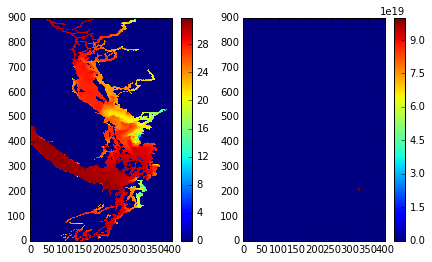

In [19]:
fig, axs = plt.subplots(1, 2, figsize=(7, 4))
mesh = axs[0].pcolormesh(threemonthsbase_sal[0]*tmask[0, 1])
fig.colorbar(mesh, ax=axs[0])
mesh = axs[1].pcolormesh(threemonthv1803_sal[0]*tmask[0, 1])
fig.colorbar(mesh, ax=axs[1])

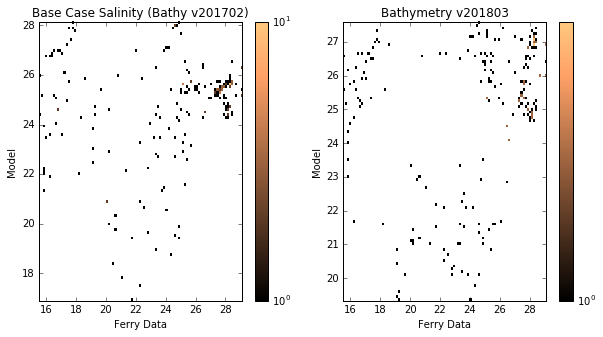

In [178]:
fig, axs = plt.subplots(1, 2, figsize = (10,5))
c, xedge, yedge, im = axs[0].hist2d(list_of_ferrybase_sals, 
                                list_of_modelbase_sals, bins = 100, norm=LogNorm(), cmap='copper')
im
fig.colorbar(im, ax=axs[0])
axs[0].set_xlabel('Ferry Data')
axs[0].set_ylabel('Model')
axs[0].set_title('Base Case Salinity (Bathy v201702)')

c, xedge, yedge, im = axs[1].hist2d(list_of_ferrybase_sals, 
                                list_of_modelv18_sals, bins = 100, norm=LogNorm(), cmap='copper')
im
fig.colorbar(im, ax=axs[1])
axs[1].set_xlabel('Ferry Data')
axs[1].set_ylabel('Model')
axs[1].set_title('Bathymetry v201803');

In [179]:
print('bias =  ' + str(-np.mean(list_of_ferrybase_sals) + np.mean(list_of_modelbase_sals)))
print('RMSE = ' + str(np.sqrt(np.sum((list_of_modelbase_sals - list_of_ferrybase_sals)**2) 
                              / len(list_of_modelbase_sals))))
xbar = np.mean(list_of_ferrybase_sals)
print('Willmott = ' + str(1-(np.sum((list_of_modelbase_sals - list_of_ferrybase_sals)**2)  / 
                             np.sum((np.abs(list_of_modelbase_sals - xbar) 
                                     + np.abs(list_of_ferrybase_sals - xbar))**2))))

print('bias =  ' + str(-np.mean(list_of_ferrybase_sals) + np.mean(list_of_modelv18_sals)))
print('RMSE = ' + str(np.sqrt(np.sum((list_of_modelv18_sals - list_of_ferrybase_sals)**2) 
                              / len(list_of_modelv18_sals))))

print('Willmott = ' + str(1-(np.sum((list_of_modelv18_sals - list_of_ferrybase_sals)**2)  / 
                             np.sum((np.abs(list_of_modelv18_sals - xbar) 
                                     + np.abs(list_of_ferrybase_sals - xbar))**2))))

bias =  0.400130617412
RMSE = 4.2715693582
Willmott = 0.434873663005
bias =  0.654166090137
RMSE = 4.17277972462
Willmott = 0.511808702455


|  Salinity         | Bias          | RMSE          | WS             |
|-----------|---------------|---------------|----------------|
| Base Case | 1.52707575253 | 5.24464144716 | 0.777509231541 |
| Test A    | 1.94161838071 | 5.56267806197 | 0.743195687801 |
| Test B    | 1.79176312479 | 5.34840517666 | 0.767047886945 |